Задание: https://docs.google.com/document/d/18bJyle9I2GCnxb4sygRHswLA_k6lLlLdW_Gatd_GRwM  
Доп. материалы:  
https://incompleteideas.net/book/bookdraft2017nov5.pdf  
https://github.com/udacity/deep-reinforcement-learning/blob/master/cheatsheet/cheatsheet.pdf  



# Advanced DL and RL: Домашнее задание 2  
Второе домашнее задание опять посвящено игре; его базовая часть, надеюсь, не слишком большая, но я добавил опциональную часть, которая, думаю, должна быть достаточно интересной для любого слушателя. Как обычно, в качестве решения ожидается ссылка на jupyter-ноутбук на вашем github (или публичный, или с доступом для snikolenko); ссылку обязательно нужно прислать в виде сданного домашнего задания на портале Академии. Любые комментарии, новые идеи и рассуждения на тему, как всегда, категорически приветствуются.  

## Часть первая: крестики-нолики при помощи Q-обучения  
В коде, прилагающемся к последней лекции про обучение с подкреплением, реализован Environment для крестиков-ноликов, в котором можно при инициализации указывать разные размеры доски и условия победы, а также функции для рисования, в том числе с указанием оценки различных действий. С этим окружением все задания и связаны.  

In [3]:
import gym

import sys
from time import sleep
import tqdm.notebook as tq
import copy
from collections import defaultdict
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import json
import math
import random
import numpy as np
import scipy as sp
import scipy.stats as st
import scipy.integrate as integrate
from scipy.stats import multivariate_normal
from sklearn import linear_model
from sklearn.utils.testing import ignore_warnings
from sklearn.exceptions import ConvergenceWarning
import statsmodels.api as sm
from matplotlib.colors import LogNorm
import pickle

from joblib import Parallel, delayed
import multiprocessing
from collections import namedtuple
from itertools import count

import cProfile
from datetime import datetime

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as T
from torch.autograd import Variable

sns.set_style("whitegrid")
sns.set_palette("colorblind")
palette = sns.color_palette()
figsize = (15,8)
legend_fontsize = 16

from matplotlib import rc
rc('font',**{'family':'sans-serif'})
rc('text', usetex=True)
rc('text.latex',preamble=r'\usepackage[utf8]{inputenc}')
rc('text.latex',preamble=r'\usepackage[russian]{babel}')
rc('figure', **{'dpi': 300})

In [4]:
N_ROWS, N_COLS, N_WIN = 3, 3, 3

Я допилил класс TicTacToe под себя. Добавил дополнительные методы. 

In [5]:
class TicTacToe(gym.Env):
    def __init__(self, n_rows=N_ROWS, n_cols=N_COLS, n_win=N_WIN):
        self.n_rows = n_rows
        self.n_cols = n_cols
        self.n_win = n_win

        self.board = np.zeros((self.n_rows, self.n_cols), dtype=int)
        self.gameOver = False
        self.boardHash = None
        # ход первого игрока
        self.curTurn = 1
        self.emptySpaces = None
        
        self.reset()
        
    def getNumStates(self):
        return self.n_rows * self.n_cols * 3
    
    def getTotalNumActions(self):
        return self.n_rows * self.n_cols

    def getEmptySpaces(self):
        if self.emptySpaces is None:
            res = np.where(self.board == 0)
            self.emptySpaces = np.array([ (i, j) for i,j in zip(res[0], res[1]) ])
        return self.emptySpaces

    def makeMove(self, player, i, j):
        self.board[i, j] = player
        self.emptySpaces = None
        self.boardHash = None

    def getHash(self):
        if self.boardHash is None:
            self.boardHash = ''.join(['%s' % (x+1) for x in self.board.reshape(self.n_rows * self.n_cols)])
        return self.boardHash

    def isTerminal(self):
        # проверим, не закончилась ли игра
        cur_marks, cur_p = np.where(self.board == self.curTurn), self.curTurn
        for i,j in zip(cur_marks[0], cur_marks[1]):
            # print((i,j))
            win = False
            if i <= self.n_rows - self.n_win:
                if np.all(self.board[i:i+self.n_win, j] == cur_p):
                    win = True
            if not win:
                if j <= self.n_cols - self.n_win:
                    if np.all(self.board[i,j:j+self.n_win] == cur_p):
                        win = True
            if not win:
                if i <= self.n_rows - self.n_win and j <= self.n_cols - self.n_win:
                    if np.all(np.array([ self.board[i+k,j+k] == cur_p for k in range(self.n_win) ])):
                        win = True
            if not win:
                if i <= self.n_rows - self.n_win and j >= self.n_win-1:
                    if np.all(np.array([ self.board[i+k,j-k] == cur_p for k in range(self.n_win) ])):
                        win = True
            if win:
                self.gameOver = True
                return self.curTurn

        if len(self.getEmptySpaces()) == 0:
            self.gameOver = True
            return 0

        self.gameOver = False
        return None

    def printBoard(self):
        for i in range(0, self.n_rows):
            print('----'*(self.n_cols)+'-')
            out = '| '
            for j in range(0, self.n_cols):
                if self.board[i, j] == 1:
                    token = 'x'
                if self.board[i, j] == -1:
                    token = 'o'
                if self.board[i, j] == 0:
                    token = ' '
                out += token + ' | '
            print(out)
        print('----'*(self.n_cols)+'-')

    def getState(self):
        return (self.getHash(), self.getEmptySpaces(), self.curTurn)

    def action_from_int(self, action_int):
        return [int(action_int // self.n_cols), int(action_int % self.n_cols)]

    def int_from_action(self, action):
        return action[0] * self.n_cols + action[1]
    
    def step(self, action):
        if self.board[action[0], action[1]] != 0:
            return self.getState(), -10, True, {}
        self.makeMove(self.curTurn, action[0], action[1])
        reward = self.isTerminal()
        self.curTurn = -self.curTurn
        return self.getState(), 0 if reward is None else reward, reward is not None, {}

    def reset(self):
        self.board = np.zeros((self.n_rows, self.n_cols), dtype=int)
        self.boardHash = None
        self.gameOver = False
        self.emptySpaces = None
        self.curTurn = 1
        return self.getState()
    
    def random_available_action(self):
        return random.choice(self.getEmptySpaces())
    
    def random_available_action_no(self):
        return self.int_from_action(self.random_available_action())
    
    def is_available_action(self, action):
        # print(action, self.getEmptySpaces().tolist())
        return action in self.getEmptySpaces().tolist()
    
    def is_available_action_int(self, action_no):
        return self.is_available_action(self.action_from_int(action_no))

In [6]:
def plot_board(env, pi, showtext=True, verbose=True, fontq=20, fontx=60):
    '''Рисуем доску с оценками из стратегии pi'''
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    X, Y = np.meshgrid(np.arange(0, env.n_rows), np.arange(0, env.n_rows))
    Z = np.zeros((env.n_rows, env.n_cols)) + .01
    s, actions = env.getHash(), env.getEmptySpaces()
    if pi is not None and s in pi.Q:
        for i, a in enumerate(actions):
            Z[a[0], a[1]] = pi.Q[s][i]
    ax.set_xticks([])
    ax.set_yticks([])
    surf = ax.imshow(Z, cmap=plt.get_cmap('Accent', 10), vmin=-1, vmax=1)
    if showtext:
        for i,a in enumerate(actions):
            if pi is not None and s in pi.Q:
                ax.text( a[1] , a[0] , "%.3f" % pi.Q[s][i], fontsize=fontq, horizontalalignment='center', verticalalignment='center', color="w" )
#             else:
#                 ax.text( a[1] , a[0] , "???", fontsize=fontq, horizontalalignment='center', verticalalignment='center', color="w" )
    for i in range(env.n_rows):
        for j in range(env.n_cols):
            if env.board[i, j] == -1:
                ax.text(j, i, "O", fontsize=fontx, horizontalalignment='center', verticalalignment='center', color="w" )
            if env.board[i, j] == 1:
                ax.text(j, i, "X", fontsize=fontx, horizontalalignment='center', verticalalignment='center', color="w" )
    cbar = plt.colorbar(surf, ticks=[0, 1])
    ax.grid(False)
    plt.show()

def get_and_print_move(env, pi, s, actions, random=False, verbose=True, fontq=20, fontx=60):
    '''Делаем ход, рисуем доску'''
    plot_board(env, pi, fontq=fontq, fontx=fontx)
    if verbose and (pi is not None):
        if s in pi.Q:
            for i,a in enumerate(actions):
                print(i, a, pi.Q[s][i])
        else:
            print("Стратегия не знает, что делать...")
    if random:
        return np.random.randint(len(actions))
    else:
        return pi.getActionGreedy(s, len(actions))

In [7]:
def plot_test_game(env, pi1, pi2, random_crosses=False, random_naughts=True, verbose=True, fontq=20, fontx=60):
    '''Играем тестовую партию между стратегиями или со случайными ходами, рисуем ход игры'''
    done = False
    env.reset()
    while not done:
        s, actions = env.getHash(), env.getEmptySpaces()
        if env.curTurn == 1:
            a = get_and_print_move(env, pi1, s, actions, random=random_crosses, verbose=verbose, fontq=fontq, fontx=fontx)
        else:
            a = get_and_print_move(env, pi2, s, actions, random=random_naughts, verbose=verbose, fontq=fontq, fontx=fontx)
        observation, reward, done, info = env.step(actions[a])
        if reward == 1:
            print("Крестики выиграли!")
            plot_board(env, None, showtext=False, fontq=fontq, fontx=fontx)
        if reward == -1:
            print("Нолики выиграли!")
            plot_board(env, None, showtext=False, fontq=fontq, fontx=fontx)

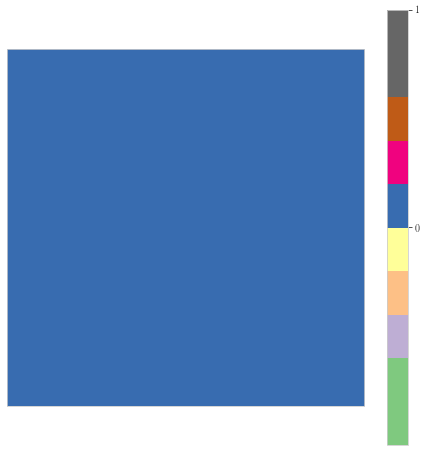

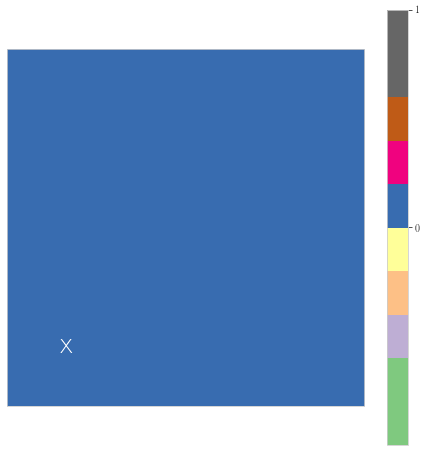

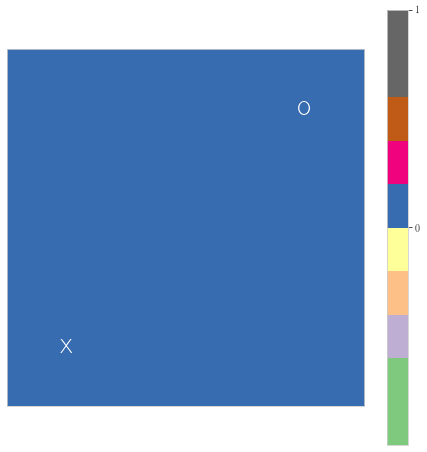

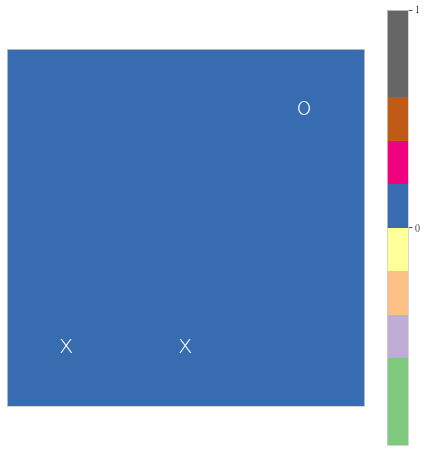

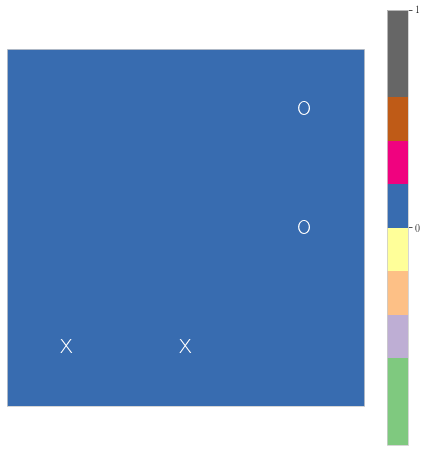

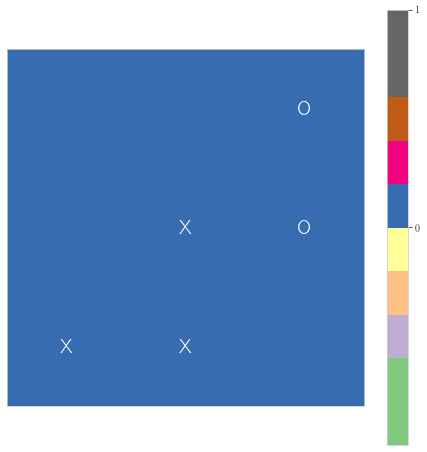

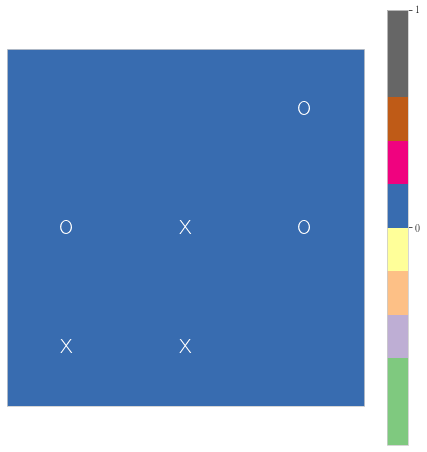

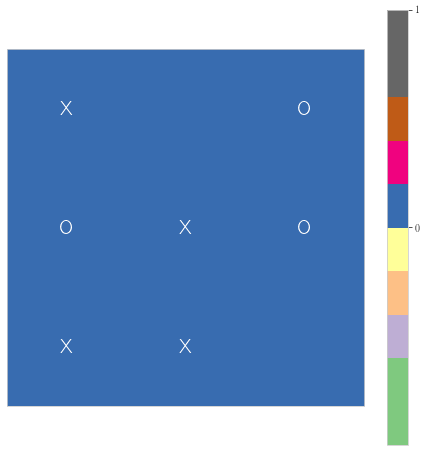

Нолики выиграли!


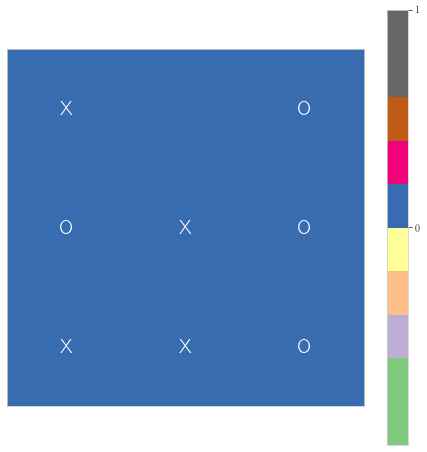

In [6]:
env = TicTacToe(n_rows=3, n_cols=3, n_win=3)
plot_test_game(env, None, None, random_crosses=True, random_naughts=True, verbose=True, fontx=20)

Отлично. Игровая среда работает, давайте проведём случайную игру, посмотрим, как записываются состояния, вознаграждения и т.д.

In [7]:
env = TicTacToe(n_rows=3, n_cols=3, n_win=3)
for i in range(9):
    print(env.step(env.random_available_action()))
print(env.step((0, 0)))

(('111211111', array([[0, 0],
       [0, 1],
       [0, 2],
       [1, 1],
       [1, 2],
       [2, 0],
       [2, 1],
       [2, 2]]), -1), 0, False, {})
(('111211110', array([[0, 0],
       [0, 1],
       [0, 2],
       [1, 1],
       [1, 2],
       [2, 0],
       [2, 1]]), 1), 0, False, {})
(('121211110', array([[0, 0],
       [0, 2],
       [1, 1],
       [1, 2],
       [2, 0],
       [2, 1]]), -1), 0, False, {})
(('121201110', array([[0, 0],
       [0, 2],
       [1, 2],
       [2, 0],
       [2, 1]]), 1), 0, False, {})
(('221201110', array([[0, 2],
       [1, 2],
       [2, 0],
       [2, 1]]), -1), 0, False, {})
(('221201100', array([[0, 2],
       [1, 2],
       [2, 0]]), 1), 0, False, {})
(('222201100', array([[1, 2],
       [2, 0]]), -1), 1, True, {})
(('222201000', array([[1, 2]]), 1), -1, True, {})
(('222202000', array([], dtype=float64), -1), 1, True, {})
(('222202000', array([], dtype=float64), -1), -10, True, {})


Реализуйте обычное (табличное) Q-обучение. Обучите стратегии крестиков и ноликов для доски 3х3.  

!["Q-learning")](https://hsto.org/webt/wf/6x/fi/wf6xfiyazgu0echvfsw8d9-oly4.png "Q-learning")

In [8]:
def eps_greedy_strategy(env, epsilon, Q):
    """Эпсилон-жадная стратегия.
    С вероятностью эпсилон выбирает случайное действие, иначе - наиболее выгодное действие.
    
    Аргументы:
    env -- Окружение.
    epsilon -- Вероятность случайного действия.
    Q -- Выгода от действий в каждом состоянии dict: key - state, value - list values of actions.
    """
    state = env.getState()
    state = (state[0], state[2])
    if random.random() > epsilon:
        available = [(i, v) for i, v in enumerate(Q[state]) if env.is_available_action_int(i)]
        # print(available)
        best_available = list(filter(lambda x: x[1] == max(available, key=lambda x: x[1])[1], available))
        best_action = list(env.action_from_int(random.choice(best_available)[0]))
        # print("best action", best_action)
        return best_action
    else:
        # print("random action")
        return env.random_available_action()

In [9]:
random_policy = lambda env: eps_greedy_strategy(env, 1.0, {})
best_policy = lambda env, Q: eps_greedy_strategy(env, 0.0, Q)

In [10]:
def eps_generator(eps_start=1.0, eps_min=0.01, decay=0.99999):
    """Генератор элементов убывающей геометрической прогрессии с ограничением значения минимального элемента.
    
    Аргументы:
    eps_start -- Первый элемент последовательности.
    eps_min -- Минимальное значение элементов.
    decay -- Знаменатель прогрессии.
    """
    epsilon = eps_start
    yield epsilon
    command = None
    while True:
        if command == "restart":  # Начать сначала
            epsilon = eps_start
            yield epsilon
        else:
            epsilon = max(epsilon*decay, eps_min)  # Новый член последовательности
        command = (yield epsilon)

In [11]:
def chunks(lst, n):
    """Yield successive n-sized chunks from lst."""
    for i in range(0, len(lst), n):
        yield lst[i:i + n]

In [51]:
def play_episode(env, my_policy, opponent_policy, verbose=False):
    env.reset()
    if verbose:
        env.printBoard()
    done = False
    reward = 0
    
    while not done:
        action = my_policy(env)
        state, reward, done, _ = env.step(action)
        if verbose:
            env.printBoard()
        if done:
            break
        action = opponent_policy(env)
        state, reward, done, _ = env.step(action)
        if verbose:
            env.printBoard()
    return reward

In [52]:
def policy_quality(env, my_policy, opponent_policy=random_policy, n_episodes=10000):
    reward = 0
    for i in range(n_episodes):
        reward += play_episode(env, my_policy, opponent_policy)
    return reward / n_episodes

Перед тем, как взяться за обучение, нужно подумать, против кого мы будем учиться играть, как будем оценивать качество, насколько жадным нужно быть при выборе действий и т.д.?  

Против кого играем?  
Можно было бы играть  
* против случайной стратегии;  
* против стратегии, которая параллельно обучается играть за другого игрока;  
* против какой-то фиксированной стратегии (эвристики, шаблоны и т.д.)  
Реализация третьего варианта нетривиальна, а первые два кажутся неплохими и простыми.  

Как оценивать качество игры?  
Очевидно, что для оценки качества надо сыграть много партий. Но с кем? Хотелось бы играть с таким игроком, который будет выискивать слабые места в стратегии противника, создавать неожиданные ситуации. Но реализовать такое - непростая задача. Если играть с какой-то фиксированной жёсткой стратегией, то кажется, что мы очень скудную оценку дадим, потому что оценим качество игры только в маленьком наборе ситуаций, которые эта стратегия умеет создавать, а это не совсем то, что хочется. Хочется, чтобы обученная стратегия умела действовать в большом количестве возможных ситуаций. Поэтому я решил, что качество буду оценивать, играя против случайной стратегии.  
Нужно заметить, что если я учусь играть с одной стратегией, а качество оцениваю, играя с другой стратегией, то игра будет не самая лучшая, а оценка заниженная, но я думаю, это не страшно, так даже интереснее.  
Так же нужно понимать, что при увеличении размеров доски и длины выстраиваемой линии случайная стратегия будет играть всё хуже и хуже.  

Насколько много надо исследовать?  
Мне кажется, в крестиках ноликах нужно исследовать много. Нужно за время обучения попытаться посмотреть, что будет в самых разных ситуациях. Если мы будем играть очень жадно против таких же жадных игроков, то мы изучим очень мало игровых состояний.  

В этом задании я решил параллельно учиться играть за обоих игроков и оценивать качество игры, играя со случайной стартегией.

In [79]:
def qlearning(env, gamma=0.8, learning_rate=0.001, n_episodes=100000):
    Q = defaultdict(lambda: np.zeros(env.getTotalNumActions()))
    
    quality = []
    my_policy = lambda env: eps_greedy_strategy(env, 0, Q)
    quality.append(policy_quality(env, my_policy, n_episodes=n_episodes))
    
    eps_gen = eps_generator(eps_start=1.0, eps_min=0.01, decay=0.01**(1/n_episodes))
    
    pbar = tq.tqdm(total=n_episodes, desc='Episode', file=sys.stdout)
    for i in range(n_episodes):
        eps = next(eps_gen)
        state = env.reset()
        state = (state[0], state[2])
        
        reward_coef = 1.0
        if np.random.sample() > 0.5:
            # Other player
            action_other = eps_greedy_strategy(env, eps, Q)
            action_no_other = env.int_from_action(action_other)
            next_state_other, reward_other, done_other, _ = env.step(action_other)
            assert reward_other != -10
            state = (next_state_other[0], next_state_other[2])
            reward_coef = -reward_coef
        
        done = False
        reward = 0
        
        # While episode is not over
        while not done:
            # Choose action
            action = eps_greedy_strategy(env, eps, Q)
            action_no = env.int_from_action(action)
            # Do the action
            next_state, reward, done, _ = env.step(action)
            assert reward != -10
            reward *= reward_coef
            assert reward >= 0
            next_state = (next_state[0], next_state[2])
            if not done:
                # Other player
                action_other = eps_greedy_strategy(env, eps, Q)
                action_no_other = env.int_from_action(action_other)
                next_state_other, reward_other, done_other, _ = env.step(action_other)
                assert reward_other != -10
                reward = reward_other
                reward *= reward_coef
                assert reward <= 0
                next_state = (next_state_other[0], next_state_other[2])
                done = done_other
            # Update q_values
            td_target = reward + gamma * np.max(Q[next_state])
            td_error = td_target - Q[state][action_no]
            Q[state][action_no] += learning_rate * td_error
            # Update state
            state = next_state
        pbar.write(f"Episode {i} finish with reward {reward}.")
        if (i + 1) % (n_episodes // 10) == 0:
            my_policy = lambda env: eps_greedy_strategy(env, 0, Q)
            quality.append(policy_quality(env, my_policy, n_episodes=n_episodes))
            pbar.write(f"Policy reward vs random policy: {quality[-1]}. Current epsilon: {eps}. ")
        pbar.update(1)
        sleep(0.001)

    plt.plot(list(range(0, n_episodes + 1, n_episodes // 10)), quality)
    plt.ylabel("Reward vs random policy")
    plt.xlabel("Iteration of learning")
    
    best_policy = lambda env, Q: eps_greedy_strategy(env, 0, Q)
    return best_policy, Q

Episode 0 finish with reward 1.0.
Episode 1 finish with reward -1.0.
Episode 2 finish with reward 0.0.
Episode 3 finish with reward -1.0.
Episode 4 finish with reward 1.0.
Episode 5 finish with reward -1.0.
Episode 6 finish with reward 1.0.
Episode 7 finish with reward 1.0.
Episode 8 finish with reward 1.0.
Episode 9 finish with reward 1.0.
Episode 10 finish with reward -1.0.
Episode 11 finish with reward -0.0.
Episode 12 finish with reward 1.0.
Episode 13 finish with reward 1.0.
Episode 14 finish with reward 1.0.
Episode 15 finish with reward -1.0.
Episode 16 finish with reward -1.0.
Episode 17 finish with reward -1.0.
Episode 18 finish with reward 1.0.
Episode 19 finish with reward 1.0.
Episode 20 finish with reward 1.0.
Episode 21 finish with reward 1.0.
Episode 22 finish with reward -1.0.
Episode 23 finish with reward 1.0.
Episode 24 finish with reward -1.0.
Episode 25 finish with reward -1.0.
Episode 26 finish with reward 1.0.
Episode 27 finish with reward -1.0.
Episode 28 finish 

Episode 270 finish with reward 1.0.
Episode 271 finish with reward -1.0.
Episode 272 finish with reward 1.0.
Episode 273 finish with reward 1.0.
Episode 274 finish with reward 1.0.
Episode 275 finish with reward -0.0.
Episode 276 finish with reward -1.0.
Episode 277 finish with reward -1.0.
Episode 278 finish with reward -1.0.
Episode 279 finish with reward 1.0.
Episode 280 finish with reward 1.0.
Episode 281 finish with reward 1.0.
Episode 282 finish with reward -1.0.
Episode 283 finish with reward -1.0.
Episode 284 finish with reward 1.0.
Episode 285 finish with reward 1.0.
Episode 286 finish with reward -1.0.
Episode 287 finish with reward 1.0.
Episode 288 finish with reward -1.0.
Episode 289 finish with reward 1.0.
Episode 290 finish with reward -1.0.
Episode 291 finish with reward -1.0.
Episode 292 finish with reward -1.0.
Episode 293 finish with reward -1.0.
Episode 294 finish with reward 1.0.
Episode 295 finish with reward 1.0.
Episode 296 finish with reward -1.0.
Episode 297 fi

Policy reward vs random policy: 0.2784. Current epsilon: 0.6315387453743871. 
Episode 500 finish with reward -0.0.
Episode 501 finish with reward 0.0.
Episode 502 finish with reward 1.0.
Episode 503 finish with reward 1.0.
Episode 504 finish with reward 0.0.
Episode 505 finish with reward -1.0.
Episode 506 finish with reward 1.0.
Episode 507 finish with reward 1.0.
Episode 508 finish with reward -1.0.
Episode 509 finish with reward -1.0.
Episode 510 finish with reward -1.0.
Episode 511 finish with reward 1.0.
Episode 512 finish with reward 1.0.
Episode 513 finish with reward 1.0.
Episode 514 finish with reward -1.0.
Episode 515 finish with reward 1.0.
Episode 516 finish with reward -1.0.
Episode 517 finish with reward 1.0.
Episode 518 finish with reward 1.0.
Episode 519 finish with reward 1.0.
Episode 520 finish with reward 1.0.
Episode 521 finish with reward -1.0.
Episode 522 finish with reward 0.0.
Episode 523 finish with reward 1.0.
Episode 524 finish with reward -1.0.
Episode 525 f

Episode 777 finish with reward -1.0.
Episode 778 finish with reward -1.0.
Episode 779 finish with reward -1.0.
Episode 780 finish with reward 1.0.
Episode 781 finish with reward 1.0.
Episode 782 finish with reward 1.0.
Episode 783 finish with reward 0.0.
Episode 784 finish with reward -0.0.
Episode 785 finish with reward 1.0.
Episode 786 finish with reward 1.0.
Episode 787 finish with reward -1.0.
Episode 788 finish with reward 1.0.
Episode 789 finish with reward -1.0.
Episode 790 finish with reward 1.0.
Episode 791 finish with reward -1.0.
Episode 792 finish with reward -0.0.
Episode 793 finish with reward -1.0.
Episode 794 finish with reward -1.0.
Episode 795 finish with reward 0.0.
Episode 796 finish with reward -0.0.
Episode 797 finish with reward -1.0.
Episode 798 finish with reward -1.0.
Episode 799 finish with reward 1.0.
Episode 800 finish with reward 1.0.
Episode 801 finish with reward 1.0.
Episode 802 finish with reward -0.0.
Episode 803 finish with reward -1.0.
Episode 804 f

Episode 1057 finish with reward 1.0.
Episode 1058 finish with reward 1.0.
Episode 1059 finish with reward -1.0.
Episode 1060 finish with reward 0.0.
Episode 1061 finish with reward -1.0.
Episode 1062 finish with reward -1.0.
Episode 1063 finish with reward 0.0.
Episode 1064 finish with reward -1.0.
Episode 1065 finish with reward 1.0.
Episode 1066 finish with reward -1.0.
Episode 1067 finish with reward 1.0.
Episode 1068 finish with reward 1.0.
Episode 1069 finish with reward -0.0.
Episode 1070 finish with reward 1.0.
Episode 1071 finish with reward 1.0.
Episode 1072 finish with reward 1.0.
Episode 1073 finish with reward -1.0.
Episode 1074 finish with reward 1.0.
Episode 1075 finish with reward -1.0.
Episode 1076 finish with reward 1.0.
Episode 1077 finish with reward -0.0.
Episode 1078 finish with reward -0.0.
Episode 1079 finish with reward 0.0.
Episode 1080 finish with reward -1.0.
Episode 1081 finish with reward -1.0.
Episode 1082 finish with reward 1.0.
Episode 1083 finish with r

Episode 1280 finish with reward 1.0.
Episode 1281 finish with reward 1.0.
Episode 1282 finish with reward -1.0.
Episode 1283 finish with reward -0.0.
Episode 1284 finish with reward -1.0.
Episode 1285 finish with reward -1.0.
Episode 1286 finish with reward 1.0.
Episode 1287 finish with reward -1.0.
Episode 1288 finish with reward 1.0.
Episode 1289 finish with reward 1.0.
Episode 1290 finish with reward 1.0.
Episode 1291 finish with reward 1.0.
Episode 1292 finish with reward 1.0.
Episode 1293 finish with reward -0.0.
Episode 1294 finish with reward 1.0.
Episode 1295 finish with reward -1.0.
Episode 1296 finish with reward 1.0.
Episode 1297 finish with reward -1.0.
Episode 1298 finish with reward 1.0.
Episode 1299 finish with reward 1.0.
Episode 1300 finish with reward 1.0.
Episode 1301 finish with reward -1.0.
Episode 1302 finish with reward -1.0.
Episode 1303 finish with reward -1.0.
Episode 1304 finish with reward 1.0.
Episode 1305 finish with reward 0.0.
Episode 1306 finish with re

Policy reward vs random policy: 0.6282. Current epsilon: 0.2514201030159035. 
Episode 1500 finish with reward -1.0.
Episode 1501 finish with reward 1.0.
Episode 1502 finish with reward -1.0.
Episode 1503 finish with reward 1.0.
Episode 1504 finish with reward -1.0.
Episode 1505 finish with reward -1.0.
Episode 1506 finish with reward 1.0.
Episode 1507 finish with reward 0.0.
Episode 1508 finish with reward 0.0.
Episode 1509 finish with reward 1.0.
Episode 1510 finish with reward 1.0.
Episode 1511 finish with reward 0.0.
Episode 1512 finish with reward -1.0.
Episode 1513 finish with reward 1.0.
Episode 1514 finish with reward 1.0.
Episode 1515 finish with reward 0.0.
Episode 1516 finish with reward 0.0.
Episode 1517 finish with reward -0.0.
Episode 1518 finish with reward 1.0.
Episode 1519 finish with reward 1.0.
Episode 1520 finish with reward 1.0.
Episode 1521 finish with reward 1.0.
Episode 1522 finish with reward -1.0.
Episode 1523 finish with reward 0.0.
Episode 1524 finish with re

Episode 1764 finish with reward -0.0.
Episode 1765 finish with reward 0.0.
Episode 1766 finish with reward -1.0.
Episode 1767 finish with reward -1.0.
Episode 1768 finish with reward 1.0.
Episode 1769 finish with reward -1.0.
Episode 1770 finish with reward 1.0.
Episode 1771 finish with reward 0.0.
Episode 1772 finish with reward -0.0.
Episode 1773 finish with reward -0.0.
Episode 1774 finish with reward 0.0.
Episode 1775 finish with reward 0.0.
Episode 1776 finish with reward -1.0.
Episode 1777 finish with reward 0.0.
Episode 1778 finish with reward 0.0.
Episode 1779 finish with reward 1.0.
Episode 1780 finish with reward -1.0.
Episode 1781 finish with reward 0.0.
Episode 1782 finish with reward 1.0.
Episode 1783 finish with reward 1.0.
Episode 1784 finish with reward 1.0.
Episode 1785 finish with reward 1.0.
Episode 1786 finish with reward -1.0.
Episode 1787 finish with reward -0.0.
Episode 1788 finish with reward -0.0.
Episode 1789 finish with reward -0.0.
Episode 1790 finish with r

Policy reward vs random policy: 0.6574. Current epsilon: 0.1586353605478518. 
Episode 2000 finish with reward -1.0.
Episode 2001 finish with reward 1.0.
Episode 2002 finish with reward -0.0.
Episode 2003 finish with reward 0.0.
Episode 2004 finish with reward -0.0.
Episode 2005 finish with reward -0.0.
Episode 2006 finish with reward -0.0.
Episode 2007 finish with reward 1.0.
Episode 2008 finish with reward -1.0.
Episode 2009 finish with reward 1.0.
Episode 2010 finish with reward 0.0.
Episode 2011 finish with reward -0.0.
Episode 2012 finish with reward -0.0.
Episode 2013 finish with reward -0.0.
Episode 2014 finish with reward 0.0.
Episode 2015 finish with reward 0.0.
Episode 2016 finish with reward -1.0.
Episode 2017 finish with reward 1.0.
Episode 2018 finish with reward -1.0.
Episode 2019 finish with reward -1.0.
Episode 2020 finish with reward 1.0.
Episode 2021 finish with reward -1.0.
Episode 2022 finish with reward 0.0.
Episode 2023 finish with reward -1.0.
Episode 2024 finish 

Episode 2265 finish with reward -0.0.
Episode 2266 finish with reward 1.0.
Episode 2267 finish with reward 0.0.
Episode 2268 finish with reward 0.0.
Episode 2269 finish with reward 0.0.
Episode 2270 finish with reward -1.0.
Episode 2271 finish with reward 0.0.
Episode 2272 finish with reward 1.0.
Episode 2273 finish with reward -0.0.
Episode 2274 finish with reward -0.0.
Episode 2275 finish with reward 1.0.
Episode 2276 finish with reward -1.0.
Episode 2277 finish with reward -1.0.
Episode 2278 finish with reward -1.0.
Episode 2279 finish with reward -0.0.
Episode 2280 finish with reward -1.0.
Episode 2281 finish with reward -0.0.
Episode 2282 finish with reward 1.0.
Episode 2283 finish with reward -1.0.
Episode 2284 finish with reward 1.0.
Episode 2285 finish with reward -1.0.
Episode 2286 finish with reward -0.0.
Episode 2287 finish with reward -1.0.
Episode 2288 finish with reward -0.0.
Episode 2289 finish with reward -1.0.
Episode 2290 finish with reward 0.0.
Episode 2291 finish wi

Policy reward vs random policy: 0.6974. Current epsilon: 0.10009214583193086. 
Episode 2500 finish with reward -0.0.
Episode 2501 finish with reward 0.0.
Episode 2502 finish with reward 1.0.
Episode 2503 finish with reward 0.0.
Episode 2504 finish with reward 0.0.
Episode 2505 finish with reward 1.0.
Episode 2506 finish with reward -0.0.
Episode 2507 finish with reward 0.0.
Episode 2508 finish with reward -0.0.
Episode 2509 finish with reward -0.0.
Episode 2510 finish with reward -1.0.
Episode 2511 finish with reward 0.0.
Episode 2512 finish with reward -0.0.
Episode 2513 finish with reward 0.0.
Episode 2514 finish with reward 1.0.
Episode 2515 finish with reward -0.0.
Episode 2516 finish with reward -0.0.
Episode 2517 finish with reward -0.0.
Episode 2518 finish with reward 0.0.
Episode 2519 finish with reward 1.0.
Episode 2520 finish with reward 1.0.
Episode 2521 finish with reward -0.0.
Episode 2522 finish with reward -0.0.
Episode 2523 finish with reward 0.0.
Episode 2524 finish wi

Episode 2758 finish with reward -0.0.
Episode 2759 finish with reward -0.0.
Episode 2760 finish with reward -0.0.
Episode 2761 finish with reward -0.0.
Episode 2762 finish with reward -0.0.
Episode 2763 finish with reward 0.0.
Episode 2764 finish with reward -1.0.
Episode 2765 finish with reward -0.0.
Episode 2766 finish with reward 1.0.
Episode 2767 finish with reward 1.0.
Episode 2768 finish with reward -1.0.
Episode 2769 finish with reward -0.0.
Episode 2770 finish with reward -0.0.
Episode 2771 finish with reward -0.0.
Episode 2772 finish with reward 1.0.
Episode 2773 finish with reward 0.0.
Episode 2774 finish with reward -0.0.
Episode 2775 finish with reward 1.0.
Episode 2776 finish with reward 0.0.
Episode 2777 finish with reward -1.0.
Episode 2778 finish with reward 0.0.
Episode 2779 finish with reward 0.0.
Episode 2780 finish with reward 0.0.
Episode 2781 finish with reward 1.0.
Episode 2782 finish with reward -1.0.
Episode 2783 finish with reward 0.0.
Episode 2784 finish with

Policy reward vs random policy: 0.69. Current epsilon: 0.0631538745374396. 
Episode 3000 finish with reward -0.0.
Episode 3001 finish with reward -0.0.
Episode 3002 finish with reward -0.0.
Episode 3003 finish with reward -0.0.
Episode 3004 finish with reward 0.0.
Episode 3005 finish with reward -1.0.
Episode 3006 finish with reward 0.0.
Episode 3007 finish with reward 0.0.
Episode 3008 finish with reward 0.0.
Episode 3009 finish with reward 1.0.
Episode 3010 finish with reward -0.0.
Episode 3011 finish with reward -0.0.
Episode 3012 finish with reward -0.0.
Episode 3013 finish with reward 0.0.
Episode 3014 finish with reward 0.0.
Episode 3015 finish with reward 0.0.
Episode 3016 finish with reward 1.0.
Episode 3017 finish with reward -0.0.
Episode 3018 finish with reward 0.0.
Episode 3019 finish with reward -1.0.
Episode 3020 finish with reward -0.0.
Episode 3021 finish with reward -1.0.
Episode 3022 finish with reward 0.0.
Episode 3023 finish with reward -1.0.
Episode 3024 finish wit

Episode 3260 finish with reward 0.0.
Episode 3261 finish with reward 0.0.
Episode 3262 finish with reward -0.0.
Episode 3263 finish with reward 0.0.
Episode 3264 finish with reward -0.0.
Episode 3265 finish with reward -0.0.
Episode 3266 finish with reward -0.0.
Episode 3267 finish with reward -0.0.
Episode 3268 finish with reward -1.0.
Episode 3269 finish with reward 1.0.
Episode 3270 finish with reward 0.0.
Episode 3271 finish with reward 0.0.
Episode 3272 finish with reward -0.0.
Episode 3273 finish with reward 0.0.
Episode 3274 finish with reward 1.0.
Episode 3275 finish with reward -0.0.
Episode 3276 finish with reward 0.0.
Episode 3277 finish with reward -1.0.
Episode 3278 finish with reward 1.0.
Episode 3279 finish with reward -0.0.
Episode 3280 finish with reward -0.0.
Episode 3281 finish with reward 1.0.
Episode 3282 finish with reward 0.0.
Episode 3283 finish with reward 0.0.
Episode 3284 finish with reward 0.0.
Episode 3285 finish with reward -0.0.
Episode 3286 finish with r

Policy reward vs random policy: 0.717. Current epsilon: 0.039847400971778336. 
Episode 3500 finish with reward -0.0.
Episode 3501 finish with reward -1.0.
Episode 3502 finish with reward 0.0.
Episode 3503 finish with reward -1.0.
Episode 3504 finish with reward 0.0.
Episode 3505 finish with reward 0.0.
Episode 3506 finish with reward -1.0.
Episode 3507 finish with reward -1.0.
Episode 3508 finish with reward 1.0.
Episode 3509 finish with reward -1.0.
Episode 3510 finish with reward 0.0.
Episode 3511 finish with reward -0.0.
Episode 3512 finish with reward -0.0.
Episode 3513 finish with reward 0.0.
Episode 3514 finish with reward -0.0.
Episode 3515 finish with reward -0.0.
Episode 3516 finish with reward 0.0.
Episode 3517 finish with reward -0.0.
Episode 3518 finish with reward 0.0.
Episode 3519 finish with reward 0.0.
Episode 3520 finish with reward 0.0.
Episode 3521 finish with reward -0.0.
Episode 3522 finish with reward -0.0.
Episode 3523 finish with reward 1.0.
Episode 3524 finish 

Episode 3763 finish with reward 0.0.
Episode 3764 finish with reward 0.0.
Episode 3765 finish with reward -1.0.
Episode 3766 finish with reward 0.0.
Episode 3767 finish with reward 0.0.
Episode 3768 finish with reward 1.0.
Episode 3769 finish with reward 0.0.
Episode 3770 finish with reward -0.0.
Episode 3771 finish with reward -0.0.
Episode 3772 finish with reward 0.0.
Episode 3773 finish with reward -0.0.
Episode 3774 finish with reward -0.0.
Episode 3775 finish with reward -0.0.
Episode 3776 finish with reward 0.0.
Episode 3777 finish with reward -0.0.
Episode 3778 finish with reward -0.0.
Episode 3779 finish with reward 0.0.
Episode 3780 finish with reward 0.0.
Episode 3781 finish with reward -0.0.
Episode 3782 finish with reward -1.0.
Episode 3783 finish with reward -0.0.
Episode 3784 finish with reward -0.0.
Episode 3785 finish with reward -0.0.
Episode 3786 finish with reward 0.0.
Episode 3787 finish with reward -0.0.
Episode 3788 finish with reward 1.0.
Episode 3789 finish with

Policy reward vs random policy: 0.7288. Current epsilon: 0.025142010301590814. 
Episode 4000 finish with reward -1.0.
Episode 4001 finish with reward 0.0.
Episode 4002 finish with reward 0.0.
Episode 4003 finish with reward -0.0.
Episode 4004 finish with reward -0.0.
Episode 4005 finish with reward 0.0.
Episode 4006 finish with reward -0.0.
Episode 4007 finish with reward -0.0.
Episode 4008 finish with reward -0.0.
Episode 4009 finish with reward 0.0.
Episode 4010 finish with reward 0.0.
Episode 4011 finish with reward -1.0.
Episode 4012 finish with reward 0.0.
Episode 4013 finish with reward -0.0.
Episode 4014 finish with reward 0.0.
Episode 4015 finish with reward -1.0.
Episode 4016 finish with reward 1.0.
Episode 4017 finish with reward -0.0.
Episode 4018 finish with reward -0.0.
Episode 4019 finish with reward 0.0.
Episode 4020 finish with reward 0.0.
Episode 4021 finish with reward -1.0.
Episode 4022 finish with reward -1.0.
Episode 4023 finish with reward -0.0.
Episode 4024 finis

Episode 4260 finish with reward -1.0.
Episode 4261 finish with reward 0.0.
Episode 4262 finish with reward 0.0.
Episode 4263 finish with reward 0.0.
Episode 4264 finish with reward -0.0.
Episode 4265 finish with reward -0.0.
Episode 4266 finish with reward 0.0.
Episode 4267 finish with reward -0.0.
Episode 4268 finish with reward 0.0.
Episode 4269 finish with reward -0.0.
Episode 4270 finish with reward 0.0.
Episode 4271 finish with reward -0.0.
Episode 4272 finish with reward 0.0.
Episode 4273 finish with reward 0.0.
Episode 4274 finish with reward -0.0.
Episode 4275 finish with reward -0.0.
Episode 4276 finish with reward 0.0.
Episode 4277 finish with reward 0.0.
Episode 4278 finish with reward -0.0.
Episode 4279 finish with reward -0.0.
Episode 4280 finish with reward 0.0.
Episode 4281 finish with reward -0.0.
Episode 4282 finish with reward 1.0.
Episode 4283 finish with reward 0.0.
Episode 4284 finish with reward -0.0.
Episode 4285 finish with reward 0.0.
Episode 4286 finish with r

Policy reward vs random policy: 0.7274. Current epsilon: 0.01586353605478544. 
Episode 4500 finish with reward 0.0.
Episode 4501 finish with reward 0.0.
Episode 4502 finish with reward 0.0.
Episode 4503 finish with reward -0.0.
Episode 4504 finish with reward -0.0.
Episode 4505 finish with reward 0.0.
Episode 4506 finish with reward -0.0.
Episode 4507 finish with reward -0.0.
Episode 4508 finish with reward -0.0.
Episode 4509 finish with reward -0.0.
Episode 4510 finish with reward -0.0.
Episode 4511 finish with reward -0.0.
Episode 4512 finish with reward 0.0.
Episode 4513 finish with reward -0.0.
Episode 4514 finish with reward 0.0.
Episode 4515 finish with reward 0.0.
Episode 4516 finish with reward -0.0.
Episode 4517 finish with reward 0.0.
Episode 4518 finish with reward -0.0.
Episode 4519 finish with reward -0.0.
Episode 4520 finish with reward -0.0.
Episode 4521 finish with reward -0.0.
Episode 4522 finish with reward 0.0.
Episode 4523 finish with reward 0.0.
Episode 4524 finish

Episode 4766 finish with reward -0.0.
Episode 4767 finish with reward -0.0.
Episode 4768 finish with reward 1.0.
Episode 4769 finish with reward 0.0.
Episode 4770 finish with reward -0.0.
Episode 4771 finish with reward 0.0.
Episode 4772 finish with reward -1.0.
Episode 4773 finish with reward -0.0.
Episode 4774 finish with reward -0.0.
Episode 4775 finish with reward -0.0.
Episode 4776 finish with reward 0.0.
Episode 4777 finish with reward 0.0.
Episode 4778 finish with reward 0.0.
Episode 4779 finish with reward 0.0.
Episode 4780 finish with reward -0.0.
Episode 4781 finish with reward -1.0.
Episode 4782 finish with reward 0.0.
Episode 4783 finish with reward -0.0.
Episode 4784 finish with reward -0.0.
Episode 4785 finish with reward -0.0.
Episode 4786 finish with reward 0.0.
Episode 4787 finish with reward -0.0.
Episode 4788 finish with reward -0.0.
Episode 4789 finish with reward 0.0.
Episode 4790 finish with reward 0.0.
Episode 4791 finish with reward -0.0.
Episode 4792 finish wit

Policy reward vs random policy: 0.7196. Current epsilon: 0.01000921458319325. 


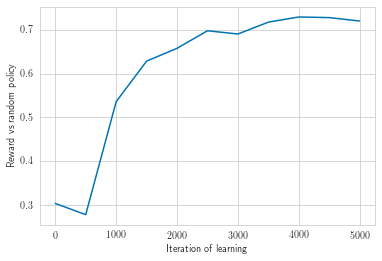

In [80]:
env = TicTacToe(n_rows=3, n_cols=3, n_win=3)
pi, Q = qlearning(env, n_episodes=5000)

График выше мне кажется очень неплохим.  
Оценка качества производилось в игре за крестики. У крестиков на маленьких досках есть явное преимущество, которое даёт первый ход, поэтому уже в начале обучения мы чаще выигрывали случайную стратегию, чем проигрывали ей.  
Но уже после 3000 итераций мы научились играть довольно неплохо.  
Так же обратите внимание, что я к концу обучения всё таки сделал стратегию более жадной, это позволило увидеть, что обе стороны научились играть одинаково хорошо и почти всегда в конце обучения играли в ничью.  
Думаю, что подобрав правило изменения epsilon, мы бы смогли быстрее обучиться до приемлемого качества, наверное, за 2000 итераций можно было бы закончить.  

Попробуйте обучить стратегии крестиков и ноликов для доски 4х4 и/или 5х5.  
Disclaimer: начиная с пункта 2, задания для досок размера больше 4х4 могут потребовать большого терпения или более сложных вычислительных реализаций (например, параллелизации). Не хочу в этом задании непременно требовать ни того ни другого, так что если не будет получаться доучить до победных стратегий, не страшно -- но покажите, что со временем что-то всё-таки улучшается.

Episode 0 finish with reward -1.0.
Episode 1 finish with reward -0.0.
Episode 2 finish with reward 1.0.
Episode 3 finish with reward -1.0.
Episode 4 finish with reward -1.0.
Episode 5 finish with reward -0.0.
Episode 6 finish with reward 1.0.
Episode 7 finish with reward 1.0.
Episode 8 finish with reward 0.0.
Episode 9 finish with reward 0.0.
Episode 10 finish with reward -0.0.
Episode 11 finish with reward 1.0.
Episode 12 finish with reward 1.0.
Episode 13 finish with reward -1.0.
Episode 14 finish with reward 1.0.
Episode 15 finish with reward -1.0.
Episode 16 finish with reward 1.0.
Episode 17 finish with reward 1.0.
Episode 18 finish with reward 1.0.
Episode 19 finish with reward -0.0.
Episode 20 finish with reward -1.0.
Episode 21 finish with reward 0.0.
Episode 22 finish with reward 1.0.
Episode 23 finish with reward 0.0.
Episode 24 finish with reward 1.0.
Episode 25 finish with reward -1.0.
Episode 26 finish with reward 0.0.
Episode 27 finish with reward -1.0.
Episode 28 finish 

Episode 260 finish with reward 0.0.
Episode 261 finish with reward 1.0.
Episode 262 finish with reward -0.0.
Episode 263 finish with reward 0.0.
Episode 264 finish with reward 0.0.
Episode 265 finish with reward 0.0.
Episode 266 finish with reward 1.0.
Episode 267 finish with reward -0.0.
Episode 268 finish with reward 0.0.
Episode 269 finish with reward -1.0.
Episode 270 finish with reward 1.0.
Episode 271 finish with reward -1.0.
Episode 272 finish with reward -0.0.
Episode 273 finish with reward 0.0.
Episode 274 finish with reward -0.0.
Episode 275 finish with reward -1.0.
Episode 276 finish with reward -1.0.
Episode 277 finish with reward 0.0.
Episode 278 finish with reward -1.0.
Episode 279 finish with reward 1.0.
Episode 280 finish with reward 0.0.
Episode 281 finish with reward -0.0.
Episode 282 finish with reward -1.0.
Episode 283 finish with reward 0.0.
Episode 284 finish with reward 1.0.
Episode 285 finish with reward 1.0.
Episode 286 finish with reward -1.0.
Episode 287 fini

Episode 530 finish with reward -1.0.
Episode 531 finish with reward 1.0.
Episode 532 finish with reward 0.0.
Episode 533 finish with reward 1.0.
Episode 534 finish with reward 1.0.
Episode 535 finish with reward 0.0.
Episode 536 finish with reward -1.0.
Episode 537 finish with reward -1.0.
Episode 538 finish with reward 0.0.
Episode 539 finish with reward 1.0.
Episode 540 finish with reward -1.0.
Episode 541 finish with reward 1.0.
Episode 542 finish with reward 1.0.
Episode 543 finish with reward -1.0.
Episode 544 finish with reward -1.0.
Episode 545 finish with reward 0.0.
Episode 546 finish with reward 0.0.
Episode 547 finish with reward 1.0.
Episode 548 finish with reward -0.0.
Episode 549 finish with reward -1.0.
Episode 550 finish with reward 1.0.
Episode 551 finish with reward 1.0.
Episode 552 finish with reward 0.0.
Episode 553 finish with reward 0.0.
Episode 554 finish with reward -1.0.
Episode 555 finish with reward -1.0.
Episode 556 finish with reward 1.0.
Episode 557 finish

Episode 756 finish with reward 1.0.
Episode 757 finish with reward -0.0.
Episode 758 finish with reward -0.0.
Episode 759 finish with reward 1.0.
Episode 760 finish with reward -1.0.
Episode 761 finish with reward 1.0.
Episode 762 finish with reward -1.0.
Episode 763 finish with reward 1.0.
Episode 764 finish with reward 1.0.
Episode 765 finish with reward -0.0.
Episode 766 finish with reward 0.0.
Episode 767 finish with reward 1.0.
Episode 768 finish with reward 1.0.
Episode 769 finish with reward 0.0.
Episode 770 finish with reward 1.0.
Episode 771 finish with reward 0.0.
Episode 772 finish with reward -0.0.
Episode 773 finish with reward -0.0.
Episode 774 finish with reward 1.0.
Episode 775 finish with reward 0.0.
Episode 776 finish with reward 0.0.
Episode 777 finish with reward -1.0.
Episode 778 finish with reward 1.0.
Episode 779 finish with reward 0.0.
Episode 780 finish with reward 1.0.
Episode 781 finish with reward -0.0.
Episode 782 finish with reward 1.0.
Episode 783 finish 

Episode 981 finish with reward -1.0.
Episode 982 finish with reward 0.0.
Episode 983 finish with reward -1.0.
Episode 984 finish with reward -1.0.
Episode 985 finish with reward -1.0.
Episode 986 finish with reward 0.0.
Episode 987 finish with reward -0.0.
Episode 988 finish with reward -0.0.
Episode 989 finish with reward 0.0.
Episode 990 finish with reward 1.0.
Episode 991 finish with reward -1.0.
Episode 992 finish with reward -0.0.
Episode 993 finish with reward 0.0.
Episode 994 finish with reward 0.0.
Episode 995 finish with reward 0.0.
Episode 996 finish with reward -1.0.
Episode 997 finish with reward 0.0.
Episode 998 finish with reward -1.0.
Episode 999 finish with reward 1.0.
Episode 1000 finish with reward 1.0.
Episode 1001 finish with reward 1.0.
Episode 1002 finish with reward -0.0.
Episode 1003 finish with reward 1.0.
Episode 1004 finish with reward 0.0.
Episode 1005 finish with reward 0.0.
Episode 1006 finish with reward 1.0.
Episode 1007 finish with reward -0.0.
Episode 

Episode 1207 finish with reward -0.0.
Episode 1208 finish with reward -0.0.
Episode 1209 finish with reward 0.0.
Episode 1210 finish with reward 1.0.
Episode 1211 finish with reward -1.0.
Episode 1212 finish with reward -0.0.
Episode 1213 finish with reward 0.0.
Episode 1214 finish with reward -0.0.
Episode 1215 finish with reward 1.0.
Episode 1216 finish with reward -0.0.
Episode 1217 finish with reward 1.0.
Episode 1218 finish with reward -0.0.
Episode 1219 finish with reward -1.0.
Episode 1220 finish with reward -1.0.
Episode 1221 finish with reward -1.0.
Episode 1222 finish with reward 0.0.
Episode 1223 finish with reward -0.0.
Episode 1224 finish with reward -1.0.
Episode 1225 finish with reward 1.0.
Episode 1226 finish with reward -1.0.
Episode 1227 finish with reward 0.0.
Episode 1228 finish with reward 1.0.
Episode 1229 finish with reward -0.0.
Episode 1230 finish with reward -1.0.
Episode 1231 finish with reward -0.0.
Episode 1232 finish with reward -1.0.
Episode 1233 finish w

Episode 1431 finish with reward -1.0.
Episode 1432 finish with reward 1.0.
Episode 1433 finish with reward -0.0.
Episode 1434 finish with reward -1.0.
Episode 1435 finish with reward -1.0.
Episode 1436 finish with reward 1.0.
Episode 1437 finish with reward 1.0.
Episode 1438 finish with reward 1.0.
Episode 1439 finish with reward -1.0.
Episode 1440 finish with reward 1.0.
Episode 1441 finish with reward 1.0.
Episode 1442 finish with reward -0.0.
Episode 1443 finish with reward -0.0.
Episode 1444 finish with reward -1.0.
Episode 1445 finish with reward -1.0.
Episode 1446 finish with reward 1.0.
Episode 1447 finish with reward -1.0.
Episode 1448 finish with reward -1.0.
Episode 1449 finish with reward 1.0.
Episode 1450 finish with reward 1.0.
Episode 1451 finish with reward -0.0.
Episode 1452 finish with reward -0.0.
Episode 1453 finish with reward -1.0.
Episode 1454 finish with reward -1.0.
Episode 1455 finish with reward -1.0.
Episode 1456 finish with reward -0.0.
Episode 1457 finish w

Episode 1658 finish with reward -1.0.
Episode 1659 finish with reward -1.0.
Episode 1660 finish with reward 1.0.
Episode 1661 finish with reward 0.0.
Episode 1662 finish with reward 1.0.
Episode 1663 finish with reward -1.0.
Episode 1664 finish with reward -1.0.
Episode 1665 finish with reward -1.0.
Episode 1666 finish with reward 1.0.
Episode 1667 finish with reward -0.0.
Episode 1668 finish with reward -1.0.
Episode 1669 finish with reward 1.0.
Episode 1670 finish with reward 1.0.
Episode 1671 finish with reward 1.0.
Episode 1672 finish with reward -1.0.
Episode 1673 finish with reward 0.0.
Episode 1674 finish with reward 0.0.
Episode 1675 finish with reward 1.0.
Episode 1676 finish with reward -1.0.
Episode 1677 finish with reward 0.0.
Episode 1678 finish with reward 0.0.
Episode 1679 finish with reward -1.0.
Episode 1680 finish with reward -1.0.
Episode 1681 finish with reward -0.0.
Episode 1682 finish with reward 0.0.
Episode 1683 finish with reward 1.0.
Episode 1684 finish with r

Episode 1881 finish with reward 1.0.
Episode 1882 finish with reward 1.0.
Episode 1883 finish with reward 1.0.
Episode 1884 finish with reward 1.0.
Episode 1885 finish with reward -1.0.
Episode 1886 finish with reward 0.0.
Episode 1887 finish with reward -1.0.
Episode 1888 finish with reward 1.0.
Episode 1889 finish with reward 1.0.
Episode 1890 finish with reward 1.0.
Episode 1891 finish with reward -0.0.
Episode 1892 finish with reward -1.0.
Episode 1893 finish with reward -1.0.
Episode 1894 finish with reward 0.0.
Episode 1895 finish with reward 0.0.
Episode 1896 finish with reward 0.0.
Episode 1897 finish with reward 1.0.
Episode 1898 finish with reward 1.0.
Episode 1899 finish with reward 1.0.
Episode 1900 finish with reward 1.0.
Episode 1901 finish with reward -1.0.
Episode 1902 finish with reward -1.0.
Episode 1903 finish with reward -0.0.
Episode 1904 finish with reward -0.0.
Episode 1905 finish with reward 0.0.
Episode 1906 finish with reward 0.0.
Episode 1907 finish with rewa

Episode 2105 finish with reward -1.0.
Episode 2106 finish with reward 1.0.
Episode 2107 finish with reward -1.0.
Episode 2108 finish with reward -1.0.
Episode 2109 finish with reward 0.0.
Episode 2110 finish with reward -1.0.
Episode 2111 finish with reward -1.0.
Episode 2112 finish with reward 1.0.
Episode 2113 finish with reward 1.0.
Episode 2114 finish with reward -1.0.
Episode 2115 finish with reward -1.0.
Episode 2116 finish with reward -0.0.
Episode 2117 finish with reward 0.0.
Episode 2118 finish with reward 1.0.
Episode 2119 finish with reward 1.0.
Episode 2120 finish with reward 1.0.
Episode 2121 finish with reward -1.0.
Episode 2122 finish with reward -0.0.
Episode 2123 finish with reward 0.0.
Episode 2124 finish with reward -1.0.
Episode 2125 finish with reward 1.0.
Episode 2126 finish with reward 0.0.
Episode 2127 finish with reward 1.0.
Episode 2128 finish with reward -1.0.
Episode 2129 finish with reward 0.0.
Episode 2130 finish with reward 1.0.
Episode 2131 finish with r

Episode 2330 finish with reward -1.0.
Episode 2331 finish with reward 0.0.
Episode 2332 finish with reward 1.0.
Episode 2333 finish with reward -1.0.
Episode 2334 finish with reward -0.0.
Episode 2335 finish with reward -1.0.
Episode 2336 finish with reward 1.0.
Episode 2337 finish with reward -0.0.
Episode 2338 finish with reward 0.0.
Episode 2339 finish with reward -0.0.
Episode 2340 finish with reward 0.0.
Episode 2341 finish with reward 1.0.
Episode 2342 finish with reward -0.0.
Episode 2343 finish with reward -0.0.
Episode 2344 finish with reward 1.0.
Episode 2345 finish with reward -1.0.
Episode 2346 finish with reward -1.0.
Episode 2347 finish with reward -1.0.
Episode 2348 finish with reward -0.0.
Episode 2349 finish with reward 0.0.
Episode 2350 finish with reward 1.0.
Episode 2351 finish with reward -0.0.
Episode 2352 finish with reward 1.0.
Episode 2353 finish with reward -0.0.
Episode 2354 finish with reward -1.0.
Episode 2355 finish with reward -1.0.
Episode 2356 finish wi

Episode 2557 finish with reward 1.0.
Episode 2558 finish with reward 0.0.
Episode 2559 finish with reward -1.0.
Episode 2560 finish with reward 0.0.
Episode 2561 finish with reward 1.0.
Episode 2562 finish with reward 0.0.
Episode 2563 finish with reward -1.0.
Episode 2564 finish with reward 1.0.
Episode 2565 finish with reward 1.0.
Episode 2566 finish with reward 0.0.
Episode 2567 finish with reward 1.0.
Episode 2568 finish with reward 1.0.
Episode 2569 finish with reward 1.0.
Episode 2570 finish with reward 0.0.
Episode 2571 finish with reward 0.0.
Episode 2572 finish with reward -1.0.
Episode 2573 finish with reward 1.0.
Episode 2574 finish with reward -0.0.
Episode 2575 finish with reward -1.0.
Episode 2576 finish with reward -0.0.
Episode 2577 finish with reward 1.0.
Episode 2578 finish with reward -1.0.
Episode 2579 finish with reward 0.0.
Episode 2580 finish with reward 1.0.
Episode 2581 finish with reward 1.0.
Episode 2582 finish with reward -0.0.
Episode 2583 finish with rewar

Episode 2781 finish with reward 1.0.
Episode 2782 finish with reward 1.0.
Episode 2783 finish with reward 1.0.
Episode 2784 finish with reward 1.0.
Episode 2785 finish with reward 0.0.
Episode 2786 finish with reward 0.0.
Episode 2787 finish with reward 1.0.
Episode 2788 finish with reward 0.0.
Episode 2789 finish with reward -1.0.
Episode 2790 finish with reward 1.0.
Episode 2791 finish with reward 1.0.
Episode 2792 finish with reward 1.0.
Episode 2793 finish with reward 0.0.
Episode 2794 finish with reward -1.0.
Episode 2795 finish with reward -1.0.
Episode 2796 finish with reward 0.0.
Episode 2797 finish with reward 0.0.
Episode 2798 finish with reward -1.0.
Episode 2799 finish with reward 1.0.
Episode 2800 finish with reward 0.0.
Episode 2801 finish with reward 1.0.
Episode 2802 finish with reward -1.0.
Episode 2803 finish with reward -1.0.
Episode 2804 finish with reward 0.0.
Episode 2805 finish with reward -0.0.
Episode 2806 finish with reward 1.0.
Episode 2807 finish with reward

Episode 3006 finish with reward -0.0.
Episode 3007 finish with reward 0.0.
Episode 3008 finish with reward -1.0.
Episode 3009 finish with reward 0.0.
Episode 3010 finish with reward -0.0.
Episode 3011 finish with reward 1.0.
Episode 3012 finish with reward 1.0.
Episode 3013 finish with reward 1.0.
Episode 3014 finish with reward -0.0.
Episode 3015 finish with reward -1.0.
Episode 3016 finish with reward -1.0.
Episode 3017 finish with reward 0.0.
Episode 3018 finish with reward 1.0.
Episode 3019 finish with reward 1.0.
Episode 3020 finish with reward 1.0.
Episode 3021 finish with reward -1.0.
Episode 3022 finish with reward 0.0.
Episode 3023 finish with reward 1.0.
Episode 3024 finish with reward 0.0.
Episode 3025 finish with reward -0.0.
Episode 3026 finish with reward -1.0.
Episode 3027 finish with reward 0.0.
Episode 3028 finish with reward -0.0.
Episode 3029 finish with reward -0.0.
Episode 3030 finish with reward -0.0.
Episode 3031 finish with reward 1.0.
Episode 3032 finish with r

Episode 3228 finish with reward -1.0.
Episode 3229 finish with reward 0.0.
Episode 3230 finish with reward 1.0.
Episode 3231 finish with reward 0.0.
Episode 3232 finish with reward 1.0.
Episode 3233 finish with reward 0.0.
Episode 3234 finish with reward 1.0.
Episode 3235 finish with reward 1.0.
Episode 3236 finish with reward -1.0.
Episode 3237 finish with reward -1.0.
Episode 3238 finish with reward 1.0.
Episode 3239 finish with reward 1.0.
Episode 3240 finish with reward -0.0.
Episode 3241 finish with reward -0.0.
Episode 3242 finish with reward -0.0.
Episode 3243 finish with reward 0.0.
Episode 3244 finish with reward 1.0.
Episode 3245 finish with reward -1.0.
Episode 3246 finish with reward -1.0.
Episode 3247 finish with reward 0.0.
Episode 3248 finish with reward 0.0.
Episode 3249 finish with reward -1.0.
Episode 3250 finish with reward 1.0.
Episode 3251 finish with reward -0.0.
Episode 3252 finish with reward -0.0.
Episode 3253 finish with reward 1.0.
Episode 3254 finish with re

Episode 3453 finish with reward 0.0.
Episode 3454 finish with reward -1.0.
Episode 3455 finish with reward -1.0.
Episode 3456 finish with reward 1.0.
Episode 3457 finish with reward -0.0.
Episode 3458 finish with reward -1.0.
Episode 3459 finish with reward -0.0.
Episode 3460 finish with reward -1.0.
Episode 3461 finish with reward -1.0.
Episode 3462 finish with reward 0.0.
Episode 3463 finish with reward 0.0.
Episode 3464 finish with reward 0.0.
Episode 3465 finish with reward 0.0.
Episode 3466 finish with reward -0.0.
Episode 3467 finish with reward 1.0.
Episode 3468 finish with reward 1.0.
Episode 3469 finish with reward 1.0.
Episode 3470 finish with reward -1.0.
Episode 3471 finish with reward -1.0.
Episode 3472 finish with reward -1.0.
Episode 3473 finish with reward 1.0.
Episode 3474 finish with reward -0.0.
Episode 3475 finish with reward -0.0.
Episode 3476 finish with reward -0.0.
Episode 3477 finish with reward -0.0.
Episode 3478 finish with reward 0.0.
Episode 3479 finish wit

Episode 3679 finish with reward -0.0.
Episode 3680 finish with reward 1.0.
Episode 3681 finish with reward -0.0.
Episode 3682 finish with reward -1.0.
Episode 3683 finish with reward 1.0.
Episode 3684 finish with reward -1.0.
Episode 3685 finish with reward 1.0.
Episode 3686 finish with reward 0.0.
Episode 3687 finish with reward 1.0.
Episode 3688 finish with reward -1.0.
Episode 3689 finish with reward -0.0.
Episode 3690 finish with reward 1.0.
Episode 3691 finish with reward 1.0.
Episode 3692 finish with reward 1.0.
Episode 3693 finish with reward -1.0.
Episode 3694 finish with reward 1.0.
Episode 3695 finish with reward 0.0.
Episode 3696 finish with reward -0.0.
Episode 3697 finish with reward 1.0.
Episode 3698 finish with reward 1.0.
Episode 3699 finish with reward -0.0.
Episode 3700 finish with reward 0.0.
Episode 3701 finish with reward 0.0.
Episode 3702 finish with reward 0.0.
Episode 3703 finish with reward -0.0.
Episode 3704 finish with reward 0.0.
Episode 3705 finish with rew

Episode 3904 finish with reward -1.0.
Episode 3905 finish with reward 0.0.
Episode 3906 finish with reward -0.0.
Episode 3907 finish with reward 1.0.
Episode 3908 finish with reward -1.0.
Episode 3909 finish with reward 1.0.
Episode 3910 finish with reward -1.0.
Episode 3911 finish with reward -0.0.
Episode 3912 finish with reward 1.0.
Episode 3913 finish with reward -0.0.
Episode 3914 finish with reward 1.0.
Episode 3915 finish with reward -0.0.
Episode 3916 finish with reward -0.0.
Episode 3917 finish with reward -0.0.
Episode 3918 finish with reward -1.0.
Episode 3919 finish with reward 1.0.
Episode 3920 finish with reward -0.0.
Episode 3921 finish with reward -1.0.
Episode 3922 finish with reward 1.0.
Episode 3923 finish with reward -0.0.
Episode 3924 finish with reward 0.0.
Episode 3925 finish with reward 1.0.
Episode 3926 finish with reward -1.0.
Episode 3927 finish with reward 1.0.
Episode 3928 finish with reward 0.0.
Episode 3929 finish with reward -0.0.
Episode 3930 finish wit

Episode 4127 finish with reward 0.0.
Episode 4128 finish with reward 1.0.
Episode 4129 finish with reward -1.0.
Episode 4130 finish with reward -0.0.
Episode 4131 finish with reward 1.0.
Episode 4132 finish with reward -0.0.
Episode 4133 finish with reward -1.0.
Episode 4134 finish with reward 1.0.
Episode 4135 finish with reward 0.0.
Episode 4136 finish with reward -1.0.
Episode 4137 finish with reward 0.0.
Episode 4138 finish with reward 1.0.
Episode 4139 finish with reward 0.0.
Episode 4140 finish with reward -0.0.
Episode 4141 finish with reward 0.0.
Episode 4142 finish with reward 1.0.
Episode 4143 finish with reward -1.0.
Episode 4144 finish with reward -1.0.
Episode 4145 finish with reward -1.0.
Episode 4146 finish with reward -0.0.
Episode 4147 finish with reward -0.0.
Episode 4148 finish with reward -0.0.
Episode 4149 finish with reward -0.0.
Episode 4150 finish with reward 0.0.
Episode 4151 finish with reward 1.0.
Episode 4152 finish with reward 1.0.
Episode 4153 finish with 

Episode 4350 finish with reward 1.0.
Episode 4351 finish with reward -1.0.
Episode 4352 finish with reward 1.0.
Episode 4353 finish with reward 1.0.
Episode 4354 finish with reward -1.0.
Episode 4355 finish with reward -1.0.
Episode 4356 finish with reward -0.0.
Episode 4357 finish with reward 1.0.
Episode 4358 finish with reward 1.0.
Episode 4359 finish with reward -0.0.
Episode 4360 finish with reward -0.0.
Episode 4361 finish with reward 0.0.
Episode 4362 finish with reward 1.0.
Episode 4363 finish with reward -1.0.
Episode 4364 finish with reward 1.0.
Episode 4365 finish with reward 1.0.
Episode 4366 finish with reward -1.0.
Episode 4367 finish with reward 0.0.
Episode 4368 finish with reward 0.0.
Episode 4369 finish with reward -1.0.
Episode 4370 finish with reward -0.0.
Episode 4371 finish with reward 1.0.
Episode 4372 finish with reward -1.0.
Episode 4373 finish with reward -1.0.
Episode 4374 finish with reward -0.0.
Episode 4375 finish with reward 1.0.
Episode 4376 finish with 

Episode 4575 finish with reward 0.0.
Episode 4576 finish with reward -1.0.
Episode 4577 finish with reward -1.0.
Episode 4578 finish with reward -1.0.
Episode 4579 finish with reward 0.0.
Episode 4580 finish with reward 1.0.
Episode 4581 finish with reward -0.0.
Episode 4582 finish with reward 1.0.
Episode 4583 finish with reward -1.0.
Episode 4584 finish with reward 1.0.
Episode 4585 finish with reward -1.0.
Episode 4586 finish with reward 0.0.
Episode 4587 finish with reward 0.0.
Episode 4588 finish with reward 1.0.
Episode 4589 finish with reward -0.0.
Episode 4590 finish with reward -0.0.
Episode 4591 finish with reward 1.0.
Episode 4592 finish with reward 0.0.
Episode 4593 finish with reward -1.0.
Episode 4594 finish with reward -0.0.
Episode 4595 finish with reward -1.0.
Episode 4596 finish with reward -0.0.
Episode 4597 finish with reward 1.0.
Episode 4598 finish with reward -0.0.
Episode 4599 finish with reward 0.0.
Episode 4600 finish with reward 0.0.
Episode 4601 finish with 

Episode 4798 finish with reward -0.0.
Episode 4799 finish with reward 0.0.
Episode 4800 finish with reward -1.0.
Episode 4801 finish with reward -1.0.
Episode 4802 finish with reward -1.0.
Episode 4803 finish with reward 1.0.
Episode 4804 finish with reward 1.0.
Episode 4805 finish with reward 1.0.
Episode 4806 finish with reward -0.0.
Episode 4807 finish with reward -1.0.
Episode 4808 finish with reward 0.0.
Episode 4809 finish with reward -1.0.
Episode 4810 finish with reward 1.0.
Episode 4811 finish with reward -0.0.
Episode 4812 finish with reward 0.0.
Episode 4813 finish with reward -1.0.
Episode 4814 finish with reward -1.0.
Episode 4815 finish with reward 1.0.
Episode 4816 finish with reward 1.0.
Episode 4817 finish with reward -0.0.
Episode 4818 finish with reward 0.0.
Episode 4819 finish with reward -1.0.
Episode 4820 finish with reward -0.0.
Episode 4821 finish with reward 1.0.
Episode 4822 finish with reward 0.0.
Episode 4823 finish with reward 0.0.
Episode 4824 finish with 

Episode 5021 finish with reward -0.0.
Episode 5022 finish with reward -0.0.
Episode 5023 finish with reward 1.0.
Episode 5024 finish with reward 1.0.
Episode 5025 finish with reward 0.0.
Episode 5026 finish with reward -0.0.
Episode 5027 finish with reward 1.0.
Episode 5028 finish with reward -0.0.
Episode 5029 finish with reward -0.0.
Episode 5030 finish with reward 1.0.
Episode 5031 finish with reward 0.0.
Episode 5032 finish with reward -0.0.
Episode 5033 finish with reward 1.0.
Episode 5034 finish with reward 1.0.
Episode 5035 finish with reward 1.0.
Episode 5036 finish with reward 1.0.
Episode 5037 finish with reward -0.0.
Episode 5038 finish with reward -1.0.
Episode 5039 finish with reward -0.0.
Episode 5040 finish with reward 1.0.
Episode 5041 finish with reward -0.0.
Episode 5042 finish with reward -1.0.
Episode 5043 finish with reward -0.0.
Episode 5044 finish with reward 1.0.
Episode 5045 finish with reward -1.0.
Episode 5046 finish with reward -0.0.
Episode 5047 finish with

Episode 5281 finish with reward -1.0.
Episode 5282 finish with reward -1.0.
Episode 5283 finish with reward 0.0.
Episode 5284 finish with reward 1.0.
Episode 5285 finish with reward -1.0.
Episode 5286 finish with reward 0.0.
Episode 5287 finish with reward -1.0.
Episode 5288 finish with reward 0.0.
Episode 5289 finish with reward 1.0.
Episode 5290 finish with reward 1.0.
Episode 5291 finish with reward 1.0.
Episode 5292 finish with reward -0.0.
Episode 5293 finish with reward 1.0.
Episode 5294 finish with reward -0.0.
Episode 5295 finish with reward -0.0.
Episode 5296 finish with reward -0.0.
Episode 5297 finish with reward 1.0.
Episode 5298 finish with reward 0.0.
Episode 5299 finish with reward -1.0.
Episode 5300 finish with reward -0.0.
Episode 5301 finish with reward -0.0.
Episode 5302 finish with reward 1.0.
Episode 5303 finish with reward -0.0.
Episode 5304 finish with reward -1.0.
Episode 5305 finish with reward 0.0.
Episode 5306 finish with reward 1.0.
Episode 5307 finish with 

Episode 5505 finish with reward -0.0.
Episode 5506 finish with reward -1.0.
Episode 5507 finish with reward -1.0.
Episode 5508 finish with reward 0.0.
Episode 5509 finish with reward -1.0.
Episode 5510 finish with reward 1.0.
Episode 5511 finish with reward -1.0.
Episode 5512 finish with reward -0.0.
Episode 5513 finish with reward 1.0.
Episode 5514 finish with reward -0.0.
Episode 5515 finish with reward -1.0.
Episode 5516 finish with reward 1.0.
Episode 5517 finish with reward -0.0.
Episode 5518 finish with reward -1.0.
Episode 5519 finish with reward -1.0.
Episode 5520 finish with reward -1.0.
Episode 5521 finish with reward 0.0.
Episode 5522 finish with reward -1.0.
Episode 5523 finish with reward 1.0.
Episode 5524 finish with reward -0.0.
Episode 5525 finish with reward 0.0.
Episode 5526 finish with reward -1.0.
Episode 5527 finish with reward -0.0.
Episode 5528 finish with reward 0.0.
Episode 5529 finish with reward 1.0.
Episode 5530 finish with reward 1.0.
Episode 5531 finish wi

Episode 5769 finish with reward 0.0.
Episode 5770 finish with reward -0.0.
Episode 5771 finish with reward -0.0.
Episode 5772 finish with reward 1.0.
Episode 5773 finish with reward 1.0.
Episode 5774 finish with reward -0.0.
Episode 5775 finish with reward -0.0.
Episode 5776 finish with reward -0.0.
Episode 5777 finish with reward 1.0.
Episode 5778 finish with reward 1.0.
Episode 5779 finish with reward -0.0.
Episode 5780 finish with reward -1.0.
Episode 5781 finish with reward -1.0.
Episode 5782 finish with reward 1.0.
Episode 5783 finish with reward -1.0.
Episode 5784 finish with reward 1.0.
Episode 5785 finish with reward -0.0.
Episode 5786 finish with reward -1.0.
Episode 5787 finish with reward -0.0.
Episode 5788 finish with reward 1.0.
Episode 5789 finish with reward 0.0.
Episode 5790 finish with reward -0.0.
Episode 5791 finish with reward 1.0.
Episode 5792 finish with reward 0.0.
Episode 5793 finish with reward -1.0.
Episode 5794 finish with reward 0.0.
Episode 5795 finish with

Episode 5992 finish with reward -0.0.
Episode 5993 finish with reward 1.0.
Episode 5994 finish with reward -0.0.
Episode 5995 finish with reward 1.0.
Episode 5996 finish with reward -1.0.
Episode 5997 finish with reward 1.0.
Episode 5998 finish with reward -0.0.
Episode 5999 finish with reward 0.0.
Episode 6000 finish with reward -1.0.
Episode 6001 finish with reward 1.0.
Episode 6002 finish with reward 0.0.
Episode 6003 finish with reward 1.0.
Episode 6004 finish with reward 1.0.
Episode 6005 finish with reward -1.0.
Episode 6006 finish with reward 1.0.
Episode 6007 finish with reward 0.0.
Episode 6008 finish with reward -1.0.
Episode 6009 finish with reward 1.0.
Episode 6010 finish with reward 1.0.
Episode 6011 finish with reward 1.0.
Episode 6012 finish with reward -0.0.
Episode 6013 finish with reward -1.0.
Episode 6014 finish with reward -1.0.
Episode 6015 finish with reward -1.0.
Episode 6016 finish with reward -0.0.
Episode 6017 finish with reward -1.0.
Episode 6018 finish with 

Episode 6217 finish with reward 0.0.
Episode 6218 finish with reward -1.0.
Episode 6219 finish with reward -0.0.
Episode 6220 finish with reward 0.0.
Episode 6221 finish with reward -1.0.
Episode 6222 finish with reward -1.0.
Episode 6223 finish with reward -1.0.
Episode 6224 finish with reward 0.0.
Episode 6225 finish with reward -1.0.
Episode 6226 finish with reward 1.0.
Episode 6227 finish with reward -0.0.
Episode 6228 finish with reward 1.0.
Episode 6229 finish with reward -1.0.
Episode 6230 finish with reward -1.0.
Episode 6231 finish with reward -1.0.
Episode 6232 finish with reward 0.0.
Episode 6233 finish with reward 0.0.
Episode 6234 finish with reward 0.0.
Episode 6235 finish with reward 1.0.
Episode 6236 finish with reward -1.0.
Episode 6237 finish with reward 1.0.
Episode 6238 finish with reward 1.0.
Episode 6239 finish with reward 0.0.
Episode 6240 finish with reward -1.0.
Episode 6241 finish with reward 1.0.
Episode 6242 finish with reward -0.0.
Episode 6243 finish with 

Episode 6441 finish with reward -0.0.
Episode 6442 finish with reward -1.0.
Episode 6443 finish with reward 0.0.
Episode 6444 finish with reward -1.0.
Episode 6445 finish with reward -1.0.
Episode 6446 finish with reward 1.0.
Episode 6447 finish with reward -1.0.
Episode 6448 finish with reward 1.0.
Episode 6449 finish with reward -0.0.
Episode 6450 finish with reward 1.0.
Episode 6451 finish with reward 0.0.
Episode 6452 finish with reward -0.0.
Episode 6453 finish with reward 1.0.
Episode 6454 finish with reward -0.0.
Episode 6455 finish with reward -0.0.
Episode 6456 finish with reward -0.0.
Episode 6457 finish with reward 0.0.
Episode 6458 finish with reward -0.0.
Episode 6459 finish with reward 1.0.
Episode 6460 finish with reward 0.0.
Episode 6461 finish with reward 1.0.
Episode 6462 finish with reward -1.0.
Episode 6463 finish with reward 0.0.
Episode 6464 finish with reward 1.0.
Episode 6465 finish with reward -1.0.
Episode 6466 finish with reward 0.0.
Episode 6467 finish with 

Episode 6667 finish with reward 0.0.
Episode 6668 finish with reward -1.0.
Episode 6669 finish with reward -1.0.
Episode 6670 finish with reward -1.0.
Episode 6671 finish with reward 1.0.
Episode 6672 finish with reward -1.0.
Episode 6673 finish with reward -0.0.
Episode 6674 finish with reward -1.0.
Episode 6675 finish with reward 1.0.
Episode 6676 finish with reward 1.0.
Episode 6677 finish with reward -0.0.
Episode 6678 finish with reward -1.0.
Episode 6679 finish with reward 1.0.
Episode 6680 finish with reward 1.0.
Episode 6681 finish with reward -1.0.
Episode 6682 finish with reward 1.0.
Episode 6683 finish with reward 1.0.
Episode 6684 finish with reward 1.0.
Episode 6685 finish with reward -0.0.
Episode 6686 finish with reward 0.0.
Episode 6687 finish with reward 0.0.
Episode 6688 finish with reward 0.0.
Episode 6689 finish with reward 1.0.
Episode 6690 finish with reward 1.0.
Episode 6691 finish with reward 0.0.
Episode 6692 finish with reward -0.0.
Episode 6693 finish with re

Episode 6890 finish with reward 0.0.
Episode 6891 finish with reward -0.0.
Episode 6892 finish with reward 1.0.
Episode 6893 finish with reward 1.0.
Episode 6894 finish with reward 1.0.
Episode 6895 finish with reward -1.0.
Episode 6896 finish with reward -0.0.
Episode 6897 finish with reward -0.0.
Episode 6898 finish with reward 1.0.
Episode 6899 finish with reward 0.0.
Episode 6900 finish with reward -0.0.
Episode 6901 finish with reward -1.0.
Episode 6902 finish with reward 0.0.
Episode 6903 finish with reward 0.0.
Episode 6904 finish with reward -0.0.
Episode 6905 finish with reward 0.0.
Episode 6906 finish with reward -0.0.
Episode 6907 finish with reward -1.0.
Episode 6908 finish with reward -1.0.
Episode 6909 finish with reward -1.0.
Episode 6910 finish with reward 1.0.
Episode 6911 finish with reward 1.0.
Episode 6912 finish with reward 0.0.
Episode 6913 finish with reward 1.0.
Episode 6914 finish with reward -0.0.
Episode 6915 finish with reward 1.0.
Episode 6916 finish with r

Episode 7114 finish with reward -0.0.
Episode 7115 finish with reward 1.0.
Episode 7116 finish with reward 0.0.
Episode 7117 finish with reward 1.0.
Episode 7118 finish with reward 0.0.
Episode 7119 finish with reward -0.0.
Episode 7120 finish with reward -1.0.
Episode 7121 finish with reward 0.0.
Episode 7122 finish with reward 1.0.
Episode 7123 finish with reward 1.0.
Episode 7124 finish with reward -1.0.
Episode 7125 finish with reward 1.0.
Episode 7126 finish with reward 1.0.
Episode 7127 finish with reward -1.0.
Episode 7128 finish with reward -1.0.
Episode 7129 finish with reward -1.0.
Episode 7130 finish with reward -1.0.
Episode 7131 finish with reward -1.0.
Episode 7132 finish with reward 1.0.
Episode 7133 finish with reward 0.0.
Episode 7134 finish with reward -1.0.
Episode 7135 finish with reward -1.0.
Episode 7136 finish with reward -0.0.
Episode 7137 finish with reward 1.0.
Episode 7138 finish with reward 1.0.
Episode 7139 finish with reward 1.0.
Episode 7140 finish with r

Episode 7337 finish with reward -0.0.
Episode 7338 finish with reward 1.0.
Episode 7339 finish with reward -0.0.
Episode 7340 finish with reward 1.0.
Episode 7341 finish with reward 1.0.
Episode 7342 finish with reward -1.0.
Episode 7343 finish with reward -0.0.
Episode 7344 finish with reward -1.0.
Episode 7345 finish with reward 1.0.
Episode 7346 finish with reward 0.0.
Episode 7347 finish with reward 1.0.
Episode 7348 finish with reward 0.0.
Episode 7349 finish with reward -0.0.
Episode 7350 finish with reward 0.0.
Episode 7351 finish with reward -0.0.
Episode 7352 finish with reward 1.0.
Episode 7353 finish with reward -1.0.
Episode 7354 finish with reward -1.0.
Episode 7355 finish with reward -0.0.
Episode 7356 finish with reward 1.0.
Episode 7357 finish with reward -1.0.
Episode 7358 finish with reward -1.0.
Episode 7359 finish with reward -1.0.
Episode 7360 finish with reward -1.0.
Episode 7361 finish with reward -1.0.
Episode 7362 finish with reward 1.0.
Episode 7363 finish wit

Episode 7560 finish with reward -0.0.
Episode 7561 finish with reward 0.0.
Episode 7562 finish with reward -1.0.
Episode 7563 finish with reward 0.0.
Episode 7564 finish with reward 0.0.
Episode 7565 finish with reward -0.0.
Episode 7566 finish with reward 1.0.
Episode 7567 finish with reward 0.0.
Episode 7568 finish with reward 1.0.
Episode 7569 finish with reward 1.0.
Episode 7570 finish with reward 1.0.
Episode 7571 finish with reward -1.0.
Episode 7572 finish with reward -0.0.
Episode 7573 finish with reward 1.0.
Episode 7574 finish with reward 0.0.
Episode 7575 finish with reward -1.0.
Episode 7576 finish with reward 0.0.
Episode 7577 finish with reward 0.0.
Episode 7578 finish with reward 0.0.
Episode 7579 finish with reward -1.0.
Episode 7580 finish with reward -0.0.
Episode 7581 finish with reward -1.0.
Episode 7582 finish with reward -1.0.
Episode 7583 finish with reward -1.0.
Episode 7584 finish with reward 0.0.
Episode 7585 finish with reward 1.0.
Episode 7586 finish with re

Episode 7783 finish with reward 0.0.
Episode 7784 finish with reward 1.0.
Episode 7785 finish with reward 0.0.
Episode 7786 finish with reward -1.0.
Episode 7787 finish with reward 0.0.
Episode 7788 finish with reward -1.0.
Episode 7789 finish with reward -1.0.
Episode 7790 finish with reward 1.0.
Episode 7791 finish with reward -1.0.
Episode 7792 finish with reward -0.0.
Episode 7793 finish with reward -1.0.
Episode 7794 finish with reward 1.0.
Episode 7795 finish with reward 1.0.
Episode 7796 finish with reward 1.0.
Episode 7797 finish with reward 1.0.
Episode 7798 finish with reward 0.0.
Episode 7799 finish with reward -0.0.
Episode 7800 finish with reward -1.0.
Episode 7801 finish with reward -1.0.
Episode 7802 finish with reward 1.0.
Episode 7803 finish with reward 0.0.
Episode 7804 finish with reward -1.0.
Episode 7805 finish with reward 1.0.
Episode 7806 finish with reward -1.0.
Episode 7807 finish with reward 0.0.
Episode 7808 finish with reward 0.0.
Episode 7809 finish with re

Episode 8005 finish with reward -0.0.
Episode 8006 finish with reward 0.0.
Episode 8007 finish with reward -1.0.
Episode 8008 finish with reward 1.0.
Episode 8009 finish with reward 1.0.
Episode 8010 finish with reward -1.0.
Episode 8011 finish with reward 1.0.
Episode 8012 finish with reward -0.0.
Episode 8013 finish with reward -0.0.
Episode 8014 finish with reward 1.0.
Episode 8015 finish with reward 1.0.
Episode 8016 finish with reward 0.0.
Episode 8017 finish with reward -0.0.
Episode 8018 finish with reward 1.0.
Episode 8019 finish with reward 0.0.
Episode 8020 finish with reward -0.0.
Episode 8021 finish with reward 0.0.
Episode 8022 finish with reward 0.0.
Episode 8023 finish with reward -0.0.
Episode 8024 finish with reward 0.0.
Episode 8025 finish with reward -1.0.
Episode 8026 finish with reward 0.0.
Episode 8027 finish with reward -1.0.
Episode 8028 finish with reward 1.0.
Episode 8029 finish with reward 0.0.
Episode 8030 finish with reward 1.0.
Episode 8031 finish with rew

Episode 8226 finish with reward -0.0.
Episode 8227 finish with reward 0.0.
Episode 8228 finish with reward -0.0.
Episode 8229 finish with reward -0.0.
Episode 8230 finish with reward -1.0.
Episode 8231 finish with reward 1.0.
Episode 8232 finish with reward 1.0.
Episode 8233 finish with reward -1.0.
Episode 8234 finish with reward 0.0.
Episode 8235 finish with reward -0.0.
Episode 8236 finish with reward -1.0.
Episode 8237 finish with reward -1.0.
Episode 8238 finish with reward 0.0.
Episode 8239 finish with reward -0.0.
Episode 8240 finish with reward -1.0.
Episode 8241 finish with reward -0.0.
Episode 8242 finish with reward -0.0.
Episode 8243 finish with reward 1.0.
Episode 8244 finish with reward -0.0.
Episode 8245 finish with reward -0.0.
Episode 8246 finish with reward -0.0.
Episode 8247 finish with reward 1.0.
Episode 8248 finish with reward 1.0.
Episode 8249 finish with reward 1.0.
Episode 8250 finish with reward -0.0.
Episode 8251 finish with reward 0.0.
Episode 8252 finish wi

Episode 8447 finish with reward 1.0.
Episode 8448 finish with reward 0.0.
Episode 8449 finish with reward 1.0.
Episode 8450 finish with reward 0.0.
Episode 8451 finish with reward 1.0.
Episode 8452 finish with reward 1.0.
Episode 8453 finish with reward 1.0.
Episode 8454 finish with reward -0.0.
Episode 8455 finish with reward 0.0.
Episode 8456 finish with reward 1.0.
Episode 8457 finish with reward 0.0.
Episode 8458 finish with reward 1.0.
Episode 8459 finish with reward 1.0.
Episode 8460 finish with reward -0.0.
Episode 8461 finish with reward 0.0.
Episode 8462 finish with reward -1.0.
Episode 8463 finish with reward 1.0.
Episode 8464 finish with reward -0.0.
Episode 8465 finish with reward -1.0.
Episode 8466 finish with reward 1.0.
Episode 8467 finish with reward 1.0.
Episode 8468 finish with reward 0.0.
Episode 8469 finish with reward -1.0.
Episode 8470 finish with reward -0.0.
Episode 8471 finish with reward -0.0.
Episode 8472 finish with reward 1.0.
Episode 8473 finish with rewar

Episode 8669 finish with reward -0.0.
Episode 8670 finish with reward 1.0.
Episode 8671 finish with reward -1.0.
Episode 8672 finish with reward -1.0.
Episode 8673 finish with reward 1.0.
Episode 8674 finish with reward 1.0.
Episode 8675 finish with reward -1.0.
Episode 8676 finish with reward 1.0.
Episode 8677 finish with reward -0.0.
Episode 8678 finish with reward 0.0.
Episode 8679 finish with reward -1.0.
Episode 8680 finish with reward 0.0.
Episode 8681 finish with reward 1.0.
Episode 8682 finish with reward 0.0.
Episode 8683 finish with reward 0.0.
Episode 8684 finish with reward 0.0.
Episode 8685 finish with reward -1.0.
Episode 8686 finish with reward 1.0.
Episode 8687 finish with reward -0.0.
Episode 8688 finish with reward 1.0.
Episode 8689 finish with reward -0.0.
Episode 8690 finish with reward 0.0.
Episode 8691 finish with reward 1.0.
Episode 8692 finish with reward -0.0.
Episode 8693 finish with reward 0.0.
Episode 8694 finish with reward -0.0.
Episode 8695 finish with re

Episode 8891 finish with reward -0.0.
Episode 8892 finish with reward 1.0.
Episode 8893 finish with reward -0.0.
Episode 8894 finish with reward -1.0.
Episode 8895 finish with reward -1.0.
Episode 8896 finish with reward -1.0.
Episode 8897 finish with reward -1.0.
Episode 8898 finish with reward 1.0.
Episode 8899 finish with reward -0.0.
Episode 8900 finish with reward 0.0.
Episode 8901 finish with reward -1.0.
Episode 8902 finish with reward 0.0.
Episode 8903 finish with reward -1.0.
Episode 8904 finish with reward 1.0.
Episode 8905 finish with reward -1.0.
Episode 8906 finish with reward -1.0.
Episode 8907 finish with reward 1.0.
Episode 8908 finish with reward -1.0.
Episode 8909 finish with reward 1.0.
Episode 8910 finish with reward 1.0.
Episode 8911 finish with reward -0.0.
Episode 8912 finish with reward 1.0.
Episode 8913 finish with reward -1.0.
Episode 8914 finish with reward -1.0.
Episode 8915 finish with reward -1.0.
Episode 8916 finish with reward -1.0.
Episode 8917 finish w

Episode 9114 finish with reward 1.0.
Episode 9115 finish with reward 1.0.
Episode 9116 finish with reward 0.0.
Episode 9117 finish with reward -0.0.
Episode 9118 finish with reward 1.0.
Episode 9119 finish with reward -1.0.
Episode 9120 finish with reward -0.0.
Episode 9121 finish with reward 1.0.
Episode 9122 finish with reward 1.0.
Episode 9123 finish with reward 0.0.
Episode 9124 finish with reward -0.0.
Episode 9125 finish with reward 1.0.
Episode 9126 finish with reward 1.0.
Episode 9127 finish with reward -0.0.
Episode 9128 finish with reward -1.0.
Episode 9129 finish with reward -1.0.
Episode 9130 finish with reward 1.0.
Episode 9131 finish with reward -1.0.
Episode 9132 finish with reward -0.0.
Episode 9133 finish with reward -0.0.
Episode 9134 finish with reward -0.0.
Episode 9135 finish with reward 0.0.
Episode 9136 finish with reward -0.0.
Episode 9137 finish with reward 1.0.
Episode 9138 finish with reward -0.0.
Episode 9139 finish with reward 0.0.
Episode 9140 finish with 

Episode 9336 finish with reward 0.0.
Episode 9337 finish with reward 1.0.
Episode 9338 finish with reward 0.0.
Episode 9339 finish with reward 0.0.
Episode 9340 finish with reward 1.0.
Episode 9341 finish with reward -0.0.
Episode 9342 finish with reward 1.0.
Episode 9343 finish with reward -1.0.
Episode 9344 finish with reward -0.0.
Episode 9345 finish with reward -1.0.
Episode 9346 finish with reward 0.0.
Episode 9347 finish with reward 0.0.
Episode 9348 finish with reward -1.0.
Episode 9349 finish with reward 1.0.
Episode 9350 finish with reward -1.0.
Episode 9351 finish with reward 1.0.
Episode 9352 finish with reward 0.0.
Episode 9353 finish with reward 1.0.
Episode 9354 finish with reward 0.0.
Episode 9355 finish with reward 0.0.
Episode 9356 finish with reward -0.0.
Episode 9357 finish with reward 1.0.
Episode 9358 finish with reward 0.0.
Episode 9359 finish with reward 1.0.
Episode 9360 finish with reward -1.0.
Episode 9361 finish with reward 0.0.
Episode 9362 finish with rewar

Episode 9556 finish with reward 1.0.
Episode 9557 finish with reward -1.0.
Episode 9558 finish with reward 0.0.
Episode 9559 finish with reward 1.0.
Episode 9560 finish with reward 1.0.
Episode 9561 finish with reward -1.0.
Episode 9562 finish with reward 1.0.
Episode 9563 finish with reward 1.0.
Episode 9564 finish with reward 1.0.
Episode 9565 finish with reward 1.0.
Episode 9566 finish with reward 0.0.
Episode 9567 finish with reward -0.0.
Episode 9568 finish with reward -0.0.
Episode 9569 finish with reward 0.0.
Episode 9570 finish with reward -1.0.
Episode 9571 finish with reward 0.0.
Episode 9572 finish with reward 0.0.
Episode 9573 finish with reward 1.0.
Episode 9574 finish with reward -1.0.
Episode 9575 finish with reward -1.0.
Episode 9576 finish with reward -1.0.
Episode 9577 finish with reward 0.0.
Episode 9578 finish with reward -1.0.
Episode 9579 finish with reward 0.0.
Episode 9580 finish with reward -1.0.
Episode 9581 finish with reward 1.0.
Episode 9582 finish with rew

Episode 9776 finish with reward -0.0.
Episode 9777 finish with reward 1.0.
Episode 9778 finish with reward 1.0.
Episode 9779 finish with reward 0.0.
Episode 9780 finish with reward -0.0.
Episode 9781 finish with reward -1.0.
Episode 9782 finish with reward -1.0.
Episode 9783 finish with reward 1.0.
Episode 9784 finish with reward -1.0.
Episode 9785 finish with reward -0.0.
Episode 9786 finish with reward 0.0.
Episode 9787 finish with reward -0.0.
Episode 9788 finish with reward 0.0.
Episode 9789 finish with reward 1.0.
Episode 9790 finish with reward -0.0.
Episode 9791 finish with reward -0.0.
Episode 9792 finish with reward -1.0.
Episode 9793 finish with reward -1.0.
Episode 9794 finish with reward 1.0.
Episode 9795 finish with reward 0.0.
Episode 9796 finish with reward 1.0.
Episode 9797 finish with reward -1.0.
Episode 9798 finish with reward 1.0.
Episode 9799 finish with reward -1.0.
Episode 9800 finish with reward 0.0.
Episode 9801 finish with reward 1.0.
Episode 9802 finish with 

Episode 9997 finish with reward 1.0.
Episode 9998 finish with reward -1.0.
Episode 9999 finish with reward 0.0.
Episode 10000 finish with reward 0.0.
Episode 10001 finish with reward 0.0.
Episode 10002 finish with reward -0.0.
Episode 10003 finish with reward 1.0.
Episode 10004 finish with reward 1.0.
Episode 10005 finish with reward -1.0.
Episode 10006 finish with reward -1.0.
Episode 10007 finish with reward -1.0.
Episode 10008 finish with reward 1.0.
Episode 10009 finish with reward 0.0.
Episode 10010 finish with reward 1.0.
Episode 10011 finish with reward -1.0.
Episode 10012 finish with reward -1.0.
Episode 10013 finish with reward 1.0.
Episode 10014 finish with reward 1.0.
Episode 10015 finish with reward -1.0.
Episode 10016 finish with reward 0.0.
Episode 10017 finish with reward 1.0.
Episode 10018 finish with reward -0.0.
Episode 10019 finish with reward -1.0.
Episode 10020 finish with reward 1.0.
Episode 10021 finish with reward 1.0.
Episode 10022 finish with reward -1.0.
Epis

Episode 10219 finish with reward -0.0.
Episode 10220 finish with reward 0.0.
Episode 10221 finish with reward 0.0.
Episode 10222 finish with reward -1.0.
Episode 10223 finish with reward 1.0.
Episode 10224 finish with reward 0.0.
Episode 10225 finish with reward 1.0.
Episode 10226 finish with reward 1.0.
Episode 10227 finish with reward -1.0.
Episode 10228 finish with reward -0.0.
Episode 10229 finish with reward -1.0.
Episode 10230 finish with reward -1.0.
Episode 10231 finish with reward 1.0.
Episode 10232 finish with reward -1.0.
Episode 10233 finish with reward -0.0.
Episode 10234 finish with reward 1.0.
Episode 10235 finish with reward -1.0.
Episode 10236 finish with reward 1.0.
Episode 10237 finish with reward 1.0.
Episode 10238 finish with reward -1.0.
Episode 10239 finish with reward 0.0.
Episode 10240 finish with reward 0.0.
Episode 10241 finish with reward 1.0.
Episode 10242 finish with reward 1.0.
Episode 10243 finish with reward 0.0.
Episode 10244 finish with reward 1.0.
Ep

Episode 10440 finish with reward -0.0.
Episode 10441 finish with reward -1.0.
Episode 10442 finish with reward -1.0.
Episode 10443 finish with reward -1.0.
Episode 10444 finish with reward -1.0.
Episode 10445 finish with reward 1.0.
Episode 10446 finish with reward -1.0.
Episode 10447 finish with reward 0.0.
Episode 10448 finish with reward -0.0.
Episode 10449 finish with reward 1.0.
Episode 10450 finish with reward -0.0.
Episode 10451 finish with reward 1.0.
Episode 10452 finish with reward -0.0.
Episode 10453 finish with reward 1.0.
Episode 10454 finish with reward 0.0.
Episode 10455 finish with reward 1.0.
Episode 10456 finish with reward -1.0.
Episode 10457 finish with reward -1.0.
Episode 10458 finish with reward 1.0.
Episode 10459 finish with reward 1.0.
Episode 10460 finish with reward -1.0.
Episode 10461 finish with reward 0.0.
Episode 10462 finish with reward 0.0.
Episode 10463 finish with reward 1.0.
Episode 10464 finish with reward -0.0.
Episode 10465 finish with reward -1.0

Episode 10660 finish with reward -0.0.
Episode 10661 finish with reward -1.0.
Episode 10662 finish with reward -0.0.
Episode 10663 finish with reward 1.0.
Episode 10664 finish with reward 1.0.
Episode 10665 finish with reward 0.0.
Episode 10666 finish with reward -1.0.
Episode 10667 finish with reward 0.0.
Episode 10668 finish with reward -0.0.
Episode 10669 finish with reward 1.0.
Episode 10670 finish with reward 1.0.
Episode 10671 finish with reward 1.0.
Episode 10672 finish with reward -1.0.
Episode 10673 finish with reward -1.0.
Episode 10674 finish with reward -0.0.
Episode 10675 finish with reward -1.0.
Episode 10676 finish with reward 0.0.
Episode 10677 finish with reward 0.0.
Episode 10678 finish with reward 1.0.
Episode 10679 finish with reward 1.0.
Episode 10680 finish with reward 0.0.
Episode 10681 finish with reward -0.0.
Episode 10682 finish with reward 1.0.
Episode 10683 finish with reward -0.0.
Episode 10684 finish with reward -0.0.
Episode 10685 finish with reward -0.0.

Episode 10874 finish with reward 1.0.
Episode 10875 finish with reward 0.0.
Episode 10876 finish with reward -0.0.
Episode 10877 finish with reward -1.0.
Episode 10878 finish with reward -1.0.
Episode 10879 finish with reward -1.0.
Episode 10880 finish with reward 0.0.
Episode 10881 finish with reward -1.0.
Episode 10882 finish with reward 0.0.
Episode 10883 finish with reward -0.0.
Episode 10884 finish with reward -0.0.
Episode 10885 finish with reward -1.0.
Episode 10886 finish with reward 1.0.
Episode 10887 finish with reward -1.0.
Episode 10888 finish with reward -1.0.
Episode 10889 finish with reward 1.0.
Episode 10890 finish with reward 1.0.
Episode 10891 finish with reward -1.0.
Episode 10892 finish with reward -0.0.
Episode 10893 finish with reward 1.0.
Episode 10894 finish with reward 1.0.
Episode 10895 finish with reward 1.0.
Episode 10896 finish with reward -0.0.
Episode 10897 finish with reward 1.0.
Episode 10898 finish with reward 1.0.
Episode 10899 finish with reward -1.0

Episode 11093 finish with reward -0.0.
Episode 11094 finish with reward 1.0.
Episode 11095 finish with reward 1.0.
Episode 11096 finish with reward -0.0.
Episode 11097 finish with reward 0.0.
Episode 11098 finish with reward -1.0.
Episode 11099 finish with reward -1.0.
Episode 11100 finish with reward -0.0.
Episode 11101 finish with reward -1.0.
Episode 11102 finish with reward -1.0.
Episode 11103 finish with reward 1.0.
Episode 11104 finish with reward 1.0.
Episode 11105 finish with reward 1.0.
Episode 11106 finish with reward -0.0.
Episode 11107 finish with reward -0.0.
Episode 11108 finish with reward 1.0.
Episode 11109 finish with reward 0.0.
Episode 11110 finish with reward -0.0.
Episode 11111 finish with reward 0.0.
Episode 11112 finish with reward -1.0.
Episode 11113 finish with reward -1.0.
Episode 11114 finish with reward 0.0.
Episode 11115 finish with reward 1.0.
Episode 11116 finish with reward 0.0.
Episode 11117 finish with reward 1.0.
Episode 11118 finish with reward -1.0.

Episode 11311 finish with reward -1.0.
Episode 11312 finish with reward -1.0.
Episode 11313 finish with reward -1.0.
Episode 11314 finish with reward 0.0.
Episode 11315 finish with reward -1.0.
Episode 11316 finish with reward 1.0.
Episode 11317 finish with reward 1.0.
Episode 11318 finish with reward -1.0.
Episode 11319 finish with reward -1.0.
Episode 11320 finish with reward -1.0.
Episode 11321 finish with reward -1.0.
Episode 11322 finish with reward -1.0.
Episode 11323 finish with reward -1.0.
Episode 11324 finish with reward 0.0.
Episode 11325 finish with reward -1.0.
Episode 11326 finish with reward 0.0.
Episode 11327 finish with reward -0.0.
Episode 11328 finish with reward -1.0.
Episode 11329 finish with reward 1.0.
Episode 11330 finish with reward 1.0.
Episode 11331 finish with reward -1.0.
Episode 11332 finish with reward 1.0.
Episode 11333 finish with reward -0.0.
Episode 11334 finish with reward 0.0.
Episode 11335 finish with reward -0.0.
Episode 11336 finish with reward 1

Episode 11530 finish with reward 0.0.
Episode 11531 finish with reward 1.0.
Episode 11532 finish with reward -1.0.
Episode 11533 finish with reward -0.0.
Episode 11534 finish with reward 1.0.
Episode 11535 finish with reward -0.0.
Episode 11536 finish with reward 0.0.
Episode 11537 finish with reward -1.0.
Episode 11538 finish with reward 0.0.
Episode 11539 finish with reward 0.0.
Episode 11540 finish with reward -0.0.
Episode 11541 finish with reward 1.0.
Episode 11542 finish with reward -0.0.
Episode 11543 finish with reward 1.0.
Episode 11544 finish with reward 0.0.
Episode 11545 finish with reward 1.0.
Episode 11546 finish with reward -1.0.
Episode 11547 finish with reward 0.0.
Episode 11548 finish with reward -1.0.
Episode 11549 finish with reward -1.0.
Episode 11550 finish with reward 0.0.
Episode 11551 finish with reward -1.0.
Episode 11552 finish with reward -1.0.
Episode 11553 finish with reward -1.0.
Episode 11554 finish with reward 0.0.
Episode 11555 finish with reward 1.0.


Episode 11750 finish with reward 1.0.
Episode 11751 finish with reward -1.0.
Episode 11752 finish with reward -1.0.
Episode 11753 finish with reward -1.0.
Episode 11754 finish with reward 1.0.
Episode 11755 finish with reward -1.0.
Episode 11756 finish with reward 0.0.
Episode 11757 finish with reward -0.0.
Episode 11758 finish with reward -1.0.
Episode 11759 finish with reward -0.0.
Episode 11760 finish with reward -1.0.
Episode 11761 finish with reward -0.0.
Episode 11762 finish with reward 0.0.
Episode 11763 finish with reward -0.0.
Episode 11764 finish with reward 0.0.
Episode 11765 finish with reward -0.0.
Episode 11766 finish with reward 1.0.
Episode 11767 finish with reward -0.0.
Episode 11768 finish with reward -1.0.
Episode 11769 finish with reward 1.0.
Episode 11770 finish with reward -0.0.
Episode 11771 finish with reward 1.0.
Episode 11772 finish with reward 1.0.
Episode 11773 finish with reward -1.0.
Episode 11774 finish with reward -0.0.
Episode 11775 finish with reward -

Episode 12006 finish with reward 1.0.
Episode 12007 finish with reward -0.0.
Episode 12008 finish with reward -0.0.
Episode 12009 finish with reward -1.0.
Episode 12010 finish with reward 1.0.
Episode 12011 finish with reward -0.0.
Episode 12012 finish with reward 0.0.
Episode 12013 finish with reward -1.0.
Episode 12014 finish with reward 0.0.
Episode 12015 finish with reward -1.0.
Episode 12016 finish with reward 1.0.
Episode 12017 finish with reward -0.0.
Episode 12018 finish with reward 1.0.
Episode 12019 finish with reward -1.0.
Episode 12020 finish with reward 0.0.
Episode 12021 finish with reward -1.0.
Episode 12022 finish with reward 0.0.
Episode 12023 finish with reward -0.0.
Episode 12024 finish with reward -1.0.
Episode 12025 finish with reward 0.0.
Episode 12026 finish with reward -1.0.
Episode 12027 finish with reward 1.0.
Episode 12028 finish with reward -0.0.
Episode 12029 finish with reward -0.0.
Episode 12030 finish with reward 0.0.
Episode 12031 finish with reward 0.0

Episode 12221 finish with reward 1.0.
Episode 12222 finish with reward -1.0.
Episode 12223 finish with reward -1.0.
Episode 12224 finish with reward -0.0.
Episode 12225 finish with reward 0.0.
Episode 12226 finish with reward 1.0.
Episode 12227 finish with reward 1.0.
Episode 12228 finish with reward -0.0.
Episode 12229 finish with reward 1.0.
Episode 12230 finish with reward -1.0.
Episode 12231 finish with reward 0.0.
Episode 12232 finish with reward 1.0.
Episode 12233 finish with reward -0.0.
Episode 12234 finish with reward 1.0.
Episode 12235 finish with reward -1.0.
Episode 12236 finish with reward 0.0.
Episode 12237 finish with reward -1.0.
Episode 12238 finish with reward -1.0.
Episode 12239 finish with reward 0.0.
Episode 12240 finish with reward 0.0.
Episode 12241 finish with reward -0.0.
Episode 12242 finish with reward 1.0.
Episode 12243 finish with reward -1.0.
Episode 12244 finish with reward 1.0.
Episode 12245 finish with reward 1.0.
Episode 12246 finish with reward -0.0.


Episode 12443 finish with reward -0.0.
Episode 12444 finish with reward -0.0.
Episode 12445 finish with reward 0.0.
Episode 12446 finish with reward 1.0.
Episode 12447 finish with reward -1.0.
Episode 12448 finish with reward -1.0.
Episode 12449 finish with reward 0.0.
Episode 12450 finish with reward 0.0.
Episode 12451 finish with reward -1.0.
Episode 12452 finish with reward 1.0.
Episode 12453 finish with reward 1.0.
Episode 12454 finish with reward 0.0.
Episode 12455 finish with reward 1.0.
Episode 12456 finish with reward 1.0.
Episode 12457 finish with reward -1.0.
Episode 12458 finish with reward -1.0.
Episode 12459 finish with reward 0.0.
Episode 12460 finish with reward -0.0.
Episode 12461 finish with reward 1.0.
Episode 12462 finish with reward -0.0.
Episode 12463 finish with reward -0.0.
Episode 12464 finish with reward 1.0.
Episode 12465 finish with reward 1.0.
Episode 12466 finish with reward -1.0.
Episode 12467 finish with reward 0.0.
Episode 12468 finish with reward -1.0.


Episode 12659 finish with reward -0.0.
Episode 12660 finish with reward -1.0.
Episode 12661 finish with reward 1.0.
Episode 12662 finish with reward -1.0.
Episode 12663 finish with reward -0.0.
Episode 12664 finish with reward 1.0.
Episode 12665 finish with reward 0.0.
Episode 12666 finish with reward 1.0.
Episode 12667 finish with reward -1.0.
Episode 12668 finish with reward -0.0.
Episode 12669 finish with reward 1.0.
Episode 12670 finish with reward -1.0.
Episode 12671 finish with reward -1.0.
Episode 12672 finish with reward 1.0.
Episode 12673 finish with reward -1.0.
Episode 12674 finish with reward 0.0.
Episode 12675 finish with reward -0.0.
Episode 12676 finish with reward 0.0.
Episode 12677 finish with reward 0.0.
Episode 12678 finish with reward -0.0.
Episode 12679 finish with reward -0.0.
Episode 12680 finish with reward -0.0.
Episode 12681 finish with reward -0.0.
Episode 12682 finish with reward -1.0.
Episode 12683 finish with reward -1.0.
Episode 12684 finish with reward 1

Episode 12872 finish with reward 1.0.
Episode 12873 finish with reward -1.0.
Episode 12874 finish with reward -0.0.
Episode 12875 finish with reward -1.0.
Episode 12876 finish with reward 0.0.
Episode 12877 finish with reward 0.0.
Episode 12878 finish with reward 1.0.
Episode 12879 finish with reward 1.0.
Episode 12880 finish with reward 1.0.
Episode 12881 finish with reward 0.0.
Episode 12882 finish with reward -1.0.
Episode 12883 finish with reward 1.0.
Episode 12884 finish with reward 1.0.
Episode 12885 finish with reward 1.0.
Episode 12886 finish with reward 1.0.
Episode 12887 finish with reward 1.0.
Episode 12888 finish with reward 1.0.
Episode 12889 finish with reward -0.0.
Episode 12890 finish with reward -0.0.
Episode 12891 finish with reward -0.0.
Episode 12892 finish with reward -0.0.
Episode 12893 finish with reward 1.0.
Episode 12894 finish with reward 1.0.
Episode 12895 finish with reward 1.0.
Episode 12896 finish with reward -1.0.
Episode 12897 finish with reward 1.0.
Epi

Episode 13087 finish with reward -1.0.
Episode 13088 finish with reward 1.0.
Episode 13089 finish with reward 1.0.
Episode 13090 finish with reward 0.0.
Episode 13091 finish with reward 0.0.
Episode 13092 finish with reward 0.0.
Episode 13093 finish with reward 1.0.
Episode 13094 finish with reward -0.0.
Episode 13095 finish with reward 0.0.
Episode 13096 finish with reward -0.0.
Episode 13097 finish with reward -0.0.
Episode 13098 finish with reward 1.0.
Episode 13099 finish with reward 1.0.
Episode 13100 finish with reward -1.0.
Episode 13101 finish with reward -0.0.
Episode 13102 finish with reward 0.0.
Episode 13103 finish with reward 1.0.
Episode 13104 finish with reward 1.0.
Episode 13105 finish with reward 0.0.
Episode 13106 finish with reward -1.0.
Episode 13107 finish with reward -1.0.
Episode 13108 finish with reward -1.0.
Episode 13109 finish with reward 1.0.
Episode 13110 finish with reward -0.0.
Episode 13111 finish with reward -0.0.
Episode 13112 finish with reward -0.0.


Episode 13300 finish with reward 0.0.
Episode 13301 finish with reward -1.0.
Episode 13302 finish with reward -1.0.
Episode 13303 finish with reward 1.0.
Episode 13304 finish with reward -1.0.
Episode 13305 finish with reward 0.0.
Episode 13306 finish with reward -1.0.
Episode 13307 finish with reward 1.0.
Episode 13308 finish with reward 0.0.
Episode 13309 finish with reward 1.0.
Episode 13310 finish with reward -0.0.
Episode 13311 finish with reward -1.0.
Episode 13312 finish with reward -0.0.
Episode 13313 finish with reward -1.0.
Episode 13314 finish with reward 0.0.
Episode 13315 finish with reward -0.0.
Episode 13316 finish with reward -1.0.
Episode 13317 finish with reward 0.0.
Episode 13318 finish with reward 0.0.
Episode 13319 finish with reward -0.0.
Episode 13320 finish with reward 0.0.
Episode 13321 finish with reward -0.0.
Episode 13322 finish with reward 1.0.
Episode 13323 finish with reward -1.0.
Episode 13324 finish with reward 0.0.
Episode 13325 finish with reward 1.0.

Episode 13514 finish with reward 1.0.
Episode 13515 finish with reward 0.0.
Episode 13516 finish with reward -1.0.
Episode 13517 finish with reward 1.0.
Episode 13518 finish with reward 1.0.
Episode 13519 finish with reward 0.0.
Episode 13520 finish with reward -1.0.
Episode 13521 finish with reward 1.0.
Episode 13522 finish with reward -1.0.
Episode 13523 finish with reward -1.0.
Episode 13524 finish with reward -0.0.
Episode 13525 finish with reward 0.0.
Episode 13526 finish with reward -1.0.
Episode 13527 finish with reward -1.0.
Episode 13528 finish with reward 0.0.
Episode 13529 finish with reward -0.0.
Episode 13530 finish with reward -1.0.
Episode 13531 finish with reward 0.0.
Episode 13532 finish with reward 1.0.
Episode 13533 finish with reward -0.0.
Episode 13534 finish with reward -1.0.
Episode 13535 finish with reward 1.0.
Episode 13536 finish with reward 1.0.
Episode 13537 finish with reward 1.0.
Episode 13538 finish with reward 0.0.
Episode 13539 finish with reward 1.0.
E

Episode 13729 finish with reward -1.0.
Episode 13730 finish with reward -0.0.
Episode 13731 finish with reward 1.0.
Episode 13732 finish with reward -1.0.
Episode 13733 finish with reward 1.0.
Episode 13734 finish with reward -1.0.
Episode 13735 finish with reward 0.0.
Episode 13736 finish with reward 1.0.
Episode 13737 finish with reward 0.0.
Episode 13738 finish with reward -1.0.
Episode 13739 finish with reward -1.0.
Episode 13740 finish with reward -0.0.
Episode 13741 finish with reward -1.0.
Episode 13742 finish with reward -1.0.
Episode 13743 finish with reward 1.0.
Episode 13744 finish with reward 1.0.
Episode 13745 finish with reward -1.0.
Episode 13746 finish with reward -0.0.
Episode 13747 finish with reward -1.0.
Episode 13748 finish with reward -0.0.
Episode 13749 finish with reward 0.0.
Episode 13750 finish with reward -0.0.
Episode 13751 finish with reward 0.0.
Episode 13752 finish with reward -0.0.
Episode 13753 finish with reward 1.0.
Episode 13754 finish with reward -0

Episode 13942 finish with reward -1.0.
Episode 13943 finish with reward 1.0.
Episode 13944 finish with reward -0.0.
Episode 13945 finish with reward 0.0.
Episode 13946 finish with reward -1.0.
Episode 13947 finish with reward 0.0.
Episode 13948 finish with reward -0.0.
Episode 13949 finish with reward 1.0.
Episode 13950 finish with reward 0.0.
Episode 13951 finish with reward 1.0.
Episode 13952 finish with reward -1.0.
Episode 13953 finish with reward 0.0.
Episode 13954 finish with reward 1.0.
Episode 13955 finish with reward -0.0.
Episode 13956 finish with reward -1.0.
Episode 13957 finish with reward 0.0.
Episode 13958 finish with reward -1.0.
Episode 13959 finish with reward 0.0.
Episode 13960 finish with reward 1.0.
Episode 13961 finish with reward 1.0.
Episode 13962 finish with reward -0.0.
Episode 13963 finish with reward -0.0.
Episode 13964 finish with reward -1.0.
Episode 13965 finish with reward -0.0.
Episode 13966 finish with reward -0.0.
Episode 13967 finish with reward 1.0.

Episode 14159 finish with reward -1.0.
Episode 14160 finish with reward 0.0.
Episode 14161 finish with reward -0.0.
Episode 14162 finish with reward 0.0.
Episode 14163 finish with reward 1.0.
Episode 14164 finish with reward 1.0.
Episode 14165 finish with reward -1.0.
Episode 14166 finish with reward -1.0.
Episode 14167 finish with reward -1.0.
Episode 14168 finish with reward -0.0.
Episode 14169 finish with reward 1.0.
Episode 14170 finish with reward 1.0.
Episode 14171 finish with reward -0.0.
Episode 14172 finish with reward -1.0.
Episode 14173 finish with reward 0.0.
Episode 14174 finish with reward 0.0.
Episode 14175 finish with reward 0.0.
Episode 14176 finish with reward 1.0.
Episode 14177 finish with reward 1.0.
Episode 14178 finish with reward -1.0.
Episode 14179 finish with reward 1.0.
Episode 14180 finish with reward -1.0.
Episode 14181 finish with reward -0.0.
Episode 14182 finish with reward 0.0.
Episode 14183 finish with reward -1.0.
Episode 14184 finish with reward -0.0.

Episode 14375 finish with reward -0.0.
Episode 14376 finish with reward 1.0.
Episode 14377 finish with reward 0.0.
Episode 14378 finish with reward 1.0.
Episode 14379 finish with reward -1.0.
Episode 14380 finish with reward -1.0.
Episode 14381 finish with reward 1.0.
Episode 14382 finish with reward 1.0.
Episode 14383 finish with reward -0.0.
Episode 14384 finish with reward 0.0.
Episode 14385 finish with reward -1.0.
Episode 14386 finish with reward 0.0.
Episode 14387 finish with reward 0.0.
Episode 14388 finish with reward -0.0.
Episode 14389 finish with reward 0.0.
Episode 14390 finish with reward 1.0.
Episode 14391 finish with reward 1.0.
Episode 14392 finish with reward 0.0.
Episode 14393 finish with reward 1.0.
Episode 14394 finish with reward -1.0.
Episode 14395 finish with reward 1.0.
Episode 14396 finish with reward 0.0.
Episode 14397 finish with reward -1.0.
Episode 14398 finish with reward 0.0.
Episode 14399 finish with reward -0.0.
Episode 14400 finish with reward -1.0.
Ep

Episode 14589 finish with reward -1.0.
Episode 14590 finish with reward 1.0.
Episode 14591 finish with reward -0.0.
Episode 14592 finish with reward 0.0.
Episode 14593 finish with reward 1.0.
Episode 14594 finish with reward -1.0.
Episode 14595 finish with reward -1.0.
Episode 14596 finish with reward 0.0.
Episode 14597 finish with reward -1.0.
Episode 14598 finish with reward -1.0.
Episode 14599 finish with reward 1.0.
Episode 14600 finish with reward 0.0.
Episode 14601 finish with reward -1.0.
Episode 14602 finish with reward -1.0.
Episode 14603 finish with reward 0.0.
Episode 14604 finish with reward -1.0.
Episode 14605 finish with reward -1.0.
Episode 14606 finish with reward -1.0.
Episode 14607 finish with reward 0.0.
Episode 14608 finish with reward 1.0.
Episode 14609 finish with reward 0.0.
Episode 14610 finish with reward -1.0.
Episode 14611 finish with reward -0.0.
Episode 14612 finish with reward -1.0.
Episode 14613 finish with reward 0.0.
Episode 14614 finish with reward -1.

Episode 14804 finish with reward -0.0.
Episode 14805 finish with reward -1.0.
Episode 14806 finish with reward -1.0.
Episode 14807 finish with reward -1.0.
Episode 14808 finish with reward -1.0.
Episode 14809 finish with reward 1.0.
Episode 14810 finish with reward 0.0.
Episode 14811 finish with reward -1.0.
Episode 14812 finish with reward 1.0.
Episode 14813 finish with reward -0.0.
Episode 14814 finish with reward 0.0.
Episode 14815 finish with reward -1.0.
Episode 14816 finish with reward -0.0.
Episode 14817 finish with reward 1.0.
Episode 14818 finish with reward -1.0.
Episode 14819 finish with reward 1.0.
Episode 14820 finish with reward -0.0.
Episode 14821 finish with reward 1.0.
Episode 14822 finish with reward 0.0.
Episode 14823 finish with reward 0.0.
Episode 14824 finish with reward -0.0.
Episode 14825 finish with reward 1.0.
Episode 14826 finish with reward 0.0.
Episode 14827 finish with reward 1.0.
Episode 14828 finish with reward 0.0.
Episode 14829 finish with reward -1.0.

Episode 15020 finish with reward 1.0.
Episode 15021 finish with reward -1.0.
Episode 15022 finish with reward 1.0.
Episode 15023 finish with reward -0.0.
Episode 15024 finish with reward -1.0.
Episode 15025 finish with reward 1.0.
Episode 15026 finish with reward 0.0.
Episode 15027 finish with reward -1.0.
Episode 15028 finish with reward 1.0.
Episode 15029 finish with reward -0.0.
Episode 15030 finish with reward -0.0.
Episode 15031 finish with reward -1.0.
Episode 15032 finish with reward 1.0.
Episode 15033 finish with reward 0.0.
Episode 15034 finish with reward 0.0.
Episode 15035 finish with reward -1.0.
Episode 15036 finish with reward 1.0.
Episode 15037 finish with reward 0.0.
Episode 15038 finish with reward 1.0.
Episode 15039 finish with reward 0.0.
Episode 15040 finish with reward -1.0.
Episode 15041 finish with reward -1.0.
Episode 15042 finish with reward 0.0.
Episode 15043 finish with reward 0.0.
Episode 15044 finish with reward 1.0.
Episode 15045 finish with reward -0.0.
E

Episode 15236 finish with reward -1.0.
Episode 15237 finish with reward 0.0.
Episode 15238 finish with reward 1.0.
Episode 15239 finish with reward -0.0.
Episode 15240 finish with reward -1.0.
Episode 15241 finish with reward 1.0.
Episode 15242 finish with reward -0.0.
Episode 15243 finish with reward -0.0.
Episode 15244 finish with reward 0.0.
Episode 15245 finish with reward -1.0.
Episode 15246 finish with reward 1.0.
Episode 15247 finish with reward 1.0.
Episode 15248 finish with reward 0.0.
Episode 15249 finish with reward 1.0.
Episode 15250 finish with reward 1.0.
Episode 15251 finish with reward 1.0.
Episode 15252 finish with reward -0.0.
Episode 15253 finish with reward -1.0.
Episode 15254 finish with reward 0.0.
Episode 15255 finish with reward 1.0.
Episode 15256 finish with reward 0.0.
Episode 15257 finish with reward -0.0.
Episode 15258 finish with reward -0.0.
Episode 15259 finish with reward 1.0.
Episode 15260 finish with reward -0.0.
Episode 15261 finish with reward 1.0.
E

Episode 15450 finish with reward 0.0.
Episode 15451 finish with reward -0.0.
Episode 15452 finish with reward -1.0.
Episode 15453 finish with reward -0.0.
Episode 15454 finish with reward 1.0.
Episode 15455 finish with reward -1.0.
Episode 15456 finish with reward 1.0.
Episode 15457 finish with reward 0.0.
Episode 15458 finish with reward -0.0.
Episode 15459 finish with reward -1.0.
Episode 15460 finish with reward 0.0.
Episode 15461 finish with reward 1.0.
Episode 15462 finish with reward 1.0.
Episode 15463 finish with reward 1.0.
Episode 15464 finish with reward -0.0.
Episode 15465 finish with reward 1.0.
Episode 15466 finish with reward -1.0.
Episode 15467 finish with reward 1.0.
Episode 15468 finish with reward -1.0.
Episode 15469 finish with reward 0.0.
Episode 15470 finish with reward -0.0.
Episode 15471 finish with reward -1.0.
Episode 15472 finish with reward -1.0.
Episode 15473 finish with reward 1.0.
Episode 15474 finish with reward -1.0.
Episode 15475 finish with reward 1.0.

Episode 15668 finish with reward 0.0.
Episode 15669 finish with reward -1.0.
Episode 15670 finish with reward -1.0.
Episode 15671 finish with reward 0.0.
Episode 15672 finish with reward 0.0.
Episode 15673 finish with reward -1.0.
Episode 15674 finish with reward -0.0.
Episode 15675 finish with reward 1.0.
Episode 15676 finish with reward 0.0.
Episode 15677 finish with reward -1.0.
Episode 15678 finish with reward 1.0.
Episode 15679 finish with reward -1.0.
Episode 15680 finish with reward 1.0.
Episode 15681 finish with reward 0.0.
Episode 15682 finish with reward 0.0.
Episode 15683 finish with reward 1.0.
Episode 15684 finish with reward -1.0.
Episode 15685 finish with reward 0.0.
Episode 15686 finish with reward -1.0.
Episode 15687 finish with reward 1.0.
Episode 15688 finish with reward -1.0.
Episode 15689 finish with reward -1.0.
Episode 15690 finish with reward -1.0.
Episode 15691 finish with reward -1.0.
Episode 15692 finish with reward 1.0.
Episode 15693 finish with reward -1.0.

Episode 15883 finish with reward -1.0.
Episode 15884 finish with reward 1.0.
Episode 15885 finish with reward -1.0.
Episode 15886 finish with reward -0.0.
Episode 15887 finish with reward -1.0.
Episode 15888 finish with reward 1.0.
Episode 15889 finish with reward -1.0.
Episode 15890 finish with reward -1.0.
Episode 15891 finish with reward 1.0.
Episode 15892 finish with reward -0.0.
Episode 15893 finish with reward -1.0.
Episode 15894 finish with reward 1.0.
Episode 15895 finish with reward 1.0.
Episode 15896 finish with reward 1.0.
Episode 15897 finish with reward -1.0.
Episode 15898 finish with reward -0.0.
Episode 15899 finish with reward -0.0.
Episode 15900 finish with reward 1.0.
Episode 15901 finish with reward 1.0.
Episode 15902 finish with reward 1.0.
Episode 15903 finish with reward -1.0.
Episode 15904 finish with reward 1.0.
Episode 15905 finish with reward 1.0.
Episode 15906 finish with reward 1.0.
Episode 15907 finish with reward -0.0.
Episode 15908 finish with reward 1.0.

Episode 16098 finish with reward -0.0.
Episode 16099 finish with reward 0.0.
Episode 16100 finish with reward 1.0.
Episode 16101 finish with reward 1.0.
Episode 16102 finish with reward -1.0.
Episode 16103 finish with reward 1.0.
Episode 16104 finish with reward -0.0.
Episode 16105 finish with reward 0.0.
Episode 16106 finish with reward -1.0.
Episode 16107 finish with reward -1.0.
Episode 16108 finish with reward -0.0.
Episode 16109 finish with reward -0.0.
Episode 16110 finish with reward 0.0.
Episode 16111 finish with reward -0.0.
Episode 16112 finish with reward -0.0.
Episode 16113 finish with reward -1.0.
Episode 16114 finish with reward -0.0.
Episode 16115 finish with reward -0.0.
Episode 16116 finish with reward 0.0.
Episode 16117 finish with reward -1.0.
Episode 16118 finish with reward 1.0.
Episode 16119 finish with reward 1.0.
Episode 16120 finish with reward 1.0.
Episode 16121 finish with reward -0.0.
Episode 16122 finish with reward 0.0.
Episode 16123 finish with reward 1.0

Episode 16311 finish with reward 1.0.
Episode 16312 finish with reward 0.0.
Episode 16313 finish with reward 1.0.
Episode 16314 finish with reward -1.0.
Episode 16315 finish with reward 0.0.
Episode 16316 finish with reward -0.0.
Episode 16317 finish with reward -0.0.
Episode 16318 finish with reward -0.0.
Episode 16319 finish with reward 1.0.
Episode 16320 finish with reward -1.0.
Episode 16321 finish with reward -0.0.
Episode 16322 finish with reward -0.0.
Episode 16323 finish with reward -0.0.
Episode 16324 finish with reward 1.0.
Episode 16325 finish with reward 1.0.
Episode 16326 finish with reward -0.0.
Episode 16327 finish with reward -0.0.
Episode 16328 finish with reward 0.0.
Episode 16329 finish with reward -1.0.
Episode 16330 finish with reward 1.0.
Episode 16331 finish with reward 1.0.
Episode 16332 finish with reward 1.0.
Episode 16333 finish with reward 1.0.
Episode 16334 finish with reward 0.0.
Episode 16335 finish with reward 1.0.
Episode 16336 finish with reward 1.0.
E

Episode 16526 finish with reward 1.0.
Episode 16527 finish with reward -1.0.
Episode 16528 finish with reward -1.0.
Episode 16529 finish with reward 0.0.
Episode 16530 finish with reward -1.0.
Episode 16531 finish with reward -0.0.
Episode 16532 finish with reward 1.0.
Episode 16533 finish with reward 1.0.
Episode 16534 finish with reward 0.0.
Episode 16535 finish with reward -1.0.
Episode 16536 finish with reward 1.0.
Episode 16537 finish with reward -1.0.
Episode 16538 finish with reward 0.0.
Episode 16539 finish with reward -0.0.
Episode 16540 finish with reward -0.0.
Episode 16541 finish with reward 1.0.
Episode 16542 finish with reward -1.0.
Episode 16543 finish with reward 0.0.
Episode 16544 finish with reward -0.0.
Episode 16545 finish with reward -1.0.
Episode 16546 finish with reward -0.0.
Episode 16547 finish with reward -0.0.
Episode 16548 finish with reward -0.0.
Episode 16549 finish with reward -1.0.
Episode 16550 finish with reward -1.0.
Episode 16551 finish with reward -

Episode 16744 finish with reward 1.0.
Episode 16745 finish with reward 1.0.
Episode 16746 finish with reward -1.0.
Episode 16747 finish with reward -1.0.
Episode 16748 finish with reward -1.0.
Episode 16749 finish with reward 1.0.
Episode 16750 finish with reward 1.0.
Episode 16751 finish with reward -0.0.
Episode 16752 finish with reward -1.0.
Episode 16753 finish with reward -1.0.
Episode 16754 finish with reward -0.0.
Episode 16755 finish with reward 1.0.
Episode 16756 finish with reward 1.0.
Episode 16757 finish with reward -1.0.
Episode 16758 finish with reward 0.0.
Episode 16759 finish with reward -0.0.
Episode 16760 finish with reward 1.0.
Episode 16761 finish with reward -1.0.
Episode 16762 finish with reward 1.0.
Episode 16763 finish with reward 0.0.
Episode 16764 finish with reward 0.0.
Episode 16765 finish with reward 0.0.
Episode 16766 finish with reward -1.0.
Episode 16767 finish with reward 1.0.
Episode 16768 finish with reward -0.0.
Episode 16769 finish with reward -1.0.

Episode 16957 finish with reward 1.0.
Episode 16958 finish with reward -1.0.
Episode 16959 finish with reward 0.0.
Episode 16960 finish with reward -1.0.
Episode 16961 finish with reward 1.0.
Episode 16962 finish with reward 1.0.
Episode 16963 finish with reward 0.0.
Episode 16964 finish with reward -1.0.
Episode 16965 finish with reward 1.0.
Episode 16966 finish with reward 0.0.
Episode 16967 finish with reward 1.0.
Episode 16968 finish with reward -0.0.
Episode 16969 finish with reward 0.0.
Episode 16970 finish with reward 1.0.
Episode 16971 finish with reward 1.0.
Episode 16972 finish with reward -0.0.
Episode 16973 finish with reward -0.0.
Episode 16974 finish with reward 0.0.
Episode 16975 finish with reward -0.0.
Episode 16976 finish with reward 0.0.
Episode 16977 finish with reward -1.0.
Episode 16978 finish with reward 1.0.
Episode 16979 finish with reward -0.0.
Episode 16980 finish with reward -1.0.
Episode 16981 finish with reward 1.0.
Episode 16982 finish with reward -0.0.
E

Episode 17171 finish with reward 0.0.
Episode 17172 finish with reward -1.0.
Episode 17173 finish with reward -1.0.
Episode 17174 finish with reward 1.0.
Episode 17175 finish with reward -1.0.
Episode 17176 finish with reward -1.0.
Episode 17177 finish with reward -1.0.
Episode 17178 finish with reward -1.0.
Episode 17179 finish with reward 1.0.
Episode 17180 finish with reward -1.0.
Episode 17181 finish with reward -0.0.
Episode 17182 finish with reward 0.0.
Episode 17183 finish with reward -1.0.
Episode 17184 finish with reward -1.0.
Episode 17185 finish with reward -0.0.
Episode 17186 finish with reward 1.0.
Episode 17187 finish with reward -0.0.
Episode 17188 finish with reward -0.0.
Episode 17189 finish with reward -1.0.
Episode 17190 finish with reward -1.0.
Episode 17191 finish with reward -0.0.
Episode 17192 finish with reward 0.0.
Episode 17193 finish with reward 1.0.
Episode 17194 finish with reward -1.0.
Episode 17195 finish with reward -1.0.
Episode 17196 finish with reward

Episode 17386 finish with reward 0.0.
Episode 17387 finish with reward -1.0.
Episode 17388 finish with reward -1.0.
Episode 17389 finish with reward -0.0.
Episode 17390 finish with reward -1.0.
Episode 17391 finish with reward -0.0.
Episode 17392 finish with reward 1.0.
Episode 17393 finish with reward -1.0.
Episode 17394 finish with reward -1.0.
Episode 17395 finish with reward -1.0.
Episode 17396 finish with reward 0.0.
Episode 17397 finish with reward -1.0.
Episode 17398 finish with reward 1.0.
Episode 17399 finish with reward 1.0.
Episode 17400 finish with reward 0.0.
Episode 17401 finish with reward 0.0.
Episode 17402 finish with reward 1.0.
Episode 17403 finish with reward 0.0.
Episode 17404 finish with reward 0.0.
Episode 17405 finish with reward -1.0.
Episode 17406 finish with reward 1.0.
Episode 17407 finish with reward -1.0.
Episode 17408 finish with reward -0.0.
Episode 17409 finish with reward -0.0.
Episode 17410 finish with reward 0.0.
Episode 17411 finish with reward -1.0

Episode 17600 finish with reward 1.0.
Episode 17601 finish with reward 1.0.
Episode 17602 finish with reward 1.0.
Episode 17603 finish with reward 0.0.
Episode 17604 finish with reward 0.0.
Episode 17605 finish with reward -1.0.
Episode 17606 finish with reward 0.0.
Episode 17607 finish with reward 1.0.
Episode 17608 finish with reward -1.0.
Episode 17609 finish with reward -0.0.
Episode 17610 finish with reward 0.0.
Episode 17611 finish with reward -0.0.
Episode 17612 finish with reward 0.0.
Episode 17613 finish with reward 0.0.
Episode 17614 finish with reward -1.0.
Episode 17615 finish with reward 1.0.
Episode 17616 finish with reward -1.0.
Episode 17617 finish with reward -1.0.
Episode 17618 finish with reward 1.0.
Episode 17619 finish with reward 1.0.
Episode 17620 finish with reward 1.0.
Episode 17621 finish with reward 1.0.
Episode 17622 finish with reward 1.0.
Episode 17623 finish with reward -0.0.
Episode 17624 finish with reward 1.0.
Episode 17625 finish with reward -0.0.
Epi

Episode 17814 finish with reward -0.0.
Episode 17815 finish with reward 1.0.
Episode 17816 finish with reward 0.0.
Episode 17817 finish with reward 1.0.
Episode 17818 finish with reward 1.0.
Episode 17819 finish with reward 1.0.
Episode 17820 finish with reward 0.0.
Episode 17821 finish with reward 1.0.
Episode 17822 finish with reward -1.0.
Episode 17823 finish with reward 1.0.
Episode 17824 finish with reward 0.0.
Episode 17825 finish with reward -1.0.
Episode 17826 finish with reward -0.0.
Episode 17827 finish with reward 0.0.
Episode 17828 finish with reward 0.0.
Episode 17829 finish with reward -0.0.
Episode 17830 finish with reward 0.0.
Episode 17831 finish with reward 0.0.
Episode 17832 finish with reward 1.0.
Episode 17833 finish with reward -0.0.
Episode 17834 finish with reward 0.0.
Episode 17835 finish with reward 0.0.
Episode 17836 finish with reward -0.0.
Episode 17837 finish with reward -0.0.
Episode 17838 finish with reward -1.0.
Episode 17839 finish with reward -1.0.
Ep

Episode 18027 finish with reward -1.0.
Episode 18028 finish with reward 0.0.
Episode 18029 finish with reward 1.0.
Episode 18030 finish with reward 1.0.
Episode 18031 finish with reward -0.0.
Episode 18032 finish with reward -1.0.
Episode 18033 finish with reward 0.0.
Episode 18034 finish with reward -1.0.
Episode 18035 finish with reward -1.0.
Episode 18036 finish with reward -0.0.
Episode 18037 finish with reward -1.0.
Episode 18038 finish with reward -1.0.
Episode 18039 finish with reward 0.0.
Episode 18040 finish with reward -0.0.
Episode 18041 finish with reward -0.0.
Episode 18042 finish with reward 0.0.
Episode 18043 finish with reward 0.0.
Episode 18044 finish with reward -1.0.
Episode 18045 finish with reward -0.0.
Episode 18046 finish with reward 0.0.
Episode 18047 finish with reward -0.0.
Episode 18048 finish with reward 1.0.
Episode 18049 finish with reward -1.0.
Episode 18050 finish with reward -0.0.
Episode 18051 finish with reward 1.0.
Episode 18052 finish with reward 1.

Episode 18281 finish with reward -0.0.
Episode 18282 finish with reward 1.0.
Episode 18283 finish with reward 0.0.
Episode 18284 finish with reward 1.0.
Episode 18285 finish with reward 1.0.
Episode 18286 finish with reward 0.0.
Episode 18287 finish with reward -0.0.
Episode 18288 finish with reward -1.0.
Episode 18289 finish with reward -1.0.
Episode 18290 finish with reward 1.0.
Episode 18291 finish with reward 0.0.
Episode 18292 finish with reward 0.0.
Episode 18293 finish with reward -1.0.
Episode 18294 finish with reward 0.0.
Episode 18295 finish with reward 1.0.
Episode 18296 finish with reward -1.0.
Episode 18297 finish with reward -0.0.
Episode 18298 finish with reward -1.0.
Episode 18299 finish with reward -0.0.
Episode 18300 finish with reward 0.0.
Episode 18301 finish with reward -0.0.
Episode 18302 finish with reward -1.0.
Episode 18303 finish with reward -0.0.
Episode 18304 finish with reward -1.0.
Episode 18305 finish with reward -0.0.
Episode 18306 finish with reward -1.

Episode 18494 finish with reward -0.0.
Episode 18495 finish with reward -1.0.
Episode 18496 finish with reward -0.0.
Episode 18497 finish with reward 1.0.
Episode 18498 finish with reward 1.0.
Episode 18499 finish with reward -1.0.
Episode 18500 finish with reward 1.0.
Episode 18501 finish with reward 1.0.
Episode 18502 finish with reward 1.0.
Episode 18503 finish with reward 1.0.
Episode 18504 finish with reward -0.0.
Episode 18505 finish with reward -1.0.
Episode 18506 finish with reward 0.0.
Episode 18507 finish with reward 1.0.
Episode 18508 finish with reward -1.0.
Episode 18509 finish with reward 0.0.
Episode 18510 finish with reward 1.0.
Episode 18511 finish with reward -1.0.
Episode 18512 finish with reward 1.0.
Episode 18513 finish with reward 0.0.
Episode 18514 finish with reward -0.0.
Episode 18515 finish with reward -1.0.
Episode 18516 finish with reward 1.0.
Episode 18517 finish with reward 0.0.
Episode 18518 finish with reward -0.0.
Episode 18519 finish with reward 1.0.
E

Episode 18709 finish with reward -0.0.
Episode 18710 finish with reward 0.0.
Episode 18711 finish with reward 1.0.
Episode 18712 finish with reward -1.0.
Episode 18713 finish with reward -1.0.
Episode 18714 finish with reward 1.0.
Episode 18715 finish with reward -1.0.
Episode 18716 finish with reward -0.0.
Episode 18717 finish with reward -1.0.
Episode 18718 finish with reward -0.0.
Episode 18719 finish with reward 0.0.
Episode 18720 finish with reward -1.0.
Episode 18721 finish with reward 1.0.
Episode 18722 finish with reward 1.0.
Episode 18723 finish with reward 0.0.
Episode 18724 finish with reward 0.0.
Episode 18725 finish with reward -1.0.
Episode 18726 finish with reward -0.0.
Episode 18727 finish with reward -1.0.
Episode 18728 finish with reward 1.0.
Episode 18729 finish with reward 0.0.
Episode 18730 finish with reward -1.0.
Episode 18731 finish with reward 0.0.
Episode 18732 finish with reward -0.0.
Episode 18733 finish with reward 1.0.
Episode 18734 finish with reward 0.0.

Episode 18926 finish with reward -1.0.
Episode 18927 finish with reward -1.0.
Episode 18928 finish with reward -1.0.
Episode 18929 finish with reward 0.0.
Episode 18930 finish with reward -1.0.
Episode 18931 finish with reward -1.0.
Episode 18932 finish with reward -0.0.
Episode 18933 finish with reward -0.0.
Episode 18934 finish with reward -0.0.
Episode 18935 finish with reward 1.0.
Episode 18936 finish with reward -1.0.
Episode 18937 finish with reward 1.0.
Episode 18938 finish with reward 0.0.
Episode 18939 finish with reward 0.0.
Episode 18940 finish with reward 0.0.
Episode 18941 finish with reward 0.0.
Episode 18942 finish with reward 1.0.
Episode 18943 finish with reward 0.0.
Episode 18944 finish with reward 0.0.
Episode 18945 finish with reward 1.0.
Episode 18946 finish with reward 1.0.
Episode 18947 finish with reward -1.0.
Episode 18948 finish with reward -1.0.
Episode 18949 finish with reward 0.0.
Episode 18950 finish with reward -1.0.
Episode 18951 finish with reward 0.0.


Episode 19145 finish with reward -0.0.
Episode 19146 finish with reward 0.0.
Episode 19147 finish with reward -0.0.
Episode 19148 finish with reward 0.0.
Episode 19149 finish with reward 0.0.
Episode 19150 finish with reward -1.0.
Episode 19151 finish with reward 0.0.
Episode 19152 finish with reward -0.0.
Episode 19153 finish with reward -0.0.
Episode 19154 finish with reward 0.0.
Episode 19155 finish with reward -0.0.
Episode 19156 finish with reward -1.0.
Episode 19157 finish with reward 0.0.
Episode 19158 finish with reward -1.0.
Episode 19159 finish with reward 1.0.
Episode 19160 finish with reward 1.0.
Episode 19161 finish with reward -0.0.
Episode 19162 finish with reward -0.0.
Episode 19163 finish with reward 1.0.
Episode 19164 finish with reward -1.0.
Episode 19165 finish with reward -1.0.
Episode 19166 finish with reward -0.0.
Episode 19167 finish with reward 0.0.
Episode 19168 finish with reward 1.0.
Episode 19169 finish with reward 0.0.
Episode 19170 finish with reward 1.0.

Episode 19363 finish with reward -1.0.
Episode 19364 finish with reward -0.0.
Episode 19365 finish with reward 1.0.
Episode 19366 finish with reward 1.0.
Episode 19367 finish with reward -0.0.
Episode 19368 finish with reward 1.0.
Episode 19369 finish with reward 1.0.
Episode 19370 finish with reward -1.0.
Episode 19371 finish with reward -1.0.
Episode 19372 finish with reward -1.0.
Episode 19373 finish with reward -1.0.
Episode 19374 finish with reward 0.0.
Episode 19375 finish with reward 1.0.
Episode 19376 finish with reward 1.0.
Episode 19377 finish with reward 0.0.
Episode 19378 finish with reward 1.0.
Episode 19379 finish with reward 1.0.
Episode 19380 finish with reward -0.0.
Episode 19381 finish with reward -0.0.
Episode 19382 finish with reward 0.0.
Episode 19383 finish with reward -1.0.
Episode 19384 finish with reward -0.0.
Episode 19385 finish with reward -0.0.
Episode 19386 finish with reward -0.0.
Episode 19387 finish with reward 0.0.
Episode 19388 finish with reward 1.0.

Episode 19581 finish with reward -0.0.
Episode 19582 finish with reward -0.0.
Episode 19583 finish with reward 1.0.
Episode 19584 finish with reward -1.0.
Episode 19585 finish with reward -0.0.
Episode 19586 finish with reward -1.0.
Episode 19587 finish with reward 1.0.
Episode 19588 finish with reward 1.0.
Episode 19589 finish with reward -1.0.
Episode 19590 finish with reward 1.0.
Episode 19591 finish with reward 1.0.
Episode 19592 finish with reward 1.0.
Episode 19593 finish with reward -1.0.
Episode 19594 finish with reward 1.0.
Episode 19595 finish with reward -0.0.
Episode 19596 finish with reward -1.0.
Episode 19597 finish with reward 0.0.
Episode 19598 finish with reward 1.0.
Episode 19599 finish with reward 1.0.
Episode 19600 finish with reward 1.0.
Episode 19601 finish with reward -1.0.
Episode 19602 finish with reward 1.0.
Episode 19603 finish with reward 1.0.
Episode 19604 finish with reward -1.0.
Episode 19605 finish with reward -1.0.
Episode 19606 finish with reward -0.0.

Episode 19798 finish with reward -1.0.
Episode 19799 finish with reward -0.0.
Episode 19800 finish with reward -1.0.
Episode 19801 finish with reward -1.0.
Episode 19802 finish with reward -1.0.
Episode 19803 finish with reward 0.0.
Episode 19804 finish with reward -0.0.
Episode 19805 finish with reward -1.0.
Episode 19806 finish with reward -1.0.
Episode 19807 finish with reward 1.0.
Episode 19808 finish with reward -1.0.
Episode 19809 finish with reward 1.0.
Episode 19810 finish with reward 0.0.
Episode 19811 finish with reward 1.0.
Episode 19812 finish with reward -1.0.
Episode 19813 finish with reward -0.0.
Episode 19814 finish with reward 0.0.
Episode 19815 finish with reward -1.0.
Episode 19816 finish with reward -1.0.
Episode 19817 finish with reward 1.0.
Episode 19818 finish with reward 1.0.
Episode 19819 finish with reward 1.0.
Episode 19820 finish with reward -0.0.
Episode 19821 finish with reward -0.0.
Episode 19822 finish with reward -0.0.
Episode 19823 finish with reward -

Episode 20019 finish with reward 1.0.
Episode 20020 finish with reward -1.0.
Episode 20021 finish with reward 1.0.
Episode 20022 finish with reward -0.0.
Episode 20023 finish with reward 1.0.
Episode 20024 finish with reward -0.0.
Episode 20025 finish with reward -1.0.
Episode 20026 finish with reward 0.0.
Episode 20027 finish with reward -0.0.
Episode 20028 finish with reward -0.0.
Episode 20029 finish with reward 1.0.
Episode 20030 finish with reward -1.0.
Episode 20031 finish with reward -1.0.
Episode 20032 finish with reward 0.0.
Episode 20033 finish with reward -1.0.
Episode 20034 finish with reward -0.0.
Episode 20035 finish with reward 0.0.
Episode 20036 finish with reward -0.0.
Episode 20037 finish with reward -1.0.
Episode 20038 finish with reward -1.0.
Episode 20039 finish with reward 1.0.
Episode 20040 finish with reward 0.0.
Episode 20041 finish with reward -0.0.
Episode 20042 finish with reward -1.0.
Episode 20043 finish with reward 1.0.
Episode 20044 finish with reward -0

Episode 20237 finish with reward 1.0.
Episode 20238 finish with reward -1.0.
Episode 20239 finish with reward 1.0.
Episode 20240 finish with reward 1.0.
Episode 20241 finish with reward 0.0.
Episode 20242 finish with reward -0.0.
Episode 20243 finish with reward -0.0.
Episode 20244 finish with reward 1.0.
Episode 20245 finish with reward -1.0.
Episode 20246 finish with reward 1.0.
Episode 20247 finish with reward -1.0.
Episode 20248 finish with reward -0.0.
Episode 20249 finish with reward 0.0.
Episode 20250 finish with reward 1.0.
Episode 20251 finish with reward -0.0.
Episode 20252 finish with reward -1.0.
Episode 20253 finish with reward -1.0.
Episode 20254 finish with reward 1.0.
Episode 20255 finish with reward -1.0.
Episode 20256 finish with reward -1.0.
Episode 20257 finish with reward 1.0.
Episode 20258 finish with reward -0.0.
Episode 20259 finish with reward 1.0.
Episode 20260 finish with reward 1.0.
Episode 20261 finish with reward -1.0.
Episode 20262 finish with reward -1.0

Episode 20458 finish with reward 1.0.
Episode 20459 finish with reward -1.0.
Episode 20460 finish with reward 0.0.
Episode 20461 finish with reward 1.0.
Episode 20462 finish with reward 0.0.
Episode 20463 finish with reward 1.0.
Episode 20464 finish with reward 1.0.
Episode 20465 finish with reward 1.0.
Episode 20466 finish with reward -1.0.
Episode 20467 finish with reward -1.0.
Episode 20468 finish with reward -1.0.
Episode 20469 finish with reward 1.0.
Episode 20470 finish with reward 1.0.
Episode 20471 finish with reward 0.0.
Episode 20472 finish with reward 1.0.
Episode 20473 finish with reward -1.0.
Episode 20474 finish with reward 1.0.
Episode 20475 finish with reward -0.0.
Episode 20476 finish with reward -0.0.
Episode 20477 finish with reward 1.0.
Episode 20478 finish with reward -0.0.
Episode 20479 finish with reward 0.0.
Episode 20480 finish with reward -1.0.
Episode 20481 finish with reward -1.0.
Episode 20482 finish with reward 1.0.
Episode 20483 finish with reward 0.0.
Ep

Episode 20677 finish with reward 0.0.
Episode 20678 finish with reward 1.0.
Episode 20679 finish with reward 0.0.
Episode 20680 finish with reward -0.0.
Episode 20681 finish with reward -1.0.
Episode 20682 finish with reward -1.0.
Episode 20683 finish with reward -0.0.
Episode 20684 finish with reward 1.0.
Episode 20685 finish with reward -1.0.
Episode 20686 finish with reward -1.0.
Episode 20687 finish with reward 0.0.
Episode 20688 finish with reward 1.0.
Episode 20689 finish with reward 1.0.
Episode 20690 finish with reward -0.0.
Episode 20691 finish with reward -0.0.
Episode 20692 finish with reward 0.0.
Episode 20693 finish with reward -1.0.
Episode 20694 finish with reward -1.0.
Episode 20695 finish with reward 1.0.
Episode 20696 finish with reward 0.0.
Episode 20697 finish with reward -0.0.
Episode 20698 finish with reward 0.0.
Episode 20699 finish with reward 0.0.
Episode 20700 finish with reward 0.0.
Episode 20701 finish with reward -0.0.
Episode 20702 finish with reward 0.0.


Episode 20892 finish with reward 1.0.
Episode 20893 finish with reward 1.0.
Episode 20894 finish with reward 1.0.
Episode 20895 finish with reward 1.0.
Episode 20896 finish with reward -0.0.
Episode 20897 finish with reward -1.0.
Episode 20898 finish with reward 1.0.
Episode 20899 finish with reward 0.0.
Episode 20900 finish with reward -1.0.
Episode 20901 finish with reward -1.0.
Episode 20902 finish with reward -0.0.
Episode 20903 finish with reward 0.0.
Episode 20904 finish with reward -1.0.
Episode 20905 finish with reward -1.0.
Episode 20906 finish with reward -1.0.
Episode 20907 finish with reward 1.0.
Episode 20908 finish with reward -0.0.
Episode 20909 finish with reward -0.0.
Episode 20910 finish with reward 1.0.
Episode 20911 finish with reward 0.0.
Episode 20912 finish with reward 1.0.
Episode 20913 finish with reward 0.0.
Episode 20914 finish with reward -0.0.
Episode 20915 finish with reward 1.0.
Episode 20916 finish with reward 0.0.
Episode 20917 finish with reward -0.0.


Episode 21112 finish with reward -0.0.
Episode 21113 finish with reward 0.0.
Episode 21114 finish with reward 1.0.
Episode 21115 finish with reward -1.0.
Episode 21116 finish with reward 1.0.
Episode 21117 finish with reward -1.0.
Episode 21118 finish with reward 0.0.
Episode 21119 finish with reward 1.0.
Episode 21120 finish with reward 1.0.
Episode 21121 finish with reward -1.0.
Episode 21122 finish with reward -1.0.
Episode 21123 finish with reward -1.0.
Episode 21124 finish with reward -0.0.
Episode 21125 finish with reward 0.0.
Episode 21126 finish with reward 1.0.
Episode 21127 finish with reward 0.0.
Episode 21128 finish with reward 1.0.
Episode 21129 finish with reward 1.0.
Episode 21130 finish with reward 0.0.
Episode 21131 finish with reward 1.0.
Episode 21132 finish with reward -1.0.
Episode 21133 finish with reward -1.0.
Episode 21134 finish with reward -0.0.
Episode 21135 finish with reward -0.0.
Episode 21136 finish with reward 1.0.
Episode 21137 finish with reward 1.0.
E

Episode 21328 finish with reward -0.0.
Episode 21329 finish with reward 1.0.
Episode 21330 finish with reward 0.0.
Episode 21331 finish with reward -1.0.
Episode 21332 finish with reward 1.0.
Episode 21333 finish with reward -1.0.
Episode 21334 finish with reward 1.0.
Episode 21335 finish with reward 1.0.
Episode 21336 finish with reward 0.0.
Episode 21337 finish with reward 0.0.
Episode 21338 finish with reward 1.0.
Episode 21339 finish with reward -0.0.
Episode 21340 finish with reward -1.0.
Episode 21341 finish with reward 1.0.
Episode 21342 finish with reward -0.0.
Episode 21343 finish with reward 1.0.
Episode 21344 finish with reward 1.0.
Episode 21345 finish with reward -1.0.
Episode 21346 finish with reward 1.0.
Episode 21347 finish with reward -0.0.
Episode 21348 finish with reward 1.0.
Episode 21349 finish with reward -1.0.
Episode 21350 finish with reward -0.0.
Episode 21351 finish with reward -1.0.
Episode 21352 finish with reward 1.0.
Episode 21353 finish with reward -0.0.


Episode 21546 finish with reward 1.0.
Episode 21547 finish with reward -0.0.
Episode 21548 finish with reward 0.0.
Episode 21549 finish with reward 1.0.
Episode 21550 finish with reward -1.0.
Episode 21551 finish with reward -0.0.
Episode 21552 finish with reward 1.0.
Episode 21553 finish with reward -1.0.
Episode 21554 finish with reward -1.0.
Episode 21555 finish with reward 1.0.
Episode 21556 finish with reward -1.0.
Episode 21557 finish with reward 0.0.
Episode 21558 finish with reward -0.0.
Episode 21559 finish with reward 0.0.
Episode 21560 finish with reward 1.0.
Episode 21561 finish with reward 1.0.
Episode 21562 finish with reward -1.0.
Episode 21563 finish with reward -1.0.
Episode 21564 finish with reward -1.0.
Episode 21565 finish with reward -1.0.
Episode 21566 finish with reward -1.0.
Episode 21567 finish with reward 1.0.
Episode 21568 finish with reward -0.0.
Episode 21569 finish with reward 1.0.
Episode 21570 finish with reward 1.0.
Episode 21571 finish with reward 1.0.

Episode 21766 finish with reward 1.0.
Episode 21767 finish with reward -1.0.
Episode 21768 finish with reward -1.0.
Episode 21769 finish with reward 1.0.
Episode 21770 finish with reward -0.0.
Episode 21771 finish with reward 0.0.
Episode 21772 finish with reward 1.0.
Episode 21773 finish with reward 0.0.
Episode 21774 finish with reward -0.0.
Episode 21775 finish with reward 0.0.
Episode 21776 finish with reward -1.0.
Episode 21777 finish with reward -1.0.
Episode 21778 finish with reward -0.0.
Episode 21779 finish with reward 1.0.
Episode 21780 finish with reward -1.0.
Episode 21781 finish with reward -1.0.
Episode 21782 finish with reward 0.0.
Episode 21783 finish with reward 0.0.
Episode 21784 finish with reward 0.0.
Episode 21785 finish with reward -1.0.
Episode 21786 finish with reward 0.0.
Episode 21787 finish with reward -1.0.
Episode 21788 finish with reward -1.0.
Episode 21789 finish with reward 0.0.
Episode 21790 finish with reward 1.0.
Episode 21791 finish with reward 1.0.


Episode 21984 finish with reward -1.0.
Episode 21985 finish with reward -0.0.
Episode 21986 finish with reward -1.0.
Episode 21987 finish with reward 1.0.
Episode 21988 finish with reward 1.0.
Episode 21989 finish with reward -1.0.
Episode 21990 finish with reward -1.0.
Episode 21991 finish with reward 0.0.
Episode 21992 finish with reward 1.0.
Episode 21993 finish with reward -0.0.
Episode 21994 finish with reward 0.0.
Episode 21995 finish with reward 1.0.
Episode 21996 finish with reward 0.0.
Episode 21997 finish with reward -1.0.
Episode 21998 finish with reward -1.0.
Episode 21999 finish with reward 1.0.
Episode 22000 finish with reward -1.0.
Episode 22001 finish with reward -0.0.
Episode 22002 finish with reward -1.0.
Episode 22003 finish with reward -0.0.
Episode 22004 finish with reward -0.0.
Episode 22005 finish with reward -0.0.
Episode 22006 finish with reward 0.0.
Episode 22007 finish with reward -1.0.
Episode 22008 finish with reward 1.0.
Episode 22009 finish with reward -1

Episode 22202 finish with reward 0.0.
Episode 22203 finish with reward -0.0.
Episode 22204 finish with reward 1.0.
Episode 22205 finish with reward 0.0.
Episode 22206 finish with reward -0.0.
Episode 22207 finish with reward 1.0.
Episode 22208 finish with reward -0.0.
Episode 22209 finish with reward -1.0.
Episode 22210 finish with reward 1.0.
Episode 22211 finish with reward 1.0.
Episode 22212 finish with reward -1.0.
Episode 22213 finish with reward 1.0.
Episode 22214 finish with reward 1.0.
Episode 22215 finish with reward 0.0.
Episode 22216 finish with reward 1.0.
Episode 22217 finish with reward -1.0.
Episode 22218 finish with reward -0.0.
Episode 22219 finish with reward 1.0.
Episode 22220 finish with reward 1.0.
Episode 22221 finish with reward 1.0.
Episode 22222 finish with reward -1.0.
Episode 22223 finish with reward 0.0.
Episode 22224 finish with reward 0.0.
Episode 22225 finish with reward 0.0.
Episode 22226 finish with reward -0.0.
Episode 22227 finish with reward 0.0.
Epi

Episode 22419 finish with reward -1.0.
Episode 22420 finish with reward -0.0.
Episode 22421 finish with reward 1.0.
Episode 22422 finish with reward 0.0.
Episode 22423 finish with reward -0.0.
Episode 22424 finish with reward -0.0.
Episode 22425 finish with reward -0.0.
Episode 22426 finish with reward 1.0.
Episode 22427 finish with reward 0.0.
Episode 22428 finish with reward 1.0.
Episode 22429 finish with reward 0.0.
Episode 22430 finish with reward -0.0.
Episode 22431 finish with reward 1.0.
Episode 22432 finish with reward 1.0.
Episode 22433 finish with reward -1.0.
Episode 22434 finish with reward 1.0.
Episode 22435 finish with reward 1.0.
Episode 22436 finish with reward 1.0.
Episode 22437 finish with reward -1.0.
Episode 22438 finish with reward 1.0.
Episode 22439 finish with reward -1.0.
Episode 22440 finish with reward -1.0.
Episode 22441 finish with reward -0.0.
Episode 22442 finish with reward -0.0.
Episode 22443 finish with reward -0.0.
Episode 22444 finish with reward -0.0

Episode 22639 finish with reward 0.0.
Episode 22640 finish with reward 0.0.
Episode 22641 finish with reward 1.0.
Episode 22642 finish with reward -0.0.
Episode 22643 finish with reward -0.0.
Episode 22644 finish with reward 0.0.
Episode 22645 finish with reward 0.0.
Episode 22646 finish with reward 0.0.
Episode 22647 finish with reward -0.0.
Episode 22648 finish with reward 1.0.
Episode 22649 finish with reward -0.0.
Episode 22650 finish with reward 1.0.
Episode 22651 finish with reward -1.0.
Episode 22652 finish with reward 0.0.
Episode 22653 finish with reward 0.0.
Episode 22654 finish with reward -1.0.
Episode 22655 finish with reward -0.0.
Episode 22656 finish with reward -1.0.
Episode 22657 finish with reward -0.0.
Episode 22658 finish with reward -1.0.
Episode 22659 finish with reward -1.0.
Episode 22660 finish with reward 0.0.
Episode 22661 finish with reward 0.0.
Episode 22662 finish with reward -0.0.
Episode 22663 finish with reward 1.0.
Episode 22664 finish with reward -1.0.

Episode 22855 finish with reward 0.0.
Episode 22856 finish with reward 1.0.
Episode 22857 finish with reward 1.0.
Episode 22858 finish with reward 0.0.
Episode 22859 finish with reward -1.0.
Episode 22860 finish with reward 1.0.
Episode 22861 finish with reward 1.0.
Episode 22862 finish with reward 1.0.
Episode 22863 finish with reward -0.0.
Episode 22864 finish with reward 1.0.
Episode 22865 finish with reward -1.0.
Episode 22866 finish with reward 0.0.
Episode 22867 finish with reward 1.0.
Episode 22868 finish with reward 0.0.
Episode 22869 finish with reward -0.0.
Episode 22870 finish with reward 0.0.
Episode 22871 finish with reward 0.0.
Episode 22872 finish with reward 1.0.
Episode 22873 finish with reward 0.0.
Episode 22874 finish with reward -0.0.
Episode 22875 finish with reward 1.0.
Episode 22876 finish with reward 1.0.
Episode 22877 finish with reward -1.0.
Episode 22878 finish with reward -0.0.
Episode 22879 finish with reward -0.0.
Episode 22880 finish with reward 1.0.
Epis

Episode 23075 finish with reward -1.0.
Episode 23076 finish with reward -1.0.
Episode 23077 finish with reward -0.0.
Episode 23078 finish with reward -0.0.
Episode 23079 finish with reward -1.0.
Episode 23080 finish with reward -1.0.
Episode 23081 finish with reward 0.0.
Episode 23082 finish with reward 1.0.
Episode 23083 finish with reward 1.0.
Episode 23084 finish with reward 1.0.
Episode 23085 finish with reward -1.0.
Episode 23086 finish with reward 0.0.
Episode 23087 finish with reward -0.0.
Episode 23088 finish with reward 0.0.
Episode 23089 finish with reward 1.0.
Episode 23090 finish with reward 1.0.
Episode 23091 finish with reward 1.0.
Episode 23092 finish with reward -0.0.
Episode 23093 finish with reward 0.0.
Episode 23094 finish with reward 1.0.
Episode 23095 finish with reward -1.0.
Episode 23096 finish with reward -1.0.
Episode 23097 finish with reward -1.0.
Episode 23098 finish with reward -1.0.
Episode 23099 finish with reward -1.0.
Episode 23100 finish with reward -1.

Episode 23293 finish with reward 0.0.
Episode 23294 finish with reward 1.0.
Episode 23295 finish with reward -0.0.
Episode 23296 finish with reward -1.0.
Episode 23297 finish with reward -0.0.
Episode 23298 finish with reward 0.0.
Episode 23299 finish with reward -1.0.
Episode 23300 finish with reward 0.0.
Episode 23301 finish with reward 1.0.
Episode 23302 finish with reward 1.0.
Episode 23303 finish with reward 1.0.
Episode 23304 finish with reward 0.0.
Episode 23305 finish with reward 0.0.
Episode 23306 finish with reward -0.0.
Episode 23307 finish with reward -0.0.
Episode 23308 finish with reward -0.0.
Episode 23309 finish with reward 0.0.
Episode 23310 finish with reward -1.0.
Episode 23311 finish with reward 1.0.
Episode 23312 finish with reward -0.0.
Episode 23313 finish with reward -1.0.
Episode 23314 finish with reward 0.0.
Episode 23315 finish with reward -0.0.
Episode 23316 finish with reward -1.0.
Episode 23317 finish with reward 1.0.
Episode 23318 finish with reward 1.0.


Episode 23509 finish with reward -1.0.
Episode 23510 finish with reward 0.0.
Episode 23511 finish with reward 0.0.
Episode 23512 finish with reward 1.0.
Episode 23513 finish with reward -1.0.
Episode 23514 finish with reward 0.0.
Episode 23515 finish with reward -0.0.
Episode 23516 finish with reward 1.0.
Episode 23517 finish with reward -0.0.
Episode 23518 finish with reward 1.0.
Episode 23519 finish with reward 1.0.
Episode 23520 finish with reward -0.0.
Episode 23521 finish with reward 0.0.
Episode 23522 finish with reward 1.0.
Episode 23523 finish with reward 0.0.
Episode 23524 finish with reward 1.0.
Episode 23525 finish with reward 1.0.
Episode 23526 finish with reward 1.0.
Episode 23527 finish with reward 0.0.
Episode 23528 finish with reward 0.0.
Episode 23529 finish with reward -0.0.
Episode 23530 finish with reward 0.0.
Episode 23531 finish with reward -1.0.
Episode 23532 finish with reward -1.0.
Episode 23533 finish with reward -1.0.
Episode 23534 finish with reward 1.0.
Epi

Episode 23725 finish with reward -0.0.
Episode 23726 finish with reward 1.0.
Episode 23727 finish with reward -0.0.
Episode 23728 finish with reward -1.0.
Episode 23729 finish with reward -0.0.
Episode 23730 finish with reward -1.0.
Episode 23731 finish with reward -1.0.
Episode 23732 finish with reward -1.0.
Episode 23733 finish with reward -1.0.
Episode 23734 finish with reward -1.0.
Episode 23735 finish with reward 0.0.
Episode 23736 finish with reward 0.0.
Episode 23737 finish with reward 1.0.
Episode 23738 finish with reward 1.0.
Episode 23739 finish with reward -1.0.
Episode 23740 finish with reward 1.0.
Episode 23741 finish with reward 1.0.
Episode 23742 finish with reward -1.0.
Episode 23743 finish with reward 1.0.
Episode 23744 finish with reward 0.0.
Episode 23745 finish with reward 0.0.
Episode 23746 finish with reward -1.0.
Episode 23747 finish with reward -1.0.
Episode 23748 finish with reward -1.0.
Episode 23749 finish with reward 0.0.
Episode 23750 finish with reward 0.0

Episode 23945 finish with reward -1.0.
Episode 23946 finish with reward -0.0.
Episode 23947 finish with reward -1.0.
Episode 23948 finish with reward 0.0.
Episode 23949 finish with reward 1.0.
Episode 23950 finish with reward -0.0.
Episode 23951 finish with reward 1.0.
Episode 23952 finish with reward -0.0.
Episode 23953 finish with reward 1.0.
Episode 23954 finish with reward -0.0.
Episode 23955 finish with reward -1.0.
Episode 23956 finish with reward 0.0.
Episode 23957 finish with reward 1.0.
Episode 23958 finish with reward 1.0.
Episode 23959 finish with reward 1.0.
Episode 23960 finish with reward -0.0.
Episode 23961 finish with reward -1.0.
Episode 23962 finish with reward 0.0.
Episode 23963 finish with reward 0.0.
Episode 23964 finish with reward -1.0.
Episode 23965 finish with reward 0.0.
Episode 23966 finish with reward -1.0.
Episode 23967 finish with reward -1.0.
Episode 23968 finish with reward 0.0.
Episode 23969 finish with reward 1.0.
Episode 23970 finish with reward -0.0.

Episode 24161 finish with reward -0.0.
Episode 24162 finish with reward -0.0.
Episode 24163 finish with reward -0.0.
Episode 24164 finish with reward 1.0.
Episode 24165 finish with reward 1.0.
Episode 24166 finish with reward -1.0.
Episode 24167 finish with reward -0.0.
Episode 24168 finish with reward -1.0.
Episode 24169 finish with reward 1.0.
Episode 24170 finish with reward 0.0.
Episode 24171 finish with reward -0.0.
Episode 24172 finish with reward 0.0.
Episode 24173 finish with reward 0.0.
Episode 24174 finish with reward 0.0.
Episode 24175 finish with reward 1.0.
Episode 24176 finish with reward 0.0.
Episode 24177 finish with reward 1.0.
Episode 24178 finish with reward 1.0.
Episode 24179 finish with reward 1.0.
Episode 24180 finish with reward -0.0.
Episode 24181 finish with reward 1.0.
Episode 24182 finish with reward 1.0.
Episode 24183 finish with reward -1.0.
Episode 24184 finish with reward 1.0.
Episode 24185 finish with reward 1.0.
Episode 24186 finish with reward 1.0.
Epi

Episode 24379 finish with reward -0.0.
Episode 24380 finish with reward 0.0.
Episode 24381 finish with reward -1.0.
Episode 24382 finish with reward 1.0.
Episode 24383 finish with reward 0.0.
Episode 24384 finish with reward -1.0.
Episode 24385 finish with reward -1.0.
Episode 24386 finish with reward 1.0.
Episode 24387 finish with reward -1.0.
Episode 24388 finish with reward -0.0.
Episode 24389 finish with reward 0.0.
Episode 24390 finish with reward -1.0.
Episode 24391 finish with reward -0.0.
Episode 24392 finish with reward -0.0.
Episode 24393 finish with reward -0.0.
Episode 24394 finish with reward -0.0.
Episode 24395 finish with reward 1.0.
Episode 24396 finish with reward 1.0.
Episode 24397 finish with reward 0.0.
Episode 24398 finish with reward -1.0.
Episode 24399 finish with reward 0.0.
Episode 24400 finish with reward 1.0.
Episode 24401 finish with reward -0.0.
Episode 24402 finish with reward -0.0.
Episode 24403 finish with reward 0.0.
Episode 24404 finish with reward -1.

Episode 24592 finish with reward 0.0.
Episode 24593 finish with reward 1.0.
Episode 24594 finish with reward 1.0.
Episode 24595 finish with reward -1.0.
Episode 24596 finish with reward 0.0.
Episode 24597 finish with reward 1.0.
Episode 24598 finish with reward 1.0.
Episode 24599 finish with reward -1.0.
Episode 24600 finish with reward 0.0.
Episode 24601 finish with reward 1.0.
Episode 24602 finish with reward 0.0.
Episode 24603 finish with reward -1.0.
Episode 24604 finish with reward -1.0.
Episode 24605 finish with reward -1.0.
Episode 24606 finish with reward 1.0.
Episode 24607 finish with reward 1.0.
Episode 24608 finish with reward -1.0.
Episode 24609 finish with reward -1.0.
Episode 24610 finish with reward -1.0.
Episode 24611 finish with reward -1.0.
Episode 24612 finish with reward 1.0.
Episode 24613 finish with reward -0.0.
Episode 24614 finish with reward 0.0.
Episode 24615 finish with reward -1.0.
Episode 24616 finish with reward -1.0.
Episode 24617 finish with reward -0.0.

Episode 24810 finish with reward -1.0.
Episode 24811 finish with reward 0.0.
Episode 24812 finish with reward 0.0.
Episode 24813 finish with reward -1.0.
Episode 24814 finish with reward -1.0.
Episode 24815 finish with reward -0.0.
Episode 24816 finish with reward 0.0.
Episode 24817 finish with reward -1.0.
Episode 24818 finish with reward 1.0.
Episode 24819 finish with reward -1.0.
Episode 24820 finish with reward -0.0.
Episode 24821 finish with reward -0.0.
Episode 24822 finish with reward 1.0.
Episode 24823 finish with reward -1.0.
Episode 24824 finish with reward -1.0.
Episode 24825 finish with reward 0.0.
Episode 24826 finish with reward 0.0.
Episode 24827 finish with reward 1.0.
Episode 24828 finish with reward -1.0.
Episode 24829 finish with reward 1.0.
Episode 24830 finish with reward 1.0.
Episode 24831 finish with reward 0.0.
Episode 24832 finish with reward -0.0.
Episode 24833 finish with reward -1.0.
Episode 24834 finish with reward 1.0.
Episode 24835 finish with reward 1.0.

Episode 25063 finish with reward 0.0.
Episode 25064 finish with reward 1.0.
Episode 25065 finish with reward -0.0.
Episode 25066 finish with reward -1.0.
Episode 25067 finish with reward -1.0.
Episode 25068 finish with reward 1.0.
Episode 25069 finish with reward -1.0.
Episode 25070 finish with reward -0.0.
Episode 25071 finish with reward -1.0.
Episode 25072 finish with reward -0.0.
Episode 25073 finish with reward -1.0.
Episode 25074 finish with reward 1.0.
Episode 25075 finish with reward 0.0.
Episode 25076 finish with reward 0.0.
Episode 25077 finish with reward -1.0.
Episode 25078 finish with reward 0.0.
Episode 25079 finish with reward 0.0.
Episode 25080 finish with reward -1.0.
Episode 25081 finish with reward 1.0.
Episode 25082 finish with reward -1.0.
Episode 25083 finish with reward -0.0.
Episode 25084 finish with reward 0.0.
Episode 25085 finish with reward 1.0.
Episode 25086 finish with reward -0.0.
Episode 25087 finish with reward -1.0.
Episode 25088 finish with reward -1.

Episode 25284 finish with reward 0.0.
Episode 25285 finish with reward -0.0.
Episode 25286 finish with reward -1.0.
Episode 25287 finish with reward -1.0.
Episode 25288 finish with reward 1.0.
Episode 25289 finish with reward -1.0.
Episode 25290 finish with reward -1.0.
Episode 25291 finish with reward 0.0.
Episode 25292 finish with reward 1.0.
Episode 25293 finish with reward -1.0.
Episode 25294 finish with reward 0.0.
Episode 25295 finish with reward 1.0.
Episode 25296 finish with reward -1.0.
Episode 25297 finish with reward 1.0.
Episode 25298 finish with reward 1.0.
Episode 25299 finish with reward -0.0.
Episode 25300 finish with reward -0.0.
Episode 25301 finish with reward 0.0.
Episode 25302 finish with reward 0.0.
Episode 25303 finish with reward 0.0.
Episode 25304 finish with reward 1.0.
Episode 25305 finish with reward -1.0.
Episode 25306 finish with reward -0.0.
Episode 25307 finish with reward -0.0.
Episode 25308 finish with reward 1.0.
Episode 25309 finish with reward -1.0.

Episode 25502 finish with reward 1.0.
Episode 25503 finish with reward 0.0.
Episode 25504 finish with reward -0.0.
Episode 25505 finish with reward 1.0.
Episode 25506 finish with reward -0.0.
Episode 25507 finish with reward -0.0.
Episode 25508 finish with reward 0.0.
Episode 25509 finish with reward -1.0.
Episode 25510 finish with reward 1.0.
Episode 25511 finish with reward -0.0.
Episode 25512 finish with reward 1.0.
Episode 25513 finish with reward -1.0.
Episode 25514 finish with reward 1.0.
Episode 25515 finish with reward 0.0.
Episode 25516 finish with reward 1.0.
Episode 25517 finish with reward -0.0.
Episode 25518 finish with reward 1.0.
Episode 25519 finish with reward 1.0.
Episode 25520 finish with reward -0.0.
Episode 25521 finish with reward 0.0.
Episode 25522 finish with reward 1.0.
Episode 25523 finish with reward -1.0.
Episode 25524 finish with reward -0.0.
Episode 25525 finish with reward 0.0.
Episode 25526 finish with reward -0.0.
Episode 25527 finish with reward 0.0.
E

Episode 25718 finish with reward -0.0.
Episode 25719 finish with reward 1.0.
Episode 25720 finish with reward 1.0.
Episode 25721 finish with reward -1.0.
Episode 25722 finish with reward -1.0.
Episode 25723 finish with reward -1.0.
Episode 25724 finish with reward -1.0.
Episode 25725 finish with reward -1.0.
Episode 25726 finish with reward 1.0.
Episode 25727 finish with reward -0.0.
Episode 25728 finish with reward 1.0.
Episode 25729 finish with reward -0.0.
Episode 25730 finish with reward -0.0.
Episode 25731 finish with reward -1.0.
Episode 25732 finish with reward 1.0.
Episode 25733 finish with reward 0.0.
Episode 25734 finish with reward -0.0.
Episode 25735 finish with reward -0.0.
Episode 25736 finish with reward -1.0.
Episode 25737 finish with reward -1.0.
Episode 25738 finish with reward -0.0.
Episode 25739 finish with reward -1.0.
Episode 25740 finish with reward 0.0.
Episode 25741 finish with reward 1.0.
Episode 25742 finish with reward 0.0.
Episode 25743 finish with reward -

Episode 25937 finish with reward -1.0.
Episode 25938 finish with reward -1.0.
Episode 25939 finish with reward -0.0.
Episode 25940 finish with reward -1.0.
Episode 25941 finish with reward -0.0.
Episode 25942 finish with reward 0.0.
Episode 25943 finish with reward 0.0.
Episode 25944 finish with reward -1.0.
Episode 25945 finish with reward -0.0.
Episode 25946 finish with reward 1.0.
Episode 25947 finish with reward -1.0.
Episode 25948 finish with reward -1.0.
Episode 25949 finish with reward -0.0.
Episode 25950 finish with reward -1.0.
Episode 25951 finish with reward -0.0.
Episode 25952 finish with reward 1.0.
Episode 25953 finish with reward -1.0.
Episode 25954 finish with reward 0.0.
Episode 25955 finish with reward -0.0.
Episode 25956 finish with reward -1.0.
Episode 25957 finish with reward -1.0.
Episode 25958 finish with reward 1.0.
Episode 25959 finish with reward 1.0.
Episode 25960 finish with reward -1.0.
Episode 25961 finish with reward -1.0.
Episode 25962 finish with reward

Episode 26154 finish with reward 0.0.
Episode 26155 finish with reward 0.0.
Episode 26156 finish with reward 1.0.
Episode 26157 finish with reward -1.0.
Episode 26158 finish with reward -0.0.
Episode 26159 finish with reward -0.0.
Episode 26160 finish with reward -1.0.
Episode 26161 finish with reward 1.0.
Episode 26162 finish with reward -1.0.
Episode 26163 finish with reward -0.0.
Episode 26164 finish with reward 0.0.
Episode 26165 finish with reward 0.0.
Episode 26166 finish with reward -0.0.
Episode 26167 finish with reward -1.0.
Episode 26168 finish with reward -0.0.
Episode 26169 finish with reward -0.0.
Episode 26170 finish with reward -1.0.
Episode 26171 finish with reward -1.0.
Episode 26172 finish with reward 1.0.
Episode 26173 finish with reward -1.0.
Episode 26174 finish with reward -1.0.
Episode 26175 finish with reward 0.0.
Episode 26176 finish with reward -0.0.
Episode 26177 finish with reward -0.0.
Episode 26178 finish with reward 0.0.
Episode 26179 finish with reward -

Episode 26370 finish with reward 1.0.
Episode 26371 finish with reward -0.0.
Episode 26372 finish with reward -1.0.
Episode 26373 finish with reward -0.0.
Episode 26374 finish with reward 0.0.
Episode 26375 finish with reward -0.0.
Episode 26376 finish with reward -0.0.
Episode 26377 finish with reward -0.0.
Episode 26378 finish with reward -0.0.
Episode 26379 finish with reward 1.0.
Episode 26380 finish with reward -0.0.
Episode 26381 finish with reward -1.0.
Episode 26382 finish with reward -0.0.
Episode 26383 finish with reward 1.0.
Episode 26384 finish with reward 1.0.
Episode 26385 finish with reward -0.0.
Episode 26386 finish with reward -1.0.
Episode 26387 finish with reward -1.0.
Episode 26388 finish with reward 0.0.
Episode 26389 finish with reward -0.0.
Episode 26390 finish with reward 1.0.
Episode 26391 finish with reward 1.0.
Episode 26392 finish with reward -0.0.
Episode 26393 finish with reward -1.0.
Episode 26394 finish with reward 1.0.
Episode 26395 finish with reward -

Episode 26586 finish with reward -1.0.
Episode 26587 finish with reward -0.0.
Episode 26588 finish with reward 1.0.
Episode 26589 finish with reward 1.0.
Episode 26590 finish with reward -1.0.
Episode 26591 finish with reward 1.0.
Episode 26592 finish with reward -0.0.
Episode 26593 finish with reward -1.0.
Episode 26594 finish with reward 1.0.
Episode 26595 finish with reward 1.0.
Episode 26596 finish with reward -1.0.
Episode 26597 finish with reward -0.0.
Episode 26598 finish with reward 0.0.
Episode 26599 finish with reward 1.0.
Episode 26600 finish with reward 1.0.
Episode 26601 finish with reward 1.0.
Episode 26602 finish with reward 1.0.
Episode 26603 finish with reward -1.0.
Episode 26604 finish with reward -1.0.
Episode 26605 finish with reward 1.0.
Episode 26606 finish with reward -0.0.
Episode 26607 finish with reward 0.0.
Episode 26608 finish with reward -1.0.
Episode 26609 finish with reward 0.0.
Episode 26610 finish with reward 1.0.
Episode 26611 finish with reward 0.0.
E

Episode 26803 finish with reward -0.0.
Episode 26804 finish with reward -1.0.
Episode 26805 finish with reward 1.0.
Episode 26806 finish with reward -1.0.
Episode 26807 finish with reward -0.0.
Episode 26808 finish with reward -1.0.
Episode 26809 finish with reward 0.0.
Episode 26810 finish with reward 0.0.
Episode 26811 finish with reward -0.0.
Episode 26812 finish with reward -1.0.
Episode 26813 finish with reward -0.0.
Episode 26814 finish with reward -1.0.
Episode 26815 finish with reward -1.0.
Episode 26816 finish with reward -0.0.
Episode 26817 finish with reward -1.0.
Episode 26818 finish with reward -1.0.
Episode 26819 finish with reward 0.0.
Episode 26820 finish with reward -1.0.
Episode 26821 finish with reward 1.0.
Episode 26822 finish with reward 1.0.
Episode 26823 finish with reward 1.0.
Episode 26824 finish with reward 1.0.
Episode 26825 finish with reward 1.0.
Episode 26826 finish with reward 0.0.
Episode 26827 finish with reward -1.0.
Episode 26828 finish with reward -0

Episode 27023 finish with reward 0.0.
Episode 27024 finish with reward -0.0.
Episode 27025 finish with reward -1.0.
Episode 27026 finish with reward 0.0.
Episode 27027 finish with reward 0.0.
Episode 27028 finish with reward -1.0.
Episode 27029 finish with reward 1.0.
Episode 27030 finish with reward -0.0.
Episode 27031 finish with reward 0.0.
Episode 27032 finish with reward -1.0.
Episode 27033 finish with reward 1.0.
Episode 27034 finish with reward 1.0.
Episode 27035 finish with reward 1.0.
Episode 27036 finish with reward 0.0.
Episode 27037 finish with reward -0.0.
Episode 27038 finish with reward -0.0.
Episode 27039 finish with reward 0.0.
Episode 27040 finish with reward -0.0.
Episode 27041 finish with reward -1.0.
Episode 27042 finish with reward 1.0.
Episode 27043 finish with reward -1.0.
Episode 27044 finish with reward -1.0.
Episode 27045 finish with reward -1.0.
Episode 27046 finish with reward -0.0.
Episode 27047 finish with reward 1.0.
Episode 27048 finish with reward -0.0

Episode 27277 finish with reward -1.0.
Episode 27278 finish with reward -0.0.
Episode 27279 finish with reward -1.0.
Episode 27280 finish with reward 1.0.
Episode 27281 finish with reward 1.0.
Episode 27282 finish with reward -1.0.
Episode 27283 finish with reward 1.0.
Episode 27284 finish with reward -0.0.
Episode 27285 finish with reward 0.0.
Episode 27286 finish with reward -1.0.
Episode 27287 finish with reward 0.0.
Episode 27288 finish with reward 1.0.
Episode 27289 finish with reward 1.0.
Episode 27290 finish with reward -1.0.
Episode 27291 finish with reward 0.0.
Episode 27292 finish with reward 1.0.
Episode 27293 finish with reward 1.0.
Episode 27294 finish with reward 0.0.
Episode 27295 finish with reward 0.0.
Episode 27296 finish with reward 0.0.
Episode 27297 finish with reward -0.0.
Episode 27298 finish with reward -0.0.
Episode 27299 finish with reward -0.0.
Episode 27300 finish with reward -0.0.
Episode 27301 finish with reward -1.0.
Episode 27302 finish with reward -0.0.

Episode 27493 finish with reward -1.0.
Episode 27494 finish with reward 1.0.
Episode 27495 finish with reward 0.0.
Episode 27496 finish with reward 1.0.
Episode 27497 finish with reward -0.0.
Episode 27498 finish with reward -1.0.
Episode 27499 finish with reward 0.0.
Episode 27500 finish with reward -0.0.
Episode 27501 finish with reward -1.0.
Episode 27502 finish with reward -1.0.
Episode 27503 finish with reward 0.0.
Episode 27504 finish with reward -1.0.
Episode 27505 finish with reward -0.0.
Episode 27506 finish with reward -1.0.
Episode 27507 finish with reward 1.0.
Episode 27508 finish with reward 0.0.
Episode 27509 finish with reward -0.0.
Episode 27510 finish with reward 1.0.
Episode 27511 finish with reward 1.0.
Episode 27512 finish with reward 1.0.
Episode 27513 finish with reward -0.0.
Episode 27514 finish with reward 0.0.
Episode 27515 finish with reward 0.0.
Episode 27516 finish with reward 1.0.
Episode 27517 finish with reward -0.0.
Episode 27518 finish with reward -1.0.

Episode 27708 finish with reward 1.0.
Episode 27709 finish with reward -0.0.
Episode 27710 finish with reward -1.0.
Episode 27711 finish with reward -0.0.
Episode 27712 finish with reward -1.0.
Episode 27713 finish with reward -1.0.
Episode 27714 finish with reward -0.0.
Episode 27715 finish with reward 1.0.
Episode 27716 finish with reward -1.0.
Episode 27717 finish with reward -0.0.
Episode 27718 finish with reward -1.0.
Episode 27719 finish with reward -1.0.
Episode 27720 finish with reward -1.0.
Episode 27721 finish with reward 1.0.
Episode 27722 finish with reward 0.0.
Episode 27723 finish with reward 1.0.
Episode 27724 finish with reward -1.0.
Episode 27725 finish with reward 1.0.
Episode 27726 finish with reward 0.0.
Episode 27727 finish with reward 0.0.
Episode 27728 finish with reward 0.0.
Episode 27729 finish with reward -0.0.
Episode 27730 finish with reward -1.0.
Episode 27731 finish with reward 0.0.
Episode 27732 finish with reward -1.0.
Episode 27733 finish with reward 0.

Episode 27924 finish with reward 1.0.
Episode 27925 finish with reward -1.0.
Episode 27926 finish with reward -1.0.
Episode 27927 finish with reward 1.0.
Episode 27928 finish with reward -1.0.
Episode 27929 finish with reward 1.0.
Episode 27930 finish with reward 1.0.
Episode 27931 finish with reward 1.0.
Episode 27932 finish with reward -1.0.
Episode 27933 finish with reward -1.0.
Episode 27934 finish with reward -1.0.
Episode 27935 finish with reward -1.0.
Episode 27936 finish with reward 1.0.
Episode 27937 finish with reward -1.0.
Episode 27938 finish with reward -1.0.
Episode 27939 finish with reward -1.0.
Episode 27940 finish with reward -1.0.
Episode 27941 finish with reward 0.0.
Episode 27942 finish with reward -0.0.
Episode 27943 finish with reward -1.0.
Episode 27944 finish with reward -0.0.
Episode 27945 finish with reward 1.0.
Episode 27946 finish with reward 1.0.
Episode 27947 finish with reward 0.0.
Episode 27948 finish with reward -1.0.
Episode 27949 finish with reward -1

Episode 28177 finish with reward 0.0.
Episode 28178 finish with reward -1.0.
Episode 28179 finish with reward -1.0.
Episode 28180 finish with reward -0.0.
Episode 28181 finish with reward -1.0.
Episode 28182 finish with reward -1.0.
Episode 28183 finish with reward -1.0.
Episode 28184 finish with reward 1.0.
Episode 28185 finish with reward -1.0.
Episode 28186 finish with reward -0.0.
Episode 28187 finish with reward -1.0.
Episode 28188 finish with reward 1.0.
Episode 28189 finish with reward -1.0.
Episode 28190 finish with reward 0.0.
Episode 28191 finish with reward -1.0.
Episode 28192 finish with reward -1.0.
Episode 28193 finish with reward -1.0.
Episode 28194 finish with reward -1.0.
Episode 28195 finish with reward 1.0.
Episode 28196 finish with reward -0.0.
Episode 28197 finish with reward 0.0.
Episode 28198 finish with reward 1.0.
Episode 28199 finish with reward -0.0.
Episode 28200 finish with reward -1.0.
Episode 28201 finish with reward 1.0.
Episode 28202 finish with reward 

Episode 28392 finish with reward 0.0.
Episode 28393 finish with reward -0.0.
Episode 28394 finish with reward 0.0.
Episode 28395 finish with reward -0.0.
Episode 28396 finish with reward -1.0.
Episode 28397 finish with reward -0.0.
Episode 28398 finish with reward -0.0.
Episode 28399 finish with reward 1.0.
Episode 28400 finish with reward -0.0.
Episode 28401 finish with reward -1.0.
Episode 28402 finish with reward -1.0.
Episode 28403 finish with reward 1.0.
Episode 28404 finish with reward -1.0.
Episode 28405 finish with reward 1.0.
Episode 28406 finish with reward 1.0.
Episode 28407 finish with reward 0.0.
Episode 28408 finish with reward -0.0.
Episode 28409 finish with reward -0.0.
Episode 28410 finish with reward -1.0.
Episode 28411 finish with reward -1.0.
Episode 28412 finish with reward 1.0.
Episode 28413 finish with reward -0.0.
Episode 28414 finish with reward 1.0.
Episode 28415 finish with reward -0.0.
Episode 28416 finish with reward 0.0.
Episode 28417 finish with reward -1

Episode 28612 finish with reward -1.0.
Episode 28613 finish with reward 0.0.
Episode 28614 finish with reward 1.0.
Episode 28615 finish with reward -1.0.
Episode 28616 finish with reward 0.0.
Episode 28617 finish with reward 0.0.
Episode 28618 finish with reward -1.0.
Episode 28619 finish with reward -0.0.
Episode 28620 finish with reward 0.0.
Episode 28621 finish with reward -1.0.
Episode 28622 finish with reward 0.0.
Episode 28623 finish with reward -1.0.
Episode 28624 finish with reward -0.0.
Episode 28625 finish with reward 0.0.
Episode 28626 finish with reward -0.0.
Episode 28627 finish with reward -1.0.
Episode 28628 finish with reward -1.0.
Episode 28629 finish with reward 1.0.
Episode 28630 finish with reward 1.0.
Episode 28631 finish with reward 1.0.
Episode 28632 finish with reward 0.0.
Episode 28633 finish with reward -0.0.
Episode 28634 finish with reward -1.0.
Episode 28635 finish with reward 1.0.
Episode 28636 finish with reward -1.0.
Episode 28637 finish with reward 0.0.

Episode 28829 finish with reward -1.0.
Episode 28830 finish with reward 0.0.
Episode 28831 finish with reward 1.0.
Episode 28832 finish with reward 0.0.
Episode 28833 finish with reward 0.0.
Episode 28834 finish with reward 1.0.
Episode 28835 finish with reward 1.0.
Episode 28836 finish with reward -0.0.
Episode 28837 finish with reward -1.0.
Episode 28838 finish with reward 0.0.
Episode 28839 finish with reward 1.0.
Episode 28840 finish with reward 0.0.
Episode 28841 finish with reward 1.0.
Episode 28842 finish with reward 1.0.
Episode 28843 finish with reward -1.0.
Episode 28844 finish with reward 1.0.
Episode 28845 finish with reward -1.0.
Episode 28846 finish with reward 1.0.
Episode 28847 finish with reward 1.0.
Episode 28848 finish with reward -1.0.
Episode 28849 finish with reward -1.0.
Episode 28850 finish with reward 0.0.
Episode 28851 finish with reward 1.0.
Episode 28852 finish with reward 1.0.
Episode 28853 finish with reward 0.0.
Episode 28854 finish with reward 1.0.
Episo

Episode 29043 finish with reward -0.0.
Episode 29044 finish with reward -1.0.
Episode 29045 finish with reward -0.0.
Episode 29046 finish with reward -1.0.
Episode 29047 finish with reward 0.0.
Episode 29048 finish with reward -0.0.
Episode 29049 finish with reward -0.0.
Episode 29050 finish with reward -0.0.
Episode 29051 finish with reward 1.0.
Episode 29052 finish with reward 0.0.
Episode 29053 finish with reward -0.0.
Episode 29054 finish with reward 1.0.
Episode 29055 finish with reward 0.0.
Episode 29056 finish with reward -0.0.
Episode 29057 finish with reward 1.0.
Episode 29058 finish with reward 1.0.
Episode 29059 finish with reward 0.0.
Episode 29060 finish with reward 1.0.
Episode 29061 finish with reward -0.0.
Episode 29062 finish with reward -0.0.
Episode 29063 finish with reward -0.0.
Episode 29064 finish with reward 1.0.
Episode 29065 finish with reward -1.0.
Episode 29066 finish with reward -0.0.
Episode 29067 finish with reward 0.0.
Episode 29068 finish with reward 1.0

Episode 29262 finish with reward 0.0.
Episode 29263 finish with reward 1.0.
Episode 29264 finish with reward 0.0.
Episode 29265 finish with reward 1.0.
Episode 29266 finish with reward 1.0.
Episode 29267 finish with reward -1.0.
Episode 29268 finish with reward 1.0.
Episode 29269 finish with reward 0.0.
Episode 29270 finish with reward 0.0.
Episode 29271 finish with reward -1.0.
Episode 29272 finish with reward 0.0.
Episode 29273 finish with reward 1.0.
Episode 29274 finish with reward -0.0.
Episode 29275 finish with reward -1.0.
Episode 29276 finish with reward -1.0.
Episode 29277 finish with reward -1.0.
Episode 29278 finish with reward 0.0.
Episode 29279 finish with reward -0.0.
Episode 29280 finish with reward 1.0.
Episode 29281 finish with reward -1.0.
Episode 29282 finish with reward -1.0.
Episode 29283 finish with reward -0.0.
Episode 29284 finish with reward 1.0.
Episode 29285 finish with reward -0.0.
Episode 29286 finish with reward 1.0.
Episode 29287 finish with reward -1.0.


Episode 29478 finish with reward -0.0.
Episode 29479 finish with reward -0.0.
Episode 29480 finish with reward -1.0.
Episode 29481 finish with reward -1.0.
Episode 29482 finish with reward -0.0.
Episode 29483 finish with reward 1.0.
Episode 29484 finish with reward -0.0.
Episode 29485 finish with reward -0.0.
Episode 29486 finish with reward -1.0.
Episode 29487 finish with reward -1.0.
Episode 29488 finish with reward 1.0.
Episode 29489 finish with reward 0.0.
Episode 29490 finish with reward -1.0.
Episode 29491 finish with reward -1.0.
Episode 29492 finish with reward -0.0.
Episode 29493 finish with reward 0.0.
Episode 29494 finish with reward 1.0.
Episode 29495 finish with reward -1.0.
Episode 29496 finish with reward 1.0.
Episode 29497 finish with reward 1.0.
Episode 29498 finish with reward 1.0.
Episode 29499 finish with reward -0.0.
Episode 29500 finish with reward 1.0.
Episode 29501 finish with reward 1.0.
Episode 29502 finish with reward -0.0.
Episode 29503 finish with reward -1

Episode 29695 finish with reward -0.0.
Episode 29696 finish with reward -1.0.
Episode 29697 finish with reward 1.0.
Episode 29698 finish with reward -1.0.
Episode 29699 finish with reward 1.0.
Episode 29700 finish with reward 0.0.
Episode 29701 finish with reward -0.0.
Episode 29702 finish with reward 1.0.
Episode 29703 finish with reward -1.0.
Episode 29704 finish with reward 0.0.
Episode 29705 finish with reward -1.0.
Episode 29706 finish with reward -1.0.
Episode 29707 finish with reward -0.0.
Episode 29708 finish with reward -1.0.
Episode 29709 finish with reward 1.0.
Episode 29710 finish with reward 0.0.
Episode 29711 finish with reward -0.0.
Episode 29712 finish with reward 0.0.
Episode 29713 finish with reward 1.0.
Episode 29714 finish with reward 1.0.
Episode 29715 finish with reward 1.0.
Episode 29716 finish with reward 0.0.
Episode 29717 finish with reward 0.0.
Episode 29718 finish with reward 0.0.
Episode 29719 finish with reward 0.0.
Episode 29720 finish with reward 1.0.
Ep

Episode 29911 finish with reward -0.0.
Episode 29912 finish with reward -0.0.
Episode 29913 finish with reward 0.0.
Episode 29914 finish with reward -0.0.
Episode 29915 finish with reward 0.0.
Episode 29916 finish with reward -0.0.
Episode 29917 finish with reward -1.0.
Episode 29918 finish with reward 1.0.
Episode 29919 finish with reward 0.0.
Episode 29920 finish with reward -1.0.
Episode 29921 finish with reward -1.0.
Episode 29922 finish with reward 1.0.
Episode 29923 finish with reward -0.0.
Episode 29924 finish with reward -0.0.
Episode 29925 finish with reward -0.0.
Episode 29926 finish with reward -1.0.
Episode 29927 finish with reward -1.0.
Episode 29928 finish with reward -0.0.
Episode 29929 finish with reward -1.0.
Episode 29930 finish with reward -0.0.
Episode 29931 finish with reward 1.0.
Episode 29932 finish with reward -1.0.
Episode 29933 finish with reward -1.0.
Episode 29934 finish with reward 1.0.
Episode 29935 finish with reward -1.0.
Episode 29936 finish with reward

Episode 30129 finish with reward 1.0.
Episode 30130 finish with reward -0.0.
Episode 30131 finish with reward 1.0.
Episode 30132 finish with reward -1.0.
Episode 30133 finish with reward 1.0.
Episode 30134 finish with reward 0.0.
Episode 30135 finish with reward -0.0.
Episode 30136 finish with reward -0.0.
Episode 30137 finish with reward 1.0.
Episode 30138 finish with reward -0.0.
Episode 30139 finish with reward -1.0.
Episode 30140 finish with reward 1.0.
Episode 30141 finish with reward -0.0.
Episode 30142 finish with reward 1.0.
Episode 30143 finish with reward 0.0.
Episode 30144 finish with reward 0.0.
Episode 30145 finish with reward -1.0.
Episode 30146 finish with reward 0.0.
Episode 30147 finish with reward 1.0.
Episode 30148 finish with reward -1.0.
Episode 30149 finish with reward -0.0.
Episode 30150 finish with reward 1.0.
Episode 30151 finish with reward 1.0.
Episode 30152 finish with reward 0.0.
Episode 30153 finish with reward -1.0.
Episode 30154 finish with reward 1.0.
E

Episode 30347 finish with reward 1.0.
Episode 30348 finish with reward 0.0.
Episode 30349 finish with reward 1.0.
Episode 30350 finish with reward -0.0.
Episode 30351 finish with reward -0.0.
Episode 30352 finish with reward 1.0.
Episode 30353 finish with reward -0.0.
Episode 30354 finish with reward -0.0.
Episode 30355 finish with reward -1.0.
Episode 30356 finish with reward -1.0.
Episode 30357 finish with reward -0.0.
Episode 30358 finish with reward 1.0.
Episode 30359 finish with reward -1.0.
Episode 30360 finish with reward -0.0.
Episode 30361 finish with reward -1.0.
Episode 30362 finish with reward 1.0.
Episode 30363 finish with reward 1.0.
Episode 30364 finish with reward 0.0.
Episode 30365 finish with reward -1.0.
Episode 30366 finish with reward 1.0.
Episode 30367 finish with reward -1.0.
Episode 30368 finish with reward 0.0.
Episode 30369 finish with reward 1.0.
Episode 30370 finish with reward -1.0.
Episode 30371 finish with reward 0.0.
Episode 30372 finish with reward 1.0.

Episode 30562 finish with reward 1.0.
Episode 30563 finish with reward -1.0.
Episode 30564 finish with reward -0.0.
Episode 30565 finish with reward 1.0.
Episode 30566 finish with reward -1.0.
Episode 30567 finish with reward -1.0.
Episode 30568 finish with reward -1.0.
Episode 30569 finish with reward 1.0.
Episode 30570 finish with reward 1.0.
Episode 30571 finish with reward 1.0.
Episode 30572 finish with reward -1.0.
Episode 30573 finish with reward 0.0.
Episode 30574 finish with reward -0.0.
Episode 30575 finish with reward 1.0.
Episode 30576 finish with reward 1.0.
Episode 30577 finish with reward -1.0.
Episode 30578 finish with reward -1.0.
Episode 30579 finish with reward -1.0.
Episode 30580 finish with reward -0.0.
Episode 30581 finish with reward 1.0.
Episode 30582 finish with reward 1.0.
Episode 30583 finish with reward 0.0.
Episode 30584 finish with reward -0.0.
Episode 30585 finish with reward -1.0.
Episode 30586 finish with reward 1.0.
Episode 30587 finish with reward -1.0

Episode 30778 finish with reward -1.0.
Episode 30779 finish with reward 1.0.
Episode 30780 finish with reward 1.0.
Episode 30781 finish with reward -0.0.
Episode 30782 finish with reward 1.0.
Episode 30783 finish with reward 1.0.
Episode 30784 finish with reward 0.0.
Episode 30785 finish with reward 0.0.
Episode 30786 finish with reward 0.0.
Episode 30787 finish with reward -0.0.
Episode 30788 finish with reward 1.0.
Episode 30789 finish with reward 1.0.
Episode 30790 finish with reward -0.0.
Episode 30791 finish with reward -0.0.
Episode 30792 finish with reward -1.0.
Episode 30793 finish with reward 0.0.
Episode 30794 finish with reward -0.0.
Episode 30795 finish with reward 1.0.
Episode 30796 finish with reward 1.0.
Episode 30797 finish with reward -0.0.
Episode 30798 finish with reward -1.0.
Episode 30799 finish with reward -1.0.
Episode 30800 finish with reward 0.0.
Episode 30801 finish with reward 1.0.
Episode 30802 finish with reward 0.0.
Episode 30803 finish with reward -1.0.
E

Episode 30993 finish with reward 1.0.
Episode 30994 finish with reward -0.0.
Episode 30995 finish with reward -1.0.
Episode 30996 finish with reward 0.0.
Episode 30997 finish with reward 0.0.
Episode 30998 finish with reward -1.0.
Episode 30999 finish with reward 0.0.
Episode 31000 finish with reward 0.0.
Episode 31001 finish with reward 1.0.
Episode 31002 finish with reward -1.0.
Episode 31003 finish with reward 1.0.
Episode 31004 finish with reward 1.0.
Episode 31005 finish with reward 1.0.
Episode 31006 finish with reward 1.0.
Episode 31007 finish with reward -0.0.
Episode 31008 finish with reward 1.0.
Episode 31009 finish with reward -1.0.
Episode 31010 finish with reward 0.0.
Episode 31011 finish with reward 1.0.
Episode 31012 finish with reward -0.0.
Episode 31013 finish with reward 0.0.
Episode 31014 finish with reward 1.0.
Episode 31015 finish with reward -1.0.
Episode 31016 finish with reward 1.0.
Episode 31017 finish with reward -0.0.
Episode 31018 finish with reward 1.0.
Epi

Episode 31210 finish with reward 0.0.
Episode 31211 finish with reward -1.0.
Episode 31212 finish with reward 0.0.
Episode 31213 finish with reward 1.0.
Episode 31214 finish with reward -1.0.
Episode 31215 finish with reward -1.0.
Episode 31216 finish with reward 0.0.
Episode 31217 finish with reward 0.0.
Episode 31218 finish with reward -1.0.
Episode 31219 finish with reward -0.0.
Episode 31220 finish with reward 1.0.
Episode 31221 finish with reward 0.0.
Episode 31222 finish with reward 0.0.
Episode 31223 finish with reward -0.0.
Episode 31224 finish with reward 1.0.
Episode 31225 finish with reward 1.0.
Episode 31226 finish with reward -0.0.
Episode 31227 finish with reward 0.0.
Episode 31228 finish with reward -1.0.
Episode 31229 finish with reward 1.0.
Episode 31230 finish with reward -1.0.
Episode 31231 finish with reward -0.0.
Episode 31232 finish with reward -0.0.
Episode 31233 finish with reward 0.0.
Episode 31234 finish with reward -1.0.
Episode 31235 finish with reward 1.0.


Episode 31427 finish with reward -1.0.
Episode 31428 finish with reward -1.0.
Episode 31429 finish with reward -1.0.
Episode 31430 finish with reward 1.0.
Episode 31431 finish with reward -0.0.
Episode 31432 finish with reward 1.0.
Episode 31433 finish with reward -0.0.
Episode 31434 finish with reward -0.0.
Episode 31435 finish with reward 0.0.
Episode 31436 finish with reward 1.0.
Episode 31437 finish with reward -0.0.
Episode 31438 finish with reward 0.0.
Episode 31439 finish with reward 0.0.
Episode 31440 finish with reward 1.0.
Episode 31441 finish with reward 1.0.
Episode 31442 finish with reward 1.0.
Episode 31443 finish with reward -0.0.
Episode 31444 finish with reward 1.0.
Episode 31445 finish with reward -0.0.
Episode 31446 finish with reward -0.0.
Episode 31447 finish with reward -0.0.
Episode 31448 finish with reward -0.0.
Episode 31449 finish with reward 0.0.
Episode 31450 finish with reward -1.0.
Episode 31451 finish with reward -0.0.
Episode 31452 finish with reward 1.0

Episode 31644 finish with reward 0.0.
Episode 31645 finish with reward 0.0.
Episode 31646 finish with reward -0.0.
Episode 31647 finish with reward -1.0.
Episode 31648 finish with reward -1.0.
Episode 31649 finish with reward 0.0.
Episode 31650 finish with reward -0.0.
Episode 31651 finish with reward 1.0.
Episode 31652 finish with reward -0.0.
Episode 31653 finish with reward -1.0.
Episode 31654 finish with reward 0.0.
Episode 31655 finish with reward 1.0.
Episode 31656 finish with reward 1.0.
Episode 31657 finish with reward -1.0.
Episode 31658 finish with reward -0.0.
Episode 31659 finish with reward 0.0.
Episode 31660 finish with reward -0.0.
Episode 31661 finish with reward 1.0.
Episode 31662 finish with reward 1.0.
Episode 31663 finish with reward 1.0.
Episode 31664 finish with reward -1.0.
Episode 31665 finish with reward -0.0.
Episode 31666 finish with reward -0.0.
Episode 31667 finish with reward -0.0.
Episode 31668 finish with reward 1.0.
Episode 31669 finish with reward 0.0.

Episode 31860 finish with reward -1.0.
Episode 31861 finish with reward -0.0.
Episode 31862 finish with reward -1.0.
Episode 31863 finish with reward 1.0.
Episode 31864 finish with reward 1.0.
Episode 31865 finish with reward -1.0.
Episode 31866 finish with reward -1.0.
Episode 31867 finish with reward -0.0.
Episode 31868 finish with reward -1.0.
Episode 31869 finish with reward -0.0.
Episode 31870 finish with reward 1.0.
Episode 31871 finish with reward -1.0.
Episode 31872 finish with reward -0.0.
Episode 31873 finish with reward 1.0.
Episode 31874 finish with reward -1.0.
Episode 31875 finish with reward -0.0.
Episode 31876 finish with reward 1.0.
Episode 31877 finish with reward -1.0.
Episode 31878 finish with reward -0.0.
Episode 31879 finish with reward -1.0.
Episode 31880 finish with reward -0.0.
Episode 31881 finish with reward -1.0.
Episode 31882 finish with reward 1.0.
Episode 31883 finish with reward -1.0.
Episode 31884 finish with reward -0.0.
Episode 31885 finish with rewar

Episode 32077 finish with reward 0.0.
Episode 32078 finish with reward -1.0.
Episode 32079 finish with reward -0.0.
Episode 32080 finish with reward 0.0.
Episode 32081 finish with reward 1.0.
Episode 32082 finish with reward -1.0.
Episode 32083 finish with reward -1.0.
Episode 32084 finish with reward -1.0.
Episode 32085 finish with reward -1.0.
Episode 32086 finish with reward 0.0.
Episode 32087 finish with reward -0.0.
Episode 32088 finish with reward 0.0.
Episode 32089 finish with reward 1.0.
Episode 32090 finish with reward -1.0.
Episode 32091 finish with reward 1.0.
Episode 32092 finish with reward 0.0.
Episode 32093 finish with reward 1.0.
Episode 32094 finish with reward -0.0.
Episode 32095 finish with reward 1.0.
Episode 32096 finish with reward -0.0.
Episode 32097 finish with reward -0.0.
Episode 32098 finish with reward -0.0.
Episode 32099 finish with reward -1.0.
Episode 32100 finish with reward 1.0.
Episode 32101 finish with reward 0.0.
Episode 32102 finish with reward 1.0.

Episode 32333 finish with reward 1.0.
Episode 32334 finish with reward -0.0.
Episode 32335 finish with reward -1.0.
Episode 32336 finish with reward 1.0.
Episode 32337 finish with reward 0.0.
Episode 32338 finish with reward -1.0.
Episode 32339 finish with reward 1.0.
Episode 32340 finish with reward 1.0.
Episode 32341 finish with reward -0.0.
Episode 32342 finish with reward -1.0.
Episode 32343 finish with reward 1.0.
Episode 32344 finish with reward 1.0.
Episode 32345 finish with reward 0.0.
Episode 32346 finish with reward -0.0.
Episode 32347 finish with reward -1.0.
Episode 32348 finish with reward 1.0.
Episode 32349 finish with reward 0.0.
Episode 32350 finish with reward 0.0.
Episode 32351 finish with reward -1.0.
Episode 32352 finish with reward -1.0.
Episode 32353 finish with reward 1.0.
Episode 32354 finish with reward -1.0.
Episode 32355 finish with reward 1.0.
Episode 32356 finish with reward -1.0.
Episode 32357 finish with reward -0.0.
Episode 32358 finish with reward 0.0.


Episode 32548 finish with reward -0.0.
Episode 32549 finish with reward -0.0.
Episode 32550 finish with reward -1.0.
Episode 32551 finish with reward -0.0.
Episode 32552 finish with reward -1.0.
Episode 32553 finish with reward 1.0.
Episode 32554 finish with reward -1.0.
Episode 32555 finish with reward -1.0.
Episode 32556 finish with reward 1.0.
Episode 32557 finish with reward -0.0.
Episode 32558 finish with reward -0.0.
Episode 32559 finish with reward -1.0.
Episode 32560 finish with reward -0.0.
Episode 32561 finish with reward 0.0.
Episode 32562 finish with reward -1.0.
Episode 32563 finish with reward 1.0.
Episode 32564 finish with reward -1.0.
Episode 32565 finish with reward -0.0.
Episode 32566 finish with reward 0.0.
Episode 32567 finish with reward -1.0.
Episode 32568 finish with reward -1.0.
Episode 32569 finish with reward 1.0.
Episode 32570 finish with reward 0.0.
Episode 32571 finish with reward 0.0.
Episode 32572 finish with reward -0.0.
Episode 32573 finish with reward 

Episode 32764 finish with reward 1.0.
Episode 32765 finish with reward 0.0.
Episode 32766 finish with reward -1.0.
Episode 32767 finish with reward 0.0.
Episode 32768 finish with reward -1.0.
Episode 32769 finish with reward 1.0.
Episode 32770 finish with reward -1.0.
Episode 32771 finish with reward -0.0.
Episode 32772 finish with reward 0.0.
Episode 32773 finish with reward 0.0.
Episode 32774 finish with reward 0.0.
Episode 32775 finish with reward 1.0.
Episode 32776 finish with reward -1.0.
Episode 32777 finish with reward 1.0.
Episode 32778 finish with reward -1.0.
Episode 32779 finish with reward -0.0.
Episode 32780 finish with reward 1.0.
Episode 32781 finish with reward -1.0.
Episode 32782 finish with reward -1.0.
Episode 32783 finish with reward 1.0.
Episode 32784 finish with reward -1.0.
Episode 32785 finish with reward 1.0.
Episode 32786 finish with reward 0.0.
Episode 32787 finish with reward -0.0.
Episode 32788 finish with reward -0.0.
Episode 32789 finish with reward -0.0.

Episode 32980 finish with reward 1.0.
Episode 32981 finish with reward -0.0.
Episode 32982 finish with reward 0.0.
Episode 32983 finish with reward 0.0.
Episode 32984 finish with reward 1.0.
Episode 32985 finish with reward 0.0.
Episode 32986 finish with reward -0.0.
Episode 32987 finish with reward -0.0.
Episode 32988 finish with reward 0.0.
Episode 32989 finish with reward 1.0.
Episode 32990 finish with reward -0.0.
Episode 32991 finish with reward 0.0.
Episode 32992 finish with reward 1.0.
Episode 32993 finish with reward 1.0.
Episode 32994 finish with reward 0.0.
Episode 32995 finish with reward -1.0.
Episode 32996 finish with reward -1.0.
Episode 32997 finish with reward -1.0.
Episode 32998 finish with reward 1.0.
Episode 32999 finish with reward -1.0.
Episode 33000 finish with reward -0.0.
Episode 33001 finish with reward -1.0.
Episode 33002 finish with reward -0.0.
Episode 33003 finish with reward 1.0.
Episode 33004 finish with reward -0.0.
Episode 33005 finish with reward 1.0.


Episode 33196 finish with reward 1.0.
Episode 33197 finish with reward -0.0.
Episode 33198 finish with reward -1.0.
Episode 33199 finish with reward 1.0.
Episode 33200 finish with reward -1.0.
Episode 33201 finish with reward 0.0.
Episode 33202 finish with reward 0.0.
Episode 33203 finish with reward 1.0.
Episode 33204 finish with reward 1.0.
Episode 33205 finish with reward -0.0.
Episode 33206 finish with reward 0.0.
Episode 33207 finish with reward -0.0.
Episode 33208 finish with reward -0.0.
Episode 33209 finish with reward -1.0.
Episode 33210 finish with reward 1.0.
Episode 33211 finish with reward 1.0.
Episode 33212 finish with reward 1.0.
Episode 33213 finish with reward -1.0.
Episode 33214 finish with reward -1.0.
Episode 33215 finish with reward -1.0.
Episode 33216 finish with reward -0.0.
Episode 33217 finish with reward -1.0.
Episode 33218 finish with reward 1.0.
Episode 33219 finish with reward 1.0.
Episode 33220 finish with reward 1.0.
Episode 33221 finish with reward 1.0.


Episode 33449 finish with reward -1.0.
Episode 33450 finish with reward 0.0.
Episode 33451 finish with reward 1.0.
Episode 33452 finish with reward 1.0.
Episode 33453 finish with reward 0.0.
Episode 33454 finish with reward 1.0.
Episode 33455 finish with reward 1.0.
Episode 33456 finish with reward -1.0.
Episode 33457 finish with reward -1.0.
Episode 33458 finish with reward 1.0.
Episode 33459 finish with reward 1.0.
Episode 33460 finish with reward -1.0.
Episode 33461 finish with reward -1.0.
Episode 33462 finish with reward -0.0.
Episode 33463 finish with reward -1.0.
Episode 33464 finish with reward -1.0.
Episode 33465 finish with reward 1.0.
Episode 33466 finish with reward -1.0.
Episode 33467 finish with reward -0.0.
Episode 33468 finish with reward 1.0.
Episode 33469 finish with reward -1.0.
Episode 33470 finish with reward -1.0.
Episode 33471 finish with reward -1.0.
Episode 33472 finish with reward -1.0.
Episode 33473 finish with reward -1.0.
Episode 33474 finish with reward -0

Episode 33664 finish with reward -0.0.
Episode 33665 finish with reward -1.0.
Episode 33666 finish with reward -0.0.
Episode 33667 finish with reward -1.0.
Episode 33668 finish with reward -0.0.
Episode 33669 finish with reward -0.0.
Episode 33670 finish with reward 0.0.
Episode 33671 finish with reward -0.0.
Episode 33672 finish with reward 1.0.
Episode 33673 finish with reward -1.0.
Episode 33674 finish with reward 1.0.
Episode 33675 finish with reward -0.0.
Episode 33676 finish with reward -0.0.
Episode 33677 finish with reward -1.0.
Episode 33678 finish with reward -0.0.
Episode 33679 finish with reward -1.0.
Episode 33680 finish with reward 0.0.
Episode 33681 finish with reward 1.0.
Episode 33682 finish with reward 1.0.
Episode 33683 finish with reward -1.0.
Episode 33684 finish with reward -0.0.
Episode 33685 finish with reward -0.0.
Episode 33686 finish with reward -1.0.
Episode 33687 finish with reward -1.0.
Episode 33688 finish with reward -1.0.
Episode 33689 finish with rewar

Episode 33879 finish with reward 1.0.
Episode 33880 finish with reward 1.0.
Episode 33881 finish with reward -1.0.
Episode 33882 finish with reward -1.0.
Episode 33883 finish with reward -1.0.
Episode 33884 finish with reward -0.0.
Episode 33885 finish with reward -1.0.
Episode 33886 finish with reward -0.0.
Episode 33887 finish with reward 1.0.
Episode 33888 finish with reward 1.0.
Episode 33889 finish with reward -1.0.
Episode 33890 finish with reward 1.0.
Episode 33891 finish with reward -0.0.
Episode 33892 finish with reward -1.0.
Episode 33893 finish with reward 0.0.
Episode 33894 finish with reward -1.0.
Episode 33895 finish with reward 1.0.
Episode 33896 finish with reward -1.0.
Episode 33897 finish with reward 0.0.
Episode 33898 finish with reward 1.0.
Episode 33899 finish with reward -1.0.
Episode 33900 finish with reward -1.0.
Episode 33901 finish with reward 0.0.
Episode 33902 finish with reward 1.0.
Episode 33903 finish with reward -0.0.
Episode 33904 finish with reward -0.

Episode 34094 finish with reward 1.0.
Episode 34095 finish with reward -1.0.
Episode 34096 finish with reward 1.0.
Episode 34097 finish with reward 0.0.
Episode 34098 finish with reward -1.0.
Episode 34099 finish with reward -0.0.
Episode 34100 finish with reward 1.0.
Episode 34101 finish with reward 0.0.
Episode 34102 finish with reward 1.0.
Episode 34103 finish with reward -1.0.
Episode 34104 finish with reward -1.0.
Episode 34105 finish with reward 0.0.
Episode 34106 finish with reward -0.0.
Episode 34107 finish with reward -0.0.
Episode 34108 finish with reward 0.0.
Episode 34109 finish with reward 0.0.
Episode 34110 finish with reward -0.0.
Episode 34111 finish with reward -1.0.
Episode 34112 finish with reward -0.0.
Episode 34113 finish with reward 0.0.
Episode 34114 finish with reward -0.0.
Episode 34115 finish with reward -1.0.
Episode 34116 finish with reward 1.0.
Episode 34117 finish with reward -1.0.
Episode 34118 finish with reward 0.0.
Episode 34119 finish with reward 1.0.

Episode 34311 finish with reward -0.0.
Episode 34312 finish with reward 1.0.
Episode 34313 finish with reward -1.0.
Episode 34314 finish with reward -1.0.
Episode 34315 finish with reward 0.0.
Episode 34316 finish with reward -1.0.
Episode 34317 finish with reward 0.0.
Episode 34318 finish with reward 0.0.
Episode 34319 finish with reward -1.0.
Episode 34320 finish with reward -0.0.
Episode 34321 finish with reward 0.0.
Episode 34322 finish with reward 0.0.
Episode 34323 finish with reward 0.0.
Episode 34324 finish with reward 0.0.
Episode 34325 finish with reward -0.0.
Episode 34326 finish with reward 1.0.
Episode 34327 finish with reward 0.0.
Episode 34328 finish with reward -0.0.
Episode 34329 finish with reward -0.0.
Episode 34330 finish with reward 1.0.
Episode 34331 finish with reward 0.0.
Episode 34332 finish with reward 1.0.
Episode 34333 finish with reward 1.0.
Episode 34334 finish with reward 1.0.
Episode 34335 finish with reward -1.0.
Episode 34336 finish with reward -1.0.
E

Episode 34526 finish with reward -1.0.
Episode 34527 finish with reward -1.0.
Episode 34528 finish with reward 1.0.
Episode 34529 finish with reward -1.0.
Episode 34530 finish with reward 1.0.
Episode 34531 finish with reward -1.0.
Episode 34532 finish with reward -1.0.
Episode 34533 finish with reward 1.0.
Episode 34534 finish with reward 1.0.
Episode 34535 finish with reward 1.0.
Episode 34536 finish with reward -1.0.
Episode 34537 finish with reward -1.0.
Episode 34538 finish with reward 1.0.
Episode 34539 finish with reward 1.0.
Episode 34540 finish with reward 0.0.
Episode 34541 finish with reward -1.0.
Episode 34542 finish with reward -1.0.
Episode 34543 finish with reward -0.0.
Episode 34544 finish with reward -0.0.
Episode 34545 finish with reward 0.0.
Episode 34546 finish with reward -0.0.
Episode 34547 finish with reward -1.0.
Episode 34548 finish with reward -0.0.
Episode 34549 finish with reward -0.0.
Episode 34550 finish with reward 1.0.
Episode 34551 finish with reward 1.

Episode 34742 finish with reward -0.0.
Episode 34743 finish with reward -0.0.
Episode 34744 finish with reward -0.0.
Episode 34745 finish with reward -0.0.
Episode 34746 finish with reward -1.0.
Episode 34747 finish with reward 0.0.
Episode 34748 finish with reward -1.0.
Episode 34749 finish with reward 1.0.
Episode 34750 finish with reward 0.0.
Episode 34751 finish with reward 1.0.
Episode 34752 finish with reward 0.0.
Episode 34753 finish with reward 0.0.
Episode 34754 finish with reward 0.0.
Episode 34755 finish with reward 0.0.
Episode 34756 finish with reward 0.0.
Episode 34757 finish with reward -1.0.
Episode 34758 finish with reward -1.0.
Episode 34759 finish with reward -1.0.
Episode 34760 finish with reward -1.0.
Episode 34761 finish with reward -0.0.
Episode 34762 finish with reward -0.0.
Episode 34763 finish with reward -1.0.
Episode 34764 finish with reward -1.0.
Episode 34765 finish with reward -1.0.
Episode 34766 finish with reward -1.0.
Episode 34767 finish with reward -

Episode 34957 finish with reward -1.0.
Episode 34958 finish with reward -1.0.
Episode 34959 finish with reward 0.0.
Episode 34960 finish with reward -1.0.
Episode 34961 finish with reward 0.0.
Episode 34962 finish with reward 0.0.
Episode 34963 finish with reward -1.0.
Episode 34964 finish with reward 1.0.
Episode 34965 finish with reward 0.0.
Episode 34966 finish with reward -1.0.
Episode 34967 finish with reward 1.0.
Episode 34968 finish with reward -1.0.
Episode 34969 finish with reward -0.0.
Episode 34970 finish with reward 0.0.
Episode 34971 finish with reward 0.0.
Episode 34972 finish with reward 0.0.
Episode 34973 finish with reward -0.0.
Episode 34974 finish with reward -0.0.
Episode 34975 finish with reward -1.0.
Episode 34976 finish with reward 0.0.
Episode 34977 finish with reward 1.0.
Episode 34978 finish with reward 1.0.
Episode 34979 finish with reward -1.0.
Episode 34980 finish with reward 1.0.
Episode 34981 finish with reward -0.0.
Episode 34982 finish with reward -0.0.

Episode 35172 finish with reward -1.0.
Episode 35173 finish with reward 0.0.
Episode 35174 finish with reward -1.0.
Episode 35175 finish with reward -1.0.
Episode 35176 finish with reward -0.0.
Episode 35177 finish with reward -1.0.
Episode 35178 finish with reward -0.0.
Episode 35179 finish with reward -0.0.
Episode 35180 finish with reward -1.0.
Episode 35181 finish with reward -1.0.
Episode 35182 finish with reward 1.0.
Episode 35183 finish with reward 0.0.
Episode 35184 finish with reward 0.0.
Episode 35185 finish with reward 1.0.
Episode 35186 finish with reward 1.0.
Episode 35187 finish with reward -1.0.
Episode 35188 finish with reward 0.0.
Episode 35189 finish with reward -0.0.
Episode 35190 finish with reward 0.0.
Episode 35191 finish with reward 0.0.
Episode 35192 finish with reward 1.0.
Episode 35193 finish with reward -1.0.
Episode 35194 finish with reward 0.0.
Episode 35195 finish with reward -0.0.
Episode 35196 finish with reward -0.0.
Episode 35197 finish with reward 1.0

Episode 35388 finish with reward 1.0.
Episode 35389 finish with reward 0.0.
Episode 35390 finish with reward 0.0.
Episode 35391 finish with reward -1.0.
Episode 35392 finish with reward -1.0.
Episode 35393 finish with reward 0.0.
Episode 35394 finish with reward -0.0.
Episode 35395 finish with reward 0.0.
Episode 35396 finish with reward -1.0.
Episode 35397 finish with reward 0.0.
Episode 35398 finish with reward -1.0.
Episode 35399 finish with reward -1.0.
Episode 35400 finish with reward -1.0.
Episode 35401 finish with reward -1.0.
Episode 35402 finish with reward -1.0.
Episode 35403 finish with reward -0.0.
Episode 35404 finish with reward -0.0.
Episode 35405 finish with reward -0.0.
Episode 35406 finish with reward 1.0.
Episode 35407 finish with reward -0.0.
Episode 35408 finish with reward 1.0.
Episode 35409 finish with reward 0.0.
Episode 35410 finish with reward -0.0.
Episode 35411 finish with reward 0.0.
Episode 35412 finish with reward -1.0.
Episode 35413 finish with reward 0.

Episode 35641 finish with reward -1.0.
Episode 35642 finish with reward -1.0.
Episode 35643 finish with reward -1.0.
Episode 35644 finish with reward -1.0.
Episode 35645 finish with reward -1.0.
Episode 35646 finish with reward 0.0.
Episode 35647 finish with reward -1.0.
Episode 35648 finish with reward 1.0.
Episode 35649 finish with reward 1.0.
Episode 35650 finish with reward -0.0.
Episode 35651 finish with reward 0.0.
Episode 35652 finish with reward 1.0.
Episode 35653 finish with reward 0.0.
Episode 35654 finish with reward -1.0.
Episode 35655 finish with reward 0.0.
Episode 35656 finish with reward -0.0.
Episode 35657 finish with reward 0.0.
Episode 35658 finish with reward -1.0.
Episode 35659 finish with reward 0.0.
Episode 35660 finish with reward -1.0.
Episode 35661 finish with reward 1.0.
Episode 35662 finish with reward -1.0.
Episode 35663 finish with reward -0.0.
Episode 35664 finish with reward 1.0.
Episode 35665 finish with reward -1.0.
Episode 35666 finish with reward -0.

Episode 35857 finish with reward 1.0.
Episode 35858 finish with reward -1.0.
Episode 35859 finish with reward 1.0.
Episode 35860 finish with reward 0.0.
Episode 35861 finish with reward 0.0.
Episode 35862 finish with reward -0.0.
Episode 35863 finish with reward 1.0.
Episode 35864 finish with reward -0.0.
Episode 35865 finish with reward 1.0.
Episode 35866 finish with reward -1.0.
Episode 35867 finish with reward -1.0.
Episode 35868 finish with reward -1.0.
Episode 35869 finish with reward 1.0.
Episode 35870 finish with reward 1.0.
Episode 35871 finish with reward 0.0.
Episode 35872 finish with reward -1.0.
Episode 35873 finish with reward -1.0.
Episode 35874 finish with reward -0.0.
Episode 35875 finish with reward -1.0.
Episode 35876 finish with reward -1.0.
Episode 35877 finish with reward -1.0.
Episode 35878 finish with reward -0.0.
Episode 35879 finish with reward 1.0.
Episode 35880 finish with reward -1.0.
Episode 35881 finish with reward 1.0.
Episode 35882 finish with reward -1.

Episode 36073 finish with reward -1.0.
Episode 36074 finish with reward -1.0.
Episode 36075 finish with reward 1.0.
Episode 36076 finish with reward -0.0.
Episode 36077 finish with reward -1.0.
Episode 36078 finish with reward -1.0.
Episode 36079 finish with reward 0.0.
Episode 36080 finish with reward 0.0.
Episode 36081 finish with reward -0.0.
Episode 36082 finish with reward -1.0.
Episode 36083 finish with reward 0.0.
Episode 36084 finish with reward 0.0.
Episode 36085 finish with reward -1.0.
Episode 36086 finish with reward 1.0.
Episode 36087 finish with reward 0.0.
Episode 36088 finish with reward 1.0.
Episode 36089 finish with reward 0.0.
Episode 36090 finish with reward 0.0.
Episode 36091 finish with reward -1.0.
Episode 36092 finish with reward -0.0.
Episode 36093 finish with reward 0.0.
Episode 36094 finish with reward 0.0.
Episode 36095 finish with reward -0.0.
Episode 36096 finish with reward -0.0.
Episode 36097 finish with reward 0.0.
Episode 36098 finish with reward -1.0.

Episode 36287 finish with reward -1.0.
Episode 36288 finish with reward 0.0.
Episode 36289 finish with reward 0.0.
Episode 36290 finish with reward -0.0.
Episode 36291 finish with reward -1.0.
Episode 36292 finish with reward -1.0.
Episode 36293 finish with reward -1.0.
Episode 36294 finish with reward 1.0.
Episode 36295 finish with reward -1.0.
Episode 36296 finish with reward 1.0.
Episode 36297 finish with reward 0.0.
Episode 36298 finish with reward 1.0.
Episode 36299 finish with reward -0.0.
Episode 36300 finish with reward -0.0.
Episode 36301 finish with reward 0.0.
Episode 36302 finish with reward 0.0.
Episode 36303 finish with reward 0.0.
Episode 36304 finish with reward -1.0.
Episode 36305 finish with reward -1.0.
Episode 36306 finish with reward -1.0.
Episode 36307 finish with reward 1.0.
Episode 36308 finish with reward 1.0.
Episode 36309 finish with reward 0.0.
Episode 36310 finish with reward 0.0.
Episode 36311 finish with reward -1.0.
Episode 36312 finish with reward 1.0.


Episode 36501 finish with reward 0.0.
Episode 36502 finish with reward 1.0.
Episode 36503 finish with reward 1.0.
Episode 36504 finish with reward 0.0.
Episode 36505 finish with reward 1.0.
Episode 36506 finish with reward -0.0.
Episode 36507 finish with reward -1.0.
Episode 36508 finish with reward -0.0.
Episode 36509 finish with reward -0.0.
Episode 36510 finish with reward 0.0.
Episode 36511 finish with reward -1.0.
Episode 36512 finish with reward 0.0.
Episode 36513 finish with reward 0.0.
Episode 36514 finish with reward -1.0.
Episode 36515 finish with reward 0.0.
Episode 36516 finish with reward -0.0.
Episode 36517 finish with reward 1.0.
Episode 36518 finish with reward 1.0.
Episode 36519 finish with reward -0.0.
Episode 36520 finish with reward 1.0.
Episode 36521 finish with reward 1.0.
Episode 36522 finish with reward 1.0.
Episode 36523 finish with reward 0.0.
Episode 36524 finish with reward 0.0.
Episode 36525 finish with reward 0.0.
Episode 36526 finish with reward 1.0.
Epis

Episode 36715 finish with reward -1.0.
Episode 36716 finish with reward -1.0.
Episode 36717 finish with reward 0.0.
Episode 36718 finish with reward 0.0.
Episode 36719 finish with reward 0.0.
Episode 36720 finish with reward -1.0.
Episode 36721 finish with reward 0.0.
Episode 36722 finish with reward 1.0.
Episode 36723 finish with reward 0.0.
Episode 36724 finish with reward 1.0.
Episode 36725 finish with reward 0.0.
Episode 36726 finish with reward 1.0.
Episode 36727 finish with reward 1.0.
Episode 36728 finish with reward -1.0.
Episode 36729 finish with reward -0.0.
Episode 36730 finish with reward -1.0.
Episode 36731 finish with reward 1.0.
Episode 36732 finish with reward 1.0.
Episode 36733 finish with reward -1.0.
Episode 36734 finish with reward -0.0.
Episode 36735 finish with reward -1.0.
Episode 36736 finish with reward 1.0.
Episode 36737 finish with reward 1.0.
Episode 36738 finish with reward -1.0.
Episode 36739 finish with reward 0.0.
Episode 36740 finish with reward -0.0.
E

Episode 36929 finish with reward -1.0.
Episode 36930 finish with reward -0.0.
Episode 36931 finish with reward -0.0.
Episode 36932 finish with reward 0.0.
Episode 36933 finish with reward -0.0.
Episode 36934 finish with reward 1.0.
Episode 36935 finish with reward 1.0.
Episode 36936 finish with reward -0.0.
Episode 36937 finish with reward 1.0.
Episode 36938 finish with reward -0.0.
Episode 36939 finish with reward 1.0.
Episode 36940 finish with reward -1.0.
Episode 36941 finish with reward 0.0.
Episode 36942 finish with reward -1.0.
Episode 36943 finish with reward -1.0.
Episode 36944 finish with reward -0.0.
Episode 36945 finish with reward 1.0.
Episode 36946 finish with reward 1.0.
Episode 36947 finish with reward -1.0.
Episode 36948 finish with reward -1.0.
Episode 36949 finish with reward -1.0.
Episode 36950 finish with reward -1.0.
Episode 36951 finish with reward 0.0.
Episode 36952 finish with reward 1.0.
Episode 36953 finish with reward -0.0.
Episode 36954 finish with reward -0

Episode 37144 finish with reward -0.0.
Episode 37145 finish with reward -0.0.
Episode 37146 finish with reward 0.0.
Episode 37147 finish with reward -1.0.
Episode 37148 finish with reward 1.0.
Episode 37149 finish with reward 0.0.
Episode 37150 finish with reward -0.0.
Episode 37151 finish with reward -1.0.
Episode 37152 finish with reward -0.0.
Episode 37153 finish with reward -1.0.
Episode 37154 finish with reward 1.0.
Episode 37155 finish with reward 1.0.
Episode 37156 finish with reward -0.0.
Episode 37157 finish with reward -1.0.
Episode 37158 finish with reward -0.0.
Episode 37159 finish with reward 1.0.
Episode 37160 finish with reward 1.0.
Episode 37161 finish with reward -1.0.
Episode 37162 finish with reward -0.0.
Episode 37163 finish with reward 1.0.
Episode 37164 finish with reward -1.0.
Episode 37165 finish with reward -0.0.
Episode 37166 finish with reward 1.0.
Episode 37167 finish with reward 1.0.
Episode 37168 finish with reward -1.0.
Episode 37169 finish with reward 1.

Episode 37358 finish with reward 1.0.
Episode 37359 finish with reward 0.0.
Episode 37360 finish with reward 0.0.
Episode 37361 finish with reward -1.0.
Episode 37362 finish with reward -1.0.
Episode 37363 finish with reward 0.0.
Episode 37364 finish with reward 0.0.
Episode 37365 finish with reward -1.0.
Episode 37366 finish with reward 1.0.
Episode 37367 finish with reward 0.0.
Episode 37368 finish with reward -0.0.
Episode 37369 finish with reward 0.0.
Episode 37370 finish with reward 1.0.
Episode 37371 finish with reward -1.0.
Episode 37372 finish with reward 0.0.
Episode 37373 finish with reward -1.0.
Episode 37374 finish with reward -1.0.
Episode 37375 finish with reward 1.0.
Episode 37376 finish with reward -0.0.
Episode 37377 finish with reward -1.0.
Episode 37378 finish with reward -0.0.
Episode 37379 finish with reward 1.0.
Episode 37380 finish with reward 1.0.
Episode 37381 finish with reward -0.0.
Episode 37382 finish with reward -1.0.
Episode 37383 finish with reward 1.0.


Episode 37574 finish with reward 0.0.
Episode 37575 finish with reward 0.0.
Episode 37576 finish with reward -1.0.
Episode 37577 finish with reward -1.0.
Episode 37578 finish with reward -0.0.
Episode 37579 finish with reward -0.0.
Episode 37580 finish with reward -1.0.
Episode 37581 finish with reward -1.0.
Episode 37582 finish with reward -1.0.
Episode 37583 finish with reward 0.0.
Episode 37584 finish with reward -0.0.
Episode 37585 finish with reward 0.0.
Episode 37586 finish with reward -1.0.
Episode 37587 finish with reward 0.0.
Episode 37588 finish with reward -1.0.
Episode 37589 finish with reward -0.0.
Episode 37590 finish with reward -0.0.
Episode 37591 finish with reward -1.0.
Episode 37592 finish with reward -0.0.
Episode 37593 finish with reward 1.0.
Episode 37594 finish with reward -0.0.
Episode 37595 finish with reward -1.0.
Episode 37596 finish with reward 0.0.
Episode 37597 finish with reward -0.0.
Episode 37598 finish with reward 1.0.
Episode 37599 finish with reward 

Episode 37787 finish with reward 0.0.
Episode 37788 finish with reward 1.0.
Episode 37789 finish with reward 1.0.
Episode 37790 finish with reward -1.0.
Episode 37791 finish with reward 1.0.
Episode 37792 finish with reward -0.0.
Episode 37793 finish with reward 1.0.
Episode 37794 finish with reward -1.0.
Episode 37795 finish with reward -1.0.
Episode 37796 finish with reward -1.0.
Episode 37797 finish with reward 1.0.
Episode 37798 finish with reward -1.0.
Episode 37799 finish with reward 0.0.
Episode 37800 finish with reward -1.0.
Episode 37801 finish with reward 0.0.
Episode 37802 finish with reward 1.0.
Episode 37803 finish with reward 1.0.
Episode 37804 finish with reward 1.0.
Episode 37805 finish with reward 1.0.
Episode 37806 finish with reward -0.0.
Episode 37807 finish with reward -0.0.
Episode 37808 finish with reward -0.0.
Episode 37809 finish with reward 1.0.
Episode 37810 finish with reward 0.0.
Episode 37811 finish with reward -0.0.
Episode 37812 finish with reward 1.0.
E

Episode 38002 finish with reward 1.0.
Episode 38003 finish with reward 1.0.
Episode 38004 finish with reward 0.0.
Episode 38005 finish with reward 0.0.
Episode 38006 finish with reward -1.0.
Episode 38007 finish with reward 0.0.
Episode 38008 finish with reward 0.0.
Episode 38009 finish with reward -1.0.
Episode 38010 finish with reward -1.0.
Episode 38011 finish with reward 1.0.
Episode 38012 finish with reward 1.0.
Episode 38013 finish with reward 0.0.
Episode 38014 finish with reward -1.0.
Episode 38015 finish with reward -0.0.
Episode 38016 finish with reward -1.0.
Episode 38017 finish with reward 1.0.
Episode 38018 finish with reward -0.0.
Episode 38019 finish with reward -1.0.
Episode 38020 finish with reward 0.0.
Episode 38021 finish with reward -1.0.
Episode 38022 finish with reward 0.0.
Episode 38023 finish with reward 1.0.
Episode 38024 finish with reward -1.0.
Episode 38025 finish with reward -1.0.
Episode 38026 finish with reward 1.0.
Episode 38027 finish with reward -0.0.


Episode 38216 finish with reward 0.0.
Episode 38217 finish with reward 0.0.
Episode 38218 finish with reward 0.0.
Episode 38219 finish with reward 0.0.
Episode 38220 finish with reward 1.0.
Episode 38221 finish with reward -1.0.
Episode 38222 finish with reward -1.0.
Episode 38223 finish with reward -0.0.
Episode 38224 finish with reward 1.0.
Episode 38225 finish with reward -0.0.
Episode 38226 finish with reward -1.0.
Episode 38227 finish with reward 1.0.
Episode 38228 finish with reward 1.0.
Episode 38229 finish with reward -1.0.
Episode 38230 finish with reward -1.0.
Episode 38231 finish with reward 1.0.
Episode 38232 finish with reward -1.0.
Episode 38233 finish with reward 1.0.
Episode 38234 finish with reward -0.0.
Episode 38235 finish with reward -1.0.
Episode 38236 finish with reward -1.0.
Episode 38237 finish with reward -1.0.
Episode 38238 finish with reward -1.0.
Episode 38239 finish with reward -1.0.
Episode 38240 finish with reward 1.0.
Episode 38241 finish with reward 0.0

Episode 38470 finish with reward 0.0.
Episode 38471 finish with reward -1.0.
Episode 38472 finish with reward -1.0.
Episode 38473 finish with reward 0.0.
Episode 38474 finish with reward 1.0.
Episode 38475 finish with reward -1.0.
Episode 38476 finish with reward -0.0.
Episode 38477 finish with reward -1.0.
Episode 38478 finish with reward -1.0.
Episode 38479 finish with reward -1.0.
Episode 38480 finish with reward 1.0.
Episode 38481 finish with reward -0.0.
Episode 38482 finish with reward -1.0.
Episode 38483 finish with reward 0.0.
Episode 38484 finish with reward 1.0.
Episode 38485 finish with reward -0.0.
Episode 38486 finish with reward 0.0.
Episode 38487 finish with reward 1.0.
Episode 38488 finish with reward 1.0.
Episode 38489 finish with reward -0.0.
Episode 38490 finish with reward -0.0.
Episode 38491 finish with reward 0.0.
Episode 38492 finish with reward 1.0.
Episode 38493 finish with reward -0.0.
Episode 38494 finish with reward 0.0.
Episode 38495 finish with reward -0.0

Episode 38714 finish with reward -0.0.
Episode 38715 finish with reward -1.0.
Episode 38716 finish with reward -0.0.
Episode 38717 finish with reward 1.0.
Episode 38718 finish with reward 1.0.
Episode 38719 finish with reward 1.0.
Episode 38720 finish with reward 1.0.
Episode 38721 finish with reward 1.0.
Episode 38722 finish with reward -1.0.
Episode 38723 finish with reward 0.0.
Episode 38724 finish with reward 1.0.
Episode 38725 finish with reward -0.0.
Episode 38726 finish with reward -1.0.
Episode 38727 finish with reward -1.0.
Episode 38728 finish with reward -1.0.
Episode 38729 finish with reward 0.0.
Episode 38730 finish with reward 1.0.
Episode 38731 finish with reward 1.0.
Episode 38732 finish with reward -1.0.
Episode 38733 finish with reward -0.0.
Episode 38734 finish with reward 0.0.
Episode 38735 finish with reward -1.0.
Episode 38736 finish with reward -1.0.
Episode 38737 finish with reward 0.0.
Episode 38738 finish with reward -1.0.
Episode 38739 finish with reward -0.0

Episode 38929 finish with reward -0.0.
Episode 38930 finish with reward 1.0.
Episode 38931 finish with reward 1.0.
Episode 38932 finish with reward 1.0.
Episode 38933 finish with reward -1.0.
Episode 38934 finish with reward 1.0.
Episode 38935 finish with reward -0.0.
Episode 38936 finish with reward 1.0.
Episode 38937 finish with reward 0.0.
Episode 38938 finish with reward 0.0.
Episode 38939 finish with reward -1.0.
Episode 38940 finish with reward 0.0.
Episode 38941 finish with reward 0.0.
Episode 38942 finish with reward 0.0.
Episode 38943 finish with reward 1.0.
Episode 38944 finish with reward 1.0.
Episode 38945 finish with reward 1.0.
Episode 38946 finish with reward 1.0.
Episode 38947 finish with reward 1.0.
Episode 38948 finish with reward 1.0.
Episode 38949 finish with reward 0.0.
Episode 38950 finish with reward 1.0.
Episode 38951 finish with reward 1.0.
Episode 38952 finish with reward -0.0.
Episode 38953 finish with reward -1.0.
Episode 38954 finish with reward -1.0.
Episo

Episode 39144 finish with reward 0.0.
Episode 39145 finish with reward 0.0.
Episode 39146 finish with reward -0.0.
Episode 39147 finish with reward -0.0.
Episode 39148 finish with reward -1.0.
Episode 39149 finish with reward -1.0.
Episode 39150 finish with reward 0.0.
Episode 39151 finish with reward 1.0.
Episode 39152 finish with reward 0.0.
Episode 39153 finish with reward -1.0.
Episode 39154 finish with reward 1.0.
Episode 39155 finish with reward 0.0.
Episode 39156 finish with reward -0.0.
Episode 39157 finish with reward -1.0.
Episode 39158 finish with reward 0.0.
Episode 39159 finish with reward -0.0.
Episode 39160 finish with reward -1.0.
Episode 39161 finish with reward -0.0.
Episode 39162 finish with reward -1.0.
Episode 39163 finish with reward -1.0.
Episode 39164 finish with reward -0.0.
Episode 39165 finish with reward 0.0.
Episode 39166 finish with reward 1.0.
Episode 39167 finish with reward 1.0.
Episode 39168 finish with reward -0.0.
Episode 39169 finish with reward -0.

Episode 39396 finish with reward 0.0.
Episode 39397 finish with reward 1.0.
Episode 39398 finish with reward 1.0.
Episode 39399 finish with reward 1.0.
Episode 39400 finish with reward -1.0.
Episode 39401 finish with reward -1.0.
Episode 39402 finish with reward 1.0.
Episode 39403 finish with reward 1.0.
Episode 39404 finish with reward -1.0.
Episode 39405 finish with reward -1.0.
Episode 39406 finish with reward -1.0.
Episode 39407 finish with reward -1.0.
Episode 39408 finish with reward -0.0.
Episode 39409 finish with reward -1.0.
Episode 39410 finish with reward -0.0.
Episode 39411 finish with reward 1.0.
Episode 39412 finish with reward 0.0.
Episode 39413 finish with reward -1.0.
Episode 39414 finish with reward 0.0.
Episode 39415 finish with reward -0.0.
Episode 39416 finish with reward 0.0.
Episode 39417 finish with reward 1.0.
Episode 39418 finish with reward 0.0.
Episode 39419 finish with reward -1.0.
Episode 39420 finish with reward 0.0.
Episode 39421 finish with reward 1.0.


Episode 39609 finish with reward -0.0.
Episode 39610 finish with reward -1.0.
Episode 39611 finish with reward 1.0.
Episode 39612 finish with reward -1.0.
Episode 39613 finish with reward -0.0.
Episode 39614 finish with reward -1.0.
Episode 39615 finish with reward -1.0.
Episode 39616 finish with reward 1.0.
Episode 39617 finish with reward -0.0.
Episode 39618 finish with reward 0.0.
Episode 39619 finish with reward -0.0.
Episode 39620 finish with reward 0.0.
Episode 39621 finish with reward -1.0.
Episode 39622 finish with reward 1.0.
Episode 39623 finish with reward 1.0.
Episode 39624 finish with reward 1.0.
Episode 39625 finish with reward -1.0.
Episode 39626 finish with reward 1.0.
Episode 39627 finish with reward -0.0.
Episode 39628 finish with reward 1.0.
Episode 39629 finish with reward -0.0.
Episode 39630 finish with reward -1.0.
Episode 39631 finish with reward 0.0.
Episode 39632 finish with reward -0.0.
Episode 39633 finish with reward -0.0.
Episode 39634 finish with reward 0.

Episode 39824 finish with reward 1.0.
Episode 39825 finish with reward -0.0.
Episode 39826 finish with reward 1.0.
Episode 39827 finish with reward -0.0.
Episode 39828 finish with reward -1.0.
Episode 39829 finish with reward -1.0.
Episode 39830 finish with reward -1.0.
Episode 39831 finish with reward 1.0.
Episode 39832 finish with reward -0.0.
Episode 39833 finish with reward -1.0.
Episode 39834 finish with reward -0.0.
Episode 39835 finish with reward 1.0.
Episode 39836 finish with reward 1.0.
Episode 39837 finish with reward 1.0.
Episode 39838 finish with reward 1.0.
Episode 39839 finish with reward 1.0.
Episode 39840 finish with reward 1.0.
Episode 39841 finish with reward -0.0.
Episode 39842 finish with reward -1.0.
Episode 39843 finish with reward 1.0.
Episode 39844 finish with reward -0.0.
Episode 39845 finish with reward -0.0.
Episode 39846 finish with reward 1.0.
Episode 39847 finish with reward -0.0.
Episode 39848 finish with reward -1.0.
Episode 39849 finish with reward 1.0

Episode 40039 finish with reward 1.0.
Episode 40040 finish with reward 0.0.
Episode 40041 finish with reward 0.0.
Episode 40042 finish with reward -1.0.
Episode 40043 finish with reward -0.0.
Episode 40044 finish with reward 0.0.
Episode 40045 finish with reward -0.0.
Episode 40046 finish with reward 0.0.
Episode 40047 finish with reward -1.0.
Episode 40048 finish with reward -0.0.
Episode 40049 finish with reward -0.0.
Episode 40050 finish with reward 0.0.
Episode 40051 finish with reward 0.0.
Episode 40052 finish with reward -1.0.
Episode 40053 finish with reward 0.0.
Episode 40054 finish with reward -1.0.
Episode 40055 finish with reward -0.0.
Episode 40056 finish with reward 1.0.
Episode 40057 finish with reward -1.0.
Episode 40058 finish with reward -1.0.
Episode 40059 finish with reward 1.0.
Episode 40060 finish with reward -1.0.
Episode 40061 finish with reward -1.0.
Episode 40062 finish with reward 0.0.
Episode 40063 finish with reward -0.0.
Episode 40064 finish with reward 1.0

Episode 40256 finish with reward -0.0.
Episode 40257 finish with reward -1.0.
Episode 40258 finish with reward -0.0.
Episode 40259 finish with reward -0.0.
Episode 40260 finish with reward 1.0.
Episode 40261 finish with reward 0.0.
Episode 40262 finish with reward -1.0.
Episode 40263 finish with reward -1.0.
Episode 40264 finish with reward 0.0.
Episode 40265 finish with reward -1.0.
Episode 40266 finish with reward -1.0.
Episode 40267 finish with reward 0.0.
Episode 40268 finish with reward -1.0.
Episode 40269 finish with reward 1.0.
Episode 40270 finish with reward 0.0.
Episode 40271 finish with reward 1.0.
Episode 40272 finish with reward 1.0.
Episode 40273 finish with reward 0.0.
Episode 40274 finish with reward -1.0.
Episode 40275 finish with reward -1.0.
Episode 40276 finish with reward -1.0.
Episode 40277 finish with reward 1.0.
Episode 40278 finish with reward -1.0.
Episode 40279 finish with reward 1.0.
Episode 40280 finish with reward 0.0.
Episode 40281 finish with reward -0.0

Episode 40508 finish with reward 1.0.
Episode 40509 finish with reward 0.0.
Episode 40510 finish with reward -0.0.
Episode 40511 finish with reward -1.0.
Episode 40512 finish with reward -0.0.
Episode 40513 finish with reward 1.0.
Episode 40514 finish with reward -0.0.
Episode 40515 finish with reward -0.0.
Episode 40516 finish with reward -1.0.
Episode 40517 finish with reward 1.0.
Episode 40518 finish with reward -0.0.
Episode 40519 finish with reward 1.0.
Episode 40520 finish with reward 1.0.
Episode 40521 finish with reward -1.0.
Episode 40522 finish with reward -0.0.
Episode 40523 finish with reward -0.0.
Episode 40524 finish with reward -1.0.
Episode 40525 finish with reward 0.0.
Episode 40526 finish with reward 1.0.
Episode 40527 finish with reward -1.0.
Episode 40528 finish with reward -1.0.
Episode 40529 finish with reward -0.0.
Episode 40530 finish with reward -1.0.
Episode 40531 finish with reward -0.0.
Episode 40532 finish with reward -0.0.
Episode 40533 finish with reward 

Episode 40724 finish with reward 1.0.
Episode 40725 finish with reward 1.0.
Episode 40726 finish with reward -1.0.
Episode 40727 finish with reward -0.0.
Episode 40728 finish with reward 1.0.
Episode 40729 finish with reward 1.0.
Episode 40730 finish with reward 1.0.
Episode 40731 finish with reward -1.0.
Episode 40732 finish with reward -1.0.
Episode 40733 finish with reward 1.0.
Episode 40734 finish with reward 1.0.
Episode 40735 finish with reward -0.0.
Episode 40736 finish with reward -1.0.
Episode 40737 finish with reward -1.0.
Episode 40738 finish with reward -0.0.
Episode 40739 finish with reward 1.0.
Episode 40740 finish with reward 1.0.
Episode 40741 finish with reward -1.0.
Episode 40742 finish with reward 1.0.
Episode 40743 finish with reward 0.0.
Episode 40744 finish with reward -1.0.
Episode 40745 finish with reward 0.0.
Episode 40746 finish with reward -0.0.
Episode 40747 finish with reward 0.0.
Episode 40748 finish with reward -0.0.
Episode 40749 finish with reward 1.0.


Episode 40938 finish with reward -0.0.
Episode 40939 finish with reward 1.0.
Episode 40940 finish with reward 1.0.
Episode 40941 finish with reward 1.0.
Episode 40942 finish with reward 1.0.
Episode 40943 finish with reward 1.0.
Episode 40944 finish with reward 0.0.
Episode 40945 finish with reward 0.0.
Episode 40946 finish with reward 1.0.
Episode 40947 finish with reward -0.0.
Episode 40948 finish with reward 0.0.
Episode 40949 finish with reward -1.0.
Episode 40950 finish with reward 0.0.
Episode 40951 finish with reward -1.0.
Episode 40952 finish with reward 1.0.
Episode 40953 finish with reward -1.0.
Episode 40954 finish with reward -1.0.
Episode 40955 finish with reward 1.0.
Episode 40956 finish with reward -0.0.
Episode 40957 finish with reward -0.0.
Episode 40958 finish with reward 1.0.
Episode 40959 finish with reward 0.0.
Episode 40960 finish with reward -1.0.
Episode 40961 finish with reward -0.0.
Episode 40962 finish with reward 1.0.
Episode 40963 finish with reward -1.0.
E

Episode 41153 finish with reward -1.0.
Episode 41154 finish with reward -1.0.
Episode 41155 finish with reward 1.0.
Episode 41156 finish with reward 1.0.
Episode 41157 finish with reward 1.0.
Episode 41158 finish with reward 0.0.
Episode 41159 finish with reward -0.0.
Episode 41160 finish with reward 1.0.
Episode 41161 finish with reward -1.0.
Episode 41162 finish with reward -0.0.
Episode 41163 finish with reward -0.0.
Episode 41164 finish with reward 1.0.
Episode 41165 finish with reward 1.0.
Episode 41166 finish with reward 1.0.
Episode 41167 finish with reward -1.0.
Episode 41168 finish with reward 0.0.
Episode 41169 finish with reward -1.0.
Episode 41170 finish with reward -1.0.
Episode 41171 finish with reward 0.0.
Episode 41172 finish with reward -1.0.
Episode 41173 finish with reward 1.0.
Episode 41174 finish with reward -0.0.
Episode 41175 finish with reward -1.0.
Episode 41176 finish with reward 1.0.
Episode 41177 finish with reward -1.0.
Episode 41178 finish with reward -1.0

Episode 41367 finish with reward 0.0.
Episode 41368 finish with reward 1.0.
Episode 41369 finish with reward -0.0.
Episode 41370 finish with reward -1.0.
Episode 41371 finish with reward 0.0.
Episode 41372 finish with reward -0.0.
Episode 41373 finish with reward -1.0.
Episode 41374 finish with reward -1.0.
Episode 41375 finish with reward 0.0.
Episode 41376 finish with reward 1.0.
Episode 41377 finish with reward -0.0.
Episode 41378 finish with reward -1.0.
Episode 41379 finish with reward 0.0.
Episode 41380 finish with reward -1.0.
Episode 41381 finish with reward 1.0.
Episode 41382 finish with reward 0.0.
Episode 41383 finish with reward -0.0.
Episode 41384 finish with reward 1.0.
Episode 41385 finish with reward -1.0.
Episode 41386 finish with reward 0.0.
Episode 41387 finish with reward 1.0.
Episode 41388 finish with reward -1.0.
Episode 41389 finish with reward 1.0.
Episode 41390 finish with reward -0.0.
Episode 41391 finish with reward -0.0.
Episode 41392 finish with reward -1.0

Episode 41623 finish with reward 1.0.
Episode 41624 finish with reward 1.0.
Episode 41625 finish with reward 0.0.
Episode 41626 finish with reward -1.0.
Episode 41627 finish with reward -1.0.
Episode 41628 finish with reward -1.0.
Episode 41629 finish with reward 1.0.
Episode 41630 finish with reward 0.0.
Episode 41631 finish with reward 0.0.
Episode 41632 finish with reward 0.0.
Episode 41633 finish with reward 1.0.
Episode 41634 finish with reward -0.0.
Episode 41635 finish with reward 1.0.
Episode 41636 finish with reward -1.0.
Episode 41637 finish with reward 0.0.
Episode 41638 finish with reward 0.0.
Episode 41639 finish with reward 0.0.
Episode 41640 finish with reward -0.0.
Episode 41641 finish with reward -0.0.
Episode 41642 finish with reward -0.0.
Episode 41643 finish with reward 0.0.
Episode 41644 finish with reward -1.0.
Episode 41645 finish with reward -1.0.
Episode 41646 finish with reward 1.0.
Episode 41647 finish with reward -1.0.
Episode 41648 finish with reward 1.0.
E

Episode 41878 finish with reward 1.0.
Episode 41879 finish with reward 1.0.
Episode 41880 finish with reward -1.0.
Episode 41881 finish with reward 1.0.
Episode 41882 finish with reward -1.0.
Episode 41883 finish with reward -1.0.
Episode 41884 finish with reward 0.0.
Episode 41885 finish with reward 1.0.
Episode 41886 finish with reward -1.0.
Episode 41887 finish with reward 1.0.
Episode 41888 finish with reward 0.0.
Episode 41889 finish with reward -1.0.
Episode 41890 finish with reward 0.0.
Episode 41891 finish with reward 1.0.
Episode 41892 finish with reward -1.0.
Episode 41893 finish with reward 1.0.
Episode 41894 finish with reward -1.0.
Episode 41895 finish with reward -0.0.
Episode 41896 finish with reward -0.0.
Episode 41897 finish with reward -1.0.
Episode 41898 finish with reward 1.0.
Episode 41899 finish with reward 1.0.
Episode 41900 finish with reward 1.0.
Episode 41901 finish with reward 0.0.
Episode 41902 finish with reward 1.0.
Episode 41903 finish with reward 1.0.
Ep

Episode 42134 finish with reward 1.0.
Episode 42135 finish with reward 0.0.
Episode 42136 finish with reward -1.0.
Episode 42137 finish with reward 0.0.
Episode 42138 finish with reward 1.0.
Episode 42139 finish with reward 0.0.
Episode 42140 finish with reward 1.0.
Episode 42141 finish with reward -1.0.
Episode 42142 finish with reward 0.0.
Episode 42143 finish with reward 0.0.
Episode 42144 finish with reward 1.0.
Episode 42145 finish with reward 0.0.
Episode 42146 finish with reward 1.0.
Episode 42147 finish with reward -0.0.
Episode 42148 finish with reward 1.0.
Episode 42149 finish with reward 1.0.
Episode 42150 finish with reward 1.0.
Episode 42151 finish with reward 1.0.
Episode 42152 finish with reward -1.0.
Episode 42153 finish with reward -0.0.
Episode 42154 finish with reward 1.0.
Episode 42155 finish with reward -0.0.
Episode 42156 finish with reward -1.0.
Episode 42157 finish with reward 0.0.
Episode 42158 finish with reward -1.0.
Episode 42159 finish with reward -0.0.
Epi

Episode 42348 finish with reward 1.0.
Episode 42349 finish with reward -1.0.
Episode 42350 finish with reward -1.0.
Episode 42351 finish with reward -1.0.
Episode 42352 finish with reward 1.0.
Episode 42353 finish with reward -0.0.
Episode 42354 finish with reward -0.0.
Episode 42355 finish with reward -1.0.
Episode 42356 finish with reward 1.0.
Episode 42357 finish with reward -0.0.
Episode 42358 finish with reward 0.0.
Episode 42359 finish with reward 0.0.
Episode 42360 finish with reward 0.0.
Episode 42361 finish with reward 1.0.
Episode 42362 finish with reward -1.0.
Episode 42363 finish with reward -1.0.
Episode 42364 finish with reward -0.0.
Episode 42365 finish with reward -1.0.
Episode 42366 finish with reward 0.0.
Episode 42367 finish with reward -0.0.
Episode 42368 finish with reward -1.0.
Episode 42369 finish with reward -1.0.
Episode 42370 finish with reward 1.0.
Episode 42371 finish with reward 0.0.
Episode 42372 finish with reward -0.0.
Episode 42373 finish with reward -1

Episode 42600 finish with reward -0.0.
Episode 42601 finish with reward 1.0.
Episode 42602 finish with reward 0.0.
Episode 42603 finish with reward -0.0.
Episode 42604 finish with reward 1.0.
Episode 42605 finish with reward -0.0.
Episode 42606 finish with reward -0.0.
Episode 42607 finish with reward -1.0.
Episode 42608 finish with reward 0.0.
Episode 42609 finish with reward 1.0.
Episode 42610 finish with reward -1.0.
Episode 42611 finish with reward -0.0.
Episode 42612 finish with reward -0.0.
Episode 42613 finish with reward 0.0.
Episode 42614 finish with reward 0.0.
Episode 42615 finish with reward -1.0.
Episode 42616 finish with reward -1.0.
Episode 42617 finish with reward -1.0.
Episode 42618 finish with reward -1.0.
Episode 42619 finish with reward 1.0.
Episode 42620 finish with reward -1.0.
Episode 42621 finish with reward 0.0.
Episode 42622 finish with reward -0.0.
Episode 42623 finish with reward -1.0.
Episode 42624 finish with reward 1.0.
Episode 42625 finish with reward -1

Episode 42853 finish with reward -1.0.
Episode 42854 finish with reward -0.0.
Episode 42855 finish with reward 1.0.
Episode 42856 finish with reward -1.0.
Episode 42857 finish with reward -1.0.
Episode 42858 finish with reward -1.0.
Episode 42859 finish with reward 0.0.
Episode 42860 finish with reward -1.0.
Episode 42861 finish with reward 1.0.
Episode 42862 finish with reward -0.0.
Episode 42863 finish with reward 0.0.
Episode 42864 finish with reward -1.0.
Episode 42865 finish with reward 1.0.
Episode 42866 finish with reward 1.0.
Episode 42867 finish with reward -1.0.
Episode 42868 finish with reward 0.0.
Episode 42869 finish with reward 1.0.
Episode 42870 finish with reward 1.0.
Episode 42871 finish with reward -1.0.
Episode 42872 finish with reward 0.0.
Episode 42873 finish with reward 0.0.
Episode 42874 finish with reward 1.0.
Episode 42875 finish with reward 1.0.
Episode 42876 finish with reward -1.0.
Episode 42877 finish with reward 1.0.
Episode 42878 finish with reward -0.0.


Episode 43066 finish with reward -0.0.
Episode 43067 finish with reward -0.0.
Episode 43068 finish with reward 1.0.
Episode 43069 finish with reward 0.0.
Episode 43070 finish with reward 1.0.
Episode 43071 finish with reward 1.0.
Episode 43072 finish with reward -1.0.
Episode 43073 finish with reward 0.0.
Episode 43074 finish with reward 1.0.
Episode 43075 finish with reward 0.0.
Episode 43076 finish with reward -1.0.
Episode 43077 finish with reward 0.0.
Episode 43078 finish with reward -1.0.
Episode 43079 finish with reward -1.0.
Episode 43080 finish with reward -1.0.
Episode 43081 finish with reward -1.0.
Episode 43082 finish with reward -1.0.
Episode 43083 finish with reward 1.0.
Episode 43084 finish with reward -1.0.
Episode 43085 finish with reward 0.0.
Episode 43086 finish with reward -1.0.
Episode 43087 finish with reward -0.0.
Episode 43088 finish with reward 1.0.
Episode 43089 finish with reward -1.0.
Episode 43090 finish with reward -1.0.
Episode 43091 finish with reward -1.

Episode 43281 finish with reward 1.0.
Episode 43282 finish with reward -1.0.
Episode 43283 finish with reward 0.0.
Episode 43284 finish with reward 1.0.
Episode 43285 finish with reward -1.0.
Episode 43286 finish with reward 1.0.
Episode 43287 finish with reward 0.0.
Episode 43288 finish with reward -0.0.
Episode 43289 finish with reward 0.0.
Episode 43290 finish with reward 1.0.
Episode 43291 finish with reward 0.0.
Episode 43292 finish with reward 1.0.
Episode 43293 finish with reward -1.0.
Episode 43294 finish with reward 0.0.
Episode 43295 finish with reward 1.0.
Episode 43296 finish with reward 0.0.
Episode 43297 finish with reward 0.0.
Episode 43298 finish with reward -1.0.
Episode 43299 finish with reward 0.0.
Episode 43300 finish with reward 1.0.
Episode 43301 finish with reward 0.0.
Episode 43302 finish with reward -0.0.
Episode 43303 finish with reward 1.0.
Episode 43304 finish with reward 0.0.
Episode 43305 finish with reward -0.0.
Episode 43306 finish with reward 1.0.
Episo

Episode 43535 finish with reward 0.0.
Episode 43536 finish with reward -1.0.
Episode 43537 finish with reward -0.0.
Episode 43538 finish with reward -1.0.
Episode 43539 finish with reward -0.0.
Episode 43540 finish with reward 1.0.
Episode 43541 finish with reward -1.0.
Episode 43542 finish with reward -1.0.
Episode 43543 finish with reward 1.0.
Episode 43544 finish with reward 1.0.
Episode 43545 finish with reward -0.0.
Episode 43546 finish with reward 1.0.
Episode 43547 finish with reward 1.0.
Episode 43548 finish with reward 1.0.
Episode 43549 finish with reward 0.0.
Episode 43550 finish with reward -1.0.
Episode 43551 finish with reward -1.0.
Episode 43552 finish with reward -0.0.
Episode 43553 finish with reward -1.0.
Episode 43554 finish with reward -1.0.
Episode 43555 finish with reward -1.0.
Episode 43556 finish with reward 1.0.
Episode 43557 finish with reward -0.0.
Episode 43558 finish with reward -1.0.
Episode 43559 finish with reward -0.0.
Episode 43560 finish with reward -

Episode 43751 finish with reward 0.0.
Episode 43752 finish with reward 0.0.
Episode 43753 finish with reward -0.0.
Episode 43754 finish with reward 0.0.
Episode 43755 finish with reward 1.0.
Episode 43756 finish with reward -1.0.
Episode 43757 finish with reward -0.0.
Episode 43758 finish with reward 1.0.
Episode 43759 finish with reward 1.0.
Episode 43760 finish with reward -1.0.
Episode 43761 finish with reward -1.0.
Episode 43762 finish with reward -1.0.
Episode 43763 finish with reward -0.0.
Episode 43764 finish with reward -0.0.
Episode 43765 finish with reward -0.0.
Episode 43766 finish with reward -0.0.
Episode 43767 finish with reward 1.0.
Episode 43768 finish with reward -1.0.
Episode 43769 finish with reward 0.0.
Episode 43770 finish with reward 1.0.
Episode 43771 finish with reward 0.0.
Episode 43772 finish with reward 0.0.
Episode 43773 finish with reward 0.0.
Episode 43774 finish with reward 1.0.
Episode 43775 finish with reward -0.0.
Episode 43776 finish with reward -1.0.

Episode 43965 finish with reward 0.0.
Episode 43966 finish with reward -1.0.
Episode 43967 finish with reward 0.0.
Episode 43968 finish with reward -1.0.
Episode 43969 finish with reward -1.0.
Episode 43970 finish with reward 1.0.
Episode 43971 finish with reward -0.0.
Episode 43972 finish with reward 1.0.
Episode 43973 finish with reward -1.0.
Episode 43974 finish with reward -1.0.
Episode 43975 finish with reward -1.0.
Episode 43976 finish with reward -1.0.
Episode 43977 finish with reward 1.0.
Episode 43978 finish with reward 1.0.
Episode 43979 finish with reward -0.0.
Episode 43980 finish with reward 1.0.
Episode 43981 finish with reward -0.0.
Episode 43982 finish with reward -1.0.
Episode 43983 finish with reward -0.0.
Episode 43984 finish with reward -0.0.
Episode 43985 finish with reward -1.0.
Episode 43986 finish with reward 1.0.
Episode 43987 finish with reward -1.0.
Episode 43988 finish with reward 0.0.
Episode 43989 finish with reward 1.0.
Episode 43990 finish with reward -0

Episode 44181 finish with reward -1.0.
Episode 44182 finish with reward 1.0.
Episode 44183 finish with reward -1.0.
Episode 44184 finish with reward -0.0.
Episode 44185 finish with reward -0.0.
Episode 44186 finish with reward 0.0.
Episode 44187 finish with reward 0.0.
Episode 44188 finish with reward -0.0.
Episode 44189 finish with reward -1.0.
Episode 44190 finish with reward -1.0.
Episode 44191 finish with reward -0.0.
Episode 44192 finish with reward -1.0.
Episode 44193 finish with reward -1.0.
Episode 44194 finish with reward -1.0.
Episode 44195 finish with reward 0.0.
Episode 44196 finish with reward 0.0.
Episode 44197 finish with reward 1.0.
Episode 44198 finish with reward 1.0.
Episode 44199 finish with reward 1.0.
Episode 44200 finish with reward 1.0.
Episode 44201 finish with reward -1.0.
Episode 44202 finish with reward 0.0.
Episode 44203 finish with reward 0.0.
Episode 44204 finish with reward -1.0.
Episode 44205 finish with reward 1.0.
Episode 44206 finish with reward -1.0

Episode 44395 finish with reward 0.0.
Episode 44396 finish with reward 0.0.
Episode 44397 finish with reward 0.0.
Episode 44398 finish with reward -1.0.
Episode 44399 finish with reward 0.0.
Episode 44400 finish with reward 1.0.
Episode 44401 finish with reward 1.0.
Episode 44402 finish with reward 0.0.
Episode 44403 finish with reward -0.0.
Episode 44404 finish with reward 0.0.
Episode 44405 finish with reward 0.0.
Episode 44406 finish with reward -0.0.
Episode 44407 finish with reward -0.0.
Episode 44408 finish with reward -1.0.
Episode 44409 finish with reward 1.0.
Episode 44410 finish with reward 1.0.
Episode 44411 finish with reward -1.0.
Episode 44412 finish with reward -1.0.
Episode 44413 finish with reward -1.0.
Episode 44414 finish with reward -1.0.
Episode 44415 finish with reward 0.0.
Episode 44416 finish with reward -1.0.
Episode 44417 finish with reward 0.0.
Episode 44418 finish with reward 1.0.
Episode 44419 finish with reward 0.0.
Episode 44420 finish with reward -1.0.
E

Episode 44609 finish with reward -1.0.
Episode 44610 finish with reward -1.0.
Episode 44611 finish with reward -0.0.
Episode 44612 finish with reward 1.0.
Episode 44613 finish with reward 0.0.
Episode 44614 finish with reward -0.0.
Episode 44615 finish with reward -1.0.
Episode 44616 finish with reward -0.0.
Episode 44617 finish with reward -1.0.
Episode 44618 finish with reward -0.0.
Episode 44619 finish with reward -0.0.
Episode 44620 finish with reward -1.0.
Episode 44621 finish with reward -1.0.
Episode 44622 finish with reward 0.0.
Episode 44623 finish with reward 0.0.
Episode 44624 finish with reward -1.0.
Episode 44625 finish with reward 0.0.
Episode 44626 finish with reward 1.0.
Episode 44627 finish with reward -0.0.
Episode 44628 finish with reward 0.0.
Episode 44629 finish with reward -1.0.
Episode 44630 finish with reward 0.0.
Episode 44631 finish with reward 1.0.
Episode 44632 finish with reward -1.0.
Episode 44633 finish with reward 1.0.
Episode 44634 finish with reward -0

Episode 44826 finish with reward -1.0.
Episode 44827 finish with reward 0.0.
Episode 44828 finish with reward 1.0.
Episode 44829 finish with reward 0.0.
Episode 44830 finish with reward 1.0.
Episode 44831 finish with reward -0.0.
Episode 44832 finish with reward 0.0.
Episode 44833 finish with reward -0.0.
Episode 44834 finish with reward -0.0.
Episode 44835 finish with reward -0.0.
Episode 44836 finish with reward 0.0.
Episode 44837 finish with reward -0.0.
Episode 44838 finish with reward 1.0.
Episode 44839 finish with reward 1.0.
Episode 44840 finish with reward 1.0.
Episode 44841 finish with reward 0.0.
Episode 44842 finish with reward -1.0.
Episode 44843 finish with reward -0.0.
Episode 44844 finish with reward -1.0.
Episode 44845 finish with reward 1.0.
Episode 44846 finish with reward -0.0.
Episode 44847 finish with reward 1.0.
Episode 44848 finish with reward 0.0.
Episode 44849 finish with reward -1.0.
Episode 44850 finish with reward 1.0.
Episode 44851 finish with reward -1.0.


Episode 45080 finish with reward 0.0.
Episode 45081 finish with reward -1.0.
Episode 45082 finish with reward 0.0.
Episode 45083 finish with reward 0.0.
Episode 45084 finish with reward 1.0.
Episode 45085 finish with reward -1.0.
Episode 45086 finish with reward -1.0.
Episode 45087 finish with reward -1.0.
Episode 45088 finish with reward 1.0.
Episode 45089 finish with reward -0.0.
Episode 45090 finish with reward 0.0.
Episode 45091 finish with reward 1.0.
Episode 45092 finish with reward -0.0.
Episode 45093 finish with reward -0.0.
Episode 45094 finish with reward -0.0.
Episode 45095 finish with reward -1.0.
Episode 45096 finish with reward 1.0.
Episode 45097 finish with reward -0.0.
Episode 45098 finish with reward -0.0.
Episode 45099 finish with reward -1.0.
Episode 45100 finish with reward 1.0.
Episode 45101 finish with reward -1.0.
Episode 45102 finish with reward -0.0.
Episode 45103 finish with reward -0.0.
Episode 45104 finish with reward 0.0.
Episode 45105 finish with reward 1.

Episode 45296 finish with reward 0.0.
Episode 45297 finish with reward -1.0.
Episode 45298 finish with reward -0.0.
Episode 45299 finish with reward -1.0.
Episode 45300 finish with reward -1.0.
Episode 45301 finish with reward 1.0.
Episode 45302 finish with reward -0.0.
Episode 45303 finish with reward -1.0.
Episode 45304 finish with reward -1.0.
Episode 45305 finish with reward 0.0.
Episode 45306 finish with reward -1.0.
Episode 45307 finish with reward 0.0.
Episode 45308 finish with reward -1.0.
Episode 45309 finish with reward -0.0.
Episode 45310 finish with reward -1.0.
Episode 45311 finish with reward 1.0.
Episode 45312 finish with reward 1.0.
Episode 45313 finish with reward -1.0.
Episode 45314 finish with reward 0.0.
Episode 45315 finish with reward 1.0.
Episode 45316 finish with reward -1.0.
Episode 45317 finish with reward -1.0.
Episode 45318 finish with reward -1.0.
Episode 45319 finish with reward -1.0.
Episode 45320 finish with reward -1.0.
Episode 45321 finish with reward 

Episode 45511 finish with reward -1.0.
Episode 45512 finish with reward -0.0.
Episode 45513 finish with reward 1.0.
Episode 45514 finish with reward 0.0.
Episode 45515 finish with reward -0.0.
Episode 45516 finish with reward -1.0.
Episode 45517 finish with reward -1.0.
Episode 45518 finish with reward -1.0.
Episode 45519 finish with reward -0.0.
Episode 45520 finish with reward -1.0.
Episode 45521 finish with reward 1.0.
Episode 45522 finish with reward 1.0.
Episode 45523 finish with reward -0.0.
Episode 45524 finish with reward 1.0.
Episode 45525 finish with reward 0.0.
Episode 45526 finish with reward 0.0.
Episode 45527 finish with reward -0.0.
Episode 45528 finish with reward -0.0.
Episode 45529 finish with reward -1.0.
Episode 45530 finish with reward 1.0.
Episode 45531 finish with reward -0.0.
Episode 45532 finish with reward -1.0.
Episode 45533 finish with reward -1.0.
Episode 45534 finish with reward 1.0.
Episode 45535 finish with reward -1.0.
Episode 45536 finish with reward -

Episode 45724 finish with reward 0.0.
Episode 45725 finish with reward -0.0.
Episode 45726 finish with reward 0.0.
Episode 45727 finish with reward 1.0.
Episode 45728 finish with reward 1.0.
Episode 45729 finish with reward 0.0.
Episode 45730 finish with reward -1.0.
Episode 45731 finish with reward -0.0.
Episode 45732 finish with reward -1.0.
Episode 45733 finish with reward -0.0.
Episode 45734 finish with reward 1.0.
Episode 45735 finish with reward 1.0.
Episode 45736 finish with reward 1.0.
Episode 45737 finish with reward 1.0.
Episode 45738 finish with reward -1.0.
Episode 45739 finish with reward 0.0.
Episode 45740 finish with reward 0.0.
Episode 45741 finish with reward -1.0.
Episode 45742 finish with reward -0.0.
Episode 45743 finish with reward 1.0.
Episode 45744 finish with reward -1.0.
Episode 45745 finish with reward 1.0.
Episode 45746 finish with reward 1.0.
Episode 45747 finish with reward -1.0.
Episode 45748 finish with reward -1.0.
Episode 45749 finish with reward -1.0.


Episode 45938 finish with reward -0.0.
Episode 45939 finish with reward -1.0.
Episode 45940 finish with reward -0.0.
Episode 45941 finish with reward -1.0.
Episode 45942 finish with reward 0.0.
Episode 45943 finish with reward 1.0.
Episode 45944 finish with reward 1.0.
Episode 45945 finish with reward 1.0.
Episode 45946 finish with reward 0.0.
Episode 45947 finish with reward -1.0.
Episode 45948 finish with reward -1.0.
Episode 45949 finish with reward 1.0.
Episode 45950 finish with reward 0.0.
Episode 45951 finish with reward -0.0.
Episode 45952 finish with reward -1.0.
Episode 45953 finish with reward -0.0.
Episode 45954 finish with reward 0.0.
Episode 45955 finish with reward 0.0.
Episode 45956 finish with reward 0.0.
Episode 45957 finish with reward 0.0.
Episode 45958 finish with reward -1.0.
Episode 45959 finish with reward -1.0.
Episode 45960 finish with reward 1.0.
Episode 45961 finish with reward -1.0.
Episode 45962 finish with reward -1.0.
Episode 45963 finish with reward -0.0

Episode 46152 finish with reward -0.0.
Episode 46153 finish with reward -0.0.
Episode 46154 finish with reward -1.0.
Episode 46155 finish with reward 1.0.
Episode 46156 finish with reward -0.0.
Episode 46157 finish with reward 1.0.
Episode 46158 finish with reward -0.0.
Episode 46159 finish with reward 1.0.
Episode 46160 finish with reward -0.0.
Episode 46161 finish with reward -1.0.
Episode 46162 finish with reward 1.0.
Episode 46163 finish with reward 1.0.
Episode 46164 finish with reward -0.0.
Episode 46165 finish with reward -1.0.
Episode 46166 finish with reward -1.0.
Episode 46167 finish with reward 1.0.
Episode 46168 finish with reward 1.0.
Episode 46169 finish with reward -1.0.
Episode 46170 finish with reward -1.0.
Episode 46171 finish with reward 1.0.
Episode 46172 finish with reward -0.0.
Episode 46173 finish with reward 1.0.
Episode 46174 finish with reward 0.0.
Episode 46175 finish with reward 1.0.
Episode 46176 finish with reward 1.0.
Episode 46177 finish with reward 1.0.

Episode 46366 finish with reward 0.0.
Episode 46367 finish with reward -0.0.
Episode 46368 finish with reward -1.0.
Episode 46369 finish with reward 1.0.
Episode 46370 finish with reward 0.0.
Episode 46371 finish with reward 1.0.
Episode 46372 finish with reward -1.0.
Episode 46373 finish with reward 0.0.
Episode 46374 finish with reward 1.0.
Episode 46375 finish with reward -0.0.
Episode 46376 finish with reward 0.0.
Episode 46377 finish with reward 0.0.
Episode 46378 finish with reward -1.0.
Episode 46379 finish with reward -1.0.
Episode 46380 finish with reward -0.0.
Episode 46381 finish with reward -1.0.
Episode 46382 finish with reward 0.0.
Episode 46383 finish with reward -0.0.
Episode 46384 finish with reward 0.0.
Episode 46385 finish with reward -1.0.
Episode 46386 finish with reward -1.0.
Episode 46387 finish with reward -0.0.
Episode 46388 finish with reward 0.0.
Episode 46389 finish with reward -0.0.
Episode 46390 finish with reward -1.0.
Episode 46391 finish with reward -1.

Episode 46579 finish with reward 1.0.
Episode 46580 finish with reward 1.0.
Episode 46581 finish with reward -1.0.
Episode 46582 finish with reward -1.0.
Episode 46583 finish with reward 0.0.
Episode 46584 finish with reward 1.0.
Episode 46585 finish with reward -1.0.
Episode 46586 finish with reward -1.0.
Episode 46587 finish with reward 0.0.
Episode 46588 finish with reward -1.0.
Episode 46589 finish with reward -1.0.
Episode 46590 finish with reward -0.0.
Episode 46591 finish with reward -0.0.
Episode 46592 finish with reward 0.0.
Episode 46593 finish with reward 0.0.
Episode 46594 finish with reward -1.0.
Episode 46595 finish with reward 1.0.
Episode 46596 finish with reward 1.0.
Episode 46597 finish with reward 0.0.
Episode 46598 finish with reward -1.0.
Episode 46599 finish with reward -1.0.
Episode 46600 finish with reward -0.0.
Episode 46601 finish with reward -1.0.
Episode 46602 finish with reward 1.0.
Episode 46603 finish with reward 0.0.
Episode 46604 finish with reward 1.0.

Episode 46834 finish with reward -1.0.
Episode 46835 finish with reward 1.0.
Episode 46836 finish with reward -1.0.
Episode 46837 finish with reward 0.0.
Episode 46838 finish with reward 0.0.
Episode 46839 finish with reward -1.0.
Episode 46840 finish with reward -1.0.
Episode 46841 finish with reward 1.0.
Episode 46842 finish with reward -1.0.
Episode 46843 finish with reward -1.0.
Episode 46844 finish with reward 1.0.
Episode 46845 finish with reward 1.0.
Episode 46846 finish with reward -0.0.
Episode 46847 finish with reward 1.0.
Episode 46848 finish with reward 0.0.
Episode 46849 finish with reward 0.0.
Episode 46850 finish with reward 1.0.
Episode 46851 finish with reward 1.0.
Episode 46852 finish with reward -1.0.
Episode 46853 finish with reward 1.0.
Episode 46854 finish with reward 1.0.
Episode 46855 finish with reward 0.0.
Episode 46856 finish with reward 1.0.
Episode 46857 finish with reward -1.0.
Episode 46858 finish with reward 1.0.
Episode 46859 finish with reward -0.0.
Ep

Episode 47048 finish with reward 0.0.
Episode 47049 finish with reward 1.0.
Episode 47050 finish with reward -1.0.
Episode 47051 finish with reward -1.0.
Episode 47052 finish with reward -1.0.
Episode 47053 finish with reward 1.0.
Episode 47054 finish with reward -0.0.
Episode 47055 finish with reward -0.0.
Episode 47056 finish with reward -1.0.
Episode 47057 finish with reward -0.0.
Episode 47058 finish with reward -0.0.
Episode 47059 finish with reward -1.0.
Episode 47060 finish with reward -0.0.
Episode 47061 finish with reward 1.0.
Episode 47062 finish with reward -1.0.
Episode 47063 finish with reward 1.0.
Episode 47064 finish with reward 1.0.
Episode 47065 finish with reward -1.0.
Episode 47066 finish with reward -0.0.
Episode 47067 finish with reward 0.0.
Episode 47068 finish with reward -0.0.
Episode 47069 finish with reward -0.0.
Episode 47070 finish with reward 1.0.
Episode 47071 finish with reward 1.0.
Episode 47072 finish with reward -1.0.
Episode 47073 finish with reward -

Episode 47301 finish with reward 0.0.
Episode 47302 finish with reward -0.0.
Episode 47303 finish with reward -1.0.
Episode 47304 finish with reward 0.0.
Episode 47305 finish with reward -1.0.
Episode 47306 finish with reward -1.0.
Episode 47307 finish with reward 0.0.
Episode 47308 finish with reward 0.0.
Episode 47309 finish with reward 0.0.
Episode 47310 finish with reward -0.0.
Episode 47311 finish with reward 1.0.
Episode 47312 finish with reward -1.0.
Episode 47313 finish with reward -1.0.
Episode 47314 finish with reward 0.0.
Episode 47315 finish with reward 1.0.
Episode 47316 finish with reward 0.0.
Episode 47317 finish with reward -0.0.
Episode 47318 finish with reward 1.0.
Episode 47319 finish with reward 1.0.
Episode 47320 finish with reward -1.0.
Episode 47321 finish with reward -1.0.
Episode 47322 finish with reward 0.0.
Episode 47323 finish with reward -1.0.
Episode 47324 finish with reward -1.0.
Episode 47325 finish with reward 1.0.
Episode 47326 finish with reward 0.0.


Episode 47514 finish with reward 0.0.
Episode 47515 finish with reward 0.0.
Episode 47516 finish with reward -1.0.
Episode 47517 finish with reward 1.0.
Episode 47518 finish with reward -1.0.
Episode 47519 finish with reward 0.0.
Episode 47520 finish with reward -1.0.
Episode 47521 finish with reward 0.0.
Episode 47522 finish with reward -0.0.
Episode 47523 finish with reward -1.0.
Episode 47524 finish with reward -1.0.
Episode 47525 finish with reward -1.0.
Episode 47526 finish with reward -1.0.
Episode 47527 finish with reward 0.0.
Episode 47528 finish with reward -1.0.
Episode 47529 finish with reward -0.0.
Episode 47530 finish with reward 1.0.
Episode 47531 finish with reward 1.0.
Episode 47532 finish with reward -1.0.
Episode 47533 finish with reward 1.0.
Episode 47534 finish with reward 1.0.
Episode 47535 finish with reward -1.0.
Episode 47536 finish with reward 1.0.
Episode 47537 finish with reward 1.0.
Episode 47538 finish with reward 0.0.
Episode 47539 finish with reward -0.0.

Episode 47727 finish with reward -1.0.
Episode 47728 finish with reward -1.0.
Episode 47729 finish with reward 0.0.
Episode 47730 finish with reward -0.0.
Episode 47731 finish with reward 1.0.
Episode 47732 finish with reward -0.0.
Episode 47733 finish with reward 1.0.
Episode 47734 finish with reward 1.0.
Episode 47735 finish with reward 0.0.
Episode 47736 finish with reward -1.0.
Episode 47737 finish with reward 1.0.
Episode 47738 finish with reward -0.0.
Episode 47739 finish with reward -1.0.
Episode 47740 finish with reward 1.0.
Episode 47741 finish with reward 0.0.
Episode 47742 finish with reward 1.0.
Episode 47743 finish with reward -0.0.
Episode 47744 finish with reward -1.0.
Episode 47745 finish with reward 1.0.
Episode 47746 finish with reward 0.0.
Episode 47747 finish with reward 1.0.
Episode 47748 finish with reward 1.0.
Episode 47749 finish with reward 1.0.
Episode 47750 finish with reward -1.0.
Episode 47751 finish with reward -1.0.
Episode 47752 finish with reward -1.0.


Episode 47941 finish with reward -1.0.
Episode 47942 finish with reward 0.0.
Episode 47943 finish with reward 1.0.
Episode 47944 finish with reward 0.0.
Episode 47945 finish with reward 0.0.
Episode 47946 finish with reward 0.0.
Episode 47947 finish with reward 0.0.
Episode 47948 finish with reward 0.0.
Episode 47949 finish with reward -1.0.
Episode 47950 finish with reward -0.0.
Episode 47951 finish with reward 0.0.
Episode 47952 finish with reward 1.0.
Episode 47953 finish with reward 0.0.
Episode 47954 finish with reward 1.0.
Episode 47955 finish with reward -0.0.
Episode 47956 finish with reward -0.0.
Episode 47957 finish with reward 0.0.
Episode 47958 finish with reward 0.0.
Episode 47959 finish with reward 0.0.
Episode 47960 finish with reward 0.0.
Episode 47961 finish with reward -1.0.
Episode 47962 finish with reward 1.0.
Episode 47963 finish with reward -0.0.
Episode 47964 finish with reward -1.0.
Episode 47965 finish with reward -1.0.
Episode 47966 finish with reward 0.0.
Epi

Episode 48155 finish with reward 0.0.
Episode 48156 finish with reward 1.0.
Episode 48157 finish with reward 0.0.
Episode 48158 finish with reward -1.0.
Episode 48159 finish with reward 1.0.
Episode 48160 finish with reward -1.0.
Episode 48161 finish with reward -1.0.
Episode 48162 finish with reward 1.0.
Episode 48163 finish with reward 0.0.
Episode 48164 finish with reward -1.0.
Episode 48165 finish with reward 1.0.
Episode 48166 finish with reward 1.0.
Episode 48167 finish with reward 1.0.
Episode 48168 finish with reward 1.0.
Episode 48169 finish with reward 0.0.
Episode 48170 finish with reward 0.0.
Episode 48171 finish with reward 1.0.
Episode 48172 finish with reward 1.0.
Episode 48173 finish with reward 1.0.
Episode 48174 finish with reward 1.0.
Episode 48175 finish with reward -1.0.
Episode 48176 finish with reward 1.0.
Episode 48177 finish with reward -0.0.
Episode 48178 finish with reward 0.0.
Episode 48179 finish with reward -0.0.
Episode 48180 finish with reward 0.0.
Episo

Episode 48368 finish with reward -1.0.
Episode 48369 finish with reward 0.0.
Episode 48370 finish with reward -0.0.
Episode 48371 finish with reward 0.0.
Episode 48372 finish with reward 1.0.
Episode 48373 finish with reward -1.0.
Episode 48374 finish with reward -1.0.
Episode 48375 finish with reward 1.0.
Episode 48376 finish with reward -1.0.
Episode 48377 finish with reward -0.0.
Episode 48378 finish with reward 1.0.
Episode 48379 finish with reward -0.0.
Episode 48380 finish with reward -0.0.
Episode 48381 finish with reward 0.0.
Episode 48382 finish with reward -0.0.
Episode 48383 finish with reward 0.0.
Episode 48384 finish with reward -0.0.
Episode 48385 finish with reward -1.0.
Episode 48386 finish with reward 1.0.
Episode 48387 finish with reward -0.0.
Episode 48388 finish with reward -1.0.
Episode 48389 finish with reward -0.0.
Episode 48390 finish with reward -1.0.
Episode 48391 finish with reward 0.0.
Episode 48392 finish with reward -1.0.
Episode 48393 finish with reward 0

Episode 48622 finish with reward -0.0.
Episode 48623 finish with reward 1.0.
Episode 48624 finish with reward 1.0.
Episode 48625 finish with reward -0.0.
Episode 48626 finish with reward 1.0.
Episode 48627 finish with reward -0.0.
Episode 48628 finish with reward -1.0.
Episode 48629 finish with reward 1.0.
Episode 48630 finish with reward -0.0.
Episode 48631 finish with reward 0.0.
Episode 48632 finish with reward -0.0.
Episode 48633 finish with reward 0.0.
Episode 48634 finish with reward -1.0.
Episode 48635 finish with reward 1.0.
Episode 48636 finish with reward 1.0.
Episode 48637 finish with reward -1.0.
Episode 48638 finish with reward 0.0.
Episode 48639 finish with reward 1.0.
Episode 48640 finish with reward -0.0.
Episode 48641 finish with reward 1.0.
Episode 48642 finish with reward 0.0.
Episode 48643 finish with reward -1.0.
Episode 48644 finish with reward 1.0.
Episode 48645 finish with reward 0.0.
Episode 48646 finish with reward -0.0.
Episode 48647 finish with reward -1.0.


Episode 48836 finish with reward 0.0.
Episode 48837 finish with reward -0.0.
Episode 48838 finish with reward 0.0.
Episode 48839 finish with reward 0.0.
Episode 48840 finish with reward -1.0.
Episode 48841 finish with reward 1.0.
Episode 48842 finish with reward -1.0.
Episode 48843 finish with reward -0.0.
Episode 48844 finish with reward 1.0.
Episode 48845 finish with reward -0.0.
Episode 48846 finish with reward 0.0.
Episode 48847 finish with reward 0.0.
Episode 48848 finish with reward 0.0.
Episode 48849 finish with reward 1.0.
Episode 48850 finish with reward -0.0.
Episode 48851 finish with reward 1.0.
Episode 48852 finish with reward -1.0.
Episode 48853 finish with reward 1.0.
Episode 48854 finish with reward 0.0.
Episode 48855 finish with reward 1.0.
Episode 48856 finish with reward -0.0.
Episode 48857 finish with reward -1.0.
Episode 48858 finish with reward 0.0.
Episode 48859 finish with reward -1.0.
Episode 48860 finish with reward -1.0.
Episode 48861 finish with reward -1.0.


Episode 49091 finish with reward -0.0.
Episode 49092 finish with reward 0.0.
Episode 49093 finish with reward 1.0.
Episode 49094 finish with reward -1.0.
Episode 49095 finish with reward -1.0.
Episode 49096 finish with reward 1.0.
Episode 49097 finish with reward 0.0.
Episode 49098 finish with reward 0.0.
Episode 49099 finish with reward -0.0.
Episode 49100 finish with reward -1.0.
Episode 49101 finish with reward -1.0.
Episode 49102 finish with reward 1.0.
Episode 49103 finish with reward 0.0.
Episode 49104 finish with reward -0.0.
Episode 49105 finish with reward 0.0.
Episode 49106 finish with reward -0.0.
Episode 49107 finish with reward -1.0.
Episode 49108 finish with reward 1.0.
Episode 49109 finish with reward 0.0.
Episode 49110 finish with reward 1.0.
Episode 49111 finish with reward 0.0.
Episode 49112 finish with reward 0.0.
Episode 49113 finish with reward 1.0.
Episode 49114 finish with reward 1.0.
Episode 49115 finish with reward 1.0.
Episode 49116 finish with reward -1.0.
Ep

Episode 49304 finish with reward 1.0.
Episode 49305 finish with reward -0.0.
Episode 49306 finish with reward 1.0.
Episode 49307 finish with reward 1.0.
Episode 49308 finish with reward 1.0.
Episode 49309 finish with reward -0.0.
Episode 49310 finish with reward -1.0.
Episode 49311 finish with reward 1.0.
Episode 49312 finish with reward -1.0.
Episode 49313 finish with reward -1.0.
Episode 49314 finish with reward -1.0.
Episode 49315 finish with reward 1.0.
Episode 49316 finish with reward 1.0.
Episode 49317 finish with reward -1.0.
Episode 49318 finish with reward -1.0.
Episode 49319 finish with reward 1.0.
Episode 49320 finish with reward -1.0.
Episode 49321 finish with reward 1.0.
Episode 49322 finish with reward -1.0.
Episode 49323 finish with reward 1.0.
Episode 49324 finish with reward 0.0.
Episode 49325 finish with reward -0.0.
Episode 49326 finish with reward 1.0.
Episode 49327 finish with reward 1.0.
Episode 49328 finish with reward 0.0.
Episode 49329 finish with reward -1.0.


Episode 49559 finish with reward -1.0.
Episode 49560 finish with reward -1.0.
Episode 49561 finish with reward 1.0.
Episode 49562 finish with reward 1.0.
Episode 49563 finish with reward 1.0.
Episode 49564 finish with reward 0.0.
Episode 49565 finish with reward -0.0.
Episode 49566 finish with reward -1.0.
Episode 49567 finish with reward -1.0.
Episode 49568 finish with reward 0.0.
Episode 49569 finish with reward 1.0.
Episode 49570 finish with reward -1.0.
Episode 49571 finish with reward 1.0.
Episode 49572 finish with reward 0.0.
Episode 49573 finish with reward -1.0.
Episode 49574 finish with reward -1.0.
Episode 49575 finish with reward 1.0.
Episode 49576 finish with reward -1.0.
Episode 49577 finish with reward 1.0.
Episode 49578 finish with reward -0.0.
Episode 49579 finish with reward -1.0.
Episode 49580 finish with reward -0.0.
Episode 49581 finish with reward 0.0.
Episode 49582 finish with reward 0.0.
Episode 49583 finish with reward 1.0.
Episode 49584 finish with reward 0.0.


Episode 49772 finish with reward -0.0.
Episode 49773 finish with reward 0.0.
Episode 49774 finish with reward 1.0.
Episode 49775 finish with reward -1.0.
Episode 49776 finish with reward -1.0.
Episode 49777 finish with reward 1.0.
Episode 49778 finish with reward 1.0.
Episode 49779 finish with reward -1.0.
Episode 49780 finish with reward -1.0.
Episode 49781 finish with reward 0.0.
Episode 49782 finish with reward -1.0.
Episode 49783 finish with reward -1.0.
Episode 49784 finish with reward -0.0.
Episode 49785 finish with reward 0.0.
Episode 49786 finish with reward -1.0.
Episode 49787 finish with reward 1.0.
Episode 49788 finish with reward -0.0.
Episode 49789 finish with reward -0.0.
Episode 49790 finish with reward 0.0.
Episode 49791 finish with reward 1.0.
Episode 49792 finish with reward 0.0.
Episode 49793 finish with reward -0.0.
Episode 49794 finish with reward 1.0.
Episode 49795 finish with reward -1.0.
Episode 49796 finish with reward -1.0.
Episode 49797 finish with reward -0.

Policy reward vs random policy: 0.070934. Current epsilon: 0.630963155837191. 
Episode 50000 finish with reward 0.0.
Episode 50001 finish with reward 0.0.
Episode 50002 finish with reward -1.0.
Episode 50003 finish with reward -1.0.
Episode 50004 finish with reward 1.0.
Episode 50005 finish with reward -0.0.
Episode 50006 finish with reward 1.0.
Episode 50007 finish with reward 1.0.
Episode 50008 finish with reward -0.0.
Episode 50009 finish with reward -0.0.
Episode 50010 finish with reward -1.0.
Episode 50011 finish with reward -1.0.
Episode 50012 finish with reward -1.0.
Episode 50013 finish with reward -0.0.
Episode 50014 finish with reward 0.0.
Episode 50015 finish with reward -0.0.
Episode 50016 finish with reward 1.0.
Episode 50017 finish with reward 0.0.
Episode 50018 finish with reward 1.0.
Episode 50019 finish with reward 1.0.
Episode 50020 finish with reward -1.0.
Episode 50021 finish with reward -0.0.
Episode 50022 finish with reward -1.0.
Episode 50023 finish with reward 1

Episode 50212 finish with reward -1.0.
Episode 50213 finish with reward -1.0.
Episode 50214 finish with reward -0.0.
Episode 50215 finish with reward -0.0.
Episode 50216 finish with reward -0.0.
Episode 50217 finish with reward 1.0.
Episode 50218 finish with reward 0.0.
Episode 50219 finish with reward 1.0.
Episode 50220 finish with reward 0.0.
Episode 50221 finish with reward 0.0.
Episode 50222 finish with reward 1.0.
Episode 50223 finish with reward -1.0.
Episode 50224 finish with reward 1.0.
Episode 50225 finish with reward 1.0.
Episode 50226 finish with reward -1.0.
Episode 50227 finish with reward 0.0.
Episode 50228 finish with reward -1.0.
Episode 50229 finish with reward -1.0.
Episode 50230 finish with reward -1.0.
Episode 50231 finish with reward -0.0.
Episode 50232 finish with reward 1.0.
Episode 50233 finish with reward -0.0.
Episode 50234 finish with reward 1.0.
Episode 50235 finish with reward 1.0.
Episode 50236 finish with reward -1.0.
Episode 50237 finish with reward -1.0

Episode 50467 finish with reward 1.0.
Episode 50468 finish with reward 1.0.
Episode 50469 finish with reward 0.0.
Episode 50470 finish with reward 0.0.
Episode 50471 finish with reward -0.0.
Episode 50472 finish with reward 0.0.
Episode 50473 finish with reward 0.0.
Episode 50474 finish with reward -1.0.
Episode 50475 finish with reward 1.0.
Episode 50476 finish with reward -1.0.
Episode 50477 finish with reward 0.0.
Episode 50478 finish with reward 0.0.
Episode 50479 finish with reward 0.0.
Episode 50480 finish with reward 0.0.
Episode 50481 finish with reward -1.0.
Episode 50482 finish with reward 1.0.
Episode 50483 finish with reward -1.0.
Episode 50484 finish with reward -0.0.
Episode 50485 finish with reward 1.0.
Episode 50486 finish with reward -0.0.
Episode 50487 finish with reward -1.0.
Episode 50488 finish with reward -1.0.
Episode 50489 finish with reward 1.0.
Episode 50490 finish with reward 1.0.
Episode 50491 finish with reward -0.0.
Episode 50492 finish with reward -1.0.
E

Episode 50682 finish with reward 1.0.
Episode 50683 finish with reward 1.0.
Episode 50684 finish with reward 1.0.
Episode 50685 finish with reward -1.0.
Episode 50686 finish with reward -1.0.
Episode 50687 finish with reward 1.0.
Episode 50688 finish with reward -0.0.
Episode 50689 finish with reward -1.0.
Episode 50690 finish with reward 0.0.
Episode 50691 finish with reward -0.0.
Episode 50692 finish with reward 0.0.
Episode 50693 finish with reward 1.0.
Episode 50694 finish with reward -1.0.
Episode 50695 finish with reward 0.0.
Episode 50696 finish with reward 0.0.
Episode 50697 finish with reward -0.0.
Episode 50698 finish with reward -1.0.
Episode 50699 finish with reward -1.0.
Episode 50700 finish with reward 1.0.
Episode 50701 finish with reward 1.0.
Episode 50702 finish with reward -0.0.
Episode 50703 finish with reward -0.0.
Episode 50704 finish with reward -1.0.
Episode 50705 finish with reward 0.0.
Episode 50706 finish with reward 1.0.
Episode 50707 finish with reward 0.0.


Episode 50932 finish with reward -1.0.
Episode 50933 finish with reward -1.0.
Episode 50934 finish with reward 1.0.
Episode 50935 finish with reward -1.0.
Episode 50936 finish with reward -1.0.
Episode 50937 finish with reward -0.0.
Episode 50938 finish with reward 0.0.
Episode 50939 finish with reward -0.0.
Episode 50940 finish with reward 1.0.
Episode 50941 finish with reward -1.0.
Episode 50942 finish with reward 0.0.
Episode 50943 finish with reward -0.0.
Episode 50944 finish with reward 0.0.
Episode 50945 finish with reward -1.0.
Episode 50946 finish with reward -1.0.
Episode 50947 finish with reward -1.0.
Episode 50948 finish with reward -1.0.
Episode 50949 finish with reward -0.0.
Episode 50950 finish with reward 0.0.
Episode 50951 finish with reward 1.0.
Episode 50952 finish with reward 1.0.
Episode 50953 finish with reward 1.0.
Episode 50954 finish with reward -1.0.
Episode 50955 finish with reward 0.0.
Episode 50956 finish with reward 0.0.
Episode 50957 finish with reward -1.

Episode 51147 finish with reward 1.0.
Episode 51148 finish with reward 1.0.
Episode 51149 finish with reward 1.0.
Episode 51150 finish with reward 0.0.
Episode 51151 finish with reward -0.0.
Episode 51152 finish with reward -0.0.
Episode 51153 finish with reward 1.0.
Episode 51154 finish with reward 0.0.
Episode 51155 finish with reward 1.0.
Episode 51156 finish with reward 1.0.
Episode 51157 finish with reward 1.0.
Episode 51158 finish with reward 0.0.
Episode 51159 finish with reward 0.0.
Episode 51160 finish with reward 1.0.
Episode 51161 finish with reward -0.0.
Episode 51162 finish with reward -1.0.
Episode 51163 finish with reward -0.0.
Episode 51164 finish with reward 0.0.
Episode 51165 finish with reward -1.0.
Episode 51166 finish with reward 0.0.
Episode 51167 finish with reward 0.0.
Episode 51168 finish with reward -1.0.
Episode 51169 finish with reward -1.0.
Episode 51170 finish with reward -0.0.
Episode 51171 finish with reward -0.0.
Episode 51172 finish with reward 1.0.
Ep

Episode 51402 finish with reward 1.0.
Episode 51403 finish with reward -0.0.
Episode 51404 finish with reward -1.0.
Episode 51405 finish with reward 0.0.
Episode 51406 finish with reward -1.0.
Episode 51407 finish with reward -1.0.
Episode 51408 finish with reward 0.0.
Episode 51409 finish with reward 1.0.
Episode 51410 finish with reward 0.0.
Episode 51411 finish with reward 0.0.
Episode 51412 finish with reward -1.0.
Episode 51413 finish with reward -0.0.
Episode 51414 finish with reward 0.0.
Episode 51415 finish with reward 0.0.
Episode 51416 finish with reward -1.0.
Episode 51417 finish with reward -1.0.
Episode 51418 finish with reward 1.0.
Episode 51419 finish with reward 1.0.
Episode 51420 finish with reward 0.0.
Episode 51421 finish with reward -1.0.
Episode 51422 finish with reward 1.0.
Episode 51423 finish with reward 1.0.
Episode 51424 finish with reward -1.0.
Episode 51425 finish with reward 1.0.
Episode 51426 finish with reward -1.0.
Episode 51427 finish with reward 1.0.
E

Episode 51618 finish with reward 0.0.
Episode 51619 finish with reward -1.0.
Episode 51620 finish with reward -1.0.
Episode 51621 finish with reward 0.0.
Episode 51622 finish with reward 1.0.
Episode 51623 finish with reward 1.0.
Episode 51624 finish with reward -1.0.
Episode 51625 finish with reward -0.0.
Episode 51626 finish with reward -0.0.
Episode 51627 finish with reward 1.0.
Episode 51628 finish with reward 1.0.
Episode 51629 finish with reward -0.0.
Episode 51630 finish with reward -1.0.
Episode 51631 finish with reward -1.0.
Episode 51632 finish with reward -1.0.
Episode 51633 finish with reward 1.0.
Episode 51634 finish with reward -1.0.
Episode 51635 finish with reward -1.0.
Episode 51636 finish with reward 0.0.
Episode 51637 finish with reward 0.0.
Episode 51638 finish with reward -1.0.
Episode 51639 finish with reward -1.0.
Episode 51640 finish with reward 1.0.
Episode 51641 finish with reward -0.0.
Episode 51642 finish with reward 0.0.
Episode 51643 finish with reward -1.

Episode 51832 finish with reward 0.0.
Episode 51833 finish with reward -0.0.
Episode 51834 finish with reward -1.0.
Episode 51835 finish with reward 1.0.
Episode 51836 finish with reward -1.0.
Episode 51837 finish with reward 0.0.
Episode 51838 finish with reward -1.0.
Episode 51839 finish with reward 1.0.
Episode 51840 finish with reward -1.0.
Episode 51841 finish with reward -1.0.
Episode 51842 finish with reward -1.0.
Episode 51843 finish with reward -1.0.
Episode 51844 finish with reward -1.0.
Episode 51845 finish with reward 0.0.
Episode 51846 finish with reward -1.0.
Episode 51847 finish with reward 1.0.
Episode 51848 finish with reward -0.0.
Episode 51849 finish with reward -1.0.
Episode 51850 finish with reward -1.0.
Episode 51851 finish with reward -1.0.
Episode 51852 finish with reward 0.0.
Episode 51853 finish with reward 0.0.
Episode 51854 finish with reward 1.0.
Episode 51855 finish with reward -1.0.
Episode 51856 finish with reward -1.0.
Episode 51857 finish with reward -

Episode 52047 finish with reward 0.0.
Episode 52048 finish with reward 0.0.
Episode 52049 finish with reward 0.0.
Episode 52050 finish with reward 1.0.
Episode 52051 finish with reward 0.0.
Episode 52052 finish with reward 1.0.
Episode 52053 finish with reward 1.0.
Episode 52054 finish with reward -1.0.
Episode 52055 finish with reward 0.0.
Episode 52056 finish with reward -1.0.
Episode 52057 finish with reward 1.0.
Episode 52058 finish with reward 1.0.
Episode 52059 finish with reward 0.0.
Episode 52060 finish with reward 1.0.
Episode 52061 finish with reward -0.0.
Episode 52062 finish with reward 0.0.
Episode 52063 finish with reward -1.0.
Episode 52064 finish with reward 1.0.
Episode 52065 finish with reward -1.0.
Episode 52066 finish with reward -0.0.
Episode 52067 finish with reward 1.0.
Episode 52068 finish with reward -0.0.
Episode 52069 finish with reward 1.0.
Episode 52070 finish with reward 1.0.
Episode 52071 finish with reward 1.0.
Episode 52072 finish with reward 1.0.
Episo

Episode 52261 finish with reward -0.0.
Episode 52262 finish with reward -1.0.
Episode 52263 finish with reward -1.0.
Episode 52264 finish with reward 1.0.
Episode 52265 finish with reward -1.0.
Episode 52266 finish with reward 1.0.
Episode 52267 finish with reward -1.0.
Episode 52268 finish with reward 0.0.
Episode 52269 finish with reward -0.0.
Episode 52270 finish with reward -0.0.
Episode 52271 finish with reward 0.0.
Episode 52272 finish with reward -1.0.
Episode 52273 finish with reward 0.0.
Episode 52274 finish with reward 0.0.
Episode 52275 finish with reward -0.0.
Episode 52276 finish with reward 1.0.
Episode 52277 finish with reward -0.0.
Episode 52278 finish with reward 1.0.
Episode 52279 finish with reward -0.0.
Episode 52280 finish with reward 0.0.
Episode 52281 finish with reward -1.0.
Episode 52282 finish with reward -1.0.
Episode 52283 finish with reward -0.0.
Episode 52284 finish with reward 1.0.
Episode 52285 finish with reward 1.0.
Episode 52286 finish with reward -1.

Episode 52475 finish with reward 0.0.
Episode 52476 finish with reward -1.0.
Episode 52477 finish with reward 0.0.
Episode 52478 finish with reward -1.0.
Episode 52479 finish with reward -1.0.
Episode 52480 finish with reward 1.0.
Episode 52481 finish with reward -1.0.
Episode 52482 finish with reward 0.0.
Episode 52483 finish with reward -0.0.
Episode 52484 finish with reward 1.0.
Episode 52485 finish with reward 1.0.
Episode 52486 finish with reward 1.0.
Episode 52487 finish with reward -0.0.
Episode 52488 finish with reward 0.0.
Episode 52489 finish with reward -0.0.
Episode 52490 finish with reward -0.0.
Episode 52491 finish with reward -1.0.
Episode 52492 finish with reward 1.0.
Episode 52493 finish with reward -1.0.
Episode 52494 finish with reward 0.0.
Episode 52495 finish with reward 0.0.
Episode 52496 finish with reward -1.0.
Episode 52497 finish with reward -1.0.
Episode 52498 finish with reward -0.0.
Episode 52499 finish with reward -1.0.
Episode 52500 finish with reward -1.

Episode 52689 finish with reward -1.0.
Episode 52690 finish with reward -1.0.
Episode 52691 finish with reward 1.0.
Episode 52692 finish with reward 0.0.
Episode 52693 finish with reward -1.0.
Episode 52694 finish with reward -1.0.
Episode 52695 finish with reward 0.0.
Episode 52696 finish with reward 1.0.
Episode 52697 finish with reward 1.0.
Episode 52698 finish with reward -1.0.
Episode 52699 finish with reward -1.0.
Episode 52700 finish with reward -0.0.
Episode 52701 finish with reward 0.0.
Episode 52702 finish with reward 0.0.
Episode 52703 finish with reward -0.0.
Episode 52704 finish with reward -0.0.
Episode 52705 finish with reward 1.0.
Episode 52706 finish with reward -0.0.
Episode 52707 finish with reward -0.0.
Episode 52708 finish with reward -1.0.
Episode 52709 finish with reward -0.0.
Episode 52710 finish with reward -1.0.
Episode 52711 finish with reward -1.0.
Episode 52712 finish with reward 1.0.
Episode 52713 finish with reward -1.0.
Episode 52714 finish with reward 1

Episode 52905 finish with reward 1.0.
Episode 52906 finish with reward -0.0.
Episode 52907 finish with reward -1.0.
Episode 52908 finish with reward 1.0.
Episode 52909 finish with reward 1.0.
Episode 52910 finish with reward -1.0.
Episode 52911 finish with reward -0.0.
Episode 52912 finish with reward 1.0.
Episode 52913 finish with reward 1.0.
Episode 52914 finish with reward 1.0.
Episode 52915 finish with reward -0.0.
Episode 52916 finish with reward 1.0.
Episode 52917 finish with reward -1.0.
Episode 52918 finish with reward -1.0.
Episode 52919 finish with reward 0.0.
Episode 52920 finish with reward 1.0.
Episode 52921 finish with reward -1.0.
Episode 52922 finish with reward 1.0.
Episode 52923 finish with reward -1.0.
Episode 52924 finish with reward -0.0.
Episode 52925 finish with reward -1.0.
Episode 52926 finish with reward -0.0.
Episode 52927 finish with reward 1.0.
Episode 52928 finish with reward 1.0.
Episode 52929 finish with reward -0.0.
Episode 52930 finish with reward -0.0

Episode 53120 finish with reward 0.0.
Episode 53121 finish with reward 1.0.
Episode 53122 finish with reward -1.0.
Episode 53123 finish with reward -1.0.
Episode 53124 finish with reward -1.0.
Episode 53125 finish with reward -1.0.
Episode 53126 finish with reward 0.0.
Episode 53127 finish with reward 1.0.
Episode 53128 finish with reward -0.0.
Episode 53129 finish with reward -1.0.
Episode 53130 finish with reward -0.0.
Episode 53131 finish with reward 0.0.
Episode 53132 finish with reward -1.0.
Episode 53133 finish with reward -0.0.
Episode 53134 finish with reward 0.0.
Episode 53135 finish with reward 1.0.
Episode 53136 finish with reward -1.0.
Episode 53137 finish with reward 1.0.
Episode 53138 finish with reward 1.0.
Episode 53139 finish with reward 0.0.
Episode 53140 finish with reward 0.0.
Episode 53141 finish with reward 0.0.
Episode 53142 finish with reward 1.0.
Episode 53143 finish with reward 1.0.
Episode 53144 finish with reward -1.0.
Episode 53145 finish with reward -0.0.


Episode 53336 finish with reward 1.0.
Episode 53337 finish with reward -1.0.
Episode 53338 finish with reward -0.0.
Episode 53339 finish with reward -0.0.
Episode 53340 finish with reward -1.0.
Episode 53341 finish with reward -1.0.
Episode 53342 finish with reward 1.0.
Episode 53343 finish with reward -0.0.
Episode 53344 finish with reward 0.0.
Episode 53345 finish with reward -0.0.
Episode 53346 finish with reward 0.0.
Episode 53347 finish with reward -0.0.
Episode 53348 finish with reward 0.0.
Episode 53349 finish with reward 1.0.
Episode 53350 finish with reward 1.0.
Episode 53351 finish with reward 1.0.
Episode 53352 finish with reward -0.0.
Episode 53353 finish with reward 1.0.
Episode 53354 finish with reward -1.0.
Episode 53355 finish with reward -1.0.
Episode 53356 finish with reward -0.0.
Episode 53357 finish with reward 0.0.
Episode 53358 finish with reward -0.0.
Episode 53359 finish with reward 1.0.
Episode 53360 finish with reward -1.0.
Episode 53361 finish with reward -0.

Episode 53551 finish with reward 0.0.
Episode 53552 finish with reward -0.0.
Episode 53553 finish with reward -0.0.
Episode 53554 finish with reward 0.0.
Episode 53555 finish with reward 0.0.
Episode 53556 finish with reward -0.0.
Episode 53557 finish with reward -0.0.
Episode 53558 finish with reward -1.0.
Episode 53559 finish with reward 1.0.
Episode 53560 finish with reward 0.0.
Episode 53561 finish with reward -1.0.
Episode 53562 finish with reward -1.0.
Episode 53563 finish with reward -1.0.
Episode 53564 finish with reward -0.0.
Episode 53565 finish with reward -0.0.
Episode 53566 finish with reward 1.0.
Episode 53567 finish with reward -1.0.
Episode 53568 finish with reward -0.0.
Episode 53569 finish with reward 1.0.
Episode 53570 finish with reward -1.0.
Episode 53571 finish with reward -1.0.
Episode 53572 finish with reward 1.0.
Episode 53573 finish with reward 0.0.
Episode 53574 finish with reward -0.0.
Episode 53575 finish with reward 1.0.
Episode 53576 finish with reward 1.

Episode 53767 finish with reward 1.0.
Episode 53768 finish with reward 1.0.
Episode 53769 finish with reward -1.0.
Episode 53770 finish with reward 0.0.
Episode 53771 finish with reward 1.0.
Episode 53772 finish with reward 0.0.
Episode 53773 finish with reward 1.0.
Episode 53774 finish with reward -1.0.
Episode 53775 finish with reward -0.0.
Episode 53776 finish with reward 0.0.
Episode 53777 finish with reward -0.0.
Episode 53778 finish with reward -1.0.
Episode 53779 finish with reward -0.0.
Episode 53780 finish with reward 0.0.
Episode 53781 finish with reward -1.0.
Episode 53782 finish with reward 0.0.
Episode 53783 finish with reward -0.0.
Episode 53784 finish with reward 1.0.
Episode 53785 finish with reward -1.0.
Episode 53786 finish with reward -1.0.
Episode 53787 finish with reward -1.0.
Episode 53788 finish with reward 0.0.
Episode 53789 finish with reward -0.0.
Episode 53790 finish with reward 1.0.
Episode 53791 finish with reward -0.0.
Episode 53792 finish with reward -1.0

Episode 53982 finish with reward 0.0.
Episode 53983 finish with reward -0.0.
Episode 53984 finish with reward 0.0.
Episode 53985 finish with reward -1.0.
Episode 53986 finish with reward -1.0.
Episode 53987 finish with reward 0.0.
Episode 53988 finish with reward -1.0.
Episode 53989 finish with reward 1.0.
Episode 53990 finish with reward -0.0.
Episode 53991 finish with reward 0.0.
Episode 53992 finish with reward 1.0.
Episode 53993 finish with reward 0.0.
Episode 53994 finish with reward 1.0.
Episode 53995 finish with reward 0.0.
Episode 53996 finish with reward -1.0.
Episode 53997 finish with reward 0.0.
Episode 53998 finish with reward -1.0.
Episode 53999 finish with reward -1.0.
Episode 54000 finish with reward -1.0.
Episode 54001 finish with reward -1.0.
Episode 54002 finish with reward 0.0.
Episode 54003 finish with reward 1.0.
Episode 54004 finish with reward 1.0.
Episode 54005 finish with reward 1.0.
Episode 54006 finish with reward 1.0.
Episode 54007 finish with reward 0.0.
Ep

Episode 54197 finish with reward -0.0.
Episode 54198 finish with reward -0.0.
Episode 54199 finish with reward 0.0.
Episode 54200 finish with reward 1.0.
Episode 54201 finish with reward 1.0.
Episode 54202 finish with reward -0.0.
Episode 54203 finish with reward 1.0.
Episode 54204 finish with reward -1.0.
Episode 54205 finish with reward -1.0.
Episode 54206 finish with reward -1.0.
Episode 54207 finish with reward -1.0.
Episode 54208 finish with reward -0.0.
Episode 54209 finish with reward -1.0.
Episode 54210 finish with reward 0.0.
Episode 54211 finish with reward -0.0.
Episode 54212 finish with reward 0.0.
Episode 54213 finish with reward 1.0.
Episode 54214 finish with reward 1.0.
Episode 54215 finish with reward -1.0.
Episode 54216 finish with reward 1.0.
Episode 54217 finish with reward 1.0.
Episode 54218 finish with reward 1.0.
Episode 54219 finish with reward 1.0.
Episode 54220 finish with reward 1.0.
Episode 54221 finish with reward 0.0.
Episode 54222 finish with reward 0.0.
E

Episode 54411 finish with reward -1.0.
Episode 54412 finish with reward -1.0.
Episode 54413 finish with reward 1.0.
Episode 54414 finish with reward 0.0.
Episode 54415 finish with reward -0.0.
Episode 54416 finish with reward 1.0.
Episode 54417 finish with reward 1.0.
Episode 54418 finish with reward -1.0.
Episode 54419 finish with reward 0.0.
Episode 54420 finish with reward 1.0.
Episode 54421 finish with reward -0.0.
Episode 54422 finish with reward 1.0.
Episode 54423 finish with reward -1.0.
Episode 54424 finish with reward 1.0.
Episode 54425 finish with reward -1.0.
Episode 54426 finish with reward 1.0.
Episode 54427 finish with reward -1.0.
Episode 54428 finish with reward -1.0.
Episode 54429 finish with reward -1.0.
Episode 54430 finish with reward -0.0.
Episode 54431 finish with reward 0.0.
Episode 54432 finish with reward 1.0.
Episode 54433 finish with reward -1.0.
Episode 54434 finish with reward 1.0.
Episode 54435 finish with reward -1.0.
Episode 54436 finish with reward -1.0

Episode 54627 finish with reward -1.0.
Episode 54628 finish with reward 1.0.
Episode 54629 finish with reward 1.0.
Episode 54630 finish with reward 1.0.
Episode 54631 finish with reward -1.0.
Episode 54632 finish with reward -1.0.
Episode 54633 finish with reward 1.0.
Episode 54634 finish with reward 1.0.
Episode 54635 finish with reward -0.0.
Episode 54636 finish with reward 1.0.
Episode 54637 finish with reward 1.0.
Episode 54638 finish with reward 0.0.
Episode 54639 finish with reward 0.0.
Episode 54640 finish with reward -1.0.
Episode 54641 finish with reward 0.0.
Episode 54642 finish with reward -1.0.
Episode 54643 finish with reward 0.0.
Episode 54644 finish with reward 0.0.
Episode 54645 finish with reward 1.0.
Episode 54646 finish with reward 1.0.
Episode 54647 finish with reward -1.0.
Episode 54648 finish with reward -1.0.
Episode 54649 finish with reward 1.0.
Episode 54650 finish with reward -0.0.
Episode 54651 finish with reward 0.0.
Episode 54652 finish with reward 0.0.
Epi

Episode 54840 finish with reward 0.0.
Episode 54841 finish with reward -0.0.
Episode 54842 finish with reward -0.0.
Episode 54843 finish with reward -1.0.
Episode 54844 finish with reward -1.0.
Episode 54845 finish with reward 0.0.
Episode 54846 finish with reward 0.0.
Episode 54847 finish with reward 1.0.
Episode 54848 finish with reward 1.0.
Episode 54849 finish with reward -1.0.
Episode 54850 finish with reward -1.0.
Episode 54851 finish with reward -1.0.
Episode 54852 finish with reward -0.0.
Episode 54853 finish with reward 0.0.
Episode 54854 finish with reward -0.0.
Episode 54855 finish with reward -1.0.
Episode 54856 finish with reward -1.0.
Episode 54857 finish with reward 0.0.
Episode 54858 finish with reward -0.0.
Episode 54859 finish with reward 0.0.
Episode 54860 finish with reward -1.0.
Episode 54861 finish with reward -0.0.
Episode 54862 finish with reward -1.0.
Episode 54863 finish with reward -1.0.
Episode 54864 finish with reward 1.0.
Episode 54865 finish with reward -

Episode 55095 finish with reward -1.0.
Episode 55096 finish with reward -1.0.
Episode 55097 finish with reward -1.0.
Episode 55098 finish with reward 0.0.
Episode 55099 finish with reward -0.0.
Episode 55100 finish with reward 1.0.
Episode 55101 finish with reward 1.0.
Episode 55102 finish with reward -1.0.
Episode 55103 finish with reward 0.0.
Episode 55104 finish with reward 1.0.
Episode 55105 finish with reward -1.0.
Episode 55106 finish with reward 1.0.
Episode 55107 finish with reward 0.0.
Episode 55108 finish with reward 1.0.
Episode 55109 finish with reward -0.0.
Episode 55110 finish with reward 1.0.
Episode 55111 finish with reward 1.0.
Episode 55112 finish with reward -1.0.
Episode 55113 finish with reward -1.0.
Episode 55114 finish with reward -0.0.
Episode 55115 finish with reward -0.0.
Episode 55116 finish with reward -1.0.
Episode 55117 finish with reward 0.0.
Episode 55118 finish with reward 0.0.
Episode 55119 finish with reward 0.0.
Episode 55120 finish with reward -0.0.

Episode 55311 finish with reward 1.0.
Episode 55312 finish with reward -1.0.
Episode 55313 finish with reward -0.0.
Episode 55314 finish with reward -1.0.
Episode 55315 finish with reward -1.0.
Episode 55316 finish with reward -1.0.
Episode 55317 finish with reward -1.0.
Episode 55318 finish with reward 0.0.
Episode 55319 finish with reward 1.0.
Episode 55320 finish with reward -1.0.
Episode 55321 finish with reward 0.0.
Episode 55322 finish with reward 0.0.
Episode 55323 finish with reward -1.0.
Episode 55324 finish with reward 0.0.
Episode 55325 finish with reward 1.0.
Episode 55326 finish with reward -0.0.
Episode 55327 finish with reward -1.0.
Episode 55328 finish with reward 1.0.
Episode 55329 finish with reward 1.0.
Episode 55330 finish with reward -0.0.
Episode 55331 finish with reward -1.0.
Episode 55332 finish with reward 0.0.
Episode 55333 finish with reward 1.0.
Episode 55334 finish with reward 0.0.
Episode 55335 finish with reward 0.0.
Episode 55336 finish with reward 0.0.


Episode 55525 finish with reward -1.0.
Episode 55526 finish with reward -0.0.
Episode 55527 finish with reward 0.0.
Episode 55528 finish with reward -0.0.
Episode 55529 finish with reward -1.0.
Episode 55530 finish with reward 1.0.
Episode 55531 finish with reward -1.0.
Episode 55532 finish with reward -1.0.
Episode 55533 finish with reward 1.0.
Episode 55534 finish with reward -1.0.
Episode 55535 finish with reward -0.0.
Episode 55536 finish with reward 1.0.
Episode 55537 finish with reward 1.0.
Episode 55538 finish with reward 1.0.
Episode 55539 finish with reward 0.0.
Episode 55540 finish with reward -1.0.
Episode 55541 finish with reward -0.0.
Episode 55542 finish with reward -0.0.
Episode 55543 finish with reward -0.0.
Episode 55544 finish with reward -0.0.
Episode 55545 finish with reward -0.0.
Episode 55546 finish with reward 0.0.
Episode 55547 finish with reward -1.0.
Episode 55548 finish with reward -0.0.
Episode 55549 finish with reward 0.0.
Episode 55550 finish with reward 1

Episode 55739 finish with reward -1.0.
Episode 55740 finish with reward 1.0.
Episode 55741 finish with reward -0.0.
Episode 55742 finish with reward -1.0.
Episode 55743 finish with reward -0.0.
Episode 55744 finish with reward 0.0.
Episode 55745 finish with reward -0.0.
Episode 55746 finish with reward 1.0.
Episode 55747 finish with reward 0.0.
Episode 55748 finish with reward -0.0.
Episode 55749 finish with reward 0.0.
Episode 55750 finish with reward -1.0.
Episode 55751 finish with reward 1.0.
Episode 55752 finish with reward -0.0.
Episode 55753 finish with reward -1.0.
Episode 55754 finish with reward 1.0.
Episode 55755 finish with reward -1.0.
Episode 55756 finish with reward 1.0.
Episode 55757 finish with reward 1.0.
Episode 55758 finish with reward 0.0.
Episode 55759 finish with reward 0.0.
Episode 55760 finish with reward -1.0.
Episode 55761 finish with reward 0.0.
Episode 55762 finish with reward -1.0.
Episode 55763 finish with reward -0.0.
Episode 55764 finish with reward 1.0.

Episode 55954 finish with reward 0.0.
Episode 55955 finish with reward -0.0.
Episode 55956 finish with reward -1.0.
Episode 55957 finish with reward 0.0.
Episode 55958 finish with reward 0.0.
Episode 55959 finish with reward -0.0.
Episode 55960 finish with reward -1.0.
Episode 55961 finish with reward -1.0.
Episode 55962 finish with reward 0.0.
Episode 55963 finish with reward -0.0.
Episode 55964 finish with reward 1.0.
Episode 55965 finish with reward 1.0.
Episode 55966 finish with reward -1.0.
Episode 55967 finish with reward 1.0.
Episode 55968 finish with reward 1.0.
Episode 55969 finish with reward -0.0.
Episode 55970 finish with reward -0.0.
Episode 55971 finish with reward 0.0.
Episode 55972 finish with reward 0.0.
Episode 55973 finish with reward -0.0.
Episode 55974 finish with reward 1.0.
Episode 55975 finish with reward -1.0.
Episode 55976 finish with reward 1.0.
Episode 55977 finish with reward 1.0.
Episode 55978 finish with reward 1.0.
Episode 55979 finish with reward 0.0.
E

Episode 56168 finish with reward -0.0.
Episode 56169 finish with reward -1.0.
Episode 56170 finish with reward 1.0.
Episode 56171 finish with reward 1.0.
Episode 56172 finish with reward 0.0.
Episode 56173 finish with reward 0.0.
Episode 56174 finish with reward 1.0.
Episode 56175 finish with reward 1.0.
Episode 56176 finish with reward 1.0.
Episode 56177 finish with reward -1.0.
Episode 56178 finish with reward -1.0.
Episode 56179 finish with reward -0.0.
Episode 56180 finish with reward -0.0.
Episode 56181 finish with reward -0.0.
Episode 56182 finish with reward -1.0.
Episode 56183 finish with reward -1.0.
Episode 56184 finish with reward 1.0.
Episode 56185 finish with reward 1.0.
Episode 56186 finish with reward 1.0.
Episode 56187 finish with reward -0.0.
Episode 56188 finish with reward 1.0.
Episode 56189 finish with reward -0.0.
Episode 56190 finish with reward 0.0.
Episode 56191 finish with reward -0.0.
Episode 56192 finish with reward -1.0.
Episode 56193 finish with reward 1.0.

Episode 56424 finish with reward 1.0.
Episode 56425 finish with reward 1.0.
Episode 56426 finish with reward -1.0.
Episode 56427 finish with reward -0.0.
Episode 56428 finish with reward 1.0.
Episode 56429 finish with reward -0.0.
Episode 56430 finish with reward 1.0.
Episode 56431 finish with reward -0.0.
Episode 56432 finish with reward -0.0.
Episode 56433 finish with reward 0.0.
Episode 56434 finish with reward -1.0.
Episode 56435 finish with reward -1.0.
Episode 56436 finish with reward -1.0.
Episode 56437 finish with reward 0.0.
Episode 56438 finish with reward -0.0.
Episode 56439 finish with reward 0.0.
Episode 56440 finish with reward 1.0.
Episode 56441 finish with reward 0.0.
Episode 56442 finish with reward -1.0.
Episode 56443 finish with reward 0.0.
Episode 56444 finish with reward 0.0.
Episode 56445 finish with reward -0.0.
Episode 56446 finish with reward -0.0.
Episode 56447 finish with reward 0.0.
Episode 56448 finish with reward 1.0.
Episode 56449 finish with reward 1.0.


Episode 56638 finish with reward 1.0.
Episode 56639 finish with reward -1.0.
Episode 56640 finish with reward 0.0.
Episode 56641 finish with reward -0.0.
Episode 56642 finish with reward -0.0.
Episode 56643 finish with reward 1.0.
Episode 56644 finish with reward -1.0.
Episode 56645 finish with reward 1.0.
Episode 56646 finish with reward -1.0.
Episode 56647 finish with reward -1.0.
Episode 56648 finish with reward 0.0.
Episode 56649 finish with reward 1.0.
Episode 56650 finish with reward -1.0.
Episode 56651 finish with reward -0.0.
Episode 56652 finish with reward -0.0.
Episode 56653 finish with reward -1.0.
Episode 56654 finish with reward 1.0.
Episode 56655 finish with reward 1.0.
Episode 56656 finish with reward -0.0.
Episode 56657 finish with reward 0.0.
Episode 56658 finish with reward 0.0.
Episode 56659 finish with reward 1.0.
Episode 56660 finish with reward 1.0.
Episode 56661 finish with reward -1.0.
Episode 56662 finish with reward -0.0.
Episode 56663 finish with reward 1.0.

Episode 56851 finish with reward -1.0.
Episode 56852 finish with reward 1.0.
Episode 56853 finish with reward -1.0.
Episode 56854 finish with reward -0.0.
Episode 56855 finish with reward 1.0.
Episode 56856 finish with reward 1.0.
Episode 56857 finish with reward -1.0.
Episode 56858 finish with reward 1.0.
Episode 56859 finish with reward 1.0.
Episode 56860 finish with reward -1.0.
Episode 56861 finish with reward 0.0.
Episode 56862 finish with reward -1.0.
Episode 56863 finish with reward 1.0.
Episode 56864 finish with reward 1.0.
Episode 56865 finish with reward -0.0.
Episode 56866 finish with reward 1.0.
Episode 56867 finish with reward 1.0.
Episode 56868 finish with reward 0.0.
Episode 56869 finish with reward -1.0.
Episode 56870 finish with reward 1.0.
Episode 56871 finish with reward 1.0.
Episode 56872 finish with reward -1.0.
Episode 56873 finish with reward 0.0.
Episode 56874 finish with reward 1.0.
Episode 56875 finish with reward -1.0.
Episode 56876 finish with reward 1.0.
Ep

Episode 57066 finish with reward -1.0.
Episode 57067 finish with reward 0.0.
Episode 57068 finish with reward 0.0.
Episode 57069 finish with reward 0.0.
Episode 57070 finish with reward 1.0.
Episode 57071 finish with reward -1.0.
Episode 57072 finish with reward -0.0.
Episode 57073 finish with reward -1.0.
Episode 57074 finish with reward 1.0.
Episode 57075 finish with reward -0.0.
Episode 57076 finish with reward 0.0.
Episode 57077 finish with reward -1.0.
Episode 57078 finish with reward 0.0.
Episode 57079 finish with reward -0.0.
Episode 57080 finish with reward 0.0.
Episode 57081 finish with reward 0.0.
Episode 57082 finish with reward 1.0.
Episode 57083 finish with reward 1.0.
Episode 57084 finish with reward -1.0.
Episode 57085 finish with reward -1.0.
Episode 57086 finish with reward 1.0.
Episode 57087 finish with reward 1.0.
Episode 57088 finish with reward 0.0.
Episode 57089 finish with reward 1.0.
Episode 57090 finish with reward -1.0.
Episode 57091 finish with reward -0.0.
E

Episode 57279 finish with reward -1.0.
Episode 57280 finish with reward 1.0.
Episode 57281 finish with reward 0.0.
Episode 57282 finish with reward 1.0.
Episode 57283 finish with reward 0.0.
Episode 57284 finish with reward 1.0.
Episode 57285 finish with reward -1.0.
Episode 57286 finish with reward 1.0.
Episode 57287 finish with reward 1.0.
Episode 57288 finish with reward -0.0.
Episode 57289 finish with reward 0.0.
Episode 57290 finish with reward 0.0.
Episode 57291 finish with reward -1.0.
Episode 57292 finish with reward -0.0.
Episode 57293 finish with reward 0.0.
Episode 57294 finish with reward 0.0.
Episode 57295 finish with reward 1.0.
Episode 57296 finish with reward -0.0.
Episode 57297 finish with reward -1.0.
Episode 57298 finish with reward -1.0.
Episode 57299 finish with reward -1.0.
Episode 57300 finish with reward -1.0.
Episode 57301 finish with reward 0.0.
Episode 57302 finish with reward 0.0.
Episode 57303 finish with reward -0.0.
Episode 57304 finish with reward -1.0.


Episode 57493 finish with reward 1.0.
Episode 57494 finish with reward 1.0.
Episode 57495 finish with reward -1.0.
Episode 57496 finish with reward -0.0.
Episode 57497 finish with reward 0.0.
Episode 57498 finish with reward 0.0.
Episode 57499 finish with reward -1.0.
Episode 57500 finish with reward 0.0.
Episode 57501 finish with reward -0.0.
Episode 57502 finish with reward -0.0.
Episode 57503 finish with reward -1.0.
Episode 57504 finish with reward -1.0.
Episode 57505 finish with reward 1.0.
Episode 57506 finish with reward 0.0.
Episode 57507 finish with reward -1.0.
Episode 57508 finish with reward -1.0.
Episode 57509 finish with reward -1.0.
Episode 57510 finish with reward -1.0.
Episode 57511 finish with reward 0.0.
Episode 57512 finish with reward 0.0.
Episode 57513 finish with reward 1.0.
Episode 57514 finish with reward -0.0.
Episode 57515 finish with reward 1.0.
Episode 57516 finish with reward -1.0.
Episode 57517 finish with reward 1.0.
Episode 57518 finish with reward 1.0.

Episode 57707 finish with reward -0.0.
Episode 57708 finish with reward -1.0.
Episode 57709 finish with reward 0.0.
Episode 57710 finish with reward -0.0.
Episode 57711 finish with reward -0.0.
Episode 57712 finish with reward -1.0.
Episode 57713 finish with reward 1.0.
Episode 57714 finish with reward -1.0.
Episode 57715 finish with reward 1.0.
Episode 57716 finish with reward 0.0.
Episode 57717 finish with reward 1.0.
Episode 57718 finish with reward 1.0.
Episode 57719 finish with reward -1.0.
Episode 57720 finish with reward 0.0.
Episode 57721 finish with reward -1.0.
Episode 57722 finish with reward 1.0.
Episode 57723 finish with reward 1.0.
Episode 57724 finish with reward -1.0.
Episode 57725 finish with reward -0.0.
Episode 57726 finish with reward -1.0.
Episode 57727 finish with reward 0.0.
Episode 57728 finish with reward -0.0.
Episode 57729 finish with reward 1.0.
Episode 57730 finish with reward -0.0.
Episode 57731 finish with reward -1.0.
Episode 57732 finish with reward -0.

Episode 57961 finish with reward -1.0.
Episode 57962 finish with reward 1.0.
Episode 57963 finish with reward 1.0.
Episode 57964 finish with reward -1.0.
Episode 57965 finish with reward 1.0.
Episode 57966 finish with reward 1.0.
Episode 57967 finish with reward -1.0.
Episode 57968 finish with reward -1.0.
Episode 57969 finish with reward 0.0.
Episode 57970 finish with reward -1.0.
Episode 57971 finish with reward -1.0.
Episode 57972 finish with reward -1.0.
Episode 57973 finish with reward 1.0.
Episode 57974 finish with reward 0.0.
Episode 57975 finish with reward 0.0.
Episode 57976 finish with reward 0.0.
Episode 57977 finish with reward -0.0.
Episode 57978 finish with reward 0.0.
Episode 57979 finish with reward 0.0.
Episode 57980 finish with reward -1.0.
Episode 57981 finish with reward -1.0.
Episode 57982 finish with reward -1.0.
Episode 57983 finish with reward 1.0.
Episode 57984 finish with reward 1.0.
Episode 57985 finish with reward -0.0.
Episode 57986 finish with reward -1.0.

Episode 58210 finish with reward 1.0.
Episode 58211 finish with reward 0.0.
Episode 58212 finish with reward -1.0.
Episode 58213 finish with reward -0.0.
Episode 58214 finish with reward 0.0.
Episode 58215 finish with reward 1.0.
Episode 58216 finish with reward 1.0.
Episode 58217 finish with reward -0.0.
Episode 58218 finish with reward 1.0.
Episode 58219 finish with reward -0.0.
Episode 58220 finish with reward -1.0.
Episode 58221 finish with reward -0.0.
Episode 58222 finish with reward -0.0.
Episode 58223 finish with reward 0.0.
Episode 58224 finish with reward 1.0.
Episode 58225 finish with reward -0.0.
Episode 58226 finish with reward 1.0.
Episode 58227 finish with reward -1.0.
Episode 58228 finish with reward -1.0.
Episode 58229 finish with reward 0.0.
Episode 58230 finish with reward -1.0.
Episode 58231 finish with reward 1.0.
Episode 58232 finish with reward -0.0.
Episode 58233 finish with reward 1.0.
Episode 58234 finish with reward 1.0.
Episode 58235 finish with reward 1.0.


Episode 58423 finish with reward -0.0.
Episode 58424 finish with reward 1.0.
Episode 58425 finish with reward 0.0.
Episode 58426 finish with reward 1.0.
Episode 58427 finish with reward 0.0.
Episode 58428 finish with reward -0.0.
Episode 58429 finish with reward 1.0.
Episode 58430 finish with reward 1.0.
Episode 58431 finish with reward -1.0.
Episode 58432 finish with reward -1.0.
Episode 58433 finish with reward -1.0.
Episode 58434 finish with reward -1.0.
Episode 58435 finish with reward 1.0.
Episode 58436 finish with reward -0.0.
Episode 58437 finish with reward -1.0.
Episode 58438 finish with reward -1.0.
Episode 58439 finish with reward 1.0.
Episode 58440 finish with reward -1.0.
Episode 58441 finish with reward -0.0.
Episode 58442 finish with reward -1.0.
Episode 58443 finish with reward -0.0.
Episode 58444 finish with reward 0.0.
Episode 58445 finish with reward -1.0.
Episode 58446 finish with reward 0.0.
Episode 58447 finish with reward 1.0.
Episode 58448 finish with reward -1.

Episode 58636 finish with reward -1.0.
Episode 58637 finish with reward 1.0.
Episode 58638 finish with reward -1.0.
Episode 58639 finish with reward 1.0.
Episode 58640 finish with reward 1.0.
Episode 58641 finish with reward -0.0.
Episode 58642 finish with reward -1.0.
Episode 58643 finish with reward 0.0.
Episode 58644 finish with reward -0.0.
Episode 58645 finish with reward -0.0.
Episode 58646 finish with reward -0.0.
Episode 58647 finish with reward 1.0.
Episode 58648 finish with reward -0.0.
Episode 58649 finish with reward 0.0.
Episode 58650 finish with reward 1.0.
Episode 58651 finish with reward -1.0.
Episode 58652 finish with reward -1.0.
Episode 58653 finish with reward 1.0.
Episode 58654 finish with reward 1.0.
Episode 58655 finish with reward -1.0.
Episode 58656 finish with reward 0.0.
Episode 58657 finish with reward 1.0.
Episode 58658 finish with reward 1.0.
Episode 58659 finish with reward -1.0.
Episode 58660 finish with reward -1.0.
Episode 58661 finish with reward -0.0

Episode 58850 finish with reward -0.0.
Episode 58851 finish with reward -1.0.
Episode 58852 finish with reward -0.0.
Episode 58853 finish with reward 0.0.
Episode 58854 finish with reward 1.0.
Episode 58855 finish with reward 0.0.
Episode 58856 finish with reward -0.0.
Episode 58857 finish with reward -1.0.
Episode 58858 finish with reward 1.0.
Episode 58859 finish with reward 0.0.
Episode 58860 finish with reward -1.0.
Episode 58861 finish with reward 1.0.
Episode 58862 finish with reward 1.0.
Episode 58863 finish with reward -1.0.
Episode 58864 finish with reward -1.0.
Episode 58865 finish with reward 1.0.
Episode 58866 finish with reward -1.0.
Episode 58867 finish with reward -1.0.
Episode 58868 finish with reward 0.0.
Episode 58869 finish with reward 0.0.
Episode 58870 finish with reward 0.0.
Episode 58871 finish with reward 0.0.
Episode 58872 finish with reward -1.0.
Episode 58873 finish with reward 0.0.
Episode 58874 finish with reward -1.0.
Episode 58875 finish with reward -0.0.

Episode 59100 finish with reward -1.0.
Episode 59101 finish with reward -1.0.
Episode 59102 finish with reward -1.0.
Episode 59103 finish with reward -1.0.
Episode 59104 finish with reward -0.0.
Episode 59105 finish with reward 1.0.
Episode 59106 finish with reward 1.0.
Episode 59107 finish with reward 0.0.
Episode 59108 finish with reward -1.0.
Episode 59109 finish with reward -1.0.
Episode 59110 finish with reward 0.0.
Episode 59111 finish with reward -1.0.
Episode 59112 finish with reward -1.0.
Episode 59113 finish with reward -0.0.
Episode 59114 finish with reward 1.0.
Episode 59115 finish with reward 0.0.
Episode 59116 finish with reward 1.0.
Episode 59117 finish with reward -1.0.
Episode 59118 finish with reward 0.0.
Episode 59119 finish with reward 0.0.
Episode 59120 finish with reward 0.0.
Episode 59121 finish with reward -0.0.
Episode 59122 finish with reward 0.0.
Episode 59123 finish with reward 1.0.
Episode 59124 finish with reward -0.0.
Episode 59125 finish with reward -1.0

Episode 59318 finish with reward -1.0.
Episode 59319 finish with reward 1.0.
Episode 59320 finish with reward -1.0.
Episode 59321 finish with reward -1.0.
Episode 59322 finish with reward -1.0.
Episode 59323 finish with reward 1.0.
Episode 59324 finish with reward -1.0.
Episode 59325 finish with reward -0.0.
Episode 59326 finish with reward -0.0.
Episode 59327 finish with reward 1.0.
Episode 59328 finish with reward -0.0.
Episode 59329 finish with reward 0.0.
Episode 59330 finish with reward -0.0.
Episode 59331 finish with reward -0.0.
Episode 59332 finish with reward 1.0.
Episode 59333 finish with reward 0.0.
Episode 59334 finish with reward 1.0.
Episode 59335 finish with reward -0.0.
Episode 59336 finish with reward 0.0.
Episode 59337 finish with reward -1.0.
Episode 59338 finish with reward -1.0.
Episode 59339 finish with reward 1.0.
Episode 59340 finish with reward -1.0.
Episode 59341 finish with reward -1.0.
Episode 59342 finish with reward -0.0.
Episode 59343 finish with reward -

Episode 59531 finish with reward -1.0.
Episode 59532 finish with reward -1.0.
Episode 59533 finish with reward -1.0.
Episode 59534 finish with reward 1.0.
Episode 59535 finish with reward 1.0.
Episode 59536 finish with reward 1.0.
Episode 59537 finish with reward -0.0.
Episode 59538 finish with reward 1.0.
Episode 59539 finish with reward -0.0.
Episode 59540 finish with reward -0.0.
Episode 59541 finish with reward -1.0.
Episode 59542 finish with reward 1.0.
Episode 59543 finish with reward -0.0.
Episode 59544 finish with reward -0.0.
Episode 59545 finish with reward 0.0.
Episode 59546 finish with reward 0.0.
Episode 59547 finish with reward 1.0.
Episode 59548 finish with reward -1.0.
Episode 59549 finish with reward -0.0.
Episode 59550 finish with reward -1.0.
Episode 59551 finish with reward 0.0.
Episode 59552 finish with reward -1.0.
Episode 59553 finish with reward -1.0.
Episode 59554 finish with reward 0.0.
Episode 59555 finish with reward -0.0.
Episode 59556 finish with reward 0.

Episode 59783 finish with reward 1.0.
Episode 59784 finish with reward 0.0.
Episode 59785 finish with reward 1.0.
Episode 59786 finish with reward -1.0.
Episode 59787 finish with reward -0.0.
Episode 59788 finish with reward 1.0.
Episode 59789 finish with reward 0.0.
Episode 59790 finish with reward -1.0.
Episode 59791 finish with reward 0.0.
Episode 59792 finish with reward 0.0.
Episode 59793 finish with reward -1.0.
Episode 59794 finish with reward -0.0.
Episode 59795 finish with reward -0.0.
Episode 59796 finish with reward -1.0.
Episode 59797 finish with reward 0.0.
Episode 59798 finish with reward -1.0.
Episode 59799 finish with reward -1.0.
Episode 59800 finish with reward -1.0.
Episode 59801 finish with reward -0.0.
Episode 59802 finish with reward -1.0.
Episode 59803 finish with reward -1.0.
Episode 59804 finish with reward 1.0.
Episode 59805 finish with reward 1.0.
Episode 59806 finish with reward 1.0.
Episode 59807 finish with reward -1.0.
Episode 59808 finish with reward -0.

Episode 60037 finish with reward -0.0.
Episode 60038 finish with reward -1.0.
Episode 60039 finish with reward 0.0.
Episode 60040 finish with reward -0.0.
Episode 60041 finish with reward 1.0.
Episode 60042 finish with reward 1.0.
Episode 60043 finish with reward -0.0.
Episode 60044 finish with reward -0.0.
Episode 60045 finish with reward 1.0.
Episode 60046 finish with reward 1.0.
Episode 60047 finish with reward 0.0.
Episode 60048 finish with reward -1.0.
Episode 60049 finish with reward -1.0.
Episode 60050 finish with reward -1.0.
Episode 60051 finish with reward -1.0.
Episode 60052 finish with reward 1.0.
Episode 60053 finish with reward 0.0.
Episode 60054 finish with reward 1.0.
Episode 60055 finish with reward -1.0.
Episode 60056 finish with reward -1.0.
Episode 60057 finish with reward -0.0.
Episode 60058 finish with reward 0.0.
Episode 60059 finish with reward -1.0.
Episode 60060 finish with reward 1.0.
Episode 60061 finish with reward 0.0.
Episode 60062 finish with reward -1.0

Episode 60252 finish with reward 1.0.
Episode 60253 finish with reward 0.0.
Episode 60254 finish with reward -0.0.
Episode 60255 finish with reward -1.0.
Episode 60256 finish with reward 0.0.
Episode 60257 finish with reward 0.0.
Episode 60258 finish with reward 1.0.
Episode 60259 finish with reward -0.0.
Episode 60260 finish with reward 1.0.
Episode 60261 finish with reward -1.0.
Episode 60262 finish with reward 0.0.
Episode 60263 finish with reward 1.0.
Episode 60264 finish with reward -1.0.
Episode 60265 finish with reward -0.0.
Episode 60266 finish with reward 1.0.
Episode 60267 finish with reward 1.0.
Episode 60268 finish with reward 1.0.
Episode 60269 finish with reward 1.0.
Episode 60270 finish with reward -1.0.
Episode 60271 finish with reward 1.0.
Episode 60272 finish with reward -1.0.
Episode 60273 finish with reward -1.0.
Episode 60274 finish with reward 1.0.
Episode 60275 finish with reward -1.0.
Episode 60276 finish with reward -0.0.
Episode 60277 finish with reward 1.0.
E

Episode 60465 finish with reward -0.0.
Episode 60466 finish with reward -1.0.
Episode 60467 finish with reward 0.0.
Episode 60468 finish with reward 1.0.
Episode 60469 finish with reward 0.0.
Episode 60470 finish with reward 1.0.
Episode 60471 finish with reward 1.0.
Episode 60472 finish with reward 1.0.
Episode 60473 finish with reward 1.0.
Episode 60474 finish with reward -1.0.
Episode 60475 finish with reward -1.0.
Episode 60476 finish with reward -1.0.
Episode 60477 finish with reward -1.0.
Episode 60478 finish with reward 1.0.
Episode 60479 finish with reward -1.0.
Episode 60480 finish with reward 0.0.
Episode 60481 finish with reward -1.0.
Episode 60482 finish with reward -0.0.
Episode 60483 finish with reward 1.0.
Episode 60484 finish with reward 0.0.
Episode 60485 finish with reward 1.0.
Episode 60486 finish with reward -0.0.
Episode 60487 finish with reward -1.0.
Episode 60488 finish with reward -0.0.
Episode 60489 finish with reward 1.0.
Episode 60490 finish with reward -0.0.

Episode 60719 finish with reward 0.0.
Episode 60720 finish with reward -1.0.
Episode 60721 finish with reward -1.0.
Episode 60722 finish with reward 1.0.
Episode 60723 finish with reward -0.0.
Episode 60724 finish with reward 0.0.
Episode 60725 finish with reward -0.0.
Episode 60726 finish with reward -0.0.
Episode 60727 finish with reward -1.0.
Episode 60728 finish with reward -1.0.
Episode 60729 finish with reward -1.0.
Episode 60730 finish with reward 1.0.
Episode 60731 finish with reward -1.0.
Episode 60732 finish with reward 1.0.
Episode 60733 finish with reward 1.0.
Episode 60734 finish with reward 0.0.
Episode 60735 finish with reward 1.0.
Episode 60736 finish with reward 0.0.
Episode 60737 finish with reward -1.0.
Episode 60738 finish with reward 0.0.
Episode 60739 finish with reward 1.0.
Episode 60740 finish with reward 1.0.
Episode 60741 finish with reward 0.0.
Episode 60742 finish with reward -1.0.
Episode 60743 finish with reward -1.0.
Episode 60744 finish with reward 0.0.


Episode 60932 finish with reward 0.0.
Episode 60933 finish with reward -1.0.
Episode 60934 finish with reward -1.0.
Episode 60935 finish with reward -1.0.
Episode 60936 finish with reward -0.0.
Episode 60937 finish with reward -0.0.
Episode 60938 finish with reward -1.0.
Episode 60939 finish with reward 0.0.
Episode 60940 finish with reward 1.0.
Episode 60941 finish with reward 1.0.
Episode 60942 finish with reward 1.0.
Episode 60943 finish with reward 0.0.
Episode 60944 finish with reward -1.0.
Episode 60945 finish with reward 1.0.
Episode 60946 finish with reward -1.0.
Episode 60947 finish with reward 1.0.
Episode 60948 finish with reward -0.0.
Episode 60949 finish with reward -1.0.
Episode 60950 finish with reward 1.0.
Episode 60951 finish with reward 0.0.
Episode 60952 finish with reward -0.0.
Episode 60953 finish with reward -0.0.
Episode 60954 finish with reward 1.0.
Episode 60955 finish with reward -1.0.
Episode 60956 finish with reward -0.0.
Episode 60957 finish with reward -0.

Episode 61146 finish with reward -1.0.
Episode 61147 finish with reward 0.0.
Episode 61148 finish with reward -1.0.
Episode 61149 finish with reward 1.0.
Episode 61150 finish with reward -0.0.
Episode 61151 finish with reward 1.0.
Episode 61152 finish with reward 0.0.
Episode 61153 finish with reward -1.0.
Episode 61154 finish with reward -0.0.
Episode 61155 finish with reward 1.0.
Episode 61156 finish with reward 1.0.
Episode 61157 finish with reward -1.0.
Episode 61158 finish with reward -0.0.
Episode 61159 finish with reward -1.0.
Episode 61160 finish with reward 1.0.
Episode 61161 finish with reward 1.0.
Episode 61162 finish with reward -1.0.
Episode 61163 finish with reward 0.0.
Episode 61164 finish with reward 1.0.
Episode 61165 finish with reward -0.0.
Episode 61166 finish with reward -1.0.
Episode 61167 finish with reward 0.0.
Episode 61168 finish with reward -1.0.
Episode 61169 finish with reward -1.0.
Episode 61170 finish with reward -1.0.
Episode 61171 finish with reward 0.0

Episode 61359 finish with reward -0.0.
Episode 61360 finish with reward 1.0.
Episode 61361 finish with reward -1.0.
Episode 61362 finish with reward 1.0.
Episode 61363 finish with reward 1.0.
Episode 61364 finish with reward -1.0.
Episode 61365 finish with reward 1.0.
Episode 61366 finish with reward -0.0.
Episode 61367 finish with reward 1.0.
Episode 61368 finish with reward -0.0.
Episode 61369 finish with reward 0.0.
Episode 61370 finish with reward -0.0.
Episode 61371 finish with reward 1.0.
Episode 61372 finish with reward -0.0.
Episode 61373 finish with reward 0.0.
Episode 61374 finish with reward -1.0.
Episode 61375 finish with reward -1.0.
Episode 61376 finish with reward 1.0.
Episode 61377 finish with reward 1.0.
Episode 61378 finish with reward -1.0.
Episode 61379 finish with reward 0.0.
Episode 61380 finish with reward -0.0.
Episode 61381 finish with reward -1.0.
Episode 61382 finish with reward 0.0.
Episode 61383 finish with reward -0.0.
Episode 61384 finish with reward -1.0

Episode 61608 finish with reward -1.0.
Episode 61609 finish with reward 1.0.
Episode 61610 finish with reward -1.0.
Episode 61611 finish with reward 1.0.
Episode 61612 finish with reward -1.0.
Episode 61613 finish with reward 0.0.
Episode 61614 finish with reward -0.0.
Episode 61615 finish with reward -1.0.
Episode 61616 finish with reward 0.0.
Episode 61617 finish with reward 0.0.
Episode 61618 finish with reward 0.0.
Episode 61619 finish with reward 0.0.
Episode 61620 finish with reward -1.0.
Episode 61621 finish with reward -0.0.
Episode 61622 finish with reward -0.0.
Episode 61623 finish with reward -1.0.
Episode 61624 finish with reward 1.0.
Episode 61625 finish with reward 0.0.
Episode 61626 finish with reward 1.0.
Episode 61627 finish with reward 1.0.
Episode 61628 finish with reward 1.0.
Episode 61629 finish with reward -1.0.
Episode 61630 finish with reward 1.0.
Episode 61631 finish with reward 1.0.
Episode 61632 finish with reward 0.0.
Episode 61633 finish with reward -1.0.
E

Episode 61865 finish with reward 1.0.
Episode 61866 finish with reward -1.0.
Episode 61867 finish with reward -0.0.
Episode 61868 finish with reward 1.0.
Episode 61869 finish with reward -1.0.
Episode 61870 finish with reward 0.0.
Episode 61871 finish with reward -0.0.
Episode 61872 finish with reward 1.0.
Episode 61873 finish with reward -1.0.
Episode 61874 finish with reward 0.0.
Episode 61875 finish with reward -1.0.
Episode 61876 finish with reward -1.0.
Episode 61877 finish with reward -0.0.
Episode 61878 finish with reward 0.0.
Episode 61879 finish with reward 1.0.
Episode 61880 finish with reward 1.0.
Episode 61881 finish with reward -0.0.
Episode 61882 finish with reward 1.0.
Episode 61883 finish with reward 1.0.
Episode 61884 finish with reward -0.0.
Episode 61885 finish with reward 0.0.
Episode 61886 finish with reward 1.0.
Episode 61887 finish with reward 1.0.
Episode 61888 finish with reward -0.0.
Episode 61889 finish with reward -0.0.
Episode 61890 finish with reward -1.0.

Episode 62118 finish with reward 1.0.
Episode 62119 finish with reward -1.0.
Episode 62120 finish with reward -1.0.
Episode 62121 finish with reward 0.0.
Episode 62122 finish with reward -1.0.
Episode 62123 finish with reward 1.0.
Episode 62124 finish with reward -1.0.
Episode 62125 finish with reward -1.0.
Episode 62126 finish with reward 1.0.
Episode 62127 finish with reward 0.0.
Episode 62128 finish with reward -1.0.
Episode 62129 finish with reward -0.0.
Episode 62130 finish with reward -1.0.
Episode 62131 finish with reward 1.0.
Episode 62132 finish with reward 0.0.
Episode 62133 finish with reward -1.0.
Episode 62134 finish with reward -1.0.
Episode 62135 finish with reward -0.0.
Episode 62136 finish with reward 0.0.
Episode 62137 finish with reward -0.0.
Episode 62138 finish with reward 0.0.
Episode 62139 finish with reward 0.0.
Episode 62140 finish with reward 1.0.
Episode 62141 finish with reward -0.0.
Episode 62142 finish with reward -1.0.
Episode 62143 finish with reward 1.0

Episode 62332 finish with reward -0.0.
Episode 62333 finish with reward -1.0.
Episode 62334 finish with reward 0.0.
Episode 62335 finish with reward -0.0.
Episode 62336 finish with reward 1.0.
Episode 62337 finish with reward -1.0.
Episode 62338 finish with reward 1.0.
Episode 62339 finish with reward -1.0.
Episode 62340 finish with reward 0.0.
Episode 62341 finish with reward -1.0.
Episode 62342 finish with reward 1.0.
Episode 62343 finish with reward 0.0.
Episode 62344 finish with reward -0.0.
Episode 62345 finish with reward 1.0.
Episode 62346 finish with reward -0.0.
Episode 62347 finish with reward -1.0.
Episode 62348 finish with reward -1.0.
Episode 62349 finish with reward -1.0.
Episode 62350 finish with reward 1.0.
Episode 62351 finish with reward -1.0.
Episode 62352 finish with reward -1.0.
Episode 62353 finish with reward 0.0.
Episode 62354 finish with reward -1.0.
Episode 62355 finish with reward -0.0.
Episode 62356 finish with reward -1.0.
Episode 62357 finish with reward 1

Episode 62587 finish with reward -0.0.
Episode 62588 finish with reward -1.0.
Episode 62589 finish with reward 1.0.
Episode 62590 finish with reward -0.0.
Episode 62591 finish with reward -1.0.
Episode 62592 finish with reward -1.0.
Episode 62593 finish with reward -0.0.
Episode 62594 finish with reward -0.0.
Episode 62595 finish with reward 1.0.
Episode 62596 finish with reward -0.0.
Episode 62597 finish with reward -1.0.
Episode 62598 finish with reward 0.0.
Episode 62599 finish with reward -1.0.
Episode 62600 finish with reward 1.0.
Episode 62601 finish with reward 0.0.
Episode 62602 finish with reward -1.0.
Episode 62603 finish with reward 1.0.
Episode 62604 finish with reward 0.0.
Episode 62605 finish with reward 1.0.
Episode 62606 finish with reward -1.0.
Episode 62607 finish with reward 0.0.
Episode 62608 finish with reward -1.0.
Episode 62609 finish with reward 1.0.
Episode 62610 finish with reward 0.0.
Episode 62611 finish with reward -0.0.
Episode 62612 finish with reward -0.

Episode 62838 finish with reward 1.0.
Episode 62839 finish with reward -0.0.
Episode 62840 finish with reward 1.0.
Episode 62841 finish with reward 1.0.
Episode 62842 finish with reward 1.0.
Episode 62843 finish with reward 1.0.
Episode 62844 finish with reward 1.0.
Episode 62845 finish with reward 1.0.
Episode 62846 finish with reward 0.0.
Episode 62847 finish with reward -0.0.
Episode 62848 finish with reward -1.0.
Episode 62849 finish with reward -1.0.
Episode 62850 finish with reward -1.0.
Episode 62851 finish with reward 1.0.
Episode 62852 finish with reward -1.0.
Episode 62853 finish with reward 0.0.
Episode 62854 finish with reward -1.0.
Episode 62855 finish with reward 1.0.
Episode 62856 finish with reward 1.0.
Episode 62857 finish with reward 1.0.
Episode 62858 finish with reward -1.0.
Episode 62859 finish with reward 1.0.
Episode 62860 finish with reward 0.0.
Episode 62861 finish with reward 1.0.
Episode 62862 finish with reward -1.0.
Episode 62863 finish with reward 1.0.
Epi

Episode 63090 finish with reward -1.0.
Episode 63091 finish with reward -1.0.
Episode 63092 finish with reward -1.0.
Episode 63093 finish with reward 1.0.
Episode 63094 finish with reward -1.0.
Episode 63095 finish with reward 0.0.
Episode 63096 finish with reward -0.0.
Episode 63097 finish with reward -1.0.
Episode 63098 finish with reward 0.0.
Episode 63099 finish with reward 0.0.
Episode 63100 finish with reward 0.0.
Episode 63101 finish with reward 1.0.
Episode 63102 finish with reward 1.0.
Episode 63103 finish with reward -0.0.
Episode 63104 finish with reward 0.0.
Episode 63105 finish with reward 0.0.
Episode 63106 finish with reward 0.0.
Episode 63107 finish with reward 1.0.
Episode 63108 finish with reward 1.0.
Episode 63109 finish with reward -0.0.
Episode 63110 finish with reward 1.0.
Episode 63111 finish with reward -1.0.
Episode 63112 finish with reward -1.0.
Episode 63113 finish with reward 1.0.
Episode 63114 finish with reward 0.0.
Episode 63115 finish with reward -0.0.
E

Episode 63304 finish with reward -1.0.
Episode 63305 finish with reward 1.0.
Episode 63306 finish with reward 0.0.
Episode 63307 finish with reward 1.0.
Episode 63308 finish with reward -1.0.
Episode 63309 finish with reward -0.0.
Episode 63310 finish with reward 0.0.
Episode 63311 finish with reward -1.0.
Episode 63312 finish with reward -0.0.
Episode 63313 finish with reward 1.0.
Episode 63314 finish with reward -0.0.
Episode 63315 finish with reward -1.0.
Episode 63316 finish with reward 1.0.
Episode 63317 finish with reward -1.0.
Episode 63318 finish with reward 1.0.
Episode 63319 finish with reward 1.0.
Episode 63320 finish with reward -1.0.
Episode 63321 finish with reward 0.0.
Episode 63322 finish with reward -1.0.
Episode 63323 finish with reward 0.0.
Episode 63324 finish with reward -0.0.
Episode 63325 finish with reward -1.0.
Episode 63326 finish with reward 0.0.
Episode 63327 finish with reward -1.0.
Episode 63328 finish with reward 0.0.
Episode 63329 finish with reward -0.0

Episode 63517 finish with reward 1.0.
Episode 63518 finish with reward 0.0.
Episode 63519 finish with reward -0.0.
Episode 63520 finish with reward -0.0.
Episode 63521 finish with reward 0.0.
Episode 63522 finish with reward 0.0.
Episode 63523 finish with reward -1.0.
Episode 63524 finish with reward 1.0.
Episode 63525 finish with reward 1.0.
Episode 63526 finish with reward -1.0.
Episode 63527 finish with reward 1.0.
Episode 63528 finish with reward -0.0.
Episode 63529 finish with reward -1.0.
Episode 63530 finish with reward -1.0.
Episode 63531 finish with reward -1.0.
Episode 63532 finish with reward 1.0.
Episode 63533 finish with reward -1.0.
Episode 63534 finish with reward -0.0.
Episode 63535 finish with reward -0.0.
Episode 63536 finish with reward -1.0.
Episode 63537 finish with reward -0.0.
Episode 63538 finish with reward 1.0.
Episode 63539 finish with reward -0.0.
Episode 63540 finish with reward 1.0.
Episode 63541 finish with reward 1.0.
Episode 63542 finish with reward -0.

Episode 63731 finish with reward 1.0.
Episode 63732 finish with reward 0.0.
Episode 63733 finish with reward 0.0.
Episode 63734 finish with reward -1.0.
Episode 63735 finish with reward -1.0.
Episode 63736 finish with reward 0.0.
Episode 63737 finish with reward 1.0.
Episode 63738 finish with reward -0.0.
Episode 63739 finish with reward 0.0.
Episode 63740 finish with reward -1.0.
Episode 63741 finish with reward -0.0.
Episode 63742 finish with reward 1.0.
Episode 63743 finish with reward -1.0.
Episode 63744 finish with reward 1.0.
Episode 63745 finish with reward -1.0.
Episode 63746 finish with reward -1.0.
Episode 63747 finish with reward -1.0.
Episode 63748 finish with reward 0.0.
Episode 63749 finish with reward 0.0.
Episode 63750 finish with reward 0.0.
Episode 63751 finish with reward 1.0.
Episode 63752 finish with reward -1.0.
Episode 63753 finish with reward 1.0.
Episode 63754 finish with reward 1.0.
Episode 63755 finish with reward -0.0.
Episode 63756 finish with reward -0.0.


Episode 63945 finish with reward -0.0.
Episode 63946 finish with reward 1.0.
Episode 63947 finish with reward -1.0.
Episode 63948 finish with reward 0.0.
Episode 63949 finish with reward 1.0.
Episode 63950 finish with reward -0.0.
Episode 63951 finish with reward 1.0.
Episode 63952 finish with reward 0.0.
Episode 63953 finish with reward 1.0.
Episode 63954 finish with reward 1.0.
Episode 63955 finish with reward -1.0.
Episode 63956 finish with reward -1.0.
Episode 63957 finish with reward -0.0.
Episode 63958 finish with reward 1.0.
Episode 63959 finish with reward 0.0.
Episode 63960 finish with reward -0.0.
Episode 63961 finish with reward 1.0.
Episode 63962 finish with reward 1.0.
Episode 63963 finish with reward -0.0.
Episode 63964 finish with reward 0.0.
Episode 63965 finish with reward 0.0.
Episode 63966 finish with reward -0.0.
Episode 63967 finish with reward 1.0.
Episode 63968 finish with reward 1.0.
Episode 63969 finish with reward 1.0.
Episode 63970 finish with reward 0.0.
Epi

Episode 64159 finish with reward 0.0.
Episode 64160 finish with reward 1.0.
Episode 64161 finish with reward 1.0.
Episode 64162 finish with reward -0.0.
Episode 64163 finish with reward -0.0.
Episode 64164 finish with reward -1.0.
Episode 64165 finish with reward 1.0.
Episode 64166 finish with reward 1.0.
Episode 64167 finish with reward -0.0.
Episode 64168 finish with reward -1.0.
Episode 64169 finish with reward 0.0.
Episode 64170 finish with reward -0.0.
Episode 64171 finish with reward -0.0.
Episode 64172 finish with reward 1.0.
Episode 64173 finish with reward -1.0.
Episode 64174 finish with reward 1.0.
Episode 64175 finish with reward 1.0.
Episode 64176 finish with reward 0.0.
Episode 64177 finish with reward 0.0.
Episode 64178 finish with reward 0.0.
Episode 64179 finish with reward 0.0.
Episode 64180 finish with reward -1.0.
Episode 64181 finish with reward 1.0.
Episode 64182 finish with reward 0.0.
Episode 64183 finish with reward 0.0.
Episode 64184 finish with reward 1.0.
Epi

Episode 64372 finish with reward -0.0.
Episode 64373 finish with reward -1.0.
Episode 64374 finish with reward -1.0.
Episode 64375 finish with reward -1.0.
Episode 64376 finish with reward 1.0.
Episode 64377 finish with reward 0.0.
Episode 64378 finish with reward -1.0.
Episode 64379 finish with reward -1.0.
Episode 64380 finish with reward 1.0.
Episode 64381 finish with reward 1.0.
Episode 64382 finish with reward 1.0.
Episode 64383 finish with reward 1.0.
Episode 64384 finish with reward 1.0.
Episode 64385 finish with reward 0.0.
Episode 64386 finish with reward -1.0.
Episode 64387 finish with reward 1.0.
Episode 64388 finish with reward -0.0.
Episode 64389 finish with reward -1.0.
Episode 64390 finish with reward 0.0.
Episode 64391 finish with reward 1.0.
Episode 64392 finish with reward -1.0.
Episode 64393 finish with reward -1.0.
Episode 64394 finish with reward 1.0.
Episode 64395 finish with reward -1.0.
Episode 64396 finish with reward 0.0.
Episode 64397 finish with reward -1.0.

Episode 64586 finish with reward 1.0.
Episode 64587 finish with reward 1.0.
Episode 64588 finish with reward 1.0.
Episode 64589 finish with reward 0.0.
Episode 64590 finish with reward -0.0.
Episode 64591 finish with reward 0.0.
Episode 64592 finish with reward 1.0.
Episode 64593 finish with reward -0.0.
Episode 64594 finish with reward 1.0.
Episode 64595 finish with reward -0.0.
Episode 64596 finish with reward -1.0.
Episode 64597 finish with reward 0.0.
Episode 64598 finish with reward 1.0.
Episode 64599 finish with reward -1.0.
Episode 64600 finish with reward -1.0.
Episode 64601 finish with reward 0.0.
Episode 64602 finish with reward 1.0.
Episode 64603 finish with reward -1.0.
Episode 64604 finish with reward 1.0.
Episode 64605 finish with reward -1.0.
Episode 64606 finish with reward 1.0.
Episode 64607 finish with reward -1.0.
Episode 64608 finish with reward 0.0.
Episode 64609 finish with reward 0.0.
Episode 64610 finish with reward 1.0.
Episode 64611 finish with reward 0.0.
Epi

Episode 64800 finish with reward -1.0.
Episode 64801 finish with reward -1.0.
Episode 64802 finish with reward -0.0.
Episode 64803 finish with reward 1.0.
Episode 64804 finish with reward 1.0.
Episode 64805 finish with reward -1.0.
Episode 64806 finish with reward -0.0.
Episode 64807 finish with reward 1.0.
Episode 64808 finish with reward -1.0.
Episode 64809 finish with reward -0.0.
Episode 64810 finish with reward -0.0.
Episode 64811 finish with reward -1.0.
Episode 64812 finish with reward 0.0.
Episode 64813 finish with reward -1.0.
Episode 64814 finish with reward -1.0.
Episode 64815 finish with reward -1.0.
Episode 64816 finish with reward 1.0.
Episode 64817 finish with reward -0.0.
Episode 64818 finish with reward -1.0.
Episode 64819 finish with reward 1.0.
Episode 64820 finish with reward -1.0.
Episode 64821 finish with reward 1.0.
Episode 64822 finish with reward -1.0.
Episode 64823 finish with reward -1.0.
Episode 64824 finish with reward -0.0.
Episode 64825 finish with reward

Episode 65013 finish with reward 1.0.
Episode 65014 finish with reward 1.0.
Episode 65015 finish with reward -0.0.
Episode 65016 finish with reward -0.0.
Episode 65017 finish with reward 1.0.
Episode 65018 finish with reward 1.0.
Episode 65019 finish with reward -0.0.
Episode 65020 finish with reward -1.0.
Episode 65021 finish with reward -1.0.
Episode 65022 finish with reward 0.0.
Episode 65023 finish with reward 0.0.
Episode 65024 finish with reward 0.0.
Episode 65025 finish with reward -1.0.
Episode 65026 finish with reward 0.0.
Episode 65027 finish with reward -0.0.
Episode 65028 finish with reward 0.0.
Episode 65029 finish with reward 0.0.
Episode 65030 finish with reward 1.0.
Episode 65031 finish with reward -1.0.
Episode 65032 finish with reward 0.0.
Episode 65033 finish with reward 1.0.
Episode 65034 finish with reward 1.0.
Episode 65035 finish with reward 1.0.
Episode 65036 finish with reward -1.0.
Episode 65037 finish with reward 1.0.
Episode 65038 finish with reward -0.0.
Ep

Episode 65226 finish with reward 1.0.
Episode 65227 finish with reward 1.0.
Episode 65228 finish with reward 1.0.
Episode 65229 finish with reward 1.0.
Episode 65230 finish with reward 0.0.
Episode 65231 finish with reward 0.0.
Episode 65232 finish with reward -1.0.
Episode 65233 finish with reward 1.0.
Episode 65234 finish with reward 1.0.
Episode 65235 finish with reward 0.0.
Episode 65236 finish with reward -0.0.
Episode 65237 finish with reward 1.0.
Episode 65238 finish with reward -1.0.
Episode 65239 finish with reward 0.0.
Episode 65240 finish with reward 1.0.
Episode 65241 finish with reward -0.0.
Episode 65242 finish with reward 0.0.
Episode 65243 finish with reward 0.0.
Episode 65244 finish with reward -1.0.
Episode 65245 finish with reward -0.0.
Episode 65246 finish with reward -0.0.
Episode 65247 finish with reward -0.0.
Episode 65248 finish with reward -1.0.
Episode 65249 finish with reward 1.0.
Episode 65250 finish with reward -0.0.
Episode 65251 finish with reward -0.0.
E

Episode 65441 finish with reward -1.0.
Episode 65442 finish with reward -0.0.
Episode 65443 finish with reward 1.0.
Episode 65444 finish with reward -1.0.
Episode 65445 finish with reward -0.0.
Episode 65446 finish with reward -0.0.
Episode 65447 finish with reward 0.0.
Episode 65448 finish with reward -0.0.
Episode 65449 finish with reward 0.0.
Episode 65450 finish with reward -1.0.
Episode 65451 finish with reward -1.0.
Episode 65452 finish with reward -1.0.
Episode 65453 finish with reward -0.0.
Episode 65454 finish with reward 1.0.
Episode 65455 finish with reward 0.0.
Episode 65456 finish with reward 1.0.
Episode 65457 finish with reward -1.0.
Episode 65458 finish with reward -1.0.
Episode 65459 finish with reward 1.0.
Episode 65460 finish with reward 1.0.
Episode 65461 finish with reward 1.0.
Episode 65462 finish with reward 1.0.
Episode 65463 finish with reward -1.0.
Episode 65464 finish with reward -0.0.
Episode 65465 finish with reward 1.0.
Episode 65466 finish with reward 0.0

Episode 65655 finish with reward -0.0.
Episode 65656 finish with reward 1.0.
Episode 65657 finish with reward -1.0.
Episode 65658 finish with reward 1.0.
Episode 65659 finish with reward -1.0.
Episode 65660 finish with reward -1.0.
Episode 65661 finish with reward 1.0.
Episode 65662 finish with reward -0.0.
Episode 65663 finish with reward -1.0.
Episode 65664 finish with reward 0.0.
Episode 65665 finish with reward 0.0.
Episode 65666 finish with reward -0.0.
Episode 65667 finish with reward 0.0.
Episode 65668 finish with reward 0.0.
Episode 65669 finish with reward -0.0.
Episode 65670 finish with reward 0.0.
Episode 65671 finish with reward -0.0.
Episode 65672 finish with reward -0.0.
Episode 65673 finish with reward 0.0.
Episode 65674 finish with reward -1.0.
Episode 65675 finish with reward -1.0.
Episode 65676 finish with reward -0.0.
Episode 65677 finish with reward 1.0.
Episode 65678 finish with reward -0.0.
Episode 65679 finish with reward 1.0.
Episode 65680 finish with reward -1.

Episode 65868 finish with reward 1.0.
Episode 65869 finish with reward -0.0.
Episode 65870 finish with reward 1.0.
Episode 65871 finish with reward -1.0.
Episode 65872 finish with reward 1.0.
Episode 65873 finish with reward -1.0.
Episode 65874 finish with reward -0.0.
Episode 65875 finish with reward 1.0.
Episode 65876 finish with reward -0.0.
Episode 65877 finish with reward 0.0.
Episode 65878 finish with reward 1.0.
Episode 65879 finish with reward -1.0.
Episode 65880 finish with reward -1.0.
Episode 65881 finish with reward 1.0.
Episode 65882 finish with reward 1.0.
Episode 65883 finish with reward -1.0.
Episode 65884 finish with reward -0.0.
Episode 65885 finish with reward 1.0.
Episode 65886 finish with reward 1.0.
Episode 65887 finish with reward -1.0.
Episode 65888 finish with reward 0.0.
Episode 65889 finish with reward 1.0.
Episode 65890 finish with reward -1.0.
Episode 65891 finish with reward 1.0.
Episode 65892 finish with reward 1.0.
Episode 65893 finish with reward -1.0.


Episode 66083 finish with reward -1.0.
Episode 66084 finish with reward -0.0.
Episode 66085 finish with reward -0.0.
Episode 66086 finish with reward -0.0.
Episode 66087 finish with reward -1.0.
Episode 66088 finish with reward 0.0.
Episode 66089 finish with reward 1.0.
Episode 66090 finish with reward 1.0.
Episode 66091 finish with reward 1.0.
Episode 66092 finish with reward 1.0.
Episode 66093 finish with reward 1.0.
Episode 66094 finish with reward 0.0.
Episode 66095 finish with reward -0.0.
Episode 66096 finish with reward 0.0.
Episode 66097 finish with reward 1.0.
Episode 66098 finish with reward -1.0.
Episode 66099 finish with reward -1.0.
Episode 66100 finish with reward -1.0.
Episode 66101 finish with reward 0.0.
Episode 66102 finish with reward -1.0.
Episode 66103 finish with reward 0.0.
Episode 66104 finish with reward 0.0.
Episode 66105 finish with reward 0.0.
Episode 66106 finish with reward 1.0.
Episode 66107 finish with reward 1.0.
Episode 66108 finish with reward -0.0.
E

Episode 66296 finish with reward 0.0.
Episode 66297 finish with reward -1.0.
Episode 66298 finish with reward 1.0.
Episode 66299 finish with reward -1.0.
Episode 66300 finish with reward -1.0.
Episode 66301 finish with reward -1.0.
Episode 66302 finish with reward -0.0.
Episode 66303 finish with reward 0.0.
Episode 66304 finish with reward 1.0.
Episode 66305 finish with reward -1.0.
Episode 66306 finish with reward 0.0.
Episode 66307 finish with reward 0.0.
Episode 66308 finish with reward -1.0.
Episode 66309 finish with reward -0.0.
Episode 66310 finish with reward -0.0.
Episode 66311 finish with reward 0.0.
Episode 66312 finish with reward -1.0.
Episode 66313 finish with reward -0.0.
Episode 66314 finish with reward -1.0.
Episode 66315 finish with reward 1.0.
Episode 66316 finish with reward -1.0.
Episode 66317 finish with reward 1.0.
Episode 66318 finish with reward 0.0.
Episode 66319 finish with reward -0.0.
Episode 66320 finish with reward 0.0.
Episode 66321 finish with reward 0.0

Episode 66509 finish with reward 1.0.
Episode 66510 finish with reward -1.0.
Episode 66511 finish with reward 0.0.
Episode 66512 finish with reward 1.0.
Episode 66513 finish with reward 1.0.
Episode 66514 finish with reward 1.0.
Episode 66515 finish with reward 0.0.
Episode 66516 finish with reward -0.0.
Episode 66517 finish with reward 1.0.
Episode 66518 finish with reward -0.0.
Episode 66519 finish with reward -1.0.
Episode 66520 finish with reward -1.0.
Episode 66521 finish with reward 0.0.
Episode 66522 finish with reward 1.0.
Episode 66523 finish with reward -1.0.
Episode 66524 finish with reward -1.0.
Episode 66525 finish with reward 1.0.
Episode 66526 finish with reward 0.0.
Episode 66527 finish with reward 0.0.
Episode 66528 finish with reward 1.0.
Episode 66529 finish with reward 0.0.
Episode 66530 finish with reward -1.0.
Episode 66531 finish with reward 1.0.
Episode 66532 finish with reward 0.0.
Episode 66533 finish with reward 1.0.
Episode 66534 finish with reward -1.0.
Epi

Episode 66725 finish with reward 1.0.
Episode 66726 finish with reward 1.0.
Episode 66727 finish with reward -1.0.
Episode 66728 finish with reward -1.0.
Episode 66729 finish with reward -1.0.
Episode 66730 finish with reward -1.0.
Episode 66731 finish with reward 0.0.
Episode 66732 finish with reward -1.0.
Episode 66733 finish with reward -1.0.
Episode 66734 finish with reward 1.0.
Episode 66735 finish with reward 1.0.
Episode 66736 finish with reward -1.0.
Episode 66737 finish with reward 0.0.
Episode 66738 finish with reward 0.0.
Episode 66739 finish with reward 1.0.
Episode 66740 finish with reward -0.0.
Episode 66741 finish with reward 1.0.
Episode 66742 finish with reward 0.0.
Episode 66743 finish with reward -0.0.
Episode 66744 finish with reward -0.0.
Episode 66745 finish with reward -0.0.
Episode 66746 finish with reward 1.0.
Episode 66747 finish with reward 1.0.
Episode 66748 finish with reward 0.0.
Episode 66749 finish with reward -1.0.
Episode 66750 finish with reward 1.0.


Episode 66938 finish with reward -1.0.
Episode 66939 finish with reward 0.0.
Episode 66940 finish with reward 1.0.
Episode 66941 finish with reward -1.0.
Episode 66942 finish with reward -1.0.
Episode 66943 finish with reward 0.0.
Episode 66944 finish with reward 0.0.
Episode 66945 finish with reward -0.0.
Episode 66946 finish with reward 0.0.
Episode 66947 finish with reward 1.0.
Episode 66948 finish with reward -0.0.
Episode 66949 finish with reward 1.0.
Episode 66950 finish with reward -1.0.
Episode 66951 finish with reward -1.0.
Episode 66952 finish with reward 1.0.
Episode 66953 finish with reward -0.0.
Episode 66954 finish with reward 0.0.
Episode 66955 finish with reward 1.0.
Episode 66956 finish with reward -1.0.
Episode 66957 finish with reward -0.0.
Episode 66958 finish with reward -0.0.
Episode 66959 finish with reward -0.0.
Episode 66960 finish with reward -0.0.
Episode 66961 finish with reward -0.0.
Episode 66962 finish with reward 0.0.
Episode 66963 finish with reward -1.

Episode 67193 finish with reward -1.0.
Episode 67194 finish with reward 0.0.
Episode 67195 finish with reward -1.0.
Episode 67196 finish with reward -1.0.
Episode 67197 finish with reward 0.0.
Episode 67198 finish with reward 1.0.
Episode 67199 finish with reward -1.0.
Episode 67200 finish with reward -1.0.
Episode 67201 finish with reward -1.0.
Episode 67202 finish with reward -0.0.
Episode 67203 finish with reward 0.0.
Episode 67204 finish with reward 0.0.
Episode 67205 finish with reward 0.0.
Episode 67206 finish with reward 1.0.
Episode 67207 finish with reward 0.0.
Episode 67208 finish with reward 1.0.
Episode 67209 finish with reward 0.0.
Episode 67210 finish with reward 1.0.
Episode 67211 finish with reward 1.0.
Episode 67212 finish with reward 0.0.
Episode 67213 finish with reward -0.0.
Episode 67214 finish with reward -1.0.
Episode 67215 finish with reward 1.0.
Episode 67216 finish with reward -1.0.
Episode 67217 finish with reward -1.0.
Episode 67218 finish with reward 1.0.
E

Episode 67446 finish with reward -1.0.
Episode 67447 finish with reward -1.0.
Episode 67448 finish with reward 1.0.
Episode 67449 finish with reward 1.0.
Episode 67450 finish with reward -0.0.
Episode 67451 finish with reward 1.0.
Episode 67452 finish with reward -1.0.
Episode 67453 finish with reward -1.0.
Episode 67454 finish with reward 0.0.
Episode 67455 finish with reward -0.0.
Episode 67456 finish with reward -1.0.
Episode 67457 finish with reward -0.0.
Episode 67458 finish with reward 0.0.
Episode 67459 finish with reward -0.0.
Episode 67460 finish with reward 1.0.
Episode 67461 finish with reward 1.0.
Episode 67462 finish with reward 0.0.
Episode 67463 finish with reward -0.0.
Episode 67464 finish with reward 1.0.
Episode 67465 finish with reward -1.0.
Episode 67466 finish with reward -0.0.
Episode 67467 finish with reward -0.0.
Episode 67468 finish with reward -1.0.
Episode 67469 finish with reward -1.0.
Episode 67470 finish with reward 1.0.
Episode 67471 finish with reward 1.

Episode 67699 finish with reward -0.0.
Episode 67700 finish with reward 0.0.
Episode 67701 finish with reward -0.0.
Episode 67702 finish with reward 1.0.
Episode 67703 finish with reward -1.0.
Episode 67704 finish with reward -1.0.
Episode 67705 finish with reward 1.0.
Episode 67706 finish with reward -0.0.
Episode 67707 finish with reward -0.0.
Episode 67708 finish with reward 0.0.
Episode 67709 finish with reward 1.0.
Episode 67710 finish with reward -0.0.
Episode 67711 finish with reward -0.0.
Episode 67712 finish with reward -1.0.
Episode 67713 finish with reward -0.0.
Episode 67714 finish with reward 0.0.
Episode 67715 finish with reward 0.0.
Episode 67716 finish with reward -0.0.
Episode 67717 finish with reward -0.0.
Episode 67718 finish with reward 1.0.
Episode 67719 finish with reward -1.0.
Episode 67720 finish with reward -1.0.
Episode 67721 finish with reward -1.0.
Episode 67722 finish with reward 1.0.
Episode 67723 finish with reward -1.0.
Episode 67724 finish with reward -

Episode 67954 finish with reward -1.0.
Episode 67955 finish with reward -0.0.
Episode 67956 finish with reward -1.0.
Episode 67957 finish with reward -1.0.
Episode 67958 finish with reward 0.0.
Episode 67959 finish with reward 0.0.
Episode 67960 finish with reward -1.0.
Episode 67961 finish with reward -1.0.
Episode 67962 finish with reward -1.0.
Episode 67963 finish with reward -1.0.
Episode 67964 finish with reward -1.0.
Episode 67965 finish with reward -1.0.
Episode 67966 finish with reward 0.0.
Episode 67967 finish with reward -1.0.
Episode 67968 finish with reward 1.0.
Episode 67969 finish with reward 1.0.
Episode 67970 finish with reward 0.0.
Episode 67971 finish with reward 1.0.
Episode 67972 finish with reward 0.0.
Episode 67973 finish with reward -1.0.
Episode 67974 finish with reward 1.0.
Episode 67975 finish with reward 1.0.
Episode 67976 finish with reward -0.0.
Episode 67977 finish with reward -1.0.
Episode 67978 finish with reward 0.0.
Episode 67979 finish with reward 1.0

Episode 68203 finish with reward -0.0.
Episode 68204 finish with reward -1.0.
Episode 68205 finish with reward 1.0.
Episode 68206 finish with reward 0.0.
Episode 68207 finish with reward -0.0.
Episode 68208 finish with reward 0.0.
Episode 68209 finish with reward 0.0.
Episode 68210 finish with reward 0.0.
Episode 68211 finish with reward 1.0.
Episode 68212 finish with reward 0.0.
Episode 68213 finish with reward 0.0.
Episode 68214 finish with reward -0.0.
Episode 68215 finish with reward 1.0.
Episode 68216 finish with reward -1.0.
Episode 68217 finish with reward -1.0.
Episode 68218 finish with reward 1.0.
Episode 68219 finish with reward -1.0.
Episode 68220 finish with reward -0.0.
Episode 68221 finish with reward 0.0.
Episode 68222 finish with reward 0.0.
Episode 68223 finish with reward 1.0.
Episode 68224 finish with reward -0.0.
Episode 68225 finish with reward -1.0.
Episode 68226 finish with reward -1.0.
Episode 68227 finish with reward -1.0.
Episode 68228 finish with reward -1.0.

Episode 68445 finish with reward -1.0.
Episode 68446 finish with reward -0.0.
Episode 68447 finish with reward 1.0.
Episode 68448 finish with reward -1.0.
Episode 68449 finish with reward 1.0.
Episode 68450 finish with reward -1.0.
Episode 68451 finish with reward 1.0.
Episode 68452 finish with reward -1.0.
Episode 68453 finish with reward -0.0.
Episode 68454 finish with reward 1.0.
Episode 68455 finish with reward -1.0.
Episode 68456 finish with reward -1.0.
Episode 68457 finish with reward 0.0.
Episode 68458 finish with reward -1.0.
Episode 68459 finish with reward 0.0.
Episode 68460 finish with reward 0.0.
Episode 68461 finish with reward 1.0.
Episode 68462 finish with reward 1.0.
Episode 68463 finish with reward 0.0.
Episode 68464 finish with reward -1.0.
Episode 68465 finish with reward 1.0.
Episode 68466 finish with reward 0.0.
Episode 68467 finish with reward 1.0.
Episode 68468 finish with reward 1.0.
Episode 68469 finish with reward 0.0.
Episode 68470 finish with reward 1.0.
Ep

Episode 68700 finish with reward -1.0.
Episode 68701 finish with reward -1.0.
Episode 68702 finish with reward 0.0.
Episode 68703 finish with reward -0.0.
Episode 68704 finish with reward 1.0.
Episode 68705 finish with reward 1.0.
Episode 68706 finish with reward -0.0.
Episode 68707 finish with reward -0.0.
Episode 68708 finish with reward 1.0.
Episode 68709 finish with reward -0.0.
Episode 68710 finish with reward 0.0.
Episode 68711 finish with reward -1.0.
Episode 68712 finish with reward -1.0.
Episode 68713 finish with reward 1.0.
Episode 68714 finish with reward -1.0.
Episode 68715 finish with reward 1.0.
Episode 68716 finish with reward -1.0.
Episode 68717 finish with reward -1.0.
Episode 68718 finish with reward -0.0.
Episode 68719 finish with reward 0.0.
Episode 68720 finish with reward -0.0.
Episode 68721 finish with reward -0.0.
Episode 68722 finish with reward -1.0.
Episode 68723 finish with reward 1.0.
Episode 68724 finish with reward -1.0.
Episode 68725 finish with reward -

Episode 68914 finish with reward 1.0.
Episode 68915 finish with reward -1.0.
Episode 68916 finish with reward -1.0.
Episode 68917 finish with reward 0.0.
Episode 68918 finish with reward -1.0.
Episode 68919 finish with reward 1.0.
Episode 68920 finish with reward -1.0.
Episode 68921 finish with reward 1.0.
Episode 68922 finish with reward -0.0.
Episode 68923 finish with reward 1.0.
Episode 68924 finish with reward -0.0.
Episode 68925 finish with reward 0.0.
Episode 68926 finish with reward -0.0.
Episode 68927 finish with reward -0.0.
Episode 68928 finish with reward 1.0.
Episode 68929 finish with reward 1.0.
Episode 68930 finish with reward -0.0.
Episode 68931 finish with reward 1.0.
Episode 68932 finish with reward -1.0.
Episode 68933 finish with reward -1.0.
Episode 68934 finish with reward 1.0.
Episode 68935 finish with reward -1.0.
Episode 68936 finish with reward 1.0.
Episode 68937 finish with reward 1.0.
Episode 68938 finish with reward -1.0.
Episode 68939 finish with reward -1.0

Episode 69129 finish with reward -0.0.
Episode 69130 finish with reward 1.0.
Episode 69131 finish with reward 1.0.
Episode 69132 finish with reward -1.0.
Episode 69133 finish with reward -0.0.
Episode 69134 finish with reward 0.0.
Episode 69135 finish with reward 0.0.
Episode 69136 finish with reward 1.0.
Episode 69137 finish with reward 0.0.
Episode 69138 finish with reward -1.0.
Episode 69139 finish with reward -1.0.
Episode 69140 finish with reward 1.0.
Episode 69141 finish with reward -1.0.
Episode 69142 finish with reward 1.0.
Episode 69143 finish with reward 1.0.
Episode 69144 finish with reward -0.0.
Episode 69145 finish with reward 1.0.
Episode 69146 finish with reward 1.0.
Episode 69147 finish with reward 1.0.
Episode 69148 finish with reward -0.0.
Episode 69149 finish with reward 1.0.
Episode 69150 finish with reward -1.0.
Episode 69151 finish with reward -1.0.
Episode 69152 finish with reward -1.0.
Episode 69153 finish with reward -0.0.
Episode 69154 finish with reward -1.0.

Episode 69385 finish with reward -1.0.
Episode 69386 finish with reward -0.0.
Episode 69387 finish with reward 1.0.
Episode 69388 finish with reward 0.0.
Episode 69389 finish with reward -0.0.
Episode 69390 finish with reward -1.0.
Episode 69391 finish with reward 1.0.
Episode 69392 finish with reward -0.0.
Episode 69393 finish with reward 1.0.
Episode 69394 finish with reward -0.0.
Episode 69395 finish with reward 0.0.
Episode 69396 finish with reward 1.0.
Episode 69397 finish with reward -1.0.
Episode 69398 finish with reward -1.0.
Episode 69399 finish with reward 0.0.
Episode 69400 finish with reward 1.0.
Episode 69401 finish with reward -1.0.
Episode 69402 finish with reward 0.0.
Episode 69403 finish with reward -1.0.
Episode 69404 finish with reward -0.0.
Episode 69405 finish with reward -0.0.
Episode 69406 finish with reward 0.0.
Episode 69407 finish with reward 1.0.
Episode 69408 finish with reward -1.0.
Episode 69409 finish with reward -1.0.
Episode 69410 finish with reward -1.

Episode 69640 finish with reward -1.0.
Episode 69641 finish with reward 1.0.
Episode 69642 finish with reward -0.0.
Episode 69643 finish with reward -1.0.
Episode 69644 finish with reward 0.0.
Episode 69645 finish with reward 0.0.
Episode 69646 finish with reward -1.0.
Episode 69647 finish with reward -1.0.
Episode 69648 finish with reward -1.0.
Episode 69649 finish with reward 0.0.
Episode 69650 finish with reward 0.0.
Episode 69651 finish with reward 0.0.
Episode 69652 finish with reward -0.0.
Episode 69653 finish with reward -1.0.
Episode 69654 finish with reward 1.0.
Episode 69655 finish with reward 0.0.
Episode 69656 finish with reward 0.0.
Episode 69657 finish with reward -0.0.
Episode 69658 finish with reward 1.0.
Episode 69659 finish with reward -1.0.
Episode 69660 finish with reward 1.0.
Episode 69661 finish with reward 1.0.
Episode 69662 finish with reward -1.0.
Episode 69663 finish with reward 1.0.
Episode 69664 finish with reward -0.0.
Episode 69665 finish with reward 1.0.


Episode 69853 finish with reward 1.0.
Episode 69854 finish with reward -0.0.
Episode 69855 finish with reward 0.0.
Episode 69856 finish with reward 1.0.
Episode 69857 finish with reward 0.0.
Episode 69858 finish with reward -1.0.
Episode 69859 finish with reward -1.0.
Episode 69860 finish with reward -1.0.
Episode 69861 finish with reward -0.0.
Episode 69862 finish with reward 1.0.
Episode 69863 finish with reward -1.0.
Episode 69864 finish with reward -1.0.
Episode 69865 finish with reward 0.0.
Episode 69866 finish with reward -0.0.
Episode 69867 finish with reward 1.0.
Episode 69868 finish with reward -1.0.
Episode 69869 finish with reward 0.0.
Episode 69870 finish with reward 1.0.
Episode 69871 finish with reward -0.0.
Episode 69872 finish with reward -0.0.
Episode 69873 finish with reward 0.0.
Episode 69874 finish with reward 1.0.
Episode 69875 finish with reward 1.0.
Episode 69876 finish with reward 1.0.
Episode 69877 finish with reward 0.0.
Episode 69878 finish with reward -1.0.


Episode 70106 finish with reward -1.0.
Episode 70107 finish with reward 0.0.
Episode 70108 finish with reward -1.0.
Episode 70109 finish with reward -0.0.
Episode 70110 finish with reward 1.0.
Episode 70111 finish with reward -0.0.
Episode 70112 finish with reward -0.0.
Episode 70113 finish with reward 0.0.
Episode 70114 finish with reward 0.0.
Episode 70115 finish with reward -1.0.
Episode 70116 finish with reward -1.0.
Episode 70117 finish with reward 0.0.
Episode 70118 finish with reward 1.0.
Episode 70119 finish with reward 1.0.
Episode 70120 finish with reward -1.0.
Episode 70121 finish with reward -1.0.
Episode 70122 finish with reward -1.0.
Episode 70123 finish with reward -0.0.
Episode 70124 finish with reward -0.0.
Episode 70125 finish with reward -1.0.
Episode 70126 finish with reward 1.0.
Episode 70127 finish with reward 1.0.
Episode 70128 finish with reward -1.0.
Episode 70129 finish with reward 0.0.
Episode 70130 finish with reward -0.0.
Episode 70131 finish with reward 0.

Episode 70362 finish with reward 1.0.
Episode 70363 finish with reward 0.0.
Episode 70364 finish with reward 1.0.
Episode 70365 finish with reward 0.0.
Episode 70366 finish with reward 1.0.
Episode 70367 finish with reward -1.0.
Episode 70368 finish with reward 0.0.
Episode 70369 finish with reward 0.0.
Episode 70370 finish with reward 1.0.
Episode 70371 finish with reward 1.0.
Episode 70372 finish with reward -0.0.
Episode 70373 finish with reward 0.0.
Episode 70374 finish with reward 1.0.
Episode 70375 finish with reward 0.0.
Episode 70376 finish with reward 1.0.
Episode 70377 finish with reward -0.0.
Episode 70378 finish with reward 0.0.
Episode 70379 finish with reward 0.0.
Episode 70380 finish with reward -0.0.
Episode 70381 finish with reward 1.0.
Episode 70382 finish with reward -0.0.
Episode 70383 finish with reward -1.0.
Episode 70384 finish with reward -0.0.
Episode 70385 finish with reward -1.0.
Episode 70386 finish with reward -0.0.
Episode 70387 finish with reward 0.0.
Epi

Episode 70576 finish with reward -0.0.
Episode 70577 finish with reward 1.0.
Episode 70578 finish with reward 1.0.
Episode 70579 finish with reward -1.0.
Episode 70580 finish with reward 1.0.
Episode 70581 finish with reward 0.0.
Episode 70582 finish with reward 1.0.
Episode 70583 finish with reward -0.0.
Episode 70584 finish with reward -1.0.
Episode 70585 finish with reward 1.0.
Episode 70586 finish with reward -1.0.
Episode 70587 finish with reward -1.0.
Episode 70588 finish with reward -0.0.
Episode 70589 finish with reward -1.0.
Episode 70590 finish with reward 1.0.
Episode 70591 finish with reward -1.0.
Episode 70592 finish with reward 0.0.
Episode 70593 finish with reward 1.0.
Episode 70594 finish with reward 1.0.
Episode 70595 finish with reward 1.0.
Episode 70596 finish with reward -1.0.
Episode 70597 finish with reward -1.0.
Episode 70598 finish with reward 1.0.
Episode 70599 finish with reward -1.0.
Episode 70600 finish with reward -0.0.
Episode 70601 finish with reward 0.0.

Episode 70789 finish with reward -0.0.
Episode 70790 finish with reward -1.0.
Episode 70791 finish with reward 1.0.
Episode 70792 finish with reward 1.0.
Episode 70793 finish with reward -0.0.
Episode 70794 finish with reward -1.0.
Episode 70795 finish with reward 0.0.
Episode 70796 finish with reward 0.0.
Episode 70797 finish with reward 1.0.
Episode 70798 finish with reward -0.0.
Episode 70799 finish with reward 0.0.
Episode 70800 finish with reward 0.0.
Episode 70801 finish with reward 1.0.
Episode 70802 finish with reward -0.0.
Episode 70803 finish with reward -0.0.
Episode 70804 finish with reward -1.0.
Episode 70805 finish with reward -1.0.
Episode 70806 finish with reward -1.0.
Episode 70807 finish with reward 0.0.
Episode 70808 finish with reward 0.0.
Episode 70809 finish with reward 1.0.
Episode 70810 finish with reward 1.0.
Episode 70811 finish with reward 1.0.
Episode 70812 finish with reward 1.0.
Episode 70813 finish with reward 1.0.
Episode 70814 finish with reward 1.0.
Ep

Episode 71044 finish with reward 0.0.
Episode 71045 finish with reward -0.0.
Episode 71046 finish with reward 1.0.
Episode 71047 finish with reward -1.0.
Episode 71048 finish with reward 0.0.
Episode 71049 finish with reward -0.0.
Episode 71050 finish with reward -1.0.
Episode 71051 finish with reward 0.0.
Episode 71052 finish with reward -1.0.
Episode 71053 finish with reward 0.0.
Episode 71054 finish with reward -1.0.
Episode 71055 finish with reward -0.0.
Episode 71056 finish with reward -0.0.
Episode 71057 finish with reward 0.0.
Episode 71058 finish with reward -0.0.
Episode 71059 finish with reward 1.0.
Episode 71060 finish with reward 1.0.
Episode 71061 finish with reward -0.0.
Episode 71062 finish with reward 1.0.
Episode 71063 finish with reward -1.0.
Episode 71064 finish with reward -1.0.
Episode 71065 finish with reward 0.0.
Episode 71066 finish with reward -1.0.
Episode 71067 finish with reward 0.0.
Episode 71068 finish with reward -1.0.
Episode 71069 finish with reward -1.

Episode 71260 finish with reward -1.0.
Episode 71261 finish with reward -1.0.
Episode 71262 finish with reward 1.0.
Episode 71263 finish with reward -1.0.
Episode 71264 finish with reward 1.0.
Episode 71265 finish with reward 1.0.
Episode 71266 finish with reward 1.0.
Episode 71267 finish with reward -1.0.
Episode 71268 finish with reward 1.0.
Episode 71269 finish with reward 1.0.
Episode 71270 finish with reward -1.0.
Episode 71271 finish with reward 0.0.
Episode 71272 finish with reward 1.0.
Episode 71273 finish with reward -0.0.
Episode 71274 finish with reward 0.0.
Episode 71275 finish with reward 0.0.
Episode 71276 finish with reward 1.0.
Episode 71277 finish with reward 1.0.
Episode 71278 finish with reward -0.0.
Episode 71279 finish with reward 0.0.
Episode 71280 finish with reward 0.0.
Episode 71281 finish with reward 1.0.
Episode 71282 finish with reward 1.0.
Episode 71283 finish with reward 1.0.
Episode 71284 finish with reward 1.0.
Episode 71285 finish with reward 1.0.
Episo

Episode 71515 finish with reward 0.0.
Episode 71516 finish with reward 1.0.
Episode 71517 finish with reward -1.0.
Episode 71518 finish with reward 0.0.
Episode 71519 finish with reward -0.0.
Episode 71520 finish with reward -1.0.
Episode 71521 finish with reward 1.0.
Episode 71522 finish with reward 1.0.
Episode 71523 finish with reward -1.0.
Episode 71524 finish with reward 0.0.
Episode 71525 finish with reward 1.0.
Episode 71526 finish with reward -1.0.
Episode 71527 finish with reward 1.0.
Episode 71528 finish with reward 1.0.
Episode 71529 finish with reward -0.0.
Episode 71530 finish with reward 0.0.
Episode 71531 finish with reward 1.0.
Episode 71532 finish with reward -0.0.
Episode 71533 finish with reward -1.0.
Episode 71534 finish with reward 1.0.
Episode 71535 finish with reward -1.0.
Episode 71536 finish with reward -1.0.
Episode 71537 finish with reward -1.0.
Episode 71538 finish with reward 0.0.
Episode 71539 finish with reward 1.0.
Episode 71540 finish with reward 1.0.
E

Episode 71729 finish with reward -1.0.
Episode 71730 finish with reward 1.0.
Episode 71731 finish with reward 0.0.
Episode 71732 finish with reward 1.0.
Episode 71733 finish with reward 1.0.
Episode 71734 finish with reward 1.0.
Episode 71735 finish with reward 1.0.
Episode 71736 finish with reward -1.0.
Episode 71737 finish with reward -0.0.
Episode 71738 finish with reward 1.0.
Episode 71739 finish with reward 1.0.
Episode 71740 finish with reward -0.0.
Episode 71741 finish with reward -1.0.
Episode 71742 finish with reward -0.0.
Episode 71743 finish with reward 1.0.
Episode 71744 finish with reward 1.0.
Episode 71745 finish with reward -1.0.
Episode 71746 finish with reward 1.0.
Episode 71747 finish with reward -1.0.
Episode 71748 finish with reward 1.0.
Episode 71749 finish with reward 0.0.
Episode 71750 finish with reward -0.0.
Episode 71751 finish with reward -1.0.
Episode 71752 finish with reward -1.0.
Episode 71753 finish with reward 1.0.
Episode 71754 finish with reward -1.0.


Episode 71983 finish with reward -0.0.
Episode 71984 finish with reward -1.0.
Episode 71985 finish with reward -1.0.
Episode 71986 finish with reward 0.0.
Episode 71987 finish with reward 1.0.
Episode 71988 finish with reward 1.0.
Episode 71989 finish with reward 1.0.
Episode 71990 finish with reward -1.0.
Episode 71991 finish with reward -0.0.
Episode 71992 finish with reward -1.0.
Episode 71993 finish with reward -0.0.
Episode 71994 finish with reward 0.0.
Episode 71995 finish with reward 1.0.
Episode 71996 finish with reward -1.0.
Episode 71997 finish with reward 0.0.
Episode 71998 finish with reward -0.0.
Episode 71999 finish with reward 1.0.
Episode 72000 finish with reward 0.0.
Episode 72001 finish with reward 1.0.
Episode 72002 finish with reward 1.0.
Episode 72003 finish with reward 1.0.
Episode 72004 finish with reward -0.0.
Episode 72005 finish with reward 1.0.
Episode 72006 finish with reward 1.0.
Episode 72007 finish with reward 0.0.
Episode 72008 finish with reward -1.0.
E

Episode 72197 finish with reward -1.0.
Episode 72198 finish with reward -1.0.
Episode 72199 finish with reward -1.0.
Episode 72200 finish with reward 0.0.
Episode 72201 finish with reward 1.0.
Episode 72202 finish with reward -0.0.
Episode 72203 finish with reward 1.0.
Episode 72204 finish with reward -1.0.
Episode 72205 finish with reward -0.0.
Episode 72206 finish with reward -0.0.
Episode 72207 finish with reward 0.0.
Episode 72208 finish with reward 0.0.
Episode 72209 finish with reward -0.0.
Episode 72210 finish with reward -1.0.
Episode 72211 finish with reward -0.0.
Episode 72212 finish with reward 0.0.
Episode 72213 finish with reward 0.0.
Episode 72214 finish with reward 1.0.
Episode 72215 finish with reward 1.0.
Episode 72216 finish with reward 1.0.
Episode 72217 finish with reward -1.0.
Episode 72218 finish with reward 1.0.
Episode 72219 finish with reward -1.0.
Episode 72220 finish with reward 1.0.
Episode 72221 finish with reward -1.0.
Episode 72222 finish with reward -1.0

Episode 72453 finish with reward -1.0.
Episode 72454 finish with reward -1.0.
Episode 72455 finish with reward 1.0.
Episode 72456 finish with reward -0.0.
Episode 72457 finish with reward 1.0.
Episode 72458 finish with reward 0.0.
Episode 72459 finish with reward -1.0.
Episode 72460 finish with reward 1.0.
Episode 72461 finish with reward 0.0.
Episode 72462 finish with reward -1.0.
Episode 72463 finish with reward 0.0.
Episode 72464 finish with reward -1.0.
Episode 72465 finish with reward -1.0.
Episode 72466 finish with reward 1.0.
Episode 72467 finish with reward -1.0.
Episode 72468 finish with reward 0.0.
Episode 72469 finish with reward -0.0.
Episode 72470 finish with reward -1.0.
Episode 72471 finish with reward -0.0.
Episode 72472 finish with reward -0.0.
Episode 72473 finish with reward 0.0.
Episode 72474 finish with reward 1.0.
Episode 72475 finish with reward 1.0.
Episode 72476 finish with reward -0.0.
Episode 72477 finish with reward 1.0.
Episode 72478 finish with reward 0.0.

Episode 72705 finish with reward -1.0.
Episode 72706 finish with reward 0.0.
Episode 72707 finish with reward 1.0.
Episode 72708 finish with reward 1.0.
Episode 72709 finish with reward -0.0.
Episode 72710 finish with reward 1.0.
Episode 72711 finish with reward -1.0.
Episode 72712 finish with reward 0.0.
Episode 72713 finish with reward -1.0.
Episode 72714 finish with reward 1.0.
Episode 72715 finish with reward -1.0.
Episode 72716 finish with reward 1.0.
Episode 72717 finish with reward 0.0.
Episode 72718 finish with reward -0.0.
Episode 72719 finish with reward 0.0.
Episode 72720 finish with reward 1.0.
Episode 72721 finish with reward 1.0.
Episode 72722 finish with reward -1.0.
Episode 72723 finish with reward 1.0.
Episode 72724 finish with reward 1.0.
Episode 72725 finish with reward 1.0.
Episode 72726 finish with reward 1.0.
Episode 72727 finish with reward 1.0.
Episode 72728 finish with reward 1.0.
Episode 72729 finish with reward -1.0.
Episode 72730 finish with reward 1.0.
Epis

Episode 72954 finish with reward 1.0.
Episode 72955 finish with reward -0.0.
Episode 72956 finish with reward -1.0.
Episode 72957 finish with reward 0.0.
Episode 72958 finish with reward 0.0.
Episode 72959 finish with reward -0.0.
Episode 72960 finish with reward -0.0.
Episode 72961 finish with reward 0.0.
Episode 72962 finish with reward -1.0.
Episode 72963 finish with reward 1.0.
Episode 72964 finish with reward 0.0.
Episode 72965 finish with reward -1.0.
Episode 72966 finish with reward 0.0.
Episode 72967 finish with reward 0.0.
Episode 72968 finish with reward 0.0.
Episode 72969 finish with reward 0.0.
Episode 72970 finish with reward -1.0.
Episode 72971 finish with reward 0.0.
Episode 72972 finish with reward 1.0.
Episode 72973 finish with reward 1.0.
Episode 72974 finish with reward 1.0.
Episode 72975 finish with reward -1.0.
Episode 72976 finish with reward -1.0.
Episode 72977 finish with reward 0.0.
Episode 72978 finish with reward 1.0.
Episode 72979 finish with reward 0.0.
Epi

Episode 73208 finish with reward 1.0.
Episode 73209 finish with reward -1.0.
Episode 73210 finish with reward -1.0.
Episode 73211 finish with reward 1.0.
Episode 73212 finish with reward 0.0.
Episode 73213 finish with reward 1.0.
Episode 73214 finish with reward -0.0.
Episode 73215 finish with reward 1.0.
Episode 73216 finish with reward 1.0.
Episode 73217 finish with reward 1.0.
Episode 73218 finish with reward 1.0.
Episode 73219 finish with reward -0.0.
Episode 73220 finish with reward 1.0.
Episode 73221 finish with reward -1.0.
Episode 73222 finish with reward 1.0.
Episode 73223 finish with reward 0.0.
Episode 73224 finish with reward -0.0.
Episode 73225 finish with reward -0.0.
Episode 73226 finish with reward -1.0.
Episode 73227 finish with reward 0.0.
Episode 73228 finish with reward 1.0.
Episode 73229 finish with reward -1.0.
Episode 73230 finish with reward -1.0.
Episode 73231 finish with reward -1.0.
Episode 73232 finish with reward 0.0.
Episode 73233 finish with reward 1.0.
E

Episode 73421 finish with reward 1.0.
Episode 73422 finish with reward 0.0.
Episode 73423 finish with reward 1.0.
Episode 73424 finish with reward 1.0.
Episode 73425 finish with reward -0.0.
Episode 73426 finish with reward -1.0.
Episode 73427 finish with reward -1.0.
Episode 73428 finish with reward 1.0.
Episode 73429 finish with reward -0.0.
Episode 73430 finish with reward -1.0.
Episode 73431 finish with reward 0.0.
Episode 73432 finish with reward 0.0.
Episode 73433 finish with reward 0.0.
Episode 73434 finish with reward 1.0.
Episode 73435 finish with reward -1.0.
Episode 73436 finish with reward -1.0.
Episode 73437 finish with reward 1.0.
Episode 73438 finish with reward -1.0.
Episode 73439 finish with reward 1.0.
Episode 73440 finish with reward -1.0.
Episode 73441 finish with reward 1.0.
Episode 73442 finish with reward -0.0.
Episode 73443 finish with reward -1.0.
Episode 73444 finish with reward 0.0.
Episode 73445 finish with reward -1.0.
Episode 73446 finish with reward 0.0.


Episode 73634 finish with reward -1.0.
Episode 73635 finish with reward 1.0.
Episode 73636 finish with reward -1.0.
Episode 73637 finish with reward 1.0.
Episode 73638 finish with reward -1.0.
Episode 73639 finish with reward -1.0.
Episode 73640 finish with reward -1.0.
Episode 73641 finish with reward 0.0.
Episode 73642 finish with reward 0.0.
Episode 73643 finish with reward -1.0.
Episode 73644 finish with reward -0.0.
Episode 73645 finish with reward -1.0.
Episode 73646 finish with reward 1.0.
Episode 73647 finish with reward 1.0.
Episode 73648 finish with reward -0.0.
Episode 73649 finish with reward -1.0.
Episode 73650 finish with reward -1.0.
Episode 73651 finish with reward 0.0.
Episode 73652 finish with reward 1.0.
Episode 73653 finish with reward 0.0.
Episode 73654 finish with reward -1.0.
Episode 73655 finish with reward 1.0.
Episode 73656 finish with reward 1.0.
Episode 73657 finish with reward -1.0.
Episode 73658 finish with reward 0.0.
Episode 73659 finish with reward 1.0.

Episode 73848 finish with reward -0.0.
Episode 73849 finish with reward -0.0.
Episode 73850 finish with reward -1.0.
Episode 73851 finish with reward -1.0.
Episode 73852 finish with reward -1.0.
Episode 73853 finish with reward 1.0.
Episode 73854 finish with reward -0.0.
Episode 73855 finish with reward -1.0.
Episode 73856 finish with reward 1.0.
Episode 73857 finish with reward 1.0.
Episode 73858 finish with reward -0.0.
Episode 73859 finish with reward 0.0.
Episode 73860 finish with reward 0.0.
Episode 73861 finish with reward -1.0.
Episode 73862 finish with reward -0.0.
Episode 73863 finish with reward 0.0.
Episode 73864 finish with reward 0.0.
Episode 73865 finish with reward 1.0.
Episode 73866 finish with reward -1.0.
Episode 73867 finish with reward -0.0.
Episode 73868 finish with reward 0.0.
Episode 73869 finish with reward 1.0.
Episode 73870 finish with reward -1.0.
Episode 73871 finish with reward 0.0.
Episode 73872 finish with reward -1.0.
Episode 73873 finish with reward -0.

Episode 74061 finish with reward -0.0.
Episode 74062 finish with reward 1.0.
Episode 74063 finish with reward 0.0.
Episode 74064 finish with reward 1.0.
Episode 74065 finish with reward 0.0.
Episode 74066 finish with reward -1.0.
Episode 74067 finish with reward 1.0.
Episode 74068 finish with reward 1.0.
Episode 74069 finish with reward 1.0.
Episode 74070 finish with reward 1.0.
Episode 74071 finish with reward 1.0.
Episode 74072 finish with reward -0.0.
Episode 74073 finish with reward -0.0.
Episode 74074 finish with reward 1.0.
Episode 74075 finish with reward 0.0.
Episode 74076 finish with reward 0.0.
Episode 74077 finish with reward 0.0.
Episode 74078 finish with reward -1.0.
Episode 74079 finish with reward -0.0.
Episode 74080 finish with reward 1.0.
Episode 74081 finish with reward 1.0.
Episode 74082 finish with reward 1.0.
Episode 74083 finish with reward -1.0.
Episode 74084 finish with reward 0.0.
Episode 74085 finish with reward 1.0.
Episode 74086 finish with reward 1.0.
Episo

Episode 74315 finish with reward -0.0.
Episode 74316 finish with reward 1.0.
Episode 74317 finish with reward -0.0.
Episode 74318 finish with reward 0.0.
Episode 74319 finish with reward 0.0.
Episode 74320 finish with reward 0.0.
Episode 74321 finish with reward 1.0.
Episode 74322 finish with reward -0.0.
Episode 74323 finish with reward -1.0.
Episode 74324 finish with reward -1.0.
Episode 74325 finish with reward 1.0.
Episode 74326 finish with reward -0.0.
Episode 74327 finish with reward 0.0.
Episode 74328 finish with reward -1.0.
Episode 74329 finish with reward -0.0.
Episode 74330 finish with reward -1.0.
Episode 74331 finish with reward 1.0.
Episode 74332 finish with reward -1.0.
Episode 74333 finish with reward 1.0.
Episode 74334 finish with reward -0.0.
Episode 74335 finish with reward -1.0.
Episode 74336 finish with reward 1.0.
Episode 74337 finish with reward -1.0.
Episode 74338 finish with reward 1.0.
Episode 74339 finish with reward -1.0.
Episode 74340 finish with reward -1.

Episode 74528 finish with reward -1.0.
Episode 74529 finish with reward 1.0.
Episode 74530 finish with reward 1.0.
Episode 74531 finish with reward 0.0.
Episode 74532 finish with reward 1.0.
Episode 74533 finish with reward -0.0.
Episode 74534 finish with reward 0.0.
Episode 74535 finish with reward 1.0.
Episode 74536 finish with reward 1.0.
Episode 74537 finish with reward -1.0.
Episode 74538 finish with reward -0.0.
Episode 74539 finish with reward 1.0.
Episode 74540 finish with reward -0.0.
Episode 74541 finish with reward -1.0.
Episode 74542 finish with reward 1.0.
Episode 74543 finish with reward 0.0.
Episode 74544 finish with reward 1.0.
Episode 74545 finish with reward 1.0.
Episode 74546 finish with reward 1.0.
Episode 74547 finish with reward -0.0.
Episode 74548 finish with reward 0.0.
Episode 74549 finish with reward -0.0.
Episode 74550 finish with reward -1.0.
Episode 74551 finish with reward 0.0.
Episode 74552 finish with reward 1.0.
Episode 74553 finish with reward -1.0.
Ep

Episode 74742 finish with reward 1.0.
Episode 74743 finish with reward -1.0.
Episode 74744 finish with reward 0.0.
Episode 74745 finish with reward 0.0.
Episode 74746 finish with reward 1.0.
Episode 74747 finish with reward -0.0.
Episode 74748 finish with reward 0.0.
Episode 74749 finish with reward 1.0.
Episode 74750 finish with reward 1.0.
Episode 74751 finish with reward -0.0.
Episode 74752 finish with reward 0.0.
Episode 74753 finish with reward -1.0.
Episode 74754 finish with reward -1.0.
Episode 74755 finish with reward -1.0.
Episode 74756 finish with reward 1.0.
Episode 74757 finish with reward -1.0.
Episode 74758 finish with reward 0.0.
Episode 74759 finish with reward -1.0.
Episode 74760 finish with reward -0.0.
Episode 74761 finish with reward -1.0.
Episode 74762 finish with reward -1.0.
Episode 74763 finish with reward 1.0.
Episode 74764 finish with reward 1.0.
Episode 74765 finish with reward 0.0.
Episode 74766 finish with reward 0.0.
Episode 74767 finish with reward -1.0.


Episode 74955 finish with reward 0.0.
Episode 74956 finish with reward 1.0.
Episode 74957 finish with reward -1.0.
Episode 74958 finish with reward 1.0.
Episode 74959 finish with reward -1.0.
Episode 74960 finish with reward -1.0.
Episode 74961 finish with reward -1.0.
Episode 74962 finish with reward 1.0.
Episode 74963 finish with reward -0.0.
Episode 74964 finish with reward -1.0.
Episode 74965 finish with reward 1.0.
Episode 74966 finish with reward 1.0.
Episode 74967 finish with reward -0.0.
Episode 74968 finish with reward 0.0.
Episode 74969 finish with reward 0.0.
Episode 74970 finish with reward -1.0.
Episode 74971 finish with reward -1.0.
Episode 74972 finish with reward 1.0.
Episode 74973 finish with reward -0.0.
Episode 74974 finish with reward 0.0.
Episode 74975 finish with reward -1.0.
Episode 74976 finish with reward -0.0.
Episode 74977 finish with reward 1.0.
Episode 74978 finish with reward -0.0.
Episode 74979 finish with reward 0.0.
Episode 74980 finish with reward 0.0.

Episode 75210 finish with reward 0.0.
Episode 75211 finish with reward 1.0.
Episode 75212 finish with reward -1.0.
Episode 75213 finish with reward 0.0.
Episode 75214 finish with reward -1.0.
Episode 75215 finish with reward -1.0.
Episode 75216 finish with reward 1.0.
Episode 75217 finish with reward -1.0.
Episode 75218 finish with reward 1.0.
Episode 75219 finish with reward 1.0.
Episode 75220 finish with reward 0.0.
Episode 75221 finish with reward -1.0.
Episode 75222 finish with reward 1.0.
Episode 75223 finish with reward -1.0.
Episode 75224 finish with reward -1.0.
Episode 75225 finish with reward -1.0.
Episode 75226 finish with reward -1.0.
Episode 75227 finish with reward -0.0.
Episode 75228 finish with reward -1.0.
Episode 75229 finish with reward -1.0.
Episode 75230 finish with reward 0.0.
Episode 75231 finish with reward -0.0.
Episode 75232 finish with reward 1.0.
Episode 75233 finish with reward -0.0.
Episode 75234 finish with reward -1.0.
Episode 75235 finish with reward -0

Episode 75423 finish with reward -1.0.
Episode 75424 finish with reward -1.0.
Episode 75425 finish with reward 0.0.
Episode 75426 finish with reward -0.0.
Episode 75427 finish with reward -0.0.
Episode 75428 finish with reward 1.0.
Episode 75429 finish with reward 0.0.
Episode 75430 finish with reward -1.0.
Episode 75431 finish with reward 1.0.
Episode 75432 finish with reward -1.0.
Episode 75433 finish with reward -0.0.
Episode 75434 finish with reward -1.0.
Episode 75435 finish with reward 0.0.
Episode 75436 finish with reward -0.0.
Episode 75437 finish with reward -0.0.
Episode 75438 finish with reward 1.0.
Episode 75439 finish with reward 1.0.
Episode 75440 finish with reward -1.0.
Episode 75441 finish with reward -1.0.
Episode 75442 finish with reward 1.0.
Episode 75443 finish with reward 1.0.
Episode 75444 finish with reward -1.0.
Episode 75445 finish with reward -0.0.
Episode 75446 finish with reward -0.0.
Episode 75447 finish with reward 1.0.
Episode 75448 finish with reward -1

Episode 75638 finish with reward 1.0.
Episode 75639 finish with reward -1.0.
Episode 75640 finish with reward 1.0.
Episode 75641 finish with reward -1.0.
Episode 75642 finish with reward 0.0.
Episode 75643 finish with reward 0.0.
Episode 75644 finish with reward -0.0.
Episode 75645 finish with reward 0.0.
Episode 75646 finish with reward -1.0.
Episode 75647 finish with reward -0.0.
Episode 75648 finish with reward 1.0.
Episode 75649 finish with reward -0.0.
Episode 75650 finish with reward 0.0.
Episode 75651 finish with reward 1.0.
Episode 75652 finish with reward -1.0.
Episode 75653 finish with reward 0.0.
Episode 75654 finish with reward 1.0.
Episode 75655 finish with reward 0.0.
Episode 75656 finish with reward 1.0.
Episode 75657 finish with reward -0.0.
Episode 75658 finish with reward -0.0.
Episode 75659 finish with reward 0.0.
Episode 75660 finish with reward 1.0.
Episode 75661 finish with reward -1.0.
Episode 75662 finish with reward -1.0.
Episode 75663 finish with reward -1.0.


Episode 75892 finish with reward -1.0.
Episode 75893 finish with reward -1.0.
Episode 75894 finish with reward 1.0.
Episode 75895 finish with reward -0.0.
Episode 75896 finish with reward 0.0.
Episode 75897 finish with reward 1.0.
Episode 75898 finish with reward -0.0.
Episode 75899 finish with reward -1.0.
Episode 75900 finish with reward 0.0.
Episode 75901 finish with reward -1.0.
Episode 75902 finish with reward -1.0.
Episode 75903 finish with reward 1.0.
Episode 75904 finish with reward 1.0.
Episode 75905 finish with reward 0.0.
Episode 75906 finish with reward -1.0.
Episode 75907 finish with reward -1.0.
Episode 75908 finish with reward 0.0.
Episode 75909 finish with reward -1.0.
Episode 75910 finish with reward 1.0.
Episode 75911 finish with reward -1.0.
Episode 75912 finish with reward -1.0.
Episode 75913 finish with reward -0.0.
Episode 75914 finish with reward -1.0.
Episode 75915 finish with reward -0.0.
Episode 75916 finish with reward -0.0.
Episode 75917 finish with reward 0

Episode 76106 finish with reward -1.0.
Episode 76107 finish with reward -0.0.
Episode 76108 finish with reward 1.0.
Episode 76109 finish with reward 0.0.
Episode 76110 finish with reward -0.0.
Episode 76111 finish with reward -0.0.
Episode 76112 finish with reward 0.0.
Episode 76113 finish with reward -1.0.
Episode 76114 finish with reward 1.0.
Episode 76115 finish with reward -1.0.
Episode 76116 finish with reward -0.0.
Episode 76117 finish with reward 0.0.
Episode 76118 finish with reward 0.0.
Episode 76119 finish with reward -0.0.
Episode 76120 finish with reward -0.0.
Episode 76121 finish with reward 1.0.
Episode 76122 finish with reward 1.0.
Episode 76123 finish with reward 1.0.
Episode 76124 finish with reward 0.0.
Episode 76125 finish with reward 1.0.
Episode 76126 finish with reward -0.0.
Episode 76127 finish with reward -0.0.
Episode 76128 finish with reward 0.0.
Episode 76129 finish with reward 0.0.
Episode 76130 finish with reward -1.0.
Episode 76131 finish with reward -1.0.

Episode 76359 finish with reward 1.0.
Episode 76360 finish with reward -1.0.
Episode 76361 finish with reward -0.0.
Episode 76362 finish with reward 0.0.
Episode 76363 finish with reward -1.0.
Episode 76364 finish with reward 0.0.
Episode 76365 finish with reward -1.0.
Episode 76366 finish with reward 1.0.
Episode 76367 finish with reward 1.0.
Episode 76368 finish with reward -1.0.
Episode 76369 finish with reward 0.0.
Episode 76370 finish with reward -0.0.
Episode 76371 finish with reward 0.0.
Episode 76372 finish with reward 0.0.
Episode 76373 finish with reward -1.0.
Episode 76374 finish with reward 1.0.
Episode 76375 finish with reward -1.0.
Episode 76376 finish with reward 1.0.
Episode 76377 finish with reward -1.0.
Episode 76378 finish with reward 1.0.
Episode 76379 finish with reward -1.0.
Episode 76380 finish with reward -1.0.
Episode 76381 finish with reward 0.0.
Episode 76382 finish with reward -1.0.
Episode 76383 finish with reward 1.0.
Episode 76384 finish with reward 1.0.


Episode 76573 finish with reward 1.0.
Episode 76574 finish with reward 1.0.
Episode 76575 finish with reward 1.0.
Episode 76576 finish with reward 0.0.
Episode 76577 finish with reward 1.0.
Episode 76578 finish with reward 1.0.
Episode 76579 finish with reward -0.0.
Episode 76580 finish with reward 1.0.
Episode 76581 finish with reward 0.0.
Episode 76582 finish with reward 1.0.
Episode 76583 finish with reward -1.0.
Episode 76584 finish with reward -1.0.
Episode 76585 finish with reward -0.0.
Episode 76586 finish with reward 1.0.
Episode 76587 finish with reward 0.0.
Episode 76588 finish with reward 0.0.
Episode 76589 finish with reward 1.0.
Episode 76590 finish with reward 1.0.
Episode 76591 finish with reward 1.0.
Episode 76592 finish with reward 1.0.
Episode 76593 finish with reward -1.0.
Episode 76594 finish with reward -1.0.
Episode 76595 finish with reward -1.0.
Episode 76596 finish with reward -0.0.
Episode 76597 finish with reward 1.0.
Episode 76598 finish with reward 1.0.
Epis

Episode 76787 finish with reward 0.0.
Episode 76788 finish with reward 1.0.
Episode 76789 finish with reward -1.0.
Episode 76790 finish with reward 1.0.
Episode 76791 finish with reward -1.0.
Episode 76792 finish with reward 1.0.
Episode 76793 finish with reward -1.0.
Episode 76794 finish with reward 1.0.
Episode 76795 finish with reward -1.0.
Episode 76796 finish with reward 1.0.
Episode 76797 finish with reward -1.0.
Episode 76798 finish with reward -1.0.
Episode 76799 finish with reward -1.0.
Episode 76800 finish with reward 1.0.
Episode 76801 finish with reward 1.0.
Episode 76802 finish with reward -1.0.
Episode 76803 finish with reward -1.0.
Episode 76804 finish with reward -1.0.
Episode 76805 finish with reward -1.0.
Episode 76806 finish with reward -1.0.
Episode 76807 finish with reward 1.0.
Episode 76808 finish with reward 1.0.
Episode 76809 finish with reward 1.0.
Episode 76810 finish with reward -1.0.
Episode 76811 finish with reward -1.0.
Episode 76812 finish with reward -0.

Episode 77000 finish with reward -0.0.
Episode 77001 finish with reward -0.0.
Episode 77002 finish with reward -0.0.
Episode 77003 finish with reward 0.0.
Episode 77004 finish with reward -1.0.
Episode 77005 finish with reward 0.0.
Episode 77006 finish with reward -1.0.
Episode 77007 finish with reward -1.0.
Episode 77008 finish with reward 0.0.
Episode 77009 finish with reward -1.0.
Episode 77010 finish with reward 0.0.
Episode 77011 finish with reward 0.0.
Episode 77012 finish with reward 0.0.
Episode 77013 finish with reward 1.0.
Episode 77014 finish with reward 1.0.
Episode 77015 finish with reward -1.0.
Episode 77016 finish with reward -1.0.
Episode 77017 finish with reward -0.0.
Episode 77018 finish with reward 0.0.
Episode 77019 finish with reward -0.0.
Episode 77020 finish with reward -0.0.
Episode 77021 finish with reward -1.0.
Episode 77022 finish with reward -1.0.
Episode 77023 finish with reward 1.0.
Episode 77024 finish with reward -1.0.
Episode 77025 finish with reward 1.

Episode 77214 finish with reward 1.0.
Episode 77215 finish with reward 1.0.
Episode 77216 finish with reward 0.0.
Episode 77217 finish with reward 1.0.
Episode 77218 finish with reward 1.0.
Episode 77219 finish with reward -1.0.
Episode 77220 finish with reward 1.0.
Episode 77221 finish with reward -1.0.
Episode 77222 finish with reward -0.0.
Episode 77223 finish with reward -0.0.
Episode 77224 finish with reward -1.0.
Episode 77225 finish with reward -1.0.
Episode 77226 finish with reward -0.0.
Episode 77227 finish with reward -1.0.
Episode 77228 finish with reward 1.0.
Episode 77229 finish with reward -1.0.
Episode 77230 finish with reward -0.0.
Episode 77231 finish with reward 0.0.
Episode 77232 finish with reward 1.0.
Episode 77233 finish with reward 1.0.
Episode 77234 finish with reward 0.0.
Episode 77235 finish with reward 1.0.
Episode 77236 finish with reward 0.0.
Episode 77237 finish with reward 1.0.
Episode 77238 finish with reward 1.0.
Episode 77239 finish with reward 1.0.
Ep

Episode 77470 finish with reward 0.0.
Episode 77471 finish with reward 1.0.
Episode 77472 finish with reward 0.0.
Episode 77473 finish with reward -0.0.
Episode 77474 finish with reward 1.0.
Episode 77475 finish with reward 1.0.
Episode 77476 finish with reward 1.0.
Episode 77477 finish with reward 0.0.
Episode 77478 finish with reward 1.0.
Episode 77479 finish with reward -1.0.
Episode 77480 finish with reward 1.0.
Episode 77481 finish with reward 0.0.
Episode 77482 finish with reward 1.0.
Episode 77483 finish with reward 1.0.
Episode 77484 finish with reward 0.0.
Episode 77485 finish with reward -0.0.
Episode 77486 finish with reward 1.0.
Episode 77487 finish with reward 0.0.
Episode 77488 finish with reward 1.0.
Episode 77489 finish with reward -1.0.
Episode 77490 finish with reward 1.0.
Episode 77491 finish with reward 1.0.
Episode 77492 finish with reward 1.0.
Episode 77493 finish with reward -0.0.
Episode 77494 finish with reward 1.0.
Episode 77495 finish with reward -0.0.
Episod

Episode 77724 finish with reward 1.0.
Episode 77725 finish with reward 1.0.
Episode 77726 finish with reward 1.0.
Episode 77727 finish with reward -1.0.
Episode 77728 finish with reward -0.0.
Episode 77729 finish with reward -1.0.
Episode 77730 finish with reward 1.0.
Episode 77731 finish with reward 1.0.
Episode 77732 finish with reward -1.0.
Episode 77733 finish with reward -0.0.
Episode 77734 finish with reward 1.0.
Episode 77735 finish with reward -0.0.
Episode 77736 finish with reward -1.0.
Episode 77737 finish with reward 1.0.
Episode 77738 finish with reward -1.0.
Episode 77739 finish with reward -0.0.
Episode 77740 finish with reward -1.0.
Episode 77741 finish with reward -1.0.
Episode 77742 finish with reward 0.0.
Episode 77743 finish with reward 0.0.
Episode 77744 finish with reward 1.0.
Episode 77745 finish with reward 1.0.
Episode 77746 finish with reward 1.0.
Episode 77747 finish with reward -1.0.
Episode 77748 finish with reward 0.0.
Episode 77749 finish with reward 1.0.


Episode 77980 finish with reward -1.0.
Episode 77981 finish with reward 0.0.
Episode 77982 finish with reward 1.0.
Episode 77983 finish with reward -0.0.
Episode 77984 finish with reward -1.0.
Episode 77985 finish with reward -1.0.
Episode 77986 finish with reward -1.0.
Episode 77987 finish with reward 0.0.
Episode 77988 finish with reward 1.0.
Episode 77989 finish with reward 1.0.
Episode 77990 finish with reward 0.0.
Episode 77991 finish with reward -1.0.
Episode 77992 finish with reward 1.0.
Episode 77993 finish with reward 1.0.
Episode 77994 finish with reward 1.0.
Episode 77995 finish with reward 0.0.
Episode 77996 finish with reward -0.0.
Episode 77997 finish with reward -0.0.
Episode 77998 finish with reward -1.0.
Episode 77999 finish with reward -0.0.
Episode 78000 finish with reward 1.0.
Episode 78001 finish with reward -0.0.
Episode 78002 finish with reward -1.0.
Episode 78003 finish with reward -1.0.
Episode 78004 finish with reward -0.0.
Episode 78005 finish with reward -1.

Episode 78235 finish with reward -1.0.
Episode 78236 finish with reward -1.0.
Episode 78237 finish with reward -1.0.
Episode 78238 finish with reward -0.0.
Episode 78239 finish with reward -1.0.
Episode 78240 finish with reward -1.0.
Episode 78241 finish with reward -0.0.
Episode 78242 finish with reward 1.0.
Episode 78243 finish with reward -1.0.
Episode 78244 finish with reward -0.0.
Episode 78245 finish with reward -0.0.
Episode 78246 finish with reward -1.0.
Episode 78247 finish with reward -1.0.
Episode 78248 finish with reward 1.0.
Episode 78249 finish with reward -0.0.
Episode 78250 finish with reward 1.0.
Episode 78251 finish with reward -0.0.
Episode 78252 finish with reward 1.0.
Episode 78253 finish with reward 1.0.
Episode 78254 finish with reward 1.0.
Episode 78255 finish with reward -1.0.
Episode 78256 finish with reward 1.0.
Episode 78257 finish with reward -1.0.
Episode 78258 finish with reward 1.0.
Episode 78259 finish with reward -1.0.
Episode 78260 finish with reward 

Episode 78448 finish with reward 0.0.
Episode 78449 finish with reward -1.0.
Episode 78450 finish with reward -0.0.
Episode 78451 finish with reward 1.0.
Episode 78452 finish with reward -1.0.
Episode 78453 finish with reward -1.0.
Episode 78454 finish with reward -1.0.
Episode 78455 finish with reward -1.0.
Episode 78456 finish with reward -1.0.
Episode 78457 finish with reward 1.0.
Episode 78458 finish with reward 1.0.
Episode 78459 finish with reward 0.0.
Episode 78460 finish with reward -1.0.
Episode 78461 finish with reward 1.0.
Episode 78462 finish with reward -1.0.
Episode 78463 finish with reward -0.0.
Episode 78464 finish with reward 1.0.
Episode 78465 finish with reward -1.0.
Episode 78466 finish with reward -1.0.
Episode 78467 finish with reward 1.0.
Episode 78468 finish with reward -0.0.
Episode 78469 finish with reward 0.0.
Episode 78470 finish with reward 0.0.
Episode 78471 finish with reward 1.0.
Episode 78472 finish with reward -1.0.
Episode 78473 finish with reward -0.

Episode 78662 finish with reward -0.0.
Episode 78663 finish with reward -0.0.
Episode 78664 finish with reward -1.0.
Episode 78665 finish with reward 1.0.
Episode 78666 finish with reward -0.0.
Episode 78667 finish with reward 0.0.
Episode 78668 finish with reward 0.0.
Episode 78669 finish with reward -1.0.
Episode 78670 finish with reward 0.0.
Episode 78671 finish with reward -1.0.
Episode 78672 finish with reward 1.0.
Episode 78673 finish with reward -0.0.
Episode 78674 finish with reward -0.0.
Episode 78675 finish with reward 0.0.
Episode 78676 finish with reward 1.0.
Episode 78677 finish with reward -0.0.
Episode 78678 finish with reward -0.0.
Episode 78679 finish with reward -0.0.
Episode 78680 finish with reward -0.0.
Episode 78681 finish with reward -0.0.
Episode 78682 finish with reward 1.0.
Episode 78683 finish with reward -0.0.
Episode 78684 finish with reward 0.0.
Episode 78685 finish with reward -1.0.
Episode 78686 finish with reward 1.0.
Episode 78687 finish with reward -0

Episode 78877 finish with reward 0.0.
Episode 78878 finish with reward 0.0.
Episode 78879 finish with reward 0.0.
Episode 78880 finish with reward 0.0.
Episode 78881 finish with reward -1.0.
Episode 78882 finish with reward -0.0.
Episode 78883 finish with reward -1.0.
Episode 78884 finish with reward 0.0.
Episode 78885 finish with reward -1.0.
Episode 78886 finish with reward -1.0.
Episode 78887 finish with reward -1.0.
Episode 78888 finish with reward -1.0.
Episode 78889 finish with reward -0.0.
Episode 78890 finish with reward 1.0.
Episode 78891 finish with reward -1.0.
Episode 78892 finish with reward -1.0.
Episode 78893 finish with reward -1.0.
Episode 78894 finish with reward 0.0.
Episode 78895 finish with reward 1.0.
Episode 78896 finish with reward -1.0.
Episode 78897 finish with reward -1.0.
Episode 78898 finish with reward 1.0.
Episode 78899 finish with reward 0.0.
Episode 78900 finish with reward 1.0.
Episode 78901 finish with reward 1.0.
Episode 78902 finish with reward 0.0.

Episode 79090 finish with reward 0.0.
Episode 79091 finish with reward 1.0.
Episode 79092 finish with reward -1.0.
Episode 79093 finish with reward -1.0.
Episode 79094 finish with reward 1.0.
Episode 79095 finish with reward 0.0.
Episode 79096 finish with reward 1.0.
Episode 79097 finish with reward 1.0.
Episode 79098 finish with reward 1.0.
Episode 79099 finish with reward 0.0.
Episode 79100 finish with reward 1.0.
Episode 79101 finish with reward 0.0.
Episode 79102 finish with reward -1.0.
Episode 79103 finish with reward -1.0.
Episode 79104 finish with reward -0.0.
Episode 79105 finish with reward 0.0.
Episode 79106 finish with reward 1.0.
Episode 79107 finish with reward -0.0.
Episode 79108 finish with reward -1.0.
Episode 79109 finish with reward -1.0.
Episode 79110 finish with reward 0.0.
Episode 79111 finish with reward 1.0.
Episode 79112 finish with reward 1.0.
Episode 79113 finish with reward -0.0.
Episode 79114 finish with reward 0.0.
Episode 79115 finish with reward -0.0.
Ep

Episode 79343 finish with reward -1.0.
Episode 79344 finish with reward 1.0.
Episode 79345 finish with reward -1.0.
Episode 79346 finish with reward 0.0.
Episode 79347 finish with reward 0.0.
Episode 79348 finish with reward 0.0.
Episode 79349 finish with reward 1.0.
Episode 79350 finish with reward -1.0.
Episode 79351 finish with reward -1.0.
Episode 79352 finish with reward 1.0.
Episode 79353 finish with reward -1.0.
Episode 79354 finish with reward -1.0.
Episode 79355 finish with reward -1.0.
Episode 79356 finish with reward 0.0.
Episode 79357 finish with reward 1.0.
Episode 79358 finish with reward 1.0.
Episode 79359 finish with reward -0.0.
Episode 79360 finish with reward 1.0.
Episode 79361 finish with reward 1.0.
Episode 79362 finish with reward 0.0.
Episode 79363 finish with reward 0.0.
Episode 79364 finish with reward 0.0.
Episode 79365 finish with reward -0.0.
Episode 79366 finish with reward 1.0.
Episode 79367 finish with reward -1.0.
Episode 79368 finish with reward 0.0.
Ep

Episode 79598 finish with reward -1.0.
Episode 79599 finish with reward 1.0.
Episode 79600 finish with reward 1.0.
Episode 79601 finish with reward -1.0.
Episode 79602 finish with reward 0.0.
Episode 79603 finish with reward 1.0.
Episode 79604 finish with reward -1.0.
Episode 79605 finish with reward -0.0.
Episode 79606 finish with reward 0.0.
Episode 79607 finish with reward 0.0.
Episode 79608 finish with reward 0.0.
Episode 79609 finish with reward 0.0.
Episode 79610 finish with reward -1.0.
Episode 79611 finish with reward -1.0.
Episode 79612 finish with reward 1.0.
Episode 79613 finish with reward -0.0.
Episode 79614 finish with reward -1.0.
Episode 79615 finish with reward 1.0.
Episode 79616 finish with reward 0.0.
Episode 79617 finish with reward 1.0.
Episode 79618 finish with reward 1.0.
Episode 79619 finish with reward -1.0.
Episode 79620 finish with reward 1.0.
Episode 79621 finish with reward 1.0.
Episode 79622 finish with reward -1.0.
Episode 79623 finish with reward 1.0.
Ep

Episode 79813 finish with reward 1.0.
Episode 79814 finish with reward -1.0.
Episode 79815 finish with reward 1.0.
Episode 79816 finish with reward 0.0.
Episode 79817 finish with reward -1.0.
Episode 79818 finish with reward -1.0.
Episode 79819 finish with reward 1.0.
Episode 79820 finish with reward 0.0.
Episode 79821 finish with reward -0.0.
Episode 79822 finish with reward 0.0.
Episode 79823 finish with reward 0.0.
Episode 79824 finish with reward -0.0.
Episode 79825 finish with reward -1.0.
Episode 79826 finish with reward -1.0.
Episode 79827 finish with reward 0.0.
Episode 79828 finish with reward 0.0.
Episode 79829 finish with reward -1.0.
Episode 79830 finish with reward 0.0.
Episode 79831 finish with reward -0.0.
Episode 79832 finish with reward 1.0.
Episode 79833 finish with reward -0.0.
Episode 79834 finish with reward 0.0.
Episode 79835 finish with reward 1.0.
Episode 79836 finish with reward 0.0.
Episode 79837 finish with reward 1.0.
Episode 79838 finish with reward 0.0.
Ep

Episode 80059 finish with reward -1.0.
Episode 80060 finish with reward 1.0.
Episode 80061 finish with reward 0.0.
Episode 80062 finish with reward -1.0.
Episode 80063 finish with reward -0.0.
Episode 80064 finish with reward -0.0.
Episode 80065 finish with reward -0.0.
Episode 80066 finish with reward -0.0.
Episode 80067 finish with reward 1.0.
Episode 80068 finish with reward -1.0.
Episode 80069 finish with reward 1.0.
Episode 80070 finish with reward 1.0.
Episode 80071 finish with reward 1.0.
Episode 80072 finish with reward -1.0.
Episode 80073 finish with reward -0.0.
Episode 80074 finish with reward 1.0.
Episode 80075 finish with reward -1.0.
Episode 80076 finish with reward -1.0.
Episode 80077 finish with reward 1.0.
Episode 80078 finish with reward 0.0.
Episode 80079 finish with reward -1.0.
Episode 80080 finish with reward -1.0.
Episode 80081 finish with reward 0.0.
Episode 80082 finish with reward -0.0.
Episode 80083 finish with reward -1.0.
Episode 80084 finish with reward -1

Episode 80311 finish with reward 0.0.
Episode 80312 finish with reward -1.0.
Episode 80313 finish with reward 1.0.
Episode 80314 finish with reward -0.0.
Episode 80315 finish with reward 0.0.
Episode 80316 finish with reward -1.0.
Episode 80317 finish with reward 1.0.
Episode 80318 finish with reward 1.0.
Episode 80319 finish with reward 1.0.
Episode 80320 finish with reward 0.0.
Episode 80321 finish with reward 1.0.
Episode 80322 finish with reward -1.0.
Episode 80323 finish with reward -1.0.
Episode 80324 finish with reward -1.0.
Episode 80325 finish with reward -0.0.
Episode 80326 finish with reward 0.0.
Episode 80327 finish with reward 0.0.
Episode 80328 finish with reward -1.0.
Episode 80329 finish with reward 1.0.
Episode 80330 finish with reward -0.0.
Episode 80331 finish with reward 0.0.
Episode 80332 finish with reward 1.0.
Episode 80333 finish with reward -1.0.
Episode 80334 finish with reward 0.0.
Episode 80335 finish with reward -1.0.
Episode 80336 finish with reward -1.0.


Episode 80560 finish with reward 0.0.
Episode 80561 finish with reward -1.0.
Episode 80562 finish with reward 1.0.
Episode 80563 finish with reward 0.0.
Episode 80564 finish with reward -1.0.
Episode 80565 finish with reward -1.0.
Episode 80566 finish with reward 0.0.
Episode 80567 finish with reward 0.0.
Episode 80568 finish with reward 1.0.
Episode 80569 finish with reward 1.0.
Episode 80570 finish with reward -1.0.
Episode 80571 finish with reward -1.0.
Episode 80572 finish with reward 0.0.
Episode 80573 finish with reward -1.0.
Episode 80574 finish with reward 1.0.
Episode 80575 finish with reward -0.0.
Episode 80576 finish with reward -1.0.
Episode 80577 finish with reward 1.0.
Episode 80578 finish with reward -0.0.
Episode 80579 finish with reward -1.0.
Episode 80580 finish with reward 1.0.
Episode 80581 finish with reward -0.0.
Episode 80582 finish with reward -1.0.
Episode 80583 finish with reward -1.0.
Episode 80584 finish with reward 0.0.
Episode 80585 finish with reward 1.0.

Episode 80814 finish with reward -1.0.
Episode 80815 finish with reward 1.0.
Episode 80816 finish with reward -1.0.
Episode 80817 finish with reward -1.0.
Episode 80818 finish with reward -1.0.
Episode 80819 finish with reward -0.0.
Episode 80820 finish with reward 1.0.
Episode 80821 finish with reward 1.0.
Episode 80822 finish with reward -0.0.
Episode 80823 finish with reward 0.0.
Episode 80824 finish with reward 1.0.
Episode 80825 finish with reward 1.0.
Episode 80826 finish with reward 0.0.
Episode 80827 finish with reward 1.0.
Episode 80828 finish with reward -1.0.
Episode 80829 finish with reward -1.0.
Episode 80830 finish with reward -1.0.
Episode 80831 finish with reward 1.0.
Episode 80832 finish with reward -1.0.
Episode 80833 finish with reward 1.0.
Episode 80834 finish with reward 0.0.
Episode 80835 finish with reward -0.0.
Episode 80836 finish with reward -1.0.
Episode 80837 finish with reward -1.0.
Episode 80838 finish with reward -1.0.
Episode 80839 finish with reward 1.0

Episode 81070 finish with reward 0.0.
Episode 81071 finish with reward -1.0.
Episode 81072 finish with reward 1.0.
Episode 81073 finish with reward 1.0.
Episode 81074 finish with reward 1.0.
Episode 81075 finish with reward -0.0.
Episode 81076 finish with reward 0.0.
Episode 81077 finish with reward 0.0.
Episode 81078 finish with reward 1.0.
Episode 81079 finish with reward 0.0.
Episode 81080 finish with reward 1.0.
Episode 81081 finish with reward -0.0.
Episode 81082 finish with reward 1.0.
Episode 81083 finish with reward -0.0.
Episode 81084 finish with reward 1.0.
Episode 81085 finish with reward 1.0.
Episode 81086 finish with reward 1.0.
Episode 81087 finish with reward -1.0.
Episode 81088 finish with reward -0.0.
Episode 81089 finish with reward 1.0.
Episode 81090 finish with reward 1.0.
Episode 81091 finish with reward 1.0.
Episode 81092 finish with reward -1.0.
Episode 81093 finish with reward 0.0.
Episode 81094 finish with reward 0.0.
Episode 81095 finish with reward -1.0.
Epis

Episode 81323 finish with reward -0.0.
Episode 81324 finish with reward -1.0.
Episode 81325 finish with reward 0.0.
Episode 81326 finish with reward -1.0.
Episode 81327 finish with reward 1.0.
Episode 81328 finish with reward 1.0.
Episode 81329 finish with reward 1.0.
Episode 81330 finish with reward 0.0.
Episode 81331 finish with reward 1.0.
Episode 81332 finish with reward -1.0.
Episode 81333 finish with reward 0.0.
Episode 81334 finish with reward 0.0.
Episode 81335 finish with reward -0.0.
Episode 81336 finish with reward 0.0.
Episode 81337 finish with reward -1.0.
Episode 81338 finish with reward 1.0.
Episode 81339 finish with reward -0.0.
Episode 81340 finish with reward -1.0.
Episode 81341 finish with reward 0.0.
Episode 81342 finish with reward 1.0.
Episode 81343 finish with reward 0.0.
Episode 81344 finish with reward 1.0.
Episode 81345 finish with reward 0.0.
Episode 81346 finish with reward -1.0.
Episode 81347 finish with reward 1.0.
Episode 81348 finish with reward 1.0.
Epi

Episode 81574 finish with reward 1.0.
Episode 81575 finish with reward 0.0.
Episode 81576 finish with reward 0.0.
Episode 81577 finish with reward -0.0.
Episode 81578 finish with reward 1.0.
Episode 81579 finish with reward 1.0.
Episode 81580 finish with reward 1.0.
Episode 81581 finish with reward -0.0.
Episode 81582 finish with reward -0.0.
Episode 81583 finish with reward -1.0.
Episode 81584 finish with reward -0.0.
Episode 81585 finish with reward 0.0.
Episode 81586 finish with reward -1.0.
Episode 81587 finish with reward 0.0.
Episode 81588 finish with reward 1.0.
Episode 81589 finish with reward -0.0.
Episode 81590 finish with reward -0.0.
Episode 81591 finish with reward 0.0.
Episode 81592 finish with reward -1.0.
Episode 81593 finish with reward -1.0.
Episode 81594 finish with reward 1.0.
Episode 81595 finish with reward 1.0.
Episode 81596 finish with reward -1.0.
Episode 81597 finish with reward -1.0.
Episode 81598 finish with reward 1.0.
Episode 81599 finish with reward -1.0.

Episode 81826 finish with reward -1.0.
Episode 81827 finish with reward 1.0.
Episode 81828 finish with reward -0.0.
Episode 81829 finish with reward -0.0.
Episode 81830 finish with reward -1.0.
Episode 81831 finish with reward -1.0.
Episode 81832 finish with reward -1.0.
Episode 81833 finish with reward 1.0.
Episode 81834 finish with reward -1.0.
Episode 81835 finish with reward -0.0.
Episode 81836 finish with reward -0.0.
Episode 81837 finish with reward 1.0.
Episode 81838 finish with reward -1.0.
Episode 81839 finish with reward 1.0.
Episode 81840 finish with reward -1.0.
Episode 81841 finish with reward 1.0.
Episode 81842 finish with reward 1.0.
Episode 81843 finish with reward -0.0.
Episode 81844 finish with reward 1.0.
Episode 81845 finish with reward -1.0.
Episode 81846 finish with reward -1.0.
Episode 81847 finish with reward -1.0.
Episode 81848 finish with reward -0.0.
Episode 81849 finish with reward -1.0.
Episode 81850 finish with reward -1.0.
Episode 81851 finish with reward

Episode 82041 finish with reward -1.0.
Episode 82042 finish with reward 1.0.
Episode 82043 finish with reward -1.0.
Episode 82044 finish with reward 1.0.
Episode 82045 finish with reward -1.0.
Episode 82046 finish with reward 1.0.
Episode 82047 finish with reward 1.0.
Episode 82048 finish with reward -1.0.
Episode 82049 finish with reward 1.0.
Episode 82050 finish with reward 1.0.
Episode 82051 finish with reward -1.0.
Episode 82052 finish with reward -0.0.
Episode 82053 finish with reward -1.0.
Episode 82054 finish with reward -1.0.
Episode 82055 finish with reward 1.0.
Episode 82056 finish with reward -0.0.
Episode 82057 finish with reward 1.0.
Episode 82058 finish with reward 1.0.
Episode 82059 finish with reward 0.0.
Episode 82060 finish with reward 1.0.
Episode 82061 finish with reward -1.0.
Episode 82062 finish with reward 1.0.
Episode 82063 finish with reward -1.0.
Episode 82064 finish with reward -1.0.
Episode 82065 finish with reward -0.0.
Episode 82066 finish with reward 0.0.

Episode 82255 finish with reward -1.0.
Episode 82256 finish with reward -0.0.
Episode 82257 finish with reward 1.0.
Episode 82258 finish with reward -1.0.
Episode 82259 finish with reward 0.0.
Episode 82260 finish with reward -0.0.
Episode 82261 finish with reward -1.0.
Episode 82262 finish with reward -1.0.
Episode 82263 finish with reward 1.0.
Episode 82264 finish with reward 0.0.
Episode 82265 finish with reward -1.0.
Episode 82266 finish with reward -0.0.
Episode 82267 finish with reward 0.0.
Episode 82268 finish with reward -1.0.
Episode 82269 finish with reward 1.0.
Episode 82270 finish with reward 0.0.
Episode 82271 finish with reward -1.0.
Episode 82272 finish with reward 1.0.
Episode 82273 finish with reward -1.0.
Episode 82274 finish with reward -1.0.
Episode 82275 finish with reward 0.0.
Episode 82276 finish with reward -1.0.
Episode 82277 finish with reward -0.0.
Episode 82278 finish with reward 0.0.
Episode 82279 finish with reward -1.0.
Episode 82280 finish with reward 1.

Episode 82468 finish with reward -0.0.
Episode 82469 finish with reward 1.0.
Episode 82470 finish with reward -0.0.
Episode 82471 finish with reward 1.0.
Episode 82472 finish with reward -1.0.
Episode 82473 finish with reward 0.0.
Episode 82474 finish with reward 0.0.
Episode 82475 finish with reward -1.0.
Episode 82476 finish with reward -1.0.
Episode 82477 finish with reward 0.0.
Episode 82478 finish with reward -1.0.
Episode 82479 finish with reward -0.0.
Episode 82480 finish with reward -1.0.
Episode 82481 finish with reward -1.0.
Episode 82482 finish with reward -1.0.
Episode 82483 finish with reward -1.0.
Episode 82484 finish with reward -1.0.
Episode 82485 finish with reward -0.0.
Episode 82486 finish with reward 0.0.
Episode 82487 finish with reward -1.0.
Episode 82488 finish with reward 1.0.
Episode 82489 finish with reward -1.0.
Episode 82490 finish with reward -0.0.
Episode 82491 finish with reward 0.0.
Episode 82492 finish with reward 1.0.
Episode 82493 finish with reward 1

Episode 82681 finish with reward -1.0.
Episode 82682 finish with reward -1.0.
Episode 82683 finish with reward -0.0.
Episode 82684 finish with reward -1.0.
Episode 82685 finish with reward -1.0.
Episode 82686 finish with reward -0.0.
Episode 82687 finish with reward 1.0.
Episode 82688 finish with reward -1.0.
Episode 82689 finish with reward 1.0.
Episode 82690 finish with reward -1.0.
Episode 82691 finish with reward 1.0.
Episode 82692 finish with reward 1.0.
Episode 82693 finish with reward -1.0.
Episode 82694 finish with reward 1.0.
Episode 82695 finish with reward 0.0.
Episode 82696 finish with reward 0.0.
Episode 82697 finish with reward -0.0.
Episode 82698 finish with reward 1.0.
Episode 82699 finish with reward 1.0.
Episode 82700 finish with reward 1.0.
Episode 82701 finish with reward -1.0.
Episode 82702 finish with reward -0.0.
Episode 82703 finish with reward -1.0.
Episode 82704 finish with reward 1.0.
Episode 82705 finish with reward -1.0.
Episode 82706 finish with reward -1.

Episode 82937 finish with reward 0.0.
Episode 82938 finish with reward -0.0.
Episode 82939 finish with reward -1.0.
Episode 82940 finish with reward -1.0.
Episode 82941 finish with reward -1.0.
Episode 82942 finish with reward -0.0.
Episode 82943 finish with reward 1.0.
Episode 82944 finish with reward -0.0.
Episode 82945 finish with reward -0.0.
Episode 82946 finish with reward 1.0.
Episode 82947 finish with reward -0.0.
Episode 82948 finish with reward 1.0.
Episode 82949 finish with reward 1.0.
Episode 82950 finish with reward -1.0.
Episode 82951 finish with reward -0.0.
Episode 82952 finish with reward 1.0.
Episode 82953 finish with reward -1.0.
Episode 82954 finish with reward 1.0.
Episode 82955 finish with reward 1.0.
Episode 82956 finish with reward -1.0.
Episode 82957 finish with reward 1.0.
Episode 82958 finish with reward 0.0.
Episode 82959 finish with reward -1.0.
Episode 82960 finish with reward 0.0.
Episode 82961 finish with reward 0.0.
Episode 82962 finish with reward 1.0.

Episode 83150 finish with reward -0.0.
Episode 83151 finish with reward -1.0.
Episode 83152 finish with reward -1.0.
Episode 83153 finish with reward -1.0.
Episode 83154 finish with reward 1.0.
Episode 83155 finish with reward 0.0.
Episode 83156 finish with reward 1.0.
Episode 83157 finish with reward -1.0.
Episode 83158 finish with reward -1.0.
Episode 83159 finish with reward 1.0.
Episode 83160 finish with reward 1.0.
Episode 83161 finish with reward -0.0.
Episode 83162 finish with reward 0.0.
Episode 83163 finish with reward 1.0.
Episode 83164 finish with reward -0.0.
Episode 83165 finish with reward 1.0.
Episode 83166 finish with reward -1.0.
Episode 83167 finish with reward -1.0.
Episode 83168 finish with reward -1.0.
Episode 83169 finish with reward -1.0.
Episode 83170 finish with reward -0.0.
Episode 83171 finish with reward -0.0.
Episode 83172 finish with reward 0.0.
Episode 83173 finish with reward 0.0.
Episode 83174 finish with reward 1.0.
Episode 83175 finish with reward 1.0

Episode 83403 finish with reward 1.0.
Episode 83404 finish with reward -0.0.
Episode 83405 finish with reward 0.0.
Episode 83406 finish with reward -1.0.
Episode 83407 finish with reward -1.0.
Episode 83408 finish with reward -0.0.
Episode 83409 finish with reward -1.0.
Episode 83410 finish with reward -0.0.
Episode 83411 finish with reward 0.0.
Episode 83412 finish with reward 1.0.
Episode 83413 finish with reward -1.0.
Episode 83414 finish with reward 1.0.
Episode 83415 finish with reward 1.0.
Episode 83416 finish with reward -1.0.
Episode 83417 finish with reward -0.0.
Episode 83418 finish with reward 1.0.
Episode 83419 finish with reward -1.0.
Episode 83420 finish with reward -0.0.
Episode 83421 finish with reward 1.0.
Episode 83422 finish with reward 1.0.
Episode 83423 finish with reward -1.0.
Episode 83424 finish with reward 1.0.
Episode 83425 finish with reward 0.0.
Episode 83426 finish with reward 1.0.
Episode 83427 finish with reward -0.0.
Episode 83428 finish with reward 0.0.

Episode 83618 finish with reward -0.0.
Episode 83619 finish with reward -0.0.
Episode 83620 finish with reward -0.0.
Episode 83621 finish with reward 1.0.
Episode 83622 finish with reward 0.0.
Episode 83623 finish with reward -1.0.
Episode 83624 finish with reward 1.0.
Episode 83625 finish with reward -1.0.
Episode 83626 finish with reward -0.0.
Episode 83627 finish with reward 0.0.
Episode 83628 finish with reward 0.0.
Episode 83629 finish with reward -1.0.
Episode 83630 finish with reward -1.0.
Episode 83631 finish with reward 0.0.
Episode 83632 finish with reward -0.0.
Episode 83633 finish with reward 0.0.
Episode 83634 finish with reward 0.0.
Episode 83635 finish with reward -1.0.
Episode 83636 finish with reward -1.0.
Episode 83637 finish with reward 0.0.
Episode 83638 finish with reward 1.0.
Episode 83639 finish with reward 1.0.
Episode 83640 finish with reward -0.0.
Episode 83641 finish with reward -0.0.
Episode 83642 finish with reward -1.0.
Episode 83643 finish with reward -1.

Episode 83864 finish with reward 0.0.
Episode 83865 finish with reward -1.0.
Episode 83866 finish with reward 0.0.
Episode 83867 finish with reward 0.0.
Episode 83868 finish with reward -1.0.
Episode 83869 finish with reward 1.0.
Episode 83870 finish with reward 0.0.
Episode 83871 finish with reward 0.0.
Episode 83872 finish with reward 1.0.
Episode 83873 finish with reward -1.0.
Episode 83874 finish with reward -0.0.
Episode 83875 finish with reward 0.0.
Episode 83876 finish with reward -1.0.
Episode 83877 finish with reward 0.0.
Episode 83878 finish with reward -0.0.
Episode 83879 finish with reward 1.0.
Episode 83880 finish with reward -1.0.
Episode 83881 finish with reward 1.0.
Episode 83882 finish with reward -0.0.
Episode 83883 finish with reward -0.0.
Episode 83884 finish with reward 0.0.
Episode 83885 finish with reward -1.0.
Episode 83886 finish with reward -0.0.
Episode 83887 finish with reward -0.0.
Episode 83888 finish with reward -0.0.
Episode 83889 finish with reward 1.0.

Episode 84078 finish with reward 1.0.
Episode 84079 finish with reward -1.0.
Episode 84080 finish with reward 0.0.
Episode 84081 finish with reward 0.0.
Episode 84082 finish with reward -1.0.
Episode 84083 finish with reward -0.0.
Episode 84084 finish with reward -0.0.
Episode 84085 finish with reward -1.0.
Episode 84086 finish with reward -0.0.
Episode 84087 finish with reward -1.0.
Episode 84088 finish with reward -0.0.
Episode 84089 finish with reward 0.0.
Episode 84090 finish with reward 1.0.
Episode 84091 finish with reward 0.0.
Episode 84092 finish with reward -1.0.
Episode 84093 finish with reward 0.0.
Episode 84094 finish with reward 0.0.
Episode 84095 finish with reward -0.0.
Episode 84096 finish with reward 0.0.
Episode 84097 finish with reward -1.0.
Episode 84098 finish with reward -1.0.
Episode 84099 finish with reward -1.0.
Episode 84100 finish with reward -0.0.
Episode 84101 finish with reward 1.0.
Episode 84102 finish with reward -0.0.
Episode 84103 finish with reward -1

Episode 84333 finish with reward 0.0.
Episode 84334 finish with reward 0.0.
Episode 84335 finish with reward -1.0.
Episode 84336 finish with reward 0.0.
Episode 84337 finish with reward -1.0.
Episode 84338 finish with reward -1.0.
Episode 84339 finish with reward -0.0.
Episode 84340 finish with reward -0.0.
Episode 84341 finish with reward 0.0.
Episode 84342 finish with reward -0.0.
Episode 84343 finish with reward -1.0.
Episode 84344 finish with reward -1.0.
Episode 84345 finish with reward 1.0.
Episode 84346 finish with reward 0.0.
Episode 84347 finish with reward 0.0.
Episode 84348 finish with reward -1.0.
Episode 84349 finish with reward 1.0.
Episode 84350 finish with reward -1.0.
Episode 84351 finish with reward -0.0.
Episode 84352 finish with reward 0.0.
Episode 84353 finish with reward 0.0.
Episode 84354 finish with reward -1.0.
Episode 84355 finish with reward -1.0.
Episode 84356 finish with reward -0.0.
Episode 84357 finish with reward -1.0.
Episode 84358 finish with reward 0.

Episode 84588 finish with reward -0.0.
Episode 84589 finish with reward -0.0.
Episode 84590 finish with reward -0.0.
Episode 84591 finish with reward 0.0.
Episode 84592 finish with reward 1.0.
Episode 84593 finish with reward 0.0.
Episode 84594 finish with reward -0.0.
Episode 84595 finish with reward -1.0.
Episode 84596 finish with reward 0.0.
Episode 84597 finish with reward 1.0.
Episode 84598 finish with reward 0.0.
Episode 84599 finish with reward 0.0.
Episode 84600 finish with reward 1.0.
Episode 84601 finish with reward -1.0.
Episode 84602 finish with reward -1.0.
Episode 84603 finish with reward -1.0.
Episode 84604 finish with reward 0.0.
Episode 84605 finish with reward -1.0.
Episode 84606 finish with reward -1.0.
Episode 84607 finish with reward -1.0.
Episode 84608 finish with reward -1.0.
Episode 84609 finish with reward -1.0.
Episode 84610 finish with reward -1.0.
Episode 84611 finish with reward -1.0.
Episode 84612 finish with reward -0.0.
Episode 84613 finish with reward 0

Episode 84843 finish with reward 1.0.
Episode 84844 finish with reward -0.0.
Episode 84845 finish with reward -1.0.
Episode 84846 finish with reward 0.0.
Episode 84847 finish with reward 1.0.
Episode 84848 finish with reward 0.0.
Episode 84849 finish with reward -0.0.
Episode 84850 finish with reward -0.0.
Episode 84851 finish with reward -1.0.
Episode 84852 finish with reward -1.0.
Episode 84853 finish with reward 1.0.
Episode 84854 finish with reward -1.0.
Episode 84855 finish with reward -1.0.
Episode 84856 finish with reward -1.0.
Episode 84857 finish with reward 0.0.
Episode 84858 finish with reward 1.0.
Episode 84859 finish with reward -1.0.
Episode 84860 finish with reward -1.0.
Episode 84861 finish with reward 0.0.
Episode 84862 finish with reward -1.0.
Episode 84863 finish with reward -1.0.
Episode 84864 finish with reward -0.0.
Episode 84865 finish with reward 1.0.
Episode 84866 finish with reward 0.0.
Episode 84867 finish with reward -1.0.
Episode 84868 finish with reward -0

Episode 85097 finish with reward 1.0.
Episode 85098 finish with reward 0.0.
Episode 85099 finish with reward -0.0.
Episode 85100 finish with reward 0.0.
Episode 85101 finish with reward -1.0.
Episode 85102 finish with reward 0.0.
Episode 85103 finish with reward 0.0.
Episode 85104 finish with reward -1.0.
Episode 85105 finish with reward -0.0.
Episode 85106 finish with reward -0.0.
Episode 85107 finish with reward 1.0.
Episode 85108 finish with reward 0.0.
Episode 85109 finish with reward -1.0.
Episode 85110 finish with reward 0.0.
Episode 85111 finish with reward 0.0.
Episode 85112 finish with reward 1.0.
Episode 85113 finish with reward 0.0.
Episode 85114 finish with reward -1.0.
Episode 85115 finish with reward -0.0.
Episode 85116 finish with reward -0.0.
Episode 85117 finish with reward -1.0.
Episode 85118 finish with reward -1.0.
Episode 85119 finish with reward -0.0.
Episode 85120 finish with reward 1.0.
Episode 85121 finish with reward 1.0.
Episode 85122 finish with reward -1.0.

Episode 85349 finish with reward -1.0.
Episode 85350 finish with reward 0.0.
Episode 85351 finish with reward -0.0.
Episode 85352 finish with reward -1.0.
Episode 85353 finish with reward 1.0.
Episode 85354 finish with reward -1.0.
Episode 85355 finish with reward -0.0.
Episode 85356 finish with reward 1.0.
Episode 85357 finish with reward -0.0.
Episode 85358 finish with reward 0.0.
Episode 85359 finish with reward -0.0.
Episode 85360 finish with reward 1.0.
Episode 85361 finish with reward 0.0.
Episode 85362 finish with reward 0.0.
Episode 85363 finish with reward 0.0.
Episode 85364 finish with reward -1.0.
Episode 85365 finish with reward 0.0.
Episode 85366 finish with reward -0.0.
Episode 85367 finish with reward -1.0.
Episode 85368 finish with reward -1.0.
Episode 85369 finish with reward -1.0.
Episode 85370 finish with reward 0.0.
Episode 85371 finish with reward -1.0.
Episode 85372 finish with reward 0.0.
Episode 85373 finish with reward 0.0.
Episode 85374 finish with reward 0.0.

Episode 85602 finish with reward 1.0.
Episode 85603 finish with reward 1.0.
Episode 85604 finish with reward -0.0.
Episode 85605 finish with reward 1.0.
Episode 85606 finish with reward 1.0.
Episode 85607 finish with reward 1.0.
Episode 85608 finish with reward -0.0.
Episode 85609 finish with reward 1.0.
Episode 85610 finish with reward 1.0.
Episode 85611 finish with reward 0.0.
Episode 85612 finish with reward -0.0.
Episode 85613 finish with reward 1.0.
Episode 85614 finish with reward 0.0.
Episode 85615 finish with reward -1.0.
Episode 85616 finish with reward -1.0.
Episode 85617 finish with reward 1.0.
Episode 85618 finish with reward -1.0.
Episode 85619 finish with reward 1.0.
Episode 85620 finish with reward -0.0.
Episode 85621 finish with reward -1.0.
Episode 85622 finish with reward 1.0.
Episode 85623 finish with reward 1.0.
Episode 85624 finish with reward 0.0.
Episode 85625 finish with reward -1.0.
Episode 85626 finish with reward -1.0.
Episode 85627 finish with reward -1.0.
E

Episode 85857 finish with reward -1.0.
Episode 85858 finish with reward -1.0.
Episode 85859 finish with reward -0.0.
Episode 85860 finish with reward -1.0.
Episode 85861 finish with reward 1.0.
Episode 85862 finish with reward 1.0.
Episode 85863 finish with reward -1.0.
Episode 85864 finish with reward -1.0.
Episode 85865 finish with reward -0.0.
Episode 85866 finish with reward -1.0.
Episode 85867 finish with reward -0.0.
Episode 85868 finish with reward -1.0.
Episode 85869 finish with reward 0.0.
Episode 85870 finish with reward 1.0.
Episode 85871 finish with reward -1.0.
Episode 85872 finish with reward 1.0.
Episode 85873 finish with reward 1.0.
Episode 85874 finish with reward -1.0.
Episode 85875 finish with reward -1.0.
Episode 85876 finish with reward -1.0.
Episode 85877 finish with reward 0.0.
Episode 85878 finish with reward -0.0.
Episode 85879 finish with reward -1.0.
Episode 85880 finish with reward 0.0.
Episode 85881 finish with reward 0.0.
Episode 85882 finish with reward 1

Episode 86111 finish with reward 0.0.
Episode 86112 finish with reward 1.0.
Episode 86113 finish with reward 1.0.
Episode 86114 finish with reward -1.0.
Episode 86115 finish with reward -1.0.
Episode 86116 finish with reward 1.0.
Episode 86117 finish with reward 1.0.
Episode 86118 finish with reward -0.0.
Episode 86119 finish with reward 1.0.
Episode 86120 finish with reward 1.0.
Episode 86121 finish with reward 0.0.
Episode 86122 finish with reward -1.0.
Episode 86123 finish with reward 1.0.
Episode 86124 finish with reward -1.0.
Episode 86125 finish with reward 1.0.
Episode 86126 finish with reward 1.0.
Episode 86127 finish with reward -0.0.
Episode 86128 finish with reward 1.0.
Episode 86129 finish with reward -1.0.
Episode 86130 finish with reward 1.0.
Episode 86131 finish with reward -0.0.
Episode 86132 finish with reward 1.0.
Episode 86133 finish with reward -1.0.
Episode 86134 finish with reward -0.0.
Episode 86135 finish with reward 1.0.
Episode 86136 finish with reward -1.0.
E

Episode 86362 finish with reward -0.0.
Episode 86363 finish with reward 0.0.
Episode 86364 finish with reward -1.0.
Episode 86365 finish with reward -0.0.
Episode 86366 finish with reward 0.0.
Episode 86367 finish with reward 1.0.
Episode 86368 finish with reward 0.0.
Episode 86369 finish with reward 1.0.
Episode 86370 finish with reward -0.0.
Episode 86371 finish with reward -1.0.
Episode 86372 finish with reward -1.0.
Episode 86373 finish with reward 1.0.
Episode 86374 finish with reward 1.0.
Episode 86375 finish with reward -0.0.
Episode 86376 finish with reward 0.0.
Episode 86377 finish with reward -1.0.
Episode 86378 finish with reward 0.0.
Episode 86379 finish with reward -0.0.
Episode 86380 finish with reward -1.0.
Episode 86381 finish with reward 0.0.
Episode 86382 finish with reward -1.0.
Episode 86383 finish with reward 1.0.
Episode 86384 finish with reward 1.0.
Episode 86385 finish with reward -0.0.
Episode 86386 finish with reward -1.0.
Episode 86387 finish with reward -1.0

Episode 86616 finish with reward 0.0.
Episode 86617 finish with reward 1.0.
Episode 86618 finish with reward -0.0.
Episode 86619 finish with reward 1.0.
Episode 86620 finish with reward -1.0.
Episode 86621 finish with reward 0.0.
Episode 86622 finish with reward -1.0.
Episode 86623 finish with reward 0.0.
Episode 86624 finish with reward -1.0.
Episode 86625 finish with reward -0.0.
Episode 86626 finish with reward 0.0.
Episode 86627 finish with reward 1.0.
Episode 86628 finish with reward 1.0.
Episode 86629 finish with reward -1.0.
Episode 86630 finish with reward 1.0.
Episode 86631 finish with reward -0.0.
Episode 86632 finish with reward 0.0.
Episode 86633 finish with reward -1.0.
Episode 86634 finish with reward -1.0.
Episode 86635 finish with reward 0.0.
Episode 86636 finish with reward 0.0.
Episode 86637 finish with reward 0.0.
Episode 86638 finish with reward -1.0.
Episode 86639 finish with reward 0.0.
Episode 86640 finish with reward -0.0.
Episode 86641 finish with reward -1.0.


Episode 86829 finish with reward 0.0.
Episode 86830 finish with reward -1.0.
Episode 86831 finish with reward 1.0.
Episode 86832 finish with reward 1.0.
Episode 86833 finish with reward 1.0.
Episode 86834 finish with reward -0.0.
Episode 86835 finish with reward 0.0.
Episode 86836 finish with reward -1.0.
Episode 86837 finish with reward -0.0.
Episode 86838 finish with reward -0.0.
Episode 86839 finish with reward 0.0.
Episode 86840 finish with reward -1.0.
Episode 86841 finish with reward 1.0.
Episode 86842 finish with reward -1.0.
Episode 86843 finish with reward -1.0.
Episode 86844 finish with reward 1.0.
Episode 86845 finish with reward 0.0.
Episode 86846 finish with reward -1.0.
Episode 86847 finish with reward -1.0.
Episode 86848 finish with reward -0.0.
Episode 86849 finish with reward -0.0.
Episode 86850 finish with reward 0.0.
Episode 86851 finish with reward -0.0.
Episode 86852 finish with reward 0.0.
Episode 86853 finish with reward -1.0.
Episode 86854 finish with reward 0.0

Episode 87082 finish with reward -0.0.
Episode 87083 finish with reward 0.0.
Episode 87084 finish with reward 1.0.
Episode 87085 finish with reward 1.0.
Episode 87086 finish with reward 0.0.
Episode 87087 finish with reward 1.0.
Episode 87088 finish with reward -0.0.
Episode 87089 finish with reward 1.0.
Episode 87090 finish with reward -0.0.
Episode 87091 finish with reward -1.0.
Episode 87092 finish with reward -1.0.
Episode 87093 finish with reward 1.0.
Episode 87094 finish with reward -0.0.
Episode 87095 finish with reward 1.0.
Episode 87096 finish with reward 1.0.
Episode 87097 finish with reward 1.0.
Episode 87098 finish with reward -1.0.
Episode 87099 finish with reward -0.0.
Episode 87100 finish with reward -1.0.
Episode 87101 finish with reward 1.0.
Episode 87102 finish with reward 0.0.
Episode 87103 finish with reward 1.0.
Episode 87104 finish with reward 0.0.
Episode 87105 finish with reward -0.0.
Episode 87106 finish with reward 1.0.
Episode 87107 finish with reward 1.0.
Ep

Episode 87338 finish with reward 0.0.
Episode 87339 finish with reward 0.0.
Episode 87340 finish with reward -1.0.
Episode 87341 finish with reward 1.0.
Episode 87342 finish with reward 1.0.
Episode 87343 finish with reward 1.0.
Episode 87344 finish with reward -0.0.
Episode 87345 finish with reward -0.0.
Episode 87346 finish with reward -1.0.
Episode 87347 finish with reward 1.0.
Episode 87348 finish with reward -1.0.
Episode 87349 finish with reward -0.0.
Episode 87350 finish with reward -1.0.
Episode 87351 finish with reward 0.0.
Episode 87352 finish with reward 0.0.
Episode 87353 finish with reward -0.0.
Episode 87354 finish with reward 0.0.
Episode 87355 finish with reward 1.0.
Episode 87356 finish with reward 0.0.
Episode 87357 finish with reward -1.0.
Episode 87358 finish with reward -0.0.
Episode 87359 finish with reward 1.0.
Episode 87360 finish with reward -0.0.
Episode 87361 finish with reward -1.0.
Episode 87362 finish with reward 1.0.
Episode 87363 finish with reward -1.0.

Episode 87591 finish with reward 0.0.
Episode 87592 finish with reward 0.0.
Episode 87593 finish with reward -0.0.
Episode 87594 finish with reward 0.0.
Episode 87595 finish with reward -1.0.
Episode 87596 finish with reward -0.0.
Episode 87597 finish with reward 1.0.
Episode 87598 finish with reward 1.0.
Episode 87599 finish with reward -0.0.
Episode 87600 finish with reward -0.0.
Episode 87601 finish with reward -1.0.
Episode 87602 finish with reward -0.0.
Episode 87603 finish with reward -0.0.
Episode 87604 finish with reward -1.0.
Episode 87605 finish with reward -1.0.
Episode 87606 finish with reward -1.0.
Episode 87607 finish with reward -0.0.
Episode 87608 finish with reward -1.0.
Episode 87609 finish with reward 1.0.
Episode 87610 finish with reward -1.0.
Episode 87611 finish with reward -0.0.
Episode 87612 finish with reward -1.0.
Episode 87613 finish with reward -0.0.
Episode 87614 finish with reward 0.0.
Episode 87615 finish with reward 1.0.
Episode 87616 finish with reward 

Episode 87844 finish with reward 1.0.
Episode 87845 finish with reward -0.0.
Episode 87846 finish with reward 1.0.
Episode 87847 finish with reward 1.0.
Episode 87848 finish with reward 1.0.
Episode 87849 finish with reward 1.0.
Episode 87850 finish with reward 0.0.
Episode 87851 finish with reward -0.0.
Episode 87852 finish with reward -0.0.
Episode 87853 finish with reward 1.0.
Episode 87854 finish with reward -1.0.
Episode 87855 finish with reward -1.0.
Episode 87856 finish with reward 0.0.
Episode 87857 finish with reward 1.0.
Episode 87858 finish with reward -1.0.
Episode 87859 finish with reward 1.0.
Episode 87860 finish with reward 1.0.
Episode 87861 finish with reward -1.0.
Episode 87862 finish with reward -1.0.
Episode 87863 finish with reward 0.0.
Episode 87864 finish with reward -0.0.
Episode 87865 finish with reward 1.0.
Episode 87866 finish with reward 0.0.
Episode 87867 finish with reward -0.0.
Episode 87868 finish with reward 1.0.
Episode 87869 finish with reward -0.0.
E

Episode 88097 finish with reward 0.0.
Episode 88098 finish with reward 1.0.
Episode 88099 finish with reward -0.0.
Episode 88100 finish with reward -0.0.
Episode 88101 finish with reward -1.0.
Episode 88102 finish with reward 1.0.
Episode 88103 finish with reward -1.0.
Episode 88104 finish with reward -0.0.
Episode 88105 finish with reward -1.0.
Episode 88106 finish with reward 1.0.
Episode 88107 finish with reward -0.0.
Episode 88108 finish with reward 1.0.
Episode 88109 finish with reward -0.0.
Episode 88110 finish with reward -0.0.
Episode 88111 finish with reward 0.0.
Episode 88112 finish with reward 1.0.
Episode 88113 finish with reward 0.0.
Episode 88114 finish with reward 1.0.
Episode 88115 finish with reward -1.0.
Episode 88116 finish with reward 0.0.
Episode 88117 finish with reward -1.0.
Episode 88118 finish with reward -0.0.
Episode 88119 finish with reward -1.0.
Episode 88120 finish with reward -1.0.
Episode 88121 finish with reward 1.0.
Episode 88122 finish with reward 1.0

Episode 88346 finish with reward -1.0.
Episode 88347 finish with reward -1.0.
Episode 88348 finish with reward -0.0.
Episode 88349 finish with reward 0.0.
Episode 88350 finish with reward 1.0.
Episode 88351 finish with reward 1.0.
Episode 88352 finish with reward 1.0.
Episode 88353 finish with reward -0.0.
Episode 88354 finish with reward -0.0.
Episode 88355 finish with reward -1.0.
Episode 88356 finish with reward 1.0.
Episode 88357 finish with reward 1.0.
Episode 88358 finish with reward 1.0.
Episode 88359 finish with reward -1.0.
Episode 88360 finish with reward -0.0.
Episode 88361 finish with reward -0.0.
Episode 88362 finish with reward 1.0.
Episode 88363 finish with reward -1.0.
Episode 88364 finish with reward 1.0.
Episode 88365 finish with reward 1.0.
Episode 88366 finish with reward 1.0.
Episode 88367 finish with reward -1.0.
Episode 88368 finish with reward -0.0.
Episode 88369 finish with reward -1.0.
Episode 88370 finish with reward 1.0.
Episode 88371 finish with reward 1.0.

Episode 88599 finish with reward -1.0.
Episode 88600 finish with reward 1.0.
Episode 88601 finish with reward -0.0.
Episode 88602 finish with reward 0.0.
Episode 88603 finish with reward -1.0.
Episode 88604 finish with reward 0.0.
Episode 88605 finish with reward -1.0.
Episode 88606 finish with reward -1.0.
Episode 88607 finish with reward -0.0.
Episode 88608 finish with reward 1.0.
Episode 88609 finish with reward -0.0.
Episode 88610 finish with reward 1.0.
Episode 88611 finish with reward -0.0.
Episode 88612 finish with reward -0.0.
Episode 88613 finish with reward 1.0.
Episode 88614 finish with reward -1.0.
Episode 88615 finish with reward -0.0.
Episode 88616 finish with reward -1.0.
Episode 88617 finish with reward -1.0.
Episode 88618 finish with reward -1.0.
Episode 88619 finish with reward 1.0.
Episode 88620 finish with reward 1.0.
Episode 88621 finish with reward -1.0.
Episode 88622 finish with reward 0.0.
Episode 88623 finish with reward -1.0.
Episode 88624 finish with reward 1

Episode 88852 finish with reward -1.0.
Episode 88853 finish with reward -1.0.
Episode 88854 finish with reward -0.0.
Episode 88855 finish with reward -1.0.
Episode 88856 finish with reward -0.0.
Episode 88857 finish with reward 0.0.
Episode 88858 finish with reward 1.0.
Episode 88859 finish with reward 0.0.
Episode 88860 finish with reward 1.0.
Episode 88861 finish with reward 1.0.
Episode 88862 finish with reward -0.0.
Episode 88863 finish with reward -0.0.
Episode 88864 finish with reward 0.0.
Episode 88865 finish with reward 1.0.
Episode 88866 finish with reward -1.0.
Episode 88867 finish with reward 1.0.
Episode 88868 finish with reward 1.0.
Episode 88869 finish with reward 1.0.
Episode 88870 finish with reward 0.0.
Episode 88871 finish with reward -1.0.
Episode 88872 finish with reward -0.0.
Episode 88873 finish with reward 1.0.
Episode 88874 finish with reward 0.0.
Episode 88875 finish with reward 0.0.
Episode 88876 finish with reward 1.0.
Episode 88877 finish with reward 0.0.
Ep

Episode 89108 finish with reward 1.0.
Episode 89109 finish with reward -1.0.
Episode 89110 finish with reward -1.0.
Episode 89111 finish with reward -0.0.
Episode 89112 finish with reward 1.0.
Episode 89113 finish with reward 1.0.
Episode 89114 finish with reward -1.0.
Episode 89115 finish with reward -1.0.
Episode 89116 finish with reward -1.0.
Episode 89117 finish with reward 0.0.
Episode 89118 finish with reward 1.0.
Episode 89119 finish with reward -1.0.
Episode 89120 finish with reward -1.0.
Episode 89121 finish with reward 1.0.
Episode 89122 finish with reward 1.0.
Episode 89123 finish with reward 1.0.
Episode 89124 finish with reward 1.0.
Episode 89125 finish with reward -1.0.
Episode 89126 finish with reward 1.0.
Episode 89127 finish with reward -1.0.
Episode 89128 finish with reward -0.0.
Episode 89129 finish with reward 0.0.
Episode 89130 finish with reward -0.0.
Episode 89131 finish with reward -1.0.
Episode 89132 finish with reward -1.0.
Episode 89133 finish with reward -1.

Episode 89362 finish with reward -0.0.
Episode 89363 finish with reward -1.0.
Episode 89364 finish with reward 1.0.
Episode 89365 finish with reward 1.0.
Episode 89366 finish with reward 1.0.
Episode 89367 finish with reward 1.0.
Episode 89368 finish with reward -1.0.
Episode 89369 finish with reward 0.0.
Episode 89370 finish with reward -1.0.
Episode 89371 finish with reward -1.0.
Episode 89372 finish with reward 0.0.
Episode 89373 finish with reward 1.0.
Episode 89374 finish with reward -0.0.
Episode 89375 finish with reward -1.0.
Episode 89376 finish with reward -1.0.
Episode 89377 finish with reward 1.0.
Episode 89378 finish with reward 0.0.
Episode 89379 finish with reward -1.0.
Episode 89380 finish with reward -1.0.
Episode 89381 finish with reward 1.0.
Episode 89382 finish with reward 1.0.
Episode 89383 finish with reward 1.0.
Episode 89384 finish with reward -0.0.
Episode 89385 finish with reward -0.0.
Episode 89386 finish with reward -0.0.
Episode 89387 finish with reward -0.0

Episode 89616 finish with reward 1.0.
Episode 89617 finish with reward 1.0.
Episode 89618 finish with reward -0.0.
Episode 89619 finish with reward -1.0.
Episode 89620 finish with reward -1.0.
Episode 89621 finish with reward 1.0.
Episode 89622 finish with reward -1.0.
Episode 89623 finish with reward 0.0.
Episode 89624 finish with reward -1.0.
Episode 89625 finish with reward -1.0.
Episode 89626 finish with reward 1.0.
Episode 89627 finish with reward 0.0.
Episode 89628 finish with reward 1.0.
Episode 89629 finish with reward -0.0.
Episode 89630 finish with reward 1.0.
Episode 89631 finish with reward 0.0.
Episode 89632 finish with reward 1.0.
Episode 89633 finish with reward 1.0.
Episode 89634 finish with reward 1.0.
Episode 89635 finish with reward -0.0.
Episode 89636 finish with reward -1.0.
Episode 89637 finish with reward -0.0.
Episode 89638 finish with reward 1.0.
Episode 89639 finish with reward -1.0.
Episode 89640 finish with reward -1.0.
Episode 89641 finish with reward 0.0.


Episode 89869 finish with reward 1.0.
Episode 89870 finish with reward -1.0.
Episode 89871 finish with reward -1.0.
Episode 89872 finish with reward 1.0.
Episode 89873 finish with reward -1.0.
Episode 89874 finish with reward -1.0.
Episode 89875 finish with reward 1.0.
Episode 89876 finish with reward -0.0.
Episode 89877 finish with reward 1.0.
Episode 89878 finish with reward -0.0.
Episode 89879 finish with reward 1.0.
Episode 89880 finish with reward 1.0.
Episode 89881 finish with reward -1.0.
Episode 89882 finish with reward 1.0.
Episode 89883 finish with reward 1.0.
Episode 89884 finish with reward 0.0.
Episode 89885 finish with reward 1.0.
Episode 89886 finish with reward 0.0.
Episode 89887 finish with reward 1.0.
Episode 89888 finish with reward -0.0.
Episode 89889 finish with reward 1.0.
Episode 89890 finish with reward -0.0.
Episode 89891 finish with reward -0.0.
Episode 89892 finish with reward -0.0.
Episode 89893 finish with reward -1.0.
Episode 89894 finish with reward -1.0.

Episode 90121 finish with reward 0.0.
Episode 90122 finish with reward -0.0.
Episode 90123 finish with reward 1.0.
Episode 90124 finish with reward -0.0.
Episode 90125 finish with reward 0.0.
Episode 90126 finish with reward -1.0.
Episode 90127 finish with reward -0.0.
Episode 90128 finish with reward 0.0.
Episode 90129 finish with reward 1.0.
Episode 90130 finish with reward -1.0.
Episode 90131 finish with reward 1.0.
Episode 90132 finish with reward -0.0.
Episode 90133 finish with reward -1.0.
Episode 90134 finish with reward 0.0.
Episode 90135 finish with reward 1.0.
Episode 90136 finish with reward -0.0.
Episode 90137 finish with reward -1.0.
Episode 90138 finish with reward 1.0.
Episode 90139 finish with reward 1.0.
Episode 90140 finish with reward 0.0.
Episode 90141 finish with reward -0.0.
Episode 90142 finish with reward -0.0.
Episode 90143 finish with reward -1.0.
Episode 90144 finish with reward 1.0.
Episode 90145 finish with reward -1.0.
Episode 90146 finish with reward 0.0.

Episode 90334 finish with reward -0.0.
Episode 90335 finish with reward -1.0.
Episode 90336 finish with reward 1.0.
Episode 90337 finish with reward 1.0.
Episode 90338 finish with reward -0.0.
Episode 90339 finish with reward 1.0.
Episode 90340 finish with reward 0.0.
Episode 90341 finish with reward 0.0.
Episode 90342 finish with reward -1.0.
Episode 90343 finish with reward 1.0.
Episode 90344 finish with reward 0.0.
Episode 90345 finish with reward 0.0.
Episode 90346 finish with reward -1.0.
Episode 90347 finish with reward 1.0.
Episode 90348 finish with reward -1.0.
Episode 90349 finish with reward 0.0.
Episode 90350 finish with reward 0.0.
Episode 90351 finish with reward 0.0.
Episode 90352 finish with reward 0.0.
Episode 90353 finish with reward 0.0.
Episode 90354 finish with reward 1.0.
Episode 90355 finish with reward 1.0.
Episode 90356 finish with reward -0.0.
Episode 90357 finish with reward 1.0.
Episode 90358 finish with reward -1.0.
Episode 90359 finish with reward -1.0.
Epi

Episode 90587 finish with reward -0.0.
Episode 90588 finish with reward -0.0.
Episode 90589 finish with reward 0.0.
Episode 90590 finish with reward -1.0.
Episode 90591 finish with reward 1.0.
Episode 90592 finish with reward 1.0.
Episode 90593 finish with reward 1.0.
Episode 90594 finish with reward 1.0.
Episode 90595 finish with reward 1.0.
Episode 90596 finish with reward -0.0.
Episode 90597 finish with reward -1.0.
Episode 90598 finish with reward -1.0.
Episode 90599 finish with reward 0.0.
Episode 90600 finish with reward -1.0.
Episode 90601 finish with reward 1.0.
Episode 90602 finish with reward -1.0.
Episode 90603 finish with reward 1.0.
Episode 90604 finish with reward 1.0.
Episode 90605 finish with reward 1.0.
Episode 90606 finish with reward -1.0.
Episode 90607 finish with reward 0.0.
Episode 90608 finish with reward -0.0.
Episode 90609 finish with reward -1.0.
Episode 90610 finish with reward 0.0.
Episode 90611 finish with reward -1.0.
Episode 90612 finish with reward 0.0.


Episode 90840 finish with reward -1.0.
Episode 90841 finish with reward -0.0.
Episode 90842 finish with reward 1.0.
Episode 90843 finish with reward 1.0.
Episode 90844 finish with reward 0.0.
Episode 90845 finish with reward 1.0.
Episode 90846 finish with reward 0.0.
Episode 90847 finish with reward -1.0.
Episode 90848 finish with reward 0.0.
Episode 90849 finish with reward -0.0.
Episode 90850 finish with reward 1.0.
Episode 90851 finish with reward -1.0.
Episode 90852 finish with reward -1.0.
Episode 90853 finish with reward 1.0.
Episode 90854 finish with reward 1.0.
Episode 90855 finish with reward 1.0.
Episode 90856 finish with reward 1.0.
Episode 90857 finish with reward 1.0.
Episode 90858 finish with reward -0.0.
Episode 90859 finish with reward -1.0.
Episode 90860 finish with reward -1.0.
Episode 90861 finish with reward 1.0.
Episode 90862 finish with reward 0.0.
Episode 90863 finish with reward -0.0.
Episode 90864 finish with reward -0.0.
Episode 90865 finish with reward -0.0.


Episode 91094 finish with reward 0.0.
Episode 91095 finish with reward -1.0.
Episode 91096 finish with reward -1.0.
Episode 91097 finish with reward -0.0.
Episode 91098 finish with reward 0.0.
Episode 91099 finish with reward 1.0.
Episode 91100 finish with reward -0.0.
Episode 91101 finish with reward -1.0.
Episode 91102 finish with reward -1.0.
Episode 91103 finish with reward 0.0.
Episode 91104 finish with reward -1.0.
Episode 91105 finish with reward -1.0.
Episode 91106 finish with reward -1.0.
Episode 91107 finish with reward -0.0.
Episode 91108 finish with reward 1.0.
Episode 91109 finish with reward 0.0.
Episode 91110 finish with reward 1.0.
Episode 91111 finish with reward -1.0.
Episode 91112 finish with reward -0.0.
Episode 91113 finish with reward 1.0.
Episode 91114 finish with reward 1.0.
Episode 91115 finish with reward 1.0.
Episode 91116 finish with reward 1.0.
Episode 91117 finish with reward -1.0.
Episode 91118 finish with reward 1.0.
Episode 91119 finish with reward 1.0.

Episode 91347 finish with reward -1.0.
Episode 91348 finish with reward -0.0.
Episode 91349 finish with reward -1.0.
Episode 91350 finish with reward 0.0.
Episode 91351 finish with reward 0.0.
Episode 91352 finish with reward 0.0.
Episode 91353 finish with reward -0.0.
Episode 91354 finish with reward 0.0.
Episode 91355 finish with reward 1.0.
Episode 91356 finish with reward -1.0.
Episode 91357 finish with reward 1.0.
Episode 91358 finish with reward 1.0.
Episode 91359 finish with reward -0.0.
Episode 91360 finish with reward 1.0.
Episode 91361 finish with reward -1.0.
Episode 91362 finish with reward -1.0.
Episode 91363 finish with reward -0.0.
Episode 91364 finish with reward -1.0.
Episode 91365 finish with reward 0.0.
Episode 91366 finish with reward 1.0.
Episode 91367 finish with reward 1.0.
Episode 91368 finish with reward -1.0.
Episode 91369 finish with reward -1.0.
Episode 91370 finish with reward -1.0.
Episode 91371 finish with reward 1.0.
Episode 91372 finish with reward 1.0.

Episode 91602 finish with reward 1.0.
Episode 91603 finish with reward -1.0.
Episode 91604 finish with reward -1.0.
Episode 91605 finish with reward 1.0.
Episode 91606 finish with reward -1.0.
Episode 91607 finish with reward 0.0.
Episode 91608 finish with reward -1.0.
Episode 91609 finish with reward 1.0.
Episode 91610 finish with reward -1.0.
Episode 91611 finish with reward 0.0.
Episode 91612 finish with reward 1.0.
Episode 91613 finish with reward 1.0.
Episode 91614 finish with reward 0.0.
Episode 91615 finish with reward -1.0.
Episode 91616 finish with reward -0.0.
Episode 91617 finish with reward -0.0.
Episode 91618 finish with reward -1.0.
Episode 91619 finish with reward 1.0.
Episode 91620 finish with reward 0.0.
Episode 91621 finish with reward 1.0.
Episode 91622 finish with reward -0.0.
Episode 91623 finish with reward -1.0.
Episode 91624 finish with reward 1.0.
Episode 91625 finish with reward 1.0.
Episode 91626 finish with reward -1.0.
Episode 91627 finish with reward 1.0.


Episode 91856 finish with reward -0.0.
Episode 91857 finish with reward 1.0.
Episode 91858 finish with reward -1.0.
Episode 91859 finish with reward -1.0.
Episode 91860 finish with reward -1.0.
Episode 91861 finish with reward 0.0.
Episode 91862 finish with reward -0.0.
Episode 91863 finish with reward 0.0.
Episode 91864 finish with reward 1.0.
Episode 91865 finish with reward 0.0.
Episode 91866 finish with reward 1.0.
Episode 91867 finish with reward 0.0.
Episode 91868 finish with reward 1.0.
Episode 91869 finish with reward 0.0.
Episode 91870 finish with reward -1.0.
Episode 91871 finish with reward 0.0.
Episode 91872 finish with reward -1.0.
Episode 91873 finish with reward 1.0.
Episode 91874 finish with reward 0.0.
Episode 91875 finish with reward 0.0.
Episode 91876 finish with reward -1.0.
Episode 91877 finish with reward -1.0.
Episode 91878 finish with reward 0.0.
Episode 91879 finish with reward -1.0.
Episode 91880 finish with reward 1.0.
Episode 91881 finish with reward -0.0.
E

Episode 92108 finish with reward -1.0.
Episode 92109 finish with reward -1.0.
Episode 92110 finish with reward 0.0.
Episode 92111 finish with reward 1.0.
Episode 92112 finish with reward -0.0.
Episode 92113 finish with reward 1.0.
Episode 92114 finish with reward 0.0.
Episode 92115 finish with reward -1.0.
Episode 92116 finish with reward 1.0.
Episode 92117 finish with reward -0.0.
Episode 92118 finish with reward 1.0.
Episode 92119 finish with reward 1.0.
Episode 92120 finish with reward -0.0.
Episode 92121 finish with reward -1.0.
Episode 92122 finish with reward -1.0.
Episode 92123 finish with reward 1.0.
Episode 92124 finish with reward -1.0.
Episode 92125 finish with reward 1.0.
Episode 92126 finish with reward 1.0.
Episode 92127 finish with reward 0.0.
Episode 92128 finish with reward -0.0.
Episode 92129 finish with reward -1.0.
Episode 92130 finish with reward 0.0.
Episode 92131 finish with reward 1.0.
Episode 92132 finish with reward 1.0.
Episode 92133 finish with reward -1.0.


Episode 92361 finish with reward -1.0.
Episode 92362 finish with reward -1.0.
Episode 92363 finish with reward 1.0.
Episode 92364 finish with reward -0.0.
Episode 92365 finish with reward 1.0.
Episode 92366 finish with reward 1.0.
Episode 92367 finish with reward -1.0.
Episode 92368 finish with reward -1.0.
Episode 92369 finish with reward 0.0.
Episode 92370 finish with reward -1.0.
Episode 92371 finish with reward 0.0.
Episode 92372 finish with reward -0.0.
Episode 92373 finish with reward 0.0.
Episode 92374 finish with reward -1.0.
Episode 92375 finish with reward 1.0.
Episode 92376 finish with reward -1.0.
Episode 92377 finish with reward 1.0.
Episode 92378 finish with reward -1.0.
Episode 92379 finish with reward 1.0.
Episode 92380 finish with reward 1.0.
Episode 92381 finish with reward 0.0.
Episode 92382 finish with reward -0.0.
Episode 92383 finish with reward 0.0.
Episode 92384 finish with reward 1.0.
Episode 92385 finish with reward 0.0.
Episode 92386 finish with reward -0.0.


Episode 92615 finish with reward 1.0.
Episode 92616 finish with reward 0.0.
Episode 92617 finish with reward -1.0.
Episode 92618 finish with reward -1.0.
Episode 92619 finish with reward 1.0.
Episode 92620 finish with reward -1.0.
Episode 92621 finish with reward 1.0.
Episode 92622 finish with reward -0.0.
Episode 92623 finish with reward -1.0.
Episode 92624 finish with reward 0.0.
Episode 92625 finish with reward 1.0.
Episode 92626 finish with reward 1.0.
Episode 92627 finish with reward -1.0.
Episode 92628 finish with reward 1.0.
Episode 92629 finish with reward 1.0.
Episode 92630 finish with reward -1.0.
Episode 92631 finish with reward -1.0.
Episode 92632 finish with reward -1.0.
Episode 92633 finish with reward -1.0.
Episode 92634 finish with reward -1.0.
Episode 92635 finish with reward -0.0.
Episode 92636 finish with reward 1.0.
Episode 92637 finish with reward 0.0.
Episode 92638 finish with reward -1.0.
Episode 92639 finish with reward 1.0.
Episode 92640 finish with reward 0.0.

Episode 92868 finish with reward -1.0.
Episode 92869 finish with reward -1.0.
Episode 92870 finish with reward -0.0.
Episode 92871 finish with reward -0.0.
Episode 92872 finish with reward -1.0.
Episode 92873 finish with reward 1.0.
Episode 92874 finish with reward 0.0.
Episode 92875 finish with reward 0.0.
Episode 92876 finish with reward 0.0.
Episode 92877 finish with reward 0.0.
Episode 92878 finish with reward -0.0.
Episode 92879 finish with reward 1.0.
Episode 92880 finish with reward -1.0.
Episode 92881 finish with reward -1.0.
Episode 92882 finish with reward 0.0.
Episode 92883 finish with reward 1.0.
Episode 92884 finish with reward -1.0.
Episode 92885 finish with reward -0.0.
Episode 92886 finish with reward 0.0.
Episode 92887 finish with reward -0.0.
Episode 92888 finish with reward 0.0.
Episode 92889 finish with reward -1.0.
Episode 92890 finish with reward 0.0.
Episode 92891 finish with reward -1.0.
Episode 92892 finish with reward 1.0.
Episode 92893 finish with reward 0.0.

Episode 93120 finish with reward 1.0.
Episode 93121 finish with reward 0.0.
Episode 93122 finish with reward 1.0.
Episode 93123 finish with reward -1.0.
Episode 93124 finish with reward 0.0.
Episode 93125 finish with reward 1.0.
Episode 93126 finish with reward -0.0.
Episode 93127 finish with reward -1.0.
Episode 93128 finish with reward 0.0.
Episode 93129 finish with reward -0.0.
Episode 93130 finish with reward -1.0.
Episode 93131 finish with reward -1.0.
Episode 93132 finish with reward -1.0.
Episode 93133 finish with reward 1.0.
Episode 93134 finish with reward -1.0.
Episode 93135 finish with reward 0.0.
Episode 93136 finish with reward 0.0.
Episode 93137 finish with reward -0.0.
Episode 93138 finish with reward -1.0.
Episode 93139 finish with reward 0.0.
Episode 93140 finish with reward 1.0.
Episode 93141 finish with reward -1.0.
Episode 93142 finish with reward -0.0.
Episode 93143 finish with reward 1.0.
Episode 93144 finish with reward 1.0.
Episode 93145 finish with reward 1.0.


Episode 93366 finish with reward -0.0.
Episode 93367 finish with reward 1.0.
Episode 93368 finish with reward 1.0.
Episode 93369 finish with reward -1.0.
Episode 93370 finish with reward -0.0.
Episode 93371 finish with reward -0.0.
Episode 93372 finish with reward 0.0.
Episode 93373 finish with reward 1.0.
Episode 93374 finish with reward 0.0.
Episode 93375 finish with reward 0.0.
Episode 93376 finish with reward -1.0.
Episode 93377 finish with reward -0.0.
Episode 93378 finish with reward 0.0.
Episode 93379 finish with reward -1.0.
Episode 93380 finish with reward 1.0.
Episode 93381 finish with reward 1.0.
Episode 93382 finish with reward -1.0.
Episode 93383 finish with reward -1.0.
Episode 93384 finish with reward -1.0.
Episode 93385 finish with reward -1.0.
Episode 93386 finish with reward 1.0.
Episode 93387 finish with reward 1.0.
Episode 93388 finish with reward -1.0.
Episode 93389 finish with reward 1.0.
Episode 93390 finish with reward 1.0.
Episode 93391 finish with reward -1.0.

Episode 93615 finish with reward -0.0.
Episode 93616 finish with reward 1.0.
Episode 93617 finish with reward 1.0.
Episode 93618 finish with reward 0.0.
Episode 93619 finish with reward 0.0.
Episode 93620 finish with reward 1.0.
Episode 93621 finish with reward 1.0.
Episode 93622 finish with reward -0.0.
Episode 93623 finish with reward 1.0.
Episode 93624 finish with reward 0.0.
Episode 93625 finish with reward -1.0.
Episode 93626 finish with reward 1.0.
Episode 93627 finish with reward 1.0.
Episode 93628 finish with reward -0.0.
Episode 93629 finish with reward 0.0.
Episode 93630 finish with reward 1.0.
Episode 93631 finish with reward 1.0.
Episode 93632 finish with reward -1.0.
Episode 93633 finish with reward -1.0.
Episode 93634 finish with reward 1.0.
Episode 93635 finish with reward 0.0.
Episode 93636 finish with reward 0.0.
Episode 93637 finish with reward -0.0.
Episode 93638 finish with reward -1.0.
Episode 93639 finish with reward -0.0.
Episode 93640 finish with reward 0.0.
Epi

Episode 93863 finish with reward 1.0.
Episode 93864 finish with reward -1.0.
Episode 93865 finish with reward 0.0.
Episode 93866 finish with reward 1.0.
Episode 93867 finish with reward 0.0.
Episode 93868 finish with reward 1.0.
Episode 93869 finish with reward 1.0.
Episode 93870 finish with reward 1.0.
Episode 93871 finish with reward -0.0.
Episode 93872 finish with reward 0.0.
Episode 93873 finish with reward 1.0.
Episode 93874 finish with reward 1.0.
Episode 93875 finish with reward -1.0.
Episode 93876 finish with reward -0.0.
Episode 93877 finish with reward -1.0.
Episode 93878 finish with reward -0.0.
Episode 93879 finish with reward 0.0.
Episode 93880 finish with reward -0.0.
Episode 93881 finish with reward -1.0.
Episode 93882 finish with reward -1.0.
Episode 93883 finish with reward 0.0.
Episode 93884 finish with reward 1.0.
Episode 93885 finish with reward -1.0.
Episode 93886 finish with reward 1.0.
Episode 93887 finish with reward -1.0.
Episode 93888 finish with reward 1.0.
E

Episode 94108 finish with reward -1.0.
Episode 94109 finish with reward -1.0.
Episode 94110 finish with reward -0.0.
Episode 94111 finish with reward 1.0.
Episode 94112 finish with reward 1.0.
Episode 94113 finish with reward 0.0.
Episode 94114 finish with reward -0.0.
Episode 94115 finish with reward -1.0.
Episode 94116 finish with reward -1.0.
Episode 94117 finish with reward 1.0.
Episode 94118 finish with reward 1.0.
Episode 94119 finish with reward -0.0.
Episode 94120 finish with reward 1.0.
Episode 94121 finish with reward 0.0.
Episode 94122 finish with reward -1.0.
Episode 94123 finish with reward 1.0.
Episode 94124 finish with reward -1.0.
Episode 94125 finish with reward 1.0.
Episode 94126 finish with reward -0.0.
Episode 94127 finish with reward 1.0.
Episode 94128 finish with reward -1.0.
Episode 94129 finish with reward -0.0.
Episode 94130 finish with reward -1.0.
Episode 94131 finish with reward -0.0.
Episode 94132 finish with reward 1.0.
Episode 94133 finish with reward -1.

Episode 94352 finish with reward 0.0.
Episode 94353 finish with reward 0.0.
Episode 94354 finish with reward 0.0.
Episode 94355 finish with reward 0.0.
Episode 94356 finish with reward -1.0.
Episode 94357 finish with reward -1.0.
Episode 94358 finish with reward 1.0.
Episode 94359 finish with reward -1.0.
Episode 94360 finish with reward 1.0.
Episode 94361 finish with reward -1.0.
Episode 94362 finish with reward 0.0.
Episode 94363 finish with reward -1.0.
Episode 94364 finish with reward -0.0.
Episode 94365 finish with reward 0.0.
Episode 94366 finish with reward -0.0.
Episode 94367 finish with reward 1.0.
Episode 94368 finish with reward -1.0.
Episode 94369 finish with reward 0.0.
Episode 94370 finish with reward -0.0.
Episode 94371 finish with reward -0.0.
Episode 94372 finish with reward -0.0.
Episode 94373 finish with reward 0.0.
Episode 94374 finish with reward -0.0.
Episode 94375 finish with reward -1.0.
Episode 94376 finish with reward 1.0.
Episode 94377 finish with reward 1.0.

Episode 94598 finish with reward -1.0.
Episode 94599 finish with reward 1.0.
Episode 94600 finish with reward 1.0.
Episode 94601 finish with reward 1.0.
Episode 94602 finish with reward 1.0.
Episode 94603 finish with reward 0.0.
Episode 94604 finish with reward 1.0.
Episode 94605 finish with reward 0.0.
Episode 94606 finish with reward 0.0.
Episode 94607 finish with reward 0.0.
Episode 94608 finish with reward 1.0.
Episode 94609 finish with reward -1.0.
Episode 94610 finish with reward -1.0.
Episode 94611 finish with reward -0.0.
Episode 94612 finish with reward 1.0.
Episode 94613 finish with reward -0.0.
Episode 94614 finish with reward -0.0.
Episode 94615 finish with reward -1.0.
Episode 94616 finish with reward -1.0.
Episode 94617 finish with reward 0.0.
Episode 94618 finish with reward 1.0.
Episode 94619 finish with reward -1.0.
Episode 94620 finish with reward 0.0.
Episode 94621 finish with reward -1.0.
Episode 94622 finish with reward -0.0.
Episode 94623 finish with reward 0.0.
E

Episode 94843 finish with reward -0.0.
Episode 94844 finish with reward -1.0.
Episode 94845 finish with reward 1.0.
Episode 94846 finish with reward -1.0.
Episode 94847 finish with reward -0.0.
Episode 94848 finish with reward -1.0.
Episode 94849 finish with reward -0.0.
Episode 94850 finish with reward 1.0.
Episode 94851 finish with reward 1.0.
Episode 94852 finish with reward 0.0.
Episode 94853 finish with reward 1.0.
Episode 94854 finish with reward 1.0.
Episode 94855 finish with reward 1.0.
Episode 94856 finish with reward -1.0.
Episode 94857 finish with reward -0.0.
Episode 94858 finish with reward 0.0.
Episode 94859 finish with reward -0.0.
Episode 94860 finish with reward 0.0.
Episode 94861 finish with reward -0.0.
Episode 94862 finish with reward -1.0.
Episode 94863 finish with reward -0.0.
Episode 94864 finish with reward 0.0.
Episode 94865 finish with reward -1.0.
Episode 94866 finish with reward -1.0.
Episode 94867 finish with reward -1.0.
Episode 94868 finish with reward 1.

Episode 95094 finish with reward -0.0.
Episode 95095 finish with reward 0.0.
Episode 95096 finish with reward 1.0.
Episode 95097 finish with reward -1.0.
Episode 95098 finish with reward -1.0.
Episode 95099 finish with reward -0.0.
Episode 95100 finish with reward -1.0.
Episode 95101 finish with reward -0.0.
Episode 95102 finish with reward 0.0.
Episode 95103 finish with reward 1.0.
Episode 95104 finish with reward 0.0.
Episode 95105 finish with reward 1.0.
Episode 95106 finish with reward -1.0.
Episode 95107 finish with reward -0.0.
Episode 95108 finish with reward -0.0.
Episode 95109 finish with reward -1.0.
Episode 95110 finish with reward -0.0.
Episode 95111 finish with reward 1.0.
Episode 95112 finish with reward -0.0.
Episode 95113 finish with reward 1.0.
Episode 95114 finish with reward 1.0.
Episode 95115 finish with reward 1.0.
Episode 95116 finish with reward -1.0.
Episode 95117 finish with reward -1.0.
Episode 95118 finish with reward -1.0.
Episode 95119 finish with reward -1

Episode 95348 finish with reward 1.0.
Episode 95349 finish with reward -1.0.
Episode 95350 finish with reward -1.0.
Episode 95351 finish with reward 1.0.
Episode 95352 finish with reward -1.0.
Episode 95353 finish with reward 1.0.
Episode 95354 finish with reward -0.0.
Episode 95355 finish with reward 1.0.
Episode 95356 finish with reward 1.0.
Episode 95357 finish with reward -1.0.
Episode 95358 finish with reward -1.0.
Episode 95359 finish with reward -1.0.
Episode 95360 finish with reward 1.0.
Episode 95361 finish with reward -0.0.
Episode 95362 finish with reward -1.0.
Episode 95363 finish with reward 1.0.
Episode 95364 finish with reward -0.0.
Episode 95365 finish with reward 1.0.
Episode 95366 finish with reward 0.0.
Episode 95367 finish with reward -0.0.
Episode 95368 finish with reward -1.0.
Episode 95369 finish with reward 1.0.
Episode 95370 finish with reward -0.0.
Episode 95371 finish with reward -1.0.
Episode 95372 finish with reward -1.0.
Episode 95373 finish with reward 1.

Episode 95595 finish with reward -1.0.
Episode 95596 finish with reward -1.0.
Episode 95597 finish with reward -1.0.
Episode 95598 finish with reward 0.0.
Episode 95599 finish with reward 0.0.
Episode 95600 finish with reward -1.0.
Episode 95601 finish with reward -0.0.
Episode 95602 finish with reward 1.0.
Episode 95603 finish with reward -1.0.
Episode 95604 finish with reward 0.0.
Episode 95605 finish with reward 1.0.
Episode 95606 finish with reward -1.0.
Episode 95607 finish with reward -1.0.
Episode 95608 finish with reward -1.0.
Episode 95609 finish with reward 0.0.
Episode 95610 finish with reward 1.0.
Episode 95611 finish with reward -1.0.
Episode 95612 finish with reward 1.0.
Episode 95613 finish with reward -1.0.
Episode 95614 finish with reward 1.0.
Episode 95615 finish with reward 1.0.
Episode 95616 finish with reward -1.0.
Episode 95617 finish with reward -1.0.
Episode 95618 finish with reward -1.0.
Episode 95619 finish with reward -0.0.
Episode 95620 finish with reward -1

Episode 95833 finish with reward -0.0.
Episode 95834 finish with reward -1.0.
Episode 95835 finish with reward -0.0.
Episode 95836 finish with reward 1.0.
Episode 95837 finish with reward 0.0.
Episode 95838 finish with reward -1.0.
Episode 95839 finish with reward -1.0.
Episode 95840 finish with reward 1.0.
Episode 95841 finish with reward 1.0.
Episode 95842 finish with reward 0.0.
Episode 95843 finish with reward -1.0.
Episode 95844 finish with reward 1.0.
Episode 95845 finish with reward 0.0.
Episode 95846 finish with reward 1.0.
Episode 95847 finish with reward -1.0.
Episode 95848 finish with reward -1.0.
Episode 95849 finish with reward 1.0.
Episode 95850 finish with reward -0.0.
Episode 95851 finish with reward -1.0.
Episode 95852 finish with reward -0.0.
Episode 95853 finish with reward 1.0.
Episode 95854 finish with reward -0.0.
Episode 95855 finish with reward 0.0.
Episode 95856 finish with reward 1.0.
Episode 95857 finish with reward 1.0.
Episode 95858 finish with reward -1.0.

Episode 96076 finish with reward -1.0.
Episode 96077 finish with reward -1.0.
Episode 96078 finish with reward 0.0.
Episode 96079 finish with reward 1.0.
Episode 96080 finish with reward 1.0.
Episode 96081 finish with reward 0.0.
Episode 96082 finish with reward 1.0.
Episode 96083 finish with reward -1.0.
Episode 96084 finish with reward -1.0.
Episode 96085 finish with reward 1.0.
Episode 96086 finish with reward -1.0.
Episode 96087 finish with reward -1.0.
Episode 96088 finish with reward -0.0.
Episode 96089 finish with reward 1.0.
Episode 96090 finish with reward 1.0.
Episode 96091 finish with reward 1.0.
Episode 96092 finish with reward -1.0.
Episode 96093 finish with reward -1.0.
Episode 96094 finish with reward -1.0.
Episode 96095 finish with reward -0.0.
Episode 96096 finish with reward -1.0.
Episode 96097 finish with reward -0.0.
Episode 96098 finish with reward -1.0.
Episode 96099 finish with reward -0.0.
Episode 96100 finish with reward -0.0.
Episode 96101 finish with reward 0

Episode 96320 finish with reward -1.0.
Episode 96321 finish with reward -0.0.
Episode 96322 finish with reward -0.0.
Episode 96323 finish with reward 0.0.
Episode 96324 finish with reward -0.0.
Episode 96325 finish with reward -1.0.
Episode 96326 finish with reward -0.0.
Episode 96327 finish with reward 0.0.
Episode 96328 finish with reward -0.0.
Episode 96329 finish with reward -1.0.
Episode 96330 finish with reward -1.0.
Episode 96331 finish with reward 1.0.
Episode 96332 finish with reward 1.0.
Episode 96333 finish with reward 1.0.
Episode 96334 finish with reward 1.0.
Episode 96335 finish with reward 1.0.
Episode 96336 finish with reward 0.0.
Episode 96337 finish with reward 0.0.
Episode 96338 finish with reward -1.0.
Episode 96339 finish with reward -1.0.
Episode 96340 finish with reward -1.0.
Episode 96341 finish with reward -1.0.
Episode 96342 finish with reward -0.0.
Episode 96343 finish with reward -0.0.
Episode 96344 finish with reward 1.0.
Episode 96345 finish with reward 1.

Episode 96572 finish with reward 1.0.
Episode 96573 finish with reward -1.0.
Episode 96574 finish with reward -0.0.
Episode 96575 finish with reward 1.0.
Episode 96576 finish with reward -0.0.
Episode 96577 finish with reward -1.0.
Episode 96578 finish with reward -1.0.
Episode 96579 finish with reward -1.0.
Episode 96580 finish with reward 1.0.
Episode 96581 finish with reward 0.0.
Episode 96582 finish with reward -1.0.
Episode 96583 finish with reward -0.0.
Episode 96584 finish with reward 1.0.
Episode 96585 finish with reward -1.0.
Episode 96586 finish with reward 0.0.
Episode 96587 finish with reward -1.0.
Episode 96588 finish with reward 1.0.
Episode 96589 finish with reward 1.0.
Episode 96590 finish with reward 1.0.
Episode 96591 finish with reward -1.0.
Episode 96592 finish with reward 1.0.
Episode 96593 finish with reward 1.0.
Episode 96594 finish with reward 0.0.
Episode 96595 finish with reward 0.0.
Episode 96596 finish with reward -0.0.
Episode 96597 finish with reward -0.0.

Episode 96821 finish with reward 0.0.
Episode 96822 finish with reward -0.0.
Episode 96823 finish with reward -1.0.
Episode 96824 finish with reward 1.0.
Episode 96825 finish with reward -1.0.
Episode 96826 finish with reward 1.0.
Episode 96827 finish with reward 1.0.
Episode 96828 finish with reward -0.0.
Episode 96829 finish with reward 0.0.
Episode 96830 finish with reward -1.0.
Episode 96831 finish with reward -0.0.
Episode 96832 finish with reward -1.0.
Episode 96833 finish with reward 0.0.
Episode 96834 finish with reward -1.0.
Episode 96835 finish with reward 1.0.
Episode 96836 finish with reward 0.0.
Episode 96837 finish with reward 1.0.
Episode 96838 finish with reward 0.0.
Episode 96839 finish with reward 1.0.
Episode 96840 finish with reward 1.0.
Episode 96841 finish with reward -0.0.
Episode 96842 finish with reward -0.0.
Episode 96843 finish with reward 1.0.
Episode 96844 finish with reward 1.0.
Episode 96845 finish with reward 1.0.
Episode 96846 finish with reward -0.0.
E

Episode 97069 finish with reward 0.0.
Episode 97070 finish with reward 0.0.
Episode 97071 finish with reward 0.0.
Episode 97072 finish with reward 1.0.
Episode 97073 finish with reward 0.0.
Episode 97074 finish with reward -0.0.
Episode 97075 finish with reward 1.0.
Episode 97076 finish with reward -1.0.
Episode 97077 finish with reward 1.0.
Episode 97078 finish with reward 0.0.
Episode 97079 finish with reward -1.0.
Episode 97080 finish with reward 0.0.
Episode 97081 finish with reward 1.0.
Episode 97082 finish with reward 1.0.
Episode 97083 finish with reward 1.0.
Episode 97084 finish with reward -0.0.
Episode 97085 finish with reward 0.0.
Episode 97086 finish with reward 1.0.
Episode 97087 finish with reward 1.0.
Episode 97088 finish with reward 1.0.
Episode 97089 finish with reward -1.0.
Episode 97090 finish with reward 1.0.
Episode 97091 finish with reward 1.0.
Episode 97092 finish with reward -1.0.
Episode 97093 finish with reward 0.0.
Episode 97094 finish with reward -1.0.
Episo

Episode 97309 finish with reward 1.0.
Episode 97310 finish with reward 1.0.
Episode 97311 finish with reward 1.0.
Episode 97312 finish with reward -1.0.
Episode 97313 finish with reward -0.0.
Episode 97314 finish with reward 0.0.
Episode 97315 finish with reward 1.0.
Episode 97316 finish with reward 0.0.
Episode 97317 finish with reward -1.0.
Episode 97318 finish with reward -1.0.
Episode 97319 finish with reward 0.0.
Episode 97320 finish with reward 1.0.
Episode 97321 finish with reward 1.0.
Episode 97322 finish with reward -1.0.
Episode 97323 finish with reward 0.0.
Episode 97324 finish with reward -1.0.
Episode 97325 finish with reward -0.0.
Episode 97326 finish with reward -1.0.
Episode 97327 finish with reward 1.0.
Episode 97328 finish with reward -1.0.
Episode 97329 finish with reward 1.0.
Episode 97330 finish with reward 1.0.
Episode 97331 finish with reward -1.0.
Episode 97332 finish with reward -1.0.
Episode 97333 finish with reward -1.0.
Episode 97334 finish with reward 1.0.


Episode 97549 finish with reward 1.0.
Episode 97550 finish with reward 1.0.
Episode 97551 finish with reward -1.0.
Episode 97552 finish with reward -0.0.
Episode 97553 finish with reward 0.0.
Episode 97554 finish with reward 1.0.
Episode 97555 finish with reward -0.0.
Episode 97556 finish with reward 1.0.
Episode 97557 finish with reward -1.0.
Episode 97558 finish with reward 1.0.
Episode 97559 finish with reward 1.0.
Episode 97560 finish with reward 0.0.
Episode 97561 finish with reward -1.0.
Episode 97562 finish with reward -0.0.
Episode 97563 finish with reward 1.0.
Episode 97564 finish with reward -1.0.
Episode 97565 finish with reward 0.0.
Episode 97566 finish with reward 1.0.
Episode 97567 finish with reward -1.0.
Episode 97568 finish with reward -1.0.
Episode 97569 finish with reward 1.0.
Episode 97570 finish with reward -1.0.
Episode 97571 finish with reward 1.0.
Episode 97572 finish with reward -0.0.
Episode 97573 finish with reward 0.0.
Episode 97574 finish with reward 0.0.
E

Episode 97793 finish with reward -1.0.
Episode 97794 finish with reward 1.0.
Episode 97795 finish with reward 0.0.
Episode 97796 finish with reward -0.0.
Episode 97797 finish with reward -1.0.
Episode 97798 finish with reward 1.0.
Episode 97799 finish with reward -0.0.
Episode 97800 finish with reward -1.0.
Episode 97801 finish with reward 0.0.
Episode 97802 finish with reward -1.0.
Episode 97803 finish with reward 1.0.
Episode 97804 finish with reward 1.0.
Episode 97805 finish with reward 0.0.
Episode 97806 finish with reward -1.0.
Episode 97807 finish with reward -1.0.
Episode 97808 finish with reward -1.0.
Episode 97809 finish with reward 1.0.
Episode 97810 finish with reward 1.0.
Episode 97811 finish with reward 0.0.
Episode 97812 finish with reward -1.0.
Episode 97813 finish with reward 0.0.
Episode 97814 finish with reward -1.0.
Episode 97815 finish with reward -1.0.
Episode 97816 finish with reward -0.0.
Episode 97817 finish with reward 1.0.
Episode 97818 finish with reward 1.0.

Episode 98034 finish with reward -1.0.
Episode 98035 finish with reward -0.0.
Episode 98036 finish with reward -1.0.
Episode 98037 finish with reward 1.0.
Episode 98038 finish with reward -0.0.
Episode 98039 finish with reward 0.0.
Episode 98040 finish with reward 0.0.
Episode 98041 finish with reward 0.0.
Episode 98042 finish with reward -1.0.
Episode 98043 finish with reward -1.0.
Episode 98044 finish with reward -0.0.
Episode 98045 finish with reward -1.0.
Episode 98046 finish with reward 1.0.
Episode 98047 finish with reward -0.0.
Episode 98048 finish with reward 1.0.
Episode 98049 finish with reward -1.0.
Episode 98050 finish with reward -1.0.
Episode 98051 finish with reward -1.0.
Episode 98052 finish with reward 0.0.
Episode 98053 finish with reward -1.0.
Episode 98054 finish with reward 1.0.
Episode 98055 finish with reward -0.0.
Episode 98056 finish with reward 1.0.
Episode 98057 finish with reward -1.0.
Episode 98058 finish with reward -0.0.
Episode 98059 finish with reward -

Episode 98281 finish with reward 1.0.
Episode 98282 finish with reward -1.0.
Episode 98283 finish with reward -1.0.
Episode 98284 finish with reward 1.0.
Episode 98285 finish with reward -0.0.
Episode 98286 finish with reward -1.0.
Episode 98287 finish with reward -1.0.
Episode 98288 finish with reward -0.0.
Episode 98289 finish with reward -0.0.
Episode 98290 finish with reward -1.0.
Episode 98291 finish with reward -1.0.
Episode 98292 finish with reward -1.0.
Episode 98293 finish with reward 1.0.
Episode 98294 finish with reward -0.0.
Episode 98295 finish with reward -0.0.
Episode 98296 finish with reward 1.0.
Episode 98297 finish with reward 1.0.
Episode 98298 finish with reward 1.0.
Episode 98299 finish with reward 1.0.
Episode 98300 finish with reward 1.0.
Episode 98301 finish with reward 1.0.
Episode 98302 finish with reward -1.0.
Episode 98303 finish with reward 1.0.
Episode 98304 finish with reward -0.0.
Episode 98305 finish with reward 1.0.
Episode 98306 finish with reward 0.0

Episode 98532 finish with reward -1.0.
Episode 98533 finish with reward 1.0.
Episode 98534 finish with reward 1.0.
Episode 98535 finish with reward 1.0.
Episode 98536 finish with reward 1.0.
Episode 98537 finish with reward 1.0.
Episode 98538 finish with reward -1.0.
Episode 98539 finish with reward -1.0.
Episode 98540 finish with reward -0.0.
Episode 98541 finish with reward -0.0.
Episode 98542 finish with reward -0.0.
Episode 98543 finish with reward -0.0.
Episode 98544 finish with reward -1.0.
Episode 98545 finish with reward 1.0.
Episode 98546 finish with reward 1.0.
Episode 98547 finish with reward 0.0.
Episode 98548 finish with reward 1.0.
Episode 98549 finish with reward -0.0.
Episode 98550 finish with reward 1.0.
Episode 98551 finish with reward -1.0.
Episode 98552 finish with reward -1.0.
Episode 98553 finish with reward 1.0.
Episode 98554 finish with reward -1.0.
Episode 98555 finish with reward 1.0.
Episode 98556 finish with reward -0.0.
Episode 98557 finish with reward 0.0.

Episode 98785 finish with reward -1.0.
Episode 98786 finish with reward -0.0.
Episode 98787 finish with reward 1.0.
Episode 98788 finish with reward -1.0.
Episode 98789 finish with reward 1.0.
Episode 98790 finish with reward 1.0.
Episode 98791 finish with reward 0.0.
Episode 98792 finish with reward 1.0.
Episode 98793 finish with reward 1.0.
Episode 98794 finish with reward 0.0.
Episode 98795 finish with reward 1.0.
Episode 98796 finish with reward 1.0.
Episode 98797 finish with reward 1.0.
Episode 98798 finish with reward -1.0.
Episode 98799 finish with reward -1.0.
Episode 98800 finish with reward 0.0.
Episode 98801 finish with reward -0.0.
Episode 98802 finish with reward -1.0.
Episode 98803 finish with reward -1.0.
Episode 98804 finish with reward 0.0.
Episode 98805 finish with reward -0.0.
Episode 98806 finish with reward 1.0.
Episode 98807 finish with reward -1.0.
Episode 98808 finish with reward -1.0.
Episode 98809 finish with reward -1.0.
Episode 98810 finish with reward 0.0.


Episode 99038 finish with reward -1.0.
Episode 99039 finish with reward 0.0.
Episode 99040 finish with reward -0.0.
Episode 99041 finish with reward -1.0.
Episode 99042 finish with reward -1.0.
Episode 99043 finish with reward -1.0.
Episode 99044 finish with reward 1.0.
Episode 99045 finish with reward -1.0.
Episode 99046 finish with reward 1.0.
Episode 99047 finish with reward 1.0.
Episode 99048 finish with reward -1.0.
Episode 99049 finish with reward 1.0.
Episode 99050 finish with reward -1.0.
Episode 99051 finish with reward 1.0.
Episode 99052 finish with reward 0.0.
Episode 99053 finish with reward -1.0.
Episode 99054 finish with reward 1.0.
Episode 99055 finish with reward -1.0.
Episode 99056 finish with reward -0.0.
Episode 99057 finish with reward -0.0.
Episode 99058 finish with reward -1.0.
Episode 99059 finish with reward 1.0.
Episode 99060 finish with reward -0.0.
Episode 99061 finish with reward 1.0.
Episode 99062 finish with reward 1.0.
Episode 99063 finish with reward 1.0

Episode 99291 finish with reward -1.0.
Episode 99292 finish with reward -1.0.
Episode 99293 finish with reward 1.0.
Episode 99294 finish with reward -1.0.
Episode 99295 finish with reward 0.0.
Episode 99296 finish with reward -1.0.
Episode 99297 finish with reward 1.0.
Episode 99298 finish with reward 1.0.
Episode 99299 finish with reward -1.0.
Episode 99300 finish with reward -1.0.
Episode 99301 finish with reward 1.0.
Episode 99302 finish with reward 0.0.
Episode 99303 finish with reward 0.0.
Episode 99304 finish with reward 1.0.
Episode 99305 finish with reward 0.0.
Episode 99306 finish with reward 0.0.
Episode 99307 finish with reward 1.0.
Episode 99308 finish with reward 1.0.
Episode 99309 finish with reward 1.0.
Episode 99310 finish with reward 0.0.
Episode 99311 finish with reward 1.0.
Episode 99312 finish with reward 1.0.
Episode 99313 finish with reward 1.0.
Episode 99314 finish with reward 1.0.
Episode 99315 finish with reward -0.0.
Episode 99316 finish with reward 1.0.
Episo

Episode 99504 finish with reward -1.0.
Episode 99505 finish with reward 1.0.
Episode 99506 finish with reward -1.0.
Episode 99507 finish with reward -1.0.
Episode 99508 finish with reward -0.0.
Episode 99509 finish with reward -0.0.
Episode 99510 finish with reward -1.0.
Episode 99511 finish with reward -0.0.
Episode 99512 finish with reward -1.0.
Episode 99513 finish with reward 0.0.
Episode 99514 finish with reward -1.0.
Episode 99515 finish with reward 0.0.
Episode 99516 finish with reward 1.0.
Episode 99517 finish with reward -0.0.
Episode 99518 finish with reward 0.0.
Episode 99519 finish with reward 0.0.
Episode 99520 finish with reward 1.0.
Episode 99521 finish with reward 1.0.
Episode 99522 finish with reward -1.0.
Episode 99523 finish with reward 1.0.
Episode 99524 finish with reward 1.0.
Episode 99525 finish with reward -1.0.
Episode 99526 finish with reward 0.0.
Episode 99527 finish with reward 1.0.
Episode 99528 finish with reward 1.0.
Episode 99529 finish with reward 1.0.


Episode 99757 finish with reward 0.0.
Episode 99758 finish with reward -0.0.
Episode 99759 finish with reward -0.0.
Episode 99760 finish with reward -1.0.
Episode 99761 finish with reward -1.0.
Episode 99762 finish with reward -0.0.
Episode 99763 finish with reward -0.0.
Episode 99764 finish with reward -1.0.
Episode 99765 finish with reward -0.0.
Episode 99766 finish with reward 0.0.
Episode 99767 finish with reward -1.0.
Episode 99768 finish with reward -1.0.
Episode 99769 finish with reward -1.0.
Episode 99770 finish with reward -1.0.
Episode 99771 finish with reward 1.0.
Episode 99772 finish with reward -0.0.
Episode 99773 finish with reward 1.0.
Episode 99774 finish with reward 1.0.
Episode 99775 finish with reward -1.0.
Episode 99776 finish with reward -1.0.
Episode 99777 finish with reward 1.0.
Episode 99778 finish with reward -0.0.
Episode 99779 finish with reward -1.0.
Episode 99780 finish with reward 0.0.
Episode 99781 finish with reward -1.0.
Episode 99782 finish with reward

Policy reward vs random policy: 0.277032. Current epsilon: 0.39811083727082475. 
Episode 100000 finish with reward 1.0.
Episode 100001 finish with reward 1.0.
Episode 100002 finish with reward -1.0.
Episode 100003 finish with reward -1.0.
Episode 100004 finish with reward -1.0.
Episode 100005 finish with reward -0.0.
Episode 100006 finish with reward 1.0.
Episode 100007 finish with reward -1.0.
Episode 100008 finish with reward 0.0.
Episode 100009 finish with reward -0.0.
Episode 100010 finish with reward 1.0.
Episode 100011 finish with reward 0.0.
Episode 100012 finish with reward -1.0.
Episode 100013 finish with reward 1.0.
Episode 100014 finish with reward -1.0.
Episode 100015 finish with reward -1.0.
Episode 100016 finish with reward -0.0.
Episode 100017 finish with reward -1.0.
Episode 100018 finish with reward -0.0.
Episode 100019 finish with reward 1.0.
Episode 100020 finish with reward -1.0.
Episode 100021 finish with reward -1.0.
Episode 100022 finish with reward -0.0.
Episode

Episode 100206 finish with reward 1.0.
Episode 100207 finish with reward 0.0.
Episode 100208 finish with reward 0.0.
Episode 100209 finish with reward -1.0.
Episode 100210 finish with reward -0.0.
Episode 100211 finish with reward 1.0.
Episode 100212 finish with reward 1.0.
Episode 100213 finish with reward -1.0.
Episode 100214 finish with reward -1.0.
Episode 100215 finish with reward 1.0.
Episode 100216 finish with reward -0.0.
Episode 100217 finish with reward -1.0.
Episode 100218 finish with reward -1.0.
Episode 100219 finish with reward 1.0.
Episode 100220 finish with reward 1.0.
Episode 100221 finish with reward -1.0.
Episode 100222 finish with reward 1.0.
Episode 100223 finish with reward 0.0.
Episode 100224 finish with reward -0.0.
Episode 100225 finish with reward 1.0.
Episode 100226 finish with reward -1.0.
Episode 100227 finish with reward -1.0.
Episode 100228 finish with reward 0.0.
Episode 100229 finish with reward -0.0.
Episode 100230 finish with reward -1.0.
Episode 1002

Episode 100416 finish with reward -1.0.
Episode 100417 finish with reward 1.0.
Episode 100418 finish with reward 0.0.
Episode 100419 finish with reward 1.0.
Episode 100420 finish with reward 1.0.
Episode 100421 finish with reward -1.0.
Episode 100422 finish with reward 0.0.
Episode 100423 finish with reward 1.0.
Episode 100424 finish with reward 0.0.
Episode 100425 finish with reward 0.0.
Episode 100426 finish with reward 1.0.
Episode 100427 finish with reward -1.0.
Episode 100428 finish with reward 1.0.
Episode 100429 finish with reward -0.0.
Episode 100430 finish with reward 1.0.
Episode 100431 finish with reward -1.0.
Episode 100432 finish with reward 1.0.
Episode 100433 finish with reward 1.0.
Episode 100434 finish with reward -1.0.
Episode 100435 finish with reward -1.0.
Episode 100436 finish with reward -1.0.
Episode 100437 finish with reward 1.0.
Episode 100438 finish with reward 1.0.
Episode 100439 finish with reward 1.0.
Episode 100440 finish with reward 1.0.
Episode 100441 fi

Episode 100629 finish with reward -1.0.
Episode 100630 finish with reward -1.0.
Episode 100631 finish with reward -1.0.
Episode 100632 finish with reward 0.0.
Episode 100633 finish with reward 1.0.
Episode 100634 finish with reward -1.0.
Episode 100635 finish with reward -1.0.
Episode 100636 finish with reward -1.0.
Episode 100637 finish with reward -0.0.
Episode 100638 finish with reward 1.0.
Episode 100639 finish with reward -1.0.
Episode 100640 finish with reward 1.0.
Episode 100641 finish with reward 0.0.
Episode 100642 finish with reward -0.0.
Episode 100643 finish with reward 0.0.
Episode 100644 finish with reward 1.0.
Episode 100645 finish with reward 0.0.
Episode 100646 finish with reward 1.0.
Episode 100647 finish with reward -1.0.
Episode 100648 finish with reward -1.0.
Episode 100649 finish with reward -1.0.
Episode 100650 finish with reward 1.0.
Episode 100651 finish with reward -0.0.
Episode 100652 finish with reward 1.0.
Episode 100653 finish with reward 1.0.
Episode 1006

Episode 100838 finish with reward -1.0.
Episode 100839 finish with reward 1.0.
Episode 100840 finish with reward -1.0.
Episode 100841 finish with reward -1.0.
Episode 100842 finish with reward -1.0.
Episode 100843 finish with reward -0.0.
Episode 100844 finish with reward -0.0.
Episode 100845 finish with reward 0.0.
Episode 100846 finish with reward 1.0.
Episode 100847 finish with reward -0.0.
Episode 100848 finish with reward 1.0.
Episode 100849 finish with reward -0.0.
Episode 100850 finish with reward 0.0.
Episode 100851 finish with reward 0.0.
Episode 100852 finish with reward -0.0.
Episode 100853 finish with reward -1.0.
Episode 100854 finish with reward -1.0.
Episode 100855 finish with reward 0.0.
Episode 100856 finish with reward -0.0.
Episode 100857 finish with reward -1.0.
Episode 100858 finish with reward 1.0.
Episode 100859 finish with reward -0.0.
Episode 100860 finish with reward 1.0.
Episode 100861 finish with reward -1.0.
Episode 100862 finish with reward 1.0.
Episode 10

Episode 101086 finish with reward 1.0.
Episode 101087 finish with reward -0.0.
Episode 101088 finish with reward 0.0.
Episode 101089 finish with reward -1.0.
Episode 101090 finish with reward -1.0.
Episode 101091 finish with reward -1.0.
Episode 101092 finish with reward 0.0.
Episode 101093 finish with reward 0.0.
Episode 101094 finish with reward -1.0.
Episode 101095 finish with reward -1.0.
Episode 101096 finish with reward -0.0.
Episode 101097 finish with reward 0.0.
Episode 101098 finish with reward 0.0.
Episode 101099 finish with reward 0.0.
Episode 101100 finish with reward 0.0.
Episode 101101 finish with reward -0.0.
Episode 101102 finish with reward 0.0.
Episode 101103 finish with reward -1.0.
Episode 101104 finish with reward 0.0.
Episode 101105 finish with reward 1.0.
Episode 101106 finish with reward -1.0.
Episode 101107 finish with reward 1.0.
Episode 101108 finish with reward -1.0.
Episode 101109 finish with reward -1.0.
Episode 101110 finish with reward -0.0.
Episode 1011

Episode 101294 finish with reward -1.0.
Episode 101295 finish with reward -1.0.
Episode 101296 finish with reward -1.0.
Episode 101297 finish with reward -1.0.
Episode 101298 finish with reward 0.0.
Episode 101299 finish with reward 1.0.
Episode 101300 finish with reward 1.0.
Episode 101301 finish with reward 1.0.
Episode 101302 finish with reward -0.0.
Episode 101303 finish with reward -1.0.
Episode 101304 finish with reward 1.0.
Episode 101305 finish with reward 0.0.
Episode 101306 finish with reward -1.0.
Episode 101307 finish with reward 0.0.
Episode 101308 finish with reward 1.0.
Episode 101309 finish with reward -0.0.
Episode 101310 finish with reward 1.0.
Episode 101311 finish with reward 1.0.
Episode 101312 finish with reward 0.0.
Episode 101313 finish with reward -1.0.
Episode 101314 finish with reward 1.0.
Episode 101315 finish with reward 1.0.
Episode 101316 finish with reward 1.0.
Episode 101317 finish with reward -0.0.
Episode 101318 finish with reward -1.0.
Episode 101319

Episode 101504 finish with reward 0.0.
Episode 101505 finish with reward 0.0.
Episode 101506 finish with reward 0.0.
Episode 101507 finish with reward 0.0.
Episode 101508 finish with reward 0.0.
Episode 101509 finish with reward -1.0.
Episode 101510 finish with reward 0.0.
Episode 101511 finish with reward -1.0.
Episode 101512 finish with reward 1.0.
Episode 101513 finish with reward -1.0.
Episode 101514 finish with reward 1.0.
Episode 101515 finish with reward -1.0.
Episode 101516 finish with reward -1.0.
Episode 101517 finish with reward -1.0.
Episode 101518 finish with reward 1.0.
Episode 101519 finish with reward 1.0.
Episode 101520 finish with reward 1.0.
Episode 101521 finish with reward -0.0.
Episode 101522 finish with reward 1.0.
Episode 101523 finish with reward -0.0.
Episode 101524 finish with reward -1.0.
Episode 101525 finish with reward 0.0.
Episode 101526 finish with reward 1.0.
Episode 101527 finish with reward 1.0.
Episode 101528 finish with reward -1.0.
Episode 101529 

Episode 101715 finish with reward -1.0.
Episode 101716 finish with reward 1.0.
Episode 101717 finish with reward -0.0.
Episode 101718 finish with reward -1.0.
Episode 101719 finish with reward 0.0.
Episode 101720 finish with reward 0.0.
Episode 101721 finish with reward -1.0.
Episode 101722 finish with reward 0.0.
Episode 101723 finish with reward -1.0.
Episode 101724 finish with reward -0.0.
Episode 101725 finish with reward 1.0.
Episode 101726 finish with reward 1.0.
Episode 101727 finish with reward 1.0.
Episode 101728 finish with reward -0.0.
Episode 101729 finish with reward 1.0.
Episode 101730 finish with reward 0.0.
Episode 101731 finish with reward 1.0.
Episode 101732 finish with reward -1.0.
Episode 101733 finish with reward 1.0.
Episode 101734 finish with reward 1.0.
Episode 101735 finish with reward -0.0.
Episode 101736 finish with reward 1.0.
Episode 101737 finish with reward 1.0.
Episode 101738 finish with reward 1.0.
Episode 101739 finish with reward 0.0.
Episode 101740 f

Episode 101925 finish with reward -0.0.
Episode 101926 finish with reward 1.0.
Episode 101927 finish with reward -1.0.
Episode 101928 finish with reward -1.0.
Episode 101929 finish with reward -1.0.
Episode 101930 finish with reward 0.0.
Episode 101931 finish with reward -1.0.
Episode 101932 finish with reward -1.0.
Episode 101933 finish with reward 1.0.
Episode 101934 finish with reward -0.0.
Episode 101935 finish with reward 1.0.
Episode 101936 finish with reward 1.0.
Episode 101937 finish with reward -1.0.
Episode 101938 finish with reward -1.0.
Episode 101939 finish with reward -1.0.
Episode 101940 finish with reward 1.0.
Episode 101941 finish with reward -1.0.
Episode 101942 finish with reward 1.0.
Episode 101943 finish with reward 0.0.
Episode 101944 finish with reward 0.0.
Episode 101945 finish with reward 1.0.
Episode 101946 finish with reward 0.0.
Episode 101947 finish with reward -0.0.
Episode 101948 finish with reward 1.0.
Episode 101949 finish with reward 1.0.
Episode 10195

Episode 102136 finish with reward -0.0.
Episode 102137 finish with reward 1.0.
Episode 102138 finish with reward -0.0.
Episode 102139 finish with reward 1.0.
Episode 102140 finish with reward -0.0.
Episode 102141 finish with reward -0.0.
Episode 102142 finish with reward -1.0.
Episode 102143 finish with reward -1.0.
Episode 102144 finish with reward -1.0.
Episode 102145 finish with reward -0.0.
Episode 102146 finish with reward 0.0.
Episode 102147 finish with reward 1.0.
Episode 102148 finish with reward -1.0.
Episode 102149 finish with reward 1.0.
Episode 102150 finish with reward 1.0.
Episode 102151 finish with reward 0.0.
Episode 102152 finish with reward 1.0.
Episode 102153 finish with reward 0.0.
Episode 102154 finish with reward 1.0.
Episode 102155 finish with reward -0.0.
Episode 102156 finish with reward 0.0.
Episode 102157 finish with reward -1.0.
Episode 102158 finish with reward 0.0.
Episode 102159 finish with reward 1.0.
Episode 102160 finish with reward -1.0.
Episode 10216

Episode 102346 finish with reward 1.0.
Episode 102347 finish with reward -1.0.
Episode 102348 finish with reward -1.0.
Episode 102349 finish with reward -1.0.
Episode 102350 finish with reward -1.0.
Episode 102351 finish with reward -1.0.
Episode 102352 finish with reward 1.0.
Episode 102353 finish with reward 0.0.
Episode 102354 finish with reward -1.0.
Episode 102355 finish with reward -1.0.
Episode 102356 finish with reward -0.0.
Episode 102357 finish with reward 1.0.
Episode 102358 finish with reward 1.0.
Episode 102359 finish with reward 1.0.
Episode 102360 finish with reward 1.0.
Episode 102361 finish with reward 0.0.
Episode 102362 finish with reward 0.0.
Episode 102363 finish with reward -1.0.
Episode 102364 finish with reward 0.0.
Episode 102365 finish with reward 1.0.
Episode 102366 finish with reward -1.0.
Episode 102367 finish with reward -0.0.
Episode 102368 finish with reward 0.0.
Episode 102369 finish with reward -0.0.
Episode 102370 finish with reward -0.0.
Episode 1023

Episode 102591 finish with reward -1.0.
Episode 102592 finish with reward 0.0.
Episode 102593 finish with reward -1.0.
Episode 102594 finish with reward -1.0.
Episode 102595 finish with reward -1.0.
Episode 102596 finish with reward -0.0.
Episode 102597 finish with reward 1.0.
Episode 102598 finish with reward -0.0.
Episode 102599 finish with reward 0.0.
Episode 102600 finish with reward 1.0.
Episode 102601 finish with reward -0.0.
Episode 102602 finish with reward -1.0.
Episode 102603 finish with reward -1.0.
Episode 102604 finish with reward 0.0.
Episode 102605 finish with reward 1.0.
Episode 102606 finish with reward 0.0.
Episode 102607 finish with reward -1.0.
Episode 102608 finish with reward -0.0.
Episode 102609 finish with reward -1.0.
Episode 102610 finish with reward -1.0.
Episode 102611 finish with reward -0.0.
Episode 102612 finish with reward -1.0.
Episode 102613 finish with reward -1.0.
Episode 102614 finish with reward -0.0.
Episode 102615 finish with reward -0.0.
Episode

Episode 102801 finish with reward -1.0.
Episode 102802 finish with reward 1.0.
Episode 102803 finish with reward -0.0.
Episode 102804 finish with reward 1.0.
Episode 102805 finish with reward -1.0.
Episode 102806 finish with reward 0.0.
Episode 102807 finish with reward 0.0.
Episode 102808 finish with reward -0.0.
Episode 102809 finish with reward -0.0.
Episode 102810 finish with reward -0.0.
Episode 102811 finish with reward 1.0.
Episode 102812 finish with reward 1.0.
Episode 102813 finish with reward -1.0.
Episode 102814 finish with reward -1.0.
Episode 102815 finish with reward -1.0.
Episode 102816 finish with reward 1.0.
Episode 102817 finish with reward -0.0.
Episode 102818 finish with reward -1.0.
Episode 102819 finish with reward 1.0.
Episode 102820 finish with reward -0.0.
Episode 102821 finish with reward -1.0.
Episode 102822 finish with reward -1.0.
Episode 102823 finish with reward 0.0.
Episode 102824 finish with reward 1.0.
Episode 102825 finish with reward -1.0.
Episode 10

Episode 103011 finish with reward 0.0.
Episode 103012 finish with reward -1.0.
Episode 103013 finish with reward 1.0.
Episode 103014 finish with reward -1.0.
Episode 103015 finish with reward -1.0.
Episode 103016 finish with reward -1.0.
Episode 103017 finish with reward 1.0.
Episode 103018 finish with reward 0.0.
Episode 103019 finish with reward 1.0.
Episode 103020 finish with reward 1.0.
Episode 103021 finish with reward 1.0.
Episode 103022 finish with reward 1.0.
Episode 103023 finish with reward 0.0.
Episode 103024 finish with reward -0.0.
Episode 103025 finish with reward -1.0.
Episode 103026 finish with reward -0.0.
Episode 103027 finish with reward 1.0.
Episode 103028 finish with reward 0.0.
Episode 103029 finish with reward 0.0.
Episode 103030 finish with reward 1.0.
Episode 103031 finish with reward -1.0.
Episode 103032 finish with reward -1.0.
Episode 103033 finish with reward 1.0.
Episode 103034 finish with reward -0.0.
Episode 103035 finish with reward -1.0.
Episode 103036

Episode 103220 finish with reward 0.0.
Episode 103221 finish with reward -1.0.
Episode 103222 finish with reward 1.0.
Episode 103223 finish with reward -1.0.
Episode 103224 finish with reward -1.0.
Episode 103225 finish with reward -1.0.
Episode 103226 finish with reward -1.0.
Episode 103227 finish with reward -0.0.
Episode 103228 finish with reward -0.0.
Episode 103229 finish with reward -1.0.
Episode 103230 finish with reward 1.0.
Episode 103231 finish with reward 1.0.
Episode 103232 finish with reward 1.0.
Episode 103233 finish with reward -1.0.
Episode 103234 finish with reward -1.0.
Episode 103235 finish with reward -0.0.
Episode 103236 finish with reward -1.0.
Episode 103237 finish with reward -1.0.
Episode 103238 finish with reward -1.0.
Episode 103239 finish with reward 1.0.
Episode 103240 finish with reward -1.0.
Episode 103241 finish with reward -1.0.
Episode 103242 finish with reward -0.0.
Episode 103243 finish with reward -1.0.
Episode 103244 finish with reward 0.0.
Episode

Episode 103428 finish with reward 0.0.
Episode 103429 finish with reward 0.0.
Episode 103430 finish with reward 1.0.
Episode 103431 finish with reward -0.0.
Episode 103432 finish with reward -1.0.
Episode 103433 finish with reward 1.0.
Episode 103434 finish with reward -0.0.
Episode 103435 finish with reward -0.0.
Episode 103436 finish with reward 0.0.
Episode 103437 finish with reward -1.0.
Episode 103438 finish with reward 1.0.
Episode 103439 finish with reward 1.0.
Episode 103440 finish with reward -1.0.
Episode 103441 finish with reward 1.0.
Episode 103442 finish with reward 1.0.
Episode 103443 finish with reward -1.0.
Episode 103444 finish with reward -0.0.
Episode 103445 finish with reward 0.0.
Episode 103446 finish with reward -1.0.
Episode 103447 finish with reward -1.0.
Episode 103448 finish with reward -1.0.
Episode 103449 finish with reward -0.0.
Episode 103450 finish with reward -1.0.
Episode 103451 finish with reward -1.0.
Episode 103452 finish with reward -0.0.
Episode 10

Episode 103637 finish with reward -1.0.
Episode 103638 finish with reward -1.0.
Episode 103639 finish with reward -0.0.
Episode 103640 finish with reward -1.0.
Episode 103641 finish with reward 1.0.
Episode 103642 finish with reward -0.0.
Episode 103643 finish with reward 0.0.
Episode 103644 finish with reward 1.0.
Episode 103645 finish with reward -0.0.
Episode 103646 finish with reward -1.0.
Episode 103647 finish with reward -1.0.
Episode 103648 finish with reward 1.0.
Episode 103649 finish with reward -1.0.
Episode 103650 finish with reward 1.0.
Episode 103651 finish with reward 0.0.
Episode 103652 finish with reward 1.0.
Episode 103653 finish with reward -1.0.
Episode 103654 finish with reward -0.0.
Episode 103655 finish with reward 1.0.
Episode 103656 finish with reward -0.0.
Episode 103657 finish with reward 1.0.
Episode 103658 finish with reward -0.0.
Episode 103659 finish with reward 1.0.
Episode 103660 finish with reward 1.0.
Episode 103661 finish with reward -0.0.
Episode 103

Episode 103845 finish with reward 0.0.
Episode 103846 finish with reward 0.0.
Episode 103847 finish with reward 0.0.
Episode 103848 finish with reward -0.0.
Episode 103849 finish with reward 1.0.
Episode 103850 finish with reward 1.0.
Episode 103851 finish with reward 1.0.
Episode 103852 finish with reward -1.0.
Episode 103853 finish with reward 1.0.
Episode 103854 finish with reward 0.0.
Episode 103855 finish with reward -1.0.
Episode 103856 finish with reward -1.0.
Episode 103857 finish with reward -0.0.
Episode 103858 finish with reward 0.0.
Episode 103859 finish with reward 1.0.
Episode 103860 finish with reward -1.0.
Episode 103861 finish with reward 0.0.
Episode 103862 finish with reward 0.0.
Episode 103863 finish with reward 1.0.
Episode 103864 finish with reward -1.0.
Episode 103865 finish with reward 0.0.
Episode 103866 finish with reward 0.0.
Episode 103867 finish with reward -0.0.
Episode 103868 finish with reward -1.0.
Episode 103869 finish with reward -0.0.
Episode 103870 

Episode 104053 finish with reward 1.0.
Episode 104054 finish with reward 0.0.
Episode 104055 finish with reward -0.0.
Episode 104056 finish with reward -0.0.
Episode 104057 finish with reward 1.0.
Episode 104058 finish with reward -1.0.
Episode 104059 finish with reward -1.0.
Episode 104060 finish with reward 1.0.
Episode 104061 finish with reward -0.0.
Episode 104062 finish with reward -0.0.
Episode 104063 finish with reward -1.0.
Episode 104064 finish with reward -1.0.
Episode 104065 finish with reward -1.0.
Episode 104066 finish with reward -1.0.
Episode 104067 finish with reward 0.0.
Episode 104068 finish with reward -0.0.
Episode 104069 finish with reward 1.0.
Episode 104070 finish with reward -1.0.
Episode 104071 finish with reward -0.0.
Episode 104072 finish with reward -1.0.
Episode 104073 finish with reward 0.0.
Episode 104074 finish with reward -1.0.
Episode 104075 finish with reward 1.0.
Episode 104076 finish with reward -1.0.
Episode 104077 finish with reward -0.0.
Episode 

Episode 104263 finish with reward 0.0.
Episode 104264 finish with reward -1.0.
Episode 104265 finish with reward 0.0.
Episode 104266 finish with reward -0.0.
Episode 104267 finish with reward -1.0.
Episode 104268 finish with reward 0.0.
Episode 104269 finish with reward 1.0.
Episode 104270 finish with reward -1.0.
Episode 104271 finish with reward -0.0.
Episode 104272 finish with reward -1.0.
Episode 104273 finish with reward -1.0.
Episode 104274 finish with reward 0.0.
Episode 104275 finish with reward 1.0.
Episode 104276 finish with reward 1.0.
Episode 104277 finish with reward 0.0.
Episode 104278 finish with reward 1.0.
Episode 104279 finish with reward -1.0.
Episode 104280 finish with reward -1.0.
Episode 104281 finish with reward 1.0.
Episode 104282 finish with reward 0.0.
Episode 104283 finish with reward 1.0.
Episode 104284 finish with reward 1.0.
Episode 104285 finish with reward -1.0.
Episode 104286 finish with reward -0.0.
Episode 104287 finish with reward 0.0.
Episode 104288

Episode 104472 finish with reward 1.0.
Episode 104473 finish with reward -1.0.
Episode 104474 finish with reward -1.0.
Episode 104475 finish with reward -1.0.
Episode 104476 finish with reward -1.0.
Episode 104477 finish with reward 1.0.
Episode 104478 finish with reward 0.0.
Episode 104479 finish with reward 1.0.
Episode 104480 finish with reward 1.0.
Episode 104481 finish with reward -1.0.
Episode 104482 finish with reward 1.0.
Episode 104483 finish with reward -0.0.
Episode 104484 finish with reward 1.0.
Episode 104485 finish with reward -0.0.
Episode 104486 finish with reward 1.0.
Episode 104487 finish with reward 1.0.
Episode 104488 finish with reward -1.0.
Episode 104489 finish with reward -1.0.
Episode 104490 finish with reward -1.0.
Episode 104491 finish with reward 0.0.
Episode 104492 finish with reward 1.0.
Episode 104493 finish with reward -0.0.
Episode 104494 finish with reward -1.0.
Episode 104495 finish with reward -1.0.
Episode 104496 finish with reward -0.0.
Episode 104

Episode 104680 finish with reward -1.0.
Episode 104681 finish with reward 1.0.
Episode 104682 finish with reward 1.0.
Episode 104683 finish with reward 1.0.
Episode 104684 finish with reward 1.0.
Episode 104685 finish with reward -1.0.
Episode 104686 finish with reward 0.0.
Episode 104687 finish with reward -1.0.
Episode 104688 finish with reward 1.0.
Episode 104689 finish with reward 1.0.
Episode 104690 finish with reward 1.0.
Episode 104691 finish with reward 1.0.
Episode 104692 finish with reward -1.0.
Episode 104693 finish with reward -0.0.
Episode 104694 finish with reward -1.0.
Episode 104695 finish with reward 1.0.
Episode 104696 finish with reward 1.0.
Episode 104697 finish with reward 1.0.
Episode 104698 finish with reward -0.0.
Episode 104699 finish with reward 0.0.
Episode 104700 finish with reward -0.0.
Episode 104701 finish with reward 1.0.
Episode 104702 finish with reward -1.0.
Episode 104703 finish with reward -1.0.
Episode 104704 finish with reward -0.0.
Episode 104705

Episode 104890 finish with reward 1.0.
Episode 104891 finish with reward 0.0.
Episode 104892 finish with reward 1.0.
Episode 104893 finish with reward -1.0.
Episode 104894 finish with reward -0.0.
Episode 104895 finish with reward 0.0.
Episode 104896 finish with reward -1.0.
Episode 104897 finish with reward 1.0.
Episode 104898 finish with reward -1.0.
Episode 104899 finish with reward 1.0.
Episode 104900 finish with reward 1.0.
Episode 104901 finish with reward -0.0.
Episode 104902 finish with reward 1.0.
Episode 104903 finish with reward -1.0.
Episode 104904 finish with reward -0.0.
Episode 104905 finish with reward 1.0.
Episode 104906 finish with reward -1.0.
Episode 104907 finish with reward 0.0.
Episode 104908 finish with reward 0.0.
Episode 104909 finish with reward -1.0.
Episode 104910 finish with reward 1.0.
Episode 104911 finish with reward 1.0.
Episode 104912 finish with reward -1.0.
Episode 104913 finish with reward 1.0.
Episode 104914 finish with reward -1.0.
Episode 104915

Episode 105103 finish with reward -0.0.
Episode 105104 finish with reward -1.0.
Episode 105105 finish with reward 0.0.
Episode 105106 finish with reward 1.0.
Episode 105107 finish with reward -1.0.
Episode 105108 finish with reward 1.0.
Episode 105109 finish with reward -1.0.
Episode 105110 finish with reward -1.0.
Episode 105111 finish with reward -1.0.
Episode 105112 finish with reward -1.0.
Episode 105113 finish with reward 1.0.
Episode 105114 finish with reward 1.0.
Episode 105115 finish with reward -1.0.
Episode 105116 finish with reward 1.0.
Episode 105117 finish with reward -0.0.
Episode 105118 finish with reward -1.0.
Episode 105119 finish with reward -1.0.
Episode 105120 finish with reward -1.0.
Episode 105121 finish with reward 1.0.
Episode 105122 finish with reward 1.0.
Episode 105123 finish with reward -1.0.
Episode 105124 finish with reward 1.0.
Episode 105125 finish with reward -1.0.
Episode 105126 finish with reward -1.0.
Episode 105127 finish with reward -1.0.
Episode 1

Episode 105312 finish with reward -0.0.
Episode 105313 finish with reward -1.0.
Episode 105314 finish with reward 1.0.
Episode 105315 finish with reward 0.0.
Episode 105316 finish with reward -0.0.
Episode 105317 finish with reward 0.0.
Episode 105318 finish with reward 1.0.
Episode 105319 finish with reward 1.0.
Episode 105320 finish with reward -0.0.
Episode 105321 finish with reward -1.0.
Episode 105322 finish with reward 0.0.
Episode 105323 finish with reward -1.0.
Episode 105324 finish with reward -1.0.
Episode 105325 finish with reward 0.0.
Episode 105326 finish with reward 1.0.
Episode 105327 finish with reward -1.0.
Episode 105328 finish with reward -0.0.
Episode 105329 finish with reward -1.0.
Episode 105330 finish with reward 1.0.
Episode 105331 finish with reward -0.0.
Episode 105332 finish with reward -1.0.
Episode 105333 finish with reward 1.0.
Episode 105334 finish with reward -0.0.
Episode 105335 finish with reward -1.0.
Episode 105336 finish with reward -1.0.
Episode 10

Episode 105524 finish with reward 1.0.
Episode 105525 finish with reward -1.0.
Episode 105526 finish with reward 0.0.
Episode 105527 finish with reward -1.0.
Episode 105528 finish with reward -1.0.
Episode 105529 finish with reward 1.0.
Episode 105530 finish with reward -1.0.
Episode 105531 finish with reward 1.0.
Episode 105532 finish with reward 1.0.
Episode 105533 finish with reward 1.0.
Episode 105534 finish with reward 0.0.
Episode 105535 finish with reward 0.0.
Episode 105536 finish with reward -1.0.
Episode 105537 finish with reward 0.0.
Episode 105538 finish with reward -1.0.
Episode 105539 finish with reward -1.0.
Episode 105540 finish with reward 1.0.
Episode 105541 finish with reward 1.0.
Episode 105542 finish with reward 1.0.
Episode 105543 finish with reward 1.0.
Episode 105544 finish with reward 1.0.
Episode 105545 finish with reward 0.0.
Episode 105546 finish with reward -1.0.
Episode 105547 finish with reward 1.0.
Episode 105548 finish with reward 1.0.
Episode 105549 fi

Episode 105773 finish with reward -0.0.
Episode 105774 finish with reward -1.0.
Episode 105775 finish with reward -1.0.
Episode 105776 finish with reward 1.0.
Episode 105777 finish with reward 1.0.
Episode 105778 finish with reward -1.0.
Episode 105779 finish with reward -0.0.
Episode 105780 finish with reward -0.0.
Episode 105781 finish with reward -0.0.
Episode 105782 finish with reward 0.0.
Episode 105783 finish with reward 0.0.
Episode 105784 finish with reward 0.0.
Episode 105785 finish with reward -0.0.
Episode 105786 finish with reward 0.0.
Episode 105787 finish with reward -1.0.
Episode 105788 finish with reward 0.0.
Episode 105789 finish with reward 1.0.
Episode 105790 finish with reward -1.0.
Episode 105791 finish with reward -1.0.
Episode 105792 finish with reward 1.0.
Episode 105793 finish with reward -1.0.
Episode 105794 finish with reward 1.0.
Episode 105795 finish with reward -1.0.
Episode 105796 finish with reward 0.0.
Episode 105797 finish with reward -1.0.
Episode 105

Episode 105981 finish with reward -0.0.
Episode 105982 finish with reward 0.0.
Episode 105983 finish with reward -1.0.
Episode 105984 finish with reward -1.0.
Episode 105985 finish with reward 0.0.
Episode 105986 finish with reward -1.0.
Episode 105987 finish with reward -1.0.
Episode 105988 finish with reward 0.0.
Episode 105989 finish with reward 0.0.
Episode 105990 finish with reward 1.0.
Episode 105991 finish with reward 0.0.
Episode 105992 finish with reward 0.0.
Episode 105993 finish with reward -1.0.
Episode 105994 finish with reward -1.0.
Episode 105995 finish with reward 0.0.
Episode 105996 finish with reward -1.0.
Episode 105997 finish with reward -1.0.
Episode 105998 finish with reward -1.0.
Episode 105999 finish with reward -1.0.
Episode 106000 finish with reward -0.0.
Episode 106001 finish with reward -0.0.
Episode 106002 finish with reward 1.0.
Episode 106003 finish with reward 1.0.
Episode 106004 finish with reward 0.0.
Episode 106005 finish with reward -1.0.
Episode 106

Episode 106228 finish with reward -1.0.
Episode 106229 finish with reward -1.0.
Episode 106230 finish with reward 1.0.
Episode 106231 finish with reward 1.0.
Episode 106232 finish with reward 0.0.
Episode 106233 finish with reward -1.0.
Episode 106234 finish with reward -1.0.
Episode 106235 finish with reward -1.0.
Episode 106236 finish with reward 1.0.
Episode 106237 finish with reward -1.0.
Episode 106238 finish with reward 1.0.
Episode 106239 finish with reward -0.0.
Episode 106240 finish with reward 1.0.
Episode 106241 finish with reward 1.0.
Episode 106242 finish with reward -0.0.
Episode 106243 finish with reward 1.0.
Episode 106244 finish with reward -1.0.
Episode 106245 finish with reward 1.0.
Episode 106246 finish with reward 1.0.
Episode 106247 finish with reward 0.0.
Episode 106248 finish with reward 1.0.
Episode 106249 finish with reward 0.0.
Episode 106250 finish with reward 1.0.
Episode 106251 finish with reward -1.0.
Episode 106252 finish with reward 1.0.
Episode 106253 

Episode 106474 finish with reward -1.0.
Episode 106475 finish with reward 0.0.
Episode 106476 finish with reward 1.0.
Episode 106477 finish with reward -0.0.
Episode 106478 finish with reward 1.0.
Episode 106479 finish with reward 0.0.
Episode 106480 finish with reward -1.0.
Episode 106481 finish with reward -0.0.
Episode 106482 finish with reward 1.0.
Episode 106483 finish with reward -1.0.
Episode 106484 finish with reward 1.0.
Episode 106485 finish with reward -1.0.
Episode 106486 finish with reward -0.0.
Episode 106487 finish with reward -0.0.
Episode 106488 finish with reward -1.0.
Episode 106489 finish with reward -1.0.
Episode 106490 finish with reward 1.0.
Episode 106491 finish with reward -0.0.
Episode 106492 finish with reward 1.0.
Episode 106493 finish with reward -1.0.
Episode 106494 finish with reward -1.0.
Episode 106495 finish with reward -1.0.
Episode 106496 finish with reward -1.0.
Episode 106497 finish with reward 1.0.
Episode 106498 finish with reward -1.0.
Episode 1

Episode 106683 finish with reward -0.0.
Episode 106684 finish with reward 1.0.
Episode 106685 finish with reward -0.0.
Episode 106686 finish with reward -1.0.
Episode 106687 finish with reward -0.0.
Episode 106688 finish with reward 0.0.
Episode 106689 finish with reward 0.0.
Episode 106690 finish with reward -1.0.
Episode 106691 finish with reward -1.0.
Episode 106692 finish with reward 1.0.
Episode 106693 finish with reward -0.0.
Episode 106694 finish with reward -0.0.
Episode 106695 finish with reward 0.0.
Episode 106696 finish with reward -1.0.
Episode 106697 finish with reward 1.0.
Episode 106698 finish with reward -1.0.
Episode 106699 finish with reward 1.0.
Episode 106700 finish with reward -1.0.
Episode 106701 finish with reward 0.0.
Episode 106702 finish with reward 1.0.
Episode 106703 finish with reward -1.0.
Episode 106704 finish with reward -1.0.
Episode 106705 finish with reward -1.0.
Episode 106706 finish with reward 1.0.
Episode 106707 finish with reward -1.0.
Episode 10

Episode 106891 finish with reward -0.0.
Episode 106892 finish with reward -0.0.
Episode 106893 finish with reward 1.0.
Episode 106894 finish with reward 1.0.
Episode 106895 finish with reward 1.0.
Episode 106896 finish with reward -1.0.
Episode 106897 finish with reward 1.0.
Episode 106898 finish with reward 0.0.
Episode 106899 finish with reward -1.0.
Episode 106900 finish with reward 1.0.
Episode 106901 finish with reward 0.0.
Episode 106902 finish with reward -1.0.
Episode 106903 finish with reward 0.0.
Episode 106904 finish with reward 0.0.
Episode 106905 finish with reward -1.0.
Episode 106906 finish with reward 1.0.
Episode 106907 finish with reward -1.0.
Episode 106908 finish with reward 1.0.
Episode 106909 finish with reward -1.0.
Episode 106910 finish with reward -1.0.
Episode 106911 finish with reward 1.0.
Episode 106912 finish with reward 1.0.
Episode 106913 finish with reward 1.0.
Episode 106914 finish with reward 1.0.
Episode 106915 finish with reward 0.0.
Episode 106916 f

Episode 107135 finish with reward 0.0.
Episode 107136 finish with reward -0.0.
Episode 107137 finish with reward 1.0.
Episode 107138 finish with reward -0.0.
Episode 107139 finish with reward 0.0.
Episode 107140 finish with reward 1.0.
Episode 107141 finish with reward 0.0.
Episode 107142 finish with reward -1.0.
Episode 107143 finish with reward -0.0.
Episode 107144 finish with reward 0.0.
Episode 107145 finish with reward -1.0.
Episode 107146 finish with reward -1.0.
Episode 107147 finish with reward -0.0.
Episode 107148 finish with reward -0.0.
Episode 107149 finish with reward -0.0.
Episode 107150 finish with reward -0.0.
Episode 107151 finish with reward -0.0.
Episode 107152 finish with reward 0.0.
Episode 107153 finish with reward -1.0.
Episode 107154 finish with reward 1.0.
Episode 107155 finish with reward -0.0.
Episode 107156 finish with reward 1.0.
Episode 107157 finish with reward 1.0.
Episode 107158 finish with reward 0.0.
Episode 107159 finish with reward 1.0.
Episode 1071

Episode 107344 finish with reward -1.0.
Episode 107345 finish with reward -0.0.
Episode 107346 finish with reward 1.0.
Episode 107347 finish with reward -0.0.
Episode 107348 finish with reward 1.0.
Episode 107349 finish with reward 0.0.
Episode 107350 finish with reward -1.0.
Episode 107351 finish with reward -1.0.
Episode 107352 finish with reward -0.0.
Episode 107353 finish with reward -0.0.
Episode 107354 finish with reward 1.0.
Episode 107355 finish with reward -1.0.
Episode 107356 finish with reward -1.0.
Episode 107357 finish with reward 0.0.
Episode 107358 finish with reward -1.0.
Episode 107359 finish with reward -1.0.
Episode 107360 finish with reward 1.0.
Episode 107361 finish with reward -0.0.
Episode 107362 finish with reward 0.0.
Episode 107363 finish with reward -1.0.
Episode 107364 finish with reward -1.0.
Episode 107365 finish with reward 0.0.
Episode 107366 finish with reward 1.0.
Episode 107367 finish with reward 1.0.
Episode 107368 finish with reward 1.0.
Episode 107

Episode 107553 finish with reward 1.0.
Episode 107554 finish with reward -1.0.
Episode 107555 finish with reward 0.0.
Episode 107556 finish with reward -1.0.
Episode 107557 finish with reward 0.0.
Episode 107558 finish with reward 0.0.
Episode 107559 finish with reward 1.0.
Episode 107560 finish with reward -0.0.
Episode 107561 finish with reward 1.0.
Episode 107562 finish with reward 0.0.
Episode 107563 finish with reward 0.0.
Episode 107564 finish with reward 1.0.
Episode 107565 finish with reward 0.0.
Episode 107566 finish with reward -1.0.
Episode 107567 finish with reward -1.0.
Episode 107568 finish with reward 1.0.
Episode 107569 finish with reward 1.0.
Episode 107570 finish with reward 0.0.
Episode 107571 finish with reward -1.0.
Episode 107572 finish with reward -1.0.
Episode 107573 finish with reward -1.0.
Episode 107574 finish with reward -0.0.
Episode 107575 finish with reward 1.0.
Episode 107576 finish with reward -0.0.
Episode 107577 finish with reward 1.0.
Episode 107578 

Episode 107804 finish with reward 0.0.
Episode 107805 finish with reward -1.0.
Episode 107806 finish with reward 0.0.
Episode 107807 finish with reward -1.0.
Episode 107808 finish with reward 1.0.
Episode 107809 finish with reward -0.0.
Episode 107810 finish with reward 0.0.
Episode 107811 finish with reward -1.0.
Episode 107812 finish with reward -1.0.
Episode 107813 finish with reward -1.0.
Episode 107814 finish with reward -0.0.
Episode 107815 finish with reward 1.0.
Episode 107816 finish with reward 1.0.
Episode 107817 finish with reward 1.0.
Episode 107818 finish with reward -0.0.
Episode 107819 finish with reward 1.0.
Episode 107820 finish with reward 0.0.
Episode 107821 finish with reward 0.0.
Episode 107822 finish with reward -1.0.
Episode 107823 finish with reward 1.0.
Episode 107824 finish with reward -1.0.
Episode 107825 finish with reward 0.0.
Episode 107826 finish with reward -0.0.
Episode 107827 finish with reward -0.0.
Episode 107828 finish with reward -1.0.
Episode 1078

Episode 108015 finish with reward -0.0.
Episode 108016 finish with reward 0.0.
Episode 108017 finish with reward -1.0.
Episode 108018 finish with reward -1.0.
Episode 108019 finish with reward -1.0.
Episode 108020 finish with reward -1.0.
Episode 108021 finish with reward -1.0.
Episode 108022 finish with reward -1.0.
Episode 108023 finish with reward 0.0.
Episode 108024 finish with reward 0.0.
Episode 108025 finish with reward 1.0.
Episode 108026 finish with reward -1.0.
Episode 108027 finish with reward 1.0.
Episode 108028 finish with reward -1.0.
Episode 108029 finish with reward -0.0.
Episode 108030 finish with reward -0.0.
Episode 108031 finish with reward 1.0.
Episode 108032 finish with reward 0.0.
Episode 108033 finish with reward 1.0.
Episode 108034 finish with reward 1.0.
Episode 108035 finish with reward -0.0.
Episode 108036 finish with reward -1.0.
Episode 108037 finish with reward 1.0.
Episode 108038 finish with reward 0.0.
Episode 108039 finish with reward 1.0.
Episode 1080

Episode 108225 finish with reward -1.0.
Episode 108226 finish with reward 1.0.
Episode 108227 finish with reward 1.0.
Episode 108228 finish with reward -0.0.
Episode 108229 finish with reward 1.0.
Episode 108230 finish with reward -1.0.
Episode 108231 finish with reward 1.0.
Episode 108232 finish with reward -0.0.
Episode 108233 finish with reward -1.0.
Episode 108234 finish with reward 1.0.
Episode 108235 finish with reward -0.0.
Episode 108236 finish with reward 1.0.
Episode 108237 finish with reward -1.0.
Episode 108238 finish with reward -0.0.
Episode 108239 finish with reward 0.0.
Episode 108240 finish with reward 1.0.
Episode 108241 finish with reward -0.0.
Episode 108242 finish with reward 1.0.
Episode 108243 finish with reward 0.0.
Episode 108244 finish with reward 1.0.
Episode 108245 finish with reward 0.0.
Episode 108246 finish with reward -1.0.
Episode 108247 finish with reward -1.0.
Episode 108248 finish with reward 1.0.
Episode 108249 finish with reward 0.0.
Episode 108250

Episode 108436 finish with reward 0.0.
Episode 108437 finish with reward 1.0.
Episode 108438 finish with reward -0.0.
Episode 108439 finish with reward -0.0.
Episode 108440 finish with reward -1.0.
Episode 108441 finish with reward 0.0.
Episode 108442 finish with reward -0.0.
Episode 108443 finish with reward 0.0.
Episode 108444 finish with reward -0.0.
Episode 108445 finish with reward 0.0.
Episode 108446 finish with reward 1.0.
Episode 108447 finish with reward -1.0.
Episode 108448 finish with reward -1.0.
Episode 108449 finish with reward 1.0.
Episode 108450 finish with reward -1.0.
Episode 108451 finish with reward -1.0.
Episode 108452 finish with reward -0.0.
Episode 108453 finish with reward 1.0.
Episode 108454 finish with reward -0.0.
Episode 108455 finish with reward -1.0.
Episode 108456 finish with reward 1.0.
Episode 108457 finish with reward -1.0.
Episode 108458 finish with reward 0.0.
Episode 108459 finish with reward -0.0.
Episode 108460 finish with reward 1.0.
Episode 108

Episode 108644 finish with reward 0.0.
Episode 108645 finish with reward 0.0.
Episode 108646 finish with reward -1.0.
Episode 108647 finish with reward -1.0.
Episode 108648 finish with reward 1.0.
Episode 108649 finish with reward -1.0.
Episode 108650 finish with reward 1.0.
Episode 108651 finish with reward -1.0.
Episode 108652 finish with reward 1.0.
Episode 108653 finish with reward 1.0.
Episode 108654 finish with reward -1.0.
Episode 108655 finish with reward -1.0.
Episode 108656 finish with reward -1.0.
Episode 108657 finish with reward -1.0.
Episode 108658 finish with reward -0.0.
Episode 108659 finish with reward 0.0.
Episode 108660 finish with reward -1.0.
Episode 108661 finish with reward 0.0.
Episode 108662 finish with reward -1.0.
Episode 108663 finish with reward -1.0.
Episode 108664 finish with reward -1.0.
Episode 108665 finish with reward -1.0.
Episode 108666 finish with reward 1.0.
Episode 108667 finish with reward -1.0.
Episode 108668 finish with reward -1.0.
Episode 1

Episode 108853 finish with reward -1.0.
Episode 108854 finish with reward 0.0.
Episode 108855 finish with reward 1.0.
Episode 108856 finish with reward 1.0.
Episode 108857 finish with reward 0.0.
Episode 108858 finish with reward 1.0.
Episode 108859 finish with reward -0.0.
Episode 108860 finish with reward 1.0.
Episode 108861 finish with reward 1.0.
Episode 108862 finish with reward -0.0.
Episode 108863 finish with reward -0.0.
Episode 108864 finish with reward 1.0.
Episode 108865 finish with reward -1.0.
Episode 108866 finish with reward -0.0.
Episode 108867 finish with reward -1.0.
Episode 108868 finish with reward -1.0.
Episode 108869 finish with reward 0.0.
Episode 108870 finish with reward -0.0.
Episode 108871 finish with reward 1.0.
Episode 108872 finish with reward 1.0.
Episode 108873 finish with reward 1.0.
Episode 108874 finish with reward 1.0.
Episode 108875 finish with reward 1.0.
Episode 108876 finish with reward -0.0.
Episode 108877 finish with reward -0.0.
Episode 108878

Episode 109065 finish with reward 1.0.
Episode 109066 finish with reward -1.0.
Episode 109067 finish with reward -0.0.
Episode 109068 finish with reward -0.0.
Episode 109069 finish with reward -0.0.
Episode 109070 finish with reward 1.0.
Episode 109071 finish with reward 1.0.
Episode 109072 finish with reward -1.0.
Episode 109073 finish with reward 0.0.
Episode 109074 finish with reward -1.0.
Episode 109075 finish with reward -1.0.
Episode 109076 finish with reward 1.0.
Episode 109077 finish with reward -1.0.
Episode 109078 finish with reward 1.0.
Episode 109079 finish with reward 1.0.
Episode 109080 finish with reward -1.0.
Episode 109081 finish with reward -1.0.
Episode 109082 finish with reward -1.0.
Episode 109083 finish with reward -1.0.
Episode 109084 finish with reward -1.0.
Episode 109085 finish with reward -1.0.
Episode 109086 finish with reward 0.0.
Episode 109087 finish with reward -1.0.
Episode 109088 finish with reward 0.0.
Episode 109089 finish with reward -0.0.
Episode 1

Episode 109275 finish with reward -0.0.
Episode 109276 finish with reward 1.0.
Episode 109277 finish with reward 1.0.
Episode 109278 finish with reward -0.0.
Episode 109279 finish with reward -1.0.
Episode 109280 finish with reward 1.0.
Episode 109281 finish with reward -0.0.
Episode 109282 finish with reward 1.0.
Episode 109283 finish with reward -1.0.
Episode 109284 finish with reward 1.0.
Episode 109285 finish with reward 1.0.
Episode 109286 finish with reward 0.0.
Episode 109287 finish with reward -1.0.
Episode 109288 finish with reward -0.0.
Episode 109289 finish with reward 0.0.
Episode 109290 finish with reward -1.0.
Episode 109291 finish with reward 1.0.
Episode 109292 finish with reward -1.0.
Episode 109293 finish with reward 1.0.
Episode 109294 finish with reward 1.0.
Episode 109295 finish with reward -0.0.
Episode 109296 finish with reward 1.0.
Episode 109297 finish with reward -0.0.
Episode 109298 finish with reward -1.0.
Episode 109299 finish with reward 0.0.
Episode 10930

Episode 109519 finish with reward 1.0.
Episode 109520 finish with reward -0.0.
Episode 109521 finish with reward 1.0.
Episode 109522 finish with reward -0.0.
Episode 109523 finish with reward -1.0.
Episode 109524 finish with reward -0.0.
Episode 109525 finish with reward 0.0.
Episode 109526 finish with reward -1.0.
Episode 109527 finish with reward -0.0.
Episode 109528 finish with reward -1.0.
Episode 109529 finish with reward 1.0.
Episode 109530 finish with reward -1.0.
Episode 109531 finish with reward 1.0.
Episode 109532 finish with reward -1.0.
Episode 109533 finish with reward 0.0.
Episode 109534 finish with reward -0.0.
Episode 109535 finish with reward 1.0.
Episode 109536 finish with reward -1.0.
Episode 109537 finish with reward 1.0.
Episode 109538 finish with reward -1.0.
Episode 109539 finish with reward -1.0.
Episode 109540 finish with reward -1.0.
Episode 109541 finish with reward 0.0.
Episode 109542 finish with reward 0.0.
Episode 109543 finish with reward 1.0.
Episode 109

Episode 109728 finish with reward 1.0.
Episode 109729 finish with reward 1.0.
Episode 109730 finish with reward -1.0.
Episode 109731 finish with reward -0.0.
Episode 109732 finish with reward 1.0.
Episode 109733 finish with reward 1.0.
Episode 109734 finish with reward -0.0.
Episode 109735 finish with reward 1.0.
Episode 109736 finish with reward -1.0.
Episode 109737 finish with reward 1.0.
Episode 109738 finish with reward 1.0.
Episode 109739 finish with reward 1.0.
Episode 109740 finish with reward 0.0.
Episode 109741 finish with reward -1.0.
Episode 109742 finish with reward 1.0.
Episode 109743 finish with reward 0.0.
Episode 109744 finish with reward 1.0.
Episode 109745 finish with reward 1.0.
Episode 109746 finish with reward -1.0.
Episode 109747 finish with reward 1.0.
Episode 109748 finish with reward -1.0.
Episode 109749 finish with reward 1.0.
Episode 109750 finish with reward -1.0.
Episode 109751 finish with reward 0.0.
Episode 109752 finish with reward -1.0.
Episode 109753 f

Episode 109938 finish with reward -1.0.
Episode 109939 finish with reward 0.0.
Episode 109940 finish with reward 0.0.
Episode 109941 finish with reward -0.0.
Episode 109942 finish with reward -1.0.
Episode 109943 finish with reward -0.0.
Episode 109944 finish with reward 1.0.
Episode 109945 finish with reward 0.0.
Episode 109946 finish with reward 1.0.
Episode 109947 finish with reward -0.0.
Episode 109948 finish with reward 1.0.
Episode 109949 finish with reward 1.0.
Episode 109950 finish with reward -0.0.
Episode 109951 finish with reward 1.0.
Episode 109952 finish with reward -1.0.
Episode 109953 finish with reward 1.0.
Episode 109954 finish with reward 0.0.
Episode 109955 finish with reward -1.0.
Episode 109956 finish with reward 1.0.
Episode 109957 finish with reward -1.0.
Episode 109958 finish with reward 1.0.
Episode 109959 finish with reward -1.0.
Episode 109960 finish with reward -1.0.
Episode 109961 finish with reward 1.0.
Episode 109962 finish with reward -1.0.
Episode 10996

Episode 110152 finish with reward 1.0.
Episode 110153 finish with reward -0.0.
Episode 110154 finish with reward 0.0.
Episode 110155 finish with reward -1.0.
Episode 110156 finish with reward 1.0.
Episode 110157 finish with reward -1.0.
Episode 110158 finish with reward 1.0.
Episode 110159 finish with reward 1.0.
Episode 110160 finish with reward 1.0.
Episode 110161 finish with reward 1.0.
Episode 110162 finish with reward 0.0.
Episode 110163 finish with reward -0.0.
Episode 110164 finish with reward -1.0.
Episode 110165 finish with reward 1.0.
Episode 110166 finish with reward 1.0.
Episode 110167 finish with reward 0.0.
Episode 110168 finish with reward -1.0.
Episode 110169 finish with reward -0.0.
Episode 110170 finish with reward -1.0.
Episode 110171 finish with reward 0.0.
Episode 110172 finish with reward -1.0.
Episode 110173 finish with reward 1.0.
Episode 110174 finish with reward -1.0.
Episode 110175 finish with reward -0.0.
Episode 110176 finish with reward 0.0.
Episode 110177

Episode 110360 finish with reward 0.0.
Episode 110361 finish with reward 1.0.
Episode 110362 finish with reward 0.0.
Episode 110363 finish with reward 0.0.
Episode 110364 finish with reward 0.0.
Episode 110365 finish with reward -1.0.
Episode 110366 finish with reward -1.0.
Episode 110367 finish with reward -1.0.
Episode 110368 finish with reward -1.0.
Episode 110369 finish with reward -1.0.
Episode 110370 finish with reward -1.0.
Episode 110371 finish with reward 1.0.
Episode 110372 finish with reward -0.0.
Episode 110373 finish with reward -1.0.
Episode 110374 finish with reward 1.0.
Episode 110375 finish with reward -1.0.
Episode 110376 finish with reward 0.0.
Episode 110377 finish with reward -0.0.
Episode 110378 finish with reward 1.0.
Episode 110379 finish with reward 1.0.
Episode 110380 finish with reward 1.0.
Episode 110381 finish with reward -1.0.
Episode 110382 finish with reward 1.0.
Episode 110383 finish with reward -1.0.
Episode 110384 finish with reward -1.0.
Episode 1103

Episode 110608 finish with reward 0.0.
Episode 110609 finish with reward -0.0.
Episode 110610 finish with reward 1.0.
Episode 110611 finish with reward -0.0.
Episode 110612 finish with reward -1.0.
Episode 110613 finish with reward -1.0.
Episode 110614 finish with reward 0.0.
Episode 110615 finish with reward -1.0.
Episode 110616 finish with reward 0.0.
Episode 110617 finish with reward 1.0.
Episode 110618 finish with reward -1.0.
Episode 110619 finish with reward -1.0.
Episode 110620 finish with reward 1.0.
Episode 110621 finish with reward 1.0.
Episode 110622 finish with reward -0.0.
Episode 110623 finish with reward 1.0.
Episode 110624 finish with reward 0.0.
Episode 110625 finish with reward 1.0.
Episode 110626 finish with reward 1.0.
Episode 110627 finish with reward 1.0.
Episode 110628 finish with reward 1.0.
Episode 110629 finish with reward -1.0.
Episode 110630 finish with reward 1.0.
Episode 110631 finish with reward 0.0.
Episode 110632 finish with reward -0.0.
Episode 110633 

Episode 110817 finish with reward 0.0.
Episode 110818 finish with reward 0.0.
Episode 110819 finish with reward 0.0.
Episode 110820 finish with reward 1.0.
Episode 110821 finish with reward 1.0.
Episode 110822 finish with reward -1.0.
Episode 110823 finish with reward 1.0.
Episode 110824 finish with reward -0.0.
Episode 110825 finish with reward -0.0.
Episode 110826 finish with reward -1.0.
Episode 110827 finish with reward 0.0.
Episode 110828 finish with reward -1.0.
Episode 110829 finish with reward 0.0.
Episode 110830 finish with reward 0.0.
Episode 110831 finish with reward -0.0.
Episode 110832 finish with reward -0.0.
Episode 110833 finish with reward 1.0.
Episode 110834 finish with reward 0.0.
Episode 110835 finish with reward 1.0.
Episode 110836 finish with reward -1.0.
Episode 110837 finish with reward 1.0.
Episode 110838 finish with reward -1.0.
Episode 110839 finish with reward 0.0.
Episode 110840 finish with reward 0.0.
Episode 110841 finish with reward 0.0.
Episode 110842 f

Episode 111026 finish with reward -1.0.
Episode 111027 finish with reward -0.0.
Episode 111028 finish with reward -0.0.
Episode 111029 finish with reward -1.0.
Episode 111030 finish with reward -1.0.
Episode 111031 finish with reward 1.0.
Episode 111032 finish with reward -0.0.
Episode 111033 finish with reward 1.0.
Episode 111034 finish with reward -0.0.
Episode 111035 finish with reward -0.0.
Episode 111036 finish with reward -1.0.
Episode 111037 finish with reward 0.0.
Episode 111038 finish with reward -0.0.
Episode 111039 finish with reward -1.0.
Episode 111040 finish with reward 1.0.
Episode 111041 finish with reward -1.0.
Episode 111042 finish with reward -0.0.
Episode 111043 finish with reward 0.0.
Episode 111044 finish with reward 1.0.
Episode 111045 finish with reward 1.0.
Episode 111046 finish with reward -1.0.
Episode 111047 finish with reward -0.0.
Episode 111048 finish with reward -1.0.
Episode 111049 finish with reward 1.0.
Episode 111050 finish with reward 1.0.
Episode 1

Episode 111234 finish with reward 1.0.
Episode 111235 finish with reward 0.0.
Episode 111236 finish with reward -1.0.
Episode 111237 finish with reward -1.0.
Episode 111238 finish with reward -0.0.
Episode 111239 finish with reward -0.0.
Episode 111240 finish with reward 1.0.
Episode 111241 finish with reward -1.0.
Episode 111242 finish with reward 0.0.
Episode 111243 finish with reward 1.0.
Episode 111244 finish with reward -0.0.
Episode 111245 finish with reward 1.0.
Episode 111246 finish with reward 0.0.
Episode 111247 finish with reward -1.0.
Episode 111248 finish with reward 1.0.
Episode 111249 finish with reward -1.0.
Episode 111250 finish with reward -1.0.
Episode 111251 finish with reward 1.0.
Episode 111252 finish with reward -1.0.
Episode 111253 finish with reward 1.0.
Episode 111254 finish with reward 1.0.
Episode 111255 finish with reward -1.0.
Episode 111256 finish with reward -0.0.
Episode 111257 finish with reward 1.0.
Episode 111258 finish with reward -0.0.
Episode 1112

Episode 111443 finish with reward -1.0.
Episode 111444 finish with reward 0.0.
Episode 111445 finish with reward 0.0.
Episode 111446 finish with reward -0.0.
Episode 111447 finish with reward -1.0.
Episode 111448 finish with reward 1.0.
Episode 111449 finish with reward 1.0.
Episode 111450 finish with reward 0.0.
Episode 111451 finish with reward 1.0.
Episode 111452 finish with reward -1.0.
Episode 111453 finish with reward 0.0.
Episode 111454 finish with reward 1.0.
Episode 111455 finish with reward 1.0.
Episode 111456 finish with reward 1.0.
Episode 111457 finish with reward -1.0.
Episode 111458 finish with reward -0.0.
Episode 111459 finish with reward -0.0.
Episode 111460 finish with reward -0.0.
Episode 111461 finish with reward 0.0.
Episode 111462 finish with reward -1.0.
Episode 111463 finish with reward -0.0.
Episode 111464 finish with reward 0.0.
Episode 111465 finish with reward 0.0.
Episode 111466 finish with reward 1.0.
Episode 111467 finish with reward -1.0.
Episode 111468

Episode 111653 finish with reward 1.0.
Episode 111654 finish with reward -0.0.
Episode 111655 finish with reward 1.0.
Episode 111656 finish with reward 1.0.
Episode 111657 finish with reward 1.0.
Episode 111658 finish with reward 0.0.
Episode 111659 finish with reward -1.0.
Episode 111660 finish with reward -1.0.
Episode 111661 finish with reward 1.0.
Episode 111662 finish with reward 1.0.
Episode 111663 finish with reward -0.0.
Episode 111664 finish with reward -0.0.
Episode 111665 finish with reward -1.0.
Episode 111666 finish with reward -0.0.
Episode 111667 finish with reward 1.0.
Episode 111668 finish with reward -1.0.
Episode 111669 finish with reward 1.0.
Episode 111670 finish with reward -0.0.
Episode 111671 finish with reward -1.0.
Episode 111672 finish with reward 1.0.
Episode 111673 finish with reward -1.0.
Episode 111674 finish with reward -0.0.
Episode 111675 finish with reward 0.0.
Episode 111676 finish with reward 1.0.
Episode 111677 finish with reward 1.0.
Episode 11167

Episode 111900 finish with reward -0.0.
Episode 111901 finish with reward -1.0.
Episode 111902 finish with reward 1.0.
Episode 111903 finish with reward 1.0.
Episode 111904 finish with reward -1.0.
Episode 111905 finish with reward 1.0.
Episode 111906 finish with reward -1.0.
Episode 111907 finish with reward -1.0.
Episode 111908 finish with reward -1.0.
Episode 111909 finish with reward -1.0.
Episode 111910 finish with reward 0.0.
Episode 111911 finish with reward 1.0.
Episode 111912 finish with reward 0.0.
Episode 111913 finish with reward 1.0.
Episode 111914 finish with reward 0.0.
Episode 111915 finish with reward 1.0.
Episode 111916 finish with reward -1.0.
Episode 111917 finish with reward 0.0.
Episode 111918 finish with reward -0.0.
Episode 111919 finish with reward -1.0.
Episode 111920 finish with reward 1.0.
Episode 111921 finish with reward 1.0.
Episode 111922 finish with reward -1.0.
Episode 111923 finish with reward 1.0.
Episode 111924 finish with reward 1.0.
Episode 111925

Episode 112148 finish with reward -1.0.
Episode 112149 finish with reward -0.0.
Episode 112150 finish with reward 1.0.
Episode 112151 finish with reward -0.0.
Episode 112152 finish with reward 1.0.
Episode 112153 finish with reward -0.0.
Episode 112154 finish with reward 1.0.
Episode 112155 finish with reward -1.0.
Episode 112156 finish with reward -0.0.
Episode 112157 finish with reward 0.0.
Episode 112158 finish with reward -1.0.
Episode 112159 finish with reward -1.0.
Episode 112160 finish with reward -1.0.
Episode 112161 finish with reward 1.0.
Episode 112162 finish with reward -1.0.
Episode 112163 finish with reward -1.0.
Episode 112164 finish with reward -1.0.
Episode 112165 finish with reward -1.0.
Episode 112166 finish with reward 1.0.
Episode 112167 finish with reward 1.0.
Episode 112168 finish with reward 1.0.
Episode 112169 finish with reward -0.0.
Episode 112170 finish with reward 1.0.
Episode 112171 finish with reward 0.0.
Episode 112172 finish with reward 1.0.
Episode 112

Episode 112397 finish with reward -1.0.
Episode 112398 finish with reward 1.0.
Episode 112399 finish with reward -1.0.
Episode 112400 finish with reward 0.0.
Episode 112401 finish with reward -1.0.
Episode 112402 finish with reward -0.0.
Episode 112403 finish with reward -1.0.
Episode 112404 finish with reward -0.0.
Episode 112405 finish with reward 1.0.
Episode 112406 finish with reward 1.0.
Episode 112407 finish with reward -1.0.
Episode 112408 finish with reward 0.0.
Episode 112409 finish with reward 1.0.
Episode 112410 finish with reward 1.0.
Episode 112411 finish with reward 0.0.
Episode 112412 finish with reward -1.0.
Episode 112413 finish with reward -1.0.
Episode 112414 finish with reward -0.0.
Episode 112415 finish with reward 0.0.
Episode 112416 finish with reward 1.0.
Episode 112417 finish with reward 1.0.
Episode 112418 finish with reward 0.0.
Episode 112419 finish with reward 1.0.
Episode 112420 finish with reward 0.0.
Episode 112421 finish with reward 1.0.
Episode 112422 

Episode 112606 finish with reward 1.0.
Episode 112607 finish with reward 1.0.
Episode 112608 finish with reward -0.0.
Episode 112609 finish with reward 1.0.
Episode 112610 finish with reward 0.0.
Episode 112611 finish with reward -0.0.
Episode 112612 finish with reward -1.0.
Episode 112613 finish with reward -1.0.
Episode 112614 finish with reward 1.0.
Episode 112615 finish with reward 1.0.
Episode 112616 finish with reward -1.0.
Episode 112617 finish with reward -0.0.
Episode 112618 finish with reward -1.0.
Episode 112619 finish with reward -1.0.
Episode 112620 finish with reward -1.0.
Episode 112621 finish with reward 0.0.
Episode 112622 finish with reward -0.0.
Episode 112623 finish with reward -0.0.
Episode 112624 finish with reward -1.0.
Episode 112625 finish with reward -1.0.
Episode 112626 finish with reward -0.0.
Episode 112627 finish with reward 0.0.
Episode 112628 finish with reward 1.0.
Episode 112629 finish with reward 1.0.
Episode 112630 finish with reward -1.0.
Episode 11

Episode 112814 finish with reward 0.0.
Episode 112815 finish with reward -1.0.
Episode 112816 finish with reward 1.0.
Episode 112817 finish with reward -1.0.
Episode 112818 finish with reward -0.0.
Episode 112819 finish with reward -1.0.
Episode 112820 finish with reward -0.0.
Episode 112821 finish with reward -1.0.
Episode 112822 finish with reward 1.0.
Episode 112823 finish with reward -1.0.
Episode 112824 finish with reward 0.0.
Episode 112825 finish with reward -1.0.
Episode 112826 finish with reward 0.0.
Episode 112827 finish with reward 0.0.
Episode 112828 finish with reward -0.0.
Episode 112829 finish with reward -1.0.
Episode 112830 finish with reward -1.0.
Episode 112831 finish with reward -1.0.
Episode 112832 finish with reward -0.0.
Episode 112833 finish with reward -0.0.
Episode 112834 finish with reward 0.0.
Episode 112835 finish with reward -1.0.
Episode 112836 finish with reward -0.0.
Episode 112837 finish with reward 1.0.
Episode 112838 finish with reward -0.0.
Episode 

Episode 113060 finish with reward 1.0.
Episode 113061 finish with reward 1.0.
Episode 113062 finish with reward 1.0.
Episode 113063 finish with reward 1.0.
Episode 113064 finish with reward -1.0.
Episode 113065 finish with reward 0.0.
Episode 113066 finish with reward -1.0.
Episode 113067 finish with reward 1.0.
Episode 113068 finish with reward 1.0.
Episode 113069 finish with reward -1.0.
Episode 113070 finish with reward 0.0.
Episode 113071 finish with reward 0.0.
Episode 113072 finish with reward -1.0.
Episode 113073 finish with reward -1.0.
Episode 113074 finish with reward 1.0.
Episode 113075 finish with reward 0.0.
Episode 113076 finish with reward -1.0.
Episode 113077 finish with reward 1.0.
Episode 113078 finish with reward 1.0.
Episode 113079 finish with reward -1.0.
Episode 113080 finish with reward 0.0.
Episode 113081 finish with reward -1.0.
Episode 113082 finish with reward 1.0.
Episode 113083 finish with reward -0.0.
Episode 113084 finish with reward 1.0.
Episode 113085 f

Episode 113268 finish with reward 0.0.
Episode 113269 finish with reward 0.0.
Episode 113270 finish with reward 1.0.
Episode 113271 finish with reward 1.0.
Episode 113272 finish with reward 1.0.
Episode 113273 finish with reward 1.0.
Episode 113274 finish with reward 1.0.
Episode 113275 finish with reward 1.0.
Episode 113276 finish with reward -1.0.
Episode 113277 finish with reward -1.0.
Episode 113278 finish with reward -1.0.
Episode 113279 finish with reward -1.0.
Episode 113280 finish with reward 1.0.
Episode 113281 finish with reward -1.0.
Episode 113282 finish with reward -1.0.
Episode 113283 finish with reward 1.0.
Episode 113284 finish with reward 1.0.
Episode 113285 finish with reward -1.0.
Episode 113286 finish with reward 1.0.
Episode 113287 finish with reward 1.0.
Episode 113288 finish with reward -0.0.
Episode 113289 finish with reward -0.0.
Episode 113290 finish with reward 1.0.
Episode 113291 finish with reward 0.0.
Episode 113292 finish with reward 0.0.
Episode 113293 f

Episode 113476 finish with reward 1.0.
Episode 113477 finish with reward -1.0.
Episode 113478 finish with reward 1.0.
Episode 113479 finish with reward 1.0.
Episode 113480 finish with reward -0.0.
Episode 113481 finish with reward 0.0.
Episode 113482 finish with reward 1.0.
Episode 113483 finish with reward -0.0.
Episode 113484 finish with reward -0.0.
Episode 113485 finish with reward 1.0.
Episode 113486 finish with reward 1.0.
Episode 113487 finish with reward 1.0.
Episode 113488 finish with reward 0.0.
Episode 113489 finish with reward -0.0.
Episode 113490 finish with reward -1.0.
Episode 113491 finish with reward -1.0.
Episode 113492 finish with reward -1.0.
Episode 113493 finish with reward -0.0.
Episode 113494 finish with reward 0.0.
Episode 113495 finish with reward 0.0.
Episode 113496 finish with reward 1.0.
Episode 113497 finish with reward 0.0.
Episode 113498 finish with reward -1.0.
Episode 113499 finish with reward 0.0.
Episode 113500 finish with reward -1.0.
Episode 113501

Episode 113685 finish with reward -0.0.
Episode 113686 finish with reward -1.0.
Episode 113687 finish with reward 1.0.
Episode 113688 finish with reward 1.0.
Episode 113689 finish with reward -0.0.
Episode 113690 finish with reward -1.0.
Episode 113691 finish with reward 1.0.
Episode 113692 finish with reward 1.0.
Episode 113693 finish with reward -1.0.
Episode 113694 finish with reward -1.0.
Episode 113695 finish with reward 0.0.
Episode 113696 finish with reward 0.0.
Episode 113697 finish with reward -0.0.
Episode 113698 finish with reward -0.0.
Episode 113699 finish with reward -1.0.
Episode 113700 finish with reward 1.0.
Episode 113701 finish with reward -0.0.
Episode 113702 finish with reward -1.0.
Episode 113703 finish with reward -1.0.
Episode 113704 finish with reward 0.0.
Episode 113705 finish with reward -1.0.
Episode 113706 finish with reward -0.0.
Episode 113707 finish with reward -1.0.
Episode 113708 finish with reward -1.0.
Episode 113709 finish with reward 0.0.
Episode 1

Episode 113894 finish with reward 1.0.
Episode 113895 finish with reward -0.0.
Episode 113896 finish with reward -1.0.
Episode 113897 finish with reward -1.0.
Episode 113898 finish with reward -1.0.
Episode 113899 finish with reward -1.0.
Episode 113900 finish with reward -1.0.
Episode 113901 finish with reward 0.0.
Episode 113902 finish with reward 1.0.
Episode 113903 finish with reward -0.0.
Episode 113904 finish with reward -1.0.
Episode 113905 finish with reward -1.0.
Episode 113906 finish with reward -1.0.
Episode 113907 finish with reward 1.0.
Episode 113908 finish with reward -1.0.
Episode 113909 finish with reward 1.0.
Episode 113910 finish with reward -1.0.
Episode 113911 finish with reward 1.0.
Episode 113912 finish with reward 0.0.
Episode 113913 finish with reward 0.0.
Episode 113914 finish with reward 0.0.
Episode 113915 finish with reward -0.0.
Episode 113916 finish with reward 0.0.
Episode 113917 finish with reward 0.0.
Episode 113918 finish with reward -1.0.
Episode 113

Episode 114102 finish with reward -1.0.
Episode 114103 finish with reward 1.0.
Episode 114104 finish with reward 1.0.
Episode 114105 finish with reward 1.0.
Episode 114106 finish with reward -0.0.
Episode 114107 finish with reward -0.0.
Episode 114108 finish with reward 1.0.
Episode 114109 finish with reward -1.0.
Episode 114110 finish with reward -1.0.
Episode 114111 finish with reward -0.0.
Episode 114112 finish with reward 1.0.
Episode 114113 finish with reward -0.0.
Episode 114114 finish with reward -1.0.
Episode 114115 finish with reward -1.0.
Episode 114116 finish with reward 0.0.
Episode 114117 finish with reward 1.0.
Episode 114118 finish with reward 1.0.
Episode 114119 finish with reward -0.0.
Episode 114120 finish with reward 1.0.
Episode 114121 finish with reward 0.0.
Episode 114122 finish with reward 0.0.
Episode 114123 finish with reward -1.0.
Episode 114124 finish with reward 1.0.
Episode 114125 finish with reward 1.0.
Episode 114126 finish with reward 1.0.
Episode 114127

Episode 114313 finish with reward 1.0.
Episode 114314 finish with reward -1.0.
Episode 114315 finish with reward -0.0.
Episode 114316 finish with reward 1.0.
Episode 114317 finish with reward -1.0.
Episode 114318 finish with reward -1.0.
Episode 114319 finish with reward -0.0.
Episode 114320 finish with reward -1.0.
Episode 114321 finish with reward -0.0.
Episode 114322 finish with reward 0.0.
Episode 114323 finish with reward 1.0.
Episode 114324 finish with reward -1.0.
Episode 114325 finish with reward 0.0.
Episode 114326 finish with reward -0.0.
Episode 114327 finish with reward 1.0.
Episode 114328 finish with reward -1.0.
Episode 114329 finish with reward 1.0.
Episode 114330 finish with reward 1.0.
Episode 114331 finish with reward -0.0.
Episode 114332 finish with reward 1.0.
Episode 114333 finish with reward 1.0.
Episode 114334 finish with reward 1.0.
Episode 114335 finish with reward -1.0.
Episode 114336 finish with reward 1.0.
Episode 114337 finish with reward 1.0.
Episode 11433

Episode 114523 finish with reward -1.0.
Episode 114524 finish with reward 0.0.
Episode 114525 finish with reward -1.0.
Episode 114526 finish with reward -1.0.
Episode 114527 finish with reward -0.0.
Episode 114528 finish with reward -0.0.
Episode 114529 finish with reward -1.0.
Episode 114530 finish with reward -1.0.
Episode 114531 finish with reward 1.0.
Episode 114532 finish with reward 1.0.
Episode 114533 finish with reward 0.0.
Episode 114534 finish with reward 1.0.
Episode 114535 finish with reward 1.0.
Episode 114536 finish with reward 0.0.
Episode 114537 finish with reward -1.0.
Episode 114538 finish with reward 0.0.
Episode 114539 finish with reward 0.0.
Episode 114540 finish with reward -1.0.
Episode 114541 finish with reward 1.0.
Episode 114542 finish with reward -0.0.
Episode 114543 finish with reward -1.0.
Episode 114544 finish with reward 1.0.
Episode 114545 finish with reward -0.0.
Episode 114546 finish with reward -1.0.
Episode 114547 finish with reward 0.0.
Episode 1145

Episode 114732 finish with reward -1.0.
Episode 114733 finish with reward -0.0.
Episode 114734 finish with reward -1.0.
Episode 114735 finish with reward 1.0.
Episode 114736 finish with reward -0.0.
Episode 114737 finish with reward 1.0.
Episode 114738 finish with reward -1.0.
Episode 114739 finish with reward -0.0.
Episode 114740 finish with reward 0.0.
Episode 114741 finish with reward -0.0.
Episode 114742 finish with reward -1.0.
Episode 114743 finish with reward -1.0.
Episode 114744 finish with reward 1.0.
Episode 114745 finish with reward -0.0.
Episode 114746 finish with reward -0.0.
Episode 114747 finish with reward 0.0.
Episode 114748 finish with reward -1.0.
Episode 114749 finish with reward 0.0.
Episode 114750 finish with reward 1.0.
Episode 114751 finish with reward -1.0.
Episode 114752 finish with reward 1.0.
Episode 114753 finish with reward 0.0.
Episode 114754 finish with reward 1.0.
Episode 114755 finish with reward -1.0.
Episode 114756 finish with reward -0.0.
Episode 11

Episode 114942 finish with reward -0.0.
Episode 114943 finish with reward -1.0.
Episode 114944 finish with reward -0.0.
Episode 114945 finish with reward -1.0.
Episode 114946 finish with reward -1.0.
Episode 114947 finish with reward -0.0.
Episode 114948 finish with reward -1.0.
Episode 114949 finish with reward -0.0.
Episode 114950 finish with reward -1.0.
Episode 114951 finish with reward -1.0.
Episode 114952 finish with reward 1.0.
Episode 114953 finish with reward 1.0.
Episode 114954 finish with reward -0.0.
Episode 114955 finish with reward 0.0.
Episode 114956 finish with reward 1.0.
Episode 114957 finish with reward 0.0.
Episode 114958 finish with reward 1.0.
Episode 114959 finish with reward 1.0.
Episode 114960 finish with reward -1.0.
Episode 114961 finish with reward 0.0.
Episode 114962 finish with reward 1.0.
Episode 114963 finish with reward 0.0.
Episode 114964 finish with reward -0.0.
Episode 114965 finish with reward 0.0.
Episode 114966 finish with reward -1.0.
Episode 114

Episode 115151 finish with reward -0.0.
Episode 115152 finish with reward 0.0.
Episode 115153 finish with reward 1.0.
Episode 115154 finish with reward -1.0.
Episode 115155 finish with reward -1.0.
Episode 115156 finish with reward -1.0.
Episode 115157 finish with reward -1.0.
Episode 115158 finish with reward 1.0.
Episode 115159 finish with reward 1.0.
Episode 115160 finish with reward -1.0.
Episode 115161 finish with reward 1.0.
Episode 115162 finish with reward -1.0.
Episode 115163 finish with reward -1.0.
Episode 115164 finish with reward 1.0.
Episode 115165 finish with reward -0.0.
Episode 115166 finish with reward 1.0.
Episode 115167 finish with reward 1.0.
Episode 115168 finish with reward -1.0.
Episode 115169 finish with reward -1.0.
Episode 115170 finish with reward 0.0.
Episode 115171 finish with reward -1.0.
Episode 115172 finish with reward 0.0.
Episode 115173 finish with reward 1.0.
Episode 115174 finish with reward 0.0.
Episode 115175 finish with reward 1.0.
Episode 11517

Episode 115399 finish with reward 0.0.
Episode 115400 finish with reward -1.0.
Episode 115401 finish with reward -1.0.
Episode 115402 finish with reward 1.0.
Episode 115403 finish with reward -1.0.
Episode 115404 finish with reward -1.0.
Episode 115405 finish with reward -1.0.
Episode 115406 finish with reward 0.0.
Episode 115407 finish with reward 1.0.
Episode 115408 finish with reward -0.0.
Episode 115409 finish with reward 1.0.
Episode 115410 finish with reward 1.0.
Episode 115411 finish with reward 0.0.
Episode 115412 finish with reward 1.0.
Episode 115413 finish with reward 1.0.
Episode 115414 finish with reward -0.0.
Episode 115415 finish with reward 0.0.
Episode 115416 finish with reward -0.0.
Episode 115417 finish with reward 1.0.
Episode 115418 finish with reward 0.0.
Episode 115419 finish with reward 1.0.
Episode 115420 finish with reward 0.0.
Episode 115421 finish with reward 1.0.
Episode 115422 finish with reward 1.0.
Episode 115423 finish with reward 1.0.
Episode 115424 fi

Episode 115609 finish with reward 0.0.
Episode 115610 finish with reward 0.0.
Episode 115611 finish with reward -0.0.
Episode 115612 finish with reward -0.0.
Episode 115613 finish with reward 1.0.
Episode 115614 finish with reward 1.0.
Episode 115615 finish with reward -1.0.
Episode 115616 finish with reward 0.0.
Episode 115617 finish with reward -1.0.
Episode 115618 finish with reward -1.0.
Episode 115619 finish with reward 0.0.
Episode 115620 finish with reward 0.0.
Episode 115621 finish with reward 1.0.
Episode 115622 finish with reward 1.0.
Episode 115623 finish with reward 1.0.
Episode 115624 finish with reward -1.0.
Episode 115625 finish with reward -0.0.
Episode 115626 finish with reward 1.0.
Episode 115627 finish with reward -1.0.
Episode 115628 finish with reward -1.0.
Episode 115629 finish with reward 1.0.
Episode 115630 finish with reward -0.0.
Episode 115631 finish with reward 1.0.
Episode 115632 finish with reward -1.0.
Episode 115633 finish with reward 1.0.
Episode 115634

Episode 115818 finish with reward 0.0.
Episode 115819 finish with reward 1.0.
Episode 115820 finish with reward 0.0.
Episode 115821 finish with reward 0.0.
Episode 115822 finish with reward 1.0.
Episode 115823 finish with reward -0.0.
Episode 115824 finish with reward 1.0.
Episode 115825 finish with reward -0.0.
Episode 115826 finish with reward 1.0.
Episode 115827 finish with reward -1.0.
Episode 115828 finish with reward 1.0.
Episode 115829 finish with reward -1.0.
Episode 115830 finish with reward -0.0.
Episode 115831 finish with reward 0.0.
Episode 115832 finish with reward 0.0.
Episode 115833 finish with reward -1.0.
Episode 115834 finish with reward -0.0.
Episode 115835 finish with reward -0.0.
Episode 115836 finish with reward -1.0.
Episode 115837 finish with reward 0.0.
Episode 115838 finish with reward 1.0.
Episode 115839 finish with reward 1.0.
Episode 115840 finish with reward 1.0.
Episode 115841 finish with reward 1.0.
Episode 115842 finish with reward -1.0.
Episode 115843 

Episode 116028 finish with reward 1.0.
Episode 116029 finish with reward -1.0.
Episode 116030 finish with reward -1.0.
Episode 116031 finish with reward 0.0.
Episode 116032 finish with reward 0.0.
Episode 116033 finish with reward 0.0.
Episode 116034 finish with reward 0.0.
Episode 116035 finish with reward 1.0.
Episode 116036 finish with reward -0.0.
Episode 116037 finish with reward -1.0.
Episode 116038 finish with reward -0.0.
Episode 116039 finish with reward -1.0.
Episode 116040 finish with reward 1.0.
Episode 116041 finish with reward 1.0.
Episode 116042 finish with reward -1.0.
Episode 116043 finish with reward -0.0.
Episode 116044 finish with reward 1.0.
Episode 116045 finish with reward -0.0.
Episode 116046 finish with reward 1.0.
Episode 116047 finish with reward 0.0.
Episode 116048 finish with reward 1.0.
Episode 116049 finish with reward 1.0.
Episode 116050 finish with reward -1.0.
Episode 116051 finish with reward -0.0.
Episode 116052 finish with reward -1.0.
Episode 11605

Episode 116238 finish with reward 1.0.
Episode 116239 finish with reward -0.0.
Episode 116240 finish with reward -1.0.
Episode 116241 finish with reward 0.0.
Episode 116242 finish with reward 1.0.
Episode 116243 finish with reward -1.0.
Episode 116244 finish with reward -0.0.
Episode 116245 finish with reward 1.0.
Episode 116246 finish with reward 1.0.
Episode 116247 finish with reward -1.0.
Episode 116248 finish with reward 1.0.
Episode 116249 finish with reward 0.0.
Episode 116250 finish with reward -1.0.
Episode 116251 finish with reward -0.0.
Episode 116252 finish with reward 1.0.
Episode 116253 finish with reward 1.0.
Episode 116254 finish with reward 0.0.
Episode 116255 finish with reward 1.0.
Episode 116256 finish with reward -0.0.
Episode 116257 finish with reward 0.0.
Episode 116258 finish with reward -1.0.
Episode 116259 finish with reward -1.0.
Episode 116260 finish with reward 1.0.
Episode 116261 finish with reward 0.0.
Episode 116262 finish with reward 1.0.
Episode 116263 

Episode 116446 finish with reward 0.0.
Episode 116447 finish with reward -0.0.
Episode 116448 finish with reward 0.0.
Episode 116449 finish with reward -1.0.
Episode 116450 finish with reward -1.0.
Episode 116451 finish with reward 1.0.
Episode 116452 finish with reward -1.0.
Episode 116453 finish with reward -0.0.
Episode 116454 finish with reward -0.0.
Episode 116455 finish with reward 1.0.
Episode 116456 finish with reward -0.0.
Episode 116457 finish with reward -0.0.
Episode 116458 finish with reward -1.0.
Episode 116459 finish with reward 1.0.
Episode 116460 finish with reward -1.0.
Episode 116461 finish with reward 1.0.
Episode 116462 finish with reward -1.0.
Episode 116463 finish with reward 1.0.
Episode 116464 finish with reward 1.0.
Episode 116465 finish with reward -0.0.
Episode 116466 finish with reward -1.0.
Episode 116467 finish with reward -0.0.
Episode 116468 finish with reward -1.0.
Episode 116469 finish with reward 0.0.
Episode 116470 finish with reward -1.0.
Episode 1

Episode 116695 finish with reward -1.0.
Episode 116696 finish with reward 1.0.
Episode 116697 finish with reward 1.0.
Episode 116698 finish with reward 0.0.
Episode 116699 finish with reward 0.0.
Episode 116700 finish with reward 1.0.
Episode 116701 finish with reward -0.0.
Episode 116702 finish with reward 1.0.
Episode 116703 finish with reward -1.0.
Episode 116704 finish with reward -0.0.
Episode 116705 finish with reward -1.0.
Episode 116706 finish with reward -0.0.
Episode 116707 finish with reward 0.0.
Episode 116708 finish with reward 0.0.
Episode 116709 finish with reward -0.0.
Episode 116710 finish with reward -1.0.
Episode 116711 finish with reward 0.0.
Episode 116712 finish with reward 1.0.
Episode 116713 finish with reward 1.0.
Episode 116714 finish with reward -0.0.
Episode 116715 finish with reward 1.0.
Episode 116716 finish with reward 1.0.
Episode 116717 finish with reward 1.0.
Episode 116718 finish with reward 1.0.
Episode 116719 finish with reward 1.0.
Episode 116720 f

Episode 116905 finish with reward 1.0.
Episode 116906 finish with reward -1.0.
Episode 116907 finish with reward 1.0.
Episode 116908 finish with reward 1.0.
Episode 116909 finish with reward 1.0.
Episode 116910 finish with reward -1.0.
Episode 116911 finish with reward 1.0.
Episode 116912 finish with reward 1.0.
Episode 116913 finish with reward -1.0.
Episode 116914 finish with reward 1.0.
Episode 116915 finish with reward 1.0.
Episode 116916 finish with reward -1.0.
Episode 116917 finish with reward 1.0.
Episode 116918 finish with reward -0.0.
Episode 116919 finish with reward 0.0.
Episode 116920 finish with reward -1.0.
Episode 116921 finish with reward 1.0.
Episode 116922 finish with reward -1.0.
Episode 116923 finish with reward 1.0.
Episode 116924 finish with reward -1.0.
Episode 116925 finish with reward -0.0.
Episode 116926 finish with reward 1.0.
Episode 116927 finish with reward -1.0.
Episode 116928 finish with reward 0.0.
Episode 116929 finish with reward -1.0.
Episode 116930

Episode 117114 finish with reward 1.0.
Episode 117115 finish with reward 1.0.
Episode 117116 finish with reward 1.0.
Episode 117117 finish with reward -1.0.
Episode 117118 finish with reward -1.0.
Episode 117119 finish with reward -1.0.
Episode 117120 finish with reward -1.0.
Episode 117121 finish with reward 0.0.
Episode 117122 finish with reward -1.0.
Episode 117123 finish with reward 1.0.
Episode 117124 finish with reward -0.0.
Episode 117125 finish with reward 1.0.
Episode 117126 finish with reward -1.0.
Episode 117127 finish with reward 1.0.
Episode 117128 finish with reward -1.0.
Episode 117129 finish with reward 0.0.
Episode 117130 finish with reward -0.0.
Episode 117131 finish with reward 1.0.
Episode 117132 finish with reward 1.0.
Episode 117133 finish with reward -1.0.
Episode 117134 finish with reward -1.0.
Episode 117135 finish with reward -1.0.
Episode 117136 finish with reward -0.0.
Episode 117137 finish with reward -0.0.
Episode 117138 finish with reward -0.0.
Episode 11

Episode 117322 finish with reward -0.0.
Episode 117323 finish with reward 1.0.
Episode 117324 finish with reward -0.0.
Episode 117325 finish with reward 1.0.
Episode 117326 finish with reward 1.0.
Episode 117327 finish with reward -0.0.
Episode 117328 finish with reward -1.0.
Episode 117329 finish with reward -1.0.
Episode 117330 finish with reward 0.0.
Episode 117331 finish with reward 0.0.
Episode 117332 finish with reward -1.0.
Episode 117333 finish with reward -1.0.
Episode 117334 finish with reward -0.0.
Episode 117335 finish with reward 0.0.
Episode 117336 finish with reward 1.0.
Episode 117337 finish with reward 0.0.
Episode 117338 finish with reward -0.0.
Episode 117339 finish with reward 1.0.
Episode 117340 finish with reward -1.0.
Episode 117341 finish with reward -0.0.
Episode 117342 finish with reward 0.0.
Episode 117343 finish with reward -0.0.
Episode 117344 finish with reward -0.0.
Episode 117345 finish with reward 0.0.
Episode 117346 finish with reward -1.0.
Episode 117

Episode 117530 finish with reward 1.0.
Episode 117531 finish with reward 1.0.
Episode 117532 finish with reward 1.0.
Episode 117533 finish with reward -1.0.
Episode 117534 finish with reward -0.0.
Episode 117535 finish with reward -1.0.
Episode 117536 finish with reward -1.0.
Episode 117537 finish with reward 1.0.
Episode 117538 finish with reward -1.0.
Episode 117539 finish with reward -1.0.
Episode 117540 finish with reward -1.0.
Episode 117541 finish with reward 1.0.
Episode 117542 finish with reward -1.0.
Episode 117543 finish with reward 1.0.
Episode 117544 finish with reward 1.0.
Episode 117545 finish with reward 1.0.
Episode 117546 finish with reward -1.0.
Episode 117547 finish with reward -1.0.
Episode 117548 finish with reward -0.0.
Episode 117549 finish with reward 0.0.
Episode 117550 finish with reward -0.0.
Episode 117551 finish with reward 1.0.
Episode 117552 finish with reward -1.0.
Episode 117553 finish with reward -1.0.
Episode 117554 finish with reward 1.0.
Episode 117

Episode 117742 finish with reward -1.0.
Episode 117743 finish with reward -0.0.
Episode 117744 finish with reward 1.0.
Episode 117745 finish with reward -1.0.
Episode 117746 finish with reward 1.0.
Episode 117747 finish with reward -1.0.
Episode 117748 finish with reward 0.0.
Episode 117749 finish with reward -0.0.
Episode 117750 finish with reward -1.0.
Episode 117751 finish with reward -1.0.
Episode 117752 finish with reward -1.0.
Episode 117753 finish with reward 1.0.
Episode 117754 finish with reward 0.0.
Episode 117755 finish with reward -1.0.
Episode 117756 finish with reward -1.0.
Episode 117757 finish with reward 1.0.
Episode 117758 finish with reward -1.0.
Episode 117759 finish with reward 1.0.
Episode 117760 finish with reward 1.0.
Episode 117761 finish with reward 1.0.
Episode 117762 finish with reward 1.0.
Episode 117763 finish with reward 0.0.
Episode 117764 finish with reward -0.0.
Episode 117765 finish with reward 1.0.
Episode 117766 finish with reward -1.0.
Episode 1177

Episode 117991 finish with reward 0.0.
Episode 117992 finish with reward 0.0.
Episode 117993 finish with reward 1.0.
Episode 117994 finish with reward -1.0.
Episode 117995 finish with reward 1.0.
Episode 117996 finish with reward 0.0.
Episode 117997 finish with reward 1.0.
Episode 117998 finish with reward -0.0.
Episode 117999 finish with reward -1.0.
Episode 118000 finish with reward -1.0.
Episode 118001 finish with reward -1.0.
Episode 118002 finish with reward 1.0.
Episode 118003 finish with reward -1.0.
Episode 118004 finish with reward 0.0.
Episode 118005 finish with reward 1.0.
Episode 118006 finish with reward 0.0.
Episode 118007 finish with reward 1.0.
Episode 118008 finish with reward 1.0.
Episode 118009 finish with reward -0.0.
Episode 118010 finish with reward -1.0.
Episode 118011 finish with reward -0.0.
Episode 118012 finish with reward 1.0.
Episode 118013 finish with reward 1.0.
Episode 118014 finish with reward -0.0.
Episode 118015 finish with reward -0.0.
Episode 118016

Episode 118200 finish with reward 1.0.
Episode 118201 finish with reward 0.0.
Episode 118202 finish with reward -0.0.
Episode 118203 finish with reward 1.0.
Episode 118204 finish with reward -0.0.
Episode 118205 finish with reward -0.0.
Episode 118206 finish with reward 1.0.
Episode 118207 finish with reward -1.0.
Episode 118208 finish with reward 1.0.
Episode 118209 finish with reward -1.0.
Episode 118210 finish with reward 1.0.
Episode 118211 finish with reward 1.0.
Episode 118212 finish with reward -1.0.
Episode 118213 finish with reward -1.0.
Episode 118214 finish with reward -1.0.
Episode 118215 finish with reward 1.0.
Episode 118216 finish with reward -0.0.
Episode 118217 finish with reward -0.0.
Episode 118218 finish with reward -1.0.
Episode 118219 finish with reward -1.0.
Episode 118220 finish with reward 1.0.
Episode 118221 finish with reward 1.0.
Episode 118222 finish with reward -0.0.
Episode 118223 finish with reward -1.0.
Episode 118224 finish with reward -0.0.
Episode 11

Episode 118444 finish with reward -1.0.
Episode 118445 finish with reward -0.0.
Episode 118446 finish with reward -1.0.
Episode 118447 finish with reward 0.0.
Episode 118448 finish with reward 0.0.
Episode 118449 finish with reward 1.0.
Episode 118450 finish with reward -0.0.
Episode 118451 finish with reward 1.0.
Episode 118452 finish with reward 0.0.
Episode 118453 finish with reward -0.0.
Episode 118454 finish with reward 1.0.
Episode 118455 finish with reward 0.0.
Episode 118456 finish with reward -0.0.
Episode 118457 finish with reward 1.0.
Episode 118458 finish with reward 0.0.
Episode 118459 finish with reward -1.0.
Episode 118460 finish with reward 0.0.
Episode 118461 finish with reward -0.0.
Episode 118462 finish with reward 0.0.
Episode 118463 finish with reward -1.0.
Episode 118464 finish with reward 1.0.
Episode 118465 finish with reward 1.0.
Episode 118466 finish with reward 1.0.
Episode 118467 finish with reward 0.0.
Episode 118468 finish with reward -1.0.
Episode 118469 

Episode 118652 finish with reward -0.0.
Episode 118653 finish with reward -1.0.
Episode 118654 finish with reward 1.0.
Episode 118655 finish with reward -1.0.
Episode 118656 finish with reward 1.0.
Episode 118657 finish with reward -1.0.
Episode 118658 finish with reward -1.0.
Episode 118659 finish with reward -0.0.
Episode 118660 finish with reward 1.0.
Episode 118661 finish with reward -1.0.
Episode 118662 finish with reward 1.0.
Episode 118663 finish with reward -1.0.
Episode 118664 finish with reward 1.0.
Episode 118665 finish with reward -0.0.
Episode 118666 finish with reward -0.0.
Episode 118667 finish with reward 1.0.
Episode 118668 finish with reward 1.0.
Episode 118669 finish with reward -1.0.
Episode 118670 finish with reward 1.0.
Episode 118671 finish with reward -1.0.
Episode 118672 finish with reward -0.0.
Episode 118673 finish with reward -1.0.
Episode 118674 finish with reward -1.0.
Episode 118675 finish with reward 1.0.
Episode 118676 finish with reward 1.0.
Episode 11

Episode 118861 finish with reward -0.0.
Episode 118862 finish with reward -0.0.
Episode 118863 finish with reward 0.0.
Episode 118864 finish with reward -0.0.
Episode 118865 finish with reward 0.0.
Episode 118866 finish with reward 1.0.
Episode 118867 finish with reward -1.0.
Episode 118868 finish with reward 1.0.
Episode 118869 finish with reward -1.0.
Episode 118870 finish with reward -0.0.
Episode 118871 finish with reward 1.0.
Episode 118872 finish with reward 1.0.
Episode 118873 finish with reward -1.0.
Episode 118874 finish with reward -0.0.
Episode 118875 finish with reward 1.0.
Episode 118876 finish with reward -1.0.
Episode 118877 finish with reward -0.0.
Episode 118878 finish with reward -1.0.
Episode 118879 finish with reward 0.0.
Episode 118880 finish with reward 1.0.
Episode 118881 finish with reward -0.0.
Episode 118882 finish with reward 0.0.
Episode 118883 finish with reward 1.0.
Episode 118884 finish with reward -1.0.
Episode 118885 finish with reward 0.0.
Episode 1188

Episode 119071 finish with reward -1.0.
Episode 119072 finish with reward 0.0.
Episode 119073 finish with reward 1.0.
Episode 119074 finish with reward 1.0.
Episode 119075 finish with reward -0.0.
Episode 119076 finish with reward -0.0.
Episode 119077 finish with reward 1.0.
Episode 119078 finish with reward -0.0.
Episode 119079 finish with reward 0.0.
Episode 119080 finish with reward 1.0.
Episode 119081 finish with reward -1.0.
Episode 119082 finish with reward 0.0.
Episode 119083 finish with reward -1.0.
Episode 119084 finish with reward -1.0.
Episode 119085 finish with reward -0.0.
Episode 119086 finish with reward -1.0.
Episode 119087 finish with reward 0.0.
Episode 119088 finish with reward -1.0.
Episode 119089 finish with reward 1.0.
Episode 119090 finish with reward 0.0.
Episode 119091 finish with reward 0.0.
Episode 119092 finish with reward 0.0.
Episode 119093 finish with reward -1.0.
Episode 119094 finish with reward 1.0.
Episode 119095 finish with reward 0.0.
Episode 119096

Episode 119279 finish with reward -1.0.
Episode 119280 finish with reward 1.0.
Episode 119281 finish with reward 0.0.
Episode 119282 finish with reward 0.0.
Episode 119283 finish with reward -1.0.
Episode 119284 finish with reward 0.0.
Episode 119285 finish with reward 1.0.
Episode 119286 finish with reward 0.0.
Episode 119287 finish with reward -0.0.
Episode 119288 finish with reward 1.0.
Episode 119289 finish with reward 1.0.
Episode 119290 finish with reward 1.0.
Episode 119291 finish with reward -1.0.
Episode 119292 finish with reward -1.0.
Episode 119293 finish with reward 1.0.
Episode 119294 finish with reward -0.0.
Episode 119295 finish with reward 1.0.
Episode 119296 finish with reward 0.0.
Episode 119297 finish with reward 1.0.
Episode 119298 finish with reward 1.0.
Episode 119299 finish with reward 1.0.
Episode 119300 finish with reward 0.0.
Episode 119301 finish with reward 1.0.
Episode 119302 finish with reward -1.0.
Episode 119303 finish with reward 0.0.
Episode 119304 fin

Episode 119488 finish with reward -0.0.
Episode 119489 finish with reward -1.0.
Episode 119490 finish with reward -0.0.
Episode 119491 finish with reward -1.0.
Episode 119492 finish with reward 1.0.
Episode 119493 finish with reward 0.0.
Episode 119494 finish with reward 0.0.
Episode 119495 finish with reward -0.0.
Episode 119496 finish with reward -1.0.
Episode 119497 finish with reward -1.0.
Episode 119498 finish with reward 1.0.
Episode 119499 finish with reward 1.0.
Episode 119500 finish with reward -1.0.
Episode 119501 finish with reward -1.0.
Episode 119502 finish with reward 1.0.
Episode 119503 finish with reward 1.0.
Episode 119504 finish with reward 1.0.
Episode 119505 finish with reward -1.0.
Episode 119506 finish with reward 1.0.
Episode 119507 finish with reward 1.0.
Episode 119508 finish with reward -0.0.
Episode 119509 finish with reward 1.0.
Episode 119510 finish with reward -1.0.
Episode 119511 finish with reward -1.0.
Episode 119512 finish with reward 1.0.
Episode 1195

Episode 119736 finish with reward -0.0.
Episode 119737 finish with reward 0.0.
Episode 119738 finish with reward -1.0.
Episode 119739 finish with reward -1.0.
Episode 119740 finish with reward 1.0.
Episode 119741 finish with reward -0.0.
Episode 119742 finish with reward 1.0.
Episode 119743 finish with reward 0.0.
Episode 119744 finish with reward -1.0.
Episode 119745 finish with reward -1.0.
Episode 119746 finish with reward -0.0.
Episode 119747 finish with reward -1.0.
Episode 119748 finish with reward 1.0.
Episode 119749 finish with reward -0.0.
Episode 119750 finish with reward -1.0.
Episode 119751 finish with reward 0.0.
Episode 119752 finish with reward 0.0.
Episode 119753 finish with reward -1.0.
Episode 119754 finish with reward -0.0.
Episode 119755 finish with reward -0.0.
Episode 119756 finish with reward -0.0.
Episode 119757 finish with reward 1.0.
Episode 119758 finish with reward 1.0.
Episode 119759 finish with reward 1.0.
Episode 119760 finish with reward -1.0.
Episode 11

Episode 119944 finish with reward -1.0.
Episode 119945 finish with reward 1.0.
Episode 119946 finish with reward -1.0.
Episode 119947 finish with reward -0.0.
Episode 119948 finish with reward -0.0.
Episode 119949 finish with reward 0.0.
Episode 119950 finish with reward -1.0.
Episode 119951 finish with reward 1.0.
Episode 119952 finish with reward 1.0.
Episode 119953 finish with reward -1.0.
Episode 119954 finish with reward 1.0.
Episode 119955 finish with reward -0.0.
Episode 119956 finish with reward -0.0.
Episode 119957 finish with reward -1.0.
Episode 119958 finish with reward 0.0.
Episode 119959 finish with reward -1.0.
Episode 119960 finish with reward 0.0.
Episode 119961 finish with reward 1.0.
Episode 119962 finish with reward 0.0.
Episode 119963 finish with reward -0.0.
Episode 119964 finish with reward 0.0.
Episode 119965 finish with reward 1.0.
Episode 119966 finish with reward 0.0.
Episode 119967 finish with reward 1.0.
Episode 119968 finish with reward 0.0.
Episode 119969

Episode 120192 finish with reward -1.0.
Episode 120193 finish with reward -0.0.
Episode 120194 finish with reward -1.0.
Episode 120195 finish with reward -1.0.
Episode 120196 finish with reward 1.0.
Episode 120197 finish with reward 0.0.
Episode 120198 finish with reward -1.0.
Episode 120199 finish with reward 1.0.
Episode 120200 finish with reward 0.0.
Episode 120201 finish with reward -1.0.
Episode 120202 finish with reward -1.0.
Episode 120203 finish with reward 0.0.
Episode 120204 finish with reward 1.0.
Episode 120205 finish with reward 0.0.
Episode 120206 finish with reward 0.0.
Episode 120207 finish with reward 1.0.
Episode 120208 finish with reward 1.0.
Episode 120209 finish with reward -1.0.
Episode 120210 finish with reward 1.0.
Episode 120211 finish with reward -0.0.
Episode 120212 finish with reward 1.0.
Episode 120213 finish with reward 1.0.
Episode 120214 finish with reward -1.0.
Episode 120215 finish with reward -1.0.
Episode 120216 finish with reward 1.0.
Episode 120217

Episode 120402 finish with reward 1.0.
Episode 120403 finish with reward -0.0.
Episode 120404 finish with reward 1.0.
Episode 120405 finish with reward -1.0.
Episode 120406 finish with reward 1.0.
Episode 120407 finish with reward 1.0.
Episode 120408 finish with reward -1.0.
Episode 120409 finish with reward -0.0.
Episode 120410 finish with reward 0.0.
Episode 120411 finish with reward 1.0.
Episode 120412 finish with reward 1.0.
Episode 120413 finish with reward -0.0.
Episode 120414 finish with reward -1.0.
Episode 120415 finish with reward 0.0.
Episode 120416 finish with reward 1.0.
Episode 120417 finish with reward 0.0.
Episode 120418 finish with reward -1.0.
Episode 120419 finish with reward -1.0.
Episode 120420 finish with reward -1.0.
Episode 120421 finish with reward -0.0.
Episode 120422 finish with reward 1.0.
Episode 120423 finish with reward 1.0.
Episode 120424 finish with reward -1.0.
Episode 120425 finish with reward -1.0.
Episode 120426 finish with reward -0.0.
Episode 1204

Episode 120610 finish with reward 0.0.
Episode 120611 finish with reward 1.0.
Episode 120612 finish with reward -1.0.
Episode 120613 finish with reward 0.0.
Episode 120614 finish with reward 0.0.
Episode 120615 finish with reward 1.0.
Episode 120616 finish with reward 1.0.
Episode 120617 finish with reward -0.0.
Episode 120618 finish with reward 0.0.
Episode 120619 finish with reward 0.0.
Episode 120620 finish with reward -1.0.
Episode 120621 finish with reward -1.0.
Episode 120622 finish with reward 0.0.
Episode 120623 finish with reward 1.0.
Episode 120624 finish with reward -1.0.
Episode 120625 finish with reward 1.0.
Episode 120626 finish with reward 0.0.
Episode 120627 finish with reward 1.0.
Episode 120628 finish with reward -1.0.
Episode 120629 finish with reward -1.0.
Episode 120630 finish with reward 1.0.
Episode 120631 finish with reward 1.0.
Episode 120632 finish with reward 1.0.
Episode 120633 finish with reward -0.0.
Episode 120634 finish with reward -0.0.
Episode 120635 f

Episode 120819 finish with reward -0.0.
Episode 120820 finish with reward -1.0.
Episode 120821 finish with reward -1.0.
Episode 120822 finish with reward -1.0.
Episode 120823 finish with reward -0.0.
Episode 120824 finish with reward 1.0.
Episode 120825 finish with reward 1.0.
Episode 120826 finish with reward -1.0.
Episode 120827 finish with reward 1.0.
Episode 120828 finish with reward 1.0.
Episode 120829 finish with reward 0.0.
Episode 120830 finish with reward -1.0.
Episode 120831 finish with reward -1.0.
Episode 120832 finish with reward 0.0.
Episode 120833 finish with reward 1.0.
Episode 120834 finish with reward -1.0.
Episode 120835 finish with reward 0.0.
Episode 120836 finish with reward -1.0.
Episode 120837 finish with reward -0.0.
Episode 120838 finish with reward -0.0.
Episode 120839 finish with reward -1.0.
Episode 120840 finish with reward -1.0.
Episode 120841 finish with reward -1.0.
Episode 120842 finish with reward 0.0.
Episode 120843 finish with reward -0.0.
Episode 1

Episode 121029 finish with reward 0.0.
Episode 121030 finish with reward -0.0.
Episode 121031 finish with reward -1.0.
Episode 121032 finish with reward -1.0.
Episode 121033 finish with reward -1.0.
Episode 121034 finish with reward 1.0.
Episode 121035 finish with reward -0.0.
Episode 121036 finish with reward -0.0.
Episode 121037 finish with reward 1.0.
Episode 121038 finish with reward 0.0.
Episode 121039 finish with reward -1.0.
Episode 121040 finish with reward -1.0.
Episode 121041 finish with reward -1.0.
Episode 121042 finish with reward 0.0.
Episode 121043 finish with reward -1.0.
Episode 121044 finish with reward 1.0.
Episode 121045 finish with reward -0.0.
Episode 121046 finish with reward -0.0.
Episode 121047 finish with reward -1.0.
Episode 121048 finish with reward 1.0.
Episode 121049 finish with reward 0.0.
Episode 121050 finish with reward 1.0.
Episode 121051 finish with reward -1.0.
Episode 121052 finish with reward 1.0.
Episode 121053 finish with reward -0.0.
Episode 12

Episode 121241 finish with reward -1.0.
Episode 121242 finish with reward -1.0.
Episode 121243 finish with reward 1.0.
Episode 121244 finish with reward 1.0.
Episode 121245 finish with reward 0.0.
Episode 121246 finish with reward -0.0.
Episode 121247 finish with reward -1.0.
Episode 121248 finish with reward 1.0.
Episode 121249 finish with reward 0.0.
Episode 121250 finish with reward -0.0.
Episode 121251 finish with reward 1.0.
Episode 121252 finish with reward 1.0.
Episode 121253 finish with reward 0.0.
Episode 121254 finish with reward 1.0.
Episode 121255 finish with reward -1.0.
Episode 121256 finish with reward -1.0.
Episode 121257 finish with reward -0.0.
Episode 121258 finish with reward -1.0.
Episode 121259 finish with reward 1.0.
Episode 121260 finish with reward 1.0.
Episode 121261 finish with reward -1.0.
Episode 121262 finish with reward 1.0.
Episode 121263 finish with reward -0.0.
Episode 121264 finish with reward 1.0.
Episode 121265 finish with reward 1.0.
Episode 121266

Episode 121449 finish with reward -1.0.
Episode 121450 finish with reward -0.0.
Episode 121451 finish with reward -1.0.
Episode 121452 finish with reward 1.0.
Episode 121453 finish with reward 1.0.
Episode 121454 finish with reward 1.0.
Episode 121455 finish with reward -0.0.
Episode 121456 finish with reward -0.0.
Episode 121457 finish with reward -1.0.
Episode 121458 finish with reward -1.0.
Episode 121459 finish with reward -0.0.
Episode 121460 finish with reward 1.0.
Episode 121461 finish with reward -0.0.
Episode 121462 finish with reward 1.0.
Episode 121463 finish with reward 1.0.
Episode 121464 finish with reward 1.0.
Episode 121465 finish with reward 1.0.
Episode 121466 finish with reward 0.0.
Episode 121467 finish with reward 1.0.
Episode 121468 finish with reward 0.0.
Episode 121469 finish with reward -1.0.
Episode 121470 finish with reward 1.0.
Episode 121471 finish with reward -1.0.
Episode 121472 finish with reward -1.0.
Episode 121473 finish with reward -1.0.
Episode 1214

Episode 121657 finish with reward 0.0.
Episode 121658 finish with reward 1.0.
Episode 121659 finish with reward 1.0.
Episode 121660 finish with reward 0.0.
Episode 121661 finish with reward 1.0.
Episode 121662 finish with reward 0.0.
Episode 121663 finish with reward -1.0.
Episode 121664 finish with reward 1.0.
Episode 121665 finish with reward -0.0.
Episode 121666 finish with reward 0.0.
Episode 121667 finish with reward 1.0.
Episode 121668 finish with reward -1.0.
Episode 121669 finish with reward 1.0.
Episode 121670 finish with reward 0.0.
Episode 121671 finish with reward 0.0.
Episode 121672 finish with reward -1.0.
Episode 121673 finish with reward -1.0.
Episode 121674 finish with reward 1.0.
Episode 121675 finish with reward -1.0.
Episode 121676 finish with reward 1.0.
Episode 121677 finish with reward -1.0.
Episode 121678 finish with reward 1.0.
Episode 121679 finish with reward -0.0.
Episode 121680 finish with reward 1.0.
Episode 121681 finish with reward -1.0.
Episode 121682 f

Episode 121903 finish with reward -1.0.
Episode 121904 finish with reward 1.0.
Episode 121905 finish with reward -1.0.
Episode 121906 finish with reward -1.0.
Episode 121907 finish with reward -1.0.
Episode 121908 finish with reward -0.0.
Episode 121909 finish with reward -1.0.
Episode 121910 finish with reward 1.0.
Episode 121911 finish with reward 1.0.
Episode 121912 finish with reward -1.0.
Episode 121913 finish with reward 0.0.
Episode 121914 finish with reward 0.0.
Episode 121915 finish with reward 1.0.
Episode 121916 finish with reward -1.0.
Episode 121917 finish with reward -1.0.
Episode 121918 finish with reward 0.0.
Episode 121919 finish with reward -1.0.
Episode 121920 finish with reward -0.0.
Episode 121921 finish with reward 1.0.
Episode 121922 finish with reward 0.0.
Episode 121923 finish with reward 1.0.
Episode 121924 finish with reward 0.0.
Episode 121925 finish with reward -0.0.
Episode 121926 finish with reward 1.0.
Episode 121927 finish with reward -1.0.
Episode 1219

Episode 122112 finish with reward -1.0.
Episode 122113 finish with reward -1.0.
Episode 122114 finish with reward -1.0.
Episode 122115 finish with reward -1.0.
Episode 122116 finish with reward -1.0.
Episode 122117 finish with reward 0.0.
Episode 122118 finish with reward -1.0.
Episode 122119 finish with reward 1.0.
Episode 122120 finish with reward -0.0.
Episode 122121 finish with reward -1.0.
Episode 122122 finish with reward -1.0.
Episode 122123 finish with reward 0.0.
Episode 122124 finish with reward 0.0.
Episode 122125 finish with reward -1.0.
Episode 122126 finish with reward 1.0.
Episode 122127 finish with reward -0.0.
Episode 122128 finish with reward -0.0.
Episode 122129 finish with reward 1.0.
Episode 122130 finish with reward 1.0.
Episode 122131 finish with reward -1.0.
Episode 122132 finish with reward 1.0.
Episode 122133 finish with reward 0.0.
Episode 122134 finish with reward 0.0.
Episode 122135 finish with reward -1.0.
Episode 122136 finish with reward -1.0.
Episode 12

Episode 122360 finish with reward 0.0.
Episode 122361 finish with reward -0.0.
Episode 122362 finish with reward 1.0.
Episode 122363 finish with reward -1.0.
Episode 122364 finish with reward -0.0.
Episode 122365 finish with reward -0.0.
Episode 122366 finish with reward 1.0.
Episode 122367 finish with reward -0.0.
Episode 122368 finish with reward 1.0.
Episode 122369 finish with reward -0.0.
Episode 122370 finish with reward -1.0.
Episode 122371 finish with reward 1.0.
Episode 122372 finish with reward -0.0.
Episode 122373 finish with reward -1.0.
Episode 122374 finish with reward -1.0.
Episode 122375 finish with reward 1.0.
Episode 122376 finish with reward -1.0.
Episode 122377 finish with reward 0.0.
Episode 122378 finish with reward 1.0.
Episode 122379 finish with reward -0.0.
Episode 122380 finish with reward -1.0.
Episode 122381 finish with reward 0.0.
Episode 122382 finish with reward 1.0.
Episode 122383 finish with reward -1.0.
Episode 122384 finish with reward 0.0.
Episode 122

Episode 122569 finish with reward -1.0.
Episode 122570 finish with reward -1.0.
Episode 122571 finish with reward -1.0.
Episode 122572 finish with reward -0.0.
Episode 122573 finish with reward -1.0.
Episode 122574 finish with reward 0.0.
Episode 122575 finish with reward 1.0.
Episode 122576 finish with reward -0.0.
Episode 122577 finish with reward -1.0.
Episode 122578 finish with reward 0.0.
Episode 122579 finish with reward -0.0.
Episode 122580 finish with reward -1.0.
Episode 122581 finish with reward 0.0.
Episode 122582 finish with reward 0.0.
Episode 122583 finish with reward 0.0.
Episode 122584 finish with reward -0.0.
Episode 122585 finish with reward -1.0.
Episode 122586 finish with reward -1.0.
Episode 122587 finish with reward 0.0.
Episode 122588 finish with reward -0.0.
Episode 122589 finish with reward 0.0.
Episode 122590 finish with reward 0.0.
Episode 122591 finish with reward -0.0.
Episode 122592 finish with reward 0.0.
Episode 122593 finish with reward 0.0.
Episode 122

Episode 122779 finish with reward 1.0.
Episode 122780 finish with reward -1.0.
Episode 122781 finish with reward -0.0.
Episode 122782 finish with reward 1.0.
Episode 122783 finish with reward -1.0.
Episode 122784 finish with reward 1.0.
Episode 122785 finish with reward -1.0.
Episode 122786 finish with reward 1.0.
Episode 122787 finish with reward 0.0.
Episode 122788 finish with reward 1.0.
Episode 122789 finish with reward 1.0.
Episode 122790 finish with reward -1.0.
Episode 122791 finish with reward 1.0.
Episode 122792 finish with reward -1.0.
Episode 122793 finish with reward -1.0.
Episode 122794 finish with reward 1.0.
Episode 122795 finish with reward -1.0.
Episode 122796 finish with reward 0.0.
Episode 122797 finish with reward -0.0.
Episode 122798 finish with reward 1.0.
Episode 122799 finish with reward 1.0.
Episode 122800 finish with reward 1.0.
Episode 122801 finish with reward 1.0.
Episode 122802 finish with reward 1.0.
Episode 122803 finish with reward -1.0.
Episode 122804 

Episode 123028 finish with reward 0.0.
Episode 123029 finish with reward -1.0.
Episode 123030 finish with reward -1.0.
Episode 123031 finish with reward 0.0.
Episode 123032 finish with reward 1.0.
Episode 123033 finish with reward 0.0.
Episode 123034 finish with reward -1.0.
Episode 123035 finish with reward -1.0.
Episode 123036 finish with reward 1.0.
Episode 123037 finish with reward -1.0.
Episode 123038 finish with reward 1.0.
Episode 123039 finish with reward -1.0.
Episode 123040 finish with reward 0.0.
Episode 123041 finish with reward 0.0.
Episode 123042 finish with reward 0.0.
Episode 123043 finish with reward -0.0.
Episode 123044 finish with reward -0.0.
Episode 123045 finish with reward 0.0.
Episode 123046 finish with reward 1.0.
Episode 123047 finish with reward -1.0.
Episode 123048 finish with reward -1.0.
Episode 123049 finish with reward -0.0.
Episode 123050 finish with reward 0.0.
Episode 123051 finish with reward 1.0.
Episode 123052 finish with reward -1.0.
Episode 12305

Episode 123236 finish with reward -0.0.
Episode 123237 finish with reward 1.0.
Episode 123238 finish with reward 1.0.
Episode 123239 finish with reward 1.0.
Episode 123240 finish with reward 1.0.
Episode 123241 finish with reward -1.0.
Episode 123242 finish with reward -1.0.
Episode 123243 finish with reward -0.0.
Episode 123244 finish with reward -1.0.
Episode 123245 finish with reward 1.0.
Episode 123246 finish with reward 0.0.
Episode 123247 finish with reward -0.0.
Episode 123248 finish with reward 1.0.
Episode 123249 finish with reward -0.0.
Episode 123250 finish with reward 0.0.
Episode 123251 finish with reward 1.0.
Episode 123252 finish with reward 1.0.
Episode 123253 finish with reward -1.0.
Episode 123254 finish with reward 1.0.
Episode 123255 finish with reward -1.0.
Episode 123256 finish with reward 1.0.
Episode 123257 finish with reward 1.0.
Episode 123258 finish with reward -1.0.
Episode 123259 finish with reward 0.0.
Episode 123260 finish with reward 1.0.
Episode 123261 

Episode 123444 finish with reward 0.0.
Episode 123445 finish with reward -1.0.
Episode 123446 finish with reward -1.0.
Episode 123447 finish with reward -0.0.
Episode 123448 finish with reward -1.0.
Episode 123449 finish with reward -0.0.
Episode 123450 finish with reward 1.0.
Episode 123451 finish with reward -1.0.
Episode 123452 finish with reward 0.0.
Episode 123453 finish with reward 1.0.
Episode 123454 finish with reward 1.0.
Episode 123455 finish with reward -0.0.
Episode 123456 finish with reward -1.0.
Episode 123457 finish with reward -1.0.
Episode 123458 finish with reward -1.0.
Episode 123459 finish with reward -0.0.
Episode 123460 finish with reward -0.0.
Episode 123461 finish with reward 1.0.
Episode 123462 finish with reward -0.0.
Episode 123463 finish with reward 0.0.
Episode 123464 finish with reward -0.0.
Episode 123465 finish with reward 1.0.
Episode 123466 finish with reward -1.0.
Episode 123467 finish with reward -0.0.
Episode 123468 finish with reward -1.0.
Episode 

Episode 123654 finish with reward -0.0.
Episode 123655 finish with reward -1.0.
Episode 123656 finish with reward 1.0.
Episode 123657 finish with reward -0.0.
Episode 123658 finish with reward 0.0.
Episode 123659 finish with reward 1.0.
Episode 123660 finish with reward 1.0.
Episode 123661 finish with reward 1.0.
Episode 123662 finish with reward -0.0.
Episode 123663 finish with reward -1.0.
Episode 123664 finish with reward 1.0.
Episode 123665 finish with reward -0.0.
Episode 123666 finish with reward 1.0.
Episode 123667 finish with reward 1.0.
Episode 123668 finish with reward 1.0.
Episode 123669 finish with reward 0.0.
Episode 123670 finish with reward 1.0.
Episode 123671 finish with reward -0.0.
Episode 123672 finish with reward -0.0.
Episode 123673 finish with reward -1.0.
Episode 123674 finish with reward 0.0.
Episode 123675 finish with reward -1.0.
Episode 123676 finish with reward 1.0.
Episode 123677 finish with reward 1.0.
Episode 123678 finish with reward 1.0.
Episode 123679 

Episode 123863 finish with reward -1.0.
Episode 123864 finish with reward 0.0.
Episode 123865 finish with reward 1.0.
Episode 123866 finish with reward 0.0.
Episode 123867 finish with reward 1.0.
Episode 123868 finish with reward -0.0.
Episode 123869 finish with reward 1.0.
Episode 123870 finish with reward 1.0.
Episode 123871 finish with reward 0.0.
Episode 123872 finish with reward -1.0.
Episode 123873 finish with reward 1.0.
Episode 123874 finish with reward -1.0.
Episode 123875 finish with reward 1.0.
Episode 123876 finish with reward -1.0.
Episode 123877 finish with reward -0.0.
Episode 123878 finish with reward -0.0.
Episode 123879 finish with reward -1.0.
Episode 123880 finish with reward 1.0.
Episode 123881 finish with reward -1.0.
Episode 123882 finish with reward 1.0.
Episode 123883 finish with reward -0.0.
Episode 123884 finish with reward -1.0.
Episode 123885 finish with reward -1.0.
Episode 123886 finish with reward -0.0.
Episode 123887 finish with reward -0.0.
Episode 123

Episode 124071 finish with reward -1.0.
Episode 124072 finish with reward -1.0.
Episode 124073 finish with reward 1.0.
Episode 124074 finish with reward -1.0.
Episode 124075 finish with reward 0.0.
Episode 124076 finish with reward 0.0.
Episode 124077 finish with reward 1.0.
Episode 124078 finish with reward -1.0.
Episode 124079 finish with reward 0.0.
Episode 124080 finish with reward -0.0.
Episode 124081 finish with reward 1.0.
Episode 124082 finish with reward 0.0.
Episode 124083 finish with reward -0.0.
Episode 124084 finish with reward -0.0.
Episode 124085 finish with reward 1.0.
Episode 124086 finish with reward -1.0.
Episode 124087 finish with reward -0.0.
Episode 124088 finish with reward -1.0.
Episode 124089 finish with reward 1.0.
Episode 124090 finish with reward -1.0.
Episode 124091 finish with reward -1.0.
Episode 124092 finish with reward 1.0.
Episode 124093 finish with reward -1.0.
Episode 124094 finish with reward -1.0.
Episode 124095 finish with reward -0.0.
Episode 12

Episode 124279 finish with reward -1.0.
Episode 124280 finish with reward 0.0.
Episode 124281 finish with reward 1.0.
Episode 124282 finish with reward 1.0.
Episode 124283 finish with reward 1.0.
Episode 124284 finish with reward -1.0.
Episode 124285 finish with reward -1.0.
Episode 124286 finish with reward -1.0.
Episode 124287 finish with reward -0.0.
Episode 124288 finish with reward -0.0.
Episode 124289 finish with reward -0.0.
Episode 124290 finish with reward 1.0.
Episode 124291 finish with reward -1.0.
Episode 124292 finish with reward -0.0.
Episode 124293 finish with reward -0.0.
Episode 124294 finish with reward -0.0.
Episode 124295 finish with reward 0.0.
Episode 124296 finish with reward -0.0.
Episode 124297 finish with reward 0.0.
Episode 124298 finish with reward -1.0.
Episode 124299 finish with reward -1.0.
Episode 124300 finish with reward 0.0.
Episode 124301 finish with reward 0.0.
Episode 124302 finish with reward 0.0.
Episode 124303 finish with reward 1.0.
Episode 124

Episode 124487 finish with reward 1.0.
Episode 124488 finish with reward 1.0.
Episode 124489 finish with reward 1.0.
Episode 124490 finish with reward -0.0.
Episode 124491 finish with reward -1.0.
Episode 124492 finish with reward -1.0.
Episode 124493 finish with reward 0.0.
Episode 124494 finish with reward -0.0.
Episode 124495 finish with reward 1.0.
Episode 124496 finish with reward 1.0.
Episode 124497 finish with reward 1.0.
Episode 124498 finish with reward 1.0.
Episode 124499 finish with reward 1.0.
Episode 124500 finish with reward -1.0.
Episode 124501 finish with reward 1.0.
Episode 124502 finish with reward -0.0.
Episode 124503 finish with reward 1.0.
Episode 124504 finish with reward -1.0.
Episode 124505 finish with reward -0.0.
Episode 124506 finish with reward 0.0.
Episode 124507 finish with reward -0.0.
Episode 124508 finish with reward -1.0.
Episode 124509 finish with reward -0.0.
Episode 124510 finish with reward -1.0.
Episode 124511 finish with reward -1.0.
Episode 1245

Episode 124697 finish with reward 1.0.
Episode 124698 finish with reward -1.0.
Episode 124699 finish with reward 1.0.
Episode 124700 finish with reward 1.0.
Episode 124701 finish with reward -1.0.
Episode 124702 finish with reward -0.0.
Episode 124703 finish with reward 1.0.
Episode 124704 finish with reward 1.0.
Episode 124705 finish with reward -0.0.
Episode 124706 finish with reward -0.0.
Episode 124707 finish with reward -1.0.
Episode 124708 finish with reward 1.0.
Episode 124709 finish with reward 0.0.
Episode 124710 finish with reward -1.0.
Episode 124711 finish with reward 1.0.
Episode 124712 finish with reward 1.0.
Episode 124713 finish with reward 1.0.
Episode 124714 finish with reward -1.0.
Episode 124715 finish with reward 1.0.
Episode 124716 finish with reward 0.0.
Episode 124717 finish with reward -1.0.
Episode 124718 finish with reward 1.0.
Episode 124719 finish with reward -1.0.
Episode 124720 finish with reward 1.0.
Episode 124721 finish with reward -1.0.
Episode 124722

Episode 124906 finish with reward -0.0.
Episode 124907 finish with reward -1.0.
Episode 124908 finish with reward 1.0.
Episode 124909 finish with reward 0.0.
Episode 124910 finish with reward -1.0.
Episode 124911 finish with reward 0.0.
Episode 124912 finish with reward 1.0.
Episode 124913 finish with reward -1.0.
Episode 124914 finish with reward -1.0.
Episode 124915 finish with reward -1.0.
Episode 124916 finish with reward -1.0.
Episode 124917 finish with reward 0.0.
Episode 124918 finish with reward 0.0.
Episode 124919 finish with reward -1.0.
Episode 124920 finish with reward -1.0.
Episode 124921 finish with reward -0.0.
Episode 124922 finish with reward 0.0.
Episode 124923 finish with reward -1.0.
Episode 124924 finish with reward 0.0.
Episode 124925 finish with reward -1.0.
Episode 124926 finish with reward 1.0.
Episode 124927 finish with reward -1.0.
Episode 124928 finish with reward -1.0.
Episode 124929 finish with reward 0.0.
Episode 124930 finish with reward 1.0.
Episode 124

Episode 125116 finish with reward -1.0.
Episode 125117 finish with reward 1.0.
Episode 125118 finish with reward -1.0.
Episode 125119 finish with reward -1.0.
Episode 125120 finish with reward 1.0.
Episode 125121 finish with reward -1.0.
Episode 125122 finish with reward 1.0.
Episode 125123 finish with reward 1.0.
Episode 125124 finish with reward -0.0.
Episode 125125 finish with reward 1.0.
Episode 125126 finish with reward -1.0.
Episode 125127 finish with reward -0.0.
Episode 125128 finish with reward -1.0.
Episode 125129 finish with reward 0.0.
Episode 125130 finish with reward -0.0.
Episode 125131 finish with reward 1.0.
Episode 125132 finish with reward 1.0.
Episode 125133 finish with reward -0.0.
Episode 125134 finish with reward 0.0.
Episode 125135 finish with reward 0.0.
Episode 125136 finish with reward 1.0.
Episode 125137 finish with reward -1.0.
Episode 125138 finish with reward 1.0.
Episode 125139 finish with reward -1.0.
Episode 125140 finish with reward 0.0.
Episode 12514

Episode 125325 finish with reward 1.0.
Episode 125326 finish with reward 1.0.
Episode 125327 finish with reward 1.0.
Episode 125328 finish with reward -1.0.
Episode 125329 finish with reward 1.0.
Episode 125330 finish with reward 1.0.
Episode 125331 finish with reward 0.0.
Episode 125332 finish with reward -1.0.
Episode 125333 finish with reward 1.0.
Episode 125334 finish with reward -1.0.
Episode 125335 finish with reward 1.0.
Episode 125336 finish with reward -0.0.
Episode 125337 finish with reward 1.0.
Episode 125338 finish with reward 1.0.
Episode 125339 finish with reward 0.0.
Episode 125340 finish with reward 1.0.
Episode 125341 finish with reward -1.0.
Episode 125342 finish with reward 0.0.
Episode 125343 finish with reward -0.0.
Episode 125344 finish with reward -1.0.
Episode 125345 finish with reward -1.0.
Episode 125346 finish with reward -0.0.
Episode 125347 finish with reward -0.0.
Episode 125348 finish with reward -0.0.
Episode 125349 finish with reward -1.0.
Episode 12535

Episode 125536 finish with reward -1.0.
Episode 125537 finish with reward -1.0.
Episode 125538 finish with reward 0.0.
Episode 125539 finish with reward 0.0.
Episode 125540 finish with reward -1.0.
Episode 125541 finish with reward -1.0.
Episode 125542 finish with reward 1.0.
Episode 125543 finish with reward -1.0.
Episode 125544 finish with reward 1.0.
Episode 125545 finish with reward -0.0.
Episode 125546 finish with reward 1.0.
Episode 125547 finish with reward 1.0.
Episode 125548 finish with reward 1.0.
Episode 125549 finish with reward -1.0.
Episode 125550 finish with reward -0.0.
Episode 125551 finish with reward -0.0.
Episode 125552 finish with reward 1.0.
Episode 125553 finish with reward -1.0.
Episode 125554 finish with reward -1.0.
Episode 125555 finish with reward 0.0.
Episode 125556 finish with reward -1.0.
Episode 125557 finish with reward 1.0.
Episode 125558 finish with reward 0.0.
Episode 125559 finish with reward -0.0.
Episode 125560 finish with reward 0.0.
Episode 1255

Episode 125745 finish with reward -1.0.
Episode 125746 finish with reward -0.0.
Episode 125747 finish with reward 1.0.
Episode 125748 finish with reward 1.0.
Episode 125749 finish with reward -1.0.
Episode 125750 finish with reward 1.0.
Episode 125751 finish with reward -1.0.
Episode 125752 finish with reward 0.0.
Episode 125753 finish with reward -1.0.
Episode 125754 finish with reward -1.0.
Episode 125755 finish with reward 1.0.
Episode 125756 finish with reward 1.0.
Episode 125757 finish with reward -1.0.
Episode 125758 finish with reward 1.0.
Episode 125759 finish with reward 0.0.
Episode 125760 finish with reward -1.0.
Episode 125761 finish with reward -1.0.
Episode 125762 finish with reward 0.0.
Episode 125763 finish with reward 0.0.
Episode 125764 finish with reward -1.0.
Episode 125765 finish with reward -0.0.
Episode 125766 finish with reward 1.0.
Episode 125767 finish with reward 1.0.
Episode 125768 finish with reward 1.0.
Episode 125769 finish with reward -1.0.
Episode 12577

Episode 125953 finish with reward 0.0.
Episode 125954 finish with reward 0.0.
Episode 125955 finish with reward -0.0.
Episode 125956 finish with reward -1.0.
Episode 125957 finish with reward 1.0.
Episode 125958 finish with reward 0.0.
Episode 125959 finish with reward -1.0.
Episode 125960 finish with reward -1.0.
Episode 125961 finish with reward 1.0.
Episode 125962 finish with reward -0.0.
Episode 125963 finish with reward 1.0.
Episode 125964 finish with reward -1.0.
Episode 125965 finish with reward -1.0.
Episode 125966 finish with reward 0.0.
Episode 125967 finish with reward 0.0.
Episode 125968 finish with reward 1.0.
Episode 125969 finish with reward -0.0.
Episode 125970 finish with reward 1.0.
Episode 125971 finish with reward 1.0.
Episode 125972 finish with reward 1.0.
Episode 125973 finish with reward -1.0.
Episode 125974 finish with reward -1.0.
Episode 125975 finish with reward -1.0.
Episode 125976 finish with reward 1.0.
Episode 125977 finish with reward 1.0.
Episode 125978

Episode 126161 finish with reward -0.0.
Episode 126162 finish with reward -1.0.
Episode 126163 finish with reward -0.0.
Episode 126164 finish with reward 1.0.
Episode 126165 finish with reward -1.0.
Episode 126166 finish with reward 1.0.
Episode 126167 finish with reward -1.0.
Episode 126168 finish with reward -1.0.
Episode 126169 finish with reward 0.0.
Episode 126170 finish with reward 0.0.
Episode 126171 finish with reward -0.0.
Episode 126172 finish with reward -1.0.
Episode 126173 finish with reward -1.0.
Episode 126174 finish with reward 0.0.
Episode 126175 finish with reward 1.0.
Episode 126176 finish with reward -1.0.
Episode 126177 finish with reward -0.0.
Episode 126178 finish with reward -0.0.
Episode 126179 finish with reward -1.0.
Episode 126180 finish with reward -1.0.
Episode 126181 finish with reward 0.0.
Episode 126182 finish with reward 1.0.
Episode 126183 finish with reward 0.0.
Episode 126184 finish with reward 1.0.
Episode 126185 finish with reward 1.0.
Episode 126

Episode 126369 finish with reward -1.0.
Episode 126370 finish with reward -0.0.
Episode 126371 finish with reward 1.0.
Episode 126372 finish with reward -1.0.
Episode 126373 finish with reward -1.0.
Episode 126374 finish with reward 1.0.
Episode 126375 finish with reward 0.0.
Episode 126376 finish with reward -1.0.
Episode 126377 finish with reward 1.0.
Episode 126378 finish with reward -1.0.
Episode 126379 finish with reward 0.0.
Episode 126380 finish with reward 1.0.
Episode 126381 finish with reward -1.0.
Episode 126382 finish with reward -0.0.
Episode 126383 finish with reward 0.0.
Episode 126384 finish with reward -1.0.
Episode 126385 finish with reward -0.0.
Episode 126386 finish with reward 0.0.
Episode 126387 finish with reward -1.0.
Episode 126388 finish with reward 1.0.
Episode 126389 finish with reward 1.0.
Episode 126390 finish with reward 0.0.
Episode 126391 finish with reward 1.0.
Episode 126392 finish with reward 1.0.
Episode 126393 finish with reward 1.0.
Episode 126394

Episode 126617 finish with reward -1.0.
Episode 126618 finish with reward -1.0.
Episode 126619 finish with reward 0.0.
Episode 126620 finish with reward 1.0.
Episode 126621 finish with reward -1.0.
Episode 126622 finish with reward -1.0.
Episode 126623 finish with reward 0.0.
Episode 126624 finish with reward 0.0.
Episode 126625 finish with reward -1.0.
Episode 126626 finish with reward 1.0.
Episode 126627 finish with reward 1.0.
Episode 126628 finish with reward 0.0.
Episode 126629 finish with reward 0.0.
Episode 126630 finish with reward -1.0.
Episode 126631 finish with reward 0.0.
Episode 126632 finish with reward -0.0.
Episode 126633 finish with reward -1.0.
Episode 126634 finish with reward -1.0.
Episode 126635 finish with reward 1.0.
Episode 126636 finish with reward 0.0.
Episode 126637 finish with reward 1.0.
Episode 126638 finish with reward 1.0.
Episode 126639 finish with reward -0.0.
Episode 126640 finish with reward -1.0.
Episode 126641 finish with reward 1.0.
Episode 126642

Episode 126826 finish with reward -1.0.
Episode 126827 finish with reward -0.0.
Episode 126828 finish with reward -0.0.
Episode 126829 finish with reward -1.0.
Episode 126830 finish with reward 0.0.
Episode 126831 finish with reward -0.0.
Episode 126832 finish with reward -0.0.
Episode 126833 finish with reward -1.0.
Episode 126834 finish with reward -0.0.
Episode 126835 finish with reward -1.0.
Episode 126836 finish with reward 1.0.
Episode 126837 finish with reward -0.0.
Episode 126838 finish with reward 0.0.
Episode 126839 finish with reward -1.0.
Episode 126840 finish with reward 1.0.
Episode 126841 finish with reward 1.0.
Episode 126842 finish with reward -1.0.
Episode 126843 finish with reward 0.0.
Episode 126844 finish with reward 1.0.
Episode 126845 finish with reward -1.0.
Episode 126846 finish with reward 0.0.
Episode 126847 finish with reward 0.0.
Episode 126848 finish with reward -0.0.
Episode 126849 finish with reward -0.0.
Episode 126850 finish with reward -1.0.
Episode 1

Episode 127034 finish with reward -1.0.
Episode 127035 finish with reward 1.0.
Episode 127036 finish with reward -1.0.
Episode 127037 finish with reward 0.0.
Episode 127038 finish with reward -1.0.
Episode 127039 finish with reward -0.0.
Episode 127040 finish with reward 0.0.
Episode 127041 finish with reward -1.0.
Episode 127042 finish with reward -1.0.
Episode 127043 finish with reward 1.0.
Episode 127044 finish with reward 1.0.
Episode 127045 finish with reward -0.0.
Episode 127046 finish with reward 1.0.
Episode 127047 finish with reward -1.0.
Episode 127048 finish with reward -1.0.
Episode 127049 finish with reward 1.0.
Episode 127050 finish with reward -1.0.
Episode 127051 finish with reward -1.0.
Episode 127052 finish with reward -0.0.
Episode 127053 finish with reward 1.0.
Episode 127054 finish with reward -0.0.
Episode 127055 finish with reward 1.0.
Episode 127056 finish with reward 1.0.
Episode 127057 finish with reward 1.0.
Episode 127058 finish with reward -1.0.
Episode 127

Episode 127244 finish with reward 0.0.
Episode 127245 finish with reward -1.0.
Episode 127246 finish with reward -0.0.
Episode 127247 finish with reward 0.0.
Episode 127248 finish with reward 0.0.
Episode 127249 finish with reward -1.0.
Episode 127250 finish with reward 0.0.
Episode 127251 finish with reward 1.0.
Episode 127252 finish with reward -0.0.
Episode 127253 finish with reward -1.0.
Episode 127254 finish with reward 1.0.
Episode 127255 finish with reward -1.0.
Episode 127256 finish with reward -1.0.
Episode 127257 finish with reward -1.0.
Episode 127258 finish with reward 0.0.
Episode 127259 finish with reward -1.0.
Episode 127260 finish with reward 1.0.
Episode 127261 finish with reward -0.0.
Episode 127262 finish with reward 0.0.
Episode 127263 finish with reward 0.0.
Episode 127264 finish with reward 1.0.
Episode 127265 finish with reward 1.0.
Episode 127266 finish with reward -1.0.
Episode 127267 finish with reward -1.0.
Episode 127268 finish with reward -1.0.
Episode 1272

Episode 127452 finish with reward -1.0.
Episode 127453 finish with reward 1.0.
Episode 127454 finish with reward 1.0.
Episode 127455 finish with reward 1.0.
Episode 127456 finish with reward -1.0.
Episode 127457 finish with reward -1.0.
Episode 127458 finish with reward 1.0.
Episode 127459 finish with reward -0.0.
Episode 127460 finish with reward -1.0.
Episode 127461 finish with reward 0.0.
Episode 127462 finish with reward 1.0.
Episode 127463 finish with reward 0.0.
Episode 127464 finish with reward 0.0.
Episode 127465 finish with reward 1.0.
Episode 127466 finish with reward -1.0.
Episode 127467 finish with reward -1.0.
Episode 127468 finish with reward 1.0.
Episode 127469 finish with reward -1.0.
Episode 127470 finish with reward -1.0.
Episode 127471 finish with reward 1.0.
Episode 127472 finish with reward 1.0.
Episode 127473 finish with reward -1.0.
Episode 127474 finish with reward 1.0.
Episode 127475 finish with reward -1.0.
Episode 127476 finish with reward -1.0.
Episode 12747

Episode 127661 finish with reward -1.0.
Episode 127662 finish with reward -1.0.
Episode 127663 finish with reward 1.0.
Episode 127664 finish with reward 0.0.
Episode 127665 finish with reward -1.0.
Episode 127666 finish with reward -1.0.
Episode 127667 finish with reward 0.0.
Episode 127668 finish with reward 0.0.
Episode 127669 finish with reward -1.0.
Episode 127670 finish with reward -0.0.
Episode 127671 finish with reward -0.0.
Episode 127672 finish with reward 0.0.
Episode 127673 finish with reward 1.0.
Episode 127674 finish with reward 1.0.
Episode 127675 finish with reward -1.0.
Episode 127676 finish with reward 0.0.
Episode 127677 finish with reward -1.0.
Episode 127678 finish with reward 0.0.
Episode 127679 finish with reward -0.0.
Episode 127680 finish with reward -0.0.
Episode 127681 finish with reward -1.0.
Episode 127682 finish with reward 1.0.
Episode 127683 finish with reward 1.0.
Episode 127684 finish with reward -1.0.
Episode 127685 finish with reward -0.0.
Episode 127

Episode 127869 finish with reward -1.0.
Episode 127870 finish with reward -1.0.
Episode 127871 finish with reward -1.0.
Episode 127872 finish with reward -1.0.
Episode 127873 finish with reward 0.0.
Episode 127874 finish with reward 1.0.
Episode 127875 finish with reward 1.0.
Episode 127876 finish with reward 0.0.
Episode 127877 finish with reward -1.0.
Episode 127878 finish with reward 1.0.
Episode 127879 finish with reward 0.0.
Episode 127880 finish with reward 1.0.
Episode 127881 finish with reward -1.0.
Episode 127882 finish with reward -1.0.
Episode 127883 finish with reward -1.0.
Episode 127884 finish with reward 1.0.
Episode 127885 finish with reward 1.0.
Episode 127886 finish with reward 1.0.
Episode 127887 finish with reward 1.0.
Episode 127888 finish with reward 0.0.
Episode 127889 finish with reward -0.0.
Episode 127890 finish with reward -1.0.
Episode 127891 finish with reward 0.0.
Episode 127892 finish with reward -0.0.
Episode 127893 finish with reward 1.0.
Episode 127894

Episode 128078 finish with reward 1.0.
Episode 128079 finish with reward 0.0.
Episode 128080 finish with reward -0.0.
Episode 128081 finish with reward 0.0.
Episode 128082 finish with reward 0.0.
Episode 128083 finish with reward 1.0.
Episode 128084 finish with reward -1.0.
Episode 128085 finish with reward 1.0.
Episode 128086 finish with reward 1.0.
Episode 128087 finish with reward -0.0.
Episode 128088 finish with reward -1.0.
Episode 128089 finish with reward -0.0.
Episode 128090 finish with reward 0.0.
Episode 128091 finish with reward -1.0.
Episode 128092 finish with reward 1.0.
Episode 128093 finish with reward 0.0.
Episode 128094 finish with reward -1.0.
Episode 128095 finish with reward 1.0.
Episode 128096 finish with reward -1.0.
Episode 128097 finish with reward 0.0.
Episode 128098 finish with reward -1.0.
Episode 128099 finish with reward 0.0.
Episode 128100 finish with reward -0.0.
Episode 128101 finish with reward -1.0.
Episode 128102 finish with reward 1.0.
Episode 128103

Episode 128287 finish with reward -1.0.
Episode 128288 finish with reward -1.0.
Episode 128289 finish with reward -1.0.
Episode 128290 finish with reward 1.0.
Episode 128291 finish with reward -1.0.
Episode 128292 finish with reward 0.0.
Episode 128293 finish with reward -1.0.
Episode 128294 finish with reward -0.0.
Episode 128295 finish with reward 1.0.
Episode 128296 finish with reward 1.0.
Episode 128297 finish with reward -0.0.
Episode 128298 finish with reward 0.0.
Episode 128299 finish with reward 0.0.
Episode 128300 finish with reward 0.0.
Episode 128301 finish with reward 1.0.
Episode 128302 finish with reward -0.0.
Episode 128303 finish with reward 0.0.
Episode 128304 finish with reward -0.0.
Episode 128305 finish with reward -1.0.
Episode 128306 finish with reward 0.0.
Episode 128307 finish with reward -0.0.
Episode 128308 finish with reward -1.0.
Episode 128309 finish with reward -1.0.
Episode 128310 finish with reward -1.0.
Episode 128311 finish with reward -0.0.
Episode 12

Episode 128495 finish with reward 1.0.
Episode 128496 finish with reward 1.0.
Episode 128497 finish with reward 1.0.
Episode 128498 finish with reward -0.0.
Episode 128499 finish with reward -1.0.
Episode 128500 finish with reward -1.0.
Episode 128501 finish with reward -0.0.
Episode 128502 finish with reward 1.0.
Episode 128503 finish with reward -1.0.
Episode 128504 finish with reward -1.0.
Episode 128505 finish with reward -0.0.
Episode 128506 finish with reward -0.0.
Episode 128507 finish with reward 0.0.
Episode 128508 finish with reward 0.0.
Episode 128509 finish with reward 1.0.
Episode 128510 finish with reward -0.0.
Episode 128511 finish with reward -0.0.
Episode 128512 finish with reward 1.0.
Episode 128513 finish with reward -0.0.
Episode 128514 finish with reward -0.0.
Episode 128515 finish with reward -0.0.
Episode 128516 finish with reward 0.0.
Episode 128517 finish with reward -1.0.
Episode 128518 finish with reward 0.0.
Episode 128519 finish with reward -0.0.
Episode 12

Episode 128704 finish with reward 1.0.
Episode 128705 finish with reward -0.0.
Episode 128706 finish with reward -0.0.
Episode 128707 finish with reward 1.0.
Episode 128708 finish with reward -1.0.
Episode 128709 finish with reward 1.0.
Episode 128710 finish with reward 1.0.
Episode 128711 finish with reward 1.0.
Episode 128712 finish with reward 1.0.
Episode 128713 finish with reward -1.0.
Episode 128714 finish with reward -1.0.
Episode 128715 finish with reward -0.0.
Episode 128716 finish with reward 1.0.
Episode 128717 finish with reward 0.0.
Episode 128718 finish with reward 1.0.
Episode 128719 finish with reward -1.0.
Episode 128720 finish with reward -1.0.
Episode 128721 finish with reward 1.0.
Episode 128722 finish with reward 1.0.
Episode 128723 finish with reward -1.0.
Episode 128724 finish with reward -1.0.
Episode 128725 finish with reward -1.0.
Episode 128726 finish with reward 1.0.
Episode 128727 finish with reward -0.0.
Episode 128728 finish with reward -1.0.
Episode 1287

Episode 128950 finish with reward -1.0.
Episode 128951 finish with reward -1.0.
Episode 128952 finish with reward 1.0.
Episode 128953 finish with reward -1.0.
Episode 128954 finish with reward 1.0.
Episode 128955 finish with reward -1.0.
Episode 128956 finish with reward 1.0.
Episode 128957 finish with reward -0.0.
Episode 128958 finish with reward 1.0.
Episode 128959 finish with reward -1.0.
Episode 128960 finish with reward 0.0.
Episode 128961 finish with reward -1.0.
Episode 128962 finish with reward -1.0.
Episode 128963 finish with reward 0.0.
Episode 128964 finish with reward 0.0.
Episode 128965 finish with reward 0.0.
Episode 128966 finish with reward -0.0.
Episode 128967 finish with reward -1.0.
Episode 128968 finish with reward -1.0.
Episode 128969 finish with reward -1.0.
Episode 128970 finish with reward -1.0.
Episode 128971 finish with reward -1.0.
Episode 128972 finish with reward 0.0.
Episode 128973 finish with reward -0.0.
Episode 128974 finish with reward 1.0.
Episode 12

Episode 129198 finish with reward -1.0.
Episode 129199 finish with reward -1.0.
Episode 129200 finish with reward 1.0.
Episode 129201 finish with reward -0.0.
Episode 129202 finish with reward 0.0.
Episode 129203 finish with reward 1.0.
Episode 129204 finish with reward -0.0.
Episode 129205 finish with reward -1.0.
Episode 129206 finish with reward 1.0.
Episode 129207 finish with reward -1.0.
Episode 129208 finish with reward 1.0.
Episode 129209 finish with reward -0.0.
Episode 129210 finish with reward -1.0.
Episode 129211 finish with reward 1.0.
Episode 129212 finish with reward -1.0.
Episode 129213 finish with reward 0.0.
Episode 129214 finish with reward -1.0.
Episode 129215 finish with reward 1.0.
Episode 129216 finish with reward -1.0.
Episode 129217 finish with reward 1.0.
Episode 129218 finish with reward -1.0.
Episode 129219 finish with reward -1.0.
Episode 129220 finish with reward 0.0.
Episode 129221 finish with reward -1.0.
Episode 129222 finish with reward -1.0.
Episode 12

Episode 129441 finish with reward 1.0.
Episode 129442 finish with reward -1.0.
Episode 129443 finish with reward -1.0.
Episode 129444 finish with reward 1.0.
Episode 129445 finish with reward -1.0.
Episode 129446 finish with reward 1.0.
Episode 129447 finish with reward -1.0.
Episode 129448 finish with reward -1.0.
Episode 129449 finish with reward -1.0.
Episode 129450 finish with reward 1.0.
Episode 129451 finish with reward 0.0.
Episode 129452 finish with reward -0.0.
Episode 129453 finish with reward -0.0.
Episode 129454 finish with reward 1.0.
Episode 129455 finish with reward 1.0.
Episode 129456 finish with reward 1.0.
Episode 129457 finish with reward -1.0.
Episode 129458 finish with reward 1.0.
Episode 129459 finish with reward 1.0.
Episode 129460 finish with reward 1.0.
Episode 129461 finish with reward 1.0.
Episode 129462 finish with reward -1.0.
Episode 129463 finish with reward -1.0.
Episode 129464 finish with reward 1.0.
Episode 129465 finish with reward 1.0.
Episode 129466

Episode 129650 finish with reward -1.0.
Episode 129651 finish with reward -0.0.
Episode 129652 finish with reward 1.0.
Episode 129653 finish with reward -1.0.
Episode 129654 finish with reward -1.0.
Episode 129655 finish with reward -1.0.
Episode 129656 finish with reward -0.0.
Episode 129657 finish with reward -0.0.
Episode 129658 finish with reward -1.0.
Episode 129659 finish with reward 1.0.
Episode 129660 finish with reward 1.0.
Episode 129661 finish with reward 1.0.
Episode 129662 finish with reward 1.0.
Episode 129663 finish with reward 1.0.
Episode 129664 finish with reward 1.0.
Episode 129665 finish with reward 1.0.
Episode 129666 finish with reward 0.0.
Episode 129667 finish with reward -1.0.
Episode 129668 finish with reward 1.0.
Episode 129669 finish with reward -1.0.
Episode 129670 finish with reward -1.0.
Episode 129671 finish with reward -0.0.
Episode 129672 finish with reward 0.0.
Episode 129673 finish with reward 1.0.
Episode 129674 finish with reward 1.0.
Episode 12967

Episode 129859 finish with reward -1.0.
Episode 129860 finish with reward 1.0.
Episode 129861 finish with reward 0.0.
Episode 129862 finish with reward 0.0.
Episode 129863 finish with reward -1.0.
Episode 129864 finish with reward 0.0.
Episode 129865 finish with reward 1.0.
Episode 129866 finish with reward 1.0.
Episode 129867 finish with reward 1.0.
Episode 129868 finish with reward -1.0.
Episode 129869 finish with reward 1.0.
Episode 129870 finish with reward -1.0.
Episode 129871 finish with reward -0.0.
Episode 129872 finish with reward 1.0.
Episode 129873 finish with reward 1.0.
Episode 129874 finish with reward -1.0.
Episode 129875 finish with reward 0.0.
Episode 129876 finish with reward -1.0.
Episode 129877 finish with reward 1.0.
Episode 129878 finish with reward -1.0.
Episode 129879 finish with reward -0.0.
Episode 129880 finish with reward -0.0.
Episode 129881 finish with reward 1.0.
Episode 129882 finish with reward 0.0.
Episode 129883 finish with reward 1.0.
Episode 129884 

Episode 130104 finish with reward -1.0.
Episode 130105 finish with reward 1.0.
Episode 130106 finish with reward -0.0.
Episode 130107 finish with reward -1.0.
Episode 130108 finish with reward -1.0.
Episode 130109 finish with reward 1.0.
Episode 130110 finish with reward 0.0.
Episode 130111 finish with reward -1.0.
Episode 130112 finish with reward 1.0.
Episode 130113 finish with reward 1.0.
Episode 130114 finish with reward 1.0.
Episode 130115 finish with reward 1.0.
Episode 130116 finish with reward -1.0.
Episode 130117 finish with reward 1.0.
Episode 130118 finish with reward -1.0.
Episode 130119 finish with reward 1.0.
Episode 130120 finish with reward 1.0.
Episode 130121 finish with reward 0.0.
Episode 130122 finish with reward -0.0.
Episode 130123 finish with reward 0.0.
Episode 130124 finish with reward -1.0.
Episode 130125 finish with reward 1.0.
Episode 130126 finish with reward 1.0.
Episode 130127 finish with reward -0.0.
Episode 130128 finish with reward -0.0.
Episode 130129

Episode 130313 finish with reward 1.0.
Episode 130314 finish with reward -0.0.
Episode 130315 finish with reward -0.0.
Episode 130316 finish with reward -1.0.
Episode 130317 finish with reward -1.0.
Episode 130318 finish with reward 1.0.
Episode 130319 finish with reward 1.0.
Episode 130320 finish with reward 1.0.
Episode 130321 finish with reward 0.0.
Episode 130322 finish with reward -0.0.
Episode 130323 finish with reward 1.0.
Episode 130324 finish with reward 0.0.
Episode 130325 finish with reward -1.0.
Episode 130326 finish with reward -1.0.
Episode 130327 finish with reward 1.0.
Episode 130328 finish with reward -0.0.
Episode 130329 finish with reward 1.0.
Episode 130330 finish with reward -0.0.
Episode 130331 finish with reward -0.0.
Episode 130332 finish with reward -1.0.
Episode 130333 finish with reward 0.0.
Episode 130334 finish with reward 1.0.
Episode 130335 finish with reward -1.0.
Episode 130336 finish with reward -1.0.
Episode 130337 finish with reward -1.0.
Episode 130

Episode 130524 finish with reward -1.0.
Episode 130525 finish with reward 1.0.
Episode 130526 finish with reward 0.0.
Episode 130527 finish with reward 0.0.
Episode 130528 finish with reward -0.0.
Episode 130529 finish with reward 1.0.
Episode 130530 finish with reward 0.0.
Episode 130531 finish with reward 1.0.
Episode 130532 finish with reward -0.0.
Episode 130533 finish with reward -1.0.
Episode 130534 finish with reward 1.0.
Episode 130535 finish with reward -0.0.
Episode 130536 finish with reward -1.0.
Episode 130537 finish with reward 0.0.
Episode 130538 finish with reward -1.0.
Episode 130539 finish with reward -0.0.
Episode 130540 finish with reward 1.0.
Episode 130541 finish with reward -0.0.
Episode 130542 finish with reward -1.0.
Episode 130543 finish with reward 1.0.
Episode 130544 finish with reward -1.0.
Episode 130545 finish with reward 1.0.
Episode 130546 finish with reward -0.0.
Episode 130547 finish with reward 1.0.
Episode 130548 finish with reward -1.0.
Episode 1305

Episode 130735 finish with reward 1.0.
Episode 130736 finish with reward -0.0.
Episode 130737 finish with reward -1.0.
Episode 130738 finish with reward 0.0.
Episode 130739 finish with reward -0.0.
Episode 130740 finish with reward 1.0.
Episode 130741 finish with reward -1.0.
Episode 130742 finish with reward -1.0.
Episode 130743 finish with reward 0.0.
Episode 130744 finish with reward -1.0.
Episode 130745 finish with reward -1.0.
Episode 130746 finish with reward -1.0.
Episode 130747 finish with reward -0.0.
Episode 130748 finish with reward -0.0.
Episode 130749 finish with reward 1.0.
Episode 130750 finish with reward 1.0.
Episode 130751 finish with reward 1.0.
Episode 130752 finish with reward -1.0.
Episode 130753 finish with reward 1.0.
Episode 130754 finish with reward 0.0.
Episode 130755 finish with reward -1.0.
Episode 130756 finish with reward -1.0.
Episode 130757 finish with reward -0.0.
Episode 130758 finish with reward -0.0.
Episode 130759 finish with reward 1.0.
Episode 13

Episode 130945 finish with reward -0.0.
Episode 130946 finish with reward -0.0.
Episode 130947 finish with reward -0.0.
Episode 130948 finish with reward -1.0.
Episode 130949 finish with reward -1.0.
Episode 130950 finish with reward 0.0.
Episode 130951 finish with reward 1.0.
Episode 130952 finish with reward -0.0.
Episode 130953 finish with reward -0.0.
Episode 130954 finish with reward -0.0.
Episode 130955 finish with reward 1.0.
Episode 130956 finish with reward 1.0.
Episode 130957 finish with reward 0.0.
Episode 130958 finish with reward 1.0.
Episode 130959 finish with reward -0.0.
Episode 130960 finish with reward -0.0.
Episode 130961 finish with reward -0.0.
Episode 130962 finish with reward -1.0.
Episode 130963 finish with reward 1.0.
Episode 130964 finish with reward -1.0.
Episode 130965 finish with reward -1.0.
Episode 130966 finish with reward 1.0.
Episode 130967 finish with reward -0.0.
Episode 130968 finish with reward 0.0.
Episode 130969 finish with reward -0.0.
Episode 1

Episode 131194 finish with reward 1.0.
Episode 131195 finish with reward 1.0.
Episode 131196 finish with reward -1.0.
Episode 131197 finish with reward -1.0.
Episode 131198 finish with reward -1.0.
Episode 131199 finish with reward -1.0.
Episode 131200 finish with reward -1.0.
Episode 131201 finish with reward -1.0.
Episode 131202 finish with reward 1.0.
Episode 131203 finish with reward 0.0.
Episode 131204 finish with reward 1.0.
Episode 131205 finish with reward 0.0.
Episode 131206 finish with reward 1.0.
Episode 131207 finish with reward -1.0.
Episode 131208 finish with reward 1.0.
Episode 131209 finish with reward -1.0.
Episode 131210 finish with reward 0.0.
Episode 131211 finish with reward -0.0.
Episode 131212 finish with reward 0.0.
Episode 131213 finish with reward 1.0.
Episode 131214 finish with reward -1.0.
Episode 131215 finish with reward -1.0.
Episode 131216 finish with reward -1.0.
Episode 131217 finish with reward -1.0.
Episode 131218 finish with reward 1.0.
Episode 1312

Episode 131403 finish with reward 1.0.
Episode 131404 finish with reward -1.0.
Episode 131405 finish with reward -1.0.
Episode 131406 finish with reward -1.0.
Episode 131407 finish with reward -1.0.
Episode 131408 finish with reward 0.0.
Episode 131409 finish with reward -1.0.
Episode 131410 finish with reward -0.0.
Episode 131411 finish with reward -1.0.
Episode 131412 finish with reward -1.0.
Episode 131413 finish with reward 1.0.
Episode 131414 finish with reward 1.0.
Episode 131415 finish with reward -1.0.
Episode 131416 finish with reward 0.0.
Episode 131417 finish with reward -1.0.
Episode 131418 finish with reward 1.0.
Episode 131419 finish with reward 0.0.
Episode 131420 finish with reward 1.0.
Episode 131421 finish with reward 0.0.
Episode 131422 finish with reward 1.0.
Episode 131423 finish with reward -1.0.
Episode 131424 finish with reward -1.0.
Episode 131425 finish with reward 1.0.
Episode 131426 finish with reward -1.0.
Episode 131427 finish with reward -1.0.
Episode 131

Episode 131612 finish with reward -1.0.
Episode 131613 finish with reward 1.0.
Episode 131614 finish with reward -0.0.
Episode 131615 finish with reward -1.0.
Episode 131616 finish with reward -0.0.
Episode 131617 finish with reward -1.0.
Episode 131618 finish with reward -1.0.
Episode 131619 finish with reward 1.0.
Episode 131620 finish with reward -1.0.
Episode 131621 finish with reward 1.0.
Episode 131622 finish with reward -1.0.
Episode 131623 finish with reward -0.0.
Episode 131624 finish with reward -0.0.
Episode 131625 finish with reward 1.0.
Episode 131626 finish with reward 0.0.
Episode 131627 finish with reward -1.0.
Episode 131628 finish with reward -0.0.
Episode 131629 finish with reward 1.0.
Episode 131630 finish with reward 0.0.
Episode 131631 finish with reward -1.0.
Episode 131632 finish with reward -1.0.
Episode 131633 finish with reward 0.0.
Episode 131634 finish with reward -1.0.
Episode 131635 finish with reward -1.0.
Episode 131636 finish with reward -1.0.
Episode 

Episode 131860 finish with reward -0.0.
Episode 131861 finish with reward 0.0.
Episode 131862 finish with reward 1.0.
Episode 131863 finish with reward -0.0.
Episode 131864 finish with reward -0.0.
Episode 131865 finish with reward -0.0.
Episode 131866 finish with reward 1.0.
Episode 131867 finish with reward 1.0.
Episode 131868 finish with reward 1.0.
Episode 131869 finish with reward 1.0.
Episode 131870 finish with reward -0.0.
Episode 131871 finish with reward 1.0.
Episode 131872 finish with reward 0.0.
Episode 131873 finish with reward -1.0.
Episode 131874 finish with reward -1.0.
Episode 131875 finish with reward -1.0.
Episode 131876 finish with reward -0.0.
Episode 131877 finish with reward -1.0.
Episode 131878 finish with reward -1.0.
Episode 131879 finish with reward -1.0.
Episode 131880 finish with reward -1.0.
Episode 131881 finish with reward -1.0.
Episode 131882 finish with reward 1.0.
Episode 131883 finish with reward -1.0.
Episode 131884 finish with reward -1.0.
Episode 1

Episode 132068 finish with reward 1.0.
Episode 132069 finish with reward -1.0.
Episode 132070 finish with reward 1.0.
Episode 132071 finish with reward 1.0.
Episode 132072 finish with reward 1.0.
Episode 132073 finish with reward 1.0.
Episode 132074 finish with reward -0.0.
Episode 132075 finish with reward -0.0.
Episode 132076 finish with reward 1.0.
Episode 132077 finish with reward -0.0.
Episode 132078 finish with reward -0.0.
Episode 132079 finish with reward -1.0.
Episode 132080 finish with reward -1.0.
Episode 132081 finish with reward -1.0.
Episode 132082 finish with reward 1.0.
Episode 132083 finish with reward -1.0.
Episode 132084 finish with reward -0.0.
Episode 132085 finish with reward -1.0.
Episode 132086 finish with reward 0.0.
Episode 132087 finish with reward -0.0.
Episode 132088 finish with reward -1.0.
Episode 132089 finish with reward 0.0.
Episode 132090 finish with reward -1.0.
Episode 132091 finish with reward -1.0.
Episode 132092 finish with reward 1.0.
Episode 13

Episode 132276 finish with reward -0.0.
Episode 132277 finish with reward -0.0.
Episode 132278 finish with reward 0.0.
Episode 132279 finish with reward -1.0.
Episode 132280 finish with reward 0.0.
Episode 132281 finish with reward 0.0.
Episode 132282 finish with reward -1.0.
Episode 132283 finish with reward -1.0.
Episode 132284 finish with reward -1.0.
Episode 132285 finish with reward -0.0.
Episode 132286 finish with reward -1.0.
Episode 132287 finish with reward -1.0.
Episode 132288 finish with reward 0.0.
Episode 132289 finish with reward 0.0.
Episode 132290 finish with reward 1.0.
Episode 132291 finish with reward -1.0.
Episode 132292 finish with reward -0.0.
Episode 132293 finish with reward 1.0.
Episode 132294 finish with reward -0.0.
Episode 132295 finish with reward -1.0.
Episode 132296 finish with reward 1.0.
Episode 132297 finish with reward -1.0.
Episode 132298 finish with reward -0.0.
Episode 132299 finish with reward -1.0.
Episode 132300 finish with reward 1.0.
Episode 1

Episode 132486 finish with reward -0.0.
Episode 132487 finish with reward -0.0.
Episode 132488 finish with reward -1.0.
Episode 132489 finish with reward -1.0.
Episode 132490 finish with reward 1.0.
Episode 132491 finish with reward -1.0.
Episode 132492 finish with reward -0.0.
Episode 132493 finish with reward -1.0.
Episode 132494 finish with reward -1.0.
Episode 132495 finish with reward -0.0.
Episode 132496 finish with reward 1.0.
Episode 132497 finish with reward -1.0.
Episode 132498 finish with reward -1.0.
Episode 132499 finish with reward 1.0.
Episode 132500 finish with reward 1.0.
Episode 132501 finish with reward 1.0.
Episode 132502 finish with reward -1.0.
Episode 132503 finish with reward -1.0.
Episode 132504 finish with reward -1.0.
Episode 132505 finish with reward 1.0.
Episode 132506 finish with reward 0.0.
Episode 132507 finish with reward 1.0.
Episode 132508 finish with reward -0.0.
Episode 132509 finish with reward 0.0.
Episode 132510 finish with reward -0.0.
Episode 1

Episode 132696 finish with reward 1.0.
Episode 132697 finish with reward 0.0.
Episode 132698 finish with reward -1.0.
Episode 132699 finish with reward -1.0.
Episode 132700 finish with reward -0.0.
Episode 132701 finish with reward 1.0.
Episode 132702 finish with reward 1.0.
Episode 132703 finish with reward 1.0.
Episode 132704 finish with reward -1.0.
Episode 132705 finish with reward -1.0.
Episode 132706 finish with reward -1.0.
Episode 132707 finish with reward 1.0.
Episode 132708 finish with reward -1.0.
Episode 132709 finish with reward 0.0.
Episode 132710 finish with reward -1.0.
Episode 132711 finish with reward -1.0.
Episode 132712 finish with reward -0.0.
Episode 132713 finish with reward -0.0.
Episode 132714 finish with reward 1.0.
Episode 132715 finish with reward -1.0.
Episode 132716 finish with reward 1.0.
Episode 132717 finish with reward -0.0.
Episode 132718 finish with reward -0.0.
Episode 132719 finish with reward -1.0.
Episode 132720 finish with reward -1.0.
Episode 1

Episode 132905 finish with reward -0.0.
Episode 132906 finish with reward 0.0.
Episode 132907 finish with reward 1.0.
Episode 132908 finish with reward 1.0.
Episode 132909 finish with reward 0.0.
Episode 132910 finish with reward 1.0.
Episode 132911 finish with reward -1.0.
Episode 132912 finish with reward -0.0.
Episode 132913 finish with reward 1.0.
Episode 132914 finish with reward -0.0.
Episode 132915 finish with reward -1.0.
Episode 132916 finish with reward 1.0.
Episode 132917 finish with reward -1.0.
Episode 132918 finish with reward 1.0.
Episode 132919 finish with reward -1.0.
Episode 132920 finish with reward -1.0.
Episode 132921 finish with reward -0.0.
Episode 132922 finish with reward 1.0.
Episode 132923 finish with reward -1.0.
Episode 132924 finish with reward -0.0.
Episode 132925 finish with reward -0.0.
Episode 132926 finish with reward -1.0.
Episode 132927 finish with reward -0.0.
Episode 132928 finish with reward 0.0.
Episode 132929 finish with reward 1.0.
Episode 132

Episode 133114 finish with reward -0.0.
Episode 133115 finish with reward 1.0.
Episode 133116 finish with reward -1.0.
Episode 133117 finish with reward -1.0.
Episode 133118 finish with reward -1.0.
Episode 133119 finish with reward 1.0.
Episode 133120 finish with reward 1.0.
Episode 133121 finish with reward -1.0.
Episode 133122 finish with reward 1.0.
Episode 133123 finish with reward 1.0.
Episode 133124 finish with reward 1.0.
Episode 133125 finish with reward -0.0.
Episode 133126 finish with reward -1.0.
Episode 133127 finish with reward 1.0.
Episode 133128 finish with reward -0.0.
Episode 133129 finish with reward -1.0.
Episode 133130 finish with reward -1.0.
Episode 133131 finish with reward 1.0.
Episode 133132 finish with reward 1.0.
Episode 133133 finish with reward -1.0.
Episode 133134 finish with reward -1.0.
Episode 133135 finish with reward -1.0.
Episode 133136 finish with reward -1.0.
Episode 133137 finish with reward 0.0.
Episode 133138 finish with reward -1.0.
Episode 13

Episode 133362 finish with reward -1.0.
Episode 133363 finish with reward 1.0.
Episode 133364 finish with reward -0.0.
Episode 133365 finish with reward -0.0.
Episode 133366 finish with reward -1.0.
Episode 133367 finish with reward 1.0.
Episode 133368 finish with reward 1.0.
Episode 133369 finish with reward 1.0.
Episode 133370 finish with reward -1.0.
Episode 133371 finish with reward 0.0.
Episode 133372 finish with reward 0.0.
Episode 133373 finish with reward 0.0.
Episode 133374 finish with reward 0.0.
Episode 133375 finish with reward -1.0.
Episode 133376 finish with reward -1.0.
Episode 133377 finish with reward 1.0.
Episode 133378 finish with reward -0.0.
Episode 133379 finish with reward 0.0.
Episode 133380 finish with reward -1.0.
Episode 133381 finish with reward 1.0.
Episode 133382 finish with reward -0.0.
Episode 133383 finish with reward -1.0.
Episode 133384 finish with reward -1.0.
Episode 133385 finish with reward 0.0.
Episode 133386 finish with reward 1.0.
Episode 13338

Episode 133570 finish with reward 1.0.
Episode 133571 finish with reward 1.0.
Episode 133572 finish with reward 1.0.
Episode 133573 finish with reward -1.0.
Episode 133574 finish with reward 0.0.
Episode 133575 finish with reward -1.0.
Episode 133576 finish with reward -1.0.
Episode 133577 finish with reward 1.0.
Episode 133578 finish with reward 0.0.
Episode 133579 finish with reward 0.0.
Episode 133580 finish with reward 0.0.
Episode 133581 finish with reward -1.0.
Episode 133582 finish with reward 1.0.
Episode 133583 finish with reward -1.0.
Episode 133584 finish with reward -0.0.
Episode 133585 finish with reward -0.0.
Episode 133586 finish with reward -1.0.
Episode 133587 finish with reward 1.0.
Episode 133588 finish with reward -0.0.
Episode 133589 finish with reward 0.0.
Episode 133590 finish with reward 1.0.
Episode 133591 finish with reward 1.0.
Episode 133592 finish with reward 0.0.
Episode 133593 finish with reward -1.0.
Episode 133594 finish with reward -0.0.
Episode 133595

Episode 133818 finish with reward 0.0.
Episode 133819 finish with reward 1.0.
Episode 133820 finish with reward -1.0.
Episode 133821 finish with reward -1.0.
Episode 133822 finish with reward -1.0.
Episode 133823 finish with reward -0.0.
Episode 133824 finish with reward -1.0.
Episode 133825 finish with reward 1.0.
Episode 133826 finish with reward 0.0.
Episode 133827 finish with reward -1.0.
Episode 133828 finish with reward -0.0.
Episode 133829 finish with reward -1.0.
Episode 133830 finish with reward 1.0.
Episode 133831 finish with reward 1.0.
Episode 133832 finish with reward -1.0.
Episode 133833 finish with reward 1.0.
Episode 133834 finish with reward -1.0.
Episode 133835 finish with reward -1.0.
Episode 133836 finish with reward 1.0.
Episode 133837 finish with reward 1.0.
Episode 133838 finish with reward -1.0.
Episode 133839 finish with reward 0.0.
Episode 133840 finish with reward 1.0.
Episode 133841 finish with reward -1.0.
Episode 133842 finish with reward 1.0.
Episode 1338

Episode 134065 finish with reward -0.0.
Episode 134066 finish with reward 0.0.
Episode 134067 finish with reward 0.0.
Episode 134068 finish with reward 0.0.
Episode 134069 finish with reward -0.0.
Episode 134070 finish with reward -0.0.
Episode 134071 finish with reward -0.0.
Episode 134072 finish with reward 1.0.
Episode 134073 finish with reward 1.0.
Episode 134074 finish with reward -0.0.
Episode 134075 finish with reward -1.0.
Episode 134076 finish with reward 1.0.
Episode 134077 finish with reward -0.0.
Episode 134078 finish with reward -1.0.
Episode 134079 finish with reward 1.0.
Episode 134080 finish with reward 1.0.
Episode 134081 finish with reward 1.0.
Episode 134082 finish with reward -1.0.
Episode 134083 finish with reward -1.0.
Episode 134084 finish with reward -0.0.
Episode 134085 finish with reward 1.0.
Episode 134086 finish with reward -0.0.
Episode 134087 finish with reward 0.0.
Episode 134088 finish with reward 0.0.
Episode 134089 finish with reward 0.0.
Episode 13409

Episode 134275 finish with reward -1.0.
Episode 134276 finish with reward 0.0.
Episode 134277 finish with reward 1.0.
Episode 134278 finish with reward 1.0.
Episode 134279 finish with reward -1.0.
Episode 134280 finish with reward 1.0.
Episode 134281 finish with reward -0.0.
Episode 134282 finish with reward -1.0.
Episode 134283 finish with reward 1.0.
Episode 134284 finish with reward -1.0.
Episode 134285 finish with reward -1.0.
Episode 134286 finish with reward -1.0.
Episode 134287 finish with reward 0.0.
Episode 134288 finish with reward -0.0.
Episode 134289 finish with reward -1.0.
Episode 134290 finish with reward -1.0.
Episode 134291 finish with reward -1.0.
Episode 134292 finish with reward -0.0.
Episode 134293 finish with reward 0.0.
Episode 134294 finish with reward 1.0.
Episode 134295 finish with reward -0.0.
Episode 134296 finish with reward 0.0.
Episode 134297 finish with reward -0.0.
Episode 134298 finish with reward -1.0.
Episode 134299 finish with reward 1.0.
Episode 13

Episode 134527 finish with reward 0.0.
Episode 134528 finish with reward -0.0.
Episode 134529 finish with reward -1.0.
Episode 134530 finish with reward 1.0.
Episode 134531 finish with reward -1.0.
Episode 134532 finish with reward 1.0.
Episode 134533 finish with reward 1.0.
Episode 134534 finish with reward -1.0.
Episode 134535 finish with reward 1.0.
Episode 134536 finish with reward 1.0.
Episode 134537 finish with reward -1.0.
Episode 134538 finish with reward 1.0.
Episode 134539 finish with reward 0.0.
Episode 134540 finish with reward 1.0.
Episode 134541 finish with reward -0.0.
Episode 134542 finish with reward 1.0.
Episode 134543 finish with reward -1.0.
Episode 134544 finish with reward 0.0.
Episode 134545 finish with reward 1.0.
Episode 134546 finish with reward 1.0.
Episode 134547 finish with reward -1.0.
Episode 134548 finish with reward -1.0.
Episode 134549 finish with reward -1.0.
Episode 134550 finish with reward 0.0.
Episode 134551 finish with reward -1.0.
Episode 134552

Episode 134772 finish with reward 1.0.
Episode 134773 finish with reward 1.0.
Episode 134774 finish with reward 1.0.
Episode 134775 finish with reward -0.0.
Episode 134776 finish with reward -0.0.
Episode 134777 finish with reward -1.0.
Episode 134778 finish with reward -0.0.
Episode 134779 finish with reward -0.0.
Episode 134780 finish with reward -1.0.
Episode 134781 finish with reward 0.0.
Episode 134782 finish with reward -1.0.
Episode 134783 finish with reward 1.0.
Episode 134784 finish with reward 0.0.
Episode 134785 finish with reward 0.0.
Episode 134786 finish with reward 1.0.
Episode 134787 finish with reward 1.0.
Episode 134788 finish with reward -1.0.
Episode 134789 finish with reward -0.0.
Episode 134790 finish with reward 0.0.
Episode 134791 finish with reward -1.0.
Episode 134792 finish with reward -0.0.
Episode 134793 finish with reward -1.0.
Episode 134794 finish with reward 1.0.
Episode 134795 finish with reward -1.0.
Episode 134796 finish with reward 0.0.
Episode 1347

Episode 135021 finish with reward -1.0.
Episode 135022 finish with reward -0.0.
Episode 135023 finish with reward 0.0.
Episode 135024 finish with reward -0.0.
Episode 135025 finish with reward -0.0.
Episode 135026 finish with reward -1.0.
Episode 135027 finish with reward 1.0.
Episode 135028 finish with reward -1.0.
Episode 135029 finish with reward 1.0.
Episode 135030 finish with reward -0.0.
Episode 135031 finish with reward 0.0.
Episode 135032 finish with reward 0.0.
Episode 135033 finish with reward -1.0.
Episode 135034 finish with reward -0.0.
Episode 135035 finish with reward 1.0.
Episode 135036 finish with reward 0.0.
Episode 135037 finish with reward 1.0.
Episode 135038 finish with reward -1.0.
Episode 135039 finish with reward -0.0.
Episode 135040 finish with reward -0.0.
Episode 135041 finish with reward -1.0.
Episode 135042 finish with reward -1.0.
Episode 135043 finish with reward -0.0.
Episode 135044 finish with reward 1.0.
Episode 135045 finish with reward 0.0.
Episode 13

Episode 135269 finish with reward -1.0.
Episode 135270 finish with reward 1.0.
Episode 135271 finish with reward -0.0.
Episode 135272 finish with reward 1.0.
Episode 135273 finish with reward 1.0.
Episode 135274 finish with reward -0.0.
Episode 135275 finish with reward 0.0.
Episode 135276 finish with reward 0.0.
Episode 135277 finish with reward 1.0.
Episode 135278 finish with reward -1.0.
Episode 135279 finish with reward -1.0.
Episode 135280 finish with reward -0.0.
Episode 135281 finish with reward -0.0.
Episode 135282 finish with reward -1.0.
Episode 135283 finish with reward -1.0.
Episode 135284 finish with reward 1.0.
Episode 135285 finish with reward -0.0.
Episode 135286 finish with reward -1.0.
Episode 135287 finish with reward -1.0.
Episode 135288 finish with reward 0.0.
Episode 135289 finish with reward -1.0.
Episode 135290 finish with reward 1.0.
Episode 135291 finish with reward -0.0.
Episode 135292 finish with reward 0.0.
Episode 135293 finish with reward 1.0.
Episode 135

Episode 135478 finish with reward -0.0.
Episode 135479 finish with reward 1.0.
Episode 135480 finish with reward -1.0.
Episode 135481 finish with reward 0.0.
Episode 135482 finish with reward -1.0.
Episode 135483 finish with reward -1.0.
Episode 135484 finish with reward 0.0.
Episode 135485 finish with reward 0.0.
Episode 135486 finish with reward 0.0.
Episode 135487 finish with reward 0.0.
Episode 135488 finish with reward 1.0.
Episode 135489 finish with reward -1.0.
Episode 135490 finish with reward 1.0.
Episode 135491 finish with reward -1.0.
Episode 135492 finish with reward 0.0.
Episode 135493 finish with reward 1.0.
Episode 135494 finish with reward -1.0.
Episode 135495 finish with reward 1.0.
Episode 135496 finish with reward 0.0.
Episode 135497 finish with reward -0.0.
Episode 135498 finish with reward -0.0.
Episode 135499 finish with reward 1.0.
Episode 135500 finish with reward -1.0.
Episode 135501 finish with reward -1.0.
Episode 135502 finish with reward 1.0.
Episode 135503

Episode 135726 finish with reward 1.0.
Episode 135727 finish with reward 0.0.
Episode 135728 finish with reward -0.0.
Episode 135729 finish with reward 1.0.
Episode 135730 finish with reward 0.0.
Episode 135731 finish with reward -0.0.
Episode 135732 finish with reward 0.0.
Episode 135733 finish with reward 1.0.
Episode 135734 finish with reward -1.0.
Episode 135735 finish with reward 0.0.
Episode 135736 finish with reward -0.0.
Episode 135737 finish with reward -0.0.
Episode 135738 finish with reward 1.0.
Episode 135739 finish with reward -1.0.
Episode 135740 finish with reward -0.0.
Episode 135741 finish with reward 1.0.
Episode 135742 finish with reward 0.0.
Episode 135743 finish with reward 0.0.
Episode 135744 finish with reward -1.0.
Episode 135745 finish with reward -0.0.
Episode 135746 finish with reward -1.0.
Episode 135747 finish with reward 1.0.
Episode 135748 finish with reward -1.0.
Episode 135749 finish with reward 0.0.
Episode 135750 finish with reward 1.0.
Episode 135751

Episode 135972 finish with reward -1.0.
Episode 135973 finish with reward 1.0.
Episode 135974 finish with reward -1.0.
Episode 135975 finish with reward 1.0.
Episode 135976 finish with reward 1.0.
Episode 135977 finish with reward -1.0.
Episode 135978 finish with reward -0.0.
Episode 135979 finish with reward 1.0.
Episode 135980 finish with reward 1.0.
Episode 135981 finish with reward -0.0.
Episode 135982 finish with reward 0.0.
Episode 135983 finish with reward 0.0.
Episode 135984 finish with reward -0.0.
Episode 135985 finish with reward 0.0.
Episode 135986 finish with reward 1.0.
Episode 135987 finish with reward 1.0.
Episode 135988 finish with reward 0.0.
Episode 135989 finish with reward -1.0.
Episode 135990 finish with reward 1.0.
Episode 135991 finish with reward 0.0.
Episode 135992 finish with reward -1.0.
Episode 135993 finish with reward -0.0.
Episode 135994 finish with reward -1.0.
Episode 135995 finish with reward 1.0.
Episode 135996 finish with reward -0.0.
Episode 135997

Episode 136180 finish with reward 0.0.
Episode 136181 finish with reward -1.0.
Episode 136182 finish with reward 0.0.
Episode 136183 finish with reward -1.0.
Episode 136184 finish with reward 0.0.
Episode 136185 finish with reward -1.0.
Episode 136186 finish with reward -1.0.
Episode 136187 finish with reward 0.0.
Episode 136188 finish with reward 0.0.
Episode 136189 finish with reward 1.0.
Episode 136190 finish with reward -0.0.
Episode 136191 finish with reward -1.0.
Episode 136192 finish with reward -1.0.
Episode 136193 finish with reward -0.0.
Episode 136194 finish with reward -1.0.
Episode 136195 finish with reward 0.0.
Episode 136196 finish with reward 1.0.
Episode 136197 finish with reward 1.0.
Episode 136198 finish with reward 1.0.
Episode 136199 finish with reward 0.0.
Episode 136200 finish with reward 1.0.
Episode 136201 finish with reward -1.0.
Episode 136202 finish with reward 1.0.
Episode 136203 finish with reward 1.0.
Episode 136204 finish with reward 0.0.
Episode 136205 

Episode 136388 finish with reward 1.0.
Episode 136389 finish with reward -1.0.
Episode 136390 finish with reward 1.0.
Episode 136391 finish with reward -0.0.
Episode 136392 finish with reward 1.0.
Episode 136393 finish with reward 1.0.
Episode 136394 finish with reward -1.0.
Episode 136395 finish with reward 1.0.
Episode 136396 finish with reward -1.0.
Episode 136397 finish with reward 1.0.
Episode 136398 finish with reward 1.0.
Episode 136399 finish with reward -0.0.
Episode 136400 finish with reward -1.0.
Episode 136401 finish with reward -0.0.
Episode 136402 finish with reward -1.0.
Episode 136403 finish with reward 0.0.
Episode 136404 finish with reward -1.0.
Episode 136405 finish with reward 1.0.
Episode 136406 finish with reward 1.0.
Episode 136407 finish with reward 1.0.
Episode 136408 finish with reward -0.0.
Episode 136409 finish with reward 1.0.
Episode 136410 finish with reward 0.0.
Episode 136411 finish with reward -1.0.
Episode 136412 finish with reward -1.0.
Episode 13641

Episode 136599 finish with reward -0.0.
Episode 136600 finish with reward 1.0.
Episode 136601 finish with reward -0.0.
Episode 136602 finish with reward 0.0.
Episode 136603 finish with reward 0.0.
Episode 136604 finish with reward -0.0.
Episode 136605 finish with reward -1.0.
Episode 136606 finish with reward 1.0.
Episode 136607 finish with reward -0.0.
Episode 136608 finish with reward -1.0.
Episode 136609 finish with reward -1.0.
Episode 136610 finish with reward -1.0.
Episode 136611 finish with reward 1.0.
Episode 136612 finish with reward 0.0.
Episode 136613 finish with reward 0.0.
Episode 136614 finish with reward 1.0.
Episode 136615 finish with reward 0.0.
Episode 136616 finish with reward 1.0.
Episode 136617 finish with reward 1.0.
Episode 136618 finish with reward -1.0.
Episode 136619 finish with reward 1.0.
Episode 136620 finish with reward 1.0.
Episode 136621 finish with reward 1.0.
Episode 136622 finish with reward -1.0.
Episode 136623 finish with reward 1.0.
Episode 136624 

Episode 136809 finish with reward 1.0.
Episode 136810 finish with reward -0.0.
Episode 136811 finish with reward 0.0.
Episode 136812 finish with reward -0.0.
Episode 136813 finish with reward 1.0.
Episode 136814 finish with reward 0.0.
Episode 136815 finish with reward -1.0.
Episode 136816 finish with reward -0.0.
Episode 136817 finish with reward 0.0.
Episode 136818 finish with reward 0.0.
Episode 136819 finish with reward 1.0.
Episode 136820 finish with reward -0.0.
Episode 136821 finish with reward -1.0.
Episode 136822 finish with reward 1.0.
Episode 136823 finish with reward 0.0.
Episode 136824 finish with reward -0.0.
Episode 136825 finish with reward -1.0.
Episode 136826 finish with reward -1.0.
Episode 136827 finish with reward 1.0.
Episode 136828 finish with reward -1.0.
Episode 136829 finish with reward -0.0.
Episode 136830 finish with reward -1.0.
Episode 136831 finish with reward -1.0.
Episode 136832 finish with reward -1.0.
Episode 136833 finish with reward 1.0.
Episode 136

Episode 137054 finish with reward 1.0.
Episode 137055 finish with reward -0.0.
Episode 137056 finish with reward -0.0.
Episode 137057 finish with reward 0.0.
Episode 137058 finish with reward 1.0.
Episode 137059 finish with reward -1.0.
Episode 137060 finish with reward 1.0.
Episode 137061 finish with reward 1.0.
Episode 137062 finish with reward -0.0.
Episode 137063 finish with reward -1.0.
Episode 137064 finish with reward 1.0.
Episode 137065 finish with reward -0.0.
Episode 137066 finish with reward 1.0.
Episode 137067 finish with reward -0.0.
Episode 137068 finish with reward -1.0.
Episode 137069 finish with reward 1.0.
Episode 137070 finish with reward -1.0.
Episode 137071 finish with reward -0.0.
Episode 137072 finish with reward 0.0.
Episode 137073 finish with reward -0.0.
Episode 137074 finish with reward 0.0.
Episode 137075 finish with reward -0.0.
Episode 137076 finish with reward 1.0.
Episode 137077 finish with reward -1.0.
Episode 137078 finish with reward -1.0.
Episode 137

Episode 137265 finish with reward -1.0.
Episode 137266 finish with reward -0.0.
Episode 137267 finish with reward -1.0.
Episode 137268 finish with reward -1.0.
Episode 137269 finish with reward 0.0.
Episode 137270 finish with reward -0.0.
Episode 137271 finish with reward 1.0.
Episode 137272 finish with reward -0.0.
Episode 137273 finish with reward -0.0.
Episode 137274 finish with reward -0.0.
Episode 137275 finish with reward 0.0.
Episode 137276 finish with reward -0.0.
Episode 137277 finish with reward 1.0.
Episode 137278 finish with reward 1.0.
Episode 137279 finish with reward 1.0.
Episode 137280 finish with reward 0.0.
Episode 137281 finish with reward -1.0.
Episode 137282 finish with reward -1.0.
Episode 137283 finish with reward 1.0.
Episode 137284 finish with reward 1.0.
Episode 137285 finish with reward -1.0.
Episode 137286 finish with reward -1.0.
Episode 137287 finish with reward -1.0.
Episode 137288 finish with reward -1.0.
Episode 137289 finish with reward -1.0.
Episode 1

Episode 137476 finish with reward -0.0.
Episode 137477 finish with reward -1.0.
Episode 137478 finish with reward 1.0.
Episode 137479 finish with reward 0.0.
Episode 137480 finish with reward -0.0.
Episode 137481 finish with reward 1.0.
Episode 137482 finish with reward -1.0.
Episode 137483 finish with reward -1.0.
Episode 137484 finish with reward 1.0.
Episode 137485 finish with reward 0.0.
Episode 137486 finish with reward -1.0.
Episode 137487 finish with reward -1.0.
Episode 137488 finish with reward 1.0.
Episode 137489 finish with reward -0.0.
Episode 137490 finish with reward -1.0.
Episode 137491 finish with reward 1.0.
Episode 137492 finish with reward 1.0.
Episode 137493 finish with reward 1.0.
Episode 137494 finish with reward -1.0.
Episode 137495 finish with reward -1.0.
Episode 137496 finish with reward -1.0.
Episode 137497 finish with reward 1.0.
Episode 137498 finish with reward 1.0.
Episode 137499 finish with reward 0.0.
Episode 137500 finish with reward -1.0.
Episode 1375

Episode 137684 finish with reward -1.0.
Episode 137685 finish with reward 1.0.
Episode 137686 finish with reward 1.0.
Episode 137687 finish with reward 0.0.
Episode 137688 finish with reward -1.0.
Episode 137689 finish with reward -0.0.
Episode 137690 finish with reward 0.0.
Episode 137691 finish with reward 0.0.
Episode 137692 finish with reward -1.0.
Episode 137693 finish with reward -0.0.
Episode 137694 finish with reward -1.0.
Episode 137695 finish with reward 1.0.
Episode 137696 finish with reward 0.0.
Episode 137697 finish with reward -0.0.
Episode 137698 finish with reward -1.0.
Episode 137699 finish with reward 1.0.
Episode 137700 finish with reward 1.0.
Episode 137701 finish with reward -1.0.
Episode 137702 finish with reward 0.0.
Episode 137703 finish with reward 1.0.
Episode 137704 finish with reward -1.0.
Episode 137705 finish with reward -1.0.
Episode 137706 finish with reward -0.0.
Episode 137707 finish with reward 1.0.
Episode 137708 finish with reward -0.0.
Episode 1377

Episode 137894 finish with reward -1.0.
Episode 137895 finish with reward 1.0.
Episode 137896 finish with reward 1.0.
Episode 137897 finish with reward 0.0.
Episode 137898 finish with reward -0.0.
Episode 137899 finish with reward -1.0.
Episode 137900 finish with reward 0.0.
Episode 137901 finish with reward -1.0.
Episode 137902 finish with reward 1.0.
Episode 137903 finish with reward 0.0.
Episode 137904 finish with reward -1.0.
Episode 137905 finish with reward -0.0.
Episode 137906 finish with reward 0.0.
Episode 137907 finish with reward -0.0.
Episode 137908 finish with reward 1.0.
Episode 137909 finish with reward -1.0.
Episode 137910 finish with reward 0.0.
Episode 137911 finish with reward -1.0.
Episode 137912 finish with reward 1.0.
Episode 137913 finish with reward 1.0.
Episode 137914 finish with reward 1.0.
Episode 137915 finish with reward 0.0.
Episode 137916 finish with reward -0.0.
Episode 137917 finish with reward 1.0.
Episode 137918 finish with reward -0.0.
Episode 137919

Episode 138143 finish with reward 1.0.
Episode 138144 finish with reward -1.0.
Episode 138145 finish with reward -0.0.
Episode 138146 finish with reward 1.0.
Episode 138147 finish with reward -1.0.
Episode 138148 finish with reward 1.0.
Episode 138149 finish with reward 1.0.
Episode 138150 finish with reward -0.0.
Episode 138151 finish with reward 1.0.
Episode 138152 finish with reward 1.0.
Episode 138153 finish with reward 0.0.
Episode 138154 finish with reward -1.0.
Episode 138155 finish with reward -0.0.
Episode 138156 finish with reward -0.0.
Episode 138157 finish with reward -1.0.
Episode 138158 finish with reward 1.0.
Episode 138159 finish with reward 0.0.
Episode 138160 finish with reward 1.0.
Episode 138161 finish with reward 1.0.
Episode 138162 finish with reward 1.0.
Episode 138163 finish with reward -1.0.
Episode 138164 finish with reward -1.0.
Episode 138165 finish with reward 0.0.
Episode 138166 finish with reward 1.0.
Episode 138167 finish with reward -1.0.
Episode 138168

Episode 138352 finish with reward -1.0.
Episode 138353 finish with reward 1.0.
Episode 138354 finish with reward -0.0.
Episode 138355 finish with reward -1.0.
Episode 138356 finish with reward 0.0.
Episode 138357 finish with reward -1.0.
Episode 138358 finish with reward -0.0.
Episode 138359 finish with reward -0.0.
Episode 138360 finish with reward 1.0.
Episode 138361 finish with reward -1.0.
Episode 138362 finish with reward -1.0.
Episode 138363 finish with reward -1.0.
Episode 138364 finish with reward -1.0.
Episode 138365 finish with reward 1.0.
Episode 138366 finish with reward 1.0.
Episode 138367 finish with reward 0.0.
Episode 138368 finish with reward -1.0.
Episode 138369 finish with reward -0.0.
Episode 138370 finish with reward -1.0.
Episode 138371 finish with reward -0.0.
Episode 138372 finish with reward 0.0.
Episode 138373 finish with reward 1.0.
Episode 138374 finish with reward -1.0.
Episode 138375 finish with reward 0.0.
Episode 138376 finish with reward -1.0.
Episode 1

Episode 138560 finish with reward -0.0.
Episode 138561 finish with reward -0.0.
Episode 138562 finish with reward 1.0.
Episode 138563 finish with reward -0.0.
Episode 138564 finish with reward -1.0.
Episode 138565 finish with reward 1.0.
Episode 138566 finish with reward 1.0.
Episode 138567 finish with reward -0.0.
Episode 138568 finish with reward 1.0.
Episode 138569 finish with reward 1.0.
Episode 138570 finish with reward -1.0.
Episode 138571 finish with reward 1.0.
Episode 138572 finish with reward 1.0.
Episode 138573 finish with reward -1.0.
Episode 138574 finish with reward 1.0.
Episode 138575 finish with reward -0.0.
Episode 138576 finish with reward 0.0.
Episode 138577 finish with reward 1.0.
Episode 138578 finish with reward 1.0.
Episode 138579 finish with reward -0.0.
Episode 138580 finish with reward -0.0.
Episode 138581 finish with reward 1.0.
Episode 138582 finish with reward -1.0.
Episode 138583 finish with reward 1.0.
Episode 138584 finish with reward -0.0.
Episode 13858

Episode 138769 finish with reward -1.0.
Episode 138770 finish with reward 1.0.
Episode 138771 finish with reward -1.0.
Episode 138772 finish with reward 1.0.
Episode 138773 finish with reward -0.0.
Episode 138774 finish with reward 1.0.
Episode 138775 finish with reward 0.0.
Episode 138776 finish with reward -0.0.
Episode 138777 finish with reward -0.0.
Episode 138778 finish with reward 0.0.
Episode 138779 finish with reward 1.0.
Episode 138780 finish with reward 1.0.
Episode 138781 finish with reward -1.0.
Episode 138782 finish with reward 1.0.
Episode 138783 finish with reward 0.0.
Episode 138784 finish with reward -1.0.
Episode 138785 finish with reward 1.0.
Episode 138786 finish with reward -1.0.
Episode 138787 finish with reward -1.0.
Episode 138788 finish with reward 1.0.
Episode 138789 finish with reward -1.0.
Episode 138790 finish with reward 1.0.
Episode 138791 finish with reward -0.0.
Episode 138792 finish with reward -1.0.
Episode 138793 finish with reward 0.0.
Episode 13879

Episode 139014 finish with reward 0.0.
Episode 139015 finish with reward -1.0.
Episode 139016 finish with reward 1.0.
Episode 139017 finish with reward -1.0.
Episode 139018 finish with reward -1.0.
Episode 139019 finish with reward 1.0.
Episode 139020 finish with reward -1.0.
Episode 139021 finish with reward 1.0.
Episode 139022 finish with reward -1.0.
Episode 139023 finish with reward -1.0.
Episode 139024 finish with reward 0.0.
Episode 139025 finish with reward 0.0.
Episode 139026 finish with reward 1.0.
Episode 139027 finish with reward -1.0.
Episode 139028 finish with reward 1.0.
Episode 139029 finish with reward -1.0.
Episode 139030 finish with reward 1.0.
Episode 139031 finish with reward 1.0.
Episode 139032 finish with reward -1.0.
Episode 139033 finish with reward -1.0.
Episode 139034 finish with reward -1.0.
Episode 139035 finish with reward -1.0.
Episode 139036 finish with reward 0.0.
Episode 139037 finish with reward -1.0.
Episode 139038 finish with reward 0.0.
Episode 1390

Episode 139262 finish with reward -1.0.
Episode 139263 finish with reward -1.0.
Episode 139264 finish with reward -0.0.
Episode 139265 finish with reward 1.0.
Episode 139266 finish with reward 1.0.
Episode 139267 finish with reward -1.0.
Episode 139268 finish with reward -1.0.
Episode 139269 finish with reward -1.0.
Episode 139270 finish with reward -1.0.
Episode 139271 finish with reward -1.0.
Episode 139272 finish with reward -1.0.
Episode 139273 finish with reward -0.0.
Episode 139274 finish with reward 1.0.
Episode 139275 finish with reward 0.0.
Episode 139276 finish with reward 0.0.
Episode 139277 finish with reward 1.0.
Episode 139278 finish with reward 0.0.
Episode 139279 finish with reward 0.0.
Episode 139280 finish with reward 1.0.
Episode 139281 finish with reward 1.0.
Episode 139282 finish with reward 1.0.
Episode 139283 finish with reward 0.0.
Episode 139284 finish with reward 0.0.
Episode 139285 finish with reward -1.0.
Episode 139286 finish with reward -0.0.
Episode 13928

Episode 139470 finish with reward 0.0.
Episode 139471 finish with reward -0.0.
Episode 139472 finish with reward 1.0.
Episode 139473 finish with reward -1.0.
Episode 139474 finish with reward 1.0.
Episode 139475 finish with reward 1.0.
Episode 139476 finish with reward -0.0.
Episode 139477 finish with reward -1.0.
Episode 139478 finish with reward 0.0.
Episode 139479 finish with reward -1.0.
Episode 139480 finish with reward 0.0.
Episode 139481 finish with reward -1.0.
Episode 139482 finish with reward 1.0.
Episode 139483 finish with reward 0.0.
Episode 139484 finish with reward 0.0.
Episode 139485 finish with reward 0.0.
Episode 139486 finish with reward -1.0.
Episode 139487 finish with reward -1.0.
Episode 139488 finish with reward -1.0.
Episode 139489 finish with reward -0.0.
Episode 139490 finish with reward -0.0.
Episode 139491 finish with reward -0.0.
Episode 139492 finish with reward 1.0.
Episode 139493 finish with reward 1.0.
Episode 139494 finish with reward 1.0.
Episode 13949

Episode 139678 finish with reward -0.0.
Episode 139679 finish with reward 1.0.
Episode 139680 finish with reward -1.0.
Episode 139681 finish with reward 1.0.
Episode 139682 finish with reward -0.0.
Episode 139683 finish with reward -1.0.
Episode 139684 finish with reward 0.0.
Episode 139685 finish with reward -1.0.
Episode 139686 finish with reward 1.0.
Episode 139687 finish with reward 1.0.
Episode 139688 finish with reward -1.0.
Episode 139689 finish with reward 1.0.
Episode 139690 finish with reward -0.0.
Episode 139691 finish with reward -0.0.
Episode 139692 finish with reward -0.0.
Episode 139693 finish with reward 1.0.
Episode 139694 finish with reward 0.0.
Episode 139695 finish with reward 0.0.
Episode 139696 finish with reward -0.0.
Episode 139697 finish with reward 0.0.
Episode 139698 finish with reward 1.0.
Episode 139699 finish with reward 1.0.
Episode 139700 finish with reward -1.0.
Episode 139701 finish with reward 0.0.
Episode 139702 finish with reward 0.0.
Episode 139703

Episode 139926 finish with reward -0.0.
Episode 139927 finish with reward 1.0.
Episode 139928 finish with reward -0.0.
Episode 139929 finish with reward -0.0.
Episode 139930 finish with reward -0.0.
Episode 139931 finish with reward -0.0.
Episode 139932 finish with reward 1.0.
Episode 139933 finish with reward 1.0.
Episode 139934 finish with reward 1.0.
Episode 139935 finish with reward -1.0.
Episode 139936 finish with reward -1.0.
Episode 139937 finish with reward -0.0.
Episode 139938 finish with reward 1.0.
Episode 139939 finish with reward -1.0.
Episode 139940 finish with reward -1.0.
Episode 139941 finish with reward 0.0.
Episode 139942 finish with reward -0.0.
Episode 139943 finish with reward -1.0.
Episode 139944 finish with reward -1.0.
Episode 139945 finish with reward 1.0.
Episode 139946 finish with reward -1.0.
Episode 139947 finish with reward -0.0.
Episode 139948 finish with reward 0.0.
Episode 139949 finish with reward 0.0.
Episode 139950 finish with reward 1.0.
Episode 13

Episode 140167 finish with reward 1.0.
Episode 140168 finish with reward 0.0.
Episode 140169 finish with reward 1.0.
Episode 140170 finish with reward 1.0.
Episode 140171 finish with reward 1.0.
Episode 140172 finish with reward 1.0.
Episode 140173 finish with reward -1.0.
Episode 140174 finish with reward 0.0.
Episode 140175 finish with reward 1.0.
Episode 140176 finish with reward -1.0.
Episode 140177 finish with reward -0.0.
Episode 140178 finish with reward 1.0.
Episode 140179 finish with reward -0.0.
Episode 140180 finish with reward 1.0.
Episode 140181 finish with reward -0.0.
Episode 140182 finish with reward -1.0.
Episode 140183 finish with reward -1.0.
Episode 140184 finish with reward 0.0.
Episode 140185 finish with reward 1.0.
Episode 140186 finish with reward -1.0.
Episode 140187 finish with reward 0.0.
Episode 140188 finish with reward 1.0.
Episode 140189 finish with reward -1.0.
Episode 140190 finish with reward 1.0.
Episode 140191 finish with reward 1.0.
Episode 140192 f

Episode 140375 finish with reward 1.0.
Episode 140376 finish with reward -0.0.
Episode 140377 finish with reward 1.0.
Episode 140378 finish with reward -0.0.
Episode 140379 finish with reward 1.0.
Episode 140380 finish with reward -0.0.
Episode 140381 finish with reward -1.0.
Episode 140382 finish with reward 1.0.
Episode 140383 finish with reward 1.0.
Episode 140384 finish with reward -1.0.
Episode 140385 finish with reward -0.0.
Episode 140386 finish with reward 1.0.
Episode 140387 finish with reward -1.0.
Episode 140388 finish with reward 0.0.
Episode 140389 finish with reward -1.0.
Episode 140390 finish with reward 1.0.
Episode 140391 finish with reward -1.0.
Episode 140392 finish with reward -1.0.
Episode 140393 finish with reward 0.0.
Episode 140394 finish with reward 0.0.
Episode 140395 finish with reward -1.0.
Episode 140396 finish with reward 0.0.
Episode 140397 finish with reward 0.0.
Episode 140398 finish with reward 0.0.
Episode 140399 finish with reward -1.0.
Episode 14040

Episode 140584 finish with reward -1.0.
Episode 140585 finish with reward -1.0.
Episode 140586 finish with reward -1.0.
Episode 140587 finish with reward 0.0.
Episode 140588 finish with reward -0.0.
Episode 140589 finish with reward 0.0.
Episode 140590 finish with reward 1.0.
Episode 140591 finish with reward 0.0.
Episode 140592 finish with reward -0.0.
Episode 140593 finish with reward 1.0.
Episode 140594 finish with reward -1.0.
Episode 140595 finish with reward -0.0.
Episode 140596 finish with reward -1.0.
Episode 140597 finish with reward 1.0.
Episode 140598 finish with reward 1.0.
Episode 140599 finish with reward -0.0.
Episode 140600 finish with reward 1.0.
Episode 140601 finish with reward 1.0.
Episode 140602 finish with reward 0.0.
Episode 140603 finish with reward 1.0.
Episode 140604 finish with reward 1.0.
Episode 140605 finish with reward 1.0.
Episode 140606 finish with reward -1.0.
Episode 140607 finish with reward -0.0.
Episode 140608 finish with reward 0.0.
Episode 140609

Episode 140793 finish with reward -1.0.
Episode 140794 finish with reward -0.0.
Episode 140795 finish with reward 0.0.
Episode 140796 finish with reward 1.0.
Episode 140797 finish with reward -1.0.
Episode 140798 finish with reward -0.0.
Episode 140799 finish with reward 1.0.
Episode 140800 finish with reward 1.0.
Episode 140801 finish with reward 0.0.
Episode 140802 finish with reward 1.0.
Episode 140803 finish with reward 1.0.
Episode 140804 finish with reward 1.0.
Episode 140805 finish with reward 1.0.
Episode 140806 finish with reward -0.0.
Episode 140807 finish with reward -1.0.
Episode 140808 finish with reward -1.0.
Episode 140809 finish with reward -1.0.
Episode 140810 finish with reward -0.0.
Episode 140811 finish with reward 1.0.
Episode 140812 finish with reward 1.0.
Episode 140813 finish with reward -1.0.
Episode 140814 finish with reward 1.0.
Episode 140815 finish with reward 1.0.
Episode 140816 finish with reward -1.0.
Episode 140817 finish with reward 1.0.
Episode 140818

Episode 141041 finish with reward 1.0.
Episode 141042 finish with reward 0.0.
Episode 141043 finish with reward -1.0.
Episode 141044 finish with reward 1.0.
Episode 141045 finish with reward 1.0.
Episode 141046 finish with reward -0.0.
Episode 141047 finish with reward -1.0.
Episode 141048 finish with reward -1.0.
Episode 141049 finish with reward -1.0.
Episode 141050 finish with reward -1.0.
Episode 141051 finish with reward -1.0.
Episode 141052 finish with reward -1.0.
Episode 141053 finish with reward 0.0.
Episode 141054 finish with reward -1.0.
Episode 141055 finish with reward -0.0.
Episode 141056 finish with reward 0.0.
Episode 141057 finish with reward 1.0.
Episode 141058 finish with reward -1.0.
Episode 141059 finish with reward -0.0.
Episode 141060 finish with reward -1.0.
Episode 141061 finish with reward 1.0.
Episode 141062 finish with reward -0.0.
Episode 141063 finish with reward -1.0.
Episode 141064 finish with reward -0.0.
Episode 141065 finish with reward 1.0.
Episode 1

Episode 141250 finish with reward 1.0.
Episode 141251 finish with reward 1.0.
Episode 141252 finish with reward -0.0.
Episode 141253 finish with reward 1.0.
Episode 141254 finish with reward 1.0.
Episode 141255 finish with reward 1.0.
Episode 141256 finish with reward 1.0.
Episode 141257 finish with reward 1.0.
Episode 141258 finish with reward 0.0.
Episode 141259 finish with reward 1.0.
Episode 141260 finish with reward -0.0.
Episode 141261 finish with reward -0.0.
Episode 141262 finish with reward 0.0.
Episode 141263 finish with reward -1.0.
Episode 141264 finish with reward -1.0.
Episode 141265 finish with reward 1.0.
Episode 141266 finish with reward -0.0.
Episode 141267 finish with reward 1.0.
Episode 141268 finish with reward 0.0.
Episode 141269 finish with reward 1.0.
Episode 141270 finish with reward 0.0.
Episode 141271 finish with reward -1.0.
Episode 141272 finish with reward -0.0.
Episode 141273 finish with reward 1.0.
Episode 141274 finish with reward -1.0.
Episode 141275 f

Episode 141460 finish with reward -0.0.
Episode 141461 finish with reward 0.0.
Episode 141462 finish with reward 1.0.
Episode 141463 finish with reward 1.0.
Episode 141464 finish with reward 1.0.
Episode 141465 finish with reward -1.0.
Episode 141466 finish with reward -1.0.
Episode 141467 finish with reward 1.0.
Episode 141468 finish with reward -1.0.
Episode 141469 finish with reward -1.0.
Episode 141470 finish with reward -1.0.
Episode 141471 finish with reward -1.0.
Episode 141472 finish with reward -0.0.
Episode 141473 finish with reward -1.0.
Episode 141474 finish with reward -0.0.
Episode 141475 finish with reward -1.0.
Episode 141476 finish with reward -1.0.
Episode 141477 finish with reward -0.0.
Episode 141478 finish with reward 0.0.
Episode 141479 finish with reward -0.0.
Episode 141480 finish with reward -0.0.
Episode 141481 finish with reward -1.0.
Episode 141482 finish with reward -1.0.
Episode 141483 finish with reward 0.0.
Episode 141484 finish with reward 0.0.
Episode 

Episode 141669 finish with reward 0.0.
Episode 141670 finish with reward 0.0.
Episode 141671 finish with reward 0.0.
Episode 141672 finish with reward 0.0.
Episode 141673 finish with reward 1.0.
Episode 141674 finish with reward 0.0.
Episode 141675 finish with reward -1.0.
Episode 141676 finish with reward 1.0.
Episode 141677 finish with reward 1.0.
Episode 141678 finish with reward 0.0.
Episode 141679 finish with reward -1.0.
Episode 141680 finish with reward 1.0.
Episode 141681 finish with reward -1.0.
Episode 141682 finish with reward -0.0.
Episode 141683 finish with reward -0.0.
Episode 141684 finish with reward 0.0.
Episode 141685 finish with reward 1.0.
Episode 141686 finish with reward -0.0.
Episode 141687 finish with reward -1.0.
Episode 141688 finish with reward -0.0.
Episode 141689 finish with reward -1.0.
Episode 141690 finish with reward 1.0.
Episode 141691 finish with reward -0.0.
Episode 141692 finish with reward 0.0.
Episode 141693 finish with reward -1.0.
Episode 141694

Episode 141918 finish with reward 0.0.
Episode 141919 finish with reward 0.0.
Episode 141920 finish with reward 1.0.
Episode 141921 finish with reward 1.0.
Episode 141922 finish with reward 1.0.
Episode 141923 finish with reward -1.0.
Episode 141924 finish with reward 1.0.
Episode 141925 finish with reward -1.0.
Episode 141926 finish with reward 0.0.
Episode 141927 finish with reward -1.0.
Episode 141928 finish with reward 1.0.
Episode 141929 finish with reward 1.0.
Episode 141930 finish with reward -0.0.
Episode 141931 finish with reward -1.0.
Episode 141932 finish with reward -1.0.
Episode 141933 finish with reward -1.0.
Episode 141934 finish with reward 1.0.
Episode 141935 finish with reward 1.0.
Episode 141936 finish with reward -1.0.
Episode 141937 finish with reward 1.0.
Episode 141938 finish with reward 0.0.
Episode 141939 finish with reward 1.0.
Episode 141940 finish with reward 1.0.
Episode 141941 finish with reward -1.0.
Episode 141942 finish with reward 1.0.
Episode 141943 f

Episode 142126 finish with reward -0.0.
Episode 142127 finish with reward 0.0.
Episode 142128 finish with reward 0.0.
Episode 142129 finish with reward -1.0.
Episode 142130 finish with reward 0.0.
Episode 142131 finish with reward -1.0.
Episode 142132 finish with reward 1.0.
Episode 142133 finish with reward -1.0.
Episode 142134 finish with reward 1.0.
Episode 142135 finish with reward -1.0.
Episode 142136 finish with reward -1.0.
Episode 142137 finish with reward -0.0.
Episode 142138 finish with reward 1.0.
Episode 142139 finish with reward -0.0.
Episode 142140 finish with reward 0.0.
Episode 142141 finish with reward -0.0.
Episode 142142 finish with reward 0.0.
Episode 142143 finish with reward -0.0.
Episode 142144 finish with reward 0.0.
Episode 142145 finish with reward 0.0.
Episode 142146 finish with reward -1.0.
Episode 142147 finish with reward -1.0.
Episode 142148 finish with reward 1.0.
Episode 142149 finish with reward -1.0.
Episode 142150 finish with reward -0.0.
Episode 142

Episode 142375 finish with reward -0.0.
Episode 142376 finish with reward 0.0.
Episode 142377 finish with reward 0.0.
Episode 142378 finish with reward 1.0.
Episode 142379 finish with reward 1.0.
Episode 142380 finish with reward -1.0.
Episode 142381 finish with reward -0.0.
Episode 142382 finish with reward 0.0.
Episode 142383 finish with reward -0.0.
Episode 142384 finish with reward 0.0.
Episode 142385 finish with reward 0.0.
Episode 142386 finish with reward 1.0.
Episode 142387 finish with reward -1.0.
Episode 142388 finish with reward 1.0.
Episode 142389 finish with reward -1.0.
Episode 142390 finish with reward 0.0.
Episode 142391 finish with reward -0.0.
Episode 142392 finish with reward 0.0.
Episode 142393 finish with reward -1.0.
Episode 142394 finish with reward 0.0.
Episode 142395 finish with reward 1.0.
Episode 142396 finish with reward 0.0.
Episode 142397 finish with reward 1.0.
Episode 142398 finish with reward -1.0.
Episode 142399 finish with reward -0.0.
Episode 142400 

Episode 142584 finish with reward 1.0.
Episode 142585 finish with reward -1.0.
Episode 142586 finish with reward 1.0.
Episode 142587 finish with reward 0.0.
Episode 142588 finish with reward 1.0.
Episode 142589 finish with reward -1.0.
Episode 142590 finish with reward 1.0.
Episode 142591 finish with reward -1.0.
Episode 142592 finish with reward 1.0.
Episode 142593 finish with reward 0.0.
Episode 142594 finish with reward 1.0.
Episode 142595 finish with reward -1.0.
Episode 142596 finish with reward 1.0.
Episode 142597 finish with reward 0.0.
Episode 142598 finish with reward 1.0.
Episode 142599 finish with reward 0.0.
Episode 142600 finish with reward -0.0.
Episode 142601 finish with reward -0.0.
Episode 142602 finish with reward 0.0.
Episode 142603 finish with reward 0.0.
Episode 142604 finish with reward 1.0.
Episode 142605 finish with reward -0.0.
Episode 142606 finish with reward 0.0.
Episode 142607 finish with reward -1.0.
Episode 142608 finish with reward 1.0.
Episode 142609 fi

Episode 142832 finish with reward -0.0.
Episode 142833 finish with reward -1.0.
Episode 142834 finish with reward 1.0.
Episode 142835 finish with reward 1.0.
Episode 142836 finish with reward 1.0.
Episode 142837 finish with reward 1.0.
Episode 142838 finish with reward 0.0.
Episode 142839 finish with reward 0.0.
Episode 142840 finish with reward -1.0.
Episode 142841 finish with reward -1.0.
Episode 142842 finish with reward 0.0.
Episode 142843 finish with reward -0.0.
Episode 142844 finish with reward -1.0.
Episode 142845 finish with reward 1.0.
Episode 142846 finish with reward -1.0.
Episode 142847 finish with reward -1.0.
Episode 142848 finish with reward -0.0.
Episode 142849 finish with reward 0.0.
Episode 142850 finish with reward -1.0.
Episode 142851 finish with reward -0.0.
Episode 142852 finish with reward -1.0.
Episode 142853 finish with reward 1.0.
Episode 142854 finish with reward 0.0.
Episode 142855 finish with reward -1.0.
Episode 142856 finish with reward 1.0.
Episode 1428

Episode 143073 finish with reward 0.0.
Episode 143074 finish with reward 1.0.
Episode 143075 finish with reward 1.0.
Episode 143076 finish with reward -1.0.
Episode 143077 finish with reward 1.0.
Episode 143078 finish with reward -1.0.
Episode 143079 finish with reward -0.0.
Episode 143080 finish with reward -1.0.
Episode 143081 finish with reward 1.0.
Episode 143082 finish with reward -1.0.
Episode 143083 finish with reward 1.0.
Episode 143084 finish with reward -1.0.
Episode 143085 finish with reward -0.0.
Episode 143086 finish with reward 0.0.
Episode 143087 finish with reward -0.0.
Episode 143088 finish with reward -0.0.
Episode 143089 finish with reward 1.0.
Episode 143090 finish with reward -1.0.
Episode 143091 finish with reward -1.0.
Episode 143092 finish with reward -0.0.
Episode 143093 finish with reward -0.0.
Episode 143094 finish with reward -1.0.
Episode 143095 finish with reward 1.0.
Episode 143096 finish with reward 1.0.
Episode 143097 finish with reward 1.0.
Episode 143

Episode 143317 finish with reward 1.0.
Episode 143318 finish with reward -0.0.
Episode 143319 finish with reward -0.0.
Episode 143320 finish with reward 1.0.
Episode 143321 finish with reward 0.0.
Episode 143322 finish with reward 1.0.
Episode 143323 finish with reward 1.0.
Episode 143324 finish with reward -1.0.
Episode 143325 finish with reward -1.0.
Episode 143326 finish with reward 1.0.
Episode 143327 finish with reward 0.0.
Episode 143328 finish with reward -0.0.
Episode 143329 finish with reward -0.0.
Episode 143330 finish with reward 1.0.
Episode 143331 finish with reward -1.0.
Episode 143332 finish with reward 1.0.
Episode 143333 finish with reward -1.0.
Episode 143334 finish with reward 1.0.
Episode 143335 finish with reward -0.0.
Episode 143336 finish with reward 1.0.
Episode 143337 finish with reward 1.0.
Episode 143338 finish with reward -1.0.
Episode 143339 finish with reward -0.0.
Episode 143340 finish with reward -0.0.
Episode 143341 finish with reward 1.0.
Episode 14334

Episode 143526 finish with reward -1.0.
Episode 143527 finish with reward -0.0.
Episode 143528 finish with reward 1.0.
Episode 143529 finish with reward -1.0.
Episode 143530 finish with reward -1.0.
Episode 143531 finish with reward -1.0.
Episode 143532 finish with reward -0.0.
Episode 143533 finish with reward -1.0.
Episode 143534 finish with reward 1.0.
Episode 143535 finish with reward -1.0.
Episode 143536 finish with reward 1.0.
Episode 143537 finish with reward -1.0.
Episode 143538 finish with reward 1.0.
Episode 143539 finish with reward -0.0.
Episode 143540 finish with reward -0.0.
Episode 143541 finish with reward 1.0.
Episode 143542 finish with reward -1.0.
Episode 143543 finish with reward 0.0.
Episode 143544 finish with reward -1.0.
Episode 143545 finish with reward 1.0.
Episode 143546 finish with reward -1.0.
Episode 143547 finish with reward 1.0.
Episode 143548 finish with reward -0.0.
Episode 143549 finish with reward -1.0.
Episode 143550 finish with reward -0.0.
Episode 

Episode 143763 finish with reward -1.0.
Episode 143764 finish with reward 1.0.
Episode 143765 finish with reward 0.0.
Episode 143766 finish with reward -0.0.
Episode 143767 finish with reward -1.0.
Episode 143768 finish with reward 1.0.
Episode 143769 finish with reward 1.0.
Episode 143770 finish with reward 0.0.
Episode 143771 finish with reward 1.0.
Episode 143772 finish with reward -1.0.
Episode 143773 finish with reward 0.0.
Episode 143774 finish with reward 1.0.
Episode 143775 finish with reward 1.0.
Episode 143776 finish with reward 1.0.
Episode 143777 finish with reward -0.0.
Episode 143778 finish with reward 1.0.
Episode 143779 finish with reward 0.0.
Episode 143780 finish with reward -1.0.
Episode 143781 finish with reward -1.0.
Episode 143782 finish with reward 0.0.
Episode 143783 finish with reward -1.0.
Episode 143784 finish with reward 1.0.
Episode 143785 finish with reward -0.0.
Episode 143786 finish with reward 0.0.
Episode 143787 finish with reward -0.0.
Episode 143788 

Episode 143974 finish with reward 1.0.
Episode 143975 finish with reward 1.0.
Episode 143976 finish with reward -0.0.
Episode 143977 finish with reward 0.0.
Episode 143978 finish with reward 1.0.
Episode 143979 finish with reward 1.0.
Episode 143980 finish with reward 0.0.
Episode 143981 finish with reward 1.0.
Episode 143982 finish with reward -0.0.
Episode 143983 finish with reward -1.0.
Episode 143984 finish with reward -1.0.
Episode 143985 finish with reward -0.0.
Episode 143986 finish with reward -0.0.
Episode 143987 finish with reward -1.0.
Episode 143988 finish with reward -1.0.
Episode 143989 finish with reward -0.0.
Episode 143990 finish with reward 1.0.
Episode 143991 finish with reward 1.0.
Episode 143992 finish with reward 0.0.
Episode 143993 finish with reward 1.0.
Episode 143994 finish with reward -0.0.
Episode 143995 finish with reward 0.0.
Episode 143996 finish with reward -1.0.
Episode 143997 finish with reward -0.0.
Episode 143998 finish with reward -1.0.
Episode 1439

Episode 144220 finish with reward -1.0.
Episode 144221 finish with reward 0.0.
Episode 144222 finish with reward -1.0.
Episode 144223 finish with reward 0.0.
Episode 144224 finish with reward -1.0.
Episode 144225 finish with reward 0.0.
Episode 144226 finish with reward -1.0.
Episode 144227 finish with reward -1.0.
Episode 144228 finish with reward 0.0.
Episode 144229 finish with reward -1.0.
Episode 144230 finish with reward -1.0.
Episode 144231 finish with reward 1.0.
Episode 144232 finish with reward 0.0.
Episode 144233 finish with reward -0.0.
Episode 144234 finish with reward 0.0.
Episode 144235 finish with reward 1.0.
Episode 144236 finish with reward 0.0.
Episode 144237 finish with reward -1.0.
Episode 144238 finish with reward 1.0.
Episode 144239 finish with reward -1.0.
Episode 144240 finish with reward 1.0.
Episode 144241 finish with reward 0.0.
Episode 144242 finish with reward -1.0.
Episode 144243 finish with reward -0.0.
Episode 144244 finish with reward 1.0.
Episode 14424

Episode 144465 finish with reward 0.0.
Episode 144466 finish with reward 1.0.
Episode 144467 finish with reward -0.0.
Episode 144468 finish with reward 0.0.
Episode 144469 finish with reward 1.0.
Episode 144470 finish with reward -1.0.
Episode 144471 finish with reward 0.0.
Episode 144472 finish with reward -1.0.
Episode 144473 finish with reward -1.0.
Episode 144474 finish with reward 1.0.
Episode 144475 finish with reward -0.0.
Episode 144476 finish with reward 1.0.
Episode 144477 finish with reward 1.0.
Episode 144478 finish with reward -0.0.
Episode 144479 finish with reward -0.0.
Episode 144480 finish with reward -0.0.
Episode 144481 finish with reward -1.0.
Episode 144482 finish with reward -0.0.
Episode 144483 finish with reward 1.0.
Episode 144484 finish with reward -0.0.
Episode 144485 finish with reward -0.0.
Episode 144486 finish with reward -1.0.
Episode 144487 finish with reward -0.0.
Episode 144488 finish with reward -0.0.
Episode 144489 finish with reward -0.0.
Episode 1

Episode 144712 finish with reward 0.0.
Episode 144713 finish with reward 1.0.
Episode 144714 finish with reward 1.0.
Episode 144715 finish with reward -0.0.
Episode 144716 finish with reward -0.0.
Episode 144717 finish with reward -1.0.
Episode 144718 finish with reward 1.0.
Episode 144719 finish with reward 0.0.
Episode 144720 finish with reward 1.0.
Episode 144721 finish with reward -0.0.
Episode 144722 finish with reward -0.0.
Episode 144723 finish with reward -1.0.
Episode 144724 finish with reward 1.0.
Episode 144725 finish with reward 1.0.
Episode 144726 finish with reward 1.0.
Episode 144727 finish with reward -0.0.
Episode 144728 finish with reward 1.0.
Episode 144729 finish with reward 1.0.
Episode 144730 finish with reward 1.0.
Episode 144731 finish with reward 1.0.
Episode 144732 finish with reward -1.0.
Episode 144733 finish with reward 1.0.
Episode 144734 finish with reward 0.0.
Episode 144735 finish with reward 1.0.
Episode 144736 finish with reward 0.0.
Episode 144737 fi

Episode 144920 finish with reward 0.0.
Episode 144921 finish with reward 0.0.
Episode 144922 finish with reward 1.0.
Episode 144923 finish with reward -1.0.
Episode 144924 finish with reward -1.0.
Episode 144925 finish with reward -1.0.
Episode 144926 finish with reward -0.0.
Episode 144927 finish with reward 0.0.
Episode 144928 finish with reward -0.0.
Episode 144929 finish with reward -0.0.
Episode 144930 finish with reward -1.0.
Episode 144931 finish with reward -1.0.
Episode 144932 finish with reward 0.0.
Episode 144933 finish with reward 1.0.
Episode 144934 finish with reward -1.0.
Episode 144935 finish with reward 0.0.
Episode 144936 finish with reward -0.0.
Episode 144937 finish with reward 1.0.
Episode 144938 finish with reward 1.0.
Episode 144939 finish with reward -1.0.
Episode 144940 finish with reward -1.0.
Episode 144941 finish with reward -0.0.
Episode 144942 finish with reward 0.0.
Episode 144943 finish with reward 0.0.
Episode 144944 finish with reward 1.0.
Episode 1449

Episode 145128 finish with reward -1.0.
Episode 145129 finish with reward -0.0.
Episode 145130 finish with reward 1.0.
Episode 145131 finish with reward -1.0.
Episode 145132 finish with reward -1.0.
Episode 145133 finish with reward 0.0.
Episode 145134 finish with reward -0.0.
Episode 145135 finish with reward 1.0.
Episode 145136 finish with reward 0.0.
Episode 145137 finish with reward 0.0.
Episode 145138 finish with reward -0.0.
Episode 145139 finish with reward -1.0.
Episode 145140 finish with reward -0.0.
Episode 145141 finish with reward 1.0.
Episode 145142 finish with reward -1.0.
Episode 145143 finish with reward -1.0.
Episode 145144 finish with reward -1.0.
Episode 145145 finish with reward -1.0.
Episode 145146 finish with reward -0.0.
Episode 145147 finish with reward -0.0.
Episode 145148 finish with reward -0.0.
Episode 145149 finish with reward -0.0.
Episode 145150 finish with reward -0.0.
Episode 145151 finish with reward 1.0.
Episode 145152 finish with reward 1.0.
Episode 

Episode 145336 finish with reward 0.0.
Episode 145337 finish with reward 1.0.
Episode 145338 finish with reward 0.0.
Episode 145339 finish with reward -0.0.
Episode 145340 finish with reward -1.0.
Episode 145341 finish with reward 0.0.
Episode 145342 finish with reward 1.0.
Episode 145343 finish with reward -1.0.
Episode 145344 finish with reward -1.0.
Episode 145345 finish with reward 0.0.
Episode 145346 finish with reward -1.0.
Episode 145347 finish with reward 1.0.
Episode 145348 finish with reward 1.0.
Episode 145349 finish with reward 1.0.
Episode 145350 finish with reward 1.0.
Episode 145351 finish with reward 0.0.
Episode 145352 finish with reward 1.0.
Episode 145353 finish with reward -0.0.
Episode 145354 finish with reward -0.0.
Episode 145355 finish with reward 1.0.
Episode 145356 finish with reward -1.0.
Episode 145357 finish with reward 1.0.
Episode 145358 finish with reward 1.0.
Episode 145359 finish with reward 1.0.
Episode 145360 finish with reward -1.0.
Episode 145361 f

Episode 145585 finish with reward 1.0.
Episode 145586 finish with reward 1.0.
Episode 145587 finish with reward -1.0.
Episode 145588 finish with reward 0.0.
Episode 145589 finish with reward -1.0.
Episode 145590 finish with reward -0.0.
Episode 145591 finish with reward -1.0.
Episode 145592 finish with reward 0.0.
Episode 145593 finish with reward 0.0.
Episode 145594 finish with reward 1.0.
Episode 145595 finish with reward -0.0.
Episode 145596 finish with reward 0.0.
Episode 145597 finish with reward 0.0.
Episode 145598 finish with reward -1.0.
Episode 145599 finish with reward 1.0.
Episode 145600 finish with reward -1.0.
Episode 145601 finish with reward 1.0.
Episode 145602 finish with reward -1.0.
Episode 145603 finish with reward 0.0.
Episode 145604 finish with reward -1.0.
Episode 145605 finish with reward -1.0.
Episode 145606 finish with reward -1.0.
Episode 145607 finish with reward -1.0.
Episode 145608 finish with reward -0.0.
Episode 145609 finish with reward -1.0.
Episode 145

Episode 145793 finish with reward 0.0.
Episode 145794 finish with reward 0.0.
Episode 145795 finish with reward 1.0.
Episode 145796 finish with reward -1.0.
Episode 145797 finish with reward -1.0.
Episode 145798 finish with reward 0.0.
Episode 145799 finish with reward -1.0.
Episode 145800 finish with reward 0.0.
Episode 145801 finish with reward -1.0.
Episode 145802 finish with reward 0.0.
Episode 145803 finish with reward -0.0.
Episode 145804 finish with reward -0.0.
Episode 145805 finish with reward -1.0.
Episode 145806 finish with reward 1.0.
Episode 145807 finish with reward -1.0.
Episode 145808 finish with reward -1.0.
Episode 145809 finish with reward 0.0.
Episode 145810 finish with reward -1.0.
Episode 145811 finish with reward -0.0.
Episode 145812 finish with reward 1.0.
Episode 145813 finish with reward -1.0.
Episode 145814 finish with reward -1.0.
Episode 145815 finish with reward -1.0.
Episode 145816 finish with reward -0.0.
Episode 145817 finish with reward 1.0.
Episode 14

Episode 146001 finish with reward 1.0.
Episode 146002 finish with reward -1.0.
Episode 146003 finish with reward 1.0.
Episode 146004 finish with reward -1.0.
Episode 146005 finish with reward 0.0.
Episode 146006 finish with reward -1.0.
Episode 146007 finish with reward 0.0.
Episode 146008 finish with reward -1.0.
Episode 146009 finish with reward -1.0.
Episode 146010 finish with reward 1.0.
Episode 146011 finish with reward -1.0.
Episode 146012 finish with reward -0.0.
Episode 146013 finish with reward 1.0.
Episode 146014 finish with reward -0.0.
Episode 146015 finish with reward 1.0.
Episode 146016 finish with reward -1.0.
Episode 146017 finish with reward 0.0.
Episode 146018 finish with reward 1.0.
Episode 146019 finish with reward -1.0.
Episode 146020 finish with reward -1.0.
Episode 146021 finish with reward -1.0.
Episode 146022 finish with reward -0.0.
Episode 146023 finish with reward 1.0.
Episode 146024 finish with reward 1.0.
Episode 146025 finish with reward 1.0.
Episode 1460

Episode 146211 finish with reward -1.0.
Episode 146212 finish with reward 1.0.
Episode 146213 finish with reward 1.0.
Episode 146214 finish with reward 0.0.
Episode 146215 finish with reward 1.0.
Episode 146216 finish with reward 0.0.
Episode 146217 finish with reward 1.0.
Episode 146218 finish with reward -1.0.
Episode 146219 finish with reward -1.0.
Episode 146220 finish with reward -0.0.
Episode 146221 finish with reward 1.0.
Episode 146222 finish with reward 0.0.
Episode 146223 finish with reward 1.0.
Episode 146224 finish with reward 1.0.
Episode 146225 finish with reward -1.0.
Episode 146226 finish with reward 0.0.
Episode 146227 finish with reward -0.0.
Episode 146228 finish with reward -0.0.
Episode 146229 finish with reward -1.0.
Episode 146230 finish with reward -1.0.
Episode 146231 finish with reward 0.0.
Episode 146232 finish with reward -1.0.
Episode 146233 finish with reward 1.0.
Episode 146234 finish with reward -0.0.
Episode 146235 finish with reward 0.0.
Episode 146236

Episode 146452 finish with reward -1.0.
Episode 146453 finish with reward 1.0.
Episode 146454 finish with reward -0.0.
Episode 146455 finish with reward -0.0.
Episode 146456 finish with reward -1.0.
Episode 146457 finish with reward -0.0.
Episode 146458 finish with reward -0.0.
Episode 146459 finish with reward -0.0.
Episode 146460 finish with reward 1.0.
Episode 146461 finish with reward -0.0.
Episode 146462 finish with reward -0.0.
Episode 146463 finish with reward 0.0.
Episode 146464 finish with reward -1.0.
Episode 146465 finish with reward -0.0.
Episode 146466 finish with reward 1.0.
Episode 146467 finish with reward -0.0.
Episode 146468 finish with reward -0.0.
Episode 146469 finish with reward -0.0.
Episode 146470 finish with reward -1.0.
Episode 146471 finish with reward -1.0.
Episode 146472 finish with reward -1.0.
Episode 146473 finish with reward 0.0.
Episode 146474 finish with reward 1.0.
Episode 146475 finish with reward 0.0.
Episode 146476 finish with reward -1.0.
Episode

Episode 146696 finish with reward -1.0.
Episode 146697 finish with reward -1.0.
Episode 146698 finish with reward -1.0.
Episode 146699 finish with reward 0.0.
Episode 146700 finish with reward -1.0.
Episode 146701 finish with reward 1.0.
Episode 146702 finish with reward 0.0.
Episode 146703 finish with reward 1.0.
Episode 146704 finish with reward 1.0.
Episode 146705 finish with reward 1.0.
Episode 146706 finish with reward -0.0.
Episode 146707 finish with reward -0.0.
Episode 146708 finish with reward -1.0.
Episode 146709 finish with reward 1.0.
Episode 146710 finish with reward 0.0.
Episode 146711 finish with reward 0.0.
Episode 146712 finish with reward 1.0.
Episode 146713 finish with reward 1.0.
Episode 146714 finish with reward -0.0.
Episode 146715 finish with reward -1.0.
Episode 146716 finish with reward 1.0.
Episode 146717 finish with reward -0.0.
Episode 146718 finish with reward 0.0.
Episode 146719 finish with reward 0.0.
Episode 146720 finish with reward 0.0.
Episode 146721 

Episode 146945 finish with reward 1.0.
Episode 146946 finish with reward 1.0.
Episode 146947 finish with reward -0.0.
Episode 146948 finish with reward 1.0.
Episode 146949 finish with reward 1.0.
Episode 146950 finish with reward -0.0.
Episode 146951 finish with reward 0.0.
Episode 146952 finish with reward -1.0.
Episode 146953 finish with reward -1.0.
Episode 146954 finish with reward -0.0.
Episode 146955 finish with reward 1.0.
Episode 146956 finish with reward 1.0.
Episode 146957 finish with reward 0.0.
Episode 146958 finish with reward -1.0.
Episode 146959 finish with reward 1.0.
Episode 146960 finish with reward 1.0.
Episode 146961 finish with reward -1.0.
Episode 146962 finish with reward 0.0.
Episode 146963 finish with reward 0.0.
Episode 146964 finish with reward -1.0.
Episode 146965 finish with reward -1.0.
Episode 146966 finish with reward -1.0.
Episode 146967 finish with reward -1.0.
Episode 146968 finish with reward 1.0.
Episode 146969 finish with reward 1.0.
Episode 146970

Episode 147153 finish with reward -1.0.
Episode 147154 finish with reward 1.0.
Episode 147155 finish with reward 1.0.
Episode 147156 finish with reward -0.0.
Episode 147157 finish with reward -1.0.
Episode 147158 finish with reward 1.0.
Episode 147159 finish with reward 1.0.
Episode 147160 finish with reward -1.0.
Episode 147161 finish with reward -1.0.
Episode 147162 finish with reward -1.0.
Episode 147163 finish with reward -1.0.
Episode 147164 finish with reward -1.0.
Episode 147165 finish with reward -0.0.
Episode 147166 finish with reward 0.0.
Episode 147167 finish with reward -1.0.
Episode 147168 finish with reward 0.0.
Episode 147169 finish with reward 1.0.
Episode 147170 finish with reward 1.0.
Episode 147171 finish with reward 0.0.
Episode 147172 finish with reward 0.0.
Episode 147173 finish with reward 1.0.
Episode 147174 finish with reward -0.0.
Episode 147175 finish with reward -1.0.
Episode 147176 finish with reward -0.0.
Episode 147177 finish with reward 1.0.
Episode 1471

Episode 147361 finish with reward -1.0.
Episode 147362 finish with reward -1.0.
Episode 147363 finish with reward 1.0.
Episode 147364 finish with reward -1.0.
Episode 147365 finish with reward -1.0.
Episode 147366 finish with reward -0.0.
Episode 147367 finish with reward 0.0.
Episode 147368 finish with reward -0.0.
Episode 147369 finish with reward -1.0.
Episode 147370 finish with reward 0.0.
Episode 147371 finish with reward -1.0.
Episode 147372 finish with reward -1.0.
Episode 147373 finish with reward 0.0.
Episode 147374 finish with reward -0.0.
Episode 147375 finish with reward -1.0.
Episode 147376 finish with reward 0.0.
Episode 147377 finish with reward -0.0.
Episode 147378 finish with reward -0.0.
Episode 147379 finish with reward -0.0.
Episode 147380 finish with reward 1.0.
Episode 147381 finish with reward 1.0.
Episode 147382 finish with reward 0.0.
Episode 147383 finish with reward 1.0.
Episode 147384 finish with reward 1.0.
Episode 147385 finish with reward -0.0.
Episode 14

Episode 147570 finish with reward 1.0.
Episode 147571 finish with reward -0.0.
Episode 147572 finish with reward -1.0.
Episode 147573 finish with reward 1.0.
Episode 147574 finish with reward 0.0.
Episode 147575 finish with reward -1.0.
Episode 147576 finish with reward 1.0.
Episode 147577 finish with reward 1.0.
Episode 147578 finish with reward -0.0.
Episode 147579 finish with reward 1.0.
Episode 147580 finish with reward -0.0.
Episode 147581 finish with reward 1.0.
Episode 147582 finish with reward 1.0.
Episode 147583 finish with reward 1.0.
Episode 147584 finish with reward -1.0.
Episode 147585 finish with reward 0.0.
Episode 147586 finish with reward 1.0.
Episode 147587 finish with reward 0.0.
Episode 147588 finish with reward 0.0.
Episode 147589 finish with reward 1.0.
Episode 147590 finish with reward -0.0.
Episode 147591 finish with reward 0.0.
Episode 147592 finish with reward -1.0.
Episode 147593 finish with reward 1.0.
Episode 147594 finish with reward 1.0.
Episode 147595 fi

Episode 147778 finish with reward -0.0.
Episode 147779 finish with reward 0.0.
Episode 147780 finish with reward -1.0.
Episode 147781 finish with reward 0.0.
Episode 147782 finish with reward 1.0.
Episode 147783 finish with reward 1.0.
Episode 147784 finish with reward -0.0.
Episode 147785 finish with reward -0.0.
Episode 147786 finish with reward -1.0.
Episode 147787 finish with reward -0.0.
Episode 147788 finish with reward 1.0.
Episode 147789 finish with reward -1.0.
Episode 147790 finish with reward -1.0.
Episode 147791 finish with reward 1.0.
Episode 147792 finish with reward -1.0.
Episode 147793 finish with reward 1.0.
Episode 147794 finish with reward 0.0.
Episode 147795 finish with reward 1.0.
Episode 147796 finish with reward 0.0.
Episode 147797 finish with reward -1.0.
Episode 147798 finish with reward -0.0.
Episode 147799 finish with reward -1.0.
Episode 147800 finish with reward -1.0.
Episode 147801 finish with reward 0.0.
Episode 147802 finish with reward -0.0.
Episode 147

Episode 148023 finish with reward -0.0.
Episode 148024 finish with reward 1.0.
Episode 148025 finish with reward -1.0.
Episode 148026 finish with reward -0.0.
Episode 148027 finish with reward 0.0.
Episode 148028 finish with reward -1.0.
Episode 148029 finish with reward 1.0.
Episode 148030 finish with reward 1.0.
Episode 148031 finish with reward -1.0.
Episode 148032 finish with reward -1.0.
Episode 148033 finish with reward 1.0.
Episode 148034 finish with reward -0.0.
Episode 148035 finish with reward 0.0.
Episode 148036 finish with reward 1.0.
Episode 148037 finish with reward 0.0.
Episode 148038 finish with reward -1.0.
Episode 148039 finish with reward 1.0.
Episode 148040 finish with reward -1.0.
Episode 148041 finish with reward 0.0.
Episode 148042 finish with reward -0.0.
Episode 148043 finish with reward -0.0.
Episode 148044 finish with reward 1.0.
Episode 148045 finish with reward -1.0.
Episode 148046 finish with reward 0.0.
Episode 148047 finish with reward -0.0.
Episode 1480

Episode 148272 finish with reward 1.0.
Episode 148273 finish with reward -0.0.
Episode 148274 finish with reward -0.0.
Episode 148275 finish with reward -0.0.
Episode 148276 finish with reward 0.0.
Episode 148277 finish with reward -1.0.
Episode 148278 finish with reward 0.0.
Episode 148279 finish with reward -1.0.
Episode 148280 finish with reward -0.0.
Episode 148281 finish with reward -0.0.
Episode 148282 finish with reward 0.0.
Episode 148283 finish with reward 0.0.
Episode 148284 finish with reward 0.0.
Episode 148285 finish with reward 1.0.
Episode 148286 finish with reward 0.0.
Episode 148287 finish with reward 1.0.
Episode 148288 finish with reward -0.0.
Episode 148289 finish with reward 0.0.
Episode 148290 finish with reward 1.0.
Episode 148291 finish with reward 1.0.
Episode 148292 finish with reward 0.0.
Episode 148293 finish with reward 0.0.
Episode 148294 finish with reward 1.0.
Episode 148295 finish with reward 1.0.
Episode 148296 finish with reward -1.0.
Episode 148297 f

Episode 148515 finish with reward -1.0.
Episode 148516 finish with reward 0.0.
Episode 148517 finish with reward 0.0.
Episode 148518 finish with reward -1.0.
Episode 148519 finish with reward 0.0.
Episode 148520 finish with reward 0.0.
Episode 148521 finish with reward 1.0.
Episode 148522 finish with reward 0.0.
Episode 148523 finish with reward 0.0.
Episode 148524 finish with reward 1.0.
Episode 148525 finish with reward 1.0.
Episode 148526 finish with reward -1.0.
Episode 148527 finish with reward -1.0.
Episode 148528 finish with reward 0.0.
Episode 148529 finish with reward 0.0.
Episode 148530 finish with reward -1.0.
Episode 148531 finish with reward -0.0.
Episode 148532 finish with reward 0.0.
Episode 148533 finish with reward 0.0.
Episode 148534 finish with reward -1.0.
Episode 148535 finish with reward 1.0.
Episode 148536 finish with reward -1.0.
Episode 148537 finish with reward 0.0.
Episode 148538 finish with reward 1.0.
Episode 148539 finish with reward 1.0.
Episode 148540 fi

Episode 148762 finish with reward -0.0.
Episode 148763 finish with reward -1.0.
Episode 148764 finish with reward 1.0.
Episode 148765 finish with reward -1.0.
Episode 148766 finish with reward 1.0.
Episode 148767 finish with reward 1.0.
Episode 148768 finish with reward -0.0.
Episode 148769 finish with reward 0.0.
Episode 148770 finish with reward -0.0.
Episode 148771 finish with reward -1.0.
Episode 148772 finish with reward -1.0.
Episode 148773 finish with reward 1.0.
Episode 148774 finish with reward -1.0.
Episode 148775 finish with reward -1.0.
Episode 148776 finish with reward 0.0.
Episode 148777 finish with reward 0.0.
Episode 148778 finish with reward 1.0.
Episode 148779 finish with reward -1.0.
Episode 148780 finish with reward 0.0.
Episode 148781 finish with reward -0.0.
Episode 148782 finish with reward 0.0.
Episode 148783 finish with reward -1.0.
Episode 148784 finish with reward -1.0.
Episode 148785 finish with reward -0.0.
Episode 148786 finish with reward -1.0.
Episode 14

Episode 148971 finish with reward 1.0.
Episode 148972 finish with reward -1.0.
Episode 148973 finish with reward 0.0.
Episode 148974 finish with reward 0.0.
Episode 148975 finish with reward -1.0.
Episode 148976 finish with reward 1.0.
Episode 148977 finish with reward 1.0.
Episode 148978 finish with reward -0.0.
Episode 148979 finish with reward 1.0.
Episode 148980 finish with reward -0.0.
Episode 148981 finish with reward 1.0.
Episode 148982 finish with reward 1.0.
Episode 148983 finish with reward -0.0.
Episode 148984 finish with reward 0.0.
Episode 148985 finish with reward -1.0.
Episode 148986 finish with reward 1.0.
Episode 148987 finish with reward 0.0.
Episode 148988 finish with reward -1.0.
Episode 148989 finish with reward 1.0.
Episode 148990 finish with reward 0.0.
Episode 148991 finish with reward -1.0.
Episode 148992 finish with reward 1.0.
Episode 148993 finish with reward -1.0.
Episode 148994 finish with reward 1.0.
Episode 148995 finish with reward 0.0.
Episode 148996 f

Episode 149180 finish with reward 0.0.
Episode 149181 finish with reward -1.0.
Episode 149182 finish with reward 0.0.
Episode 149183 finish with reward -0.0.
Episode 149184 finish with reward 1.0.
Episode 149185 finish with reward 0.0.
Episode 149186 finish with reward -0.0.
Episode 149187 finish with reward -1.0.
Episode 149188 finish with reward 0.0.
Episode 149189 finish with reward -1.0.
Episode 149190 finish with reward -0.0.
Episode 149191 finish with reward 1.0.
Episode 149192 finish with reward -0.0.
Episode 149193 finish with reward -1.0.
Episode 149194 finish with reward -0.0.
Episode 149195 finish with reward -0.0.
Episode 149196 finish with reward -1.0.
Episode 149197 finish with reward 1.0.
Episode 149198 finish with reward 1.0.
Episode 149199 finish with reward -1.0.
Episode 149200 finish with reward -1.0.
Episode 149201 finish with reward 0.0.
Episode 149202 finish with reward 1.0.
Episode 149203 finish with reward -0.0.
Episode 149204 finish with reward 1.0.
Episode 149

Episode 149389 finish with reward -1.0.
Episode 149390 finish with reward -1.0.
Episode 149391 finish with reward 0.0.
Episode 149392 finish with reward 0.0.
Episode 149393 finish with reward -0.0.
Episode 149394 finish with reward -0.0.
Episode 149395 finish with reward -1.0.
Episode 149396 finish with reward 1.0.
Episode 149397 finish with reward 1.0.
Episode 149398 finish with reward 1.0.
Episode 149399 finish with reward -0.0.
Episode 149400 finish with reward 1.0.
Episode 149401 finish with reward 0.0.
Episode 149402 finish with reward 1.0.
Episode 149403 finish with reward 0.0.
Episode 149404 finish with reward 1.0.
Episode 149405 finish with reward -1.0.
Episode 149406 finish with reward -1.0.
Episode 149407 finish with reward 0.0.
Episode 149408 finish with reward 0.0.
Episode 149409 finish with reward 1.0.
Episode 149410 finish with reward 1.0.
Episode 149411 finish with reward 1.0.
Episode 149412 finish with reward 1.0.
Episode 149413 finish with reward -0.0.
Episode 149414 f

Episode 149636 finish with reward -1.0.
Episode 149637 finish with reward -0.0.
Episode 149638 finish with reward -0.0.
Episode 149639 finish with reward -1.0.
Episode 149640 finish with reward 0.0.
Episode 149641 finish with reward 1.0.
Episode 149642 finish with reward 0.0.
Episode 149643 finish with reward 1.0.
Episode 149644 finish with reward 1.0.
Episode 149645 finish with reward 1.0.
Episode 149646 finish with reward -0.0.
Episode 149647 finish with reward 1.0.
Episode 149648 finish with reward -0.0.
Episode 149649 finish with reward -1.0.
Episode 149650 finish with reward 0.0.
Episode 149651 finish with reward -1.0.
Episode 149652 finish with reward 0.0.
Episode 149653 finish with reward 1.0.
Episode 149654 finish with reward -1.0.
Episode 149655 finish with reward 1.0.
Episode 149656 finish with reward -1.0.
Episode 149657 finish with reward 1.0.
Episode 149658 finish with reward -0.0.
Episode 149659 finish with reward 1.0.
Episode 149660 finish with reward -0.0.
Episode 14966

Episode 149883 finish with reward -1.0.
Episode 149884 finish with reward -1.0.
Episode 149885 finish with reward -1.0.
Episode 149886 finish with reward 1.0.
Episode 149887 finish with reward -0.0.
Episode 149888 finish with reward -0.0.
Episode 149889 finish with reward -1.0.
Episode 149890 finish with reward 0.0.
Episode 149891 finish with reward 1.0.
Episode 149892 finish with reward 1.0.
Episode 149893 finish with reward 1.0.
Episode 149894 finish with reward -0.0.
Episode 149895 finish with reward -0.0.
Episode 149896 finish with reward -1.0.
Episode 149897 finish with reward -1.0.
Episode 149898 finish with reward -1.0.
Episode 149899 finish with reward 0.0.
Episode 149900 finish with reward -0.0.
Episode 149901 finish with reward -1.0.
Episode 149902 finish with reward -1.0.
Episode 149903 finish with reward 0.0.
Episode 149904 finish with reward 0.0.
Episode 149905 finish with reward -1.0.
Episode 149906 finish with reward -1.0.
Episode 149907 finish with reward 1.0.
Episode 1

Episode 150123 finish with reward -1.0.
Episode 150124 finish with reward -1.0.
Episode 150125 finish with reward 1.0.
Episode 150126 finish with reward -1.0.
Episode 150127 finish with reward 1.0.
Episode 150128 finish with reward 1.0.
Episode 150129 finish with reward -1.0.
Episode 150130 finish with reward 0.0.
Episode 150131 finish with reward -0.0.
Episode 150132 finish with reward -1.0.
Episode 150133 finish with reward -1.0.
Episode 150134 finish with reward -1.0.
Episode 150135 finish with reward 0.0.
Episode 150136 finish with reward 1.0.
Episode 150137 finish with reward -0.0.
Episode 150138 finish with reward -1.0.
Episode 150139 finish with reward -1.0.
Episode 150140 finish with reward 1.0.
Episode 150141 finish with reward 1.0.
Episode 150142 finish with reward -1.0.
Episode 150143 finish with reward 0.0.
Episode 150144 finish with reward -0.0.
Episode 150145 finish with reward -1.0.
Episode 150146 finish with reward -1.0.
Episode 150147 finish with reward -0.0.
Episode 1

Episode 150337 finish with reward 1.0.
Episode 150338 finish with reward -1.0.
Episode 150339 finish with reward 1.0.
Episode 150340 finish with reward 0.0.
Episode 150341 finish with reward -1.0.
Episode 150342 finish with reward 1.0.
Episode 150343 finish with reward -1.0.
Episode 150344 finish with reward -1.0.
Episode 150345 finish with reward 1.0.
Episode 150346 finish with reward -1.0.
Episode 150347 finish with reward -0.0.
Episode 150348 finish with reward 1.0.
Episode 150349 finish with reward 0.0.
Episode 150350 finish with reward 0.0.
Episode 150351 finish with reward -1.0.
Episode 150352 finish with reward -1.0.
Episode 150353 finish with reward 0.0.
Episode 150354 finish with reward -1.0.
Episode 150355 finish with reward -1.0.
Episode 150356 finish with reward -0.0.
Episode 150357 finish with reward -0.0.
Episode 150358 finish with reward 0.0.
Episode 150359 finish with reward -1.0.
Episode 150360 finish with reward -0.0.
Episode 150361 finish with reward -0.0.
Episode 15

Episode 150545 finish with reward -0.0.
Episode 150546 finish with reward -0.0.
Episode 150547 finish with reward 1.0.
Episode 150548 finish with reward 0.0.
Episode 150549 finish with reward -0.0.
Episode 150550 finish with reward -0.0.
Episode 150551 finish with reward 0.0.
Episode 150552 finish with reward 0.0.
Episode 150553 finish with reward -1.0.
Episode 150554 finish with reward 1.0.
Episode 150555 finish with reward -1.0.
Episode 150556 finish with reward 1.0.
Episode 150557 finish with reward 0.0.
Episode 150558 finish with reward -1.0.
Episode 150559 finish with reward -0.0.
Episode 150560 finish with reward 0.0.
Episode 150561 finish with reward -0.0.
Episode 150562 finish with reward 1.0.
Episode 150563 finish with reward 1.0.
Episode 150564 finish with reward 1.0.
Episode 150565 finish with reward 1.0.
Episode 150566 finish with reward 0.0.
Episode 150567 finish with reward -1.0.
Episode 150568 finish with reward -1.0.
Episode 150569 finish with reward 1.0.
Episode 150570

Episode 150754 finish with reward 0.0.
Episode 150755 finish with reward -0.0.
Episode 150756 finish with reward -1.0.
Episode 150757 finish with reward -0.0.
Episode 150758 finish with reward -1.0.
Episode 150759 finish with reward -1.0.
Episode 150760 finish with reward 0.0.
Episode 150761 finish with reward 0.0.
Episode 150762 finish with reward 0.0.
Episode 150763 finish with reward -0.0.
Episode 150764 finish with reward 0.0.
Episode 150765 finish with reward 0.0.
Episode 150766 finish with reward -0.0.
Episode 150767 finish with reward -0.0.
Episode 150768 finish with reward 0.0.
Episode 150769 finish with reward -0.0.
Episode 150770 finish with reward 1.0.
Episode 150771 finish with reward 1.0.
Episode 150772 finish with reward 1.0.
Episode 150773 finish with reward -1.0.
Episode 150774 finish with reward -0.0.
Episode 150775 finish with reward -0.0.
Episode 150776 finish with reward 1.0.
Episode 150777 finish with reward 0.0.
Episode 150778 finish with reward -1.0.
Episode 1507

Episode 150999 finish with reward -1.0.
Episode 151000 finish with reward -1.0.
Episode 151001 finish with reward 1.0.
Episode 151002 finish with reward -1.0.
Episode 151003 finish with reward -1.0.
Episode 151004 finish with reward 1.0.
Episode 151005 finish with reward -0.0.
Episode 151006 finish with reward -1.0.
Episode 151007 finish with reward 1.0.
Episode 151008 finish with reward 0.0.
Episode 151009 finish with reward -1.0.
Episode 151010 finish with reward 1.0.
Episode 151011 finish with reward -1.0.
Episode 151012 finish with reward 1.0.
Episode 151013 finish with reward -1.0.
Episode 151014 finish with reward 0.0.
Episode 151015 finish with reward 1.0.
Episode 151016 finish with reward 0.0.
Episode 151017 finish with reward 1.0.
Episode 151018 finish with reward 0.0.
Episode 151019 finish with reward -0.0.
Episode 151020 finish with reward -1.0.
Episode 151021 finish with reward -1.0.
Episode 151022 finish with reward 0.0.
Episode 151023 finish with reward 1.0.
Episode 15102

Episode 151209 finish with reward 1.0.
Episode 151210 finish with reward -1.0.
Episode 151211 finish with reward -0.0.
Episode 151212 finish with reward 1.0.
Episode 151213 finish with reward 1.0.
Episode 151214 finish with reward -1.0.
Episode 151215 finish with reward -1.0.
Episode 151216 finish with reward 1.0.
Episode 151217 finish with reward -0.0.
Episode 151218 finish with reward 0.0.
Episode 151219 finish with reward 0.0.
Episode 151220 finish with reward -1.0.
Episode 151221 finish with reward -1.0.
Episode 151222 finish with reward 1.0.
Episode 151223 finish with reward 1.0.
Episode 151224 finish with reward 1.0.
Episode 151225 finish with reward -1.0.
Episode 151226 finish with reward -0.0.
Episode 151227 finish with reward 0.0.
Episode 151228 finish with reward 0.0.
Episode 151229 finish with reward 1.0.
Episode 151230 finish with reward -1.0.
Episode 151231 finish with reward 1.0.
Episode 151232 finish with reward -1.0.
Episode 151233 finish with reward -1.0.
Episode 15123

Episode 151457 finish with reward -1.0.
Episode 151458 finish with reward 0.0.
Episode 151459 finish with reward 1.0.
Episode 151460 finish with reward -1.0.
Episode 151461 finish with reward 1.0.
Episode 151462 finish with reward -1.0.
Episode 151463 finish with reward -1.0.
Episode 151464 finish with reward -0.0.
Episode 151465 finish with reward 0.0.
Episode 151466 finish with reward -1.0.
Episode 151467 finish with reward -1.0.
Episode 151468 finish with reward 1.0.
Episode 151469 finish with reward -1.0.
Episode 151470 finish with reward -1.0.
Episode 151471 finish with reward -1.0.
Episode 151472 finish with reward -0.0.
Episode 151473 finish with reward 0.0.
Episode 151474 finish with reward -1.0.
Episode 151475 finish with reward 1.0.
Episode 151476 finish with reward -0.0.
Episode 151477 finish with reward 0.0.
Episode 151478 finish with reward -0.0.
Episode 151479 finish with reward 0.0.
Episode 151480 finish with reward -0.0.
Episode 151481 finish with reward 1.0.
Episode 15

Episode 151701 finish with reward -1.0.
Episode 151702 finish with reward 1.0.
Episode 151703 finish with reward -1.0.
Episode 151704 finish with reward 0.0.
Episode 151705 finish with reward 1.0.
Episode 151706 finish with reward 1.0.
Episode 151707 finish with reward -1.0.
Episode 151708 finish with reward -1.0.
Episode 151709 finish with reward -0.0.
Episode 151710 finish with reward 0.0.
Episode 151711 finish with reward 1.0.
Episode 151712 finish with reward 1.0.
Episode 151713 finish with reward 1.0.
Episode 151714 finish with reward 0.0.
Episode 151715 finish with reward -0.0.
Episode 151716 finish with reward -1.0.
Episode 151717 finish with reward -1.0.
Episode 151718 finish with reward 1.0.
Episode 151719 finish with reward 1.0.
Episode 151720 finish with reward 1.0.
Episode 151721 finish with reward -1.0.
Episode 151722 finish with reward 1.0.
Episode 151723 finish with reward 1.0.
Episode 151724 finish with reward -1.0.
Episode 151725 finish with reward 1.0.
Episode 151726 

Episode 151945 finish with reward 0.0.
Episode 151946 finish with reward -1.0.
Episode 151947 finish with reward -1.0.
Episode 151948 finish with reward -1.0.
Episode 151949 finish with reward -0.0.
Episode 151950 finish with reward 0.0.
Episode 151951 finish with reward -0.0.
Episode 151952 finish with reward 1.0.
Episode 151953 finish with reward -0.0.
Episode 151954 finish with reward -0.0.
Episode 151955 finish with reward -1.0.
Episode 151956 finish with reward 0.0.
Episode 151957 finish with reward -1.0.
Episode 151958 finish with reward -0.0.
Episode 151959 finish with reward -1.0.
Episode 151960 finish with reward -0.0.
Episode 151961 finish with reward -1.0.
Episode 151962 finish with reward -0.0.
Episode 151963 finish with reward 0.0.
Episode 151964 finish with reward 1.0.
Episode 151965 finish with reward -0.0.
Episode 151966 finish with reward -1.0.
Episode 151967 finish with reward -1.0.
Episode 151968 finish with reward 0.0.
Episode 151969 finish with reward -0.0.
Episode

Episode 152194 finish with reward 0.0.
Episode 152195 finish with reward -0.0.
Episode 152196 finish with reward 0.0.
Episode 152197 finish with reward -1.0.
Episode 152198 finish with reward -1.0.
Episode 152199 finish with reward 0.0.
Episode 152200 finish with reward 1.0.
Episode 152201 finish with reward 1.0.
Episode 152202 finish with reward -0.0.
Episode 152203 finish with reward -1.0.
Episode 152204 finish with reward 1.0.
Episode 152205 finish with reward 0.0.
Episode 152206 finish with reward 1.0.
Episode 152207 finish with reward -0.0.
Episode 152208 finish with reward 0.0.
Episode 152209 finish with reward 0.0.
Episode 152210 finish with reward -1.0.
Episode 152211 finish with reward -0.0.
Episode 152212 finish with reward 1.0.
Episode 152213 finish with reward 1.0.
Episode 152214 finish with reward 0.0.
Episode 152215 finish with reward -0.0.
Episode 152216 finish with reward 1.0.
Episode 152217 finish with reward 1.0.
Episode 152218 finish with reward -0.0.
Episode 152219 

Episode 152442 finish with reward 1.0.
Episode 152443 finish with reward -1.0.
Episode 152444 finish with reward -1.0.
Episode 152445 finish with reward 0.0.
Episode 152446 finish with reward 0.0.
Episode 152447 finish with reward 1.0.
Episode 152448 finish with reward -0.0.
Episode 152449 finish with reward -0.0.
Episode 152450 finish with reward -1.0.
Episode 152451 finish with reward 0.0.
Episode 152452 finish with reward -0.0.
Episode 152453 finish with reward -0.0.
Episode 152454 finish with reward 1.0.
Episode 152455 finish with reward 1.0.
Episode 152456 finish with reward 1.0.
Episode 152457 finish with reward 1.0.
Episode 152458 finish with reward -0.0.
Episode 152459 finish with reward -1.0.
Episode 152460 finish with reward -0.0.
Episode 152461 finish with reward -0.0.
Episode 152462 finish with reward -0.0.
Episode 152463 finish with reward -0.0.
Episode 152464 finish with reward 1.0.
Episode 152465 finish with reward 1.0.
Episode 152466 finish with reward -0.0.
Episode 152

Episode 152650 finish with reward 0.0.
Episode 152651 finish with reward 0.0.
Episode 152652 finish with reward 1.0.
Episode 152653 finish with reward -0.0.
Episode 152654 finish with reward -0.0.
Episode 152655 finish with reward 1.0.
Episode 152656 finish with reward 0.0.
Episode 152657 finish with reward -1.0.
Episode 152658 finish with reward -1.0.
Episode 152659 finish with reward -1.0.
Episode 152660 finish with reward 1.0.
Episode 152661 finish with reward -1.0.
Episode 152662 finish with reward 1.0.
Episode 152663 finish with reward -1.0.
Episode 152664 finish with reward -1.0.
Episode 152665 finish with reward 0.0.
Episode 152666 finish with reward 0.0.
Episode 152667 finish with reward -0.0.
Episode 152668 finish with reward 0.0.
Episode 152669 finish with reward -1.0.
Episode 152670 finish with reward 0.0.
Episode 152671 finish with reward -0.0.
Episode 152672 finish with reward 1.0.
Episode 152673 finish with reward 1.0.
Episode 152674 finish with reward 1.0.
Episode 152675

Episode 152859 finish with reward 1.0.
Episode 152860 finish with reward 1.0.
Episode 152861 finish with reward 1.0.
Episode 152862 finish with reward 1.0.
Episode 152863 finish with reward -1.0.
Episode 152864 finish with reward 1.0.
Episode 152865 finish with reward 1.0.
Episode 152866 finish with reward 1.0.
Episode 152867 finish with reward 0.0.
Episode 152868 finish with reward -0.0.
Episode 152869 finish with reward -1.0.
Episode 152870 finish with reward -0.0.
Episode 152871 finish with reward 1.0.
Episode 152872 finish with reward 0.0.
Episode 152873 finish with reward -0.0.
Episode 152874 finish with reward 1.0.
Episode 152875 finish with reward -1.0.
Episode 152876 finish with reward -1.0.
Episode 152877 finish with reward 1.0.
Episode 152878 finish with reward 0.0.
Episode 152879 finish with reward 0.0.
Episode 152880 finish with reward 1.0.
Episode 152881 finish with reward 1.0.
Episode 152882 finish with reward 1.0.
Episode 152883 finish with reward -1.0.
Episode 152884 fi

Episode 153106 finish with reward -1.0.
Episode 153107 finish with reward -1.0.
Episode 153108 finish with reward 1.0.
Episode 153109 finish with reward 1.0.
Episode 153110 finish with reward -1.0.
Episode 153111 finish with reward 0.0.
Episode 153112 finish with reward 0.0.
Episode 153113 finish with reward 0.0.
Episode 153114 finish with reward 0.0.
Episode 153115 finish with reward 0.0.
Episode 153116 finish with reward 1.0.
Episode 153117 finish with reward -0.0.
Episode 153118 finish with reward 0.0.
Episode 153119 finish with reward 0.0.
Episode 153120 finish with reward 1.0.
Episode 153121 finish with reward 1.0.
Episode 153122 finish with reward 0.0.
Episode 153123 finish with reward -0.0.
Episode 153124 finish with reward -1.0.
Episode 153125 finish with reward 1.0.
Episode 153126 finish with reward -1.0.
Episode 153127 finish with reward -1.0.
Episode 153128 finish with reward 1.0.
Episode 153129 finish with reward 0.0.
Episode 153130 finish with reward -1.0.
Episode 153131 f

Episode 153354 finish with reward 1.0.
Episode 153355 finish with reward 1.0.
Episode 153356 finish with reward -0.0.
Episode 153357 finish with reward -1.0.
Episode 153358 finish with reward -1.0.
Episode 153359 finish with reward 0.0.
Episode 153360 finish with reward 0.0.
Episode 153361 finish with reward -1.0.
Episode 153362 finish with reward -1.0.
Episode 153363 finish with reward 1.0.
Episode 153364 finish with reward -1.0.
Episode 153365 finish with reward 0.0.
Episode 153366 finish with reward -1.0.
Episode 153367 finish with reward -1.0.
Episode 153368 finish with reward 0.0.
Episode 153369 finish with reward -0.0.
Episode 153370 finish with reward 0.0.
Episode 153371 finish with reward -1.0.
Episode 153372 finish with reward 1.0.
Episode 153373 finish with reward -0.0.
Episode 153374 finish with reward -1.0.
Episode 153375 finish with reward 0.0.
Episode 153376 finish with reward 1.0.
Episode 153377 finish with reward -0.0.
Episode 153378 finish with reward 1.0.
Episode 1533

Episode 153602 finish with reward -1.0.
Episode 153603 finish with reward -0.0.
Episode 153604 finish with reward -0.0.
Episode 153605 finish with reward 0.0.
Episode 153606 finish with reward -0.0.
Episode 153607 finish with reward -1.0.
Episode 153608 finish with reward -1.0.
Episode 153609 finish with reward -0.0.
Episode 153610 finish with reward -1.0.
Episode 153611 finish with reward 0.0.
Episode 153612 finish with reward 1.0.
Episode 153613 finish with reward -1.0.
Episode 153614 finish with reward 0.0.
Episode 153615 finish with reward 1.0.
Episode 153616 finish with reward 1.0.
Episode 153617 finish with reward -1.0.
Episode 153618 finish with reward -1.0.
Episode 153619 finish with reward 1.0.
Episode 153620 finish with reward -0.0.
Episode 153621 finish with reward -0.0.
Episode 153622 finish with reward -1.0.
Episode 153623 finish with reward -1.0.
Episode 153624 finish with reward -0.0.
Episode 153625 finish with reward -1.0.
Episode 153626 finish with reward -1.0.
Episode

Episode 153810 finish with reward 1.0.
Episode 153811 finish with reward -1.0.
Episode 153812 finish with reward -0.0.
Episode 153813 finish with reward 0.0.
Episode 153814 finish with reward -1.0.
Episode 153815 finish with reward 1.0.
Episode 153816 finish with reward 1.0.
Episode 153817 finish with reward -1.0.
Episode 153818 finish with reward 1.0.
Episode 153819 finish with reward -0.0.
Episode 153820 finish with reward 1.0.
Episode 153821 finish with reward -1.0.
Episode 153822 finish with reward 1.0.
Episode 153823 finish with reward -0.0.
Episode 153824 finish with reward 1.0.
Episode 153825 finish with reward 1.0.
Episode 153826 finish with reward -0.0.
Episode 153827 finish with reward -1.0.
Episode 153828 finish with reward -1.0.
Episode 153829 finish with reward -1.0.
Episode 153830 finish with reward -1.0.
Episode 153831 finish with reward 1.0.
Episode 153832 finish with reward -1.0.
Episode 153833 finish with reward 1.0.
Episode 153834 finish with reward -0.0.
Episode 153

Episode 154059 finish with reward -0.0.
Episode 154060 finish with reward 1.0.
Episode 154061 finish with reward -0.0.
Episode 154062 finish with reward 1.0.
Episode 154063 finish with reward -1.0.
Episode 154064 finish with reward -1.0.
Episode 154065 finish with reward -1.0.
Episode 154066 finish with reward -1.0.
Episode 154067 finish with reward 1.0.
Episode 154068 finish with reward -1.0.
Episode 154069 finish with reward -1.0.
Episode 154070 finish with reward -1.0.
Episode 154071 finish with reward -1.0.
Episode 154072 finish with reward -0.0.
Episode 154073 finish with reward -0.0.
Episode 154074 finish with reward -0.0.
Episode 154075 finish with reward -1.0.
Episode 154076 finish with reward 1.0.
Episode 154077 finish with reward -1.0.
Episode 154078 finish with reward 0.0.
Episode 154079 finish with reward -0.0.
Episode 154080 finish with reward -1.0.
Episode 154081 finish with reward -0.0.
Episode 154082 finish with reward -0.0.
Episode 154083 finish with reward 1.0.
Episod

Episode 154305 finish with reward 1.0.
Episode 154306 finish with reward -1.0.
Episode 154307 finish with reward -0.0.
Episode 154308 finish with reward -0.0.
Episode 154309 finish with reward -0.0.
Episode 154310 finish with reward -0.0.
Episode 154311 finish with reward -0.0.
Episode 154312 finish with reward 1.0.
Episode 154313 finish with reward 0.0.
Episode 154314 finish with reward 0.0.
Episode 154315 finish with reward 1.0.
Episode 154316 finish with reward -0.0.
Episode 154317 finish with reward 1.0.
Episode 154318 finish with reward 1.0.
Episode 154319 finish with reward -1.0.
Episode 154320 finish with reward -1.0.
Episode 154321 finish with reward 0.0.
Episode 154322 finish with reward -1.0.
Episode 154323 finish with reward -0.0.
Episode 154324 finish with reward 1.0.
Episode 154325 finish with reward 0.0.
Episode 154326 finish with reward -0.0.
Episode 154327 finish with reward -0.0.
Episode 154328 finish with reward -0.0.
Episode 154329 finish with reward 0.0.
Episode 154

Episode 154551 finish with reward 1.0.
Episode 154552 finish with reward -1.0.
Episode 154553 finish with reward 1.0.
Episode 154554 finish with reward 1.0.
Episode 154555 finish with reward -1.0.
Episode 154556 finish with reward -1.0.
Episode 154557 finish with reward -0.0.
Episode 154558 finish with reward 1.0.
Episode 154559 finish with reward -1.0.
Episode 154560 finish with reward -1.0.
Episode 154561 finish with reward -0.0.
Episode 154562 finish with reward 1.0.
Episode 154563 finish with reward 1.0.
Episode 154564 finish with reward 0.0.
Episode 154565 finish with reward -1.0.
Episode 154566 finish with reward -0.0.
Episode 154567 finish with reward -1.0.
Episode 154568 finish with reward -1.0.
Episode 154569 finish with reward 1.0.
Episode 154570 finish with reward -1.0.
Episode 154571 finish with reward -0.0.
Episode 154572 finish with reward 1.0.
Episode 154573 finish with reward 1.0.
Episode 154574 finish with reward 1.0.
Episode 154575 finish with reward -1.0.
Episode 154

Episode 154760 finish with reward -0.0.
Episode 154761 finish with reward -1.0.
Episode 154762 finish with reward -1.0.
Episode 154763 finish with reward -1.0.
Episode 154764 finish with reward -0.0.
Episode 154765 finish with reward -0.0.
Episode 154766 finish with reward 0.0.
Episode 154767 finish with reward 1.0.
Episode 154768 finish with reward 1.0.
Episode 154769 finish with reward -0.0.
Episode 154770 finish with reward -0.0.
Episode 154771 finish with reward -0.0.
Episode 154772 finish with reward -0.0.
Episode 154773 finish with reward 1.0.
Episode 154774 finish with reward -1.0.
Episode 154775 finish with reward -1.0.
Episode 154776 finish with reward 1.0.
Episode 154777 finish with reward -0.0.
Episode 154778 finish with reward 1.0.
Episode 154779 finish with reward -1.0.
Episode 154780 finish with reward 1.0.
Episode 154781 finish with reward -1.0.
Episode 154782 finish with reward -1.0.
Episode 154783 finish with reward -0.0.
Episode 154784 finish with reward -1.0.
Episode

Episode 155004 finish with reward -1.0.
Episode 155005 finish with reward -0.0.
Episode 155006 finish with reward 1.0.
Episode 155007 finish with reward 1.0.
Episode 155008 finish with reward -0.0.
Episode 155009 finish with reward 0.0.
Episode 155010 finish with reward -1.0.
Episode 155011 finish with reward 1.0.
Episode 155012 finish with reward -0.0.
Episode 155013 finish with reward 1.0.
Episode 155014 finish with reward 1.0.
Episode 155015 finish with reward -1.0.
Episode 155016 finish with reward -0.0.
Episode 155017 finish with reward -0.0.
Episode 155018 finish with reward 1.0.
Episode 155019 finish with reward 0.0.
Episode 155020 finish with reward 1.0.
Episode 155021 finish with reward 0.0.
Episode 155022 finish with reward -1.0.
Episode 155023 finish with reward -0.0.
Episode 155024 finish with reward -0.0.
Episode 155025 finish with reward 0.0.
Episode 155026 finish with reward -0.0.
Episode 155027 finish with reward 1.0.
Episode 155028 finish with reward -1.0.
Episode 1550

Episode 155248 finish with reward 1.0.
Episode 155249 finish with reward -1.0.
Episode 155250 finish with reward 0.0.
Episode 155251 finish with reward 1.0.
Episode 155252 finish with reward -0.0.
Episode 155253 finish with reward -1.0.
Episode 155254 finish with reward -1.0.
Episode 155255 finish with reward -1.0.
Episode 155256 finish with reward 1.0.
Episode 155257 finish with reward -1.0.
Episode 155258 finish with reward -0.0.
Episode 155259 finish with reward 1.0.
Episode 155260 finish with reward -1.0.
Episode 155261 finish with reward -1.0.
Episode 155262 finish with reward 1.0.
Episode 155263 finish with reward -0.0.
Episode 155264 finish with reward -0.0.
Episode 155265 finish with reward 1.0.
Episode 155266 finish with reward -1.0.
Episode 155267 finish with reward 0.0.
Episode 155268 finish with reward -1.0.
Episode 155269 finish with reward 1.0.
Episode 155270 finish with reward -0.0.
Episode 155271 finish with reward 0.0.
Episode 155272 finish with reward 1.0.
Episode 155

Episode 155496 finish with reward 1.0.
Episode 155497 finish with reward 1.0.
Episode 155498 finish with reward -1.0.
Episode 155499 finish with reward 1.0.
Episode 155500 finish with reward -0.0.
Episode 155501 finish with reward 0.0.
Episode 155502 finish with reward 1.0.
Episode 155503 finish with reward 1.0.
Episode 155504 finish with reward -1.0.
Episode 155505 finish with reward 0.0.
Episode 155506 finish with reward -0.0.
Episode 155507 finish with reward -1.0.
Episode 155508 finish with reward 1.0.
Episode 155509 finish with reward -1.0.
Episode 155510 finish with reward -1.0.
Episode 155511 finish with reward -1.0.
Episode 155512 finish with reward -1.0.
Episode 155513 finish with reward 1.0.
Episode 155514 finish with reward -1.0.
Episode 155515 finish with reward -1.0.
Episode 155516 finish with reward -1.0.
Episode 155517 finish with reward -0.0.
Episode 155518 finish with reward -1.0.
Episode 155519 finish with reward 1.0.
Episode 155520 finish with reward 1.0.
Episode 155

Episode 155743 finish with reward -1.0.
Episode 155744 finish with reward -1.0.
Episode 155745 finish with reward -1.0.
Episode 155746 finish with reward -0.0.
Episode 155747 finish with reward 1.0.
Episode 155748 finish with reward -1.0.
Episode 155749 finish with reward 0.0.
Episode 155750 finish with reward 0.0.
Episode 155751 finish with reward 0.0.
Episode 155752 finish with reward -1.0.
Episode 155753 finish with reward 1.0.
Episode 155754 finish with reward -0.0.
Episode 155755 finish with reward -0.0.
Episode 155756 finish with reward -1.0.
Episode 155757 finish with reward -1.0.
Episode 155758 finish with reward 0.0.
Episode 155759 finish with reward 1.0.
Episode 155760 finish with reward -1.0.
Episode 155761 finish with reward 1.0.
Episode 155762 finish with reward -1.0.
Episode 155763 finish with reward -1.0.
Episode 155764 finish with reward 0.0.
Episode 155765 finish with reward 1.0.
Episode 155766 finish with reward -1.0.
Episode 155767 finish with reward -1.0.
Episode 15

Episode 155952 finish with reward -1.0.
Episode 155953 finish with reward 1.0.
Episode 155954 finish with reward 1.0.
Episode 155955 finish with reward 1.0.
Episode 155956 finish with reward -1.0.
Episode 155957 finish with reward -1.0.
Episode 155958 finish with reward 0.0.
Episode 155959 finish with reward 1.0.
Episode 155960 finish with reward 1.0.
Episode 155961 finish with reward 1.0.
Episode 155962 finish with reward -1.0.
Episode 155963 finish with reward 1.0.
Episode 155964 finish with reward 1.0.
Episode 155965 finish with reward -1.0.
Episode 155966 finish with reward 1.0.
Episode 155967 finish with reward 1.0.
Episode 155968 finish with reward -1.0.
Episode 155969 finish with reward 1.0.
Episode 155970 finish with reward -1.0.
Episode 155971 finish with reward -1.0.
Episode 155972 finish with reward -1.0.
Episode 155973 finish with reward 0.0.
Episode 155974 finish with reward 1.0.
Episode 155975 finish with reward -0.0.
Episode 155976 finish with reward -0.0.
Episode 155977

Episode 156199 finish with reward 1.0.
Episode 156200 finish with reward 1.0.
Episode 156201 finish with reward -0.0.
Episode 156202 finish with reward -1.0.
Episode 156203 finish with reward 1.0.
Episode 156204 finish with reward 0.0.
Episode 156205 finish with reward 0.0.
Episode 156206 finish with reward -1.0.
Episode 156207 finish with reward -1.0.
Episode 156208 finish with reward -0.0.
Episode 156209 finish with reward -1.0.
Episode 156210 finish with reward -0.0.
Episode 156211 finish with reward -0.0.
Episode 156212 finish with reward -0.0.
Episode 156213 finish with reward 0.0.
Episode 156214 finish with reward 1.0.
Episode 156215 finish with reward -0.0.
Episode 156216 finish with reward -0.0.
Episode 156217 finish with reward -1.0.
Episode 156218 finish with reward -0.0.
Episode 156219 finish with reward 0.0.
Episode 156220 finish with reward 1.0.
Episode 156221 finish with reward 1.0.
Episode 156222 finish with reward -1.0.
Episode 156223 finish with reward 0.0.
Episode 156

Episode 156449 finish with reward -0.0.
Episode 156450 finish with reward -1.0.
Episode 156451 finish with reward -1.0.
Episode 156452 finish with reward -0.0.
Episode 156453 finish with reward -1.0.
Episode 156454 finish with reward -1.0.
Episode 156455 finish with reward 0.0.
Episode 156456 finish with reward -1.0.
Episode 156457 finish with reward -1.0.
Episode 156458 finish with reward -0.0.
Episode 156459 finish with reward -0.0.
Episode 156460 finish with reward 0.0.
Episode 156461 finish with reward 0.0.
Episode 156462 finish with reward -1.0.
Episode 156463 finish with reward -1.0.
Episode 156464 finish with reward -0.0.
Episode 156465 finish with reward -1.0.
Episode 156466 finish with reward -1.0.
Episode 156467 finish with reward -0.0.
Episode 156468 finish with reward -1.0.
Episode 156469 finish with reward 1.0.
Episode 156470 finish with reward 1.0.
Episode 156471 finish with reward -1.0.
Episode 156472 finish with reward -0.0.
Episode 156473 finish with reward -1.0.
Episo

Episode 156697 finish with reward 0.0.
Episode 156698 finish with reward 1.0.
Episode 156699 finish with reward -0.0.
Episode 156700 finish with reward 0.0.
Episode 156701 finish with reward 1.0.
Episode 156702 finish with reward 0.0.
Episode 156703 finish with reward 1.0.
Episode 156704 finish with reward 0.0.
Episode 156705 finish with reward 1.0.
Episode 156706 finish with reward 1.0.
Episode 156707 finish with reward 0.0.
Episode 156708 finish with reward -1.0.
Episode 156709 finish with reward -0.0.
Episode 156710 finish with reward -1.0.
Episode 156711 finish with reward -1.0.
Episode 156712 finish with reward -0.0.
Episode 156713 finish with reward -0.0.
Episode 156714 finish with reward 0.0.
Episode 156715 finish with reward -0.0.
Episode 156716 finish with reward -1.0.
Episode 156717 finish with reward -0.0.
Episode 156718 finish with reward -1.0.
Episode 156719 finish with reward 1.0.
Episode 156720 finish with reward 0.0.
Episode 156721 finish with reward -1.0.
Episode 15672

Episode 156941 finish with reward -1.0.
Episode 156942 finish with reward -1.0.
Episode 156943 finish with reward 1.0.
Episode 156944 finish with reward 0.0.
Episode 156945 finish with reward -1.0.
Episode 156946 finish with reward 1.0.
Episode 156947 finish with reward 0.0.
Episode 156948 finish with reward 1.0.
Episode 156949 finish with reward 1.0.
Episode 156950 finish with reward -1.0.
Episode 156951 finish with reward -0.0.
Episode 156952 finish with reward -1.0.
Episode 156953 finish with reward 1.0.
Episode 156954 finish with reward -0.0.
Episode 156955 finish with reward -0.0.
Episode 156956 finish with reward 0.0.
Episode 156957 finish with reward -1.0.
Episode 156958 finish with reward -0.0.
Episode 156959 finish with reward 1.0.
Episode 156960 finish with reward -1.0.
Episode 156961 finish with reward -0.0.
Episode 156962 finish with reward -1.0.
Episode 156963 finish with reward -1.0.
Episode 156964 finish with reward 1.0.
Episode 156965 finish with reward -0.0.
Episode 15

Episode 157189 finish with reward -1.0.
Episode 157190 finish with reward -0.0.
Episode 157191 finish with reward 1.0.
Episode 157192 finish with reward -1.0.
Episode 157193 finish with reward 1.0.
Episode 157194 finish with reward 1.0.
Episode 157195 finish with reward 1.0.
Episode 157196 finish with reward 0.0.
Episode 157197 finish with reward -0.0.
Episode 157198 finish with reward 1.0.
Episode 157199 finish with reward -1.0.
Episode 157200 finish with reward 0.0.
Episode 157201 finish with reward 1.0.
Episode 157202 finish with reward -1.0.
Episode 157203 finish with reward 1.0.
Episode 157204 finish with reward -1.0.
Episode 157205 finish with reward 0.0.
Episode 157206 finish with reward -1.0.
Episode 157207 finish with reward -1.0.
Episode 157208 finish with reward 0.0.
Episode 157209 finish with reward 0.0.
Episode 157210 finish with reward 0.0.
Episode 157211 finish with reward 0.0.
Episode 157212 finish with reward 0.0.
Episode 157213 finish with reward -0.0.
Episode 157214 

Episode 157436 finish with reward 1.0.
Episode 157437 finish with reward -1.0.
Episode 157438 finish with reward 1.0.
Episode 157439 finish with reward 1.0.
Episode 157440 finish with reward -0.0.
Episode 157441 finish with reward -1.0.
Episode 157442 finish with reward -1.0.
Episode 157443 finish with reward 0.0.
Episode 157444 finish with reward -1.0.
Episode 157445 finish with reward 1.0.
Episode 157446 finish with reward 1.0.
Episode 157447 finish with reward -0.0.
Episode 157448 finish with reward -1.0.
Episode 157449 finish with reward 1.0.
Episode 157450 finish with reward -0.0.
Episode 157451 finish with reward -1.0.
Episode 157452 finish with reward -0.0.
Episode 157453 finish with reward 0.0.
Episode 157454 finish with reward 0.0.
Episode 157455 finish with reward -1.0.
Episode 157456 finish with reward 1.0.
Episode 157457 finish with reward 1.0.
Episode 157458 finish with reward 0.0.
Episode 157459 finish with reward -1.0.
Episode 157460 finish with reward 0.0.
Episode 15746

Episode 157682 finish with reward -0.0.
Episode 157683 finish with reward -1.0.
Episode 157684 finish with reward 1.0.
Episode 157685 finish with reward 1.0.
Episode 157686 finish with reward -1.0.
Episode 157687 finish with reward -0.0.
Episode 157688 finish with reward 0.0.
Episode 157689 finish with reward 1.0.
Episode 157690 finish with reward 0.0.
Episode 157691 finish with reward 0.0.
Episode 157692 finish with reward 1.0.
Episode 157693 finish with reward 0.0.
Episode 157694 finish with reward -0.0.
Episode 157695 finish with reward 0.0.
Episode 157696 finish with reward -1.0.
Episode 157697 finish with reward 0.0.
Episode 157698 finish with reward -1.0.
Episode 157699 finish with reward -0.0.
Episode 157700 finish with reward 0.0.
Episode 157701 finish with reward 0.0.
Episode 157702 finish with reward 0.0.
Episode 157703 finish with reward 0.0.
Episode 157704 finish with reward -0.0.
Episode 157705 finish with reward -0.0.
Episode 157706 finish with reward 0.0.
Episode 157707 

Episode 157930 finish with reward -0.0.
Episode 157931 finish with reward 0.0.
Episode 157932 finish with reward -1.0.
Episode 157933 finish with reward 0.0.
Episode 157934 finish with reward -0.0.
Episode 157935 finish with reward -1.0.
Episode 157936 finish with reward 1.0.
Episode 157937 finish with reward 1.0.
Episode 157938 finish with reward -0.0.
Episode 157939 finish with reward 1.0.
Episode 157940 finish with reward -0.0.
Episode 157941 finish with reward -0.0.
Episode 157942 finish with reward 1.0.
Episode 157943 finish with reward -1.0.
Episode 157944 finish with reward 1.0.
Episode 157945 finish with reward -1.0.
Episode 157946 finish with reward 0.0.
Episode 157947 finish with reward 1.0.
Episode 157948 finish with reward 1.0.
Episode 157949 finish with reward -1.0.
Episode 157950 finish with reward -1.0.
Episode 157951 finish with reward 1.0.
Episode 157952 finish with reward 1.0.
Episode 157953 finish with reward -0.0.
Episode 157954 finish with reward -0.0.
Episode 1579

Episode 158178 finish with reward 1.0.
Episode 158179 finish with reward -0.0.
Episode 158180 finish with reward -1.0.
Episode 158181 finish with reward -1.0.
Episode 158182 finish with reward -0.0.
Episode 158183 finish with reward 1.0.
Episode 158184 finish with reward 1.0.
Episode 158185 finish with reward -1.0.
Episode 158186 finish with reward 1.0.
Episode 158187 finish with reward 0.0.
Episode 158188 finish with reward 0.0.
Episode 158189 finish with reward -1.0.
Episode 158190 finish with reward 1.0.
Episode 158191 finish with reward 1.0.
Episode 158192 finish with reward 1.0.
Episode 158193 finish with reward -1.0.
Episode 158194 finish with reward -0.0.
Episode 158195 finish with reward -1.0.
Episode 158196 finish with reward -0.0.
Episode 158197 finish with reward -1.0.
Episode 158198 finish with reward -1.0.
Episode 158199 finish with reward -0.0.
Episode 158200 finish with reward -1.0.
Episode 158201 finish with reward 0.0.
Episode 158202 finish with reward -1.0.
Episode 15

Episode 158426 finish with reward 1.0.
Episode 158427 finish with reward 0.0.
Episode 158428 finish with reward 1.0.
Episode 158429 finish with reward -0.0.
Episode 158430 finish with reward -0.0.
Episode 158431 finish with reward 0.0.
Episode 158432 finish with reward -1.0.
Episode 158433 finish with reward -0.0.
Episode 158434 finish with reward -0.0.
Episode 158435 finish with reward -0.0.
Episode 158436 finish with reward -0.0.
Episode 158437 finish with reward -1.0.
Episode 158438 finish with reward -1.0.
Episode 158439 finish with reward 0.0.
Episode 158440 finish with reward -1.0.
Episode 158441 finish with reward -1.0.
Episode 158442 finish with reward -1.0.
Episode 158443 finish with reward 1.0.
Episode 158444 finish with reward -1.0.
Episode 158445 finish with reward -1.0.
Episode 158446 finish with reward -1.0.
Episode 158447 finish with reward -1.0.
Episode 158448 finish with reward -1.0.
Episode 158449 finish with reward -0.0.
Episode 158450 finish with reward 0.0.
Episode

Episode 158674 finish with reward -0.0.
Episode 158675 finish with reward 1.0.
Episode 158676 finish with reward -1.0.
Episode 158677 finish with reward -1.0.
Episode 158678 finish with reward -0.0.
Episode 158679 finish with reward 0.0.
Episode 158680 finish with reward 1.0.
Episode 158681 finish with reward -0.0.
Episode 158682 finish with reward -1.0.
Episode 158683 finish with reward 1.0.
Episode 158684 finish with reward -1.0.
Episode 158685 finish with reward 0.0.
Episode 158686 finish with reward 0.0.
Episode 158687 finish with reward -0.0.
Episode 158688 finish with reward -0.0.
Episode 158689 finish with reward 1.0.
Episode 158690 finish with reward -1.0.
Episode 158691 finish with reward -1.0.
Episode 158692 finish with reward -1.0.
Episode 158693 finish with reward 1.0.
Episode 158694 finish with reward 0.0.
Episode 158695 finish with reward 1.0.
Episode 158696 finish with reward -0.0.
Episode 158697 finish with reward 1.0.
Episode 158698 finish with reward -1.0.
Episode 158

Episode 158918 finish with reward 0.0.
Episode 158919 finish with reward -0.0.
Episode 158920 finish with reward 1.0.
Episode 158921 finish with reward 1.0.
Episode 158922 finish with reward 1.0.
Episode 158923 finish with reward 1.0.
Episode 158924 finish with reward 1.0.
Episode 158925 finish with reward 1.0.
Episode 158926 finish with reward 1.0.
Episode 158927 finish with reward -0.0.
Episode 158928 finish with reward 1.0.
Episode 158929 finish with reward 1.0.
Episode 158930 finish with reward 1.0.
Episode 158931 finish with reward 1.0.
Episode 158932 finish with reward 1.0.
Episode 158933 finish with reward -1.0.
Episode 158934 finish with reward -1.0.
Episode 158935 finish with reward -1.0.
Episode 158936 finish with reward -0.0.
Episode 158937 finish with reward 1.0.
Episode 158938 finish with reward 0.0.
Episode 158939 finish with reward 1.0.
Episode 158940 finish with reward -0.0.
Episode 158941 finish with reward -1.0.
Episode 158942 finish with reward -1.0.
Episode 158943 f

Episode 159127 finish with reward 0.0.
Episode 159128 finish with reward 0.0.
Episode 159129 finish with reward 1.0.
Episode 159130 finish with reward -1.0.
Episode 159131 finish with reward 1.0.
Episode 159132 finish with reward -1.0.
Episode 159133 finish with reward 1.0.
Episode 159134 finish with reward 0.0.
Episode 159135 finish with reward 1.0.
Episode 159136 finish with reward 1.0.
Episode 159137 finish with reward 0.0.
Episode 159138 finish with reward -1.0.
Episode 159139 finish with reward -0.0.
Episode 159140 finish with reward 0.0.
Episode 159141 finish with reward 0.0.
Episode 159142 finish with reward -0.0.
Episode 159143 finish with reward 1.0.
Episode 159144 finish with reward -1.0.
Episode 159145 finish with reward 1.0.
Episode 159146 finish with reward 0.0.
Episode 159147 finish with reward 0.0.
Episode 159148 finish with reward 1.0.
Episode 159149 finish with reward -1.0.
Episode 159150 finish with reward 1.0.
Episode 159151 finish with reward -0.0.
Episode 159152 fi

Episode 159373 finish with reward -1.0.
Episode 159374 finish with reward -0.0.
Episode 159375 finish with reward -0.0.
Episode 159376 finish with reward 1.0.
Episode 159377 finish with reward 1.0.
Episode 159378 finish with reward -1.0.
Episode 159379 finish with reward 1.0.
Episode 159380 finish with reward 1.0.
Episode 159381 finish with reward -1.0.
Episode 159382 finish with reward 1.0.
Episode 159383 finish with reward -0.0.
Episode 159384 finish with reward 0.0.
Episode 159385 finish with reward 1.0.
Episode 159386 finish with reward -0.0.
Episode 159387 finish with reward 0.0.
Episode 159388 finish with reward -1.0.
Episode 159389 finish with reward -1.0.
Episode 159390 finish with reward -1.0.
Episode 159391 finish with reward -0.0.
Episode 159392 finish with reward -0.0.
Episode 159393 finish with reward -0.0.
Episode 159394 finish with reward 1.0.
Episode 159395 finish with reward -1.0.
Episode 159396 finish with reward -1.0.
Episode 159397 finish with reward -1.0.
Episode 1

Episode 159621 finish with reward 1.0.
Episode 159622 finish with reward 0.0.
Episode 159623 finish with reward 1.0.
Episode 159624 finish with reward 1.0.
Episode 159625 finish with reward 0.0.
Episode 159626 finish with reward -0.0.
Episode 159627 finish with reward 1.0.
Episode 159628 finish with reward -0.0.
Episode 159629 finish with reward 1.0.
Episode 159630 finish with reward -1.0.
Episode 159631 finish with reward 1.0.
Episode 159632 finish with reward -1.0.
Episode 159633 finish with reward -1.0.
Episode 159634 finish with reward 1.0.
Episode 159635 finish with reward -1.0.
Episode 159636 finish with reward 0.0.
Episode 159637 finish with reward 1.0.
Episode 159638 finish with reward 0.0.
Episode 159639 finish with reward -1.0.
Episode 159640 finish with reward -1.0.
Episode 159641 finish with reward -0.0.
Episode 159642 finish with reward -0.0.
Episode 159643 finish with reward 1.0.
Episode 159644 finish with reward 1.0.
Episode 159645 finish with reward 0.0.
Episode 159646 

Episode 159869 finish with reward 1.0.
Episode 159870 finish with reward -1.0.
Episode 159871 finish with reward 1.0.
Episode 159872 finish with reward -1.0.
Episode 159873 finish with reward 1.0.
Episode 159874 finish with reward -1.0.
Episode 159875 finish with reward 1.0.
Episode 159876 finish with reward 0.0.
Episode 159877 finish with reward 1.0.
Episode 159878 finish with reward 1.0.
Episode 159879 finish with reward 1.0.
Episode 159880 finish with reward 1.0.
Episode 159881 finish with reward 1.0.
Episode 159882 finish with reward 1.0.
Episode 159883 finish with reward 1.0.
Episode 159884 finish with reward -1.0.
Episode 159885 finish with reward 0.0.
Episode 159886 finish with reward -1.0.
Episode 159887 finish with reward 0.0.
Episode 159888 finish with reward 1.0.
Episode 159889 finish with reward 0.0.
Episode 159890 finish with reward 1.0.
Episode 159891 finish with reward 1.0.
Episode 159892 finish with reward 0.0.
Episode 159893 finish with reward -1.0.
Episode 159894 fini

Episode 160113 finish with reward 0.0.
Episode 160114 finish with reward 0.0.
Episode 160115 finish with reward 1.0.
Episode 160116 finish with reward -0.0.
Episode 160117 finish with reward 0.0.
Episode 160118 finish with reward -1.0.
Episode 160119 finish with reward 1.0.
Episode 160120 finish with reward 0.0.
Episode 160121 finish with reward 0.0.
Episode 160122 finish with reward 1.0.
Episode 160123 finish with reward -0.0.
Episode 160124 finish with reward 0.0.
Episode 160125 finish with reward -0.0.
Episode 160126 finish with reward -1.0.
Episode 160127 finish with reward -1.0.
Episode 160128 finish with reward -0.0.
Episode 160129 finish with reward 1.0.
Episode 160130 finish with reward 1.0.
Episode 160131 finish with reward -1.0.
Episode 160132 finish with reward 0.0.
Episode 160133 finish with reward 1.0.
Episode 160134 finish with reward 1.0.
Episode 160135 finish with reward -1.0.
Episode 160136 finish with reward 1.0.
Episode 160137 finish with reward 1.0.
Episode 160138 f

Episode 160358 finish with reward -0.0.
Episode 160359 finish with reward 1.0.
Episode 160360 finish with reward 1.0.
Episode 160361 finish with reward 1.0.
Episode 160362 finish with reward 1.0.
Episode 160363 finish with reward 1.0.
Episode 160364 finish with reward -0.0.
Episode 160365 finish with reward 1.0.
Episode 160366 finish with reward -1.0.
Episode 160367 finish with reward -0.0.
Episode 160368 finish with reward -1.0.
Episode 160369 finish with reward 0.0.
Episode 160370 finish with reward 1.0.
Episode 160371 finish with reward 1.0.
Episode 160372 finish with reward -1.0.
Episode 160373 finish with reward 1.0.
Episode 160374 finish with reward -0.0.
Episode 160375 finish with reward 0.0.
Episode 160376 finish with reward 1.0.
Episode 160377 finish with reward -1.0.
Episode 160378 finish with reward -1.0.
Episode 160379 finish with reward -1.0.
Episode 160380 finish with reward 1.0.
Episode 160381 finish with reward 1.0.
Episode 160382 finish with reward -0.0.
Episode 160383

Episode 160607 finish with reward -1.0.
Episode 160608 finish with reward 1.0.
Episode 160609 finish with reward 1.0.
Episode 160610 finish with reward -0.0.
Episode 160611 finish with reward 1.0.
Episode 160612 finish with reward -1.0.
Episode 160613 finish with reward 1.0.
Episode 160614 finish with reward 0.0.
Episode 160615 finish with reward -1.0.
Episode 160616 finish with reward 1.0.
Episode 160617 finish with reward -1.0.
Episode 160618 finish with reward 1.0.
Episode 160619 finish with reward 1.0.
Episode 160620 finish with reward 1.0.
Episode 160621 finish with reward 1.0.
Episode 160622 finish with reward 1.0.
Episode 160623 finish with reward -1.0.
Episode 160624 finish with reward -0.0.
Episode 160625 finish with reward -1.0.
Episode 160626 finish with reward -0.0.
Episode 160627 finish with reward -1.0.
Episode 160628 finish with reward -1.0.
Episode 160629 finish with reward 1.0.
Episode 160630 finish with reward 1.0.
Episode 160631 finish with reward 0.0.
Episode 160632

Episode 160856 finish with reward 1.0.
Episode 160857 finish with reward 1.0.
Episode 160858 finish with reward -0.0.
Episode 160859 finish with reward -0.0.
Episode 160860 finish with reward 1.0.
Episode 160861 finish with reward -1.0.
Episode 160862 finish with reward -1.0.
Episode 160863 finish with reward -0.0.
Episode 160864 finish with reward -1.0.
Episode 160865 finish with reward 0.0.
Episode 160866 finish with reward 0.0.
Episode 160867 finish with reward 0.0.
Episode 160868 finish with reward 1.0.
Episode 160869 finish with reward -1.0.
Episode 160870 finish with reward -0.0.
Episode 160871 finish with reward -1.0.
Episode 160872 finish with reward 1.0.
Episode 160873 finish with reward -1.0.
Episode 160874 finish with reward 0.0.
Episode 160875 finish with reward -1.0.
Episode 160876 finish with reward -1.0.
Episode 160877 finish with reward -1.0.
Episode 160878 finish with reward -0.0.
Episode 160879 finish with reward -1.0.
Episode 160880 finish with reward 0.0.
Episode 16

Episode 161094 finish with reward -1.0.
Episode 161095 finish with reward 1.0.
Episode 161096 finish with reward -1.0.
Episode 161097 finish with reward 1.0.
Episode 161098 finish with reward 1.0.
Episode 161099 finish with reward 1.0.
Episode 161100 finish with reward -1.0.
Episode 161101 finish with reward -0.0.
Episode 161102 finish with reward 1.0.
Episode 161103 finish with reward -1.0.
Episode 161104 finish with reward 1.0.
Episode 161105 finish with reward 0.0.
Episode 161106 finish with reward -0.0.
Episode 161107 finish with reward -1.0.
Episode 161108 finish with reward 1.0.
Episode 161109 finish with reward -0.0.
Episode 161110 finish with reward -1.0.
Episode 161111 finish with reward -0.0.
Episode 161112 finish with reward 1.0.
Episode 161113 finish with reward -1.0.
Episode 161114 finish with reward -0.0.
Episode 161115 finish with reward 1.0.
Episode 161116 finish with reward 1.0.
Episode 161117 finish with reward -1.0.
Episode 161118 finish with reward -0.0.
Episode 161

Episode 161334 finish with reward 0.0.
Episode 161335 finish with reward 0.0.
Episode 161336 finish with reward -1.0.
Episode 161337 finish with reward 0.0.
Episode 161338 finish with reward 1.0.
Episode 161339 finish with reward -1.0.
Episode 161340 finish with reward -0.0.
Episode 161341 finish with reward 1.0.
Episode 161342 finish with reward -1.0.
Episode 161343 finish with reward 0.0.
Episode 161344 finish with reward 0.0.
Episode 161345 finish with reward 0.0.
Episode 161346 finish with reward -0.0.
Episode 161347 finish with reward 1.0.
Episode 161348 finish with reward -1.0.
Episode 161349 finish with reward -0.0.
Episode 161350 finish with reward -0.0.
Episode 161351 finish with reward 0.0.
Episode 161352 finish with reward 0.0.
Episode 161353 finish with reward -0.0.
Episode 161354 finish with reward 1.0.
Episode 161355 finish with reward 0.0.
Episode 161356 finish with reward 0.0.
Episode 161357 finish with reward -1.0.
Episode 161358 finish with reward 0.0.
Episode 161359 

Episode 161565 finish with reward 1.0.
Episode 161566 finish with reward -0.0.
Episode 161567 finish with reward 0.0.
Episode 161568 finish with reward -1.0.
Episode 161569 finish with reward 0.0.
Episode 161570 finish with reward -0.0.
Episode 161571 finish with reward 0.0.
Episode 161572 finish with reward 0.0.
Episode 161573 finish with reward -1.0.
Episode 161574 finish with reward -0.0.
Episode 161575 finish with reward -1.0.
Episode 161576 finish with reward 1.0.
Episode 161577 finish with reward 0.0.
Episode 161578 finish with reward -0.0.
Episode 161579 finish with reward 1.0.
Episode 161580 finish with reward 0.0.
Episode 161581 finish with reward 0.0.
Episode 161582 finish with reward -1.0.
Episode 161583 finish with reward -0.0.
Episode 161584 finish with reward 1.0.
Episode 161585 finish with reward -0.0.
Episode 161586 finish with reward -0.0.
Episode 161587 finish with reward -0.0.
Episode 161588 finish with reward -0.0.
Episode 161589 finish with reward -0.0.
Episode 161

Episode 161799 finish with reward -1.0.
Episode 161800 finish with reward 1.0.
Episode 161801 finish with reward 0.0.
Episode 161802 finish with reward -1.0.
Episode 161803 finish with reward 0.0.
Episode 161804 finish with reward 1.0.
Episode 161805 finish with reward 0.0.
Episode 161806 finish with reward 1.0.
Episode 161807 finish with reward 1.0.
Episode 161808 finish with reward 0.0.
Episode 161809 finish with reward 1.0.
Episode 161810 finish with reward -0.0.
Episode 161811 finish with reward -1.0.
Episode 161812 finish with reward 1.0.
Episode 161813 finish with reward 1.0.
Episode 161814 finish with reward 1.0.
Episode 161815 finish with reward 0.0.
Episode 161816 finish with reward 1.0.
Episode 161817 finish with reward 1.0.
Episode 161818 finish with reward -1.0.
Episode 161819 finish with reward -0.0.
Episode 161820 finish with reward -1.0.
Episode 161821 finish with reward 1.0.
Episode 161822 finish with reward 1.0.
Episode 161823 finish with reward -0.0.
Episode 161824 fi

Episode 162034 finish with reward -1.0.
Episode 162035 finish with reward -1.0.
Episode 162036 finish with reward 1.0.
Episode 162037 finish with reward 0.0.
Episode 162038 finish with reward 0.0.
Episode 162039 finish with reward -1.0.
Episode 162040 finish with reward -1.0.
Episode 162041 finish with reward 1.0.
Episode 162042 finish with reward 1.0.
Episode 162043 finish with reward -0.0.
Episode 162044 finish with reward -0.0.
Episode 162045 finish with reward -1.0.
Episode 162046 finish with reward 0.0.
Episode 162047 finish with reward -1.0.
Episode 162048 finish with reward 1.0.
Episode 162049 finish with reward 0.0.
Episode 162050 finish with reward -1.0.
Episode 162051 finish with reward 0.0.
Episode 162052 finish with reward 1.0.
Episode 162053 finish with reward 0.0.
Episode 162054 finish with reward -1.0.
Episode 162055 finish with reward -0.0.
Episode 162056 finish with reward -1.0.
Episode 162057 finish with reward -0.0.
Episode 162058 finish with reward 0.0.
Episode 1620

Episode 162271 finish with reward -1.0.
Episode 162272 finish with reward -1.0.
Episode 162273 finish with reward -1.0.
Episode 162274 finish with reward -1.0.
Episode 162275 finish with reward -1.0.
Episode 162276 finish with reward 1.0.
Episode 162277 finish with reward -1.0.
Episode 162278 finish with reward -0.0.
Episode 162279 finish with reward -0.0.
Episode 162280 finish with reward -1.0.
Episode 162281 finish with reward -0.0.
Episode 162282 finish with reward -1.0.
Episode 162283 finish with reward 1.0.
Episode 162284 finish with reward 1.0.
Episode 162285 finish with reward 1.0.
Episode 162286 finish with reward -1.0.
Episode 162287 finish with reward 1.0.
Episode 162288 finish with reward -1.0.
Episode 162289 finish with reward 0.0.
Episode 162290 finish with reward 1.0.
Episode 162291 finish with reward -0.0.
Episode 162292 finish with reward -1.0.
Episode 162293 finish with reward 1.0.
Episode 162294 finish with reward -1.0.
Episode 162295 finish with reward 0.0.
Episode 1

Episode 162504 finish with reward -1.0.
Episode 162505 finish with reward -1.0.
Episode 162506 finish with reward 1.0.
Episode 162507 finish with reward 1.0.
Episode 162508 finish with reward -1.0.
Episode 162509 finish with reward 0.0.
Episode 162510 finish with reward -0.0.
Episode 162511 finish with reward 0.0.
Episode 162512 finish with reward -0.0.
Episode 162513 finish with reward 0.0.
Episode 162514 finish with reward -1.0.
Episode 162515 finish with reward 0.0.
Episode 162516 finish with reward 1.0.
Episode 162517 finish with reward 1.0.
Episode 162518 finish with reward -1.0.
Episode 162519 finish with reward 1.0.
Episode 162520 finish with reward -1.0.
Episode 162521 finish with reward -0.0.
Episode 162522 finish with reward 1.0.
Episode 162523 finish with reward 0.0.
Episode 162524 finish with reward -0.0.
Episode 162525 finish with reward -1.0.
Episode 162526 finish with reward -1.0.
Episode 162527 finish with reward 1.0.
Episode 162528 finish with reward 1.0.
Episode 16252

Episode 162733 finish with reward 1.0.
Episode 162734 finish with reward 1.0.
Episode 162735 finish with reward -1.0.
Episode 162736 finish with reward 0.0.
Episode 162737 finish with reward 1.0.
Episode 162738 finish with reward -1.0.
Episode 162739 finish with reward -1.0.
Episode 162740 finish with reward -0.0.
Episode 162741 finish with reward 0.0.
Episode 162742 finish with reward -1.0.
Episode 162743 finish with reward -0.0.
Episode 162744 finish with reward -0.0.
Episode 162745 finish with reward 1.0.
Episode 162746 finish with reward 0.0.
Episode 162747 finish with reward 0.0.
Episode 162748 finish with reward 1.0.
Episode 162749 finish with reward -0.0.
Episode 162750 finish with reward -0.0.
Episode 162751 finish with reward 0.0.
Episode 162752 finish with reward -1.0.
Episode 162753 finish with reward -1.0.
Episode 162754 finish with reward -0.0.
Episode 162755 finish with reward -0.0.
Episode 162756 finish with reward -1.0.
Episode 162757 finish with reward 0.0.
Episode 162

Episode 162968 finish with reward -0.0.
Episode 162969 finish with reward 1.0.
Episode 162970 finish with reward 1.0.
Episode 162971 finish with reward 1.0.
Episode 162972 finish with reward 1.0.
Episode 162973 finish with reward -1.0.
Episode 162974 finish with reward 1.0.
Episode 162975 finish with reward 0.0.
Episode 162976 finish with reward 0.0.
Episode 162977 finish with reward -1.0.
Episode 162978 finish with reward 1.0.
Episode 162979 finish with reward 1.0.
Episode 162980 finish with reward 0.0.
Episode 162981 finish with reward 1.0.
Episode 162982 finish with reward 0.0.
Episode 162983 finish with reward 0.0.
Episode 162984 finish with reward -0.0.
Episode 162985 finish with reward -1.0.
Episode 162986 finish with reward 1.0.
Episode 162987 finish with reward 0.0.
Episode 162988 finish with reward -0.0.
Episode 162989 finish with reward 1.0.
Episode 162990 finish with reward -1.0.
Episode 162991 finish with reward 0.0.
Episode 162992 finish with reward 0.0.
Episode 162993 fin

Episode 163201 finish with reward -0.0.
Episode 163202 finish with reward 1.0.
Episode 163203 finish with reward 1.0.
Episode 163204 finish with reward 1.0.
Episode 163205 finish with reward 0.0.
Episode 163206 finish with reward -1.0.
Episode 163207 finish with reward 1.0.
Episode 163208 finish with reward -1.0.
Episode 163209 finish with reward -0.0.
Episode 163210 finish with reward -0.0.
Episode 163211 finish with reward -1.0.
Episode 163212 finish with reward 1.0.
Episode 163213 finish with reward -0.0.
Episode 163214 finish with reward 1.0.
Episode 163215 finish with reward 1.0.
Episode 163216 finish with reward 1.0.
Episode 163217 finish with reward 1.0.
Episode 163218 finish with reward -0.0.
Episode 163219 finish with reward -0.0.
Episode 163220 finish with reward 1.0.
Episode 163221 finish with reward -0.0.
Episode 163222 finish with reward 1.0.
Episode 163223 finish with reward -0.0.
Episode 163224 finish with reward 0.0.
Episode 163225 finish with reward 0.0.
Episode 163226

Episode 163447 finish with reward -1.0.
Episode 163448 finish with reward -0.0.
Episode 163449 finish with reward 1.0.
Episode 163450 finish with reward 0.0.
Episode 163451 finish with reward -1.0.
Episode 163452 finish with reward 1.0.
Episode 163453 finish with reward -1.0.
Episode 163454 finish with reward -1.0.
Episode 163455 finish with reward -0.0.
Episode 163456 finish with reward -0.0.
Episode 163457 finish with reward 0.0.
Episode 163458 finish with reward 1.0.
Episode 163459 finish with reward 1.0.
Episode 163460 finish with reward 0.0.
Episode 163461 finish with reward -0.0.
Episode 163462 finish with reward 0.0.
Episode 163463 finish with reward 0.0.
Episode 163464 finish with reward -0.0.
Episode 163465 finish with reward 1.0.
Episode 163466 finish with reward -1.0.
Episode 163467 finish with reward 1.0.
Episode 163468 finish with reward 1.0.
Episode 163469 finish with reward -0.0.
Episode 163470 finish with reward 1.0.
Episode 163471 finish with reward -1.0.
Episode 16347

Episode 163693 finish with reward 0.0.
Episode 163694 finish with reward -0.0.
Episode 163695 finish with reward 1.0.
Episode 163696 finish with reward 1.0.
Episode 163697 finish with reward 1.0.
Episode 163698 finish with reward 0.0.
Episode 163699 finish with reward 1.0.
Episode 163700 finish with reward -0.0.
Episode 163701 finish with reward 1.0.
Episode 163702 finish with reward -1.0.
Episode 163703 finish with reward -0.0.
Episode 163704 finish with reward 1.0.
Episode 163705 finish with reward 0.0.
Episode 163706 finish with reward 1.0.
Episode 163707 finish with reward 1.0.
Episode 163708 finish with reward -1.0.
Episode 163709 finish with reward 0.0.
Episode 163710 finish with reward 1.0.
Episode 163711 finish with reward -0.0.
Episode 163712 finish with reward 1.0.
Episode 163713 finish with reward 1.0.
Episode 163714 finish with reward -1.0.
Episode 163715 finish with reward 0.0.
Episode 163716 finish with reward 1.0.
Episode 163717 finish with reward 0.0.
Episode 163718 fin

Episode 163936 finish with reward 0.0.
Episode 163937 finish with reward 0.0.
Episode 163938 finish with reward -1.0.
Episode 163939 finish with reward 0.0.
Episode 163940 finish with reward 0.0.
Episode 163941 finish with reward 1.0.
Episode 163942 finish with reward -1.0.
Episode 163943 finish with reward 1.0.
Episode 163944 finish with reward 1.0.
Episode 163945 finish with reward 0.0.
Episode 163946 finish with reward -1.0.
Episode 163947 finish with reward 1.0.
Episode 163948 finish with reward -0.0.
Episode 163949 finish with reward -0.0.
Episode 163950 finish with reward 0.0.
Episode 163951 finish with reward -1.0.
Episode 163952 finish with reward 1.0.
Episode 163953 finish with reward -1.0.
Episode 163954 finish with reward -1.0.
Episode 163955 finish with reward 1.0.
Episode 163956 finish with reward -1.0.
Episode 163957 finish with reward -1.0.
Episode 163958 finish with reward 1.0.
Episode 163959 finish with reward -0.0.
Episode 163960 finish with reward 0.0.
Episode 163961

Episode 164183 finish with reward -1.0.
Episode 164184 finish with reward 1.0.
Episode 164185 finish with reward 0.0.
Episode 164186 finish with reward 0.0.
Episode 164187 finish with reward 0.0.
Episode 164188 finish with reward 1.0.
Episode 164189 finish with reward 1.0.
Episode 164190 finish with reward -0.0.
Episode 164191 finish with reward -1.0.
Episode 164192 finish with reward -1.0.
Episode 164193 finish with reward -1.0.
Episode 164194 finish with reward 1.0.
Episode 164195 finish with reward 1.0.
Episode 164196 finish with reward 1.0.
Episode 164197 finish with reward -0.0.
Episode 164198 finish with reward -0.0.
Episode 164199 finish with reward 1.0.
Episode 164200 finish with reward -1.0.
Episode 164201 finish with reward 0.0.
Episode 164202 finish with reward 1.0.
Episode 164203 finish with reward -0.0.
Episode 164204 finish with reward 0.0.
Episode 164205 finish with reward 0.0.
Episode 164206 finish with reward 1.0.
Episode 164207 finish with reward -1.0.
Episode 164208 

Episode 164391 finish with reward -0.0.
Episode 164392 finish with reward -0.0.
Episode 164393 finish with reward 1.0.
Episode 164394 finish with reward -1.0.
Episode 164395 finish with reward 0.0.
Episode 164396 finish with reward 1.0.
Episode 164397 finish with reward 1.0.
Episode 164398 finish with reward 1.0.
Episode 164399 finish with reward -1.0.
Episode 164400 finish with reward -1.0.
Episode 164401 finish with reward -0.0.
Episode 164402 finish with reward -0.0.
Episode 164403 finish with reward -0.0.
Episode 164404 finish with reward -1.0.
Episode 164405 finish with reward -1.0.
Episode 164406 finish with reward -1.0.
Episode 164407 finish with reward 0.0.
Episode 164408 finish with reward -1.0.
Episode 164409 finish with reward 0.0.
Episode 164410 finish with reward -0.0.
Episode 164411 finish with reward 1.0.
Episode 164412 finish with reward -0.0.
Episode 164413 finish with reward -1.0.
Episode 164414 finish with reward 0.0.
Episode 164415 finish with reward -1.0.
Episode 1

Episode 164639 finish with reward -0.0.
Episode 164640 finish with reward 0.0.
Episode 164641 finish with reward 0.0.
Episode 164642 finish with reward -0.0.
Episode 164643 finish with reward -1.0.
Episode 164644 finish with reward 0.0.
Episode 164645 finish with reward -1.0.
Episode 164646 finish with reward 0.0.
Episode 164647 finish with reward 0.0.
Episode 164648 finish with reward -1.0.
Episode 164649 finish with reward 0.0.
Episode 164650 finish with reward -0.0.
Episode 164651 finish with reward 1.0.
Episode 164652 finish with reward -1.0.
Episode 164653 finish with reward -1.0.
Episode 164654 finish with reward 1.0.
Episode 164655 finish with reward 1.0.
Episode 164656 finish with reward -0.0.
Episode 164657 finish with reward -1.0.
Episode 164658 finish with reward 0.0.
Episode 164659 finish with reward -1.0.
Episode 164660 finish with reward -1.0.
Episode 164661 finish with reward -1.0.
Episode 164662 finish with reward -0.0.
Episode 164663 finish with reward -1.0.
Episode 16

Episode 164886 finish with reward -0.0.
Episode 164887 finish with reward 0.0.
Episode 164888 finish with reward 0.0.
Episode 164889 finish with reward -1.0.
Episode 164890 finish with reward -1.0.
Episode 164891 finish with reward -0.0.
Episode 164892 finish with reward -1.0.
Episode 164893 finish with reward -1.0.
Episode 164894 finish with reward -1.0.
Episode 164895 finish with reward 0.0.
Episode 164896 finish with reward -1.0.
Episode 164897 finish with reward 0.0.
Episode 164898 finish with reward 0.0.
Episode 164899 finish with reward 0.0.
Episode 164900 finish with reward 0.0.
Episode 164901 finish with reward 0.0.
Episode 164902 finish with reward 0.0.
Episode 164903 finish with reward 1.0.
Episode 164904 finish with reward -0.0.
Episode 164905 finish with reward -1.0.
Episode 164906 finish with reward -1.0.
Episode 164907 finish with reward 0.0.
Episode 164908 finish with reward -1.0.
Episode 164909 finish with reward 0.0.
Episode 164910 finish with reward -1.0.
Episode 1649

Episode 165132 finish with reward 1.0.
Episode 165133 finish with reward -0.0.
Episode 165134 finish with reward 0.0.
Episode 165135 finish with reward 0.0.
Episode 165136 finish with reward 0.0.
Episode 165137 finish with reward 1.0.
Episode 165138 finish with reward -0.0.
Episode 165139 finish with reward -1.0.
Episode 165140 finish with reward 1.0.
Episode 165141 finish with reward 0.0.
Episode 165142 finish with reward 1.0.
Episode 165143 finish with reward -0.0.
Episode 165144 finish with reward 0.0.
Episode 165145 finish with reward 1.0.
Episode 165146 finish with reward -0.0.
Episode 165147 finish with reward 1.0.
Episode 165148 finish with reward 1.0.
Episode 165149 finish with reward 1.0.
Episode 165150 finish with reward -1.0.
Episode 165151 finish with reward 1.0.
Episode 165152 finish with reward 1.0.
Episode 165153 finish with reward -1.0.
Episode 165154 finish with reward 1.0.
Episode 165155 finish with reward -0.0.
Episode 165156 finish with reward -1.0.
Episode 165157 f

Episode 165380 finish with reward 1.0.
Episode 165381 finish with reward 0.0.
Episode 165382 finish with reward 1.0.
Episode 165383 finish with reward 0.0.
Episode 165384 finish with reward 0.0.
Episode 165385 finish with reward 1.0.
Episode 165386 finish with reward -0.0.
Episode 165387 finish with reward -1.0.
Episode 165388 finish with reward -0.0.
Episode 165389 finish with reward -0.0.
Episode 165390 finish with reward -1.0.
Episode 165391 finish with reward -1.0.
Episode 165392 finish with reward 0.0.
Episode 165393 finish with reward -0.0.
Episode 165394 finish with reward 0.0.
Episode 165395 finish with reward 1.0.
Episode 165396 finish with reward -0.0.
Episode 165397 finish with reward 1.0.
Episode 165398 finish with reward 0.0.
Episode 165399 finish with reward 1.0.
Episode 165400 finish with reward -0.0.
Episode 165401 finish with reward -1.0.
Episode 165402 finish with reward 0.0.
Episode 165403 finish with reward -1.0.
Episode 165404 finish with reward 0.0.
Episode 165405

Episode 165626 finish with reward 1.0.
Episode 165627 finish with reward 1.0.
Episode 165628 finish with reward 1.0.
Episode 165629 finish with reward -0.0.
Episode 165630 finish with reward -0.0.
Episode 165631 finish with reward -1.0.
Episode 165632 finish with reward -1.0.
Episode 165633 finish with reward 1.0.
Episode 165634 finish with reward 0.0.
Episode 165635 finish with reward -0.0.
Episode 165636 finish with reward -1.0.
Episode 165637 finish with reward -1.0.
Episode 165638 finish with reward 0.0.
Episode 165639 finish with reward -1.0.
Episode 165640 finish with reward -1.0.
Episode 165641 finish with reward -0.0.
Episode 165642 finish with reward -0.0.
Episode 165643 finish with reward 1.0.
Episode 165644 finish with reward -1.0.
Episode 165645 finish with reward -0.0.
Episode 165646 finish with reward -0.0.
Episode 165647 finish with reward -0.0.
Episode 165648 finish with reward -1.0.
Episode 165649 finish with reward 0.0.
Episode 165650 finish with reward -0.0.
Episode 

Episode 165834 finish with reward 1.0.
Episode 165835 finish with reward -1.0.
Episode 165836 finish with reward -1.0.
Episode 165837 finish with reward -1.0.
Episode 165838 finish with reward -1.0.
Episode 165839 finish with reward 1.0.
Episode 165840 finish with reward 1.0.
Episode 165841 finish with reward -0.0.
Episode 165842 finish with reward -1.0.
Episode 165843 finish with reward -1.0.
Episode 165844 finish with reward -1.0.
Episode 165845 finish with reward 1.0.
Episode 165846 finish with reward -0.0.
Episode 165847 finish with reward -1.0.
Episode 165848 finish with reward -1.0.
Episode 165849 finish with reward 1.0.
Episode 165850 finish with reward 1.0.
Episode 165851 finish with reward 1.0.
Episode 165852 finish with reward -1.0.
Episode 165853 finish with reward -0.0.
Episode 165854 finish with reward -0.0.
Episode 165855 finish with reward -0.0.
Episode 165856 finish with reward -0.0.
Episode 165857 finish with reward 1.0.
Episode 165858 finish with reward 1.0.
Episode 1

Episode 166081 finish with reward -1.0.
Episode 166082 finish with reward 0.0.
Episode 166083 finish with reward -0.0.
Episode 166084 finish with reward 0.0.
Episode 166085 finish with reward 0.0.
Episode 166086 finish with reward -0.0.
Episode 166087 finish with reward 0.0.
Episode 166088 finish with reward -0.0.
Episode 166089 finish with reward 0.0.
Episode 166090 finish with reward 1.0.
Episode 166091 finish with reward 1.0.
Episode 166092 finish with reward 0.0.
Episode 166093 finish with reward 1.0.
Episode 166094 finish with reward -0.0.
Episode 166095 finish with reward -1.0.
Episode 166096 finish with reward -1.0.
Episode 166097 finish with reward 1.0.
Episode 166098 finish with reward 1.0.
Episode 166099 finish with reward -0.0.
Episode 166100 finish with reward 1.0.
Episode 166101 finish with reward -1.0.
Episode 166102 finish with reward -0.0.
Episode 166103 finish with reward -0.0.
Episode 166104 finish with reward -1.0.
Episode 166105 finish with reward -1.0.
Episode 1661

Episode 166328 finish with reward 1.0.
Episode 166329 finish with reward 1.0.
Episode 166330 finish with reward -0.0.
Episode 166331 finish with reward 0.0.
Episode 166332 finish with reward 0.0.
Episode 166333 finish with reward -1.0.
Episode 166334 finish with reward -1.0.
Episode 166335 finish with reward 0.0.
Episode 166336 finish with reward -1.0.
Episode 166337 finish with reward 1.0.
Episode 166338 finish with reward -0.0.
Episode 166339 finish with reward 0.0.
Episode 166340 finish with reward 1.0.
Episode 166341 finish with reward 1.0.
Episode 166342 finish with reward 1.0.
Episode 166343 finish with reward 0.0.
Episode 166344 finish with reward -0.0.
Episode 166345 finish with reward 1.0.
Episode 166346 finish with reward 1.0.
Episode 166347 finish with reward -0.0.
Episode 166348 finish with reward -1.0.
Episode 166349 finish with reward 0.0.
Episode 166350 finish with reward -1.0.
Episode 166351 finish with reward 0.0.
Episode 166352 finish with reward -0.0.
Episode 166353 

Episode 166566 finish with reward -0.0.
Episode 166567 finish with reward 1.0.
Episode 166568 finish with reward -1.0.
Episode 166569 finish with reward -0.0.
Episode 166570 finish with reward -1.0.
Episode 166571 finish with reward -1.0.
Episode 166572 finish with reward 0.0.
Episode 166573 finish with reward -1.0.
Episode 166574 finish with reward 1.0.
Episode 166575 finish with reward 1.0.
Episode 166576 finish with reward -0.0.
Episode 166577 finish with reward 1.0.
Episode 166578 finish with reward -1.0.
Episode 166579 finish with reward 0.0.
Episode 166580 finish with reward 0.0.
Episode 166581 finish with reward 0.0.
Episode 166582 finish with reward 0.0.
Episode 166583 finish with reward 1.0.
Episode 166584 finish with reward 1.0.
Episode 166585 finish with reward -0.0.
Episode 166586 finish with reward 1.0.
Episode 166587 finish with reward -0.0.
Episode 166588 finish with reward -0.0.
Episode 166589 finish with reward 0.0.
Episode 166590 finish with reward -1.0.
Episode 16659

Episode 166811 finish with reward -1.0.
Episode 166812 finish with reward -1.0.
Episode 166813 finish with reward -0.0.
Episode 166814 finish with reward 1.0.
Episode 166815 finish with reward 0.0.
Episode 166816 finish with reward 1.0.
Episode 166817 finish with reward -1.0.
Episode 166818 finish with reward 1.0.
Episode 166819 finish with reward -1.0.
Episode 166820 finish with reward -0.0.
Episode 166821 finish with reward -1.0.
Episode 166822 finish with reward 0.0.
Episode 166823 finish with reward -1.0.
Episode 166824 finish with reward 0.0.
Episode 166825 finish with reward 1.0.
Episode 166826 finish with reward 1.0.
Episode 166827 finish with reward -0.0.
Episode 166828 finish with reward -0.0.
Episode 166829 finish with reward 0.0.
Episode 166830 finish with reward -1.0.
Episode 166831 finish with reward 0.0.
Episode 166832 finish with reward -0.0.
Episode 166833 finish with reward 1.0.
Episode 166834 finish with reward 1.0.
Episode 166835 finish with reward -0.0.
Episode 1668

Episode 167059 finish with reward -1.0.
Episode 167060 finish with reward -1.0.
Episode 167061 finish with reward 0.0.
Episode 167062 finish with reward -1.0.
Episode 167063 finish with reward -1.0.
Episode 167064 finish with reward -1.0.
Episode 167065 finish with reward -1.0.
Episode 167066 finish with reward -1.0.
Episode 167067 finish with reward -1.0.
Episode 167068 finish with reward 0.0.
Episode 167069 finish with reward -1.0.
Episode 167070 finish with reward 1.0.
Episode 167071 finish with reward 1.0.
Episode 167072 finish with reward -0.0.
Episode 167073 finish with reward -1.0.
Episode 167074 finish with reward -1.0.
Episode 167075 finish with reward 1.0.
Episode 167076 finish with reward -1.0.
Episode 167077 finish with reward 1.0.
Episode 167078 finish with reward -0.0.
Episode 167079 finish with reward 1.0.
Episode 167080 finish with reward 1.0.
Episode 167081 finish with reward -1.0.
Episode 167082 finish with reward 0.0.
Episode 167083 finish with reward 1.0.
Episode 16

Episode 167307 finish with reward -1.0.
Episode 167308 finish with reward -0.0.
Episode 167309 finish with reward 1.0.
Episode 167310 finish with reward -1.0.
Episode 167311 finish with reward -0.0.
Episode 167312 finish with reward -0.0.
Episode 167313 finish with reward 1.0.
Episode 167314 finish with reward 1.0.
Episode 167315 finish with reward 1.0.
Episode 167316 finish with reward -1.0.
Episode 167317 finish with reward -0.0.
Episode 167318 finish with reward 0.0.
Episode 167319 finish with reward -1.0.
Episode 167320 finish with reward -1.0.
Episode 167321 finish with reward 1.0.
Episode 167322 finish with reward 0.0.
Episode 167323 finish with reward 1.0.
Episode 167324 finish with reward -1.0.
Episode 167325 finish with reward -1.0.
Episode 167326 finish with reward -0.0.
Episode 167327 finish with reward -0.0.
Episode 167328 finish with reward -0.0.
Episode 167329 finish with reward 0.0.
Episode 167330 finish with reward -1.0.
Episode 167331 finish with reward 1.0.
Episode 16

Episode 167550 finish with reward 0.0.
Episode 167551 finish with reward 0.0.
Episode 167552 finish with reward 1.0.
Episode 167553 finish with reward 0.0.
Episode 167554 finish with reward 0.0.
Episode 167555 finish with reward 1.0.
Episode 167556 finish with reward -0.0.
Episode 167557 finish with reward 1.0.
Episode 167558 finish with reward -0.0.
Episode 167559 finish with reward 1.0.
Episode 167560 finish with reward 1.0.
Episode 167561 finish with reward 1.0.
Episode 167562 finish with reward -1.0.
Episode 167563 finish with reward 1.0.
Episode 167564 finish with reward -1.0.
Episode 167565 finish with reward -1.0.
Episode 167566 finish with reward 0.0.
Episode 167567 finish with reward 0.0.
Episode 167568 finish with reward 1.0.
Episode 167569 finish with reward 1.0.
Episode 167570 finish with reward 1.0.
Episode 167571 finish with reward -1.0.
Episode 167572 finish with reward 0.0.
Episode 167573 finish with reward -1.0.
Episode 167574 finish with reward -1.0.
Episode 167575 fi

Episode 167798 finish with reward -1.0.
Episode 167799 finish with reward -1.0.
Episode 167800 finish with reward 1.0.
Episode 167801 finish with reward 1.0.
Episode 167802 finish with reward -0.0.
Episode 167803 finish with reward 0.0.
Episode 167804 finish with reward -0.0.
Episode 167805 finish with reward 1.0.
Episode 167806 finish with reward -0.0.
Episode 167807 finish with reward 1.0.
Episode 167808 finish with reward -0.0.
Episode 167809 finish with reward -0.0.
Episode 167810 finish with reward 0.0.
Episode 167811 finish with reward 0.0.
Episode 167812 finish with reward 0.0.
Episode 167813 finish with reward -1.0.
Episode 167814 finish with reward 0.0.
Episode 167815 finish with reward -0.0.
Episode 167816 finish with reward 0.0.
Episode 167817 finish with reward -0.0.
Episode 167818 finish with reward -0.0.
Episode 167819 finish with reward 1.0.
Episode 167820 finish with reward 0.0.
Episode 167821 finish with reward -0.0.
Episode 167822 finish with reward 1.0.
Episode 16782

Episode 168041 finish with reward -0.0.
Episode 168042 finish with reward -0.0.
Episode 168043 finish with reward 1.0.
Episode 168044 finish with reward -0.0.
Episode 168045 finish with reward -1.0.
Episode 168046 finish with reward 0.0.
Episode 168047 finish with reward -1.0.
Episode 168048 finish with reward 1.0.
Episode 168049 finish with reward 1.0.
Episode 168050 finish with reward -1.0.
Episode 168051 finish with reward 0.0.
Episode 168052 finish with reward -1.0.
Episode 168053 finish with reward 1.0.
Episode 168054 finish with reward -0.0.
Episode 168055 finish with reward -1.0.
Episode 168056 finish with reward 1.0.
Episode 168057 finish with reward 1.0.
Episode 168058 finish with reward -1.0.
Episode 168059 finish with reward 1.0.
Episode 168060 finish with reward 0.0.
Episode 168061 finish with reward -1.0.
Episode 168062 finish with reward 1.0.
Episode 168063 finish with reward 0.0.
Episode 168064 finish with reward -0.0.
Episode 168065 finish with reward -0.0.
Episode 1680

Episode 168249 finish with reward 1.0.
Episode 168250 finish with reward -1.0.
Episode 168251 finish with reward 0.0.
Episode 168252 finish with reward -1.0.
Episode 168253 finish with reward 1.0.
Episode 168254 finish with reward 1.0.
Episode 168255 finish with reward 1.0.
Episode 168256 finish with reward -1.0.
Episode 168257 finish with reward -1.0.
Episode 168258 finish with reward 0.0.
Episode 168259 finish with reward 1.0.
Episode 168260 finish with reward -0.0.
Episode 168261 finish with reward -0.0.
Episode 168262 finish with reward 0.0.
Episode 168263 finish with reward -1.0.
Episode 168264 finish with reward -1.0.
Episode 168265 finish with reward -0.0.
Episode 168266 finish with reward -1.0.
Episode 168267 finish with reward 1.0.
Episode 168268 finish with reward 0.0.
Episode 168269 finish with reward 1.0.
Episode 168270 finish with reward -1.0.
Episode 168271 finish with reward -0.0.
Episode 168272 finish with reward 1.0.
Episode 168273 finish with reward -1.0.
Episode 1682

Episode 168497 finish with reward 0.0.
Episode 168498 finish with reward -0.0.
Episode 168499 finish with reward -1.0.
Episode 168500 finish with reward -1.0.
Episode 168501 finish with reward -1.0.
Episode 168502 finish with reward 1.0.
Episode 168503 finish with reward -0.0.
Episode 168504 finish with reward 1.0.
Episode 168505 finish with reward -0.0.
Episode 168506 finish with reward 0.0.
Episode 168507 finish with reward 1.0.
Episode 168508 finish with reward 1.0.
Episode 168509 finish with reward 1.0.
Episode 168510 finish with reward -0.0.
Episode 168511 finish with reward 1.0.
Episode 168512 finish with reward 1.0.
Episode 168513 finish with reward 1.0.
Episode 168514 finish with reward 1.0.
Episode 168515 finish with reward -1.0.
Episode 168516 finish with reward 0.0.
Episode 168517 finish with reward -1.0.
Episode 168518 finish with reward -1.0.
Episode 168519 finish with reward -0.0.
Episode 168520 finish with reward -1.0.
Episode 168521 finish with reward 1.0.
Episode 16852

Episode 168743 finish with reward -0.0.
Episode 168744 finish with reward 1.0.
Episode 168745 finish with reward 1.0.
Episode 168746 finish with reward -0.0.
Episode 168747 finish with reward -1.0.
Episode 168748 finish with reward -1.0.
Episode 168749 finish with reward -1.0.
Episode 168750 finish with reward 1.0.
Episode 168751 finish with reward -0.0.
Episode 168752 finish with reward -1.0.
Episode 168753 finish with reward 0.0.
Episode 168754 finish with reward -1.0.
Episode 168755 finish with reward -0.0.
Episode 168756 finish with reward -0.0.
Episode 168757 finish with reward 1.0.
Episode 168758 finish with reward -0.0.
Episode 168759 finish with reward -1.0.
Episode 168760 finish with reward 0.0.
Episode 168761 finish with reward 1.0.
Episode 168762 finish with reward 1.0.
Episode 168763 finish with reward -0.0.
Episode 168764 finish with reward -1.0.
Episode 168765 finish with reward 1.0.
Episode 168766 finish with reward -0.0.
Episode 168767 finish with reward 0.0.
Episode 16

Episode 168983 finish with reward -1.0.
Episode 168984 finish with reward -0.0.
Episode 168985 finish with reward 0.0.
Episode 168986 finish with reward -0.0.
Episode 168987 finish with reward 1.0.
Episode 168988 finish with reward -0.0.
Episode 168989 finish with reward 1.0.
Episode 168990 finish with reward -1.0.
Episode 168991 finish with reward 0.0.
Episode 168992 finish with reward -1.0.
Episode 168993 finish with reward -1.0.
Episode 168994 finish with reward -1.0.
Episode 168995 finish with reward 0.0.
Episode 168996 finish with reward 1.0.
Episode 168997 finish with reward 0.0.
Episode 168998 finish with reward -0.0.
Episode 168999 finish with reward -1.0.
Episode 169000 finish with reward 1.0.
Episode 169001 finish with reward -1.0.
Episode 169002 finish with reward 0.0.
Episode 169003 finish with reward -1.0.
Episode 169004 finish with reward -0.0.
Episode 169005 finish with reward -1.0.
Episode 169006 finish with reward -1.0.
Episode 169007 finish with reward -1.0.
Episode 1

Episode 169230 finish with reward 0.0.
Episode 169231 finish with reward 0.0.
Episode 169232 finish with reward -0.0.
Episode 169233 finish with reward 1.0.
Episode 169234 finish with reward -0.0.
Episode 169235 finish with reward -0.0.
Episode 169236 finish with reward 1.0.
Episode 169237 finish with reward 0.0.
Episode 169238 finish with reward 1.0.
Episode 169239 finish with reward 1.0.
Episode 169240 finish with reward 1.0.
Episode 169241 finish with reward -0.0.
Episode 169242 finish with reward 1.0.
Episode 169243 finish with reward 0.0.
Episode 169244 finish with reward 1.0.
Episode 169245 finish with reward -1.0.
Episode 169246 finish with reward 1.0.
Episode 169247 finish with reward 0.0.
Episode 169248 finish with reward 0.0.
Episode 169249 finish with reward 0.0.
Episode 169250 finish with reward -1.0.
Episode 169251 finish with reward 1.0.
Episode 169252 finish with reward -0.0.
Episode 169253 finish with reward 0.0.
Episode 169254 finish with reward -1.0.
Episode 169255 fi

Episode 169476 finish with reward 1.0.
Episode 169477 finish with reward -0.0.
Episode 169478 finish with reward 1.0.
Episode 169479 finish with reward 0.0.
Episode 169480 finish with reward -0.0.
Episode 169481 finish with reward 1.0.
Episode 169482 finish with reward -1.0.
Episode 169483 finish with reward 0.0.
Episode 169484 finish with reward 1.0.
Episode 169485 finish with reward 1.0.
Episode 169486 finish with reward -0.0.
Episode 169487 finish with reward 1.0.
Episode 169488 finish with reward -1.0.
Episode 169489 finish with reward 1.0.
Episode 169490 finish with reward -0.0.
Episode 169491 finish with reward 1.0.
Episode 169492 finish with reward 1.0.
Episode 169493 finish with reward -0.0.
Episode 169494 finish with reward -0.0.
Episode 169495 finish with reward 1.0.
Episode 169496 finish with reward 0.0.
Episode 169497 finish with reward -0.0.
Episode 169498 finish with reward 0.0.
Episode 169499 finish with reward 0.0.
Episode 169500 finish with reward -0.0.
Episode 169501 

Episode 169724 finish with reward 1.0.
Episode 169725 finish with reward 1.0.
Episode 169726 finish with reward 1.0.
Episode 169727 finish with reward -0.0.
Episode 169728 finish with reward -0.0.
Episode 169729 finish with reward -1.0.
Episode 169730 finish with reward 0.0.
Episode 169731 finish with reward 0.0.
Episode 169732 finish with reward -1.0.
Episode 169733 finish with reward 0.0.
Episode 169734 finish with reward 0.0.
Episode 169735 finish with reward -0.0.
Episode 169736 finish with reward 0.0.
Episode 169737 finish with reward -0.0.
Episode 169738 finish with reward 1.0.
Episode 169739 finish with reward -0.0.
Episode 169740 finish with reward 0.0.
Episode 169741 finish with reward -0.0.
Episode 169742 finish with reward -0.0.
Episode 169743 finish with reward 1.0.
Episode 169744 finish with reward 0.0.
Episode 169745 finish with reward 1.0.
Episode 169746 finish with reward 0.0.
Episode 169747 finish with reward -1.0.
Episode 169748 finish with reward 0.0.
Episode 169749 

Episode 169972 finish with reward 1.0.
Episode 169973 finish with reward -1.0.
Episode 169974 finish with reward -0.0.
Episode 169975 finish with reward 1.0.
Episode 169976 finish with reward 1.0.
Episode 169977 finish with reward 0.0.
Episode 169978 finish with reward -1.0.
Episode 169979 finish with reward 0.0.
Episode 169980 finish with reward 0.0.
Episode 169981 finish with reward -1.0.
Episode 169982 finish with reward 0.0.
Episode 169983 finish with reward 1.0.
Episode 169984 finish with reward -0.0.
Episode 169985 finish with reward -1.0.
Episode 169986 finish with reward 0.0.
Episode 169987 finish with reward -1.0.
Episode 169988 finish with reward -1.0.
Episode 169989 finish with reward -0.0.
Episode 169990 finish with reward -1.0.
Episode 169991 finish with reward 1.0.
Episode 169992 finish with reward -1.0.
Episode 169993 finish with reward -0.0.
Episode 169994 finish with reward 1.0.
Episode 169995 finish with reward -1.0.
Episode 169996 finish with reward 0.0.
Episode 1699

Episode 170218 finish with reward 1.0.
Episode 170219 finish with reward -0.0.
Episode 170220 finish with reward -1.0.
Episode 170221 finish with reward 0.0.
Episode 170222 finish with reward 0.0.
Episode 170223 finish with reward -1.0.
Episode 170224 finish with reward 0.0.
Episode 170225 finish with reward -0.0.
Episode 170226 finish with reward 0.0.
Episode 170227 finish with reward 1.0.
Episode 170228 finish with reward 1.0.
Episode 170229 finish with reward 1.0.
Episode 170230 finish with reward 1.0.
Episode 170231 finish with reward -1.0.
Episode 170232 finish with reward 0.0.
Episode 170233 finish with reward 1.0.
Episode 170234 finish with reward 1.0.
Episode 170235 finish with reward -1.0.
Episode 170236 finish with reward 1.0.
Episode 170237 finish with reward -1.0.
Episode 170238 finish with reward -0.0.
Episode 170239 finish with reward 0.0.
Episode 170240 finish with reward 1.0.
Episode 170241 finish with reward 1.0.
Episode 170242 finish with reward -1.0.
Episode 170243 f

Episode 170461 finish with reward 0.0.
Episode 170462 finish with reward 1.0.
Episode 170463 finish with reward 1.0.
Episode 170464 finish with reward 0.0.
Episode 170465 finish with reward -1.0.
Episode 170466 finish with reward 1.0.
Episode 170467 finish with reward -1.0.
Episode 170468 finish with reward -0.0.
Episode 170469 finish with reward 0.0.
Episode 170470 finish with reward -0.0.
Episode 170471 finish with reward -0.0.
Episode 170472 finish with reward -1.0.
Episode 170473 finish with reward 1.0.
Episode 170474 finish with reward -1.0.
Episode 170475 finish with reward -0.0.
Episode 170476 finish with reward -1.0.
Episode 170477 finish with reward -0.0.
Episode 170478 finish with reward 0.0.
Episode 170479 finish with reward 1.0.
Episode 170480 finish with reward 1.0.
Episode 170481 finish with reward -0.0.
Episode 170482 finish with reward 0.0.
Episode 170483 finish with reward 0.0.
Episode 170484 finish with reward 1.0.
Episode 170485 finish with reward -1.0.
Episode 17048

Episode 170707 finish with reward 0.0.
Episode 170708 finish with reward 1.0.
Episode 170709 finish with reward 0.0.
Episode 170710 finish with reward -0.0.
Episode 170711 finish with reward -0.0.
Episode 170712 finish with reward -1.0.
Episode 170713 finish with reward 1.0.
Episode 170714 finish with reward -0.0.
Episode 170715 finish with reward -0.0.
Episode 170716 finish with reward 1.0.
Episode 170717 finish with reward -1.0.
Episode 170718 finish with reward 0.0.
Episode 170719 finish with reward -1.0.
Episode 170720 finish with reward -1.0.
Episode 170721 finish with reward 0.0.
Episode 170722 finish with reward -0.0.
Episode 170723 finish with reward 1.0.
Episode 170724 finish with reward -0.0.
Episode 170725 finish with reward -1.0.
Episode 170726 finish with reward 1.0.
Episode 170727 finish with reward -1.0.
Episode 170728 finish with reward 0.0.
Episode 170729 finish with reward -1.0.
Episode 170730 finish with reward 0.0.
Episode 170731 finish with reward 0.0.
Episode 1707

Episode 170954 finish with reward 0.0.
Episode 170955 finish with reward 1.0.
Episode 170956 finish with reward 1.0.
Episode 170957 finish with reward 1.0.
Episode 170958 finish with reward 1.0.
Episode 170959 finish with reward 1.0.
Episode 170960 finish with reward 0.0.
Episode 170961 finish with reward 1.0.
Episode 170962 finish with reward 1.0.
Episode 170963 finish with reward -0.0.
Episode 170964 finish with reward 1.0.
Episode 170965 finish with reward 1.0.
Episode 170966 finish with reward 1.0.
Episode 170967 finish with reward -1.0.
Episode 170968 finish with reward -0.0.
Episode 170969 finish with reward -1.0.
Episode 170970 finish with reward 0.0.
Episode 170971 finish with reward -0.0.
Episode 170972 finish with reward -1.0.
Episode 170973 finish with reward 1.0.
Episode 170974 finish with reward 0.0.
Episode 170975 finish with reward 1.0.
Episode 170976 finish with reward 1.0.
Episode 170977 finish with reward 1.0.
Episode 170978 finish with reward 1.0.
Episode 170979 fini

Episode 171200 finish with reward 1.0.
Episode 171201 finish with reward 0.0.
Episode 171202 finish with reward -1.0.
Episode 171203 finish with reward 1.0.
Episode 171204 finish with reward -0.0.
Episode 171205 finish with reward 0.0.
Episode 171206 finish with reward -0.0.
Episode 171207 finish with reward -0.0.
Episode 171208 finish with reward -0.0.
Episode 171209 finish with reward -0.0.
Episode 171210 finish with reward 1.0.
Episode 171211 finish with reward 1.0.
Episode 171212 finish with reward -1.0.
Episode 171213 finish with reward -1.0.
Episode 171214 finish with reward 1.0.
Episode 171215 finish with reward -0.0.
Episode 171216 finish with reward 1.0.
Episode 171217 finish with reward 1.0.
Episode 171218 finish with reward -0.0.
Episode 171219 finish with reward 0.0.
Episode 171220 finish with reward 1.0.
Episode 171221 finish with reward 0.0.
Episode 171222 finish with reward -0.0.
Episode 171223 finish with reward 1.0.
Episode 171224 finish with reward -1.0.
Episode 17122

Episode 171446 finish with reward -1.0.
Episode 171447 finish with reward -1.0.
Episode 171448 finish with reward -1.0.
Episode 171449 finish with reward 0.0.
Episode 171450 finish with reward 1.0.
Episode 171451 finish with reward 1.0.
Episode 171452 finish with reward 1.0.
Episode 171453 finish with reward 0.0.
Episode 171454 finish with reward -0.0.
Episode 171455 finish with reward 1.0.
Episode 171456 finish with reward -0.0.
Episode 171457 finish with reward 1.0.
Episode 171458 finish with reward 1.0.
Episode 171459 finish with reward 0.0.
Episode 171460 finish with reward 1.0.
Episode 171461 finish with reward -0.0.
Episode 171462 finish with reward 0.0.
Episode 171463 finish with reward -1.0.
Episode 171464 finish with reward 0.0.
Episode 171465 finish with reward -1.0.
Episode 171466 finish with reward -1.0.
Episode 171467 finish with reward 1.0.
Episode 171468 finish with reward 1.0.
Episode 171469 finish with reward 1.0.
Episode 171470 finish with reward -0.0.
Episode 171471 

Episode 171685 finish with reward 1.0.
Episode 171686 finish with reward 0.0.
Episode 171687 finish with reward -1.0.
Episode 171688 finish with reward -1.0.
Episode 171689 finish with reward 0.0.
Episode 171690 finish with reward 1.0.
Episode 171691 finish with reward -1.0.
Episode 171692 finish with reward 1.0.
Episode 171693 finish with reward -0.0.
Episode 171694 finish with reward 1.0.
Episode 171695 finish with reward -1.0.
Episode 171696 finish with reward -1.0.
Episode 171697 finish with reward 1.0.
Episode 171698 finish with reward -1.0.
Episode 171699 finish with reward 1.0.
Episode 171700 finish with reward -1.0.
Episode 171701 finish with reward 0.0.
Episode 171702 finish with reward 0.0.
Episode 171703 finish with reward -1.0.
Episode 171704 finish with reward -1.0.
Episode 171705 finish with reward -0.0.
Episode 171706 finish with reward 1.0.
Episode 171707 finish with reward 1.0.
Episode 171708 finish with reward 0.0.
Episode 171709 finish with reward -1.0.
Episode 17171

Episode 171934 finish with reward -0.0.
Episode 171935 finish with reward -0.0.
Episode 171936 finish with reward 1.0.
Episode 171937 finish with reward 0.0.
Episode 171938 finish with reward -0.0.
Episode 171939 finish with reward -0.0.
Episode 171940 finish with reward 0.0.
Episode 171941 finish with reward -0.0.
Episode 171942 finish with reward -0.0.
Episode 171943 finish with reward -0.0.
Episode 171944 finish with reward 1.0.
Episode 171945 finish with reward 1.0.
Episode 171946 finish with reward -1.0.
Episode 171947 finish with reward -1.0.
Episode 171948 finish with reward -0.0.
Episode 171949 finish with reward -1.0.
Episode 171950 finish with reward -0.0.
Episode 171951 finish with reward -0.0.
Episode 171952 finish with reward -0.0.
Episode 171953 finish with reward 0.0.
Episode 171954 finish with reward -1.0.
Episode 171955 finish with reward 0.0.
Episode 171956 finish with reward -1.0.
Episode 171957 finish with reward 1.0.
Episode 171958 finish with reward -1.0.
Episode 

Episode 172184 finish with reward -0.0.
Episode 172185 finish with reward 0.0.
Episode 172186 finish with reward 1.0.
Episode 172187 finish with reward 1.0.
Episode 172188 finish with reward 0.0.
Episode 172189 finish with reward 0.0.
Episode 172190 finish with reward -1.0.
Episode 172191 finish with reward -1.0.
Episode 172192 finish with reward 0.0.
Episode 172193 finish with reward 1.0.
Episode 172194 finish with reward -1.0.
Episode 172195 finish with reward -0.0.
Episode 172196 finish with reward 0.0.
Episode 172197 finish with reward -1.0.
Episode 172198 finish with reward -0.0.
Episode 172199 finish with reward 1.0.
Episode 172200 finish with reward 1.0.
Episode 172201 finish with reward -1.0.
Episode 172202 finish with reward -1.0.
Episode 172203 finish with reward -0.0.
Episode 172204 finish with reward -1.0.
Episode 172205 finish with reward 1.0.
Episode 172206 finish with reward -1.0.
Episode 172207 finish with reward 1.0.
Episode 172208 finish with reward -0.0.
Episode 1722

Episode 172432 finish with reward -1.0.
Episode 172433 finish with reward -0.0.
Episode 172434 finish with reward 1.0.
Episode 172435 finish with reward 0.0.
Episode 172436 finish with reward 1.0.
Episode 172437 finish with reward -1.0.
Episode 172438 finish with reward -1.0.
Episode 172439 finish with reward 1.0.
Episode 172440 finish with reward 1.0.
Episode 172441 finish with reward -0.0.
Episode 172442 finish with reward -0.0.
Episode 172443 finish with reward -0.0.
Episode 172444 finish with reward 0.0.
Episode 172445 finish with reward 1.0.
Episode 172446 finish with reward -0.0.
Episode 172447 finish with reward -0.0.
Episode 172448 finish with reward -0.0.
Episode 172449 finish with reward -1.0.
Episode 172450 finish with reward -1.0.
Episode 172451 finish with reward -1.0.
Episode 172452 finish with reward 0.0.
Episode 172453 finish with reward 0.0.
Episode 172454 finish with reward 0.0.
Episode 172455 finish with reward 0.0.
Episode 172456 finish with reward 0.0.
Episode 1724

Episode 172676 finish with reward -0.0.
Episode 172677 finish with reward 1.0.
Episode 172678 finish with reward 1.0.
Episode 172679 finish with reward -1.0.
Episode 172680 finish with reward 0.0.
Episode 172681 finish with reward 1.0.
Episode 172682 finish with reward 1.0.
Episode 172683 finish with reward 0.0.
Episode 172684 finish with reward 1.0.
Episode 172685 finish with reward 1.0.
Episode 172686 finish with reward -0.0.
Episode 172687 finish with reward -1.0.
Episode 172688 finish with reward -1.0.
Episode 172689 finish with reward -0.0.
Episode 172690 finish with reward -1.0.
Episode 172691 finish with reward 1.0.
Episode 172692 finish with reward 1.0.
Episode 172693 finish with reward 1.0.
Episode 172694 finish with reward 1.0.
Episode 172695 finish with reward 0.0.
Episode 172696 finish with reward 0.0.
Episode 172697 finish with reward -1.0.
Episode 172698 finish with reward -1.0.
Episode 172699 finish with reward 1.0.
Episode 172700 finish with reward -1.0.
Episode 172701 

Episode 172921 finish with reward -1.0.
Episode 172922 finish with reward -1.0.
Episode 172923 finish with reward -0.0.
Episode 172924 finish with reward -0.0.
Episode 172925 finish with reward -1.0.
Episode 172926 finish with reward 0.0.
Episode 172927 finish with reward 0.0.
Episode 172928 finish with reward -1.0.
Episode 172929 finish with reward -1.0.
Episode 172930 finish with reward -0.0.
Episode 172931 finish with reward -1.0.
Episode 172932 finish with reward -1.0.
Episode 172933 finish with reward 0.0.
Episode 172934 finish with reward -0.0.
Episode 172935 finish with reward -1.0.
Episode 172936 finish with reward -0.0.
Episode 172937 finish with reward 0.0.
Episode 172938 finish with reward 1.0.
Episode 172939 finish with reward 0.0.
Episode 172940 finish with reward -1.0.
Episode 172941 finish with reward 0.0.
Episode 172942 finish with reward -1.0.
Episode 172943 finish with reward -1.0.
Episode 172944 finish with reward 0.0.
Episode 172945 finish with reward -1.0.
Episode 

Episode 173166 finish with reward 0.0.
Episode 173167 finish with reward 1.0.
Episode 173168 finish with reward -1.0.
Episode 173169 finish with reward -1.0.
Episode 173170 finish with reward 1.0.
Episode 173171 finish with reward -1.0.
Episode 173172 finish with reward 0.0.
Episode 173173 finish with reward 1.0.
Episode 173174 finish with reward 0.0.
Episode 173175 finish with reward 1.0.
Episode 173176 finish with reward 1.0.
Episode 173177 finish with reward -1.0.
Episode 173178 finish with reward 1.0.
Episode 173179 finish with reward 1.0.
Episode 173180 finish with reward -0.0.
Episode 173181 finish with reward -1.0.
Episode 173182 finish with reward -1.0.
Episode 173183 finish with reward 1.0.
Episode 173184 finish with reward 1.0.
Episode 173185 finish with reward -0.0.
Episode 173186 finish with reward 1.0.
Episode 173187 finish with reward 1.0.
Episode 173188 finish with reward -0.0.
Episode 173189 finish with reward 0.0.
Episode 173190 finish with reward -0.0.
Episode 173191 

Episode 173407 finish with reward 0.0.
Episode 173408 finish with reward -1.0.
Episode 173409 finish with reward -1.0.
Episode 173410 finish with reward -0.0.
Episode 173411 finish with reward -0.0.
Episode 173412 finish with reward -0.0.
Episode 173413 finish with reward -1.0.
Episode 173414 finish with reward -1.0.
Episode 173415 finish with reward 0.0.
Episode 173416 finish with reward -1.0.
Episode 173417 finish with reward -0.0.
Episode 173418 finish with reward 1.0.
Episode 173419 finish with reward 0.0.
Episode 173420 finish with reward -0.0.
Episode 173421 finish with reward -0.0.
Episode 173422 finish with reward -1.0.
Episode 173423 finish with reward -0.0.
Episode 173424 finish with reward -0.0.
Episode 173425 finish with reward 0.0.
Episode 173426 finish with reward -1.0.
Episode 173427 finish with reward 0.0.
Episode 173428 finish with reward 1.0.
Episode 173429 finish with reward -0.0.
Episode 173430 finish with reward -0.0.
Episode 173431 finish with reward 0.0.
Episode 

Episode 173652 finish with reward 0.0.
Episode 173653 finish with reward -1.0.
Episode 173654 finish with reward -0.0.
Episode 173655 finish with reward 1.0.
Episode 173656 finish with reward -0.0.
Episode 173657 finish with reward 0.0.
Episode 173658 finish with reward -0.0.
Episode 173659 finish with reward -0.0.
Episode 173660 finish with reward 1.0.
Episode 173661 finish with reward 1.0.
Episode 173662 finish with reward -0.0.
Episode 173663 finish with reward -1.0.
Episode 173664 finish with reward -0.0.
Episode 173665 finish with reward 0.0.
Episode 173666 finish with reward 1.0.
Episode 173667 finish with reward -1.0.
Episode 173668 finish with reward 0.0.
Episode 173669 finish with reward -1.0.
Episode 173670 finish with reward -0.0.
Episode 173671 finish with reward 0.0.
Episode 173672 finish with reward -0.0.
Episode 173673 finish with reward 1.0.
Episode 173674 finish with reward 0.0.
Episode 173675 finish with reward -0.0.
Episode 173676 finish with reward 1.0.
Episode 1736

Episode 173895 finish with reward 0.0.
Episode 173896 finish with reward -1.0.
Episode 173897 finish with reward 0.0.
Episode 173898 finish with reward 0.0.
Episode 173899 finish with reward -0.0.
Episode 173900 finish with reward 0.0.
Episode 173901 finish with reward 1.0.
Episode 173902 finish with reward -1.0.
Episode 173903 finish with reward 1.0.
Episode 173904 finish with reward -1.0.
Episode 173905 finish with reward -0.0.
Episode 173906 finish with reward 1.0.
Episode 173907 finish with reward -0.0.
Episode 173908 finish with reward -1.0.
Episode 173909 finish with reward 1.0.
Episode 173910 finish with reward 0.0.
Episode 173911 finish with reward 0.0.
Episode 173912 finish with reward -0.0.
Episode 173913 finish with reward -1.0.
Episode 173914 finish with reward -1.0.
Episode 173915 finish with reward -1.0.
Episode 173916 finish with reward 1.0.
Episode 173917 finish with reward -1.0.
Episode 173918 finish with reward 1.0.
Episode 173919 finish with reward 1.0.
Episode 17392

Episode 174141 finish with reward 1.0.
Episode 174142 finish with reward -1.0.
Episode 174143 finish with reward 1.0.
Episode 174144 finish with reward 1.0.
Episode 174145 finish with reward 0.0.
Episode 174146 finish with reward 0.0.
Episode 174147 finish with reward 0.0.
Episode 174148 finish with reward -1.0.
Episode 174149 finish with reward 1.0.
Episode 174150 finish with reward 1.0.
Episode 174151 finish with reward -1.0.
Episode 174152 finish with reward 0.0.
Episode 174153 finish with reward -1.0.
Episode 174154 finish with reward -1.0.
Episode 174155 finish with reward -1.0.
Episode 174156 finish with reward 1.0.
Episode 174157 finish with reward -0.0.
Episode 174158 finish with reward 0.0.
Episode 174159 finish with reward 0.0.
Episode 174160 finish with reward 1.0.
Episode 174161 finish with reward 0.0.
Episode 174162 finish with reward -1.0.
Episode 174163 finish with reward 0.0.
Episode 174164 finish with reward -1.0.
Episode 174165 finish with reward -1.0.
Episode 174166 

Episode 174351 finish with reward 0.0.
Episode 174352 finish with reward -1.0.
Episode 174353 finish with reward 1.0.
Episode 174354 finish with reward -0.0.
Episode 174355 finish with reward -0.0.
Episode 174356 finish with reward -1.0.
Episode 174357 finish with reward -1.0.
Episode 174358 finish with reward -1.0.
Episode 174359 finish with reward 1.0.
Episode 174360 finish with reward -1.0.
Episode 174361 finish with reward -0.0.
Episode 174362 finish with reward -0.0.
Episode 174363 finish with reward 1.0.
Episode 174364 finish with reward -1.0.
Episode 174365 finish with reward 0.0.
Episode 174366 finish with reward 0.0.
Episode 174367 finish with reward -0.0.
Episode 174368 finish with reward -1.0.
Episode 174369 finish with reward -0.0.
Episode 174370 finish with reward 1.0.
Episode 174371 finish with reward -1.0.
Episode 174372 finish with reward -0.0.
Episode 174373 finish with reward -1.0.
Episode 174374 finish with reward -1.0.
Episode 174375 finish with reward -1.0.
Episode

Episode 174592 finish with reward -0.0.
Episode 174593 finish with reward -1.0.
Episode 174594 finish with reward -1.0.
Episode 174595 finish with reward -1.0.
Episode 174596 finish with reward -0.0.
Episode 174597 finish with reward 0.0.
Episode 174598 finish with reward 0.0.
Episode 174599 finish with reward -0.0.
Episode 174600 finish with reward -1.0.
Episode 174601 finish with reward -1.0.
Episode 174602 finish with reward -1.0.
Episode 174603 finish with reward 1.0.
Episode 174604 finish with reward -0.0.
Episode 174605 finish with reward -1.0.
Episode 174606 finish with reward -0.0.
Episode 174607 finish with reward 1.0.
Episode 174608 finish with reward 0.0.
Episode 174609 finish with reward 0.0.
Episode 174610 finish with reward -0.0.
Episode 174611 finish with reward -1.0.
Episode 174612 finish with reward 0.0.
Episode 174613 finish with reward 1.0.
Episode 174614 finish with reward 1.0.
Episode 174615 finish with reward 0.0.
Episode 174616 finish with reward -0.0.
Episode 17

Episode 174834 finish with reward -0.0.
Episode 174835 finish with reward -0.0.
Episode 174836 finish with reward -1.0.
Episode 174837 finish with reward -1.0.
Episode 174838 finish with reward -1.0.
Episode 174839 finish with reward 1.0.
Episode 174840 finish with reward 0.0.
Episode 174841 finish with reward -1.0.
Episode 174842 finish with reward -1.0.
Episode 174843 finish with reward 1.0.
Episode 174844 finish with reward 0.0.
Episode 174845 finish with reward 0.0.
Episode 174846 finish with reward -0.0.
Episode 174847 finish with reward -0.0.
Episode 174848 finish with reward -1.0.
Episode 174849 finish with reward 0.0.
Episode 174850 finish with reward -0.0.
Episode 174851 finish with reward -0.0.
Episode 174852 finish with reward -1.0.
Episode 174853 finish with reward -0.0.
Episode 174854 finish with reward 1.0.
Episode 174855 finish with reward 1.0.
Episode 174856 finish with reward -0.0.
Episode 174857 finish with reward 1.0.
Episode 174858 finish with reward 0.0.
Episode 17

Episode 175080 finish with reward -1.0.
Episode 175081 finish with reward -0.0.
Episode 175082 finish with reward -0.0.
Episode 175083 finish with reward 0.0.
Episode 175084 finish with reward -1.0.
Episode 175085 finish with reward -1.0.
Episode 175086 finish with reward 1.0.
Episode 175087 finish with reward -0.0.
Episode 175088 finish with reward 1.0.
Episode 175089 finish with reward -0.0.
Episode 175090 finish with reward 1.0.
Episode 175091 finish with reward 1.0.
Episode 175092 finish with reward 0.0.
Episode 175093 finish with reward -1.0.
Episode 175094 finish with reward 0.0.
Episode 175095 finish with reward 0.0.
Episode 175096 finish with reward -1.0.
Episode 175097 finish with reward 0.0.
Episode 175098 finish with reward 1.0.
Episode 175099 finish with reward -0.0.
Episode 175100 finish with reward -1.0.
Episode 175101 finish with reward -1.0.
Episode 175102 finish with reward -1.0.
Episode 175103 finish with reward 0.0.
Episode 175104 finish with reward 1.0.
Episode 1751

Episode 175326 finish with reward 1.0.
Episode 175327 finish with reward 0.0.
Episode 175328 finish with reward 1.0.
Episode 175329 finish with reward 0.0.
Episode 175330 finish with reward -1.0.
Episode 175331 finish with reward -0.0.
Episode 175332 finish with reward -1.0.
Episode 175333 finish with reward 0.0.
Episode 175334 finish with reward 1.0.
Episode 175335 finish with reward 0.0.
Episode 175336 finish with reward -1.0.
Episode 175337 finish with reward 1.0.
Episode 175338 finish with reward 0.0.
Episode 175339 finish with reward -1.0.
Episode 175340 finish with reward 1.0.
Episode 175341 finish with reward 0.0.
Episode 175342 finish with reward 0.0.
Episode 175343 finish with reward 1.0.
Episode 175344 finish with reward 1.0.
Episode 175345 finish with reward -0.0.
Episode 175346 finish with reward -1.0.
Episode 175347 finish with reward 0.0.
Episode 175348 finish with reward 1.0.
Episode 175349 finish with reward 1.0.
Episode 175350 finish with reward -0.0.
Episode 175351 fi

Episode 175572 finish with reward 1.0.
Episode 175573 finish with reward -0.0.
Episode 175574 finish with reward 1.0.
Episode 175575 finish with reward -1.0.
Episode 175576 finish with reward -0.0.
Episode 175577 finish with reward 1.0.
Episode 175578 finish with reward -1.0.
Episode 175579 finish with reward 0.0.
Episode 175580 finish with reward 0.0.
Episode 175581 finish with reward 1.0.
Episode 175582 finish with reward -1.0.
Episode 175583 finish with reward -1.0.
Episode 175584 finish with reward -0.0.
Episode 175585 finish with reward 1.0.
Episode 175586 finish with reward -1.0.
Episode 175587 finish with reward -1.0.
Episode 175588 finish with reward 1.0.
Episode 175589 finish with reward -1.0.
Episode 175590 finish with reward 1.0.
Episode 175591 finish with reward -1.0.
Episode 175592 finish with reward 0.0.
Episode 175593 finish with reward 1.0.
Episode 175594 finish with reward -1.0.
Episode 175595 finish with reward 0.0.
Episode 175596 finish with reward -0.0.
Episode 1755

Episode 175820 finish with reward 1.0.
Episode 175821 finish with reward -0.0.
Episode 175822 finish with reward 1.0.
Episode 175823 finish with reward 1.0.
Episode 175824 finish with reward 0.0.
Episode 175825 finish with reward -1.0.
Episode 175826 finish with reward 1.0.
Episode 175827 finish with reward 1.0.
Episode 175828 finish with reward -1.0.
Episode 175829 finish with reward -0.0.
Episode 175830 finish with reward 0.0.
Episode 175831 finish with reward -0.0.
Episode 175832 finish with reward 0.0.
Episode 175833 finish with reward 1.0.
Episode 175834 finish with reward 1.0.
Episode 175835 finish with reward 0.0.
Episode 175836 finish with reward -1.0.
Episode 175837 finish with reward -0.0.
Episode 175838 finish with reward 0.0.
Episode 175839 finish with reward 0.0.
Episode 175840 finish with reward 0.0.
Episode 175841 finish with reward -1.0.
Episode 175842 finish with reward 0.0.
Episode 175843 finish with reward 0.0.
Episode 175844 finish with reward 0.0.
Episode 175845 fi

Episode 176060 finish with reward 0.0.
Episode 176061 finish with reward -0.0.
Episode 176062 finish with reward -0.0.
Episode 176063 finish with reward -1.0.
Episode 176064 finish with reward 0.0.
Episode 176065 finish with reward 1.0.
Episode 176066 finish with reward 0.0.
Episode 176067 finish with reward 0.0.
Episode 176068 finish with reward 0.0.
Episode 176069 finish with reward 1.0.
Episode 176070 finish with reward 1.0.
Episode 176071 finish with reward 1.0.
Episode 176072 finish with reward -0.0.
Episode 176073 finish with reward 1.0.
Episode 176074 finish with reward -1.0.
Episode 176075 finish with reward -0.0.
Episode 176076 finish with reward 0.0.
Episode 176077 finish with reward -1.0.
Episode 176078 finish with reward 0.0.
Episode 176079 finish with reward 0.0.
Episode 176080 finish with reward -1.0.
Episode 176081 finish with reward -0.0.
Episode 176082 finish with reward 0.0.
Episode 176083 finish with reward 1.0.
Episode 176084 finish with reward -0.0.
Episode 176085 

Episode 176305 finish with reward 0.0.
Episode 176306 finish with reward 0.0.
Episode 176307 finish with reward 1.0.
Episode 176308 finish with reward -0.0.
Episode 176309 finish with reward -1.0.
Episode 176310 finish with reward 0.0.
Episode 176311 finish with reward -0.0.
Episode 176312 finish with reward 0.0.
Episode 176313 finish with reward -0.0.
Episode 176314 finish with reward 1.0.
Episode 176315 finish with reward 1.0.
Episode 176316 finish with reward -1.0.
Episode 176317 finish with reward -1.0.
Episode 176318 finish with reward 0.0.
Episode 176319 finish with reward 0.0.
Episode 176320 finish with reward 0.0.
Episode 176321 finish with reward -0.0.
Episode 176322 finish with reward 0.0.
Episode 176323 finish with reward 1.0.
Episode 176324 finish with reward 1.0.
Episode 176325 finish with reward -0.0.
Episode 176326 finish with reward -1.0.
Episode 176327 finish with reward -1.0.
Episode 176328 finish with reward -1.0.
Episode 176329 finish with reward 0.0.
Episode 176330

Episode 176551 finish with reward -1.0.
Episode 176552 finish with reward 0.0.
Episode 176553 finish with reward -0.0.
Episode 176554 finish with reward 1.0.
Episode 176555 finish with reward 0.0.
Episode 176556 finish with reward -0.0.
Episode 176557 finish with reward 1.0.
Episode 176558 finish with reward 0.0.
Episode 176559 finish with reward 1.0.
Episode 176560 finish with reward 1.0.
Episode 176561 finish with reward -0.0.
Episode 176562 finish with reward -1.0.
Episode 176563 finish with reward -0.0.
Episode 176564 finish with reward -1.0.
Episode 176565 finish with reward 1.0.
Episode 176566 finish with reward -0.0.
Episode 176567 finish with reward 0.0.
Episode 176568 finish with reward -1.0.
Episode 176569 finish with reward -0.0.
Episode 176570 finish with reward -0.0.
Episode 176571 finish with reward 1.0.
Episode 176572 finish with reward -0.0.
Episode 176573 finish with reward 0.0.
Episode 176574 finish with reward -1.0.
Episode 176575 finish with reward -0.0.
Episode 176

Episode 176797 finish with reward 0.0.
Episode 176798 finish with reward 1.0.
Episode 176799 finish with reward 0.0.
Episode 176800 finish with reward -0.0.
Episode 176801 finish with reward 1.0.
Episode 176802 finish with reward 0.0.
Episode 176803 finish with reward 1.0.
Episode 176804 finish with reward -0.0.
Episode 176805 finish with reward -0.0.
Episode 176806 finish with reward -1.0.
Episode 176807 finish with reward -0.0.
Episode 176808 finish with reward -1.0.
Episode 176809 finish with reward -0.0.
Episode 176810 finish with reward -1.0.
Episode 176811 finish with reward -1.0.
Episode 176812 finish with reward 1.0.
Episode 176813 finish with reward 0.0.
Episode 176814 finish with reward 1.0.
Episode 176815 finish with reward -1.0.
Episode 176816 finish with reward -0.0.
Episode 176817 finish with reward 0.0.
Episode 176818 finish with reward -0.0.
Episode 176819 finish with reward 1.0.
Episode 176820 finish with reward -0.0.
Episode 176821 finish with reward -1.0.
Episode 176

Episode 177042 finish with reward 0.0.
Episode 177043 finish with reward -0.0.
Episode 177044 finish with reward -1.0.
Episode 177045 finish with reward -1.0.
Episode 177046 finish with reward 1.0.
Episode 177047 finish with reward -1.0.
Episode 177048 finish with reward 1.0.
Episode 177049 finish with reward 1.0.
Episode 177050 finish with reward -1.0.
Episode 177051 finish with reward 1.0.
Episode 177052 finish with reward -0.0.
Episode 177053 finish with reward 1.0.
Episode 177054 finish with reward 0.0.
Episode 177055 finish with reward 1.0.
Episode 177056 finish with reward 1.0.
Episode 177057 finish with reward -1.0.
Episode 177058 finish with reward 1.0.
Episode 177059 finish with reward -1.0.
Episode 177060 finish with reward -1.0.
Episode 177061 finish with reward -1.0.
Episode 177062 finish with reward -1.0.
Episode 177063 finish with reward 1.0.
Episode 177064 finish with reward -0.0.
Episode 177065 finish with reward 0.0.
Episode 177066 finish with reward 0.0.
Episode 17706

Episode 177289 finish with reward -0.0.
Episode 177290 finish with reward -1.0.
Episode 177291 finish with reward 0.0.
Episode 177292 finish with reward 1.0.
Episode 177293 finish with reward 0.0.
Episode 177294 finish with reward 1.0.
Episode 177295 finish with reward -1.0.
Episode 177296 finish with reward -1.0.
Episode 177297 finish with reward 0.0.
Episode 177298 finish with reward -1.0.
Episode 177299 finish with reward -1.0.
Episode 177300 finish with reward 1.0.
Episode 177301 finish with reward 0.0.
Episode 177302 finish with reward 0.0.
Episode 177303 finish with reward 1.0.
Episode 177304 finish with reward -0.0.
Episode 177305 finish with reward -1.0.
Episode 177306 finish with reward 0.0.
Episode 177307 finish with reward -0.0.
Episode 177308 finish with reward 0.0.
Episode 177309 finish with reward 1.0.
Episode 177310 finish with reward 1.0.
Episode 177311 finish with reward 0.0.
Episode 177312 finish with reward -0.0.
Episode 177313 finish with reward -1.0.
Episode 177314

Episode 177534 finish with reward 0.0.
Episode 177535 finish with reward 1.0.
Episode 177536 finish with reward -1.0.
Episode 177537 finish with reward -0.0.
Episode 177538 finish with reward -1.0.
Episode 177539 finish with reward -0.0.
Episode 177540 finish with reward 0.0.
Episode 177541 finish with reward 1.0.
Episode 177542 finish with reward 0.0.
Episode 177543 finish with reward 1.0.
Episode 177544 finish with reward -0.0.
Episode 177545 finish with reward 0.0.
Episode 177546 finish with reward 1.0.
Episode 177547 finish with reward -0.0.
Episode 177548 finish with reward -1.0.
Episode 177549 finish with reward -1.0.
Episode 177550 finish with reward -0.0.
Episode 177551 finish with reward 1.0.
Episode 177552 finish with reward 1.0.
Episode 177553 finish with reward -1.0.
Episode 177554 finish with reward 0.0.
Episode 177555 finish with reward -1.0.
Episode 177556 finish with reward -0.0.
Episode 177557 finish with reward -0.0.
Episode 177558 finish with reward 1.0.
Episode 1775

Episode 177778 finish with reward 1.0.
Episode 177779 finish with reward -1.0.
Episode 177780 finish with reward 1.0.
Episode 177781 finish with reward 1.0.
Episode 177782 finish with reward -0.0.
Episode 177783 finish with reward 1.0.
Episode 177784 finish with reward -0.0.
Episode 177785 finish with reward 1.0.
Episode 177786 finish with reward -0.0.
Episode 177787 finish with reward 0.0.
Episode 177788 finish with reward -1.0.
Episode 177789 finish with reward 0.0.
Episode 177790 finish with reward 0.0.
Episode 177791 finish with reward 1.0.
Episode 177792 finish with reward -0.0.
Episode 177793 finish with reward 1.0.
Episode 177794 finish with reward -0.0.
Episode 177795 finish with reward -1.0.
Episode 177796 finish with reward 1.0.
Episode 177797 finish with reward -0.0.
Episode 177798 finish with reward 0.0.
Episode 177799 finish with reward 1.0.
Episode 177800 finish with reward -0.0.
Episode 177801 finish with reward -0.0.
Episode 177802 finish with reward -1.0.
Episode 17780

Episode 178025 finish with reward 1.0.
Episode 178026 finish with reward 0.0.
Episode 178027 finish with reward -1.0.
Episode 178028 finish with reward 1.0.
Episode 178029 finish with reward 1.0.
Episode 178030 finish with reward 1.0.
Episode 178031 finish with reward -1.0.
Episode 178032 finish with reward -1.0.
Episode 178033 finish with reward 1.0.
Episode 178034 finish with reward -0.0.
Episode 178035 finish with reward -1.0.
Episode 178036 finish with reward 1.0.
Episode 178037 finish with reward -1.0.
Episode 178038 finish with reward -1.0.
Episode 178039 finish with reward 1.0.
Episode 178040 finish with reward 0.0.
Episode 178041 finish with reward 1.0.
Episode 178042 finish with reward -0.0.
Episode 178043 finish with reward -1.0.
Episode 178044 finish with reward 1.0.
Episode 178045 finish with reward -0.0.
Episode 178046 finish with reward 0.0.
Episode 178047 finish with reward 1.0.
Episode 178048 finish with reward -1.0.
Episode 178049 finish with reward -1.0.
Episode 17805

Episode 178269 finish with reward 0.0.
Episode 178270 finish with reward 1.0.
Episode 178271 finish with reward -0.0.
Episode 178272 finish with reward 0.0.
Episode 178273 finish with reward 0.0.
Episode 178274 finish with reward -0.0.
Episode 178275 finish with reward -0.0.
Episode 178276 finish with reward 1.0.
Episode 178277 finish with reward 1.0.
Episode 178278 finish with reward -0.0.
Episode 178279 finish with reward 0.0.
Episode 178280 finish with reward -0.0.
Episode 178281 finish with reward -0.0.
Episode 178282 finish with reward -0.0.
Episode 178283 finish with reward 1.0.
Episode 178284 finish with reward -1.0.
Episode 178285 finish with reward -0.0.
Episode 178286 finish with reward -0.0.
Episode 178287 finish with reward -1.0.
Episode 178288 finish with reward -1.0.
Episode 178289 finish with reward 1.0.
Episode 178290 finish with reward -0.0.
Episode 178291 finish with reward 1.0.
Episode 178292 finish with reward 0.0.
Episode 178293 finish with reward 0.0.
Episode 1782

Episode 178514 finish with reward -0.0.
Episode 178515 finish with reward 1.0.
Episode 178516 finish with reward -1.0.
Episode 178517 finish with reward -0.0.
Episode 178518 finish with reward 0.0.
Episode 178519 finish with reward 0.0.
Episode 178520 finish with reward 0.0.
Episode 178521 finish with reward 1.0.
Episode 178522 finish with reward 0.0.
Episode 178523 finish with reward 1.0.
Episode 178524 finish with reward 1.0.
Episode 178525 finish with reward -1.0.
Episode 178526 finish with reward 1.0.
Episode 178527 finish with reward 0.0.
Episode 178528 finish with reward 1.0.
Episode 178529 finish with reward 1.0.
Episode 178530 finish with reward 1.0.
Episode 178531 finish with reward 1.0.
Episode 178532 finish with reward 1.0.
Episode 178533 finish with reward -1.0.
Episode 178534 finish with reward -1.0.
Episode 178535 finish with reward -0.0.
Episode 178536 finish with reward -0.0.
Episode 178537 finish with reward 1.0.
Episode 178538 finish with reward 0.0.
Episode 178539 fi

Episode 178760 finish with reward 0.0.
Episode 178761 finish with reward -0.0.
Episode 178762 finish with reward 0.0.
Episode 178763 finish with reward 0.0.
Episode 178764 finish with reward -1.0.
Episode 178765 finish with reward -1.0.
Episode 178766 finish with reward -0.0.
Episode 178767 finish with reward -1.0.
Episode 178768 finish with reward 1.0.
Episode 178769 finish with reward -0.0.
Episode 178770 finish with reward 1.0.
Episode 178771 finish with reward -1.0.
Episode 178772 finish with reward 1.0.
Episode 178773 finish with reward 1.0.
Episode 178774 finish with reward -0.0.
Episode 178775 finish with reward 1.0.
Episode 178776 finish with reward 0.0.
Episode 178777 finish with reward -1.0.
Episode 178778 finish with reward 0.0.
Episode 178779 finish with reward 1.0.
Episode 178780 finish with reward 1.0.
Episode 178781 finish with reward 1.0.
Episode 178782 finish with reward 1.0.
Episode 178783 finish with reward 1.0.
Episode 178784 finish with reward -0.0.
Episode 178785 

Episode 179000 finish with reward 1.0.
Episode 179001 finish with reward -0.0.
Episode 179002 finish with reward -1.0.
Episode 179003 finish with reward -1.0.
Episode 179004 finish with reward -1.0.
Episode 179005 finish with reward 1.0.
Episode 179006 finish with reward -1.0.
Episode 179007 finish with reward -1.0.
Episode 179008 finish with reward -0.0.
Episode 179009 finish with reward 0.0.
Episode 179010 finish with reward -0.0.
Episode 179011 finish with reward -1.0.
Episode 179012 finish with reward 0.0.
Episode 179013 finish with reward -0.0.
Episode 179014 finish with reward 1.0.
Episode 179015 finish with reward -1.0.
Episode 179016 finish with reward 1.0.
Episode 179017 finish with reward -0.0.
Episode 179018 finish with reward -0.0.
Episode 179019 finish with reward 1.0.
Episode 179020 finish with reward -0.0.
Episode 179021 finish with reward -1.0.
Episode 179022 finish with reward 0.0.
Episode 179023 finish with reward -1.0.
Episode 179024 finish with reward -1.0.
Episode 

Episode 179245 finish with reward -1.0.
Episode 179246 finish with reward -1.0.
Episode 179247 finish with reward -1.0.
Episode 179248 finish with reward -1.0.
Episode 179249 finish with reward 0.0.
Episode 179250 finish with reward -1.0.
Episode 179251 finish with reward -1.0.
Episode 179252 finish with reward 1.0.
Episode 179253 finish with reward 1.0.
Episode 179254 finish with reward -0.0.
Episode 179255 finish with reward -1.0.
Episode 179256 finish with reward -1.0.
Episode 179257 finish with reward 0.0.
Episode 179258 finish with reward 1.0.
Episode 179259 finish with reward -0.0.
Episode 179260 finish with reward -0.0.
Episode 179261 finish with reward -0.0.
Episode 179262 finish with reward -1.0.
Episode 179263 finish with reward -1.0.
Episode 179264 finish with reward -0.0.
Episode 179265 finish with reward -0.0.
Episode 179266 finish with reward -1.0.
Episode 179267 finish with reward 1.0.
Episode 179268 finish with reward 0.0.
Episode 179269 finish with reward 1.0.
Episode 

Episode 179495 finish with reward -1.0.
Episode 179496 finish with reward -1.0.
Episode 179497 finish with reward 1.0.
Episode 179498 finish with reward 0.0.
Episode 179499 finish with reward 1.0.
Episode 179500 finish with reward -1.0.
Episode 179501 finish with reward -1.0.
Episode 179502 finish with reward 0.0.
Episode 179503 finish with reward 0.0.
Episode 179504 finish with reward 1.0.
Episode 179505 finish with reward 0.0.
Episode 179506 finish with reward 1.0.
Episode 179507 finish with reward 1.0.
Episode 179508 finish with reward -1.0.
Episode 179509 finish with reward 0.0.
Episode 179510 finish with reward -0.0.
Episode 179511 finish with reward -0.0.
Episode 179512 finish with reward -0.0.
Episode 179513 finish with reward 0.0.
Episode 179514 finish with reward -1.0.
Episode 179515 finish with reward 0.0.
Episode 179516 finish with reward -1.0.
Episode 179517 finish with reward 0.0.
Episode 179518 finish with reward -1.0.
Episode 179519 finish with reward 1.0.
Episode 179520

Episode 179739 finish with reward 0.0.
Episode 179740 finish with reward -1.0.
Episode 179741 finish with reward 0.0.
Episode 179742 finish with reward -0.0.
Episode 179743 finish with reward 0.0.
Episode 179744 finish with reward 0.0.
Episode 179745 finish with reward 1.0.
Episode 179746 finish with reward -0.0.
Episode 179747 finish with reward -0.0.
Episode 179748 finish with reward 1.0.
Episode 179749 finish with reward 1.0.
Episode 179750 finish with reward -0.0.
Episode 179751 finish with reward -1.0.
Episode 179752 finish with reward 0.0.
Episode 179753 finish with reward -0.0.
Episode 179754 finish with reward -1.0.
Episode 179755 finish with reward 0.0.
Episode 179756 finish with reward 1.0.
Episode 179757 finish with reward 1.0.
Episode 179758 finish with reward 0.0.
Episode 179759 finish with reward -0.0.
Episode 179760 finish with reward 1.0.
Episode 179761 finish with reward 1.0.
Episode 179762 finish with reward -1.0.
Episode 179763 finish with reward 1.0.
Episode 179764 

Episode 179987 finish with reward 1.0.
Episode 179988 finish with reward 0.0.
Episode 179989 finish with reward -0.0.
Episode 179990 finish with reward 1.0.
Episode 179991 finish with reward -1.0.
Episode 179992 finish with reward -0.0.
Episode 179993 finish with reward -0.0.
Episode 179994 finish with reward -0.0.
Episode 179995 finish with reward -0.0.
Episode 179996 finish with reward 0.0.
Episode 179997 finish with reward -0.0.
Episode 179998 finish with reward -0.0.
Episode 179999 finish with reward 1.0.
Episode 180000 finish with reward 0.0.
Episode 180001 finish with reward 0.0.
Episode 180002 finish with reward 0.0.
Episode 180003 finish with reward 0.0.
Episode 180004 finish with reward 1.0.
Episode 180005 finish with reward -1.0.
Episode 180006 finish with reward -1.0.
Episode 180007 finish with reward 1.0.
Episode 180008 finish with reward -1.0.
Episode 180009 finish with reward -0.0.
Episode 180010 finish with reward -0.0.
Episode 180011 finish with reward 0.0.
Episode 1800

Episode 180231 finish with reward -1.0.
Episode 180232 finish with reward 1.0.
Episode 180233 finish with reward 1.0.
Episode 180234 finish with reward -0.0.
Episode 180235 finish with reward -1.0.
Episode 180236 finish with reward 0.0.
Episode 180237 finish with reward 1.0.
Episode 180238 finish with reward -1.0.
Episode 180239 finish with reward -0.0.
Episode 180240 finish with reward 1.0.
Episode 180241 finish with reward 1.0.
Episode 180242 finish with reward 0.0.
Episode 180243 finish with reward -0.0.
Episode 180244 finish with reward 0.0.
Episode 180245 finish with reward -1.0.
Episode 180246 finish with reward 0.0.
Episode 180247 finish with reward -0.0.
Episode 180248 finish with reward -0.0.
Episode 180249 finish with reward -1.0.
Episode 180250 finish with reward -0.0.
Episode 180251 finish with reward -0.0.
Episode 180252 finish with reward 0.0.
Episode 180253 finish with reward -0.0.
Episode 180254 finish with reward 0.0.
Episode 180255 finish with reward -0.0.
Episode 180

Episode 180478 finish with reward -1.0.
Episode 180479 finish with reward 1.0.
Episode 180480 finish with reward -0.0.
Episode 180481 finish with reward 0.0.
Episode 180482 finish with reward 1.0.
Episode 180483 finish with reward 1.0.
Episode 180484 finish with reward 1.0.
Episode 180485 finish with reward 1.0.
Episode 180486 finish with reward -1.0.
Episode 180487 finish with reward 0.0.
Episode 180488 finish with reward 1.0.
Episode 180489 finish with reward -1.0.
Episode 180490 finish with reward 0.0.
Episode 180491 finish with reward 0.0.
Episode 180492 finish with reward 0.0.
Episode 180493 finish with reward -1.0.
Episode 180494 finish with reward -0.0.
Episode 180495 finish with reward 0.0.
Episode 180496 finish with reward -0.0.
Episode 180497 finish with reward 1.0.
Episode 180498 finish with reward -1.0.
Episode 180499 finish with reward -1.0.
Episode 180500 finish with reward -0.0.
Episode 180501 finish with reward 1.0.
Episode 180502 finish with reward 1.0.
Episode 180503 

Episode 180725 finish with reward -0.0.
Episode 180726 finish with reward -1.0.
Episode 180727 finish with reward -1.0.
Episode 180728 finish with reward -0.0.
Episode 180729 finish with reward 1.0.
Episode 180730 finish with reward 1.0.
Episode 180731 finish with reward -0.0.
Episode 180732 finish with reward -1.0.
Episode 180733 finish with reward 1.0.
Episode 180734 finish with reward -0.0.
Episode 180735 finish with reward 1.0.
Episode 180736 finish with reward 0.0.
Episode 180737 finish with reward -0.0.
Episode 180738 finish with reward -1.0.
Episode 180739 finish with reward 1.0.
Episode 180740 finish with reward -0.0.
Episode 180741 finish with reward -0.0.
Episode 180742 finish with reward -1.0.
Episode 180743 finish with reward -1.0.
Episode 180744 finish with reward -1.0.
Episode 180745 finish with reward -1.0.
Episode 180746 finish with reward -0.0.
Episode 180747 finish with reward 1.0.
Episode 180748 finish with reward 0.0.
Episode 180749 finish with reward -1.0.
Episode 

Episode 180971 finish with reward -0.0.
Episode 180972 finish with reward -0.0.
Episode 180973 finish with reward -0.0.
Episode 180974 finish with reward 1.0.
Episode 180975 finish with reward -1.0.
Episode 180976 finish with reward -0.0.
Episode 180977 finish with reward -1.0.
Episode 180978 finish with reward 1.0.
Episode 180979 finish with reward -0.0.
Episode 180980 finish with reward -0.0.
Episode 180981 finish with reward -1.0.
Episode 180982 finish with reward -1.0.
Episode 180983 finish with reward -1.0.
Episode 180984 finish with reward 1.0.
Episode 180985 finish with reward -0.0.
Episode 180986 finish with reward -1.0.
Episode 180987 finish with reward -0.0.
Episode 180988 finish with reward -0.0.
Episode 180989 finish with reward 1.0.
Episode 180990 finish with reward -1.0.
Episode 180991 finish with reward 0.0.
Episode 180992 finish with reward -1.0.
Episode 180993 finish with reward 0.0.
Episode 180994 finish with reward 1.0.
Episode 180995 finish with reward -0.0.
Episode

Episode 181219 finish with reward 1.0.
Episode 181220 finish with reward -0.0.
Episode 181221 finish with reward -1.0.
Episode 181222 finish with reward 0.0.
Episode 181223 finish with reward 0.0.
Episode 181224 finish with reward -1.0.
Episode 181225 finish with reward 0.0.
Episode 181226 finish with reward 0.0.
Episode 181227 finish with reward -0.0.
Episode 181228 finish with reward 1.0.
Episode 181229 finish with reward 1.0.
Episode 181230 finish with reward -1.0.
Episode 181231 finish with reward 0.0.
Episode 181232 finish with reward -1.0.
Episode 181233 finish with reward 1.0.
Episode 181234 finish with reward 1.0.
Episode 181235 finish with reward -0.0.
Episode 181236 finish with reward 0.0.
Episode 181237 finish with reward -1.0.
Episode 181238 finish with reward 1.0.
Episode 181239 finish with reward -0.0.
Episode 181240 finish with reward 0.0.
Episode 181241 finish with reward -1.0.
Episode 181242 finish with reward 1.0.
Episode 181243 finish with reward -1.0.
Episode 181244

Episode 181452 finish with reward 1.0.
Episode 181453 finish with reward 1.0.
Episode 181454 finish with reward 0.0.
Episode 181455 finish with reward -1.0.
Episode 181456 finish with reward -1.0.
Episode 181457 finish with reward 0.0.
Episode 181458 finish with reward 1.0.
Episode 181459 finish with reward 1.0.
Episode 181460 finish with reward 1.0.
Episode 181461 finish with reward 1.0.
Episode 181462 finish with reward -1.0.
Episode 181463 finish with reward 0.0.
Episode 181464 finish with reward -0.0.
Episode 181465 finish with reward 0.0.
Episode 181466 finish with reward 1.0.
Episode 181467 finish with reward -1.0.
Episode 181468 finish with reward -0.0.
Episode 181469 finish with reward 1.0.
Episode 181470 finish with reward 0.0.
Episode 181471 finish with reward -1.0.
Episode 181472 finish with reward -0.0.
Episode 181473 finish with reward 1.0.
Episode 181474 finish with reward -1.0.
Episode 181475 finish with reward 1.0.
Episode 181476 finish with reward 1.0.
Episode 181477 f

Episode 181698 finish with reward -1.0.
Episode 181699 finish with reward 1.0.
Episode 181700 finish with reward -0.0.
Episode 181701 finish with reward 0.0.
Episode 181702 finish with reward 0.0.
Episode 181703 finish with reward -1.0.
Episode 181704 finish with reward 0.0.
Episode 181705 finish with reward -1.0.
Episode 181706 finish with reward 0.0.
Episode 181707 finish with reward 1.0.
Episode 181708 finish with reward 1.0.
Episode 181709 finish with reward 1.0.
Episode 181710 finish with reward -1.0.
Episode 181711 finish with reward 1.0.
Episode 181712 finish with reward -1.0.
Episode 181713 finish with reward 0.0.
Episode 181714 finish with reward -1.0.
Episode 181715 finish with reward 0.0.
Episode 181716 finish with reward 0.0.
Episode 181717 finish with reward 0.0.
Episode 181718 finish with reward -0.0.
Episode 181719 finish with reward 1.0.
Episode 181720 finish with reward -0.0.
Episode 181721 finish with reward -1.0.
Episode 181722 finish with reward 1.0.
Episode 181723 

Episode 181945 finish with reward -0.0.
Episode 181946 finish with reward -1.0.
Episode 181947 finish with reward -0.0.
Episode 181948 finish with reward 1.0.
Episode 181949 finish with reward 1.0.
Episode 181950 finish with reward 0.0.
Episode 181951 finish with reward -0.0.
Episode 181952 finish with reward 0.0.
Episode 181953 finish with reward 0.0.
Episode 181954 finish with reward -1.0.
Episode 181955 finish with reward 1.0.
Episode 181956 finish with reward 1.0.
Episode 181957 finish with reward -1.0.
Episode 181958 finish with reward 1.0.
Episode 181959 finish with reward -1.0.
Episode 181960 finish with reward -0.0.
Episode 181961 finish with reward -0.0.
Episode 181962 finish with reward 1.0.
Episode 181963 finish with reward -1.0.
Episode 181964 finish with reward -1.0.
Episode 181965 finish with reward 0.0.
Episode 181966 finish with reward 0.0.
Episode 181967 finish with reward -1.0.
Episode 181968 finish with reward -0.0.
Episode 181969 finish with reward 1.0.
Episode 1819

Episode 182191 finish with reward 1.0.
Episode 182192 finish with reward 1.0.
Episode 182193 finish with reward 1.0.
Episode 182194 finish with reward -1.0.
Episode 182195 finish with reward -1.0.
Episode 182196 finish with reward -1.0.
Episode 182197 finish with reward 1.0.
Episode 182198 finish with reward -1.0.
Episode 182199 finish with reward -1.0.
Episode 182200 finish with reward 1.0.
Episode 182201 finish with reward 1.0.
Episode 182202 finish with reward 0.0.
Episode 182203 finish with reward -0.0.
Episode 182204 finish with reward -1.0.
Episode 182205 finish with reward -1.0.
Episode 182206 finish with reward -1.0.
Episode 182207 finish with reward -0.0.
Episode 182208 finish with reward 0.0.
Episode 182209 finish with reward -0.0.
Episode 182210 finish with reward -0.0.
Episode 182211 finish with reward 0.0.
Episode 182212 finish with reward -0.0.
Episode 182213 finish with reward -1.0.
Episode 182214 finish with reward 0.0.
Episode 182215 finish with reward -0.0.
Episode 18

Episode 182434 finish with reward 0.0.
Episode 182435 finish with reward 1.0.
Episode 182436 finish with reward -1.0.
Episode 182437 finish with reward -1.0.
Episode 182438 finish with reward 0.0.
Episode 182439 finish with reward -1.0.
Episode 182440 finish with reward 0.0.
Episode 182441 finish with reward -0.0.
Episode 182442 finish with reward 0.0.
Episode 182443 finish with reward -0.0.
Episode 182444 finish with reward -0.0.
Episode 182445 finish with reward -1.0.
Episode 182446 finish with reward -0.0.
Episode 182447 finish with reward 1.0.
Episode 182448 finish with reward 1.0.
Episode 182449 finish with reward -1.0.
Episode 182450 finish with reward 1.0.
Episode 182451 finish with reward -1.0.
Episode 182452 finish with reward 1.0.
Episode 182453 finish with reward 1.0.
Episode 182454 finish with reward 1.0.
Episode 182455 finish with reward 0.0.
Episode 182456 finish with reward -1.0.
Episode 182457 finish with reward 1.0.
Episode 182458 finish with reward -1.0.
Episode 18245

Episode 182680 finish with reward 1.0.
Episode 182681 finish with reward 1.0.
Episode 182682 finish with reward 1.0.
Episode 182683 finish with reward -1.0.
Episode 182684 finish with reward 1.0.
Episode 182685 finish with reward -1.0.
Episode 182686 finish with reward 1.0.
Episode 182687 finish with reward -1.0.
Episode 182688 finish with reward 0.0.
Episode 182689 finish with reward 1.0.
Episode 182690 finish with reward 0.0.
Episode 182691 finish with reward 0.0.
Episode 182692 finish with reward -1.0.
Episode 182693 finish with reward -0.0.
Episode 182694 finish with reward 1.0.
Episode 182695 finish with reward 0.0.
Episode 182696 finish with reward -1.0.
Episode 182697 finish with reward -0.0.
Episode 182698 finish with reward -1.0.
Episode 182699 finish with reward 1.0.
Episode 182700 finish with reward 1.0.
Episode 182701 finish with reward -0.0.
Episode 182702 finish with reward 1.0.
Episode 182703 finish with reward -0.0.
Episode 182704 finish with reward -0.0.
Episode 182705

Episode 182925 finish with reward 1.0.
Episode 182926 finish with reward -1.0.
Episode 182927 finish with reward 0.0.
Episode 182928 finish with reward 1.0.
Episode 182929 finish with reward -0.0.
Episode 182930 finish with reward -0.0.
Episode 182931 finish with reward 0.0.
Episode 182932 finish with reward 1.0.
Episode 182933 finish with reward 1.0.
Episode 182934 finish with reward 0.0.
Episode 182935 finish with reward 0.0.
Episode 182936 finish with reward -1.0.
Episode 182937 finish with reward -1.0.
Episode 182938 finish with reward -1.0.
Episode 182939 finish with reward -0.0.
Episode 182940 finish with reward -0.0.
Episode 182941 finish with reward -1.0.
Episode 182942 finish with reward -0.0.
Episode 182943 finish with reward 0.0.
Episode 182944 finish with reward -1.0.
Episode 182945 finish with reward -1.0.
Episode 182946 finish with reward -0.0.
Episode 182947 finish with reward -0.0.
Episode 182948 finish with reward -1.0.
Episode 182949 finish with reward 0.0.
Episode 18

Episode 183166 finish with reward -0.0.
Episode 183167 finish with reward 1.0.
Episode 183168 finish with reward -1.0.
Episode 183169 finish with reward -0.0.
Episode 183170 finish with reward 0.0.
Episode 183171 finish with reward 0.0.
Episode 183172 finish with reward 0.0.
Episode 183173 finish with reward 0.0.
Episode 183174 finish with reward 1.0.
Episode 183175 finish with reward -0.0.
Episode 183176 finish with reward 1.0.
Episode 183177 finish with reward -1.0.
Episode 183178 finish with reward 0.0.
Episode 183179 finish with reward -0.0.
Episode 183180 finish with reward -0.0.
Episode 183181 finish with reward 0.0.
Episode 183182 finish with reward -0.0.
Episode 183183 finish with reward -1.0.
Episode 183184 finish with reward -1.0.
Episode 183185 finish with reward -0.0.
Episode 183186 finish with reward -1.0.
Episode 183187 finish with reward 0.0.
Episode 183188 finish with reward 1.0.
Episode 183189 finish with reward 1.0.
Episode 183190 finish with reward -1.0.
Episode 1831

Episode 183410 finish with reward -0.0.
Episode 183411 finish with reward -0.0.
Episode 183412 finish with reward 1.0.
Episode 183413 finish with reward -0.0.
Episode 183414 finish with reward -1.0.
Episode 183415 finish with reward 0.0.
Episode 183416 finish with reward 0.0.
Episode 183417 finish with reward 0.0.
Episode 183418 finish with reward -0.0.
Episode 183419 finish with reward -0.0.
Episode 183420 finish with reward 1.0.
Episode 183421 finish with reward 1.0.
Episode 183422 finish with reward 1.0.
Episode 183423 finish with reward 0.0.
Episode 183424 finish with reward 0.0.
Episode 183425 finish with reward 0.0.
Episode 183426 finish with reward 1.0.
Episode 183427 finish with reward 0.0.
Episode 183428 finish with reward -1.0.
Episode 183429 finish with reward -0.0.
Episode 183430 finish with reward -0.0.
Episode 183431 finish with reward 1.0.
Episode 183432 finish with reward -0.0.
Episode 183433 finish with reward 1.0.
Episode 183434 finish with reward 0.0.
Episode 183435 

Episode 183653 finish with reward 0.0.
Episode 183654 finish with reward -0.0.
Episode 183655 finish with reward -0.0.
Episode 183656 finish with reward 1.0.
Episode 183657 finish with reward 0.0.
Episode 183658 finish with reward 1.0.
Episode 183659 finish with reward 1.0.
Episode 183660 finish with reward -1.0.
Episode 183661 finish with reward 0.0.
Episode 183662 finish with reward 1.0.
Episode 183663 finish with reward -1.0.
Episode 183664 finish with reward -1.0.
Episode 183665 finish with reward -1.0.
Episode 183666 finish with reward 0.0.
Episode 183667 finish with reward 0.0.
Episode 183668 finish with reward 1.0.
Episode 183669 finish with reward 0.0.
Episode 183670 finish with reward 1.0.
Episode 183671 finish with reward 0.0.
Episode 183672 finish with reward -0.0.
Episode 183673 finish with reward 1.0.
Episode 183674 finish with reward 1.0.
Episode 183675 finish with reward 0.0.
Episode 183676 finish with reward -1.0.
Episode 183677 finish with reward -0.0.
Episode 183678 f

Episode 183898 finish with reward 0.0.
Episode 183899 finish with reward -0.0.
Episode 183900 finish with reward -0.0.
Episode 183901 finish with reward -0.0.
Episode 183902 finish with reward 0.0.
Episode 183903 finish with reward 0.0.
Episode 183904 finish with reward 1.0.
Episode 183905 finish with reward 1.0.
Episode 183906 finish with reward 1.0.
Episode 183907 finish with reward 1.0.
Episode 183908 finish with reward 1.0.
Episode 183909 finish with reward 1.0.
Episode 183910 finish with reward 0.0.
Episode 183911 finish with reward 1.0.
Episode 183912 finish with reward 1.0.
Episode 183913 finish with reward 0.0.
Episode 183914 finish with reward 0.0.
Episode 183915 finish with reward -0.0.
Episode 183916 finish with reward 1.0.
Episode 183917 finish with reward 1.0.
Episode 183918 finish with reward -0.0.
Episode 183919 finish with reward -1.0.
Episode 183920 finish with reward -1.0.
Episode 183921 finish with reward 0.0.
Episode 183922 finish with reward -0.0.
Episode 183923 fi

Episode 184146 finish with reward -0.0.
Episode 184147 finish with reward -0.0.
Episode 184148 finish with reward -1.0.
Episode 184149 finish with reward -1.0.
Episode 184150 finish with reward 0.0.
Episode 184151 finish with reward -0.0.
Episode 184152 finish with reward -0.0.
Episode 184153 finish with reward -1.0.
Episode 184154 finish with reward -0.0.
Episode 184155 finish with reward -0.0.
Episode 184156 finish with reward 0.0.
Episode 184157 finish with reward -1.0.
Episode 184158 finish with reward -0.0.
Episode 184159 finish with reward 0.0.
Episode 184160 finish with reward -1.0.
Episode 184161 finish with reward -1.0.
Episode 184162 finish with reward -0.0.
Episode 184163 finish with reward -1.0.
Episode 184164 finish with reward 1.0.
Episode 184165 finish with reward -0.0.
Episode 184166 finish with reward -0.0.
Episode 184167 finish with reward 1.0.
Episode 184168 finish with reward 0.0.
Episode 184169 finish with reward -1.0.
Episode 184170 finish with reward -1.0.
Episod

Episode 184387 finish with reward 0.0.
Episode 184388 finish with reward 0.0.
Episode 184389 finish with reward -1.0.
Episode 184390 finish with reward -0.0.
Episode 184391 finish with reward 1.0.
Episode 184392 finish with reward -0.0.
Episode 184393 finish with reward -0.0.
Episode 184394 finish with reward -0.0.
Episode 184395 finish with reward 0.0.
Episode 184396 finish with reward -1.0.
Episode 184397 finish with reward 0.0.
Episode 184398 finish with reward -1.0.
Episode 184399 finish with reward 0.0.
Episode 184400 finish with reward 0.0.
Episode 184401 finish with reward 1.0.
Episode 184402 finish with reward -1.0.
Episode 184403 finish with reward 0.0.
Episode 184404 finish with reward 0.0.
Episode 184405 finish with reward 1.0.
Episode 184406 finish with reward 1.0.
Episode 184407 finish with reward 1.0.
Episode 184408 finish with reward 0.0.
Episode 184409 finish with reward 0.0.
Episode 184410 finish with reward -1.0.
Episode 184411 finish with reward -0.0.
Episode 184412 

Episode 184632 finish with reward 0.0.
Episode 184633 finish with reward -1.0.
Episode 184634 finish with reward -0.0.
Episode 184635 finish with reward -0.0.
Episode 184636 finish with reward 1.0.
Episode 184637 finish with reward -0.0.
Episode 184638 finish with reward -0.0.
Episode 184639 finish with reward 1.0.
Episode 184640 finish with reward -0.0.
Episode 184641 finish with reward 1.0.
Episode 184642 finish with reward 1.0.
Episode 184643 finish with reward -1.0.
Episode 184644 finish with reward -0.0.
Episode 184645 finish with reward -1.0.
Episode 184646 finish with reward -0.0.
Episode 184647 finish with reward 1.0.
Episode 184648 finish with reward 1.0.
Episode 184649 finish with reward 1.0.
Episode 184650 finish with reward -0.0.
Episode 184651 finish with reward 1.0.
Episode 184652 finish with reward -0.0.
Episode 184653 finish with reward -1.0.
Episode 184654 finish with reward 1.0.
Episode 184655 finish with reward -0.0.
Episode 184656 finish with reward -1.0.
Episode 18

Episode 184878 finish with reward -1.0.
Episode 184879 finish with reward 1.0.
Episode 184880 finish with reward 1.0.
Episode 184881 finish with reward 0.0.
Episode 184882 finish with reward -0.0.
Episode 184883 finish with reward -1.0.
Episode 184884 finish with reward -0.0.
Episode 184885 finish with reward 1.0.
Episode 184886 finish with reward 1.0.
Episode 184887 finish with reward -1.0.
Episode 184888 finish with reward 0.0.
Episode 184889 finish with reward -1.0.
Episode 184890 finish with reward -1.0.
Episode 184891 finish with reward 0.0.
Episode 184892 finish with reward -0.0.
Episode 184893 finish with reward -0.0.
Episode 184894 finish with reward -0.0.
Episode 184895 finish with reward -1.0.
Episode 184896 finish with reward 1.0.
Episode 184897 finish with reward 1.0.
Episode 184898 finish with reward 0.0.
Episode 184899 finish with reward -1.0.
Episode 184900 finish with reward 1.0.
Episode 184901 finish with reward 1.0.
Episode 184902 finish with reward 1.0.
Episode 18490

Episode 185122 finish with reward -1.0.
Episode 185123 finish with reward 0.0.
Episode 185124 finish with reward 1.0.
Episode 185125 finish with reward 1.0.
Episode 185126 finish with reward -0.0.
Episode 185127 finish with reward -0.0.
Episode 185128 finish with reward -1.0.
Episode 185129 finish with reward 1.0.
Episode 185130 finish with reward -0.0.
Episode 185131 finish with reward -1.0.
Episode 185132 finish with reward -0.0.
Episode 185133 finish with reward -0.0.
Episode 185134 finish with reward -1.0.
Episode 185135 finish with reward -1.0.
Episode 185136 finish with reward -1.0.
Episode 185137 finish with reward 1.0.
Episode 185138 finish with reward -0.0.
Episode 185139 finish with reward 0.0.
Episode 185140 finish with reward 1.0.
Episode 185141 finish with reward 0.0.
Episode 185142 finish with reward -0.0.
Episode 185143 finish with reward -0.0.
Episode 185144 finish with reward -0.0.
Episode 185145 finish with reward -1.0.
Episode 185146 finish with reward -0.0.
Episode 

Episode 185367 finish with reward -1.0.
Episode 185368 finish with reward -0.0.
Episode 185369 finish with reward 0.0.
Episode 185370 finish with reward -1.0.
Episode 185371 finish with reward 0.0.
Episode 185372 finish with reward -1.0.
Episode 185373 finish with reward 1.0.
Episode 185374 finish with reward -0.0.
Episode 185375 finish with reward 1.0.
Episode 185376 finish with reward 0.0.
Episode 185377 finish with reward 1.0.
Episode 185378 finish with reward 0.0.
Episode 185379 finish with reward 1.0.
Episode 185380 finish with reward -0.0.
Episode 185381 finish with reward -0.0.
Episode 185382 finish with reward 1.0.
Episode 185383 finish with reward 1.0.
Episode 185384 finish with reward 0.0.
Episode 185385 finish with reward -0.0.
Episode 185386 finish with reward -1.0.
Episode 185387 finish with reward 1.0.
Episode 185388 finish with reward -1.0.
Episode 185389 finish with reward -1.0.
Episode 185390 finish with reward 1.0.
Episode 185391 finish with reward -1.0.
Episode 18539

Episode 185612 finish with reward 0.0.
Episode 185613 finish with reward -0.0.
Episode 185614 finish with reward -0.0.
Episode 185615 finish with reward 1.0.
Episode 185616 finish with reward -0.0.
Episode 185617 finish with reward 0.0.
Episode 185618 finish with reward 1.0.
Episode 185619 finish with reward 1.0.
Episode 185620 finish with reward -0.0.
Episode 185621 finish with reward -1.0.
Episode 185622 finish with reward 1.0.
Episode 185623 finish with reward 1.0.
Episode 185624 finish with reward 0.0.
Episode 185625 finish with reward 1.0.
Episode 185626 finish with reward 1.0.
Episode 185627 finish with reward -0.0.
Episode 185628 finish with reward -1.0.
Episode 185629 finish with reward -1.0.
Episode 185630 finish with reward -1.0.
Episode 185631 finish with reward -1.0.
Episode 185632 finish with reward 1.0.
Episode 185633 finish with reward -1.0.
Episode 185634 finish with reward -0.0.
Episode 185635 finish with reward -0.0.
Episode 185636 finish with reward -1.0.
Episode 185

Episode 185856 finish with reward 1.0.
Episode 185857 finish with reward 1.0.
Episode 185858 finish with reward 1.0.
Episode 185859 finish with reward 0.0.
Episode 185860 finish with reward -1.0.
Episode 185861 finish with reward 1.0.
Episode 185862 finish with reward -1.0.
Episode 185863 finish with reward -0.0.
Episode 185864 finish with reward -0.0.
Episode 185865 finish with reward -1.0.
Episode 185866 finish with reward 0.0.
Episode 185867 finish with reward 1.0.
Episode 185868 finish with reward -1.0.
Episode 185869 finish with reward 1.0.
Episode 185870 finish with reward 0.0.
Episode 185871 finish with reward -0.0.
Episode 185872 finish with reward 1.0.
Episode 185873 finish with reward 1.0.
Episode 185874 finish with reward -1.0.
Episode 185875 finish with reward 0.0.
Episode 185876 finish with reward 0.0.
Episode 185877 finish with reward 1.0.
Episode 185878 finish with reward 0.0.
Episode 185879 finish with reward 1.0.
Episode 185880 finish with reward 1.0.
Episode 185881 fi

Episode 186101 finish with reward -1.0.
Episode 186102 finish with reward 0.0.
Episode 186103 finish with reward 1.0.
Episode 186104 finish with reward -0.0.
Episode 186105 finish with reward 0.0.
Episode 186106 finish with reward -0.0.
Episode 186107 finish with reward 0.0.
Episode 186108 finish with reward -1.0.
Episode 186109 finish with reward -1.0.
Episode 186110 finish with reward 1.0.
Episode 186111 finish with reward -0.0.
Episode 186112 finish with reward -1.0.
Episode 186113 finish with reward -0.0.
Episode 186114 finish with reward 1.0.
Episode 186115 finish with reward -0.0.
Episode 186116 finish with reward 0.0.
Episode 186117 finish with reward 0.0.
Episode 186118 finish with reward -0.0.
Episode 186119 finish with reward -0.0.
Episode 186120 finish with reward -0.0.
Episode 186121 finish with reward -1.0.
Episode 186122 finish with reward -1.0.
Episode 186123 finish with reward 1.0.
Episode 186124 finish with reward 0.0.
Episode 186125 finish with reward -1.0.
Episode 18

Episode 186345 finish with reward 0.0.
Episode 186346 finish with reward -0.0.
Episode 186347 finish with reward 0.0.
Episode 186348 finish with reward -1.0.
Episode 186349 finish with reward 1.0.
Episode 186350 finish with reward -1.0.
Episode 186351 finish with reward -1.0.
Episode 186352 finish with reward -0.0.
Episode 186353 finish with reward 1.0.
Episode 186354 finish with reward -0.0.
Episode 186355 finish with reward 1.0.
Episode 186356 finish with reward 0.0.
Episode 186357 finish with reward 0.0.
Episode 186358 finish with reward 1.0.
Episode 186359 finish with reward -1.0.
Episode 186360 finish with reward 0.0.
Episode 186361 finish with reward 0.0.
Episode 186362 finish with reward 1.0.
Episode 186363 finish with reward -1.0.
Episode 186364 finish with reward 0.0.
Episode 186365 finish with reward -0.0.
Episode 186366 finish with reward -0.0.
Episode 186367 finish with reward -1.0.
Episode 186368 finish with reward -1.0.
Episode 186369 finish with reward 1.0.
Episode 18637

Episode 186592 finish with reward 0.0.
Episode 186593 finish with reward -0.0.
Episode 186594 finish with reward -0.0.
Episode 186595 finish with reward 1.0.
Episode 186596 finish with reward 0.0.
Episode 186597 finish with reward 0.0.
Episode 186598 finish with reward -1.0.
Episode 186599 finish with reward -0.0.
Episode 186600 finish with reward -1.0.
Episode 186601 finish with reward -1.0.
Episode 186602 finish with reward 0.0.
Episode 186603 finish with reward -1.0.
Episode 186604 finish with reward 0.0.
Episode 186605 finish with reward -1.0.
Episode 186606 finish with reward -1.0.
Episode 186607 finish with reward -0.0.
Episode 186608 finish with reward -0.0.
Episode 186609 finish with reward -1.0.
Episode 186610 finish with reward 0.0.
Episode 186611 finish with reward -0.0.
Episode 186612 finish with reward -1.0.
Episode 186613 finish with reward 0.0.
Episode 186614 finish with reward -1.0.
Episode 186615 finish with reward 0.0.
Episode 186616 finish with reward -0.0.
Episode 1

Episode 186833 finish with reward 1.0.
Episode 186834 finish with reward -1.0.
Episode 186835 finish with reward -0.0.
Episode 186836 finish with reward 0.0.
Episode 186837 finish with reward 0.0.
Episode 186838 finish with reward -0.0.
Episode 186839 finish with reward 0.0.
Episode 186840 finish with reward 1.0.
Episode 186841 finish with reward 1.0.
Episode 186842 finish with reward 1.0.
Episode 186843 finish with reward -1.0.
Episode 186844 finish with reward 1.0.
Episode 186845 finish with reward 1.0.
Episode 186846 finish with reward 0.0.
Episode 186847 finish with reward -0.0.
Episode 186848 finish with reward -0.0.
Episode 186849 finish with reward -0.0.
Episode 186850 finish with reward 1.0.
Episode 186851 finish with reward 0.0.
Episode 186852 finish with reward -1.0.
Episode 186853 finish with reward -0.0.
Episode 186854 finish with reward 1.0.
Episode 186855 finish with reward 0.0.
Episode 186856 finish with reward -1.0.
Episode 186857 finish with reward -1.0.
Episode 186858

Episode 187079 finish with reward 1.0.
Episode 187080 finish with reward -1.0.
Episode 187081 finish with reward 1.0.
Episode 187082 finish with reward 0.0.
Episode 187083 finish with reward 1.0.
Episode 187084 finish with reward 0.0.
Episode 187085 finish with reward 1.0.
Episode 187086 finish with reward 0.0.
Episode 187087 finish with reward 0.0.
Episode 187088 finish with reward -1.0.
Episode 187089 finish with reward -0.0.
Episode 187090 finish with reward -1.0.
Episode 187091 finish with reward 1.0.
Episode 187092 finish with reward -0.0.
Episode 187093 finish with reward -1.0.
Episode 187094 finish with reward 0.0.
Episode 187095 finish with reward -1.0.
Episode 187096 finish with reward -0.0.
Episode 187097 finish with reward 1.0.
Episode 187098 finish with reward 1.0.
Episode 187099 finish with reward 0.0.
Episode 187100 finish with reward 0.0.
Episode 187101 finish with reward -0.0.
Episode 187102 finish with reward 0.0.
Episode 187103 finish with reward 1.0.
Episode 187104 f

Episode 187322 finish with reward -1.0.
Episode 187323 finish with reward -1.0.
Episode 187324 finish with reward -1.0.
Episode 187325 finish with reward -0.0.
Episode 187326 finish with reward -0.0.
Episode 187327 finish with reward -0.0.
Episode 187328 finish with reward 1.0.
Episode 187329 finish with reward -0.0.
Episode 187330 finish with reward -1.0.
Episode 187331 finish with reward -0.0.
Episode 187332 finish with reward 1.0.
Episode 187333 finish with reward -1.0.
Episode 187334 finish with reward 1.0.
Episode 187335 finish with reward -1.0.
Episode 187336 finish with reward -0.0.
Episode 187337 finish with reward -1.0.
Episode 187338 finish with reward 1.0.
Episode 187339 finish with reward -1.0.
Episode 187340 finish with reward 1.0.
Episode 187341 finish with reward 0.0.
Episode 187342 finish with reward 1.0.
Episode 187343 finish with reward -0.0.
Episode 187344 finish with reward -1.0.
Episode 187345 finish with reward -1.0.
Episode 187346 finish with reward 0.0.
Episode 

Episode 187565 finish with reward -1.0.
Episode 187566 finish with reward -1.0.
Episode 187567 finish with reward -0.0.
Episode 187568 finish with reward -0.0.
Episode 187569 finish with reward -0.0.
Episode 187570 finish with reward -1.0.
Episode 187571 finish with reward -0.0.
Episode 187572 finish with reward 0.0.
Episode 187573 finish with reward 1.0.
Episode 187574 finish with reward -1.0.
Episode 187575 finish with reward -0.0.
Episode 187576 finish with reward 1.0.
Episode 187577 finish with reward -0.0.
Episode 187578 finish with reward -0.0.
Episode 187579 finish with reward -1.0.
Episode 187580 finish with reward -1.0.
Episode 187581 finish with reward 1.0.
Episode 187582 finish with reward -1.0.
Episode 187583 finish with reward 0.0.
Episode 187584 finish with reward 0.0.
Episode 187585 finish with reward -1.0.
Episode 187586 finish with reward 1.0.
Episode 187587 finish with reward 1.0.
Episode 187588 finish with reward -1.0.
Episode 187589 finish with reward 0.0.
Episode 1

Episode 187811 finish with reward -0.0.
Episode 187812 finish with reward -0.0.
Episode 187813 finish with reward -1.0.
Episode 187814 finish with reward 0.0.
Episode 187815 finish with reward 0.0.
Episode 187816 finish with reward 1.0.
Episode 187817 finish with reward -1.0.
Episode 187818 finish with reward 1.0.
Episode 187819 finish with reward -0.0.
Episode 187820 finish with reward 1.0.
Episode 187821 finish with reward -0.0.
Episode 187822 finish with reward -1.0.
Episode 187823 finish with reward 1.0.
Episode 187824 finish with reward -0.0.
Episode 187825 finish with reward 0.0.
Episode 187826 finish with reward 1.0.
Episode 187827 finish with reward -0.0.
Episode 187828 finish with reward 1.0.
Episode 187829 finish with reward -1.0.
Episode 187830 finish with reward -0.0.
Episode 187831 finish with reward -0.0.
Episode 187832 finish with reward -1.0.
Episode 187833 finish with reward -1.0.
Episode 187834 finish with reward -0.0.
Episode 187835 finish with reward -1.0.
Episode 1

Episode 188054 finish with reward -0.0.
Episode 188055 finish with reward -0.0.
Episode 188056 finish with reward -1.0.
Episode 188057 finish with reward 1.0.
Episode 188058 finish with reward -1.0.
Episode 188059 finish with reward 1.0.
Episode 188060 finish with reward -0.0.
Episode 188061 finish with reward -1.0.
Episode 188062 finish with reward 0.0.
Episode 188063 finish with reward -0.0.
Episode 188064 finish with reward -0.0.
Episode 188065 finish with reward 1.0.
Episode 188066 finish with reward -1.0.
Episode 188067 finish with reward 1.0.
Episode 188068 finish with reward -0.0.
Episode 188069 finish with reward -1.0.
Episode 188070 finish with reward -0.0.
Episode 188071 finish with reward 0.0.
Episode 188072 finish with reward -1.0.
Episode 188073 finish with reward -1.0.
Episode 188074 finish with reward -1.0.
Episode 188075 finish with reward 1.0.
Episode 188076 finish with reward 0.0.
Episode 188077 finish with reward -0.0.
Episode 188078 finish with reward -0.0.
Episode 

Episode 188299 finish with reward -1.0.
Episode 188300 finish with reward 0.0.
Episode 188301 finish with reward 1.0.
Episode 188302 finish with reward 0.0.
Episode 188303 finish with reward 0.0.
Episode 188304 finish with reward -0.0.
Episode 188305 finish with reward -1.0.
Episode 188306 finish with reward -0.0.
Episode 188307 finish with reward -0.0.
Episode 188308 finish with reward 0.0.
Episode 188309 finish with reward -0.0.
Episode 188310 finish with reward -1.0.
Episode 188311 finish with reward -0.0.
Episode 188312 finish with reward 0.0.
Episode 188313 finish with reward 0.0.
Episode 188314 finish with reward 0.0.
Episode 188315 finish with reward -0.0.
Episode 188316 finish with reward -0.0.
Episode 188317 finish with reward -0.0.
Episode 188318 finish with reward 1.0.
Episode 188319 finish with reward -1.0.
Episode 188320 finish with reward 0.0.
Episode 188321 finish with reward 1.0.
Episode 188322 finish with reward 1.0.
Episode 188323 finish with reward -1.0.
Episode 1883

Episode 188543 finish with reward 0.0.
Episode 188544 finish with reward -0.0.
Episode 188545 finish with reward 0.0.
Episode 188546 finish with reward 0.0.
Episode 188547 finish with reward -1.0.
Episode 188548 finish with reward 0.0.
Episode 188549 finish with reward 1.0.
Episode 188550 finish with reward -1.0.
Episode 188551 finish with reward 0.0.
Episode 188552 finish with reward -1.0.
Episode 188553 finish with reward 1.0.
Episode 188554 finish with reward -0.0.
Episode 188555 finish with reward 1.0.
Episode 188556 finish with reward 1.0.
Episode 188557 finish with reward 0.0.
Episode 188558 finish with reward -1.0.
Episode 188559 finish with reward 0.0.
Episode 188560 finish with reward 1.0.
Episode 188561 finish with reward -1.0.
Episode 188562 finish with reward -0.0.
Episode 188563 finish with reward -1.0.
Episode 188564 finish with reward 0.0.
Episode 188565 finish with reward -1.0.
Episode 188566 finish with reward -0.0.
Episode 188567 finish with reward -0.0.
Episode 18856

Episode 188786 finish with reward 0.0.
Episode 188787 finish with reward -1.0.
Episode 188788 finish with reward -0.0.
Episode 188789 finish with reward 1.0.
Episode 188790 finish with reward 1.0.
Episode 188791 finish with reward 1.0.
Episode 188792 finish with reward -0.0.
Episode 188793 finish with reward -0.0.
Episode 188794 finish with reward -0.0.
Episode 188795 finish with reward -0.0.
Episode 188796 finish with reward 0.0.
Episode 188797 finish with reward 0.0.
Episode 188798 finish with reward 1.0.
Episode 188799 finish with reward -1.0.
Episode 188800 finish with reward -1.0.
Episode 188801 finish with reward 0.0.
Episode 188802 finish with reward -0.0.
Episode 188803 finish with reward 1.0.
Episode 188804 finish with reward -1.0.
Episode 188805 finish with reward 0.0.
Episode 188806 finish with reward 1.0.
Episode 188807 finish with reward 0.0.
Episode 188808 finish with reward 0.0.
Episode 188809 finish with reward 0.0.
Episode 188810 finish with reward -0.0.
Episode 188811

Episode 189031 finish with reward 1.0.
Episode 189032 finish with reward 0.0.
Episode 189033 finish with reward -0.0.
Episode 189034 finish with reward -1.0.
Episode 189035 finish with reward 1.0.
Episode 189036 finish with reward 1.0.
Episode 189037 finish with reward -1.0.
Episode 189038 finish with reward -1.0.
Episode 189039 finish with reward 0.0.
Episode 189040 finish with reward -0.0.
Episode 189041 finish with reward -1.0.
Episode 189042 finish with reward 1.0.
Episode 189043 finish with reward -0.0.
Episode 189044 finish with reward -0.0.
Episode 189045 finish with reward -1.0.
Episode 189046 finish with reward -0.0.
Episode 189047 finish with reward 0.0.
Episode 189048 finish with reward 1.0.
Episode 189049 finish with reward 1.0.
Episode 189050 finish with reward -0.0.
Episode 189051 finish with reward 0.0.
Episode 189052 finish with reward -1.0.
Episode 189053 finish with reward -1.0.
Episode 189054 finish with reward 1.0.
Episode 189055 finish with reward -0.0.
Episode 189

Episode 189275 finish with reward -0.0.
Episode 189276 finish with reward -0.0.
Episode 189277 finish with reward -1.0.
Episode 189278 finish with reward 1.0.
Episode 189279 finish with reward 1.0.
Episode 189280 finish with reward -1.0.
Episode 189281 finish with reward -0.0.
Episode 189282 finish with reward 0.0.
Episode 189283 finish with reward 0.0.
Episode 189284 finish with reward 1.0.
Episode 189285 finish with reward 0.0.
Episode 189286 finish with reward -1.0.
Episode 189287 finish with reward -1.0.
Episode 189288 finish with reward -0.0.
Episode 189289 finish with reward 1.0.
Episode 189290 finish with reward 0.0.
Episode 189291 finish with reward 0.0.
Episode 189292 finish with reward -1.0.
Episode 189293 finish with reward -0.0.
Episode 189294 finish with reward 1.0.
Episode 189295 finish with reward 1.0.
Episode 189296 finish with reward 0.0.
Episode 189297 finish with reward -1.0.
Episode 189298 finish with reward -1.0.
Episode 189299 finish with reward 1.0.
Episode 18930

Episode 189514 finish with reward -1.0.
Episode 189515 finish with reward -1.0.
Episode 189516 finish with reward 0.0.
Episode 189517 finish with reward 1.0.
Episode 189518 finish with reward 1.0.
Episode 189519 finish with reward -1.0.
Episode 189520 finish with reward 1.0.
Episode 189521 finish with reward 1.0.
Episode 189522 finish with reward -0.0.
Episode 189523 finish with reward -1.0.
Episode 189524 finish with reward -1.0.
Episode 189525 finish with reward 1.0.
Episode 189526 finish with reward -1.0.
Episode 189527 finish with reward 1.0.
Episode 189528 finish with reward -1.0.
Episode 189529 finish with reward 1.0.
Episode 189530 finish with reward -1.0.
Episode 189531 finish with reward -0.0.
Episode 189532 finish with reward -0.0.
Episode 189533 finish with reward -0.0.
Episode 189534 finish with reward 0.0.
Episode 189535 finish with reward 0.0.
Episode 189536 finish with reward -0.0.
Episode 189537 finish with reward 1.0.
Episode 189538 finish with reward 1.0.
Episode 1895

Episode 189754 finish with reward -1.0.
Episode 189755 finish with reward 1.0.
Episode 189756 finish with reward -1.0.
Episode 189757 finish with reward 0.0.
Episode 189758 finish with reward 0.0.
Episode 189759 finish with reward 0.0.
Episode 189760 finish with reward 0.0.
Episode 189761 finish with reward -1.0.
Episode 189762 finish with reward -1.0.
Episode 189763 finish with reward 0.0.
Episode 189764 finish with reward -0.0.
Episode 189765 finish with reward -1.0.
Episode 189766 finish with reward 0.0.
Episode 189767 finish with reward -0.0.
Episode 189768 finish with reward -1.0.
Episode 189769 finish with reward 0.0.
Episode 189770 finish with reward -1.0.
Episode 189771 finish with reward -1.0.
Episode 189772 finish with reward -1.0.
Episode 189773 finish with reward 1.0.
Episode 189774 finish with reward 1.0.
Episode 189775 finish with reward -0.0.
Episode 189776 finish with reward 0.0.
Episode 189777 finish with reward 1.0.
Episode 189778 finish with reward 0.0.
Episode 18977

Episode 189999 finish with reward -1.0.
Episode 190000 finish with reward -0.0.
Episode 190001 finish with reward -0.0.
Episode 190002 finish with reward -0.0.
Episode 190003 finish with reward 1.0.
Episode 190004 finish with reward 0.0.
Episode 190005 finish with reward 0.0.
Episode 190006 finish with reward 1.0.
Episode 190007 finish with reward -1.0.
Episode 190008 finish with reward -1.0.
Episode 190009 finish with reward -0.0.
Episode 190010 finish with reward -1.0.
Episode 190011 finish with reward -1.0.
Episode 190012 finish with reward 1.0.
Episode 190013 finish with reward 0.0.
Episode 190014 finish with reward -0.0.
Episode 190015 finish with reward 0.0.
Episode 190016 finish with reward -0.0.
Episode 190017 finish with reward -0.0.
Episode 190018 finish with reward -1.0.
Episode 190019 finish with reward -1.0.
Episode 190020 finish with reward 1.0.
Episode 190021 finish with reward 0.0.
Episode 190022 finish with reward 1.0.
Episode 190023 finish with reward -0.0.
Episode 19

Episode 190239 finish with reward 0.0.
Episode 190240 finish with reward -0.0.
Episode 190241 finish with reward -0.0.
Episode 190242 finish with reward -1.0.
Episode 190243 finish with reward -0.0.
Episode 190244 finish with reward -0.0.
Episode 190245 finish with reward 1.0.
Episode 190246 finish with reward 0.0.
Episode 190247 finish with reward 1.0.
Episode 190248 finish with reward -1.0.
Episode 190249 finish with reward -0.0.
Episode 190250 finish with reward 0.0.
Episode 190251 finish with reward 0.0.
Episode 190252 finish with reward -0.0.
Episode 190253 finish with reward 1.0.
Episode 190254 finish with reward 1.0.
Episode 190255 finish with reward 0.0.
Episode 190256 finish with reward -0.0.
Episode 190257 finish with reward 1.0.
Episode 190258 finish with reward 0.0.
Episode 190259 finish with reward -0.0.
Episode 190260 finish with reward -1.0.
Episode 190261 finish with reward -1.0.
Episode 190262 finish with reward -0.0.
Episode 190263 finish with reward 1.0.
Episode 1902

Episode 190482 finish with reward 0.0.
Episode 190483 finish with reward 1.0.
Episode 190484 finish with reward 1.0.
Episode 190485 finish with reward 0.0.
Episode 190486 finish with reward -0.0.
Episode 190487 finish with reward 1.0.
Episode 190488 finish with reward -0.0.
Episode 190489 finish with reward -0.0.
Episode 190490 finish with reward 1.0.
Episode 190491 finish with reward -0.0.
Episode 190492 finish with reward 1.0.
Episode 190493 finish with reward 0.0.
Episode 190494 finish with reward 0.0.
Episode 190495 finish with reward -0.0.
Episode 190496 finish with reward -0.0.
Episode 190497 finish with reward -1.0.
Episode 190498 finish with reward -1.0.
Episode 190499 finish with reward -0.0.
Episode 190500 finish with reward -1.0.
Episode 190501 finish with reward 0.0.
Episode 190502 finish with reward 0.0.
Episode 190503 finish with reward -1.0.
Episode 190504 finish with reward -0.0.
Episode 190505 finish with reward -1.0.
Episode 190506 finish with reward -0.0.
Episode 190

Episode 190725 finish with reward 0.0.
Episode 190726 finish with reward -0.0.
Episode 190727 finish with reward -1.0.
Episode 190728 finish with reward -0.0.
Episode 190729 finish with reward 1.0.
Episode 190730 finish with reward -1.0.
Episode 190731 finish with reward -0.0.
Episode 190732 finish with reward 0.0.
Episode 190733 finish with reward -0.0.
Episode 190734 finish with reward -0.0.
Episode 190735 finish with reward -1.0.
Episode 190736 finish with reward -0.0.
Episode 190737 finish with reward 0.0.
Episode 190738 finish with reward -0.0.
Episode 190739 finish with reward -1.0.
Episode 190740 finish with reward 1.0.
Episode 190741 finish with reward 0.0.
Episode 190742 finish with reward -1.0.
Episode 190743 finish with reward -0.0.
Episode 190744 finish with reward 0.0.
Episode 190745 finish with reward -1.0.
Episode 190746 finish with reward -1.0.
Episode 190747 finish with reward 1.0.
Episode 190748 finish with reward 0.0.
Episode 190749 finish with reward 1.0.
Episode 19

Episode 190971 finish with reward 0.0.
Episode 190972 finish with reward 1.0.
Episode 190973 finish with reward 1.0.
Episode 190974 finish with reward -0.0.
Episode 190975 finish with reward -1.0.
Episode 190976 finish with reward 0.0.
Episode 190977 finish with reward 0.0.
Episode 190978 finish with reward 1.0.
Episode 190979 finish with reward -0.0.
Episode 190980 finish with reward -0.0.
Episode 190981 finish with reward 0.0.
Episode 190982 finish with reward -0.0.
Episode 190983 finish with reward -1.0.
Episode 190984 finish with reward -0.0.
Episode 190985 finish with reward 1.0.
Episode 190986 finish with reward 1.0.
Episode 190987 finish with reward -1.0.
Episode 190988 finish with reward 0.0.
Episode 190989 finish with reward -0.0.
Episode 190990 finish with reward 1.0.
Episode 190991 finish with reward 1.0.
Episode 190992 finish with reward -1.0.
Episode 190993 finish with reward -1.0.
Episode 190994 finish with reward 0.0.
Episode 190995 finish with reward -1.0.
Episode 19099

Episode 191214 finish with reward 1.0.
Episode 191215 finish with reward -0.0.
Episode 191216 finish with reward 1.0.
Episode 191217 finish with reward -1.0.
Episode 191218 finish with reward 0.0.
Episode 191219 finish with reward 0.0.
Episode 191220 finish with reward -1.0.
Episode 191221 finish with reward 0.0.
Episode 191222 finish with reward 1.0.
Episode 191223 finish with reward -0.0.
Episode 191224 finish with reward -1.0.
Episode 191225 finish with reward 0.0.
Episode 191226 finish with reward -1.0.
Episode 191227 finish with reward -0.0.
Episode 191228 finish with reward -0.0.
Episode 191229 finish with reward -1.0.
Episode 191230 finish with reward 1.0.
Episode 191231 finish with reward -1.0.
Episode 191232 finish with reward 0.0.
Episode 191233 finish with reward 1.0.
Episode 191234 finish with reward 0.0.
Episode 191235 finish with reward -0.0.
Episode 191236 finish with reward -1.0.
Episode 191237 finish with reward 0.0.
Episode 191238 finish with reward -0.0.
Episode 1912

Episode 191456 finish with reward 0.0.
Episode 191457 finish with reward 0.0.
Episode 191458 finish with reward -1.0.
Episode 191459 finish with reward -1.0.
Episode 191460 finish with reward 1.0.
Episode 191461 finish with reward 0.0.
Episode 191462 finish with reward -1.0.
Episode 191463 finish with reward 1.0.
Episode 191464 finish with reward -0.0.
Episode 191465 finish with reward 1.0.
Episode 191466 finish with reward -1.0.
Episode 191467 finish with reward -0.0.
Episode 191468 finish with reward 0.0.
Episode 191469 finish with reward -1.0.
Episode 191470 finish with reward -1.0.
Episode 191471 finish with reward 0.0.
Episode 191472 finish with reward 1.0.
Episode 191473 finish with reward -1.0.
Episode 191474 finish with reward 0.0.
Episode 191475 finish with reward -1.0.
Episode 191476 finish with reward 0.0.
Episode 191477 finish with reward 0.0.
Episode 191478 finish with reward 1.0.
Episode 191479 finish with reward 0.0.
Episode 191480 finish with reward -0.0.
Episode 191481

Episode 191700 finish with reward 1.0.
Episode 191701 finish with reward 0.0.
Episode 191702 finish with reward -1.0.
Episode 191703 finish with reward -0.0.
Episode 191704 finish with reward -0.0.
Episode 191705 finish with reward 0.0.
Episode 191706 finish with reward 1.0.
Episode 191707 finish with reward -1.0.
Episode 191708 finish with reward 0.0.
Episode 191709 finish with reward 1.0.
Episode 191710 finish with reward -0.0.
Episode 191711 finish with reward -1.0.
Episode 191712 finish with reward 0.0.
Episode 191713 finish with reward -0.0.
Episode 191714 finish with reward -1.0.
Episode 191715 finish with reward 0.0.
Episode 191716 finish with reward -1.0.
Episode 191717 finish with reward -1.0.
Episode 191718 finish with reward -0.0.
Episode 191719 finish with reward -1.0.
Episode 191720 finish with reward -0.0.
Episode 191721 finish with reward 1.0.
Episode 191722 finish with reward 0.0.
Episode 191723 finish with reward 0.0.
Episode 191724 finish with reward 0.0.
Episode 1917

Episode 191942 finish with reward 1.0.
Episode 191943 finish with reward -1.0.
Episode 191944 finish with reward -1.0.
Episode 191945 finish with reward 0.0.
Episode 191946 finish with reward -0.0.
Episode 191947 finish with reward 1.0.
Episode 191948 finish with reward 1.0.
Episode 191949 finish with reward 0.0.
Episode 191950 finish with reward -0.0.
Episode 191951 finish with reward 1.0.
Episode 191952 finish with reward -0.0.
Episode 191953 finish with reward -1.0.
Episode 191954 finish with reward -0.0.
Episode 191955 finish with reward -1.0.
Episode 191956 finish with reward -1.0.
Episode 191957 finish with reward 0.0.
Episode 191958 finish with reward -0.0.
Episode 191959 finish with reward -0.0.
Episode 191960 finish with reward -0.0.
Episode 191961 finish with reward 1.0.
Episode 191962 finish with reward -1.0.
Episode 191963 finish with reward 1.0.
Episode 191964 finish with reward 0.0.
Episode 191965 finish with reward 0.0.
Episode 191966 finish with reward -1.0.
Episode 191

Episode 192185 finish with reward -1.0.
Episode 192186 finish with reward -0.0.
Episode 192187 finish with reward -0.0.
Episode 192188 finish with reward 1.0.
Episode 192189 finish with reward -0.0.
Episode 192190 finish with reward -0.0.
Episode 192191 finish with reward -1.0.
Episode 192192 finish with reward -0.0.
Episode 192193 finish with reward 1.0.
Episode 192194 finish with reward 1.0.
Episode 192195 finish with reward 0.0.
Episode 192196 finish with reward -0.0.
Episode 192197 finish with reward -0.0.
Episode 192198 finish with reward -1.0.
Episode 192199 finish with reward 0.0.
Episode 192200 finish with reward -1.0.
Episode 192201 finish with reward -0.0.
Episode 192202 finish with reward 1.0.
Episode 192203 finish with reward -1.0.
Episode 192204 finish with reward 0.0.
Episode 192205 finish with reward -1.0.
Episode 192206 finish with reward -0.0.
Episode 192207 finish with reward -0.0.
Episode 192208 finish with reward -0.0.
Episode 192209 finish with reward 0.0.
Episode 

Episode 192429 finish with reward 1.0.
Episode 192430 finish with reward 1.0.
Episode 192431 finish with reward -1.0.
Episode 192432 finish with reward 1.0.
Episode 192433 finish with reward -0.0.
Episode 192434 finish with reward -0.0.
Episode 192435 finish with reward -1.0.
Episode 192436 finish with reward -1.0.
Episode 192437 finish with reward 0.0.
Episode 192438 finish with reward -0.0.
Episode 192439 finish with reward 0.0.
Episode 192440 finish with reward -1.0.
Episode 192441 finish with reward 0.0.
Episode 192442 finish with reward -1.0.
Episode 192443 finish with reward -1.0.
Episode 192444 finish with reward -1.0.
Episode 192445 finish with reward -0.0.
Episode 192446 finish with reward 0.0.
Episode 192447 finish with reward -1.0.
Episode 192448 finish with reward 1.0.
Episode 192449 finish with reward -0.0.
Episode 192450 finish with reward -1.0.
Episode 192451 finish with reward 1.0.
Episode 192452 finish with reward -0.0.
Episode 192453 finish with reward -1.0.
Episode 1

Episode 192673 finish with reward -1.0.
Episode 192674 finish with reward 0.0.
Episode 192675 finish with reward 1.0.
Episode 192676 finish with reward -1.0.
Episode 192677 finish with reward -0.0.
Episode 192678 finish with reward 1.0.
Episode 192679 finish with reward -1.0.
Episode 192680 finish with reward 1.0.
Episode 192681 finish with reward 0.0.
Episode 192682 finish with reward 0.0.
Episode 192683 finish with reward 0.0.
Episode 192684 finish with reward 1.0.
Episode 192685 finish with reward -1.0.
Episode 192686 finish with reward 1.0.
Episode 192687 finish with reward -0.0.
Episode 192688 finish with reward -1.0.
Episode 192689 finish with reward -0.0.
Episode 192690 finish with reward 0.0.
Episode 192691 finish with reward -1.0.
Episode 192692 finish with reward 0.0.
Episode 192693 finish with reward -1.0.
Episode 192694 finish with reward 0.0.
Episode 192695 finish with reward 1.0.
Episode 192696 finish with reward 0.0.
Episode 192697 finish with reward 1.0.
Episode 192698 

Episode 192913 finish with reward 0.0.
Episode 192914 finish with reward -1.0.
Episode 192915 finish with reward 1.0.
Episode 192916 finish with reward -1.0.
Episode 192917 finish with reward -0.0.
Episode 192918 finish with reward 1.0.
Episode 192919 finish with reward -1.0.
Episode 192920 finish with reward -0.0.
Episode 192921 finish with reward -1.0.
Episode 192922 finish with reward 0.0.
Episode 192923 finish with reward 1.0.
Episode 192924 finish with reward -0.0.
Episode 192925 finish with reward -1.0.
Episode 192926 finish with reward -1.0.
Episode 192927 finish with reward 1.0.
Episode 192928 finish with reward -1.0.
Episode 192929 finish with reward 1.0.
Episode 192930 finish with reward 1.0.
Episode 192931 finish with reward 0.0.
Episode 192932 finish with reward 1.0.
Episode 192933 finish with reward 1.0.
Episode 192934 finish with reward 1.0.
Episode 192935 finish with reward -0.0.
Episode 192936 finish with reward -0.0.
Episode 192937 finish with reward -0.0.
Episode 1929

Episode 193156 finish with reward -0.0.
Episode 193157 finish with reward -1.0.
Episode 193158 finish with reward 1.0.
Episode 193159 finish with reward -1.0.
Episode 193160 finish with reward -1.0.
Episode 193161 finish with reward -1.0.
Episode 193162 finish with reward -0.0.
Episode 193163 finish with reward 0.0.
Episode 193164 finish with reward -1.0.
Episode 193165 finish with reward 0.0.
Episode 193166 finish with reward 1.0.
Episode 193167 finish with reward 1.0.
Episode 193168 finish with reward -1.0.
Episode 193169 finish with reward -0.0.
Episode 193170 finish with reward -1.0.
Episode 193171 finish with reward 1.0.
Episode 193172 finish with reward 1.0.
Episode 193173 finish with reward -1.0.
Episode 193174 finish with reward -0.0.
Episode 193175 finish with reward -0.0.
Episode 193176 finish with reward 0.0.
Episode 193177 finish with reward -1.0.
Episode 193178 finish with reward 0.0.
Episode 193179 finish with reward -1.0.
Episode 193180 finish with reward 1.0.
Episode 19

Episode 193400 finish with reward -1.0.
Episode 193401 finish with reward -1.0.
Episode 193402 finish with reward -1.0.
Episode 193403 finish with reward 0.0.
Episode 193404 finish with reward -0.0.
Episode 193405 finish with reward -1.0.
Episode 193406 finish with reward 0.0.
Episode 193407 finish with reward 0.0.
Episode 193408 finish with reward -1.0.
Episode 193409 finish with reward -1.0.
Episode 193410 finish with reward -0.0.
Episode 193411 finish with reward -1.0.
Episode 193412 finish with reward -0.0.
Episode 193413 finish with reward -1.0.
Episode 193414 finish with reward 1.0.
Episode 193415 finish with reward 1.0.
Episode 193416 finish with reward -0.0.
Episode 193417 finish with reward 1.0.
Episode 193418 finish with reward -1.0.
Episode 193419 finish with reward 1.0.
Episode 193420 finish with reward 0.0.
Episode 193421 finish with reward 0.0.
Episode 193422 finish with reward -0.0.
Episode 193423 finish with reward 0.0.
Episode 193424 finish with reward -1.0.
Episode 19

Episode 193644 finish with reward -1.0.
Episode 193645 finish with reward -0.0.
Episode 193646 finish with reward 0.0.
Episode 193647 finish with reward 1.0.
Episode 193648 finish with reward 0.0.
Episode 193649 finish with reward 1.0.
Episode 193650 finish with reward -1.0.
Episode 193651 finish with reward -1.0.
Episode 193652 finish with reward -0.0.
Episode 193653 finish with reward -1.0.
Episode 193654 finish with reward -0.0.
Episode 193655 finish with reward -0.0.
Episode 193656 finish with reward -1.0.
Episode 193657 finish with reward -0.0.
Episode 193658 finish with reward 1.0.
Episode 193659 finish with reward 0.0.
Episode 193660 finish with reward 1.0.
Episode 193661 finish with reward -0.0.
Episode 193662 finish with reward -0.0.
Episode 193663 finish with reward -0.0.
Episode 193664 finish with reward -1.0.
Episode 193665 finish with reward 1.0.
Episode 193666 finish with reward -0.0.
Episode 193667 finish with reward -1.0.
Episode 193668 finish with reward 1.0.
Episode 1

Episode 193887 finish with reward -1.0.
Episode 193888 finish with reward 0.0.
Episode 193889 finish with reward 0.0.
Episode 193890 finish with reward -0.0.
Episode 193891 finish with reward 0.0.
Episode 193892 finish with reward 0.0.
Episode 193893 finish with reward 0.0.
Episode 193894 finish with reward 0.0.
Episode 193895 finish with reward 1.0.
Episode 193896 finish with reward 0.0.
Episode 193897 finish with reward -1.0.
Episode 193898 finish with reward -0.0.
Episode 193899 finish with reward -0.0.
Episode 193900 finish with reward 0.0.
Episode 193901 finish with reward 1.0.
Episode 193902 finish with reward 1.0.
Episode 193903 finish with reward -0.0.
Episode 193904 finish with reward 1.0.
Episode 193905 finish with reward -0.0.
Episode 193906 finish with reward -1.0.
Episode 193907 finish with reward 1.0.
Episode 193908 finish with reward 0.0.
Episode 193909 finish with reward 0.0.
Episode 193910 finish with reward 0.0.
Episode 193911 finish with reward 0.0.
Episode 193912 fi

Episode 194129 finish with reward 0.0.
Episode 194130 finish with reward 0.0.
Episode 194131 finish with reward -1.0.
Episode 194132 finish with reward 1.0.
Episode 194133 finish with reward -1.0.
Episode 194134 finish with reward 0.0.
Episode 194135 finish with reward -0.0.
Episode 194136 finish with reward 1.0.
Episode 194137 finish with reward 1.0.
Episode 194138 finish with reward 1.0.
Episode 194139 finish with reward 1.0.
Episode 194140 finish with reward 0.0.
Episode 194141 finish with reward -1.0.
Episode 194142 finish with reward 1.0.
Episode 194143 finish with reward -1.0.
Episode 194144 finish with reward 0.0.
Episode 194145 finish with reward -1.0.
Episode 194146 finish with reward 0.0.
Episode 194147 finish with reward 0.0.
Episode 194148 finish with reward -0.0.
Episode 194149 finish with reward -1.0.
Episode 194150 finish with reward -1.0.
Episode 194151 finish with reward -0.0.
Episode 194152 finish with reward -0.0.
Episode 194153 finish with reward 0.0.
Episode 194154

Episode 194370 finish with reward 1.0.
Episode 194371 finish with reward -1.0.
Episode 194372 finish with reward -1.0.
Episode 194373 finish with reward 1.0.
Episode 194374 finish with reward 1.0.
Episode 194375 finish with reward -1.0.
Episode 194376 finish with reward -1.0.
Episode 194377 finish with reward 0.0.
Episode 194378 finish with reward 1.0.
Episode 194379 finish with reward 1.0.
Episode 194380 finish with reward -0.0.
Episode 194381 finish with reward 1.0.
Episode 194382 finish with reward -0.0.
Episode 194383 finish with reward 0.0.
Episode 194384 finish with reward -1.0.
Episode 194385 finish with reward 1.0.
Episode 194386 finish with reward -1.0.
Episode 194387 finish with reward -1.0.
Episode 194388 finish with reward 1.0.
Episode 194389 finish with reward -1.0.
Episode 194390 finish with reward -0.0.
Episode 194391 finish with reward -1.0.
Episode 194392 finish with reward -0.0.
Episode 194393 finish with reward 0.0.
Episode 194394 finish with reward 0.0.
Episode 1943

Episode 194616 finish with reward 0.0.
Episode 194617 finish with reward -0.0.
Episode 194618 finish with reward 0.0.
Episode 194619 finish with reward -1.0.
Episode 194620 finish with reward 0.0.
Episode 194621 finish with reward -1.0.
Episode 194622 finish with reward -1.0.
Episode 194623 finish with reward -1.0.
Episode 194624 finish with reward -1.0.
Episode 194625 finish with reward 0.0.
Episode 194626 finish with reward -1.0.
Episode 194627 finish with reward 0.0.
Episode 194628 finish with reward 1.0.
Episode 194629 finish with reward -0.0.
Episode 194630 finish with reward -0.0.
Episode 194631 finish with reward 1.0.
Episode 194632 finish with reward 0.0.
Episode 194633 finish with reward 1.0.
Episode 194634 finish with reward -0.0.
Episode 194635 finish with reward 0.0.
Episode 194636 finish with reward -1.0.
Episode 194637 finish with reward 0.0.
Episode 194638 finish with reward 0.0.
Episode 194639 finish with reward -1.0.
Episode 194640 finish with reward 0.0.
Episode 19464

Episode 194860 finish with reward -1.0.
Episode 194861 finish with reward 1.0.
Episode 194862 finish with reward -1.0.
Episode 194863 finish with reward -1.0.
Episode 194864 finish with reward -0.0.
Episode 194865 finish with reward -0.0.
Episode 194866 finish with reward 1.0.
Episode 194867 finish with reward 1.0.
Episode 194868 finish with reward -1.0.
Episode 194869 finish with reward -1.0.
Episode 194870 finish with reward -1.0.
Episode 194871 finish with reward 0.0.
Episode 194872 finish with reward 0.0.
Episode 194873 finish with reward -1.0.
Episode 194874 finish with reward -1.0.
Episode 194875 finish with reward 1.0.
Episode 194876 finish with reward 0.0.
Episode 194877 finish with reward 0.0.
Episode 194878 finish with reward -1.0.
Episode 194879 finish with reward -0.0.
Episode 194880 finish with reward -0.0.
Episode 194881 finish with reward -0.0.
Episode 194882 finish with reward -0.0.
Episode 194883 finish with reward 0.0.
Episode 194884 finish with reward -1.0.
Episode 1

Episode 195103 finish with reward 0.0.
Episode 195104 finish with reward -0.0.
Episode 195105 finish with reward -1.0.
Episode 195106 finish with reward -0.0.
Episode 195107 finish with reward 1.0.
Episode 195108 finish with reward -1.0.
Episode 195109 finish with reward -1.0.
Episode 195110 finish with reward 1.0.
Episode 195111 finish with reward -0.0.
Episode 195112 finish with reward -0.0.
Episode 195113 finish with reward -0.0.
Episode 195114 finish with reward 0.0.
Episode 195115 finish with reward 0.0.
Episode 195116 finish with reward 0.0.
Episode 195117 finish with reward 1.0.
Episode 195118 finish with reward 1.0.
Episode 195119 finish with reward -0.0.
Episode 195120 finish with reward -0.0.
Episode 195121 finish with reward -1.0.
Episode 195122 finish with reward -1.0.
Episode 195123 finish with reward -1.0.
Episode 195124 finish with reward 0.0.
Episode 195125 finish with reward -0.0.
Episode 195126 finish with reward -0.0.
Episode 195127 finish with reward -0.0.
Episode 1

Episode 195345 finish with reward -1.0.
Episode 195346 finish with reward 1.0.
Episode 195347 finish with reward -1.0.
Episode 195348 finish with reward 0.0.
Episode 195349 finish with reward 1.0.
Episode 195350 finish with reward -0.0.
Episode 195351 finish with reward 0.0.
Episode 195352 finish with reward -1.0.
Episode 195353 finish with reward -1.0.
Episode 195354 finish with reward 0.0.
Episode 195355 finish with reward 1.0.
Episode 195356 finish with reward -1.0.
Episode 195357 finish with reward 0.0.
Episode 195358 finish with reward 0.0.
Episode 195359 finish with reward -1.0.
Episode 195360 finish with reward -1.0.
Episode 195361 finish with reward 1.0.
Episode 195362 finish with reward 0.0.
Episode 195363 finish with reward 1.0.
Episode 195364 finish with reward 0.0.
Episode 195365 finish with reward -0.0.
Episode 195366 finish with reward -0.0.
Episode 195367 finish with reward -1.0.
Episode 195368 finish with reward 0.0.
Episode 195369 finish with reward 0.0.
Episode 195370

Episode 195592 finish with reward 0.0.
Episode 195593 finish with reward -0.0.
Episode 195594 finish with reward -1.0.
Episode 195595 finish with reward 0.0.
Episode 195596 finish with reward 1.0.
Episode 195597 finish with reward 0.0.
Episode 195598 finish with reward 0.0.
Episode 195599 finish with reward -1.0.
Episode 195600 finish with reward -1.0.
Episode 195601 finish with reward 1.0.
Episode 195602 finish with reward -0.0.
Episode 195603 finish with reward 0.0.
Episode 195604 finish with reward -0.0.
Episode 195605 finish with reward 1.0.
Episode 195606 finish with reward -1.0.
Episode 195607 finish with reward -1.0.
Episode 195608 finish with reward 1.0.
Episode 195609 finish with reward 0.0.
Episode 195610 finish with reward 1.0.
Episode 195611 finish with reward -0.0.
Episode 195612 finish with reward -1.0.
Episode 195613 finish with reward 1.0.
Episode 195614 finish with reward -0.0.
Episode 195615 finish with reward 1.0.
Episode 195616 finish with reward -0.0.
Episode 19561

Episode 195836 finish with reward 0.0.
Episode 195837 finish with reward -0.0.
Episode 195838 finish with reward 1.0.
Episode 195839 finish with reward 1.0.
Episode 195840 finish with reward -1.0.
Episode 195841 finish with reward -0.0.
Episode 195842 finish with reward -1.0.
Episode 195843 finish with reward 1.0.
Episode 195844 finish with reward -1.0.
Episode 195845 finish with reward 1.0.
Episode 195846 finish with reward 0.0.
Episode 195847 finish with reward 1.0.
Episode 195848 finish with reward -1.0.
Episode 195849 finish with reward 0.0.
Episode 195850 finish with reward 1.0.
Episode 195851 finish with reward -1.0.
Episode 195852 finish with reward 1.0.
Episode 195853 finish with reward -1.0.
Episode 195854 finish with reward 1.0.
Episode 195855 finish with reward -1.0.
Episode 195856 finish with reward 1.0.
Episode 195857 finish with reward 1.0.
Episode 195858 finish with reward 0.0.
Episode 195859 finish with reward -1.0.
Episode 195860 finish with reward -1.0.
Episode 195861

Episode 196081 finish with reward -0.0.
Episode 196082 finish with reward -1.0.
Episode 196083 finish with reward -0.0.
Episode 196084 finish with reward 0.0.
Episode 196085 finish with reward -0.0.
Episode 196086 finish with reward 0.0.
Episode 196087 finish with reward 0.0.
Episode 196088 finish with reward -0.0.
Episode 196089 finish with reward -1.0.
Episode 196090 finish with reward -1.0.
Episode 196091 finish with reward 0.0.
Episode 196092 finish with reward -1.0.
Episode 196093 finish with reward -0.0.
Episode 196094 finish with reward 1.0.
Episode 196095 finish with reward -0.0.
Episode 196096 finish with reward 1.0.
Episode 196097 finish with reward -0.0.
Episode 196098 finish with reward -0.0.
Episode 196099 finish with reward -0.0.
Episode 196100 finish with reward 1.0.
Episode 196101 finish with reward 1.0.
Episode 196102 finish with reward 1.0.
Episode 196103 finish with reward -1.0.
Episode 196104 finish with reward 0.0.
Episode 196105 finish with reward 1.0.
Episode 196

Episode 196324 finish with reward -0.0.
Episode 196325 finish with reward -0.0.
Episode 196326 finish with reward -1.0.
Episode 196327 finish with reward 1.0.
Episode 196328 finish with reward -0.0.
Episode 196329 finish with reward 1.0.
Episode 196330 finish with reward -0.0.
Episode 196331 finish with reward -0.0.
Episode 196332 finish with reward -1.0.
Episode 196333 finish with reward 1.0.
Episode 196334 finish with reward -1.0.
Episode 196335 finish with reward 0.0.
Episode 196336 finish with reward 1.0.
Episode 196337 finish with reward 1.0.
Episode 196338 finish with reward 1.0.
Episode 196339 finish with reward -0.0.
Episode 196340 finish with reward -0.0.
Episode 196341 finish with reward 0.0.
Episode 196342 finish with reward 1.0.
Episode 196343 finish with reward 1.0.
Episode 196344 finish with reward -0.0.
Episode 196345 finish with reward 0.0.
Episode 196346 finish with reward -0.0.
Episode 196347 finish with reward 1.0.
Episode 196348 finish with reward 0.0.
Episode 19634

Episode 196570 finish with reward 0.0.
Episode 196571 finish with reward 0.0.
Episode 196572 finish with reward -1.0.
Episode 196573 finish with reward -0.0.
Episode 196574 finish with reward 1.0.
Episode 196575 finish with reward -1.0.
Episode 196576 finish with reward -0.0.
Episode 196577 finish with reward 0.0.
Episode 196578 finish with reward 0.0.
Episode 196579 finish with reward 0.0.
Episode 196580 finish with reward 1.0.
Episode 196581 finish with reward 1.0.
Episode 196582 finish with reward 0.0.
Episode 196583 finish with reward 1.0.
Episode 196584 finish with reward 0.0.
Episode 196585 finish with reward -1.0.
Episode 196586 finish with reward 1.0.
Episode 196587 finish with reward -1.0.
Episode 196588 finish with reward -1.0.
Episode 196589 finish with reward 0.0.
Episode 196590 finish with reward -0.0.
Episode 196591 finish with reward -0.0.
Episode 196592 finish with reward 0.0.
Episode 196593 finish with reward 1.0.
Episode 196594 finish with reward 0.0.
Episode 196595 f

Episode 196813 finish with reward 0.0.
Episode 196814 finish with reward -1.0.
Episode 196815 finish with reward 0.0.
Episode 196816 finish with reward 1.0.
Episode 196817 finish with reward 0.0.
Episode 196818 finish with reward 1.0.
Episode 196819 finish with reward -0.0.
Episode 196820 finish with reward -1.0.
Episode 196821 finish with reward 0.0.
Episode 196822 finish with reward -1.0.
Episode 196823 finish with reward -0.0.
Episode 196824 finish with reward 1.0.
Episode 196825 finish with reward -1.0.
Episode 196826 finish with reward -0.0.
Episode 196827 finish with reward -1.0.
Episode 196828 finish with reward -1.0.
Episode 196829 finish with reward 1.0.
Episode 196830 finish with reward 1.0.
Episode 196831 finish with reward 0.0.
Episode 196832 finish with reward -1.0.
Episode 196833 finish with reward 1.0.
Episode 196834 finish with reward 0.0.
Episode 196835 finish with reward -1.0.
Episode 196836 finish with reward -0.0.
Episode 196837 finish with reward -0.0.
Episode 1968

Episode 197057 finish with reward -0.0.
Episode 197058 finish with reward 0.0.
Episode 197059 finish with reward 0.0.
Episode 197060 finish with reward 0.0.
Episode 197061 finish with reward -0.0.
Episode 197062 finish with reward 0.0.
Episode 197063 finish with reward 1.0.
Episode 197064 finish with reward -1.0.
Episode 197065 finish with reward -1.0.
Episode 197066 finish with reward -0.0.
Episode 197067 finish with reward 1.0.
Episode 197068 finish with reward -1.0.
Episode 197069 finish with reward 1.0.
Episode 197070 finish with reward 0.0.
Episode 197071 finish with reward -1.0.
Episode 197072 finish with reward -0.0.
Episode 197073 finish with reward -0.0.
Episode 197074 finish with reward 0.0.
Episode 197075 finish with reward -1.0.
Episode 197076 finish with reward -1.0.
Episode 197077 finish with reward -0.0.
Episode 197078 finish with reward -0.0.
Episode 197079 finish with reward -1.0.
Episode 197080 finish with reward 1.0.
Episode 197081 finish with reward -0.0.
Episode 19

Episode 197301 finish with reward 0.0.
Episode 197302 finish with reward 0.0.
Episode 197303 finish with reward 0.0.
Episode 197304 finish with reward 1.0.
Episode 197305 finish with reward -0.0.
Episode 197306 finish with reward -1.0.
Episode 197307 finish with reward -0.0.
Episode 197308 finish with reward -1.0.
Episode 197309 finish with reward -0.0.
Episode 197310 finish with reward -0.0.
Episode 197311 finish with reward 1.0.
Episode 197312 finish with reward -0.0.
Episode 197313 finish with reward -0.0.
Episode 197314 finish with reward 0.0.
Episode 197315 finish with reward -0.0.
Episode 197316 finish with reward 1.0.
Episode 197317 finish with reward 1.0.
Episode 197318 finish with reward 0.0.
Episode 197319 finish with reward 0.0.
Episode 197320 finish with reward -0.0.
Episode 197321 finish with reward -0.0.
Episode 197322 finish with reward -0.0.
Episode 197323 finish with reward 0.0.
Episode 197324 finish with reward -0.0.
Episode 197325 finish with reward -0.0.
Episode 197

Episode 197547 finish with reward -0.0.
Episode 197548 finish with reward 1.0.
Episode 197549 finish with reward 1.0.
Episode 197550 finish with reward 1.0.
Episode 197551 finish with reward -0.0.
Episode 197552 finish with reward -0.0.
Episode 197553 finish with reward 0.0.
Episode 197554 finish with reward -0.0.
Episode 197555 finish with reward -1.0.
Episode 197556 finish with reward 1.0.
Episode 197557 finish with reward -0.0.
Episode 197558 finish with reward 0.0.
Episode 197559 finish with reward -1.0.
Episode 197560 finish with reward -0.0.
Episode 197561 finish with reward -0.0.
Episode 197562 finish with reward 1.0.
Episode 197563 finish with reward -0.0.
Episode 197564 finish with reward -1.0.
Episode 197565 finish with reward 1.0.
Episode 197566 finish with reward 0.0.
Episode 197567 finish with reward 0.0.
Episode 197568 finish with reward -0.0.
Episode 197569 finish with reward -0.0.
Episode 197570 finish with reward 0.0.
Episode 197571 finish with reward -1.0.
Episode 197

Episode 197789 finish with reward 1.0.
Episode 197790 finish with reward 1.0.
Episode 197791 finish with reward -0.0.
Episode 197792 finish with reward 1.0.
Episode 197793 finish with reward 0.0.
Episode 197794 finish with reward 0.0.
Episode 197795 finish with reward -0.0.
Episode 197796 finish with reward 0.0.
Episode 197797 finish with reward -1.0.
Episode 197798 finish with reward 0.0.
Episode 197799 finish with reward -1.0.
Episode 197800 finish with reward 0.0.
Episode 197801 finish with reward 1.0.
Episode 197802 finish with reward -0.0.
Episode 197803 finish with reward -0.0.
Episode 197804 finish with reward 0.0.
Episode 197805 finish with reward 0.0.
Episode 197806 finish with reward 1.0.
Episode 197807 finish with reward -0.0.
Episode 197808 finish with reward 1.0.
Episode 197809 finish with reward -0.0.
Episode 197810 finish with reward 1.0.
Episode 197811 finish with reward -1.0.
Episode 197812 finish with reward 0.0.
Episode 197813 finish with reward 1.0.
Episode 197814 f

Episode 198031 finish with reward -1.0.
Episode 198032 finish with reward 0.0.
Episode 198033 finish with reward 1.0.
Episode 198034 finish with reward -1.0.
Episode 198035 finish with reward 0.0.
Episode 198036 finish with reward 0.0.
Episode 198037 finish with reward -1.0.
Episode 198038 finish with reward -0.0.
Episode 198039 finish with reward 1.0.
Episode 198040 finish with reward 0.0.
Episode 198041 finish with reward -1.0.
Episode 198042 finish with reward -0.0.
Episode 198043 finish with reward -1.0.
Episode 198044 finish with reward 1.0.
Episode 198045 finish with reward -1.0.
Episode 198046 finish with reward -1.0.
Episode 198047 finish with reward 1.0.
Episode 198048 finish with reward 1.0.
Episode 198049 finish with reward 1.0.
Episode 198050 finish with reward -1.0.
Episode 198051 finish with reward 1.0.
Episode 198052 finish with reward 1.0.
Episode 198053 finish with reward 1.0.
Episode 198054 finish with reward 0.0.
Episode 198055 finish with reward 0.0.
Episode 198056 

Episode 198276 finish with reward 0.0.
Episode 198277 finish with reward 1.0.
Episode 198278 finish with reward 0.0.
Episode 198279 finish with reward 0.0.
Episode 198280 finish with reward -0.0.
Episode 198281 finish with reward 0.0.
Episode 198282 finish with reward -1.0.
Episode 198283 finish with reward -0.0.
Episode 198284 finish with reward 1.0.
Episode 198285 finish with reward -1.0.
Episode 198286 finish with reward -1.0.
Episode 198287 finish with reward -1.0.
Episode 198288 finish with reward 1.0.
Episode 198289 finish with reward 0.0.
Episode 198290 finish with reward 1.0.
Episode 198291 finish with reward 1.0.
Episode 198292 finish with reward 1.0.
Episode 198293 finish with reward -0.0.
Episode 198294 finish with reward -1.0.
Episode 198295 finish with reward 1.0.
Episode 198296 finish with reward 0.0.
Episode 198297 finish with reward -0.0.
Episode 198298 finish with reward 1.0.
Episode 198299 finish with reward 1.0.
Episode 198300 finish with reward 1.0.
Episode 198301 f

Episode 198484 finish with reward 0.0.
Episode 198485 finish with reward 1.0.
Episode 198486 finish with reward -1.0.
Episode 198487 finish with reward 0.0.
Episode 198488 finish with reward 0.0.
Episode 198489 finish with reward 1.0.
Episode 198490 finish with reward 1.0.
Episode 198491 finish with reward 1.0.
Episode 198492 finish with reward -0.0.
Episode 198493 finish with reward -0.0.
Episode 198494 finish with reward 1.0.
Episode 198495 finish with reward 1.0.
Episode 198496 finish with reward 1.0.
Episode 198497 finish with reward -1.0.
Episode 198498 finish with reward -1.0.
Episode 198499 finish with reward 1.0.
Episode 198500 finish with reward -0.0.
Episode 198501 finish with reward -1.0.
Episode 198502 finish with reward -0.0.
Episode 198503 finish with reward 1.0.
Episode 198504 finish with reward -1.0.
Episode 198505 finish with reward 1.0.
Episode 198506 finish with reward -0.0.
Episode 198507 finish with reward 0.0.
Episode 198508 finish with reward -1.0.
Episode 198509

Episode 198723 finish with reward 1.0.
Episode 198724 finish with reward -0.0.
Episode 198725 finish with reward -1.0.
Episode 198726 finish with reward -0.0.
Episode 198727 finish with reward 1.0.
Episode 198728 finish with reward 1.0.
Episode 198729 finish with reward -1.0.
Episode 198730 finish with reward 0.0.
Episode 198731 finish with reward -1.0.
Episode 198732 finish with reward -0.0.
Episode 198733 finish with reward 1.0.
Episode 198734 finish with reward -1.0.
Episode 198735 finish with reward -0.0.
Episode 198736 finish with reward -1.0.
Episode 198737 finish with reward 0.0.
Episode 198738 finish with reward -0.0.
Episode 198739 finish with reward 1.0.
Episode 198740 finish with reward 1.0.
Episode 198741 finish with reward 0.0.
Episode 198742 finish with reward -1.0.
Episode 198743 finish with reward 1.0.
Episode 198744 finish with reward -1.0.
Episode 198745 finish with reward 1.0.
Episode 198746 finish with reward 1.0.
Episode 198747 finish with reward -1.0.
Episode 1987

Episode 198960 finish with reward 1.0.
Episode 198961 finish with reward -1.0.
Episode 198962 finish with reward 1.0.
Episode 198963 finish with reward 1.0.
Episode 198964 finish with reward -1.0.
Episode 198965 finish with reward 0.0.
Episode 198966 finish with reward -0.0.
Episode 198967 finish with reward -0.0.
Episode 198968 finish with reward -0.0.
Episode 198969 finish with reward 0.0.
Episode 198970 finish with reward -1.0.
Episode 198971 finish with reward -1.0.
Episode 198972 finish with reward 1.0.
Episode 198973 finish with reward -1.0.
Episode 198974 finish with reward 0.0.
Episode 198975 finish with reward -0.0.
Episode 198976 finish with reward -0.0.
Episode 198977 finish with reward -1.0.
Episode 198978 finish with reward -0.0.
Episode 198979 finish with reward 0.0.
Episode 198980 finish with reward -0.0.
Episode 198981 finish with reward 1.0.
Episode 198982 finish with reward -1.0.
Episode 198983 finish with reward -1.0.
Episode 198984 finish with reward 0.0.
Episode 19

Episode 199201 finish with reward -0.0.
Episode 199202 finish with reward 1.0.
Episode 199203 finish with reward -1.0.
Episode 199204 finish with reward -1.0.
Episode 199205 finish with reward 1.0.
Episode 199206 finish with reward -0.0.
Episode 199207 finish with reward 1.0.
Episode 199208 finish with reward 1.0.
Episode 199209 finish with reward 1.0.
Episode 199210 finish with reward 0.0.
Episode 199211 finish with reward 0.0.
Episode 199212 finish with reward -0.0.
Episode 199213 finish with reward -1.0.
Episode 199214 finish with reward -0.0.
Episode 199215 finish with reward -0.0.
Episode 199216 finish with reward -1.0.
Episode 199217 finish with reward 0.0.
Episode 199218 finish with reward 0.0.
Episode 199219 finish with reward 0.0.
Episode 199220 finish with reward 1.0.
Episode 199221 finish with reward 0.0.
Episode 199222 finish with reward -1.0.
Episode 199223 finish with reward -0.0.
Episode 199224 finish with reward -1.0.
Episode 199225 finish with reward 1.0.
Episode 19922

Episode 199445 finish with reward -1.0.
Episode 199446 finish with reward -0.0.
Episode 199447 finish with reward 1.0.
Episode 199448 finish with reward 1.0.
Episode 199449 finish with reward -0.0.
Episode 199450 finish with reward 1.0.
Episode 199451 finish with reward -1.0.
Episode 199452 finish with reward -1.0.
Episode 199453 finish with reward 0.0.
Episode 199454 finish with reward -0.0.
Episode 199455 finish with reward -0.0.
Episode 199456 finish with reward 1.0.
Episode 199457 finish with reward 1.0.
Episode 199458 finish with reward -0.0.
Episode 199459 finish with reward -1.0.
Episode 199460 finish with reward 0.0.
Episode 199461 finish with reward -1.0.
Episode 199462 finish with reward -1.0.
Episode 199463 finish with reward 0.0.
Episode 199464 finish with reward 1.0.
Episode 199465 finish with reward -1.0.
Episode 199466 finish with reward -0.0.
Episode 199467 finish with reward -1.0.
Episode 199468 finish with reward 0.0.
Episode 199469 finish with reward 1.0.
Episode 199

Episode 199688 finish with reward 0.0.
Episode 199689 finish with reward -1.0.
Episode 199690 finish with reward 1.0.
Episode 199691 finish with reward 1.0.
Episode 199692 finish with reward -0.0.
Episode 199693 finish with reward 1.0.
Episode 199694 finish with reward 0.0.
Episode 199695 finish with reward 1.0.
Episode 199696 finish with reward 0.0.
Episode 199697 finish with reward 0.0.
Episode 199698 finish with reward 1.0.
Episode 199699 finish with reward -1.0.
Episode 199700 finish with reward -0.0.
Episode 199701 finish with reward -0.0.
Episode 199702 finish with reward -1.0.
Episode 199703 finish with reward 1.0.
Episode 199704 finish with reward 1.0.
Episode 199705 finish with reward -1.0.
Episode 199706 finish with reward 1.0.
Episode 199707 finish with reward -0.0.
Episode 199708 finish with reward 0.0.
Episode 199709 finish with reward -0.0.
Episode 199710 finish with reward 0.0.
Episode 199711 finish with reward 0.0.
Episode 199712 finish with reward 0.0.
Episode 199713 f

Episode 199932 finish with reward 1.0.
Episode 199933 finish with reward -1.0.
Episode 199934 finish with reward -1.0.
Episode 199935 finish with reward -1.0.
Episode 199936 finish with reward -1.0.
Episode 199937 finish with reward 0.0.
Episode 199938 finish with reward 1.0.
Episode 199939 finish with reward 1.0.
Episode 199940 finish with reward -0.0.
Episode 199941 finish with reward 0.0.
Episode 199942 finish with reward -1.0.
Episode 199943 finish with reward -0.0.
Episode 199944 finish with reward -1.0.
Episode 199945 finish with reward 0.0.
Episode 199946 finish with reward -0.0.
Episode 199947 finish with reward 1.0.
Episode 199948 finish with reward -0.0.
Episode 199949 finish with reward -0.0.
Episode 199950 finish with reward 0.0.
Episode 199951 finish with reward -0.0.
Episode 199952 finish with reward -0.0.
Episode 199953 finish with reward -1.0.
Episode 199954 finish with reward -1.0.
Episode 199955 finish with reward -0.0.
Episode 199956 finish with reward -0.0.
Episode 

Episode 200162 finish with reward 1.0.
Episode 200163 finish with reward 1.0.
Episode 200164 finish with reward 1.0.
Episode 200165 finish with reward 1.0.
Episode 200166 finish with reward 0.0.
Episode 200167 finish with reward -1.0.
Episode 200168 finish with reward 0.0.
Episode 200169 finish with reward 0.0.
Episode 200170 finish with reward 0.0.
Episode 200171 finish with reward 0.0.
Episode 200172 finish with reward 0.0.
Episode 200173 finish with reward -0.0.
Episode 200174 finish with reward 0.0.
Episode 200175 finish with reward -1.0.
Episode 200176 finish with reward -1.0.
Episode 200177 finish with reward -1.0.
Episode 200178 finish with reward -1.0.
Episode 200179 finish with reward 0.0.
Episode 200180 finish with reward -1.0.
Episode 200181 finish with reward -1.0.
Episode 200182 finish with reward 1.0.
Episode 200183 finish with reward -0.0.
Episode 200184 finish with reward -1.0.
Episode 200185 finish with reward 0.0.
Episode 200186 finish with reward -1.0.
Episode 200187

Episode 200407 finish with reward -1.0.
Episode 200408 finish with reward -0.0.
Episode 200409 finish with reward -1.0.
Episode 200410 finish with reward -0.0.
Episode 200411 finish with reward -1.0.
Episode 200412 finish with reward 0.0.
Episode 200413 finish with reward -1.0.
Episode 200414 finish with reward -1.0.
Episode 200415 finish with reward -1.0.
Episode 200416 finish with reward 0.0.
Episode 200417 finish with reward 0.0.
Episode 200418 finish with reward 0.0.
Episode 200419 finish with reward -1.0.
Episode 200420 finish with reward 0.0.
Episode 200421 finish with reward 1.0.
Episode 200422 finish with reward -1.0.
Episode 200423 finish with reward -1.0.
Episode 200424 finish with reward -0.0.
Episode 200425 finish with reward -0.0.
Episode 200426 finish with reward 1.0.
Episode 200427 finish with reward 1.0.
Episode 200428 finish with reward -0.0.
Episode 200429 finish with reward -0.0.
Episode 200430 finish with reward 0.0.
Episode 200431 finish with reward 1.0.
Episode 20

Episode 200651 finish with reward 0.0.
Episode 200652 finish with reward 0.0.
Episode 200653 finish with reward 0.0.
Episode 200654 finish with reward 1.0.
Episode 200655 finish with reward 1.0.
Episode 200656 finish with reward -1.0.
Episode 200657 finish with reward 1.0.
Episode 200658 finish with reward -0.0.
Episode 200659 finish with reward 0.0.
Episode 200660 finish with reward 1.0.
Episode 200661 finish with reward 1.0.
Episode 200662 finish with reward -0.0.
Episode 200663 finish with reward -0.0.
Episode 200664 finish with reward 0.0.
Episode 200665 finish with reward 1.0.
Episode 200666 finish with reward 0.0.
Episode 200667 finish with reward 0.0.
Episode 200668 finish with reward -1.0.
Episode 200669 finish with reward 0.0.
Episode 200670 finish with reward 1.0.
Episode 200671 finish with reward 1.0.
Episode 200672 finish with reward -0.0.
Episode 200673 finish with reward 0.0.
Episode 200674 finish with reward -0.0.
Episode 200675 finish with reward -0.0.
Episode 200676 fi

Episode 200892 finish with reward -0.0.
Episode 200893 finish with reward -1.0.
Episode 200894 finish with reward 1.0.
Episode 200895 finish with reward 0.0.
Episode 200896 finish with reward -0.0.
Episode 200897 finish with reward -1.0.
Episode 200898 finish with reward -0.0.
Episode 200899 finish with reward -1.0.
Episode 200900 finish with reward -1.0.
Episode 200901 finish with reward 1.0.
Episode 200902 finish with reward -0.0.
Episode 200903 finish with reward 0.0.
Episode 200904 finish with reward -0.0.
Episode 200905 finish with reward 0.0.
Episode 200906 finish with reward 0.0.
Episode 200907 finish with reward -0.0.
Episode 200908 finish with reward -0.0.
Episode 200909 finish with reward 0.0.
Episode 200910 finish with reward 1.0.
Episode 200911 finish with reward -0.0.
Episode 200912 finish with reward -0.0.
Episode 200913 finish with reward -0.0.
Episode 200914 finish with reward -0.0.
Episode 200915 finish with reward -0.0.
Episode 200916 finish with reward -0.0.
Episode 

Episode 201133 finish with reward -1.0.
Episode 201134 finish with reward -0.0.
Episode 201135 finish with reward 1.0.
Episode 201136 finish with reward 1.0.
Episode 201137 finish with reward -1.0.
Episode 201138 finish with reward -0.0.
Episode 201139 finish with reward -1.0.
Episode 201140 finish with reward -0.0.
Episode 201141 finish with reward -0.0.
Episode 201142 finish with reward -0.0.
Episode 201143 finish with reward -1.0.
Episode 201144 finish with reward 1.0.
Episode 201145 finish with reward -1.0.
Episode 201146 finish with reward -0.0.
Episode 201147 finish with reward -1.0.
Episode 201148 finish with reward 1.0.
Episode 201149 finish with reward 1.0.
Episode 201150 finish with reward 0.0.
Episode 201151 finish with reward -0.0.
Episode 201152 finish with reward -1.0.
Episode 201153 finish with reward 1.0.
Episode 201154 finish with reward -0.0.
Episode 201155 finish with reward 0.0.
Episode 201156 finish with reward 1.0.
Episode 201157 finish with reward -0.0.
Episode 2

Episode 201374 finish with reward 1.0.
Episode 201375 finish with reward -1.0.
Episode 201376 finish with reward -1.0.
Episode 201377 finish with reward -1.0.
Episode 201378 finish with reward -1.0.
Episode 201379 finish with reward -0.0.
Episode 201380 finish with reward 0.0.
Episode 201381 finish with reward -1.0.
Episode 201382 finish with reward 1.0.
Episode 201383 finish with reward -0.0.
Episode 201384 finish with reward -1.0.
Episode 201385 finish with reward 0.0.
Episode 201386 finish with reward -0.0.
Episode 201387 finish with reward -1.0.
Episode 201388 finish with reward 0.0.
Episode 201389 finish with reward -0.0.
Episode 201390 finish with reward -0.0.
Episode 201391 finish with reward -0.0.
Episode 201392 finish with reward 1.0.
Episode 201393 finish with reward -1.0.
Episode 201394 finish with reward -0.0.
Episode 201395 finish with reward -1.0.
Episode 201396 finish with reward -0.0.
Episode 201397 finish with reward 0.0.
Episode 201398 finish with reward 0.0.
Episode 

Episode 201616 finish with reward 0.0.
Episode 201617 finish with reward 0.0.
Episode 201618 finish with reward -0.0.
Episode 201619 finish with reward -1.0.
Episode 201620 finish with reward 1.0.
Episode 201621 finish with reward -1.0.
Episode 201622 finish with reward -1.0.
Episode 201623 finish with reward -0.0.
Episode 201624 finish with reward -0.0.
Episode 201625 finish with reward 0.0.
Episode 201626 finish with reward -0.0.
Episode 201627 finish with reward 1.0.
Episode 201628 finish with reward 1.0.
Episode 201629 finish with reward 0.0.
Episode 201630 finish with reward 0.0.
Episode 201631 finish with reward 1.0.
Episode 201632 finish with reward 1.0.
Episode 201633 finish with reward -0.0.
Episode 201634 finish with reward 0.0.
Episode 201635 finish with reward -0.0.
Episode 201636 finish with reward 0.0.
Episode 201637 finish with reward -0.0.
Episode 201638 finish with reward -1.0.
Episode 201639 finish with reward -0.0.
Episode 201640 finish with reward -0.0.
Episode 2016

Episode 201860 finish with reward 0.0.
Episode 201861 finish with reward 1.0.
Episode 201862 finish with reward -1.0.
Episode 201863 finish with reward 0.0.
Episode 201864 finish with reward 0.0.
Episode 201865 finish with reward 0.0.
Episode 201866 finish with reward 1.0.
Episode 201867 finish with reward 1.0.
Episode 201868 finish with reward 0.0.
Episode 201869 finish with reward -0.0.
Episode 201870 finish with reward -0.0.
Episode 201871 finish with reward -1.0.
Episode 201872 finish with reward 0.0.
Episode 201873 finish with reward -0.0.
Episode 201874 finish with reward 1.0.
Episode 201875 finish with reward -1.0.
Episode 201876 finish with reward -1.0.
Episode 201877 finish with reward -0.0.
Episode 201878 finish with reward 1.0.
Episode 201879 finish with reward -1.0.
Episode 201880 finish with reward 0.0.
Episode 201881 finish with reward -1.0.
Episode 201882 finish with reward -1.0.
Episode 201883 finish with reward -0.0.
Episode 201884 finish with reward 1.0.
Episode 20188

Episode 202104 finish with reward 1.0.
Episode 202105 finish with reward 0.0.
Episode 202106 finish with reward 1.0.
Episode 202107 finish with reward -1.0.
Episode 202108 finish with reward -0.0.
Episode 202109 finish with reward -0.0.
Episode 202110 finish with reward -0.0.
Episode 202111 finish with reward 0.0.
Episode 202112 finish with reward 1.0.
Episode 202113 finish with reward 1.0.
Episode 202114 finish with reward 0.0.
Episode 202115 finish with reward -0.0.
Episode 202116 finish with reward -0.0.
Episode 202117 finish with reward -0.0.
Episode 202118 finish with reward -1.0.
Episode 202119 finish with reward -1.0.
Episode 202120 finish with reward 1.0.
Episode 202121 finish with reward 0.0.
Episode 202122 finish with reward -1.0.
Episode 202123 finish with reward 0.0.
Episode 202124 finish with reward -0.0.
Episode 202125 finish with reward 1.0.
Episode 202126 finish with reward 1.0.
Episode 202127 finish with reward -1.0.
Episode 202128 finish with reward -1.0.
Episode 2021

Episode 202347 finish with reward -0.0.
Episode 202348 finish with reward -0.0.
Episode 202349 finish with reward 1.0.
Episode 202350 finish with reward -0.0.
Episode 202351 finish with reward 0.0.
Episode 202352 finish with reward -1.0.
Episode 202353 finish with reward 1.0.
Episode 202354 finish with reward 1.0.
Episode 202355 finish with reward 0.0.
Episode 202356 finish with reward -1.0.
Episode 202357 finish with reward -0.0.
Episode 202358 finish with reward 0.0.
Episode 202359 finish with reward -1.0.
Episode 202360 finish with reward 1.0.
Episode 202361 finish with reward -1.0.
Episode 202362 finish with reward -0.0.
Episode 202363 finish with reward -0.0.
Episode 202364 finish with reward -0.0.
Episode 202365 finish with reward -1.0.
Episode 202366 finish with reward 0.0.
Episode 202367 finish with reward -1.0.
Episode 202368 finish with reward 1.0.
Episode 202369 finish with reward 0.0.
Episode 202370 finish with reward -1.0.
Episode 202371 finish with reward -0.0.
Episode 20

Episode 202591 finish with reward -0.0.
Episode 202592 finish with reward -0.0.
Episode 202593 finish with reward -0.0.
Episode 202594 finish with reward -1.0.
Episode 202595 finish with reward -1.0.
Episode 202596 finish with reward 1.0.
Episode 202597 finish with reward 0.0.
Episode 202598 finish with reward -1.0.
Episode 202599 finish with reward -0.0.
Episode 202600 finish with reward 1.0.
Episode 202601 finish with reward 1.0.
Episode 202602 finish with reward -0.0.
Episode 202603 finish with reward -0.0.
Episode 202604 finish with reward -0.0.
Episode 202605 finish with reward -1.0.
Episode 202606 finish with reward -0.0.
Episode 202607 finish with reward 1.0.
Episode 202608 finish with reward -0.0.
Episode 202609 finish with reward -1.0.
Episode 202610 finish with reward 1.0.
Episode 202611 finish with reward 1.0.
Episode 202612 finish with reward -1.0.
Episode 202613 finish with reward -1.0.
Episode 202614 finish with reward 0.0.
Episode 202615 finish with reward -0.0.
Episode 

Episode 202830 finish with reward 0.0.
Episode 202831 finish with reward 0.0.
Episode 202832 finish with reward 0.0.
Episode 202833 finish with reward 0.0.
Episode 202834 finish with reward -0.0.
Episode 202835 finish with reward 1.0.
Episode 202836 finish with reward 1.0.
Episode 202837 finish with reward -1.0.
Episode 202838 finish with reward -1.0.
Episode 202839 finish with reward -1.0.
Episode 202840 finish with reward 0.0.
Episode 202841 finish with reward -0.0.
Episode 202842 finish with reward 0.0.
Episode 202843 finish with reward 0.0.
Episode 202844 finish with reward -1.0.
Episode 202845 finish with reward 0.0.
Episode 202846 finish with reward -1.0.
Episode 202847 finish with reward -0.0.
Episode 202848 finish with reward -0.0.
Episode 202849 finish with reward 1.0.
Episode 202850 finish with reward -1.0.
Episode 202851 finish with reward 0.0.
Episode 202852 finish with reward -0.0.
Episode 202853 finish with reward 0.0.
Episode 202854 finish with reward -1.0.
Episode 20285

Episode 203071 finish with reward -1.0.
Episode 203072 finish with reward -0.0.
Episode 203073 finish with reward -0.0.
Episode 203074 finish with reward 1.0.
Episode 203075 finish with reward 1.0.
Episode 203076 finish with reward 1.0.
Episode 203077 finish with reward 0.0.
Episode 203078 finish with reward -0.0.
Episode 203079 finish with reward 1.0.
Episode 203080 finish with reward 0.0.
Episode 203081 finish with reward -0.0.
Episode 203082 finish with reward 1.0.
Episode 203083 finish with reward -0.0.
Episode 203084 finish with reward -0.0.
Episode 203085 finish with reward -0.0.
Episode 203086 finish with reward -0.0.
Episode 203087 finish with reward -0.0.
Episode 203088 finish with reward -0.0.
Episode 203089 finish with reward 0.0.
Episode 203090 finish with reward -0.0.
Episode 203091 finish with reward 0.0.
Episode 203092 finish with reward -0.0.
Episode 203093 finish with reward 0.0.
Episode 203094 finish with reward 1.0.
Episode 203095 finish with reward -0.0.
Episode 203

Episode 203312 finish with reward -0.0.
Episode 203313 finish with reward 1.0.
Episode 203314 finish with reward -0.0.
Episode 203315 finish with reward 0.0.
Episode 203316 finish with reward -1.0.
Episode 203317 finish with reward 0.0.
Episode 203318 finish with reward 0.0.
Episode 203319 finish with reward -0.0.
Episode 203320 finish with reward -0.0.
Episode 203321 finish with reward -0.0.
Episode 203322 finish with reward -1.0.
Episode 203323 finish with reward 1.0.
Episode 203324 finish with reward -0.0.
Episode 203325 finish with reward 0.0.
Episode 203326 finish with reward -1.0.
Episode 203327 finish with reward -0.0.
Episode 203328 finish with reward 0.0.
Episode 203329 finish with reward 0.0.
Episode 203330 finish with reward 0.0.
Episode 203331 finish with reward 0.0.
Episode 203332 finish with reward -0.0.
Episode 203333 finish with reward 1.0.
Episode 203334 finish with reward 1.0.
Episode 203335 finish with reward -0.0.
Episode 203336 finish with reward -0.0.
Episode 2033

Episode 203555 finish with reward -1.0.
Episode 203556 finish with reward -1.0.
Episode 203557 finish with reward 0.0.
Episode 203558 finish with reward 0.0.
Episode 203559 finish with reward -1.0.
Episode 203560 finish with reward 0.0.
Episode 203561 finish with reward 1.0.
Episode 203562 finish with reward -0.0.
Episode 203563 finish with reward -0.0.
Episode 203564 finish with reward -0.0.
Episode 203565 finish with reward 1.0.
Episode 203566 finish with reward 1.0.
Episode 203567 finish with reward 0.0.
Episode 203568 finish with reward 1.0.
Episode 203569 finish with reward -0.0.
Episode 203570 finish with reward 1.0.
Episode 203571 finish with reward -1.0.
Episode 203572 finish with reward -0.0.
Episode 203573 finish with reward 1.0.
Episode 203574 finish with reward 1.0.
Episode 203575 finish with reward 0.0.
Episode 203576 finish with reward -1.0.
Episode 203577 finish with reward -0.0.
Episode 203578 finish with reward 0.0.
Episode 203579 finish with reward -1.0.
Episode 20358

Episode 203801 finish with reward 1.0.
Episode 203802 finish with reward 1.0.
Episode 203803 finish with reward -1.0.
Episode 203804 finish with reward 1.0.
Episode 203805 finish with reward 0.0.
Episode 203806 finish with reward -1.0.
Episode 203807 finish with reward 1.0.
Episode 203808 finish with reward -0.0.
Episode 203809 finish with reward 0.0.
Episode 203810 finish with reward 0.0.
Episode 203811 finish with reward 0.0.
Episode 203812 finish with reward 1.0.
Episode 203813 finish with reward -0.0.
Episode 203814 finish with reward -1.0.
Episode 203815 finish with reward 1.0.
Episode 203816 finish with reward 0.0.
Episode 203817 finish with reward -1.0.
Episode 203818 finish with reward 1.0.
Episode 203819 finish with reward -0.0.
Episode 203820 finish with reward -0.0.
Episode 203821 finish with reward 1.0.
Episode 203822 finish with reward 0.0.
Episode 203823 finish with reward 1.0.
Episode 203824 finish with reward 0.0.
Episode 203825 finish with reward 0.0.
Episode 203826 fi

Episode 204047 finish with reward 1.0.
Episode 204048 finish with reward -0.0.
Episode 204049 finish with reward 0.0.
Episode 204050 finish with reward 1.0.
Episode 204051 finish with reward -1.0.
Episode 204052 finish with reward 1.0.
Episode 204053 finish with reward 1.0.
Episode 204054 finish with reward -1.0.
Episode 204055 finish with reward -1.0.
Episode 204056 finish with reward -1.0.
Episode 204057 finish with reward 0.0.
Episode 204058 finish with reward 0.0.
Episode 204059 finish with reward -1.0.
Episode 204060 finish with reward -1.0.
Episode 204061 finish with reward -0.0.
Episode 204062 finish with reward 0.0.
Episode 204063 finish with reward -1.0.
Episode 204064 finish with reward -0.0.
Episode 204065 finish with reward -1.0.
Episode 204066 finish with reward 1.0.
Episode 204067 finish with reward -1.0.
Episode 204068 finish with reward 1.0.
Episode 204069 finish with reward 1.0.
Episode 204070 finish with reward -1.0.
Episode 204071 finish with reward -0.0.
Episode 204

Episode 204290 finish with reward -1.0.
Episode 204291 finish with reward 1.0.
Episode 204292 finish with reward -1.0.
Episode 204293 finish with reward 0.0.
Episode 204294 finish with reward 0.0.
Episode 204295 finish with reward 1.0.
Episode 204296 finish with reward 0.0.
Episode 204297 finish with reward -1.0.
Episode 204298 finish with reward 0.0.
Episode 204299 finish with reward 0.0.
Episode 204300 finish with reward 0.0.
Episode 204301 finish with reward -0.0.
Episode 204302 finish with reward -1.0.
Episode 204303 finish with reward 0.0.
Episode 204304 finish with reward 1.0.
Episode 204305 finish with reward 0.0.
Episode 204306 finish with reward -0.0.
Episode 204307 finish with reward -0.0.
Episode 204308 finish with reward 0.0.
Episode 204309 finish with reward 0.0.
Episode 204310 finish with reward 0.0.
Episode 204311 finish with reward -1.0.
Episode 204312 finish with reward -1.0.
Episode 204313 finish with reward -0.0.
Episode 204314 finish with reward 1.0.
Episode 204315 

Episode 204525 finish with reward 0.0.
Episode 204526 finish with reward 1.0.
Episode 204527 finish with reward 1.0.
Episode 204528 finish with reward 0.0.
Episode 204529 finish with reward -0.0.
Episode 204530 finish with reward -0.0.
Episode 204531 finish with reward -0.0.
Episode 204532 finish with reward -0.0.
Episode 204533 finish with reward -1.0.
Episode 204534 finish with reward -1.0.
Episode 204535 finish with reward 0.0.
Episode 204536 finish with reward 0.0.
Episode 204537 finish with reward 1.0.
Episode 204538 finish with reward -0.0.
Episode 204539 finish with reward 1.0.
Episode 204540 finish with reward -0.0.
Episode 204541 finish with reward -1.0.
Episode 204542 finish with reward -1.0.
Episode 204543 finish with reward -0.0.
Episode 204544 finish with reward -0.0.
Episode 204545 finish with reward -1.0.
Episode 204546 finish with reward 1.0.
Episode 204547 finish with reward -0.0.
Episode 204548 finish with reward 1.0.
Episode 204549 finish with reward 1.0.
Episode 204

Episode 204768 finish with reward 1.0.
Episode 204769 finish with reward 0.0.
Episode 204770 finish with reward -0.0.
Episode 204771 finish with reward 1.0.
Episode 204772 finish with reward -1.0.
Episode 204773 finish with reward 0.0.
Episode 204774 finish with reward 0.0.
Episode 204775 finish with reward -0.0.
Episode 204776 finish with reward -1.0.
Episode 204777 finish with reward 0.0.
Episode 204778 finish with reward 1.0.
Episode 204779 finish with reward -1.0.
Episode 204780 finish with reward -1.0.
Episode 204781 finish with reward -1.0.
Episode 204782 finish with reward 0.0.
Episode 204783 finish with reward -1.0.
Episode 204784 finish with reward -1.0.
Episode 204785 finish with reward -0.0.
Episode 204786 finish with reward 1.0.
Episode 204787 finish with reward -1.0.
Episode 204788 finish with reward 1.0.
Episode 204789 finish with reward -1.0.
Episode 204790 finish with reward -0.0.
Episode 204791 finish with reward -1.0.
Episode 204792 finish with reward 0.0.
Episode 204

Episode 205010 finish with reward -0.0.
Episode 205011 finish with reward 0.0.
Episode 205012 finish with reward 0.0.
Episode 205013 finish with reward 1.0.
Episode 205014 finish with reward 0.0.
Episode 205015 finish with reward -1.0.
Episode 205016 finish with reward 0.0.
Episode 205017 finish with reward -1.0.
Episode 205018 finish with reward -1.0.
Episode 205019 finish with reward -1.0.
Episode 205020 finish with reward 1.0.
Episode 205021 finish with reward -0.0.
Episode 205022 finish with reward -0.0.
Episode 205023 finish with reward -0.0.
Episode 205024 finish with reward -1.0.
Episode 205025 finish with reward -0.0.
Episode 205026 finish with reward 0.0.
Episode 205027 finish with reward 1.0.
Episode 205028 finish with reward 1.0.
Episode 205029 finish with reward -0.0.
Episode 205030 finish with reward -0.0.
Episode 205031 finish with reward 1.0.
Episode 205032 finish with reward 0.0.
Episode 205033 finish with reward 0.0.
Episode 205034 finish with reward 0.0.
Episode 20503

Episode 205252 finish with reward 0.0.
Episode 205253 finish with reward 0.0.
Episode 205254 finish with reward 0.0.
Episode 205255 finish with reward -1.0.
Episode 205256 finish with reward -0.0.
Episode 205257 finish with reward 1.0.
Episode 205258 finish with reward -1.0.
Episode 205259 finish with reward 0.0.
Episode 205260 finish with reward -1.0.
Episode 205261 finish with reward -0.0.
Episode 205262 finish with reward 0.0.
Episode 205263 finish with reward 0.0.
Episode 205264 finish with reward 1.0.
Episode 205265 finish with reward -1.0.
Episode 205266 finish with reward -1.0.
Episode 205267 finish with reward 1.0.
Episode 205268 finish with reward 1.0.
Episode 205269 finish with reward 0.0.
Episode 205270 finish with reward -0.0.
Episode 205271 finish with reward 0.0.
Episode 205272 finish with reward 1.0.
Episode 205273 finish with reward 1.0.
Episode 205274 finish with reward -0.0.
Episode 205275 finish with reward -0.0.
Episode 205276 finish with reward 1.0.
Episode 205277 

Episode 205496 finish with reward 1.0.
Episode 205497 finish with reward 0.0.
Episode 205498 finish with reward -1.0.
Episode 205499 finish with reward 0.0.
Episode 205500 finish with reward 1.0.
Episode 205501 finish with reward -1.0.
Episode 205502 finish with reward 0.0.
Episode 205503 finish with reward 0.0.
Episode 205504 finish with reward 0.0.
Episode 205505 finish with reward -0.0.
Episode 205506 finish with reward -1.0.
Episode 205507 finish with reward 0.0.
Episode 205508 finish with reward 1.0.
Episode 205509 finish with reward 0.0.
Episode 205510 finish with reward -0.0.
Episode 205511 finish with reward -1.0.
Episode 205512 finish with reward -1.0.
Episode 205513 finish with reward 0.0.
Episode 205514 finish with reward 1.0.
Episode 205515 finish with reward 1.0.
Episode 205516 finish with reward -1.0.
Episode 205517 finish with reward -1.0.
Episode 205518 finish with reward 0.0.
Episode 205519 finish with reward -1.0.
Episode 205520 finish with reward 0.0.
Episode 205521 

Episode 205739 finish with reward -0.0.
Episode 205740 finish with reward 0.0.
Episode 205741 finish with reward 1.0.
Episode 205742 finish with reward 0.0.
Episode 205743 finish with reward 0.0.
Episode 205744 finish with reward -0.0.
Episode 205745 finish with reward -0.0.
Episode 205746 finish with reward 1.0.
Episode 205747 finish with reward -1.0.
Episode 205748 finish with reward -0.0.
Episode 205749 finish with reward -0.0.
Episode 205750 finish with reward -0.0.
Episode 205751 finish with reward -0.0.
Episode 205752 finish with reward 1.0.
Episode 205753 finish with reward -0.0.
Episode 205754 finish with reward 0.0.
Episode 205755 finish with reward -0.0.
Episode 205756 finish with reward -1.0.
Episode 205757 finish with reward 0.0.
Episode 205758 finish with reward 0.0.
Episode 205759 finish with reward -1.0.
Episode 205760 finish with reward 0.0.
Episode 205761 finish with reward -0.0.
Episode 205762 finish with reward -0.0.
Episode 205763 finish with reward -1.0.
Episode 20

Episode 205981 finish with reward -1.0.
Episode 205982 finish with reward 0.0.
Episode 205983 finish with reward 0.0.
Episode 205984 finish with reward 1.0.
Episode 205985 finish with reward -0.0.
Episode 205986 finish with reward 0.0.
Episode 205987 finish with reward -1.0.
Episode 205988 finish with reward -1.0.
Episode 205989 finish with reward -1.0.
Episode 205990 finish with reward -0.0.
Episode 205991 finish with reward 1.0.
Episode 205992 finish with reward 1.0.
Episode 205993 finish with reward -0.0.
Episode 205994 finish with reward 1.0.
Episode 205995 finish with reward 0.0.
Episode 205996 finish with reward -1.0.
Episode 205997 finish with reward 1.0.
Episode 205998 finish with reward 0.0.
Episode 205999 finish with reward -1.0.
Episode 206000 finish with reward -0.0.
Episode 206001 finish with reward 0.0.
Episode 206002 finish with reward -0.0.
Episode 206003 finish with reward 1.0.
Episode 206004 finish with reward -0.0.
Episode 206005 finish with reward 1.0.
Episode 20600

Episode 206225 finish with reward 0.0.
Episode 206226 finish with reward 0.0.
Episode 206227 finish with reward 1.0.
Episode 206228 finish with reward -0.0.
Episode 206229 finish with reward -1.0.
Episode 206230 finish with reward -0.0.
Episode 206231 finish with reward -0.0.
Episode 206232 finish with reward 1.0.
Episode 206233 finish with reward 0.0.
Episode 206234 finish with reward -0.0.
Episode 206235 finish with reward -1.0.
Episode 206236 finish with reward -0.0.
Episode 206237 finish with reward 0.0.
Episode 206238 finish with reward -1.0.
Episode 206239 finish with reward -0.0.
Episode 206240 finish with reward 1.0.
Episode 206241 finish with reward 0.0.
Episode 206242 finish with reward 0.0.
Episode 206243 finish with reward -0.0.
Episode 206244 finish with reward 0.0.
Episode 206245 finish with reward -0.0.
Episode 206246 finish with reward 1.0.
Episode 206247 finish with reward -0.0.
Episode 206248 finish with reward 1.0.
Episode 206249 finish with reward -0.0.
Episode 2062

Episode 206466 finish with reward 0.0.
Episode 206467 finish with reward 0.0.
Episode 206468 finish with reward -1.0.
Episode 206469 finish with reward 1.0.
Episode 206470 finish with reward 0.0.
Episode 206471 finish with reward -0.0.
Episode 206472 finish with reward -0.0.
Episode 206473 finish with reward -0.0.
Episode 206474 finish with reward 1.0.
Episode 206475 finish with reward -1.0.
Episode 206476 finish with reward -1.0.
Episode 206477 finish with reward 1.0.
Episode 206478 finish with reward -1.0.
Episode 206479 finish with reward 0.0.
Episode 206480 finish with reward -1.0.
Episode 206481 finish with reward -1.0.
Episode 206482 finish with reward 1.0.
Episode 206483 finish with reward 0.0.
Episode 206484 finish with reward 0.0.
Episode 206485 finish with reward -0.0.
Episode 206486 finish with reward -0.0.
Episode 206487 finish with reward -0.0.
Episode 206488 finish with reward -0.0.
Episode 206489 finish with reward -0.0.
Episode 206490 finish with reward 0.0.
Episode 206

Episode 206711 finish with reward 1.0.
Episode 206712 finish with reward -0.0.
Episode 206713 finish with reward 1.0.
Episode 206714 finish with reward 1.0.
Episode 206715 finish with reward -0.0.
Episode 206716 finish with reward 0.0.
Episode 206717 finish with reward 1.0.
Episode 206718 finish with reward -1.0.
Episode 206719 finish with reward -0.0.
Episode 206720 finish with reward -1.0.
Episode 206721 finish with reward 0.0.
Episode 206722 finish with reward 1.0.
Episode 206723 finish with reward -0.0.
Episode 206724 finish with reward -1.0.
Episode 206725 finish with reward 0.0.
Episode 206726 finish with reward -0.0.
Episode 206727 finish with reward -1.0.
Episode 206728 finish with reward -0.0.
Episode 206729 finish with reward -1.0.
Episode 206730 finish with reward -1.0.
Episode 206731 finish with reward -0.0.
Episode 206732 finish with reward 1.0.
Episode 206733 finish with reward -0.0.
Episode 206734 finish with reward 0.0.
Episode 206735 finish with reward -0.0.
Episode 20

Episode 206953 finish with reward -0.0.
Episode 206954 finish with reward -0.0.
Episode 206955 finish with reward -0.0.
Episode 206956 finish with reward -1.0.
Episode 206957 finish with reward -0.0.
Episode 206958 finish with reward -0.0.
Episode 206959 finish with reward -1.0.
Episode 206960 finish with reward 1.0.
Episode 206961 finish with reward -1.0.
Episode 206962 finish with reward 0.0.
Episode 206963 finish with reward 1.0.
Episode 206964 finish with reward -0.0.
Episode 206965 finish with reward -0.0.
Episode 206966 finish with reward -0.0.
Episode 206967 finish with reward 0.0.
Episode 206968 finish with reward 1.0.
Episode 206969 finish with reward -0.0.
Episode 206970 finish with reward 0.0.
Episode 206971 finish with reward -0.0.
Episode 206972 finish with reward 1.0.
Episode 206973 finish with reward 0.0.
Episode 206974 finish with reward -0.0.
Episode 206975 finish with reward 1.0.
Episode 206976 finish with reward -0.0.
Episode 206977 finish with reward 0.0.
Episode 20

Episode 207195 finish with reward -0.0.
Episode 207196 finish with reward -0.0.
Episode 207197 finish with reward 0.0.
Episode 207198 finish with reward 0.0.
Episode 207199 finish with reward 0.0.
Episode 207200 finish with reward -0.0.
Episode 207201 finish with reward 0.0.
Episode 207202 finish with reward -1.0.
Episode 207203 finish with reward 0.0.
Episode 207204 finish with reward -1.0.
Episode 207205 finish with reward -0.0.
Episode 207206 finish with reward -1.0.
Episode 207207 finish with reward -0.0.
Episode 207208 finish with reward -0.0.
Episode 207209 finish with reward -1.0.
Episode 207210 finish with reward -0.0.
Episode 207211 finish with reward 1.0.
Episode 207212 finish with reward -0.0.
Episode 207213 finish with reward 1.0.
Episode 207214 finish with reward 0.0.
Episode 207215 finish with reward 0.0.
Episode 207216 finish with reward 1.0.
Episode 207217 finish with reward -1.0.
Episode 207218 finish with reward 1.0.
Episode 207219 finish with reward -0.0.
Episode 207

Episode 207439 finish with reward -0.0.
Episode 207440 finish with reward -1.0.
Episode 207441 finish with reward 0.0.
Episode 207442 finish with reward -0.0.
Episode 207443 finish with reward -0.0.
Episode 207444 finish with reward -1.0.
Episode 207445 finish with reward 0.0.
Episode 207446 finish with reward -1.0.
Episode 207447 finish with reward 0.0.
Episode 207448 finish with reward 0.0.
Episode 207449 finish with reward 1.0.
Episode 207450 finish with reward 1.0.
Episode 207451 finish with reward 0.0.
Episode 207452 finish with reward -1.0.
Episode 207453 finish with reward 1.0.
Episode 207454 finish with reward 0.0.
Episode 207455 finish with reward -1.0.
Episode 207456 finish with reward -1.0.
Episode 207457 finish with reward 0.0.
Episode 207458 finish with reward 1.0.
Episode 207459 finish with reward 0.0.
Episode 207460 finish with reward 0.0.
Episode 207461 finish with reward 0.0.
Episode 207462 finish with reward 0.0.
Episode 207463 finish with reward -1.0.
Episode 207464 

Episode 207679 finish with reward -0.0.
Episode 207680 finish with reward -0.0.
Episode 207681 finish with reward 0.0.
Episode 207682 finish with reward 0.0.
Episode 207683 finish with reward -0.0.
Episode 207684 finish with reward -0.0.
Episode 207685 finish with reward -0.0.
Episode 207686 finish with reward 1.0.
Episode 207687 finish with reward -0.0.
Episode 207688 finish with reward 0.0.
Episode 207689 finish with reward -1.0.
Episode 207690 finish with reward -0.0.
Episode 207691 finish with reward 0.0.
Episode 207692 finish with reward -0.0.
Episode 207693 finish with reward -0.0.
Episode 207694 finish with reward 0.0.
Episode 207695 finish with reward 1.0.
Episode 207696 finish with reward -0.0.
Episode 207697 finish with reward 1.0.
Episode 207698 finish with reward -1.0.
Episode 207699 finish with reward 0.0.
Episode 207700 finish with reward 1.0.
Episode 207701 finish with reward -1.0.
Episode 207702 finish with reward 1.0.
Episode 207703 finish with reward -1.0.
Episode 207

Episode 207917 finish with reward -0.0.
Episode 207918 finish with reward -1.0.
Episode 207919 finish with reward -1.0.
Episode 207920 finish with reward 1.0.
Episode 207921 finish with reward -1.0.
Episode 207922 finish with reward 1.0.
Episode 207923 finish with reward 0.0.
Episode 207924 finish with reward -1.0.
Episode 207925 finish with reward 0.0.
Episode 207926 finish with reward -1.0.
Episode 207927 finish with reward 0.0.
Episode 207928 finish with reward -0.0.
Episode 207929 finish with reward 1.0.
Episode 207930 finish with reward -1.0.
Episode 207931 finish with reward 0.0.
Episode 207932 finish with reward -1.0.
Episode 207933 finish with reward 1.0.
Episode 207934 finish with reward -0.0.
Episode 207935 finish with reward 0.0.
Episode 207936 finish with reward 1.0.
Episode 207937 finish with reward -0.0.
Episode 207938 finish with reward -0.0.
Episode 207939 finish with reward -0.0.
Episode 207940 finish with reward 0.0.
Episode 207941 finish with reward 1.0.
Episode 2079

Episode 208159 finish with reward 1.0.
Episode 208160 finish with reward -1.0.
Episode 208161 finish with reward -1.0.
Episode 208162 finish with reward -0.0.
Episode 208163 finish with reward -0.0.
Episode 208164 finish with reward -0.0.
Episode 208165 finish with reward 0.0.
Episode 208166 finish with reward -1.0.
Episode 208167 finish with reward -1.0.
Episode 208168 finish with reward 0.0.
Episode 208169 finish with reward -1.0.
Episode 208170 finish with reward -0.0.
Episode 208171 finish with reward 1.0.
Episode 208172 finish with reward -0.0.
Episode 208173 finish with reward -1.0.
Episode 208174 finish with reward 0.0.
Episode 208175 finish with reward -1.0.
Episode 208176 finish with reward 1.0.
Episode 208177 finish with reward -0.0.
Episode 208178 finish with reward -0.0.
Episode 208179 finish with reward -1.0.
Episode 208180 finish with reward -1.0.
Episode 208181 finish with reward 0.0.
Episode 208182 finish with reward 1.0.
Episode 208183 finish with reward -0.0.
Episode 

Episode 208401 finish with reward -1.0.
Episode 208402 finish with reward 0.0.
Episode 208403 finish with reward 0.0.
Episode 208404 finish with reward 0.0.
Episode 208405 finish with reward -1.0.
Episode 208406 finish with reward 0.0.
Episode 208407 finish with reward -0.0.
Episode 208408 finish with reward -0.0.
Episode 208409 finish with reward -1.0.
Episode 208410 finish with reward 1.0.
Episode 208411 finish with reward 1.0.
Episode 208412 finish with reward -0.0.
Episode 208413 finish with reward -0.0.
Episode 208414 finish with reward 1.0.
Episode 208415 finish with reward -0.0.
Episode 208416 finish with reward 0.0.
Episode 208417 finish with reward 0.0.
Episode 208418 finish with reward 0.0.
Episode 208419 finish with reward 1.0.
Episode 208420 finish with reward -0.0.
Episode 208421 finish with reward -0.0.
Episode 208422 finish with reward -0.0.
Episode 208423 finish with reward -0.0.
Episode 208424 finish with reward 1.0.
Episode 208425 finish with reward -0.0.
Episode 2084

Episode 208644 finish with reward 0.0.
Episode 208645 finish with reward 1.0.
Episode 208646 finish with reward -1.0.
Episode 208647 finish with reward -0.0.
Episode 208648 finish with reward 0.0.
Episode 208649 finish with reward 1.0.
Episode 208650 finish with reward 0.0.
Episode 208651 finish with reward -0.0.
Episode 208652 finish with reward 0.0.
Episode 208653 finish with reward 0.0.
Episode 208654 finish with reward -1.0.
Episode 208655 finish with reward -1.0.
Episode 208656 finish with reward -0.0.
Episode 208657 finish with reward 1.0.
Episode 208658 finish with reward -1.0.
Episode 208659 finish with reward -1.0.
Episode 208660 finish with reward 1.0.
Episode 208661 finish with reward 0.0.
Episode 208662 finish with reward -1.0.
Episode 208663 finish with reward 1.0.
Episode 208664 finish with reward 1.0.
Episode 208665 finish with reward 0.0.
Episode 208666 finish with reward -0.0.
Episode 208667 finish with reward 0.0.
Episode 208668 finish with reward -1.0.
Episode 208669

Episode 208882 finish with reward 0.0.
Episode 208883 finish with reward 0.0.
Episode 208884 finish with reward 1.0.
Episode 208885 finish with reward -0.0.
Episode 208886 finish with reward -1.0.
Episode 208887 finish with reward -0.0.
Episode 208888 finish with reward -0.0.
Episode 208889 finish with reward 0.0.
Episode 208890 finish with reward -0.0.
Episode 208891 finish with reward -0.0.
Episode 208892 finish with reward -1.0.
Episode 208893 finish with reward 1.0.
Episode 208894 finish with reward -1.0.
Episode 208895 finish with reward -0.0.
Episode 208896 finish with reward 0.0.
Episode 208897 finish with reward 1.0.
Episode 208898 finish with reward -1.0.
Episode 208899 finish with reward -0.0.
Episode 208900 finish with reward 0.0.
Episode 208901 finish with reward -0.0.
Episode 208902 finish with reward 0.0.
Episode 208903 finish with reward -0.0.
Episode 208904 finish with reward -0.0.
Episode 208905 finish with reward -0.0.
Episode 208906 finish with reward -0.0.
Episode 2

Episode 209121 finish with reward 0.0.
Episode 209122 finish with reward 1.0.
Episode 209123 finish with reward 1.0.
Episode 209124 finish with reward -0.0.
Episode 209125 finish with reward 1.0.
Episode 209126 finish with reward 1.0.
Episode 209127 finish with reward -0.0.
Episode 209128 finish with reward -0.0.
Episode 209129 finish with reward -0.0.
Episode 209130 finish with reward -1.0.
Episode 209131 finish with reward 1.0.
Episode 209132 finish with reward 0.0.
Episode 209133 finish with reward 0.0.
Episode 209134 finish with reward -1.0.
Episode 209135 finish with reward 0.0.
Episode 209136 finish with reward 0.0.
Episode 209137 finish with reward 1.0.
Episode 209138 finish with reward -0.0.
Episode 209139 finish with reward -0.0.
Episode 209140 finish with reward -1.0.
Episode 209141 finish with reward -1.0.
Episode 209142 finish with reward 0.0.
Episode 209143 finish with reward 0.0.
Episode 209144 finish with reward 1.0.
Episode 209145 finish with reward -1.0.
Episode 209146

Episode 209363 finish with reward 0.0.
Episode 209364 finish with reward 1.0.
Episode 209365 finish with reward -0.0.
Episode 209366 finish with reward -1.0.
Episode 209367 finish with reward -0.0.
Episode 209368 finish with reward -1.0.
Episode 209369 finish with reward 0.0.
Episode 209370 finish with reward -1.0.
Episode 209371 finish with reward -0.0.
Episode 209372 finish with reward -0.0.
Episode 209373 finish with reward 0.0.
Episode 209374 finish with reward 0.0.
Episode 209375 finish with reward -0.0.
Episode 209376 finish with reward 1.0.
Episode 209377 finish with reward -0.0.
Episode 209378 finish with reward 0.0.
Episode 209379 finish with reward -1.0.
Episode 209380 finish with reward 0.0.
Episode 209381 finish with reward 0.0.
Episode 209382 finish with reward -1.0.
Episode 209383 finish with reward 0.0.
Episode 209384 finish with reward 0.0.
Episode 209385 finish with reward -1.0.
Episode 209386 finish with reward -1.0.
Episode 209387 finish with reward 0.0.
Episode 2093

Episode 209607 finish with reward -0.0.
Episode 209608 finish with reward -1.0.
Episode 209609 finish with reward -1.0.
Episode 209610 finish with reward 1.0.
Episode 209611 finish with reward 0.0.
Episode 209612 finish with reward -0.0.
Episode 209613 finish with reward 1.0.
Episode 209614 finish with reward -0.0.
Episode 209615 finish with reward 1.0.
Episode 209616 finish with reward 0.0.
Episode 209617 finish with reward 1.0.
Episode 209618 finish with reward 1.0.
Episode 209619 finish with reward 1.0.
Episode 209620 finish with reward -1.0.
Episode 209621 finish with reward 1.0.
Episode 209622 finish with reward -1.0.
Episode 209623 finish with reward -1.0.
Episode 209624 finish with reward 0.0.
Episode 209625 finish with reward 1.0.
Episode 209626 finish with reward -1.0.
Episode 209627 finish with reward -0.0.
Episode 209628 finish with reward -1.0.
Episode 209629 finish with reward 0.0.
Episode 209630 finish with reward -0.0.
Episode 209631 finish with reward -0.0.
Episode 2096

Episode 209853 finish with reward -0.0.
Episode 209854 finish with reward 0.0.
Episode 209855 finish with reward 0.0.
Episode 209856 finish with reward 0.0.
Episode 209857 finish with reward -0.0.
Episode 209858 finish with reward 1.0.
Episode 209859 finish with reward -0.0.
Episode 209860 finish with reward 0.0.
Episode 209861 finish with reward -0.0.
Episode 209862 finish with reward 1.0.
Episode 209863 finish with reward 0.0.
Episode 209864 finish with reward 0.0.
Episode 209865 finish with reward -0.0.
Episode 209866 finish with reward -0.0.
Episode 209867 finish with reward 1.0.
Episode 209868 finish with reward -0.0.
Episode 209869 finish with reward -0.0.
Episode 209870 finish with reward 1.0.
Episode 209871 finish with reward 0.0.
Episode 209872 finish with reward -0.0.
Episode 209873 finish with reward -0.0.
Episode 209874 finish with reward -1.0.
Episode 209875 finish with reward 0.0.
Episode 209876 finish with reward -0.0.
Episode 209877 finish with reward -1.0.
Episode 2098

Episode 210094 finish with reward -1.0.
Episode 210095 finish with reward -1.0.
Episode 210096 finish with reward -1.0.
Episode 210097 finish with reward -1.0.
Episode 210098 finish with reward 0.0.
Episode 210099 finish with reward 0.0.
Episode 210100 finish with reward 0.0.
Episode 210101 finish with reward -1.0.
Episode 210102 finish with reward 0.0.
Episode 210103 finish with reward 0.0.
Episode 210104 finish with reward 0.0.
Episode 210105 finish with reward -1.0.
Episode 210106 finish with reward 1.0.
Episode 210107 finish with reward 1.0.
Episode 210108 finish with reward -1.0.
Episode 210109 finish with reward -0.0.
Episode 210110 finish with reward 1.0.
Episode 210111 finish with reward -1.0.
Episode 210112 finish with reward -0.0.
Episode 210113 finish with reward 1.0.
Episode 210114 finish with reward -0.0.
Episode 210115 finish with reward 0.0.
Episode 210116 finish with reward 1.0.
Episode 210117 finish with reward 0.0.
Episode 210118 finish with reward 0.0.
Episode 210119

Episode 210337 finish with reward -0.0.
Episode 210338 finish with reward -0.0.
Episode 210339 finish with reward 0.0.
Episode 210340 finish with reward 1.0.
Episode 210341 finish with reward 0.0.
Episode 210342 finish with reward 1.0.
Episode 210343 finish with reward -0.0.
Episode 210344 finish with reward 0.0.
Episode 210345 finish with reward -0.0.
Episode 210346 finish with reward 0.0.
Episode 210347 finish with reward 0.0.
Episode 210348 finish with reward -0.0.
Episode 210349 finish with reward -1.0.
Episode 210350 finish with reward -0.0.
Episode 210351 finish with reward -0.0.
Episode 210352 finish with reward -1.0.
Episode 210353 finish with reward -1.0.
Episode 210354 finish with reward -1.0.
Episode 210355 finish with reward 0.0.
Episode 210356 finish with reward 0.0.
Episode 210357 finish with reward 0.0.
Episode 210358 finish with reward 1.0.
Episode 210359 finish with reward 0.0.
Episode 210360 finish with reward -0.0.
Episode 210361 finish with reward 0.0.
Episode 21036

Episode 210571 finish with reward -1.0.
Episode 210572 finish with reward 1.0.
Episode 210573 finish with reward -0.0.
Episode 210574 finish with reward -0.0.
Episode 210575 finish with reward 1.0.
Episode 210576 finish with reward -0.0.
Episode 210577 finish with reward 0.0.
Episode 210578 finish with reward -0.0.
Episode 210579 finish with reward -0.0.
Episode 210580 finish with reward -0.0.
Episode 210581 finish with reward 0.0.
Episode 210582 finish with reward -0.0.
Episode 210583 finish with reward -0.0.
Episode 210584 finish with reward -1.0.
Episode 210585 finish with reward -0.0.
Episode 210586 finish with reward -1.0.
Episode 210587 finish with reward 1.0.
Episode 210588 finish with reward -0.0.
Episode 210589 finish with reward 0.0.
Episode 210590 finish with reward -0.0.
Episode 210591 finish with reward 1.0.
Episode 210592 finish with reward 0.0.
Episode 210593 finish with reward 1.0.
Episode 210594 finish with reward 1.0.
Episode 210595 finish with reward -1.0.
Episode 21

Episode 210809 finish with reward -1.0.
Episode 210810 finish with reward -0.0.
Episode 210811 finish with reward -1.0.
Episode 210812 finish with reward -1.0.
Episode 210813 finish with reward -1.0.
Episode 210814 finish with reward 0.0.
Episode 210815 finish with reward 0.0.
Episode 210816 finish with reward 0.0.
Episode 210817 finish with reward 0.0.
Episode 210818 finish with reward -1.0.
Episode 210819 finish with reward -0.0.
Episode 210820 finish with reward -1.0.
Episode 210821 finish with reward -1.0.
Episode 210822 finish with reward 0.0.
Episode 210823 finish with reward -1.0.
Episode 210824 finish with reward 1.0.
Episode 210825 finish with reward 1.0.
Episode 210826 finish with reward 0.0.
Episode 210827 finish with reward -1.0.
Episode 210828 finish with reward 0.0.
Episode 210829 finish with reward -0.0.
Episode 210830 finish with reward 1.0.
Episode 210831 finish with reward -1.0.
Episode 210832 finish with reward -0.0.
Episode 210833 finish with reward 1.0.
Episode 210

Episode 211052 finish with reward -0.0.
Episode 211053 finish with reward 0.0.
Episode 211054 finish with reward 0.0.
Episode 211055 finish with reward -0.0.
Episode 211056 finish with reward -1.0.
Episode 211057 finish with reward 1.0.
Episode 211058 finish with reward 0.0.
Episode 211059 finish with reward -0.0.
Episode 211060 finish with reward 1.0.
Episode 211061 finish with reward -0.0.
Episode 211062 finish with reward 1.0.
Episode 211063 finish with reward -0.0.
Episode 211064 finish with reward 1.0.
Episode 211065 finish with reward 1.0.
Episode 211066 finish with reward 0.0.
Episode 211067 finish with reward 1.0.
Episode 211068 finish with reward -0.0.
Episode 211069 finish with reward 0.0.
Episode 211070 finish with reward -0.0.
Episode 211071 finish with reward 0.0.
Episode 211072 finish with reward -0.0.
Episode 211073 finish with reward 0.0.
Episode 211074 finish with reward -1.0.
Episode 211075 finish with reward 0.0.
Episode 211076 finish with reward 0.0.
Episode 211077 

Episode 211296 finish with reward 0.0.
Episode 211297 finish with reward -1.0.
Episode 211298 finish with reward 0.0.
Episode 211299 finish with reward 0.0.
Episode 211300 finish with reward 0.0.
Episode 211301 finish with reward 1.0.
Episode 211302 finish with reward -1.0.
Episode 211303 finish with reward -0.0.
Episode 211304 finish with reward -0.0.
Episode 211305 finish with reward 1.0.
Episode 211306 finish with reward 0.0.
Episode 211307 finish with reward 1.0.
Episode 211308 finish with reward 1.0.
Episode 211309 finish with reward 1.0.
Episode 211310 finish with reward 1.0.
Episode 211311 finish with reward 0.0.
Episode 211312 finish with reward -1.0.
Episode 211313 finish with reward -0.0.
Episode 211314 finish with reward -1.0.
Episode 211315 finish with reward 1.0.
Episode 211316 finish with reward 0.0.
Episode 211317 finish with reward -1.0.
Episode 211318 finish with reward 0.0.
Episode 211319 finish with reward -1.0.
Episode 211320 finish with reward -1.0.
Episode 211321 

Episode 211540 finish with reward 0.0.
Episode 211541 finish with reward 0.0.
Episode 211542 finish with reward 0.0.
Episode 211543 finish with reward 0.0.
Episode 211544 finish with reward -1.0.
Episode 211545 finish with reward 0.0.
Episode 211546 finish with reward -1.0.
Episode 211547 finish with reward 0.0.
Episode 211548 finish with reward -0.0.
Episode 211549 finish with reward -1.0.
Episode 211550 finish with reward -0.0.
Episode 211551 finish with reward 1.0.
Episode 211552 finish with reward 0.0.
Episode 211553 finish with reward -1.0.
Episode 211554 finish with reward -0.0.
Episode 211555 finish with reward 0.0.
Episode 211556 finish with reward -0.0.
Episode 211557 finish with reward -0.0.
Episode 211558 finish with reward 1.0.
Episode 211559 finish with reward 0.0.
Episode 211560 finish with reward 1.0.
Episode 211561 finish with reward 0.0.
Episode 211562 finish with reward -0.0.
Episode 211563 finish with reward -0.0.
Episode 211564 finish with reward -1.0.
Episode 21156

Episode 211783 finish with reward -0.0.
Episode 211784 finish with reward -0.0.
Episode 211785 finish with reward -1.0.
Episode 211786 finish with reward 1.0.
Episode 211787 finish with reward 1.0.
Episode 211788 finish with reward -0.0.
Episode 211789 finish with reward 0.0.
Episode 211790 finish with reward 0.0.
Episode 211791 finish with reward 1.0.
Episode 211792 finish with reward -1.0.
Episode 211793 finish with reward -0.0.
Episode 211794 finish with reward -0.0.
Episode 211795 finish with reward -1.0.
Episode 211796 finish with reward 0.0.
Episode 211797 finish with reward 1.0.
Episode 211798 finish with reward 1.0.
Episode 211799 finish with reward -1.0.
Episode 211800 finish with reward 0.0.
Episode 211801 finish with reward -0.0.
Episode 211802 finish with reward -1.0.
Episode 211803 finish with reward 0.0.
Episode 211804 finish with reward 0.0.
Episode 211805 finish with reward 1.0.
Episode 211806 finish with reward 1.0.
Episode 211807 finish with reward 1.0.
Episode 211808

Episode 212026 finish with reward -1.0.
Episode 212027 finish with reward 0.0.
Episode 212028 finish with reward -1.0.
Episode 212029 finish with reward 0.0.
Episode 212030 finish with reward -1.0.
Episode 212031 finish with reward -1.0.
Episode 212032 finish with reward 1.0.
Episode 212033 finish with reward -1.0.
Episode 212034 finish with reward 1.0.
Episode 212035 finish with reward 0.0.
Episode 212036 finish with reward -0.0.
Episode 212037 finish with reward -0.0.
Episode 212038 finish with reward -1.0.
Episode 212039 finish with reward -0.0.
Episode 212040 finish with reward 1.0.
Episode 212041 finish with reward -1.0.
Episode 212042 finish with reward 1.0.
Episode 212043 finish with reward -0.0.
Episode 212044 finish with reward 1.0.
Episode 212045 finish with reward 0.0.
Episode 212046 finish with reward -1.0.
Episode 212047 finish with reward 1.0.
Episode 212048 finish with reward 0.0.
Episode 212049 finish with reward -0.0.
Episode 212050 finish with reward 1.0.
Episode 2120

Episode 212269 finish with reward 0.0.
Episode 212270 finish with reward -1.0.
Episode 212271 finish with reward -0.0.
Episode 212272 finish with reward 0.0.
Episode 212273 finish with reward 1.0.
Episode 212274 finish with reward -1.0.
Episode 212275 finish with reward -0.0.
Episode 212276 finish with reward 0.0.
Episode 212277 finish with reward 0.0.
Episode 212278 finish with reward -1.0.
Episode 212279 finish with reward -1.0.
Episode 212280 finish with reward 0.0.
Episode 212281 finish with reward 1.0.
Episode 212282 finish with reward -1.0.
Episode 212283 finish with reward -0.0.
Episode 212284 finish with reward 1.0.
Episode 212285 finish with reward -0.0.
Episode 212286 finish with reward -1.0.
Episode 212287 finish with reward 1.0.
Episode 212288 finish with reward 0.0.
Episode 212289 finish with reward 1.0.
Episode 212290 finish with reward 0.0.
Episode 212291 finish with reward -0.0.
Episode 212292 finish with reward -0.0.
Episode 212293 finish with reward -0.0.
Episode 2122

Episode 212511 finish with reward -0.0.
Episode 212512 finish with reward 0.0.
Episode 212513 finish with reward 1.0.
Episode 212514 finish with reward -0.0.
Episode 212515 finish with reward 1.0.
Episode 212516 finish with reward 0.0.
Episode 212517 finish with reward -1.0.
Episode 212518 finish with reward -0.0.
Episode 212519 finish with reward 1.0.
Episode 212520 finish with reward -0.0.
Episode 212521 finish with reward -1.0.
Episode 212522 finish with reward 1.0.
Episode 212523 finish with reward 0.0.
Episode 212524 finish with reward -0.0.
Episode 212525 finish with reward 1.0.
Episode 212526 finish with reward 0.0.
Episode 212527 finish with reward -0.0.
Episode 212528 finish with reward 0.0.
Episode 212529 finish with reward -0.0.
Episode 212530 finish with reward 1.0.
Episode 212531 finish with reward -1.0.
Episode 212532 finish with reward -0.0.
Episode 212533 finish with reward -1.0.
Episode 212534 finish with reward 1.0.
Episode 212535 finish with reward -1.0.
Episode 2125

Episode 212751 finish with reward -0.0.
Episode 212752 finish with reward -1.0.
Episode 212753 finish with reward 1.0.
Episode 212754 finish with reward -1.0.
Episode 212755 finish with reward 0.0.
Episode 212756 finish with reward -1.0.
Episode 212757 finish with reward 1.0.
Episode 212758 finish with reward 0.0.
Episode 212759 finish with reward 0.0.
Episode 212760 finish with reward -0.0.
Episode 212761 finish with reward 0.0.
Episode 212762 finish with reward 0.0.
Episode 212763 finish with reward 1.0.
Episode 212764 finish with reward -0.0.
Episode 212765 finish with reward -1.0.
Episode 212766 finish with reward 1.0.
Episode 212767 finish with reward -1.0.
Episode 212768 finish with reward 0.0.
Episode 212769 finish with reward -1.0.
Episode 212770 finish with reward -0.0.
Episode 212771 finish with reward -1.0.
Episode 212772 finish with reward -0.0.
Episode 212773 finish with reward -1.0.
Episode 212774 finish with reward -0.0.
Episode 212775 finish with reward 0.0.
Episode 212

Episode 212995 finish with reward -1.0.
Episode 212996 finish with reward 0.0.
Episode 212997 finish with reward 0.0.
Episode 212998 finish with reward -0.0.
Episode 212999 finish with reward -1.0.
Episode 213000 finish with reward -0.0.
Episode 213001 finish with reward -0.0.
Episode 213002 finish with reward 0.0.
Episode 213003 finish with reward -1.0.
Episode 213004 finish with reward -0.0.
Episode 213005 finish with reward 1.0.
Episode 213006 finish with reward -1.0.
Episode 213007 finish with reward -0.0.
Episode 213008 finish with reward 0.0.
Episode 213009 finish with reward 1.0.
Episode 213010 finish with reward -1.0.
Episode 213011 finish with reward -1.0.
Episode 213012 finish with reward -1.0.
Episode 213013 finish with reward 1.0.
Episode 213014 finish with reward 1.0.
Episode 213015 finish with reward -0.0.
Episode 213016 finish with reward -1.0.
Episode 213017 finish with reward 0.0.
Episode 213018 finish with reward -1.0.
Episode 213019 finish with reward 1.0.
Episode 21

Episode 213238 finish with reward 0.0.
Episode 213239 finish with reward 0.0.
Episode 213240 finish with reward 0.0.
Episode 213241 finish with reward -1.0.
Episode 213242 finish with reward 0.0.
Episode 213243 finish with reward -0.0.
Episode 213244 finish with reward -1.0.
Episode 213245 finish with reward -1.0.
Episode 213246 finish with reward -1.0.
Episode 213247 finish with reward -0.0.
Episode 213248 finish with reward 0.0.
Episode 213249 finish with reward 0.0.
Episode 213250 finish with reward -1.0.
Episode 213251 finish with reward 1.0.
Episode 213252 finish with reward -0.0.
Episode 213253 finish with reward -0.0.
Episode 213254 finish with reward 1.0.
Episode 213255 finish with reward 0.0.
Episode 213256 finish with reward 0.0.
Episode 213257 finish with reward -1.0.
Episode 213258 finish with reward 1.0.
Episode 213259 finish with reward -0.0.
Episode 213260 finish with reward 0.0.
Episode 213261 finish with reward -0.0.
Episode 213262 finish with reward 0.0.
Episode 21326

Episode 213480 finish with reward -0.0.
Episode 213481 finish with reward 0.0.
Episode 213482 finish with reward 0.0.
Episode 213483 finish with reward 1.0.
Episode 213484 finish with reward -0.0.
Episode 213485 finish with reward -1.0.
Episode 213486 finish with reward 1.0.
Episode 213487 finish with reward -0.0.
Episode 213488 finish with reward -0.0.
Episode 213489 finish with reward 1.0.
Episode 213490 finish with reward -0.0.
Episode 213491 finish with reward 0.0.
Episode 213492 finish with reward -0.0.
Episode 213493 finish with reward 1.0.
Episode 213494 finish with reward -0.0.
Episode 213495 finish with reward -1.0.
Episode 213496 finish with reward -1.0.
Episode 213497 finish with reward 1.0.
Episode 213498 finish with reward -0.0.
Episode 213499 finish with reward 0.0.
Episode 213500 finish with reward -1.0.
Episode 213501 finish with reward 0.0.
Episode 213502 finish with reward 1.0.
Episode 213503 finish with reward 1.0.
Episode 213504 finish with reward 0.0.
Episode 21350

Episode 213721 finish with reward -1.0.
Episode 213722 finish with reward 0.0.
Episode 213723 finish with reward -1.0.
Episode 213724 finish with reward -0.0.
Episode 213725 finish with reward -1.0.
Episode 213726 finish with reward -1.0.
Episode 213727 finish with reward -1.0.
Episode 213728 finish with reward -1.0.
Episode 213729 finish with reward -1.0.
Episode 213730 finish with reward -1.0.
Episode 213731 finish with reward -0.0.
Episode 213732 finish with reward 1.0.
Episode 213733 finish with reward -1.0.
Episode 213734 finish with reward -0.0.
Episode 213735 finish with reward -1.0.
Episode 213736 finish with reward 1.0.
Episode 213737 finish with reward 1.0.
Episode 213738 finish with reward -1.0.
Episode 213739 finish with reward -0.0.
Episode 213740 finish with reward 0.0.
Episode 213741 finish with reward 0.0.
Episode 213742 finish with reward -0.0.
Episode 213743 finish with reward -1.0.
Episode 213744 finish with reward -0.0.
Episode 213745 finish with reward 0.0.
Episode

Episode 213962 finish with reward 0.0.
Episode 213963 finish with reward -0.0.
Episode 213964 finish with reward -1.0.
Episode 213965 finish with reward -1.0.
Episode 213966 finish with reward 1.0.
Episode 213967 finish with reward 1.0.
Episode 213968 finish with reward -1.0.
Episode 213969 finish with reward 0.0.
Episode 213970 finish with reward 1.0.
Episode 213971 finish with reward -1.0.
Episode 213972 finish with reward 0.0.
Episode 213973 finish with reward -1.0.
Episode 213974 finish with reward -1.0.
Episode 213975 finish with reward -0.0.
Episode 213976 finish with reward 0.0.
Episode 213977 finish with reward -0.0.
Episode 213978 finish with reward -0.0.
Episode 213979 finish with reward -0.0.
Episode 213980 finish with reward 0.0.
Episode 213981 finish with reward -1.0.
Episode 213982 finish with reward 0.0.
Episode 213983 finish with reward -0.0.
Episode 213984 finish with reward 0.0.
Episode 213985 finish with reward -1.0.
Episode 213986 finish with reward -0.0.
Episode 21

Episode 214203 finish with reward 0.0.
Episode 214204 finish with reward 1.0.
Episode 214205 finish with reward 0.0.
Episode 214206 finish with reward -0.0.
Episode 214207 finish with reward -1.0.
Episode 214208 finish with reward 1.0.
Episode 214209 finish with reward -0.0.
Episode 214210 finish with reward 0.0.
Episode 214211 finish with reward 0.0.
Episode 214212 finish with reward -0.0.
Episode 214213 finish with reward 0.0.
Episode 214214 finish with reward 0.0.
Episode 214215 finish with reward 0.0.
Episode 214216 finish with reward -0.0.
Episode 214217 finish with reward 1.0.
Episode 214218 finish with reward 0.0.
Episode 214219 finish with reward 1.0.
Episode 214220 finish with reward -1.0.
Episode 214221 finish with reward 0.0.
Episode 214222 finish with reward -0.0.
Episode 214223 finish with reward 1.0.
Episode 214224 finish with reward -1.0.
Episode 214225 finish with reward -1.0.
Episode 214226 finish with reward -0.0.
Episode 214227 finish with reward 0.0.
Episode 214228 

Episode 214445 finish with reward 0.0.
Episode 214446 finish with reward 0.0.
Episode 214447 finish with reward 0.0.
Episode 214448 finish with reward -1.0.
Episode 214449 finish with reward -0.0.
Episode 214450 finish with reward 1.0.
Episode 214451 finish with reward 1.0.
Episode 214452 finish with reward 0.0.
Episode 214453 finish with reward 0.0.
Episode 214454 finish with reward 1.0.
Episode 214455 finish with reward -0.0.
Episode 214456 finish with reward 0.0.
Episode 214457 finish with reward -0.0.
Episode 214458 finish with reward -0.0.
Episode 214459 finish with reward -1.0.
Episode 214460 finish with reward 0.0.
Episode 214461 finish with reward 1.0.
Episode 214462 finish with reward 1.0.
Episode 214463 finish with reward 0.0.
Episode 214464 finish with reward 0.0.
Episode 214465 finish with reward -1.0.
Episode 214466 finish with reward -0.0.
Episode 214467 finish with reward -0.0.
Episode 214468 finish with reward 1.0.
Episode 214469 finish with reward 0.0.
Episode 214470 f

Episode 214688 finish with reward 1.0.
Episode 214689 finish with reward -0.0.
Episode 214690 finish with reward -0.0.
Episode 214691 finish with reward 0.0.
Episode 214692 finish with reward 0.0.
Episode 214693 finish with reward 0.0.
Episode 214694 finish with reward 0.0.
Episode 214695 finish with reward -0.0.
Episode 214696 finish with reward -0.0.
Episode 214697 finish with reward 0.0.
Episode 214698 finish with reward 0.0.
Episode 214699 finish with reward 1.0.
Episode 214700 finish with reward 1.0.
Episode 214701 finish with reward 0.0.
Episode 214702 finish with reward -0.0.
Episode 214703 finish with reward 0.0.
Episode 214704 finish with reward 0.0.
Episode 214705 finish with reward -0.0.
Episode 214706 finish with reward 1.0.
Episode 214707 finish with reward -1.0.
Episode 214708 finish with reward 1.0.
Episode 214709 finish with reward -0.0.
Episode 214710 finish with reward 0.0.
Episode 214711 finish with reward -1.0.
Episode 214712 finish with reward -1.0.
Episode 214713 

Episode 214929 finish with reward -1.0.
Episode 214930 finish with reward -0.0.
Episode 214931 finish with reward 1.0.
Episode 214932 finish with reward 1.0.
Episode 214933 finish with reward -1.0.
Episode 214934 finish with reward 1.0.
Episode 214935 finish with reward 1.0.
Episode 214936 finish with reward -0.0.
Episode 214937 finish with reward 0.0.
Episode 214938 finish with reward -1.0.
Episode 214939 finish with reward -0.0.
Episode 214940 finish with reward -0.0.
Episode 214941 finish with reward 0.0.
Episode 214942 finish with reward 1.0.
Episode 214943 finish with reward -0.0.
Episode 214944 finish with reward -0.0.
Episode 214945 finish with reward -0.0.
Episode 214946 finish with reward -0.0.
Episode 214947 finish with reward -0.0.
Episode 214948 finish with reward 1.0.
Episode 214949 finish with reward -0.0.
Episode 214950 finish with reward -1.0.
Episode 214951 finish with reward -1.0.
Episode 214952 finish with reward -0.0.
Episode 214953 finish with reward -1.0.
Episode 

Episode 215169 finish with reward -0.0.
Episode 215170 finish with reward 0.0.
Episode 215171 finish with reward -1.0.
Episode 215172 finish with reward -0.0.
Episode 215173 finish with reward -0.0.
Episode 215174 finish with reward 1.0.
Episode 215175 finish with reward -0.0.
Episode 215176 finish with reward 0.0.
Episode 215177 finish with reward -1.0.
Episode 215178 finish with reward 0.0.
Episode 215179 finish with reward 0.0.
Episode 215180 finish with reward 0.0.
Episode 215181 finish with reward 1.0.
Episode 215182 finish with reward -1.0.
Episode 215183 finish with reward 1.0.
Episode 215184 finish with reward 0.0.
Episode 215185 finish with reward -0.0.
Episode 215186 finish with reward 1.0.
Episode 215187 finish with reward 0.0.
Episode 215188 finish with reward 0.0.
Episode 215189 finish with reward -1.0.
Episode 215190 finish with reward -1.0.
Episode 215191 finish with reward 1.0.
Episode 215192 finish with reward 1.0.
Episode 215193 finish with reward -1.0.
Episode 215194

Episode 215406 finish with reward 1.0.
Episode 215407 finish with reward 1.0.
Episode 215408 finish with reward 1.0.
Episode 215409 finish with reward -1.0.
Episode 215410 finish with reward 0.0.
Episode 215411 finish with reward -0.0.
Episode 215412 finish with reward 0.0.
Episode 215413 finish with reward -1.0.
Episode 215414 finish with reward -1.0.
Episode 215415 finish with reward -0.0.
Episode 215416 finish with reward -0.0.
Episode 215417 finish with reward -1.0.
Episode 215418 finish with reward 1.0.
Episode 215419 finish with reward 0.0.
Episode 215420 finish with reward 0.0.
Episode 215421 finish with reward 0.0.
Episode 215422 finish with reward 0.0.
Episode 215423 finish with reward 0.0.
Episode 215424 finish with reward 1.0.
Episode 215425 finish with reward -0.0.
Episode 215426 finish with reward -1.0.
Episode 215427 finish with reward -1.0.
Episode 215428 finish with reward 1.0.
Episode 215429 finish with reward 0.0.
Episode 215430 finish with reward -1.0.
Episode 215431

Episode 215651 finish with reward -1.0.
Episode 215652 finish with reward 0.0.
Episode 215653 finish with reward -0.0.
Episode 215654 finish with reward -1.0.
Episode 215655 finish with reward 0.0.
Episode 215656 finish with reward -1.0.
Episode 215657 finish with reward 0.0.
Episode 215658 finish with reward 0.0.
Episode 215659 finish with reward 1.0.
Episode 215660 finish with reward -0.0.
Episode 215661 finish with reward 0.0.
Episode 215662 finish with reward 1.0.
Episode 215663 finish with reward -1.0.
Episode 215664 finish with reward 0.0.
Episode 215665 finish with reward 0.0.
Episode 215666 finish with reward -1.0.
Episode 215667 finish with reward 0.0.
Episode 215668 finish with reward -0.0.
Episode 215669 finish with reward 0.0.
Episode 215670 finish with reward 1.0.
Episode 215671 finish with reward 1.0.
Episode 215672 finish with reward -1.0.
Episode 215673 finish with reward -0.0.
Episode 215674 finish with reward 1.0.
Episode 215675 finish with reward 1.0.
Episode 215676 

Episode 215896 finish with reward -0.0.
Episode 215897 finish with reward -0.0.
Episode 215898 finish with reward 0.0.
Episode 215899 finish with reward -0.0.
Episode 215900 finish with reward 1.0.
Episode 215901 finish with reward 0.0.
Episode 215902 finish with reward 0.0.
Episode 215903 finish with reward 0.0.
Episode 215904 finish with reward 0.0.
Episode 215905 finish with reward -1.0.
Episode 215906 finish with reward -0.0.
Episode 215907 finish with reward 1.0.
Episode 215908 finish with reward 0.0.
Episode 215909 finish with reward 1.0.
Episode 215910 finish with reward 1.0.
Episode 215911 finish with reward 0.0.
Episode 215912 finish with reward 0.0.
Episode 215913 finish with reward -1.0.
Episode 215914 finish with reward -1.0.
Episode 215915 finish with reward -1.0.
Episode 215916 finish with reward 1.0.
Episode 215917 finish with reward -0.0.
Episode 215918 finish with reward 0.0.
Episode 215919 finish with reward -0.0.
Episode 215920 finish with reward 0.0.
Episode 215921 

Episode 216133 finish with reward -1.0.
Episode 216134 finish with reward 0.0.
Episode 216135 finish with reward -0.0.
Episode 216136 finish with reward -1.0.
Episode 216137 finish with reward 1.0.
Episode 216138 finish with reward 0.0.
Episode 216139 finish with reward 0.0.
Episode 216140 finish with reward 0.0.
Episode 216141 finish with reward -0.0.
Episode 216142 finish with reward 1.0.
Episode 216143 finish with reward 0.0.
Episode 216144 finish with reward -0.0.
Episode 216145 finish with reward 1.0.
Episode 216146 finish with reward 0.0.
Episode 216147 finish with reward 0.0.
Episode 216148 finish with reward -1.0.
Episode 216149 finish with reward 1.0.
Episode 216150 finish with reward -1.0.
Episode 216151 finish with reward -0.0.
Episode 216152 finish with reward -1.0.
Episode 216153 finish with reward -1.0.
Episode 216154 finish with reward -1.0.
Episode 216155 finish with reward 1.0.
Episode 216156 finish with reward 1.0.
Episode 216157 finish with reward 0.0.
Episode 216158

Episode 216376 finish with reward 0.0.
Episode 216377 finish with reward 1.0.
Episode 216378 finish with reward 1.0.
Episode 216379 finish with reward -1.0.
Episode 216380 finish with reward 0.0.
Episode 216381 finish with reward 1.0.
Episode 216382 finish with reward -1.0.
Episode 216383 finish with reward 1.0.
Episode 216384 finish with reward 1.0.
Episode 216385 finish with reward 1.0.
Episode 216386 finish with reward -0.0.
Episode 216387 finish with reward -0.0.
Episode 216388 finish with reward -1.0.
Episode 216389 finish with reward 0.0.
Episode 216390 finish with reward 1.0.
Episode 216391 finish with reward -1.0.
Episode 216392 finish with reward 1.0.
Episode 216393 finish with reward 0.0.
Episode 216394 finish with reward 1.0.
Episode 216395 finish with reward -1.0.
Episode 216396 finish with reward 0.0.
Episode 216397 finish with reward 0.0.
Episode 216398 finish with reward -0.0.
Episode 216399 finish with reward 1.0.
Episode 216400 finish with reward -1.0.
Episode 216401 f

Episode 216609 finish with reward 0.0.
Episode 216610 finish with reward 0.0.
Episode 216611 finish with reward -1.0.
Episode 216612 finish with reward 0.0.
Episode 216613 finish with reward -0.0.
Episode 216614 finish with reward 0.0.
Episode 216615 finish with reward 0.0.
Episode 216616 finish with reward 1.0.
Episode 216617 finish with reward 0.0.
Episode 216618 finish with reward -0.0.
Episode 216619 finish with reward -0.0.
Episode 216620 finish with reward -1.0.
Episode 216621 finish with reward 0.0.
Episode 216622 finish with reward 0.0.
Episode 216623 finish with reward -1.0.
Episode 216624 finish with reward 1.0.
Episode 216625 finish with reward 0.0.
Episode 216626 finish with reward -0.0.
Episode 216627 finish with reward 1.0.
Episode 216628 finish with reward 0.0.
Episode 216629 finish with reward 0.0.
Episode 216630 finish with reward 0.0.
Episode 216631 finish with reward 0.0.
Episode 216632 finish with reward -1.0.
Episode 216633 finish with reward 0.0.
Episode 216634 fi

Episode 216852 finish with reward 1.0.
Episode 216853 finish with reward 0.0.
Episode 216854 finish with reward 1.0.
Episode 216855 finish with reward 1.0.
Episode 216856 finish with reward -0.0.
Episode 216857 finish with reward -0.0.
Episode 216858 finish with reward 0.0.
Episode 216859 finish with reward 1.0.
Episode 216860 finish with reward 1.0.
Episode 216861 finish with reward -1.0.
Episode 216862 finish with reward -1.0.
Episode 216863 finish with reward 0.0.
Episode 216864 finish with reward 1.0.
Episode 216865 finish with reward -0.0.
Episode 216866 finish with reward -0.0.
Episode 216867 finish with reward -1.0.
Episode 216868 finish with reward 0.0.
Episode 216869 finish with reward -0.0.
Episode 216870 finish with reward 1.0.
Episode 216871 finish with reward -0.0.
Episode 216872 finish with reward 1.0.
Episode 216873 finish with reward 0.0.
Episode 216874 finish with reward -1.0.
Episode 216875 finish with reward 1.0.
Episode 216876 finish with reward 0.0.
Episode 216877 

Episode 217094 finish with reward -0.0.
Episode 217095 finish with reward -1.0.
Episode 217096 finish with reward 1.0.
Episode 217097 finish with reward -0.0.
Episode 217098 finish with reward -0.0.
Episode 217099 finish with reward 1.0.
Episode 217100 finish with reward -1.0.
Episode 217101 finish with reward 1.0.
Episode 217102 finish with reward 0.0.
Episode 217103 finish with reward -1.0.
Episode 217104 finish with reward 1.0.
Episode 217105 finish with reward -0.0.
Episode 217106 finish with reward 0.0.
Episode 217107 finish with reward -1.0.
Episode 217108 finish with reward -1.0.
Episode 217109 finish with reward -0.0.
Episode 217110 finish with reward 0.0.
Episode 217111 finish with reward 0.0.
Episode 217112 finish with reward -0.0.
Episode 217113 finish with reward 0.0.
Episode 217114 finish with reward -1.0.
Episode 217115 finish with reward 0.0.
Episode 217116 finish with reward 0.0.
Episode 217117 finish with reward -0.0.
Episode 217118 finish with reward 1.0.
Episode 2171

Episode 217304 finish with reward -0.0.
Episode 217305 finish with reward 0.0.
Episode 217306 finish with reward -0.0.
Episode 217307 finish with reward -0.0.
Episode 217308 finish with reward 0.0.
Episode 217309 finish with reward 1.0.
Episode 217310 finish with reward 0.0.
Episode 217311 finish with reward 1.0.
Episode 217312 finish with reward -1.0.
Episode 217313 finish with reward -0.0.
Episode 217314 finish with reward 1.0.
Episode 217315 finish with reward 1.0.
Episode 217316 finish with reward -0.0.
Episode 217317 finish with reward -1.0.
Episode 217318 finish with reward -0.0.
Episode 217319 finish with reward 0.0.
Episode 217320 finish with reward 0.0.
Episode 217321 finish with reward -1.0.
Episode 217322 finish with reward -0.0.
Episode 217323 finish with reward 0.0.
Episode 217324 finish with reward -1.0.
Episode 217325 finish with reward 0.0.
Episode 217326 finish with reward -0.0.
Episode 217327 finish with reward -1.0.
Episode 217328 finish with reward 0.0.
Episode 2173

Episode 217537 finish with reward -0.0.
Episode 217538 finish with reward -0.0.
Episode 217539 finish with reward 0.0.
Episode 217540 finish with reward 1.0.
Episode 217541 finish with reward 1.0.
Episode 217542 finish with reward -0.0.
Episode 217543 finish with reward -0.0.
Episode 217544 finish with reward -0.0.
Episode 217545 finish with reward -1.0.
Episode 217546 finish with reward 1.0.
Episode 217547 finish with reward 1.0.
Episode 217548 finish with reward -1.0.
Episode 217549 finish with reward 0.0.
Episode 217550 finish with reward 0.0.
Episode 217551 finish with reward 1.0.
Episode 217552 finish with reward 1.0.
Episode 217553 finish with reward -1.0.
Episode 217554 finish with reward 0.0.
Episode 217555 finish with reward -0.0.
Episode 217556 finish with reward -0.0.
Episode 217557 finish with reward -0.0.
Episode 217558 finish with reward -1.0.
Episode 217559 finish with reward -1.0.
Episode 217560 finish with reward -0.0.
Episode 217561 finish with reward 1.0.
Episode 217

Episode 217778 finish with reward 0.0.
Episode 217779 finish with reward -0.0.
Episode 217780 finish with reward 0.0.
Episode 217781 finish with reward -1.0.
Episode 217782 finish with reward -1.0.
Episode 217783 finish with reward 0.0.
Episode 217784 finish with reward -0.0.
Episode 217785 finish with reward 1.0.
Episode 217786 finish with reward -1.0.
Episode 217787 finish with reward -1.0.
Episode 217788 finish with reward -0.0.
Episode 217789 finish with reward 1.0.
Episode 217790 finish with reward -0.0.
Episode 217791 finish with reward 0.0.
Episode 217792 finish with reward -0.0.
Episode 217793 finish with reward 0.0.
Episode 217794 finish with reward -1.0.
Episode 217795 finish with reward -0.0.
Episode 217796 finish with reward 0.0.
Episode 217797 finish with reward 1.0.
Episode 217798 finish with reward -0.0.
Episode 217799 finish with reward 1.0.
Episode 217800 finish with reward -0.0.
Episode 217801 finish with reward -0.0.
Episode 217802 finish with reward -0.0.
Episode 21

Episode 218011 finish with reward 0.0.
Episode 218012 finish with reward 0.0.
Episode 218013 finish with reward 0.0.
Episode 218014 finish with reward -1.0.
Episode 218015 finish with reward 1.0.
Episode 218016 finish with reward -0.0.
Episode 218017 finish with reward -0.0.
Episode 218018 finish with reward 1.0.
Episode 218019 finish with reward 1.0.
Episode 218020 finish with reward -1.0.
Episode 218021 finish with reward -0.0.
Episode 218022 finish with reward -0.0.
Episode 218023 finish with reward 1.0.
Episode 218024 finish with reward -0.0.
Episode 218025 finish with reward 1.0.
Episode 218026 finish with reward 1.0.
Episode 218027 finish with reward 0.0.
Episode 218028 finish with reward -0.0.
Episode 218029 finish with reward -0.0.
Episode 218030 finish with reward 0.0.
Episode 218031 finish with reward -0.0.
Episode 218032 finish with reward 0.0.
Episode 218033 finish with reward -1.0.
Episode 218034 finish with reward -0.0.
Episode 218035 finish with reward -0.0.
Episode 2180

Episode 218252 finish with reward -1.0.
Episode 218253 finish with reward -0.0.
Episode 218254 finish with reward 1.0.
Episode 218255 finish with reward 1.0.
Episode 218256 finish with reward 0.0.
Episode 218257 finish with reward 1.0.
Episode 218258 finish with reward 1.0.
Episode 218259 finish with reward 0.0.
Episode 218260 finish with reward -1.0.
Episode 218261 finish with reward 1.0.
Episode 218262 finish with reward -0.0.
Episode 218263 finish with reward 1.0.
Episode 218264 finish with reward -1.0.
Episode 218265 finish with reward 0.0.
Episode 218266 finish with reward -1.0.
Episode 218267 finish with reward 1.0.
Episode 218268 finish with reward 0.0.
Episode 218269 finish with reward -1.0.
Episode 218270 finish with reward -0.0.
Episode 218271 finish with reward 1.0.
Episode 218272 finish with reward 0.0.
Episode 218273 finish with reward -0.0.
Episode 218274 finish with reward 1.0.
Episode 218275 finish with reward -0.0.
Episode 218276 finish with reward -0.0.
Episode 218277

Episode 218487 finish with reward 0.0.
Episode 218488 finish with reward -1.0.
Episode 218489 finish with reward -0.0.
Episode 218490 finish with reward -0.0.
Episode 218491 finish with reward -1.0.
Episode 218492 finish with reward -1.0.
Episode 218493 finish with reward 0.0.
Episode 218494 finish with reward -1.0.
Episode 218495 finish with reward -1.0.
Episode 218496 finish with reward -0.0.
Episode 218497 finish with reward -1.0.
Episode 218498 finish with reward -0.0.
Episode 218499 finish with reward 0.0.
Episode 218500 finish with reward 0.0.
Episode 218501 finish with reward 0.0.
Episode 218502 finish with reward -1.0.
Episode 218503 finish with reward 1.0.
Episode 218504 finish with reward -1.0.
Episode 218505 finish with reward 1.0.
Episode 218506 finish with reward -0.0.
Episode 218507 finish with reward 0.0.
Episode 218508 finish with reward -0.0.
Episode 218509 finish with reward -0.0.
Episode 218510 finish with reward -0.0.
Episode 218511 finish with reward 1.0.
Episode 2

Episode 218729 finish with reward 0.0.
Episode 218730 finish with reward -1.0.
Episode 218731 finish with reward 0.0.
Episode 218732 finish with reward 1.0.
Episode 218733 finish with reward 0.0.
Episode 218734 finish with reward 1.0.
Episode 218735 finish with reward 0.0.
Episode 218736 finish with reward 0.0.
Episode 218737 finish with reward -0.0.
Episode 218738 finish with reward 1.0.
Episode 218739 finish with reward 0.0.
Episode 218740 finish with reward -0.0.
Episode 218741 finish with reward -0.0.
Episode 218742 finish with reward 0.0.
Episode 218743 finish with reward -0.0.
Episode 218744 finish with reward 1.0.
Episode 218745 finish with reward 0.0.
Episode 218746 finish with reward 0.0.
Episode 218747 finish with reward -1.0.
Episode 218748 finish with reward -1.0.
Episode 218749 finish with reward -0.0.
Episode 218750 finish with reward -1.0.
Episode 218751 finish with reward -1.0.
Episode 218752 finish with reward 1.0.
Episode 218753 finish with reward -0.0.
Episode 218754

Episode 218962 finish with reward 0.0.
Episode 218963 finish with reward -0.0.
Episode 218964 finish with reward -0.0.
Episode 218965 finish with reward -1.0.
Episode 218966 finish with reward 0.0.
Episode 218967 finish with reward -0.0.
Episode 218968 finish with reward 0.0.
Episode 218969 finish with reward -1.0.
Episode 218970 finish with reward 0.0.
Episode 218971 finish with reward -0.0.
Episode 218972 finish with reward 0.0.
Episode 218973 finish with reward 1.0.
Episode 218974 finish with reward 0.0.
Episode 218975 finish with reward 0.0.
Episode 218976 finish with reward -0.0.
Episode 218977 finish with reward 0.0.
Episode 218978 finish with reward -1.0.
Episode 218979 finish with reward -0.0.
Episode 218980 finish with reward 0.0.
Episode 218981 finish with reward -1.0.
Episode 218982 finish with reward -1.0.
Episode 218983 finish with reward -1.0.
Episode 218984 finish with reward -0.0.
Episode 218985 finish with reward 1.0.
Episode 218986 finish with reward -1.0.
Episode 218

Episode 219202 finish with reward -0.0.
Episode 219203 finish with reward -1.0.
Episode 219204 finish with reward 1.0.
Episode 219205 finish with reward 0.0.
Episode 219206 finish with reward 1.0.
Episode 219207 finish with reward 0.0.
Episode 219208 finish with reward 0.0.
Episode 219209 finish with reward 1.0.
Episode 219210 finish with reward 1.0.
Episode 219211 finish with reward 0.0.
Episode 219212 finish with reward -0.0.
Episode 219213 finish with reward -0.0.
Episode 219214 finish with reward 0.0.
Episode 219215 finish with reward -0.0.
Episode 219216 finish with reward 0.0.
Episode 219217 finish with reward 1.0.
Episode 219218 finish with reward 0.0.
Episode 219219 finish with reward -1.0.
Episode 219220 finish with reward 0.0.
Episode 219221 finish with reward -1.0.
Episode 219222 finish with reward -0.0.
Episode 219223 finish with reward -0.0.
Episode 219224 finish with reward 0.0.
Episode 219225 finish with reward 0.0.
Episode 219226 finish with reward 0.0.
Episode 219227 f

Episode 219444 finish with reward -0.0.
Episode 219445 finish with reward -0.0.
Episode 219446 finish with reward -0.0.
Episode 219447 finish with reward -0.0.
Episode 219448 finish with reward 0.0.
Episode 219449 finish with reward 1.0.
Episode 219450 finish with reward -0.0.
Episode 219451 finish with reward 0.0.
Episode 219452 finish with reward -0.0.
Episode 219453 finish with reward 0.0.
Episode 219454 finish with reward -0.0.
Episode 219455 finish with reward -1.0.
Episode 219456 finish with reward -1.0.
Episode 219457 finish with reward 0.0.
Episode 219458 finish with reward 0.0.
Episode 219459 finish with reward 0.0.
Episode 219460 finish with reward -0.0.
Episode 219461 finish with reward 1.0.
Episode 219462 finish with reward 0.0.
Episode 219463 finish with reward -0.0.
Episode 219464 finish with reward -1.0.
Episode 219465 finish with reward 1.0.
Episode 219466 finish with reward 0.0.
Episode 219467 finish with reward -0.0.
Episode 219468 finish with reward -1.0.
Episode 219

Episode 219685 finish with reward 0.0.
Episode 219686 finish with reward -0.0.
Episode 219687 finish with reward -0.0.
Episode 219688 finish with reward 0.0.
Episode 219689 finish with reward -0.0.
Episode 219690 finish with reward 0.0.
Episode 219691 finish with reward 0.0.
Episode 219692 finish with reward 0.0.
Episode 219693 finish with reward -0.0.
Episode 219694 finish with reward -1.0.
Episode 219695 finish with reward -0.0.
Episode 219696 finish with reward 1.0.
Episode 219697 finish with reward -1.0.
Episode 219698 finish with reward -0.0.
Episode 219699 finish with reward 0.0.
Episode 219700 finish with reward -1.0.
Episode 219701 finish with reward 1.0.
Episode 219702 finish with reward -0.0.
Episode 219703 finish with reward 1.0.
Episode 219704 finish with reward -0.0.
Episode 219705 finish with reward 0.0.
Episode 219706 finish with reward 1.0.
Episode 219707 finish with reward -1.0.
Episode 219708 finish with reward 1.0.
Episode 219709 finish with reward -1.0.
Episode 2197

Episode 219929 finish with reward 0.0.
Episode 219930 finish with reward -0.0.
Episode 219931 finish with reward -1.0.
Episode 219932 finish with reward 1.0.
Episode 219933 finish with reward 1.0.
Episode 219934 finish with reward 1.0.
Episode 219935 finish with reward -1.0.
Episode 219936 finish with reward -0.0.
Episode 219937 finish with reward 0.0.
Episode 219938 finish with reward -1.0.
Episode 219939 finish with reward -1.0.
Episode 219940 finish with reward -0.0.
Episode 219941 finish with reward -1.0.
Episode 219942 finish with reward 1.0.
Episode 219943 finish with reward -0.0.
Episode 219944 finish with reward -0.0.
Episode 219945 finish with reward -0.0.
Episode 219946 finish with reward -0.0.
Episode 219947 finish with reward -0.0.
Episode 219948 finish with reward 1.0.
Episode 219949 finish with reward 0.0.
Episode 219950 finish with reward 0.0.
Episode 219951 finish with reward -0.0.
Episode 219952 finish with reward -1.0.
Episode 219953 finish with reward -0.0.
Episode 2

Episode 220171 finish with reward 0.0.
Episode 220172 finish with reward 0.0.
Episode 220173 finish with reward -1.0.
Episode 220174 finish with reward 1.0.
Episode 220175 finish with reward 0.0.
Episode 220176 finish with reward 0.0.
Episode 220177 finish with reward -0.0.
Episode 220178 finish with reward -1.0.
Episode 220179 finish with reward 0.0.
Episode 220180 finish with reward -0.0.
Episode 220181 finish with reward -0.0.
Episode 220182 finish with reward 0.0.
Episode 220183 finish with reward -1.0.
Episode 220184 finish with reward 0.0.
Episode 220185 finish with reward 0.0.
Episode 220186 finish with reward -1.0.
Episode 220187 finish with reward 0.0.
Episode 220188 finish with reward 1.0.
Episode 220189 finish with reward 0.0.
Episode 220190 finish with reward -1.0.
Episode 220191 finish with reward -1.0.
Episode 220192 finish with reward 0.0.
Episode 220193 finish with reward 1.0.
Episode 220194 finish with reward 0.0.
Episode 220195 finish with reward -1.0.
Episode 220196 

Episode 220412 finish with reward 1.0.
Episode 220413 finish with reward -1.0.
Episode 220414 finish with reward 1.0.
Episode 220415 finish with reward -0.0.
Episode 220416 finish with reward -0.0.
Episode 220417 finish with reward 1.0.
Episode 220418 finish with reward 1.0.
Episode 220419 finish with reward 1.0.
Episode 220420 finish with reward 1.0.
Episode 220421 finish with reward -0.0.
Episode 220422 finish with reward 0.0.
Episode 220423 finish with reward 0.0.
Episode 220424 finish with reward -0.0.
Episode 220425 finish with reward -0.0.
Episode 220426 finish with reward -0.0.
Episode 220427 finish with reward 0.0.
Episode 220428 finish with reward 0.0.
Episode 220429 finish with reward -0.0.
Episode 220430 finish with reward -0.0.
Episode 220431 finish with reward 0.0.
Episode 220432 finish with reward -0.0.
Episode 220433 finish with reward -0.0.
Episode 220434 finish with reward -1.0.
Episode 220435 finish with reward 1.0.
Episode 220436 finish with reward -0.0.
Episode 2204

Episode 220652 finish with reward -0.0.
Episode 220653 finish with reward 0.0.
Episode 220654 finish with reward -0.0.
Episode 220655 finish with reward -1.0.
Episode 220656 finish with reward 1.0.
Episode 220657 finish with reward -0.0.
Episode 220658 finish with reward -0.0.
Episode 220659 finish with reward -0.0.
Episode 220660 finish with reward 1.0.
Episode 220661 finish with reward -1.0.
Episode 220662 finish with reward -0.0.
Episode 220663 finish with reward -1.0.
Episode 220664 finish with reward -0.0.
Episode 220665 finish with reward 1.0.
Episode 220666 finish with reward -0.0.
Episode 220667 finish with reward 0.0.
Episode 220668 finish with reward -1.0.
Episode 220669 finish with reward -0.0.
Episode 220670 finish with reward 1.0.
Episode 220671 finish with reward 0.0.
Episode 220672 finish with reward -1.0.
Episode 220673 finish with reward -0.0.
Episode 220674 finish with reward -1.0.
Episode 220675 finish with reward -0.0.
Episode 220676 finish with reward -0.0.
Episode

Episode 220891 finish with reward 1.0.
Episode 220892 finish with reward -1.0.
Episode 220893 finish with reward -1.0.
Episode 220894 finish with reward 0.0.
Episode 220895 finish with reward -0.0.
Episode 220896 finish with reward -0.0.
Episode 220897 finish with reward -0.0.
Episode 220898 finish with reward -0.0.
Episode 220899 finish with reward -0.0.
Episode 220900 finish with reward 1.0.
Episode 220901 finish with reward -1.0.
Episode 220902 finish with reward 1.0.
Episode 220903 finish with reward 0.0.
Episode 220904 finish with reward -0.0.
Episode 220905 finish with reward 0.0.
Episode 220906 finish with reward 0.0.
Episode 220907 finish with reward -1.0.
Episode 220908 finish with reward 0.0.
Episode 220909 finish with reward 0.0.
Episode 220910 finish with reward 0.0.
Episode 220911 finish with reward -0.0.
Episode 220912 finish with reward 1.0.
Episode 220913 finish with reward -0.0.
Episode 220914 finish with reward 1.0.
Episode 220915 finish with reward -0.0.
Episode 2209

Episode 221132 finish with reward -0.0.
Episode 221133 finish with reward 1.0.
Episode 221134 finish with reward -1.0.
Episode 221135 finish with reward 0.0.
Episode 221136 finish with reward 1.0.
Episode 221137 finish with reward -0.0.
Episode 221138 finish with reward 0.0.
Episode 221139 finish with reward -1.0.
Episode 221140 finish with reward -0.0.
Episode 221141 finish with reward -0.0.
Episode 221142 finish with reward 0.0.
Episode 221143 finish with reward 0.0.
Episode 221144 finish with reward 1.0.
Episode 221145 finish with reward 1.0.
Episode 221146 finish with reward 1.0.
Episode 221147 finish with reward 0.0.
Episode 221148 finish with reward -0.0.
Episode 221149 finish with reward 0.0.
Episode 221150 finish with reward 1.0.
Episode 221151 finish with reward -0.0.
Episode 221152 finish with reward 0.0.
Episode 221153 finish with reward 0.0.
Episode 221154 finish with reward -0.0.
Episode 221155 finish with reward -0.0.
Episode 221156 finish with reward -1.0.
Episode 221157

Episode 221374 finish with reward 1.0.
Episode 221375 finish with reward 0.0.
Episode 221376 finish with reward 0.0.
Episode 221377 finish with reward 1.0.
Episode 221378 finish with reward 1.0.
Episode 221379 finish with reward -0.0.
Episode 221380 finish with reward -0.0.
Episode 221381 finish with reward -0.0.
Episode 221382 finish with reward -0.0.
Episode 221383 finish with reward 1.0.
Episode 221384 finish with reward -0.0.
Episode 221385 finish with reward 1.0.
Episode 221386 finish with reward 1.0.
Episode 221387 finish with reward -1.0.
Episode 221388 finish with reward 1.0.
Episode 221389 finish with reward -0.0.
Episode 221390 finish with reward -1.0.
Episode 221391 finish with reward 0.0.
Episode 221392 finish with reward 0.0.
Episode 221393 finish with reward -0.0.
Episode 221394 finish with reward -0.0.
Episode 221395 finish with reward 0.0.
Episode 221396 finish with reward -1.0.
Episode 221397 finish with reward -0.0.
Episode 221398 finish with reward -0.0.
Episode 2213

Episode 221613 finish with reward -1.0.
Episode 221614 finish with reward 1.0.
Episode 221615 finish with reward 0.0.
Episode 221616 finish with reward -0.0.
Episode 221617 finish with reward -1.0.
Episode 221618 finish with reward 1.0.
Episode 221619 finish with reward -0.0.
Episode 221620 finish with reward -0.0.
Episode 221621 finish with reward 0.0.
Episode 221622 finish with reward -1.0.
Episode 221623 finish with reward 0.0.
Episode 221624 finish with reward -0.0.
Episode 221625 finish with reward -0.0.
Episode 221626 finish with reward -0.0.
Episode 221627 finish with reward -0.0.
Episode 221628 finish with reward 1.0.
Episode 221629 finish with reward -0.0.
Episode 221630 finish with reward 1.0.
Episode 221631 finish with reward 1.0.
Episode 221632 finish with reward -0.0.
Episode 221633 finish with reward 1.0.
Episode 221634 finish with reward 1.0.
Episode 221635 finish with reward 0.0.
Episode 221636 finish with reward -0.0.
Episode 221637 finish with reward 0.0.
Episode 2216

Episode 221854 finish with reward 1.0.
Episode 221855 finish with reward -0.0.
Episode 221856 finish with reward 1.0.
Episode 221857 finish with reward -0.0.
Episode 221858 finish with reward 0.0.
Episode 221859 finish with reward -0.0.
Episode 221860 finish with reward 1.0.
Episode 221861 finish with reward 1.0.
Episode 221862 finish with reward -1.0.
Episode 221863 finish with reward 1.0.
Episode 221864 finish with reward 0.0.
Episode 221865 finish with reward 1.0.
Episode 221866 finish with reward -1.0.
Episode 221867 finish with reward -0.0.
Episode 221868 finish with reward -1.0.
Episode 221869 finish with reward 1.0.
Episode 221870 finish with reward 1.0.
Episode 221871 finish with reward 0.0.
Episode 221872 finish with reward 0.0.
Episode 221873 finish with reward -0.0.
Episode 221874 finish with reward -1.0.
Episode 221875 finish with reward 1.0.
Episode 221876 finish with reward 1.0.
Episode 221877 finish with reward 0.0.
Episode 221878 finish with reward -0.0.
Episode 221879 

Episode 222093 finish with reward -1.0.
Episode 222094 finish with reward -1.0.
Episode 222095 finish with reward -0.0.
Episode 222096 finish with reward 0.0.
Episode 222097 finish with reward -0.0.
Episode 222098 finish with reward 0.0.
Episode 222099 finish with reward 0.0.
Episode 222100 finish with reward 0.0.
Episode 222101 finish with reward -0.0.
Episode 222102 finish with reward -0.0.
Episode 222103 finish with reward 1.0.
Episode 222104 finish with reward 1.0.
Episode 222105 finish with reward -1.0.
Episode 222106 finish with reward -0.0.
Episode 222107 finish with reward -0.0.
Episode 222108 finish with reward 0.0.
Episode 222109 finish with reward 0.0.
Episode 222110 finish with reward -0.0.
Episode 222111 finish with reward 0.0.
Episode 222112 finish with reward 1.0.
Episode 222113 finish with reward 1.0.
Episode 222114 finish with reward 0.0.
Episode 222115 finish with reward -1.0.
Episode 222116 finish with reward 1.0.
Episode 222117 finish with reward -0.0.
Episode 22211

Episode 222330 finish with reward 0.0.
Episode 222331 finish with reward 1.0.
Episode 222332 finish with reward 0.0.
Episode 222333 finish with reward 1.0.
Episode 222334 finish with reward -0.0.
Episode 222335 finish with reward -1.0.
Episode 222336 finish with reward -0.0.
Episode 222337 finish with reward 0.0.
Episode 222338 finish with reward 0.0.
Episode 222339 finish with reward -1.0.
Episode 222340 finish with reward 0.0.
Episode 222341 finish with reward 1.0.
Episode 222342 finish with reward -0.0.
Episode 222343 finish with reward 1.0.
Episode 222344 finish with reward 1.0.
Episode 222345 finish with reward 0.0.
Episode 222346 finish with reward 0.0.
Episode 222347 finish with reward -0.0.
Episode 222348 finish with reward -0.0.
Episode 222349 finish with reward 0.0.
Episode 222350 finish with reward 0.0.
Episode 222351 finish with reward -0.0.
Episode 222352 finish with reward 1.0.
Episode 222353 finish with reward -1.0.
Episode 222354 finish with reward 0.0.
Episode 222355 f

Episode 222565 finish with reward 1.0.
Episode 222566 finish with reward -1.0.
Episode 222567 finish with reward 1.0.
Episode 222568 finish with reward -1.0.
Episode 222569 finish with reward 1.0.
Episode 222570 finish with reward 1.0.
Episode 222571 finish with reward -1.0.
Episode 222572 finish with reward -0.0.
Episode 222573 finish with reward 1.0.
Episode 222574 finish with reward -0.0.
Episode 222575 finish with reward -0.0.
Episode 222576 finish with reward -0.0.
Episode 222577 finish with reward -1.0.
Episode 222578 finish with reward -0.0.
Episode 222579 finish with reward 1.0.
Episode 222580 finish with reward -1.0.
Episode 222581 finish with reward 1.0.
Episode 222582 finish with reward -0.0.
Episode 222583 finish with reward 0.0.
Episode 222584 finish with reward -1.0.
Episode 222585 finish with reward 1.0.
Episode 222586 finish with reward 0.0.
Episode 222587 finish with reward 1.0.
Episode 222588 finish with reward 0.0.
Episode 222589 finish with reward -0.0.
Episode 2225

Episode 222797 finish with reward -0.0.
Episode 222798 finish with reward 0.0.
Episode 222799 finish with reward 1.0.
Episode 222800 finish with reward 1.0.
Episode 222801 finish with reward 1.0.
Episode 222802 finish with reward 1.0.
Episode 222803 finish with reward -0.0.
Episode 222804 finish with reward -0.0.
Episode 222805 finish with reward 0.0.
Episode 222806 finish with reward 1.0.
Episode 222807 finish with reward -0.0.
Episode 222808 finish with reward 0.0.
Episode 222809 finish with reward 1.0.
Episode 222810 finish with reward -1.0.
Episode 222811 finish with reward -0.0.
Episode 222812 finish with reward -1.0.
Episode 222813 finish with reward 0.0.
Episode 222814 finish with reward -0.0.
Episode 222815 finish with reward 0.0.
Episode 222816 finish with reward -0.0.
Episode 222817 finish with reward 0.0.
Episode 222818 finish with reward 0.0.
Episode 222819 finish with reward 1.0.
Episode 222820 finish with reward -0.0.
Episode 222821 finish with reward 0.0.
Episode 222822 

Episode 223038 finish with reward -1.0.
Episode 223039 finish with reward -0.0.
Episode 223040 finish with reward -0.0.
Episode 223041 finish with reward -0.0.
Episode 223042 finish with reward -1.0.
Episode 223043 finish with reward -0.0.
Episode 223044 finish with reward -0.0.
Episode 223045 finish with reward 0.0.
Episode 223046 finish with reward 1.0.
Episode 223047 finish with reward -0.0.
Episode 223048 finish with reward -0.0.
Episode 223049 finish with reward 1.0.
Episode 223050 finish with reward -0.0.
Episode 223051 finish with reward 0.0.
Episode 223052 finish with reward 0.0.
Episode 223053 finish with reward -1.0.
Episode 223054 finish with reward 0.0.
Episode 223055 finish with reward -1.0.
Episode 223056 finish with reward 0.0.
Episode 223057 finish with reward -1.0.
Episode 223058 finish with reward -0.0.
Episode 223059 finish with reward 0.0.
Episode 223060 finish with reward 1.0.
Episode 223061 finish with reward -0.0.
Episode 223062 finish with reward -1.0.
Episode 2

Episode 223278 finish with reward 1.0.
Episode 223279 finish with reward -0.0.
Episode 223280 finish with reward -0.0.
Episode 223281 finish with reward -0.0.
Episode 223282 finish with reward -1.0.
Episode 223283 finish with reward -1.0.
Episode 223284 finish with reward 1.0.
Episode 223285 finish with reward -1.0.
Episode 223286 finish with reward 0.0.
Episode 223287 finish with reward 1.0.
Episode 223288 finish with reward -1.0.
Episode 223289 finish with reward -1.0.
Episode 223290 finish with reward 1.0.
Episode 223291 finish with reward -0.0.
Episode 223292 finish with reward 0.0.
Episode 223293 finish with reward 0.0.
Episode 223294 finish with reward 0.0.
Episode 223295 finish with reward -0.0.
Episode 223296 finish with reward 1.0.
Episode 223297 finish with reward -0.0.
Episode 223298 finish with reward 0.0.
Episode 223299 finish with reward 0.0.
Episode 223300 finish with reward -0.0.
Episode 223301 finish with reward -0.0.
Episode 223302 finish with reward 1.0.
Episode 2233

Episode 223521 finish with reward -1.0.
Episode 223522 finish with reward 0.0.
Episode 223523 finish with reward 0.0.
Episode 223524 finish with reward 0.0.
Episode 223525 finish with reward -0.0.
Episode 223526 finish with reward 1.0.
Episode 223527 finish with reward -0.0.
Episode 223528 finish with reward -1.0.
Episode 223529 finish with reward -1.0.
Episode 223530 finish with reward 0.0.
Episode 223531 finish with reward -1.0.
Episode 223532 finish with reward 1.0.
Episode 223533 finish with reward -1.0.
Episode 223534 finish with reward -0.0.
Episode 223535 finish with reward 0.0.
Episode 223536 finish with reward 0.0.
Episode 223537 finish with reward 1.0.
Episode 223538 finish with reward 0.0.
Episode 223539 finish with reward 1.0.
Episode 223540 finish with reward -1.0.
Episode 223541 finish with reward 0.0.
Episode 223542 finish with reward -0.0.
Episode 223543 finish with reward -1.0.
Episode 223544 finish with reward 0.0.
Episode 223545 finish with reward 0.0.
Episode 223546

Episode 223758 finish with reward -0.0.
Episode 223759 finish with reward 0.0.
Episode 223760 finish with reward -0.0.
Episode 223761 finish with reward 1.0.
Episode 223762 finish with reward -1.0.
Episode 223763 finish with reward -0.0.
Episode 223764 finish with reward -0.0.
Episode 223765 finish with reward 0.0.
Episode 223766 finish with reward 0.0.
Episode 223767 finish with reward 1.0.
Episode 223768 finish with reward -0.0.
Episode 223769 finish with reward -1.0.
Episode 223770 finish with reward 1.0.
Episode 223771 finish with reward -0.0.
Episode 223772 finish with reward 0.0.
Episode 223773 finish with reward -0.0.
Episode 223774 finish with reward -0.0.
Episode 223775 finish with reward -1.0.
Episode 223776 finish with reward -1.0.
Episode 223777 finish with reward -0.0.
Episode 223778 finish with reward 1.0.
Episode 223779 finish with reward 1.0.
Episode 223780 finish with reward 1.0.
Episode 223781 finish with reward -1.0.
Episode 223782 finish with reward 1.0.
Episode 223

Episode 223999 finish with reward 1.0.
Episode 224000 finish with reward -0.0.
Episode 224001 finish with reward -0.0.
Episode 224002 finish with reward 1.0.
Episode 224003 finish with reward -0.0.
Episode 224004 finish with reward 0.0.
Episode 224005 finish with reward 1.0.
Episode 224006 finish with reward -0.0.
Episode 224007 finish with reward 0.0.
Episode 224008 finish with reward 1.0.
Episode 224009 finish with reward 0.0.
Episode 224010 finish with reward 0.0.
Episode 224011 finish with reward 1.0.
Episode 224012 finish with reward 0.0.
Episode 224013 finish with reward 1.0.
Episode 224014 finish with reward 1.0.
Episode 224015 finish with reward -0.0.
Episode 224016 finish with reward -1.0.
Episode 224017 finish with reward 0.0.
Episode 224018 finish with reward -0.0.
Episode 224019 finish with reward 0.0.
Episode 224020 finish with reward -1.0.
Episode 224021 finish with reward 0.0.
Episode 224022 finish with reward 1.0.
Episode 224023 finish with reward 0.0.
Episode 224024 fi

Episode 224238 finish with reward 0.0.
Episode 224239 finish with reward -1.0.
Episode 224240 finish with reward 1.0.
Episode 224241 finish with reward -1.0.
Episode 224242 finish with reward 0.0.
Episode 224243 finish with reward -1.0.
Episode 224244 finish with reward -0.0.
Episode 224245 finish with reward 0.0.
Episode 224246 finish with reward 0.0.
Episode 224247 finish with reward 1.0.
Episode 224248 finish with reward -0.0.
Episode 224249 finish with reward 1.0.
Episode 224250 finish with reward -1.0.
Episode 224251 finish with reward 1.0.
Episode 224252 finish with reward -0.0.
Episode 224253 finish with reward 0.0.
Episode 224254 finish with reward -0.0.
Episode 224255 finish with reward -1.0.
Episode 224256 finish with reward 0.0.
Episode 224257 finish with reward 1.0.
Episode 224258 finish with reward -0.0.
Episode 224259 finish with reward 1.0.
Episode 224260 finish with reward -1.0.
Episode 224261 finish with reward -0.0.
Episode 224262 finish with reward 0.0.
Episode 22426

Episode 224479 finish with reward 0.0.
Episode 224480 finish with reward 0.0.
Episode 224481 finish with reward -1.0.
Episode 224482 finish with reward 0.0.
Episode 224483 finish with reward -0.0.
Episode 224484 finish with reward 1.0.
Episode 224485 finish with reward 1.0.
Episode 224486 finish with reward -1.0.
Episode 224487 finish with reward 0.0.
Episode 224488 finish with reward -0.0.
Episode 224489 finish with reward -1.0.
Episode 224490 finish with reward -0.0.
Episode 224491 finish with reward -0.0.
Episode 224492 finish with reward 0.0.
Episode 224493 finish with reward 1.0.
Episode 224494 finish with reward -0.0.
Episode 224495 finish with reward 0.0.
Episode 224496 finish with reward -0.0.
Episode 224497 finish with reward -1.0.
Episode 224498 finish with reward -0.0.
Episode 224499 finish with reward 0.0.
Episode 224500 finish with reward 0.0.
Episode 224501 finish with reward 0.0.
Episode 224502 finish with reward 0.0.
Episode 224503 finish with reward 1.0.
Episode 224504

Episode 224723 finish with reward 0.0.
Episode 224724 finish with reward -1.0.
Episode 224725 finish with reward -1.0.
Episode 224726 finish with reward 0.0.
Episode 224727 finish with reward -0.0.
Episode 224728 finish with reward -1.0.
Episode 224729 finish with reward 0.0.
Episode 224730 finish with reward -0.0.
Episode 224731 finish with reward -1.0.
Episode 224732 finish with reward 0.0.
Episode 224733 finish with reward 0.0.
Episode 224734 finish with reward 0.0.
Episode 224735 finish with reward 0.0.
Episode 224736 finish with reward -0.0.
Episode 224737 finish with reward 0.0.
Episode 224738 finish with reward -1.0.
Episode 224739 finish with reward 0.0.
Episode 224740 finish with reward 0.0.
Episode 224741 finish with reward -0.0.
Episode 224742 finish with reward -0.0.
Episode 224743 finish with reward 0.0.
Episode 224744 finish with reward -1.0.
Episode 224745 finish with reward 0.0.
Episode 224746 finish with reward -1.0.
Episode 224747 finish with reward -0.0.
Episode 2247

Episode 224965 finish with reward 0.0.
Episode 224966 finish with reward 1.0.
Episode 224967 finish with reward -0.0.
Episode 224968 finish with reward -1.0.
Episode 224969 finish with reward 0.0.
Episode 224970 finish with reward -0.0.
Episode 224971 finish with reward -1.0.
Episode 224972 finish with reward 1.0.
Episode 224973 finish with reward -0.0.
Episode 224974 finish with reward -1.0.
Episode 224975 finish with reward 1.0.
Episode 224976 finish with reward -0.0.
Episode 224977 finish with reward 0.0.
Episode 224978 finish with reward -0.0.
Episode 224979 finish with reward 0.0.
Episode 224980 finish with reward 1.0.
Episode 224981 finish with reward 0.0.
Episode 224982 finish with reward -0.0.
Episode 224983 finish with reward 1.0.
Episode 224984 finish with reward 0.0.
Episode 224985 finish with reward -1.0.
Episode 224986 finish with reward -0.0.
Episode 224987 finish with reward 0.0.
Episode 224988 finish with reward 0.0.
Episode 224989 finish with reward -1.0.
Episode 22499

Episode 225208 finish with reward 0.0.
Episode 225209 finish with reward -0.0.
Episode 225210 finish with reward 1.0.
Episode 225211 finish with reward -1.0.
Episode 225212 finish with reward -0.0.
Episode 225213 finish with reward 0.0.
Episode 225214 finish with reward -0.0.
Episode 225215 finish with reward 1.0.
Episode 225216 finish with reward -0.0.
Episode 225217 finish with reward 0.0.
Episode 225218 finish with reward -0.0.
Episode 225219 finish with reward 1.0.
Episode 225220 finish with reward -1.0.
Episode 225221 finish with reward -0.0.
Episode 225222 finish with reward 1.0.
Episode 225223 finish with reward 0.0.
Episode 225224 finish with reward -1.0.
Episode 225225 finish with reward -1.0.
Episode 225226 finish with reward -1.0.
Episode 225227 finish with reward -1.0.
Episode 225228 finish with reward -0.0.
Episode 225229 finish with reward -0.0.
Episode 225230 finish with reward 1.0.
Episode 225231 finish with reward -1.0.
Episode 225232 finish with reward -1.0.
Episode 2

Episode 225449 finish with reward -0.0.
Episode 225450 finish with reward 0.0.
Episode 225451 finish with reward 1.0.
Episode 225452 finish with reward -0.0.
Episode 225453 finish with reward 1.0.
Episode 225454 finish with reward -0.0.
Episode 225455 finish with reward 0.0.
Episode 225456 finish with reward -0.0.
Episode 225457 finish with reward -0.0.
Episode 225458 finish with reward -0.0.
Episode 225459 finish with reward -0.0.
Episode 225460 finish with reward -1.0.
Episode 225461 finish with reward 1.0.
Episode 225462 finish with reward 0.0.
Episode 225463 finish with reward 0.0.
Episode 225464 finish with reward 1.0.
Episode 225465 finish with reward 1.0.
Episode 225466 finish with reward -0.0.
Episode 225467 finish with reward -0.0.
Episode 225468 finish with reward 0.0.
Episode 225469 finish with reward -1.0.
Episode 225470 finish with reward 0.0.
Episode 225471 finish with reward -1.0.
Episode 225472 finish with reward 1.0.
Episode 225473 finish with reward 0.0.
Episode 22547

Episode 225686 finish with reward -0.0.
Episode 225687 finish with reward 0.0.
Episode 225688 finish with reward 0.0.
Episode 225689 finish with reward 1.0.
Episode 225690 finish with reward 0.0.
Episode 225691 finish with reward -0.0.
Episode 225692 finish with reward 0.0.
Episode 225693 finish with reward -0.0.
Episode 225694 finish with reward 1.0.
Episode 225695 finish with reward 0.0.
Episode 225696 finish with reward -1.0.
Episode 225697 finish with reward 1.0.
Episode 225698 finish with reward -0.0.
Episode 225699 finish with reward -0.0.
Episode 225700 finish with reward 0.0.
Episode 225701 finish with reward -0.0.
Episode 225702 finish with reward 0.0.
Episode 225703 finish with reward 0.0.
Episode 225704 finish with reward 1.0.
Episode 225705 finish with reward 0.0.
Episode 225706 finish with reward -0.0.
Episode 225707 finish with reward -0.0.
Episode 225708 finish with reward 0.0.
Episode 225709 finish with reward 1.0.
Episode 225710 finish with reward -0.0.
Episode 225711 

Episode 225927 finish with reward -1.0.
Episode 225928 finish with reward 0.0.
Episode 225929 finish with reward 0.0.
Episode 225930 finish with reward 0.0.
Episode 225931 finish with reward -0.0.
Episode 225932 finish with reward 1.0.
Episode 225933 finish with reward 0.0.
Episode 225934 finish with reward -0.0.
Episode 225935 finish with reward -0.0.
Episode 225936 finish with reward 0.0.
Episode 225937 finish with reward 0.0.
Episode 225938 finish with reward 1.0.
Episode 225939 finish with reward -0.0.
Episode 225940 finish with reward -0.0.
Episode 225941 finish with reward 1.0.
Episode 225942 finish with reward 1.0.
Episode 225943 finish with reward -0.0.
Episode 225944 finish with reward 0.0.
Episode 225945 finish with reward 1.0.
Episode 225946 finish with reward -0.0.
Episode 225947 finish with reward -0.0.
Episode 225948 finish with reward 1.0.
Episode 225949 finish with reward 0.0.
Episode 225950 finish with reward 1.0.
Episode 225951 finish with reward -1.0.
Episode 225952 

Episode 226166 finish with reward 0.0.
Episode 226167 finish with reward 1.0.
Episode 226168 finish with reward 0.0.
Episode 226169 finish with reward -0.0.
Episode 226170 finish with reward 0.0.
Episode 226171 finish with reward 0.0.
Episode 226172 finish with reward 0.0.
Episode 226173 finish with reward 0.0.
Episode 226174 finish with reward -0.0.
Episode 226175 finish with reward -1.0.
Episode 226176 finish with reward 0.0.
Episode 226177 finish with reward 0.0.
Episode 226178 finish with reward -1.0.
Episode 226179 finish with reward 0.0.
Episode 226180 finish with reward 1.0.
Episode 226181 finish with reward 0.0.
Episode 226182 finish with reward 1.0.
Episode 226183 finish with reward 1.0.
Episode 226184 finish with reward 0.0.
Episode 226185 finish with reward -0.0.
Episode 226186 finish with reward -0.0.
Episode 226187 finish with reward 1.0.
Episode 226188 finish with reward -1.0.
Episode 226189 finish with reward 0.0.
Episode 226190 finish with reward -0.0.
Episode 226191 fi

Episode 226405 finish with reward 1.0.
Episode 226406 finish with reward 0.0.
Episode 226407 finish with reward -0.0.
Episode 226408 finish with reward -1.0.
Episode 226409 finish with reward -0.0.
Episode 226410 finish with reward -1.0.
Episode 226411 finish with reward -1.0.
Episode 226412 finish with reward 0.0.
Episode 226413 finish with reward -0.0.
Episode 226414 finish with reward -1.0.
Episode 226415 finish with reward -1.0.
Episode 226416 finish with reward -1.0.
Episode 226417 finish with reward 0.0.
Episode 226418 finish with reward -1.0.
Episode 226419 finish with reward 0.0.
Episode 226420 finish with reward -1.0.
Episode 226421 finish with reward 1.0.
Episode 226422 finish with reward 0.0.
Episode 226423 finish with reward 0.0.
Episode 226424 finish with reward -0.0.
Episode 226425 finish with reward 1.0.
Episode 226426 finish with reward -0.0.
Episode 226427 finish with reward -1.0.
Episode 226428 finish with reward 0.0.
Episode 226429 finish with reward -0.0.
Episode 22

Episode 226645 finish with reward -0.0.
Episode 226646 finish with reward -0.0.
Episode 226647 finish with reward -1.0.
Episode 226648 finish with reward 0.0.
Episode 226649 finish with reward 0.0.
Episode 226650 finish with reward 0.0.
Episode 226651 finish with reward 1.0.
Episode 226652 finish with reward -1.0.
Episode 226653 finish with reward 1.0.
Episode 226654 finish with reward 0.0.
Episode 226655 finish with reward -0.0.
Episode 226656 finish with reward 0.0.
Episode 226657 finish with reward -1.0.
Episode 226658 finish with reward -0.0.
Episode 226659 finish with reward -1.0.
Episode 226660 finish with reward -0.0.
Episode 226661 finish with reward -1.0.
Episode 226662 finish with reward -0.0.
Episode 226663 finish with reward -0.0.
Episode 226664 finish with reward 0.0.
Episode 226665 finish with reward -1.0.
Episode 226666 finish with reward -1.0.
Episode 226667 finish with reward 0.0.
Episode 226668 finish with reward -0.0.
Episode 226669 finish with reward -0.0.
Episode 2

Episode 226887 finish with reward -1.0.
Episode 226888 finish with reward 0.0.
Episode 226889 finish with reward -1.0.
Episode 226890 finish with reward 0.0.
Episode 226891 finish with reward -0.0.
Episode 226892 finish with reward 1.0.
Episode 226893 finish with reward 0.0.
Episode 226894 finish with reward -0.0.
Episode 226895 finish with reward 0.0.
Episode 226896 finish with reward -0.0.
Episode 226897 finish with reward -0.0.
Episode 226898 finish with reward 0.0.
Episode 226899 finish with reward -0.0.
Episode 226900 finish with reward -0.0.
Episode 226901 finish with reward 1.0.
Episode 226902 finish with reward -0.0.
Episode 226903 finish with reward 0.0.
Episode 226904 finish with reward -0.0.
Episode 226905 finish with reward -0.0.
Episode 226906 finish with reward -0.0.
Episode 226907 finish with reward -0.0.
Episode 226908 finish with reward 1.0.
Episode 226909 finish with reward 0.0.
Episode 226910 finish with reward -1.0.
Episode 226911 finish with reward 0.0.
Episode 226

Episode 227128 finish with reward -1.0.
Episode 227129 finish with reward -0.0.
Episode 227130 finish with reward 0.0.
Episode 227131 finish with reward 0.0.
Episode 227132 finish with reward -0.0.
Episode 227133 finish with reward -0.0.
Episode 227134 finish with reward -1.0.
Episode 227135 finish with reward 1.0.
Episode 227136 finish with reward -1.0.
Episode 227137 finish with reward -0.0.
Episode 227138 finish with reward 0.0.
Episode 227139 finish with reward 1.0.
Episode 227140 finish with reward -0.0.
Episode 227141 finish with reward -0.0.
Episode 227142 finish with reward 1.0.
Episode 227143 finish with reward -1.0.
Episode 227144 finish with reward 0.0.
Episode 227145 finish with reward 1.0.
Episode 227146 finish with reward 0.0.
Episode 227147 finish with reward 0.0.
Episode 227148 finish with reward 1.0.
Episode 227149 finish with reward 1.0.
Episode 227150 finish with reward -0.0.
Episode 227151 finish with reward 1.0.
Episode 227152 finish with reward -0.0.
Episode 22715

Episode 227369 finish with reward 1.0.
Episode 227370 finish with reward 1.0.
Episode 227371 finish with reward -0.0.
Episode 227372 finish with reward -0.0.
Episode 227373 finish with reward 0.0.
Episode 227374 finish with reward 0.0.
Episode 227375 finish with reward -0.0.
Episode 227376 finish with reward 1.0.
Episode 227377 finish with reward -0.0.
Episode 227378 finish with reward -0.0.
Episode 227379 finish with reward -0.0.
Episode 227380 finish with reward 0.0.
Episode 227381 finish with reward -0.0.
Episode 227382 finish with reward 0.0.
Episode 227383 finish with reward -1.0.
Episode 227384 finish with reward 0.0.
Episode 227385 finish with reward -1.0.
Episode 227386 finish with reward -0.0.
Episode 227387 finish with reward 1.0.
Episode 227388 finish with reward -0.0.
Episode 227389 finish with reward 0.0.
Episode 227390 finish with reward 0.0.
Episode 227391 finish with reward -0.0.
Episode 227392 finish with reward 0.0.
Episode 227393 finish with reward 0.0.
Episode 22739

Episode 227608 finish with reward -1.0.
Episode 227609 finish with reward 0.0.
Episode 227610 finish with reward 0.0.
Episode 227611 finish with reward 0.0.
Episode 227612 finish with reward -0.0.
Episode 227613 finish with reward 1.0.
Episode 227614 finish with reward -1.0.
Episode 227615 finish with reward 1.0.
Episode 227616 finish with reward -1.0.
Episode 227617 finish with reward 0.0.
Episode 227618 finish with reward -0.0.
Episode 227619 finish with reward 1.0.
Episode 227620 finish with reward -0.0.
Episode 227621 finish with reward 0.0.
Episode 227622 finish with reward 0.0.
Episode 227623 finish with reward 0.0.
Episode 227624 finish with reward 0.0.
Episode 227625 finish with reward -0.0.
Episode 227626 finish with reward -1.0.
Episode 227627 finish with reward -0.0.
Episode 227628 finish with reward 0.0.
Episode 227629 finish with reward -0.0.
Episode 227630 finish with reward -1.0.
Episode 227631 finish with reward -0.0.
Episode 227632 finish with reward -1.0.
Episode 2276

Episode 227847 finish with reward 1.0.
Episode 227848 finish with reward 0.0.
Episode 227849 finish with reward -1.0.
Episode 227850 finish with reward 1.0.
Episode 227851 finish with reward -1.0.
Episode 227852 finish with reward 0.0.
Episode 227853 finish with reward -0.0.
Episode 227854 finish with reward -1.0.
Episode 227855 finish with reward -0.0.
Episode 227856 finish with reward 0.0.
Episode 227857 finish with reward 0.0.
Episode 227858 finish with reward 0.0.
Episode 227859 finish with reward -1.0.
Episode 227860 finish with reward 0.0.
Episode 227861 finish with reward -1.0.
Episode 227862 finish with reward 1.0.
Episode 227863 finish with reward -0.0.
Episode 227864 finish with reward 0.0.
Episode 227865 finish with reward 1.0.
Episode 227866 finish with reward 1.0.
Episode 227867 finish with reward 1.0.
Episode 227868 finish with reward 0.0.
Episode 227869 finish with reward 0.0.
Episode 227870 finish with reward -1.0.
Episode 227871 finish with reward -1.0.
Episode 227872 

Episode 228090 finish with reward 0.0.
Episode 228091 finish with reward 1.0.
Episode 228092 finish with reward 1.0.
Episode 228093 finish with reward 1.0.
Episode 228094 finish with reward -0.0.
Episode 228095 finish with reward -0.0.
Episode 228096 finish with reward -0.0.
Episode 228097 finish with reward 1.0.
Episode 228098 finish with reward 0.0.
Episode 228099 finish with reward -0.0.
Episode 228100 finish with reward 0.0.
Episode 228101 finish with reward 1.0.
Episode 228102 finish with reward -0.0.
Episode 228103 finish with reward -0.0.
Episode 228104 finish with reward -0.0.
Episode 228105 finish with reward -0.0.
Episode 228106 finish with reward -1.0.
Episode 228107 finish with reward -0.0.
Episode 228108 finish with reward -0.0.
Episode 228109 finish with reward 0.0.
Episode 228110 finish with reward -1.0.
Episode 228111 finish with reward 0.0.
Episode 228112 finish with reward -1.0.
Episode 228113 finish with reward -0.0.
Episode 228114 finish with reward -0.0.
Episode 22

Episode 228319 finish with reward -0.0.
Episode 228320 finish with reward 0.0.
Episode 228321 finish with reward -0.0.
Episode 228322 finish with reward 0.0.
Episode 228323 finish with reward 0.0.
Episode 228324 finish with reward 0.0.
Episode 228325 finish with reward 0.0.
Episode 228326 finish with reward 0.0.
Episode 228327 finish with reward -0.0.
Episode 228328 finish with reward -0.0.
Episode 228329 finish with reward 1.0.
Episode 228330 finish with reward 1.0.
Episode 228331 finish with reward 0.0.
Episode 228332 finish with reward 1.0.
Episode 228333 finish with reward -0.0.
Episode 228334 finish with reward -0.0.
Episode 228335 finish with reward -0.0.
Episode 228336 finish with reward 1.0.
Episode 228337 finish with reward 1.0.
Episode 228338 finish with reward 0.0.
Episode 228339 finish with reward 0.0.
Episode 228340 finish with reward 1.0.
Episode 228341 finish with reward 0.0.
Episode 228342 finish with reward -1.0.
Episode 228343 finish with reward -1.0.
Episode 228344 f

Episode 228557 finish with reward 0.0.
Episode 228558 finish with reward 0.0.
Episode 228559 finish with reward 0.0.
Episode 228560 finish with reward 0.0.
Episode 228561 finish with reward 0.0.
Episode 228562 finish with reward 0.0.
Episode 228563 finish with reward -1.0.
Episode 228564 finish with reward 0.0.
Episode 228565 finish with reward -0.0.
Episode 228566 finish with reward 1.0.
Episode 228567 finish with reward -0.0.
Episode 228568 finish with reward -0.0.
Episode 228569 finish with reward -1.0.
Episode 228570 finish with reward -1.0.
Episode 228571 finish with reward 1.0.
Episode 228572 finish with reward 0.0.
Episode 228573 finish with reward -1.0.
Episode 228574 finish with reward 0.0.
Episode 228575 finish with reward 0.0.
Episode 228576 finish with reward -0.0.
Episode 228577 finish with reward 1.0.
Episode 228578 finish with reward 1.0.
Episode 228579 finish with reward 0.0.
Episode 228580 finish with reward 0.0.
Episode 228581 finish with reward -0.0.
Episode 228582 f

Episode 228798 finish with reward -1.0.
Episode 228799 finish with reward -0.0.
Episode 228800 finish with reward -0.0.
Episode 228801 finish with reward 1.0.
Episode 228802 finish with reward -0.0.
Episode 228803 finish with reward 0.0.
Episode 228804 finish with reward -0.0.
Episode 228805 finish with reward 1.0.
Episode 228806 finish with reward 1.0.
Episode 228807 finish with reward 1.0.
Episode 228808 finish with reward -0.0.
Episode 228809 finish with reward -1.0.
Episode 228810 finish with reward 0.0.
Episode 228811 finish with reward -0.0.
Episode 228812 finish with reward 0.0.
Episode 228813 finish with reward 0.0.
Episode 228814 finish with reward -0.0.
Episode 228815 finish with reward -0.0.
Episode 228816 finish with reward -0.0.
Episode 228817 finish with reward 1.0.
Episode 228818 finish with reward 0.0.
Episode 228819 finish with reward -0.0.
Episode 228820 finish with reward 1.0.
Episode 228821 finish with reward -0.0.
Episode 228822 finish with reward 0.0.
Episode 2288

Episode 229037 finish with reward 0.0.
Episode 229038 finish with reward 1.0.
Episode 229039 finish with reward -1.0.
Episode 229040 finish with reward -0.0.
Episode 229041 finish with reward 0.0.
Episode 229042 finish with reward -0.0.
Episode 229043 finish with reward 1.0.
Episode 229044 finish with reward 1.0.
Episode 229045 finish with reward -1.0.
Episode 229046 finish with reward 1.0.
Episode 229047 finish with reward 0.0.
Episode 229048 finish with reward 1.0.
Episode 229049 finish with reward 0.0.
Episode 229050 finish with reward 0.0.
Episode 229051 finish with reward 0.0.
Episode 229052 finish with reward -1.0.
Episode 229053 finish with reward -0.0.
Episode 229054 finish with reward -1.0.
Episode 229055 finish with reward -0.0.
Episode 229056 finish with reward -1.0.
Episode 229057 finish with reward -1.0.
Episode 229058 finish with reward 0.0.
Episode 229059 finish with reward -0.0.
Episode 229060 finish with reward -1.0.
Episode 229061 finish with reward 0.0.
Episode 22906

Episode 229277 finish with reward 1.0.
Episode 229278 finish with reward 0.0.
Episode 229279 finish with reward -0.0.
Episode 229280 finish with reward 0.0.
Episode 229281 finish with reward -0.0.
Episode 229282 finish with reward -1.0.
Episode 229283 finish with reward -0.0.
Episode 229284 finish with reward -0.0.
Episode 229285 finish with reward -0.0.
Episode 229286 finish with reward 1.0.
Episode 229287 finish with reward -0.0.
Episode 229288 finish with reward -1.0.
Episode 229289 finish with reward 0.0.
Episode 229290 finish with reward 0.0.
Episode 229291 finish with reward -1.0.
Episode 229292 finish with reward 0.0.
Episode 229293 finish with reward 0.0.
Episode 229294 finish with reward 0.0.
Episode 229295 finish with reward 0.0.
Episode 229296 finish with reward 0.0.
Episode 229297 finish with reward -0.0.
Episode 229298 finish with reward 0.0.
Episode 229299 finish with reward 0.0.
Episode 229300 finish with reward -1.0.
Episode 229301 finish with reward 0.0.
Episode 229302

Episode 229512 finish with reward 1.0.
Episode 229513 finish with reward 1.0.
Episode 229514 finish with reward -1.0.
Episode 229515 finish with reward 1.0.
Episode 229516 finish with reward -0.0.
Episode 229517 finish with reward -0.0.
Episode 229518 finish with reward 1.0.
Episode 229519 finish with reward -1.0.
Episode 229520 finish with reward -0.0.
Episode 229521 finish with reward 0.0.
Episode 229522 finish with reward -0.0.
Episode 229523 finish with reward 1.0.
Episode 229524 finish with reward 0.0.
Episode 229525 finish with reward -0.0.
Episode 229526 finish with reward -0.0.
Episode 229527 finish with reward 1.0.
Episode 229528 finish with reward 0.0.
Episode 229529 finish with reward -1.0.
Episode 229530 finish with reward 1.0.
Episode 229531 finish with reward 0.0.
Episode 229532 finish with reward 0.0.
Episode 229533 finish with reward 0.0.
Episode 229534 finish with reward 0.0.
Episode 229535 finish with reward -0.0.
Episode 229536 finish with reward 0.0.
Episode 229537 

Episode 229752 finish with reward 0.0.
Episode 229753 finish with reward 0.0.
Episode 229754 finish with reward 0.0.
Episode 229755 finish with reward -1.0.
Episode 229756 finish with reward 1.0.
Episode 229757 finish with reward -0.0.
Episode 229758 finish with reward 1.0.
Episode 229759 finish with reward 0.0.
Episode 229760 finish with reward 1.0.
Episode 229761 finish with reward -0.0.
Episode 229762 finish with reward 0.0.
Episode 229763 finish with reward 1.0.
Episode 229764 finish with reward -0.0.
Episode 229765 finish with reward -0.0.
Episode 229766 finish with reward -1.0.
Episode 229767 finish with reward -0.0.
Episode 229768 finish with reward -1.0.
Episode 229769 finish with reward 0.0.
Episode 229770 finish with reward -0.0.
Episode 229771 finish with reward -1.0.
Episode 229772 finish with reward 0.0.
Episode 229773 finish with reward -0.0.
Episode 229774 finish with reward 0.0.
Episode 229775 finish with reward -0.0.
Episode 229776 finish with reward 1.0.
Episode 22977

Episode 229992 finish with reward -1.0.
Episode 229993 finish with reward 1.0.
Episode 229994 finish with reward -0.0.
Episode 229995 finish with reward 0.0.
Episode 229996 finish with reward 0.0.
Episode 229997 finish with reward -0.0.
Episode 229998 finish with reward -0.0.
Episode 229999 finish with reward 0.0.
Episode 230000 finish with reward 0.0.
Episode 230001 finish with reward -0.0.
Episode 230002 finish with reward -1.0.
Episode 230003 finish with reward 1.0.
Episode 230004 finish with reward -0.0.
Episode 230005 finish with reward -1.0.
Episode 230006 finish with reward -1.0.
Episode 230007 finish with reward 1.0.
Episode 230008 finish with reward -0.0.
Episode 230009 finish with reward -0.0.
Episode 230010 finish with reward -0.0.
Episode 230011 finish with reward 1.0.
Episode 230012 finish with reward -0.0.
Episode 230013 finish with reward -1.0.
Episode 230014 finish with reward -0.0.
Episode 230015 finish with reward -0.0.
Episode 230016 finish with reward 0.0.
Episode 2

Episode 230229 finish with reward 1.0.
Episode 230230 finish with reward -1.0.
Episode 230231 finish with reward 0.0.
Episode 230232 finish with reward -1.0.
Episode 230233 finish with reward 0.0.
Episode 230234 finish with reward -0.0.
Episode 230235 finish with reward -0.0.
Episode 230236 finish with reward 0.0.
Episode 230237 finish with reward 0.0.
Episode 230238 finish with reward 0.0.
Episode 230239 finish with reward 0.0.
Episode 230240 finish with reward -0.0.
Episode 230241 finish with reward -0.0.
Episode 230242 finish with reward -1.0.
Episode 230243 finish with reward 0.0.
Episode 230244 finish with reward -1.0.
Episode 230245 finish with reward -1.0.
Episode 230246 finish with reward -0.0.
Episode 230247 finish with reward -1.0.
Episode 230248 finish with reward -1.0.
Episode 230249 finish with reward 0.0.
Episode 230250 finish with reward 0.0.
Episode 230251 finish with reward 0.0.
Episode 230252 finish with reward -0.0.
Episode 230253 finish with reward 0.0.
Episode 2302

Episode 230462 finish with reward -0.0.
Episode 230463 finish with reward -0.0.
Episode 230464 finish with reward 0.0.
Episode 230465 finish with reward 0.0.
Episode 230466 finish with reward -1.0.
Episode 230467 finish with reward -0.0.
Episode 230468 finish with reward -0.0.
Episode 230469 finish with reward 0.0.
Episode 230470 finish with reward -1.0.
Episode 230471 finish with reward -1.0.
Episode 230472 finish with reward 0.0.
Episode 230473 finish with reward -0.0.
Episode 230474 finish with reward -0.0.
Episode 230475 finish with reward -0.0.
Episode 230476 finish with reward 0.0.
Episode 230477 finish with reward -0.0.
Episode 230478 finish with reward -1.0.
Episode 230479 finish with reward -0.0.
Episode 230480 finish with reward 0.0.
Episode 230481 finish with reward 0.0.
Episode 230482 finish with reward 0.0.
Episode 230483 finish with reward 0.0.
Episode 230484 finish with reward 0.0.
Episode 230485 finish with reward 1.0.
Episode 230486 finish with reward -1.0.
Episode 230

Episode 230701 finish with reward -0.0.
Episode 230702 finish with reward -1.0.
Episode 230703 finish with reward -1.0.
Episode 230704 finish with reward -1.0.
Episode 230705 finish with reward 0.0.
Episode 230706 finish with reward -1.0.
Episode 230707 finish with reward 0.0.
Episode 230708 finish with reward -0.0.
Episode 230709 finish with reward 0.0.
Episode 230710 finish with reward -0.0.
Episode 230711 finish with reward -0.0.
Episode 230712 finish with reward -0.0.
Episode 230713 finish with reward -0.0.
Episode 230714 finish with reward -1.0.
Episode 230715 finish with reward -0.0.
Episode 230716 finish with reward -1.0.
Episode 230717 finish with reward -1.0.
Episode 230718 finish with reward -0.0.
Episode 230719 finish with reward -0.0.
Episode 230720 finish with reward -0.0.
Episode 230721 finish with reward -0.0.
Episode 230722 finish with reward -0.0.
Episode 230723 finish with reward 0.0.
Episode 230724 finish with reward 0.0.
Episode 230725 finish with reward -0.0.
Episo

Episode 230944 finish with reward -1.0.
Episode 230945 finish with reward -0.0.
Episode 230946 finish with reward -1.0.
Episode 230947 finish with reward 0.0.
Episode 230948 finish with reward -1.0.
Episode 230949 finish with reward 0.0.
Episode 230950 finish with reward -0.0.
Episode 230951 finish with reward 0.0.
Episode 230952 finish with reward 0.0.
Episode 230953 finish with reward -1.0.
Episode 230954 finish with reward 1.0.
Episode 230955 finish with reward -0.0.
Episode 230956 finish with reward -0.0.
Episode 230957 finish with reward -0.0.
Episode 230958 finish with reward 0.0.
Episode 230959 finish with reward -0.0.
Episode 230960 finish with reward -0.0.
Episode 230961 finish with reward 1.0.
Episode 230962 finish with reward -0.0.
Episode 230963 finish with reward -0.0.
Episode 230964 finish with reward 1.0.
Episode 230965 finish with reward 1.0.
Episode 230966 finish with reward 0.0.
Episode 230967 finish with reward 0.0.
Episode 230968 finish with reward -1.0.
Episode 230

Episode 231183 finish with reward 0.0.
Episode 231184 finish with reward 1.0.
Episode 231185 finish with reward -0.0.
Episode 231186 finish with reward -1.0.
Episode 231187 finish with reward 0.0.
Episode 231188 finish with reward 1.0.
Episode 231189 finish with reward -1.0.
Episode 231190 finish with reward -0.0.
Episode 231191 finish with reward 0.0.
Episode 231192 finish with reward 1.0.
Episode 231193 finish with reward -0.0.
Episode 231194 finish with reward 1.0.
Episode 231195 finish with reward -0.0.
Episode 231196 finish with reward -1.0.
Episode 231197 finish with reward -1.0.
Episode 231198 finish with reward 0.0.
Episode 231199 finish with reward -1.0.
Episode 231200 finish with reward -0.0.
Episode 231201 finish with reward -0.0.
Episode 231202 finish with reward -0.0.
Episode 231203 finish with reward 1.0.
Episode 231204 finish with reward -1.0.
Episode 231205 finish with reward -1.0.
Episode 231206 finish with reward -0.0.
Episode 231207 finish with reward 1.0.
Episode 23

Episode 231423 finish with reward 0.0.
Episode 231424 finish with reward -0.0.
Episode 231425 finish with reward 0.0.
Episode 231426 finish with reward -1.0.
Episode 231427 finish with reward 0.0.
Episode 231428 finish with reward 1.0.
Episode 231429 finish with reward -0.0.
Episode 231430 finish with reward -0.0.
Episode 231431 finish with reward 1.0.
Episode 231432 finish with reward -1.0.
Episode 231433 finish with reward 0.0.
Episode 231434 finish with reward -0.0.
Episode 231435 finish with reward -0.0.
Episode 231436 finish with reward -0.0.
Episode 231437 finish with reward 1.0.
Episode 231438 finish with reward -0.0.
Episode 231439 finish with reward 0.0.
Episode 231440 finish with reward 1.0.
Episode 231441 finish with reward -0.0.
Episode 231442 finish with reward 0.0.
Episode 231443 finish with reward -0.0.
Episode 231444 finish with reward -0.0.
Episode 231445 finish with reward -0.0.
Episode 231446 finish with reward 0.0.
Episode 231447 finish with reward 0.0.
Episode 2314

Episode 231662 finish with reward 0.0.
Episode 231663 finish with reward 1.0.
Episode 231664 finish with reward 1.0.
Episode 231665 finish with reward -0.0.
Episode 231666 finish with reward 1.0.
Episode 231667 finish with reward 1.0.
Episode 231668 finish with reward 0.0.
Episode 231669 finish with reward -0.0.
Episode 231670 finish with reward -0.0.
Episode 231671 finish with reward -0.0.
Episode 231672 finish with reward -0.0.
Episode 231673 finish with reward 0.0.
Episode 231674 finish with reward -0.0.
Episode 231675 finish with reward 0.0.
Episode 231676 finish with reward -0.0.
Episode 231677 finish with reward -0.0.
Episode 231678 finish with reward -1.0.
Episode 231679 finish with reward -0.0.
Episode 231680 finish with reward 0.0.
Episode 231681 finish with reward 1.0.
Episode 231682 finish with reward -0.0.
Episode 231683 finish with reward 0.0.
Episode 231684 finish with reward -0.0.
Episode 231685 finish with reward -0.0.
Episode 231686 finish with reward 0.0.
Episode 2316

Episode 231902 finish with reward -1.0.
Episode 231903 finish with reward 1.0.
Episode 231904 finish with reward 0.0.
Episode 231905 finish with reward -0.0.
Episode 231906 finish with reward -0.0.
Episode 231907 finish with reward -1.0.
Episode 231908 finish with reward 0.0.
Episode 231909 finish with reward 0.0.
Episode 231910 finish with reward -1.0.
Episode 231911 finish with reward 0.0.
Episode 231912 finish with reward -0.0.
Episode 231913 finish with reward 1.0.
Episode 231914 finish with reward 1.0.
Episode 231915 finish with reward 0.0.
Episode 231916 finish with reward -0.0.
Episode 231917 finish with reward 0.0.
Episode 231918 finish with reward -0.0.
Episode 231919 finish with reward -0.0.
Episode 231920 finish with reward -0.0.
Episode 231921 finish with reward -0.0.
Episode 231922 finish with reward -1.0.
Episode 231923 finish with reward 1.0.
Episode 231924 finish with reward -1.0.
Episode 231925 finish with reward -0.0.
Episode 231926 finish with reward -1.0.
Episode 23

Episode 232140 finish with reward 0.0.
Episode 232141 finish with reward 0.0.
Episode 232142 finish with reward -0.0.
Episode 232143 finish with reward -1.0.
Episode 232144 finish with reward -0.0.
Episode 232145 finish with reward -1.0.
Episode 232146 finish with reward -0.0.
Episode 232147 finish with reward 0.0.
Episode 232148 finish with reward 0.0.
Episode 232149 finish with reward 0.0.
Episode 232150 finish with reward 0.0.
Episode 232151 finish with reward 0.0.
Episode 232152 finish with reward -0.0.
Episode 232153 finish with reward 0.0.
Episode 232154 finish with reward -0.0.
Episode 232155 finish with reward 0.0.
Episode 232156 finish with reward 1.0.
Episode 232157 finish with reward 1.0.
Episode 232158 finish with reward 1.0.
Episode 232159 finish with reward -0.0.
Episode 232160 finish with reward 0.0.
Episode 232161 finish with reward 0.0.
Episode 232162 finish with reward 1.0.
Episode 232163 finish with reward -1.0.
Episode 232164 finish with reward 1.0.
Episode 232165 f

Episode 232376 finish with reward 0.0.
Episode 232377 finish with reward -0.0.
Episode 232378 finish with reward 1.0.
Episode 232379 finish with reward -0.0.
Episode 232380 finish with reward -1.0.
Episode 232381 finish with reward -0.0.
Episode 232382 finish with reward 0.0.
Episode 232383 finish with reward 1.0.
Episode 232384 finish with reward -0.0.
Episode 232385 finish with reward -1.0.
Episode 232386 finish with reward 0.0.
Episode 232387 finish with reward 0.0.
Episode 232388 finish with reward -1.0.
Episode 232389 finish with reward -0.0.
Episode 232390 finish with reward 0.0.
Episode 232391 finish with reward 1.0.
Episode 232392 finish with reward 0.0.
Episode 232393 finish with reward -0.0.
Episode 232394 finish with reward -1.0.
Episode 232395 finish with reward 1.0.
Episode 232396 finish with reward -1.0.
Episode 232397 finish with reward 1.0.
Episode 232398 finish with reward 1.0.
Episode 232399 finish with reward 0.0.
Episode 232400 finish with reward 1.0.
Episode 232401

Episode 232617 finish with reward 1.0.
Episode 232618 finish with reward 1.0.
Episode 232619 finish with reward 0.0.
Episode 232620 finish with reward -0.0.
Episode 232621 finish with reward -0.0.
Episode 232622 finish with reward 0.0.
Episode 232623 finish with reward -0.0.
Episode 232624 finish with reward 0.0.
Episode 232625 finish with reward -1.0.
Episode 232626 finish with reward 1.0.
Episode 232627 finish with reward -0.0.
Episode 232628 finish with reward -1.0.
Episode 232629 finish with reward -0.0.
Episode 232630 finish with reward 1.0.
Episode 232631 finish with reward -0.0.
Episode 232632 finish with reward 0.0.
Episode 232633 finish with reward 0.0.
Episode 232634 finish with reward 0.0.
Episode 232635 finish with reward -1.0.
Episode 232636 finish with reward -0.0.
Episode 232637 finish with reward 0.0.
Episode 232638 finish with reward 0.0.
Episode 232639 finish with reward -0.0.
Episode 232640 finish with reward 0.0.
Episode 232641 finish with reward -0.0.
Episode 23264

Episode 232855 finish with reward -0.0.
Episode 232856 finish with reward 0.0.
Episode 232857 finish with reward 1.0.
Episode 232858 finish with reward 1.0.
Episode 232859 finish with reward -0.0.
Episode 232860 finish with reward 1.0.
Episode 232861 finish with reward -1.0.
Episode 232862 finish with reward -0.0.
Episode 232863 finish with reward 1.0.
Episode 232864 finish with reward -0.0.
Episode 232865 finish with reward -0.0.
Episode 232866 finish with reward -1.0.
Episode 232867 finish with reward -0.0.
Episode 232868 finish with reward -0.0.
Episode 232869 finish with reward -0.0.
Episode 232870 finish with reward 1.0.
Episode 232871 finish with reward -1.0.
Episode 232872 finish with reward -1.0.
Episode 232873 finish with reward 1.0.
Episode 232874 finish with reward -1.0.
Episode 232875 finish with reward 1.0.
Episode 232876 finish with reward 0.0.
Episode 232877 finish with reward -0.0.
Episode 232878 finish with reward 0.0.
Episode 232879 finish with reward 1.0.
Episode 232

Episode 233096 finish with reward 0.0.
Episode 233097 finish with reward -0.0.
Episode 233098 finish with reward -0.0.
Episode 233099 finish with reward 0.0.
Episode 233100 finish with reward 0.0.
Episode 233101 finish with reward 1.0.
Episode 233102 finish with reward 0.0.
Episode 233103 finish with reward -1.0.
Episode 233104 finish with reward 0.0.
Episode 233105 finish with reward 0.0.
Episode 233106 finish with reward -0.0.
Episode 233107 finish with reward -0.0.
Episode 233108 finish with reward 0.0.
Episode 233109 finish with reward -0.0.
Episode 233110 finish with reward 1.0.
Episode 233111 finish with reward 0.0.
Episode 233112 finish with reward 1.0.
Episode 233113 finish with reward 0.0.
Episode 233114 finish with reward -0.0.
Episode 233115 finish with reward -0.0.
Episode 233116 finish with reward -1.0.
Episode 233117 finish with reward 1.0.
Episode 233118 finish with reward -0.0.
Episode 233119 finish with reward 0.0.
Episode 233120 finish with reward -1.0.
Episode 233121

Episode 233333 finish with reward -0.0.
Episode 233334 finish with reward 0.0.
Episode 233335 finish with reward -0.0.
Episode 233336 finish with reward -0.0.
Episode 233337 finish with reward -0.0.
Episode 233338 finish with reward -1.0.
Episode 233339 finish with reward 0.0.
Episode 233340 finish with reward -0.0.
Episode 233341 finish with reward -1.0.
Episode 233342 finish with reward -0.0.
Episode 233343 finish with reward 0.0.
Episode 233344 finish with reward 0.0.
Episode 233345 finish with reward 0.0.
Episode 233346 finish with reward 0.0.
Episode 233347 finish with reward -1.0.
Episode 233348 finish with reward -1.0.
Episode 233349 finish with reward -0.0.
Episode 233350 finish with reward 0.0.
Episode 233351 finish with reward -1.0.
Episode 233352 finish with reward 0.0.
Episode 233353 finish with reward 0.0.
Episode 233354 finish with reward 0.0.
Episode 233355 finish with reward -0.0.
Episode 233356 finish with reward 1.0.
Episode 233357 finish with reward 1.0.
Episode 2333

Episode 233577 finish with reward 0.0.
Episode 233578 finish with reward -0.0.
Episode 233579 finish with reward 0.0.
Episode 233580 finish with reward 1.0.
Episode 233581 finish with reward -0.0.
Episode 233582 finish with reward -0.0.
Episode 233583 finish with reward -0.0.
Episode 233584 finish with reward 1.0.
Episode 233585 finish with reward -0.0.
Episode 233586 finish with reward -1.0.
Episode 233587 finish with reward -0.0.
Episode 233588 finish with reward -0.0.
Episode 233589 finish with reward -0.0.
Episode 233590 finish with reward -1.0.
Episode 233591 finish with reward -1.0.
Episode 233592 finish with reward 1.0.
Episode 233593 finish with reward -1.0.
Episode 233594 finish with reward -0.0.
Episode 233595 finish with reward -1.0.
Episode 233596 finish with reward 1.0.
Episode 233597 finish with reward -0.0.
Episode 233598 finish with reward 0.0.
Episode 233599 finish with reward 1.0.
Episode 233600 finish with reward -1.0.
Episode 233601 finish with reward -0.0.
Episode 

Episode 233811 finish with reward 0.0.
Episode 233812 finish with reward 1.0.
Episode 233813 finish with reward -0.0.
Episode 233814 finish with reward -0.0.
Episode 233815 finish with reward 0.0.
Episode 233816 finish with reward 1.0.
Episode 233817 finish with reward 1.0.
Episode 233818 finish with reward -0.0.
Episode 233819 finish with reward -1.0.
Episode 233820 finish with reward 0.0.
Episode 233821 finish with reward 0.0.
Episode 233822 finish with reward 0.0.
Episode 233823 finish with reward -0.0.
Episode 233824 finish with reward 0.0.
Episode 233825 finish with reward 1.0.
Episode 233826 finish with reward -0.0.
Episode 233827 finish with reward 1.0.
Episode 233828 finish with reward -1.0.
Episode 233829 finish with reward -1.0.
Episode 233830 finish with reward -1.0.
Episode 233831 finish with reward -0.0.
Episode 233832 finish with reward 1.0.
Episode 233833 finish with reward -1.0.
Episode 233834 finish with reward -0.0.
Episode 233835 finish with reward 1.0.
Episode 23383

Episode 234051 finish with reward -1.0.
Episode 234052 finish with reward -1.0.
Episode 234053 finish with reward -0.0.
Episode 234054 finish with reward -0.0.
Episode 234055 finish with reward -1.0.
Episode 234056 finish with reward 0.0.
Episode 234057 finish with reward -1.0.
Episode 234058 finish with reward -0.0.
Episode 234059 finish with reward -0.0.
Episode 234060 finish with reward -1.0.
Episode 234061 finish with reward 1.0.
Episode 234062 finish with reward -0.0.
Episode 234063 finish with reward 1.0.
Episode 234064 finish with reward 1.0.
Episode 234065 finish with reward 0.0.
Episode 234066 finish with reward 1.0.
Episode 234067 finish with reward -0.0.
Episode 234068 finish with reward -0.0.
Episode 234069 finish with reward -0.0.
Episode 234070 finish with reward -1.0.
Episode 234071 finish with reward -0.0.
Episode 234072 finish with reward 1.0.
Episode 234073 finish with reward 1.0.
Episode 234074 finish with reward 1.0.
Episode 234075 finish with reward 1.0.
Episode 23

Episode 234292 finish with reward 1.0.
Episode 234293 finish with reward 0.0.
Episode 234294 finish with reward -0.0.
Episode 234295 finish with reward 0.0.
Episode 234296 finish with reward 0.0.
Episode 234297 finish with reward 0.0.
Episode 234298 finish with reward -1.0.
Episode 234299 finish with reward 0.0.
Episode 234300 finish with reward -0.0.
Episode 234301 finish with reward 1.0.
Episode 234302 finish with reward -1.0.
Episode 234303 finish with reward 1.0.
Episode 234304 finish with reward 0.0.
Episode 234305 finish with reward -0.0.
Episode 234306 finish with reward -0.0.
Episode 234307 finish with reward -0.0.
Episode 234308 finish with reward 0.0.
Episode 234309 finish with reward -0.0.
Episode 234310 finish with reward -0.0.
Episode 234311 finish with reward 1.0.
Episode 234312 finish with reward 0.0.
Episode 234313 finish with reward 0.0.
Episode 234314 finish with reward -1.0.
Episode 234315 finish with reward 0.0.
Episode 234316 finish with reward -1.0.
Episode 234317

Episode 234533 finish with reward -0.0.
Episode 234534 finish with reward 1.0.
Episode 234535 finish with reward -0.0.
Episode 234536 finish with reward -0.0.
Episode 234537 finish with reward -0.0.
Episode 234538 finish with reward -1.0.
Episode 234539 finish with reward 0.0.
Episode 234540 finish with reward -0.0.
Episode 234541 finish with reward 0.0.
Episode 234542 finish with reward 0.0.
Episode 234543 finish with reward -0.0.
Episode 234544 finish with reward -0.0.
Episode 234545 finish with reward 1.0.
Episode 234546 finish with reward -0.0.
Episode 234547 finish with reward 0.0.
Episode 234548 finish with reward -1.0.
Episode 234549 finish with reward -1.0.
Episode 234550 finish with reward 0.0.
Episode 234551 finish with reward -1.0.
Episode 234552 finish with reward -0.0.
Episode 234553 finish with reward -0.0.
Episode 234554 finish with reward 1.0.
Episode 234555 finish with reward -0.0.
Episode 234556 finish with reward -0.0.
Episode 234557 finish with reward -0.0.
Episode 

Episode 234768 finish with reward -0.0.
Episode 234769 finish with reward -1.0.
Episode 234770 finish with reward 0.0.
Episode 234771 finish with reward -0.0.
Episode 234772 finish with reward -0.0.
Episode 234773 finish with reward -1.0.
Episode 234774 finish with reward 0.0.
Episode 234775 finish with reward 0.0.
Episode 234776 finish with reward -0.0.
Episode 234777 finish with reward -0.0.
Episode 234778 finish with reward -1.0.
Episode 234779 finish with reward -0.0.
Episode 234780 finish with reward 1.0.
Episode 234781 finish with reward -0.0.
Episode 234782 finish with reward -1.0.
Episode 234783 finish with reward 1.0.
Episode 234784 finish with reward -1.0.
Episode 234785 finish with reward 0.0.
Episode 234786 finish with reward 0.0.
Episode 234787 finish with reward 0.0.
Episode 234788 finish with reward -0.0.
Episode 234789 finish with reward 0.0.
Episode 234790 finish with reward -0.0.
Episode 234791 finish with reward 1.0.
Episode 234792 finish with reward 0.0.
Episode 234

Episode 235007 finish with reward 0.0.
Episode 235008 finish with reward -1.0.
Episode 235009 finish with reward 1.0.
Episode 235010 finish with reward 1.0.
Episode 235011 finish with reward -0.0.
Episode 235012 finish with reward -0.0.
Episode 235013 finish with reward 0.0.
Episode 235014 finish with reward -1.0.
Episode 235015 finish with reward 1.0.
Episode 235016 finish with reward 0.0.
Episode 235017 finish with reward 0.0.
Episode 235018 finish with reward 1.0.
Episode 235019 finish with reward 0.0.
Episode 235020 finish with reward -1.0.
Episode 235021 finish with reward 0.0.
Episode 235022 finish with reward 0.0.
Episode 235023 finish with reward -0.0.
Episode 235024 finish with reward -0.0.
Episode 235025 finish with reward 1.0.
Episode 235026 finish with reward -1.0.
Episode 235027 finish with reward 0.0.
Episode 235028 finish with reward 0.0.
Episode 235029 finish with reward 0.0.
Episode 235030 finish with reward -0.0.
Episode 235031 finish with reward 0.0.
Episode 235032 f

Episode 235245 finish with reward -1.0.
Episode 235246 finish with reward -1.0.
Episode 235247 finish with reward -0.0.
Episode 235248 finish with reward 0.0.
Episode 235249 finish with reward 1.0.
Episode 235250 finish with reward -0.0.
Episode 235251 finish with reward -0.0.
Episode 235252 finish with reward 0.0.
Episode 235253 finish with reward 0.0.
Episode 235254 finish with reward 0.0.
Episode 235255 finish with reward 1.0.
Episode 235256 finish with reward -0.0.
Episode 235257 finish with reward -0.0.
Episode 235258 finish with reward 1.0.
Episode 235259 finish with reward 1.0.
Episode 235260 finish with reward 1.0.
Episode 235261 finish with reward 0.0.
Episode 235262 finish with reward 0.0.
Episode 235263 finish with reward -1.0.
Episode 235264 finish with reward -1.0.
Episode 235265 finish with reward 0.0.
Episode 235266 finish with reward 0.0.
Episode 235267 finish with reward -1.0.
Episode 235268 finish with reward -0.0.
Episode 235269 finish with reward 1.0.
Episode 235270

Episode 235483 finish with reward -0.0.
Episode 235484 finish with reward -1.0.
Episode 235485 finish with reward -0.0.
Episode 235486 finish with reward -1.0.
Episode 235487 finish with reward 1.0.
Episode 235488 finish with reward -0.0.
Episode 235489 finish with reward 1.0.
Episode 235490 finish with reward 1.0.
Episode 235491 finish with reward 0.0.
Episode 235492 finish with reward -0.0.
Episode 235493 finish with reward -0.0.
Episode 235494 finish with reward 0.0.
Episode 235495 finish with reward -0.0.
Episode 235496 finish with reward 1.0.
Episode 235497 finish with reward -0.0.
Episode 235498 finish with reward 0.0.
Episode 235499 finish with reward 0.0.
Episode 235500 finish with reward -0.0.
Episode 235501 finish with reward 0.0.
Episode 235502 finish with reward -1.0.
Episode 235503 finish with reward 0.0.
Episode 235504 finish with reward -0.0.
Episode 235505 finish with reward -1.0.
Episode 235506 finish with reward -1.0.
Episode 235507 finish with reward 1.0.
Episode 235

Episode 235723 finish with reward 1.0.
Episode 235724 finish with reward 1.0.
Episode 235725 finish with reward 0.0.
Episode 235726 finish with reward -1.0.
Episode 235727 finish with reward -1.0.
Episode 235728 finish with reward -0.0.
Episode 235729 finish with reward -1.0.
Episode 235730 finish with reward -0.0.
Episode 235731 finish with reward 1.0.
Episode 235732 finish with reward 1.0.
Episode 235733 finish with reward 0.0.
Episode 235734 finish with reward -0.0.
Episode 235735 finish with reward 0.0.
Episode 235736 finish with reward 0.0.
Episode 235737 finish with reward 0.0.
Episode 235738 finish with reward 1.0.
Episode 235739 finish with reward 0.0.
Episode 235740 finish with reward -0.0.
Episode 235741 finish with reward -0.0.
Episode 235742 finish with reward 0.0.
Episode 235743 finish with reward -0.0.
Episode 235744 finish with reward 0.0.
Episode 235745 finish with reward 0.0.
Episode 235746 finish with reward 0.0.
Episode 235747 finish with reward 1.0.
Episode 235748 f

Episode 235963 finish with reward 1.0.
Episode 235964 finish with reward -1.0.
Episode 235965 finish with reward -1.0.
Episode 235966 finish with reward 0.0.
Episode 235967 finish with reward 0.0.
Episode 235968 finish with reward 0.0.
Episode 235969 finish with reward 0.0.
Episode 235970 finish with reward -1.0.
Episode 235971 finish with reward -1.0.
Episode 235972 finish with reward -0.0.
Episode 235973 finish with reward 0.0.
Episode 235974 finish with reward 0.0.
Episode 235975 finish with reward 1.0.
Episode 235976 finish with reward -0.0.
Episode 235977 finish with reward -1.0.
Episode 235978 finish with reward -1.0.
Episode 235979 finish with reward 1.0.
Episode 235980 finish with reward 0.0.
Episode 235981 finish with reward 1.0.
Episode 235982 finish with reward -0.0.
Episode 235983 finish with reward 1.0.
Episode 235984 finish with reward -1.0.
Episode 235985 finish with reward -1.0.
Episode 235986 finish with reward 0.0.
Episode 235987 finish with reward -1.0.
Episode 23598

Episode 236203 finish with reward -0.0.
Episode 236204 finish with reward -0.0.
Episode 236205 finish with reward 1.0.
Episode 236206 finish with reward -0.0.
Episode 236207 finish with reward 0.0.
Episode 236208 finish with reward -0.0.
Episode 236209 finish with reward 1.0.
Episode 236210 finish with reward -0.0.
Episode 236211 finish with reward -1.0.
Episode 236212 finish with reward -1.0.
Episode 236213 finish with reward -0.0.
Episode 236214 finish with reward 0.0.
Episode 236215 finish with reward -1.0.
Episode 236216 finish with reward -0.0.
Episode 236217 finish with reward -0.0.
Episode 236218 finish with reward 0.0.
Episode 236219 finish with reward -0.0.
Episode 236220 finish with reward -0.0.
Episode 236221 finish with reward -0.0.
Episode 236222 finish with reward -1.0.
Episode 236223 finish with reward 1.0.
Episode 236224 finish with reward 1.0.
Episode 236225 finish with reward 1.0.
Episode 236226 finish with reward -1.0.
Episode 236227 finish with reward -0.0.
Episode 

Episode 236442 finish with reward 0.0.
Episode 236443 finish with reward 0.0.
Episode 236444 finish with reward 1.0.
Episode 236445 finish with reward 0.0.
Episode 236446 finish with reward -1.0.
Episode 236447 finish with reward -0.0.
Episode 236448 finish with reward -0.0.
Episode 236449 finish with reward 0.0.
Episode 236450 finish with reward 0.0.
Episode 236451 finish with reward 1.0.
Episode 236452 finish with reward 0.0.
Episode 236453 finish with reward 0.0.
Episode 236454 finish with reward -0.0.
Episode 236455 finish with reward -0.0.
Episode 236456 finish with reward 0.0.
Episode 236457 finish with reward 0.0.
Episode 236458 finish with reward 0.0.
Episode 236459 finish with reward 0.0.
Episode 236460 finish with reward 0.0.
Episode 236461 finish with reward -1.0.
Episode 236462 finish with reward 0.0.
Episode 236463 finish with reward -0.0.
Episode 236464 finish with reward -0.0.
Episode 236465 finish with reward -1.0.
Episode 236466 finish with reward 0.0.
Episode 236467 f

Episode 236683 finish with reward -0.0.
Episode 236684 finish with reward -0.0.
Episode 236685 finish with reward 1.0.
Episode 236686 finish with reward 0.0.
Episode 236687 finish with reward 1.0.
Episode 236688 finish with reward -1.0.
Episode 236689 finish with reward -1.0.
Episode 236690 finish with reward -1.0.
Episode 236691 finish with reward -0.0.
Episode 236692 finish with reward 1.0.
Episode 236693 finish with reward -0.0.
Episode 236694 finish with reward 1.0.
Episode 236695 finish with reward -0.0.
Episode 236696 finish with reward -1.0.
Episode 236697 finish with reward 1.0.
Episode 236698 finish with reward -0.0.
Episode 236699 finish with reward -1.0.
Episode 236700 finish with reward 1.0.
Episode 236701 finish with reward -0.0.
Episode 236702 finish with reward 0.0.
Episode 236703 finish with reward -1.0.
Episode 236704 finish with reward 0.0.
Episode 236705 finish with reward 0.0.
Episode 236706 finish with reward -0.0.
Episode 236707 finish with reward 1.0.
Episode 236

Episode 236923 finish with reward -0.0.
Episode 236924 finish with reward 0.0.
Episode 236925 finish with reward -0.0.
Episode 236926 finish with reward 0.0.
Episode 236927 finish with reward 1.0.
Episode 236928 finish with reward -0.0.
Episode 236929 finish with reward 1.0.
Episode 236930 finish with reward 0.0.
Episode 236931 finish with reward 0.0.
Episode 236932 finish with reward 1.0.
Episode 236933 finish with reward 0.0.
Episode 236934 finish with reward 0.0.
Episode 236935 finish with reward -1.0.
Episode 236936 finish with reward 0.0.
Episode 236937 finish with reward 0.0.
Episode 236938 finish with reward -0.0.
Episode 236939 finish with reward -0.0.
Episode 236940 finish with reward 1.0.
Episode 236941 finish with reward -1.0.
Episode 236942 finish with reward -0.0.
Episode 236943 finish with reward 0.0.
Episode 236944 finish with reward -0.0.
Episode 236945 finish with reward -1.0.
Episode 236946 finish with reward 0.0.
Episode 236947 finish with reward 1.0.
Episode 236948 

Episode 237162 finish with reward 1.0.
Episode 237163 finish with reward -1.0.
Episode 237164 finish with reward 0.0.
Episode 237165 finish with reward 0.0.
Episode 237166 finish with reward 1.0.
Episode 237167 finish with reward -0.0.
Episode 237168 finish with reward 0.0.
Episode 237169 finish with reward -1.0.
Episode 237170 finish with reward 0.0.
Episode 237171 finish with reward -0.0.
Episode 237172 finish with reward 0.0.
Episode 237173 finish with reward -0.0.
Episode 237174 finish with reward 0.0.
Episode 237175 finish with reward -0.0.
Episode 237176 finish with reward -0.0.
Episode 237177 finish with reward -0.0.
Episode 237178 finish with reward 0.0.
Episode 237179 finish with reward -1.0.
Episode 237180 finish with reward 0.0.
Episode 237181 finish with reward 1.0.
Episode 237182 finish with reward 1.0.
Episode 237183 finish with reward -0.0.
Episode 237184 finish with reward -0.0.
Episode 237185 finish with reward -1.0.
Episode 237186 finish with reward 0.0.
Episode 23718

Episode 237400 finish with reward -0.0.
Episode 237401 finish with reward 1.0.
Episode 237402 finish with reward 0.0.
Episode 237403 finish with reward 0.0.
Episode 237404 finish with reward -0.0.
Episode 237405 finish with reward 1.0.
Episode 237406 finish with reward -0.0.
Episode 237407 finish with reward -1.0.
Episode 237408 finish with reward 0.0.
Episode 237409 finish with reward 0.0.
Episode 237410 finish with reward -0.0.
Episode 237411 finish with reward 0.0.
Episode 237412 finish with reward 0.0.
Episode 237413 finish with reward 0.0.
Episode 237414 finish with reward 0.0.
Episode 237415 finish with reward 1.0.
Episode 237416 finish with reward 0.0.
Episode 237417 finish with reward 0.0.
Episode 237418 finish with reward -1.0.
Episode 237419 finish with reward 0.0.
Episode 237420 finish with reward -1.0.
Episode 237421 finish with reward -1.0.
Episode 237422 finish with reward 1.0.
Episode 237423 finish with reward -0.0.
Episode 237424 finish with reward 0.0.
Episode 237425 f

Episode 237636 finish with reward -0.0.
Episode 237637 finish with reward -0.0.
Episode 237638 finish with reward -0.0.
Episode 237639 finish with reward 0.0.
Episode 237640 finish with reward -1.0.
Episode 237641 finish with reward 1.0.
Episode 237642 finish with reward 1.0.
Episode 237643 finish with reward -0.0.
Episode 237644 finish with reward 0.0.
Episode 237645 finish with reward -1.0.
Episode 237646 finish with reward 1.0.
Episode 237647 finish with reward 1.0.
Episode 237648 finish with reward 0.0.
Episode 237649 finish with reward 1.0.
Episode 237650 finish with reward -0.0.
Episode 237651 finish with reward 1.0.
Episode 237652 finish with reward -1.0.
Episode 237653 finish with reward -1.0.
Episode 237654 finish with reward 1.0.
Episode 237655 finish with reward 0.0.
Episode 237656 finish with reward -0.0.
Episode 237657 finish with reward -0.0.
Episode 237658 finish with reward 0.0.
Episode 237659 finish with reward 1.0.
Episode 237660 finish with reward 1.0.
Episode 237661

Episode 237880 finish with reward 0.0.
Episode 237881 finish with reward 0.0.
Episode 237882 finish with reward 0.0.
Episode 237883 finish with reward 0.0.
Episode 237884 finish with reward -1.0.
Episode 237885 finish with reward -0.0.
Episode 237886 finish with reward -0.0.
Episode 237887 finish with reward 0.0.
Episode 237888 finish with reward -1.0.
Episode 237889 finish with reward -1.0.
Episode 237890 finish with reward -1.0.
Episode 237891 finish with reward 0.0.
Episode 237892 finish with reward -0.0.
Episode 237893 finish with reward -0.0.
Episode 237894 finish with reward 0.0.
Episode 237895 finish with reward -0.0.
Episode 237896 finish with reward 0.0.
Episode 237897 finish with reward -1.0.
Episode 237898 finish with reward 0.0.
Episode 237899 finish with reward 0.0.
Episode 237900 finish with reward -0.0.
Episode 237901 finish with reward 0.0.
Episode 237902 finish with reward 1.0.
Episode 237903 finish with reward -1.0.
Episode 237904 finish with reward 0.0.
Episode 23790

Episode 238116 finish with reward 0.0.
Episode 238117 finish with reward 1.0.
Episode 238118 finish with reward -0.0.
Episode 238119 finish with reward -1.0.
Episode 238120 finish with reward 1.0.
Episode 238121 finish with reward 0.0.
Episode 238122 finish with reward 0.0.
Episode 238123 finish with reward -0.0.
Episode 238124 finish with reward -0.0.
Episode 238125 finish with reward -0.0.
Episode 238126 finish with reward -1.0.
Episode 238127 finish with reward -0.0.
Episode 238128 finish with reward 1.0.
Episode 238129 finish with reward -0.0.
Episode 238130 finish with reward -0.0.
Episode 238131 finish with reward 1.0.
Episode 238132 finish with reward -1.0.
Episode 238133 finish with reward -0.0.
Episode 238134 finish with reward 0.0.
Episode 238135 finish with reward 0.0.
Episode 238136 finish with reward -1.0.
Episode 238137 finish with reward -0.0.
Episode 238138 finish with reward 1.0.
Episode 238139 finish with reward -1.0.
Episode 238140 finish with reward 0.0.
Episode 238

Episode 238354 finish with reward 0.0.
Episode 238355 finish with reward -0.0.
Episode 238356 finish with reward 0.0.
Episode 238357 finish with reward -0.0.
Episode 238358 finish with reward 1.0.
Episode 238359 finish with reward 1.0.
Episode 238360 finish with reward -0.0.
Episode 238361 finish with reward 0.0.
Episode 238362 finish with reward -0.0.
Episode 238363 finish with reward -0.0.
Episode 238364 finish with reward -0.0.
Episode 238365 finish with reward 0.0.
Episode 238366 finish with reward -0.0.
Episode 238367 finish with reward -0.0.
Episode 238368 finish with reward 0.0.
Episode 238369 finish with reward -0.0.
Episode 238370 finish with reward 0.0.
Episode 238371 finish with reward -1.0.
Episode 238372 finish with reward -0.0.
Episode 238373 finish with reward 0.0.
Episode 238374 finish with reward -1.0.
Episode 238375 finish with reward -0.0.
Episode 238376 finish with reward 0.0.
Episode 238377 finish with reward -1.0.
Episode 238378 finish with reward -1.0.
Episode 23

Episode 238595 finish with reward 0.0.
Episode 238596 finish with reward -1.0.
Episode 238597 finish with reward 1.0.
Episode 238598 finish with reward -0.0.
Episode 238599 finish with reward -0.0.
Episode 238600 finish with reward 0.0.
Episode 238601 finish with reward -0.0.
Episode 238602 finish with reward -0.0.
Episode 238603 finish with reward 0.0.
Episode 238604 finish with reward 1.0.
Episode 238605 finish with reward 0.0.
Episode 238606 finish with reward -1.0.
Episode 238607 finish with reward 0.0.
Episode 238608 finish with reward -0.0.
Episode 238609 finish with reward 0.0.
Episode 238610 finish with reward 1.0.
Episode 238611 finish with reward -1.0.
Episode 238612 finish with reward 0.0.
Episode 238613 finish with reward -1.0.
Episode 238614 finish with reward 1.0.
Episode 238615 finish with reward 0.0.
Episode 238616 finish with reward 0.0.
Episode 238617 finish with reward -0.0.
Episode 238618 finish with reward 0.0.
Episode 238619 finish with reward -0.0.
Episode 238620

Episode 238836 finish with reward 0.0.
Episode 238837 finish with reward 1.0.
Episode 238838 finish with reward -0.0.
Episode 238839 finish with reward 1.0.
Episode 238840 finish with reward 0.0.
Episode 238841 finish with reward 0.0.
Episode 238842 finish with reward 0.0.
Episode 238843 finish with reward -0.0.
Episode 238844 finish with reward 0.0.
Episode 238845 finish with reward 1.0.
Episode 238846 finish with reward 0.0.
Episode 238847 finish with reward -0.0.
Episode 238848 finish with reward -0.0.
Episode 238849 finish with reward 0.0.
Episode 238850 finish with reward -1.0.
Episode 238851 finish with reward -0.0.
Episode 238852 finish with reward -0.0.
Episode 238853 finish with reward -1.0.
Episode 238854 finish with reward -0.0.
Episode 238855 finish with reward 0.0.
Episode 238856 finish with reward 0.0.
Episode 238857 finish with reward 0.0.
Episode 238858 finish with reward -0.0.
Episode 238859 finish with reward 1.0.
Episode 238860 finish with reward -0.0.
Episode 238861

Episode 239073 finish with reward -0.0.
Episode 239074 finish with reward 0.0.
Episode 239075 finish with reward 1.0.
Episode 239076 finish with reward 1.0.
Episode 239077 finish with reward 1.0.
Episode 239078 finish with reward 0.0.
Episode 239079 finish with reward -1.0.
Episode 239080 finish with reward -0.0.
Episode 239081 finish with reward -0.0.
Episode 239082 finish with reward 1.0.
Episode 239083 finish with reward 0.0.
Episode 239084 finish with reward -0.0.
Episode 239085 finish with reward -0.0.
Episode 239086 finish with reward 1.0.
Episode 239087 finish with reward -0.0.
Episode 239088 finish with reward 0.0.
Episode 239089 finish with reward -1.0.
Episode 239090 finish with reward 1.0.
Episode 239091 finish with reward 0.0.
Episode 239092 finish with reward -1.0.
Episode 239093 finish with reward -1.0.
Episode 239094 finish with reward -0.0.
Episode 239095 finish with reward -0.0.
Episode 239096 finish with reward 0.0.
Episode 239097 finish with reward -1.0.
Episode 2390

Episode 239310 finish with reward -0.0.
Episode 239311 finish with reward 1.0.
Episode 239312 finish with reward 0.0.
Episode 239313 finish with reward -0.0.
Episode 239314 finish with reward 0.0.
Episode 239315 finish with reward -0.0.
Episode 239316 finish with reward -0.0.
Episode 239317 finish with reward -1.0.
Episode 239318 finish with reward -1.0.
Episode 239319 finish with reward -1.0.
Episode 239320 finish with reward -0.0.
Episode 239321 finish with reward 0.0.
Episode 239322 finish with reward -0.0.
Episode 239323 finish with reward -0.0.
Episode 239324 finish with reward 0.0.
Episode 239325 finish with reward 1.0.
Episode 239326 finish with reward -0.0.
Episode 239327 finish with reward 1.0.
Episode 239328 finish with reward 0.0.
Episode 239329 finish with reward -0.0.
Episode 239330 finish with reward 0.0.
Episode 239331 finish with reward 0.0.
Episode 239332 finish with reward -0.0.
Episode 239333 finish with reward 0.0.
Episode 239334 finish with reward -0.0.
Episode 239

Episode 239547 finish with reward 0.0.
Episode 239548 finish with reward -0.0.
Episode 239549 finish with reward 0.0.
Episode 239550 finish with reward 0.0.
Episode 239551 finish with reward 1.0.
Episode 239552 finish with reward -0.0.
Episode 239553 finish with reward 1.0.
Episode 239554 finish with reward -0.0.
Episode 239555 finish with reward -0.0.
Episode 239556 finish with reward 0.0.
Episode 239557 finish with reward 1.0.
Episode 239558 finish with reward -0.0.
Episode 239559 finish with reward -0.0.
Episode 239560 finish with reward 1.0.
Episode 239561 finish with reward 1.0.
Episode 239562 finish with reward -0.0.
Episode 239563 finish with reward 0.0.
Episode 239564 finish with reward -0.0.
Episode 239565 finish with reward 0.0.
Episode 239566 finish with reward -0.0.
Episode 239567 finish with reward 0.0.
Episode 239568 finish with reward 0.0.
Episode 239569 finish with reward 1.0.
Episode 239570 finish with reward 0.0.
Episode 239571 finish with reward 0.0.
Episode 239572 f

Episode 239787 finish with reward -0.0.
Episode 239788 finish with reward -0.0.
Episode 239789 finish with reward 0.0.
Episode 239790 finish with reward 0.0.
Episode 239791 finish with reward -0.0.
Episode 239792 finish with reward 0.0.
Episode 239793 finish with reward -0.0.
Episode 239794 finish with reward 1.0.
Episode 239795 finish with reward -0.0.
Episode 239796 finish with reward 1.0.
Episode 239797 finish with reward 0.0.
Episode 239798 finish with reward -0.0.
Episode 239799 finish with reward 0.0.
Episode 239800 finish with reward -0.0.
Episode 239801 finish with reward -0.0.
Episode 239802 finish with reward 1.0.
Episode 239803 finish with reward -1.0.
Episode 239804 finish with reward 0.0.
Episode 239805 finish with reward -0.0.
Episode 239806 finish with reward 1.0.
Episode 239807 finish with reward 1.0.
Episode 239808 finish with reward -1.0.
Episode 239809 finish with reward 0.0.
Episode 239810 finish with reward -1.0.
Episode 239811 finish with reward 1.0.
Episode 23981

Episode 240029 finish with reward -1.0.
Episode 240030 finish with reward 0.0.
Episode 240031 finish with reward -0.0.
Episode 240032 finish with reward 1.0.
Episode 240033 finish with reward -0.0.
Episode 240034 finish with reward -1.0.
Episode 240035 finish with reward -1.0.
Episode 240036 finish with reward 0.0.
Episode 240037 finish with reward 0.0.
Episode 240038 finish with reward -1.0.
Episode 240039 finish with reward 0.0.
Episode 240040 finish with reward -0.0.
Episode 240041 finish with reward 0.0.
Episode 240042 finish with reward 0.0.
Episode 240043 finish with reward 0.0.
Episode 240044 finish with reward 0.0.
Episode 240045 finish with reward -1.0.
Episode 240046 finish with reward 0.0.
Episode 240047 finish with reward -0.0.
Episode 240048 finish with reward -1.0.
Episode 240049 finish with reward 1.0.
Episode 240050 finish with reward -0.0.
Episode 240051 finish with reward 1.0.
Episode 240052 finish with reward -1.0.
Episode 240053 finish with reward 0.0.
Episode 24005

Episode 240270 finish with reward 0.0.
Episode 240271 finish with reward -1.0.
Episode 240272 finish with reward -1.0.
Episode 240273 finish with reward 0.0.
Episode 240274 finish with reward -0.0.
Episode 240275 finish with reward -0.0.
Episode 240276 finish with reward 0.0.
Episode 240277 finish with reward 1.0.
Episode 240278 finish with reward 0.0.
Episode 240279 finish with reward -1.0.
Episode 240280 finish with reward -1.0.
Episode 240281 finish with reward 0.0.
Episode 240282 finish with reward -0.0.
Episode 240283 finish with reward 1.0.
Episode 240284 finish with reward 0.0.
Episode 240285 finish with reward 1.0.
Episode 240286 finish with reward -0.0.
Episode 240287 finish with reward -0.0.
Episode 240288 finish with reward 0.0.
Episode 240289 finish with reward 1.0.
Episode 240290 finish with reward -0.0.
Episode 240291 finish with reward 1.0.
Episode 240292 finish with reward 1.0.
Episode 240293 finish with reward -1.0.
Episode 240294 finish with reward 1.0.
Episode 240295

Episode 240513 finish with reward 0.0.
Episode 240514 finish with reward -1.0.
Episode 240515 finish with reward -0.0.
Episode 240516 finish with reward -1.0.
Episode 240517 finish with reward -1.0.
Episode 240518 finish with reward 1.0.
Episode 240519 finish with reward -0.0.
Episode 240520 finish with reward -0.0.
Episode 240521 finish with reward -0.0.
Episode 240522 finish with reward 1.0.
Episode 240523 finish with reward 0.0.
Episode 240524 finish with reward 0.0.
Episode 240525 finish with reward 0.0.
Episode 240526 finish with reward 0.0.
Episode 240527 finish with reward 0.0.
Episode 240528 finish with reward -0.0.
Episode 240529 finish with reward 0.0.
Episode 240530 finish with reward -0.0.
Episode 240531 finish with reward 0.0.
Episode 240532 finish with reward -1.0.
Episode 240533 finish with reward 1.0.
Episode 240534 finish with reward -1.0.
Episode 240535 finish with reward -1.0.
Episode 240536 finish with reward -0.0.
Episode 240537 finish with reward -1.0.
Episode 240

Episode 240724 finish with reward 0.0.
Episode 240725 finish with reward 0.0.
Episode 240726 finish with reward 0.0.
Episode 240727 finish with reward -0.0.
Episode 240728 finish with reward 1.0.
Episode 240729 finish with reward 0.0.
Episode 240730 finish with reward -0.0.
Episode 240731 finish with reward 0.0.
Episode 240732 finish with reward -0.0.
Episode 240733 finish with reward 0.0.
Episode 240734 finish with reward 1.0.
Episode 240735 finish with reward -0.0.
Episode 240736 finish with reward -0.0.
Episode 240737 finish with reward 0.0.
Episode 240738 finish with reward 0.0.
Episode 240739 finish with reward -1.0.
Episode 240740 finish with reward -0.0.
Episode 240741 finish with reward 1.0.
Episode 240742 finish with reward 1.0.
Episode 240743 finish with reward -0.0.
Episode 240744 finish with reward 0.0.
Episode 240745 finish with reward -1.0.
Episode 240746 finish with reward -0.0.
Episode 240747 finish with reward -0.0.
Episode 240748 finish with reward 1.0.
Episode 240749

Episode 240959 finish with reward 0.0.
Episode 240960 finish with reward -0.0.
Episode 240961 finish with reward 1.0.
Episode 240962 finish with reward -0.0.
Episode 240963 finish with reward -0.0.
Episode 240964 finish with reward 1.0.
Episode 240965 finish with reward 0.0.
Episode 240966 finish with reward 0.0.
Episode 240967 finish with reward 1.0.
Episode 240968 finish with reward -0.0.
Episode 240969 finish with reward -1.0.
Episode 240970 finish with reward 1.0.
Episode 240971 finish with reward 0.0.
Episode 240972 finish with reward 1.0.
Episode 240973 finish with reward -0.0.
Episode 240974 finish with reward 0.0.
Episode 240975 finish with reward -0.0.
Episode 240976 finish with reward -1.0.
Episode 240977 finish with reward -0.0.
Episode 240978 finish with reward -0.0.
Episode 240979 finish with reward 0.0.
Episode 240980 finish with reward -0.0.
Episode 240981 finish with reward 0.0.
Episode 240982 finish with reward 1.0.
Episode 240983 finish with reward 1.0.
Episode 240984

Episode 241198 finish with reward -1.0.
Episode 241199 finish with reward -0.0.
Episode 241200 finish with reward 1.0.
Episode 241201 finish with reward -0.0.
Episode 241202 finish with reward -0.0.
Episode 241203 finish with reward 0.0.
Episode 241204 finish with reward 0.0.
Episode 241205 finish with reward -0.0.
Episode 241206 finish with reward -0.0.
Episode 241207 finish with reward -1.0.
Episode 241208 finish with reward -0.0.
Episode 241209 finish with reward -0.0.
Episode 241210 finish with reward -0.0.
Episode 241211 finish with reward 0.0.
Episode 241212 finish with reward 0.0.
Episode 241213 finish with reward 0.0.
Episode 241214 finish with reward -1.0.
Episode 241215 finish with reward -0.0.
Episode 241216 finish with reward 0.0.
Episode 241217 finish with reward -1.0.
Episode 241218 finish with reward 0.0.
Episode 241219 finish with reward 0.0.
Episode 241220 finish with reward -1.0.
Episode 241221 finish with reward -0.0.
Episode 241222 finish with reward -0.0.
Episode 2

Episode 241435 finish with reward 0.0.
Episode 241436 finish with reward -0.0.
Episode 241437 finish with reward -0.0.
Episode 241438 finish with reward -1.0.
Episode 241439 finish with reward 0.0.
Episode 241440 finish with reward 1.0.
Episode 241441 finish with reward -0.0.
Episode 241442 finish with reward 0.0.
Episode 241443 finish with reward 0.0.
Episode 241444 finish with reward 1.0.
Episode 241445 finish with reward 0.0.
Episode 241446 finish with reward 0.0.
Episode 241447 finish with reward -1.0.
Episode 241448 finish with reward 0.0.
Episode 241449 finish with reward -1.0.
Episode 241450 finish with reward -0.0.
Episode 241451 finish with reward -1.0.
Episode 241452 finish with reward -1.0.
Episode 241453 finish with reward -1.0.
Episode 241454 finish with reward -0.0.
Episode 241455 finish with reward 0.0.
Episode 241456 finish with reward 1.0.
Episode 241457 finish with reward -1.0.
Episode 241458 finish with reward 0.0.
Episode 241459 finish with reward -1.0.
Episode 2414

Episode 241673 finish with reward 1.0.
Episode 241674 finish with reward 0.0.
Episode 241675 finish with reward -1.0.
Episode 241676 finish with reward -1.0.
Episode 241677 finish with reward -1.0.
Episode 241678 finish with reward -1.0.
Episode 241679 finish with reward 0.0.
Episode 241680 finish with reward -0.0.
Episode 241681 finish with reward 0.0.
Episode 241682 finish with reward -0.0.
Episode 241683 finish with reward -1.0.
Episode 241684 finish with reward 1.0.
Episode 241685 finish with reward 0.0.
Episode 241686 finish with reward 0.0.
Episode 241687 finish with reward -1.0.
Episode 241688 finish with reward 0.0.
Episode 241689 finish with reward 1.0.
Episode 241690 finish with reward -0.0.
Episode 241691 finish with reward 1.0.
Episode 241692 finish with reward -0.0.
Episode 241693 finish with reward 0.0.
Episode 241694 finish with reward 0.0.
Episode 241695 finish with reward 0.0.
Episode 241696 finish with reward -0.0.
Episode 241697 finish with reward -1.0.
Episode 24169

Episode 241914 finish with reward -0.0.
Episode 241915 finish with reward -0.0.
Episode 241916 finish with reward -0.0.
Episode 241917 finish with reward 0.0.
Episode 241918 finish with reward -1.0.
Episode 241919 finish with reward 1.0.
Episode 241920 finish with reward 0.0.
Episode 241921 finish with reward -0.0.
Episode 241922 finish with reward -1.0.
Episode 241923 finish with reward -0.0.
Episode 241924 finish with reward -0.0.
Episode 241925 finish with reward 1.0.
Episode 241926 finish with reward 0.0.
Episode 241927 finish with reward -0.0.
Episode 241928 finish with reward 1.0.
Episode 241929 finish with reward 0.0.
Episode 241930 finish with reward 1.0.
Episode 241931 finish with reward 1.0.
Episode 241932 finish with reward -0.0.
Episode 241933 finish with reward 1.0.
Episode 241934 finish with reward 0.0.
Episode 241935 finish with reward 0.0.
Episode 241936 finish with reward -1.0.
Episode 241937 finish with reward 0.0.
Episode 241938 finish with reward -0.0.
Episode 24193

Episode 242154 finish with reward -0.0.
Episode 242155 finish with reward -0.0.
Episode 242156 finish with reward 1.0.
Episode 242157 finish with reward -0.0.
Episode 242158 finish with reward -0.0.
Episode 242159 finish with reward 0.0.
Episode 242160 finish with reward 1.0.
Episode 242161 finish with reward 1.0.
Episode 242162 finish with reward -0.0.
Episode 242163 finish with reward 0.0.
Episode 242164 finish with reward 0.0.
Episode 242165 finish with reward 0.0.
Episode 242166 finish with reward 0.0.
Episode 242167 finish with reward -0.0.
Episode 242168 finish with reward 0.0.
Episode 242169 finish with reward -0.0.
Episode 242170 finish with reward 0.0.
Episode 242171 finish with reward 1.0.
Episode 242172 finish with reward 0.0.
Episode 242173 finish with reward -0.0.
Episode 242174 finish with reward 0.0.
Episode 242175 finish with reward -0.0.
Episode 242176 finish with reward -0.0.
Episode 242177 finish with reward 1.0.
Episode 242178 finish with reward 1.0.
Episode 242179 

Episode 242391 finish with reward -1.0.
Episode 242392 finish with reward -0.0.
Episode 242393 finish with reward 0.0.
Episode 242394 finish with reward -0.0.
Episode 242395 finish with reward 0.0.
Episode 242396 finish with reward -0.0.
Episode 242397 finish with reward -1.0.
Episode 242398 finish with reward -1.0.
Episode 242399 finish with reward 1.0.
Episode 242400 finish with reward -0.0.
Episode 242401 finish with reward -0.0.
Episode 242402 finish with reward 0.0.
Episode 242403 finish with reward 0.0.
Episode 242404 finish with reward 1.0.
Episode 242405 finish with reward 1.0.
Episode 242406 finish with reward 0.0.
Episode 242407 finish with reward -0.0.
Episode 242408 finish with reward 0.0.
Episode 242409 finish with reward -1.0.
Episode 242410 finish with reward 0.0.
Episode 242411 finish with reward 0.0.
Episode 242412 finish with reward -1.0.
Episode 242413 finish with reward -0.0.
Episode 242414 finish with reward -0.0.
Episode 242415 finish with reward -0.0.
Episode 242

Episode 242628 finish with reward -0.0.
Episode 242629 finish with reward -0.0.
Episode 242630 finish with reward -0.0.
Episode 242631 finish with reward 0.0.
Episode 242632 finish with reward 0.0.
Episode 242633 finish with reward -0.0.
Episode 242634 finish with reward -0.0.
Episode 242635 finish with reward -1.0.
Episode 242636 finish with reward 0.0.
Episode 242637 finish with reward 0.0.
Episode 242638 finish with reward -0.0.
Episode 242639 finish with reward -0.0.
Episode 242640 finish with reward 0.0.
Episode 242641 finish with reward 0.0.
Episode 242642 finish with reward 0.0.
Episode 242643 finish with reward 0.0.
Episode 242644 finish with reward -0.0.
Episode 242645 finish with reward -1.0.
Episode 242646 finish with reward -1.0.
Episode 242647 finish with reward -0.0.
Episode 242648 finish with reward 0.0.
Episode 242649 finish with reward 0.0.
Episode 242650 finish with reward -0.0.
Episode 242651 finish with reward -0.0.
Episode 242652 finish with reward 0.0.
Episode 242

Episode 242866 finish with reward 0.0.
Episode 242867 finish with reward 0.0.
Episode 242868 finish with reward -1.0.
Episode 242869 finish with reward 0.0.
Episode 242870 finish with reward -1.0.
Episode 242871 finish with reward -0.0.
Episode 242872 finish with reward -0.0.
Episode 242873 finish with reward -0.0.
Episode 242874 finish with reward -1.0.
Episode 242875 finish with reward 0.0.
Episode 242876 finish with reward -0.0.
Episode 242877 finish with reward -1.0.
Episode 242878 finish with reward -0.0.
Episode 242879 finish with reward -0.0.
Episode 242880 finish with reward 1.0.
Episode 242881 finish with reward 1.0.
Episode 242882 finish with reward -0.0.
Episode 242883 finish with reward 0.0.
Episode 242884 finish with reward -1.0.
Episode 242885 finish with reward 0.0.
Episode 242886 finish with reward 0.0.
Episode 242887 finish with reward -0.0.
Episode 242888 finish with reward 1.0.
Episode 242889 finish with reward -0.0.
Episode 242890 finish with reward -0.0.
Episode 24

Episode 243103 finish with reward 0.0.
Episode 243104 finish with reward -1.0.
Episode 243105 finish with reward 1.0.
Episode 243106 finish with reward 1.0.
Episode 243107 finish with reward 0.0.
Episode 243108 finish with reward 0.0.
Episode 243109 finish with reward -0.0.
Episode 243110 finish with reward 0.0.
Episode 243111 finish with reward -0.0.
Episode 243112 finish with reward -0.0.
Episode 243113 finish with reward 1.0.
Episode 243114 finish with reward -1.0.
Episode 243115 finish with reward 0.0.
Episode 243116 finish with reward -0.0.
Episode 243117 finish with reward -0.0.
Episode 243118 finish with reward 0.0.
Episode 243119 finish with reward -1.0.
Episode 243120 finish with reward -0.0.
Episode 243121 finish with reward 0.0.
Episode 243122 finish with reward 0.0.
Episode 243123 finish with reward 1.0.
Episode 243124 finish with reward -1.0.
Episode 243125 finish with reward -0.0.
Episode 243126 finish with reward 1.0.
Episode 243127 finish with reward 1.0.
Episode 243128

Episode 243344 finish with reward 0.0.
Episode 243345 finish with reward -0.0.
Episode 243346 finish with reward 1.0.
Episode 243347 finish with reward 0.0.
Episode 243348 finish with reward -1.0.
Episode 243349 finish with reward 0.0.
Episode 243350 finish with reward -1.0.
Episode 243351 finish with reward -1.0.
Episode 243352 finish with reward 1.0.
Episode 243353 finish with reward 0.0.
Episode 243354 finish with reward -0.0.
Episode 243355 finish with reward 0.0.
Episode 243356 finish with reward -0.0.
Episode 243357 finish with reward 0.0.
Episode 243358 finish with reward -0.0.
Episode 243359 finish with reward -0.0.
Episode 243360 finish with reward -1.0.
Episode 243361 finish with reward 0.0.
Episode 243362 finish with reward 1.0.
Episode 243363 finish with reward -1.0.
Episode 243364 finish with reward -1.0.
Episode 243365 finish with reward 1.0.
Episode 243366 finish with reward 0.0.
Episode 243367 finish with reward -1.0.
Episode 243368 finish with reward -1.0.
Episode 2433

Episode 243585 finish with reward -0.0.
Episode 243586 finish with reward 1.0.
Episode 243587 finish with reward 0.0.
Episode 243588 finish with reward 0.0.
Episode 243589 finish with reward 0.0.
Episode 243590 finish with reward -1.0.
Episode 243591 finish with reward 1.0.
Episode 243592 finish with reward 0.0.
Episode 243593 finish with reward 1.0.
Episode 243594 finish with reward -0.0.
Episode 243595 finish with reward -0.0.
Episode 243596 finish with reward -0.0.
Episode 243597 finish with reward 0.0.
Episode 243598 finish with reward -0.0.
Episode 243599 finish with reward -0.0.
Episode 243600 finish with reward 1.0.
Episode 243601 finish with reward -0.0.
Episode 243602 finish with reward 0.0.
Episode 243603 finish with reward 0.0.
Episode 243604 finish with reward -0.0.
Episode 243605 finish with reward 0.0.
Episode 243606 finish with reward -0.0.
Episode 243607 finish with reward 0.0.
Episode 243608 finish with reward -0.0.
Episode 243609 finish with reward 0.0.
Episode 243610

Episode 243823 finish with reward -0.0.
Episode 243824 finish with reward 0.0.
Episode 243825 finish with reward -0.0.
Episode 243826 finish with reward -0.0.
Episode 243827 finish with reward 1.0.
Episode 243828 finish with reward 0.0.
Episode 243829 finish with reward -1.0.
Episode 243830 finish with reward -0.0.
Episode 243831 finish with reward -0.0.
Episode 243832 finish with reward -1.0.
Episode 243833 finish with reward -1.0.
Episode 243834 finish with reward -1.0.
Episode 243835 finish with reward -0.0.
Episode 243836 finish with reward -0.0.
Episode 243837 finish with reward 0.0.
Episode 243838 finish with reward 0.0.
Episode 243839 finish with reward 1.0.
Episode 243840 finish with reward 0.0.
Episode 243841 finish with reward 1.0.
Episode 243842 finish with reward 0.0.
Episode 243843 finish with reward 0.0.
Episode 243844 finish with reward -0.0.
Episode 243845 finish with reward -1.0.
Episode 243846 finish with reward -0.0.
Episode 243847 finish with reward -1.0.
Episode 24

Episode 244063 finish with reward -1.0.
Episode 244064 finish with reward 0.0.
Episode 244065 finish with reward -0.0.
Episode 244066 finish with reward -0.0.
Episode 244067 finish with reward 0.0.
Episode 244068 finish with reward 1.0.
Episode 244069 finish with reward 0.0.
Episode 244070 finish with reward -1.0.
Episode 244071 finish with reward 0.0.
Episode 244072 finish with reward -0.0.
Episode 244073 finish with reward 1.0.
Episode 244074 finish with reward -0.0.
Episode 244075 finish with reward 0.0.
Episode 244076 finish with reward 0.0.
Episode 244077 finish with reward 0.0.
Episode 244078 finish with reward 1.0.
Episode 244079 finish with reward 0.0.
Episode 244080 finish with reward 0.0.
Episode 244081 finish with reward 0.0.
Episode 244082 finish with reward 0.0.
Episode 244083 finish with reward -0.0.
Episode 244084 finish with reward 0.0.
Episode 244085 finish with reward 0.0.
Episode 244086 finish with reward 0.0.
Episode 244087 finish with reward 1.0.
Episode 244088 fin

Episode 244301 finish with reward -0.0.
Episode 244302 finish with reward -1.0.
Episode 244303 finish with reward 0.0.
Episode 244304 finish with reward 1.0.
Episode 244305 finish with reward -0.0.
Episode 244306 finish with reward -0.0.
Episode 244307 finish with reward 1.0.
Episode 244308 finish with reward 1.0.
Episode 244309 finish with reward 0.0.
Episode 244310 finish with reward 0.0.
Episode 244311 finish with reward -0.0.
Episode 244312 finish with reward -0.0.
Episode 244313 finish with reward -0.0.
Episode 244314 finish with reward 1.0.
Episode 244315 finish with reward -1.0.
Episode 244316 finish with reward 1.0.
Episode 244317 finish with reward -0.0.
Episode 244318 finish with reward -0.0.
Episode 244319 finish with reward 1.0.
Episode 244320 finish with reward -0.0.
Episode 244321 finish with reward -1.0.
Episode 244322 finish with reward 1.0.
Episode 244323 finish with reward 0.0.
Episode 244324 finish with reward -0.0.
Episode 244325 finish with reward -0.0.
Episode 244

Episode 244541 finish with reward 0.0.
Episode 244542 finish with reward -0.0.
Episode 244543 finish with reward 0.0.
Episode 244544 finish with reward 0.0.
Episode 244545 finish with reward 1.0.
Episode 244546 finish with reward -0.0.
Episode 244547 finish with reward 0.0.
Episode 244548 finish with reward -1.0.
Episode 244549 finish with reward 1.0.
Episode 244550 finish with reward -0.0.
Episode 244551 finish with reward 0.0.
Episode 244552 finish with reward -0.0.
Episode 244553 finish with reward 1.0.
Episode 244554 finish with reward 1.0.
Episode 244555 finish with reward 1.0.
Episode 244556 finish with reward -0.0.
Episode 244557 finish with reward -1.0.
Episode 244558 finish with reward 1.0.
Episode 244559 finish with reward -1.0.
Episode 244560 finish with reward -0.0.
Episode 244561 finish with reward 1.0.
Episode 244562 finish with reward 0.0.
Episode 244563 finish with reward 0.0.
Episode 244564 finish with reward 0.0.
Episode 244565 finish with reward -0.0.
Episode 244566 

Episode 244778 finish with reward 0.0.
Episode 244779 finish with reward -1.0.
Episode 244780 finish with reward 1.0.
Episode 244781 finish with reward -1.0.
Episode 244782 finish with reward -0.0.
Episode 244783 finish with reward -0.0.
Episode 244784 finish with reward -1.0.
Episode 244785 finish with reward -0.0.
Episode 244786 finish with reward 1.0.
Episode 244787 finish with reward -0.0.
Episode 244788 finish with reward -0.0.
Episode 244789 finish with reward -1.0.
Episode 244790 finish with reward 1.0.
Episode 244791 finish with reward 0.0.
Episode 244792 finish with reward 1.0.
Episode 244793 finish with reward -1.0.
Episode 244794 finish with reward -1.0.
Episode 244795 finish with reward -0.0.
Episode 244796 finish with reward -1.0.
Episode 244797 finish with reward 0.0.
Episode 244798 finish with reward 0.0.
Episode 244799 finish with reward 1.0.
Episode 244800 finish with reward 1.0.
Episode 244801 finish with reward 0.0.
Episode 244802 finish with reward 1.0.
Episode 2448

Episode 245016 finish with reward 0.0.
Episode 245017 finish with reward -1.0.
Episode 245018 finish with reward -1.0.
Episode 245019 finish with reward -0.0.
Episode 245020 finish with reward 0.0.
Episode 245021 finish with reward 1.0.
Episode 245022 finish with reward -1.0.
Episode 245023 finish with reward 1.0.
Episode 245024 finish with reward -0.0.
Episode 245025 finish with reward 1.0.
Episode 245026 finish with reward 0.0.
Episode 245027 finish with reward 1.0.
Episode 245028 finish with reward 1.0.
Episode 245029 finish with reward -0.0.
Episode 245030 finish with reward -0.0.
Episode 245031 finish with reward -0.0.
Episode 245032 finish with reward 0.0.
Episode 245033 finish with reward 0.0.
Episode 245034 finish with reward 1.0.
Episode 245035 finish with reward -0.0.
Episode 245036 finish with reward 0.0.
Episode 245037 finish with reward -0.0.
Episode 245038 finish with reward 0.0.
Episode 245039 finish with reward 0.0.
Episode 245040 finish with reward 0.0.
Episode 245041 

Episode 245256 finish with reward -0.0.
Episode 245257 finish with reward -0.0.
Episode 245258 finish with reward 0.0.
Episode 245259 finish with reward 0.0.
Episode 245260 finish with reward 1.0.
Episode 245261 finish with reward -0.0.
Episode 245262 finish with reward 1.0.
Episode 245263 finish with reward 0.0.
Episode 245264 finish with reward 1.0.
Episode 245265 finish with reward 1.0.
Episode 245266 finish with reward -0.0.
Episode 245267 finish with reward -0.0.
Episode 245268 finish with reward 1.0.
Episode 245269 finish with reward 0.0.
Episode 245270 finish with reward -0.0.
Episode 245271 finish with reward 0.0.
Episode 245272 finish with reward 1.0.
Episode 245273 finish with reward -0.0.
Episode 245274 finish with reward -1.0.
Episode 245275 finish with reward 1.0.
Episode 245276 finish with reward 0.0.
Episode 245277 finish with reward -1.0.
Episode 245278 finish with reward 0.0.
Episode 245279 finish with reward -0.0.
Episode 245280 finish with reward -0.0.
Episode 245281

Episode 245493 finish with reward -1.0.
Episode 245494 finish with reward -1.0.
Episode 245495 finish with reward 0.0.
Episode 245496 finish with reward -1.0.
Episode 245497 finish with reward 0.0.
Episode 245498 finish with reward -1.0.
Episode 245499 finish with reward -0.0.
Episode 245500 finish with reward 1.0.
Episode 245501 finish with reward -0.0.
Episode 245502 finish with reward -0.0.
Episode 245503 finish with reward 0.0.
Episode 245504 finish with reward 1.0.
Episode 245505 finish with reward 0.0.
Episode 245506 finish with reward 0.0.
Episode 245507 finish with reward 0.0.
Episode 245508 finish with reward 0.0.
Episode 245509 finish with reward 0.0.
Episode 245510 finish with reward 1.0.
Episode 245511 finish with reward 0.0.
Episode 245512 finish with reward 1.0.
Episode 245513 finish with reward -1.0.
Episode 245514 finish with reward -1.0.
Episode 245515 finish with reward 1.0.
Episode 245516 finish with reward 0.0.
Episode 245517 finish with reward 0.0.
Episode 245518 f

Episode 245734 finish with reward -0.0.
Episode 245735 finish with reward -0.0.
Episode 245736 finish with reward -0.0.
Episode 245737 finish with reward 1.0.
Episode 245738 finish with reward -0.0.
Episode 245739 finish with reward -1.0.
Episode 245740 finish with reward -0.0.
Episode 245741 finish with reward 0.0.
Episode 245742 finish with reward -0.0.
Episode 245743 finish with reward 0.0.
Episode 245744 finish with reward -0.0.
Episode 245745 finish with reward 0.0.
Episode 245746 finish with reward 0.0.
Episode 245747 finish with reward -1.0.
Episode 245748 finish with reward -0.0.
Episode 245749 finish with reward 0.0.
Episode 245750 finish with reward 0.0.
Episode 245751 finish with reward -1.0.
Episode 245752 finish with reward -0.0.
Episode 245753 finish with reward 0.0.
Episode 245754 finish with reward -0.0.
Episode 245755 finish with reward -0.0.
Episode 245756 finish with reward 0.0.
Episode 245757 finish with reward 0.0.
Episode 245758 finish with reward 1.0.
Episode 245

Episode 245973 finish with reward -1.0.
Episode 245974 finish with reward -0.0.
Episode 245975 finish with reward -0.0.
Episode 245976 finish with reward 1.0.
Episode 245977 finish with reward 0.0.
Episode 245978 finish with reward -0.0.
Episode 245979 finish with reward -0.0.
Episode 245980 finish with reward -0.0.
Episode 245981 finish with reward -0.0.
Episode 245982 finish with reward -0.0.
Episode 245983 finish with reward -1.0.
Episode 245984 finish with reward -0.0.
Episode 245985 finish with reward -0.0.
Episode 245986 finish with reward 0.0.
Episode 245987 finish with reward 1.0.
Episode 245988 finish with reward 0.0.
Episode 245989 finish with reward 0.0.
Episode 245990 finish with reward -1.0.
Episode 245991 finish with reward 0.0.
Episode 245992 finish with reward 0.0.
Episode 245993 finish with reward 0.0.
Episode 245994 finish with reward 1.0.
Episode 245995 finish with reward -1.0.
Episode 245996 finish with reward 1.0.
Episode 245997 finish with reward 0.0.
Episode 2459

Episode 246214 finish with reward 0.0.
Episode 246215 finish with reward 0.0.
Episode 246216 finish with reward 0.0.
Episode 246217 finish with reward 1.0.
Episode 246218 finish with reward -0.0.
Episode 246219 finish with reward 1.0.
Episode 246220 finish with reward 0.0.
Episode 246221 finish with reward -0.0.
Episode 246222 finish with reward -1.0.
Episode 246223 finish with reward 1.0.
Episode 246224 finish with reward -0.0.
Episode 246225 finish with reward -0.0.
Episode 246226 finish with reward -1.0.
Episode 246227 finish with reward 1.0.
Episode 246228 finish with reward -0.0.
Episode 246229 finish with reward -1.0.
Episode 246230 finish with reward -0.0.
Episode 246231 finish with reward 1.0.
Episode 246232 finish with reward 1.0.
Episode 246233 finish with reward -0.0.
Episode 246234 finish with reward -1.0.
Episode 246235 finish with reward -1.0.
Episode 246236 finish with reward -1.0.
Episode 246237 finish with reward 0.0.
Episode 246238 finish with reward 1.0.
Episode 2462

Episode 246450 finish with reward -1.0.
Episode 246451 finish with reward 0.0.
Episode 246452 finish with reward 0.0.
Episode 246453 finish with reward -0.0.
Episode 246454 finish with reward 1.0.
Episode 246455 finish with reward -1.0.
Episode 246456 finish with reward -0.0.
Episode 246457 finish with reward 1.0.
Episode 246458 finish with reward -0.0.
Episode 246459 finish with reward 0.0.
Episode 246460 finish with reward 0.0.
Episode 246461 finish with reward -0.0.
Episode 246462 finish with reward 1.0.
Episode 246463 finish with reward -1.0.
Episode 246464 finish with reward -0.0.
Episode 246465 finish with reward -0.0.
Episode 246466 finish with reward -0.0.
Episode 246467 finish with reward -0.0.
Episode 246468 finish with reward -0.0.
Episode 246469 finish with reward -1.0.
Episode 246470 finish with reward -0.0.
Episode 246471 finish with reward -1.0.
Episode 246472 finish with reward -0.0.
Episode 246473 finish with reward -1.0.
Episode 246474 finish with reward -0.0.
Episode

Episode 246682 finish with reward 0.0.
Episode 246683 finish with reward -0.0.
Episode 246684 finish with reward -0.0.
Episode 246685 finish with reward 0.0.
Episode 246686 finish with reward 0.0.
Episode 246687 finish with reward 1.0.
Episode 246688 finish with reward -0.0.
Episode 246689 finish with reward 0.0.
Episode 246690 finish with reward 0.0.
Episode 246691 finish with reward 0.0.
Episode 246692 finish with reward -0.0.
Episode 246693 finish with reward 0.0.
Episode 246694 finish with reward 0.0.
Episode 246695 finish with reward 0.0.
Episode 246696 finish with reward 1.0.
Episode 246697 finish with reward 1.0.
Episode 246698 finish with reward -0.0.
Episode 246699 finish with reward 0.0.
Episode 246700 finish with reward 1.0.
Episode 246701 finish with reward -0.0.
Episode 246702 finish with reward -0.0.
Episode 246703 finish with reward 0.0.
Episode 246704 finish with reward -0.0.
Episode 246705 finish with reward -0.0.
Episode 246706 finish with reward -0.0.
Episode 246707 

Episode 246919 finish with reward -1.0.
Episode 246920 finish with reward -1.0.
Episode 246921 finish with reward 0.0.
Episode 246922 finish with reward 0.0.
Episode 246923 finish with reward -0.0.
Episode 246924 finish with reward -0.0.
Episode 246925 finish with reward 1.0.
Episode 246926 finish with reward -1.0.
Episode 246927 finish with reward 1.0.
Episode 246928 finish with reward -0.0.
Episode 246929 finish with reward -1.0.
Episode 246930 finish with reward 0.0.
Episode 246931 finish with reward 0.0.
Episode 246932 finish with reward -0.0.
Episode 246933 finish with reward 1.0.
Episode 246934 finish with reward -1.0.
Episode 246935 finish with reward -0.0.
Episode 246936 finish with reward 0.0.
Episode 246937 finish with reward 1.0.
Episode 246938 finish with reward -0.0.
Episode 246939 finish with reward 1.0.
Episode 246940 finish with reward 0.0.
Episode 246941 finish with reward -0.0.
Episode 246942 finish with reward -0.0.
Episode 246943 finish with reward 1.0.
Episode 2469

Episode 247158 finish with reward 0.0.
Episode 247159 finish with reward 0.0.
Episode 247160 finish with reward 1.0.
Episode 247161 finish with reward -1.0.
Episode 247162 finish with reward -0.0.
Episode 247163 finish with reward -1.0.
Episode 247164 finish with reward 0.0.
Episode 247165 finish with reward 0.0.
Episode 247166 finish with reward 1.0.
Episode 247167 finish with reward 1.0.
Episode 247168 finish with reward -0.0.
Episode 247169 finish with reward -0.0.
Episode 247170 finish with reward 0.0.
Episode 247171 finish with reward -1.0.
Episode 247172 finish with reward 1.0.
Episode 247173 finish with reward -0.0.
Episode 247174 finish with reward -1.0.
Episode 247175 finish with reward 0.0.
Episode 247176 finish with reward 0.0.
Episode 247177 finish with reward 0.0.
Episode 247178 finish with reward -1.0.
Episode 247179 finish with reward 0.0.
Episode 247180 finish with reward 0.0.
Episode 247181 finish with reward -1.0.
Episode 247182 finish with reward 0.0.
Episode 247183 

Episode 247396 finish with reward 0.0.
Episode 247397 finish with reward -0.0.
Episode 247398 finish with reward -0.0.
Episode 247399 finish with reward 1.0.
Episode 247400 finish with reward -0.0.
Episode 247401 finish with reward -1.0.
Episode 247402 finish with reward 1.0.
Episode 247403 finish with reward -0.0.
Episode 247404 finish with reward 0.0.
Episode 247405 finish with reward 0.0.
Episode 247406 finish with reward -1.0.
Episode 247407 finish with reward 1.0.
Episode 247408 finish with reward 0.0.
Episode 247409 finish with reward 0.0.
Episode 247410 finish with reward -0.0.
Episode 247411 finish with reward -1.0.
Episode 247412 finish with reward -1.0.
Episode 247413 finish with reward -0.0.
Episode 247414 finish with reward 1.0.
Episode 247415 finish with reward 0.0.
Episode 247416 finish with reward -0.0.
Episode 247417 finish with reward 0.0.
Episode 247418 finish with reward 0.0.
Episode 247419 finish with reward 1.0.
Episode 247420 finish with reward -0.0.
Episode 24742

Episode 247631 finish with reward -1.0.
Episode 247632 finish with reward -1.0.
Episode 247633 finish with reward -0.0.
Episode 247634 finish with reward 0.0.
Episode 247635 finish with reward 0.0.
Episode 247636 finish with reward -1.0.
Episode 247637 finish with reward -0.0.
Episode 247638 finish with reward 1.0.
Episode 247639 finish with reward 0.0.
Episode 247640 finish with reward -0.0.
Episode 247641 finish with reward -0.0.
Episode 247642 finish with reward 1.0.
Episode 247643 finish with reward 1.0.
Episode 247644 finish with reward 0.0.
Episode 247645 finish with reward -1.0.
Episode 247646 finish with reward -0.0.
Episode 247647 finish with reward 0.0.
Episode 247648 finish with reward -0.0.
Episode 247649 finish with reward -1.0.
Episode 247650 finish with reward -0.0.
Episode 247651 finish with reward 0.0.
Episode 247652 finish with reward 0.0.
Episode 247653 finish with reward -1.0.
Episode 247654 finish with reward 1.0.
Episode 247655 finish with reward 0.0.
Episode 2476

Episode 247864 finish with reward 0.0.
Episode 247865 finish with reward -1.0.
Episode 247866 finish with reward -0.0.
Episode 247867 finish with reward 0.0.
Episode 247868 finish with reward -0.0.
Episode 247869 finish with reward -0.0.
Episode 247870 finish with reward 0.0.
Episode 247871 finish with reward -0.0.
Episode 247872 finish with reward 0.0.
Episode 247873 finish with reward -1.0.
Episode 247874 finish with reward 0.0.
Episode 247875 finish with reward -0.0.
Episode 247876 finish with reward -1.0.
Episode 247877 finish with reward -0.0.
Episode 247878 finish with reward -0.0.
Episode 247879 finish with reward -0.0.
Episode 247880 finish with reward 0.0.
Episode 247881 finish with reward -1.0.
Episode 247882 finish with reward -0.0.
Episode 247883 finish with reward -0.0.
Episode 247884 finish with reward 0.0.
Episode 247885 finish with reward 1.0.
Episode 247886 finish with reward -0.0.
Episode 247887 finish with reward 0.0.
Episode 247888 finish with reward -1.0.
Episode 2

Episode 248102 finish with reward -0.0.
Episode 248103 finish with reward -0.0.
Episode 248104 finish with reward 0.0.
Episode 248105 finish with reward -0.0.
Episode 248106 finish with reward 0.0.
Episode 248107 finish with reward -0.0.
Episode 248108 finish with reward 1.0.
Episode 248109 finish with reward 0.0.
Episode 248110 finish with reward -1.0.
Episode 248111 finish with reward 0.0.
Episode 248112 finish with reward 1.0.
Episode 248113 finish with reward 1.0.
Episode 248114 finish with reward -0.0.
Episode 248115 finish with reward 0.0.
Episode 248116 finish with reward -1.0.
Episode 248117 finish with reward 0.0.
Episode 248118 finish with reward -0.0.
Episode 248119 finish with reward 0.0.
Episode 248120 finish with reward -0.0.
Episode 248121 finish with reward -0.0.
Episode 248122 finish with reward 1.0.
Episode 248123 finish with reward 0.0.
Episode 248124 finish with reward 1.0.
Episode 248125 finish with reward 1.0.
Episode 248126 finish with reward 0.0.
Episode 248127 

Episode 248339 finish with reward 1.0.
Episode 248340 finish with reward -0.0.
Episode 248341 finish with reward 1.0.
Episode 248342 finish with reward 1.0.
Episode 248343 finish with reward -0.0.
Episode 248344 finish with reward -1.0.
Episode 248345 finish with reward 1.0.
Episode 248346 finish with reward 0.0.
Episode 248347 finish with reward 0.0.
Episode 248348 finish with reward 0.0.
Episode 248349 finish with reward -0.0.
Episode 248350 finish with reward 1.0.
Episode 248351 finish with reward 1.0.
Episode 248352 finish with reward 0.0.
Episode 248353 finish with reward -0.0.
Episode 248354 finish with reward -0.0.
Episode 248355 finish with reward -1.0.
Episode 248356 finish with reward -0.0.
Episode 248357 finish with reward 0.0.
Episode 248358 finish with reward -1.0.
Episode 248359 finish with reward -0.0.
Episode 248360 finish with reward 1.0.
Episode 248361 finish with reward 1.0.
Episode 248362 finish with reward 1.0.
Episode 248363 finish with reward 0.0.
Episode 248364 

Episode 248579 finish with reward -0.0.
Episode 248580 finish with reward 0.0.
Episode 248581 finish with reward -1.0.
Episode 248582 finish with reward -0.0.
Episode 248583 finish with reward 1.0.
Episode 248584 finish with reward 0.0.
Episode 248585 finish with reward 1.0.
Episode 248586 finish with reward 0.0.
Episode 248587 finish with reward 0.0.
Episode 248588 finish with reward -0.0.
Episode 248589 finish with reward -0.0.
Episode 248590 finish with reward -1.0.
Episode 248591 finish with reward -0.0.
Episode 248592 finish with reward 0.0.
Episode 248593 finish with reward -1.0.
Episode 248594 finish with reward 1.0.
Episode 248595 finish with reward 0.0.
Episode 248596 finish with reward 0.0.
Episode 248597 finish with reward -0.0.
Episode 248598 finish with reward 0.0.
Episode 248599 finish with reward -0.0.
Episode 248600 finish with reward -0.0.
Episode 248601 finish with reward -0.0.
Episode 248602 finish with reward 0.0.
Episode 248603 finish with reward 0.0.
Episode 24860

Episode 248817 finish with reward -0.0.
Episode 248818 finish with reward 0.0.
Episode 248819 finish with reward -0.0.
Episode 248820 finish with reward 1.0.
Episode 248821 finish with reward 1.0.
Episode 248822 finish with reward -0.0.
Episode 248823 finish with reward 0.0.
Episode 248824 finish with reward 0.0.
Episode 248825 finish with reward 0.0.
Episode 248826 finish with reward -0.0.
Episode 248827 finish with reward 0.0.
Episode 248828 finish with reward -0.0.
Episode 248829 finish with reward -0.0.
Episode 248830 finish with reward 1.0.
Episode 248831 finish with reward -1.0.
Episode 248832 finish with reward 1.0.
Episode 248833 finish with reward 0.0.
Episode 248834 finish with reward -0.0.
Episode 248835 finish with reward 1.0.
Episode 248836 finish with reward 0.0.
Episode 248837 finish with reward 0.0.
Episode 248838 finish with reward -0.0.
Episode 248839 finish with reward 0.0.
Episode 248840 finish with reward 0.0.
Episode 248841 finish with reward 1.0.
Episode 248842 f

Episode 249054 finish with reward -1.0.
Episode 249055 finish with reward -1.0.
Episode 249056 finish with reward -1.0.
Episode 249057 finish with reward 0.0.
Episode 249058 finish with reward 1.0.
Episode 249059 finish with reward 0.0.
Episode 249060 finish with reward 0.0.
Episode 249061 finish with reward 1.0.
Episode 249062 finish with reward -1.0.
Episode 249063 finish with reward -1.0.
Episode 249064 finish with reward -0.0.
Episode 249065 finish with reward 1.0.
Episode 249066 finish with reward -1.0.
Episode 249067 finish with reward 1.0.
Episode 249068 finish with reward -0.0.
Episode 249069 finish with reward -0.0.
Episode 249070 finish with reward -0.0.
Episode 249071 finish with reward 1.0.
Episode 249072 finish with reward -1.0.
Episode 249073 finish with reward 0.0.
Episode 249074 finish with reward 0.0.
Episode 249075 finish with reward 1.0.
Episode 249076 finish with reward 1.0.
Episode 249077 finish with reward -0.0.
Episode 249078 finish with reward 0.0.
Episode 24907

Episode 249292 finish with reward 0.0.
Episode 249293 finish with reward 0.0.
Episode 249294 finish with reward 0.0.
Episode 249295 finish with reward 0.0.
Episode 249296 finish with reward -0.0.
Episode 249297 finish with reward 0.0.
Episode 249298 finish with reward -1.0.
Episode 249299 finish with reward -0.0.
Episode 249300 finish with reward -1.0.
Episode 249301 finish with reward 0.0.
Episode 249302 finish with reward 1.0.
Episode 249303 finish with reward 1.0.
Episode 249304 finish with reward -0.0.
Episode 249305 finish with reward -1.0.
Episode 249306 finish with reward -0.0.
Episode 249307 finish with reward -0.0.
Episode 249308 finish with reward 0.0.
Episode 249309 finish with reward 1.0.
Episode 249310 finish with reward -0.0.
Episode 249311 finish with reward 0.0.
Episode 249312 finish with reward 0.0.
Episode 249313 finish with reward -1.0.
Episode 249314 finish with reward -0.0.
Episode 249315 finish with reward 0.0.
Episode 249316 finish with reward 1.0.
Episode 249317

Episode 249528 finish with reward -0.0.
Episode 249529 finish with reward -0.0.
Episode 249530 finish with reward -0.0.
Episode 249531 finish with reward 0.0.
Episode 249532 finish with reward 0.0.
Episode 249533 finish with reward 1.0.
Episode 249534 finish with reward -0.0.
Episode 249535 finish with reward -0.0.
Episode 249536 finish with reward -0.0.
Episode 249537 finish with reward -1.0.
Episode 249538 finish with reward 1.0.
Episode 249539 finish with reward 0.0.
Episode 249540 finish with reward -0.0.
Episode 249541 finish with reward -1.0.
Episode 249542 finish with reward -1.0.
Episode 249543 finish with reward 1.0.
Episode 249544 finish with reward -1.0.
Episode 249545 finish with reward -0.0.
Episode 249546 finish with reward 0.0.
Episode 249547 finish with reward 1.0.
Episode 249548 finish with reward 0.0.
Episode 249549 finish with reward -1.0.
Episode 249550 finish with reward 0.0.
Episode 249551 finish with reward 0.0.
Episode 249552 finish with reward -0.0.
Episode 249

Episode 249766 finish with reward 0.0.
Episode 249767 finish with reward 0.0.
Episode 249768 finish with reward -0.0.
Episode 249769 finish with reward -1.0.
Episode 249770 finish with reward 1.0.
Episode 249771 finish with reward 0.0.
Episode 249772 finish with reward 0.0.
Episode 249773 finish with reward 0.0.
Episode 249774 finish with reward -0.0.
Episode 249775 finish with reward -0.0.
Episode 249776 finish with reward -0.0.
Episode 249777 finish with reward 0.0.
Episode 249778 finish with reward 0.0.
Episode 249779 finish with reward 0.0.
Episode 249780 finish with reward -1.0.
Episode 249781 finish with reward 0.0.
Episode 249782 finish with reward 1.0.
Episode 249783 finish with reward 0.0.
Episode 249784 finish with reward 0.0.
Episode 249785 finish with reward 0.0.
Episode 249786 finish with reward -0.0.
Episode 249787 finish with reward 1.0.
Episode 249788 finish with reward -1.0.
Episode 249789 finish with reward 0.0.
Episode 249790 finish with reward -0.0.
Episode 249791 f

Policy reward vs random policy: 0.462704. Current epsilon: 0.1000009210369616. 
Episode 250000 finish with reward 1.0.
Episode 250001 finish with reward 1.0.
Episode 250002 finish with reward 0.0.
Episode 250003 finish with reward -0.0.
Episode 250004 finish with reward 1.0.
Episode 250005 finish with reward -0.0.
Episode 250006 finish with reward 1.0.
Episode 250007 finish with reward -1.0.
Episode 250008 finish with reward -0.0.
Episode 250009 finish with reward -1.0.
Episode 250010 finish with reward 1.0.
Episode 250011 finish with reward 1.0.
Episode 250012 finish with reward 0.0.
Episode 250013 finish with reward -0.0.
Episode 250014 finish with reward 1.0.
Episode 250015 finish with reward -0.0.
Episode 250016 finish with reward -0.0.
Episode 250017 finish with reward -0.0.
Episode 250018 finish with reward 0.0.
Episode 250019 finish with reward 0.0.
Episode 250020 finish with reward -1.0.
Episode 250021 finish with reward -0.0.
Episode 250022 finish with reward -0.0.
Episode 250

Episode 250233 finish with reward -0.0.
Episode 250234 finish with reward -0.0.
Episode 250235 finish with reward -0.0.
Episode 250236 finish with reward 1.0.
Episode 250237 finish with reward -1.0.
Episode 250238 finish with reward 1.0.
Episode 250239 finish with reward 0.0.
Episode 250240 finish with reward 0.0.
Episode 250241 finish with reward -1.0.
Episode 250242 finish with reward -1.0.
Episode 250243 finish with reward -0.0.
Episode 250244 finish with reward -1.0.
Episode 250245 finish with reward -1.0.
Episode 250246 finish with reward -0.0.
Episode 250247 finish with reward 1.0.
Episode 250248 finish with reward -1.0.
Episode 250249 finish with reward -1.0.
Episode 250250 finish with reward 0.0.
Episode 250251 finish with reward 0.0.
Episode 250252 finish with reward 0.0.
Episode 250253 finish with reward -1.0.
Episode 250254 finish with reward -1.0.
Episode 250255 finish with reward 0.0.
Episode 250256 finish with reward 0.0.
Episode 250257 finish with reward -1.0.
Episode 25

Episode 250469 finish with reward 1.0.
Episode 250470 finish with reward 0.0.
Episode 250471 finish with reward 0.0.
Episode 250472 finish with reward 0.0.
Episode 250473 finish with reward 0.0.
Episode 250474 finish with reward -0.0.
Episode 250475 finish with reward -1.0.
Episode 250476 finish with reward -0.0.
Episode 250477 finish with reward -0.0.
Episode 250478 finish with reward 1.0.
Episode 250479 finish with reward -0.0.
Episode 250480 finish with reward -0.0.
Episode 250481 finish with reward -1.0.
Episode 250482 finish with reward -0.0.
Episode 250483 finish with reward 1.0.
Episode 250484 finish with reward -0.0.
Episode 250485 finish with reward -0.0.
Episode 250486 finish with reward -0.0.
Episode 250487 finish with reward 0.0.
Episode 250488 finish with reward 0.0.
Episode 250489 finish with reward 0.0.
Episode 250490 finish with reward 0.0.
Episode 250491 finish with reward -0.0.
Episode 250492 finish with reward -0.0.
Episode 250493 finish with reward -0.0.
Episode 250

Episode 250706 finish with reward -0.0.
Episode 250707 finish with reward -0.0.
Episode 250708 finish with reward 0.0.
Episode 250709 finish with reward 0.0.
Episode 250710 finish with reward 0.0.
Episode 250711 finish with reward -0.0.
Episode 250712 finish with reward 1.0.
Episode 250713 finish with reward 0.0.
Episode 250714 finish with reward -0.0.
Episode 250715 finish with reward -0.0.
Episode 250716 finish with reward 1.0.
Episode 250717 finish with reward -1.0.
Episode 250718 finish with reward -0.0.
Episode 250719 finish with reward 1.0.
Episode 250720 finish with reward -0.0.
Episode 250721 finish with reward -0.0.
Episode 250722 finish with reward 0.0.
Episode 250723 finish with reward 0.0.
Episode 250724 finish with reward 1.0.
Episode 250725 finish with reward 0.0.
Episode 250726 finish with reward -1.0.
Episode 250727 finish with reward 0.0.
Episode 250728 finish with reward 1.0.
Episode 250729 finish with reward 0.0.
Episode 250730 finish with reward 1.0.
Episode 250731 

Episode 250943 finish with reward -1.0.
Episode 250944 finish with reward 1.0.
Episode 250945 finish with reward -1.0.
Episode 250946 finish with reward -0.0.
Episode 250947 finish with reward 0.0.
Episode 250948 finish with reward -1.0.
Episode 250949 finish with reward -1.0.
Episode 250950 finish with reward -1.0.
Episode 250951 finish with reward 0.0.
Episode 250952 finish with reward -0.0.
Episode 250953 finish with reward 1.0.
Episode 250954 finish with reward 0.0.
Episode 250955 finish with reward -1.0.
Episode 250956 finish with reward 0.0.
Episode 250957 finish with reward -0.0.
Episode 250958 finish with reward -0.0.
Episode 250959 finish with reward -0.0.
Episode 250960 finish with reward 0.0.
Episode 250961 finish with reward -0.0.
Episode 250962 finish with reward -1.0.
Episode 250963 finish with reward 0.0.
Episode 250964 finish with reward 0.0.
Episode 250965 finish with reward -1.0.
Episode 250966 finish with reward 0.0.
Episode 250967 finish with reward -0.0.
Episode 25

Episode 251178 finish with reward 0.0.
Episode 251179 finish with reward -0.0.
Episode 251180 finish with reward -0.0.
Episode 251181 finish with reward -0.0.
Episode 251182 finish with reward -0.0.
Episode 251183 finish with reward 0.0.
Episode 251184 finish with reward 0.0.
Episode 251185 finish with reward 0.0.
Episode 251186 finish with reward -0.0.
Episode 251187 finish with reward -0.0.
Episode 251188 finish with reward -0.0.
Episode 251189 finish with reward 1.0.
Episode 251190 finish with reward -0.0.
Episode 251191 finish with reward -0.0.
Episode 251192 finish with reward 0.0.
Episode 251193 finish with reward 0.0.
Episode 251194 finish with reward -0.0.
Episode 251195 finish with reward -0.0.
Episode 251196 finish with reward -0.0.
Episode 251197 finish with reward -1.0.
Episode 251198 finish with reward 1.0.
Episode 251199 finish with reward 0.0.
Episode 251200 finish with reward 0.0.
Episode 251201 finish with reward -0.0.
Episode 251202 finish with reward 0.0.
Episode 251

Episode 251414 finish with reward 0.0.
Episode 251415 finish with reward 0.0.
Episode 251416 finish with reward 0.0.
Episode 251417 finish with reward -0.0.
Episode 251418 finish with reward -0.0.
Episode 251419 finish with reward 0.0.
Episode 251420 finish with reward 1.0.
Episode 251421 finish with reward -1.0.
Episode 251422 finish with reward -0.0.
Episode 251423 finish with reward -0.0.
Episode 251424 finish with reward -1.0.
Episode 251425 finish with reward 1.0.
Episode 251426 finish with reward -0.0.
Episode 251427 finish with reward -0.0.
Episode 251428 finish with reward -1.0.
Episode 251429 finish with reward 0.0.
Episode 251430 finish with reward -0.0.
Episode 251431 finish with reward 0.0.
Episode 251432 finish with reward -0.0.
Episode 251433 finish with reward 0.0.
Episode 251434 finish with reward 0.0.
Episode 251435 finish with reward 0.0.
Episode 251436 finish with reward 0.0.
Episode 251437 finish with reward 0.0.
Episode 251438 finish with reward 0.0.
Episode 251439

Episode 251646 finish with reward -0.0.
Episode 251647 finish with reward -0.0.
Episode 251648 finish with reward -0.0.
Episode 251649 finish with reward -0.0.
Episode 251650 finish with reward -1.0.
Episode 251651 finish with reward 0.0.
Episode 251652 finish with reward 0.0.
Episode 251653 finish with reward 0.0.
Episode 251654 finish with reward 0.0.
Episode 251655 finish with reward -1.0.
Episode 251656 finish with reward 0.0.
Episode 251657 finish with reward 0.0.
Episode 251658 finish with reward -0.0.
Episode 251659 finish with reward -1.0.
Episode 251660 finish with reward -0.0.
Episode 251661 finish with reward -0.0.
Episode 251662 finish with reward -1.0.
Episode 251663 finish with reward -0.0.
Episode 251664 finish with reward -1.0.
Episode 251665 finish with reward -1.0.
Episode 251666 finish with reward -0.0.
Episode 251667 finish with reward -0.0.
Episode 251668 finish with reward 1.0.
Episode 251669 finish with reward 0.0.
Episode 251670 finish with reward -0.0.
Episode 

Episode 251883 finish with reward 0.0.
Episode 251884 finish with reward 0.0.
Episode 251885 finish with reward -0.0.
Episode 251886 finish with reward 0.0.
Episode 251887 finish with reward -0.0.
Episode 251888 finish with reward 0.0.
Episode 251889 finish with reward 1.0.
Episode 251890 finish with reward -0.0.
Episode 251891 finish with reward 0.0.
Episode 251892 finish with reward 0.0.
Episode 251893 finish with reward 1.0.
Episode 251894 finish with reward -1.0.
Episode 251895 finish with reward -0.0.
Episode 251896 finish with reward 0.0.
Episode 251897 finish with reward 0.0.
Episode 251898 finish with reward -1.0.
Episode 251899 finish with reward 0.0.
Episode 251900 finish with reward -1.0.
Episode 251901 finish with reward 0.0.
Episode 251902 finish with reward -0.0.
Episode 251903 finish with reward 1.0.
Episode 251904 finish with reward -1.0.
Episode 251905 finish with reward 0.0.
Episode 251906 finish with reward 0.0.
Episode 251907 finish with reward -0.0.
Episode 251908 

Episode 252121 finish with reward -0.0.
Episode 252122 finish with reward -0.0.
Episode 252123 finish with reward 0.0.
Episode 252124 finish with reward -0.0.
Episode 252125 finish with reward 0.0.
Episode 252126 finish with reward 1.0.
Episode 252127 finish with reward -0.0.
Episode 252128 finish with reward 0.0.
Episode 252129 finish with reward -1.0.
Episode 252130 finish with reward 0.0.
Episode 252131 finish with reward -0.0.
Episode 252132 finish with reward 0.0.
Episode 252133 finish with reward -1.0.
Episode 252134 finish with reward -0.0.
Episode 252135 finish with reward 1.0.
Episode 252136 finish with reward -0.0.
Episode 252137 finish with reward -0.0.
Episode 252138 finish with reward 1.0.
Episode 252139 finish with reward 0.0.
Episode 252140 finish with reward 1.0.
Episode 252141 finish with reward -1.0.
Episode 252142 finish with reward -0.0.
Episode 252143 finish with reward -0.0.
Episode 252144 finish with reward 1.0.
Episode 252145 finish with reward -0.0.
Episode 252

Episode 252359 finish with reward -0.0.
Episode 252360 finish with reward 1.0.
Episode 252361 finish with reward -0.0.
Episode 252362 finish with reward 0.0.
Episode 252363 finish with reward 1.0.
Episode 252364 finish with reward 0.0.
Episode 252365 finish with reward 0.0.
Episode 252366 finish with reward 0.0.
Episode 252367 finish with reward 1.0.
Episode 252368 finish with reward -0.0.
Episode 252369 finish with reward 0.0.
Episode 252370 finish with reward 0.0.
Episode 252371 finish with reward 0.0.
Episode 252372 finish with reward 1.0.
Episode 252373 finish with reward 1.0.
Episode 252374 finish with reward 0.0.
Episode 252375 finish with reward -0.0.
Episode 252376 finish with reward -0.0.
Episode 252377 finish with reward -0.0.
Episode 252378 finish with reward -0.0.
Episode 252379 finish with reward 1.0.
Episode 252380 finish with reward 1.0.
Episode 252381 finish with reward 0.0.
Episode 252382 finish with reward 1.0.
Episode 252383 finish with reward 0.0.
Episode 252384 fin

Episode 252599 finish with reward -1.0.
Episode 252600 finish with reward 0.0.
Episode 252601 finish with reward 0.0.
Episode 252602 finish with reward 1.0.
Episode 252603 finish with reward 0.0.
Episode 252604 finish with reward 0.0.
Episode 252605 finish with reward 1.0.
Episode 252606 finish with reward 0.0.
Episode 252607 finish with reward -1.0.
Episode 252608 finish with reward -1.0.
Episode 252609 finish with reward 1.0.
Episode 252610 finish with reward 0.0.
Episode 252611 finish with reward -0.0.
Episode 252612 finish with reward -0.0.
Episode 252613 finish with reward -1.0.
Episode 252614 finish with reward 0.0.
Episode 252615 finish with reward 0.0.
Episode 252616 finish with reward -1.0.
Episode 252617 finish with reward 0.0.
Episode 252618 finish with reward 0.0.
Episode 252619 finish with reward -0.0.
Episode 252620 finish with reward -0.0.
Episode 252621 finish with reward -1.0.
Episode 252622 finish with reward 0.0.
Episode 252623 finish with reward 0.0.
Episode 252624 

Episode 252829 finish with reward 1.0.
Episode 252830 finish with reward 0.0.
Episode 252831 finish with reward 0.0.
Episode 252832 finish with reward -0.0.
Episode 252833 finish with reward 1.0.
Episode 252834 finish with reward 1.0.
Episode 252835 finish with reward -0.0.
Episode 252836 finish with reward -0.0.
Episode 252837 finish with reward 0.0.
Episode 252838 finish with reward -1.0.
Episode 252839 finish with reward -0.0.
Episode 252840 finish with reward -0.0.
Episode 252841 finish with reward 1.0.
Episode 252842 finish with reward 0.0.
Episode 252843 finish with reward 1.0.
Episode 252844 finish with reward -0.0.
Episode 252845 finish with reward 0.0.
Episode 252846 finish with reward 0.0.
Episode 252847 finish with reward 1.0.
Episode 252848 finish with reward 1.0.
Episode 252849 finish with reward 0.0.
Episode 252850 finish with reward -0.0.
Episode 252851 finish with reward 0.0.
Episode 252852 finish with reward 1.0.
Episode 252853 finish with reward -0.0.
Episode 252854 f

Episode 253067 finish with reward -0.0.
Episode 253068 finish with reward -0.0.
Episode 253069 finish with reward 0.0.
Episode 253070 finish with reward -0.0.
Episode 253071 finish with reward 0.0.
Episode 253072 finish with reward 0.0.
Episode 253073 finish with reward -1.0.
Episode 253074 finish with reward -1.0.
Episode 253075 finish with reward -0.0.
Episode 253076 finish with reward 0.0.
Episode 253077 finish with reward -0.0.
Episode 253078 finish with reward -0.0.
Episode 253079 finish with reward -0.0.
Episode 253080 finish with reward 0.0.
Episode 253081 finish with reward -0.0.
Episode 253082 finish with reward -0.0.
Episode 253083 finish with reward -0.0.
Episode 253084 finish with reward -0.0.
Episode 253085 finish with reward 1.0.
Episode 253086 finish with reward 0.0.
Episode 253087 finish with reward -0.0.
Episode 253088 finish with reward -0.0.
Episode 253089 finish with reward -1.0.
Episode 253090 finish with reward 1.0.
Episode 253091 finish with reward 0.0.
Episode 2

Episode 253305 finish with reward -0.0.
Episode 253306 finish with reward -0.0.
Episode 253307 finish with reward -0.0.
Episode 253308 finish with reward 0.0.
Episode 253309 finish with reward 0.0.
Episode 253310 finish with reward -0.0.
Episode 253311 finish with reward 0.0.
Episode 253312 finish with reward 0.0.
Episode 253313 finish with reward -1.0.
Episode 253314 finish with reward -1.0.
Episode 253315 finish with reward -0.0.
Episode 253316 finish with reward 0.0.
Episode 253317 finish with reward 0.0.
Episode 253318 finish with reward -0.0.
Episode 253319 finish with reward 0.0.
Episode 253320 finish with reward -1.0.
Episode 253321 finish with reward -0.0.
Episode 253322 finish with reward 0.0.
Episode 253323 finish with reward 0.0.
Episode 253324 finish with reward 0.0.
Episode 253325 finish with reward 0.0.
Episode 253326 finish with reward -0.0.
Episode 253327 finish with reward -1.0.
Episode 253328 finish with reward -0.0.
Episode 253329 finish with reward -1.0.
Episode 253

Episode 253542 finish with reward 1.0.
Episode 253543 finish with reward 1.0.
Episode 253544 finish with reward -0.0.
Episode 253545 finish with reward -1.0.
Episode 253546 finish with reward 1.0.
Episode 253547 finish with reward 0.0.
Episode 253548 finish with reward -0.0.
Episode 253549 finish with reward 1.0.
Episode 253550 finish with reward -1.0.
Episode 253551 finish with reward -0.0.
Episode 253552 finish with reward 0.0.
Episode 253553 finish with reward 0.0.
Episode 253554 finish with reward 1.0.
Episode 253555 finish with reward 0.0.
Episode 253556 finish with reward 0.0.
Episode 253557 finish with reward 0.0.
Episode 253558 finish with reward 0.0.
Episode 253559 finish with reward 0.0.
Episode 253560 finish with reward -0.0.
Episode 253561 finish with reward 0.0.
Episode 253562 finish with reward 0.0.
Episode 253563 finish with reward -1.0.
Episode 253564 finish with reward -0.0.
Episode 253565 finish with reward -0.0.
Episode 253566 finish with reward -0.0.
Episode 253567 

Episode 253780 finish with reward -0.0.
Episode 253781 finish with reward 0.0.
Episode 253782 finish with reward -0.0.
Episode 253783 finish with reward 0.0.
Episode 253784 finish with reward 0.0.
Episode 253785 finish with reward -1.0.
Episode 253786 finish with reward -0.0.
Episode 253787 finish with reward 0.0.
Episode 253788 finish with reward 0.0.
Episode 253789 finish with reward 0.0.
Episode 253790 finish with reward 0.0.
Episode 253791 finish with reward -0.0.
Episode 253792 finish with reward 0.0.
Episode 253793 finish with reward 0.0.
Episode 253794 finish with reward 0.0.
Episode 253795 finish with reward -0.0.
Episode 253796 finish with reward -0.0.
Episode 253797 finish with reward -1.0.
Episode 253798 finish with reward 0.0.
Episode 253799 finish with reward -0.0.
Episode 253800 finish with reward 1.0.
Episode 253801 finish with reward -1.0.
Episode 253802 finish with reward -1.0.
Episode 253803 finish with reward 1.0.
Episode 253804 finish with reward 0.0.
Episode 253805

Episode 254016 finish with reward -0.0.
Episode 254017 finish with reward -0.0.
Episode 254018 finish with reward 0.0.
Episode 254019 finish with reward -0.0.
Episode 254020 finish with reward -0.0.
Episode 254021 finish with reward -1.0.
Episode 254022 finish with reward -1.0.
Episode 254023 finish with reward 0.0.
Episode 254024 finish with reward 0.0.
Episode 254025 finish with reward 0.0.
Episode 254026 finish with reward -1.0.
Episode 254027 finish with reward -0.0.
Episode 254028 finish with reward 0.0.
Episode 254029 finish with reward -0.0.
Episode 254030 finish with reward 0.0.
Episode 254031 finish with reward 0.0.
Episode 254032 finish with reward -0.0.
Episode 254033 finish with reward 1.0.
Episode 254034 finish with reward -0.0.
Episode 254035 finish with reward -0.0.
Episode 254036 finish with reward 1.0.
Episode 254037 finish with reward -0.0.
Episode 254038 finish with reward -0.0.
Episode 254039 finish with reward -0.0.
Episode 254040 finish with reward -1.0.
Episode 2

Episode 254253 finish with reward 0.0.
Episode 254254 finish with reward -0.0.
Episode 254255 finish with reward 0.0.
Episode 254256 finish with reward -0.0.
Episode 254257 finish with reward 0.0.
Episode 254258 finish with reward -0.0.
Episode 254259 finish with reward 0.0.
Episode 254260 finish with reward 1.0.
Episode 254261 finish with reward -0.0.
Episode 254262 finish with reward 0.0.
Episode 254263 finish with reward -0.0.
Episode 254264 finish with reward -0.0.
Episode 254265 finish with reward 0.0.
Episode 254266 finish with reward -1.0.
Episode 254267 finish with reward 1.0.
Episode 254268 finish with reward -0.0.
Episode 254269 finish with reward 1.0.
Episode 254270 finish with reward -0.0.
Episode 254271 finish with reward 0.0.
Episode 254272 finish with reward 0.0.
Episode 254273 finish with reward 1.0.
Episode 254274 finish with reward -0.0.
Episode 254275 finish with reward -0.0.
Episode 254276 finish with reward 1.0.
Episode 254277 finish with reward -1.0.
Episode 25427

Episode 254491 finish with reward 0.0.
Episode 254492 finish with reward -0.0.
Episode 254493 finish with reward -0.0.
Episode 254494 finish with reward -0.0.
Episode 254495 finish with reward 0.0.
Episode 254496 finish with reward -0.0.
Episode 254497 finish with reward 0.0.
Episode 254498 finish with reward 0.0.
Episode 254499 finish with reward -0.0.
Episode 254500 finish with reward -0.0.
Episode 254501 finish with reward 1.0.
Episode 254502 finish with reward -0.0.
Episode 254503 finish with reward -0.0.
Episode 254504 finish with reward 1.0.
Episode 254505 finish with reward 0.0.
Episode 254506 finish with reward -0.0.
Episode 254507 finish with reward -0.0.
Episode 254508 finish with reward 0.0.
Episode 254509 finish with reward -1.0.
Episode 254510 finish with reward -0.0.
Episode 254511 finish with reward 0.0.
Episode 254512 finish with reward -0.0.
Episode 254513 finish with reward 0.0.
Episode 254514 finish with reward 0.0.
Episode 254515 finish with reward 0.0.
Episode 2545

Episode 254731 finish with reward 0.0.
Episode 254732 finish with reward 1.0.
Episode 254733 finish with reward -0.0.
Episode 254734 finish with reward 0.0.
Episode 254735 finish with reward 0.0.
Episode 254736 finish with reward 1.0.
Episode 254737 finish with reward 0.0.
Episode 254738 finish with reward 0.0.
Episode 254739 finish with reward -0.0.
Episode 254740 finish with reward 0.0.
Episode 254741 finish with reward 0.0.
Episode 254742 finish with reward 0.0.
Episode 254743 finish with reward -1.0.
Episode 254744 finish with reward 0.0.
Episode 254745 finish with reward 1.0.
Episode 254746 finish with reward 1.0.
Episode 254747 finish with reward -0.0.
Episode 254748 finish with reward 0.0.
Episode 254749 finish with reward 0.0.
Episode 254750 finish with reward -0.0.
Episode 254751 finish with reward -1.0.
Episode 254752 finish with reward 0.0.
Episode 254753 finish with reward 0.0.
Episode 254754 finish with reward -1.0.
Episode 254755 finish with reward -1.0.
Episode 254756 fi

Episode 254971 finish with reward 0.0.
Episode 254972 finish with reward 1.0.
Episode 254973 finish with reward 0.0.
Episode 254974 finish with reward 0.0.
Episode 254975 finish with reward 1.0.
Episode 254976 finish with reward 1.0.
Episode 254977 finish with reward 1.0.
Episode 254978 finish with reward -1.0.
Episode 254979 finish with reward -1.0.
Episode 254980 finish with reward 0.0.
Episode 254981 finish with reward -0.0.
Episode 254982 finish with reward 0.0.
Episode 254983 finish with reward 1.0.
Episode 254984 finish with reward 1.0.
Episode 254985 finish with reward 0.0.
Episode 254986 finish with reward 1.0.
Episode 254987 finish with reward -0.0.
Episode 254988 finish with reward 0.0.
Episode 254989 finish with reward -0.0.
Episode 254990 finish with reward 0.0.
Episode 254991 finish with reward 0.0.
Episode 254992 finish with reward 0.0.
Episode 254993 finish with reward -0.0.
Episode 254994 finish with reward 1.0.
Episode 254995 finish with reward 0.0.
Episode 254996 fini

Episode 255209 finish with reward -1.0.
Episode 255210 finish with reward 0.0.
Episode 255211 finish with reward 1.0.
Episode 255212 finish with reward -0.0.
Episode 255213 finish with reward -1.0.
Episode 255214 finish with reward -1.0.
Episode 255215 finish with reward -0.0.
Episode 255216 finish with reward 0.0.
Episode 255217 finish with reward 0.0.
Episode 255218 finish with reward 0.0.
Episode 255219 finish with reward -0.0.
Episode 255220 finish with reward 0.0.
Episode 255221 finish with reward -1.0.
Episode 255222 finish with reward -0.0.
Episode 255223 finish with reward 1.0.
Episode 255224 finish with reward 1.0.
Episode 255225 finish with reward -1.0.
Episode 255226 finish with reward 1.0.
Episode 255227 finish with reward -1.0.
Episode 255228 finish with reward 0.0.
Episode 255229 finish with reward -0.0.
Episode 255230 finish with reward -0.0.
Episode 255231 finish with reward -1.0.
Episode 255232 finish with reward -0.0.
Episode 255233 finish with reward -1.0.
Episode 25

Episode 255448 finish with reward 0.0.
Episode 255449 finish with reward 1.0.
Episode 255450 finish with reward 1.0.
Episode 255451 finish with reward -0.0.
Episode 255452 finish with reward -1.0.
Episode 255453 finish with reward 1.0.
Episode 255454 finish with reward -0.0.
Episode 255455 finish with reward 0.0.
Episode 255456 finish with reward -0.0.
Episode 255457 finish with reward -0.0.
Episode 255458 finish with reward 0.0.
Episode 255459 finish with reward 0.0.
Episode 255460 finish with reward 0.0.
Episode 255461 finish with reward 1.0.
Episode 255462 finish with reward 1.0.
Episode 255463 finish with reward 0.0.
Episode 255464 finish with reward -1.0.
Episode 255465 finish with reward -0.0.
Episode 255466 finish with reward 0.0.
Episode 255467 finish with reward 0.0.
Episode 255468 finish with reward -1.0.
Episode 255469 finish with reward 0.0.
Episode 255470 finish with reward 0.0.
Episode 255471 finish with reward 0.0.
Episode 255472 finish with reward -1.0.
Episode 255473 f

Episode 255678 finish with reward -0.0.
Episode 255679 finish with reward -0.0.
Episode 255680 finish with reward 0.0.
Episode 255681 finish with reward -0.0.
Episode 255682 finish with reward -0.0.
Episode 255683 finish with reward -1.0.
Episode 255684 finish with reward -1.0.
Episode 255685 finish with reward 0.0.
Episode 255686 finish with reward 0.0.
Episode 255687 finish with reward -0.0.
Episode 255688 finish with reward -0.0.
Episode 255689 finish with reward -1.0.
Episode 255690 finish with reward 0.0.
Episode 255691 finish with reward -0.0.
Episode 255692 finish with reward -1.0.
Episode 255693 finish with reward 1.0.
Episode 255694 finish with reward 1.0.
Episode 255695 finish with reward 0.0.
Episode 255696 finish with reward -0.0.
Episode 255697 finish with reward -0.0.
Episode 255698 finish with reward 1.0.
Episode 255699 finish with reward -0.0.
Episode 255700 finish with reward -0.0.
Episode 255701 finish with reward 0.0.
Episode 255702 finish with reward -0.0.
Episode 2

Episode 255915 finish with reward 0.0.
Episode 255916 finish with reward 0.0.
Episode 255917 finish with reward -1.0.
Episode 255918 finish with reward 0.0.
Episode 255919 finish with reward 0.0.
Episode 255920 finish with reward 1.0.
Episode 255921 finish with reward 0.0.
Episode 255922 finish with reward -0.0.
Episode 255923 finish with reward 0.0.
Episode 255924 finish with reward 0.0.
Episode 255925 finish with reward -0.0.
Episode 255926 finish with reward 1.0.
Episode 255927 finish with reward 0.0.
Episode 255928 finish with reward 0.0.
Episode 255929 finish with reward -0.0.
Episode 255930 finish with reward 0.0.
Episode 255931 finish with reward -0.0.
Episode 255932 finish with reward 0.0.
Episode 255933 finish with reward 0.0.
Episode 255934 finish with reward -0.0.
Episode 255935 finish with reward -1.0.
Episode 255936 finish with reward -0.0.
Episode 255937 finish with reward -1.0.
Episode 255938 finish with reward 0.0.
Episode 255939 finish with reward -0.0.
Episode 255940 

Episode 256153 finish with reward -0.0.
Episode 256154 finish with reward 1.0.
Episode 256155 finish with reward 0.0.
Episode 256156 finish with reward -0.0.
Episode 256157 finish with reward -0.0.
Episode 256158 finish with reward 1.0.
Episode 256159 finish with reward -1.0.
Episode 256160 finish with reward -0.0.
Episode 256161 finish with reward -0.0.
Episode 256162 finish with reward -1.0.
Episode 256163 finish with reward -0.0.
Episode 256164 finish with reward 0.0.
Episode 256165 finish with reward -1.0.
Episode 256166 finish with reward -0.0.
Episode 256167 finish with reward -0.0.
Episode 256168 finish with reward 0.0.
Episode 256169 finish with reward -1.0.
Episode 256170 finish with reward -0.0.
Episode 256171 finish with reward 1.0.
Episode 256172 finish with reward -1.0.
Episode 256173 finish with reward -1.0.
Episode 256174 finish with reward -0.0.
Episode 256175 finish with reward 0.0.
Episode 256176 finish with reward 0.0.
Episode 256177 finish with reward -0.0.
Episode 

Episode 256390 finish with reward 0.0.
Episode 256391 finish with reward 0.0.
Episode 256392 finish with reward -1.0.
Episode 256393 finish with reward -0.0.
Episode 256394 finish with reward 0.0.
Episode 256395 finish with reward -1.0.
Episode 256396 finish with reward -0.0.
Episode 256397 finish with reward 1.0.
Episode 256398 finish with reward 0.0.
Episode 256399 finish with reward -0.0.
Episode 256400 finish with reward 0.0.
Episode 256401 finish with reward -1.0.
Episode 256402 finish with reward 0.0.
Episode 256403 finish with reward 1.0.
Episode 256404 finish with reward -1.0.
Episode 256405 finish with reward 0.0.
Episode 256406 finish with reward 0.0.
Episode 256407 finish with reward -0.0.
Episode 256408 finish with reward -1.0.
Episode 256409 finish with reward -0.0.
Episode 256410 finish with reward 1.0.
Episode 256411 finish with reward -0.0.
Episode 256412 finish with reward -1.0.
Episode 256413 finish with reward -1.0.
Episode 256414 finish with reward -0.0.
Episode 256

Episode 256630 finish with reward 0.0.
Episode 256631 finish with reward 0.0.
Episode 256632 finish with reward 0.0.
Episode 256633 finish with reward 0.0.
Episode 256634 finish with reward -1.0.
Episode 256635 finish with reward 1.0.
Episode 256636 finish with reward 1.0.
Episode 256637 finish with reward 1.0.
Episode 256638 finish with reward 0.0.
Episode 256639 finish with reward -1.0.
Episode 256640 finish with reward 1.0.
Episode 256641 finish with reward 1.0.
Episode 256642 finish with reward 1.0.
Episode 256643 finish with reward 0.0.
Episode 256644 finish with reward 0.0.
Episode 256645 finish with reward 1.0.
Episode 256646 finish with reward -0.0.
Episode 256647 finish with reward -1.0.
Episode 256648 finish with reward -1.0.
Episode 256649 finish with reward 0.0.
Episode 256650 finish with reward 1.0.
Episode 256651 finish with reward -0.0.
Episode 256652 finish with reward -0.0.
Episode 256653 finish with reward -1.0.
Episode 256654 finish with reward 0.0.
Episode 256655 fi

Episode 256861 finish with reward 0.0.
Episode 256862 finish with reward -0.0.
Episode 256863 finish with reward 1.0.
Episode 256864 finish with reward -1.0.
Episode 256865 finish with reward -0.0.
Episode 256866 finish with reward -1.0.
Episode 256867 finish with reward -1.0.
Episode 256868 finish with reward 0.0.
Episode 256869 finish with reward -0.0.
Episode 256870 finish with reward -0.0.
Episode 256871 finish with reward -0.0.
Episode 256872 finish with reward -0.0.
Episode 256873 finish with reward 0.0.
Episode 256874 finish with reward 0.0.
Episode 256875 finish with reward 0.0.
Episode 256876 finish with reward -0.0.
Episode 256877 finish with reward -1.0.
Episode 256878 finish with reward 1.0.
Episode 256879 finish with reward 0.0.
Episode 256880 finish with reward 0.0.
Episode 256881 finish with reward -0.0.
Episode 256882 finish with reward -1.0.
Episode 256883 finish with reward 1.0.
Episode 256884 finish with reward -1.0.
Episode 256885 finish with reward 0.0.
Episode 256

Episode 257099 finish with reward -0.0.
Episode 257100 finish with reward -1.0.
Episode 257101 finish with reward 0.0.
Episode 257102 finish with reward -1.0.
Episode 257103 finish with reward -0.0.
Episode 257104 finish with reward -0.0.
Episode 257105 finish with reward 0.0.
Episode 257106 finish with reward -0.0.
Episode 257107 finish with reward 1.0.
Episode 257108 finish with reward -0.0.
Episode 257109 finish with reward -0.0.
Episode 257110 finish with reward 0.0.
Episode 257111 finish with reward -0.0.
Episode 257112 finish with reward 0.0.
Episode 257113 finish with reward -0.0.
Episode 257114 finish with reward 0.0.
Episode 257115 finish with reward -1.0.
Episode 257116 finish with reward 1.0.
Episode 257117 finish with reward 1.0.
Episode 257118 finish with reward 0.0.
Episode 257119 finish with reward -0.0.
Episode 257120 finish with reward -0.0.
Episode 257121 finish with reward 0.0.
Episode 257122 finish with reward -0.0.
Episode 257123 finish with reward -0.0.
Episode 25

Episode 257336 finish with reward -0.0.
Episode 257337 finish with reward -0.0.
Episode 257338 finish with reward -0.0.
Episode 257339 finish with reward 1.0.
Episode 257340 finish with reward 0.0.
Episode 257341 finish with reward -0.0.
Episode 257342 finish with reward 1.0.
Episode 257343 finish with reward -0.0.
Episode 257344 finish with reward -1.0.
Episode 257345 finish with reward -1.0.
Episode 257346 finish with reward 1.0.
Episode 257347 finish with reward -0.0.
Episode 257348 finish with reward 0.0.
Episode 257349 finish with reward 1.0.
Episode 257350 finish with reward 0.0.
Episode 257351 finish with reward 0.0.
Episode 257352 finish with reward -1.0.
Episode 257353 finish with reward -1.0.
Episode 257354 finish with reward 0.0.
Episode 257355 finish with reward -0.0.
Episode 257356 finish with reward 0.0.
Episode 257357 finish with reward 0.0.
Episode 257358 finish with reward -0.0.
Episode 257359 finish with reward -0.0.
Episode 257360 finish with reward -0.0.
Episode 257

Episode 257572 finish with reward 0.0.
Episode 257573 finish with reward 0.0.
Episode 257574 finish with reward 1.0.
Episode 257575 finish with reward -0.0.
Episode 257576 finish with reward 1.0.
Episode 257577 finish with reward 0.0.
Episode 257578 finish with reward -0.0.
Episode 257579 finish with reward 0.0.
Episode 257580 finish with reward -1.0.
Episode 257581 finish with reward 1.0.
Episode 257582 finish with reward 0.0.
Episode 257583 finish with reward 0.0.
Episode 257584 finish with reward 1.0.
Episode 257585 finish with reward 1.0.
Episode 257586 finish with reward 0.0.
Episode 257587 finish with reward 0.0.
Episode 257588 finish with reward 1.0.
Episode 257589 finish with reward -0.0.
Episode 257590 finish with reward 1.0.
Episode 257591 finish with reward -0.0.
Episode 257592 finish with reward -1.0.
Episode 257593 finish with reward 0.0.
Episode 257594 finish with reward 0.0.
Episode 257595 finish with reward 0.0.
Episode 257596 finish with reward -0.0.
Episode 257597 fin

Episode 257807 finish with reward 0.0.
Episode 257808 finish with reward -0.0.
Episode 257809 finish with reward 1.0.
Episode 257810 finish with reward -0.0.
Episode 257811 finish with reward -1.0.
Episode 257812 finish with reward 1.0.
Episode 257813 finish with reward 0.0.
Episode 257814 finish with reward 0.0.
Episode 257815 finish with reward -1.0.
Episode 257816 finish with reward 1.0.
Episode 257817 finish with reward 0.0.
Episode 257818 finish with reward -0.0.
Episode 257819 finish with reward -0.0.
Episode 257820 finish with reward 0.0.
Episode 257821 finish with reward 1.0.
Episode 257822 finish with reward -0.0.
Episode 257823 finish with reward -1.0.
Episode 257824 finish with reward -1.0.
Episode 257825 finish with reward 0.0.
Episode 257826 finish with reward 1.0.
Episode 257827 finish with reward 0.0.
Episode 257828 finish with reward 0.0.
Episode 257829 finish with reward 1.0.
Episode 257830 finish with reward 0.0.
Episode 257831 finish with reward -1.0.
Episode 257832 

Episode 258045 finish with reward 0.0.
Episode 258046 finish with reward 1.0.
Episode 258047 finish with reward -1.0.
Episode 258048 finish with reward 1.0.
Episode 258049 finish with reward -0.0.
Episode 258050 finish with reward 0.0.
Episode 258051 finish with reward 1.0.
Episode 258052 finish with reward 1.0.
Episode 258053 finish with reward 0.0.
Episode 258054 finish with reward 1.0.
Episode 258055 finish with reward -1.0.
Episode 258056 finish with reward -1.0.
Episode 258057 finish with reward 0.0.
Episode 258058 finish with reward 1.0.
Episode 258059 finish with reward 1.0.
Episode 258060 finish with reward -0.0.
Episode 258061 finish with reward -0.0.
Episode 258062 finish with reward -0.0.
Episode 258063 finish with reward 1.0.
Episode 258064 finish with reward -1.0.
Episode 258065 finish with reward -0.0.
Episode 258066 finish with reward -0.0.
Episode 258067 finish with reward 0.0.
Episode 258068 finish with reward 1.0.
Episode 258069 finish with reward 0.0.
Episode 258070 

Episode 258282 finish with reward 0.0.
Episode 258283 finish with reward 0.0.
Episode 258284 finish with reward -0.0.
Episode 258285 finish with reward 0.0.
Episode 258286 finish with reward -0.0.
Episode 258287 finish with reward 1.0.
Episode 258288 finish with reward 0.0.
Episode 258289 finish with reward 0.0.
Episode 258290 finish with reward 0.0.
Episode 258291 finish with reward -1.0.
Episode 258292 finish with reward 1.0.
Episode 258293 finish with reward 0.0.
Episode 258294 finish with reward -0.0.
Episode 258295 finish with reward 0.0.
Episode 258296 finish with reward -0.0.
Episode 258297 finish with reward -1.0.
Episode 258298 finish with reward 0.0.
Episode 258299 finish with reward 0.0.
Episode 258300 finish with reward 1.0.
Episode 258301 finish with reward 0.0.
Episode 258302 finish with reward 1.0.
Episode 258303 finish with reward 0.0.
Episode 258304 finish with reward 1.0.
Episode 258305 finish with reward 0.0.
Episode 258306 finish with reward -0.0.
Episode 258307 fin

Episode 258517 finish with reward -0.0.
Episode 258518 finish with reward -1.0.
Episode 258519 finish with reward -0.0.
Episode 258520 finish with reward 0.0.
Episode 258521 finish with reward 0.0.
Episode 258522 finish with reward -0.0.
Episode 258523 finish with reward -1.0.
Episode 258524 finish with reward 0.0.
Episode 258525 finish with reward -0.0.
Episode 258526 finish with reward -0.0.
Episode 258527 finish with reward -0.0.
Episode 258528 finish with reward 0.0.
Episode 258529 finish with reward -1.0.
Episode 258530 finish with reward -0.0.
Episode 258531 finish with reward 0.0.
Episode 258532 finish with reward 0.0.
Episode 258533 finish with reward -0.0.
Episode 258534 finish with reward -0.0.
Episode 258535 finish with reward -1.0.
Episode 258536 finish with reward 1.0.
Episode 258537 finish with reward -0.0.
Episode 258538 finish with reward -1.0.
Episode 258539 finish with reward 1.0.
Episode 258540 finish with reward 0.0.
Episode 258541 finish with reward 1.0.
Episode 25

Episode 258758 finish with reward -0.0.
Episode 258759 finish with reward -0.0.
Episode 258760 finish with reward -0.0.
Episode 258761 finish with reward -0.0.
Episode 258762 finish with reward 1.0.
Episode 258763 finish with reward 0.0.
Episode 258764 finish with reward 0.0.
Episode 258765 finish with reward -0.0.
Episode 258766 finish with reward 0.0.
Episode 258767 finish with reward 0.0.
Episode 258768 finish with reward 0.0.
Episode 258769 finish with reward 0.0.
Episode 258770 finish with reward -1.0.
Episode 258771 finish with reward -0.0.
Episode 258772 finish with reward 0.0.
Episode 258773 finish with reward 0.0.
Episode 258774 finish with reward -1.0.
Episode 258775 finish with reward 1.0.
Episode 258776 finish with reward 1.0.
Episode 258777 finish with reward -0.0.
Episode 258778 finish with reward 0.0.
Episode 258779 finish with reward 1.0.
Episode 258780 finish with reward 0.0.
Episode 258781 finish with reward -0.0.
Episode 258782 finish with reward 0.0.
Episode 258783 

Episode 258995 finish with reward -0.0.
Episode 258996 finish with reward -0.0.
Episode 258997 finish with reward -1.0.
Episode 258998 finish with reward 1.0.
Episode 258999 finish with reward -0.0.
Episode 259000 finish with reward -0.0.
Episode 259001 finish with reward 0.0.
Episode 259002 finish with reward -0.0.
Episode 259003 finish with reward 0.0.
Episode 259004 finish with reward 1.0.
Episode 259005 finish with reward -1.0.
Episode 259006 finish with reward -0.0.
Episode 259007 finish with reward -0.0.
Episode 259008 finish with reward -0.0.
Episode 259009 finish with reward -0.0.
Episode 259010 finish with reward 0.0.
Episode 259011 finish with reward 0.0.
Episode 259012 finish with reward -0.0.
Episode 259013 finish with reward -0.0.
Episode 259014 finish with reward -1.0.
Episode 259015 finish with reward -0.0.
Episode 259016 finish with reward -0.0.
Episode 259017 finish with reward -0.0.
Episode 259018 finish with reward 1.0.
Episode 259019 finish with reward -1.0.
Episode

Episode 259232 finish with reward -0.0.
Episode 259233 finish with reward 1.0.
Episode 259234 finish with reward 0.0.
Episode 259235 finish with reward 0.0.
Episode 259236 finish with reward -0.0.
Episode 259237 finish with reward 0.0.
Episode 259238 finish with reward -0.0.
Episode 259239 finish with reward -0.0.
Episode 259240 finish with reward -0.0.
Episode 259241 finish with reward -1.0.
Episode 259242 finish with reward 1.0.
Episode 259243 finish with reward 0.0.
Episode 259244 finish with reward -0.0.
Episode 259245 finish with reward -1.0.
Episode 259246 finish with reward 1.0.
Episode 259247 finish with reward -0.0.
Episode 259248 finish with reward 0.0.
Episode 259249 finish with reward -1.0.
Episode 259250 finish with reward -0.0.
Episode 259251 finish with reward 0.0.
Episode 259252 finish with reward -1.0.
Episode 259253 finish with reward -1.0.
Episode 259254 finish with reward 0.0.
Episode 259255 finish with reward -1.0.
Episode 259256 finish with reward 0.0.
Episode 259

Episode 259469 finish with reward 0.0.
Episode 259470 finish with reward 1.0.
Episode 259471 finish with reward -1.0.
Episode 259472 finish with reward -0.0.
Episode 259473 finish with reward -0.0.
Episode 259474 finish with reward 1.0.
Episode 259475 finish with reward -0.0.
Episode 259476 finish with reward -0.0.
Episode 259477 finish with reward -1.0.
Episode 259478 finish with reward 0.0.
Episode 259479 finish with reward 0.0.
Episode 259480 finish with reward -0.0.
Episode 259481 finish with reward -1.0.
Episode 259482 finish with reward 0.0.
Episode 259483 finish with reward 1.0.
Episode 259484 finish with reward -0.0.
Episode 259485 finish with reward 0.0.
Episode 259486 finish with reward -0.0.
Episode 259487 finish with reward -1.0.
Episode 259488 finish with reward -0.0.
Episode 259489 finish with reward -1.0.
Episode 259490 finish with reward -0.0.
Episode 259491 finish with reward 0.0.
Episode 259492 finish with reward 0.0.
Episode 259493 finish with reward -0.0.
Episode 25

Episode 259707 finish with reward -0.0.
Episode 259708 finish with reward 0.0.
Episode 259709 finish with reward 0.0.
Episode 259710 finish with reward 1.0.
Episode 259711 finish with reward 0.0.
Episode 259712 finish with reward 1.0.
Episode 259713 finish with reward -1.0.
Episode 259714 finish with reward -1.0.
Episode 259715 finish with reward -0.0.
Episode 259716 finish with reward -0.0.
Episode 259717 finish with reward -1.0.
Episode 259718 finish with reward 0.0.
Episode 259719 finish with reward -1.0.
Episode 259720 finish with reward -0.0.
Episode 259721 finish with reward -0.0.
Episode 259722 finish with reward -1.0.
Episode 259723 finish with reward -0.0.
Episode 259724 finish with reward -0.0.
Episode 259725 finish with reward -0.0.
Episode 259726 finish with reward 0.0.
Episode 259727 finish with reward -0.0.
Episode 259728 finish with reward 1.0.
Episode 259729 finish with reward 0.0.
Episode 259730 finish with reward -0.0.
Episode 259731 finish with reward -0.0.
Episode 2

Episode 259945 finish with reward -1.0.
Episode 259946 finish with reward -0.0.
Episode 259947 finish with reward -1.0.
Episode 259948 finish with reward -1.0.
Episode 259949 finish with reward -1.0.
Episode 259950 finish with reward -0.0.
Episode 259951 finish with reward 0.0.
Episode 259952 finish with reward 0.0.
Episode 259953 finish with reward -0.0.
Episode 259954 finish with reward 0.0.
Episode 259955 finish with reward -1.0.
Episode 259956 finish with reward 0.0.
Episode 259957 finish with reward -1.0.
Episode 259958 finish with reward -0.0.
Episode 259959 finish with reward 0.0.
Episode 259960 finish with reward -0.0.
Episode 259961 finish with reward 0.0.
Episode 259962 finish with reward 1.0.
Episode 259963 finish with reward -0.0.
Episode 259964 finish with reward -0.0.
Episode 259965 finish with reward -0.0.
Episode 259966 finish with reward 0.0.
Episode 259967 finish with reward 0.0.
Episode 259968 finish with reward -0.0.
Episode 259969 finish with reward -0.0.
Episode 2

Episode 260182 finish with reward 0.0.
Episode 260183 finish with reward -1.0.
Episode 260184 finish with reward -1.0.
Episode 260185 finish with reward 0.0.
Episode 260186 finish with reward 1.0.
Episode 260187 finish with reward -1.0.
Episode 260188 finish with reward -0.0.
Episode 260189 finish with reward 0.0.
Episode 260190 finish with reward 1.0.
Episode 260191 finish with reward -0.0.
Episode 260192 finish with reward -0.0.
Episode 260193 finish with reward 1.0.
Episode 260194 finish with reward -0.0.
Episode 260195 finish with reward -0.0.
Episode 260196 finish with reward 0.0.
Episode 260197 finish with reward -1.0.
Episode 260198 finish with reward -1.0.
Episode 260199 finish with reward -0.0.
Episode 260200 finish with reward 0.0.
Episode 260201 finish with reward -0.0.
Episode 260202 finish with reward -0.0.
Episode 260203 finish with reward 0.0.
Episode 260204 finish with reward -1.0.
Episode 260205 finish with reward -0.0.
Episode 260206 finish with reward 0.0.
Episode 26

Episode 260392 finish with reward -0.0.
Episode 260393 finish with reward 0.0.
Episode 260394 finish with reward -0.0.
Episode 260395 finish with reward -1.0.
Episode 260396 finish with reward -0.0.
Episode 260397 finish with reward -1.0.
Episode 260398 finish with reward 1.0.
Episode 260399 finish with reward -0.0.
Episode 260400 finish with reward 1.0.
Episode 260401 finish with reward -0.0.
Episode 260402 finish with reward 1.0.
Episode 260403 finish with reward 0.0.
Episode 260404 finish with reward -0.0.
Episode 260405 finish with reward 0.0.
Episode 260406 finish with reward -0.0.
Episode 260407 finish with reward 0.0.
Episode 260408 finish with reward -0.0.
Episode 260409 finish with reward -0.0.
Episode 260410 finish with reward 0.0.
Episode 260411 finish with reward -0.0.
Episode 260412 finish with reward -0.0.
Episode 260413 finish with reward 0.0.
Episode 260414 finish with reward -1.0.
Episode 260415 finish with reward 0.0.
Episode 260416 finish with reward 0.0.
Episode 260

Episode 260626 finish with reward 0.0.
Episode 260627 finish with reward 0.0.
Episode 260628 finish with reward 1.0.
Episode 260629 finish with reward -0.0.
Episode 260630 finish with reward 0.0.
Episode 260631 finish with reward -1.0.
Episode 260632 finish with reward 0.0.
Episode 260633 finish with reward -0.0.
Episode 260634 finish with reward 0.0.
Episode 260635 finish with reward 0.0.
Episode 260636 finish with reward 0.0.
Episode 260637 finish with reward -0.0.
Episode 260638 finish with reward -0.0.
Episode 260639 finish with reward 0.0.
Episode 260640 finish with reward 0.0.
Episode 260641 finish with reward -1.0.
Episode 260642 finish with reward -0.0.
Episode 260643 finish with reward -0.0.
Episode 260644 finish with reward -0.0.
Episode 260645 finish with reward 0.0.
Episode 260646 finish with reward -0.0.
Episode 260647 finish with reward 0.0.
Episode 260648 finish with reward -0.0.
Episode 260649 finish with reward 0.0.
Episode 260650 finish with reward 0.0.
Episode 260651

Episode 260861 finish with reward 0.0.
Episode 260862 finish with reward 1.0.
Episode 260863 finish with reward 0.0.
Episode 260864 finish with reward 1.0.
Episode 260865 finish with reward -0.0.
Episode 260866 finish with reward 1.0.
Episode 260867 finish with reward 0.0.
Episode 260868 finish with reward 0.0.
Episode 260869 finish with reward -0.0.
Episode 260870 finish with reward 1.0.
Episode 260871 finish with reward -0.0.
Episode 260872 finish with reward -1.0.
Episode 260873 finish with reward 0.0.
Episode 260874 finish with reward -0.0.
Episode 260875 finish with reward -0.0.
Episode 260876 finish with reward -1.0.
Episode 260877 finish with reward -0.0.
Episode 260878 finish with reward 1.0.
Episode 260879 finish with reward 0.0.
Episode 260880 finish with reward -0.0.
Episode 260881 finish with reward -0.0.
Episode 260882 finish with reward -0.0.
Episode 260883 finish with reward 0.0.
Episode 260884 finish with reward -0.0.
Episode 260885 finish with reward 0.0.
Episode 26088

Episode 261096 finish with reward -0.0.
Episode 261097 finish with reward 1.0.
Episode 261098 finish with reward -0.0.
Episode 261099 finish with reward -0.0.
Episode 261100 finish with reward -1.0.
Episode 261101 finish with reward 0.0.
Episode 261102 finish with reward -0.0.
Episode 261103 finish with reward -0.0.
Episode 261104 finish with reward 1.0.
Episode 261105 finish with reward -0.0.
Episode 261106 finish with reward -1.0.
Episode 261107 finish with reward -0.0.
Episode 261108 finish with reward -0.0.
Episode 261109 finish with reward -0.0.
Episode 261110 finish with reward -1.0.
Episode 261111 finish with reward 1.0.
Episode 261112 finish with reward 1.0.
Episode 261113 finish with reward -1.0.
Episode 261114 finish with reward 1.0.
Episode 261115 finish with reward -0.0.
Episode 261116 finish with reward -0.0.
Episode 261117 finish with reward -0.0.
Episode 261118 finish with reward -1.0.
Episode 261119 finish with reward -1.0.
Episode 261120 finish with reward -0.0.
Episod

Episode 261331 finish with reward -1.0.
Episode 261332 finish with reward -0.0.
Episode 261333 finish with reward 1.0.
Episode 261334 finish with reward -0.0.
Episode 261335 finish with reward -0.0.
Episode 261336 finish with reward -0.0.
Episode 261337 finish with reward 0.0.
Episode 261338 finish with reward 0.0.
Episode 261339 finish with reward -1.0.
Episode 261340 finish with reward 0.0.
Episode 261341 finish with reward 0.0.
Episode 261342 finish with reward -0.0.
Episode 261343 finish with reward -0.0.
Episode 261344 finish with reward 0.0.
Episode 261345 finish with reward -0.0.
Episode 261346 finish with reward -0.0.
Episode 261347 finish with reward -0.0.
Episode 261348 finish with reward -1.0.
Episode 261349 finish with reward 0.0.
Episode 261350 finish with reward 0.0.
Episode 261351 finish with reward 1.0.
Episode 261352 finish with reward -0.0.
Episode 261353 finish with reward 1.0.
Episode 261354 finish with reward 0.0.
Episode 261355 finish with reward -0.0.
Episode 261

Episode 261571 finish with reward -1.0.
Episode 261572 finish with reward -0.0.
Episode 261573 finish with reward 1.0.
Episode 261574 finish with reward 0.0.
Episode 261575 finish with reward -0.0.
Episode 261576 finish with reward 1.0.
Episode 261577 finish with reward -0.0.
Episode 261578 finish with reward -0.0.
Episode 261579 finish with reward 0.0.
Episode 261580 finish with reward 1.0.
Episode 261581 finish with reward 0.0.
Episode 261582 finish with reward -1.0.
Episode 261583 finish with reward 1.0.
Episode 261584 finish with reward 0.0.
Episode 261585 finish with reward 0.0.
Episode 261586 finish with reward 0.0.
Episode 261587 finish with reward -0.0.
Episode 261588 finish with reward -0.0.
Episode 261589 finish with reward -0.0.
Episode 261590 finish with reward 1.0.
Episode 261591 finish with reward -0.0.
Episode 261592 finish with reward -0.0.
Episode 261593 finish with reward -0.0.
Episode 261594 finish with reward 1.0.
Episode 261595 finish with reward 0.0.
Episode 26159

Episode 261809 finish with reward 0.0.
Episode 261810 finish with reward 1.0.
Episode 261811 finish with reward 0.0.
Episode 261812 finish with reward 0.0.
Episode 261813 finish with reward 0.0.
Episode 261814 finish with reward -1.0.
Episode 261815 finish with reward 0.0.
Episode 261816 finish with reward -0.0.
Episode 261817 finish with reward -0.0.
Episode 261818 finish with reward -0.0.
Episode 261819 finish with reward -0.0.
Episode 261820 finish with reward 0.0.
Episode 261821 finish with reward -1.0.
Episode 261822 finish with reward 0.0.
Episode 261823 finish with reward -0.0.
Episode 261824 finish with reward -0.0.
Episode 261825 finish with reward -0.0.
Episode 261826 finish with reward -1.0.
Episode 261827 finish with reward -0.0.
Episode 261828 finish with reward -1.0.
Episode 261829 finish with reward 0.0.
Episode 261830 finish with reward 0.0.
Episode 261831 finish with reward -1.0.
Episode 261832 finish with reward -0.0.
Episode 261833 finish with reward 0.0.
Episode 261

Episode 262046 finish with reward 1.0.
Episode 262047 finish with reward 1.0.
Episode 262048 finish with reward 1.0.
Episode 262049 finish with reward 1.0.
Episode 262050 finish with reward -1.0.
Episode 262051 finish with reward 0.0.
Episode 262052 finish with reward -0.0.
Episode 262053 finish with reward -1.0.
Episode 262054 finish with reward -1.0.
Episode 262055 finish with reward 1.0.
Episode 262056 finish with reward 0.0.
Episode 262057 finish with reward -0.0.
Episode 262058 finish with reward 0.0.
Episode 262059 finish with reward -0.0.
Episode 262060 finish with reward 0.0.
Episode 262061 finish with reward -1.0.
Episode 262062 finish with reward 0.0.
Episode 262063 finish with reward 0.0.
Episode 262064 finish with reward 0.0.
Episode 262065 finish with reward 0.0.
Episode 262066 finish with reward -0.0.
Episode 262067 finish with reward -0.0.
Episode 262068 finish with reward -0.0.
Episode 262069 finish with reward 1.0.
Episode 262070 finish with reward -0.0.
Episode 262071

Episode 262282 finish with reward 0.0.
Episode 262283 finish with reward 0.0.
Episode 262284 finish with reward -1.0.
Episode 262285 finish with reward -0.0.
Episode 262286 finish with reward -0.0.
Episode 262287 finish with reward 1.0.
Episode 262288 finish with reward 0.0.
Episode 262289 finish with reward -0.0.
Episode 262290 finish with reward 0.0.
Episode 262291 finish with reward 0.0.
Episode 262292 finish with reward 0.0.
Episode 262293 finish with reward -0.0.
Episode 262294 finish with reward 1.0.
Episode 262295 finish with reward 0.0.
Episode 262296 finish with reward -1.0.
Episode 262297 finish with reward -0.0.
Episode 262298 finish with reward 1.0.
Episode 262299 finish with reward 0.0.
Episode 262300 finish with reward -0.0.
Episode 262301 finish with reward 1.0.
Episode 262302 finish with reward -0.0.
Episode 262303 finish with reward -0.0.
Episode 262304 finish with reward 0.0.
Episode 262305 finish with reward 1.0.
Episode 262306 finish with reward -1.0.
Episode 262307

Episode 262520 finish with reward 1.0.
Episode 262521 finish with reward -0.0.
Episode 262522 finish with reward -1.0.
Episode 262523 finish with reward -0.0.
Episode 262524 finish with reward 0.0.
Episode 262525 finish with reward -1.0.
Episode 262526 finish with reward 1.0.
Episode 262527 finish with reward 0.0.
Episode 262528 finish with reward -0.0.
Episode 262529 finish with reward -0.0.
Episode 262530 finish with reward -1.0.
Episode 262531 finish with reward -0.0.
Episode 262532 finish with reward -1.0.
Episode 262533 finish with reward 0.0.
Episode 262534 finish with reward -0.0.
Episode 262535 finish with reward 1.0.
Episode 262536 finish with reward 0.0.
Episode 262537 finish with reward -0.0.
Episode 262538 finish with reward 0.0.
Episode 262539 finish with reward 0.0.
Episode 262540 finish with reward -0.0.
Episode 262541 finish with reward 0.0.
Episode 262542 finish with reward -0.0.
Episode 262543 finish with reward 0.0.
Episode 262544 finish with reward 0.0.
Episode 2625

Episode 262756 finish with reward -0.0.
Episode 262757 finish with reward 1.0.
Episode 262758 finish with reward -0.0.
Episode 262759 finish with reward -0.0.
Episode 262760 finish with reward -1.0.
Episode 262761 finish with reward 0.0.
Episode 262762 finish with reward -0.0.
Episode 262763 finish with reward 0.0.
Episode 262764 finish with reward 0.0.
Episode 262765 finish with reward 0.0.
Episode 262766 finish with reward 0.0.
Episode 262767 finish with reward -0.0.
Episode 262768 finish with reward 1.0.
Episode 262769 finish with reward 1.0.
Episode 262770 finish with reward -1.0.
Episode 262771 finish with reward 0.0.
Episode 262772 finish with reward 1.0.
Episode 262773 finish with reward 1.0.
Episode 262774 finish with reward -1.0.
Episode 262775 finish with reward -1.0.
Episode 262776 finish with reward -0.0.
Episode 262777 finish with reward 0.0.
Episode 262778 finish with reward 0.0.
Episode 262779 finish with reward 1.0.
Episode 262780 finish with reward 1.0.
Episode 262781 

Episode 262994 finish with reward 1.0.
Episode 262995 finish with reward -0.0.
Episode 262996 finish with reward 1.0.
Episode 262997 finish with reward -0.0.
Episode 262998 finish with reward 0.0.
Episode 262999 finish with reward 0.0.
Episode 263000 finish with reward -0.0.
Episode 263001 finish with reward 0.0.
Episode 263002 finish with reward 0.0.
Episode 263003 finish with reward 1.0.
Episode 263004 finish with reward -0.0.
Episode 263005 finish with reward 0.0.
Episode 263006 finish with reward -1.0.
Episode 263007 finish with reward 0.0.
Episode 263008 finish with reward 0.0.
Episode 263009 finish with reward 0.0.
Episode 263010 finish with reward -0.0.
Episode 263011 finish with reward 0.0.
Episode 263012 finish with reward -1.0.
Episode 263013 finish with reward 0.0.
Episode 263014 finish with reward -0.0.
Episode 263015 finish with reward -0.0.
Episode 263016 finish with reward -0.0.
Episode 263017 finish with reward -0.0.
Episode 263018 finish with reward 0.0.
Episode 263019

Episode 263228 finish with reward -0.0.
Episode 263229 finish with reward -0.0.
Episode 263230 finish with reward -0.0.
Episode 263231 finish with reward -1.0.
Episode 263232 finish with reward -0.0.
Episode 263233 finish with reward 1.0.
Episode 263234 finish with reward 0.0.
Episode 263235 finish with reward 0.0.
Episode 263236 finish with reward 1.0.
Episode 263237 finish with reward -1.0.
Episode 263238 finish with reward -0.0.
Episode 263239 finish with reward -0.0.
Episode 263240 finish with reward -0.0.
Episode 263241 finish with reward -0.0.
Episode 263242 finish with reward -0.0.
Episode 263243 finish with reward 0.0.
Episode 263244 finish with reward -1.0.
Episode 263245 finish with reward 1.0.
Episode 263246 finish with reward 0.0.
Episode 263247 finish with reward -0.0.
Episode 263248 finish with reward 0.0.
Episode 263249 finish with reward 0.0.
Episode 263250 finish with reward 1.0.
Episode 263251 finish with reward 1.0.
Episode 263252 finish with reward -1.0.
Episode 263

Episode 263462 finish with reward -0.0.
Episode 263463 finish with reward -0.0.
Episode 263464 finish with reward -1.0.
Episode 263465 finish with reward -1.0.
Episode 263466 finish with reward -0.0.
Episode 263467 finish with reward -0.0.
Episode 263468 finish with reward 0.0.
Episode 263469 finish with reward 0.0.
Episode 263470 finish with reward 1.0.
Episode 263471 finish with reward -0.0.
Episode 263472 finish with reward -0.0.
Episode 263473 finish with reward 1.0.
Episode 263474 finish with reward 1.0.
Episode 263475 finish with reward -0.0.
Episode 263476 finish with reward 0.0.
Episode 263477 finish with reward -0.0.
Episode 263478 finish with reward -0.0.
Episode 263479 finish with reward -0.0.
Episode 263480 finish with reward 1.0.
Episode 263481 finish with reward 0.0.
Episode 263482 finish with reward -0.0.
Episode 263483 finish with reward 0.0.
Episode 263484 finish with reward -0.0.
Episode 263485 finish with reward 1.0.
Episode 263486 finish with reward -0.0.
Episode 26

Episode 263702 finish with reward 1.0.
Episode 263703 finish with reward 0.0.
Episode 263704 finish with reward 0.0.
Episode 263705 finish with reward -0.0.
Episode 263706 finish with reward -0.0.
Episode 263707 finish with reward 1.0.
Episode 263708 finish with reward 0.0.
Episode 263709 finish with reward -1.0.
Episode 263710 finish with reward -0.0.
Episode 263711 finish with reward -0.0.
Episode 263712 finish with reward -0.0.
Episode 263713 finish with reward -1.0.
Episode 263714 finish with reward -0.0.
Episode 263715 finish with reward -1.0.
Episode 263716 finish with reward 0.0.
Episode 263717 finish with reward 0.0.
Episode 263718 finish with reward 1.0.
Episode 263719 finish with reward -0.0.
Episode 263720 finish with reward -1.0.
Episode 263721 finish with reward -1.0.
Episode 263722 finish with reward -0.0.
Episode 263723 finish with reward -0.0.
Episode 263724 finish with reward 0.0.
Episode 263725 finish with reward 0.0.
Episode 263726 finish with reward -1.0.
Episode 26

Episode 263937 finish with reward 1.0.
Episode 263938 finish with reward 0.0.
Episode 263939 finish with reward -0.0.
Episode 263940 finish with reward -0.0.
Episode 263941 finish with reward -0.0.
Episode 263942 finish with reward 0.0.
Episode 263943 finish with reward -1.0.
Episode 263944 finish with reward -0.0.
Episode 263945 finish with reward 1.0.
Episode 263946 finish with reward 0.0.
Episode 263947 finish with reward 0.0.
Episode 263948 finish with reward 0.0.
Episode 263949 finish with reward 0.0.
Episode 263950 finish with reward 1.0.
Episode 263951 finish with reward -0.0.
Episode 263952 finish with reward 0.0.
Episode 263953 finish with reward -0.0.
Episode 263954 finish with reward 0.0.
Episode 263955 finish with reward -0.0.
Episode 263956 finish with reward -0.0.
Episode 263957 finish with reward -1.0.
Episode 263958 finish with reward -1.0.
Episode 263959 finish with reward -0.0.
Episode 263960 finish with reward 0.0.
Episode 263961 finish with reward -0.0.
Episode 2639

Episode 264174 finish with reward -1.0.
Episode 264175 finish with reward -0.0.
Episode 264176 finish with reward 0.0.
Episode 264177 finish with reward 0.0.
Episode 264178 finish with reward 0.0.
Episode 264179 finish with reward 0.0.
Episode 264180 finish with reward 1.0.
Episode 264181 finish with reward 0.0.
Episode 264182 finish with reward -1.0.
Episode 264183 finish with reward 1.0.
Episode 264184 finish with reward -0.0.
Episode 264185 finish with reward -1.0.
Episode 264186 finish with reward 0.0.
Episode 264187 finish with reward -0.0.
Episode 264188 finish with reward 0.0.
Episode 264189 finish with reward -0.0.
Episode 264190 finish with reward -1.0.
Episode 264191 finish with reward 0.0.
Episode 264192 finish with reward 0.0.
Episode 264193 finish with reward -1.0.
Episode 264194 finish with reward -0.0.
Episode 264195 finish with reward 0.0.
Episode 264196 finish with reward -1.0.
Episode 264197 finish with reward -0.0.
Episode 264198 finish with reward -1.0.
Episode 2641

Episode 264407 finish with reward 0.0.
Episode 264408 finish with reward -0.0.
Episode 264409 finish with reward 0.0.
Episode 264410 finish with reward -0.0.
Episode 264411 finish with reward -1.0.
Episode 264412 finish with reward -0.0.
Episode 264413 finish with reward -0.0.
Episode 264414 finish with reward 0.0.
Episode 264415 finish with reward -0.0.
Episode 264416 finish with reward -1.0.
Episode 264417 finish with reward -0.0.
Episode 264418 finish with reward -1.0.
Episode 264419 finish with reward 0.0.
Episode 264420 finish with reward 1.0.
Episode 264421 finish with reward -0.0.
Episode 264422 finish with reward -0.0.
Episode 264423 finish with reward -0.0.
Episode 264424 finish with reward -0.0.
Episode 264425 finish with reward 0.0.
Episode 264426 finish with reward 1.0.
Episode 264427 finish with reward -1.0.
Episode 264428 finish with reward 0.0.
Episode 264429 finish with reward 0.0.
Episode 264430 finish with reward -1.0.
Episode 264431 finish with reward -0.0.
Episode 2

Episode 264643 finish with reward -0.0.
Episode 264644 finish with reward 0.0.
Episode 264645 finish with reward -0.0.
Episode 264646 finish with reward -0.0.
Episode 264647 finish with reward -0.0.
Episode 264648 finish with reward 0.0.
Episode 264649 finish with reward -1.0.
Episode 264650 finish with reward -0.0.
Episode 264651 finish with reward 0.0.
Episode 264652 finish with reward 0.0.
Episode 264653 finish with reward -0.0.
Episode 264654 finish with reward -0.0.
Episode 264655 finish with reward -0.0.
Episode 264656 finish with reward -0.0.
Episode 264657 finish with reward -0.0.
Episode 264658 finish with reward -0.0.
Episode 264659 finish with reward -0.0.
Episode 264660 finish with reward -0.0.
Episode 264661 finish with reward -0.0.
Episode 264662 finish with reward -0.0.
Episode 264663 finish with reward -1.0.
Episode 264664 finish with reward 0.0.
Episode 264665 finish with reward 0.0.
Episode 264666 finish with reward 0.0.
Episode 264667 finish with reward -0.0.
Episode

Episode 264880 finish with reward 0.0.
Episode 264881 finish with reward -0.0.
Episode 264882 finish with reward -0.0.
Episode 264883 finish with reward 1.0.
Episode 264884 finish with reward -1.0.
Episode 264885 finish with reward -0.0.
Episode 264886 finish with reward 1.0.
Episode 264887 finish with reward 0.0.
Episode 264888 finish with reward 1.0.
Episode 264889 finish with reward -0.0.
Episode 264890 finish with reward -0.0.
Episode 264891 finish with reward -1.0.
Episode 264892 finish with reward 0.0.
Episode 264893 finish with reward 1.0.
Episode 264894 finish with reward 0.0.
Episode 264895 finish with reward 1.0.
Episode 264896 finish with reward -0.0.
Episode 264897 finish with reward -0.0.
Episode 264898 finish with reward -1.0.
Episode 264899 finish with reward 0.0.
Episode 264900 finish with reward -0.0.
Episode 264901 finish with reward 1.0.
Episode 264902 finish with reward -1.0.
Episode 264903 finish with reward 1.0.
Episode 264904 finish with reward 0.0.
Episode 26490

Episode 265115 finish with reward 1.0.
Episode 265116 finish with reward 0.0.
Episode 265117 finish with reward -1.0.
Episode 265118 finish with reward 1.0.
Episode 265119 finish with reward 0.0.
Episode 265120 finish with reward 1.0.
Episode 265121 finish with reward -0.0.
Episode 265122 finish with reward 1.0.
Episode 265123 finish with reward 0.0.
Episode 265124 finish with reward -0.0.
Episode 265125 finish with reward 1.0.
Episode 265126 finish with reward -1.0.
Episode 265127 finish with reward 0.0.
Episode 265128 finish with reward 1.0.
Episode 265129 finish with reward -0.0.
Episode 265130 finish with reward -1.0.
Episode 265131 finish with reward 0.0.
Episode 265132 finish with reward 0.0.
Episode 265133 finish with reward 0.0.
Episode 265134 finish with reward 1.0.
Episode 265135 finish with reward -0.0.
Episode 265136 finish with reward 0.0.
Episode 265137 finish with reward -0.0.
Episode 265138 finish with reward -0.0.
Episode 265139 finish with reward -0.0.
Episode 265140 

Episode 265353 finish with reward 0.0.
Episode 265354 finish with reward 0.0.
Episode 265355 finish with reward 1.0.
Episode 265356 finish with reward -0.0.
Episode 265357 finish with reward 0.0.
Episode 265358 finish with reward 0.0.
Episode 265359 finish with reward -0.0.
Episode 265360 finish with reward -0.0.
Episode 265361 finish with reward 0.0.
Episode 265362 finish with reward -0.0.
Episode 265363 finish with reward 0.0.
Episode 265364 finish with reward -0.0.
Episode 265365 finish with reward -0.0.
Episode 265366 finish with reward 0.0.
Episode 265367 finish with reward 0.0.
Episode 265368 finish with reward 1.0.
Episode 265369 finish with reward 1.0.
Episode 265370 finish with reward 0.0.
Episode 265371 finish with reward -1.0.
Episode 265372 finish with reward 1.0.
Episode 265373 finish with reward 0.0.
Episode 265374 finish with reward -0.0.
Episode 265375 finish with reward 0.0.
Episode 265376 finish with reward -0.0.
Episode 265377 finish with reward 0.0.
Episode 265378 f

Episode 265586 finish with reward 0.0.
Episode 265587 finish with reward 0.0.
Episode 265588 finish with reward 0.0.
Episode 265589 finish with reward -0.0.
Episode 265590 finish with reward 1.0.
Episode 265591 finish with reward -1.0.
Episode 265592 finish with reward -0.0.
Episode 265593 finish with reward -0.0.
Episode 265594 finish with reward 0.0.
Episode 265595 finish with reward 0.0.
Episode 265596 finish with reward -1.0.
Episode 265597 finish with reward 0.0.
Episode 265598 finish with reward 0.0.
Episode 265599 finish with reward 1.0.
Episode 265600 finish with reward 0.0.
Episode 265601 finish with reward -0.0.
Episode 265602 finish with reward 0.0.
Episode 265603 finish with reward 0.0.
Episode 265604 finish with reward 0.0.
Episode 265605 finish with reward -0.0.
Episode 265606 finish with reward -0.0.
Episode 265607 finish with reward 0.0.
Episode 265608 finish with reward -0.0.
Episode 265609 finish with reward 0.0.
Episode 265610 finish with reward 0.0.
Episode 265611 f

Episode 265824 finish with reward 1.0.
Episode 265825 finish with reward 1.0.
Episode 265826 finish with reward 0.0.
Episode 265827 finish with reward -0.0.
Episode 265828 finish with reward 0.0.
Episode 265829 finish with reward -0.0.
Episode 265830 finish with reward 0.0.
Episode 265831 finish with reward 0.0.
Episode 265832 finish with reward 0.0.
Episode 265833 finish with reward -1.0.
Episode 265834 finish with reward -0.0.
Episode 265835 finish with reward -0.0.
Episode 265836 finish with reward -1.0.
Episode 265837 finish with reward -1.0.
Episode 265838 finish with reward -1.0.
Episode 265839 finish with reward -0.0.
Episode 265840 finish with reward 1.0.
Episode 265841 finish with reward 1.0.
Episode 265842 finish with reward 0.0.
Episode 265843 finish with reward 1.0.
Episode 265844 finish with reward 0.0.
Episode 265845 finish with reward -0.0.
Episode 265846 finish with reward -0.0.
Episode 265847 finish with reward -1.0.
Episode 265848 finish with reward -1.0.
Episode 2658

Episode 266062 finish with reward -0.0.
Episode 266063 finish with reward -0.0.
Episode 266064 finish with reward -1.0.
Episode 266065 finish with reward -1.0.
Episode 266066 finish with reward -0.0.
Episode 266067 finish with reward 0.0.
Episode 266068 finish with reward -1.0.
Episode 266069 finish with reward 0.0.
Episode 266070 finish with reward -1.0.
Episode 266071 finish with reward -0.0.
Episode 266072 finish with reward -1.0.
Episode 266073 finish with reward 0.0.
Episode 266074 finish with reward 0.0.
Episode 266075 finish with reward -1.0.
Episode 266076 finish with reward -1.0.
Episode 266077 finish with reward 0.0.
Episode 266078 finish with reward -0.0.
Episode 266079 finish with reward -0.0.
Episode 266080 finish with reward -0.0.
Episode 266081 finish with reward 0.0.
Episode 266082 finish with reward -0.0.
Episode 266083 finish with reward -0.0.
Episode 266084 finish with reward 0.0.
Episode 266085 finish with reward 0.0.
Episode 266086 finish with reward 1.0.
Episode 2

Episode 266302 finish with reward -0.0.
Episode 266303 finish with reward 0.0.
Episode 266304 finish with reward 1.0.
Episode 266305 finish with reward 0.0.
Episode 266306 finish with reward -1.0.
Episode 266307 finish with reward 1.0.
Episode 266308 finish with reward -0.0.
Episode 266309 finish with reward -0.0.
Episode 266310 finish with reward -0.0.
Episode 266311 finish with reward -1.0.
Episode 266312 finish with reward -0.0.
Episode 266313 finish with reward -1.0.
Episode 266314 finish with reward 0.0.
Episode 266315 finish with reward -0.0.
Episode 266316 finish with reward 0.0.
Episode 266317 finish with reward -1.0.
Episode 266318 finish with reward 1.0.
Episode 266319 finish with reward -0.0.
Episode 266320 finish with reward -0.0.
Episode 266321 finish with reward -0.0.
Episode 266322 finish with reward -0.0.
Episode 266323 finish with reward -0.0.
Episode 266324 finish with reward 0.0.
Episode 266325 finish with reward -0.0.
Episode 266326 finish with reward 1.0.
Episode 2

Episode 266538 finish with reward -0.0.
Episode 266539 finish with reward -0.0.
Episode 266540 finish with reward 1.0.
Episode 266541 finish with reward -0.0.
Episode 266542 finish with reward 0.0.
Episode 266543 finish with reward 0.0.
Episode 266544 finish with reward 0.0.
Episode 266545 finish with reward 1.0.
Episode 266546 finish with reward -1.0.
Episode 266547 finish with reward -1.0.
Episode 266548 finish with reward -0.0.
Episode 266549 finish with reward -0.0.
Episode 266550 finish with reward -0.0.
Episode 266551 finish with reward -1.0.
Episode 266552 finish with reward 1.0.
Episode 266553 finish with reward -0.0.
Episode 266554 finish with reward 1.0.
Episode 266555 finish with reward 1.0.
Episode 266556 finish with reward -0.0.
Episode 266557 finish with reward 0.0.
Episode 266558 finish with reward 0.0.
Episode 266559 finish with reward -0.0.
Episode 266560 finish with reward -0.0.
Episode 266561 finish with reward -1.0.
Episode 266562 finish with reward -0.0.
Episode 26

Episode 266765 finish with reward 1.0.
Episode 266766 finish with reward -0.0.
Episode 266767 finish with reward -0.0.
Episode 266768 finish with reward 1.0.
Episode 266769 finish with reward -0.0.
Episode 266770 finish with reward 0.0.
Episode 266771 finish with reward -1.0.
Episode 266772 finish with reward -0.0.
Episode 266773 finish with reward -0.0.
Episode 266774 finish with reward -0.0.
Episode 266775 finish with reward 1.0.
Episode 266776 finish with reward -0.0.
Episode 266777 finish with reward -0.0.
Episode 266778 finish with reward -0.0.
Episode 266779 finish with reward -0.0.
Episode 266780 finish with reward 1.0.
Episode 266781 finish with reward 0.0.
Episode 266782 finish with reward -1.0.
Episode 266783 finish with reward 0.0.
Episode 266784 finish with reward 0.0.
Episode 266785 finish with reward 0.0.
Episode 266786 finish with reward 0.0.
Episode 266787 finish with reward -0.0.
Episode 266788 finish with reward -1.0.
Episode 266789 finish with reward 0.0.
Episode 266

Episode 267004 finish with reward 0.0.
Episode 267005 finish with reward -0.0.
Episode 267006 finish with reward -0.0.
Episode 267007 finish with reward 1.0.
Episode 267008 finish with reward 0.0.
Episode 267009 finish with reward -0.0.
Episode 267010 finish with reward -0.0.
Episode 267011 finish with reward -1.0.
Episode 267012 finish with reward 0.0.
Episode 267013 finish with reward -0.0.
Episode 267014 finish with reward 1.0.
Episode 267015 finish with reward 0.0.
Episode 267016 finish with reward -0.0.
Episode 267017 finish with reward -0.0.
Episode 267018 finish with reward -0.0.
Episode 267019 finish with reward -0.0.
Episode 267020 finish with reward -0.0.
Episode 267021 finish with reward -0.0.
Episode 267022 finish with reward 1.0.
Episode 267023 finish with reward 0.0.
Episode 267024 finish with reward -0.0.
Episode 267025 finish with reward -0.0.
Episode 267026 finish with reward -1.0.
Episode 267027 finish with reward -0.0.
Episode 267028 finish with reward 0.0.
Episode 2

Episode 267241 finish with reward 0.0.
Episode 267242 finish with reward -1.0.
Episode 267243 finish with reward 1.0.
Episode 267244 finish with reward -0.0.
Episode 267245 finish with reward 0.0.
Episode 267246 finish with reward 0.0.
Episode 267247 finish with reward -1.0.
Episode 267248 finish with reward -0.0.
Episode 267249 finish with reward 1.0.
Episode 267250 finish with reward 0.0.
Episode 267251 finish with reward -0.0.
Episode 267252 finish with reward -1.0.
Episode 267253 finish with reward 0.0.
Episode 267254 finish with reward -0.0.
Episode 267255 finish with reward 0.0.
Episode 267256 finish with reward -1.0.
Episode 267257 finish with reward -0.0.
Episode 267258 finish with reward 1.0.
Episode 267259 finish with reward -0.0.
Episode 267260 finish with reward -0.0.
Episode 267261 finish with reward -0.0.
Episode 267262 finish with reward -1.0.
Episode 267263 finish with reward -1.0.
Episode 267264 finish with reward -1.0.
Episode 267265 finish with reward 1.0.
Episode 26

Episode 267478 finish with reward -0.0.
Episode 267479 finish with reward -0.0.
Episode 267480 finish with reward -0.0.
Episode 267481 finish with reward -0.0.
Episode 267482 finish with reward 0.0.
Episode 267483 finish with reward 0.0.
Episode 267484 finish with reward -0.0.
Episode 267485 finish with reward 1.0.
Episode 267486 finish with reward 0.0.
Episode 267487 finish with reward 0.0.
Episode 267488 finish with reward -1.0.
Episode 267489 finish with reward -0.0.
Episode 267490 finish with reward 0.0.
Episode 267491 finish with reward 1.0.
Episode 267492 finish with reward 0.0.
Episode 267493 finish with reward -0.0.
Episode 267494 finish with reward -0.0.
Episode 267495 finish with reward -0.0.
Episode 267496 finish with reward 1.0.
Episode 267497 finish with reward -1.0.
Episode 267498 finish with reward -0.0.
Episode 267499 finish with reward 0.0.
Episode 267500 finish with reward -0.0.
Episode 267501 finish with reward 1.0.
Episode 267502 finish with reward -0.0.
Episode 267

Episode 267715 finish with reward -0.0.
Episode 267716 finish with reward -0.0.
Episode 267717 finish with reward -0.0.
Episode 267718 finish with reward 1.0.
Episode 267719 finish with reward -0.0.
Episode 267720 finish with reward -1.0.
Episode 267721 finish with reward -0.0.
Episode 267722 finish with reward -0.0.
Episode 267723 finish with reward -0.0.
Episode 267724 finish with reward -1.0.
Episode 267725 finish with reward -1.0.
Episode 267726 finish with reward -1.0.
Episode 267727 finish with reward 0.0.
Episode 267728 finish with reward -0.0.
Episode 267729 finish with reward 1.0.
Episode 267730 finish with reward 0.0.
Episode 267731 finish with reward 0.0.
Episode 267732 finish with reward 0.0.
Episode 267733 finish with reward 1.0.
Episode 267734 finish with reward 0.0.
Episode 267735 finish with reward -1.0.
Episode 267736 finish with reward 1.0.
Episode 267737 finish with reward 0.0.
Episode 267738 finish with reward -0.0.
Episode 267739 finish with reward 1.0.
Episode 267

Episode 267953 finish with reward 0.0.
Episode 267954 finish with reward 1.0.
Episode 267955 finish with reward 1.0.
Episode 267956 finish with reward -1.0.
Episode 267957 finish with reward -0.0.
Episode 267958 finish with reward -0.0.
Episode 267959 finish with reward -1.0.
Episode 267960 finish with reward 0.0.
Episode 267961 finish with reward 0.0.
Episode 267962 finish with reward 0.0.
Episode 267963 finish with reward 0.0.
Episode 267964 finish with reward 1.0.
Episode 267965 finish with reward 1.0.
Episode 267966 finish with reward 0.0.
Episode 267967 finish with reward 1.0.
Episode 267968 finish with reward -0.0.
Episode 267969 finish with reward -0.0.
Episode 267970 finish with reward -0.0.
Episode 267971 finish with reward -0.0.
Episode 267972 finish with reward -1.0.
Episode 267973 finish with reward -0.0.
Episode 267974 finish with reward -1.0.
Episode 267975 finish with reward 0.0.
Episode 267976 finish with reward -0.0.
Episode 267977 finish with reward -1.0.
Episode 2679

Episode 268190 finish with reward 0.0.
Episode 268191 finish with reward 1.0.
Episode 268192 finish with reward -1.0.
Episode 268193 finish with reward 0.0.
Episode 268194 finish with reward 1.0.
Episode 268195 finish with reward 1.0.
Episode 268196 finish with reward -1.0.
Episode 268197 finish with reward 0.0.
Episode 268198 finish with reward 0.0.
Episode 268199 finish with reward -0.0.
Episode 268200 finish with reward -0.0.
Episode 268201 finish with reward -0.0.
Episode 268202 finish with reward -0.0.
Episode 268203 finish with reward 0.0.
Episode 268204 finish with reward -0.0.
Episode 268205 finish with reward -0.0.
Episode 268206 finish with reward -1.0.
Episode 268207 finish with reward -0.0.
Episode 268208 finish with reward -1.0.
Episode 268209 finish with reward -0.0.
Episode 268210 finish with reward -0.0.
Episode 268211 finish with reward 0.0.
Episode 268212 finish with reward -0.0.
Episode 268213 finish with reward 0.0.
Episode 268214 finish with reward -0.0.
Episode 26

Episode 268426 finish with reward 0.0.
Episode 268427 finish with reward -1.0.
Episode 268428 finish with reward 1.0.
Episode 268429 finish with reward -0.0.
Episode 268430 finish with reward 0.0.
Episode 268431 finish with reward 1.0.
Episode 268432 finish with reward -0.0.
Episode 268433 finish with reward -0.0.
Episode 268434 finish with reward 0.0.
Episode 268435 finish with reward 0.0.
Episode 268436 finish with reward 0.0.
Episode 268437 finish with reward -1.0.
Episode 268438 finish with reward 0.0.
Episode 268439 finish with reward -1.0.
Episode 268440 finish with reward 1.0.
Episode 268441 finish with reward -1.0.
Episode 268442 finish with reward 0.0.
Episode 268443 finish with reward 1.0.
Episode 268444 finish with reward -0.0.
Episode 268445 finish with reward 0.0.
Episode 268446 finish with reward 0.0.
Episode 268447 finish with reward -1.0.
Episode 268448 finish with reward 0.0.
Episode 268449 finish with reward 0.0.
Episode 268450 finish with reward -0.0.
Episode 268451 

Episode 268661 finish with reward -0.0.
Episode 268662 finish with reward -0.0.
Episode 268663 finish with reward -1.0.
Episode 268664 finish with reward 1.0.
Episode 268665 finish with reward 0.0.
Episode 268666 finish with reward -1.0.
Episode 268667 finish with reward 0.0.
Episode 268668 finish with reward 1.0.
Episode 268669 finish with reward 1.0.
Episode 268670 finish with reward 1.0.
Episode 268671 finish with reward -0.0.
Episode 268672 finish with reward -0.0.
Episode 268673 finish with reward -0.0.
Episode 268674 finish with reward -0.0.
Episode 268675 finish with reward 0.0.
Episode 268676 finish with reward -0.0.
Episode 268677 finish with reward 0.0.
Episode 268678 finish with reward 1.0.
Episode 268679 finish with reward 1.0.
Episode 268680 finish with reward 1.0.
Episode 268681 finish with reward -1.0.
Episode 268682 finish with reward 0.0.
Episode 268683 finish with reward 0.0.
Episode 268684 finish with reward -0.0.
Episode 268685 finish with reward 0.0.
Episode 268686

Episode 268896 finish with reward 0.0.
Episode 268897 finish with reward -0.0.
Episode 268898 finish with reward -0.0.
Episode 268899 finish with reward -1.0.
Episode 268900 finish with reward -0.0.
Episode 268901 finish with reward -1.0.
Episode 268902 finish with reward -1.0.
Episode 268903 finish with reward 1.0.
Episode 268904 finish with reward -0.0.
Episode 268905 finish with reward 0.0.
Episode 268906 finish with reward 0.0.
Episode 268907 finish with reward 0.0.
Episode 268908 finish with reward 0.0.
Episode 268909 finish with reward -0.0.
Episode 268910 finish with reward -1.0.
Episode 268911 finish with reward -0.0.
Episode 268912 finish with reward -0.0.
Episode 268913 finish with reward -0.0.
Episode 268914 finish with reward 1.0.
Episode 268915 finish with reward 0.0.
Episode 268916 finish with reward -1.0.
Episode 268917 finish with reward 0.0.
Episode 268918 finish with reward 0.0.
Episode 268919 finish with reward 0.0.
Episode 268920 finish with reward -0.0.
Episode 268

Episode 269133 finish with reward -0.0.
Episode 269134 finish with reward -0.0.
Episode 269135 finish with reward 0.0.
Episode 269136 finish with reward 0.0.
Episode 269137 finish with reward 0.0.
Episode 269138 finish with reward 1.0.
Episode 269139 finish with reward -1.0.
Episode 269140 finish with reward 0.0.
Episode 269141 finish with reward 1.0.
Episode 269142 finish with reward 0.0.
Episode 269143 finish with reward -0.0.
Episode 269144 finish with reward -0.0.
Episode 269145 finish with reward 0.0.
Episode 269146 finish with reward 1.0.
Episode 269147 finish with reward -1.0.
Episode 269148 finish with reward -1.0.
Episode 269149 finish with reward 0.0.
Episode 269150 finish with reward -1.0.
Episode 269151 finish with reward 0.0.
Episode 269152 finish with reward -0.0.
Episode 269153 finish with reward 1.0.
Episode 269154 finish with reward -0.0.
Episode 269155 finish with reward -0.0.
Episode 269156 finish with reward -0.0.
Episode 269157 finish with reward -0.0.
Episode 2691

Episode 269369 finish with reward 1.0.
Episode 269370 finish with reward -0.0.
Episode 269371 finish with reward -0.0.
Episode 269372 finish with reward -1.0.
Episode 269373 finish with reward -1.0.
Episode 269374 finish with reward -0.0.
Episode 269375 finish with reward -0.0.
Episode 269376 finish with reward 1.0.
Episode 269377 finish with reward -0.0.
Episode 269378 finish with reward -1.0.
Episode 269379 finish with reward 0.0.
Episode 269380 finish with reward 1.0.
Episode 269381 finish with reward 0.0.
Episode 269382 finish with reward -1.0.
Episode 269383 finish with reward -1.0.
Episode 269384 finish with reward -0.0.
Episode 269385 finish with reward -0.0.
Episode 269386 finish with reward -0.0.
Episode 269387 finish with reward -1.0.
Episode 269388 finish with reward 0.0.
Episode 269389 finish with reward -1.0.
Episode 269390 finish with reward 0.0.
Episode 269391 finish with reward -1.0.
Episode 269392 finish with reward 1.0.
Episode 269393 finish with reward 1.0.
Episode 2

Episode 269607 finish with reward 1.0.
Episode 269608 finish with reward -1.0.
Episode 269609 finish with reward -1.0.
Episode 269610 finish with reward 1.0.
Episode 269611 finish with reward -0.0.
Episode 269612 finish with reward -0.0.
Episode 269613 finish with reward -0.0.
Episode 269614 finish with reward 0.0.
Episode 269615 finish with reward -0.0.
Episode 269616 finish with reward 0.0.
Episode 269617 finish with reward -0.0.
Episode 269618 finish with reward -0.0.
Episode 269619 finish with reward 0.0.
Episode 269620 finish with reward 0.0.
Episode 269621 finish with reward 1.0.
Episode 269622 finish with reward 0.0.
Episode 269623 finish with reward -1.0.
Episode 269624 finish with reward -0.0.
Episode 269625 finish with reward -0.0.
Episode 269626 finish with reward 0.0.
Episode 269627 finish with reward -0.0.
Episode 269628 finish with reward -0.0.
Episode 269629 finish with reward 0.0.
Episode 269630 finish with reward 0.0.
Episode 269631 finish with reward 1.0.
Episode 2696

Episode 269838 finish with reward -1.0.
Episode 269839 finish with reward 1.0.
Episode 269840 finish with reward -1.0.
Episode 269841 finish with reward 0.0.
Episode 269842 finish with reward -1.0.
Episode 269843 finish with reward 1.0.
Episode 269844 finish with reward -1.0.
Episode 269845 finish with reward 0.0.
Episode 269846 finish with reward -0.0.
Episode 269847 finish with reward -1.0.
Episode 269848 finish with reward -0.0.
Episode 269849 finish with reward 1.0.
Episode 269850 finish with reward 0.0.
Episode 269851 finish with reward -1.0.
Episode 269852 finish with reward -0.0.
Episode 269853 finish with reward 1.0.
Episode 269854 finish with reward -0.0.
Episode 269855 finish with reward -0.0.
Episode 269856 finish with reward -0.0.
Episode 269857 finish with reward 0.0.
Episode 269858 finish with reward -0.0.
Episode 269859 finish with reward -0.0.
Episode 269860 finish with reward -0.0.
Episode 269861 finish with reward -1.0.
Episode 269862 finish with reward 1.0.
Episode 2

Episode 270074 finish with reward -1.0.
Episode 270075 finish with reward 0.0.
Episode 270076 finish with reward 0.0.
Episode 270077 finish with reward -1.0.
Episode 270078 finish with reward -1.0.
Episode 270079 finish with reward 0.0.
Episode 270080 finish with reward -0.0.
Episode 270081 finish with reward -1.0.
Episode 270082 finish with reward -0.0.
Episode 270083 finish with reward -0.0.
Episode 270084 finish with reward -0.0.
Episode 270085 finish with reward 1.0.
Episode 270086 finish with reward -0.0.
Episode 270087 finish with reward 0.0.
Episode 270088 finish with reward -0.0.
Episode 270089 finish with reward -0.0.
Episode 270090 finish with reward 0.0.
Episode 270091 finish with reward -0.0.
Episode 270092 finish with reward 0.0.
Episode 270093 finish with reward -0.0.
Episode 270094 finish with reward -0.0.
Episode 270095 finish with reward 0.0.
Episode 270096 finish with reward 0.0.
Episode 270097 finish with reward -0.0.
Episode 270098 finish with reward -1.0.
Episode 2

Episode 270312 finish with reward 1.0.
Episode 270313 finish with reward 0.0.
Episode 270314 finish with reward -0.0.
Episode 270315 finish with reward 0.0.
Episode 270316 finish with reward 0.0.
Episode 270317 finish with reward 0.0.
Episode 270318 finish with reward 0.0.
Episode 270319 finish with reward -0.0.
Episode 270320 finish with reward -0.0.
Episode 270321 finish with reward -1.0.
Episode 270322 finish with reward -0.0.
Episode 270323 finish with reward 1.0.
Episode 270324 finish with reward -0.0.
Episode 270325 finish with reward 0.0.
Episode 270326 finish with reward -1.0.
Episode 270327 finish with reward 0.0.
Episode 270328 finish with reward 0.0.
Episode 270329 finish with reward 0.0.
Episode 270330 finish with reward 0.0.
Episode 270331 finish with reward 0.0.
Episode 270332 finish with reward 0.0.
Episode 270333 finish with reward -0.0.
Episode 270334 finish with reward 0.0.
Episode 270335 finish with reward 0.0.
Episode 270336 finish with reward -1.0.
Episode 270337 f

Episode 270548 finish with reward 0.0.
Episode 270549 finish with reward -1.0.
Episode 270550 finish with reward -0.0.
Episode 270551 finish with reward 1.0.
Episode 270552 finish with reward 0.0.
Episode 270553 finish with reward -0.0.
Episode 270554 finish with reward 0.0.
Episode 270555 finish with reward -1.0.
Episode 270556 finish with reward -0.0.
Episode 270557 finish with reward 0.0.
Episode 270558 finish with reward -0.0.
Episode 270559 finish with reward -0.0.
Episode 270560 finish with reward -0.0.
Episode 270561 finish with reward 0.0.
Episode 270562 finish with reward -0.0.
Episode 270563 finish with reward 1.0.
Episode 270564 finish with reward -1.0.
Episode 270565 finish with reward 0.0.
Episode 270566 finish with reward -0.0.
Episode 270567 finish with reward -1.0.
Episode 270568 finish with reward -0.0.
Episode 270569 finish with reward 0.0.
Episode 270570 finish with reward 0.0.
Episode 270571 finish with reward 0.0.
Episode 270572 finish with reward 0.0.
Episode 2705

Episode 270784 finish with reward 0.0.
Episode 270785 finish with reward 0.0.
Episode 270786 finish with reward 1.0.
Episode 270787 finish with reward -0.0.
Episode 270788 finish with reward 0.0.
Episode 270789 finish with reward 0.0.
Episode 270790 finish with reward -1.0.
Episode 270791 finish with reward 0.0.
Episode 270792 finish with reward 0.0.
Episode 270793 finish with reward 0.0.
Episode 270794 finish with reward 1.0.
Episode 270795 finish with reward -0.0.
Episode 270796 finish with reward -1.0.
Episode 270797 finish with reward -0.0.
Episode 270798 finish with reward -0.0.
Episode 270799 finish with reward 0.0.
Episode 270800 finish with reward 0.0.
Episode 270801 finish with reward -1.0.
Episode 270802 finish with reward 0.0.
Episode 270803 finish with reward 0.0.
Episode 270804 finish with reward 0.0.
Episode 270805 finish with reward 0.0.
Episode 270806 finish with reward 0.0.
Episode 270807 finish with reward -0.0.
Episode 270808 finish with reward 0.0.
Episode 270809 fi

Episode 271020 finish with reward -0.0.
Episode 271021 finish with reward 0.0.
Episode 271022 finish with reward -0.0.
Episode 271023 finish with reward 0.0.
Episode 271024 finish with reward -0.0.
Episode 271025 finish with reward 1.0.
Episode 271026 finish with reward -0.0.
Episode 271027 finish with reward -0.0.
Episode 271028 finish with reward 0.0.
Episode 271029 finish with reward -1.0.
Episode 271030 finish with reward 1.0.
Episode 271031 finish with reward 0.0.
Episode 271032 finish with reward 0.0.
Episode 271033 finish with reward 0.0.
Episode 271034 finish with reward 0.0.
Episode 271035 finish with reward 1.0.
Episode 271036 finish with reward -0.0.
Episode 271037 finish with reward -0.0.
Episode 271038 finish with reward -1.0.
Episode 271039 finish with reward -0.0.
Episode 271040 finish with reward 1.0.
Episode 271041 finish with reward 1.0.
Episode 271042 finish with reward -0.0.
Episode 271043 finish with reward -0.0.
Episode 271044 finish with reward 0.0.
Episode 27104

Episode 271256 finish with reward -1.0.
Episode 271257 finish with reward 1.0.
Episode 271258 finish with reward -0.0.
Episode 271259 finish with reward -0.0.
Episode 271260 finish with reward -0.0.
Episode 271261 finish with reward -0.0.
Episode 271262 finish with reward -0.0.
Episode 271263 finish with reward 1.0.
Episode 271264 finish with reward 0.0.
Episode 271265 finish with reward -1.0.
Episode 271266 finish with reward 0.0.
Episode 271267 finish with reward -1.0.
Episode 271268 finish with reward -1.0.
Episode 271269 finish with reward 1.0.
Episode 271270 finish with reward -1.0.
Episode 271271 finish with reward 0.0.
Episode 271272 finish with reward 0.0.
Episode 271273 finish with reward -0.0.
Episode 271274 finish with reward -0.0.
Episode 271275 finish with reward -0.0.
Episode 271276 finish with reward 1.0.
Episode 271277 finish with reward 1.0.
Episode 271278 finish with reward 1.0.
Episode 271279 finish with reward 0.0.
Episode 271280 finish with reward 0.0.
Episode 2712

Episode 271493 finish with reward 1.0.
Episode 271494 finish with reward -1.0.
Episode 271495 finish with reward 0.0.
Episode 271496 finish with reward 0.0.
Episode 271497 finish with reward -0.0.
Episode 271498 finish with reward 0.0.
Episode 271499 finish with reward -0.0.
Episode 271500 finish with reward -1.0.
Episode 271501 finish with reward 0.0.
Episode 271502 finish with reward 0.0.
Episode 271503 finish with reward -1.0.
Episode 271504 finish with reward 0.0.
Episode 271505 finish with reward -1.0.
Episode 271506 finish with reward -0.0.
Episode 271507 finish with reward -0.0.
Episode 271508 finish with reward 1.0.
Episode 271509 finish with reward -1.0.
Episode 271510 finish with reward -0.0.
Episode 271511 finish with reward 0.0.
Episode 271512 finish with reward -0.0.
Episode 271513 finish with reward 0.0.
Episode 271514 finish with reward -0.0.
Episode 271515 finish with reward -0.0.
Episode 271516 finish with reward -0.0.
Episode 271517 finish with reward -0.0.
Episode 27

Episode 271727 finish with reward -1.0.
Episode 271728 finish with reward -0.0.
Episode 271729 finish with reward -0.0.
Episode 271730 finish with reward -0.0.
Episode 271731 finish with reward 0.0.
Episode 271732 finish with reward 0.0.
Episode 271733 finish with reward 0.0.
Episode 271734 finish with reward 0.0.
Episode 271735 finish with reward -1.0.
Episode 271736 finish with reward 0.0.
Episode 271737 finish with reward 1.0.
Episode 271738 finish with reward 0.0.
Episode 271739 finish with reward 0.0.
Episode 271740 finish with reward -0.0.
Episode 271741 finish with reward 1.0.
Episode 271742 finish with reward -1.0.
Episode 271743 finish with reward 1.0.
Episode 271744 finish with reward 1.0.
Episode 271745 finish with reward 0.0.
Episode 271746 finish with reward 0.0.
Episode 271747 finish with reward 1.0.
Episode 271748 finish with reward -0.0.
Episode 271749 finish with reward -0.0.
Episode 271750 finish with reward -1.0.
Episode 271751 finish with reward 0.0.
Episode 271752 

Episode 271962 finish with reward 0.0.
Episode 271963 finish with reward 0.0.
Episode 271964 finish with reward 0.0.
Episode 271965 finish with reward 1.0.
Episode 271966 finish with reward -1.0.
Episode 271967 finish with reward -0.0.
Episode 271968 finish with reward 0.0.
Episode 271969 finish with reward 1.0.
Episode 271970 finish with reward -0.0.
Episode 271971 finish with reward -0.0.
Episode 271972 finish with reward 0.0.
Episode 271973 finish with reward 0.0.
Episode 271974 finish with reward 0.0.
Episode 271975 finish with reward 0.0.
Episode 271976 finish with reward -0.0.
Episode 271977 finish with reward -1.0.
Episode 271978 finish with reward 0.0.
Episode 271979 finish with reward 0.0.
Episode 271980 finish with reward -0.0.
Episode 271981 finish with reward 0.0.
Episode 271982 finish with reward -0.0.
Episode 271983 finish with reward 0.0.
Episode 271984 finish with reward -0.0.
Episode 271985 finish with reward 1.0.
Episode 271986 finish with reward 1.0.
Episode 271987 f

Episode 272193 finish with reward -0.0.
Episode 272194 finish with reward -0.0.
Episode 272195 finish with reward -1.0.
Episode 272196 finish with reward -0.0.
Episode 272197 finish with reward -1.0.
Episode 272198 finish with reward 0.0.
Episode 272199 finish with reward -0.0.
Episode 272200 finish with reward 1.0.
Episode 272201 finish with reward 0.0.
Episode 272202 finish with reward -1.0.
Episode 272203 finish with reward -0.0.
Episode 272204 finish with reward -0.0.
Episode 272205 finish with reward 0.0.
Episode 272206 finish with reward 0.0.
Episode 272207 finish with reward -1.0.
Episode 272208 finish with reward 0.0.
Episode 272209 finish with reward 0.0.
Episode 272210 finish with reward -1.0.
Episode 272211 finish with reward 0.0.
Episode 272212 finish with reward -0.0.
Episode 272213 finish with reward 0.0.
Episode 272214 finish with reward -0.0.
Episode 272215 finish with reward 0.0.
Episode 272216 finish with reward -0.0.
Episode 272217 finish with reward 1.0.
Episode 272

Episode 272429 finish with reward -0.0.
Episode 272430 finish with reward -0.0.
Episode 272431 finish with reward 0.0.
Episode 272432 finish with reward 0.0.
Episode 272433 finish with reward -1.0.
Episode 272434 finish with reward -0.0.
Episode 272435 finish with reward 1.0.
Episode 272436 finish with reward 0.0.
Episode 272437 finish with reward 0.0.
Episode 272438 finish with reward 0.0.
Episode 272439 finish with reward -0.0.
Episode 272440 finish with reward -1.0.
Episode 272441 finish with reward -1.0.
Episode 272442 finish with reward 0.0.
Episode 272443 finish with reward 0.0.
Episode 272444 finish with reward 0.0.
Episode 272445 finish with reward 0.0.
Episode 272446 finish with reward -0.0.
Episode 272447 finish with reward -0.0.
Episode 272448 finish with reward 0.0.
Episode 272449 finish with reward 0.0.
Episode 272450 finish with reward 1.0.
Episode 272451 finish with reward -0.0.
Episode 272452 finish with reward 0.0.
Episode 272453 finish with reward 0.0.
Episode 272454 

Episode 272660 finish with reward 0.0.
Episode 272661 finish with reward -0.0.
Episode 272662 finish with reward -1.0.
Episode 272663 finish with reward 0.0.
Episode 272664 finish with reward 0.0.
Episode 272665 finish with reward 0.0.
Episode 272666 finish with reward -0.0.
Episode 272667 finish with reward -0.0.
Episode 272668 finish with reward -0.0.
Episode 272669 finish with reward -0.0.
Episode 272670 finish with reward 0.0.
Episode 272671 finish with reward 0.0.
Episode 272672 finish with reward 0.0.
Episode 272673 finish with reward -0.0.
Episode 272674 finish with reward -0.0.
Episode 272675 finish with reward 0.0.
Episode 272676 finish with reward 0.0.
Episode 272677 finish with reward 0.0.
Episode 272678 finish with reward -1.0.
Episode 272679 finish with reward -1.0.
Episode 272680 finish with reward -0.0.
Episode 272681 finish with reward -0.0.
Episode 272682 finish with reward -0.0.
Episode 272683 finish with reward -1.0.
Episode 272684 finish with reward 0.0.
Episode 272

Episode 272898 finish with reward -0.0.
Episode 272899 finish with reward -0.0.
Episode 272900 finish with reward -0.0.
Episode 272901 finish with reward -0.0.
Episode 272902 finish with reward 0.0.
Episode 272903 finish with reward 1.0.
Episode 272904 finish with reward -0.0.
Episode 272905 finish with reward -0.0.
Episode 272906 finish with reward 0.0.
Episode 272907 finish with reward 0.0.
Episode 272908 finish with reward -1.0.
Episode 272909 finish with reward -0.0.
Episode 272910 finish with reward -0.0.
Episode 272911 finish with reward 0.0.
Episode 272912 finish with reward 0.0.
Episode 272913 finish with reward -0.0.
Episode 272914 finish with reward -1.0.
Episode 272915 finish with reward -0.0.
Episode 272916 finish with reward -0.0.
Episode 272917 finish with reward -0.0.
Episode 272918 finish with reward 1.0.
Episode 272919 finish with reward -0.0.
Episode 272920 finish with reward 1.0.
Episode 272921 finish with reward -0.0.
Episode 272922 finish with reward -0.0.
Episode 

Episode 273135 finish with reward -0.0.
Episode 273136 finish with reward 0.0.
Episode 273137 finish with reward -1.0.
Episode 273138 finish with reward 0.0.
Episode 273139 finish with reward -0.0.
Episode 273140 finish with reward 0.0.
Episode 273141 finish with reward -0.0.
Episode 273142 finish with reward -0.0.
Episode 273143 finish with reward -0.0.
Episode 273144 finish with reward -1.0.
Episode 273145 finish with reward 0.0.
Episode 273146 finish with reward -1.0.
Episode 273147 finish with reward 1.0.
Episode 273148 finish with reward -1.0.
Episode 273149 finish with reward 0.0.
Episode 273150 finish with reward 0.0.
Episode 273151 finish with reward 0.0.
Episode 273152 finish with reward 1.0.
Episode 273153 finish with reward 0.0.
Episode 273154 finish with reward -1.0.
Episode 273155 finish with reward -1.0.
Episode 273156 finish with reward -1.0.
Episode 273157 finish with reward -0.0.
Episode 273158 finish with reward 0.0.
Episode 273159 finish with reward -0.0.
Episode 273

Episode 273371 finish with reward -0.0.
Episode 273372 finish with reward -0.0.
Episode 273373 finish with reward 0.0.
Episode 273374 finish with reward -0.0.
Episode 273375 finish with reward -1.0.
Episode 273376 finish with reward 1.0.
Episode 273377 finish with reward 1.0.
Episode 273378 finish with reward 1.0.
Episode 273379 finish with reward -0.0.
Episode 273380 finish with reward 0.0.
Episode 273381 finish with reward -1.0.
Episode 273382 finish with reward -0.0.
Episode 273383 finish with reward 0.0.
Episode 273384 finish with reward 0.0.
Episode 273385 finish with reward -1.0.
Episode 273386 finish with reward -0.0.
Episode 273387 finish with reward -0.0.
Episode 273388 finish with reward -0.0.
Episode 273389 finish with reward -0.0.
Episode 273390 finish with reward 0.0.
Episode 273391 finish with reward 0.0.
Episode 273392 finish with reward 1.0.
Episode 273393 finish with reward 1.0.
Episode 273394 finish with reward 0.0.
Episode 273395 finish with reward -1.0.
Episode 2733

Episode 273601 finish with reward 0.0.
Episode 273602 finish with reward 0.0.
Episode 273603 finish with reward 0.0.
Episode 273604 finish with reward -0.0.
Episode 273605 finish with reward -1.0.
Episode 273606 finish with reward -1.0.
Episode 273607 finish with reward 1.0.
Episode 273608 finish with reward 0.0.
Episode 273609 finish with reward -0.0.
Episode 273610 finish with reward -1.0.
Episode 273611 finish with reward 0.0.
Episode 273612 finish with reward -1.0.
Episode 273613 finish with reward 0.0.
Episode 273614 finish with reward 0.0.
Episode 273615 finish with reward -1.0.
Episode 273616 finish with reward -1.0.
Episode 273617 finish with reward 0.0.
Episode 273618 finish with reward 0.0.
Episode 273619 finish with reward -1.0.
Episode 273620 finish with reward 0.0.
Episode 273621 finish with reward -0.0.
Episode 273622 finish with reward 1.0.
Episode 273623 finish with reward 0.0.
Episode 273624 finish with reward -0.0.
Episode 273625 finish with reward -1.0.
Episode 27362

Episode 273838 finish with reward 0.0.
Episode 273839 finish with reward -0.0.
Episode 273840 finish with reward -0.0.
Episode 273841 finish with reward 1.0.
Episode 273842 finish with reward -0.0.
Episode 273843 finish with reward 0.0.
Episode 273844 finish with reward -0.0.
Episode 273845 finish with reward 0.0.
Episode 273846 finish with reward 1.0.
Episode 273847 finish with reward 0.0.
Episode 273848 finish with reward 0.0.
Episode 273849 finish with reward -0.0.
Episode 273850 finish with reward -0.0.
Episode 273851 finish with reward 0.0.
Episode 273852 finish with reward 0.0.
Episode 273853 finish with reward -0.0.
Episode 273854 finish with reward -0.0.
Episode 273855 finish with reward 0.0.
Episode 273856 finish with reward 0.0.
Episode 273857 finish with reward -0.0.
Episode 273858 finish with reward 0.0.
Episode 273859 finish with reward -0.0.
Episode 273860 finish with reward 0.0.
Episode 273861 finish with reward 0.0.
Episode 273862 finish with reward 0.0.
Episode 273863 

Episode 274073 finish with reward -1.0.
Episode 274074 finish with reward -0.0.
Episode 274075 finish with reward -0.0.
Episode 274076 finish with reward 0.0.
Episode 274077 finish with reward 0.0.
Episode 274078 finish with reward 1.0.
Episode 274079 finish with reward -0.0.
Episode 274080 finish with reward 0.0.
Episode 274081 finish with reward -1.0.
Episode 274082 finish with reward -1.0.
Episode 274083 finish with reward 0.0.
Episode 274084 finish with reward -0.0.
Episode 274085 finish with reward -0.0.
Episode 274086 finish with reward -1.0.
Episode 274087 finish with reward -0.0.
Episode 274088 finish with reward 0.0.
Episode 274089 finish with reward 1.0.
Episode 274090 finish with reward -1.0.
Episode 274091 finish with reward 0.0.
Episode 274092 finish with reward 0.0.
Episode 274093 finish with reward 0.0.
Episode 274094 finish with reward 1.0.
Episode 274095 finish with reward 0.0.
Episode 274096 finish with reward 0.0.
Episode 274097 finish with reward -0.0.
Episode 27409

Episode 274309 finish with reward -0.0.
Episode 274310 finish with reward -0.0.
Episode 274311 finish with reward 0.0.
Episode 274312 finish with reward -0.0.
Episode 274313 finish with reward 0.0.
Episode 274314 finish with reward 0.0.
Episode 274315 finish with reward -0.0.
Episode 274316 finish with reward 0.0.
Episode 274317 finish with reward -1.0.
Episode 274318 finish with reward 0.0.
Episode 274319 finish with reward -1.0.
Episode 274320 finish with reward -1.0.
Episode 274321 finish with reward 0.0.
Episode 274322 finish with reward -0.0.
Episode 274323 finish with reward 0.0.
Episode 274324 finish with reward -0.0.
Episode 274325 finish with reward -0.0.
Episode 274326 finish with reward -0.0.
Episode 274327 finish with reward -0.0.
Episode 274328 finish with reward 1.0.
Episode 274329 finish with reward -0.0.
Episode 274330 finish with reward 0.0.
Episode 274331 finish with reward 0.0.
Episode 274332 finish with reward 1.0.
Episode 274333 finish with reward -0.0.
Episode 274

Episode 274542 finish with reward 0.0.
Episode 274543 finish with reward -0.0.
Episode 274544 finish with reward -0.0.
Episode 274545 finish with reward -0.0.
Episode 274546 finish with reward 0.0.
Episode 274547 finish with reward 0.0.
Episode 274548 finish with reward -0.0.
Episode 274549 finish with reward 0.0.
Episode 274550 finish with reward -0.0.
Episode 274551 finish with reward -1.0.
Episode 274552 finish with reward 1.0.
Episode 274553 finish with reward 0.0.
Episode 274554 finish with reward 0.0.
Episode 274555 finish with reward -0.0.
Episode 274556 finish with reward -0.0.
Episode 274557 finish with reward -0.0.
Episode 274558 finish with reward 0.0.
Episode 274559 finish with reward 0.0.
Episode 274560 finish with reward -0.0.
Episode 274561 finish with reward -0.0.
Episode 274562 finish with reward -0.0.
Episode 274563 finish with reward 1.0.
Episode 274564 finish with reward 0.0.
Episode 274565 finish with reward 1.0.
Episode 274566 finish with reward 0.0.
Episode 27456

Episode 274778 finish with reward -0.0.
Episode 274779 finish with reward 0.0.
Episode 274780 finish with reward -0.0.
Episode 274781 finish with reward -0.0.
Episode 274782 finish with reward 0.0.
Episode 274783 finish with reward 0.0.
Episode 274784 finish with reward 1.0.
Episode 274785 finish with reward 0.0.
Episode 274786 finish with reward 0.0.
Episode 274787 finish with reward -0.0.
Episode 274788 finish with reward 1.0.
Episode 274789 finish with reward 0.0.
Episode 274790 finish with reward -0.0.
Episode 274791 finish with reward 0.0.
Episode 274792 finish with reward 0.0.
Episode 274793 finish with reward 0.0.
Episode 274794 finish with reward 1.0.
Episode 274795 finish with reward -0.0.
Episode 274796 finish with reward 1.0.
Episode 274797 finish with reward -0.0.
Episode 274798 finish with reward 1.0.
Episode 274799 finish with reward -0.0.
Episode 274800 finish with reward -0.0.
Episode 274801 finish with reward 0.0.
Episode 274802 finish with reward 0.0.
Episode 274803 f

Episode 275016 finish with reward -0.0.
Episode 275017 finish with reward 0.0.
Episode 275018 finish with reward -0.0.
Episode 275019 finish with reward -1.0.
Episode 275020 finish with reward -0.0.
Episode 275021 finish with reward 0.0.
Episode 275022 finish with reward 0.0.
Episode 275023 finish with reward -1.0.
Episode 275024 finish with reward -1.0.
Episode 275025 finish with reward -0.0.
Episode 275026 finish with reward 1.0.
Episode 275027 finish with reward -0.0.
Episode 275028 finish with reward -1.0.
Episode 275029 finish with reward -0.0.
Episode 275030 finish with reward -0.0.
Episode 275031 finish with reward -0.0.
Episode 275032 finish with reward 0.0.
Episode 275033 finish with reward 0.0.
Episode 275034 finish with reward -1.0.
Episode 275035 finish with reward -0.0.
Episode 275036 finish with reward 0.0.
Episode 275037 finish with reward 0.0.
Episode 275038 finish with reward 0.0.
Episode 275039 finish with reward -1.0.
Episode 275040 finish with reward -0.0.
Episode 2

Episode 275251 finish with reward -0.0.
Episode 275252 finish with reward 1.0.
Episode 275253 finish with reward 0.0.
Episode 275254 finish with reward 1.0.
Episode 275255 finish with reward 0.0.
Episode 275256 finish with reward -1.0.
Episode 275257 finish with reward 0.0.
Episode 275258 finish with reward -0.0.
Episode 275259 finish with reward 0.0.
Episode 275260 finish with reward -0.0.
Episode 275261 finish with reward -1.0.
Episode 275262 finish with reward 1.0.
Episode 275263 finish with reward 0.0.
Episode 275264 finish with reward -0.0.
Episode 275265 finish with reward 0.0.
Episode 275266 finish with reward 0.0.
Episode 275267 finish with reward -0.0.
Episode 275268 finish with reward 0.0.
Episode 275269 finish with reward -1.0.
Episode 275270 finish with reward 0.0.
Episode 275271 finish with reward 0.0.
Episode 275272 finish with reward 0.0.
Episode 275273 finish with reward 0.0.
Episode 275274 finish with reward -0.0.
Episode 275275 finish with reward -1.0.
Episode 275276 

Episode 275488 finish with reward -0.0.
Episode 275489 finish with reward -0.0.
Episode 275490 finish with reward -1.0.
Episode 275491 finish with reward -0.0.
Episode 275492 finish with reward -0.0.
Episode 275493 finish with reward -0.0.
Episode 275494 finish with reward -0.0.
Episode 275495 finish with reward 0.0.
Episode 275496 finish with reward 1.0.
Episode 275497 finish with reward 0.0.
Episode 275498 finish with reward 1.0.
Episode 275499 finish with reward -0.0.
Episode 275500 finish with reward -1.0.
Episode 275501 finish with reward -0.0.
Episode 275502 finish with reward 0.0.
Episode 275503 finish with reward 1.0.
Episode 275504 finish with reward -0.0.
Episode 275505 finish with reward -0.0.
Episode 275506 finish with reward -0.0.
Episode 275507 finish with reward -0.0.
Episode 275508 finish with reward -1.0.
Episode 275509 finish with reward -0.0.
Episode 275510 finish with reward 0.0.
Episode 275511 finish with reward 0.0.
Episode 275512 finish with reward 0.0.
Episode 2

Episode 275724 finish with reward 0.0.
Episode 275725 finish with reward 0.0.
Episode 275726 finish with reward 1.0.
Episode 275727 finish with reward -0.0.
Episode 275728 finish with reward -0.0.
Episode 275729 finish with reward -0.0.
Episode 275730 finish with reward -0.0.
Episode 275731 finish with reward -0.0.
Episode 275732 finish with reward -0.0.
Episode 275733 finish with reward -0.0.
Episode 275734 finish with reward -0.0.
Episode 275735 finish with reward -0.0.
Episode 275736 finish with reward -1.0.
Episode 275737 finish with reward -0.0.
Episode 275738 finish with reward 0.0.
Episode 275739 finish with reward 0.0.
Episode 275740 finish with reward 0.0.
Episode 275741 finish with reward -0.0.
Episode 275742 finish with reward -0.0.
Episode 275743 finish with reward -0.0.
Episode 275744 finish with reward -0.0.
Episode 275745 finish with reward 1.0.
Episode 275746 finish with reward 0.0.
Episode 275747 finish with reward 0.0.
Episode 275748 finish with reward -1.0.
Episode 2

Episode 275961 finish with reward 0.0.
Episode 275962 finish with reward 1.0.
Episode 275963 finish with reward -0.0.
Episode 275964 finish with reward -0.0.
Episode 275965 finish with reward 1.0.
Episode 275966 finish with reward 0.0.
Episode 275967 finish with reward -0.0.
Episode 275968 finish with reward -1.0.
Episode 275969 finish with reward -0.0.
Episode 275970 finish with reward 0.0.
Episode 275971 finish with reward 1.0.
Episode 275972 finish with reward -0.0.
Episode 275973 finish with reward 1.0.
Episode 275974 finish with reward 0.0.
Episode 275975 finish with reward 0.0.
Episode 275976 finish with reward -0.0.
Episode 275977 finish with reward -1.0.
Episode 275978 finish with reward 0.0.
Episode 275979 finish with reward -0.0.
Episode 275980 finish with reward -0.0.
Episode 275981 finish with reward -0.0.
Episode 275982 finish with reward -1.0.
Episode 275983 finish with reward -0.0.
Episode 275984 finish with reward -0.0.
Episode 275985 finish with reward -0.0.
Episode 27

Episode 276199 finish with reward -0.0.
Episode 276200 finish with reward -0.0.
Episode 276201 finish with reward 0.0.
Episode 276202 finish with reward -0.0.
Episode 276203 finish with reward -0.0.
Episode 276204 finish with reward 0.0.
Episode 276205 finish with reward -0.0.
Episode 276206 finish with reward 1.0.
Episode 276207 finish with reward 1.0.
Episode 276208 finish with reward -0.0.
Episode 276209 finish with reward 1.0.
Episode 276210 finish with reward -1.0.
Episode 276211 finish with reward 1.0.
Episode 276212 finish with reward -0.0.
Episode 276213 finish with reward 1.0.
Episode 276214 finish with reward -0.0.
Episode 276215 finish with reward 0.0.
Episode 276216 finish with reward -0.0.
Episode 276217 finish with reward -1.0.
Episode 276218 finish with reward 0.0.
Episode 276219 finish with reward 1.0.
Episode 276220 finish with reward 0.0.
Episode 276221 finish with reward 0.0.
Episode 276222 finish with reward -0.0.
Episode 276223 finish with reward -1.0.
Episode 2762

Episode 276429 finish with reward -0.0.
Episode 276430 finish with reward 0.0.
Episode 276431 finish with reward -0.0.
Episode 276432 finish with reward -0.0.
Episode 276433 finish with reward -0.0.
Episode 276434 finish with reward 0.0.
Episode 276435 finish with reward 0.0.
Episode 276436 finish with reward -1.0.
Episode 276437 finish with reward -0.0.
Episode 276438 finish with reward -0.0.
Episode 276439 finish with reward -0.0.
Episode 276440 finish with reward 0.0.
Episode 276441 finish with reward -0.0.
Episode 276442 finish with reward -0.0.
Episode 276443 finish with reward 1.0.
Episode 276444 finish with reward 0.0.
Episode 276445 finish with reward 0.0.
Episode 276446 finish with reward 0.0.
Episode 276447 finish with reward 0.0.
Episode 276448 finish with reward -0.0.
Episode 276449 finish with reward -0.0.
Episode 276450 finish with reward 0.0.
Episode 276451 finish with reward 0.0.
Episode 276452 finish with reward 0.0.
Episode 276453 finish with reward -0.0.
Episode 2764

Episode 276664 finish with reward 0.0.
Episode 276665 finish with reward -1.0.
Episode 276666 finish with reward -0.0.
Episode 276667 finish with reward -0.0.
Episode 276668 finish with reward 1.0.
Episode 276669 finish with reward -0.0.
Episode 276670 finish with reward -0.0.
Episode 276671 finish with reward 1.0.
Episode 276672 finish with reward 1.0.
Episode 276673 finish with reward -1.0.
Episode 276674 finish with reward 0.0.
Episode 276675 finish with reward -0.0.
Episode 276676 finish with reward -0.0.
Episode 276677 finish with reward -0.0.
Episode 276678 finish with reward 0.0.
Episode 276679 finish with reward 0.0.
Episode 276680 finish with reward -0.0.
Episode 276681 finish with reward 0.0.
Episode 276682 finish with reward -0.0.
Episode 276683 finish with reward -1.0.
Episode 276684 finish with reward 1.0.
Episode 276685 finish with reward -0.0.
Episode 276686 finish with reward 0.0.
Episode 276687 finish with reward -0.0.
Episode 276688 finish with reward 0.0.
Episode 276

Episode 276899 finish with reward 0.0.
Episode 276900 finish with reward -0.0.
Episode 276901 finish with reward -0.0.
Episode 276902 finish with reward -0.0.
Episode 276903 finish with reward -0.0.
Episode 276904 finish with reward 0.0.
Episode 276905 finish with reward 0.0.
Episode 276906 finish with reward 0.0.
Episode 276907 finish with reward -0.0.
Episode 276908 finish with reward 1.0.
Episode 276909 finish with reward 1.0.
Episode 276910 finish with reward -0.0.
Episode 276911 finish with reward -1.0.
Episode 276912 finish with reward 1.0.
Episode 276913 finish with reward 0.0.
Episode 276914 finish with reward -0.0.
Episode 276915 finish with reward -0.0.
Episode 276916 finish with reward -0.0.
Episode 276917 finish with reward 0.0.
Episode 276918 finish with reward 0.0.
Episode 276919 finish with reward 1.0.
Episode 276920 finish with reward 0.0.
Episode 276921 finish with reward -0.0.
Episode 276922 finish with reward -1.0.
Episode 276923 finish with reward 0.0.
Episode 27692

Episode 277135 finish with reward 0.0.
Episode 277136 finish with reward 1.0.
Episode 277137 finish with reward -0.0.
Episode 277138 finish with reward -0.0.
Episode 277139 finish with reward -0.0.
Episode 277140 finish with reward 0.0.
Episode 277141 finish with reward -0.0.
Episode 277142 finish with reward 0.0.
Episode 277143 finish with reward 1.0.
Episode 277144 finish with reward -0.0.
Episode 277145 finish with reward 0.0.
Episode 277146 finish with reward 0.0.
Episode 277147 finish with reward -1.0.
Episode 277148 finish with reward 1.0.
Episode 277149 finish with reward -1.0.
Episode 277150 finish with reward -1.0.
Episode 277151 finish with reward -0.0.
Episode 277152 finish with reward -1.0.
Episode 277153 finish with reward 1.0.
Episode 277154 finish with reward 0.0.
Episode 277155 finish with reward 1.0.
Episode 277156 finish with reward -0.0.
Episode 277157 finish with reward 1.0.
Episode 277158 finish with reward -0.0.
Episode 277159 finish with reward 0.0.
Episode 27716

Episode 277371 finish with reward -0.0.
Episode 277372 finish with reward 0.0.
Episode 277373 finish with reward 0.0.
Episode 277374 finish with reward 0.0.
Episode 277375 finish with reward -0.0.
Episode 277376 finish with reward 0.0.
Episode 277377 finish with reward 1.0.
Episode 277378 finish with reward -0.0.
Episode 277379 finish with reward 1.0.
Episode 277380 finish with reward -0.0.
Episode 277381 finish with reward -0.0.
Episode 277382 finish with reward -1.0.
Episode 277383 finish with reward -0.0.
Episode 277384 finish with reward 1.0.
Episode 277385 finish with reward -0.0.
Episode 277386 finish with reward 1.0.
Episode 277387 finish with reward -1.0.
Episode 277388 finish with reward 0.0.
Episode 277389 finish with reward -1.0.
Episode 277390 finish with reward -0.0.
Episode 277391 finish with reward 0.0.
Episode 277392 finish with reward -0.0.
Episode 277393 finish with reward 1.0.
Episode 277394 finish with reward -0.0.
Episode 277395 finish with reward -0.0.
Episode 277

Episode 277606 finish with reward 1.0.
Episode 277607 finish with reward -0.0.
Episode 277608 finish with reward -1.0.
Episode 277609 finish with reward 0.0.
Episode 277610 finish with reward -0.0.
Episode 277611 finish with reward 0.0.
Episode 277612 finish with reward -0.0.
Episode 277613 finish with reward -0.0.
Episode 277614 finish with reward -1.0.
Episode 277615 finish with reward 0.0.
Episode 277616 finish with reward -0.0.
Episode 277617 finish with reward 0.0.
Episode 277618 finish with reward -0.0.
Episode 277619 finish with reward -1.0.
Episode 277620 finish with reward 1.0.
Episode 277621 finish with reward -0.0.
Episode 277622 finish with reward -0.0.
Episode 277623 finish with reward 0.0.
Episode 277624 finish with reward 0.0.
Episode 277625 finish with reward -0.0.
Episode 277626 finish with reward -0.0.
Episode 277627 finish with reward -1.0.
Episode 277628 finish with reward 0.0.
Episode 277629 finish with reward 1.0.
Episode 277630 finish with reward -0.0.
Episode 27

Episode 277843 finish with reward 0.0.
Episode 277844 finish with reward 1.0.
Episode 277845 finish with reward 1.0.
Episode 277846 finish with reward -1.0.
Episode 277847 finish with reward -1.0.
Episode 277848 finish with reward 0.0.
Episode 277849 finish with reward -0.0.
Episode 277850 finish with reward 0.0.
Episode 277851 finish with reward 0.0.
Episode 277852 finish with reward -0.0.
Episode 277853 finish with reward 1.0.
Episode 277854 finish with reward -0.0.
Episode 277855 finish with reward 0.0.
Episode 277856 finish with reward 1.0.
Episode 277857 finish with reward 0.0.
Episode 277858 finish with reward -0.0.
Episode 277859 finish with reward -0.0.
Episode 277860 finish with reward 1.0.
Episode 277861 finish with reward 0.0.
Episode 277862 finish with reward -1.0.
Episode 277863 finish with reward 0.0.
Episode 277864 finish with reward -0.0.
Episode 277865 finish with reward -0.0.
Episode 277866 finish with reward -0.0.
Episode 277867 finish with reward 0.0.
Episode 277868

Episode 278082 finish with reward -0.0.
Episode 278083 finish with reward -1.0.
Episode 278084 finish with reward 1.0.
Episode 278085 finish with reward 0.0.
Episode 278086 finish with reward 0.0.
Episode 278087 finish with reward 1.0.
Episode 278088 finish with reward 0.0.
Episode 278089 finish with reward 0.0.
Episode 278090 finish with reward 0.0.
Episode 278091 finish with reward 0.0.
Episode 278092 finish with reward -0.0.
Episode 278093 finish with reward 1.0.
Episode 278094 finish with reward 0.0.
Episode 278095 finish with reward -0.0.
Episode 278096 finish with reward 1.0.
Episode 278097 finish with reward -0.0.
Episode 278098 finish with reward -0.0.
Episode 278099 finish with reward 0.0.
Episode 278100 finish with reward -1.0.
Episode 278101 finish with reward 1.0.
Episode 278102 finish with reward 0.0.
Episode 278103 finish with reward 0.0.
Episode 278104 finish with reward 0.0.
Episode 278105 finish with reward 1.0.
Episode 278106 finish with reward -0.0.
Episode 278107 fi

Episode 278311 finish with reward 0.0.
Episode 278312 finish with reward 0.0.
Episode 278313 finish with reward 0.0.
Episode 278314 finish with reward 0.0.
Episode 278315 finish with reward 0.0.
Episode 278316 finish with reward 0.0.
Episode 278317 finish with reward -0.0.
Episode 278318 finish with reward 0.0.
Episode 278319 finish with reward 1.0.
Episode 278320 finish with reward 0.0.
Episode 278321 finish with reward 0.0.
Episode 278322 finish with reward 0.0.
Episode 278323 finish with reward 0.0.
Episode 278324 finish with reward 0.0.
Episode 278325 finish with reward -0.0.
Episode 278326 finish with reward 1.0.
Episode 278327 finish with reward 0.0.
Episode 278328 finish with reward -1.0.
Episode 278329 finish with reward -0.0.
Episode 278330 finish with reward 1.0.
Episode 278331 finish with reward 1.0.
Episode 278332 finish with reward 0.0.
Episode 278333 finish with reward 0.0.
Episode 278334 finish with reward -1.0.
Episode 278335 finish with reward 0.0.
Episode 278336 finis

Episode 278548 finish with reward 0.0.
Episode 278549 finish with reward -1.0.
Episode 278550 finish with reward -0.0.
Episode 278551 finish with reward -0.0.
Episode 278552 finish with reward 1.0.
Episode 278553 finish with reward 0.0.
Episode 278554 finish with reward 1.0.
Episode 278555 finish with reward -1.0.
Episode 278556 finish with reward -0.0.
Episode 278557 finish with reward -0.0.
Episode 278558 finish with reward -0.0.
Episode 278559 finish with reward 0.0.
Episode 278560 finish with reward -0.0.
Episode 278561 finish with reward -0.0.
Episode 278562 finish with reward -0.0.
Episode 278563 finish with reward 0.0.
Episode 278564 finish with reward 1.0.
Episode 278565 finish with reward 0.0.
Episode 278566 finish with reward 1.0.
Episode 278567 finish with reward 0.0.
Episode 278568 finish with reward 0.0.
Episode 278569 finish with reward 1.0.
Episode 278570 finish with reward 0.0.
Episode 278571 finish with reward -0.0.
Episode 278572 finish with reward -1.0.
Episode 27857

Episode 278785 finish with reward 0.0.
Episode 278786 finish with reward 1.0.
Episode 278787 finish with reward 0.0.
Episode 278788 finish with reward -0.0.
Episode 278789 finish with reward 0.0.
Episode 278790 finish with reward -1.0.
Episode 278791 finish with reward -1.0.
Episode 278792 finish with reward 0.0.
Episode 278793 finish with reward 0.0.
Episode 278794 finish with reward -0.0.
Episode 278795 finish with reward 1.0.
Episode 278796 finish with reward -0.0.
Episode 278797 finish with reward -0.0.
Episode 278798 finish with reward -0.0.
Episode 278799 finish with reward 0.0.
Episode 278800 finish with reward 0.0.
Episode 278801 finish with reward 0.0.
Episode 278802 finish with reward 0.0.
Episode 278803 finish with reward -0.0.
Episode 278804 finish with reward -0.0.
Episode 278805 finish with reward -1.0.
Episode 278806 finish with reward 0.0.
Episode 278807 finish with reward 0.0.
Episode 278808 finish with reward 0.0.
Episode 278809 finish with reward 0.0.
Episode 278810 

Episode 279021 finish with reward -0.0.
Episode 279022 finish with reward -0.0.
Episode 279023 finish with reward -0.0.
Episode 279024 finish with reward 0.0.
Episode 279025 finish with reward 0.0.
Episode 279026 finish with reward -0.0.
Episode 279027 finish with reward -0.0.
Episode 279028 finish with reward -0.0.
Episode 279029 finish with reward -0.0.
Episode 279030 finish with reward -1.0.
Episode 279031 finish with reward 1.0.
Episode 279032 finish with reward -0.0.
Episode 279033 finish with reward 1.0.
Episode 279034 finish with reward 0.0.
Episode 279035 finish with reward 0.0.
Episode 279036 finish with reward -1.0.
Episode 279037 finish with reward -0.0.
Episode 279038 finish with reward -0.0.
Episode 279039 finish with reward 0.0.
Episode 279040 finish with reward 0.0.
Episode 279041 finish with reward 0.0.
Episode 279042 finish with reward -0.0.
Episode 279043 finish with reward -0.0.
Episode 279044 finish with reward -0.0.
Episode 279045 finish with reward -0.0.
Episode 2

Episode 279254 finish with reward -0.0.
Episode 279255 finish with reward -1.0.
Episode 279256 finish with reward -0.0.
Episode 279257 finish with reward 1.0.
Episode 279258 finish with reward -0.0.
Episode 279259 finish with reward 0.0.
Episode 279260 finish with reward 0.0.
Episode 279261 finish with reward 0.0.
Episode 279262 finish with reward -1.0.
Episode 279263 finish with reward 0.0.
Episode 279264 finish with reward -1.0.
Episode 279265 finish with reward 0.0.
Episode 279266 finish with reward -1.0.
Episode 279267 finish with reward 0.0.
Episode 279268 finish with reward -0.0.
Episode 279269 finish with reward 0.0.
Episode 279270 finish with reward -0.0.
Episode 279271 finish with reward 1.0.
Episode 279272 finish with reward 0.0.
Episode 279273 finish with reward -0.0.
Episode 279274 finish with reward 1.0.
Episode 279275 finish with reward -0.0.
Episode 279276 finish with reward 0.0.
Episode 279277 finish with reward 0.0.
Episode 279278 finish with reward 0.0.
Episode 279279

Episode 279486 finish with reward -1.0.
Episode 279487 finish with reward -0.0.
Episode 279488 finish with reward 1.0.
Episode 279489 finish with reward -0.0.
Episode 279490 finish with reward -1.0.
Episode 279491 finish with reward 0.0.
Episode 279492 finish with reward -0.0.
Episode 279493 finish with reward 0.0.
Episode 279494 finish with reward -1.0.
Episode 279495 finish with reward -1.0.
Episode 279496 finish with reward 0.0.
Episode 279497 finish with reward 0.0.
Episode 279498 finish with reward 1.0.
Episode 279499 finish with reward -0.0.
Episode 279500 finish with reward -0.0.
Episode 279501 finish with reward -0.0.
Episode 279502 finish with reward -0.0.
Episode 279503 finish with reward -0.0.
Episode 279504 finish with reward 1.0.
Episode 279505 finish with reward -0.0.
Episode 279506 finish with reward 0.0.
Episode 279507 finish with reward 0.0.
Episode 279508 finish with reward 0.0.
Episode 279509 finish with reward -0.0.
Episode 279510 finish with reward -0.0.
Episode 27

Episode 279722 finish with reward 0.0.
Episode 279723 finish with reward 0.0.
Episode 279724 finish with reward -0.0.
Episode 279725 finish with reward 0.0.
Episode 279726 finish with reward -0.0.
Episode 279727 finish with reward -0.0.
Episode 279728 finish with reward 0.0.
Episode 279729 finish with reward 0.0.
Episode 279730 finish with reward 0.0.
Episode 279731 finish with reward 1.0.
Episode 279732 finish with reward -0.0.
Episode 279733 finish with reward -0.0.
Episode 279734 finish with reward 0.0.
Episode 279735 finish with reward 1.0.
Episode 279736 finish with reward 0.0.
Episode 279737 finish with reward -0.0.
Episode 279738 finish with reward 1.0.
Episode 279739 finish with reward -1.0.
Episode 279740 finish with reward 0.0.
Episode 279741 finish with reward 0.0.
Episode 279742 finish with reward 0.0.
Episode 279743 finish with reward -0.0.
Episode 279744 finish with reward 1.0.
Episode 279745 finish with reward -0.0.
Episode 279746 finish with reward 0.0.
Episode 279747 f

Episode 279958 finish with reward -1.0.
Episode 279959 finish with reward 1.0.
Episode 279960 finish with reward -0.0.
Episode 279961 finish with reward -1.0.
Episode 279962 finish with reward 0.0.
Episode 279963 finish with reward 0.0.
Episode 279964 finish with reward 0.0.
Episode 279965 finish with reward -1.0.
Episode 279966 finish with reward 0.0.
Episode 279967 finish with reward -1.0.
Episode 279968 finish with reward 0.0.
Episode 279969 finish with reward -0.0.
Episode 279970 finish with reward -1.0.
Episode 279971 finish with reward 1.0.
Episode 279972 finish with reward -0.0.
Episode 279973 finish with reward -0.0.
Episode 279974 finish with reward 0.0.
Episode 279975 finish with reward 0.0.
Episode 279976 finish with reward 1.0.
Episode 279977 finish with reward 1.0.
Episode 279978 finish with reward -1.0.
Episode 279979 finish with reward 0.0.
Episode 279980 finish with reward 1.0.
Episode 279981 finish with reward 0.0.
Episode 279982 finish with reward -0.0.
Episode 279983

Episode 280194 finish with reward 0.0.
Episode 280195 finish with reward -0.0.
Episode 280196 finish with reward -0.0.
Episode 280197 finish with reward -0.0.
Episode 280198 finish with reward -0.0.
Episode 280199 finish with reward 0.0.
Episode 280200 finish with reward 1.0.
Episode 280201 finish with reward -1.0.
Episode 280202 finish with reward -1.0.
Episode 280203 finish with reward -0.0.
Episode 280204 finish with reward 1.0.
Episode 280205 finish with reward -0.0.
Episode 280206 finish with reward -0.0.
Episode 280207 finish with reward 1.0.
Episode 280208 finish with reward -1.0.
Episode 280209 finish with reward -0.0.
Episode 280210 finish with reward -0.0.
Episode 280211 finish with reward -1.0.
Episode 280212 finish with reward 1.0.
Episode 280213 finish with reward -1.0.
Episode 280214 finish with reward -0.0.
Episode 280215 finish with reward -0.0.
Episode 280216 finish with reward 1.0.
Episode 280217 finish with reward -0.0.
Episode 280218 finish with reward -0.0.
Episode

Episode 280429 finish with reward -0.0.
Episode 280430 finish with reward 0.0.
Episode 280431 finish with reward 0.0.
Episode 280432 finish with reward -0.0.
Episode 280433 finish with reward -0.0.
Episode 280434 finish with reward 0.0.
Episode 280435 finish with reward -1.0.
Episode 280436 finish with reward -0.0.
Episode 280437 finish with reward -0.0.
Episode 280438 finish with reward 0.0.
Episode 280439 finish with reward -1.0.
Episode 280440 finish with reward 0.0.
Episode 280441 finish with reward -1.0.
Episode 280442 finish with reward -0.0.
Episode 280443 finish with reward -0.0.
Episode 280444 finish with reward -0.0.
Episode 280445 finish with reward 0.0.
Episode 280446 finish with reward 0.0.
Episode 280447 finish with reward 1.0.
Episode 280448 finish with reward 0.0.
Episode 280449 finish with reward 0.0.
Episode 280450 finish with reward 0.0.
Episode 280451 finish with reward -0.0.
Episode 280452 finish with reward 1.0.
Episode 280453 finish with reward -0.0.
Episode 2804

Episode 280664 finish with reward 1.0.
Episode 280665 finish with reward -0.0.
Episode 280666 finish with reward 0.0.
Episode 280667 finish with reward 0.0.
Episode 280668 finish with reward 0.0.
Episode 280669 finish with reward -1.0.
Episode 280670 finish with reward -0.0.
Episode 280671 finish with reward 0.0.
Episode 280672 finish with reward -1.0.
Episode 280673 finish with reward 0.0.
Episode 280674 finish with reward -0.0.
Episode 280675 finish with reward 0.0.
Episode 280676 finish with reward -0.0.
Episode 280677 finish with reward 0.0.
Episode 280678 finish with reward -1.0.
Episode 280679 finish with reward -0.0.
Episode 280680 finish with reward 0.0.
Episode 280681 finish with reward -0.0.
Episode 280682 finish with reward -0.0.
Episode 280683 finish with reward 0.0.
Episode 280684 finish with reward -0.0.
Episode 280685 finish with reward 0.0.
Episode 280686 finish with reward 1.0.
Episode 280687 finish with reward -0.0.
Episode 280688 finish with reward 0.0.
Episode 28068

Episode 280898 finish with reward 0.0.
Episode 280899 finish with reward 1.0.
Episode 280900 finish with reward -0.0.
Episode 280901 finish with reward 0.0.
Episode 280902 finish with reward -1.0.
Episode 280903 finish with reward 0.0.
Episode 280904 finish with reward 0.0.
Episode 280905 finish with reward -0.0.
Episode 280906 finish with reward 0.0.
Episode 280907 finish with reward 0.0.
Episode 280908 finish with reward -1.0.
Episode 280909 finish with reward 1.0.
Episode 280910 finish with reward 0.0.
Episode 280911 finish with reward -0.0.
Episode 280912 finish with reward -0.0.
Episode 280913 finish with reward 0.0.
Episode 280914 finish with reward 1.0.
Episode 280915 finish with reward -0.0.
Episode 280916 finish with reward 0.0.
Episode 280917 finish with reward 1.0.
Episode 280918 finish with reward 1.0.
Episode 280919 finish with reward -0.0.
Episode 280920 finish with reward 1.0.
Episode 280921 finish with reward -0.0.
Episode 280922 finish with reward 1.0.
Episode 280923 f

Episode 281134 finish with reward -1.0.
Episode 281135 finish with reward -0.0.
Episode 281136 finish with reward -0.0.
Episode 281137 finish with reward -1.0.
Episode 281138 finish with reward 0.0.
Episode 281139 finish with reward -0.0.
Episode 281140 finish with reward -0.0.
Episode 281141 finish with reward 0.0.
Episode 281142 finish with reward -1.0.
Episode 281143 finish with reward 0.0.
Episode 281144 finish with reward 0.0.
Episode 281145 finish with reward -0.0.
Episode 281146 finish with reward -0.0.
Episode 281147 finish with reward -0.0.
Episode 281148 finish with reward -0.0.
Episode 281149 finish with reward -0.0.
Episode 281150 finish with reward 0.0.
Episode 281151 finish with reward 1.0.
Episode 281152 finish with reward 1.0.
Episode 281153 finish with reward -1.0.
Episode 281154 finish with reward 0.0.
Episode 281155 finish with reward 0.0.
Episode 281156 finish with reward -0.0.
Episode 281157 finish with reward -1.0.
Episode 281158 finish with reward 0.0.
Episode 28

Episode 281371 finish with reward 0.0.
Episode 281372 finish with reward -0.0.
Episode 281373 finish with reward 1.0.
Episode 281374 finish with reward -1.0.
Episode 281375 finish with reward -0.0.
Episode 281376 finish with reward 0.0.
Episode 281377 finish with reward 0.0.
Episode 281378 finish with reward -0.0.
Episode 281379 finish with reward -0.0.
Episode 281380 finish with reward -0.0.
Episode 281381 finish with reward -0.0.
Episode 281382 finish with reward -0.0.
Episode 281383 finish with reward 1.0.
Episode 281384 finish with reward -1.0.
Episode 281385 finish with reward 0.0.
Episode 281386 finish with reward 0.0.
Episode 281387 finish with reward 1.0.
Episode 281388 finish with reward 0.0.
Episode 281389 finish with reward 1.0.
Episode 281390 finish with reward -1.0.
Episode 281391 finish with reward 0.0.
Episode 281392 finish with reward -0.0.
Episode 281393 finish with reward -0.0.
Episode 281394 finish with reward -0.0.
Episode 281395 finish with reward -0.0.
Episode 281

Episode 281604 finish with reward 0.0.
Episode 281605 finish with reward 1.0.
Episode 281606 finish with reward 0.0.
Episode 281607 finish with reward -0.0.
Episode 281608 finish with reward 0.0.
Episode 281609 finish with reward 0.0.
Episode 281610 finish with reward 1.0.
Episode 281611 finish with reward 0.0.
Episode 281612 finish with reward 0.0.
Episode 281613 finish with reward 0.0.
Episode 281614 finish with reward -0.0.
Episode 281615 finish with reward -0.0.
Episode 281616 finish with reward 0.0.
Episode 281617 finish with reward -0.0.
Episode 281618 finish with reward -0.0.
Episode 281619 finish with reward -0.0.
Episode 281620 finish with reward -0.0.
Episode 281621 finish with reward -0.0.
Episode 281622 finish with reward 1.0.
Episode 281623 finish with reward 1.0.
Episode 281624 finish with reward 0.0.
Episode 281625 finish with reward -0.0.
Episode 281626 finish with reward 0.0.
Episode 281627 finish with reward 0.0.
Episode 281628 finish with reward 0.0.
Episode 281629 f

Episode 281834 finish with reward 0.0.
Episode 281835 finish with reward -0.0.
Episode 281836 finish with reward -0.0.
Episode 281837 finish with reward -1.0.
Episode 281838 finish with reward 0.0.
Episode 281839 finish with reward 0.0.
Episode 281840 finish with reward 1.0.
Episode 281841 finish with reward 0.0.
Episode 281842 finish with reward 0.0.
Episode 281843 finish with reward -0.0.
Episode 281844 finish with reward 1.0.
Episode 281845 finish with reward 0.0.
Episode 281846 finish with reward -0.0.
Episode 281847 finish with reward -0.0.
Episode 281848 finish with reward -0.0.
Episode 281849 finish with reward -0.0.
Episode 281850 finish with reward -1.0.
Episode 281851 finish with reward 0.0.
Episode 281852 finish with reward -1.0.
Episode 281853 finish with reward 0.0.
Episode 281854 finish with reward 0.0.
Episode 281855 finish with reward -1.0.
Episode 281856 finish with reward 1.0.
Episode 281857 finish with reward -0.0.
Episode 281858 finish with reward -1.0.
Episode 2818

Episode 282067 finish with reward -0.0.
Episode 282068 finish with reward -0.0.
Episode 282069 finish with reward -1.0.
Episode 282070 finish with reward -0.0.
Episode 282071 finish with reward 0.0.
Episode 282072 finish with reward -0.0.
Episode 282073 finish with reward -0.0.
Episode 282074 finish with reward -0.0.
Episode 282075 finish with reward 1.0.
Episode 282076 finish with reward -1.0.
Episode 282077 finish with reward -0.0.
Episode 282078 finish with reward 0.0.
Episode 282079 finish with reward 0.0.
Episode 282080 finish with reward -1.0.
Episode 282081 finish with reward 0.0.
Episode 282082 finish with reward 0.0.
Episode 282083 finish with reward -0.0.
Episode 282084 finish with reward 1.0.
Episode 282085 finish with reward -1.0.
Episode 282086 finish with reward -0.0.
Episode 282087 finish with reward -0.0.
Episode 282088 finish with reward 1.0.
Episode 282089 finish with reward -0.0.
Episode 282090 finish with reward -1.0.
Episode 282091 finish with reward 0.0.
Episode 2

Episode 282302 finish with reward 0.0.
Episode 282303 finish with reward -0.0.
Episode 282304 finish with reward -1.0.
Episode 282305 finish with reward -0.0.
Episode 282306 finish with reward 0.0.
Episode 282307 finish with reward 1.0.
Episode 282308 finish with reward 1.0.
Episode 282309 finish with reward -0.0.
Episode 282310 finish with reward 0.0.
Episode 282311 finish with reward -1.0.
Episode 282312 finish with reward -0.0.
Episode 282313 finish with reward -0.0.
Episode 282314 finish with reward 1.0.
Episode 282315 finish with reward 1.0.
Episode 282316 finish with reward -1.0.
Episode 282317 finish with reward -0.0.
Episode 282318 finish with reward -0.0.
Episode 282319 finish with reward 0.0.
Episode 282320 finish with reward -0.0.
Episode 282321 finish with reward -0.0.
Episode 282322 finish with reward 0.0.
Episode 282323 finish with reward 1.0.
Episode 282324 finish with reward 1.0.
Episode 282325 finish with reward -0.0.
Episode 282326 finish with reward -1.0.
Episode 282

Episode 282536 finish with reward 0.0.
Episode 282537 finish with reward -0.0.
Episode 282538 finish with reward -0.0.
Episode 282539 finish with reward -0.0.
Episode 282540 finish with reward 1.0.
Episode 282541 finish with reward 0.0.
Episode 282542 finish with reward -0.0.
Episode 282543 finish with reward -0.0.
Episode 282544 finish with reward -0.0.
Episode 282545 finish with reward 0.0.
Episode 282546 finish with reward -0.0.
Episode 282547 finish with reward -0.0.
Episode 282548 finish with reward -1.0.
Episode 282549 finish with reward 1.0.
Episode 282550 finish with reward 0.0.
Episode 282551 finish with reward -0.0.
Episode 282552 finish with reward -0.0.
Episode 282553 finish with reward 0.0.
Episode 282554 finish with reward 0.0.
Episode 282555 finish with reward 0.0.
Episode 282556 finish with reward -0.0.
Episode 282557 finish with reward -0.0.
Episode 282558 finish with reward 0.0.
Episode 282559 finish with reward 0.0.
Episode 282560 finish with reward 0.0.
Episode 2825

Episode 282772 finish with reward 1.0.
Episode 282773 finish with reward -0.0.
Episode 282774 finish with reward 0.0.
Episode 282775 finish with reward 0.0.
Episode 282776 finish with reward 0.0.
Episode 282777 finish with reward 0.0.
Episode 282778 finish with reward -0.0.
Episode 282779 finish with reward -0.0.
Episode 282780 finish with reward -1.0.
Episode 282781 finish with reward -0.0.
Episode 282782 finish with reward 0.0.
Episode 282783 finish with reward -1.0.
Episode 282784 finish with reward 0.0.
Episode 282785 finish with reward 1.0.
Episode 282786 finish with reward -0.0.
Episode 282787 finish with reward 0.0.
Episode 282788 finish with reward 0.0.
Episode 282789 finish with reward -0.0.
Episode 282790 finish with reward -0.0.
Episode 282791 finish with reward 0.0.
Episode 282792 finish with reward -0.0.
Episode 282793 finish with reward -0.0.
Episode 282794 finish with reward -0.0.
Episode 282795 finish with reward -0.0.
Episode 282796 finish with reward -0.0.
Episode 282

Episode 283004 finish with reward 0.0.
Episode 283005 finish with reward -0.0.
Episode 283006 finish with reward -0.0.
Episode 283007 finish with reward -0.0.
Episode 283008 finish with reward -1.0.
Episode 283009 finish with reward -0.0.
Episode 283010 finish with reward -0.0.
Episode 283011 finish with reward -0.0.
Episode 283012 finish with reward 0.0.
Episode 283013 finish with reward -0.0.
Episode 283014 finish with reward 1.0.
Episode 283015 finish with reward 0.0.
Episode 283016 finish with reward 0.0.
Episode 283017 finish with reward 1.0.
Episode 283018 finish with reward -0.0.
Episode 283019 finish with reward 1.0.
Episode 283020 finish with reward -0.0.
Episode 283021 finish with reward 1.0.
Episode 283022 finish with reward -0.0.
Episode 283023 finish with reward 0.0.
Episode 283024 finish with reward -0.0.
Episode 283025 finish with reward 0.0.
Episode 283026 finish with reward 1.0.
Episode 283027 finish with reward -0.0.
Episode 283028 finish with reward 1.0.
Episode 2830

Episode 283234 finish with reward -0.0.
Episode 283235 finish with reward -0.0.
Episode 283236 finish with reward 0.0.
Episode 283237 finish with reward -0.0.
Episode 283238 finish with reward 0.0.
Episode 283239 finish with reward -1.0.
Episode 283240 finish with reward 0.0.
Episode 283241 finish with reward -0.0.
Episode 283242 finish with reward 1.0.
Episode 283243 finish with reward 0.0.
Episode 283244 finish with reward -0.0.
Episode 283245 finish with reward -0.0.
Episode 283246 finish with reward -1.0.
Episode 283247 finish with reward 1.0.
Episode 283248 finish with reward -0.0.
Episode 283249 finish with reward -1.0.
Episode 283250 finish with reward -1.0.
Episode 283251 finish with reward -1.0.
Episode 283252 finish with reward -0.0.
Episode 283253 finish with reward -0.0.
Episode 283254 finish with reward 0.0.
Episode 283255 finish with reward -1.0.
Episode 283256 finish with reward -0.0.
Episode 283257 finish with reward -0.0.
Episode 283258 finish with reward 0.0.
Episode 

Episode 283481 finish with reward 0.0.
Episode 283482 finish with reward 1.0.
Episode 283483 finish with reward -0.0.
Episode 283484 finish with reward 0.0.
Episode 283485 finish with reward 0.0.
Episode 283486 finish with reward -0.0.
Episode 283487 finish with reward 0.0.
Episode 283488 finish with reward -1.0.
Episode 283489 finish with reward -0.0.
Episode 283490 finish with reward 1.0.
Episode 283491 finish with reward -0.0.
Episode 283492 finish with reward -0.0.
Episode 283493 finish with reward 0.0.
Episode 283494 finish with reward -0.0.
Episode 283495 finish with reward 1.0.
Episode 283496 finish with reward 0.0.
Episode 283497 finish with reward -0.0.
Episode 283498 finish with reward 0.0.
Episode 283499 finish with reward -1.0.
Episode 283500 finish with reward 0.0.
Episode 283501 finish with reward 0.0.
Episode 283502 finish with reward 0.0.
Episode 283503 finish with reward -0.0.
Episode 283504 finish with reward -0.0.
Episode 283505 finish with reward 0.0.
Episode 283506

Episode 283707 finish with reward 1.0.
Episode 283708 finish with reward -0.0.
Episode 283709 finish with reward -0.0.
Episode 283710 finish with reward 0.0.
Episode 283711 finish with reward -0.0.
Episode 283712 finish with reward -0.0.
Episode 283713 finish with reward -0.0.
Episode 283714 finish with reward -0.0.
Episode 283715 finish with reward -1.0.
Episode 283716 finish with reward 0.0.
Episode 283717 finish with reward 0.0.
Episode 283718 finish with reward 0.0.
Episode 283719 finish with reward -1.0.
Episode 283720 finish with reward 1.0.
Episode 283721 finish with reward 1.0.
Episode 283722 finish with reward 0.0.
Episode 283723 finish with reward -0.0.
Episode 283724 finish with reward 0.0.
Episode 283725 finish with reward -0.0.
Episode 283726 finish with reward -0.0.
Episode 283727 finish with reward -0.0.
Episode 283728 finish with reward -0.0.
Episode 283729 finish with reward 0.0.
Episode 283730 finish with reward -0.0.
Episode 283731 finish with reward -0.0.
Episode 28

Episode 283937 finish with reward 0.0.
Episode 283938 finish with reward -0.0.
Episode 283939 finish with reward -0.0.
Episode 283940 finish with reward -0.0.
Episode 283941 finish with reward -0.0.
Episode 283942 finish with reward -0.0.
Episode 283943 finish with reward -0.0.
Episode 283944 finish with reward 0.0.
Episode 283945 finish with reward -0.0.
Episode 283946 finish with reward -0.0.
Episode 283947 finish with reward -0.0.
Episode 283948 finish with reward -0.0.
Episode 283949 finish with reward 0.0.
Episode 283950 finish with reward -0.0.
Episode 283951 finish with reward -0.0.
Episode 283952 finish with reward -1.0.
Episode 283953 finish with reward -0.0.
Episode 283954 finish with reward 0.0.
Episode 283955 finish with reward 0.0.
Episode 283956 finish with reward 0.0.
Episode 283957 finish with reward 0.0.
Episode 283958 finish with reward -0.0.
Episode 283959 finish with reward -0.0.
Episode 283960 finish with reward 1.0.
Episode 283961 finish with reward -0.0.
Episode 

Episode 284172 finish with reward 0.0.
Episode 284173 finish with reward 0.0.
Episode 284174 finish with reward -0.0.
Episode 284175 finish with reward -0.0.
Episode 284176 finish with reward -0.0.
Episode 284177 finish with reward -0.0.
Episode 284178 finish with reward -0.0.
Episode 284179 finish with reward -0.0.
Episode 284180 finish with reward 0.0.
Episode 284181 finish with reward 0.0.
Episode 284182 finish with reward 1.0.
Episode 284183 finish with reward -0.0.
Episode 284184 finish with reward -0.0.
Episode 284185 finish with reward 0.0.
Episode 284186 finish with reward 1.0.
Episode 284187 finish with reward -0.0.
Episode 284188 finish with reward -1.0.
Episode 284189 finish with reward -0.0.
Episode 284190 finish with reward 0.0.
Episode 284191 finish with reward -0.0.
Episode 284192 finish with reward -0.0.
Episode 284193 finish with reward 0.0.
Episode 284194 finish with reward -1.0.
Episode 284195 finish with reward 0.0.
Episode 284196 finish with reward 0.0.
Episode 284

Episode 284405 finish with reward 0.0.
Episode 284406 finish with reward 0.0.
Episode 284407 finish with reward -0.0.
Episode 284408 finish with reward -0.0.
Episode 284409 finish with reward 0.0.
Episode 284410 finish with reward -0.0.
Episode 284411 finish with reward 0.0.
Episode 284412 finish with reward -0.0.
Episode 284413 finish with reward -0.0.
Episode 284414 finish with reward 0.0.
Episode 284415 finish with reward 0.0.
Episode 284416 finish with reward -0.0.
Episode 284417 finish with reward -0.0.
Episode 284418 finish with reward -0.0.
Episode 284419 finish with reward -0.0.
Episode 284420 finish with reward -0.0.
Episode 284421 finish with reward 0.0.
Episode 284422 finish with reward 1.0.
Episode 284423 finish with reward 0.0.
Episode 284424 finish with reward -0.0.
Episode 284425 finish with reward 0.0.
Episode 284426 finish with reward -0.0.
Episode 284427 finish with reward 0.0.
Episode 284428 finish with reward 1.0.
Episode 284429 finish with reward -0.0.
Episode 2844

Episode 284641 finish with reward -0.0.
Episode 284642 finish with reward -0.0.
Episode 284643 finish with reward -0.0.
Episode 284644 finish with reward -1.0.
Episode 284645 finish with reward 0.0.
Episode 284646 finish with reward -0.0.
Episode 284647 finish with reward -0.0.
Episode 284648 finish with reward 1.0.
Episode 284649 finish with reward 0.0.
Episode 284650 finish with reward -0.0.
Episode 284651 finish with reward -0.0.
Episode 284652 finish with reward -0.0.
Episode 284653 finish with reward -0.0.
Episode 284654 finish with reward -1.0.
Episode 284655 finish with reward -0.0.
Episode 284656 finish with reward -0.0.
Episode 284657 finish with reward 1.0.
Episode 284658 finish with reward -0.0.
Episode 284659 finish with reward -0.0.
Episode 284660 finish with reward -0.0.
Episode 284661 finish with reward -0.0.
Episode 284662 finish with reward -0.0.
Episode 284663 finish with reward 0.0.
Episode 284664 finish with reward -0.0.
Episode 284665 finish with reward -0.0.
Episo

Episode 284876 finish with reward 0.0.
Episode 284877 finish with reward -1.0.
Episode 284878 finish with reward -0.0.
Episode 284879 finish with reward -1.0.
Episode 284880 finish with reward -0.0.
Episode 284881 finish with reward -0.0.
Episode 284882 finish with reward -0.0.
Episode 284883 finish with reward -1.0.
Episode 284884 finish with reward 0.0.
Episode 284885 finish with reward 1.0.
Episode 284886 finish with reward 1.0.
Episode 284887 finish with reward -0.0.
Episode 284888 finish with reward -0.0.
Episode 284889 finish with reward -1.0.
Episode 284890 finish with reward 0.0.
Episode 284891 finish with reward 0.0.
Episode 284892 finish with reward 1.0.
Episode 284893 finish with reward 1.0.
Episode 284894 finish with reward 0.0.
Episode 284895 finish with reward 1.0.
Episode 284896 finish with reward 0.0.
Episode 284897 finish with reward 0.0.
Episode 284898 finish with reward -0.0.
Episode 284899 finish with reward 0.0.
Episode 284900 finish with reward -0.0.
Episode 28490

Episode 285113 finish with reward -0.0.
Episode 285114 finish with reward -1.0.
Episode 285115 finish with reward -0.0.
Episode 285116 finish with reward 0.0.
Episode 285117 finish with reward 0.0.
Episode 285118 finish with reward 0.0.
Episode 285119 finish with reward 1.0.
Episode 285120 finish with reward -1.0.
Episode 285121 finish with reward -1.0.
Episode 285122 finish with reward -0.0.
Episode 285123 finish with reward -0.0.
Episode 285124 finish with reward 1.0.
Episode 285125 finish with reward -1.0.
Episode 285126 finish with reward -1.0.
Episode 285127 finish with reward -0.0.
Episode 285128 finish with reward -0.0.
Episode 285129 finish with reward -0.0.
Episode 285130 finish with reward 0.0.
Episode 285131 finish with reward -1.0.
Episode 285132 finish with reward -0.0.
Episode 285133 finish with reward -0.0.
Episode 285134 finish with reward -0.0.
Episode 285135 finish with reward -0.0.
Episode 285136 finish with reward -0.0.
Episode 285137 finish with reward -1.0.
Episod

Episode 285346 finish with reward -1.0.
Episode 285347 finish with reward -0.0.
Episode 285348 finish with reward 0.0.
Episode 285349 finish with reward -0.0.
Episode 285350 finish with reward -1.0.
Episode 285351 finish with reward -0.0.
Episode 285352 finish with reward 0.0.
Episode 285353 finish with reward 0.0.
Episode 285354 finish with reward 0.0.
Episode 285355 finish with reward 0.0.
Episode 285356 finish with reward 0.0.
Episode 285357 finish with reward 0.0.
Episode 285358 finish with reward -0.0.
Episode 285359 finish with reward -0.0.
Episode 285360 finish with reward 0.0.
Episode 285361 finish with reward -0.0.
Episode 285362 finish with reward 0.0.
Episode 285363 finish with reward 1.0.
Episode 285364 finish with reward -0.0.
Episode 285365 finish with reward -1.0.
Episode 285366 finish with reward -0.0.
Episode 285367 finish with reward -1.0.
Episode 285368 finish with reward 0.0.
Episode 285369 finish with reward -0.0.
Episode 285370 finish with reward 0.0.
Episode 2853

Episode 285581 finish with reward -1.0.
Episode 285582 finish with reward -0.0.
Episode 285583 finish with reward -0.0.
Episode 285584 finish with reward -1.0.
Episode 285585 finish with reward 0.0.
Episode 285586 finish with reward 0.0.
Episode 285587 finish with reward 1.0.
Episode 285588 finish with reward 0.0.
Episode 285589 finish with reward -0.0.
Episode 285590 finish with reward 1.0.
Episode 285591 finish with reward -0.0.
Episode 285592 finish with reward -0.0.
Episode 285593 finish with reward 0.0.
Episode 285594 finish with reward -1.0.
Episode 285595 finish with reward -0.0.
Episode 285596 finish with reward -0.0.
Episode 285597 finish with reward -1.0.
Episode 285598 finish with reward -0.0.
Episode 285599 finish with reward 0.0.
Episode 285600 finish with reward 1.0.
Episode 285601 finish with reward -0.0.
Episode 285602 finish with reward -0.0.
Episode 285603 finish with reward 0.0.
Episode 285604 finish with reward -0.0.
Episode 285605 finish with reward 0.0.
Episode 28

Episode 285813 finish with reward -0.0.
Episode 285814 finish with reward 0.0.
Episode 285815 finish with reward 0.0.
Episode 285816 finish with reward -0.0.
Episode 285817 finish with reward -0.0.
Episode 285818 finish with reward 0.0.
Episode 285819 finish with reward 0.0.
Episode 285820 finish with reward 0.0.
Episode 285821 finish with reward -0.0.
Episode 285822 finish with reward 1.0.
Episode 285823 finish with reward -1.0.
Episode 285824 finish with reward 1.0.
Episode 285825 finish with reward 0.0.
Episode 285826 finish with reward -0.0.
Episode 285827 finish with reward 1.0.
Episode 285828 finish with reward -0.0.
Episode 285829 finish with reward 0.0.
Episode 285830 finish with reward 0.0.
Episode 285831 finish with reward 0.0.
Episode 285832 finish with reward -0.0.
Episode 285833 finish with reward 1.0.
Episode 285834 finish with reward -0.0.
Episode 285835 finish with reward 0.0.
Episode 285836 finish with reward -1.0.
Episode 285837 finish with reward 1.0.
Episode 285838 

Episode 286048 finish with reward -0.0.
Episode 286049 finish with reward 0.0.
Episode 286050 finish with reward 0.0.
Episode 286051 finish with reward -0.0.
Episode 286052 finish with reward -1.0.
Episode 286053 finish with reward 1.0.
Episode 286054 finish with reward -0.0.
Episode 286055 finish with reward -0.0.
Episode 286056 finish with reward -1.0.
Episode 286057 finish with reward 0.0.
Episode 286058 finish with reward 0.0.
Episode 286059 finish with reward 0.0.
Episode 286060 finish with reward -0.0.
Episode 286061 finish with reward -0.0.
Episode 286062 finish with reward 0.0.
Episode 286063 finish with reward 1.0.
Episode 286064 finish with reward 0.0.
Episode 286065 finish with reward 0.0.
Episode 286066 finish with reward 0.0.
Episode 286067 finish with reward 1.0.
Episode 286068 finish with reward -0.0.
Episode 286069 finish with reward 0.0.
Episode 286070 finish with reward -0.0.
Episode 286071 finish with reward 0.0.
Episode 286072 finish with reward -0.0.
Episode 286073

Episode 286282 finish with reward -0.0.
Episode 286283 finish with reward 0.0.
Episode 286284 finish with reward -1.0.
Episode 286285 finish with reward 0.0.
Episode 286286 finish with reward 1.0.
Episode 286287 finish with reward -0.0.
Episode 286288 finish with reward 0.0.
Episode 286289 finish with reward -0.0.
Episode 286290 finish with reward 0.0.
Episode 286291 finish with reward 0.0.
Episode 286292 finish with reward 1.0.
Episode 286293 finish with reward -0.0.
Episode 286294 finish with reward -0.0.
Episode 286295 finish with reward -0.0.
Episode 286296 finish with reward 0.0.
Episode 286297 finish with reward 0.0.
Episode 286298 finish with reward -0.0.
Episode 286299 finish with reward -0.0.
Episode 286300 finish with reward 0.0.
Episode 286301 finish with reward 0.0.
Episode 286302 finish with reward 1.0.
Episode 286303 finish with reward -0.0.
Episode 286304 finish with reward -0.0.
Episode 286305 finish with reward -1.0.
Episode 286306 finish with reward 0.0.
Episode 28630

Episode 286510 finish with reward 0.0.
Episode 286511 finish with reward -0.0.
Episode 286512 finish with reward 1.0.
Episode 286513 finish with reward 0.0.
Episode 286514 finish with reward 0.0.
Episode 286515 finish with reward 1.0.
Episode 286516 finish with reward 0.0.
Episode 286517 finish with reward -0.0.
Episode 286518 finish with reward -0.0.
Episode 286519 finish with reward 0.0.
Episode 286520 finish with reward -0.0.
Episode 286521 finish with reward 1.0.
Episode 286522 finish with reward 0.0.
Episode 286523 finish with reward 0.0.
Episode 286524 finish with reward 0.0.
Episode 286525 finish with reward -0.0.
Episode 286526 finish with reward 1.0.
Episode 286527 finish with reward 0.0.
Episode 286528 finish with reward -0.0.
Episode 286529 finish with reward 0.0.
Episode 286530 finish with reward 0.0.
Episode 286531 finish with reward -0.0.
Episode 286532 finish with reward 0.0.
Episode 286533 finish with reward 0.0.
Episode 286534 finish with reward 0.0.
Episode 286535 fin

Episode 286743 finish with reward 0.0.
Episode 286744 finish with reward -0.0.
Episode 286745 finish with reward -0.0.
Episode 286746 finish with reward -1.0.
Episode 286747 finish with reward -1.0.
Episode 286748 finish with reward -0.0.
Episode 286749 finish with reward -0.0.
Episode 286750 finish with reward 1.0.
Episode 286751 finish with reward -0.0.
Episode 286752 finish with reward 0.0.
Episode 286753 finish with reward -0.0.
Episode 286754 finish with reward -0.0.
Episode 286755 finish with reward -0.0.
Episode 286756 finish with reward -0.0.
Episode 286757 finish with reward -0.0.
Episode 286758 finish with reward 0.0.
Episode 286759 finish with reward 1.0.
Episode 286760 finish with reward -0.0.
Episode 286761 finish with reward 0.0.
Episode 286762 finish with reward 0.0.
Episode 286763 finish with reward 1.0.
Episode 286764 finish with reward 1.0.
Episode 286765 finish with reward 0.0.
Episode 286766 finish with reward 0.0.
Episode 286767 finish with reward -1.0.
Episode 286

Episode 286976 finish with reward 1.0.
Episode 286977 finish with reward -0.0.
Episode 286978 finish with reward -1.0.
Episode 286979 finish with reward 1.0.
Episode 286980 finish with reward 0.0.
Episode 286981 finish with reward -0.0.
Episode 286982 finish with reward -0.0.
Episode 286983 finish with reward -0.0.
Episode 286984 finish with reward -0.0.
Episode 286985 finish with reward 0.0.
Episode 286986 finish with reward 1.0.
Episode 286987 finish with reward 0.0.
Episode 286988 finish with reward -0.0.
Episode 286989 finish with reward 1.0.
Episode 286990 finish with reward 0.0.
Episode 286991 finish with reward -0.0.
Episode 286992 finish with reward 1.0.
Episode 286993 finish with reward 0.0.
Episode 286994 finish with reward -0.0.
Episode 286995 finish with reward 0.0.
Episode 286996 finish with reward 1.0.
Episode 286997 finish with reward -0.0.
Episode 286998 finish with reward 1.0.
Episode 286999 finish with reward 0.0.
Episode 287000 finish with reward -0.0.
Episode 287001

Episode 287211 finish with reward -0.0.
Episode 287212 finish with reward -1.0.
Episode 287213 finish with reward -0.0.
Episode 287214 finish with reward 1.0.
Episode 287215 finish with reward -0.0.
Episode 287216 finish with reward -0.0.
Episode 287217 finish with reward -0.0.
Episode 287218 finish with reward -1.0.
Episode 287219 finish with reward -0.0.
Episode 287220 finish with reward -0.0.
Episode 287221 finish with reward -1.0.
Episode 287222 finish with reward -0.0.
Episode 287223 finish with reward -0.0.
Episode 287224 finish with reward -1.0.
Episode 287225 finish with reward -1.0.
Episode 287226 finish with reward 1.0.
Episode 287227 finish with reward -0.0.
Episode 287228 finish with reward -1.0.
Episode 287229 finish with reward -0.0.
Episode 287230 finish with reward -1.0.
Episode 287231 finish with reward -0.0.
Episode 287232 finish with reward -1.0.
Episode 287233 finish with reward 1.0.
Episode 287234 finish with reward 0.0.
Episode 287235 finish with reward -0.0.
Epis

Episode 287446 finish with reward -1.0.
Episode 287447 finish with reward -1.0.
Episode 287448 finish with reward 0.0.
Episode 287449 finish with reward -0.0.
Episode 287450 finish with reward -1.0.
Episode 287451 finish with reward 1.0.
Episode 287452 finish with reward 1.0.
Episode 287453 finish with reward 0.0.
Episode 287454 finish with reward 0.0.
Episode 287455 finish with reward 0.0.
Episode 287456 finish with reward 0.0.
Episode 287457 finish with reward 0.0.
Episode 287458 finish with reward -0.0.
Episode 287459 finish with reward 0.0.
Episode 287460 finish with reward 0.0.
Episode 287461 finish with reward -0.0.
Episode 287462 finish with reward 0.0.
Episode 287463 finish with reward -0.0.
Episode 287464 finish with reward 0.0.
Episode 287465 finish with reward -0.0.
Episode 287466 finish with reward 0.0.
Episode 287467 finish with reward -0.0.
Episode 287468 finish with reward -0.0.
Episode 287469 finish with reward 0.0.
Episode 287470 finish with reward 1.0.
Episode 287471 

Episode 287681 finish with reward 0.0.
Episode 287682 finish with reward 0.0.
Episode 287683 finish with reward -0.0.
Episode 287684 finish with reward -1.0.
Episode 287685 finish with reward 0.0.
Episode 287686 finish with reward 0.0.
Episode 287687 finish with reward 0.0.
Episode 287688 finish with reward -1.0.
Episode 287689 finish with reward -0.0.
Episode 287690 finish with reward -0.0.
Episode 287691 finish with reward 1.0.
Episode 287692 finish with reward 1.0.
Episode 287693 finish with reward 1.0.
Episode 287694 finish with reward 0.0.
Episode 287695 finish with reward 1.0.
Episode 287696 finish with reward -0.0.
Episode 287697 finish with reward 1.0.
Episode 287698 finish with reward 0.0.
Episode 287699 finish with reward -0.0.
Episode 287700 finish with reward 0.0.
Episode 287701 finish with reward 0.0.
Episode 287702 finish with reward 0.0.
Episode 287703 finish with reward 0.0.
Episode 287704 finish with reward -1.0.
Episode 287705 finish with reward -0.0.
Episode 287706 f

Episode 287917 finish with reward 0.0.
Episode 287918 finish with reward 1.0.
Episode 287919 finish with reward 1.0.
Episode 287920 finish with reward -0.0.
Episode 287921 finish with reward -0.0.
Episode 287922 finish with reward 0.0.
Episode 287923 finish with reward -1.0.
Episode 287924 finish with reward 0.0.
Episode 287925 finish with reward -0.0.
Episode 287926 finish with reward 0.0.
Episode 287927 finish with reward -0.0.
Episode 287928 finish with reward 1.0.
Episode 287929 finish with reward -0.0.
Episode 287930 finish with reward -0.0.
Episode 287931 finish with reward 0.0.
Episode 287932 finish with reward -0.0.
Episode 287933 finish with reward -0.0.
Episode 287934 finish with reward -0.0.
Episode 287935 finish with reward -1.0.
Episode 287936 finish with reward 0.0.
Episode 287937 finish with reward 0.0.
Episode 287938 finish with reward 0.0.
Episode 287939 finish with reward 0.0.
Episode 287940 finish with reward -0.0.
Episode 287941 finish with reward 0.0.
Episode 28794

Episode 288151 finish with reward 0.0.
Episode 288152 finish with reward 0.0.
Episode 288153 finish with reward -0.0.
Episode 288154 finish with reward -1.0.
Episode 288155 finish with reward 0.0.
Episode 288156 finish with reward 0.0.
Episode 288157 finish with reward -0.0.
Episode 288158 finish with reward -0.0.
Episode 288159 finish with reward 0.0.
Episode 288160 finish with reward 1.0.
Episode 288161 finish with reward 0.0.
Episode 288162 finish with reward -0.0.
Episode 288163 finish with reward -0.0.
Episode 288164 finish with reward -1.0.
Episode 288165 finish with reward -0.0.
Episode 288166 finish with reward -0.0.
Episode 288167 finish with reward -0.0.
Episode 288168 finish with reward 0.0.
Episode 288169 finish with reward 0.0.
Episode 288170 finish with reward 1.0.
Episode 288171 finish with reward -1.0.
Episode 288172 finish with reward 1.0.
Episode 288173 finish with reward -0.0.
Episode 288174 finish with reward 0.0.
Episode 288175 finish with reward 0.0.
Episode 28817

Episode 288384 finish with reward -0.0.
Episode 288385 finish with reward -0.0.
Episode 288386 finish with reward 1.0.
Episode 288387 finish with reward 0.0.
Episode 288388 finish with reward 0.0.
Episode 288389 finish with reward 1.0.
Episode 288390 finish with reward 0.0.
Episode 288391 finish with reward 1.0.
Episode 288392 finish with reward 1.0.
Episode 288393 finish with reward -0.0.
Episode 288394 finish with reward -0.0.
Episode 288395 finish with reward -1.0.
Episode 288396 finish with reward -1.0.
Episode 288397 finish with reward 0.0.
Episode 288398 finish with reward -0.0.
Episode 288399 finish with reward 0.0.
Episode 288400 finish with reward 0.0.
Episode 288401 finish with reward -0.0.
Episode 288402 finish with reward -0.0.
Episode 288403 finish with reward -1.0.
Episode 288404 finish with reward 0.0.
Episode 288405 finish with reward 0.0.
Episode 288406 finish with reward 0.0.
Episode 288407 finish with reward -0.0.
Episode 288408 finish with reward 0.0.
Episode 288409

Episode 288617 finish with reward -0.0.
Episode 288618 finish with reward -0.0.
Episode 288619 finish with reward -1.0.
Episode 288620 finish with reward -0.0.
Episode 288621 finish with reward -0.0.
Episode 288622 finish with reward -0.0.
Episode 288623 finish with reward 1.0.
Episode 288624 finish with reward -0.0.
Episode 288625 finish with reward 0.0.
Episode 288626 finish with reward 0.0.
Episode 288627 finish with reward 1.0.
Episode 288628 finish with reward 1.0.
Episode 288629 finish with reward 0.0.
Episode 288630 finish with reward -0.0.
Episode 288631 finish with reward -0.0.
Episode 288632 finish with reward 0.0.
Episode 288633 finish with reward 1.0.
Episode 288634 finish with reward -1.0.
Episode 288635 finish with reward 0.0.
Episode 288636 finish with reward 0.0.
Episode 288637 finish with reward -0.0.
Episode 288638 finish with reward 0.0.
Episode 288639 finish with reward 0.0.
Episode 288640 finish with reward -0.0.
Episode 288641 finish with reward -0.0.
Episode 2886

Episode 288855 finish with reward 0.0.
Episode 288856 finish with reward -0.0.
Episode 288857 finish with reward 0.0.
Episode 288858 finish with reward 0.0.
Episode 288859 finish with reward -0.0.
Episode 288860 finish with reward -0.0.
Episode 288861 finish with reward -1.0.
Episode 288862 finish with reward -1.0.
Episode 288863 finish with reward -0.0.
Episode 288864 finish with reward 1.0.
Episode 288865 finish with reward 0.0.
Episode 288866 finish with reward -0.0.
Episode 288867 finish with reward 0.0.
Episode 288868 finish with reward -0.0.
Episode 288869 finish with reward -0.0.
Episode 288870 finish with reward -0.0.
Episode 288871 finish with reward 0.0.
Episode 288872 finish with reward 1.0.
Episode 288873 finish with reward 0.0.
Episode 288874 finish with reward 0.0.
Episode 288875 finish with reward 0.0.
Episode 288876 finish with reward 0.0.
Episode 288877 finish with reward -1.0.
Episode 288878 finish with reward -1.0.
Episode 288879 finish with reward -0.0.
Episode 2888

Episode 289090 finish with reward 0.0.
Episode 289091 finish with reward 0.0.
Episode 289092 finish with reward 0.0.
Episode 289093 finish with reward -0.0.
Episode 289094 finish with reward -0.0.
Episode 289095 finish with reward -0.0.
Episode 289096 finish with reward 0.0.
Episode 289097 finish with reward 0.0.
Episode 289098 finish with reward -0.0.
Episode 289099 finish with reward -0.0.
Episode 289100 finish with reward -0.0.
Episode 289101 finish with reward -0.0.
Episode 289102 finish with reward -1.0.
Episode 289103 finish with reward -0.0.
Episode 289104 finish with reward -0.0.
Episode 289105 finish with reward 0.0.
Episode 289106 finish with reward 0.0.
Episode 289107 finish with reward -0.0.
Episode 289108 finish with reward 0.0.
Episode 289109 finish with reward 1.0.
Episode 289110 finish with reward 1.0.
Episode 289111 finish with reward 0.0.
Episode 289112 finish with reward -1.0.
Episode 289113 finish with reward -0.0.
Episode 289114 finish with reward 0.0.
Episode 2891

Episode 289325 finish with reward 0.0.
Episode 289326 finish with reward -0.0.
Episode 289327 finish with reward -1.0.
Episode 289328 finish with reward -1.0.
Episode 289329 finish with reward 0.0.
Episode 289330 finish with reward 0.0.
Episode 289331 finish with reward 1.0.
Episode 289332 finish with reward -0.0.
Episode 289333 finish with reward 0.0.
Episode 289334 finish with reward -1.0.
Episode 289335 finish with reward -1.0.
Episode 289336 finish with reward 0.0.
Episode 289337 finish with reward 1.0.
Episode 289338 finish with reward 0.0.
Episode 289339 finish with reward -0.0.
Episode 289340 finish with reward 1.0.
Episode 289341 finish with reward -0.0.
Episode 289342 finish with reward 0.0.
Episode 289343 finish with reward 0.0.
Episode 289344 finish with reward -0.0.
Episode 289345 finish with reward -0.0.
Episode 289346 finish with reward -0.0.
Episode 289347 finish with reward 1.0.
Episode 289348 finish with reward 0.0.
Episode 289349 finish with reward -0.0.
Episode 28935

Episode 289560 finish with reward -1.0.
Episode 289561 finish with reward 1.0.
Episode 289562 finish with reward -1.0.
Episode 289563 finish with reward 0.0.
Episode 289564 finish with reward -0.0.
Episode 289565 finish with reward 0.0.
Episode 289566 finish with reward 0.0.
Episode 289567 finish with reward -0.0.
Episode 289568 finish with reward 0.0.
Episode 289569 finish with reward -0.0.
Episode 289570 finish with reward -0.0.
Episode 289571 finish with reward 0.0.
Episode 289572 finish with reward 0.0.
Episode 289573 finish with reward -0.0.
Episode 289574 finish with reward -0.0.
Episode 289575 finish with reward 0.0.
Episode 289576 finish with reward 0.0.
Episode 289577 finish with reward 0.0.
Episode 289578 finish with reward -1.0.
Episode 289579 finish with reward 0.0.
Episode 289580 finish with reward -0.0.
Episode 289581 finish with reward 0.0.
Episode 289582 finish with reward 0.0.
Episode 289583 finish with reward 1.0.
Episode 289584 finish with reward 0.0.
Episode 289585 

Episode 289795 finish with reward 0.0.
Episode 289796 finish with reward 1.0.
Episode 289797 finish with reward 0.0.
Episode 289798 finish with reward -1.0.
Episode 289799 finish with reward -0.0.
Episode 289800 finish with reward -0.0.
Episode 289801 finish with reward 0.0.
Episode 289802 finish with reward -0.0.
Episode 289803 finish with reward 1.0.
Episode 289804 finish with reward -0.0.
Episode 289805 finish with reward -1.0.
Episode 289806 finish with reward 0.0.
Episode 289807 finish with reward 1.0.
Episode 289808 finish with reward 1.0.
Episode 289809 finish with reward 0.0.
Episode 289810 finish with reward -0.0.
Episode 289811 finish with reward 0.0.
Episode 289812 finish with reward -0.0.
Episode 289813 finish with reward -0.0.
Episode 289814 finish with reward -1.0.
Episode 289815 finish with reward -0.0.
Episode 289816 finish with reward -0.0.
Episode 289817 finish with reward -1.0.
Episode 289818 finish with reward -0.0.
Episode 289819 finish with reward -1.0.
Episode 28

Episode 290026 finish with reward -0.0.
Episode 290027 finish with reward -1.0.
Episode 290028 finish with reward 1.0.
Episode 290029 finish with reward -1.0.
Episode 290030 finish with reward 0.0.
Episode 290031 finish with reward -0.0.
Episode 290032 finish with reward -0.0.
Episode 290033 finish with reward 0.0.
Episode 290034 finish with reward 0.0.
Episode 290035 finish with reward 0.0.
Episode 290036 finish with reward -0.0.
Episode 290037 finish with reward -0.0.
Episode 290038 finish with reward -1.0.
Episode 290039 finish with reward 0.0.
Episode 290040 finish with reward 1.0.
Episode 290041 finish with reward -0.0.
Episode 290042 finish with reward -0.0.
Episode 290043 finish with reward -1.0.
Episode 290044 finish with reward 0.0.
Episode 290045 finish with reward 1.0.
Episode 290046 finish with reward 0.0.
Episode 290047 finish with reward 0.0.
Episode 290048 finish with reward 0.0.
Episode 290049 finish with reward 0.0.
Episode 290050 finish with reward -0.0.
Episode 29005

Episode 290262 finish with reward -0.0.
Episode 290263 finish with reward -0.0.
Episode 290264 finish with reward -0.0.
Episode 290265 finish with reward -0.0.
Episode 290266 finish with reward 0.0.
Episode 290267 finish with reward 0.0.
Episode 290268 finish with reward 0.0.
Episode 290269 finish with reward 1.0.
Episode 290270 finish with reward -0.0.
Episode 290271 finish with reward -1.0.
Episode 290272 finish with reward -1.0.
Episode 290273 finish with reward 0.0.
Episode 290274 finish with reward -0.0.
Episode 290275 finish with reward -1.0.
Episode 290276 finish with reward -1.0.
Episode 290277 finish with reward -0.0.
Episode 290278 finish with reward 0.0.
Episode 290279 finish with reward 0.0.
Episode 290280 finish with reward -0.0.
Episode 290281 finish with reward -0.0.
Episode 290282 finish with reward 1.0.
Episode 290283 finish with reward 0.0.
Episode 290284 finish with reward 0.0.
Episode 290285 finish with reward 0.0.
Episode 290286 finish with reward -0.0.
Episode 290

Episode 290494 finish with reward 0.0.
Episode 290495 finish with reward -0.0.
Episode 290496 finish with reward -1.0.
Episode 290497 finish with reward -0.0.
Episode 290498 finish with reward -0.0.
Episode 290499 finish with reward 0.0.
Episode 290500 finish with reward 0.0.
Episode 290501 finish with reward 0.0.
Episode 290502 finish with reward 0.0.
Episode 290503 finish with reward 0.0.
Episode 290504 finish with reward 0.0.
Episode 290505 finish with reward -0.0.
Episode 290506 finish with reward -1.0.
Episode 290507 finish with reward 0.0.
Episode 290508 finish with reward 0.0.
Episode 290509 finish with reward -1.0.
Episode 290510 finish with reward -0.0.
Episode 290511 finish with reward -0.0.
Episode 290512 finish with reward -0.0.
Episode 290513 finish with reward 1.0.
Episode 290514 finish with reward -1.0.
Episode 290515 finish with reward -0.0.
Episode 290516 finish with reward -0.0.
Episode 290517 finish with reward 1.0.
Episode 290518 finish with reward -0.0.
Episode 290

Episode 290724 finish with reward 1.0.
Episode 290725 finish with reward -1.0.
Episode 290726 finish with reward 0.0.
Episode 290727 finish with reward -0.0.
Episode 290728 finish with reward 0.0.
Episode 290729 finish with reward 0.0.
Episode 290730 finish with reward -0.0.
Episode 290731 finish with reward -1.0.
Episode 290732 finish with reward 0.0.
Episode 290733 finish with reward -0.0.
Episode 290734 finish with reward -0.0.
Episode 290735 finish with reward 1.0.
Episode 290736 finish with reward -0.0.
Episode 290737 finish with reward 0.0.
Episode 290738 finish with reward 1.0.
Episode 290739 finish with reward 0.0.
Episode 290740 finish with reward -0.0.
Episode 290741 finish with reward -0.0.
Episode 290742 finish with reward -1.0.
Episode 290743 finish with reward -0.0.
Episode 290744 finish with reward -0.0.
Episode 290745 finish with reward 0.0.
Episode 290746 finish with reward 0.0.
Episode 290747 finish with reward 0.0.
Episode 290748 finish with reward -0.0.
Episode 2907

Episode 290960 finish with reward -1.0.
Episode 290961 finish with reward -0.0.
Episode 290962 finish with reward 0.0.
Episode 290963 finish with reward -1.0.
Episode 290964 finish with reward 1.0.
Episode 290965 finish with reward 0.0.
Episode 290966 finish with reward -0.0.
Episode 290967 finish with reward 0.0.
Episode 290968 finish with reward -0.0.
Episode 290969 finish with reward -0.0.
Episode 290970 finish with reward -0.0.
Episode 290971 finish with reward -0.0.
Episode 290972 finish with reward 0.0.
Episode 290973 finish with reward -1.0.
Episode 290974 finish with reward -1.0.
Episode 290975 finish with reward -0.0.
Episode 290976 finish with reward -0.0.
Episode 290977 finish with reward 0.0.
Episode 290978 finish with reward 0.0.
Episode 290979 finish with reward -1.0.
Episode 290980 finish with reward -0.0.
Episode 290981 finish with reward -0.0.
Episode 290982 finish with reward -0.0.
Episode 290983 finish with reward -0.0.
Episode 290984 finish with reward -0.0.
Episode

Episode 291195 finish with reward -0.0.
Episode 291196 finish with reward 0.0.
Episode 291197 finish with reward 1.0.
Episode 291198 finish with reward 0.0.
Episode 291199 finish with reward -0.0.
Episode 291200 finish with reward 1.0.
Episode 291201 finish with reward -1.0.
Episode 291202 finish with reward -1.0.
Episode 291203 finish with reward -1.0.
Episode 291204 finish with reward 0.0.
Episode 291205 finish with reward 0.0.
Episode 291206 finish with reward -0.0.
Episode 291207 finish with reward -0.0.
Episode 291208 finish with reward 0.0.
Episode 291209 finish with reward -0.0.
Episode 291210 finish with reward 0.0.
Episode 291211 finish with reward -0.0.
Episode 291212 finish with reward 0.0.
Episode 291213 finish with reward 1.0.
Episode 291214 finish with reward -1.0.
Episode 291215 finish with reward 0.0.
Episode 291216 finish with reward 0.0.
Episode 291217 finish with reward 0.0.
Episode 291218 finish with reward 0.0.
Episode 291219 finish with reward 1.0.
Episode 291220 

Episode 291428 finish with reward -0.0.
Episode 291429 finish with reward -0.0.
Episode 291430 finish with reward -0.0.
Episode 291431 finish with reward 0.0.
Episode 291432 finish with reward 0.0.
Episode 291433 finish with reward 1.0.
Episode 291434 finish with reward -0.0.
Episode 291435 finish with reward 0.0.
Episode 291436 finish with reward -0.0.
Episode 291437 finish with reward -0.0.
Episode 291438 finish with reward 0.0.
Episode 291439 finish with reward 1.0.
Episode 291440 finish with reward -0.0.
Episode 291441 finish with reward 0.0.
Episode 291442 finish with reward 0.0.
Episode 291443 finish with reward 0.0.
Episode 291444 finish with reward -0.0.
Episode 291445 finish with reward 1.0.
Episode 291446 finish with reward -0.0.
Episode 291447 finish with reward -1.0.
Episode 291448 finish with reward 0.0.
Episode 291449 finish with reward -0.0.
Episode 291450 finish with reward -0.0.
Episode 291451 finish with reward 1.0.
Episode 291452 finish with reward 0.0.
Episode 29145

Episode 291664 finish with reward -0.0.
Episode 291665 finish with reward 0.0.
Episode 291666 finish with reward 0.0.
Episode 291667 finish with reward -0.0.
Episode 291668 finish with reward 0.0.
Episode 291669 finish with reward 1.0.
Episode 291670 finish with reward -0.0.
Episode 291671 finish with reward -1.0.
Episode 291672 finish with reward -0.0.
Episode 291673 finish with reward -0.0.
Episode 291674 finish with reward -1.0.
Episode 291675 finish with reward -0.0.
Episode 291676 finish with reward -1.0.
Episode 291677 finish with reward 0.0.
Episode 291678 finish with reward 0.0.
Episode 291679 finish with reward 0.0.
Episode 291680 finish with reward -0.0.
Episode 291681 finish with reward 1.0.
Episode 291682 finish with reward -1.0.
Episode 291683 finish with reward -0.0.
Episode 291684 finish with reward 0.0.
Episode 291685 finish with reward 0.0.
Episode 291686 finish with reward 0.0.
Episode 291687 finish with reward 0.0.
Episode 291688 finish with reward -0.0.
Episode 2916

Episode 291899 finish with reward 1.0.
Episode 291900 finish with reward -1.0.
Episode 291901 finish with reward 0.0.
Episode 291902 finish with reward 0.0.
Episode 291903 finish with reward -1.0.
Episode 291904 finish with reward 0.0.
Episode 291905 finish with reward -0.0.
Episode 291906 finish with reward -0.0.
Episode 291907 finish with reward -0.0.
Episode 291908 finish with reward 0.0.
Episode 291909 finish with reward -0.0.
Episode 291910 finish with reward -1.0.
Episode 291911 finish with reward -0.0.
Episode 291912 finish with reward -0.0.
Episode 291913 finish with reward -0.0.
Episode 291914 finish with reward 0.0.
Episode 291915 finish with reward -0.0.
Episode 291916 finish with reward 1.0.
Episode 291917 finish with reward -0.0.
Episode 291918 finish with reward 0.0.
Episode 291919 finish with reward -0.0.
Episode 291920 finish with reward -0.0.
Episode 291921 finish with reward -1.0.
Episode 291922 finish with reward -0.0.
Episode 291923 finish with reward -0.0.
Episode 

Episode 292132 finish with reward 0.0.
Episode 292133 finish with reward 0.0.
Episode 292134 finish with reward -0.0.
Episode 292135 finish with reward -0.0.
Episode 292136 finish with reward 0.0.
Episode 292137 finish with reward 0.0.
Episode 292138 finish with reward -0.0.
Episode 292139 finish with reward 0.0.
Episode 292140 finish with reward -0.0.
Episode 292141 finish with reward -0.0.
Episode 292142 finish with reward -0.0.
Episode 292143 finish with reward -1.0.
Episode 292144 finish with reward -0.0.
Episode 292145 finish with reward 0.0.
Episode 292146 finish with reward 0.0.
Episode 292147 finish with reward -0.0.
Episode 292148 finish with reward 1.0.
Episode 292149 finish with reward 0.0.
Episode 292150 finish with reward -1.0.
Episode 292151 finish with reward 0.0.
Episode 292152 finish with reward -1.0.
Episode 292153 finish with reward -1.0.
Episode 292154 finish with reward -1.0.
Episode 292155 finish with reward -0.0.
Episode 292156 finish with reward -1.0.
Episode 29

Episode 292367 finish with reward 0.0.
Episode 292368 finish with reward -0.0.
Episode 292369 finish with reward -1.0.
Episode 292370 finish with reward 0.0.
Episode 292371 finish with reward 0.0.
Episode 292372 finish with reward 1.0.
Episode 292373 finish with reward 0.0.
Episode 292374 finish with reward 1.0.
Episode 292375 finish with reward 0.0.
Episode 292376 finish with reward -1.0.
Episode 292377 finish with reward -0.0.
Episode 292378 finish with reward -0.0.
Episode 292379 finish with reward 1.0.
Episode 292380 finish with reward -0.0.
Episode 292381 finish with reward 0.0.
Episode 292382 finish with reward 0.0.
Episode 292383 finish with reward -0.0.
Episode 292384 finish with reward -0.0.
Episode 292385 finish with reward -0.0.
Episode 292386 finish with reward -0.0.
Episode 292387 finish with reward 0.0.
Episode 292388 finish with reward -0.0.
Episode 292389 finish with reward -0.0.
Episode 292390 finish with reward 0.0.
Episode 292391 finish with reward 1.0.
Episode 29239

Episode 292601 finish with reward 1.0.
Episode 292602 finish with reward 0.0.
Episode 292603 finish with reward 1.0.
Episode 292604 finish with reward -0.0.
Episode 292605 finish with reward 0.0.
Episode 292606 finish with reward 0.0.
Episode 292607 finish with reward -0.0.
Episode 292608 finish with reward 0.0.
Episode 292609 finish with reward 0.0.
Episode 292610 finish with reward 0.0.
Episode 292611 finish with reward -0.0.
Episode 292612 finish with reward 0.0.
Episode 292613 finish with reward 1.0.
Episode 292614 finish with reward -0.0.
Episode 292615 finish with reward 0.0.
Episode 292616 finish with reward 1.0.
Episode 292617 finish with reward 0.0.
Episode 292618 finish with reward 1.0.
Episode 292619 finish with reward -0.0.
Episode 292620 finish with reward -0.0.
Episode 292621 finish with reward 1.0.
Episode 292622 finish with reward -1.0.
Episode 292623 finish with reward -0.0.
Episode 292624 finish with reward -0.0.
Episode 292625 finish with reward -0.0.
Episode 292626 

Episode 292836 finish with reward -0.0.
Episode 292837 finish with reward 0.0.
Episode 292838 finish with reward 0.0.
Episode 292839 finish with reward -0.0.
Episode 292840 finish with reward 1.0.
Episode 292841 finish with reward 0.0.
Episode 292842 finish with reward 1.0.
Episode 292843 finish with reward 1.0.
Episode 292844 finish with reward 1.0.
Episode 292845 finish with reward -0.0.
Episode 292846 finish with reward -0.0.
Episode 292847 finish with reward 0.0.
Episode 292848 finish with reward -0.0.
Episode 292849 finish with reward -0.0.
Episode 292850 finish with reward 1.0.
Episode 292851 finish with reward 0.0.
Episode 292852 finish with reward -0.0.
Episode 292853 finish with reward -0.0.
Episode 292854 finish with reward -0.0.
Episode 292855 finish with reward 0.0.
Episode 292856 finish with reward -0.0.
Episode 292857 finish with reward -0.0.
Episode 292858 finish with reward 0.0.
Episode 292859 finish with reward -0.0.
Episode 292860 finish with reward -0.0.
Episode 2928

Episode 293069 finish with reward 1.0.
Episode 293070 finish with reward 1.0.
Episode 293071 finish with reward 1.0.
Episode 293072 finish with reward -1.0.
Episode 293073 finish with reward 0.0.
Episode 293074 finish with reward -0.0.
Episode 293075 finish with reward 1.0.
Episode 293076 finish with reward 0.0.
Episode 293077 finish with reward 1.0.
Episode 293078 finish with reward -0.0.
Episode 293079 finish with reward -0.0.
Episode 293080 finish with reward -1.0.
Episode 293081 finish with reward 0.0.
Episode 293082 finish with reward -0.0.
Episode 293083 finish with reward 0.0.
Episode 293084 finish with reward -0.0.
Episode 293085 finish with reward -0.0.
Episode 293086 finish with reward 1.0.
Episode 293087 finish with reward 0.0.
Episode 293088 finish with reward -0.0.
Episode 293089 finish with reward -1.0.
Episode 293090 finish with reward 1.0.
Episode 293091 finish with reward -0.0.
Episode 293092 finish with reward 0.0.
Episode 293093 finish with reward -0.0.
Episode 29309

Episode 293304 finish with reward -0.0.
Episode 293305 finish with reward -0.0.
Episode 293306 finish with reward 0.0.
Episode 293307 finish with reward 0.0.
Episode 293308 finish with reward 1.0.
Episode 293309 finish with reward -0.0.
Episode 293310 finish with reward 0.0.
Episode 293311 finish with reward 1.0.
Episode 293312 finish with reward -0.0.
Episode 293313 finish with reward -0.0.
Episode 293314 finish with reward 0.0.
Episode 293315 finish with reward 0.0.
Episode 293316 finish with reward 0.0.
Episode 293317 finish with reward -0.0.
Episode 293318 finish with reward -0.0.
Episode 293319 finish with reward 0.0.
Episode 293320 finish with reward -1.0.
Episode 293321 finish with reward 1.0.
Episode 293322 finish with reward 0.0.
Episode 293323 finish with reward -0.0.
Episode 293324 finish with reward 1.0.
Episode 293325 finish with reward 0.0.
Episode 293326 finish with reward -1.0.
Episode 293327 finish with reward 0.0.
Episode 293328 finish with reward 1.0.
Episode 293329 

Episode 293536 finish with reward 0.0.
Episode 293537 finish with reward 0.0.
Episode 293538 finish with reward -1.0.
Episode 293539 finish with reward -0.0.
Episode 293540 finish with reward 1.0.
Episode 293541 finish with reward -1.0.
Episode 293542 finish with reward 0.0.
Episode 293543 finish with reward -0.0.
Episode 293544 finish with reward 0.0.
Episode 293545 finish with reward 0.0.
Episode 293546 finish with reward -0.0.
Episode 293547 finish with reward 0.0.
Episode 293548 finish with reward 0.0.
Episode 293549 finish with reward 0.0.
Episode 293550 finish with reward -0.0.
Episode 293551 finish with reward 0.0.
Episode 293552 finish with reward 0.0.
Episode 293553 finish with reward 0.0.
Episode 293554 finish with reward 1.0.
Episode 293555 finish with reward 0.0.
Episode 293556 finish with reward 0.0.
Episode 293557 finish with reward 0.0.
Episode 293558 finish with reward 0.0.
Episode 293559 finish with reward 1.0.
Episode 293560 finish with reward -0.0.
Episode 293561 fin

Episode 293771 finish with reward 1.0.
Episode 293772 finish with reward 0.0.
Episode 293773 finish with reward 0.0.
Episode 293774 finish with reward -0.0.
Episode 293775 finish with reward 1.0.
Episode 293776 finish with reward -0.0.
Episode 293777 finish with reward 1.0.
Episode 293778 finish with reward 0.0.
Episode 293779 finish with reward -0.0.
Episode 293780 finish with reward -0.0.
Episode 293781 finish with reward 0.0.
Episode 293782 finish with reward -1.0.
Episode 293783 finish with reward 0.0.
Episode 293784 finish with reward 1.0.
Episode 293785 finish with reward -0.0.
Episode 293786 finish with reward 0.0.
Episode 293787 finish with reward 1.0.
Episode 293788 finish with reward -0.0.
Episode 293789 finish with reward 1.0.
Episode 293790 finish with reward -0.0.
Episode 293791 finish with reward -0.0.
Episode 293792 finish with reward 0.0.
Episode 293793 finish with reward -0.0.
Episode 293794 finish with reward 0.0.
Episode 293795 finish with reward -0.0.
Episode 293796

Episode 294006 finish with reward 0.0.
Episode 294007 finish with reward -1.0.
Episode 294008 finish with reward -0.0.
Episode 294009 finish with reward -0.0.
Episode 294010 finish with reward 0.0.
Episode 294011 finish with reward 0.0.
Episode 294012 finish with reward -0.0.
Episode 294013 finish with reward -1.0.
Episode 294014 finish with reward 1.0.
Episode 294015 finish with reward -0.0.
Episode 294016 finish with reward -1.0.
Episode 294017 finish with reward -0.0.
Episode 294018 finish with reward 0.0.
Episode 294019 finish with reward 0.0.
Episode 294020 finish with reward 0.0.
Episode 294021 finish with reward -0.0.
Episode 294022 finish with reward -1.0.
Episode 294023 finish with reward -0.0.
Episode 294024 finish with reward 1.0.
Episode 294025 finish with reward -0.0.
Episode 294026 finish with reward -0.0.
Episode 294027 finish with reward -0.0.
Episode 294028 finish with reward -1.0.
Episode 294029 finish with reward -0.0.
Episode 294030 finish with reward 1.0.
Episode 2

Episode 294240 finish with reward 0.0.
Episode 294241 finish with reward -0.0.
Episode 294242 finish with reward 0.0.
Episode 294243 finish with reward -0.0.
Episode 294244 finish with reward 0.0.
Episode 294245 finish with reward -0.0.
Episode 294246 finish with reward 0.0.
Episode 294247 finish with reward -0.0.
Episode 294248 finish with reward 0.0.
Episode 294249 finish with reward 0.0.
Episode 294250 finish with reward -1.0.
Episode 294251 finish with reward -0.0.
Episode 294252 finish with reward 0.0.
Episode 294253 finish with reward -0.0.
Episode 294254 finish with reward -0.0.
Episode 294255 finish with reward -1.0.
Episode 294256 finish with reward -0.0.
Episode 294257 finish with reward 0.0.
Episode 294258 finish with reward -1.0.
Episode 294259 finish with reward -0.0.
Episode 294260 finish with reward -0.0.
Episode 294261 finish with reward 0.0.
Episode 294262 finish with reward 0.0.
Episode 294263 finish with reward -0.0.
Episode 294264 finish with reward 0.0.
Episode 294

Episode 294470 finish with reward -0.0.
Episode 294471 finish with reward -0.0.
Episode 294472 finish with reward -0.0.
Episode 294473 finish with reward 1.0.
Episode 294474 finish with reward 0.0.
Episode 294475 finish with reward 0.0.
Episode 294476 finish with reward -0.0.
Episode 294477 finish with reward -0.0.
Episode 294478 finish with reward 0.0.
Episode 294479 finish with reward 0.0.
Episode 294480 finish with reward -0.0.
Episode 294481 finish with reward -1.0.
Episode 294482 finish with reward -1.0.
Episode 294483 finish with reward 1.0.
Episode 294484 finish with reward 0.0.
Episode 294485 finish with reward 0.0.
Episode 294486 finish with reward -0.0.
Episode 294487 finish with reward 0.0.
Episode 294488 finish with reward 1.0.
Episode 294489 finish with reward -0.0.
Episode 294490 finish with reward 0.0.
Episode 294491 finish with reward 0.0.
Episode 294492 finish with reward -0.0.
Episode 294493 finish with reward 0.0.
Episode 294494 finish with reward -1.0.
Episode 29449

Episode 294704 finish with reward 1.0.
Episode 294705 finish with reward -0.0.
Episode 294706 finish with reward 1.0.
Episode 294707 finish with reward -0.0.
Episode 294708 finish with reward -1.0.
Episode 294709 finish with reward -0.0.
Episode 294710 finish with reward -0.0.
Episode 294711 finish with reward 0.0.
Episode 294712 finish with reward -0.0.
Episode 294713 finish with reward -0.0.
Episode 294714 finish with reward 1.0.
Episode 294715 finish with reward -0.0.
Episode 294716 finish with reward -0.0.
Episode 294717 finish with reward -0.0.
Episode 294718 finish with reward -0.0.
Episode 294719 finish with reward 0.0.
Episode 294720 finish with reward -0.0.
Episode 294721 finish with reward -1.0.
Episode 294722 finish with reward -1.0.
Episode 294723 finish with reward -1.0.
Episode 294724 finish with reward 0.0.
Episode 294725 finish with reward -0.0.
Episode 294726 finish with reward 1.0.
Episode 294727 finish with reward 0.0.
Episode 294728 finish with reward -0.0.
Episode 

Episode 294937 finish with reward -0.0.
Episode 294938 finish with reward 1.0.
Episode 294939 finish with reward 0.0.
Episode 294940 finish with reward 0.0.
Episode 294941 finish with reward -0.0.
Episode 294942 finish with reward 1.0.
Episode 294943 finish with reward -1.0.
Episode 294944 finish with reward 0.0.
Episode 294945 finish with reward 1.0.
Episode 294946 finish with reward -0.0.
Episode 294947 finish with reward -0.0.
Episode 294948 finish with reward -0.0.
Episode 294949 finish with reward 0.0.
Episode 294950 finish with reward -0.0.
Episode 294951 finish with reward 0.0.
Episode 294952 finish with reward 0.0.
Episode 294953 finish with reward 0.0.
Episode 294954 finish with reward -1.0.
Episode 294955 finish with reward -0.0.
Episode 294956 finish with reward -0.0.
Episode 294957 finish with reward 1.0.
Episode 294958 finish with reward -1.0.
Episode 294959 finish with reward 0.0.
Episode 294960 finish with reward 0.0.
Episode 294961 finish with reward -0.0.
Episode 29496

Episode 295169 finish with reward 0.0.
Episode 295170 finish with reward 1.0.
Episode 295171 finish with reward -0.0.
Episode 295172 finish with reward -0.0.
Episode 295173 finish with reward -0.0.
Episode 295174 finish with reward 0.0.
Episode 295175 finish with reward -0.0.
Episode 295176 finish with reward -1.0.
Episode 295177 finish with reward 0.0.
Episode 295178 finish with reward -0.0.
Episode 295179 finish with reward 0.0.
Episode 295180 finish with reward -0.0.
Episode 295181 finish with reward -0.0.
Episode 295182 finish with reward 0.0.
Episode 295183 finish with reward 0.0.
Episode 295184 finish with reward -0.0.
Episode 295185 finish with reward 0.0.
Episode 295186 finish with reward 0.0.
Episode 295187 finish with reward -0.0.
Episode 295188 finish with reward -0.0.
Episode 295189 finish with reward 0.0.
Episode 295190 finish with reward -1.0.
Episode 295191 finish with reward 0.0.
Episode 295192 finish with reward 0.0.
Episode 295193 finish with reward -0.0.
Episode 2951

Episode 295402 finish with reward 0.0.
Episode 295403 finish with reward 0.0.
Episode 295404 finish with reward -0.0.
Episode 295405 finish with reward 0.0.
Episode 295406 finish with reward 0.0.
Episode 295407 finish with reward 1.0.
Episode 295408 finish with reward 0.0.
Episode 295409 finish with reward 0.0.
Episode 295410 finish with reward -0.0.
Episode 295411 finish with reward 0.0.
Episode 295412 finish with reward -0.0.
Episode 295413 finish with reward 0.0.
Episode 295414 finish with reward -0.0.
Episode 295415 finish with reward 0.0.
Episode 295416 finish with reward -1.0.
Episode 295417 finish with reward 1.0.
Episode 295418 finish with reward -1.0.
Episode 295419 finish with reward -0.0.
Episode 295420 finish with reward -0.0.
Episode 295421 finish with reward -0.0.
Episode 295422 finish with reward -0.0.
Episode 295423 finish with reward 0.0.
Episode 295424 finish with reward -0.0.
Episode 295425 finish with reward 0.0.
Episode 295426 finish with reward -0.0.
Episode 29542

Episode 295635 finish with reward 0.0.
Episode 295636 finish with reward -1.0.
Episode 295637 finish with reward -0.0.
Episode 295638 finish with reward 0.0.
Episode 295639 finish with reward 0.0.
Episode 295640 finish with reward 0.0.
Episode 295641 finish with reward -0.0.
Episode 295642 finish with reward 0.0.
Episode 295643 finish with reward 0.0.
Episode 295644 finish with reward -1.0.
Episode 295645 finish with reward 0.0.
Episode 295646 finish with reward 0.0.
Episode 295647 finish with reward -0.0.
Episode 295648 finish with reward 0.0.
Episode 295649 finish with reward 0.0.
Episode 295650 finish with reward -0.0.
Episode 295651 finish with reward -0.0.
Episode 295652 finish with reward 0.0.
Episode 295653 finish with reward 1.0.
Episode 295654 finish with reward -0.0.
Episode 295655 finish with reward 0.0.
Episode 295656 finish with reward -0.0.
Episode 295657 finish with reward 0.0.
Episode 295658 finish with reward 1.0.
Episode 295659 finish with reward 1.0.
Episode 295660 f

Episode 295866 finish with reward -0.0.
Episode 295867 finish with reward 0.0.
Episode 295868 finish with reward 1.0.
Episode 295869 finish with reward 1.0.
Episode 295870 finish with reward 0.0.
Episode 295871 finish with reward 0.0.
Episode 295872 finish with reward 1.0.
Episode 295873 finish with reward 1.0.
Episode 295874 finish with reward -0.0.
Episode 295875 finish with reward 0.0.
Episode 295876 finish with reward -0.0.
Episode 295877 finish with reward 0.0.
Episode 295878 finish with reward -0.0.
Episode 295879 finish with reward -0.0.
Episode 295880 finish with reward -0.0.
Episode 295881 finish with reward -0.0.
Episode 295882 finish with reward 0.0.
Episode 295883 finish with reward -0.0.
Episode 295884 finish with reward -0.0.
Episode 295885 finish with reward 0.0.
Episode 295886 finish with reward 0.0.
Episode 295887 finish with reward 0.0.
Episode 295888 finish with reward -0.0.
Episode 295889 finish with reward -0.0.
Episode 295890 finish with reward 0.0.
Episode 295891

Episode 296102 finish with reward 0.0.
Episode 296103 finish with reward 0.0.
Episode 296104 finish with reward -0.0.
Episode 296105 finish with reward 0.0.
Episode 296106 finish with reward -1.0.
Episode 296107 finish with reward -0.0.
Episode 296108 finish with reward 0.0.
Episode 296109 finish with reward 1.0.
Episode 296110 finish with reward -0.0.
Episode 296111 finish with reward 0.0.
Episode 296112 finish with reward -0.0.
Episode 296113 finish with reward 1.0.
Episode 296114 finish with reward 1.0.
Episode 296115 finish with reward -0.0.
Episode 296116 finish with reward 1.0.
Episode 296117 finish with reward -1.0.
Episode 296118 finish with reward 1.0.
Episode 296119 finish with reward -1.0.
Episode 296120 finish with reward 1.0.
Episode 296121 finish with reward 1.0.
Episode 296122 finish with reward 1.0.
Episode 296123 finish with reward 0.0.
Episode 296124 finish with reward 0.0.
Episode 296125 finish with reward -0.0.
Episode 296126 finish with reward 0.0.
Episode 296127 f

Episode 296339 finish with reward 0.0.
Episode 296340 finish with reward 0.0.
Episode 296341 finish with reward 0.0.
Episode 296342 finish with reward 0.0.
Episode 296343 finish with reward -0.0.
Episode 296344 finish with reward 0.0.
Episode 296345 finish with reward 0.0.
Episode 296346 finish with reward -0.0.
Episode 296347 finish with reward -0.0.
Episode 296348 finish with reward -0.0.
Episode 296349 finish with reward 0.0.
Episode 296350 finish with reward 0.0.
Episode 296351 finish with reward 0.0.
Episode 296352 finish with reward -0.0.
Episode 296353 finish with reward 1.0.
Episode 296354 finish with reward 1.0.
Episode 296355 finish with reward -1.0.
Episode 296356 finish with reward 1.0.
Episode 296357 finish with reward 0.0.
Episode 296358 finish with reward 0.0.
Episode 296359 finish with reward 0.0.
Episode 296360 finish with reward 0.0.
Episode 296361 finish with reward -1.0.
Episode 296362 finish with reward -1.0.
Episode 296363 finish with reward -0.0.
Episode 296364 f

Episode 296568 finish with reward -0.0.
Episode 296569 finish with reward -0.0.
Episode 296570 finish with reward -0.0.
Episode 296571 finish with reward -1.0.
Episode 296572 finish with reward 0.0.
Episode 296573 finish with reward 1.0.
Episode 296574 finish with reward -0.0.
Episode 296575 finish with reward 0.0.
Episode 296576 finish with reward -1.0.
Episode 296577 finish with reward 1.0.
Episode 296578 finish with reward 0.0.
Episode 296579 finish with reward 0.0.
Episode 296580 finish with reward -1.0.
Episode 296581 finish with reward -0.0.
Episode 296582 finish with reward -1.0.
Episode 296583 finish with reward 0.0.
Episode 296584 finish with reward -0.0.
Episode 296585 finish with reward 0.0.
Episode 296586 finish with reward -0.0.
Episode 296587 finish with reward -0.0.
Episode 296588 finish with reward 0.0.
Episode 296589 finish with reward -0.0.
Episode 296590 finish with reward 0.0.
Episode 296591 finish with reward 0.0.
Episode 296592 finish with reward 1.0.
Episode 2965

Episode 296801 finish with reward -0.0.
Episode 296802 finish with reward 0.0.
Episode 296803 finish with reward -0.0.
Episode 296804 finish with reward 0.0.
Episode 296805 finish with reward 0.0.
Episode 296806 finish with reward -1.0.
Episode 296807 finish with reward 0.0.
Episode 296808 finish with reward 0.0.
Episode 296809 finish with reward 0.0.
Episode 296810 finish with reward -0.0.
Episode 296811 finish with reward 0.0.
Episode 296812 finish with reward -0.0.
Episode 296813 finish with reward 0.0.
Episode 296814 finish with reward -0.0.
Episode 296815 finish with reward 0.0.
Episode 296816 finish with reward -1.0.
Episode 296817 finish with reward 1.0.
Episode 296818 finish with reward -0.0.
Episode 296819 finish with reward -1.0.
Episode 296820 finish with reward 0.0.
Episode 296821 finish with reward -0.0.
Episode 296822 finish with reward 0.0.
Episode 296823 finish with reward 0.0.
Episode 296824 finish with reward -0.0.
Episode 296825 finish with reward 0.0.
Episode 296826

Episode 297035 finish with reward 1.0.
Episode 297036 finish with reward -0.0.
Episode 297037 finish with reward -0.0.
Episode 297038 finish with reward -1.0.
Episode 297039 finish with reward 0.0.
Episode 297040 finish with reward -0.0.
Episode 297041 finish with reward -1.0.
Episode 297042 finish with reward 0.0.
Episode 297043 finish with reward -1.0.
Episode 297044 finish with reward 0.0.
Episode 297045 finish with reward -0.0.
Episode 297046 finish with reward -0.0.
Episode 297047 finish with reward 0.0.
Episode 297048 finish with reward 1.0.
Episode 297049 finish with reward 0.0.
Episode 297050 finish with reward 0.0.
Episode 297051 finish with reward -0.0.
Episode 297052 finish with reward -0.0.
Episode 297053 finish with reward 0.0.
Episode 297054 finish with reward -1.0.
Episode 297055 finish with reward 0.0.
Episode 297056 finish with reward 0.0.
Episode 297057 finish with reward 0.0.
Episode 297058 finish with reward -0.0.
Episode 297059 finish with reward -0.0.
Episode 2970

Episode 297268 finish with reward -0.0.
Episode 297269 finish with reward 0.0.
Episode 297270 finish with reward -0.0.
Episode 297271 finish with reward 0.0.
Episode 297272 finish with reward 0.0.
Episode 297273 finish with reward 1.0.
Episode 297274 finish with reward 0.0.
Episode 297275 finish with reward 0.0.
Episode 297276 finish with reward -0.0.
Episode 297277 finish with reward -0.0.
Episode 297278 finish with reward -1.0.
Episode 297279 finish with reward 0.0.
Episode 297280 finish with reward -0.0.
Episode 297281 finish with reward -0.0.
Episode 297282 finish with reward 0.0.
Episode 297283 finish with reward -1.0.
Episode 297284 finish with reward -0.0.
Episode 297285 finish with reward -0.0.
Episode 297286 finish with reward -1.0.
Episode 297287 finish with reward -1.0.
Episode 297288 finish with reward 0.0.
Episode 297289 finish with reward 0.0.
Episode 297290 finish with reward -1.0.
Episode 297291 finish with reward -1.0.
Episode 297292 finish with reward -0.0.
Episode 29

Episode 297502 finish with reward -0.0.
Episode 297503 finish with reward -1.0.
Episode 297504 finish with reward -0.0.
Episode 297505 finish with reward -1.0.
Episode 297506 finish with reward 0.0.
Episode 297507 finish with reward 0.0.
Episode 297508 finish with reward 0.0.
Episode 297509 finish with reward -1.0.
Episode 297510 finish with reward 0.0.
Episode 297511 finish with reward -0.0.
Episode 297512 finish with reward 1.0.
Episode 297513 finish with reward 1.0.
Episode 297514 finish with reward 0.0.
Episode 297515 finish with reward -1.0.
Episode 297516 finish with reward 0.0.
Episode 297517 finish with reward 0.0.
Episode 297518 finish with reward -0.0.
Episode 297519 finish with reward -0.0.
Episode 297520 finish with reward 0.0.
Episode 297521 finish with reward 1.0.
Episode 297522 finish with reward 0.0.
Episode 297523 finish with reward -0.0.
Episode 297524 finish with reward -0.0.
Episode 297525 finish with reward 0.0.
Episode 297526 finish with reward 0.0.
Episode 297527

Episode 297736 finish with reward 0.0.
Episode 297737 finish with reward 1.0.
Episode 297738 finish with reward -0.0.
Episode 297739 finish with reward -0.0.
Episode 297740 finish with reward -1.0.
Episode 297741 finish with reward -0.0.
Episode 297742 finish with reward -0.0.
Episode 297743 finish with reward 0.0.
Episode 297744 finish with reward 0.0.
Episode 297745 finish with reward -0.0.
Episode 297746 finish with reward 0.0.
Episode 297747 finish with reward -0.0.
Episode 297748 finish with reward -1.0.
Episode 297749 finish with reward -0.0.
Episode 297750 finish with reward -0.0.
Episode 297751 finish with reward -0.0.
Episode 297752 finish with reward -0.0.
Episode 297753 finish with reward -0.0.
Episode 297754 finish with reward 0.0.
Episode 297755 finish with reward 1.0.
Episode 297756 finish with reward 0.0.
Episode 297757 finish with reward -0.0.
Episode 297758 finish with reward -0.0.
Episode 297759 finish with reward 0.0.
Episode 297760 finish with reward -0.0.
Episode 2

Episode 297970 finish with reward -0.0.
Episode 297971 finish with reward 0.0.
Episode 297972 finish with reward -0.0.
Episode 297973 finish with reward 1.0.
Episode 297974 finish with reward -0.0.
Episode 297975 finish with reward -1.0.
Episode 297976 finish with reward -0.0.
Episode 297977 finish with reward 0.0.
Episode 297978 finish with reward -1.0.
Episode 297979 finish with reward -0.0.
Episode 297980 finish with reward -1.0.
Episode 297981 finish with reward 1.0.
Episode 297982 finish with reward 1.0.
Episode 297983 finish with reward 1.0.
Episode 297984 finish with reward 0.0.
Episode 297985 finish with reward -0.0.
Episode 297986 finish with reward -0.0.
Episode 297987 finish with reward 0.0.
Episode 297988 finish with reward -0.0.
Episode 297989 finish with reward 1.0.
Episode 297990 finish with reward 0.0.
Episode 297991 finish with reward -0.0.
Episode 297992 finish with reward 1.0.
Episode 297993 finish with reward -0.0.
Episode 297994 finish with reward -0.0.
Episode 297

Episode 298204 finish with reward -1.0.
Episode 298205 finish with reward 0.0.
Episode 298206 finish with reward -0.0.
Episode 298207 finish with reward 1.0.
Episode 298208 finish with reward 0.0.
Episode 298209 finish with reward -0.0.
Episode 298210 finish with reward 0.0.
Episode 298211 finish with reward 0.0.
Episode 298212 finish with reward -1.0.
Episode 298213 finish with reward -0.0.
Episode 298214 finish with reward -0.0.
Episode 298215 finish with reward 1.0.
Episode 298216 finish with reward 0.0.
Episode 298217 finish with reward 0.0.
Episode 298218 finish with reward -0.0.
Episode 298219 finish with reward -0.0.
Episode 298220 finish with reward -0.0.
Episode 298221 finish with reward 1.0.
Episode 298222 finish with reward -0.0.
Episode 298223 finish with reward -0.0.
Episode 298224 finish with reward -0.0.
Episode 298225 finish with reward -0.0.
Episode 298226 finish with reward 0.0.
Episode 298227 finish with reward 0.0.
Episode 298228 finish with reward 0.0.
Episode 2982

Episode 298438 finish with reward -0.0.
Episode 298439 finish with reward -0.0.
Episode 298440 finish with reward -0.0.
Episode 298441 finish with reward 1.0.
Episode 298442 finish with reward -0.0.
Episode 298443 finish with reward -0.0.
Episode 298444 finish with reward -0.0.
Episode 298445 finish with reward -0.0.
Episode 298446 finish with reward -0.0.
Episode 298447 finish with reward 0.0.
Episode 298448 finish with reward 0.0.
Episode 298449 finish with reward -0.0.
Episode 298450 finish with reward -1.0.
Episode 298451 finish with reward 1.0.
Episode 298452 finish with reward -0.0.
Episode 298453 finish with reward -0.0.
Episode 298454 finish with reward -0.0.
Episode 298455 finish with reward 0.0.
Episode 298456 finish with reward -0.0.
Episode 298457 finish with reward -0.0.
Episode 298458 finish with reward 1.0.
Episode 298459 finish with reward -0.0.
Episode 298460 finish with reward 0.0.
Episode 298461 finish with reward 0.0.
Episode 298462 finish with reward 0.0.
Episode 2

Episode 298671 finish with reward 0.0.
Episode 298672 finish with reward -0.0.
Episode 298673 finish with reward 1.0.
Episode 298674 finish with reward -0.0.
Episode 298675 finish with reward 0.0.
Episode 298676 finish with reward 0.0.
Episode 298677 finish with reward 0.0.
Episode 298678 finish with reward 0.0.
Episode 298679 finish with reward -0.0.
Episode 298680 finish with reward 0.0.
Episode 298681 finish with reward -0.0.
Episode 298682 finish with reward -1.0.
Episode 298683 finish with reward 0.0.
Episode 298684 finish with reward 0.0.
Episode 298685 finish with reward -0.0.
Episode 298686 finish with reward 0.0.
Episode 298687 finish with reward -0.0.
Episode 298688 finish with reward 0.0.
Episode 298689 finish with reward -0.0.
Episode 298690 finish with reward 0.0.
Episode 298691 finish with reward 0.0.
Episode 298692 finish with reward -1.0.
Episode 298693 finish with reward -0.0.
Episode 298694 finish with reward -0.0.
Episode 298695 finish with reward -0.0.
Episode 29869

Episode 298907 finish with reward -0.0.
Episode 298908 finish with reward -1.0.
Episode 298909 finish with reward 0.0.
Episode 298910 finish with reward 0.0.
Episode 298911 finish with reward 0.0.
Episode 298912 finish with reward -0.0.
Episode 298913 finish with reward -0.0.
Episode 298914 finish with reward 0.0.
Episode 298915 finish with reward 0.0.
Episode 298916 finish with reward -0.0.
Episode 298917 finish with reward 1.0.
Episode 298918 finish with reward -0.0.
Episode 298919 finish with reward -1.0.
Episode 298920 finish with reward -0.0.
Episode 298921 finish with reward 0.0.
Episode 298922 finish with reward 0.0.
Episode 298923 finish with reward -1.0.
Episode 298924 finish with reward 1.0.
Episode 298925 finish with reward -0.0.
Episode 298926 finish with reward -0.0.
Episode 298927 finish with reward -1.0.
Episode 298928 finish with reward 0.0.
Episode 298929 finish with reward 0.0.
Episode 298930 finish with reward -0.0.
Episode 298931 finish with reward 0.0.
Episode 2989

Episode 299140 finish with reward -1.0.
Episode 299141 finish with reward 0.0.
Episode 299142 finish with reward 0.0.
Episode 299143 finish with reward 0.0.
Episode 299144 finish with reward 0.0.
Episode 299145 finish with reward -1.0.
Episode 299146 finish with reward 0.0.
Episode 299147 finish with reward 0.0.
Episode 299148 finish with reward 0.0.
Episode 299149 finish with reward 0.0.
Episode 299150 finish with reward -0.0.
Episode 299151 finish with reward 0.0.
Episode 299152 finish with reward 0.0.
Episode 299153 finish with reward -0.0.
Episode 299154 finish with reward -0.0.
Episode 299155 finish with reward -0.0.
Episode 299156 finish with reward -0.0.
Episode 299157 finish with reward -1.0.
Episode 299158 finish with reward -1.0.
Episode 299159 finish with reward 0.0.
Episode 299160 finish with reward -0.0.
Episode 299161 finish with reward -1.0.
Episode 299162 finish with reward 0.0.
Episode 299163 finish with reward -0.0.
Episode 299164 finish with reward -1.0.
Episode 2991

Episode 299368 finish with reward -0.0.
Episode 299369 finish with reward -0.0.
Episode 299370 finish with reward -0.0.
Episode 299371 finish with reward 1.0.
Episode 299372 finish with reward 0.0.
Episode 299373 finish with reward -1.0.
Episode 299374 finish with reward 0.0.
Episode 299375 finish with reward -0.0.
Episode 299376 finish with reward 1.0.
Episode 299377 finish with reward 0.0.
Episode 299378 finish with reward 1.0.
Episode 299379 finish with reward -1.0.
Episode 299380 finish with reward -0.0.
Episode 299381 finish with reward 1.0.
Episode 299382 finish with reward -0.0.
Episode 299383 finish with reward 0.0.
Episode 299384 finish with reward 1.0.
Episode 299385 finish with reward -1.0.
Episode 299386 finish with reward 1.0.
Episode 299387 finish with reward -0.0.
Episode 299388 finish with reward -0.0.
Episode 299389 finish with reward -0.0.
Episode 299390 finish with reward -0.0.
Episode 299391 finish with reward 0.0.
Episode 299392 finish with reward -0.0.
Episode 299

Episode 299602 finish with reward 0.0.
Episode 299603 finish with reward 1.0.
Episode 299604 finish with reward 0.0.
Episode 299605 finish with reward 0.0.
Episode 299606 finish with reward -0.0.
Episode 299607 finish with reward -0.0.
Episode 299608 finish with reward -0.0.
Episode 299609 finish with reward 1.0.
Episode 299610 finish with reward 0.0.
Episode 299611 finish with reward 1.0.
Episode 299612 finish with reward -0.0.
Episode 299613 finish with reward 0.0.
Episode 299614 finish with reward -0.0.
Episode 299615 finish with reward -0.0.
Episode 299616 finish with reward 0.0.
Episode 299617 finish with reward 0.0.
Episode 299618 finish with reward 0.0.
Episode 299619 finish with reward -0.0.
Episode 299620 finish with reward 0.0.
Episode 299621 finish with reward -0.0.
Episode 299622 finish with reward 0.0.
Episode 299623 finish with reward 0.0.
Episode 299624 finish with reward -0.0.
Episode 299625 finish with reward -1.0.
Episode 299626 finish with reward -0.0.
Episode 299627

Episode 299832 finish with reward -0.0.
Episode 299833 finish with reward 1.0.
Episode 299834 finish with reward 0.0.
Episode 299835 finish with reward -0.0.
Episode 299836 finish with reward 0.0.
Episode 299837 finish with reward -1.0.
Episode 299838 finish with reward -0.0.
Episode 299839 finish with reward 0.0.
Episode 299840 finish with reward 1.0.
Episode 299841 finish with reward -0.0.
Episode 299842 finish with reward -1.0.
Episode 299843 finish with reward 0.0.
Episode 299844 finish with reward 0.0.
Episode 299845 finish with reward -0.0.
Episode 299846 finish with reward -0.0.
Episode 299847 finish with reward 0.0.
Episode 299848 finish with reward -0.0.
Episode 299849 finish with reward 0.0.
Episode 299850 finish with reward 0.0.
Episode 299851 finish with reward -1.0.
Episode 299852 finish with reward 0.0.
Episode 299853 finish with reward -0.0.
Episode 299854 finish with reward -1.0.
Episode 299855 finish with reward -1.0.
Episode 299856 finish with reward 0.0.
Episode 2998

Episode 300038 finish with reward -0.0.
Episode 300039 finish with reward -0.0.
Episode 300040 finish with reward -0.0.
Episode 300041 finish with reward -0.0.
Episode 300042 finish with reward -1.0.
Episode 300043 finish with reward 1.0.
Episode 300044 finish with reward -0.0.
Episode 300045 finish with reward -0.0.
Episode 300046 finish with reward -0.0.
Episode 300047 finish with reward -0.0.
Episode 300048 finish with reward -0.0.
Episode 300049 finish with reward -0.0.
Episode 300050 finish with reward 1.0.
Episode 300051 finish with reward 0.0.
Episode 300052 finish with reward -0.0.
Episode 300053 finish with reward -0.0.
Episode 300054 finish with reward 0.0.
Episode 300055 finish with reward 0.0.
Episode 300056 finish with reward 0.0.
Episode 300057 finish with reward -1.0.
Episode 300058 finish with reward 0.0.
Episode 300059 finish with reward -0.0.
Episode 300060 finish with reward 0.0.
Episode 300061 finish with reward 0.0.
Episode 300062 finish with reward -0.0.
Episode 3

Episode 300270 finish with reward 0.0.
Episode 300271 finish with reward 0.0.
Episode 300272 finish with reward -0.0.
Episode 300273 finish with reward 0.0.
Episode 300274 finish with reward 0.0.
Episode 300275 finish with reward -0.0.
Episode 300276 finish with reward 0.0.
Episode 300277 finish with reward 1.0.
Episode 300278 finish with reward -0.0.
Episode 300279 finish with reward 1.0.
Episode 300280 finish with reward 0.0.
Episode 300281 finish with reward -1.0.
Episode 300282 finish with reward -0.0.
Episode 300283 finish with reward 0.0.
Episode 300284 finish with reward 1.0.
Episode 300285 finish with reward 0.0.
Episode 300286 finish with reward 1.0.
Episode 300287 finish with reward -0.0.
Episode 300288 finish with reward -0.0.
Episode 300289 finish with reward -0.0.
Episode 300290 finish with reward -1.0.
Episode 300291 finish with reward -0.0.
Episode 300292 finish with reward 0.0.
Episode 300293 finish with reward -0.0.
Episode 300294 finish with reward 0.0.
Episode 300295

Episode 300503 finish with reward -0.0.
Episode 300504 finish with reward -0.0.
Episode 300505 finish with reward 0.0.
Episode 300506 finish with reward -0.0.
Episode 300507 finish with reward -0.0.
Episode 300508 finish with reward 0.0.
Episode 300509 finish with reward -0.0.
Episode 300510 finish with reward -0.0.
Episode 300511 finish with reward -0.0.
Episode 300512 finish with reward -0.0.
Episode 300513 finish with reward 0.0.
Episode 300514 finish with reward 0.0.
Episode 300515 finish with reward -0.0.
Episode 300516 finish with reward 0.0.
Episode 300517 finish with reward 0.0.
Episode 300518 finish with reward -0.0.
Episode 300519 finish with reward -0.0.
Episode 300520 finish with reward 1.0.
Episode 300521 finish with reward -0.0.
Episode 300522 finish with reward 1.0.
Episode 300523 finish with reward -0.0.
Episode 300524 finish with reward -0.0.
Episode 300525 finish with reward -1.0.
Episode 300526 finish with reward 0.0.
Episode 300527 finish with reward 1.0.
Episode 30

Episode 300737 finish with reward 0.0.
Episode 300738 finish with reward -0.0.
Episode 300739 finish with reward 0.0.
Episode 300740 finish with reward 0.0.
Episode 300741 finish with reward 1.0.
Episode 300742 finish with reward -0.0.
Episode 300743 finish with reward 1.0.
Episode 300744 finish with reward -1.0.
Episode 300745 finish with reward 0.0.
Episode 300746 finish with reward -1.0.
Episode 300747 finish with reward 0.0.
Episode 300748 finish with reward 0.0.
Episode 300749 finish with reward -0.0.
Episode 300750 finish with reward 0.0.
Episode 300751 finish with reward 1.0.
Episode 300752 finish with reward -1.0.
Episode 300753 finish with reward -0.0.
Episode 300754 finish with reward -0.0.
Episode 300755 finish with reward 0.0.
Episode 300756 finish with reward 0.0.
Episode 300757 finish with reward -0.0.
Episode 300758 finish with reward 0.0.
Episode 300759 finish with reward 1.0.
Episode 300760 finish with reward -0.0.
Episode 300761 finish with reward 1.0.
Episode 300762 

Episode 300970 finish with reward -0.0.
Episode 300971 finish with reward -0.0.
Episode 300972 finish with reward -0.0.
Episode 300973 finish with reward 0.0.
Episode 300974 finish with reward 1.0.
Episode 300975 finish with reward 0.0.
Episode 300976 finish with reward 1.0.
Episode 300977 finish with reward 0.0.
Episode 300978 finish with reward 0.0.
Episode 300979 finish with reward 1.0.
Episode 300980 finish with reward -0.0.
Episode 300981 finish with reward -0.0.
Episode 300982 finish with reward 1.0.
Episode 300983 finish with reward 0.0.
Episode 300984 finish with reward 0.0.
Episode 300985 finish with reward 0.0.
Episode 300986 finish with reward 1.0.
Episode 300987 finish with reward -0.0.
Episode 300988 finish with reward -0.0.
Episode 300989 finish with reward -0.0.
Episode 300990 finish with reward 0.0.
Episode 300991 finish with reward 0.0.
Episode 300992 finish with reward -0.0.
Episode 300993 finish with reward 0.0.
Episode 300994 finish with reward 0.0.
Episode 300995 f

Episode 301204 finish with reward 1.0.
Episode 301205 finish with reward -0.0.
Episode 301206 finish with reward 0.0.
Episode 301207 finish with reward -0.0.
Episode 301208 finish with reward -0.0.
Episode 301209 finish with reward 0.0.
Episode 301210 finish with reward -0.0.
Episode 301211 finish with reward 0.0.
Episode 301212 finish with reward 0.0.
Episode 301213 finish with reward 0.0.
Episode 301214 finish with reward 0.0.
Episode 301215 finish with reward 0.0.
Episode 301216 finish with reward 0.0.
Episode 301217 finish with reward 1.0.
Episode 301218 finish with reward 0.0.
Episode 301219 finish with reward 0.0.
Episode 301220 finish with reward 0.0.
Episode 301221 finish with reward 1.0.
Episode 301222 finish with reward 0.0.
Episode 301223 finish with reward 0.0.
Episode 301224 finish with reward 0.0.
Episode 301225 finish with reward 0.0.
Episode 301226 finish with reward 0.0.
Episode 301227 finish with reward -0.0.
Episode 301228 finish with reward 1.0.
Episode 301229 finis

Episode 301438 finish with reward -1.0.
Episode 301439 finish with reward -0.0.
Episode 301440 finish with reward 0.0.
Episode 301441 finish with reward -1.0.
Episode 301442 finish with reward -0.0.
Episode 301443 finish with reward -0.0.
Episode 301444 finish with reward 0.0.
Episode 301445 finish with reward -0.0.
Episode 301446 finish with reward 0.0.
Episode 301447 finish with reward -0.0.
Episode 301448 finish with reward 1.0.
Episode 301449 finish with reward -0.0.
Episode 301450 finish with reward -0.0.
Episode 301451 finish with reward 0.0.
Episode 301452 finish with reward 0.0.
Episode 301453 finish with reward -0.0.
Episode 301454 finish with reward -0.0.
Episode 301455 finish with reward -0.0.
Episode 301456 finish with reward -0.0.
Episode 301457 finish with reward 0.0.
Episode 301458 finish with reward -0.0.
Episode 301459 finish with reward 0.0.
Episode 301460 finish with reward 0.0.
Episode 301461 finish with reward -0.0.
Episode 301462 finish with reward -0.0.
Episode 3

Episode 301671 finish with reward -0.0.
Episode 301672 finish with reward 0.0.
Episode 301673 finish with reward -0.0.
Episode 301674 finish with reward -0.0.
Episode 301675 finish with reward 0.0.
Episode 301676 finish with reward 0.0.
Episode 301677 finish with reward 0.0.
Episode 301678 finish with reward 1.0.
Episode 301679 finish with reward -0.0.
Episode 301680 finish with reward 0.0.
Episode 301681 finish with reward 0.0.
Episode 301682 finish with reward -0.0.
Episode 301683 finish with reward 1.0.
Episode 301684 finish with reward -0.0.
Episode 301685 finish with reward -0.0.
Episode 301686 finish with reward 0.0.
Episode 301687 finish with reward 0.0.
Episode 301688 finish with reward 0.0.
Episode 301689 finish with reward -0.0.
Episode 301690 finish with reward -0.0.
Episode 301691 finish with reward 0.0.
Episode 301692 finish with reward 0.0.
Episode 301693 finish with reward 0.0.
Episode 301694 finish with reward -0.0.
Episode 301695 finish with reward 0.0.
Episode 301696 

Episode 301906 finish with reward -1.0.
Episode 301907 finish with reward 0.0.
Episode 301908 finish with reward -1.0.
Episode 301909 finish with reward -0.0.
Episode 301910 finish with reward -0.0.
Episode 301911 finish with reward -1.0.
Episode 301912 finish with reward -0.0.
Episode 301913 finish with reward 0.0.
Episode 301914 finish with reward 0.0.
Episode 301915 finish with reward 0.0.
Episode 301916 finish with reward 1.0.
Episode 301917 finish with reward 1.0.
Episode 301918 finish with reward -0.0.
Episode 301919 finish with reward -1.0.
Episode 301920 finish with reward 0.0.
Episode 301921 finish with reward -0.0.
Episode 301922 finish with reward -0.0.
Episode 301923 finish with reward -0.0.
Episode 301924 finish with reward -1.0.
Episode 301925 finish with reward 0.0.
Episode 301926 finish with reward -1.0.
Episode 301927 finish with reward 0.0.
Episode 301928 finish with reward -1.0.
Episode 301929 finish with reward 0.0.
Episode 301930 finish with reward 0.0.
Episode 301

Episode 302134 finish with reward -0.0.
Episode 302135 finish with reward 0.0.
Episode 302136 finish with reward -0.0.
Episode 302137 finish with reward 0.0.
Episode 302138 finish with reward -0.0.
Episode 302139 finish with reward 1.0.
Episode 302140 finish with reward 0.0.
Episode 302141 finish with reward 0.0.
Episode 302142 finish with reward 0.0.
Episode 302143 finish with reward -0.0.
Episode 302144 finish with reward 0.0.
Episode 302145 finish with reward 0.0.
Episode 302146 finish with reward 0.0.
Episode 302147 finish with reward -1.0.
Episode 302148 finish with reward -0.0.
Episode 302149 finish with reward 1.0.
Episode 302150 finish with reward -0.0.
Episode 302151 finish with reward 0.0.
Episode 302152 finish with reward -0.0.
Episode 302153 finish with reward 0.0.
Episode 302154 finish with reward 1.0.
Episode 302155 finish with reward -0.0.
Episode 302156 finish with reward 0.0.
Episode 302157 finish with reward -0.0.
Episode 302158 finish with reward -1.0.
Episode 302159

Episode 302366 finish with reward -0.0.
Episode 302367 finish with reward 0.0.
Episode 302368 finish with reward -0.0.
Episode 302369 finish with reward 0.0.
Episode 302370 finish with reward -0.0.
Episode 302371 finish with reward -1.0.
Episode 302372 finish with reward 0.0.
Episode 302373 finish with reward -0.0.
Episode 302374 finish with reward -0.0.
Episode 302375 finish with reward 0.0.
Episode 302376 finish with reward 0.0.
Episode 302377 finish with reward 0.0.
Episode 302378 finish with reward -0.0.
Episode 302379 finish with reward 0.0.
Episode 302380 finish with reward -0.0.
Episode 302381 finish with reward -0.0.
Episode 302382 finish with reward 0.0.
Episode 302383 finish with reward 0.0.
Episode 302384 finish with reward 0.0.
Episode 302385 finish with reward 0.0.
Episode 302386 finish with reward 0.0.
Episode 302387 finish with reward 0.0.
Episode 302388 finish with reward -0.0.
Episode 302389 finish with reward -0.0.
Episode 302390 finish with reward 1.0.
Episode 302391

Episode 302598 finish with reward -0.0.
Episode 302599 finish with reward -0.0.
Episode 302600 finish with reward -0.0.
Episode 302601 finish with reward -0.0.
Episode 302602 finish with reward -0.0.
Episode 302603 finish with reward 1.0.
Episode 302604 finish with reward -0.0.
Episode 302605 finish with reward -1.0.
Episode 302606 finish with reward 0.0.
Episode 302607 finish with reward -1.0.
Episode 302608 finish with reward 0.0.
Episode 302609 finish with reward -0.0.
Episode 302610 finish with reward 0.0.
Episode 302611 finish with reward -0.0.
Episode 302612 finish with reward -0.0.
Episode 302613 finish with reward 0.0.
Episode 302614 finish with reward 0.0.
Episode 302615 finish with reward 0.0.
Episode 302616 finish with reward 0.0.
Episode 302617 finish with reward -0.0.
Episode 302618 finish with reward -0.0.
Episode 302619 finish with reward 0.0.
Episode 302620 finish with reward 0.0.
Episode 302621 finish with reward 0.0.
Episode 302622 finish with reward -1.0.
Episode 302

Episode 302834 finish with reward 0.0.
Episode 302835 finish with reward 0.0.
Episode 302836 finish with reward 0.0.
Episode 302837 finish with reward -0.0.
Episode 302838 finish with reward 0.0.
Episode 302839 finish with reward 0.0.
Episode 302840 finish with reward 1.0.
Episode 302841 finish with reward 0.0.
Episode 302842 finish with reward 0.0.
Episode 302843 finish with reward 1.0.
Episode 302844 finish with reward 0.0.
Episode 302845 finish with reward 0.0.
Episode 302846 finish with reward 0.0.
Episode 302847 finish with reward 0.0.
Episode 302848 finish with reward 0.0.
Episode 302849 finish with reward -0.0.
Episode 302850 finish with reward 1.0.
Episode 302851 finish with reward -0.0.
Episode 302852 finish with reward -1.0.
Episode 302853 finish with reward -0.0.
Episode 302854 finish with reward 1.0.
Episode 302855 finish with reward 0.0.
Episode 302856 finish with reward -0.0.
Episode 302857 finish with reward -1.0.
Episode 302858 finish with reward -0.0.
Episode 302859 fi

Episode 303065 finish with reward -0.0.
Episode 303066 finish with reward -1.0.
Episode 303067 finish with reward -0.0.
Episode 303068 finish with reward 0.0.
Episode 303069 finish with reward -1.0.
Episode 303070 finish with reward 0.0.
Episode 303071 finish with reward -0.0.
Episode 303072 finish with reward -1.0.
Episode 303073 finish with reward -1.0.
Episode 303074 finish with reward -1.0.
Episode 303075 finish with reward 0.0.
Episode 303076 finish with reward -0.0.
Episode 303077 finish with reward -0.0.
Episode 303078 finish with reward -0.0.
Episode 303079 finish with reward 1.0.
Episode 303080 finish with reward -0.0.
Episode 303081 finish with reward -1.0.
Episode 303082 finish with reward 0.0.
Episode 303083 finish with reward -0.0.
Episode 303084 finish with reward -0.0.
Episode 303085 finish with reward -0.0.
Episode 303086 finish with reward -0.0.
Episode 303087 finish with reward 0.0.
Episode 303088 finish with reward -1.0.
Episode 303089 finish with reward 1.0.
Episode

Episode 303299 finish with reward -0.0.
Episode 303300 finish with reward 0.0.
Episode 303301 finish with reward 0.0.
Episode 303302 finish with reward -0.0.
Episode 303303 finish with reward 0.0.
Episode 303304 finish with reward 0.0.
Episode 303305 finish with reward -0.0.
Episode 303306 finish with reward -0.0.
Episode 303307 finish with reward -0.0.
Episode 303308 finish with reward 0.0.
Episode 303309 finish with reward -0.0.
Episode 303310 finish with reward 0.0.
Episode 303311 finish with reward 0.0.
Episode 303312 finish with reward -0.0.
Episode 303313 finish with reward 0.0.
Episode 303314 finish with reward 0.0.
Episode 303315 finish with reward 0.0.
Episode 303316 finish with reward -0.0.
Episode 303317 finish with reward 0.0.
Episode 303318 finish with reward -1.0.
Episode 303319 finish with reward 1.0.
Episode 303320 finish with reward -0.0.
Episode 303321 finish with reward 0.0.
Episode 303322 finish with reward -1.0.
Episode 303323 finish with reward 1.0.
Episode 303324

Episode 303528 finish with reward 0.0.
Episode 303529 finish with reward 1.0.
Episode 303530 finish with reward 0.0.
Episode 303531 finish with reward 0.0.
Episode 303532 finish with reward 0.0.
Episode 303533 finish with reward -0.0.
Episode 303534 finish with reward -0.0.
Episode 303535 finish with reward -0.0.
Episode 303536 finish with reward -0.0.
Episode 303537 finish with reward -0.0.
Episode 303538 finish with reward 0.0.
Episode 303539 finish with reward 0.0.
Episode 303540 finish with reward -0.0.
Episode 303541 finish with reward -0.0.
Episode 303542 finish with reward 0.0.
Episode 303543 finish with reward 0.0.
Episode 303544 finish with reward 0.0.
Episode 303545 finish with reward -0.0.
Episode 303546 finish with reward 0.0.
Episode 303547 finish with reward 0.0.
Episode 303548 finish with reward 1.0.
Episode 303549 finish with reward 0.0.
Episode 303550 finish with reward 1.0.
Episode 303551 finish with reward -0.0.
Episode 303552 finish with reward -0.0.
Episode 303553 

Episode 303762 finish with reward 1.0.
Episode 303763 finish with reward 0.0.
Episode 303764 finish with reward 1.0.
Episode 303765 finish with reward 1.0.
Episode 303766 finish with reward 0.0.
Episode 303767 finish with reward -0.0.
Episode 303768 finish with reward 0.0.
Episode 303769 finish with reward -0.0.
Episode 303770 finish with reward -1.0.
Episode 303771 finish with reward -0.0.
Episode 303772 finish with reward -0.0.
Episode 303773 finish with reward -0.0.
Episode 303774 finish with reward -1.0.
Episode 303775 finish with reward 0.0.
Episode 303776 finish with reward -0.0.
Episode 303777 finish with reward 0.0.
Episode 303778 finish with reward -0.0.
Episode 303779 finish with reward 0.0.
Episode 303780 finish with reward 0.0.
Episode 303781 finish with reward 0.0.
Episode 303782 finish with reward -1.0.
Episode 303783 finish with reward -0.0.
Episode 303784 finish with reward 0.0.
Episode 303785 finish with reward 0.0.
Episode 303786 finish with reward 0.0.
Episode 303787

Episode 303990 finish with reward 0.0.
Episode 303991 finish with reward 0.0.
Episode 303992 finish with reward -1.0.
Episode 303993 finish with reward -1.0.
Episode 303994 finish with reward -0.0.
Episode 303995 finish with reward -0.0.
Episode 303996 finish with reward -0.0.
Episode 303997 finish with reward 1.0.
Episode 303998 finish with reward -0.0.
Episode 303999 finish with reward 0.0.
Episode 304000 finish with reward -0.0.
Episode 304001 finish with reward 0.0.
Episode 304002 finish with reward -1.0.
Episode 304003 finish with reward 0.0.
Episode 304004 finish with reward -0.0.
Episode 304005 finish with reward -0.0.
Episode 304006 finish with reward -0.0.
Episode 304007 finish with reward -0.0.
Episode 304008 finish with reward 0.0.
Episode 304009 finish with reward 0.0.
Episode 304010 finish with reward -0.0.
Episode 304011 finish with reward -0.0.
Episode 304012 finish with reward -0.0.
Episode 304013 finish with reward -1.0.
Episode 304014 finish with reward 0.0.
Episode 3

Episode 304226 finish with reward -1.0.
Episode 304227 finish with reward -0.0.
Episode 304228 finish with reward 1.0.
Episode 304229 finish with reward 1.0.
Episode 304230 finish with reward -0.0.
Episode 304231 finish with reward 0.0.
Episode 304232 finish with reward 0.0.
Episode 304233 finish with reward -0.0.
Episode 304234 finish with reward 0.0.
Episode 304235 finish with reward 0.0.
Episode 304236 finish with reward -0.0.
Episode 304237 finish with reward -0.0.
Episode 304238 finish with reward 0.0.
Episode 304239 finish with reward -0.0.
Episode 304240 finish with reward 0.0.
Episode 304241 finish with reward -1.0.
Episode 304242 finish with reward -1.0.
Episode 304243 finish with reward 0.0.
Episode 304244 finish with reward -0.0.
Episode 304245 finish with reward 0.0.
Episode 304246 finish with reward -0.0.
Episode 304247 finish with reward -1.0.
Episode 304248 finish with reward -1.0.
Episode 304249 finish with reward -1.0.
Episode 304250 finish with reward -0.0.
Episode 30

Episode 304466 finish with reward 0.0.
Episode 304467 finish with reward 0.0.
Episode 304468 finish with reward 0.0.
Episode 304469 finish with reward -0.0.
Episode 304470 finish with reward -1.0.
Episode 304471 finish with reward -0.0.
Episode 304472 finish with reward -0.0.
Episode 304473 finish with reward -0.0.
Episode 304474 finish with reward -0.0.
Episode 304475 finish with reward -0.0.
Episode 304476 finish with reward 1.0.
Episode 304477 finish with reward -0.0.
Episode 304478 finish with reward -0.0.
Episode 304479 finish with reward 1.0.
Episode 304480 finish with reward 0.0.
Episode 304481 finish with reward -0.0.
Episode 304482 finish with reward -1.0.
Episode 304483 finish with reward 0.0.
Episode 304484 finish with reward -0.0.
Episode 304485 finish with reward -0.0.
Episode 304486 finish with reward -0.0.
Episode 304487 finish with reward 0.0.
Episode 304488 finish with reward -1.0.
Episode 304489 finish with reward 0.0.
Episode 304490 finish with reward -0.0.
Episode 3

Episode 304692 finish with reward 0.0.
Episode 304693 finish with reward 0.0.
Episode 304694 finish with reward -0.0.
Episode 304695 finish with reward 1.0.
Episode 304696 finish with reward -0.0.
Episode 304697 finish with reward -1.0.
Episode 304698 finish with reward -1.0.
Episode 304699 finish with reward 1.0.
Episode 304700 finish with reward 0.0.
Episode 304701 finish with reward 0.0.
Episode 304702 finish with reward -0.0.
Episode 304703 finish with reward 0.0.
Episode 304704 finish with reward -0.0.
Episode 304705 finish with reward -0.0.
Episode 304706 finish with reward -1.0.
Episode 304707 finish with reward 1.0.
Episode 304708 finish with reward -0.0.
Episode 304709 finish with reward -1.0.
Episode 304710 finish with reward -1.0.
Episode 304711 finish with reward 0.0.
Episode 304712 finish with reward -1.0.
Episode 304713 finish with reward -1.0.
Episode 304714 finish with reward -0.0.
Episode 304715 finish with reward 0.0.
Episode 304716 finish with reward -0.0.
Episode 30

Episode 304924 finish with reward 0.0.
Episode 304925 finish with reward 0.0.
Episode 304926 finish with reward -0.0.
Episode 304927 finish with reward 0.0.
Episode 304928 finish with reward -0.0.
Episode 304929 finish with reward 1.0.
Episode 304930 finish with reward -0.0.
Episode 304931 finish with reward -0.0.
Episode 304932 finish with reward -0.0.
Episode 304933 finish with reward 1.0.
Episode 304934 finish with reward -1.0.
Episode 304935 finish with reward 0.0.
Episode 304936 finish with reward -1.0.
Episode 304937 finish with reward 0.0.
Episode 304938 finish with reward 0.0.
Episode 304939 finish with reward -0.0.
Episode 304940 finish with reward 1.0.
Episode 304941 finish with reward -1.0.
Episode 304942 finish with reward 0.0.
Episode 304943 finish with reward 0.0.
Episode 304944 finish with reward 0.0.
Episode 304945 finish with reward 0.0.
Episode 304946 finish with reward -0.0.
Episode 304947 finish with reward -0.0.
Episode 304948 finish with reward -0.0.
Episode 30494

Episode 305158 finish with reward -0.0.
Episode 305159 finish with reward -0.0.
Episode 305160 finish with reward -0.0.
Episode 305161 finish with reward -1.0.
Episode 305162 finish with reward -0.0.
Episode 305163 finish with reward -0.0.
Episode 305164 finish with reward -0.0.
Episode 305165 finish with reward 0.0.
Episode 305166 finish with reward 0.0.
Episode 305167 finish with reward -0.0.
Episode 305168 finish with reward 0.0.
Episode 305169 finish with reward 1.0.
Episode 305170 finish with reward -1.0.
Episode 305171 finish with reward -0.0.
Episode 305172 finish with reward -1.0.
Episode 305173 finish with reward -0.0.
Episode 305174 finish with reward 1.0.
Episode 305175 finish with reward 0.0.
Episode 305176 finish with reward 1.0.
Episode 305177 finish with reward 1.0.
Episode 305178 finish with reward 0.0.
Episode 305179 finish with reward 0.0.
Episode 305180 finish with reward -0.0.
Episode 305181 finish with reward -0.0.
Episode 305182 finish with reward -0.0.
Episode 30

Episode 305397 finish with reward 0.0.
Episode 305398 finish with reward 0.0.
Episode 305399 finish with reward -0.0.
Episode 305400 finish with reward -0.0.
Episode 305401 finish with reward -0.0.
Episode 305402 finish with reward 0.0.
Episode 305403 finish with reward -1.0.
Episode 305404 finish with reward -0.0.
Episode 305405 finish with reward -1.0.
Episode 305406 finish with reward -0.0.
Episode 305407 finish with reward -0.0.
Episode 305408 finish with reward -0.0.
Episode 305409 finish with reward -0.0.
Episode 305410 finish with reward 0.0.
Episode 305411 finish with reward 0.0.
Episode 305412 finish with reward -0.0.
Episode 305413 finish with reward 0.0.
Episode 305414 finish with reward 0.0.
Episode 305415 finish with reward -0.0.
Episode 305416 finish with reward -0.0.
Episode 305417 finish with reward 0.0.
Episode 305418 finish with reward -0.0.
Episode 305419 finish with reward -0.0.
Episode 305420 finish with reward 0.0.
Episode 305421 finish with reward 0.0.
Episode 30

Episode 305630 finish with reward -0.0.
Episode 305631 finish with reward -0.0.
Episode 305632 finish with reward -0.0.
Episode 305633 finish with reward 0.0.
Episode 305634 finish with reward -0.0.
Episode 305635 finish with reward -0.0.
Episode 305636 finish with reward -1.0.
Episode 305637 finish with reward 0.0.
Episode 305638 finish with reward 0.0.
Episode 305639 finish with reward -0.0.
Episode 305640 finish with reward 0.0.
Episode 305641 finish with reward 0.0.
Episode 305642 finish with reward 1.0.
Episode 305643 finish with reward -0.0.
Episode 305644 finish with reward 0.0.
Episode 305645 finish with reward 1.0.
Episode 305646 finish with reward -1.0.
Episode 305647 finish with reward -0.0.
Episode 305648 finish with reward 0.0.
Episode 305649 finish with reward 0.0.
Episode 305650 finish with reward -1.0.
Episode 305651 finish with reward 1.0.
Episode 305652 finish with reward -0.0.
Episode 305653 finish with reward -0.0.
Episode 305654 finish with reward -0.0.
Episode 305

Episode 305864 finish with reward -1.0.
Episode 305865 finish with reward -1.0.
Episode 305866 finish with reward 0.0.
Episode 305867 finish with reward -0.0.
Episode 305868 finish with reward -0.0.
Episode 305869 finish with reward -0.0.
Episode 305870 finish with reward -0.0.
Episode 305871 finish with reward -1.0.
Episode 305872 finish with reward 1.0.
Episode 305873 finish with reward -0.0.
Episode 305874 finish with reward -0.0.
Episode 305875 finish with reward 0.0.
Episode 305876 finish with reward 0.0.
Episode 305877 finish with reward 0.0.
Episode 305878 finish with reward 1.0.
Episode 305879 finish with reward 0.0.
Episode 305880 finish with reward 0.0.
Episode 305881 finish with reward 0.0.
Episode 305882 finish with reward 0.0.
Episode 305883 finish with reward -0.0.
Episode 305884 finish with reward 0.0.
Episode 305885 finish with reward 0.0.
Episode 305886 finish with reward 0.0.
Episode 305887 finish with reward 0.0.
Episode 305888 finish with reward -1.0.
Episode 305889

Episode 306097 finish with reward -0.0.
Episode 306098 finish with reward 0.0.
Episode 306099 finish with reward -0.0.
Episode 306100 finish with reward 0.0.
Episode 306101 finish with reward 0.0.
Episode 306102 finish with reward -1.0.
Episode 306103 finish with reward -0.0.
Episode 306104 finish with reward 0.0.
Episode 306105 finish with reward 0.0.
Episode 306106 finish with reward -0.0.
Episode 306107 finish with reward 0.0.
Episode 306108 finish with reward 0.0.
Episode 306109 finish with reward 0.0.
Episode 306110 finish with reward -0.0.
Episode 306111 finish with reward -1.0.
Episode 306112 finish with reward -0.0.
Episode 306113 finish with reward -0.0.
Episode 306114 finish with reward -0.0.
Episode 306115 finish with reward 0.0.
Episode 306116 finish with reward -1.0.
Episode 306117 finish with reward 0.0.
Episode 306118 finish with reward 0.0.
Episode 306119 finish with reward -1.0.
Episode 306120 finish with reward 0.0.
Episode 306121 finish with reward -0.0.
Episode 3061

Episode 306331 finish with reward 0.0.
Episode 306332 finish with reward -1.0.
Episode 306333 finish with reward 0.0.
Episode 306334 finish with reward -0.0.
Episode 306335 finish with reward -0.0.
Episode 306336 finish with reward 0.0.
Episode 306337 finish with reward 0.0.
Episode 306338 finish with reward -0.0.
Episode 306339 finish with reward 0.0.
Episode 306340 finish with reward -1.0.
Episode 306341 finish with reward 0.0.
Episode 306342 finish with reward 0.0.
Episode 306343 finish with reward 0.0.
Episode 306344 finish with reward 1.0.
Episode 306345 finish with reward -0.0.
Episode 306346 finish with reward 1.0.
Episode 306347 finish with reward -1.0.
Episode 306348 finish with reward 0.0.
Episode 306349 finish with reward -0.0.
Episode 306350 finish with reward 0.0.
Episode 306351 finish with reward 0.0.
Episode 306352 finish with reward -1.0.
Episode 306353 finish with reward -0.0.
Episode 306354 finish with reward 0.0.
Episode 306355 finish with reward -0.0.
Episode 306356

Episode 306564 finish with reward 0.0.
Episode 306565 finish with reward 0.0.
Episode 306566 finish with reward -0.0.
Episode 306567 finish with reward 0.0.
Episode 306568 finish with reward -0.0.
Episode 306569 finish with reward 1.0.
Episode 306570 finish with reward 1.0.
Episode 306571 finish with reward -0.0.
Episode 306572 finish with reward -0.0.
Episode 306573 finish with reward -1.0.
Episode 306574 finish with reward 0.0.
Episode 306575 finish with reward -0.0.
Episode 306576 finish with reward -1.0.
Episode 306577 finish with reward -0.0.
Episode 306578 finish with reward -1.0.
Episode 306579 finish with reward -1.0.
Episode 306580 finish with reward -0.0.
Episode 306581 finish with reward 0.0.
Episode 306582 finish with reward -0.0.
Episode 306583 finish with reward 0.0.
Episode 306584 finish with reward 0.0.
Episode 306585 finish with reward 0.0.
Episode 306586 finish with reward -0.0.
Episode 306587 finish with reward 0.0.
Episode 306588 finish with reward 0.0.
Episode 3065

Episode 306797 finish with reward -0.0.
Episode 306798 finish with reward 1.0.
Episode 306799 finish with reward -0.0.
Episode 306800 finish with reward 0.0.
Episode 306801 finish with reward 0.0.
Episode 306802 finish with reward 1.0.
Episode 306803 finish with reward -1.0.
Episode 306804 finish with reward -0.0.
Episode 306805 finish with reward -1.0.
Episode 306806 finish with reward -1.0.
Episode 306807 finish with reward 0.0.
Episode 306808 finish with reward 0.0.
Episode 306809 finish with reward 0.0.
Episode 306810 finish with reward -1.0.
Episode 306811 finish with reward 0.0.
Episode 306812 finish with reward 0.0.
Episode 306813 finish with reward 0.0.
Episode 306814 finish with reward -0.0.
Episode 306815 finish with reward 0.0.
Episode 306816 finish with reward -0.0.
Episode 306817 finish with reward 0.0.
Episode 306818 finish with reward -1.0.
Episode 306819 finish with reward 1.0.
Episode 306820 finish with reward -0.0.
Episode 306821 finish with reward -0.0.
Episode 30682

Episode 307029 finish with reward -0.0.
Episode 307030 finish with reward -0.0.
Episode 307031 finish with reward -0.0.
Episode 307032 finish with reward -0.0.
Episode 307033 finish with reward -0.0.
Episode 307034 finish with reward 0.0.
Episode 307035 finish with reward 1.0.
Episode 307036 finish with reward -1.0.
Episode 307037 finish with reward 0.0.
Episode 307038 finish with reward -0.0.
Episode 307039 finish with reward 0.0.
Episode 307040 finish with reward -0.0.
Episode 307041 finish with reward 0.0.
Episode 307042 finish with reward 0.0.
Episode 307043 finish with reward 0.0.
Episode 307044 finish with reward 0.0.
Episode 307045 finish with reward 0.0.
Episode 307046 finish with reward 0.0.
Episode 307047 finish with reward -0.0.
Episode 307048 finish with reward -1.0.
Episode 307049 finish with reward -1.0.
Episode 307050 finish with reward -0.0.
Episode 307051 finish with reward 0.0.
Episode 307052 finish with reward -0.0.
Episode 307053 finish with reward 0.0.
Episode 3070

Episode 307262 finish with reward -0.0.
Episode 307263 finish with reward 0.0.
Episode 307264 finish with reward 0.0.
Episode 307265 finish with reward -0.0.
Episode 307266 finish with reward -0.0.
Episode 307267 finish with reward -0.0.
Episode 307268 finish with reward -0.0.
Episode 307269 finish with reward -1.0.
Episode 307270 finish with reward -1.0.
Episode 307271 finish with reward -0.0.
Episode 307272 finish with reward -0.0.
Episode 307273 finish with reward 0.0.
Episode 307274 finish with reward 1.0.
Episode 307275 finish with reward 0.0.
Episode 307276 finish with reward -1.0.
Episode 307277 finish with reward -0.0.
Episode 307278 finish with reward 0.0.
Episode 307279 finish with reward 1.0.
Episode 307280 finish with reward 0.0.
Episode 307281 finish with reward -0.0.
Episode 307282 finish with reward 0.0.
Episode 307283 finish with reward -0.0.
Episode 307284 finish with reward 0.0.
Episode 307285 finish with reward 0.0.
Episode 307286 finish with reward 0.0.
Episode 3072

Episode 307495 finish with reward 1.0.
Episode 307496 finish with reward 0.0.
Episode 307497 finish with reward -1.0.
Episode 307498 finish with reward -0.0.
Episode 307499 finish with reward -0.0.
Episode 307500 finish with reward 0.0.
Episode 307501 finish with reward -0.0.
Episode 307502 finish with reward 0.0.
Episode 307503 finish with reward 1.0.
Episode 307504 finish with reward 0.0.
Episode 307505 finish with reward 1.0.
Episode 307506 finish with reward 0.0.
Episode 307507 finish with reward 0.0.
Episode 307508 finish with reward 1.0.
Episode 307509 finish with reward -0.0.
Episode 307510 finish with reward 1.0.
Episode 307511 finish with reward -1.0.
Episode 307512 finish with reward -0.0.
Episode 307513 finish with reward 0.0.
Episode 307514 finish with reward -0.0.
Episode 307515 finish with reward 0.0.
Episode 307516 finish with reward 1.0.
Episode 307517 finish with reward 0.0.
Episode 307518 finish with reward -0.0.
Episode 307519 finish with reward -0.0.
Episode 307520 

Episode 307730 finish with reward -1.0.
Episode 307731 finish with reward 0.0.
Episode 307732 finish with reward -0.0.
Episode 307733 finish with reward 0.0.
Episode 307734 finish with reward 0.0.
Episode 307735 finish with reward -0.0.
Episode 307736 finish with reward 0.0.
Episode 307737 finish with reward 0.0.
Episode 307738 finish with reward 0.0.
Episode 307739 finish with reward -0.0.
Episode 307740 finish with reward -0.0.
Episode 307741 finish with reward -0.0.
Episode 307742 finish with reward -0.0.
Episode 307743 finish with reward -0.0.
Episode 307744 finish with reward 0.0.
Episode 307745 finish with reward -0.0.
Episode 307746 finish with reward 0.0.
Episode 307747 finish with reward 0.0.
Episode 307748 finish with reward -0.0.
Episode 307749 finish with reward -0.0.
Episode 307750 finish with reward -0.0.
Episode 307751 finish with reward -0.0.
Episode 307752 finish with reward -0.0.
Episode 307753 finish with reward -0.0.
Episode 307754 finish with reward 0.0.
Episode 30

Episode 307964 finish with reward 1.0.
Episode 307965 finish with reward 0.0.
Episode 307966 finish with reward 0.0.
Episode 307967 finish with reward -0.0.
Episode 307968 finish with reward 0.0.
Episode 307969 finish with reward -1.0.
Episode 307970 finish with reward 0.0.
Episode 307971 finish with reward -0.0.
Episode 307972 finish with reward 0.0.
Episode 307973 finish with reward -1.0.
Episode 307974 finish with reward 0.0.
Episode 307975 finish with reward 1.0.
Episode 307976 finish with reward -0.0.
Episode 307977 finish with reward -0.0.
Episode 307978 finish with reward 0.0.
Episode 307979 finish with reward 0.0.
Episode 307980 finish with reward -1.0.
Episode 307981 finish with reward -0.0.
Episode 307982 finish with reward 0.0.
Episode 307983 finish with reward 0.0.
Episode 307984 finish with reward 0.0.
Episode 307985 finish with reward -0.0.
Episode 307986 finish with reward -0.0.
Episode 307987 finish with reward 1.0.
Episode 307988 finish with reward -1.0.
Episode 307989

Episode 308197 finish with reward 0.0.
Episode 308198 finish with reward 0.0.
Episode 308199 finish with reward -0.0.
Episode 308200 finish with reward -0.0.
Episode 308201 finish with reward -1.0.
Episode 308202 finish with reward -0.0.
Episode 308203 finish with reward -0.0.
Episode 308204 finish with reward -0.0.
Episode 308205 finish with reward -0.0.
Episode 308206 finish with reward 0.0.
Episode 308207 finish with reward 0.0.
Episode 308208 finish with reward -0.0.
Episode 308209 finish with reward 0.0.
Episode 308210 finish with reward 0.0.
Episode 308211 finish with reward -0.0.
Episode 308212 finish with reward 0.0.
Episode 308213 finish with reward 1.0.
Episode 308214 finish with reward 1.0.
Episode 308215 finish with reward 1.0.
Episode 308216 finish with reward 1.0.
Episode 308217 finish with reward 0.0.
Episode 308218 finish with reward 0.0.
Episode 308219 finish with reward 1.0.
Episode 308220 finish with reward -0.0.
Episode 308221 finish with reward -0.0.
Episode 308222

Episode 308429 finish with reward -1.0.
Episode 308430 finish with reward 1.0.
Episode 308431 finish with reward 0.0.
Episode 308432 finish with reward 1.0.
Episode 308433 finish with reward -0.0.
Episode 308434 finish with reward -0.0.
Episode 308435 finish with reward 0.0.
Episode 308436 finish with reward 0.0.
Episode 308437 finish with reward 0.0.
Episode 308438 finish with reward -0.0.
Episode 308439 finish with reward -0.0.
Episode 308440 finish with reward -0.0.
Episode 308441 finish with reward 0.0.
Episode 308442 finish with reward -0.0.
Episode 308443 finish with reward -0.0.
Episode 308444 finish with reward -0.0.
Episode 308445 finish with reward -0.0.
Episode 308446 finish with reward 0.0.
Episode 308447 finish with reward 0.0.
Episode 308448 finish with reward -0.0.
Episode 308449 finish with reward 1.0.
Episode 308450 finish with reward -0.0.
Episode 308451 finish with reward 0.0.
Episode 308452 finish with reward -0.0.
Episode 308453 finish with reward 1.0.
Episode 3084

Episode 308661 finish with reward -0.0.
Episode 308662 finish with reward 0.0.
Episode 308663 finish with reward -0.0.
Episode 308664 finish with reward -0.0.
Episode 308665 finish with reward 0.0.
Episode 308666 finish with reward -0.0.
Episode 308667 finish with reward 0.0.
Episode 308668 finish with reward 0.0.
Episode 308669 finish with reward 0.0.
Episode 308670 finish with reward -0.0.
Episode 308671 finish with reward 0.0.
Episode 308672 finish with reward -0.0.
Episode 308673 finish with reward 0.0.
Episode 308674 finish with reward -0.0.
Episode 308675 finish with reward 0.0.
Episode 308676 finish with reward -0.0.
Episode 308677 finish with reward 0.0.
Episode 308678 finish with reward 0.0.
Episode 308679 finish with reward 0.0.
Episode 308680 finish with reward 0.0.
Episode 308681 finish with reward 1.0.
Episode 308682 finish with reward 0.0.
Episode 308683 finish with reward -1.0.
Episode 308684 finish with reward 0.0.
Episode 308685 finish with reward 1.0.
Episode 308686 f

Episode 308894 finish with reward -0.0.
Episode 308895 finish with reward -0.0.
Episode 308896 finish with reward -1.0.
Episode 308897 finish with reward 0.0.
Episode 308898 finish with reward 0.0.
Episode 308899 finish with reward 0.0.
Episode 308900 finish with reward -1.0.
Episode 308901 finish with reward -0.0.
Episode 308902 finish with reward -0.0.
Episode 308903 finish with reward -0.0.
Episode 308904 finish with reward 0.0.
Episode 308905 finish with reward 0.0.
Episode 308906 finish with reward 0.0.
Episode 308907 finish with reward -0.0.
Episode 308908 finish with reward -0.0.
Episode 308909 finish with reward 1.0.
Episode 308910 finish with reward -0.0.
Episode 308911 finish with reward -0.0.
Episode 308912 finish with reward -0.0.
Episode 308913 finish with reward 0.0.
Episode 308914 finish with reward -0.0.
Episode 308915 finish with reward 0.0.
Episode 308916 finish with reward -0.0.
Episode 308917 finish with reward 0.0.
Episode 308918 finish with reward 0.0.
Episode 308

Episode 309129 finish with reward 1.0.
Episode 309130 finish with reward 1.0.
Episode 309131 finish with reward -0.0.
Episode 309132 finish with reward -1.0.
Episode 309133 finish with reward -1.0.
Episode 309134 finish with reward 0.0.
Episode 309135 finish with reward 0.0.
Episode 309136 finish with reward -0.0.
Episode 309137 finish with reward -0.0.
Episode 309138 finish with reward 0.0.
Episode 309139 finish with reward 0.0.
Episode 309140 finish with reward -0.0.
Episode 309141 finish with reward -0.0.
Episode 309142 finish with reward 0.0.
Episode 309143 finish with reward 0.0.
Episode 309144 finish with reward 0.0.
Episode 309145 finish with reward 0.0.
Episode 309146 finish with reward -0.0.
Episode 309147 finish with reward 0.0.
Episode 309148 finish with reward 0.0.
Episode 309149 finish with reward -0.0.
Episode 309150 finish with reward -0.0.
Episode 309151 finish with reward 1.0.
Episode 309152 finish with reward 0.0.
Episode 309153 finish with reward -0.0.
Episode 309154

Episode 309362 finish with reward 0.0.
Episode 309363 finish with reward 1.0.
Episode 309364 finish with reward 0.0.
Episode 309365 finish with reward -1.0.
Episode 309366 finish with reward -1.0.
Episode 309367 finish with reward -0.0.
Episode 309368 finish with reward 0.0.
Episode 309369 finish with reward 0.0.
Episode 309370 finish with reward -0.0.
Episode 309371 finish with reward 1.0.
Episode 309372 finish with reward 1.0.
Episode 309373 finish with reward -0.0.
Episode 309374 finish with reward 1.0.
Episode 309375 finish with reward 0.0.
Episode 309376 finish with reward 1.0.
Episode 309377 finish with reward 0.0.
Episode 309378 finish with reward 0.0.
Episode 309379 finish with reward 0.0.
Episode 309380 finish with reward -0.0.
Episode 309381 finish with reward 0.0.
Episode 309382 finish with reward 1.0.
Episode 309383 finish with reward -0.0.
Episode 309384 finish with reward -0.0.
Episode 309385 finish with reward 0.0.
Episode 309386 finish with reward 0.0.
Episode 309387 fi

Episode 309598 finish with reward 0.0.
Episode 309599 finish with reward 0.0.
Episode 309600 finish with reward 0.0.
Episode 309601 finish with reward 0.0.
Episode 309602 finish with reward 0.0.
Episode 309603 finish with reward -0.0.
Episode 309604 finish with reward -0.0.
Episode 309605 finish with reward 1.0.
Episode 309606 finish with reward -0.0.
Episode 309607 finish with reward 0.0.
Episode 309608 finish with reward -0.0.
Episode 309609 finish with reward 0.0.
Episode 309610 finish with reward 0.0.
Episode 309611 finish with reward 0.0.
Episode 309612 finish with reward -0.0.
Episode 309613 finish with reward 0.0.
Episode 309614 finish with reward -0.0.
Episode 309615 finish with reward 0.0.
Episode 309616 finish with reward 1.0.
Episode 309617 finish with reward 0.0.
Episode 309618 finish with reward 0.0.
Episode 309619 finish with reward 0.0.
Episode 309620 finish with reward 0.0.
Episode 309621 finish with reward 0.0.
Episode 309622 finish with reward 0.0.
Episode 309623 fini

Episode 309832 finish with reward -0.0.
Episode 309833 finish with reward -0.0.
Episode 309834 finish with reward -0.0.
Episode 309835 finish with reward -0.0.
Episode 309836 finish with reward -0.0.
Episode 309837 finish with reward 0.0.
Episode 309838 finish with reward -0.0.
Episode 309839 finish with reward 0.0.
Episode 309840 finish with reward -1.0.
Episode 309841 finish with reward -0.0.
Episode 309842 finish with reward -1.0.
Episode 309843 finish with reward -0.0.
Episode 309844 finish with reward -0.0.
Episode 309845 finish with reward 0.0.
Episode 309846 finish with reward -0.0.
Episode 309847 finish with reward 0.0.
Episode 309848 finish with reward -0.0.
Episode 309849 finish with reward 0.0.
Episode 309850 finish with reward -0.0.
Episode 309851 finish with reward -1.0.
Episode 309852 finish with reward -0.0.
Episode 309853 finish with reward 0.0.
Episode 309854 finish with reward 0.0.
Episode 309855 finish with reward 0.0.
Episode 309856 finish with reward -0.0.
Episode 

Episode 310064 finish with reward 0.0.
Episode 310065 finish with reward -1.0.
Episode 310066 finish with reward -0.0.
Episode 310067 finish with reward 0.0.
Episode 310068 finish with reward 0.0.
Episode 310069 finish with reward 1.0.
Episode 310070 finish with reward -0.0.
Episode 310071 finish with reward 0.0.
Episode 310072 finish with reward -1.0.
Episode 310073 finish with reward 0.0.
Episode 310074 finish with reward -0.0.
Episode 310075 finish with reward -0.0.
Episode 310076 finish with reward -1.0.
Episode 310077 finish with reward 0.0.
Episode 310078 finish with reward 1.0.
Episode 310079 finish with reward -0.0.
Episode 310080 finish with reward -0.0.
Episode 310081 finish with reward -0.0.
Episode 310082 finish with reward -0.0.
Episode 310083 finish with reward -0.0.
Episode 310084 finish with reward -1.0.
Episode 310085 finish with reward -1.0.
Episode 310086 finish with reward -0.0.
Episode 310087 finish with reward 0.0.
Episode 310088 finish with reward -0.0.
Episode 3

Episode 310298 finish with reward 0.0.
Episode 310299 finish with reward -1.0.
Episode 310300 finish with reward -0.0.
Episode 310301 finish with reward 0.0.
Episode 310302 finish with reward -1.0.
Episode 310303 finish with reward -0.0.
Episode 310304 finish with reward 0.0.
Episode 310305 finish with reward -0.0.
Episode 310306 finish with reward 0.0.
Episode 310307 finish with reward 1.0.
Episode 310308 finish with reward 0.0.
Episode 310309 finish with reward -1.0.
Episode 310310 finish with reward -0.0.
Episode 310311 finish with reward -0.0.
Episode 310312 finish with reward 0.0.
Episode 310313 finish with reward -0.0.
Episode 310314 finish with reward -1.0.
Episode 310315 finish with reward 0.0.
Episode 310316 finish with reward 0.0.
Episode 310317 finish with reward 1.0.
Episode 310318 finish with reward -1.0.
Episode 310319 finish with reward 1.0.
Episode 310320 finish with reward 0.0.
Episode 310321 finish with reward 0.0.
Episode 310322 finish with reward -1.0.
Episode 31032

Episode 310532 finish with reward 1.0.
Episode 310533 finish with reward -0.0.
Episode 310534 finish with reward -0.0.
Episode 310535 finish with reward 0.0.
Episode 310536 finish with reward 0.0.
Episode 310537 finish with reward -0.0.
Episode 310538 finish with reward 1.0.
Episode 310539 finish with reward 0.0.
Episode 310540 finish with reward -0.0.
Episode 310541 finish with reward 0.0.
Episode 310542 finish with reward -0.0.
Episode 310543 finish with reward 0.0.
Episode 310544 finish with reward -1.0.
Episode 310545 finish with reward -0.0.
Episode 310546 finish with reward -0.0.
Episode 310547 finish with reward 0.0.
Episode 310548 finish with reward 0.0.
Episode 310549 finish with reward 0.0.
Episode 310550 finish with reward 0.0.
Episode 310551 finish with reward -0.0.
Episode 310552 finish with reward 0.0.
Episode 310553 finish with reward -0.0.
Episode 310554 finish with reward -0.0.
Episode 310555 finish with reward 0.0.
Episode 310556 finish with reward -0.0.
Episode 31055

Episode 310766 finish with reward 0.0.
Episode 310767 finish with reward 1.0.
Episode 310768 finish with reward -0.0.
Episode 310769 finish with reward 0.0.
Episode 310770 finish with reward 0.0.
Episode 310771 finish with reward 0.0.
Episode 310772 finish with reward 0.0.
Episode 310773 finish with reward -0.0.
Episode 310774 finish with reward 1.0.
Episode 310775 finish with reward -0.0.
Episode 310776 finish with reward 0.0.
Episode 310777 finish with reward -0.0.
Episode 310778 finish with reward -0.0.
Episode 310779 finish with reward -0.0.
Episode 310780 finish with reward -0.0.
Episode 310781 finish with reward 0.0.
Episode 310782 finish with reward -0.0.
Episode 310783 finish with reward -0.0.
Episode 310784 finish with reward 0.0.
Episode 310785 finish with reward 0.0.
Episode 310786 finish with reward -0.0.
Episode 310787 finish with reward -1.0.
Episode 310788 finish with reward -1.0.
Episode 310789 finish with reward 1.0.
Episode 310790 finish with reward 1.0.
Episode 31079

Episode 310998 finish with reward 0.0.
Episode 310999 finish with reward 1.0.
Episode 311000 finish with reward 0.0.
Episode 311001 finish with reward 1.0.
Episode 311002 finish with reward 0.0.
Episode 311003 finish with reward -0.0.
Episode 311004 finish with reward -0.0.
Episode 311005 finish with reward 0.0.
Episode 311006 finish with reward 0.0.
Episode 311007 finish with reward -0.0.
Episode 311008 finish with reward -0.0.
Episode 311009 finish with reward -1.0.
Episode 311010 finish with reward 0.0.
Episode 311011 finish with reward 1.0.
Episode 311012 finish with reward 1.0.
Episode 311013 finish with reward 1.0.
Episode 311014 finish with reward -0.0.
Episode 311015 finish with reward -0.0.
Episode 311016 finish with reward -0.0.
Episode 311017 finish with reward 0.0.
Episode 311018 finish with reward 0.0.
Episode 311019 finish with reward 0.0.
Episode 311020 finish with reward 0.0.
Episode 311021 finish with reward 0.0.
Episode 311022 finish with reward 0.0.
Episode 311023 fi

Episode 311233 finish with reward 0.0.
Episode 311234 finish with reward -0.0.
Episode 311235 finish with reward 0.0.
Episode 311236 finish with reward -0.0.
Episode 311237 finish with reward 0.0.
Episode 311238 finish with reward 0.0.
Episode 311239 finish with reward -1.0.
Episode 311240 finish with reward -0.0.
Episode 311241 finish with reward -0.0.
Episode 311242 finish with reward 0.0.
Episode 311243 finish with reward -0.0.
Episode 311244 finish with reward 0.0.
Episode 311245 finish with reward 0.0.
Episode 311246 finish with reward -0.0.
Episode 311247 finish with reward 0.0.
Episode 311248 finish with reward -0.0.
Episode 311249 finish with reward -0.0.
Episode 311250 finish with reward -0.0.
Episode 311251 finish with reward -1.0.
Episode 311252 finish with reward -0.0.
Episode 311253 finish with reward 0.0.
Episode 311254 finish with reward -0.0.
Episode 311255 finish with reward -1.0.
Episode 311256 finish with reward -0.0.
Episode 311257 finish with reward -0.0.
Episode 3

Episode 311460 finish with reward -0.0.
Episode 311461 finish with reward 1.0.
Episode 311462 finish with reward 0.0.
Episode 311463 finish with reward -0.0.
Episode 311464 finish with reward -0.0.
Episode 311465 finish with reward -1.0.
Episode 311466 finish with reward 1.0.
Episode 311467 finish with reward 1.0.
Episode 311468 finish with reward 0.0.
Episode 311469 finish with reward 0.0.
Episode 311470 finish with reward -0.0.
Episode 311471 finish with reward 0.0.
Episode 311472 finish with reward -0.0.
Episode 311473 finish with reward -0.0.
Episode 311474 finish with reward -0.0.
Episode 311475 finish with reward 0.0.
Episode 311476 finish with reward 0.0.
Episode 311477 finish with reward -0.0.
Episode 311478 finish with reward -0.0.
Episode 311479 finish with reward -0.0.
Episode 311480 finish with reward 0.0.
Episode 311481 finish with reward 0.0.
Episode 311482 finish with reward -0.0.
Episode 311483 finish with reward 0.0.
Episode 311484 finish with reward -0.0.
Episode 3114

Episode 311694 finish with reward -0.0.
Episode 311695 finish with reward 0.0.
Episode 311696 finish with reward -0.0.
Episode 311697 finish with reward 1.0.
Episode 311698 finish with reward 0.0.
Episode 311699 finish with reward -1.0.
Episode 311700 finish with reward -0.0.
Episode 311701 finish with reward 0.0.
Episode 311702 finish with reward -0.0.
Episode 311703 finish with reward -0.0.
Episode 311704 finish with reward 0.0.
Episode 311705 finish with reward 1.0.
Episode 311706 finish with reward 0.0.
Episode 311707 finish with reward 1.0.
Episode 311708 finish with reward 0.0.
Episode 311709 finish with reward -1.0.
Episode 311710 finish with reward 0.0.
Episode 311711 finish with reward -0.0.
Episode 311712 finish with reward 0.0.
Episode 311713 finish with reward 1.0.
Episode 311714 finish with reward -0.0.
Episode 311715 finish with reward 0.0.
Episode 311716 finish with reward -1.0.
Episode 311717 finish with reward 1.0.
Episode 311718 finish with reward -0.0.
Episode 311719

Episode 311924 finish with reward 0.0.
Episode 311925 finish with reward 0.0.
Episode 311926 finish with reward 0.0.
Episode 311927 finish with reward -0.0.
Episode 311928 finish with reward 0.0.
Episode 311929 finish with reward -0.0.
Episode 311930 finish with reward 0.0.
Episode 311931 finish with reward 0.0.
Episode 311932 finish with reward 0.0.
Episode 311933 finish with reward 0.0.
Episode 311934 finish with reward -0.0.
Episode 311935 finish with reward 0.0.
Episode 311936 finish with reward 0.0.
Episode 311937 finish with reward -0.0.
Episode 311938 finish with reward -0.0.
Episode 311939 finish with reward -0.0.
Episode 311940 finish with reward -0.0.
Episode 311941 finish with reward 0.0.
Episode 311942 finish with reward 1.0.
Episode 311943 finish with reward 0.0.
Episode 311944 finish with reward 0.0.
Episode 311945 finish with reward -0.0.
Episode 311946 finish with reward -0.0.
Episode 311947 finish with reward -0.0.
Episode 311948 finish with reward -0.0.
Episode 311949

Episode 312157 finish with reward 0.0.
Episode 312158 finish with reward -0.0.
Episode 312159 finish with reward 0.0.
Episode 312160 finish with reward -1.0.
Episode 312161 finish with reward -0.0.
Episode 312162 finish with reward 0.0.
Episode 312163 finish with reward 0.0.
Episode 312164 finish with reward 0.0.
Episode 312165 finish with reward -0.0.
Episode 312166 finish with reward 0.0.
Episode 312167 finish with reward -0.0.
Episode 312168 finish with reward -0.0.
Episode 312169 finish with reward -0.0.
Episode 312170 finish with reward -0.0.
Episode 312171 finish with reward 0.0.
Episode 312172 finish with reward -1.0.
Episode 312173 finish with reward 0.0.
Episode 312174 finish with reward 0.0.
Episode 312175 finish with reward 0.0.
Episode 312176 finish with reward -0.0.
Episode 312177 finish with reward 1.0.
Episode 312178 finish with reward 0.0.
Episode 312179 finish with reward 0.0.
Episode 312180 finish with reward -0.0.
Episode 312181 finish with reward -0.0.
Episode 31218

Episode 312389 finish with reward -1.0.
Episode 312390 finish with reward 0.0.
Episode 312391 finish with reward -0.0.
Episode 312392 finish with reward 0.0.
Episode 312393 finish with reward -0.0.
Episode 312394 finish with reward -1.0.
Episode 312395 finish with reward -0.0.
Episode 312396 finish with reward -0.0.
Episode 312397 finish with reward 0.0.
Episode 312398 finish with reward 1.0.
Episode 312399 finish with reward 0.0.
Episode 312400 finish with reward 0.0.
Episode 312401 finish with reward -0.0.
Episode 312402 finish with reward -1.0.
Episode 312403 finish with reward 0.0.
Episode 312404 finish with reward 0.0.
Episode 312405 finish with reward 0.0.
Episode 312406 finish with reward -1.0.
Episode 312407 finish with reward -0.0.
Episode 312408 finish with reward 1.0.
Episode 312409 finish with reward 0.0.
Episode 312410 finish with reward -0.0.
Episode 312411 finish with reward -0.0.
Episode 312412 finish with reward 0.0.
Episode 312413 finish with reward 0.0.
Episode 31241

Episode 312621 finish with reward -0.0.
Episode 312622 finish with reward -0.0.
Episode 312623 finish with reward 1.0.
Episode 312624 finish with reward -0.0.
Episode 312625 finish with reward -0.0.
Episode 312626 finish with reward -1.0.
Episode 312627 finish with reward 1.0.
Episode 312628 finish with reward -1.0.
Episode 312629 finish with reward 0.0.
Episode 312630 finish with reward 0.0.
Episode 312631 finish with reward -0.0.
Episode 312632 finish with reward -1.0.
Episode 312633 finish with reward -0.0.
Episode 312634 finish with reward -1.0.
Episode 312635 finish with reward 0.0.
Episode 312636 finish with reward 1.0.
Episode 312637 finish with reward -0.0.
Episode 312638 finish with reward 0.0.
Episode 312639 finish with reward -0.0.
Episode 312640 finish with reward -0.0.
Episode 312641 finish with reward -1.0.
Episode 312642 finish with reward -0.0.
Episode 312643 finish with reward -0.0.
Episode 312644 finish with reward -0.0.
Episode 312645 finish with reward -0.0.
Episode

Episode 312853 finish with reward -1.0.
Episode 312854 finish with reward -0.0.
Episode 312855 finish with reward 0.0.
Episode 312856 finish with reward -0.0.
Episode 312857 finish with reward 0.0.
Episode 312858 finish with reward -0.0.
Episode 312859 finish with reward 0.0.
Episode 312860 finish with reward -0.0.
Episode 312861 finish with reward -0.0.
Episode 312862 finish with reward -0.0.
Episode 312863 finish with reward 0.0.
Episode 312864 finish with reward 0.0.
Episode 312865 finish with reward 0.0.
Episode 312866 finish with reward 0.0.
Episode 312867 finish with reward -0.0.
Episode 312868 finish with reward -0.0.
Episode 312869 finish with reward 0.0.
Episode 312870 finish with reward 1.0.
Episode 312871 finish with reward 1.0.
Episode 312872 finish with reward -0.0.
Episode 312873 finish with reward -0.0.
Episode 312874 finish with reward 0.0.
Episode 312875 finish with reward -0.0.
Episode 312876 finish with reward -0.0.
Episode 312877 finish with reward 0.0.
Episode 3128

Episode 313087 finish with reward -0.0.
Episode 313088 finish with reward -0.0.
Episode 313089 finish with reward 1.0.
Episode 313090 finish with reward -0.0.
Episode 313091 finish with reward -0.0.
Episode 313092 finish with reward 0.0.
Episode 313093 finish with reward 0.0.
Episode 313094 finish with reward -0.0.
Episode 313095 finish with reward -1.0.
Episode 313096 finish with reward 0.0.
Episode 313097 finish with reward 0.0.
Episode 313098 finish with reward -0.0.
Episode 313099 finish with reward -1.0.
Episode 313100 finish with reward 0.0.
Episode 313101 finish with reward 0.0.
Episode 313102 finish with reward -1.0.
Episode 313103 finish with reward -0.0.
Episode 313104 finish with reward 0.0.
Episode 313105 finish with reward -0.0.
Episode 313106 finish with reward -0.0.
Episode 313107 finish with reward 0.0.
Episode 313108 finish with reward -0.0.
Episode 313109 finish with reward 0.0.
Episode 313110 finish with reward 1.0.
Episode 313111 finish with reward -0.0.
Episode 313

Episode 313319 finish with reward -0.0.
Episode 313320 finish with reward -0.0.
Episode 313321 finish with reward -0.0.
Episode 313322 finish with reward -0.0.
Episode 313323 finish with reward -0.0.
Episode 313324 finish with reward 1.0.
Episode 313325 finish with reward 0.0.
Episode 313326 finish with reward 0.0.
Episode 313327 finish with reward 0.0.
Episode 313328 finish with reward 1.0.
Episode 313329 finish with reward -0.0.
Episode 313330 finish with reward 0.0.
Episode 313331 finish with reward 0.0.
Episode 313332 finish with reward -0.0.
Episode 313333 finish with reward -1.0.
Episode 313334 finish with reward -1.0.
Episode 313335 finish with reward 1.0.
Episode 313336 finish with reward -1.0.
Episode 313337 finish with reward 0.0.
Episode 313338 finish with reward 1.0.
Episode 313339 finish with reward -0.0.
Episode 313340 finish with reward -0.0.
Episode 313341 finish with reward 0.0.
Episode 313342 finish with reward -0.0.
Episode 313343 finish with reward -0.0.
Episode 313

Episode 313553 finish with reward 0.0.
Episode 313554 finish with reward -0.0.
Episode 313555 finish with reward -0.0.
Episode 313556 finish with reward 0.0.
Episode 313557 finish with reward 0.0.
Episode 313558 finish with reward 0.0.
Episode 313559 finish with reward 0.0.
Episode 313560 finish with reward -0.0.
Episode 313561 finish with reward -0.0.
Episode 313562 finish with reward -1.0.
Episode 313563 finish with reward -0.0.
Episode 313564 finish with reward -0.0.
Episode 313565 finish with reward -0.0.
Episode 313566 finish with reward -0.0.
Episode 313567 finish with reward -0.0.
Episode 313568 finish with reward -0.0.
Episode 313569 finish with reward 0.0.
Episode 313570 finish with reward -0.0.
Episode 313571 finish with reward -0.0.
Episode 313572 finish with reward -1.0.
Episode 313573 finish with reward -0.0.
Episode 313574 finish with reward 0.0.
Episode 313575 finish with reward 1.0.
Episode 313576 finish with reward -0.0.
Episode 313577 finish with reward -0.0.
Episode 

Episode 313789 finish with reward -1.0.
Episode 313790 finish with reward 0.0.
Episode 313791 finish with reward -0.0.
Episode 313792 finish with reward 1.0.
Episode 313793 finish with reward -0.0.
Episode 313794 finish with reward -0.0.
Episode 313795 finish with reward 1.0.
Episode 313796 finish with reward 0.0.
Episode 313797 finish with reward -1.0.
Episode 313798 finish with reward 0.0.
Episode 313799 finish with reward -1.0.
Episode 313800 finish with reward -0.0.
Episode 313801 finish with reward -0.0.
Episode 313802 finish with reward -0.0.
Episode 313803 finish with reward -0.0.
Episode 313804 finish with reward -1.0.
Episode 313805 finish with reward 0.0.
Episode 313806 finish with reward -0.0.
Episode 313807 finish with reward -0.0.
Episode 313808 finish with reward -0.0.
Episode 313809 finish with reward -0.0.
Episode 313810 finish with reward -0.0.
Episode 313811 finish with reward -1.0.
Episode 313812 finish with reward 0.0.
Episode 313813 finish with reward -0.0.
Episode

Episode 314023 finish with reward 0.0.
Episode 314024 finish with reward 1.0.
Episode 314025 finish with reward 0.0.
Episode 314026 finish with reward 0.0.
Episode 314027 finish with reward -0.0.
Episode 314028 finish with reward -0.0.
Episode 314029 finish with reward -0.0.
Episode 314030 finish with reward 0.0.
Episode 314031 finish with reward 0.0.
Episode 314032 finish with reward 0.0.
Episode 314033 finish with reward 0.0.
Episode 314034 finish with reward -0.0.
Episode 314035 finish with reward -0.0.
Episode 314036 finish with reward -0.0.
Episode 314037 finish with reward 1.0.
Episode 314038 finish with reward -1.0.
Episode 314039 finish with reward -0.0.
Episode 314040 finish with reward -1.0.
Episode 314041 finish with reward -0.0.
Episode 314042 finish with reward 0.0.
Episode 314043 finish with reward 0.0.
Episode 314044 finish with reward 0.0.
Episode 314045 finish with reward -0.0.
Episode 314046 finish with reward 1.0.
Episode 314047 finish with reward -0.0.
Episode 31404

Episode 314256 finish with reward -0.0.
Episode 314257 finish with reward 0.0.
Episode 314258 finish with reward -0.0.
Episode 314259 finish with reward 0.0.
Episode 314260 finish with reward 0.0.
Episode 314261 finish with reward 0.0.
Episode 314262 finish with reward 0.0.
Episode 314263 finish with reward -0.0.
Episode 314264 finish with reward 0.0.
Episode 314265 finish with reward -0.0.
Episode 314266 finish with reward -0.0.
Episode 314267 finish with reward -0.0.
Episode 314268 finish with reward 0.0.
Episode 314269 finish with reward 0.0.
Episode 314270 finish with reward -0.0.
Episode 314271 finish with reward 0.0.
Episode 314272 finish with reward -0.0.
Episode 314273 finish with reward -0.0.
Episode 314274 finish with reward 0.0.
Episode 314275 finish with reward 0.0.
Episode 314276 finish with reward 0.0.
Episode 314277 finish with reward 1.0.
Episode 314278 finish with reward 0.0.
Episode 314279 finish with reward -0.0.
Episode 314280 finish with reward 0.0.
Episode 314281 

Episode 314487 finish with reward -0.0.
Episode 314488 finish with reward 0.0.
Episode 314489 finish with reward -0.0.
Episode 314490 finish with reward 0.0.
Episode 314491 finish with reward -0.0.
Episode 314492 finish with reward 0.0.
Episode 314493 finish with reward -0.0.
Episode 314494 finish with reward -0.0.
Episode 314495 finish with reward 1.0.
Episode 314496 finish with reward -1.0.
Episode 314497 finish with reward 0.0.
Episode 314498 finish with reward -0.0.
Episode 314499 finish with reward 1.0.
Episode 314500 finish with reward -0.0.
Episode 314501 finish with reward 0.0.
Episode 314502 finish with reward 0.0.
Episode 314503 finish with reward 0.0.
Episode 314504 finish with reward 0.0.
Episode 314505 finish with reward -0.0.
Episode 314506 finish with reward 0.0.
Episode 314507 finish with reward -0.0.
Episode 314508 finish with reward 0.0.
Episode 314509 finish with reward -0.0.
Episode 314510 finish with reward -0.0.
Episode 314511 finish with reward 0.0.
Episode 31451

Episode 314719 finish with reward -0.0.
Episode 314720 finish with reward 0.0.
Episode 314721 finish with reward 0.0.
Episode 314722 finish with reward -0.0.
Episode 314723 finish with reward 0.0.
Episode 314724 finish with reward 1.0.
Episode 314725 finish with reward -0.0.
Episode 314726 finish with reward -0.0.
Episode 314727 finish with reward 1.0.
Episode 314728 finish with reward -0.0.
Episode 314729 finish with reward 0.0.
Episode 314730 finish with reward 0.0.
Episode 314731 finish with reward -0.0.
Episode 314732 finish with reward 0.0.
Episode 314733 finish with reward 0.0.
Episode 314734 finish with reward -0.0.
Episode 314735 finish with reward 0.0.
Episode 314736 finish with reward 0.0.
Episode 314737 finish with reward 0.0.
Episode 314738 finish with reward 0.0.
Episode 314739 finish with reward 1.0.
Episode 314740 finish with reward -0.0.
Episode 314741 finish with reward 0.0.
Episode 314742 finish with reward 0.0.
Episode 314743 finish with reward -1.0.
Episode 314744 f

Episode 314947 finish with reward 0.0.
Episode 314948 finish with reward 1.0.
Episode 314949 finish with reward 0.0.
Episode 314950 finish with reward 0.0.
Episode 314951 finish with reward 0.0.
Episode 314952 finish with reward -0.0.
Episode 314953 finish with reward 0.0.
Episode 314954 finish with reward -0.0.
Episode 314955 finish with reward -0.0.
Episode 314956 finish with reward -0.0.
Episode 314957 finish with reward -0.0.
Episode 314958 finish with reward -1.0.
Episode 314959 finish with reward 0.0.
Episode 314960 finish with reward -0.0.
Episode 314961 finish with reward -0.0.
Episode 314962 finish with reward -0.0.
Episode 314963 finish with reward -0.0.
Episode 314964 finish with reward -0.0.
Episode 314965 finish with reward 0.0.
Episode 314966 finish with reward -1.0.
Episode 314967 finish with reward 0.0.
Episode 314968 finish with reward -0.0.
Episode 314969 finish with reward 0.0.
Episode 314970 finish with reward 1.0.
Episode 314971 finish with reward 1.0.
Episode 3149

Episode 315177 finish with reward -0.0.
Episode 315178 finish with reward -0.0.
Episode 315179 finish with reward 0.0.
Episode 315180 finish with reward -0.0.
Episode 315181 finish with reward -0.0.
Episode 315182 finish with reward 0.0.
Episode 315183 finish with reward 1.0.
Episode 315184 finish with reward -0.0.
Episode 315185 finish with reward -0.0.
Episode 315186 finish with reward -0.0.
Episode 315187 finish with reward 0.0.
Episode 315188 finish with reward 0.0.
Episode 315189 finish with reward -0.0.
Episode 315190 finish with reward -1.0.
Episode 315191 finish with reward 0.0.
Episode 315192 finish with reward 0.0.
Episode 315193 finish with reward -0.0.
Episode 315194 finish with reward 0.0.
Episode 315195 finish with reward -0.0.
Episode 315196 finish with reward 0.0.
Episode 315197 finish with reward -0.0.
Episode 315198 finish with reward 0.0.
Episode 315199 finish with reward 0.0.
Episode 315200 finish with reward -0.0.
Episode 315201 finish with reward 1.0.
Episode 3152

Episode 315415 finish with reward -0.0.
Episode 315416 finish with reward 1.0.
Episode 315417 finish with reward -0.0.
Episode 315418 finish with reward -1.0.
Episode 315419 finish with reward 0.0.
Episode 315420 finish with reward -0.0.
Episode 315421 finish with reward 1.0.
Episode 315422 finish with reward 0.0.
Episode 315423 finish with reward 0.0.
Episode 315424 finish with reward 0.0.
Episode 315425 finish with reward 0.0.
Episode 315426 finish with reward 0.0.
Episode 315427 finish with reward 0.0.
Episode 315428 finish with reward -0.0.
Episode 315429 finish with reward 0.0.
Episode 315430 finish with reward 0.0.
Episode 315431 finish with reward -1.0.
Episode 315432 finish with reward -1.0.
Episode 315433 finish with reward -0.0.
Episode 315434 finish with reward -0.0.
Episode 315435 finish with reward -0.0.
Episode 315436 finish with reward 0.0.
Episode 315437 finish with reward -0.0.
Episode 315438 finish with reward -0.0.
Episode 315439 finish with reward 0.0.
Episode 31544

Episode 315650 finish with reward 0.0.
Episode 315651 finish with reward 1.0.
Episode 315652 finish with reward 0.0.
Episode 315653 finish with reward -0.0.
Episode 315654 finish with reward -1.0.
Episode 315655 finish with reward 0.0.
Episode 315656 finish with reward -0.0.
Episode 315657 finish with reward 0.0.
Episode 315658 finish with reward -0.0.
Episode 315659 finish with reward 1.0.
Episode 315660 finish with reward 0.0.
Episode 315661 finish with reward 1.0.
Episode 315662 finish with reward 0.0.
Episode 315663 finish with reward -0.0.
Episode 315664 finish with reward -0.0.
Episode 315665 finish with reward 1.0.
Episode 315666 finish with reward -0.0.
Episode 315667 finish with reward -0.0.
Episode 315668 finish with reward -0.0.
Episode 315669 finish with reward -1.0.
Episode 315670 finish with reward -0.0.
Episode 315671 finish with reward 0.0.
Episode 315672 finish with reward 0.0.
Episode 315673 finish with reward 0.0.
Episode 315674 finish with reward -0.0.
Episode 31567

Episode 315881 finish with reward 0.0.
Episode 315882 finish with reward -1.0.
Episode 315883 finish with reward -0.0.
Episode 315884 finish with reward -0.0.
Episode 315885 finish with reward -0.0.
Episode 315886 finish with reward -0.0.
Episode 315887 finish with reward -1.0.
Episode 315888 finish with reward 1.0.
Episode 315889 finish with reward -0.0.
Episode 315890 finish with reward 0.0.
Episode 315891 finish with reward 0.0.
Episode 315892 finish with reward 0.0.
Episode 315893 finish with reward -0.0.
Episode 315894 finish with reward 0.0.
Episode 315895 finish with reward -0.0.
Episode 315896 finish with reward -0.0.
Episode 315897 finish with reward 0.0.
Episode 315898 finish with reward -0.0.
Episode 315899 finish with reward -0.0.
Episode 315900 finish with reward 0.0.
Episode 315901 finish with reward -0.0.
Episode 315902 finish with reward 0.0.
Episode 315903 finish with reward -0.0.
Episode 315904 finish with reward -1.0.
Episode 315905 finish with reward 0.0.
Episode 31

Episode 316111 finish with reward -0.0.
Episode 316112 finish with reward -1.0.
Episode 316113 finish with reward -1.0.
Episode 316114 finish with reward 1.0.
Episode 316115 finish with reward 0.0.
Episode 316116 finish with reward -0.0.
Episode 316117 finish with reward -0.0.
Episode 316118 finish with reward 0.0.
Episode 316119 finish with reward -0.0.
Episode 316120 finish with reward -0.0.
Episode 316121 finish with reward -0.0.
Episode 316122 finish with reward 0.0.
Episode 316123 finish with reward -0.0.
Episode 316124 finish with reward -0.0.
Episode 316125 finish with reward -0.0.
Episode 316126 finish with reward 1.0.
Episode 316127 finish with reward -0.0.
Episode 316128 finish with reward -0.0.
Episode 316129 finish with reward 1.0.
Episode 316130 finish with reward 1.0.
Episode 316131 finish with reward 1.0.
Episode 316132 finish with reward -0.0.
Episode 316133 finish with reward 0.0.
Episode 316134 finish with reward -0.0.
Episode 316135 finish with reward 0.0.
Episode 31

Episode 316344 finish with reward -0.0.
Episode 316345 finish with reward -0.0.
Episode 316346 finish with reward -0.0.
Episode 316347 finish with reward 0.0.
Episode 316348 finish with reward 0.0.
Episode 316349 finish with reward 0.0.
Episode 316350 finish with reward -0.0.
Episode 316351 finish with reward -0.0.
Episode 316352 finish with reward 0.0.
Episode 316353 finish with reward 0.0.
Episode 316354 finish with reward 0.0.
Episode 316355 finish with reward 1.0.
Episode 316356 finish with reward -0.0.
Episode 316357 finish with reward -0.0.
Episode 316358 finish with reward 0.0.
Episode 316359 finish with reward -1.0.
Episode 316360 finish with reward 0.0.
Episode 316361 finish with reward -0.0.
Episode 316362 finish with reward -0.0.
Episode 316363 finish with reward -0.0.
Episode 316364 finish with reward 0.0.
Episode 316365 finish with reward 0.0.
Episode 316366 finish with reward -0.0.
Episode 316367 finish with reward -1.0.
Episode 316368 finish with reward -1.0.
Episode 316

Episode 316576 finish with reward 0.0.
Episode 316577 finish with reward -0.0.
Episode 316578 finish with reward -0.0.
Episode 316579 finish with reward -0.0.
Episode 316580 finish with reward -0.0.
Episode 316581 finish with reward 0.0.
Episode 316582 finish with reward 1.0.
Episode 316583 finish with reward 0.0.
Episode 316584 finish with reward -0.0.
Episode 316585 finish with reward 1.0.
Episode 316586 finish with reward -0.0.
Episode 316587 finish with reward 0.0.
Episode 316588 finish with reward 0.0.
Episode 316589 finish with reward -0.0.
Episode 316590 finish with reward 0.0.
Episode 316591 finish with reward 0.0.
Episode 316592 finish with reward 1.0.
Episode 316593 finish with reward -0.0.
Episode 316594 finish with reward 0.0.
Episode 316595 finish with reward 0.0.
Episode 316596 finish with reward -0.0.
Episode 316597 finish with reward 1.0.
Episode 316598 finish with reward -0.0.
Episode 316599 finish with reward 0.0.
Episode 316600 finish with reward 1.0.
Episode 316601 

Episode 316809 finish with reward 0.0.
Episode 316810 finish with reward -0.0.
Episode 316811 finish with reward -0.0.
Episode 316812 finish with reward 1.0.
Episode 316813 finish with reward 1.0.
Episode 316814 finish with reward -0.0.
Episode 316815 finish with reward -0.0.
Episode 316816 finish with reward -0.0.
Episode 316817 finish with reward -1.0.
Episode 316818 finish with reward -0.0.
Episode 316819 finish with reward -0.0.
Episode 316820 finish with reward 0.0.
Episode 316821 finish with reward 0.0.
Episode 316822 finish with reward -0.0.
Episode 316823 finish with reward -0.0.
Episode 316824 finish with reward 1.0.
Episode 316825 finish with reward -0.0.
Episode 316826 finish with reward -0.0.
Episode 316827 finish with reward -0.0.
Episode 316828 finish with reward 1.0.
Episode 316829 finish with reward 1.0.
Episode 316830 finish with reward -0.0.
Episode 316831 finish with reward 1.0.
Episode 316832 finish with reward -1.0.
Episode 316833 finish with reward 0.0.
Episode 31

Episode 317043 finish with reward 0.0.
Episode 317044 finish with reward -0.0.
Episode 317045 finish with reward 0.0.
Episode 317046 finish with reward -0.0.
Episode 317047 finish with reward 0.0.
Episode 317048 finish with reward -0.0.
Episode 317049 finish with reward 0.0.
Episode 317050 finish with reward -0.0.
Episode 317051 finish with reward -0.0.
Episode 317052 finish with reward -0.0.
Episode 317053 finish with reward 0.0.
Episode 317054 finish with reward 0.0.
Episode 317055 finish with reward -0.0.
Episode 317056 finish with reward 0.0.
Episode 317057 finish with reward 0.0.
Episode 317058 finish with reward 0.0.
Episode 317059 finish with reward -0.0.
Episode 317060 finish with reward 0.0.
Episode 317061 finish with reward -0.0.
Episode 317062 finish with reward -0.0.
Episode 317063 finish with reward -0.0.
Episode 317064 finish with reward 0.0.
Episode 317065 finish with reward -0.0.
Episode 317066 finish with reward -0.0.
Episode 317067 finish with reward 1.0.
Episode 3170

Episode 317277 finish with reward 1.0.
Episode 317278 finish with reward -1.0.
Episode 317279 finish with reward 0.0.
Episode 317280 finish with reward 1.0.
Episode 317281 finish with reward 0.0.
Episode 317282 finish with reward -1.0.
Episode 317283 finish with reward -0.0.
Episode 317284 finish with reward 1.0.
Episode 317285 finish with reward 1.0.
Episode 317286 finish with reward -0.0.
Episode 317287 finish with reward -1.0.
Episode 317288 finish with reward 1.0.
Episode 317289 finish with reward 0.0.
Episode 317290 finish with reward 0.0.
Episode 317291 finish with reward 0.0.
Episode 317292 finish with reward 0.0.
Episode 317293 finish with reward -0.0.
Episode 317294 finish with reward 0.0.
Episode 317295 finish with reward 0.0.
Episode 317296 finish with reward -0.0.
Episode 317297 finish with reward -0.0.
Episode 317298 finish with reward -0.0.
Episode 317299 finish with reward -0.0.
Episode 317300 finish with reward -0.0.
Episode 317301 finish with reward 0.0.
Episode 317302

Episode 317507 finish with reward -0.0.
Episode 317508 finish with reward 0.0.
Episode 317509 finish with reward -0.0.
Episode 317510 finish with reward 1.0.
Episode 317511 finish with reward 0.0.
Episode 317512 finish with reward 0.0.
Episode 317513 finish with reward 0.0.
Episode 317514 finish with reward 0.0.
Episode 317515 finish with reward -1.0.
Episode 317516 finish with reward -0.0.
Episode 317517 finish with reward 0.0.
Episode 317518 finish with reward -1.0.
Episode 317519 finish with reward -0.0.
Episode 317520 finish with reward 0.0.
Episode 317521 finish with reward -0.0.
Episode 317522 finish with reward 0.0.
Episode 317523 finish with reward 0.0.
Episode 317524 finish with reward 0.0.
Episode 317525 finish with reward -0.0.
Episode 317526 finish with reward -0.0.
Episode 317527 finish with reward 0.0.
Episode 317528 finish with reward -0.0.
Episode 317529 finish with reward -0.0.
Episode 317530 finish with reward 1.0.
Episode 317531 finish with reward -0.0.
Episode 31753

Episode 317739 finish with reward 0.0.
Episode 317740 finish with reward 0.0.
Episode 317741 finish with reward 0.0.
Episode 317742 finish with reward 0.0.
Episode 317743 finish with reward 0.0.
Episode 317744 finish with reward -0.0.
Episode 317745 finish with reward -0.0.
Episode 317746 finish with reward -0.0.
Episode 317747 finish with reward 0.0.
Episode 317748 finish with reward -0.0.
Episode 317749 finish with reward -1.0.
Episode 317750 finish with reward 1.0.
Episode 317751 finish with reward -0.0.
Episode 317752 finish with reward -0.0.
Episode 317753 finish with reward 1.0.
Episode 317754 finish with reward 1.0.
Episode 317755 finish with reward 0.0.
Episode 317756 finish with reward 0.0.
Episode 317757 finish with reward 0.0.
Episode 317758 finish with reward 1.0.
Episode 317759 finish with reward 0.0.
Episode 317760 finish with reward -0.0.
Episode 317761 finish with reward 0.0.
Episode 317762 finish with reward 0.0.
Episode 317763 finish with reward 1.0.
Episode 317764 fi

Episode 317964 finish with reward -1.0.
Episode 317965 finish with reward -0.0.
Episode 317966 finish with reward 0.0.
Episode 317967 finish with reward 0.0.
Episode 317968 finish with reward -0.0.
Episode 317969 finish with reward 0.0.
Episode 317970 finish with reward 0.0.
Episode 317971 finish with reward -0.0.
Episode 317972 finish with reward 0.0.
Episode 317973 finish with reward -1.0.
Episode 317974 finish with reward 0.0.
Episode 317975 finish with reward 0.0.
Episode 317976 finish with reward 0.0.
Episode 317977 finish with reward 0.0.
Episode 317978 finish with reward 0.0.
Episode 317979 finish with reward -0.0.
Episode 317980 finish with reward -0.0.
Episode 317981 finish with reward -1.0.
Episode 317982 finish with reward -0.0.
Episode 317983 finish with reward 1.0.
Episode 317984 finish with reward 1.0.
Episode 317985 finish with reward 0.0.
Episode 317986 finish with reward -1.0.
Episode 317987 finish with reward -0.0.
Episode 317988 finish with reward -0.0.
Episode 31798

Episode 318198 finish with reward 0.0.
Episode 318199 finish with reward 0.0.
Episode 318200 finish with reward 0.0.
Episode 318201 finish with reward 0.0.
Episode 318202 finish with reward 0.0.
Episode 318203 finish with reward -0.0.
Episode 318204 finish with reward -0.0.
Episode 318205 finish with reward -0.0.
Episode 318206 finish with reward -1.0.
Episode 318207 finish with reward 0.0.
Episode 318208 finish with reward 0.0.
Episode 318209 finish with reward 0.0.
Episode 318210 finish with reward 0.0.
Episode 318211 finish with reward -0.0.
Episode 318212 finish with reward 1.0.
Episode 318213 finish with reward 0.0.
Episode 318214 finish with reward 0.0.
Episode 318215 finish with reward 0.0.
Episode 318216 finish with reward 0.0.
Episode 318217 finish with reward 0.0.
Episode 318218 finish with reward -0.0.
Episode 318219 finish with reward 0.0.
Episode 318220 finish with reward -0.0.
Episode 318221 finish with reward -0.0.
Episode 318222 finish with reward -0.0.
Episode 318223 f

Episode 318431 finish with reward 0.0.
Episode 318432 finish with reward -0.0.
Episode 318433 finish with reward -0.0.
Episode 318434 finish with reward -0.0.
Episode 318435 finish with reward -0.0.
Episode 318436 finish with reward -0.0.
Episode 318437 finish with reward -0.0.
Episode 318438 finish with reward -0.0.
Episode 318439 finish with reward 0.0.
Episode 318440 finish with reward -1.0.
Episode 318441 finish with reward 0.0.
Episode 318442 finish with reward -1.0.
Episode 318443 finish with reward -0.0.
Episode 318444 finish with reward 0.0.
Episode 318445 finish with reward -0.0.
Episode 318446 finish with reward -0.0.
Episode 318447 finish with reward 0.0.
Episode 318448 finish with reward 0.0.
Episode 318449 finish with reward -0.0.
Episode 318450 finish with reward 0.0.
Episode 318451 finish with reward -0.0.
Episode 318452 finish with reward 0.0.
Episode 318453 finish with reward -0.0.
Episode 318454 finish with reward 0.0.
Episode 318455 finish with reward 0.0.
Episode 31

Episode 318664 finish with reward 0.0.
Episode 318665 finish with reward -0.0.
Episode 318666 finish with reward -0.0.
Episode 318667 finish with reward -0.0.
Episode 318668 finish with reward -1.0.
Episode 318669 finish with reward 0.0.
Episode 318670 finish with reward 0.0.
Episode 318671 finish with reward -0.0.
Episode 318672 finish with reward -0.0.
Episode 318673 finish with reward 0.0.
Episode 318674 finish with reward 0.0.
Episode 318675 finish with reward -1.0.
Episode 318676 finish with reward 0.0.
Episode 318677 finish with reward 0.0.
Episode 318678 finish with reward 0.0.
Episode 318679 finish with reward -1.0.
Episode 318680 finish with reward 1.0.
Episode 318681 finish with reward -0.0.
Episode 318682 finish with reward -0.0.
Episode 318683 finish with reward 1.0.
Episode 318684 finish with reward -0.0.
Episode 318685 finish with reward -0.0.
Episode 318686 finish with reward -0.0.
Episode 318687 finish with reward 0.0.
Episode 318688 finish with reward 0.0.
Episode 3186

Episode 318898 finish with reward 0.0.
Episode 318899 finish with reward -0.0.
Episode 318900 finish with reward -1.0.
Episode 318901 finish with reward 0.0.
Episode 318902 finish with reward -0.0.
Episode 318903 finish with reward 0.0.
Episode 318904 finish with reward 0.0.
Episode 318905 finish with reward -0.0.
Episode 318906 finish with reward -0.0.
Episode 318907 finish with reward -0.0.
Episode 318908 finish with reward 0.0.
Episode 318909 finish with reward 0.0.
Episode 318910 finish with reward 0.0.
Episode 318911 finish with reward -0.0.
Episode 318912 finish with reward -0.0.
Episode 318913 finish with reward -1.0.
Episode 318914 finish with reward 0.0.
Episode 318915 finish with reward -1.0.
Episode 318916 finish with reward -0.0.
Episode 318917 finish with reward -0.0.
Episode 318918 finish with reward -0.0.
Episode 318919 finish with reward 1.0.
Episode 318920 finish with reward -1.0.
Episode 318921 finish with reward 0.0.
Episode 318922 finish with reward 1.0.
Episode 318

Episode 319127 finish with reward 0.0.
Episode 319128 finish with reward 0.0.
Episode 319129 finish with reward -0.0.
Episode 319130 finish with reward 0.0.
Episode 319131 finish with reward 1.0.
Episode 319132 finish with reward 0.0.
Episode 319133 finish with reward -0.0.
Episode 319134 finish with reward 0.0.
Episode 319135 finish with reward 1.0.
Episode 319136 finish with reward -0.0.
Episode 319137 finish with reward -0.0.
Episode 319138 finish with reward -1.0.
Episode 319139 finish with reward -0.0.
Episode 319140 finish with reward -1.0.
Episode 319141 finish with reward -0.0.
Episode 319142 finish with reward 0.0.
Episode 319143 finish with reward -0.0.
Episode 319144 finish with reward -0.0.
Episode 319145 finish with reward 1.0.
Episode 319146 finish with reward 0.0.
Episode 319147 finish with reward -0.0.
Episode 319148 finish with reward 0.0.
Episode 319149 finish with reward 0.0.
Episode 319150 finish with reward -0.0.
Episode 319151 finish with reward -0.0.
Episode 3191

Episode 319361 finish with reward 0.0.
Episode 319362 finish with reward 1.0.
Episode 319363 finish with reward 0.0.
Episode 319364 finish with reward 0.0.
Episode 319365 finish with reward -0.0.
Episode 319366 finish with reward -0.0.
Episode 319367 finish with reward 0.0.
Episode 319368 finish with reward 0.0.
Episode 319369 finish with reward -0.0.
Episode 319370 finish with reward -0.0.
Episode 319371 finish with reward -0.0.
Episode 319372 finish with reward 0.0.
Episode 319373 finish with reward 1.0.
Episode 319374 finish with reward 0.0.
Episode 319375 finish with reward 0.0.
Episode 319376 finish with reward -0.0.
Episode 319377 finish with reward 0.0.
Episode 319378 finish with reward -0.0.
Episode 319379 finish with reward -0.0.
Episode 319380 finish with reward 0.0.
Episode 319381 finish with reward 0.0.
Episode 319382 finish with reward 0.0.
Episode 319383 finish with reward -0.0.
Episode 319384 finish with reward -0.0.
Episode 319385 finish with reward -0.0.
Episode 319386

Episode 319591 finish with reward -0.0.
Episode 319592 finish with reward -0.0.
Episode 319593 finish with reward -0.0.
Episode 319594 finish with reward 0.0.
Episode 319595 finish with reward 0.0.
Episode 319596 finish with reward -0.0.
Episode 319597 finish with reward -0.0.
Episode 319598 finish with reward 0.0.
Episode 319599 finish with reward -0.0.
Episode 319600 finish with reward 0.0.
Episode 319601 finish with reward -0.0.
Episode 319602 finish with reward 0.0.
Episode 319603 finish with reward 0.0.
Episode 319604 finish with reward -0.0.
Episode 319605 finish with reward 0.0.
Episode 319606 finish with reward 0.0.
Episode 319607 finish with reward -1.0.
Episode 319608 finish with reward -1.0.
Episode 319609 finish with reward -0.0.
Episode 319610 finish with reward 0.0.
Episode 319611 finish with reward -0.0.
Episode 319612 finish with reward -0.0.
Episode 319613 finish with reward -1.0.
Episode 319614 finish with reward 0.0.
Episode 319615 finish with reward -1.0.
Episode 31

Episode 319823 finish with reward 0.0.
Episode 319824 finish with reward 0.0.
Episode 319825 finish with reward 0.0.
Episode 319826 finish with reward -0.0.
Episode 319827 finish with reward 0.0.
Episode 319828 finish with reward 1.0.
Episode 319829 finish with reward -0.0.
Episode 319830 finish with reward -0.0.
Episode 319831 finish with reward -0.0.
Episode 319832 finish with reward -0.0.
Episode 319833 finish with reward -0.0.
Episode 319834 finish with reward 0.0.
Episode 319835 finish with reward -0.0.
Episode 319836 finish with reward -0.0.
Episode 319837 finish with reward 1.0.
Episode 319838 finish with reward -0.0.
Episode 319839 finish with reward -1.0.
Episode 319840 finish with reward 1.0.
Episode 319841 finish with reward -0.0.
Episode 319842 finish with reward 0.0.
Episode 319843 finish with reward 0.0.
Episode 319844 finish with reward -0.0.
Episode 319845 finish with reward -1.0.
Episode 319846 finish with reward 0.0.
Episode 319847 finish with reward -0.0.
Episode 319

Episode 320059 finish with reward 0.0.
Episode 320060 finish with reward -0.0.
Episode 320061 finish with reward 0.0.
Episode 320062 finish with reward -1.0.
Episode 320063 finish with reward 0.0.
Episode 320064 finish with reward 0.0.
Episode 320065 finish with reward 0.0.
Episode 320066 finish with reward 1.0.
Episode 320067 finish with reward 0.0.
Episode 320068 finish with reward -0.0.
Episode 320069 finish with reward 1.0.
Episode 320070 finish with reward -0.0.
Episode 320071 finish with reward -1.0.
Episode 320072 finish with reward 0.0.
Episode 320073 finish with reward -1.0.
Episode 320074 finish with reward -1.0.
Episode 320075 finish with reward -0.0.
Episode 320076 finish with reward 1.0.
Episode 320077 finish with reward 0.0.
Episode 320078 finish with reward -0.0.
Episode 320079 finish with reward -0.0.
Episode 320080 finish with reward -0.0.
Episode 320081 finish with reward -1.0.
Episode 320082 finish with reward -0.0.
Episode 320083 finish with reward -0.0.
Episode 320

Episode 320294 finish with reward -0.0.
Episode 320295 finish with reward 0.0.
Episode 320296 finish with reward 0.0.
Episode 320297 finish with reward 1.0.
Episode 320298 finish with reward 0.0.
Episode 320299 finish with reward 0.0.
Episode 320300 finish with reward 0.0.
Episode 320301 finish with reward -0.0.
Episode 320302 finish with reward -0.0.
Episode 320303 finish with reward 0.0.
Episode 320304 finish with reward -0.0.
Episode 320305 finish with reward 0.0.
Episode 320306 finish with reward 0.0.
Episode 320307 finish with reward -0.0.
Episode 320308 finish with reward 0.0.
Episode 320309 finish with reward -0.0.
Episode 320310 finish with reward 0.0.
Episode 320311 finish with reward -1.0.
Episode 320312 finish with reward -0.0.
Episode 320313 finish with reward -0.0.
Episode 320314 finish with reward 0.0.
Episode 320315 finish with reward -0.0.
Episode 320316 finish with reward 0.0.
Episode 320317 finish with reward 0.0.
Episode 320318 finish with reward -0.0.
Episode 320319

Episode 320521 finish with reward -0.0.
Episode 320522 finish with reward -0.0.
Episode 320523 finish with reward -0.0.
Episode 320524 finish with reward 0.0.
Episode 320525 finish with reward -0.0.
Episode 320526 finish with reward 0.0.
Episode 320527 finish with reward -0.0.
Episode 320528 finish with reward -1.0.
Episode 320529 finish with reward -0.0.
Episode 320530 finish with reward -0.0.
Episode 320531 finish with reward 0.0.
Episode 320532 finish with reward 0.0.
Episode 320533 finish with reward -0.0.
Episode 320534 finish with reward 0.0.
Episode 320535 finish with reward 0.0.
Episode 320536 finish with reward -0.0.
Episode 320537 finish with reward -1.0.
Episode 320538 finish with reward 1.0.
Episode 320539 finish with reward -0.0.
Episode 320540 finish with reward 0.0.
Episode 320541 finish with reward -0.0.
Episode 320542 finish with reward 1.0.
Episode 320543 finish with reward -0.0.
Episode 320544 finish with reward -1.0.
Episode 320545 finish with reward -0.0.
Episode 3

Episode 320748 finish with reward -0.0.
Episode 320749 finish with reward -0.0.
Episode 320750 finish with reward 0.0.
Episode 320751 finish with reward -0.0.
Episode 320752 finish with reward -1.0.
Episode 320753 finish with reward 0.0.
Episode 320754 finish with reward -0.0.
Episode 320755 finish with reward -1.0.
Episode 320756 finish with reward 0.0.
Episode 320757 finish with reward -0.0.
Episode 320758 finish with reward 0.0.
Episode 320759 finish with reward 1.0.
Episode 320760 finish with reward -0.0.
Episode 320761 finish with reward -1.0.
Episode 320762 finish with reward -1.0.
Episode 320763 finish with reward 0.0.
Episode 320764 finish with reward -0.0.
Episode 320765 finish with reward -0.0.
Episode 320766 finish with reward 0.0.
Episode 320767 finish with reward 0.0.
Episode 320768 finish with reward -0.0.
Episode 320769 finish with reward -0.0.
Episode 320770 finish with reward 1.0.
Episode 320771 finish with reward 0.0.
Episode 320772 finish with reward 0.0.
Episode 320

Episode 320977 finish with reward -0.0.
Episode 320978 finish with reward -0.0.
Episode 320979 finish with reward -1.0.
Episode 320980 finish with reward 1.0.
Episode 320981 finish with reward 0.0.
Episode 320982 finish with reward 1.0.
Episode 320983 finish with reward -0.0.
Episode 320984 finish with reward -0.0.
Episode 320985 finish with reward -0.0.
Episode 320986 finish with reward -0.0.
Episode 320987 finish with reward 0.0.
Episode 320988 finish with reward -0.0.
Episode 320989 finish with reward -0.0.
Episode 320990 finish with reward -0.0.
Episode 320991 finish with reward 0.0.
Episode 320992 finish with reward -0.0.
Episode 320993 finish with reward -0.0.
Episode 320994 finish with reward -0.0.
Episode 320995 finish with reward 1.0.
Episode 320996 finish with reward 0.0.
Episode 320997 finish with reward -0.0.
Episode 320998 finish with reward 1.0.
Episode 320999 finish with reward -0.0.
Episode 321000 finish with reward 0.0.
Episode 321001 finish with reward -0.0.
Episode 3

Episode 321203 finish with reward -0.0.
Episode 321204 finish with reward -0.0.
Episode 321205 finish with reward -0.0.
Episode 321206 finish with reward 0.0.
Episode 321207 finish with reward -0.0.
Episode 321208 finish with reward 0.0.
Episode 321209 finish with reward -1.0.
Episode 321210 finish with reward -0.0.
Episode 321211 finish with reward 0.0.
Episode 321212 finish with reward 0.0.
Episode 321213 finish with reward -0.0.
Episode 321214 finish with reward -0.0.
Episode 321215 finish with reward 0.0.
Episode 321216 finish with reward 0.0.
Episode 321217 finish with reward 0.0.
Episode 321218 finish with reward 1.0.
Episode 321219 finish with reward -0.0.
Episode 321220 finish with reward -0.0.
Episode 321221 finish with reward 0.0.
Episode 321222 finish with reward 1.0.
Episode 321223 finish with reward -0.0.
Episode 321224 finish with reward -0.0.
Episode 321225 finish with reward -0.0.
Episode 321226 finish with reward -0.0.
Episode 321227 finish with reward 0.0.
Episode 321

Episode 321421 finish with reward -0.0.
Episode 321422 finish with reward 0.0.
Episode 321423 finish with reward -0.0.
Episode 321424 finish with reward 0.0.
Episode 321425 finish with reward 0.0.
Episode 321426 finish with reward 1.0.
Episode 321427 finish with reward 1.0.
Episode 321428 finish with reward -0.0.
Episode 321429 finish with reward -0.0.
Episode 321430 finish with reward -0.0.
Episode 321431 finish with reward 0.0.
Episode 321432 finish with reward 0.0.
Episode 321433 finish with reward 0.0.
Episode 321434 finish with reward 0.0.
Episode 321435 finish with reward 0.0.
Episode 321436 finish with reward 0.0.
Episode 321437 finish with reward -0.0.
Episode 321438 finish with reward -0.0.
Episode 321439 finish with reward 0.0.
Episode 321440 finish with reward -0.0.
Episode 321441 finish with reward -0.0.
Episode 321442 finish with reward 0.0.
Episode 321443 finish with reward -0.0.
Episode 321444 finish with reward 1.0.
Episode 321445 finish with reward -0.0.
Episode 321446

Episode 321641 finish with reward 0.0.
Episode 321642 finish with reward -0.0.
Episode 321643 finish with reward 0.0.
Episode 321644 finish with reward -0.0.
Episode 321645 finish with reward -0.0.
Episode 321646 finish with reward 0.0.
Episode 321647 finish with reward -0.0.
Episode 321648 finish with reward -0.0.
Episode 321649 finish with reward 0.0.
Episode 321650 finish with reward 0.0.
Episode 321651 finish with reward 0.0.
Episode 321652 finish with reward -0.0.
Episode 321653 finish with reward -1.0.
Episode 321654 finish with reward 0.0.
Episode 321655 finish with reward 1.0.
Episode 321656 finish with reward 0.0.
Episode 321657 finish with reward 0.0.
Episode 321658 finish with reward 0.0.
Episode 321659 finish with reward -0.0.
Episode 321660 finish with reward -0.0.
Episode 321661 finish with reward -0.0.
Episode 321662 finish with reward 0.0.
Episode 321663 finish with reward 0.0.
Episode 321664 finish with reward 1.0.
Episode 321665 finish with reward 0.0.
Episode 321666 

Episode 321866 finish with reward 0.0.
Episode 321867 finish with reward 0.0.
Episode 321868 finish with reward 0.0.
Episode 321869 finish with reward -0.0.
Episode 321870 finish with reward 0.0.
Episode 321871 finish with reward 0.0.
Episode 321872 finish with reward 0.0.
Episode 321873 finish with reward -0.0.
Episode 321874 finish with reward 1.0.
Episode 321875 finish with reward 0.0.
Episode 321876 finish with reward 0.0.
Episode 321877 finish with reward -0.0.
Episode 321878 finish with reward -0.0.
Episode 321879 finish with reward -0.0.
Episode 321880 finish with reward 0.0.
Episode 321881 finish with reward -0.0.
Episode 321882 finish with reward -0.0.
Episode 321883 finish with reward 0.0.
Episode 321884 finish with reward 0.0.
Episode 321885 finish with reward -0.0.
Episode 321886 finish with reward 1.0.
Episode 321887 finish with reward -0.0.
Episode 321888 finish with reward 0.0.
Episode 321889 finish with reward -1.0.
Episode 321890 finish with reward 0.0.
Episode 321891 

Episode 322083 finish with reward -0.0.
Episode 322084 finish with reward -0.0.
Episode 322085 finish with reward -0.0.
Episode 322086 finish with reward -0.0.
Episode 322087 finish with reward -0.0.
Episode 322088 finish with reward 0.0.
Episode 322089 finish with reward -0.0.
Episode 322090 finish with reward -1.0.
Episode 322091 finish with reward -0.0.
Episode 322092 finish with reward -0.0.
Episode 322093 finish with reward -0.0.
Episode 322094 finish with reward -0.0.
Episode 322095 finish with reward 0.0.
Episode 322096 finish with reward -0.0.
Episode 322097 finish with reward -1.0.
Episode 322098 finish with reward 0.0.
Episode 322099 finish with reward -0.0.
Episode 322100 finish with reward -0.0.
Episode 322101 finish with reward 0.0.
Episode 322102 finish with reward -1.0.
Episode 322103 finish with reward 1.0.
Episode 322104 finish with reward 0.0.
Episode 322105 finish with reward -0.0.
Episode 322106 finish with reward 0.0.
Episode 322107 finish with reward 1.0.
Episode 

Episode 322303 finish with reward -1.0.
Episode 322304 finish with reward 1.0.
Episode 322305 finish with reward 0.0.
Episode 322306 finish with reward -1.0.
Episode 322307 finish with reward 0.0.
Episode 322308 finish with reward -0.0.
Episode 322309 finish with reward 1.0.
Episode 322310 finish with reward 0.0.
Episode 322311 finish with reward 0.0.
Episode 322312 finish with reward -0.0.
Episode 322313 finish with reward -1.0.
Episode 322314 finish with reward -0.0.
Episode 322315 finish with reward 0.0.
Episode 322316 finish with reward -0.0.
Episode 322317 finish with reward 0.0.
Episode 322318 finish with reward 0.0.
Episode 322319 finish with reward 0.0.
Episode 322320 finish with reward 0.0.
Episode 322321 finish with reward -0.0.
Episode 322322 finish with reward 0.0.
Episode 322323 finish with reward -0.0.
Episode 322324 finish with reward 0.0.
Episode 322325 finish with reward -0.0.
Episode 322326 finish with reward 0.0.
Episode 322327 finish with reward 0.0.
Episode 322328 

Episode 322524 finish with reward -0.0.
Episode 322525 finish with reward 0.0.
Episode 322526 finish with reward -0.0.
Episode 322527 finish with reward -0.0.
Episode 322528 finish with reward 0.0.
Episode 322529 finish with reward -0.0.
Episode 322530 finish with reward -0.0.
Episode 322531 finish with reward -0.0.
Episode 322532 finish with reward 0.0.
Episode 322533 finish with reward 0.0.
Episode 322534 finish with reward 0.0.
Episode 322535 finish with reward 0.0.
Episode 322536 finish with reward -0.0.
Episode 322537 finish with reward -0.0.
Episode 322538 finish with reward -0.0.
Episode 322539 finish with reward 0.0.
Episode 322540 finish with reward 0.0.
Episode 322541 finish with reward -0.0.
Episode 322542 finish with reward -1.0.
Episode 322543 finish with reward -0.0.
Episode 322544 finish with reward -0.0.
Episode 322545 finish with reward -0.0.
Episode 322546 finish with reward 0.0.
Episode 322547 finish with reward -1.0.
Episode 322548 finish with reward 0.0.
Episode 32

Episode 322753 finish with reward 1.0.
Episode 322754 finish with reward 0.0.
Episode 322755 finish with reward -0.0.
Episode 322756 finish with reward 0.0.
Episode 322757 finish with reward -0.0.
Episode 322758 finish with reward -0.0.
Episode 322759 finish with reward 0.0.
Episode 322760 finish with reward -1.0.
Episode 322761 finish with reward -1.0.
Episode 322762 finish with reward -1.0.
Episode 322763 finish with reward -0.0.
Episode 322764 finish with reward -1.0.
Episode 322765 finish with reward 0.0.
Episode 322766 finish with reward -0.0.
Episode 322767 finish with reward -1.0.
Episode 322768 finish with reward -0.0.
Episode 322769 finish with reward 0.0.
Episode 322770 finish with reward 0.0.
Episode 322771 finish with reward -0.0.
Episode 322772 finish with reward 0.0.
Episode 322773 finish with reward 1.0.
Episode 322774 finish with reward -0.0.
Episode 322775 finish with reward -0.0.
Episode 322776 finish with reward 0.0.
Episode 322777 finish with reward 1.0.
Episode 322

Episode 322987 finish with reward -0.0.
Episode 322988 finish with reward 0.0.
Episode 322989 finish with reward -0.0.
Episode 322990 finish with reward 1.0.
Episode 322991 finish with reward 1.0.
Episode 322992 finish with reward 0.0.
Episode 322993 finish with reward 0.0.
Episode 322994 finish with reward 0.0.
Episode 322995 finish with reward 0.0.
Episode 322996 finish with reward 0.0.
Episode 322997 finish with reward -0.0.
Episode 322998 finish with reward -1.0.
Episode 322999 finish with reward -0.0.
Episode 323000 finish with reward -0.0.
Episode 323001 finish with reward -0.0.
Episode 323002 finish with reward 0.0.
Episode 323003 finish with reward 0.0.
Episode 323004 finish with reward 0.0.
Episode 323005 finish with reward 0.0.
Episode 323006 finish with reward 0.0.
Episode 323007 finish with reward -0.0.
Episode 323008 finish with reward 0.0.
Episode 323009 finish with reward 0.0.
Episode 323010 finish with reward -0.0.
Episode 323011 finish with reward -0.0.
Episode 323012 

Episode 323219 finish with reward -0.0.
Episode 323220 finish with reward 0.0.
Episode 323221 finish with reward 1.0.
Episode 323222 finish with reward 1.0.
Episode 323223 finish with reward 0.0.
Episode 323224 finish with reward -1.0.
Episode 323225 finish with reward 0.0.
Episode 323226 finish with reward -1.0.
Episode 323227 finish with reward -0.0.
Episode 323228 finish with reward 0.0.
Episode 323229 finish with reward -0.0.
Episode 323230 finish with reward -0.0.
Episode 323231 finish with reward -0.0.
Episode 323232 finish with reward 0.0.
Episode 323233 finish with reward 0.0.
Episode 323234 finish with reward 1.0.
Episode 323235 finish with reward -0.0.
Episode 323236 finish with reward -0.0.
Episode 323237 finish with reward -0.0.
Episode 323238 finish with reward -0.0.
Episode 323239 finish with reward 0.0.
Episode 323240 finish with reward -0.0.
Episode 323241 finish with reward 0.0.
Episode 323242 finish with reward -0.0.
Episode 323243 finish with reward -0.0.
Episode 323

Episode 323452 finish with reward 0.0.
Episode 323453 finish with reward 0.0.
Episode 323454 finish with reward -0.0.
Episode 323455 finish with reward -0.0.
Episode 323456 finish with reward 0.0.
Episode 323457 finish with reward -0.0.
Episode 323458 finish with reward -0.0.
Episode 323459 finish with reward -0.0.
Episode 323460 finish with reward -0.0.
Episode 323461 finish with reward 0.0.
Episode 323462 finish with reward -0.0.
Episode 323463 finish with reward 0.0.
Episode 323464 finish with reward -0.0.
Episode 323465 finish with reward -1.0.
Episode 323466 finish with reward 0.0.
Episode 323467 finish with reward 0.0.
Episode 323468 finish with reward -0.0.
Episode 323469 finish with reward 0.0.
Episode 323470 finish with reward -0.0.
Episode 323471 finish with reward 0.0.
Episode 323472 finish with reward -0.0.
Episode 323473 finish with reward 0.0.
Episode 323474 finish with reward 0.0.
Episode 323475 finish with reward 0.0.
Episode 323476 finish with reward 0.0.
Episode 32347

Episode 323680 finish with reward 0.0.
Episode 323681 finish with reward -0.0.
Episode 323682 finish with reward 0.0.
Episode 323683 finish with reward 0.0.
Episode 323684 finish with reward 0.0.
Episode 323685 finish with reward -0.0.
Episode 323686 finish with reward 1.0.
Episode 323687 finish with reward -0.0.
Episode 323688 finish with reward -0.0.
Episode 323689 finish with reward -0.0.
Episode 323690 finish with reward 0.0.
Episode 323691 finish with reward -0.0.
Episode 323692 finish with reward -0.0.
Episode 323693 finish with reward -0.0.
Episode 323694 finish with reward 0.0.
Episode 323695 finish with reward 0.0.
Episode 323696 finish with reward 0.0.
Episode 323697 finish with reward 0.0.
Episode 323698 finish with reward -0.0.
Episode 323699 finish with reward 0.0.
Episode 323700 finish with reward -0.0.
Episode 323701 finish with reward -0.0.
Episode 323702 finish with reward -1.0.
Episode 323703 finish with reward 0.0.
Episode 323704 finish with reward -0.0.
Episode 3237

Episode 323913 finish with reward 0.0.
Episode 323914 finish with reward 0.0.
Episode 323915 finish with reward -0.0.
Episode 323916 finish with reward -0.0.
Episode 323917 finish with reward -0.0.
Episode 323918 finish with reward -0.0.
Episode 323919 finish with reward -1.0.
Episode 323920 finish with reward 1.0.
Episode 323921 finish with reward -0.0.
Episode 323922 finish with reward 0.0.
Episode 323923 finish with reward 0.0.
Episode 323924 finish with reward 0.0.
Episode 323925 finish with reward -0.0.
Episode 323926 finish with reward 0.0.
Episode 323927 finish with reward 1.0.
Episode 323928 finish with reward -0.0.
Episode 323929 finish with reward -0.0.
Episode 323930 finish with reward -1.0.
Episode 323931 finish with reward -0.0.
Episode 323932 finish with reward 0.0.
Episode 323933 finish with reward 0.0.
Episode 323934 finish with reward -0.0.
Episode 323935 finish with reward 0.0.
Episode 323936 finish with reward -0.0.
Episode 323937 finish with reward 0.0.
Episode 3239

Episode 324147 finish with reward -0.0.
Episode 324148 finish with reward -0.0.
Episode 324149 finish with reward -0.0.
Episode 324150 finish with reward 1.0.
Episode 324151 finish with reward 0.0.
Episode 324152 finish with reward -0.0.
Episode 324153 finish with reward 1.0.
Episode 324154 finish with reward 0.0.
Episode 324155 finish with reward 0.0.
Episode 324156 finish with reward -0.0.
Episode 324157 finish with reward -1.0.
Episode 324158 finish with reward -0.0.
Episode 324159 finish with reward -0.0.
Episode 324160 finish with reward 0.0.
Episode 324161 finish with reward 0.0.
Episode 324162 finish with reward -0.0.
Episode 324163 finish with reward -0.0.
Episode 324164 finish with reward 0.0.
Episode 324165 finish with reward -0.0.
Episode 324166 finish with reward -0.0.
Episode 324167 finish with reward -1.0.
Episode 324168 finish with reward 0.0.
Episode 324169 finish with reward 0.0.
Episode 324170 finish with reward 1.0.
Episode 324171 finish with reward -0.0.
Episode 324

Episode 324373 finish with reward 0.0.
Episode 324374 finish with reward 1.0.
Episode 324375 finish with reward -1.0.
Episode 324376 finish with reward -0.0.
Episode 324377 finish with reward -1.0.
Episode 324378 finish with reward -1.0.
Episode 324379 finish with reward -0.0.
Episode 324380 finish with reward 0.0.
Episode 324381 finish with reward 0.0.
Episode 324382 finish with reward -1.0.
Episode 324383 finish with reward -0.0.
Episode 324384 finish with reward 0.0.
Episode 324385 finish with reward -0.0.
Episode 324386 finish with reward -0.0.
Episode 324387 finish with reward -0.0.
Episode 324388 finish with reward -1.0.
Episode 324389 finish with reward 1.0.
Episode 324390 finish with reward -0.0.
Episode 324391 finish with reward 0.0.
Episode 324392 finish with reward -0.0.
Episode 324393 finish with reward -0.0.
Episode 324394 finish with reward -0.0.
Episode 324395 finish with reward -0.0.
Episode 324396 finish with reward 1.0.
Episode 324397 finish with reward -0.0.
Episode 

Episode 324608 finish with reward -0.0.
Episode 324609 finish with reward -0.0.
Episode 324610 finish with reward -0.0.
Episode 324611 finish with reward -1.0.
Episode 324612 finish with reward 0.0.
Episode 324613 finish with reward -0.0.
Episode 324614 finish with reward -0.0.
Episode 324615 finish with reward -0.0.
Episode 324616 finish with reward -0.0.
Episode 324617 finish with reward -0.0.
Episode 324618 finish with reward 0.0.
Episode 324619 finish with reward -0.0.
Episode 324620 finish with reward 0.0.
Episode 324621 finish with reward -0.0.
Episode 324622 finish with reward -0.0.
Episode 324623 finish with reward 1.0.
Episode 324624 finish with reward 0.0.
Episode 324625 finish with reward 0.0.
Episode 324626 finish with reward -0.0.
Episode 324627 finish with reward -0.0.
Episode 324628 finish with reward -0.0.
Episode 324629 finish with reward -0.0.
Episode 324630 finish with reward 0.0.
Episode 324631 finish with reward 0.0.
Episode 324632 finish with reward -0.0.
Episode 

Episode 324835 finish with reward 0.0.
Episode 324836 finish with reward 0.0.
Episode 324837 finish with reward 1.0.
Episode 324838 finish with reward 0.0.
Episode 324839 finish with reward -0.0.
Episode 324840 finish with reward 0.0.
Episode 324841 finish with reward -0.0.
Episode 324842 finish with reward -1.0.
Episode 324843 finish with reward -0.0.
Episode 324844 finish with reward -0.0.
Episode 324845 finish with reward 0.0.
Episode 324846 finish with reward -1.0.
Episode 324847 finish with reward 1.0.
Episode 324848 finish with reward 0.0.
Episode 324849 finish with reward -0.0.
Episode 324850 finish with reward 0.0.
Episode 324851 finish with reward 0.0.
Episode 324852 finish with reward 0.0.
Episode 324853 finish with reward 0.0.
Episode 324854 finish with reward 0.0.
Episode 324855 finish with reward -0.0.
Episode 324856 finish with reward -0.0.
Episode 324857 finish with reward -1.0.
Episode 324858 finish with reward -0.0.
Episode 324859 finish with reward -0.0.
Episode 32486

Episode 325068 finish with reward 0.0.
Episode 325069 finish with reward 0.0.
Episode 325070 finish with reward 0.0.
Episode 325071 finish with reward 0.0.
Episode 325072 finish with reward 0.0.
Episode 325073 finish with reward -1.0.
Episode 325074 finish with reward 0.0.
Episode 325075 finish with reward -0.0.
Episode 325076 finish with reward 0.0.
Episode 325077 finish with reward 0.0.
Episode 325078 finish with reward 0.0.
Episode 325079 finish with reward 1.0.
Episode 325080 finish with reward 1.0.
Episode 325081 finish with reward 0.0.
Episode 325082 finish with reward 0.0.
Episode 325083 finish with reward 0.0.
Episode 325084 finish with reward 0.0.
Episode 325085 finish with reward -0.0.
Episode 325086 finish with reward -0.0.
Episode 325087 finish with reward 0.0.
Episode 325088 finish with reward -0.0.
Episode 325089 finish with reward -0.0.
Episode 325090 finish with reward 0.0.
Episode 325091 finish with reward -0.0.
Episode 325092 finish with reward 0.0.
Episode 325093 fin

Episode 325301 finish with reward -0.0.
Episode 325302 finish with reward 0.0.
Episode 325303 finish with reward -0.0.
Episode 325304 finish with reward -1.0.
Episode 325305 finish with reward 0.0.
Episode 325306 finish with reward 1.0.
Episode 325307 finish with reward -0.0.
Episode 325308 finish with reward -0.0.
Episode 325309 finish with reward 0.0.
Episode 325310 finish with reward -0.0.
Episode 325311 finish with reward -0.0.
Episode 325312 finish with reward 0.0.
Episode 325313 finish with reward 0.0.
Episode 325314 finish with reward -0.0.
Episode 325315 finish with reward -0.0.
Episode 325316 finish with reward 0.0.
Episode 325317 finish with reward -0.0.
Episode 325318 finish with reward 0.0.
Episode 325319 finish with reward -1.0.
Episode 325320 finish with reward -0.0.
Episode 325321 finish with reward -1.0.
Episode 325322 finish with reward 1.0.
Episode 325323 finish with reward -0.0.
Episode 325324 finish with reward 1.0.
Episode 325325 finish with reward 1.0.
Episode 325

Episode 325532 finish with reward -0.0.
Episode 325533 finish with reward -0.0.
Episode 325534 finish with reward 0.0.
Episode 325535 finish with reward 1.0.
Episode 325536 finish with reward -0.0.
Episode 325537 finish with reward -1.0.
Episode 325538 finish with reward 0.0.
Episode 325539 finish with reward -0.0.
Episode 325540 finish with reward -0.0.
Episode 325541 finish with reward -0.0.
Episode 325542 finish with reward -0.0.
Episode 325543 finish with reward 0.0.
Episode 325544 finish with reward 1.0.
Episode 325545 finish with reward -1.0.
Episode 325546 finish with reward 1.0.
Episode 325547 finish with reward -0.0.
Episode 325548 finish with reward -0.0.
Episode 325549 finish with reward -0.0.
Episode 325550 finish with reward -0.0.
Episode 325551 finish with reward -0.0.
Episode 325552 finish with reward 1.0.
Episode 325553 finish with reward 1.0.
Episode 325554 finish with reward 1.0.
Episode 325555 finish with reward -1.0.
Episode 325556 finish with reward 0.0.
Episode 32

Episode 325765 finish with reward -1.0.
Episode 325766 finish with reward 0.0.
Episode 325767 finish with reward -0.0.
Episode 325768 finish with reward 1.0.
Episode 325769 finish with reward -0.0.
Episode 325770 finish with reward 0.0.
Episode 325771 finish with reward -0.0.
Episode 325772 finish with reward -0.0.
Episode 325773 finish with reward 0.0.
Episode 325774 finish with reward -0.0.
Episode 325775 finish with reward 0.0.
Episode 325776 finish with reward -0.0.
Episode 325777 finish with reward 0.0.
Episode 325778 finish with reward 0.0.
Episode 325779 finish with reward 0.0.
Episode 325780 finish with reward -0.0.
Episode 325781 finish with reward 0.0.
Episode 325782 finish with reward 0.0.
Episode 325783 finish with reward 0.0.
Episode 325784 finish with reward -0.0.
Episode 325785 finish with reward 0.0.
Episode 325786 finish with reward -0.0.
Episode 325787 finish with reward 0.0.
Episode 325788 finish with reward 0.0.
Episode 325789 finish with reward 0.0.
Episode 325790 

Episode 325998 finish with reward 0.0.
Episode 325999 finish with reward -1.0.
Episode 326000 finish with reward -0.0.
Episode 326001 finish with reward -1.0.
Episode 326002 finish with reward 0.0.
Episode 326003 finish with reward -0.0.
Episode 326004 finish with reward -0.0.
Episode 326005 finish with reward 0.0.
Episode 326006 finish with reward -0.0.
Episode 326007 finish with reward -0.0.
Episode 326008 finish with reward -0.0.
Episode 326009 finish with reward 0.0.
Episode 326010 finish with reward 0.0.
Episode 326011 finish with reward -0.0.
Episode 326012 finish with reward -0.0.
Episode 326013 finish with reward 0.0.
Episode 326014 finish with reward -0.0.
Episode 326015 finish with reward -0.0.
Episode 326016 finish with reward -0.0.
Episode 326017 finish with reward -0.0.
Episode 326018 finish with reward 0.0.
Episode 326019 finish with reward -0.0.
Episode 326020 finish with reward 0.0.
Episode 326021 finish with reward -0.0.
Episode 326022 finish with reward -1.0.
Episode 

Episode 326229 finish with reward -1.0.
Episode 326230 finish with reward 0.0.
Episode 326231 finish with reward 0.0.
Episode 326232 finish with reward 1.0.
Episode 326233 finish with reward 0.0.
Episode 326234 finish with reward 1.0.
Episode 326235 finish with reward 0.0.
Episode 326236 finish with reward -1.0.
Episode 326237 finish with reward 0.0.
Episode 326238 finish with reward -0.0.
Episode 326239 finish with reward 0.0.
Episode 326240 finish with reward 0.0.
Episode 326241 finish with reward -1.0.
Episode 326242 finish with reward -0.0.
Episode 326243 finish with reward -0.0.
Episode 326244 finish with reward 1.0.
Episode 326245 finish with reward 0.0.
Episode 326246 finish with reward 0.0.
Episode 326247 finish with reward -0.0.
Episode 326248 finish with reward 0.0.
Episode 326249 finish with reward 1.0.
Episode 326250 finish with reward 0.0.
Episode 326251 finish with reward -0.0.
Episode 326252 finish with reward -0.0.
Episode 326253 finish with reward 0.0.
Episode 326254 f

Episode 326462 finish with reward 0.0.
Episode 326463 finish with reward -1.0.
Episode 326464 finish with reward 1.0.
Episode 326465 finish with reward -0.0.
Episode 326466 finish with reward 0.0.
Episode 326467 finish with reward 0.0.
Episode 326468 finish with reward -1.0.
Episode 326469 finish with reward 0.0.
Episode 326470 finish with reward 0.0.
Episode 326471 finish with reward -0.0.
Episode 326472 finish with reward -0.0.
Episode 326473 finish with reward 0.0.
Episode 326474 finish with reward 0.0.
Episode 326475 finish with reward 0.0.
Episode 326476 finish with reward 0.0.
Episode 326477 finish with reward 0.0.
Episode 326478 finish with reward -0.0.
Episode 326479 finish with reward 0.0.
Episode 326480 finish with reward -0.0.
Episode 326481 finish with reward 0.0.
Episode 326482 finish with reward 0.0.
Episode 326483 finish with reward 0.0.
Episode 326484 finish with reward -1.0.
Episode 326485 finish with reward 0.0.
Episode 326486 finish with reward -1.0.
Episode 326487 f

Episode 326695 finish with reward -0.0.
Episode 326696 finish with reward -0.0.
Episode 326697 finish with reward 0.0.
Episode 326698 finish with reward -0.0.
Episode 326699 finish with reward 0.0.
Episode 326700 finish with reward -0.0.
Episode 326701 finish with reward 0.0.
Episode 326702 finish with reward 1.0.
Episode 326703 finish with reward 0.0.
Episode 326704 finish with reward -0.0.
Episode 326705 finish with reward -0.0.
Episode 326706 finish with reward -0.0.
Episode 326707 finish with reward 0.0.
Episode 326708 finish with reward -0.0.
Episode 326709 finish with reward 0.0.
Episode 326710 finish with reward 0.0.
Episode 326711 finish with reward -0.0.
Episode 326712 finish with reward -0.0.
Episode 326713 finish with reward -0.0.
Episode 326714 finish with reward 0.0.
Episode 326715 finish with reward -0.0.
Episode 326716 finish with reward -0.0.
Episode 326717 finish with reward 1.0.
Episode 326718 finish with reward 0.0.
Episode 326719 finish with reward -0.0.
Episode 326

Episode 326931 finish with reward 0.0.
Episode 326932 finish with reward -1.0.
Episode 326933 finish with reward 0.0.
Episode 326934 finish with reward 0.0.
Episode 326935 finish with reward -0.0.
Episode 326936 finish with reward -0.0.
Episode 326937 finish with reward 0.0.
Episode 326938 finish with reward 0.0.
Episode 326939 finish with reward 0.0.
Episode 326940 finish with reward -0.0.
Episode 326941 finish with reward 1.0.
Episode 326942 finish with reward -0.0.
Episode 326943 finish with reward 0.0.
Episode 326944 finish with reward -1.0.
Episode 326945 finish with reward -0.0.
Episode 326946 finish with reward 0.0.
Episode 326947 finish with reward -1.0.
Episode 326948 finish with reward -0.0.
Episode 326949 finish with reward 0.0.
Episode 326950 finish with reward 0.0.
Episode 326951 finish with reward 0.0.
Episode 326952 finish with reward 0.0.
Episode 326953 finish with reward -1.0.
Episode 326954 finish with reward 0.0.
Episode 326955 finish with reward 0.0.
Episode 326956 

Episode 327173 finish with reward -1.0.
Episode 327174 finish with reward -0.0.
Episode 327175 finish with reward -0.0.
Episode 327176 finish with reward -0.0.
Episode 327177 finish with reward -0.0.
Episode 327178 finish with reward 0.0.
Episode 327179 finish with reward -0.0.
Episode 327180 finish with reward 0.0.
Episode 327181 finish with reward -0.0.
Episode 327182 finish with reward 0.0.
Episode 327183 finish with reward 0.0.
Episode 327184 finish with reward -0.0.
Episode 327185 finish with reward -0.0.
Episode 327186 finish with reward -0.0.
Episode 327187 finish with reward 1.0.
Episode 327188 finish with reward -0.0.
Episode 327189 finish with reward 0.0.
Episode 327190 finish with reward -0.0.
Episode 327191 finish with reward 0.0.
Episode 327192 finish with reward 0.0.
Episode 327193 finish with reward -1.0.
Episode 327194 finish with reward 0.0.
Episode 327195 finish with reward -0.0.
Episode 327196 finish with reward 1.0.
Episode 327197 finish with reward -0.0.
Episode 32

Episode 327403 finish with reward 0.0.
Episode 327404 finish with reward 1.0.
Episode 327405 finish with reward -0.0.
Episode 327406 finish with reward -0.0.
Episode 327407 finish with reward -0.0.
Episode 327408 finish with reward -0.0.
Episode 327409 finish with reward -0.0.
Episode 327410 finish with reward -0.0.
Episode 327411 finish with reward 1.0.
Episode 327412 finish with reward -0.0.
Episode 327413 finish with reward 0.0.
Episode 327414 finish with reward -0.0.
Episode 327415 finish with reward -0.0.
Episode 327416 finish with reward 0.0.
Episode 327417 finish with reward 0.0.
Episode 327418 finish with reward -1.0.
Episode 327419 finish with reward -0.0.
Episode 327420 finish with reward 0.0.
Episode 327421 finish with reward -1.0.
Episode 327422 finish with reward -0.0.
Episode 327423 finish with reward 0.0.
Episode 327424 finish with reward 0.0.
Episode 327425 finish with reward 0.0.
Episode 327426 finish with reward -0.0.
Episode 327427 finish with reward -0.0.
Episode 32

Episode 327632 finish with reward -1.0.
Episode 327633 finish with reward 0.0.
Episode 327634 finish with reward -0.0.
Episode 327635 finish with reward 0.0.
Episode 327636 finish with reward -0.0.
Episode 327637 finish with reward -1.0.
Episode 327638 finish with reward 1.0.
Episode 327639 finish with reward -0.0.
Episode 327640 finish with reward -0.0.
Episode 327641 finish with reward 0.0.
Episode 327642 finish with reward -0.0.
Episode 327643 finish with reward 0.0.
Episode 327644 finish with reward -0.0.
Episode 327645 finish with reward 0.0.
Episode 327646 finish with reward 0.0.
Episode 327647 finish with reward -0.0.
Episode 327648 finish with reward -0.0.
Episode 327649 finish with reward 0.0.
Episode 327650 finish with reward -0.0.
Episode 327651 finish with reward 0.0.
Episode 327652 finish with reward 0.0.
Episode 327653 finish with reward 0.0.
Episode 327654 finish with reward -1.0.
Episode 327655 finish with reward 1.0.
Episode 327656 finish with reward -0.0.
Episode 3276

Episode 327863 finish with reward -0.0.
Episode 327864 finish with reward -0.0.
Episode 327865 finish with reward 0.0.
Episode 327866 finish with reward -0.0.
Episode 327867 finish with reward -1.0.
Episode 327868 finish with reward -0.0.
Episode 327869 finish with reward -0.0.
Episode 327870 finish with reward 0.0.
Episode 327871 finish with reward 0.0.
Episode 327872 finish with reward 0.0.
Episode 327873 finish with reward 0.0.
Episode 327874 finish with reward -1.0.
Episode 327875 finish with reward -0.0.
Episode 327876 finish with reward 0.0.
Episode 327877 finish with reward 1.0.
Episode 327878 finish with reward 0.0.
Episode 327879 finish with reward -0.0.
Episode 327880 finish with reward -0.0.
Episode 327881 finish with reward 1.0.
Episode 327882 finish with reward -1.0.
Episode 327883 finish with reward -0.0.
Episode 327884 finish with reward -0.0.
Episode 327885 finish with reward 0.0.
Episode 327886 finish with reward -0.0.
Episode 327887 finish with reward 0.0.
Episode 327

Episode 328094 finish with reward -0.0.
Episode 328095 finish with reward 0.0.
Episode 328096 finish with reward 1.0.
Episode 328097 finish with reward 0.0.
Episode 328098 finish with reward 0.0.
Episode 328099 finish with reward 0.0.
Episode 328100 finish with reward -1.0.
Episode 328101 finish with reward -0.0.
Episode 328102 finish with reward -0.0.
Episode 328103 finish with reward 1.0.
Episode 328104 finish with reward -0.0.
Episode 328105 finish with reward 0.0.
Episode 328106 finish with reward 0.0.
Episode 328107 finish with reward 0.0.
Episode 328108 finish with reward 1.0.
Episode 328109 finish with reward 0.0.
Episode 328110 finish with reward 0.0.
Episode 328111 finish with reward -0.0.
Episode 328112 finish with reward 0.0.
Episode 328113 finish with reward -0.0.
Episode 328114 finish with reward 0.0.
Episode 328115 finish with reward 0.0.
Episode 328116 finish with reward 0.0.
Episode 328117 finish with reward -0.0.
Episode 328118 finish with reward 0.0.
Episode 328119 fi

Episode 328330 finish with reward 0.0.
Episode 328331 finish with reward -0.0.
Episode 328332 finish with reward 0.0.
Episode 328333 finish with reward -0.0.
Episode 328334 finish with reward 0.0.
Episode 328335 finish with reward 0.0.
Episode 328336 finish with reward 0.0.
Episode 328337 finish with reward -0.0.
Episode 328338 finish with reward -1.0.
Episode 328339 finish with reward -1.0.
Episode 328340 finish with reward 0.0.
Episode 328341 finish with reward 0.0.
Episode 328342 finish with reward 0.0.
Episode 328343 finish with reward 1.0.
Episode 328344 finish with reward -0.0.
Episode 328345 finish with reward 0.0.
Episode 328346 finish with reward -0.0.
Episode 328347 finish with reward -0.0.
Episode 328348 finish with reward 0.0.
Episode 328349 finish with reward -0.0.
Episode 328350 finish with reward -0.0.
Episode 328351 finish with reward -0.0.
Episode 328352 finish with reward 0.0.
Episode 328353 finish with reward 0.0.
Episode 328354 finish with reward -0.0.
Episode 32835

Episode 328561 finish with reward -0.0.
Episode 328562 finish with reward -1.0.
Episode 328563 finish with reward -0.0.
Episode 328564 finish with reward -0.0.
Episode 328565 finish with reward -0.0.
Episode 328566 finish with reward 0.0.
Episode 328567 finish with reward 0.0.
Episode 328568 finish with reward 0.0.
Episode 328569 finish with reward 0.0.
Episode 328570 finish with reward 0.0.
Episode 328571 finish with reward 1.0.
Episode 328572 finish with reward 0.0.
Episode 328573 finish with reward 0.0.
Episode 328574 finish with reward 0.0.
Episode 328575 finish with reward 0.0.
Episode 328576 finish with reward -0.0.
Episode 328577 finish with reward -0.0.
Episode 328578 finish with reward 0.0.
Episode 328579 finish with reward 1.0.
Episode 328580 finish with reward -1.0.
Episode 328581 finish with reward 0.0.
Episode 328582 finish with reward 0.0.
Episode 328583 finish with reward -0.0.
Episode 328584 finish with reward 0.0.
Episode 328585 finish with reward 0.0.
Episode 328586 f

Episode 328791 finish with reward -0.0.
Episode 328792 finish with reward 0.0.
Episode 328793 finish with reward -1.0.
Episode 328794 finish with reward -0.0.
Episode 328795 finish with reward 0.0.
Episode 328796 finish with reward -0.0.
Episode 328797 finish with reward -0.0.
Episode 328798 finish with reward 0.0.
Episode 328799 finish with reward 0.0.
Episode 328800 finish with reward 0.0.
Episode 328801 finish with reward 0.0.
Episode 328802 finish with reward -0.0.
Episode 328803 finish with reward 1.0.
Episode 328804 finish with reward -0.0.
Episode 328805 finish with reward -1.0.
Episode 328806 finish with reward -0.0.
Episode 328807 finish with reward 0.0.
Episode 328808 finish with reward -1.0.
Episode 328809 finish with reward 0.0.
Episode 328810 finish with reward -0.0.
Episode 328811 finish with reward -0.0.
Episode 328812 finish with reward -0.0.
Episode 328813 finish with reward -0.0.
Episode 328814 finish with reward -1.0.
Episode 328815 finish with reward 0.0.
Episode 32

Episode 329023 finish with reward -0.0.
Episode 329024 finish with reward -0.0.
Episode 329025 finish with reward -0.0.
Episode 329026 finish with reward -0.0.
Episode 329027 finish with reward 0.0.
Episode 329028 finish with reward -0.0.
Episode 329029 finish with reward 0.0.
Episode 329030 finish with reward -0.0.
Episode 329031 finish with reward -0.0.
Episode 329032 finish with reward 1.0.
Episode 329033 finish with reward 0.0.
Episode 329034 finish with reward -0.0.
Episode 329035 finish with reward -0.0.
Episode 329036 finish with reward -0.0.
Episode 329037 finish with reward 0.0.
Episode 329038 finish with reward 0.0.
Episode 329039 finish with reward -1.0.
Episode 329040 finish with reward 0.0.
Episode 329041 finish with reward -0.0.
Episode 329042 finish with reward 0.0.
Episode 329043 finish with reward -0.0.
Episode 329044 finish with reward 1.0.
Episode 329045 finish with reward 1.0.
Episode 329046 finish with reward 0.0.
Episode 329047 finish with reward -0.0.
Episode 329

Episode 329258 finish with reward 0.0.
Episode 329259 finish with reward -1.0.
Episode 329260 finish with reward 0.0.
Episode 329261 finish with reward 0.0.
Episode 329262 finish with reward -1.0.
Episode 329263 finish with reward 0.0.
Episode 329264 finish with reward -0.0.
Episode 329265 finish with reward -1.0.
Episode 329266 finish with reward 0.0.
Episode 329267 finish with reward -0.0.
Episode 329268 finish with reward -1.0.
Episode 329269 finish with reward 0.0.
Episode 329270 finish with reward 0.0.
Episode 329271 finish with reward 0.0.
Episode 329272 finish with reward -0.0.
Episode 329273 finish with reward 0.0.
Episode 329274 finish with reward 0.0.
Episode 329275 finish with reward -1.0.
Episode 329276 finish with reward 0.0.
Episode 329277 finish with reward 0.0.
Episode 329278 finish with reward 0.0.
Episode 329279 finish with reward -1.0.
Episode 329280 finish with reward -0.0.
Episode 329281 finish with reward -1.0.
Episode 329282 finish with reward 1.0.
Episode 329283

Episode 329491 finish with reward 0.0.
Episode 329492 finish with reward 0.0.
Episode 329493 finish with reward 0.0.
Episode 329494 finish with reward 0.0.
Episode 329495 finish with reward -0.0.
Episode 329496 finish with reward 0.0.
Episode 329497 finish with reward 0.0.
Episode 329498 finish with reward 1.0.
Episode 329499 finish with reward 0.0.
Episode 329500 finish with reward -0.0.
Episode 329501 finish with reward -0.0.
Episode 329502 finish with reward -0.0.
Episode 329503 finish with reward 0.0.
Episode 329504 finish with reward -0.0.
Episode 329505 finish with reward 0.0.
Episode 329506 finish with reward 0.0.
Episode 329507 finish with reward -1.0.
Episode 329508 finish with reward 0.0.
Episode 329509 finish with reward -0.0.
Episode 329510 finish with reward -0.0.
Episode 329511 finish with reward 0.0.
Episode 329512 finish with reward -0.0.
Episode 329513 finish with reward -0.0.
Episode 329514 finish with reward 0.0.
Episode 329515 finish with reward 1.0.
Episode 329516 

Episode 329718 finish with reward 0.0.
Episode 329719 finish with reward 1.0.
Episode 329720 finish with reward 1.0.
Episode 329721 finish with reward -0.0.
Episode 329722 finish with reward 1.0.
Episode 329723 finish with reward -0.0.
Episode 329724 finish with reward 0.0.
Episode 329725 finish with reward 0.0.
Episode 329726 finish with reward 0.0.
Episode 329727 finish with reward 0.0.
Episode 329728 finish with reward -0.0.
Episode 329729 finish with reward -0.0.
Episode 329730 finish with reward -0.0.
Episode 329731 finish with reward -0.0.
Episode 329732 finish with reward 0.0.
Episode 329733 finish with reward -0.0.
Episode 329734 finish with reward 0.0.
Episode 329735 finish with reward -1.0.
Episode 329736 finish with reward 0.0.
Episode 329737 finish with reward -0.0.
Episode 329738 finish with reward 0.0.
Episode 329739 finish with reward -0.0.
Episode 329740 finish with reward -0.0.
Episode 329741 finish with reward 0.0.
Episode 329742 finish with reward -0.0.
Episode 32974

Episode 329948 finish with reward -0.0.
Episode 329949 finish with reward -1.0.
Episode 329950 finish with reward 0.0.
Episode 329951 finish with reward 0.0.
Episode 329952 finish with reward -0.0.
Episode 329953 finish with reward 0.0.
Episode 329954 finish with reward -0.0.
Episode 329955 finish with reward -0.0.
Episode 329956 finish with reward -0.0.
Episode 329957 finish with reward 1.0.
Episode 329958 finish with reward -0.0.
Episode 329959 finish with reward 0.0.
Episode 329960 finish with reward -0.0.
Episode 329961 finish with reward -0.0.
Episode 329962 finish with reward -0.0.
Episode 329963 finish with reward -1.0.
Episode 329964 finish with reward 0.0.
Episode 329965 finish with reward -0.0.
Episode 329966 finish with reward -0.0.
Episode 329967 finish with reward 0.0.
Episode 329968 finish with reward -0.0.
Episode 329969 finish with reward -0.0.
Episode 329970 finish with reward 0.0.
Episode 329971 finish with reward -0.0.
Episode 329972 finish with reward -0.0.
Episode 

Episode 330181 finish with reward 0.0.
Episode 330182 finish with reward -0.0.
Episode 330183 finish with reward -0.0.
Episode 330184 finish with reward 1.0.
Episode 330185 finish with reward -0.0.
Episode 330186 finish with reward 1.0.
Episode 330187 finish with reward 0.0.
Episode 330188 finish with reward -0.0.
Episode 330189 finish with reward 0.0.
Episode 330190 finish with reward 1.0.
Episode 330191 finish with reward -0.0.
Episode 330192 finish with reward -0.0.
Episode 330193 finish with reward 0.0.
Episode 330194 finish with reward -0.0.
Episode 330195 finish with reward -0.0.
Episode 330196 finish with reward -1.0.
Episode 330197 finish with reward -1.0.
Episode 330198 finish with reward -0.0.
Episode 330199 finish with reward 0.0.
Episode 330200 finish with reward 0.0.
Episode 330201 finish with reward -0.0.
Episode 330202 finish with reward 0.0.
Episode 330203 finish with reward -0.0.
Episode 330204 finish with reward 0.0.
Episode 330205 finish with reward -0.0.
Episode 330

Episode 330413 finish with reward 0.0.
Episode 330414 finish with reward 0.0.
Episode 330415 finish with reward -0.0.
Episode 330416 finish with reward -0.0.
Episode 330417 finish with reward -0.0.
Episode 330418 finish with reward -0.0.
Episode 330419 finish with reward 1.0.
Episode 330420 finish with reward -0.0.
Episode 330421 finish with reward -0.0.
Episode 330422 finish with reward 0.0.
Episode 330423 finish with reward 1.0.
Episode 330424 finish with reward 0.0.
Episode 330425 finish with reward 0.0.
Episode 330426 finish with reward 0.0.
Episode 330427 finish with reward -0.0.
Episode 330428 finish with reward 0.0.
Episode 330429 finish with reward 0.0.
Episode 330430 finish with reward 0.0.
Episode 330431 finish with reward 0.0.
Episode 330432 finish with reward -1.0.
Episode 330433 finish with reward 0.0.
Episode 330434 finish with reward -0.0.
Episode 330435 finish with reward -1.0.
Episode 330436 finish with reward 1.0.
Episode 330437 finish with reward 0.0.
Episode 330438 

Episode 330645 finish with reward 0.0.
Episode 330646 finish with reward 0.0.
Episode 330647 finish with reward -0.0.
Episode 330648 finish with reward 0.0.
Episode 330649 finish with reward -1.0.
Episode 330650 finish with reward -0.0.
Episode 330651 finish with reward -0.0.
Episode 330652 finish with reward 0.0.
Episode 330653 finish with reward 0.0.
Episode 330654 finish with reward -0.0.
Episode 330655 finish with reward 0.0.
Episode 330656 finish with reward -0.0.
Episode 330657 finish with reward 0.0.
Episode 330658 finish with reward -0.0.
Episode 330659 finish with reward -0.0.
Episode 330660 finish with reward 0.0.
Episode 330661 finish with reward 0.0.
Episode 330662 finish with reward 0.0.
Episode 330663 finish with reward 1.0.
Episode 330664 finish with reward 0.0.
Episode 330665 finish with reward -0.0.
Episode 330666 finish with reward -0.0.
Episode 330667 finish with reward -1.0.
Episode 330668 finish with reward 0.0.
Episode 330669 finish with reward -0.0.
Episode 33067

Episode 330879 finish with reward 0.0.
Episode 330880 finish with reward -0.0.
Episode 330881 finish with reward -0.0.
Episode 330882 finish with reward 0.0.
Episode 330883 finish with reward -0.0.
Episode 330884 finish with reward 0.0.
Episode 330885 finish with reward 0.0.
Episode 330886 finish with reward 0.0.
Episode 330887 finish with reward 0.0.
Episode 330888 finish with reward 0.0.
Episode 330889 finish with reward -1.0.
Episode 330890 finish with reward 0.0.
Episode 330891 finish with reward -1.0.
Episode 330892 finish with reward -0.0.
Episode 330893 finish with reward 0.0.
Episode 330894 finish with reward -1.0.
Episode 330895 finish with reward 0.0.
Episode 330896 finish with reward -0.0.
Episode 330897 finish with reward -1.0.
Episode 330898 finish with reward -0.0.
Episode 330899 finish with reward -0.0.
Episode 330900 finish with reward -0.0.
Episode 330901 finish with reward -0.0.
Episode 330902 finish with reward 0.0.
Episode 330903 finish with reward 1.0.
Episode 3309

Episode 331110 finish with reward 0.0.
Episode 331111 finish with reward 1.0.
Episode 331112 finish with reward 0.0.
Episode 331113 finish with reward 1.0.
Episode 331114 finish with reward -1.0.
Episode 331115 finish with reward 1.0.
Episode 331116 finish with reward 0.0.
Episode 331117 finish with reward -0.0.
Episode 331118 finish with reward -0.0.
Episode 331119 finish with reward 1.0.
Episode 331120 finish with reward -0.0.
Episode 331121 finish with reward -0.0.
Episode 331122 finish with reward -0.0.
Episode 331123 finish with reward -0.0.
Episode 331124 finish with reward 1.0.
Episode 331125 finish with reward 1.0.
Episode 331126 finish with reward -0.0.
Episode 331127 finish with reward -0.0.
Episode 331128 finish with reward -0.0.
Episode 331129 finish with reward -0.0.
Episode 331130 finish with reward -0.0.
Episode 331131 finish with reward 0.0.
Episode 331132 finish with reward -0.0.
Episode 331133 finish with reward -1.0.
Episode 331134 finish with reward 0.0.
Episode 331

Episode 331344 finish with reward -0.0.
Episode 331345 finish with reward -0.0.
Episode 331346 finish with reward -1.0.
Episode 331347 finish with reward 1.0.
Episode 331348 finish with reward 0.0.
Episode 331349 finish with reward -0.0.
Episode 331350 finish with reward -0.0.
Episode 331351 finish with reward 0.0.
Episode 331352 finish with reward -0.0.
Episode 331353 finish with reward -0.0.
Episode 331354 finish with reward -0.0.
Episode 331355 finish with reward 0.0.
Episode 331356 finish with reward -0.0.
Episode 331357 finish with reward 0.0.
Episode 331358 finish with reward 0.0.
Episode 331359 finish with reward 0.0.
Episode 331360 finish with reward 0.0.
Episode 331361 finish with reward 0.0.
Episode 331362 finish with reward 1.0.
Episode 331363 finish with reward -1.0.
Episode 331364 finish with reward -0.0.
Episode 331365 finish with reward -0.0.
Episode 331366 finish with reward -0.0.
Episode 331367 finish with reward -0.0.
Episode 331368 finish with reward 0.0.
Episode 331

Episode 331577 finish with reward 0.0.
Episode 331578 finish with reward 0.0.
Episode 331579 finish with reward -0.0.
Episode 331580 finish with reward 0.0.
Episode 331581 finish with reward 0.0.
Episode 331582 finish with reward -0.0.
Episode 331583 finish with reward -0.0.
Episode 331584 finish with reward 0.0.
Episode 331585 finish with reward 0.0.
Episode 331586 finish with reward 0.0.
Episode 331587 finish with reward 0.0.
Episode 331588 finish with reward 0.0.
Episode 331589 finish with reward -0.0.
Episode 331590 finish with reward -0.0.
Episode 331591 finish with reward 0.0.
Episode 331592 finish with reward -0.0.
Episode 331593 finish with reward 0.0.
Episode 331594 finish with reward -0.0.
Episode 331595 finish with reward 0.0.
Episode 331596 finish with reward 0.0.
Episode 331597 finish with reward -1.0.
Episode 331598 finish with reward 0.0.
Episode 331599 finish with reward 0.0.
Episode 331600 finish with reward -0.0.
Episode 331601 finish with reward -1.0.
Episode 331602 

Episode 331811 finish with reward 0.0.
Episode 331812 finish with reward -0.0.
Episode 331813 finish with reward 0.0.
Episode 331814 finish with reward 1.0.
Episode 331815 finish with reward -0.0.
Episode 331816 finish with reward 1.0.
Episode 331817 finish with reward 0.0.
Episode 331818 finish with reward 0.0.
Episode 331819 finish with reward -0.0.
Episode 331820 finish with reward 0.0.
Episode 331821 finish with reward 0.0.
Episode 331822 finish with reward -0.0.
Episode 331823 finish with reward -0.0.
Episode 331824 finish with reward -0.0.
Episode 331825 finish with reward 0.0.
Episode 331826 finish with reward 0.0.
Episode 331827 finish with reward 0.0.
Episode 331828 finish with reward 0.0.
Episode 331829 finish with reward 0.0.
Episode 331830 finish with reward 0.0.
Episode 331831 finish with reward -0.0.
Episode 331832 finish with reward -0.0.
Episode 331833 finish with reward -0.0.
Episode 331834 finish with reward 1.0.
Episode 331835 finish with reward -0.0.
Episode 331836 

Episode 332043 finish with reward -0.0.
Episode 332044 finish with reward 0.0.
Episode 332045 finish with reward -1.0.
Episode 332046 finish with reward -1.0.
Episode 332047 finish with reward -0.0.
Episode 332048 finish with reward -1.0.
Episode 332049 finish with reward 0.0.
Episode 332050 finish with reward -0.0.
Episode 332051 finish with reward 0.0.
Episode 332052 finish with reward -1.0.
Episode 332053 finish with reward -0.0.
Episode 332054 finish with reward 0.0.
Episode 332055 finish with reward 0.0.
Episode 332056 finish with reward 0.0.
Episode 332057 finish with reward -1.0.
Episode 332058 finish with reward 0.0.
Episode 332059 finish with reward -0.0.
Episode 332060 finish with reward 0.0.
Episode 332061 finish with reward 0.0.
Episode 332062 finish with reward 0.0.
Episode 332063 finish with reward 0.0.
Episode 332064 finish with reward -0.0.
Episode 332065 finish with reward 0.0.
Episode 332066 finish with reward 0.0.
Episode 332067 finish with reward 1.0.
Episode 332068

Episode 332276 finish with reward 0.0.
Episode 332277 finish with reward -0.0.
Episode 332278 finish with reward -0.0.
Episode 332279 finish with reward -0.0.
Episode 332280 finish with reward 0.0.
Episode 332281 finish with reward 0.0.
Episode 332282 finish with reward -0.0.
Episode 332283 finish with reward 0.0.
Episode 332284 finish with reward -0.0.
Episode 332285 finish with reward -1.0.
Episode 332286 finish with reward 0.0.
Episode 332287 finish with reward 0.0.
Episode 332288 finish with reward -0.0.
Episode 332289 finish with reward 0.0.
Episode 332290 finish with reward -1.0.
Episode 332291 finish with reward 1.0.
Episode 332292 finish with reward 0.0.
Episode 332293 finish with reward -0.0.
Episode 332294 finish with reward -1.0.
Episode 332295 finish with reward -1.0.
Episode 332296 finish with reward 0.0.
Episode 332297 finish with reward 0.0.
Episode 332298 finish with reward -0.0.
Episode 332299 finish with reward 0.0.
Episode 332300 finish with reward -0.0.
Episode 3323

Episode 332509 finish with reward -0.0.
Episode 332510 finish with reward -0.0.
Episode 332511 finish with reward 0.0.
Episode 332512 finish with reward -1.0.
Episode 332513 finish with reward 0.0.
Episode 332514 finish with reward -1.0.
Episode 332515 finish with reward -1.0.
Episode 332516 finish with reward 0.0.
Episode 332517 finish with reward -0.0.
Episode 332518 finish with reward 0.0.
Episode 332519 finish with reward 1.0.
Episode 332520 finish with reward 0.0.
Episode 332521 finish with reward 0.0.
Episode 332522 finish with reward 0.0.
Episode 332523 finish with reward 0.0.
Episode 332524 finish with reward -1.0.
Episode 332525 finish with reward 0.0.
Episode 332526 finish with reward 0.0.
Episode 332527 finish with reward -0.0.
Episode 332528 finish with reward 0.0.
Episode 332529 finish with reward 0.0.
Episode 332530 finish with reward -0.0.
Episode 332531 finish with reward -0.0.
Episode 332532 finish with reward -0.0.
Episode 332533 finish with reward -0.0.
Episode 33253

Episode 332741 finish with reward 0.0.
Episode 332742 finish with reward 0.0.
Episode 332743 finish with reward -0.0.
Episode 332744 finish with reward -0.0.
Episode 332745 finish with reward -0.0.
Episode 332746 finish with reward 0.0.
Episode 332747 finish with reward 1.0.
Episode 332748 finish with reward -0.0.
Episode 332749 finish with reward 0.0.
Episode 332750 finish with reward -0.0.
Episode 332751 finish with reward -1.0.
Episode 332752 finish with reward -0.0.
Episode 332753 finish with reward -0.0.
Episode 332754 finish with reward -0.0.
Episode 332755 finish with reward 0.0.
Episode 332756 finish with reward -1.0.
Episode 332757 finish with reward 1.0.
Episode 332758 finish with reward 1.0.
Episode 332759 finish with reward -0.0.
Episode 332760 finish with reward 0.0.
Episode 332761 finish with reward -0.0.
Episode 332762 finish with reward -1.0.
Episode 332763 finish with reward -0.0.
Episode 332764 finish with reward -0.0.
Episode 332765 finish with reward -0.0.
Episode 3

Episode 332972 finish with reward 1.0.
Episode 332973 finish with reward 1.0.
Episode 332974 finish with reward -0.0.
Episode 332975 finish with reward -0.0.
Episode 332976 finish with reward 0.0.
Episode 332977 finish with reward -0.0.
Episode 332978 finish with reward 0.0.
Episode 332979 finish with reward 0.0.
Episode 332980 finish with reward -1.0.
Episode 332981 finish with reward 0.0.
Episode 332982 finish with reward -0.0.
Episode 332983 finish with reward -0.0.
Episode 332984 finish with reward 0.0.
Episode 332985 finish with reward 0.0.
Episode 332986 finish with reward -1.0.
Episode 332987 finish with reward 0.0.
Episode 332988 finish with reward -1.0.
Episode 332989 finish with reward -0.0.
Episode 332990 finish with reward 0.0.
Episode 332991 finish with reward -0.0.
Episode 332992 finish with reward -0.0.
Episode 332993 finish with reward 0.0.
Episode 332994 finish with reward 0.0.
Episode 332995 finish with reward -0.0.
Episode 332996 finish with reward 0.0.
Episode 33299

Episode 333202 finish with reward 0.0.
Episode 333203 finish with reward -0.0.
Episode 333204 finish with reward 0.0.
Episode 333205 finish with reward -0.0.
Episode 333206 finish with reward -0.0.
Episode 333207 finish with reward 0.0.
Episode 333208 finish with reward 0.0.
Episode 333209 finish with reward -0.0.
Episode 333210 finish with reward 0.0.
Episode 333211 finish with reward 1.0.
Episode 333212 finish with reward 0.0.
Episode 333213 finish with reward -0.0.
Episode 333214 finish with reward -0.0.
Episode 333215 finish with reward 0.0.
Episode 333216 finish with reward -0.0.
Episode 333217 finish with reward 0.0.
Episode 333218 finish with reward -0.0.
Episode 333219 finish with reward 0.0.
Episode 333220 finish with reward -0.0.
Episode 333221 finish with reward 1.0.
Episode 333222 finish with reward 0.0.
Episode 333223 finish with reward 0.0.
Episode 333224 finish with reward 0.0.
Episode 333225 finish with reward 0.0.
Episode 333226 finish with reward 1.0.
Episode 333227 f

Episode 333434 finish with reward 0.0.
Episode 333435 finish with reward -0.0.
Episode 333436 finish with reward -0.0.
Episode 333437 finish with reward -0.0.
Episode 333438 finish with reward 1.0.
Episode 333439 finish with reward 0.0.
Episode 333440 finish with reward -0.0.
Episode 333441 finish with reward -0.0.
Episode 333442 finish with reward -0.0.
Episode 333443 finish with reward 0.0.
Episode 333444 finish with reward -0.0.
Episode 333445 finish with reward 0.0.
Episode 333446 finish with reward -1.0.
Episode 333447 finish with reward -1.0.
Episode 333448 finish with reward 0.0.
Episode 333449 finish with reward 0.0.
Episode 333450 finish with reward 0.0.
Episode 333451 finish with reward -0.0.
Episode 333452 finish with reward 0.0.
Episode 333453 finish with reward 0.0.
Episode 333454 finish with reward -0.0.
Episode 333455 finish with reward -1.0.
Episode 333456 finish with reward -0.0.
Episode 333457 finish with reward -0.0.
Episode 333458 finish with reward 0.0.
Episode 333

Episode 333665 finish with reward -0.0.
Episode 333666 finish with reward 0.0.
Episode 333667 finish with reward 0.0.
Episode 333668 finish with reward -0.0.
Episode 333669 finish with reward -0.0.
Episode 333670 finish with reward -0.0.
Episode 333671 finish with reward 0.0.
Episode 333672 finish with reward -1.0.
Episode 333673 finish with reward 0.0.
Episode 333674 finish with reward -0.0.
Episode 333675 finish with reward -0.0.
Episode 333676 finish with reward 0.0.
Episode 333677 finish with reward -0.0.
Episode 333678 finish with reward 0.0.
Episode 333679 finish with reward -1.0.
Episode 333680 finish with reward 0.0.
Episode 333681 finish with reward 0.0.
Episode 333682 finish with reward 0.0.
Episode 333683 finish with reward -0.0.
Episode 333684 finish with reward 0.0.
Episode 333685 finish with reward 0.0.
Episode 333686 finish with reward -0.0.
Episode 333687 finish with reward 0.0.
Episode 333688 finish with reward -0.0.
Episode 333689 finish with reward 0.0.
Episode 33369

Episode 333896 finish with reward 0.0.
Episode 333897 finish with reward -0.0.
Episode 333898 finish with reward -0.0.
Episode 333899 finish with reward 0.0.
Episode 333900 finish with reward 1.0.
Episode 333901 finish with reward -0.0.
Episode 333902 finish with reward 0.0.
Episode 333903 finish with reward 1.0.
Episode 333904 finish with reward -1.0.
Episode 333905 finish with reward -0.0.
Episode 333906 finish with reward 0.0.
Episode 333907 finish with reward -0.0.
Episode 333908 finish with reward 0.0.
Episode 333909 finish with reward -0.0.
Episode 333910 finish with reward -1.0.
Episode 333911 finish with reward -0.0.
Episode 333912 finish with reward -0.0.
Episode 333913 finish with reward 0.0.
Episode 333914 finish with reward 0.0.
Episode 333915 finish with reward 0.0.
Episode 333916 finish with reward 0.0.
Episode 333917 finish with reward -0.0.
Episode 333918 finish with reward -0.0.
Episode 333919 finish with reward 0.0.
Episode 333920 finish with reward 1.0.
Episode 33392

Episode 334126 finish with reward -1.0.
Episode 334127 finish with reward -0.0.
Episode 334128 finish with reward -0.0.
Episode 334129 finish with reward -1.0.
Episode 334130 finish with reward 0.0.
Episode 334131 finish with reward 0.0.
Episode 334132 finish with reward -0.0.
Episode 334133 finish with reward 0.0.
Episode 334134 finish with reward 1.0.
Episode 334135 finish with reward 1.0.
Episode 334136 finish with reward 0.0.
Episode 334137 finish with reward -0.0.
Episode 334138 finish with reward 0.0.
Episode 334139 finish with reward -0.0.
Episode 334140 finish with reward -0.0.
Episode 334141 finish with reward -1.0.
Episode 334142 finish with reward 0.0.
Episode 334143 finish with reward 0.0.
Episode 334144 finish with reward -0.0.
Episode 334145 finish with reward -0.0.
Episode 334146 finish with reward 0.0.
Episode 334147 finish with reward -1.0.
Episode 334148 finish with reward -0.0.
Episode 334149 finish with reward -1.0.
Episode 334150 finish with reward 0.0.
Episode 334

Episode 334358 finish with reward 0.0.
Episode 334359 finish with reward -0.0.
Episode 334360 finish with reward -0.0.
Episode 334361 finish with reward 0.0.
Episode 334362 finish with reward -1.0.
Episode 334363 finish with reward -1.0.
Episode 334364 finish with reward -0.0.
Episode 334365 finish with reward -0.0.
Episode 334366 finish with reward -0.0.
Episode 334367 finish with reward 1.0.
Episode 334368 finish with reward -0.0.
Episode 334369 finish with reward 0.0.
Episode 334370 finish with reward -1.0.
Episode 334371 finish with reward 0.0.
Episode 334372 finish with reward -0.0.
Episode 334373 finish with reward 1.0.
Episode 334374 finish with reward -1.0.
Episode 334375 finish with reward -0.0.
Episode 334376 finish with reward -0.0.
Episode 334377 finish with reward 0.0.
Episode 334378 finish with reward -0.0.
Episode 334379 finish with reward -0.0.
Episode 334380 finish with reward -1.0.
Episode 334381 finish with reward -0.0.
Episode 334382 finish with reward -1.0.
Episode

Episode 334590 finish with reward -0.0.
Episode 334591 finish with reward -0.0.
Episode 334592 finish with reward 0.0.
Episode 334593 finish with reward -0.0.
Episode 334594 finish with reward -0.0.
Episode 334595 finish with reward -1.0.
Episode 334596 finish with reward 1.0.
Episode 334597 finish with reward 1.0.
Episode 334598 finish with reward -0.0.
Episode 334599 finish with reward -0.0.
Episode 334600 finish with reward 0.0.
Episode 334601 finish with reward -0.0.
Episode 334602 finish with reward 1.0.
Episode 334603 finish with reward -0.0.
Episode 334604 finish with reward -0.0.
Episode 334605 finish with reward 0.0.
Episode 334606 finish with reward -0.0.
Episode 334607 finish with reward 0.0.
Episode 334608 finish with reward -1.0.
Episode 334609 finish with reward 0.0.
Episode 334610 finish with reward -0.0.
Episode 334611 finish with reward -0.0.
Episode 334612 finish with reward -0.0.
Episode 334613 finish with reward 0.0.
Episode 334614 finish with reward 1.0.
Episode 33

Episode 334819 finish with reward -0.0.
Episode 334820 finish with reward 0.0.
Episode 334821 finish with reward -0.0.
Episode 334822 finish with reward -0.0.
Episode 334823 finish with reward 0.0.
Episode 334824 finish with reward -1.0.
Episode 334825 finish with reward -0.0.
Episode 334826 finish with reward -0.0.
Episode 334827 finish with reward 1.0.
Episode 334828 finish with reward -0.0.
Episode 334829 finish with reward -1.0.
Episode 334830 finish with reward 0.0.
Episode 334831 finish with reward -0.0.
Episode 334832 finish with reward 1.0.
Episode 334833 finish with reward -0.0.
Episode 334834 finish with reward 0.0.
Episode 334835 finish with reward -0.0.
Episode 334836 finish with reward 1.0.
Episode 334837 finish with reward -0.0.
Episode 334838 finish with reward -0.0.
Episode 334839 finish with reward -0.0.
Episode 334840 finish with reward -0.0.
Episode 334841 finish with reward 1.0.
Episode 334842 finish with reward -0.0.
Episode 334843 finish with reward -0.0.
Episode 

Episode 335052 finish with reward -0.0.
Episode 335053 finish with reward -1.0.
Episode 335054 finish with reward -0.0.
Episode 335055 finish with reward 0.0.
Episode 335056 finish with reward -0.0.
Episode 335057 finish with reward 0.0.
Episode 335058 finish with reward 0.0.
Episode 335059 finish with reward -0.0.
Episode 335060 finish with reward -0.0.
Episode 335061 finish with reward -0.0.
Episode 335062 finish with reward -0.0.
Episode 335063 finish with reward 0.0.
Episode 335064 finish with reward 0.0.
Episode 335065 finish with reward 1.0.
Episode 335066 finish with reward -0.0.
Episode 335067 finish with reward 0.0.
Episode 335068 finish with reward -1.0.
Episode 335069 finish with reward -0.0.
Episode 335070 finish with reward 0.0.
Episode 335071 finish with reward 0.0.
Episode 335072 finish with reward -0.0.
Episode 335073 finish with reward -0.0.
Episode 335074 finish with reward -0.0.
Episode 335075 finish with reward -1.0.
Episode 335076 finish with reward 1.0.
Episode 33

Episode 335281 finish with reward 0.0.
Episode 335282 finish with reward -0.0.
Episode 335283 finish with reward 0.0.
Episode 335284 finish with reward 0.0.
Episode 335285 finish with reward 0.0.
Episode 335286 finish with reward -0.0.
Episode 335287 finish with reward 0.0.
Episode 335288 finish with reward -0.0.
Episode 335289 finish with reward 0.0.
Episode 335290 finish with reward -0.0.
Episode 335291 finish with reward 0.0.
Episode 335292 finish with reward -1.0.
Episode 335293 finish with reward 0.0.
Episode 335294 finish with reward -0.0.
Episode 335295 finish with reward 0.0.
Episode 335296 finish with reward -1.0.
Episode 335297 finish with reward -0.0.
Episode 335298 finish with reward 0.0.
Episode 335299 finish with reward -0.0.
Episode 335300 finish with reward 0.0.
Episode 335301 finish with reward -0.0.
Episode 335302 finish with reward -0.0.
Episode 335303 finish with reward 0.0.
Episode 335304 finish with reward -0.0.
Episode 335305 finish with reward 0.0.
Episode 33530

Episode 335512 finish with reward 1.0.
Episode 335513 finish with reward 0.0.
Episode 335514 finish with reward 1.0.
Episode 335515 finish with reward 0.0.
Episode 335516 finish with reward 0.0.
Episode 335517 finish with reward 0.0.
Episode 335518 finish with reward -0.0.
Episode 335519 finish with reward -0.0.
Episode 335520 finish with reward -0.0.
Episode 335521 finish with reward 1.0.
Episode 335522 finish with reward -0.0.
Episode 335523 finish with reward 0.0.
Episode 335524 finish with reward -0.0.
Episode 335525 finish with reward 0.0.
Episode 335526 finish with reward -0.0.
Episode 335527 finish with reward 0.0.
Episode 335528 finish with reward -1.0.
Episode 335529 finish with reward -0.0.
Episode 335530 finish with reward 0.0.
Episode 335531 finish with reward 0.0.
Episode 335532 finish with reward -0.0.
Episode 335533 finish with reward 0.0.
Episode 335534 finish with reward -0.0.
Episode 335535 finish with reward 0.0.
Episode 335536 finish with reward -0.0.
Episode 335537

Episode 335739 finish with reward -0.0.
Episode 335740 finish with reward 0.0.
Episode 335741 finish with reward 0.0.
Episode 335742 finish with reward -0.0.
Episode 335743 finish with reward 0.0.
Episode 335744 finish with reward 0.0.
Episode 335745 finish with reward 0.0.
Episode 335746 finish with reward -0.0.
Episode 335747 finish with reward 0.0.
Episode 335748 finish with reward 0.0.
Episode 335749 finish with reward -0.0.
Episode 335750 finish with reward -0.0.
Episode 335751 finish with reward 0.0.
Episode 335752 finish with reward 0.0.
Episode 335753 finish with reward 0.0.
Episode 335754 finish with reward 0.0.
Episode 335755 finish with reward -1.0.
Episode 335756 finish with reward 1.0.
Episode 335757 finish with reward 0.0.
Episode 335758 finish with reward 0.0.
Episode 335759 finish with reward -0.0.
Episode 335760 finish with reward -0.0.
Episode 335761 finish with reward -0.0.
Episode 335762 finish with reward -0.0.
Episode 335763 finish with reward 0.0.
Episode 335764 

Episode 335972 finish with reward -0.0.
Episode 335973 finish with reward -0.0.
Episode 335974 finish with reward 0.0.
Episode 335975 finish with reward 0.0.
Episode 335976 finish with reward -1.0.
Episode 335977 finish with reward 0.0.
Episode 335978 finish with reward -0.0.
Episode 335979 finish with reward -0.0.
Episode 335980 finish with reward 0.0.
Episode 335981 finish with reward 0.0.
Episode 335982 finish with reward -0.0.
Episode 335983 finish with reward 0.0.
Episode 335984 finish with reward -1.0.
Episode 335985 finish with reward -0.0.
Episode 335986 finish with reward -0.0.
Episode 335987 finish with reward -0.0.
Episode 335988 finish with reward 0.0.
Episode 335989 finish with reward 0.0.
Episode 335990 finish with reward 1.0.
Episode 335991 finish with reward -0.0.
Episode 335992 finish with reward -0.0.
Episode 335993 finish with reward 0.0.
Episode 335994 finish with reward -0.0.
Episode 335995 finish with reward -0.0.
Episode 335996 finish with reward -0.0.
Episode 33

Episode 336202 finish with reward -0.0.
Episode 336203 finish with reward 1.0.
Episode 336204 finish with reward 1.0.
Episode 336205 finish with reward 0.0.
Episode 336206 finish with reward 1.0.
Episode 336207 finish with reward 0.0.
Episode 336208 finish with reward 0.0.
Episode 336209 finish with reward 0.0.
Episode 336210 finish with reward -1.0.
Episode 336211 finish with reward 1.0.
Episode 336212 finish with reward 0.0.
Episode 336213 finish with reward -0.0.
Episode 336214 finish with reward 1.0.
Episode 336215 finish with reward -0.0.
Episode 336216 finish with reward -0.0.
Episode 336217 finish with reward -0.0.
Episode 336218 finish with reward 0.0.
Episode 336219 finish with reward 0.0.
Episode 336220 finish with reward 0.0.
Episode 336221 finish with reward 0.0.
Episode 336222 finish with reward 0.0.
Episode 336223 finish with reward -0.0.
Episode 336224 finish with reward 0.0.
Episode 336225 finish with reward 0.0.
Episode 336226 finish with reward -0.0.
Episode 336227 fi

Episode 336434 finish with reward 1.0.
Episode 336435 finish with reward -0.0.
Episode 336436 finish with reward -0.0.
Episode 336437 finish with reward -0.0.
Episode 336438 finish with reward -0.0.
Episode 336439 finish with reward 0.0.
Episode 336440 finish with reward 0.0.
Episode 336441 finish with reward 1.0.
Episode 336442 finish with reward 0.0.
Episode 336443 finish with reward -0.0.
Episode 336444 finish with reward 1.0.
Episode 336445 finish with reward 1.0.
Episode 336446 finish with reward -1.0.
Episode 336447 finish with reward 1.0.
Episode 336448 finish with reward 0.0.
Episode 336449 finish with reward -0.0.
Episode 336450 finish with reward -0.0.
Episode 336451 finish with reward 0.0.
Episode 336452 finish with reward 1.0.
Episode 336453 finish with reward 0.0.
Episode 336454 finish with reward -1.0.
Episode 336455 finish with reward -0.0.
Episode 336456 finish with reward 0.0.
Episode 336457 finish with reward -0.0.
Episode 336458 finish with reward 0.0.
Episode 336459

Episode 336663 finish with reward -1.0.
Episode 336664 finish with reward 0.0.
Episode 336665 finish with reward 0.0.
Episode 336666 finish with reward -0.0.
Episode 336667 finish with reward 0.0.
Episode 336668 finish with reward -1.0.
Episode 336669 finish with reward 0.0.
Episode 336670 finish with reward -0.0.
Episode 336671 finish with reward 1.0.
Episode 336672 finish with reward 0.0.
Episode 336673 finish with reward 0.0.
Episode 336674 finish with reward -0.0.
Episode 336675 finish with reward -0.0.
Episode 336676 finish with reward -0.0.
Episode 336677 finish with reward 1.0.
Episode 336678 finish with reward 0.0.
Episode 336679 finish with reward -1.0.
Episode 336680 finish with reward -0.0.
Episode 336681 finish with reward 0.0.
Episode 336682 finish with reward 0.0.
Episode 336683 finish with reward 1.0.
Episode 336684 finish with reward -0.0.
Episode 336685 finish with reward 0.0.
Episode 336686 finish with reward 1.0.
Episode 336687 finish with reward 0.0.
Episode 336688 

Episode 336895 finish with reward 0.0.
Episode 336896 finish with reward 0.0.
Episode 336897 finish with reward -0.0.
Episode 336898 finish with reward 0.0.
Episode 336899 finish with reward -0.0.
Episode 336900 finish with reward 0.0.
Episode 336901 finish with reward -1.0.
Episode 336902 finish with reward 0.0.
Episode 336903 finish with reward 0.0.
Episode 336904 finish with reward 0.0.
Episode 336905 finish with reward -0.0.
Episode 336906 finish with reward -0.0.
Episode 336907 finish with reward -0.0.
Episode 336908 finish with reward 1.0.
Episode 336909 finish with reward -0.0.
Episode 336910 finish with reward -0.0.
Episode 336911 finish with reward -1.0.
Episode 336912 finish with reward -0.0.
Episode 336913 finish with reward 0.0.
Episode 336914 finish with reward 0.0.
Episode 336915 finish with reward -1.0.
Episode 336916 finish with reward -0.0.
Episode 336917 finish with reward 0.0.
Episode 336918 finish with reward -0.0.
Episode 336919 finish with reward 0.0.
Episode 3369

Episode 337124 finish with reward 0.0.
Episode 337125 finish with reward -1.0.
Episode 337126 finish with reward 0.0.
Episode 337127 finish with reward 1.0.
Episode 337128 finish with reward -0.0.
Episode 337129 finish with reward 0.0.
Episode 337130 finish with reward 0.0.
Episode 337131 finish with reward 0.0.
Episode 337132 finish with reward -0.0.
Episode 337133 finish with reward 1.0.
Episode 337134 finish with reward -0.0.
Episode 337135 finish with reward -0.0.
Episode 337136 finish with reward -0.0.
Episode 337137 finish with reward 0.0.
Episode 337138 finish with reward -0.0.
Episode 337139 finish with reward 0.0.
Episode 337140 finish with reward 0.0.
Episode 337141 finish with reward -0.0.
Episode 337142 finish with reward 1.0.
Episode 337143 finish with reward -0.0.
Episode 337144 finish with reward 0.0.
Episode 337145 finish with reward -0.0.
Episode 337146 finish with reward -1.0.
Episode 337147 finish with reward -0.0.
Episode 337148 finish with reward -0.0.
Episode 3371

Episode 337355 finish with reward -0.0.
Episode 337356 finish with reward 0.0.
Episode 337357 finish with reward 0.0.
Episode 337358 finish with reward -0.0.
Episode 337359 finish with reward 0.0.
Episode 337360 finish with reward 0.0.
Episode 337361 finish with reward -0.0.
Episode 337362 finish with reward 0.0.
Episode 337363 finish with reward 0.0.
Episode 337364 finish with reward -0.0.
Episode 337365 finish with reward 0.0.
Episode 337366 finish with reward -0.0.
Episode 337367 finish with reward 0.0.
Episode 337368 finish with reward 0.0.
Episode 337369 finish with reward -1.0.
Episode 337370 finish with reward 0.0.
Episode 337371 finish with reward -0.0.
Episode 337372 finish with reward -0.0.
Episode 337373 finish with reward -0.0.
Episode 337374 finish with reward 0.0.
Episode 337375 finish with reward -0.0.
Episode 337376 finish with reward -1.0.
Episode 337377 finish with reward 0.0.
Episode 337378 finish with reward 0.0.
Episode 337379 finish with reward -0.0.
Episode 33738

Episode 337588 finish with reward -0.0.
Episode 337589 finish with reward -0.0.
Episode 337590 finish with reward 0.0.
Episode 337591 finish with reward -1.0.
Episode 337592 finish with reward -0.0.
Episode 337593 finish with reward 0.0.
Episode 337594 finish with reward 1.0.
Episode 337595 finish with reward -1.0.
Episode 337596 finish with reward -0.0.
Episode 337597 finish with reward 0.0.
Episode 337598 finish with reward 0.0.
Episode 337599 finish with reward -0.0.
Episode 337600 finish with reward 0.0.
Episode 337601 finish with reward 0.0.
Episode 337602 finish with reward 0.0.
Episode 337603 finish with reward 0.0.
Episode 337604 finish with reward -0.0.
Episode 337605 finish with reward -0.0.
Episode 337606 finish with reward -0.0.
Episode 337607 finish with reward -0.0.
Episode 337608 finish with reward 0.0.
Episode 337609 finish with reward 0.0.
Episode 337610 finish with reward -0.0.
Episode 337611 finish with reward -0.0.
Episode 337612 finish with reward 1.0.
Episode 3376

Episode 337822 finish with reward 0.0.
Episode 337823 finish with reward -0.0.
Episode 337824 finish with reward -1.0.
Episode 337825 finish with reward 1.0.
Episode 337826 finish with reward 0.0.
Episode 337827 finish with reward -0.0.
Episode 337828 finish with reward 1.0.
Episode 337829 finish with reward 0.0.
Episode 337830 finish with reward 0.0.
Episode 337831 finish with reward 0.0.
Episode 337832 finish with reward -0.0.
Episode 337833 finish with reward 1.0.
Episode 337834 finish with reward 1.0.
Episode 337835 finish with reward -0.0.
Episode 337836 finish with reward -0.0.
Episode 337837 finish with reward -0.0.
Episode 337838 finish with reward -0.0.
Episode 337839 finish with reward 0.0.
Episode 337840 finish with reward -0.0.
Episode 337841 finish with reward -0.0.
Episode 337842 finish with reward -0.0.
Episode 337843 finish with reward -0.0.
Episode 337844 finish with reward 0.0.
Episode 337845 finish with reward 0.0.
Episode 337846 finish with reward 0.0.
Episode 33784

Episode 338054 finish with reward 0.0.
Episode 338055 finish with reward 0.0.
Episode 338056 finish with reward -1.0.
Episode 338057 finish with reward -0.0.
Episode 338058 finish with reward -0.0.
Episode 338059 finish with reward -0.0.
Episode 338060 finish with reward -1.0.
Episode 338061 finish with reward -0.0.
Episode 338062 finish with reward -0.0.
Episode 338063 finish with reward 0.0.
Episode 338064 finish with reward 0.0.
Episode 338065 finish with reward -1.0.
Episode 338066 finish with reward 0.0.
Episode 338067 finish with reward -0.0.
Episode 338068 finish with reward -0.0.
Episode 338069 finish with reward 0.0.
Episode 338070 finish with reward 0.0.
Episode 338071 finish with reward 0.0.
Episode 338072 finish with reward 1.0.
Episode 338073 finish with reward -1.0.
Episode 338074 finish with reward -0.0.
Episode 338075 finish with reward -0.0.
Episode 338076 finish with reward 0.0.
Episode 338077 finish with reward 0.0.
Episode 338078 finish with reward -1.0.
Episode 338

Episode 338284 finish with reward -1.0.
Episode 338285 finish with reward 0.0.
Episode 338286 finish with reward -0.0.
Episode 338287 finish with reward -0.0.
Episode 338288 finish with reward 0.0.
Episode 338289 finish with reward -0.0.
Episode 338290 finish with reward -0.0.
Episode 338291 finish with reward 0.0.
Episode 338292 finish with reward -0.0.
Episode 338293 finish with reward 0.0.
Episode 338294 finish with reward 0.0.
Episode 338295 finish with reward 0.0.
Episode 338296 finish with reward -1.0.
Episode 338297 finish with reward -0.0.
Episode 338298 finish with reward 0.0.
Episode 338299 finish with reward 0.0.
Episode 338300 finish with reward 0.0.
Episode 338301 finish with reward -1.0.
Episode 338302 finish with reward 0.0.
Episode 338303 finish with reward 0.0.
Episode 338304 finish with reward -1.0.
Episode 338305 finish with reward 0.0.
Episode 338306 finish with reward -1.0.
Episode 338307 finish with reward -0.0.
Episode 338308 finish with reward 0.0.
Episode 33830

Episode 338517 finish with reward -0.0.
Episode 338518 finish with reward 0.0.
Episode 338519 finish with reward -0.0.
Episode 338520 finish with reward -0.0.
Episode 338521 finish with reward 0.0.
Episode 338522 finish with reward 1.0.
Episode 338523 finish with reward 1.0.
Episode 338524 finish with reward 0.0.
Episode 338525 finish with reward -0.0.
Episode 338526 finish with reward -0.0.
Episode 338527 finish with reward 0.0.
Episode 338528 finish with reward 0.0.
Episode 338529 finish with reward -0.0.
Episode 338530 finish with reward -0.0.
Episode 338531 finish with reward -0.0.
Episode 338532 finish with reward -0.0.
Episode 338533 finish with reward -0.0.
Episode 338534 finish with reward -0.0.
Episode 338535 finish with reward -0.0.
Episode 338536 finish with reward 0.0.
Episode 338537 finish with reward 0.0.
Episode 338538 finish with reward -0.0.
Episode 338539 finish with reward 1.0.
Episode 338540 finish with reward -0.0.
Episode 338541 finish with reward 1.0.
Episode 338

Episode 338749 finish with reward 0.0.
Episode 338750 finish with reward 0.0.
Episode 338751 finish with reward -0.0.
Episode 338752 finish with reward 0.0.
Episode 338753 finish with reward -0.0.
Episode 338754 finish with reward -0.0.
Episode 338755 finish with reward 0.0.
Episode 338756 finish with reward 1.0.
Episode 338757 finish with reward -0.0.
Episode 338758 finish with reward -1.0.
Episode 338759 finish with reward 0.0.
Episode 338760 finish with reward 0.0.
Episode 338761 finish with reward 0.0.
Episode 338762 finish with reward 0.0.
Episode 338763 finish with reward -0.0.
Episode 338764 finish with reward 0.0.
Episode 338765 finish with reward 0.0.
Episode 338766 finish with reward 0.0.
Episode 338767 finish with reward 1.0.
Episode 338768 finish with reward -0.0.
Episode 338769 finish with reward 0.0.
Episode 338770 finish with reward -0.0.
Episode 338771 finish with reward 0.0.
Episode 338772 finish with reward 0.0.
Episode 338773 finish with reward 0.0.
Episode 338774 fi

Episode 338976 finish with reward -0.0.
Episode 338977 finish with reward -0.0.
Episode 338978 finish with reward -0.0.
Episode 338979 finish with reward -0.0.
Episode 338980 finish with reward -0.0.
Episode 338981 finish with reward -0.0.
Episode 338982 finish with reward 0.0.
Episode 338983 finish with reward -1.0.
Episode 338984 finish with reward -0.0.
Episode 338985 finish with reward -1.0.
Episode 338986 finish with reward -0.0.
Episode 338987 finish with reward -0.0.
Episode 338988 finish with reward -0.0.
Episode 338989 finish with reward -1.0.
Episode 338990 finish with reward 0.0.
Episode 338991 finish with reward 0.0.
Episode 338992 finish with reward 1.0.
Episode 338993 finish with reward 0.0.
Episode 338994 finish with reward 0.0.
Episode 338995 finish with reward -0.0.
Episode 338996 finish with reward 1.0.
Episode 338997 finish with reward -0.0.
Episode 338998 finish with reward -0.0.
Episode 338999 finish with reward 0.0.
Episode 339000 finish with reward -0.0.
Episode 

Episode 339208 finish with reward -0.0.
Episode 339209 finish with reward -0.0.
Episode 339210 finish with reward -0.0.
Episode 339211 finish with reward 0.0.
Episode 339212 finish with reward 0.0.
Episode 339213 finish with reward 0.0.
Episode 339214 finish with reward 0.0.
Episode 339215 finish with reward 0.0.
Episode 339216 finish with reward -0.0.
Episode 339217 finish with reward 0.0.
Episode 339218 finish with reward 0.0.
Episode 339219 finish with reward -0.0.
Episode 339220 finish with reward -0.0.
Episode 339221 finish with reward -0.0.
Episode 339222 finish with reward 1.0.
Episode 339223 finish with reward 0.0.
Episode 339224 finish with reward 0.0.
Episode 339225 finish with reward 0.0.
Episode 339226 finish with reward -0.0.
Episode 339227 finish with reward -1.0.
Episode 339228 finish with reward 0.0.
Episode 339229 finish with reward 0.0.
Episode 339230 finish with reward 0.0.
Episode 339231 finish with reward -0.0.
Episode 339232 finish with reward 0.0.
Episode 339233 

Episode 339440 finish with reward 1.0.
Episode 339441 finish with reward 0.0.
Episode 339442 finish with reward 1.0.
Episode 339443 finish with reward 0.0.
Episode 339444 finish with reward 0.0.
Episode 339445 finish with reward -0.0.
Episode 339446 finish with reward 0.0.
Episode 339447 finish with reward -0.0.
Episode 339448 finish with reward -0.0.
Episode 339449 finish with reward -0.0.
Episode 339450 finish with reward 0.0.
Episode 339451 finish with reward 0.0.
Episode 339452 finish with reward 0.0.
Episode 339453 finish with reward 0.0.
Episode 339454 finish with reward -0.0.
Episode 339455 finish with reward -0.0.
Episode 339456 finish with reward 0.0.
Episode 339457 finish with reward -0.0.
Episode 339458 finish with reward -0.0.
Episode 339459 finish with reward 0.0.
Episode 339460 finish with reward 0.0.
Episode 339461 finish with reward 0.0.
Episode 339462 finish with reward 0.0.
Episode 339463 finish with reward -0.0.
Episode 339464 finish with reward 0.0.
Episode 339465 f

Episode 339672 finish with reward 0.0.
Episode 339673 finish with reward -0.0.
Episode 339674 finish with reward -0.0.
Episode 339675 finish with reward -1.0.
Episode 339676 finish with reward 1.0.
Episode 339677 finish with reward 0.0.
Episode 339678 finish with reward -0.0.
Episode 339679 finish with reward -0.0.
Episode 339680 finish with reward 0.0.
Episode 339681 finish with reward -0.0.
Episode 339682 finish with reward 0.0.
Episode 339683 finish with reward 0.0.
Episode 339684 finish with reward -1.0.
Episode 339685 finish with reward 0.0.
Episode 339686 finish with reward -0.0.
Episode 339687 finish with reward 0.0.
Episode 339688 finish with reward 0.0.
Episode 339689 finish with reward -0.0.
Episode 339690 finish with reward -0.0.
Episode 339691 finish with reward 0.0.
Episode 339692 finish with reward -0.0.
Episode 339693 finish with reward 0.0.
Episode 339694 finish with reward 0.0.
Episode 339695 finish with reward -0.0.
Episode 339696 finish with reward 1.0.
Episode 33969

Episode 339905 finish with reward -0.0.
Episode 339906 finish with reward 0.0.
Episode 339907 finish with reward -1.0.
Episode 339908 finish with reward -0.0.
Episode 339909 finish with reward 0.0.
Episode 339910 finish with reward -0.0.
Episode 339911 finish with reward 0.0.
Episode 339912 finish with reward 0.0.
Episode 339913 finish with reward 0.0.
Episode 339914 finish with reward -0.0.
Episode 339915 finish with reward 1.0.
Episode 339916 finish with reward 0.0.
Episode 339917 finish with reward 1.0.
Episode 339918 finish with reward 0.0.
Episode 339919 finish with reward -1.0.
Episode 339920 finish with reward -0.0.
Episode 339921 finish with reward 0.0.
Episode 339922 finish with reward -0.0.
Episode 339923 finish with reward 0.0.
Episode 339924 finish with reward 0.0.
Episode 339925 finish with reward 0.0.
Episode 339926 finish with reward -0.0.
Episode 339927 finish with reward -0.0.
Episode 339928 finish with reward -0.0.
Episode 339929 finish with reward 1.0.
Episode 339930

Episode 340138 finish with reward 0.0.
Episode 340139 finish with reward -0.0.
Episode 340140 finish with reward 1.0.
Episode 340141 finish with reward -0.0.
Episode 340142 finish with reward 0.0.
Episode 340143 finish with reward 0.0.
Episode 340144 finish with reward 0.0.
Episode 340145 finish with reward 0.0.
Episode 340146 finish with reward 0.0.
Episode 340147 finish with reward -1.0.
Episode 340148 finish with reward 0.0.
Episode 340149 finish with reward -1.0.
Episode 340150 finish with reward -0.0.
Episode 340151 finish with reward 0.0.
Episode 340152 finish with reward 0.0.
Episode 340153 finish with reward 0.0.
Episode 340154 finish with reward 1.0.
Episode 340155 finish with reward -1.0.
Episode 340156 finish with reward -1.0.
Episode 340157 finish with reward -0.0.
Episode 340158 finish with reward 0.0.
Episode 340159 finish with reward -0.0.
Episode 340160 finish with reward -0.0.
Episode 340161 finish with reward -1.0.
Episode 340162 finish with reward 0.0.
Episode 340163

Episode 340369 finish with reward -0.0.
Episode 340370 finish with reward -0.0.
Episode 340371 finish with reward -0.0.
Episode 340372 finish with reward -0.0.
Episode 340373 finish with reward -1.0.
Episode 340374 finish with reward -1.0.
Episode 340375 finish with reward 0.0.
Episode 340376 finish with reward 0.0.
Episode 340377 finish with reward 0.0.
Episode 340378 finish with reward 0.0.
Episode 340379 finish with reward 0.0.
Episode 340380 finish with reward 0.0.
Episode 340381 finish with reward 0.0.
Episode 340382 finish with reward 1.0.
Episode 340383 finish with reward 0.0.
Episode 340384 finish with reward 0.0.
Episode 340385 finish with reward -0.0.
Episode 340386 finish with reward 0.0.
Episode 340387 finish with reward -0.0.
Episode 340388 finish with reward 0.0.
Episode 340389 finish with reward -0.0.
Episode 340390 finish with reward 0.0.
Episode 340391 finish with reward 0.0.
Episode 340392 finish with reward 0.0.
Episode 340393 finish with reward 0.0.
Episode 340394 f

Episode 340595 finish with reward 0.0.
Episode 340596 finish with reward 0.0.
Episode 340597 finish with reward 0.0.
Episode 340598 finish with reward -0.0.
Episode 340599 finish with reward 1.0.
Episode 340600 finish with reward -0.0.
Episode 340601 finish with reward -0.0.
Episode 340602 finish with reward -0.0.
Episode 340603 finish with reward 0.0.
Episode 340604 finish with reward 0.0.
Episode 340605 finish with reward -1.0.
Episode 340606 finish with reward -1.0.
Episode 340607 finish with reward 1.0.
Episode 340608 finish with reward 0.0.
Episode 340609 finish with reward -0.0.
Episode 340610 finish with reward -0.0.
Episode 340611 finish with reward -0.0.
Episode 340612 finish with reward -1.0.
Episode 340613 finish with reward -0.0.
Episode 340614 finish with reward -0.0.
Episode 340615 finish with reward 0.0.
Episode 340616 finish with reward -0.0.
Episode 340617 finish with reward 0.0.
Episode 340618 finish with reward -0.0.
Episode 340619 finish with reward 0.0.
Episode 340

Episode 340827 finish with reward -0.0.
Episode 340828 finish with reward -1.0.
Episode 340829 finish with reward -1.0.
Episode 340830 finish with reward -0.0.
Episode 340831 finish with reward -0.0.
Episode 340832 finish with reward -0.0.
Episode 340833 finish with reward -0.0.
Episode 340834 finish with reward 0.0.
Episode 340835 finish with reward 0.0.
Episode 340836 finish with reward 0.0.
Episode 340837 finish with reward -0.0.
Episode 340838 finish with reward 0.0.
Episode 340839 finish with reward -0.0.
Episode 340840 finish with reward -0.0.
Episode 340841 finish with reward -0.0.
Episode 340842 finish with reward -0.0.
Episode 340843 finish with reward 0.0.
Episode 340844 finish with reward 1.0.
Episode 340845 finish with reward 0.0.
Episode 340846 finish with reward 0.0.
Episode 340847 finish with reward 0.0.
Episode 340848 finish with reward 0.0.
Episode 340849 finish with reward -0.0.
Episode 340850 finish with reward -1.0.
Episode 340851 finish with reward -1.0.
Episode 34

Episode 341059 finish with reward -0.0.
Episode 341060 finish with reward -0.0.
Episode 341061 finish with reward 1.0.
Episode 341062 finish with reward 0.0.
Episode 341063 finish with reward 0.0.
Episode 341064 finish with reward 0.0.
Episode 341065 finish with reward -0.0.
Episode 341066 finish with reward -0.0.
Episode 341067 finish with reward -1.0.
Episode 341068 finish with reward 0.0.
Episode 341069 finish with reward -0.0.
Episode 341070 finish with reward 0.0.
Episode 341071 finish with reward -0.0.
Episode 341072 finish with reward -0.0.
Episode 341073 finish with reward -0.0.
Episode 341074 finish with reward -0.0.
Episode 341075 finish with reward -0.0.
Episode 341076 finish with reward 0.0.
Episode 341077 finish with reward 1.0.
Episode 341078 finish with reward -1.0.
Episode 341079 finish with reward 0.0.
Episode 341080 finish with reward 0.0.
Episode 341081 finish with reward -0.0.
Episode 341082 finish with reward 1.0.
Episode 341083 finish with reward 1.0.
Episode 3410

Episode 341292 finish with reward 0.0.
Episode 341293 finish with reward 1.0.
Episode 341294 finish with reward 0.0.
Episode 341295 finish with reward 0.0.
Episode 341296 finish with reward 0.0.
Episode 341297 finish with reward -0.0.
Episode 341298 finish with reward -0.0.
Episode 341299 finish with reward -1.0.
Episode 341300 finish with reward 0.0.
Episode 341301 finish with reward -0.0.
Episode 341302 finish with reward -0.0.
Episode 341303 finish with reward 0.0.
Episode 341304 finish with reward 1.0.
Episode 341305 finish with reward 0.0.
Episode 341306 finish with reward -1.0.
Episode 341307 finish with reward 0.0.
Episode 341308 finish with reward 0.0.
Episode 341309 finish with reward 0.0.
Episode 341310 finish with reward -0.0.
Episode 341311 finish with reward -0.0.
Episode 341312 finish with reward 1.0.
Episode 341313 finish with reward -0.0.
Episode 341314 finish with reward 1.0.
Episode 341315 finish with reward 0.0.
Episode 341316 finish with reward 0.0.
Episode 341317 f

Episode 341521 finish with reward 0.0.
Episode 341522 finish with reward -1.0.
Episode 341523 finish with reward -1.0.
Episode 341524 finish with reward -1.0.
Episode 341525 finish with reward 0.0.
Episode 341526 finish with reward 0.0.
Episode 341527 finish with reward 0.0.
Episode 341528 finish with reward -0.0.
Episode 341529 finish with reward -0.0.
Episode 341530 finish with reward 0.0.
Episode 341531 finish with reward 0.0.
Episode 341532 finish with reward -1.0.
Episode 341533 finish with reward 0.0.
Episode 341534 finish with reward 0.0.
Episode 341535 finish with reward 1.0.
Episode 341536 finish with reward 0.0.
Episode 341537 finish with reward 1.0.
Episode 341538 finish with reward -0.0.
Episode 341539 finish with reward 0.0.
Episode 341540 finish with reward -0.0.
Episode 341541 finish with reward 1.0.
Episode 341542 finish with reward 1.0.
Episode 341543 finish with reward -1.0.
Episode 341544 finish with reward -0.0.
Episode 341545 finish with reward 0.0.
Episode 341546 

Episode 341753 finish with reward -0.0.
Episode 341754 finish with reward 0.0.
Episode 341755 finish with reward -0.0.
Episode 341756 finish with reward -0.0.
Episode 341757 finish with reward -0.0.
Episode 341758 finish with reward 0.0.
Episode 341759 finish with reward 0.0.
Episode 341760 finish with reward 0.0.
Episode 341761 finish with reward 0.0.
Episode 341762 finish with reward -0.0.
Episode 341763 finish with reward 0.0.
Episode 341764 finish with reward -0.0.
Episode 341765 finish with reward 0.0.
Episode 341766 finish with reward 0.0.
Episode 341767 finish with reward -0.0.
Episode 341768 finish with reward 0.0.
Episode 341769 finish with reward 1.0.
Episode 341770 finish with reward -0.0.
Episode 341771 finish with reward -0.0.
Episode 341772 finish with reward -0.0.
Episode 341773 finish with reward -1.0.
Episode 341774 finish with reward -0.0.
Episode 341775 finish with reward 0.0.
Episode 341776 finish with reward -1.0.
Episode 341777 finish with reward 0.0.
Episode 3417

Episode 341987 finish with reward 0.0.
Episode 341988 finish with reward 0.0.
Episode 341989 finish with reward -0.0.
Episode 341990 finish with reward 0.0.
Episode 341991 finish with reward 0.0.
Episode 341992 finish with reward -1.0.
Episode 341993 finish with reward -1.0.
Episode 341994 finish with reward -0.0.
Episode 341995 finish with reward -0.0.
Episode 341996 finish with reward -0.0.
Episode 341997 finish with reward 0.0.
Episode 341998 finish with reward 0.0.
Episode 341999 finish with reward 0.0.
Episode 342000 finish with reward -0.0.
Episode 342001 finish with reward -1.0.
Episode 342002 finish with reward -0.0.
Episode 342003 finish with reward -1.0.
Episode 342004 finish with reward 0.0.
Episode 342005 finish with reward -0.0.
Episode 342006 finish with reward 0.0.
Episode 342007 finish with reward 0.0.
Episode 342008 finish with reward -0.0.
Episode 342009 finish with reward -1.0.
Episode 342010 finish with reward -0.0.
Episode 342011 finish with reward 0.0.
Episode 342

Episode 342219 finish with reward -0.0.
Episode 342220 finish with reward 0.0.
Episode 342221 finish with reward -0.0.
Episode 342222 finish with reward 0.0.
Episode 342223 finish with reward -1.0.
Episode 342224 finish with reward -0.0.
Episode 342225 finish with reward -0.0.
Episode 342226 finish with reward -0.0.
Episode 342227 finish with reward 0.0.
Episode 342228 finish with reward 0.0.
Episode 342229 finish with reward -0.0.
Episode 342230 finish with reward -0.0.
Episode 342231 finish with reward -0.0.
Episode 342232 finish with reward -1.0.
Episode 342233 finish with reward 0.0.
Episode 342234 finish with reward 1.0.
Episode 342235 finish with reward 0.0.
Episode 342236 finish with reward 0.0.
Episode 342237 finish with reward 1.0.
Episode 342238 finish with reward -0.0.
Episode 342239 finish with reward -0.0.
Episode 342240 finish with reward -0.0.
Episode 342241 finish with reward 0.0.
Episode 342242 finish with reward -0.0.
Episode 342243 finish with reward -1.0.
Episode 34

Episode 342449 finish with reward 0.0.
Episode 342450 finish with reward -0.0.
Episode 342451 finish with reward 0.0.
Episode 342452 finish with reward -0.0.
Episode 342453 finish with reward -0.0.
Episode 342454 finish with reward -0.0.
Episode 342455 finish with reward 0.0.
Episode 342456 finish with reward -0.0.
Episode 342457 finish with reward -0.0.
Episode 342458 finish with reward -0.0.
Episode 342459 finish with reward -0.0.
Episode 342460 finish with reward -0.0.
Episode 342461 finish with reward 0.0.
Episode 342462 finish with reward 0.0.
Episode 342463 finish with reward 0.0.
Episode 342464 finish with reward -0.0.
Episode 342465 finish with reward -0.0.
Episode 342466 finish with reward -0.0.
Episode 342467 finish with reward -0.0.
Episode 342468 finish with reward -0.0.
Episode 342469 finish with reward 0.0.
Episode 342470 finish with reward -0.0.
Episode 342471 finish with reward 1.0.
Episode 342472 finish with reward -0.0.
Episode 342473 finish with reward -0.0.
Episode 

Episode 342682 finish with reward -0.0.
Episode 342683 finish with reward 0.0.
Episode 342684 finish with reward -0.0.
Episode 342685 finish with reward 0.0.
Episode 342686 finish with reward 0.0.
Episode 342687 finish with reward 0.0.
Episode 342688 finish with reward -0.0.
Episode 342689 finish with reward -0.0.
Episode 342690 finish with reward -0.0.
Episode 342691 finish with reward 0.0.
Episode 342692 finish with reward 0.0.
Episode 342693 finish with reward 0.0.
Episode 342694 finish with reward 0.0.
Episode 342695 finish with reward 0.0.
Episode 342696 finish with reward -1.0.
Episode 342697 finish with reward -0.0.
Episode 342698 finish with reward 1.0.
Episode 342699 finish with reward 0.0.
Episode 342700 finish with reward -0.0.
Episode 342701 finish with reward 0.0.
Episode 342702 finish with reward -0.0.
Episode 342703 finish with reward 0.0.
Episode 342704 finish with reward 0.0.
Episode 342705 finish with reward 0.0.
Episode 342706 finish with reward -0.0.
Episode 342707 

Episode 342913 finish with reward 0.0.
Episode 342914 finish with reward 0.0.
Episode 342915 finish with reward -0.0.
Episode 342916 finish with reward 0.0.
Episode 342917 finish with reward -0.0.
Episode 342918 finish with reward 0.0.
Episode 342919 finish with reward -0.0.
Episode 342920 finish with reward -0.0.
Episode 342921 finish with reward -0.0.
Episode 342922 finish with reward -0.0.
Episode 342923 finish with reward -1.0.
Episode 342924 finish with reward -0.0.
Episode 342925 finish with reward 0.0.
Episode 342926 finish with reward -1.0.
Episode 342927 finish with reward 1.0.
Episode 342928 finish with reward -0.0.
Episode 342929 finish with reward -1.0.
Episode 342930 finish with reward 0.0.
Episode 342931 finish with reward 0.0.
Episode 342932 finish with reward -0.0.
Episode 342933 finish with reward -0.0.
Episode 342934 finish with reward 0.0.
Episode 342935 finish with reward 1.0.
Episode 342936 finish with reward -0.0.
Episode 342937 finish with reward -0.0.
Episode 34

Episode 343143 finish with reward 0.0.
Episode 343144 finish with reward -0.0.
Episode 343145 finish with reward -0.0.
Episode 343146 finish with reward -1.0.
Episode 343147 finish with reward 0.0.
Episode 343148 finish with reward 0.0.
Episode 343149 finish with reward -0.0.
Episode 343150 finish with reward -1.0.
Episode 343151 finish with reward -0.0.
Episode 343152 finish with reward 0.0.
Episode 343153 finish with reward -0.0.
Episode 343154 finish with reward -0.0.
Episode 343155 finish with reward 0.0.
Episode 343156 finish with reward 1.0.
Episode 343157 finish with reward 0.0.
Episode 343158 finish with reward 0.0.
Episode 343159 finish with reward -1.0.
Episode 343160 finish with reward -0.0.
Episode 343161 finish with reward 0.0.
Episode 343162 finish with reward -0.0.
Episode 343163 finish with reward -0.0.
Episode 343164 finish with reward -1.0.
Episode 343165 finish with reward 0.0.
Episode 343166 finish with reward -0.0.
Episode 343167 finish with reward 0.0.
Episode 343

Episode 343372 finish with reward -0.0.
Episode 343373 finish with reward -0.0.
Episode 343374 finish with reward 0.0.
Episode 343375 finish with reward -0.0.
Episode 343376 finish with reward 1.0.
Episode 343377 finish with reward 0.0.
Episode 343378 finish with reward 0.0.
Episode 343379 finish with reward 0.0.
Episode 343380 finish with reward 0.0.
Episode 343381 finish with reward 0.0.
Episode 343382 finish with reward 1.0.
Episode 343383 finish with reward 0.0.
Episode 343384 finish with reward 0.0.
Episode 343385 finish with reward -0.0.
Episode 343386 finish with reward 0.0.
Episode 343387 finish with reward -0.0.
Episode 343388 finish with reward 0.0.
Episode 343389 finish with reward 0.0.
Episode 343390 finish with reward -1.0.
Episode 343391 finish with reward -0.0.
Episode 343392 finish with reward -1.0.
Episode 343393 finish with reward 0.0.
Episode 343394 finish with reward 0.0.
Episode 343395 finish with reward -0.0.
Episode 343396 finish with reward -1.0.
Episode 343397 

Episode 343602 finish with reward 0.0.
Episode 343603 finish with reward -0.0.
Episode 343604 finish with reward -0.0.
Episode 343605 finish with reward -0.0.
Episode 343606 finish with reward -0.0.
Episode 343607 finish with reward 0.0.
Episode 343608 finish with reward 1.0.
Episode 343609 finish with reward -0.0.
Episode 343610 finish with reward 1.0.
Episode 343611 finish with reward 1.0.
Episode 343612 finish with reward -1.0.
Episode 343613 finish with reward -0.0.
Episode 343614 finish with reward 0.0.
Episode 343615 finish with reward 1.0.
Episode 343616 finish with reward -0.0.
Episode 343617 finish with reward -0.0.
Episode 343618 finish with reward 0.0.
Episode 343619 finish with reward -0.0.
Episode 343620 finish with reward -0.0.
Episode 343621 finish with reward 0.0.
Episode 343622 finish with reward 0.0.
Episode 343623 finish with reward -0.0.
Episode 343624 finish with reward 0.0.
Episode 343625 finish with reward -0.0.
Episode 343626 finish with reward -1.0.
Episode 343

Episode 343833 finish with reward -0.0.
Episode 343834 finish with reward 1.0.
Episode 343835 finish with reward -0.0.
Episode 343836 finish with reward 0.0.
Episode 343837 finish with reward 0.0.
Episode 343838 finish with reward -0.0.
Episode 343839 finish with reward -0.0.
Episode 343840 finish with reward 0.0.
Episode 343841 finish with reward -0.0.
Episode 343842 finish with reward 0.0.
Episode 343843 finish with reward 1.0.
Episode 343844 finish with reward -0.0.
Episode 343845 finish with reward -1.0.
Episode 343846 finish with reward -0.0.
Episode 343847 finish with reward 1.0.
Episode 343848 finish with reward 0.0.
Episode 343849 finish with reward 0.0.
Episode 343850 finish with reward -0.0.
Episode 343851 finish with reward 0.0.
Episode 343852 finish with reward 1.0.
Episode 343853 finish with reward 1.0.
Episode 343854 finish with reward -1.0.
Episode 343855 finish with reward 0.0.
Episode 343856 finish with reward -0.0.
Episode 343857 finish with reward 0.0.
Episode 343858

Episode 344065 finish with reward -0.0.
Episode 344066 finish with reward -1.0.
Episode 344067 finish with reward -1.0.
Episode 344068 finish with reward -0.0.
Episode 344069 finish with reward -1.0.
Episode 344070 finish with reward -1.0.
Episode 344071 finish with reward 0.0.
Episode 344072 finish with reward 0.0.
Episode 344073 finish with reward -0.0.
Episode 344074 finish with reward -0.0.
Episode 344075 finish with reward 0.0.
Episode 344076 finish with reward -0.0.
Episode 344077 finish with reward 0.0.
Episode 344078 finish with reward 0.0.
Episode 344079 finish with reward 0.0.
Episode 344080 finish with reward 1.0.
Episode 344081 finish with reward 0.0.
Episode 344082 finish with reward -0.0.
Episode 344083 finish with reward 0.0.
Episode 344084 finish with reward 0.0.
Episode 344085 finish with reward 1.0.
Episode 344086 finish with reward -0.0.
Episode 344087 finish with reward -0.0.
Episode 344088 finish with reward 0.0.
Episode 344089 finish with reward 0.0.
Episode 34409

Episode 344298 finish with reward -0.0.
Episode 344299 finish with reward -0.0.
Episode 344300 finish with reward 1.0.
Episode 344301 finish with reward 1.0.
Episode 344302 finish with reward 0.0.
Episode 344303 finish with reward 0.0.
Episode 344304 finish with reward 0.0.
Episode 344305 finish with reward -0.0.
Episode 344306 finish with reward 0.0.
Episode 344307 finish with reward -0.0.
Episode 344308 finish with reward 0.0.
Episode 344309 finish with reward 0.0.
Episode 344310 finish with reward 0.0.
Episode 344311 finish with reward 0.0.
Episode 344312 finish with reward -0.0.
Episode 344313 finish with reward -0.0.
Episode 344314 finish with reward -0.0.
Episode 344315 finish with reward -1.0.
Episode 344316 finish with reward -0.0.
Episode 344317 finish with reward -0.0.
Episode 344318 finish with reward 0.0.
Episode 344319 finish with reward 0.0.
Episode 344320 finish with reward 0.0.
Episode 344321 finish with reward -1.0.
Episode 344322 finish with reward -0.0.
Episode 34432

Episode 344528 finish with reward 0.0.
Episode 344529 finish with reward -0.0.
Episode 344530 finish with reward 0.0.
Episode 344531 finish with reward 0.0.
Episode 344532 finish with reward 0.0.
Episode 344533 finish with reward 0.0.
Episode 344534 finish with reward -0.0.
Episode 344535 finish with reward 1.0.
Episode 344536 finish with reward 0.0.
Episode 344537 finish with reward -0.0.
Episode 344538 finish with reward 0.0.
Episode 344539 finish with reward -0.0.
Episode 344540 finish with reward 0.0.
Episode 344541 finish with reward 0.0.
Episode 344542 finish with reward -0.0.
Episode 344543 finish with reward -0.0.
Episode 344544 finish with reward 1.0.
Episode 344545 finish with reward 0.0.
Episode 344546 finish with reward 0.0.
Episode 344547 finish with reward 0.0.
Episode 344548 finish with reward 0.0.
Episode 344549 finish with reward 0.0.
Episode 344550 finish with reward 0.0.
Episode 344551 finish with reward 0.0.
Episode 344552 finish with reward -0.0.
Episode 344553 fin

Episode 344761 finish with reward -0.0.
Episode 344762 finish with reward -0.0.
Episode 344763 finish with reward -0.0.
Episode 344764 finish with reward -1.0.
Episode 344765 finish with reward -0.0.
Episode 344766 finish with reward 0.0.
Episode 344767 finish with reward -0.0.
Episode 344768 finish with reward -0.0.
Episode 344769 finish with reward -0.0.
Episode 344770 finish with reward 0.0.
Episode 344771 finish with reward -1.0.
Episode 344772 finish with reward 1.0.
Episode 344773 finish with reward 1.0.
Episode 344774 finish with reward 0.0.
Episode 344775 finish with reward -0.0.
Episode 344776 finish with reward 0.0.
Episode 344777 finish with reward -0.0.
Episode 344778 finish with reward -0.0.
Episode 344779 finish with reward 0.0.
Episode 344780 finish with reward -0.0.
Episode 344781 finish with reward -0.0.
Episode 344782 finish with reward -1.0.
Episode 344783 finish with reward -0.0.
Episode 344784 finish with reward -0.0.
Episode 344785 finish with reward 0.0.
Episode 

Episode 344989 finish with reward -0.0.
Episode 344990 finish with reward -0.0.
Episode 344991 finish with reward 0.0.
Episode 344992 finish with reward 1.0.
Episode 344993 finish with reward -0.0.
Episode 344994 finish with reward -1.0.
Episode 344995 finish with reward 0.0.
Episode 344996 finish with reward 1.0.
Episode 344997 finish with reward 0.0.
Episode 344998 finish with reward -0.0.
Episode 344999 finish with reward -0.0.
Episode 345000 finish with reward -1.0.
Episode 345001 finish with reward 0.0.
Episode 345002 finish with reward 0.0.
Episode 345003 finish with reward -0.0.
Episode 345004 finish with reward 0.0.
Episode 345005 finish with reward 0.0.
Episode 345006 finish with reward 0.0.
Episode 345007 finish with reward -0.0.
Episode 345008 finish with reward 0.0.
Episode 345009 finish with reward -0.0.
Episode 345010 finish with reward 0.0.
Episode 345011 finish with reward -0.0.
Episode 345012 finish with reward 0.0.
Episode 345013 finish with reward 0.0.
Episode 345014

Episode 345221 finish with reward -0.0.
Episode 345222 finish with reward 0.0.
Episode 345223 finish with reward 1.0.
Episode 345224 finish with reward -0.0.
Episode 345225 finish with reward 0.0.
Episode 345226 finish with reward -1.0.
Episode 345227 finish with reward 1.0.
Episode 345228 finish with reward 0.0.
Episode 345229 finish with reward 0.0.
Episode 345230 finish with reward -0.0.
Episode 345231 finish with reward 0.0.
Episode 345232 finish with reward 0.0.
Episode 345233 finish with reward 0.0.
Episode 345234 finish with reward -0.0.
Episode 345235 finish with reward -0.0.
Episode 345236 finish with reward 0.0.
Episode 345237 finish with reward 0.0.
Episode 345238 finish with reward -1.0.
Episode 345239 finish with reward -0.0.
Episode 345240 finish with reward -0.0.
Episode 345241 finish with reward -0.0.
Episode 345242 finish with reward -0.0.
Episode 345243 finish with reward 0.0.
Episode 345244 finish with reward 0.0.
Episode 345245 finish with reward -0.0.
Episode 34524

Episode 345452 finish with reward 0.0.
Episode 345453 finish with reward -0.0.
Episode 345454 finish with reward -0.0.
Episode 345455 finish with reward 0.0.
Episode 345456 finish with reward -1.0.
Episode 345457 finish with reward 0.0.
Episode 345458 finish with reward -0.0.
Episode 345459 finish with reward -1.0.
Episode 345460 finish with reward -0.0.
Episode 345461 finish with reward -0.0.
Episode 345462 finish with reward 1.0.
Episode 345463 finish with reward -0.0.
Episode 345464 finish with reward 0.0.
Episode 345465 finish with reward 1.0.
Episode 345466 finish with reward 0.0.
Episode 345467 finish with reward 0.0.
Episode 345468 finish with reward 0.0.
Episode 345469 finish with reward 1.0.
Episode 345470 finish with reward -0.0.
Episode 345471 finish with reward -0.0.
Episode 345472 finish with reward -0.0.
Episode 345473 finish with reward -1.0.
Episode 345474 finish with reward -0.0.
Episode 345475 finish with reward 0.0.
Episode 345476 finish with reward -0.0.
Episode 345

Episode 345683 finish with reward 0.0.
Episode 345684 finish with reward -0.0.
Episode 345685 finish with reward -0.0.
Episode 345686 finish with reward 0.0.
Episode 345687 finish with reward 1.0.
Episode 345688 finish with reward -0.0.
Episode 345689 finish with reward -0.0.
Episode 345690 finish with reward 1.0.
Episode 345691 finish with reward 0.0.
Episode 345692 finish with reward 1.0.
Episode 345693 finish with reward -1.0.
Episode 345694 finish with reward 1.0.
Episode 345695 finish with reward -0.0.
Episode 345696 finish with reward 0.0.
Episode 345697 finish with reward -0.0.
Episode 345698 finish with reward 1.0.
Episode 345699 finish with reward -0.0.
Episode 345700 finish with reward -0.0.
Episode 345701 finish with reward 0.0.
Episode 345702 finish with reward -0.0.
Episode 345703 finish with reward -0.0.
Episode 345704 finish with reward -0.0.
Episode 345705 finish with reward -1.0.
Episode 345706 finish with reward 0.0.
Episode 345707 finish with reward 0.0.
Episode 3457

Episode 345908 finish with reward 0.0.
Episode 345909 finish with reward 0.0.
Episode 345910 finish with reward -0.0.
Episode 345911 finish with reward -0.0.
Episode 345912 finish with reward 0.0.
Episode 345913 finish with reward 1.0.
Episode 345914 finish with reward -1.0.
Episode 345915 finish with reward 0.0.
Episode 345916 finish with reward -0.0.
Episode 345917 finish with reward -0.0.
Episode 345918 finish with reward -0.0.
Episode 345919 finish with reward 0.0.
Episode 345920 finish with reward 0.0.
Episode 345921 finish with reward -0.0.
Episode 345922 finish with reward 1.0.
Episode 345923 finish with reward -0.0.
Episode 345924 finish with reward -0.0.
Episode 345925 finish with reward -1.0.
Episode 345926 finish with reward 0.0.
Episode 345927 finish with reward 0.0.
Episode 345928 finish with reward 0.0.
Episode 345929 finish with reward -0.0.
Episode 345930 finish with reward 0.0.
Episode 345931 finish with reward -0.0.
Episode 345932 finish with reward 0.0.
Episode 34593

Episode 346140 finish with reward 0.0.
Episode 346141 finish with reward -1.0.
Episode 346142 finish with reward -0.0.
Episode 346143 finish with reward -0.0.
Episode 346144 finish with reward -0.0.
Episode 346145 finish with reward 0.0.
Episode 346146 finish with reward -1.0.
Episode 346147 finish with reward 0.0.
Episode 346148 finish with reward -0.0.
Episode 346149 finish with reward -0.0.
Episode 346150 finish with reward 0.0.
Episode 346151 finish with reward 0.0.
Episode 346152 finish with reward -1.0.
Episode 346153 finish with reward 0.0.
Episode 346154 finish with reward 0.0.
Episode 346155 finish with reward 0.0.
Episode 346156 finish with reward -0.0.
Episode 346157 finish with reward -0.0.
Episode 346158 finish with reward -0.0.
Episode 346159 finish with reward -0.0.
Episode 346160 finish with reward -0.0.
Episode 346161 finish with reward 1.0.
Episode 346162 finish with reward 0.0.
Episode 346163 finish with reward 0.0.
Episode 346164 finish with reward -0.0.
Episode 346

Episode 346371 finish with reward -0.0.
Episode 346372 finish with reward 1.0.
Episode 346373 finish with reward -1.0.
Episode 346374 finish with reward 0.0.
Episode 346375 finish with reward -0.0.
Episode 346376 finish with reward 1.0.
Episode 346377 finish with reward -0.0.
Episode 346378 finish with reward 0.0.
Episode 346379 finish with reward 0.0.
Episode 346380 finish with reward -0.0.
Episode 346381 finish with reward -0.0.
Episode 346382 finish with reward 0.0.
Episode 346383 finish with reward 0.0.
Episode 346384 finish with reward 0.0.
Episode 346385 finish with reward -0.0.
Episode 346386 finish with reward -0.0.
Episode 346387 finish with reward 0.0.
Episode 346388 finish with reward -0.0.
Episode 346389 finish with reward -0.0.
Episode 346390 finish with reward 0.0.
Episode 346391 finish with reward 0.0.
Episode 346392 finish with reward 0.0.
Episode 346393 finish with reward -1.0.
Episode 346394 finish with reward 1.0.
Episode 346395 finish with reward -0.0.
Episode 34639

Episode 346599 finish with reward -0.0.
Episode 346600 finish with reward -0.0.
Episode 346601 finish with reward 0.0.
Episode 346602 finish with reward -0.0.
Episode 346603 finish with reward -0.0.
Episode 346604 finish with reward 0.0.
Episode 346605 finish with reward -0.0.
Episode 346606 finish with reward 0.0.
Episode 346607 finish with reward 0.0.
Episode 346608 finish with reward 0.0.
Episode 346609 finish with reward 0.0.
Episode 346610 finish with reward 0.0.
Episode 346611 finish with reward 0.0.
Episode 346612 finish with reward 1.0.
Episode 346613 finish with reward 1.0.
Episode 346614 finish with reward 0.0.
Episode 346615 finish with reward 0.0.
Episode 346616 finish with reward 0.0.
Episode 346617 finish with reward 0.0.
Episode 346618 finish with reward 0.0.
Episode 346619 finish with reward -0.0.
Episode 346620 finish with reward 1.0.
Episode 346621 finish with reward -0.0.
Episode 346622 finish with reward 0.0.
Episode 346623 finish with reward -0.0.
Episode 346624 fi

Episode 346833 finish with reward -1.0.
Episode 346834 finish with reward -0.0.
Episode 346835 finish with reward -0.0.
Episode 346836 finish with reward 1.0.
Episode 346837 finish with reward 0.0.
Episode 346838 finish with reward -0.0.
Episode 346839 finish with reward -0.0.
Episode 346840 finish with reward -0.0.
Episode 346841 finish with reward 0.0.
Episode 346842 finish with reward 0.0.
Episode 346843 finish with reward -0.0.
Episode 346844 finish with reward -0.0.
Episode 346845 finish with reward -0.0.
Episode 346846 finish with reward -0.0.
Episode 346847 finish with reward -0.0.
Episode 346848 finish with reward 0.0.
Episode 346849 finish with reward 0.0.
Episode 346850 finish with reward 0.0.
Episode 346851 finish with reward 0.0.
Episode 346852 finish with reward 0.0.
Episode 346853 finish with reward 0.0.
Episode 346854 finish with reward 1.0.
Episode 346855 finish with reward -0.0.
Episode 346856 finish with reward -0.0.
Episode 346857 finish with reward -1.0.
Episode 346

Episode 347063 finish with reward 0.0.
Episode 347064 finish with reward -0.0.
Episode 347065 finish with reward -0.0.
Episode 347066 finish with reward 0.0.
Episode 347067 finish with reward -0.0.
Episode 347068 finish with reward -1.0.
Episode 347069 finish with reward 0.0.
Episode 347070 finish with reward -0.0.
Episode 347071 finish with reward -0.0.
Episode 347072 finish with reward 0.0.
Episode 347073 finish with reward 0.0.
Episode 347074 finish with reward -0.0.
Episode 347075 finish with reward 0.0.
Episode 347076 finish with reward 0.0.
Episode 347077 finish with reward 0.0.
Episode 347078 finish with reward 0.0.
Episode 347079 finish with reward -0.0.
Episode 347080 finish with reward 1.0.
Episode 347081 finish with reward -0.0.
Episode 347082 finish with reward 0.0.
Episode 347083 finish with reward 0.0.
Episode 347084 finish with reward -1.0.
Episode 347085 finish with reward 0.0.
Episode 347086 finish with reward 0.0.
Episode 347087 finish with reward -0.0.
Episode 347088

Episode 347294 finish with reward 0.0.
Episode 347295 finish with reward 0.0.
Episode 347296 finish with reward -0.0.
Episode 347297 finish with reward 0.0.
Episode 347298 finish with reward 0.0.
Episode 347299 finish with reward 0.0.
Episode 347300 finish with reward 0.0.
Episode 347301 finish with reward -1.0.
Episode 347302 finish with reward -0.0.
Episode 347303 finish with reward -0.0.
Episode 347304 finish with reward -0.0.
Episode 347305 finish with reward -0.0.
Episode 347306 finish with reward 0.0.
Episode 347307 finish with reward 0.0.
Episode 347308 finish with reward -0.0.
Episode 347309 finish with reward -0.0.
Episode 347310 finish with reward -0.0.
Episode 347311 finish with reward 0.0.
Episode 347312 finish with reward 0.0.
Episode 347313 finish with reward -0.0.
Episode 347314 finish with reward -0.0.
Episode 347315 finish with reward 1.0.
Episode 347316 finish with reward 0.0.
Episode 347317 finish with reward -0.0.
Episode 347318 finish with reward -0.0.
Episode 3473

Episode 347523 finish with reward 1.0.
Episode 347524 finish with reward 0.0.
Episode 347525 finish with reward -0.0.
Episode 347526 finish with reward 1.0.
Episode 347527 finish with reward -0.0.
Episode 347528 finish with reward 1.0.
Episode 347529 finish with reward 0.0.
Episode 347530 finish with reward 0.0.
Episode 347531 finish with reward 1.0.
Episode 347532 finish with reward -0.0.
Episode 347533 finish with reward 1.0.
Episode 347534 finish with reward 0.0.
Episode 347535 finish with reward 0.0.
Episode 347536 finish with reward -0.0.
Episode 347537 finish with reward 0.0.
Episode 347538 finish with reward -0.0.
Episode 347539 finish with reward 0.0.
Episode 347540 finish with reward 0.0.
Episode 347541 finish with reward -0.0.
Episode 347542 finish with reward 0.0.
Episode 347543 finish with reward 0.0.
Episode 347544 finish with reward 0.0.
Episode 347545 finish with reward 0.0.
Episode 347546 finish with reward 0.0.
Episode 347547 finish with reward 0.0.
Episode 347548 fini

Episode 347754 finish with reward 0.0.
Episode 347755 finish with reward 0.0.
Episode 347756 finish with reward 0.0.
Episode 347757 finish with reward 0.0.
Episode 347758 finish with reward -0.0.
Episode 347759 finish with reward 0.0.
Episode 347760 finish with reward -0.0.
Episode 347761 finish with reward 0.0.
Episode 347762 finish with reward -1.0.
Episode 347763 finish with reward -0.0.
Episode 347764 finish with reward 0.0.
Episode 347765 finish with reward 0.0.
Episode 347766 finish with reward -0.0.
Episode 347767 finish with reward -0.0.
Episode 347768 finish with reward 0.0.
Episode 347769 finish with reward -1.0.
Episode 347770 finish with reward 1.0.
Episode 347771 finish with reward -0.0.
Episode 347772 finish with reward -1.0.
Episode 347773 finish with reward 1.0.
Episode 347774 finish with reward -1.0.
Episode 347775 finish with reward 0.0.
Episode 347776 finish with reward 0.0.
Episode 347777 finish with reward 0.0.
Episode 347778 finish with reward 0.0.
Episode 347779 

Episode 347985 finish with reward 0.0.
Episode 347986 finish with reward 1.0.
Episode 347987 finish with reward -0.0.
Episode 347988 finish with reward -0.0.
Episode 347989 finish with reward 0.0.
Episode 347990 finish with reward 0.0.
Episode 347991 finish with reward -0.0.
Episode 347992 finish with reward 0.0.
Episode 347993 finish with reward 0.0.
Episode 347994 finish with reward 0.0.
Episode 347995 finish with reward 0.0.
Episode 347996 finish with reward 0.0.
Episode 347997 finish with reward 0.0.
Episode 347998 finish with reward -0.0.
Episode 347999 finish with reward 0.0.
Episode 348000 finish with reward -1.0.
Episode 348001 finish with reward 1.0.
Episode 348002 finish with reward -0.0.
Episode 348003 finish with reward 1.0.
Episode 348004 finish with reward -0.0.
Episode 348005 finish with reward -0.0.
Episode 348006 finish with reward 0.0.
Episode 348007 finish with reward 0.0.
Episode 348008 finish with reward 0.0.
Episode 348009 finish with reward 0.0.
Episode 348010 fi

Episode 348212 finish with reward -0.0.
Episode 348213 finish with reward 1.0.
Episode 348214 finish with reward -0.0.
Episode 348215 finish with reward -0.0.
Episode 348216 finish with reward 0.0.
Episode 348217 finish with reward -0.0.
Episode 348218 finish with reward -1.0.
Episode 348219 finish with reward 0.0.
Episode 348220 finish with reward 0.0.
Episode 348221 finish with reward 0.0.
Episode 348222 finish with reward -1.0.
Episode 348223 finish with reward 1.0.
Episode 348224 finish with reward -0.0.
Episode 348225 finish with reward 1.0.
Episode 348226 finish with reward 0.0.
Episode 348227 finish with reward -0.0.
Episode 348228 finish with reward 0.0.
Episode 348229 finish with reward 0.0.
Episode 348230 finish with reward -0.0.
Episode 348231 finish with reward 0.0.
Episode 348232 finish with reward 0.0.
Episode 348233 finish with reward 0.0.
Episode 348234 finish with reward -0.0.
Episode 348235 finish with reward 0.0.
Episode 348236 finish with reward 0.0.
Episode 348237 

Episode 348439 finish with reward -0.0.
Episode 348440 finish with reward 0.0.
Episode 348441 finish with reward -0.0.
Episode 348442 finish with reward -1.0.
Episode 348443 finish with reward 0.0.
Episode 348444 finish with reward 0.0.
Episode 348445 finish with reward 0.0.
Episode 348446 finish with reward -0.0.
Episode 348447 finish with reward -1.0.
Episode 348448 finish with reward -0.0.
Episode 348449 finish with reward -0.0.
Episode 348450 finish with reward -0.0.
Episode 348451 finish with reward 0.0.
Episode 348452 finish with reward -0.0.
Episode 348453 finish with reward 1.0.
Episode 348454 finish with reward -1.0.
Episode 348455 finish with reward -1.0.
Episode 348456 finish with reward -0.0.
Episode 348457 finish with reward -0.0.
Episode 348458 finish with reward 0.0.
Episode 348459 finish with reward 0.0.
Episode 348460 finish with reward -0.0.
Episode 348461 finish with reward -0.0.
Episode 348462 finish with reward 0.0.
Episode 348463 finish with reward 1.0.
Episode 34

Episode 348670 finish with reward -0.0.
Episode 348671 finish with reward -0.0.
Episode 348672 finish with reward -1.0.
Episode 348673 finish with reward 0.0.
Episode 348674 finish with reward 0.0.
Episode 348675 finish with reward -0.0.
Episode 348676 finish with reward -0.0.
Episode 348677 finish with reward 0.0.
Episode 348678 finish with reward 0.0.
Episode 348679 finish with reward 1.0.
Episode 348680 finish with reward 0.0.
Episode 348681 finish with reward 0.0.
Episode 348682 finish with reward -0.0.
Episode 348683 finish with reward 1.0.
Episode 348684 finish with reward -0.0.
Episode 348685 finish with reward -0.0.
Episode 348686 finish with reward 0.0.
Episode 348687 finish with reward -0.0.
Episode 348688 finish with reward -1.0.
Episode 348689 finish with reward 1.0.
Episode 348690 finish with reward 0.0.
Episode 348691 finish with reward 1.0.
Episode 348692 finish with reward -0.0.
Episode 348693 finish with reward -0.0.
Episode 348694 finish with reward 0.0.
Episode 34869

Episode 348904 finish with reward -0.0.
Episode 348905 finish with reward 0.0.
Episode 348906 finish with reward 1.0.
Episode 348907 finish with reward 0.0.
Episode 348908 finish with reward 1.0.
Episode 348909 finish with reward 0.0.
Episode 348910 finish with reward 0.0.
Episode 348911 finish with reward 0.0.
Episode 348912 finish with reward 0.0.
Episode 348913 finish with reward 1.0.
Episode 348914 finish with reward -0.0.
Episode 348915 finish with reward 0.0.
Episode 348916 finish with reward -0.0.
Episode 348917 finish with reward 0.0.
Episode 348918 finish with reward -0.0.
Episode 348919 finish with reward 0.0.
Episode 348920 finish with reward 0.0.
Episode 348921 finish with reward 0.0.
Episode 348922 finish with reward -0.0.
Episode 348923 finish with reward -0.0.
Episode 348924 finish with reward -0.0.
Episode 348925 finish with reward -0.0.
Episode 348926 finish with reward 0.0.
Episode 348927 finish with reward 0.0.
Episode 348928 finish with reward -0.0.
Episode 348929 f

Episode 349133 finish with reward 0.0.
Episode 349134 finish with reward -0.0.
Episode 349135 finish with reward -1.0.
Episode 349136 finish with reward 0.0.
Episode 349137 finish with reward 0.0.
Episode 349138 finish with reward 0.0.
Episode 349139 finish with reward -0.0.
Episode 349140 finish with reward 0.0.
Episode 349141 finish with reward 0.0.
Episode 349142 finish with reward 0.0.
Episode 349143 finish with reward -0.0.
Episode 349144 finish with reward 0.0.
Episode 349145 finish with reward -0.0.
Episode 349146 finish with reward 1.0.
Episode 349147 finish with reward 1.0.
Episode 349148 finish with reward -1.0.
Episode 349149 finish with reward -0.0.
Episode 349150 finish with reward 0.0.
Episode 349151 finish with reward 0.0.
Episode 349152 finish with reward 0.0.
Episode 349153 finish with reward -0.0.
Episode 349154 finish with reward 0.0.
Episode 349155 finish with reward -0.0.
Episode 349156 finish with reward -0.0.
Episode 349157 finish with reward -0.0.
Episode 349158

Episode 349365 finish with reward 0.0.
Episode 349366 finish with reward 0.0.
Episode 349367 finish with reward 0.0.
Episode 349368 finish with reward -0.0.
Episode 349369 finish with reward 0.0.
Episode 349370 finish with reward -0.0.
Episode 349371 finish with reward 0.0.
Episode 349372 finish with reward 0.0.
Episode 349373 finish with reward -0.0.
Episode 349374 finish with reward 0.0.
Episode 349375 finish with reward 1.0.
Episode 349376 finish with reward -0.0.
Episode 349377 finish with reward -0.0.
Episode 349378 finish with reward 0.0.
Episode 349379 finish with reward 1.0.
Episode 349380 finish with reward 0.0.
Episode 349381 finish with reward -1.0.
Episode 349382 finish with reward 0.0.
Episode 349383 finish with reward 0.0.
Episode 349384 finish with reward -0.0.
Episode 349385 finish with reward -0.0.
Episode 349386 finish with reward 0.0.
Episode 349387 finish with reward 0.0.
Episode 349388 finish with reward 0.0.
Episode 349389 finish with reward -0.0.
Episode 349390 f

Episode 349597 finish with reward -1.0.
Episode 349598 finish with reward 1.0.
Episode 349599 finish with reward -0.0.
Episode 349600 finish with reward -0.0.
Episode 349601 finish with reward 0.0.
Episode 349602 finish with reward 0.0.
Episode 349603 finish with reward -0.0.
Episode 349604 finish with reward -0.0.
Episode 349605 finish with reward -0.0.
Episode 349606 finish with reward 0.0.
Episode 349607 finish with reward 0.0.
Episode 349608 finish with reward -0.0.
Episode 349609 finish with reward -0.0.
Episode 349610 finish with reward 1.0.
Episode 349611 finish with reward -0.0.
Episode 349612 finish with reward -0.0.
Episode 349613 finish with reward 0.0.
Episode 349614 finish with reward -0.0.
Episode 349615 finish with reward -0.0.
Episode 349616 finish with reward 0.0.
Episode 349617 finish with reward 0.0.
Episode 349618 finish with reward 0.0.
Episode 349619 finish with reward -1.0.
Episode 349620 finish with reward 1.0.
Episode 349621 finish with reward -0.0.
Episode 349

Episode 349841 finish with reward 0.0.
Episode 349842 finish with reward 1.0.
Episode 349843 finish with reward 1.0.
Episode 349844 finish with reward -0.0.
Episode 349845 finish with reward 0.0.
Episode 349846 finish with reward 1.0.
Episode 349847 finish with reward -0.0.
Episode 349848 finish with reward 0.0.
Episode 349849 finish with reward -0.0.
Episode 349850 finish with reward 0.0.
Episode 349851 finish with reward 0.0.
Episode 349852 finish with reward -0.0.
Episode 349853 finish with reward -0.0.
Episode 349854 finish with reward 0.0.
Episode 349855 finish with reward 0.0.
Episode 349856 finish with reward -0.0.
Episode 349857 finish with reward -0.0.
Episode 349858 finish with reward -0.0.
Episode 349859 finish with reward -0.0.
Episode 349860 finish with reward -0.0.
Episode 349861 finish with reward 0.0.
Episode 349862 finish with reward -0.0.
Episode 349863 finish with reward -0.0.
Episode 349864 finish with reward 1.0.
Episode 349865 finish with reward 0.0.
Episode 34986

Episode 350076 finish with reward -0.0.
Episode 350077 finish with reward -0.0.
Episode 350078 finish with reward 0.0.
Episode 350079 finish with reward 0.0.
Episode 350080 finish with reward -1.0.
Episode 350081 finish with reward -0.0.
Episode 350082 finish with reward 0.0.
Episode 350083 finish with reward 1.0.
Episode 350084 finish with reward -0.0.
Episode 350085 finish with reward -0.0.
Episode 350086 finish with reward -1.0.
Episode 350087 finish with reward -1.0.
Episode 350088 finish with reward 0.0.
Episode 350089 finish with reward -0.0.
Episode 350090 finish with reward -0.0.
Episode 350091 finish with reward 0.0.
Episode 350092 finish with reward -0.0.
Episode 350093 finish with reward -0.0.
Episode 350094 finish with reward 0.0.
Episode 350095 finish with reward -0.0.
Episode 350096 finish with reward -0.0.
Episode 350097 finish with reward -0.0.
Episode 350098 finish with reward -0.0.
Episode 350099 finish with reward 0.0.
Episode 350100 finish with reward 0.0.
Episode 3

Episode 350308 finish with reward 1.0.
Episode 350309 finish with reward -0.0.
Episode 350310 finish with reward -1.0.
Episode 350311 finish with reward 0.0.
Episode 350312 finish with reward 1.0.
Episode 350313 finish with reward -0.0.
Episode 350314 finish with reward -0.0.
Episode 350315 finish with reward 0.0.
Episode 350316 finish with reward -0.0.
Episode 350317 finish with reward -1.0.
Episode 350318 finish with reward -1.0.
Episode 350319 finish with reward 0.0.
Episode 350320 finish with reward -0.0.
Episode 350321 finish with reward 0.0.
Episode 350322 finish with reward -0.0.
Episode 350323 finish with reward 0.0.
Episode 350324 finish with reward 0.0.
Episode 350325 finish with reward -0.0.
Episode 350326 finish with reward 0.0.
Episode 350327 finish with reward 1.0.
Episode 350328 finish with reward 1.0.
Episode 350329 finish with reward -1.0.
Episode 350330 finish with reward 0.0.
Episode 350331 finish with reward 0.0.
Episode 350332 finish with reward 0.0.
Episode 350333

Episode 350541 finish with reward 0.0.
Episode 350542 finish with reward 0.0.
Episode 350543 finish with reward 0.0.
Episode 350544 finish with reward -0.0.
Episode 350545 finish with reward 0.0.
Episode 350546 finish with reward -0.0.
Episode 350547 finish with reward -0.0.
Episode 350548 finish with reward 0.0.
Episode 350549 finish with reward -0.0.
Episode 350550 finish with reward -0.0.
Episode 350551 finish with reward 0.0.
Episode 350552 finish with reward -0.0.
Episode 350553 finish with reward 0.0.
Episode 350554 finish with reward 0.0.
Episode 350555 finish with reward -0.0.
Episode 350556 finish with reward 0.0.
Episode 350557 finish with reward -0.0.
Episode 350558 finish with reward -0.0.
Episode 350559 finish with reward -1.0.
Episode 350560 finish with reward -0.0.
Episode 350561 finish with reward 0.0.
Episode 350562 finish with reward -0.0.
Episode 350563 finish with reward 0.0.
Episode 350564 finish with reward -1.0.
Episode 350565 finish with reward 0.0.
Episode 3505

Episode 350772 finish with reward 0.0.
Episode 350773 finish with reward 1.0.
Episode 350774 finish with reward 1.0.
Episode 350775 finish with reward 0.0.
Episode 350776 finish with reward 0.0.
Episode 350777 finish with reward -0.0.
Episode 350778 finish with reward 0.0.
Episode 350779 finish with reward 0.0.
Episode 350780 finish with reward 0.0.
Episode 350781 finish with reward 0.0.
Episode 350782 finish with reward 0.0.
Episode 350783 finish with reward 0.0.
Episode 350784 finish with reward -0.0.
Episode 350785 finish with reward 0.0.
Episode 350786 finish with reward -0.0.
Episode 350787 finish with reward -0.0.
Episode 350788 finish with reward -0.0.
Episode 350789 finish with reward -0.0.
Episode 350790 finish with reward -0.0.
Episode 350791 finish with reward 0.0.
Episode 350792 finish with reward -1.0.
Episode 350793 finish with reward -0.0.
Episode 350794 finish with reward -1.0.
Episode 350795 finish with reward -0.0.
Episode 350796 finish with reward -0.0.
Episode 35079

Episode 351006 finish with reward 1.0.
Episode 351007 finish with reward -0.0.
Episode 351008 finish with reward -1.0.
Episode 351009 finish with reward -0.0.
Episode 351010 finish with reward 0.0.
Episode 351011 finish with reward -0.0.
Episode 351012 finish with reward 0.0.
Episode 351013 finish with reward -0.0.
Episode 351014 finish with reward -0.0.
Episode 351015 finish with reward -0.0.
Episode 351016 finish with reward -0.0.
Episode 351017 finish with reward -1.0.
Episode 351018 finish with reward 0.0.
Episode 351019 finish with reward -1.0.
Episode 351020 finish with reward 0.0.
Episode 351021 finish with reward 0.0.
Episode 351022 finish with reward -0.0.
Episode 351023 finish with reward 0.0.
Episode 351024 finish with reward -1.0.
Episode 351025 finish with reward -0.0.
Episode 351026 finish with reward 0.0.
Episode 351027 finish with reward -1.0.
Episode 351028 finish with reward 1.0.
Episode 351029 finish with reward -1.0.
Episode 351030 finish with reward -1.0.
Episode 3

Episode 351240 finish with reward 0.0.
Episode 351241 finish with reward -0.0.
Episode 351242 finish with reward -0.0.
Episode 351243 finish with reward 0.0.
Episode 351244 finish with reward 1.0.
Episode 351245 finish with reward -0.0.
Episode 351246 finish with reward -0.0.
Episode 351247 finish with reward -0.0.
Episode 351248 finish with reward -0.0.
Episode 351249 finish with reward -0.0.
Episode 351250 finish with reward 1.0.
Episode 351251 finish with reward 0.0.
Episode 351252 finish with reward -0.0.
Episode 351253 finish with reward 0.0.
Episode 351254 finish with reward -0.0.
Episode 351255 finish with reward 0.0.
Episode 351256 finish with reward 0.0.
Episode 351257 finish with reward 0.0.
Episode 351258 finish with reward 0.0.
Episode 351259 finish with reward -0.0.
Episode 351260 finish with reward -0.0.
Episode 351261 finish with reward -0.0.
Episode 351262 finish with reward -0.0.
Episode 351263 finish with reward 0.0.
Episode 351264 finish with reward -0.0.
Episode 351

Episode 351468 finish with reward 0.0.
Episode 351469 finish with reward -0.0.
Episode 351470 finish with reward -0.0.
Episode 351471 finish with reward 0.0.
Episode 351472 finish with reward -0.0.
Episode 351473 finish with reward 0.0.
Episode 351474 finish with reward 0.0.
Episode 351475 finish with reward 0.0.
Episode 351476 finish with reward 0.0.
Episode 351477 finish with reward 0.0.
Episode 351478 finish with reward 0.0.
Episode 351479 finish with reward -0.0.
Episode 351480 finish with reward -0.0.
Episode 351481 finish with reward -0.0.
Episode 351482 finish with reward -1.0.
Episode 351483 finish with reward 1.0.
Episode 351484 finish with reward -1.0.
Episode 351485 finish with reward 0.0.
Episode 351486 finish with reward 0.0.
Episode 351487 finish with reward -0.0.
Episode 351488 finish with reward -0.0.
Episode 351489 finish with reward 0.0.
Episode 351490 finish with reward 0.0.
Episode 351491 finish with reward 0.0.
Episode 351492 finish with reward -0.0.
Episode 351493

Episode 351694 finish with reward 0.0.
Episode 351695 finish with reward -1.0.
Episode 351696 finish with reward -0.0.
Episode 351697 finish with reward 0.0.
Episode 351698 finish with reward -1.0.
Episode 351699 finish with reward 1.0.
Episode 351700 finish with reward 0.0.
Episode 351701 finish with reward 0.0.
Episode 351702 finish with reward -0.0.
Episode 351703 finish with reward -0.0.
Episode 351704 finish with reward -0.0.
Episode 351705 finish with reward -0.0.
Episode 351706 finish with reward 0.0.
Episode 351707 finish with reward 0.0.
Episode 351708 finish with reward 0.0.
Episode 351709 finish with reward 0.0.
Episode 351710 finish with reward 0.0.
Episode 351711 finish with reward -0.0.
Episode 351712 finish with reward 0.0.
Episode 351713 finish with reward 0.0.
Episode 351714 finish with reward 0.0.
Episode 351715 finish with reward 0.0.
Episode 351716 finish with reward -0.0.
Episode 351717 finish with reward -0.0.
Episode 351718 finish with reward -0.0.
Episode 351719

Episode 351926 finish with reward 0.0.
Episode 351927 finish with reward -0.0.
Episode 351928 finish with reward -0.0.
Episode 351929 finish with reward -0.0.
Episode 351930 finish with reward 0.0.
Episode 351931 finish with reward -0.0.
Episode 351932 finish with reward -0.0.
Episode 351933 finish with reward -0.0.
Episode 351934 finish with reward 0.0.
Episode 351935 finish with reward 0.0.
Episode 351936 finish with reward 0.0.
Episode 351937 finish with reward -0.0.
Episode 351938 finish with reward 0.0.
Episode 351939 finish with reward -0.0.
Episode 351940 finish with reward 1.0.
Episode 351941 finish with reward 1.0.
Episode 351942 finish with reward 0.0.
Episode 351943 finish with reward -1.0.
Episode 351944 finish with reward -0.0.
Episode 351945 finish with reward -0.0.
Episode 351946 finish with reward -0.0.
Episode 351947 finish with reward -0.0.
Episode 351948 finish with reward 0.0.
Episode 351949 finish with reward 0.0.
Episode 351950 finish with reward -0.0.
Episode 351

Episode 352155 finish with reward -0.0.
Episode 352156 finish with reward 0.0.
Episode 352157 finish with reward -1.0.
Episode 352158 finish with reward 0.0.
Episode 352159 finish with reward -0.0.
Episode 352160 finish with reward -0.0.
Episode 352161 finish with reward 0.0.
Episode 352162 finish with reward -0.0.
Episode 352163 finish with reward -0.0.
Episode 352164 finish with reward -0.0.
Episode 352165 finish with reward 0.0.
Episode 352166 finish with reward -0.0.
Episode 352167 finish with reward -0.0.
Episode 352168 finish with reward -1.0.
Episode 352169 finish with reward -0.0.
Episode 352170 finish with reward 0.0.
Episode 352171 finish with reward 0.0.
Episode 352172 finish with reward -0.0.
Episode 352173 finish with reward 0.0.
Episode 352174 finish with reward -0.0.
Episode 352175 finish with reward 0.0.
Episode 352176 finish with reward 0.0.
Episode 352177 finish with reward 1.0.
Episode 352178 finish with reward -0.0.
Episode 352179 finish with reward 0.0.
Episode 352

Episode 352387 finish with reward 0.0.
Episode 352388 finish with reward 0.0.
Episode 352389 finish with reward -0.0.
Episode 352390 finish with reward 0.0.
Episode 352391 finish with reward -0.0.
Episode 352392 finish with reward 0.0.
Episode 352393 finish with reward 0.0.
Episode 352394 finish with reward 0.0.
Episode 352395 finish with reward 0.0.
Episode 352396 finish with reward 0.0.
Episode 352397 finish with reward 0.0.
Episode 352398 finish with reward -0.0.
Episode 352399 finish with reward 0.0.
Episode 352400 finish with reward -0.0.
Episode 352401 finish with reward -0.0.
Episode 352402 finish with reward 0.0.
Episode 352403 finish with reward 0.0.
Episode 352404 finish with reward 0.0.
Episode 352405 finish with reward -0.0.
Episode 352406 finish with reward 0.0.
Episode 352407 finish with reward -0.0.
Episode 352408 finish with reward -0.0.
Episode 352409 finish with reward -0.0.
Episode 352410 finish with reward -0.0.
Episode 352411 finish with reward 1.0.
Episode 352412 

Episode 352617 finish with reward 0.0.
Episode 352618 finish with reward -0.0.
Episode 352619 finish with reward -0.0.
Episode 352620 finish with reward -0.0.
Episode 352621 finish with reward -0.0.
Episode 352622 finish with reward -0.0.
Episode 352623 finish with reward 0.0.
Episode 352624 finish with reward 1.0.
Episode 352625 finish with reward 0.0.
Episode 352626 finish with reward 0.0.
Episode 352627 finish with reward -0.0.
Episode 352628 finish with reward -0.0.
Episode 352629 finish with reward -0.0.
Episode 352630 finish with reward 0.0.
Episode 352631 finish with reward -0.0.
Episode 352632 finish with reward 0.0.
Episode 352633 finish with reward 0.0.
Episode 352634 finish with reward 0.0.
Episode 352635 finish with reward -0.0.
Episode 352636 finish with reward -0.0.
Episode 352637 finish with reward 1.0.
Episode 352638 finish with reward 0.0.
Episode 352639 finish with reward 0.0.
Episode 352640 finish with reward -0.0.
Episode 352641 finish with reward 1.0.
Episode 35264

Episode 352844 finish with reward 0.0.
Episode 352845 finish with reward -0.0.
Episode 352846 finish with reward 0.0.
Episode 352847 finish with reward -0.0.
Episode 352848 finish with reward -0.0.
Episode 352849 finish with reward 0.0.
Episode 352850 finish with reward -0.0.
Episode 352851 finish with reward -0.0.
Episode 352852 finish with reward -0.0.
Episode 352853 finish with reward -0.0.
Episode 352854 finish with reward -0.0.
Episode 352855 finish with reward 0.0.
Episode 352856 finish with reward 0.0.
Episode 352857 finish with reward -0.0.
Episode 352858 finish with reward -0.0.
Episode 352859 finish with reward 0.0.
Episode 352860 finish with reward -0.0.
Episode 352861 finish with reward 0.0.
Episode 352862 finish with reward -0.0.
Episode 352863 finish with reward -0.0.
Episode 352864 finish with reward -0.0.
Episode 352865 finish with reward 0.0.
Episode 352866 finish with reward 0.0.
Episode 352867 finish with reward 1.0.
Episode 352868 finish with reward 0.0.
Episode 352

Episode 353077 finish with reward 0.0.
Episode 353078 finish with reward -0.0.
Episode 353079 finish with reward -1.0.
Episode 353080 finish with reward 0.0.
Episode 353081 finish with reward -0.0.
Episode 353082 finish with reward 0.0.
Episode 353083 finish with reward 0.0.
Episode 353084 finish with reward -0.0.
Episode 353085 finish with reward 0.0.
Episode 353086 finish with reward -0.0.
Episode 353087 finish with reward -0.0.
Episode 353088 finish with reward 0.0.
Episode 353089 finish with reward 0.0.
Episode 353090 finish with reward 0.0.
Episode 353091 finish with reward 0.0.
Episode 353092 finish with reward 0.0.
Episode 353093 finish with reward 0.0.
Episode 353094 finish with reward 1.0.
Episode 353095 finish with reward 0.0.
Episode 353096 finish with reward -0.0.
Episode 353097 finish with reward 0.0.
Episode 353098 finish with reward -0.0.
Episode 353099 finish with reward 0.0.
Episode 353100 finish with reward 1.0.
Episode 353101 finish with reward 0.0.
Episode 353102 fi

Episode 353307 finish with reward -0.0.
Episode 353308 finish with reward 0.0.
Episode 353309 finish with reward -0.0.
Episode 353310 finish with reward 0.0.
Episode 353311 finish with reward 0.0.
Episode 353312 finish with reward -0.0.
Episode 353313 finish with reward 0.0.
Episode 353314 finish with reward 0.0.
Episode 353315 finish with reward 0.0.
Episode 353316 finish with reward 0.0.
Episode 353317 finish with reward 0.0.
Episode 353318 finish with reward -0.0.
Episode 353319 finish with reward -0.0.
Episode 353320 finish with reward -0.0.
Episode 353321 finish with reward 0.0.
Episode 353322 finish with reward -0.0.
Episode 353323 finish with reward 1.0.
Episode 353324 finish with reward -0.0.
Episode 353325 finish with reward 0.0.
Episode 353326 finish with reward -0.0.
Episode 353327 finish with reward -0.0.
Episode 353328 finish with reward -0.0.
Episode 353329 finish with reward 0.0.
Episode 353330 finish with reward -0.0.
Episode 353331 finish with reward -0.0.
Episode 3533

Episode 353536 finish with reward -0.0.
Episode 353537 finish with reward -1.0.
Episode 353538 finish with reward 0.0.
Episode 353539 finish with reward -0.0.
Episode 353540 finish with reward 0.0.
Episode 353541 finish with reward -0.0.
Episode 353542 finish with reward 1.0.
Episode 353543 finish with reward 0.0.
Episode 353544 finish with reward -0.0.
Episode 353545 finish with reward 0.0.
Episode 353546 finish with reward 1.0.
Episode 353547 finish with reward 0.0.
Episode 353548 finish with reward 0.0.
Episode 353549 finish with reward 1.0.
Episode 353550 finish with reward -0.0.
Episode 353551 finish with reward 0.0.
Episode 353552 finish with reward 1.0.
Episode 353553 finish with reward 0.0.
Episode 353554 finish with reward -1.0.
Episode 353555 finish with reward 0.0.
Episode 353556 finish with reward 0.0.
Episode 353557 finish with reward -0.0.
Episode 353558 finish with reward 0.0.
Episode 353559 finish with reward -0.0.
Episode 353560 finish with reward 0.0.
Episode 353561 f

Episode 353768 finish with reward 0.0.
Episode 353769 finish with reward -0.0.
Episode 353770 finish with reward 0.0.
Episode 353771 finish with reward 1.0.
Episode 353772 finish with reward 0.0.
Episode 353773 finish with reward 0.0.
Episode 353774 finish with reward 0.0.
Episode 353775 finish with reward -0.0.
Episode 353776 finish with reward -0.0.
Episode 353777 finish with reward -0.0.
Episode 353778 finish with reward -0.0.
Episode 353779 finish with reward -1.0.
Episode 353780 finish with reward 0.0.
Episode 353781 finish with reward 0.0.
Episode 353782 finish with reward 1.0.
Episode 353783 finish with reward 1.0.
Episode 353784 finish with reward -0.0.
Episode 353785 finish with reward -0.0.
Episode 353786 finish with reward 0.0.
Episode 353787 finish with reward -1.0.
Episode 353788 finish with reward -0.0.
Episode 353789 finish with reward -0.0.
Episode 353790 finish with reward 0.0.
Episode 353791 finish with reward 0.0.
Episode 353792 finish with reward 1.0.
Episode 353793

Episode 354000 finish with reward -0.0.
Episode 354001 finish with reward 0.0.
Episode 354002 finish with reward 0.0.
Episode 354003 finish with reward -0.0.
Episode 354004 finish with reward -0.0.
Episode 354005 finish with reward 0.0.
Episode 354006 finish with reward -0.0.
Episode 354007 finish with reward -0.0.
Episode 354008 finish with reward -0.0.
Episode 354009 finish with reward -1.0.
Episode 354010 finish with reward 0.0.
Episode 354011 finish with reward 0.0.
Episode 354012 finish with reward -0.0.
Episode 354013 finish with reward -0.0.
Episode 354014 finish with reward -0.0.
Episode 354015 finish with reward 0.0.
Episode 354016 finish with reward -0.0.
Episode 354017 finish with reward 1.0.
Episode 354018 finish with reward 0.0.
Episode 354019 finish with reward -0.0.
Episode 354020 finish with reward -0.0.
Episode 354021 finish with reward -0.0.
Episode 354022 finish with reward 0.0.
Episode 354023 finish with reward -0.0.
Episode 354024 finish with reward -0.0.
Episode 3

Episode 354229 finish with reward 0.0.
Episode 354230 finish with reward -0.0.
Episode 354231 finish with reward 0.0.
Episode 354232 finish with reward -0.0.
Episode 354233 finish with reward -1.0.
Episode 354234 finish with reward 0.0.
Episode 354235 finish with reward 0.0.
Episode 354236 finish with reward 1.0.
Episode 354237 finish with reward 0.0.
Episode 354238 finish with reward 1.0.
Episode 354239 finish with reward -1.0.
Episode 354240 finish with reward -0.0.
Episode 354241 finish with reward -0.0.
Episode 354242 finish with reward 0.0.
Episode 354243 finish with reward 0.0.
Episode 354244 finish with reward 0.0.
Episode 354245 finish with reward 0.0.
Episode 354246 finish with reward 0.0.
Episode 354247 finish with reward 0.0.
Episode 354248 finish with reward 0.0.
Episode 354249 finish with reward -0.0.
Episode 354250 finish with reward 0.0.
Episode 354251 finish with reward 0.0.
Episode 354252 finish with reward -1.0.
Episode 354253 finish with reward -0.0.
Episode 354254 f

Episode 354462 finish with reward 0.0.
Episode 354463 finish with reward -0.0.
Episode 354464 finish with reward 1.0.
Episode 354465 finish with reward 0.0.
Episode 354466 finish with reward -0.0.
Episode 354467 finish with reward 0.0.
Episode 354468 finish with reward 0.0.
Episode 354469 finish with reward 0.0.
Episode 354470 finish with reward -1.0.
Episode 354471 finish with reward -0.0.
Episode 354472 finish with reward 0.0.
Episode 354473 finish with reward -0.0.
Episode 354474 finish with reward 0.0.
Episode 354475 finish with reward -0.0.
Episode 354476 finish with reward 0.0.
Episode 354477 finish with reward -0.0.
Episode 354478 finish with reward -0.0.
Episode 354479 finish with reward -0.0.
Episode 354480 finish with reward 0.0.
Episode 354481 finish with reward -1.0.
Episode 354482 finish with reward 1.0.
Episode 354483 finish with reward -0.0.
Episode 354484 finish with reward 0.0.
Episode 354485 finish with reward 0.0.
Episode 354486 finish with reward -0.0.
Episode 35448

Episode 354692 finish with reward -0.0.
Episode 354693 finish with reward -0.0.
Episode 354694 finish with reward -0.0.
Episode 354695 finish with reward 0.0.
Episode 354696 finish with reward -0.0.
Episode 354697 finish with reward -0.0.
Episode 354698 finish with reward -0.0.
Episode 354699 finish with reward -0.0.
Episode 354700 finish with reward 1.0.
Episode 354701 finish with reward -0.0.
Episode 354702 finish with reward 1.0.
Episode 354703 finish with reward -1.0.
Episode 354704 finish with reward -0.0.
Episode 354705 finish with reward 0.0.
Episode 354706 finish with reward 0.0.
Episode 354707 finish with reward 1.0.
Episode 354708 finish with reward 0.0.
Episode 354709 finish with reward -0.0.
Episode 354710 finish with reward -1.0.
Episode 354711 finish with reward 0.0.
Episode 354712 finish with reward -0.0.
Episode 354713 finish with reward 0.0.
Episode 354714 finish with reward 0.0.
Episode 354715 finish with reward 0.0.
Episode 354716 finish with reward -0.0.
Episode 354

Episode 354916 finish with reward -0.0.
Episode 354917 finish with reward 0.0.
Episode 354918 finish with reward 0.0.
Episode 354919 finish with reward -0.0.
Episode 354920 finish with reward -0.0.
Episode 354921 finish with reward 1.0.
Episode 354922 finish with reward 0.0.
Episode 354923 finish with reward -0.0.
Episode 354924 finish with reward -0.0.
Episode 354925 finish with reward -0.0.
Episode 354926 finish with reward -1.0.
Episode 354927 finish with reward 0.0.
Episode 354928 finish with reward 0.0.
Episode 354929 finish with reward -0.0.
Episode 354930 finish with reward -0.0.
Episode 354931 finish with reward -0.0.
Episode 354932 finish with reward -0.0.
Episode 354933 finish with reward 0.0.
Episode 354934 finish with reward -1.0.
Episode 354935 finish with reward -0.0.
Episode 354936 finish with reward 0.0.
Episode 354937 finish with reward 0.0.
Episode 354938 finish with reward 0.0.
Episode 354939 finish with reward -0.0.
Episode 354940 finish with reward -0.0.
Episode 35

Episode 355149 finish with reward 0.0.
Episode 355150 finish with reward 0.0.
Episode 355151 finish with reward 0.0.
Episode 355152 finish with reward -0.0.
Episode 355153 finish with reward 0.0.
Episode 355154 finish with reward 0.0.
Episode 355155 finish with reward 1.0.
Episode 355156 finish with reward -0.0.
Episode 355157 finish with reward 0.0.
Episode 355158 finish with reward 0.0.
Episode 355159 finish with reward -0.0.
Episode 355160 finish with reward 0.0.
Episode 355161 finish with reward 0.0.
Episode 355162 finish with reward -1.0.
Episode 355163 finish with reward -0.0.
Episode 355164 finish with reward -0.0.
Episode 355165 finish with reward -0.0.
Episode 355166 finish with reward 0.0.
Episode 355167 finish with reward -0.0.
Episode 355168 finish with reward 0.0.
Episode 355169 finish with reward 0.0.
Episode 355170 finish with reward 0.0.
Episode 355171 finish with reward 1.0.
Episode 355172 finish with reward 0.0.
Episode 355173 finish with reward -0.0.
Episode 355174 f

Episode 355382 finish with reward 1.0.
Episode 355383 finish with reward 0.0.
Episode 355384 finish with reward 0.0.
Episode 355385 finish with reward -0.0.
Episode 355386 finish with reward -0.0.
Episode 355387 finish with reward 0.0.
Episode 355388 finish with reward 0.0.
Episode 355389 finish with reward -0.0.
Episode 355390 finish with reward 0.0.
Episode 355391 finish with reward 1.0.
Episode 355392 finish with reward 1.0.
Episode 355393 finish with reward 0.0.
Episode 355394 finish with reward 0.0.
Episode 355395 finish with reward 0.0.
Episode 355396 finish with reward 0.0.
Episode 355397 finish with reward -0.0.
Episode 355398 finish with reward -1.0.
Episode 355399 finish with reward -1.0.
Episode 355400 finish with reward 0.0.
Episode 355401 finish with reward 0.0.
Episode 355402 finish with reward -0.0.
Episode 355403 finish with reward 0.0.
Episode 355404 finish with reward 1.0.
Episode 355405 finish with reward 0.0.
Episode 355406 finish with reward -0.0.
Episode 355407 fi

Episode 355612 finish with reward 0.0.
Episode 355613 finish with reward 0.0.
Episode 355614 finish with reward -0.0.
Episode 355615 finish with reward -0.0.
Episode 355616 finish with reward 0.0.
Episode 355617 finish with reward -1.0.
Episode 355618 finish with reward -0.0.
Episode 355619 finish with reward -0.0.
Episode 355620 finish with reward 0.0.
Episode 355621 finish with reward -0.0.
Episode 355622 finish with reward -0.0.
Episode 355623 finish with reward -0.0.
Episode 355624 finish with reward -1.0.
Episode 355625 finish with reward 0.0.
Episode 355626 finish with reward 1.0.
Episode 355627 finish with reward 0.0.
Episode 355628 finish with reward -0.0.
Episode 355629 finish with reward 0.0.
Episode 355630 finish with reward -0.0.
Episode 355631 finish with reward -0.0.
Episode 355632 finish with reward 0.0.
Episode 355633 finish with reward 1.0.
Episode 355634 finish with reward -1.0.
Episode 355635 finish with reward -0.0.
Episode 355636 finish with reward 0.0.
Episode 355

Episode 355845 finish with reward 0.0.
Episode 355846 finish with reward -0.0.
Episode 355847 finish with reward -0.0.
Episode 355848 finish with reward 0.0.
Episode 355849 finish with reward 1.0.
Episode 355850 finish with reward -0.0.
Episode 355851 finish with reward -0.0.
Episode 355852 finish with reward -0.0.
Episode 355853 finish with reward -0.0.
Episode 355854 finish with reward -0.0.
Episode 355855 finish with reward -0.0.
Episode 355856 finish with reward -0.0.
Episode 355857 finish with reward -1.0.
Episode 355858 finish with reward 0.0.
Episode 355859 finish with reward -0.0.
Episode 355860 finish with reward 0.0.
Episode 355861 finish with reward -0.0.
Episode 355862 finish with reward 0.0.
Episode 355863 finish with reward 0.0.
Episode 355864 finish with reward -0.0.
Episode 355865 finish with reward 0.0.
Episode 355866 finish with reward 0.0.
Episode 355867 finish with reward 0.0.
Episode 355868 finish with reward -0.0.
Episode 355869 finish with reward -0.0.
Episode 35

Episode 356076 finish with reward 1.0.
Episode 356077 finish with reward -0.0.
Episode 356078 finish with reward 0.0.
Episode 356079 finish with reward -0.0.
Episode 356080 finish with reward -0.0.
Episode 356081 finish with reward -1.0.
Episode 356082 finish with reward 0.0.
Episode 356083 finish with reward 0.0.
Episode 356084 finish with reward 0.0.
Episode 356085 finish with reward 0.0.
Episode 356086 finish with reward 0.0.
Episode 356087 finish with reward 0.0.
Episode 356088 finish with reward 0.0.
Episode 356089 finish with reward 0.0.
Episode 356090 finish with reward 0.0.
Episode 356091 finish with reward -0.0.
Episode 356092 finish with reward -0.0.
Episode 356093 finish with reward 0.0.
Episode 356094 finish with reward 0.0.
Episode 356095 finish with reward -1.0.
Episode 356096 finish with reward 0.0.
Episode 356097 finish with reward 0.0.
Episode 356098 finish with reward 0.0.
Episode 356099 finish with reward 0.0.
Episode 356100 finish with reward 1.0.
Episode 356101 fin

Episode 356308 finish with reward 0.0.
Episode 356309 finish with reward -0.0.
Episode 356310 finish with reward 1.0.
Episode 356311 finish with reward 0.0.
Episode 356312 finish with reward -0.0.
Episode 356313 finish with reward 0.0.
Episode 356314 finish with reward -0.0.
Episode 356315 finish with reward 1.0.
Episode 356316 finish with reward -0.0.
Episode 356317 finish with reward -0.0.
Episode 356318 finish with reward -0.0.
Episode 356319 finish with reward 0.0.
Episode 356320 finish with reward -0.0.
Episode 356321 finish with reward 0.0.
Episode 356322 finish with reward 0.0.
Episode 356323 finish with reward 0.0.
Episode 356324 finish with reward 0.0.
Episode 356325 finish with reward 0.0.
Episode 356326 finish with reward -0.0.
Episode 356327 finish with reward 0.0.
Episode 356328 finish with reward -0.0.
Episode 356329 finish with reward 1.0.
Episode 356330 finish with reward 0.0.
Episode 356331 finish with reward -1.0.
Episode 356332 finish with reward -0.0.
Episode 356333

Episode 356538 finish with reward -0.0.
Episode 356539 finish with reward -0.0.
Episode 356540 finish with reward 0.0.
Episode 356541 finish with reward 0.0.
Episode 356542 finish with reward -1.0.
Episode 356543 finish with reward 0.0.
Episode 356544 finish with reward -0.0.
Episode 356545 finish with reward -1.0.
Episode 356546 finish with reward 0.0.
Episode 356547 finish with reward 0.0.
Episode 356548 finish with reward 0.0.
Episode 356549 finish with reward -0.0.
Episode 356550 finish with reward 0.0.
Episode 356551 finish with reward 0.0.
Episode 356552 finish with reward 0.0.
Episode 356553 finish with reward 0.0.
Episode 356554 finish with reward -0.0.
Episode 356555 finish with reward 1.0.
Episode 356556 finish with reward 0.0.
Episode 356557 finish with reward -0.0.
Episode 356558 finish with reward 0.0.
Episode 356559 finish with reward -0.0.
Episode 356560 finish with reward 1.0.
Episode 356561 finish with reward 0.0.
Episode 356562 finish with reward -0.0.
Episode 356563 

Episode 356769 finish with reward -0.0.
Episode 356770 finish with reward 0.0.
Episode 356771 finish with reward -0.0.
Episode 356772 finish with reward -0.0.
Episode 356773 finish with reward -1.0.
Episode 356774 finish with reward 1.0.
Episode 356775 finish with reward 0.0.
Episode 356776 finish with reward 0.0.
Episode 356777 finish with reward -0.0.
Episode 356778 finish with reward 0.0.
Episode 356779 finish with reward 0.0.
Episode 356780 finish with reward 0.0.
Episode 356781 finish with reward 0.0.
Episode 356782 finish with reward 0.0.
Episode 356783 finish with reward 0.0.
Episode 356784 finish with reward -0.0.
Episode 356785 finish with reward 0.0.
Episode 356786 finish with reward -0.0.
Episode 356787 finish with reward -0.0.
Episode 356788 finish with reward -0.0.
Episode 356789 finish with reward 0.0.
Episode 356790 finish with reward 0.0.
Episode 356791 finish with reward -0.0.
Episode 356792 finish with reward -0.0.
Episode 356793 finish with reward -0.0.
Episode 35679

Episode 356999 finish with reward 1.0.
Episode 357000 finish with reward -0.0.
Episode 357001 finish with reward -0.0.
Episode 357002 finish with reward 0.0.
Episode 357003 finish with reward -0.0.
Episode 357004 finish with reward 0.0.
Episode 357005 finish with reward 0.0.
Episode 357006 finish with reward 0.0.
Episode 357007 finish with reward 0.0.
Episode 357008 finish with reward 1.0.
Episode 357009 finish with reward -0.0.
Episode 357010 finish with reward -0.0.
Episode 357011 finish with reward -0.0.
Episode 357012 finish with reward 0.0.
Episode 357013 finish with reward 0.0.
Episode 357014 finish with reward -0.0.
Episode 357015 finish with reward 0.0.
Episode 357016 finish with reward 1.0.
Episode 357017 finish with reward -0.0.
Episode 357018 finish with reward -0.0.
Episode 357019 finish with reward -0.0.
Episode 357020 finish with reward 0.0.
Episode 357021 finish with reward 0.0.
Episode 357022 finish with reward 0.0.
Episode 357023 finish with reward -0.0.
Episode 357024

Episode 357229 finish with reward -0.0.
Episode 357230 finish with reward 0.0.
Episode 357231 finish with reward -0.0.
Episode 357232 finish with reward 0.0.
Episode 357233 finish with reward -0.0.
Episode 357234 finish with reward -0.0.
Episode 357235 finish with reward -0.0.
Episode 357236 finish with reward 0.0.
Episode 357237 finish with reward -0.0.
Episode 357238 finish with reward 0.0.
Episode 357239 finish with reward 0.0.
Episode 357240 finish with reward -0.0.
Episode 357241 finish with reward 0.0.
Episode 357242 finish with reward 1.0.
Episode 357243 finish with reward 1.0.
Episode 357244 finish with reward -0.0.
Episode 357245 finish with reward -0.0.
Episode 357246 finish with reward -0.0.
Episode 357247 finish with reward 0.0.
Episode 357248 finish with reward -0.0.
Episode 357249 finish with reward 1.0.
Episode 357250 finish with reward -1.0.
Episode 357251 finish with reward -0.0.
Episode 357252 finish with reward 0.0.
Episode 357253 finish with reward 0.0.
Episode 3572

Episode 357454 finish with reward -0.0.
Episode 357455 finish with reward -0.0.
Episode 357456 finish with reward -0.0.
Episode 357457 finish with reward 0.0.
Episode 357458 finish with reward 1.0.
Episode 357459 finish with reward -0.0.
Episode 357460 finish with reward 0.0.
Episode 357461 finish with reward 0.0.
Episode 357462 finish with reward -0.0.
Episode 357463 finish with reward 0.0.
Episode 357464 finish with reward -0.0.
Episode 357465 finish with reward -0.0.
Episode 357466 finish with reward -1.0.
Episode 357467 finish with reward 0.0.
Episode 357468 finish with reward -1.0.
Episode 357469 finish with reward -0.0.
Episode 357470 finish with reward -0.0.
Episode 357471 finish with reward 1.0.
Episode 357472 finish with reward -1.0.
Episode 357473 finish with reward 0.0.
Episode 357474 finish with reward 0.0.
Episode 357475 finish with reward 0.0.
Episode 357476 finish with reward -0.0.
Episode 357477 finish with reward -0.0.
Episode 357478 finish with reward -0.0.
Episode 35

Episode 357686 finish with reward -1.0.
Episode 357687 finish with reward -1.0.
Episode 357688 finish with reward -0.0.
Episode 357689 finish with reward -0.0.
Episode 357690 finish with reward -0.0.
Episode 357691 finish with reward 0.0.
Episode 357692 finish with reward 0.0.
Episode 357693 finish with reward 0.0.
Episode 357694 finish with reward -0.0.
Episode 357695 finish with reward 0.0.
Episode 357696 finish with reward -0.0.
Episode 357697 finish with reward 0.0.
Episode 357698 finish with reward 0.0.
Episode 357699 finish with reward -0.0.
Episode 357700 finish with reward -0.0.
Episode 357701 finish with reward -0.0.
Episode 357702 finish with reward 0.0.
Episode 357703 finish with reward 0.0.
Episode 357704 finish with reward 0.0.
Episode 357705 finish with reward -0.0.
Episode 357706 finish with reward -0.0.
Episode 357707 finish with reward -0.0.
Episode 357708 finish with reward -0.0.
Episode 357709 finish with reward 0.0.
Episode 357710 finish with reward 0.0.
Episode 357

Episode 357915 finish with reward 0.0.
Episode 357916 finish with reward 0.0.
Episode 357917 finish with reward 0.0.
Episode 357918 finish with reward 0.0.
Episode 357919 finish with reward 0.0.
Episode 357920 finish with reward -0.0.
Episode 357921 finish with reward 0.0.
Episode 357922 finish with reward -0.0.
Episode 357923 finish with reward -0.0.
Episode 357924 finish with reward 0.0.
Episode 357925 finish with reward 0.0.
Episode 357926 finish with reward -0.0.
Episode 357927 finish with reward -0.0.
Episode 357928 finish with reward 0.0.
Episode 357929 finish with reward -0.0.
Episode 357930 finish with reward 0.0.
Episode 357931 finish with reward -0.0.
Episode 357932 finish with reward -0.0.
Episode 357933 finish with reward 0.0.
Episode 357934 finish with reward -0.0.
Episode 357935 finish with reward -1.0.
Episode 357936 finish with reward 0.0.
Episode 357937 finish with reward 0.0.
Episode 357938 finish with reward 0.0.
Episode 357939 finish with reward -0.0.
Episode 357940

Episode 358145 finish with reward -1.0.
Episode 358146 finish with reward 0.0.
Episode 358147 finish with reward 0.0.
Episode 358148 finish with reward 0.0.
Episode 358149 finish with reward 0.0.
Episode 358150 finish with reward 0.0.
Episode 358151 finish with reward 0.0.
Episode 358152 finish with reward -0.0.
Episode 358153 finish with reward -0.0.
Episode 358154 finish with reward -0.0.
Episode 358155 finish with reward -0.0.
Episode 358156 finish with reward -0.0.
Episode 358157 finish with reward 0.0.
Episode 358158 finish with reward -0.0.
Episode 358159 finish with reward -0.0.
Episode 358160 finish with reward -0.0.
Episode 358161 finish with reward -0.0.
Episode 358162 finish with reward 0.0.
Episode 358163 finish with reward -0.0.
Episode 358164 finish with reward -0.0.
Episode 358165 finish with reward 0.0.
Episode 358166 finish with reward -0.0.
Episode 358167 finish with reward -0.0.
Episode 358168 finish with reward -1.0.
Episode 358169 finish with reward 0.0.
Episode 35

Episode 358379 finish with reward -0.0.
Episode 358380 finish with reward 0.0.
Episode 358381 finish with reward 0.0.
Episode 358382 finish with reward -0.0.
Episode 358383 finish with reward 0.0.
Episode 358384 finish with reward 0.0.
Episode 358385 finish with reward 0.0.
Episode 358386 finish with reward 1.0.
Episode 358387 finish with reward 0.0.
Episode 358388 finish with reward 0.0.
Episode 358389 finish with reward 0.0.
Episode 358390 finish with reward 0.0.
Episode 358391 finish with reward 1.0.
Episode 358392 finish with reward 0.0.
Episode 358393 finish with reward -0.0.
Episode 358394 finish with reward -0.0.
Episode 358395 finish with reward 0.0.
Episode 358396 finish with reward -0.0.
Episode 358397 finish with reward 0.0.
Episode 358398 finish with reward -0.0.
Episode 358399 finish with reward 1.0.
Episode 358400 finish with reward -0.0.
Episode 358401 finish with reward -0.0.
Episode 358402 finish with reward 0.0.
Episode 358403 finish with reward -0.0.
Episode 358404 f

Episode 358609 finish with reward 0.0.
Episode 358610 finish with reward 0.0.
Episode 358611 finish with reward -0.0.
Episode 358612 finish with reward -0.0.
Episode 358613 finish with reward -0.0.
Episode 358614 finish with reward 0.0.
Episode 358615 finish with reward 1.0.
Episode 358616 finish with reward -1.0.
Episode 358617 finish with reward -1.0.
Episode 358618 finish with reward -0.0.
Episode 358619 finish with reward 1.0.
Episode 358620 finish with reward 1.0.
Episode 358621 finish with reward 0.0.
Episode 358622 finish with reward -0.0.
Episode 358623 finish with reward -0.0.
Episode 358624 finish with reward -0.0.
Episode 358625 finish with reward 0.0.
Episode 358626 finish with reward -0.0.
Episode 358627 finish with reward -1.0.
Episode 358628 finish with reward -1.0.
Episode 358629 finish with reward -0.0.
Episode 358630 finish with reward 0.0.
Episode 358631 finish with reward -0.0.
Episode 358632 finish with reward 0.0.
Episode 358633 finish with reward 0.0.
Episode 358

Episode 358840 finish with reward 0.0.
Episode 358841 finish with reward -1.0.
Episode 358842 finish with reward -0.0.
Episode 358843 finish with reward -0.0.
Episode 358844 finish with reward -0.0.
Episode 358845 finish with reward -0.0.
Episode 358846 finish with reward 0.0.
Episode 358847 finish with reward 0.0.
Episode 358848 finish with reward 0.0.
Episode 358849 finish with reward 0.0.
Episode 358850 finish with reward 0.0.
Episode 358851 finish with reward 0.0.
Episode 358852 finish with reward -0.0.
Episode 358853 finish with reward 0.0.
Episode 358854 finish with reward 0.0.
Episode 358855 finish with reward -0.0.
Episode 358856 finish with reward 0.0.
Episode 358857 finish with reward -0.0.
Episode 358858 finish with reward 0.0.
Episode 358859 finish with reward -0.0.
Episode 358860 finish with reward -0.0.
Episode 358861 finish with reward 1.0.
Episode 358862 finish with reward -0.0.
Episode 358863 finish with reward 0.0.
Episode 358864 finish with reward 0.0.
Episode 358865

Episode 359071 finish with reward 1.0.
Episode 359072 finish with reward -0.0.
Episode 359073 finish with reward -0.0.
Episode 359074 finish with reward 0.0.
Episode 359075 finish with reward 0.0.
Episode 359076 finish with reward 0.0.
Episode 359077 finish with reward 0.0.
Episode 359078 finish with reward 0.0.
Episode 359079 finish with reward 0.0.
Episode 359080 finish with reward 0.0.
Episode 359081 finish with reward 0.0.
Episode 359082 finish with reward -0.0.
Episode 359083 finish with reward -0.0.
Episode 359084 finish with reward 0.0.
Episode 359085 finish with reward -0.0.
Episode 359086 finish with reward -1.0.
Episode 359087 finish with reward -0.0.
Episode 359088 finish with reward -0.0.
Episode 359089 finish with reward -0.0.
Episode 359090 finish with reward -0.0.
Episode 359091 finish with reward 0.0.
Episode 359092 finish with reward 1.0.
Episode 359093 finish with reward 0.0.
Episode 359094 finish with reward -0.0.
Episode 359095 finish with reward -0.0.
Episode 35909

Episode 359303 finish with reward -0.0.
Episode 359304 finish with reward -0.0.
Episode 359305 finish with reward 1.0.
Episode 359306 finish with reward 0.0.
Episode 359307 finish with reward -0.0.
Episode 359308 finish with reward 1.0.
Episode 359309 finish with reward 0.0.
Episode 359310 finish with reward -0.0.
Episode 359311 finish with reward -1.0.
Episode 359312 finish with reward -0.0.
Episode 359313 finish with reward 0.0.
Episode 359314 finish with reward 0.0.
Episode 359315 finish with reward -0.0.
Episode 359316 finish with reward -0.0.
Episode 359317 finish with reward 0.0.
Episode 359318 finish with reward 0.0.
Episode 359319 finish with reward 0.0.
Episode 359320 finish with reward 0.0.
Episode 359321 finish with reward -0.0.
Episode 359322 finish with reward -0.0.
Episode 359323 finish with reward 0.0.
Episode 359324 finish with reward 0.0.
Episode 359325 finish with reward -0.0.
Episode 359326 finish with reward -1.0.
Episode 359327 finish with reward -0.0.
Episode 3593

Episode 359534 finish with reward 0.0.
Episode 359535 finish with reward 0.0.
Episode 359536 finish with reward -0.0.
Episode 359537 finish with reward 0.0.
Episode 359538 finish with reward -0.0.
Episode 359539 finish with reward 1.0.
Episode 359540 finish with reward 0.0.
Episode 359541 finish with reward 0.0.
Episode 359542 finish with reward 0.0.
Episode 359543 finish with reward 0.0.
Episode 359544 finish with reward -0.0.
Episode 359545 finish with reward -0.0.
Episode 359546 finish with reward 0.0.
Episode 359547 finish with reward -0.0.
Episode 359548 finish with reward 0.0.
Episode 359549 finish with reward -1.0.
Episode 359550 finish with reward 0.0.
Episode 359551 finish with reward 0.0.
Episode 359552 finish with reward -1.0.
Episode 359553 finish with reward -0.0.
Episode 359554 finish with reward -1.0.
Episode 359555 finish with reward 1.0.
Episode 359556 finish with reward -0.0.
Episode 359557 finish with reward -0.0.
Episode 359558 finish with reward 0.0.
Episode 359559

Episode 359765 finish with reward 0.0.
Episode 359766 finish with reward 0.0.
Episode 359767 finish with reward 0.0.
Episode 359768 finish with reward 0.0.
Episode 359769 finish with reward 1.0.
Episode 359770 finish with reward -0.0.
Episode 359771 finish with reward -0.0.
Episode 359772 finish with reward -1.0.
Episode 359773 finish with reward 0.0.
Episode 359774 finish with reward -0.0.
Episode 359775 finish with reward -0.0.
Episode 359776 finish with reward 1.0.
Episode 359777 finish with reward 1.0.
Episode 359778 finish with reward -0.0.
Episode 359779 finish with reward -0.0.
Episode 359780 finish with reward -0.0.
Episode 359781 finish with reward 0.0.
Episode 359782 finish with reward -0.0.
Episode 359783 finish with reward 0.0.
Episode 359784 finish with reward -0.0.
Episode 359785 finish with reward -0.0.
Episode 359786 finish with reward -0.0.
Episode 359787 finish with reward 1.0.
Episode 359788 finish with reward -0.0.
Episode 359789 finish with reward 0.0.
Episode 3597

Episode 359996 finish with reward 0.0.
Episode 359997 finish with reward -0.0.
Episode 359998 finish with reward -0.0.
Episode 359999 finish with reward 0.0.
Episode 360000 finish with reward 0.0.
Episode 360001 finish with reward -0.0.
Episode 360002 finish with reward -0.0.
Episode 360003 finish with reward -0.0.
Episode 360004 finish with reward -1.0.
Episode 360005 finish with reward 0.0.
Episode 360006 finish with reward -0.0.
Episode 360007 finish with reward -0.0.
Episode 360008 finish with reward -0.0.
Episode 360009 finish with reward 0.0.
Episode 360010 finish with reward 0.0.
Episode 360011 finish with reward 0.0.
Episode 360012 finish with reward -0.0.
Episode 360013 finish with reward -0.0.
Episode 360014 finish with reward -0.0.
Episode 360015 finish with reward 1.0.
Episode 360016 finish with reward 0.0.
Episode 360017 finish with reward 0.0.
Episode 360018 finish with reward -0.0.
Episode 360019 finish with reward -0.0.
Episode 360020 finish with reward 0.0.
Episode 360

Episode 360228 finish with reward -0.0.
Episode 360229 finish with reward -0.0.
Episode 360230 finish with reward 0.0.
Episode 360231 finish with reward -0.0.
Episode 360232 finish with reward -0.0.
Episode 360233 finish with reward -0.0.
Episode 360234 finish with reward 0.0.
Episode 360235 finish with reward -0.0.
Episode 360236 finish with reward -0.0.
Episode 360237 finish with reward 0.0.
Episode 360238 finish with reward 0.0.
Episode 360239 finish with reward -0.0.
Episode 360240 finish with reward -0.0.
Episode 360241 finish with reward -0.0.
Episode 360242 finish with reward 1.0.
Episode 360243 finish with reward 0.0.
Episode 360244 finish with reward 0.0.
Episode 360245 finish with reward 0.0.
Episode 360246 finish with reward -0.0.
Episode 360247 finish with reward -1.0.
Episode 360248 finish with reward -0.0.
Episode 360249 finish with reward -0.0.
Episode 360250 finish with reward -0.0.
Episode 360251 finish with reward 0.0.
Episode 360252 finish with reward -0.0.
Episode 3

Episode 360458 finish with reward 0.0.
Episode 360459 finish with reward -0.0.
Episode 360460 finish with reward -0.0.
Episode 360461 finish with reward 0.0.
Episode 360462 finish with reward 0.0.
Episode 360463 finish with reward -0.0.
Episode 360464 finish with reward -0.0.
Episode 360465 finish with reward -0.0.
Episode 360466 finish with reward 1.0.
Episode 360467 finish with reward 0.0.
Episode 360468 finish with reward -0.0.
Episode 360469 finish with reward -0.0.
Episode 360470 finish with reward 0.0.
Episode 360471 finish with reward 0.0.
Episode 360472 finish with reward -0.0.
Episode 360473 finish with reward 0.0.
Episode 360474 finish with reward 0.0.
Episode 360475 finish with reward -1.0.
Episode 360476 finish with reward 0.0.
Episode 360477 finish with reward 0.0.
Episode 360478 finish with reward 0.0.
Episode 360479 finish with reward 0.0.
Episode 360480 finish with reward -0.0.
Episode 360481 finish with reward -0.0.
Episode 360482 finish with reward 0.0.
Episode 360483

Episode 360687 finish with reward -0.0.
Episode 360688 finish with reward 0.0.
Episode 360689 finish with reward -1.0.
Episode 360690 finish with reward -0.0.
Episode 360691 finish with reward -0.0.
Episode 360692 finish with reward 0.0.
Episode 360693 finish with reward 0.0.
Episode 360694 finish with reward -0.0.
Episode 360695 finish with reward -0.0.
Episode 360696 finish with reward 0.0.
Episode 360697 finish with reward -0.0.
Episode 360698 finish with reward 0.0.
Episode 360699 finish with reward -0.0.
Episode 360700 finish with reward 1.0.
Episode 360701 finish with reward -0.0.
Episode 360702 finish with reward 0.0.
Episode 360703 finish with reward -0.0.
Episode 360704 finish with reward -0.0.
Episode 360705 finish with reward 0.0.
Episode 360706 finish with reward 0.0.
Episode 360707 finish with reward 0.0.
Episode 360708 finish with reward 1.0.
Episode 360709 finish with reward 0.0.
Episode 360710 finish with reward -0.0.
Episode 360711 finish with reward -0.0.
Episode 3607

Episode 360919 finish with reward 0.0.
Episode 360920 finish with reward 0.0.
Episode 360921 finish with reward 1.0.
Episode 360922 finish with reward 1.0.
Episode 360923 finish with reward 0.0.
Episode 360924 finish with reward -1.0.
Episode 360925 finish with reward 0.0.
Episode 360926 finish with reward -1.0.
Episode 360927 finish with reward 0.0.
Episode 360928 finish with reward -0.0.
Episode 360929 finish with reward 1.0.
Episode 360930 finish with reward -0.0.
Episode 360931 finish with reward -0.0.
Episode 360932 finish with reward -0.0.
Episode 360933 finish with reward -0.0.
Episode 360934 finish with reward -0.0.
Episode 360935 finish with reward -0.0.
Episode 360936 finish with reward -0.0.
Episode 360937 finish with reward 0.0.
Episode 360938 finish with reward -0.0.
Episode 360939 finish with reward -0.0.
Episode 360940 finish with reward -0.0.
Episode 360941 finish with reward 0.0.
Episode 360942 finish with reward 0.0.
Episode 360943 finish with reward -0.0.
Episode 360

Episode 361152 finish with reward -0.0.
Episode 361153 finish with reward 0.0.
Episode 361154 finish with reward 0.0.
Episode 361155 finish with reward -1.0.
Episode 361156 finish with reward 0.0.
Episode 361157 finish with reward 0.0.
Episode 361158 finish with reward 0.0.
Episode 361159 finish with reward 0.0.
Episode 361160 finish with reward -0.0.
Episode 361161 finish with reward 0.0.
Episode 361162 finish with reward -0.0.
Episode 361163 finish with reward -0.0.
Episode 361164 finish with reward 0.0.
Episode 361165 finish with reward 0.0.
Episode 361166 finish with reward 1.0.
Episode 361167 finish with reward 0.0.
Episode 361168 finish with reward -0.0.
Episode 361169 finish with reward 0.0.
Episode 361170 finish with reward 0.0.
Episode 361171 finish with reward -0.0.
Episode 361172 finish with reward -1.0.
Episode 361173 finish with reward 0.0.
Episode 361174 finish with reward -0.0.
Episode 361175 finish with reward -0.0.
Episode 361176 finish with reward 1.0.
Episode 361177 

Episode 361383 finish with reward -1.0.
Episode 361384 finish with reward 0.0.
Episode 361385 finish with reward -0.0.
Episode 361386 finish with reward 0.0.
Episode 361387 finish with reward -0.0.
Episode 361388 finish with reward 0.0.
Episode 361389 finish with reward 0.0.
Episode 361390 finish with reward -0.0.
Episode 361391 finish with reward -0.0.
Episode 361392 finish with reward -0.0.
Episode 361393 finish with reward 0.0.
Episode 361394 finish with reward -1.0.
Episode 361395 finish with reward -0.0.
Episode 361396 finish with reward -0.0.
Episode 361397 finish with reward -0.0.
Episode 361398 finish with reward -0.0.
Episode 361399 finish with reward 0.0.
Episode 361400 finish with reward -1.0.
Episode 361401 finish with reward -0.0.
Episode 361402 finish with reward 0.0.
Episode 361403 finish with reward 1.0.
Episode 361404 finish with reward -0.0.
Episode 361405 finish with reward 0.0.
Episode 361406 finish with reward 1.0.
Episode 361407 finish with reward -0.0.
Episode 36

Episode 361612 finish with reward 1.0.
Episode 361613 finish with reward 0.0.
Episode 361614 finish with reward 0.0.
Episode 361615 finish with reward 0.0.
Episode 361616 finish with reward 0.0.
Episode 361617 finish with reward 0.0.
Episode 361618 finish with reward 0.0.
Episode 361619 finish with reward -0.0.
Episode 361620 finish with reward 1.0.
Episode 361621 finish with reward -0.0.
Episode 361622 finish with reward 0.0.
Episode 361623 finish with reward -0.0.
Episode 361624 finish with reward -0.0.
Episode 361625 finish with reward -0.0.
Episode 361626 finish with reward -1.0.
Episode 361627 finish with reward 0.0.
Episode 361628 finish with reward 0.0.
Episode 361629 finish with reward 1.0.
Episode 361630 finish with reward 0.0.
Episode 361631 finish with reward 0.0.
Episode 361632 finish with reward 0.0.
Episode 361633 finish with reward -0.0.
Episode 361634 finish with reward -0.0.
Episode 361635 finish with reward -0.0.
Episode 361636 finish with reward 1.0.
Episode 361637 f

Episode 361841 finish with reward 0.0.
Episode 361842 finish with reward 1.0.
Episode 361843 finish with reward -0.0.
Episode 361844 finish with reward -0.0.
Episode 361845 finish with reward 0.0.
Episode 361846 finish with reward -0.0.
Episode 361847 finish with reward 0.0.
Episode 361848 finish with reward 1.0.
Episode 361849 finish with reward 0.0.
Episode 361850 finish with reward -0.0.
Episode 361851 finish with reward -0.0.
Episode 361852 finish with reward 0.0.
Episode 361853 finish with reward 0.0.
Episode 361854 finish with reward -0.0.
Episode 361855 finish with reward -0.0.
Episode 361856 finish with reward 1.0.
Episode 361857 finish with reward -0.0.
Episode 361858 finish with reward -0.0.
Episode 361859 finish with reward -0.0.
Episode 361860 finish with reward -0.0.
Episode 361861 finish with reward 0.0.
Episode 361862 finish with reward -0.0.
Episode 361863 finish with reward -0.0.
Episode 361864 finish with reward -0.0.
Episode 361865 finish with reward -1.0.
Episode 36

Episode 362071 finish with reward 1.0.
Episode 362072 finish with reward 0.0.
Episode 362073 finish with reward -1.0.
Episode 362074 finish with reward 0.0.
Episode 362075 finish with reward 1.0.
Episode 362076 finish with reward -1.0.
Episode 362077 finish with reward -0.0.
Episode 362078 finish with reward -0.0.
Episode 362079 finish with reward 0.0.
Episode 362080 finish with reward -0.0.
Episode 362081 finish with reward 0.0.
Episode 362082 finish with reward 0.0.
Episode 362083 finish with reward 0.0.
Episode 362084 finish with reward -0.0.
Episode 362085 finish with reward -0.0.
Episode 362086 finish with reward -0.0.
Episode 362087 finish with reward -0.0.
Episode 362088 finish with reward -1.0.
Episode 362089 finish with reward -0.0.
Episode 362090 finish with reward 0.0.
Episode 362091 finish with reward 0.0.
Episode 362092 finish with reward 0.0.
Episode 362093 finish with reward 0.0.
Episode 362094 finish with reward 1.0.
Episode 362095 finish with reward -1.0.
Episode 36209

Episode 362301 finish with reward 0.0.
Episode 362302 finish with reward 0.0.
Episode 362303 finish with reward 0.0.
Episode 362304 finish with reward -0.0.
Episode 362305 finish with reward 0.0.
Episode 362306 finish with reward -0.0.
Episode 362307 finish with reward -0.0.
Episode 362308 finish with reward 1.0.
Episode 362309 finish with reward 0.0.
Episode 362310 finish with reward -1.0.
Episode 362311 finish with reward -0.0.
Episode 362312 finish with reward 1.0.
Episode 362313 finish with reward 0.0.
Episode 362314 finish with reward 0.0.
Episode 362315 finish with reward -1.0.
Episode 362316 finish with reward -0.0.
Episode 362317 finish with reward -0.0.
Episode 362318 finish with reward -0.0.
Episode 362319 finish with reward 0.0.
Episode 362320 finish with reward 0.0.
Episode 362321 finish with reward 0.0.
Episode 362322 finish with reward -0.0.
Episode 362323 finish with reward 0.0.
Episode 362324 finish with reward -0.0.
Episode 362325 finish with reward -0.0.
Episode 36232

Episode 362533 finish with reward -0.0.
Episode 362534 finish with reward -0.0.
Episode 362535 finish with reward 1.0.
Episode 362536 finish with reward -0.0.
Episode 362537 finish with reward 0.0.
Episode 362538 finish with reward 0.0.
Episode 362539 finish with reward 0.0.
Episode 362540 finish with reward 1.0.
Episode 362541 finish with reward -0.0.
Episode 362542 finish with reward 0.0.
Episode 362543 finish with reward -0.0.
Episode 362544 finish with reward -0.0.
Episode 362545 finish with reward -0.0.
Episode 362546 finish with reward -0.0.
Episode 362547 finish with reward 0.0.
Episode 362548 finish with reward 0.0.
Episode 362549 finish with reward 0.0.
Episode 362550 finish with reward -1.0.
Episode 362551 finish with reward -0.0.
Episode 362552 finish with reward 0.0.
Episode 362553 finish with reward -0.0.
Episode 362554 finish with reward -0.0.
Episode 362555 finish with reward -0.0.
Episode 362556 finish with reward 0.0.
Episode 362557 finish with reward 0.0.
Episode 3625

Episode 362764 finish with reward -0.0.
Episode 362765 finish with reward 0.0.
Episode 362766 finish with reward 0.0.
Episode 362767 finish with reward 0.0.
Episode 362768 finish with reward 0.0.
Episode 362769 finish with reward -0.0.
Episode 362770 finish with reward -0.0.
Episode 362771 finish with reward 1.0.
Episode 362772 finish with reward 0.0.
Episode 362773 finish with reward 0.0.
Episode 362774 finish with reward -0.0.
Episode 362775 finish with reward 1.0.
Episode 362776 finish with reward 0.0.
Episode 362777 finish with reward -0.0.
Episode 362778 finish with reward -1.0.
Episode 362779 finish with reward 0.0.
Episode 362780 finish with reward 0.0.
Episode 362781 finish with reward -0.0.
Episode 362782 finish with reward -0.0.
Episode 362783 finish with reward -0.0.
Episode 362784 finish with reward 0.0.
Episode 362785 finish with reward 1.0.
Episode 362786 finish with reward -0.0.
Episode 362787 finish with reward -0.0.
Episode 362788 finish with reward 0.0.
Episode 362789

Episode 362997 finish with reward -0.0.
Episode 362998 finish with reward -0.0.
Episode 362999 finish with reward 0.0.
Episode 363000 finish with reward 0.0.
Episode 363001 finish with reward -0.0.
Episode 363002 finish with reward 0.0.
Episode 363003 finish with reward -1.0.
Episode 363004 finish with reward -0.0.
Episode 363005 finish with reward 0.0.
Episode 363006 finish with reward -0.0.
Episode 363007 finish with reward -0.0.
Episode 363008 finish with reward -0.0.
Episode 363009 finish with reward 0.0.
Episode 363010 finish with reward 0.0.
Episode 363011 finish with reward 0.0.
Episode 363012 finish with reward -0.0.
Episode 363013 finish with reward -1.0.
Episode 363014 finish with reward -0.0.
Episode 363015 finish with reward -0.0.
Episode 363016 finish with reward -0.0.
Episode 363017 finish with reward 1.0.
Episode 363018 finish with reward 0.0.
Episode 363019 finish with reward 0.0.
Episode 363020 finish with reward 1.0.
Episode 363021 finish with reward 0.0.
Episode 3630

Episode 363228 finish with reward 0.0.
Episode 363229 finish with reward 0.0.
Episode 363230 finish with reward -0.0.
Episode 363231 finish with reward 0.0.
Episode 363232 finish with reward 0.0.
Episode 363233 finish with reward -0.0.
Episode 363234 finish with reward 0.0.
Episode 363235 finish with reward -1.0.
Episode 363236 finish with reward 0.0.
Episode 363237 finish with reward 0.0.
Episode 363238 finish with reward -0.0.
Episode 363239 finish with reward 0.0.
Episode 363240 finish with reward 0.0.
Episode 363241 finish with reward 0.0.
Episode 363242 finish with reward -0.0.
Episode 363243 finish with reward -0.0.
Episode 363244 finish with reward 0.0.
Episode 363245 finish with reward -0.0.
Episode 363246 finish with reward 0.0.
Episode 363247 finish with reward -0.0.
Episode 363248 finish with reward 0.0.
Episode 363249 finish with reward 0.0.
Episode 363250 finish with reward 1.0.
Episode 363251 finish with reward -0.0.
Episode 363252 finish with reward -0.0.
Episode 363253 

Episode 363457 finish with reward 0.0.
Episode 363458 finish with reward -0.0.
Episode 363459 finish with reward 0.0.
Episode 363460 finish with reward 0.0.
Episode 363461 finish with reward -0.0.
Episode 363462 finish with reward -0.0.
Episode 363463 finish with reward 0.0.
Episode 363464 finish with reward 0.0.
Episode 363465 finish with reward -0.0.
Episode 363466 finish with reward 0.0.
Episode 363467 finish with reward 0.0.
Episode 363468 finish with reward 0.0.
Episode 363469 finish with reward -0.0.
Episode 363470 finish with reward 0.0.
Episode 363471 finish with reward -0.0.
Episode 363472 finish with reward -1.0.
Episode 363473 finish with reward -1.0.
Episode 363474 finish with reward 1.0.
Episode 363475 finish with reward -0.0.
Episode 363476 finish with reward 0.0.
Episode 363477 finish with reward 0.0.
Episode 363478 finish with reward -1.0.
Episode 363479 finish with reward -0.0.
Episode 363480 finish with reward 0.0.
Episode 363481 finish with reward -0.0.
Episode 36348

Episode 363688 finish with reward -0.0.
Episode 363689 finish with reward 0.0.
Episode 363690 finish with reward -0.0.
Episode 363691 finish with reward 0.0.
Episode 363692 finish with reward 0.0.
Episode 363693 finish with reward -0.0.
Episode 363694 finish with reward 0.0.
Episode 363695 finish with reward 0.0.
Episode 363696 finish with reward 0.0.
Episode 363697 finish with reward -0.0.
Episode 363698 finish with reward -1.0.
Episode 363699 finish with reward 0.0.
Episode 363700 finish with reward -1.0.
Episode 363701 finish with reward -0.0.
Episode 363702 finish with reward -0.0.
Episode 363703 finish with reward 0.0.
Episode 363704 finish with reward 0.0.
Episode 363705 finish with reward 0.0.
Episode 363706 finish with reward -0.0.
Episode 363707 finish with reward -0.0.
Episode 363708 finish with reward -0.0.
Episode 363709 finish with reward 0.0.
Episode 363710 finish with reward 0.0.
Episode 363711 finish with reward -0.0.
Episode 363712 finish with reward -0.0.
Episode 3637

Episode 363922 finish with reward 0.0.
Episode 363923 finish with reward 0.0.
Episode 363924 finish with reward -1.0.
Episode 363925 finish with reward -0.0.
Episode 363926 finish with reward -0.0.
Episode 363927 finish with reward 0.0.
Episode 363928 finish with reward 0.0.
Episode 363929 finish with reward -0.0.
Episode 363930 finish with reward 1.0.
Episode 363931 finish with reward -0.0.
Episode 363932 finish with reward 0.0.
Episode 363933 finish with reward -0.0.
Episode 363934 finish with reward 0.0.
Episode 363935 finish with reward 0.0.
Episode 363936 finish with reward 0.0.
Episode 363937 finish with reward -0.0.
Episode 363938 finish with reward -0.0.
Episode 363939 finish with reward 0.0.
Episode 363940 finish with reward 0.0.
Episode 363941 finish with reward -1.0.
Episode 363942 finish with reward -0.0.
Episode 363943 finish with reward -0.0.
Episode 363944 finish with reward -0.0.
Episode 363945 finish with reward -0.0.
Episode 363946 finish with reward -1.0.
Episode 363

Episode 364147 finish with reward -1.0.
Episode 364148 finish with reward -0.0.
Episode 364149 finish with reward -0.0.
Episode 364150 finish with reward -0.0.
Episode 364151 finish with reward 1.0.
Episode 364152 finish with reward 0.0.
Episode 364153 finish with reward -0.0.
Episode 364154 finish with reward -0.0.
Episode 364155 finish with reward -0.0.
Episode 364156 finish with reward -0.0.
Episode 364157 finish with reward 0.0.
Episode 364158 finish with reward 0.0.
Episode 364159 finish with reward -0.0.
Episode 364160 finish with reward -0.0.
Episode 364161 finish with reward -0.0.
Episode 364162 finish with reward -0.0.
Episode 364163 finish with reward -0.0.
Episode 364164 finish with reward 0.0.
Episode 364165 finish with reward -0.0.
Episode 364166 finish with reward 0.0.
Episode 364167 finish with reward 0.0.
Episode 364168 finish with reward 0.0.
Episode 364169 finish with reward -0.0.
Episode 364170 finish with reward 1.0.
Episode 364171 finish with reward 0.0.
Episode 36

Episode 364376 finish with reward -1.0.
Episode 364377 finish with reward -1.0.
Episode 364378 finish with reward 0.0.
Episode 364379 finish with reward -0.0.
Episode 364380 finish with reward -0.0.
Episode 364381 finish with reward 0.0.
Episode 364382 finish with reward -0.0.
Episode 364383 finish with reward 1.0.
Episode 364384 finish with reward -0.0.
Episode 364385 finish with reward -0.0.
Episode 364386 finish with reward 0.0.
Episode 364387 finish with reward 0.0.
Episode 364388 finish with reward -0.0.
Episode 364389 finish with reward 0.0.
Episode 364390 finish with reward 0.0.
Episode 364391 finish with reward -0.0.
Episode 364392 finish with reward -0.0.
Episode 364393 finish with reward 0.0.
Episode 364394 finish with reward 0.0.
Episode 364395 finish with reward 0.0.
Episode 364396 finish with reward 0.0.
Episode 364397 finish with reward -0.0.
Episode 364398 finish with reward -0.0.
Episode 364399 finish with reward -0.0.
Episode 364400 finish with reward -0.0.
Episode 364

Episode 364605 finish with reward 0.0.
Episode 364606 finish with reward -0.0.
Episode 364607 finish with reward 0.0.
Episode 364608 finish with reward -0.0.
Episode 364609 finish with reward -0.0.
Episode 364610 finish with reward 0.0.
Episode 364611 finish with reward 0.0.
Episode 364612 finish with reward 0.0.
Episode 364613 finish with reward 0.0.
Episode 364614 finish with reward -1.0.
Episode 364615 finish with reward -0.0.
Episode 364616 finish with reward 0.0.
Episode 364617 finish with reward -0.0.
Episode 364618 finish with reward 0.0.
Episode 364619 finish with reward 0.0.
Episode 364620 finish with reward 0.0.
Episode 364621 finish with reward 0.0.
Episode 364622 finish with reward -1.0.
Episode 364623 finish with reward -0.0.
Episode 364624 finish with reward 0.0.
Episode 364625 finish with reward 0.0.
Episode 364626 finish with reward 0.0.
Episode 364627 finish with reward 0.0.
Episode 364628 finish with reward -0.0.
Episode 364629 finish with reward 1.0.
Episode 364630 f

Episode 364835 finish with reward 0.0.
Episode 364836 finish with reward -0.0.
Episode 364837 finish with reward -0.0.
Episode 364838 finish with reward 0.0.
Episode 364839 finish with reward -0.0.
Episode 364840 finish with reward -0.0.
Episode 364841 finish with reward 0.0.
Episode 364842 finish with reward -0.0.
Episode 364843 finish with reward 0.0.
Episode 364844 finish with reward -0.0.
Episode 364845 finish with reward -0.0.
Episode 364846 finish with reward -0.0.
Episode 364847 finish with reward -0.0.
Episode 364848 finish with reward -0.0.
Episode 364849 finish with reward 0.0.
Episode 364850 finish with reward -0.0.
Episode 364851 finish with reward 0.0.
Episode 364852 finish with reward -0.0.
Episode 364853 finish with reward 0.0.
Episode 364854 finish with reward -0.0.
Episode 364855 finish with reward 0.0.
Episode 364856 finish with reward -1.0.
Episode 364857 finish with reward -0.0.
Episode 364858 finish with reward 0.0.
Episode 364859 finish with reward 0.0.
Episode 36

Episode 365064 finish with reward 0.0.
Episode 365065 finish with reward 0.0.
Episode 365066 finish with reward 0.0.
Episode 365067 finish with reward -0.0.
Episode 365068 finish with reward -1.0.
Episode 365069 finish with reward -0.0.
Episode 365070 finish with reward -1.0.
Episode 365071 finish with reward 1.0.
Episode 365072 finish with reward -0.0.
Episode 365073 finish with reward -0.0.
Episode 365074 finish with reward 1.0.
Episode 365075 finish with reward -0.0.
Episode 365076 finish with reward -0.0.
Episode 365077 finish with reward -0.0.
Episode 365078 finish with reward -0.0.
Episode 365079 finish with reward 0.0.
Episode 365080 finish with reward 0.0.
Episode 365081 finish with reward 0.0.
Episode 365082 finish with reward 0.0.
Episode 365083 finish with reward -0.0.
Episode 365084 finish with reward 0.0.
Episode 365085 finish with reward 0.0.
Episode 365086 finish with reward 0.0.
Episode 365087 finish with reward 0.0.
Episode 365088 finish with reward 0.0.
Episode 365089

Episode 365284 finish with reward 0.0.
Episode 365285 finish with reward 0.0.
Episode 365286 finish with reward 0.0.
Episode 365287 finish with reward -0.0.
Episode 365288 finish with reward 0.0.
Episode 365289 finish with reward 0.0.
Episode 365290 finish with reward -0.0.
Episode 365291 finish with reward -0.0.
Episode 365292 finish with reward 0.0.
Episode 365293 finish with reward -0.0.
Episode 365294 finish with reward -0.0.
Episode 365295 finish with reward 0.0.
Episode 365296 finish with reward -0.0.
Episode 365297 finish with reward -0.0.
Episode 365298 finish with reward -1.0.
Episode 365299 finish with reward 1.0.
Episode 365300 finish with reward 0.0.
Episode 365301 finish with reward 0.0.
Episode 365302 finish with reward 0.0.
Episode 365303 finish with reward 0.0.
Episode 365304 finish with reward -0.0.
Episode 365305 finish with reward 0.0.
Episode 365306 finish with reward 0.0.
Episode 365307 finish with reward 0.0.
Episode 365308 finish with reward 1.0.
Episode 365309 f

Episode 365513 finish with reward 0.0.
Episode 365514 finish with reward 0.0.
Episode 365515 finish with reward -1.0.
Episode 365516 finish with reward -0.0.
Episode 365517 finish with reward -0.0.
Episode 365518 finish with reward -0.0.
Episode 365519 finish with reward 0.0.
Episode 365520 finish with reward -0.0.
Episode 365521 finish with reward -0.0.
Episode 365522 finish with reward 0.0.
Episode 365523 finish with reward -0.0.
Episode 365524 finish with reward -0.0.
Episode 365525 finish with reward -1.0.
Episode 365526 finish with reward -0.0.
Episode 365527 finish with reward 0.0.
Episode 365528 finish with reward 0.0.
Episode 365529 finish with reward -0.0.
Episode 365530 finish with reward -0.0.
Episode 365531 finish with reward -0.0.
Episode 365532 finish with reward -0.0.
Episode 365533 finish with reward -0.0.
Episode 365534 finish with reward 0.0.
Episode 365535 finish with reward 0.0.
Episode 365536 finish with reward -0.0.
Episode 365537 finish with reward 0.0.
Episode 3

Episode 365744 finish with reward 1.0.
Episode 365745 finish with reward -0.0.
Episode 365746 finish with reward -0.0.
Episode 365747 finish with reward -0.0.
Episode 365748 finish with reward 0.0.
Episode 365749 finish with reward 0.0.
Episode 365750 finish with reward -0.0.
Episode 365751 finish with reward -1.0.
Episode 365752 finish with reward -1.0.
Episode 365753 finish with reward -0.0.
Episode 365754 finish with reward 0.0.
Episode 365755 finish with reward 0.0.
Episode 365756 finish with reward 0.0.
Episode 365757 finish with reward 0.0.
Episode 365758 finish with reward 0.0.
Episode 365759 finish with reward 0.0.
Episode 365760 finish with reward 0.0.
Episode 365761 finish with reward 1.0.
Episode 365762 finish with reward -0.0.
Episode 365763 finish with reward -0.0.
Episode 365764 finish with reward -0.0.
Episode 365765 finish with reward -0.0.
Episode 365766 finish with reward -0.0.
Episode 365767 finish with reward -1.0.
Episode 365768 finish with reward 0.0.
Episode 3657

Episode 365974 finish with reward 0.0.
Episode 365975 finish with reward -0.0.
Episode 365976 finish with reward -0.0.
Episode 365977 finish with reward -0.0.
Episode 365978 finish with reward 0.0.
Episode 365979 finish with reward -0.0.
Episode 365980 finish with reward -0.0.
Episode 365981 finish with reward -1.0.
Episode 365982 finish with reward 1.0.
Episode 365983 finish with reward -0.0.
Episode 365984 finish with reward 0.0.
Episode 365985 finish with reward 1.0.
Episode 365986 finish with reward 1.0.
Episode 365987 finish with reward 0.0.
Episode 365988 finish with reward 0.0.
Episode 365989 finish with reward -0.0.
Episode 365990 finish with reward -0.0.
Episode 365991 finish with reward -0.0.
Episode 365992 finish with reward -1.0.
Episode 365993 finish with reward 0.0.
Episode 365994 finish with reward -0.0.
Episode 365995 finish with reward -0.0.
Episode 365996 finish with reward -0.0.
Episode 365997 finish with reward -0.0.
Episode 365998 finish with reward 0.0.
Episode 36

Episode 366206 finish with reward 0.0.
Episode 366207 finish with reward 0.0.
Episode 366208 finish with reward 0.0.
Episode 366209 finish with reward 0.0.
Episode 366210 finish with reward 1.0.
Episode 366211 finish with reward -0.0.
Episode 366212 finish with reward 1.0.
Episode 366213 finish with reward -0.0.
Episode 366214 finish with reward -0.0.
Episode 366215 finish with reward 0.0.
Episode 366216 finish with reward -0.0.
Episode 366217 finish with reward 0.0.
Episode 366218 finish with reward 1.0.
Episode 366219 finish with reward 0.0.
Episode 366220 finish with reward 0.0.
Episode 366221 finish with reward -0.0.
Episode 366222 finish with reward 0.0.
Episode 366223 finish with reward -0.0.
Episode 366224 finish with reward 0.0.
Episode 366225 finish with reward 0.0.
Episode 366226 finish with reward -0.0.
Episode 366227 finish with reward -0.0.
Episode 366228 finish with reward 0.0.
Episode 366229 finish with reward -0.0.
Episode 366230 finish with reward 1.0.
Episode 366231 f

Episode 366436 finish with reward 0.0.
Episode 366437 finish with reward 0.0.
Episode 366438 finish with reward 0.0.
Episode 366439 finish with reward 0.0.
Episode 366440 finish with reward -0.0.
Episode 366441 finish with reward 0.0.
Episode 366442 finish with reward -0.0.
Episode 366443 finish with reward 0.0.
Episode 366444 finish with reward 0.0.
Episode 366445 finish with reward 0.0.
Episode 366446 finish with reward 0.0.
Episode 366447 finish with reward 0.0.
Episode 366448 finish with reward -0.0.
Episode 366449 finish with reward -0.0.
Episode 366450 finish with reward -1.0.
Episode 366451 finish with reward -0.0.
Episode 366452 finish with reward 0.0.
Episode 366453 finish with reward -0.0.
Episode 366454 finish with reward -0.0.
Episode 366455 finish with reward 0.0.
Episode 366456 finish with reward -0.0.
Episode 366457 finish with reward 0.0.
Episode 366458 finish with reward -0.0.
Episode 366459 finish with reward -0.0.
Episode 366460 finish with reward -0.0.
Episode 36646

Episode 366669 finish with reward 0.0.
Episode 366670 finish with reward -0.0.
Episode 366671 finish with reward -0.0.
Episode 366672 finish with reward -0.0.
Episode 366673 finish with reward -0.0.
Episode 366674 finish with reward 0.0.
Episode 366675 finish with reward -0.0.
Episode 366676 finish with reward -0.0.
Episode 366677 finish with reward -0.0.
Episode 366678 finish with reward -0.0.
Episode 366679 finish with reward -0.0.
Episode 366680 finish with reward 0.0.
Episode 366681 finish with reward 0.0.
Episode 366682 finish with reward -0.0.
Episode 366683 finish with reward -0.0.
Episode 366684 finish with reward 0.0.
Episode 366685 finish with reward 1.0.
Episode 366686 finish with reward 0.0.
Episode 366687 finish with reward 0.0.
Episode 366688 finish with reward 0.0.
Episode 366689 finish with reward -0.0.
Episode 366690 finish with reward -1.0.
Episode 366691 finish with reward 0.0.
Episode 366692 finish with reward -1.0.
Episode 366693 finish with reward -0.0.
Episode 36

Episode 366895 finish with reward -0.0.
Episode 366896 finish with reward -0.0.
Episode 366897 finish with reward 0.0.
Episode 366898 finish with reward -0.0.
Episode 366899 finish with reward 1.0.
Episode 366900 finish with reward 0.0.
Episode 366901 finish with reward 1.0.
Episode 366902 finish with reward -0.0.
Episode 366903 finish with reward 0.0.
Episode 366904 finish with reward 0.0.
Episode 366905 finish with reward -0.0.
Episode 366906 finish with reward 0.0.
Episode 366907 finish with reward 1.0.
Episode 366908 finish with reward -0.0.
Episode 366909 finish with reward -0.0.
Episode 366910 finish with reward 0.0.
Episode 366911 finish with reward -0.0.
Episode 366912 finish with reward 0.0.
Episode 366913 finish with reward 0.0.
Episode 366914 finish with reward 0.0.
Episode 366915 finish with reward 0.0.
Episode 366916 finish with reward 0.0.
Episode 366917 finish with reward 0.0.
Episode 366918 finish with reward 0.0.
Episode 366919 finish with reward -0.0.
Episode 366920 f

Episode 367126 finish with reward 0.0.
Episode 367127 finish with reward 1.0.
Episode 367128 finish with reward 0.0.
Episode 367129 finish with reward -0.0.
Episode 367130 finish with reward -0.0.
Episode 367131 finish with reward 0.0.
Episode 367132 finish with reward 0.0.
Episode 367133 finish with reward 0.0.
Episode 367134 finish with reward -0.0.
Episode 367135 finish with reward -1.0.
Episode 367136 finish with reward 1.0.
Episode 367137 finish with reward 0.0.
Episode 367138 finish with reward 0.0.
Episode 367139 finish with reward 1.0.
Episode 367140 finish with reward -0.0.
Episode 367141 finish with reward -0.0.
Episode 367142 finish with reward 0.0.
Episode 367143 finish with reward -0.0.
Episode 367144 finish with reward -0.0.
Episode 367145 finish with reward -0.0.
Episode 367146 finish with reward 0.0.
Episode 367147 finish with reward 0.0.
Episode 367148 finish with reward -0.0.
Episode 367149 finish with reward -0.0.
Episode 367150 finish with reward 0.0.
Episode 367151

Episode 367353 finish with reward -1.0.
Episode 367354 finish with reward 0.0.
Episode 367355 finish with reward 0.0.
Episode 367356 finish with reward -0.0.
Episode 367357 finish with reward -0.0.
Episode 367358 finish with reward 0.0.
Episode 367359 finish with reward -0.0.
Episode 367360 finish with reward -0.0.
Episode 367361 finish with reward 0.0.
Episode 367362 finish with reward -0.0.
Episode 367363 finish with reward -0.0.
Episode 367364 finish with reward 0.0.
Episode 367365 finish with reward 0.0.
Episode 367366 finish with reward 0.0.
Episode 367367 finish with reward -0.0.
Episode 367368 finish with reward 0.0.
Episode 367369 finish with reward 0.0.
Episode 367370 finish with reward -0.0.
Episode 367371 finish with reward -0.0.
Episode 367372 finish with reward -0.0.
Episode 367373 finish with reward 0.0.
Episode 367374 finish with reward 0.0.
Episode 367375 finish with reward 0.0.
Episode 367376 finish with reward -0.0.
Episode 367377 finish with reward -0.0.
Episode 3673

Episode 367583 finish with reward -0.0.
Episode 367584 finish with reward -0.0.
Episode 367585 finish with reward -0.0.
Episode 367586 finish with reward 0.0.
Episode 367587 finish with reward -0.0.
Episode 367588 finish with reward 0.0.
Episode 367589 finish with reward -0.0.
Episode 367590 finish with reward -0.0.
Episode 367591 finish with reward -0.0.
Episode 367592 finish with reward 0.0.
Episode 367593 finish with reward -0.0.
Episode 367594 finish with reward 0.0.
Episode 367595 finish with reward 0.0.
Episode 367596 finish with reward 0.0.
Episode 367597 finish with reward -0.0.
Episode 367598 finish with reward -0.0.
Episode 367599 finish with reward -1.0.
Episode 367600 finish with reward -0.0.
Episode 367601 finish with reward -1.0.
Episode 367602 finish with reward -0.0.
Episode 367603 finish with reward 0.0.
Episode 367604 finish with reward 0.0.
Episode 367605 finish with reward -0.0.
Episode 367606 finish with reward -0.0.
Episode 367607 finish with reward -0.0.
Episode 

Episode 367809 finish with reward -0.0.
Episode 367810 finish with reward -1.0.
Episode 367811 finish with reward -1.0.
Episode 367812 finish with reward 0.0.
Episode 367813 finish with reward -1.0.
Episode 367814 finish with reward 0.0.
Episode 367815 finish with reward -0.0.
Episode 367816 finish with reward 0.0.
Episode 367817 finish with reward 0.0.
Episode 367818 finish with reward 0.0.
Episode 367819 finish with reward 0.0.
Episode 367820 finish with reward 0.0.
Episode 367821 finish with reward 0.0.
Episode 367822 finish with reward 0.0.
Episode 367823 finish with reward -1.0.
Episode 367824 finish with reward 0.0.
Episode 367825 finish with reward 0.0.
Episode 367826 finish with reward 0.0.
Episode 367827 finish with reward 0.0.
Episode 367828 finish with reward 0.0.
Episode 367829 finish with reward 0.0.
Episode 367830 finish with reward 0.0.
Episode 367831 finish with reward 0.0.
Episode 367832 finish with reward -1.0.
Episode 367833 finish with reward -0.0.
Episode 367834 fi

Episode 368037 finish with reward 0.0.
Episode 368038 finish with reward 0.0.
Episode 368039 finish with reward 0.0.
Episode 368040 finish with reward -0.0.
Episode 368041 finish with reward -0.0.
Episode 368042 finish with reward -0.0.
Episode 368043 finish with reward -0.0.
Episode 368044 finish with reward -0.0.
Episode 368045 finish with reward -0.0.
Episode 368046 finish with reward -0.0.
Episode 368047 finish with reward 0.0.
Episode 368048 finish with reward -0.0.
Episode 368049 finish with reward -0.0.
Episode 368050 finish with reward 1.0.
Episode 368051 finish with reward 0.0.
Episode 368052 finish with reward -0.0.
Episode 368053 finish with reward 0.0.
Episode 368054 finish with reward -1.0.
Episode 368055 finish with reward 0.0.
Episode 368056 finish with reward 0.0.
Episode 368057 finish with reward 0.0.
Episode 368058 finish with reward -0.0.
Episode 368059 finish with reward 0.0.
Episode 368060 finish with reward 1.0.
Episode 368061 finish with reward -0.0.
Episode 3680

Episode 368268 finish with reward 0.0.
Episode 368269 finish with reward 0.0.
Episode 368270 finish with reward 0.0.
Episode 368271 finish with reward 0.0.
Episode 368272 finish with reward 0.0.
Episode 368273 finish with reward -0.0.
Episode 368274 finish with reward -0.0.
Episode 368275 finish with reward 0.0.
Episode 368276 finish with reward 0.0.
Episode 368277 finish with reward -0.0.
Episode 368278 finish with reward -0.0.
Episode 368279 finish with reward 0.0.
Episode 368280 finish with reward -1.0.
Episode 368281 finish with reward -0.0.
Episode 368282 finish with reward -0.0.
Episode 368283 finish with reward 0.0.
Episode 368284 finish with reward 0.0.
Episode 368285 finish with reward 0.0.
Episode 368286 finish with reward 0.0.
Episode 368287 finish with reward -1.0.
Episode 368288 finish with reward 0.0.
Episode 368289 finish with reward 0.0.
Episode 368290 finish with reward 0.0.
Episode 368291 finish with reward 0.0.
Episode 368292 finish with reward 0.0.
Episode 368293 fi

Episode 368497 finish with reward 0.0.
Episode 368498 finish with reward -0.0.
Episode 368499 finish with reward 0.0.
Episode 368500 finish with reward -0.0.
Episode 368501 finish with reward -1.0.
Episode 368502 finish with reward 0.0.
Episode 368503 finish with reward 0.0.
Episode 368504 finish with reward 0.0.
Episode 368505 finish with reward 0.0.
Episode 368506 finish with reward 1.0.
Episode 368507 finish with reward -0.0.
Episode 368508 finish with reward 0.0.
Episode 368509 finish with reward -0.0.
Episode 368510 finish with reward -1.0.
Episode 368511 finish with reward -0.0.
Episode 368512 finish with reward 0.0.
Episode 368513 finish with reward 0.0.
Episode 368514 finish with reward 0.0.
Episode 368515 finish with reward -0.0.
Episode 368516 finish with reward -0.0.
Episode 368517 finish with reward 0.0.
Episode 368518 finish with reward -0.0.
Episode 368519 finish with reward 0.0.
Episode 368520 finish with reward -0.0.
Episode 368521 finish with reward 0.0.
Episode 368522

Episode 368727 finish with reward -0.0.
Episode 368728 finish with reward 1.0.
Episode 368729 finish with reward 1.0.
Episode 368730 finish with reward -0.0.
Episode 368731 finish with reward 0.0.
Episode 368732 finish with reward -0.0.
Episode 368733 finish with reward -0.0.
Episode 368734 finish with reward 0.0.
Episode 368735 finish with reward -0.0.
Episode 368736 finish with reward 0.0.
Episode 368737 finish with reward 0.0.
Episode 368738 finish with reward -0.0.
Episode 368739 finish with reward 0.0.
Episode 368740 finish with reward -0.0.
Episode 368741 finish with reward -0.0.
Episode 368742 finish with reward -0.0.
Episode 368743 finish with reward -0.0.
Episode 368744 finish with reward -0.0.
Episode 368745 finish with reward 0.0.
Episode 368746 finish with reward 0.0.
Episode 368747 finish with reward 0.0.
Episode 368748 finish with reward 0.0.
Episode 368749 finish with reward 0.0.
Episode 368750 finish with reward -0.0.
Episode 368751 finish with reward 0.0.
Episode 36875

Episode 368957 finish with reward 0.0.
Episode 368958 finish with reward 0.0.
Episode 368959 finish with reward 0.0.
Episode 368960 finish with reward 0.0.
Episode 368961 finish with reward -0.0.
Episode 368962 finish with reward 0.0.
Episode 368963 finish with reward 0.0.
Episode 368964 finish with reward 0.0.
Episode 368965 finish with reward -0.0.
Episode 368966 finish with reward -0.0.
Episode 368967 finish with reward 1.0.
Episode 368968 finish with reward 0.0.
Episode 368969 finish with reward 0.0.
Episode 368970 finish with reward -0.0.
Episode 368971 finish with reward -0.0.
Episode 368972 finish with reward -0.0.
Episode 368973 finish with reward 0.0.
Episode 368974 finish with reward -0.0.
Episode 368975 finish with reward 0.0.
Episode 368976 finish with reward -0.0.
Episode 368977 finish with reward -0.0.
Episode 368978 finish with reward -0.0.
Episode 368979 finish with reward -0.0.
Episode 368980 finish with reward 0.0.
Episode 368981 finish with reward -0.0.
Episode 36898

Episode 369187 finish with reward -0.0.
Episode 369188 finish with reward -0.0.
Episode 369189 finish with reward 0.0.
Episode 369190 finish with reward 0.0.
Episode 369191 finish with reward -1.0.
Episode 369192 finish with reward -1.0.
Episode 369193 finish with reward 0.0.
Episode 369194 finish with reward -1.0.
Episode 369195 finish with reward 0.0.
Episode 369196 finish with reward 0.0.
Episode 369197 finish with reward -0.0.
Episode 369198 finish with reward -0.0.
Episode 369199 finish with reward 0.0.
Episode 369200 finish with reward -0.0.
Episode 369201 finish with reward -0.0.
Episode 369202 finish with reward -0.0.
Episode 369203 finish with reward 0.0.
Episode 369204 finish with reward -0.0.
Episode 369205 finish with reward 0.0.
Episode 369206 finish with reward -0.0.
Episode 369207 finish with reward 0.0.
Episode 369208 finish with reward -0.0.
Episode 369209 finish with reward 0.0.
Episode 369210 finish with reward 1.0.
Episode 369211 finish with reward -0.0.
Episode 369

Episode 369418 finish with reward -1.0.
Episode 369419 finish with reward -0.0.
Episode 369420 finish with reward -0.0.
Episode 369421 finish with reward -0.0.
Episode 369422 finish with reward -1.0.
Episode 369423 finish with reward -0.0.
Episode 369424 finish with reward 0.0.
Episode 369425 finish with reward 0.0.
Episode 369426 finish with reward -0.0.
Episode 369427 finish with reward 1.0.
Episode 369428 finish with reward -0.0.
Episode 369429 finish with reward 0.0.
Episode 369430 finish with reward 0.0.
Episode 369431 finish with reward 0.0.
Episode 369432 finish with reward 1.0.
Episode 369433 finish with reward 0.0.
Episode 369434 finish with reward 0.0.
Episode 369435 finish with reward 0.0.
Episode 369436 finish with reward 0.0.
Episode 369437 finish with reward -0.0.
Episode 369438 finish with reward -0.0.
Episode 369439 finish with reward 0.0.
Episode 369440 finish with reward 0.0.
Episode 369441 finish with reward 1.0.
Episode 369442 finish with reward 1.0.
Episode 369443 

Episode 369647 finish with reward 0.0.
Episode 369648 finish with reward 0.0.
Episode 369649 finish with reward -0.0.
Episode 369650 finish with reward 0.0.
Episode 369651 finish with reward -0.0.
Episode 369652 finish with reward -0.0.
Episode 369653 finish with reward -0.0.
Episode 369654 finish with reward 0.0.
Episode 369655 finish with reward 0.0.
Episode 369656 finish with reward 0.0.
Episode 369657 finish with reward 0.0.
Episode 369658 finish with reward -0.0.
Episode 369659 finish with reward 0.0.
Episode 369660 finish with reward -0.0.
Episode 369661 finish with reward -0.0.
Episode 369662 finish with reward 0.0.
Episode 369663 finish with reward 0.0.
Episode 369664 finish with reward -0.0.
Episode 369665 finish with reward 0.0.
Episode 369666 finish with reward -0.0.
Episode 369667 finish with reward -1.0.
Episode 369668 finish with reward -0.0.
Episode 369669 finish with reward 0.0.
Episode 369670 finish with reward 0.0.
Episode 369671 finish with reward -0.0.
Episode 36967

Episode 369877 finish with reward 0.0.
Episode 369878 finish with reward 0.0.
Episode 369879 finish with reward -0.0.
Episode 369880 finish with reward -0.0.
Episode 369881 finish with reward 0.0.
Episode 369882 finish with reward 0.0.
Episode 369883 finish with reward -0.0.
Episode 369884 finish with reward 0.0.
Episode 369885 finish with reward 0.0.
Episode 369886 finish with reward 0.0.
Episode 369887 finish with reward -0.0.
Episode 369888 finish with reward 1.0.
Episode 369889 finish with reward 0.0.
Episode 369890 finish with reward 0.0.
Episode 369891 finish with reward -0.0.
Episode 369892 finish with reward 1.0.
Episode 369893 finish with reward 0.0.
Episode 369894 finish with reward 0.0.
Episode 369895 finish with reward 0.0.
Episode 369896 finish with reward -1.0.
Episode 369897 finish with reward -0.0.
Episode 369898 finish with reward -0.0.
Episode 369899 finish with reward 0.0.
Episode 369900 finish with reward 0.0.
Episode 369901 finish with reward -1.0.
Episode 369902 f

Episode 370109 finish with reward 0.0.
Episode 370110 finish with reward -0.0.
Episode 370111 finish with reward 0.0.
Episode 370112 finish with reward -0.0.
Episode 370113 finish with reward -0.0.
Episode 370114 finish with reward 0.0.
Episode 370115 finish with reward -0.0.
Episode 370116 finish with reward -0.0.
Episode 370117 finish with reward 0.0.
Episode 370118 finish with reward 0.0.
Episode 370119 finish with reward 0.0.
Episode 370120 finish with reward 0.0.
Episode 370121 finish with reward -0.0.
Episode 370122 finish with reward -0.0.
Episode 370123 finish with reward 0.0.
Episode 370124 finish with reward 0.0.
Episode 370125 finish with reward -0.0.
Episode 370126 finish with reward 0.0.
Episode 370127 finish with reward -0.0.
Episode 370128 finish with reward -1.0.
Episode 370129 finish with reward 0.0.
Episode 370130 finish with reward 0.0.
Episode 370131 finish with reward 0.0.
Episode 370132 finish with reward -1.0.
Episode 370133 finish with reward 0.0.
Episode 370134

Episode 370354 finish with reward -0.0.
Episode 370355 finish with reward 0.0.
Episode 370356 finish with reward -0.0.
Episode 370357 finish with reward 0.0.
Episode 370358 finish with reward -0.0.
Episode 370359 finish with reward 0.0.
Episode 370360 finish with reward 1.0.
Episode 370361 finish with reward 0.0.
Episode 370362 finish with reward -0.0.
Episode 370363 finish with reward 0.0.
Episode 370364 finish with reward 0.0.
Episode 370365 finish with reward -0.0.
Episode 370366 finish with reward -1.0.
Episode 370367 finish with reward 0.0.
Episode 370368 finish with reward -0.0.
Episode 370369 finish with reward -0.0.
Episode 370370 finish with reward -0.0.
Episode 370371 finish with reward 1.0.
Episode 370372 finish with reward -1.0.
Episode 370373 finish with reward 0.0.
Episode 370374 finish with reward -0.0.
Episode 370375 finish with reward 0.0.
Episode 370376 finish with reward -0.0.
Episode 370377 finish with reward 0.0.
Episode 370378 finish with reward -0.0.
Episode 3703

Episode 370575 finish with reward -0.0.
Episode 370576 finish with reward 1.0.
Episode 370577 finish with reward -0.0.
Episode 370578 finish with reward -0.0.
Episode 370579 finish with reward -1.0.
Episode 370580 finish with reward -0.0.
Episode 370581 finish with reward -0.0.
Episode 370582 finish with reward -0.0.
Episode 370583 finish with reward 0.0.
Episode 370584 finish with reward 1.0.
Episode 370585 finish with reward 0.0.
Episode 370586 finish with reward 0.0.
Episode 370587 finish with reward -1.0.
Episode 370588 finish with reward 0.0.
Episode 370589 finish with reward 0.0.
Episode 370590 finish with reward -0.0.
Episode 370591 finish with reward -0.0.
Episode 370592 finish with reward -0.0.
Episode 370593 finish with reward -0.0.
Episode 370594 finish with reward 0.0.
Episode 370595 finish with reward -0.0.
Episode 370596 finish with reward -0.0.
Episode 370597 finish with reward -0.0.
Episode 370598 finish with reward 0.0.
Episode 370599 finish with reward -0.0.
Episode 3

Episode 370800 finish with reward -0.0.
Episode 370801 finish with reward 0.0.
Episode 370802 finish with reward 0.0.
Episode 370803 finish with reward 0.0.
Episode 370804 finish with reward -0.0.
Episode 370805 finish with reward -0.0.
Episode 370806 finish with reward 0.0.
Episode 370807 finish with reward 0.0.
Episode 370808 finish with reward -0.0.
Episode 370809 finish with reward -0.0.
Episode 370810 finish with reward -0.0.
Episode 370811 finish with reward -1.0.
Episode 370812 finish with reward 0.0.
Episode 370813 finish with reward -0.0.
Episode 370814 finish with reward -0.0.
Episode 370815 finish with reward -0.0.
Episode 370816 finish with reward 1.0.
Episode 370817 finish with reward 0.0.
Episode 370818 finish with reward -0.0.
Episode 370819 finish with reward -0.0.
Episode 370820 finish with reward -0.0.
Episode 370821 finish with reward -0.0.
Episode 370822 finish with reward 0.0.
Episode 370823 finish with reward 0.0.
Episode 370824 finish with reward -0.0.
Episode 37

Episode 371028 finish with reward -0.0.
Episode 371029 finish with reward -0.0.
Episode 371030 finish with reward 0.0.
Episode 371031 finish with reward -0.0.
Episode 371032 finish with reward 0.0.
Episode 371033 finish with reward 0.0.
Episode 371034 finish with reward -0.0.
Episode 371035 finish with reward 0.0.
Episode 371036 finish with reward 0.0.
Episode 371037 finish with reward 0.0.
Episode 371038 finish with reward -0.0.
Episode 371039 finish with reward -1.0.
Episode 371040 finish with reward -0.0.
Episode 371041 finish with reward 0.0.
Episode 371042 finish with reward -1.0.
Episode 371043 finish with reward 0.0.
Episode 371044 finish with reward 0.0.
Episode 371045 finish with reward 0.0.
Episode 371046 finish with reward 0.0.
Episode 371047 finish with reward 0.0.
Episode 371048 finish with reward -0.0.
Episode 371049 finish with reward 0.0.
Episode 371050 finish with reward 0.0.
Episode 371051 finish with reward 0.0.
Episode 371052 finish with reward -0.0.
Episode 371053 

Episode 371257 finish with reward 0.0.
Episode 371258 finish with reward -0.0.
Episode 371259 finish with reward 0.0.
Episode 371260 finish with reward -0.0.
Episode 371261 finish with reward 0.0.
Episode 371262 finish with reward -0.0.
Episode 371263 finish with reward -0.0.
Episode 371264 finish with reward -1.0.
Episode 371265 finish with reward 0.0.
Episode 371266 finish with reward -0.0.
Episode 371267 finish with reward -0.0.
Episode 371268 finish with reward -0.0.
Episode 371269 finish with reward 1.0.
Episode 371270 finish with reward 0.0.
Episode 371271 finish with reward -0.0.
Episode 371272 finish with reward -1.0.
Episode 371273 finish with reward -0.0.
Episode 371274 finish with reward -0.0.
Episode 371275 finish with reward 0.0.
Episode 371276 finish with reward 0.0.
Episode 371277 finish with reward 1.0.
Episode 371278 finish with reward -0.0.
Episode 371279 finish with reward 1.0.
Episode 371280 finish with reward 0.0.
Episode 371281 finish with reward 0.0.
Episode 3712

Episode 371487 finish with reward -0.0.
Episode 371488 finish with reward -0.0.
Episode 371489 finish with reward 1.0.
Episode 371490 finish with reward 0.0.
Episode 371491 finish with reward 1.0.
Episode 371492 finish with reward 1.0.
Episode 371493 finish with reward -0.0.
Episode 371494 finish with reward -0.0.
Episode 371495 finish with reward 0.0.
Episode 371496 finish with reward -1.0.
Episode 371497 finish with reward -0.0.
Episode 371498 finish with reward 0.0.
Episode 371499 finish with reward -0.0.
Episode 371500 finish with reward -0.0.
Episode 371501 finish with reward 0.0.
Episode 371502 finish with reward 1.0.
Episode 371503 finish with reward 1.0.
Episode 371504 finish with reward 0.0.
Episode 371505 finish with reward -0.0.
Episode 371506 finish with reward -0.0.
Episode 371507 finish with reward 0.0.
Episode 371508 finish with reward 1.0.
Episode 371509 finish with reward 0.0.
Episode 371510 finish with reward 0.0.
Episode 371511 finish with reward -0.0.
Episode 371512

Episode 371717 finish with reward 0.0.
Episode 371718 finish with reward -1.0.
Episode 371719 finish with reward -0.0.
Episode 371720 finish with reward 1.0.
Episode 371721 finish with reward 0.0.
Episode 371722 finish with reward -0.0.
Episode 371723 finish with reward -0.0.
Episode 371724 finish with reward -0.0.
Episode 371725 finish with reward -0.0.
Episode 371726 finish with reward -0.0.
Episode 371727 finish with reward 0.0.
Episode 371728 finish with reward -0.0.
Episode 371729 finish with reward 1.0.
Episode 371730 finish with reward -0.0.
Episode 371731 finish with reward -1.0.
Episode 371732 finish with reward 0.0.
Episode 371733 finish with reward 1.0.
Episode 371734 finish with reward 0.0.
Episode 371735 finish with reward 0.0.
Episode 371736 finish with reward -0.0.
Episode 371737 finish with reward 0.0.
Episode 371738 finish with reward -0.0.
Episode 371739 finish with reward 0.0.
Episode 371740 finish with reward -0.0.
Episode 371741 finish with reward -0.0.
Episode 371

Episode 371945 finish with reward -0.0.
Episode 371946 finish with reward -0.0.
Episode 371947 finish with reward -1.0.
Episode 371948 finish with reward 0.0.
Episode 371949 finish with reward -1.0.
Episode 371950 finish with reward -0.0.
Episode 371951 finish with reward 0.0.
Episode 371952 finish with reward 0.0.
Episode 371953 finish with reward 0.0.
Episode 371954 finish with reward -0.0.
Episode 371955 finish with reward 0.0.
Episode 371956 finish with reward -1.0.
Episode 371957 finish with reward 0.0.
Episode 371958 finish with reward 0.0.
Episode 371959 finish with reward 0.0.
Episode 371960 finish with reward -0.0.
Episode 371961 finish with reward -1.0.
Episode 371962 finish with reward 0.0.
Episode 371963 finish with reward -0.0.
Episode 371964 finish with reward -1.0.
Episode 371965 finish with reward -0.0.
Episode 371966 finish with reward 0.0.
Episode 371967 finish with reward -0.0.
Episode 371968 finish with reward 0.0.
Episode 371969 finish with reward -0.0.
Episode 371

Episode 372176 finish with reward -1.0.
Episode 372177 finish with reward -0.0.
Episode 372178 finish with reward -0.0.
Episode 372179 finish with reward -0.0.
Episode 372180 finish with reward -0.0.
Episode 372181 finish with reward -0.0.
Episode 372182 finish with reward 0.0.
Episode 372183 finish with reward 0.0.
Episode 372184 finish with reward 0.0.
Episode 372185 finish with reward -0.0.
Episode 372186 finish with reward 0.0.
Episode 372187 finish with reward 0.0.
Episode 372188 finish with reward 0.0.
Episode 372189 finish with reward -0.0.
Episode 372190 finish with reward 0.0.
Episode 372191 finish with reward -0.0.
Episode 372192 finish with reward -0.0.
Episode 372193 finish with reward 1.0.
Episode 372194 finish with reward 0.0.
Episode 372195 finish with reward 0.0.
Episode 372196 finish with reward 0.0.
Episode 372197 finish with reward -0.0.
Episode 372198 finish with reward -0.0.
Episode 372199 finish with reward -0.0.
Episode 372200 finish with reward 0.0.
Episode 3722

Episode 372404 finish with reward -0.0.
Episode 372405 finish with reward -0.0.
Episode 372406 finish with reward -0.0.
Episode 372407 finish with reward -0.0.
Episode 372408 finish with reward -1.0.
Episode 372409 finish with reward -1.0.
Episode 372410 finish with reward -0.0.
Episode 372411 finish with reward 1.0.
Episode 372412 finish with reward 1.0.
Episode 372413 finish with reward 0.0.
Episode 372414 finish with reward 0.0.
Episode 372415 finish with reward -0.0.
Episode 372416 finish with reward -0.0.
Episode 372417 finish with reward -0.0.
Episode 372418 finish with reward -1.0.
Episode 372419 finish with reward 1.0.
Episode 372420 finish with reward -0.0.
Episode 372421 finish with reward 0.0.
Episode 372422 finish with reward 1.0.
Episode 372423 finish with reward -0.0.
Episode 372424 finish with reward 0.0.
Episode 372425 finish with reward 0.0.
Episode 372426 finish with reward 0.0.
Episode 372427 finish with reward -0.0.
Episode 372428 finish with reward -0.0.
Episode 37

Episode 372633 finish with reward 0.0.
Episode 372634 finish with reward -0.0.
Episode 372635 finish with reward -1.0.
Episode 372636 finish with reward -0.0.
Episode 372637 finish with reward 0.0.
Episode 372638 finish with reward 0.0.
Episode 372639 finish with reward 0.0.
Episode 372640 finish with reward 0.0.
Episode 372641 finish with reward -0.0.
Episode 372642 finish with reward -0.0.
Episode 372643 finish with reward -0.0.
Episode 372644 finish with reward -0.0.
Episode 372645 finish with reward -0.0.
Episode 372646 finish with reward -0.0.
Episode 372647 finish with reward 0.0.
Episode 372648 finish with reward -0.0.
Episode 372649 finish with reward 0.0.
Episode 372650 finish with reward -0.0.
Episode 372651 finish with reward 0.0.
Episode 372652 finish with reward -1.0.
Episode 372653 finish with reward 0.0.
Episode 372654 finish with reward -0.0.
Episode 372655 finish with reward -0.0.
Episode 372656 finish with reward 0.0.
Episode 372657 finish with reward 0.0.
Episode 372

Episode 372864 finish with reward -0.0.
Episode 372865 finish with reward -0.0.
Episode 372866 finish with reward 1.0.
Episode 372867 finish with reward -0.0.
Episode 372868 finish with reward -0.0.
Episode 372869 finish with reward 0.0.
Episode 372870 finish with reward -0.0.
Episode 372871 finish with reward -0.0.
Episode 372872 finish with reward 0.0.
Episode 372873 finish with reward -0.0.
Episode 372874 finish with reward -0.0.
Episode 372875 finish with reward 1.0.
Episode 372876 finish with reward -0.0.
Episode 372877 finish with reward 0.0.
Episode 372878 finish with reward 1.0.
Episode 372879 finish with reward -0.0.
Episode 372880 finish with reward -0.0.
Episode 372881 finish with reward -0.0.
Episode 372882 finish with reward 0.0.
Episode 372883 finish with reward 0.0.
Episode 372884 finish with reward 0.0.
Episode 372885 finish with reward -0.0.
Episode 372886 finish with reward 0.0.
Episode 372887 finish with reward -0.0.
Episode 372888 finish with reward 0.0.
Episode 372

Episode 373090 finish with reward -0.0.
Episode 373091 finish with reward -0.0.
Episode 373092 finish with reward -0.0.
Episode 373093 finish with reward -1.0.
Episode 373094 finish with reward 1.0.
Episode 373095 finish with reward -0.0.
Episode 373096 finish with reward 0.0.
Episode 373097 finish with reward -0.0.
Episode 373098 finish with reward -0.0.
Episode 373099 finish with reward -0.0.
Episode 373100 finish with reward 0.0.
Episode 373101 finish with reward 0.0.
Episode 373102 finish with reward 0.0.
Episode 373103 finish with reward 0.0.
Episode 373104 finish with reward 0.0.
Episode 373105 finish with reward 0.0.
Episode 373106 finish with reward 0.0.
Episode 373107 finish with reward -0.0.
Episode 373108 finish with reward 0.0.
Episode 373109 finish with reward 0.0.
Episode 373110 finish with reward -0.0.
Episode 373111 finish with reward 0.0.
Episode 373112 finish with reward 0.0.
Episode 373113 finish with reward 0.0.
Episode 373114 finish with reward -1.0.
Episode 373115

Episode 373322 finish with reward 0.0.
Episode 373323 finish with reward 0.0.
Episode 373324 finish with reward -0.0.
Episode 373325 finish with reward 0.0.
Episode 373326 finish with reward -0.0.
Episode 373327 finish with reward -0.0.
Episode 373328 finish with reward -0.0.
Episode 373329 finish with reward 0.0.
Episode 373330 finish with reward -0.0.
Episode 373331 finish with reward 0.0.
Episode 373332 finish with reward -0.0.
Episode 373333 finish with reward 0.0.
Episode 373334 finish with reward -0.0.
Episode 373335 finish with reward 0.0.
Episode 373336 finish with reward 0.0.
Episode 373337 finish with reward -0.0.
Episode 373338 finish with reward 0.0.
Episode 373339 finish with reward 0.0.
Episode 373340 finish with reward 0.0.
Episode 373341 finish with reward -0.0.
Episode 373342 finish with reward -0.0.
Episode 373343 finish with reward -0.0.
Episode 373344 finish with reward -0.0.
Episode 373345 finish with reward 0.0.
Episode 373346 finish with reward -0.0.
Episode 3733

Episode 373550 finish with reward 0.0.
Episode 373551 finish with reward 0.0.
Episode 373552 finish with reward 0.0.
Episode 373553 finish with reward -0.0.
Episode 373554 finish with reward 0.0.
Episode 373555 finish with reward 0.0.
Episode 373556 finish with reward -0.0.
Episode 373557 finish with reward 0.0.
Episode 373558 finish with reward 0.0.
Episode 373559 finish with reward 1.0.
Episode 373560 finish with reward 0.0.
Episode 373561 finish with reward 0.0.
Episode 373562 finish with reward 0.0.
Episode 373563 finish with reward 1.0.
Episode 373564 finish with reward -0.0.
Episode 373565 finish with reward -1.0.
Episode 373566 finish with reward -0.0.
Episode 373567 finish with reward 0.0.
Episode 373568 finish with reward -0.0.
Episode 373569 finish with reward -1.0.
Episode 373570 finish with reward -0.0.
Episode 373571 finish with reward 0.0.
Episode 373572 finish with reward 0.0.
Episode 373573 finish with reward -0.0.
Episode 373574 finish with reward -0.0.
Episode 373575 

Episode 373781 finish with reward -0.0.
Episode 373782 finish with reward -0.0.
Episode 373783 finish with reward -0.0.
Episode 373784 finish with reward -0.0.
Episode 373785 finish with reward 0.0.
Episode 373786 finish with reward 0.0.
Episode 373787 finish with reward 0.0.
Episode 373788 finish with reward 0.0.
Episode 373789 finish with reward 0.0.
Episode 373790 finish with reward -0.0.
Episode 373791 finish with reward -1.0.
Episode 373792 finish with reward -0.0.
Episode 373793 finish with reward -0.0.
Episode 373794 finish with reward 0.0.
Episode 373795 finish with reward -0.0.
Episode 373796 finish with reward -0.0.
Episode 373797 finish with reward 0.0.
Episode 373798 finish with reward 0.0.
Episode 373799 finish with reward 1.0.
Episode 373800 finish with reward 0.0.
Episode 373801 finish with reward 0.0.
Episode 373802 finish with reward -0.0.
Episode 373803 finish with reward -1.0.
Episode 373804 finish with reward -0.0.
Episode 373805 finish with reward 0.0.
Episode 3738

Episode 374010 finish with reward -0.0.
Episode 374011 finish with reward 0.0.
Episode 374012 finish with reward 0.0.
Episode 374013 finish with reward -0.0.
Episode 374014 finish with reward -1.0.
Episode 374015 finish with reward 0.0.
Episode 374016 finish with reward 0.0.
Episode 374017 finish with reward -0.0.
Episode 374018 finish with reward -0.0.
Episode 374019 finish with reward 0.0.
Episode 374020 finish with reward 0.0.
Episode 374021 finish with reward -0.0.
Episode 374022 finish with reward -0.0.
Episode 374023 finish with reward 0.0.
Episode 374024 finish with reward 0.0.
Episode 374025 finish with reward -0.0.
Episode 374026 finish with reward -0.0.
Episode 374027 finish with reward 1.0.
Episode 374028 finish with reward -0.0.
Episode 374029 finish with reward -0.0.
Episode 374030 finish with reward 1.0.
Episode 374031 finish with reward -0.0.
Episode 374032 finish with reward -0.0.
Episode 374033 finish with reward -0.0.
Episode 374034 finish with reward 0.0.
Episode 374

Episode 374243 finish with reward 0.0.
Episode 374244 finish with reward 0.0.
Episode 374245 finish with reward -0.0.
Episode 374246 finish with reward 1.0.
Episode 374247 finish with reward 0.0.
Episode 374248 finish with reward 0.0.
Episode 374249 finish with reward -0.0.
Episode 374250 finish with reward 0.0.
Episode 374251 finish with reward 0.0.
Episode 374252 finish with reward 0.0.
Episode 374253 finish with reward -0.0.
Episode 374254 finish with reward 0.0.
Episode 374255 finish with reward -1.0.
Episode 374256 finish with reward -0.0.
Episode 374257 finish with reward -0.0.
Episode 374258 finish with reward 0.0.
Episode 374259 finish with reward 0.0.
Episode 374260 finish with reward 0.0.
Episode 374261 finish with reward -1.0.
Episode 374262 finish with reward 1.0.
Episode 374263 finish with reward -1.0.
Episode 374264 finish with reward -0.0.
Episode 374265 finish with reward 0.0.
Episode 374266 finish with reward 0.0.
Episode 374267 finish with reward 0.0.
Episode 374268 f

Episode 374473 finish with reward -0.0.
Episode 374474 finish with reward 0.0.
Episode 374475 finish with reward -0.0.
Episode 374476 finish with reward -0.0.
Episode 374477 finish with reward 1.0.
Episode 374478 finish with reward -0.0.
Episode 374479 finish with reward -0.0.
Episode 374480 finish with reward -0.0.
Episode 374481 finish with reward -0.0.
Episode 374482 finish with reward 0.0.
Episode 374483 finish with reward -1.0.
Episode 374484 finish with reward -0.0.
Episode 374485 finish with reward 0.0.
Episode 374486 finish with reward 0.0.
Episode 374487 finish with reward 0.0.
Episode 374488 finish with reward -0.0.
Episode 374489 finish with reward 0.0.
Episode 374490 finish with reward 0.0.
Episode 374491 finish with reward -0.0.
Episode 374492 finish with reward -0.0.
Episode 374493 finish with reward -0.0.
Episode 374494 finish with reward 0.0.
Episode 374495 finish with reward -0.0.
Episode 374496 finish with reward -0.0.
Episode 374497 finish with reward 0.0.
Episode 37

Episode 374703 finish with reward 0.0.
Episode 374704 finish with reward -0.0.
Episode 374705 finish with reward 0.0.
Episode 374706 finish with reward -0.0.
Episode 374707 finish with reward 0.0.
Episode 374708 finish with reward -0.0.
Episode 374709 finish with reward -0.0.
Episode 374710 finish with reward -1.0.
Episode 374711 finish with reward 0.0.
Episode 374712 finish with reward 0.0.
Episode 374713 finish with reward -0.0.
Episode 374714 finish with reward -0.0.
Episode 374715 finish with reward -0.0.
Episode 374716 finish with reward 0.0.
Episode 374717 finish with reward -0.0.
Episode 374718 finish with reward 0.0.
Episode 374719 finish with reward 0.0.
Episode 374720 finish with reward -0.0.
Episode 374721 finish with reward 1.0.
Episode 374722 finish with reward -0.0.
Episode 374723 finish with reward -0.0.
Episode 374724 finish with reward -0.0.
Episode 374725 finish with reward 0.0.
Episode 374726 finish with reward -0.0.
Episode 374727 finish with reward 0.0.
Episode 374

Episode 374934 finish with reward 0.0.
Episode 374935 finish with reward 0.0.
Episode 374936 finish with reward 0.0.
Episode 374937 finish with reward -0.0.
Episode 374938 finish with reward 1.0.
Episode 374939 finish with reward -0.0.
Episode 374940 finish with reward -0.0.
Episode 374941 finish with reward -0.0.
Episode 374942 finish with reward -0.0.
Episode 374943 finish with reward 1.0.
Episode 374944 finish with reward 0.0.
Episode 374945 finish with reward 0.0.
Episode 374946 finish with reward -0.0.
Episode 374947 finish with reward 0.0.
Episode 374948 finish with reward -0.0.
Episode 374949 finish with reward 0.0.
Episode 374950 finish with reward 0.0.
Episode 374951 finish with reward -0.0.
Episode 374952 finish with reward -0.0.
Episode 374953 finish with reward -0.0.
Episode 374954 finish with reward 0.0.
Episode 374955 finish with reward 0.0.
Episode 374956 finish with reward 0.0.
Episode 374957 finish with reward 1.0.
Episode 374958 finish with reward 0.0.
Episode 374959 

Episode 375165 finish with reward 0.0.
Episode 375166 finish with reward 0.0.
Episode 375167 finish with reward -1.0.
Episode 375168 finish with reward -0.0.
Episode 375169 finish with reward 0.0.
Episode 375170 finish with reward -0.0.
Episode 375171 finish with reward -0.0.
Episode 375172 finish with reward -0.0.
Episode 375173 finish with reward -0.0.
Episode 375174 finish with reward -0.0.
Episode 375175 finish with reward -0.0.
Episode 375176 finish with reward 0.0.
Episode 375177 finish with reward -0.0.
Episode 375178 finish with reward -0.0.
Episode 375179 finish with reward 0.0.
Episode 375180 finish with reward -0.0.
Episode 375181 finish with reward -1.0.
Episode 375182 finish with reward 0.0.
Episode 375183 finish with reward -0.0.
Episode 375184 finish with reward -0.0.
Episode 375185 finish with reward 0.0.
Episode 375186 finish with reward 0.0.
Episode 375187 finish with reward -0.0.
Episode 375188 finish with reward 0.0.
Episode 375189 finish with reward -0.0.
Episode 3

Episode 375394 finish with reward 0.0.
Episode 375395 finish with reward -1.0.
Episode 375396 finish with reward -0.0.
Episode 375397 finish with reward -1.0.
Episode 375398 finish with reward 0.0.
Episode 375399 finish with reward 0.0.
Episode 375400 finish with reward -0.0.
Episode 375401 finish with reward -0.0.
Episode 375402 finish with reward 0.0.
Episode 375403 finish with reward -0.0.
Episode 375404 finish with reward 0.0.
Episode 375405 finish with reward -0.0.
Episode 375406 finish with reward -1.0.
Episode 375407 finish with reward -0.0.
Episode 375408 finish with reward 0.0.
Episode 375409 finish with reward 0.0.
Episode 375410 finish with reward 0.0.
Episode 375411 finish with reward 0.0.
Episode 375412 finish with reward 0.0.
Episode 375413 finish with reward 0.0.
Episode 375414 finish with reward 0.0.
Episode 375415 finish with reward 0.0.
Episode 375416 finish with reward 0.0.
Episode 375417 finish with reward -0.0.
Episode 375418 finish with reward -0.0.
Episode 375419

Episode 375624 finish with reward -1.0.
Episode 375625 finish with reward 0.0.
Episode 375626 finish with reward -0.0.
Episode 375627 finish with reward -0.0.
Episode 375628 finish with reward -1.0.
Episode 375629 finish with reward 0.0.
Episode 375630 finish with reward 0.0.
Episode 375631 finish with reward 0.0.
Episode 375632 finish with reward -0.0.
Episode 375633 finish with reward 0.0.
Episode 375634 finish with reward 0.0.
Episode 375635 finish with reward -0.0.
Episode 375636 finish with reward -0.0.
Episode 375637 finish with reward -0.0.
Episode 375638 finish with reward 0.0.
Episode 375639 finish with reward -0.0.
Episode 375640 finish with reward 0.0.
Episode 375641 finish with reward 0.0.
Episode 375642 finish with reward -1.0.
Episode 375643 finish with reward -0.0.
Episode 375644 finish with reward 0.0.
Episode 375645 finish with reward -0.0.
Episode 375646 finish with reward 0.0.
Episode 375647 finish with reward -0.0.
Episode 375648 finish with reward -1.0.
Episode 375

Episode 375855 finish with reward -0.0.
Episode 375856 finish with reward 0.0.
Episode 375857 finish with reward -0.0.
Episode 375858 finish with reward -0.0.
Episode 375859 finish with reward 0.0.
Episode 375860 finish with reward 0.0.
Episode 375861 finish with reward -0.0.
Episode 375862 finish with reward -0.0.
Episode 375863 finish with reward 0.0.
Episode 375864 finish with reward -0.0.
Episode 375865 finish with reward 0.0.
Episode 375866 finish with reward -0.0.
Episode 375867 finish with reward 0.0.
Episode 375868 finish with reward -0.0.
Episode 375869 finish with reward -0.0.
Episode 375870 finish with reward 0.0.
Episode 375871 finish with reward 0.0.
Episode 375872 finish with reward 0.0.
Episode 375873 finish with reward 0.0.
Episode 375874 finish with reward 0.0.
Episode 375875 finish with reward 0.0.
Episode 375876 finish with reward -0.0.
Episode 375877 finish with reward -0.0.
Episode 375878 finish with reward 0.0.
Episode 375879 finish with reward 0.0.
Episode 375880

Episode 376085 finish with reward -0.0.
Episode 376086 finish with reward -0.0.
Episode 376087 finish with reward -0.0.
Episode 376088 finish with reward 0.0.
Episode 376089 finish with reward -0.0.
Episode 376090 finish with reward 0.0.
Episode 376091 finish with reward 0.0.
Episode 376092 finish with reward 0.0.
Episode 376093 finish with reward 0.0.
Episode 376094 finish with reward -0.0.
Episode 376095 finish with reward 0.0.
Episode 376096 finish with reward -0.0.
Episode 376097 finish with reward -1.0.
Episode 376098 finish with reward 0.0.
Episode 376099 finish with reward 0.0.
Episode 376100 finish with reward 0.0.
Episode 376101 finish with reward -0.0.
Episode 376102 finish with reward -0.0.
Episode 376103 finish with reward 0.0.
Episode 376104 finish with reward 0.0.
Episode 376105 finish with reward -0.0.
Episode 376106 finish with reward -0.0.
Episode 376107 finish with reward -0.0.
Episode 376108 finish with reward -0.0.
Episode 376109 finish with reward -0.0.
Episode 376

Episode 376315 finish with reward -0.0.
Episode 376316 finish with reward 0.0.
Episode 376317 finish with reward 0.0.
Episode 376318 finish with reward -1.0.
Episode 376319 finish with reward 0.0.
Episode 376320 finish with reward -1.0.
Episode 376321 finish with reward -0.0.
Episode 376322 finish with reward 0.0.
Episode 376323 finish with reward 0.0.
Episode 376324 finish with reward -0.0.
Episode 376325 finish with reward -0.0.
Episode 376326 finish with reward -0.0.
Episode 376327 finish with reward -0.0.
Episode 376328 finish with reward -1.0.
Episode 376329 finish with reward -0.0.
Episode 376330 finish with reward -1.0.
Episode 376331 finish with reward 0.0.
Episode 376332 finish with reward -0.0.
Episode 376333 finish with reward -0.0.
Episode 376334 finish with reward 0.0.
Episode 376335 finish with reward 0.0.
Episode 376336 finish with reward 0.0.
Episode 376337 finish with reward -1.0.
Episode 376338 finish with reward -0.0.
Episode 376339 finish with reward -0.0.
Episode 3

Episode 376546 finish with reward -0.0.
Episode 376547 finish with reward 0.0.
Episode 376548 finish with reward 0.0.
Episode 376549 finish with reward -0.0.
Episode 376550 finish with reward -1.0.
Episode 376551 finish with reward -0.0.
Episode 376552 finish with reward -0.0.
Episode 376553 finish with reward -1.0.
Episode 376554 finish with reward -0.0.
Episode 376555 finish with reward -0.0.
Episode 376556 finish with reward 0.0.
Episode 376557 finish with reward 0.0.
Episode 376558 finish with reward 0.0.
Episode 376559 finish with reward 0.0.
Episode 376560 finish with reward -0.0.
Episode 376561 finish with reward 0.0.
Episode 376562 finish with reward -0.0.
Episode 376563 finish with reward -0.0.
Episode 376564 finish with reward 0.0.
Episode 376565 finish with reward 0.0.
Episode 376566 finish with reward 0.0.
Episode 376567 finish with reward -0.0.
Episode 376568 finish with reward -0.0.
Episode 376569 finish with reward 0.0.
Episode 376570 finish with reward -0.0.
Episode 376

Episode 376774 finish with reward 0.0.
Episode 376775 finish with reward 0.0.
Episode 376776 finish with reward -1.0.
Episode 376777 finish with reward 0.0.
Episode 376778 finish with reward 0.0.
Episode 376779 finish with reward -0.0.
Episode 376780 finish with reward 0.0.
Episode 376781 finish with reward -0.0.
Episode 376782 finish with reward 1.0.
Episode 376783 finish with reward -0.0.
Episode 376784 finish with reward 0.0.
Episode 376785 finish with reward -0.0.
Episode 376786 finish with reward 0.0.
Episode 376787 finish with reward 0.0.
Episode 376788 finish with reward 0.0.
Episode 376789 finish with reward -0.0.
Episode 376790 finish with reward 0.0.
Episode 376791 finish with reward -1.0.
Episode 376792 finish with reward -0.0.
Episode 376793 finish with reward -0.0.
Episode 376794 finish with reward -1.0.
Episode 376795 finish with reward 0.0.
Episode 376796 finish with reward 0.0.
Episode 376797 finish with reward 0.0.
Episode 376798 finish with reward 1.0.
Episode 376799 

Episode 377005 finish with reward -0.0.
Episode 377006 finish with reward 0.0.
Episode 377007 finish with reward 0.0.
Episode 377008 finish with reward 0.0.
Episode 377009 finish with reward 1.0.
Episode 377010 finish with reward 0.0.
Episode 377011 finish with reward -0.0.
Episode 377012 finish with reward -0.0.
Episode 377013 finish with reward 1.0.
Episode 377014 finish with reward -0.0.
Episode 377015 finish with reward -0.0.
Episode 377016 finish with reward 0.0.
Episode 377017 finish with reward -0.0.
Episode 377018 finish with reward -0.0.
Episode 377019 finish with reward 0.0.
Episode 377020 finish with reward 0.0.
Episode 377021 finish with reward -0.0.
Episode 377022 finish with reward 0.0.
Episode 377023 finish with reward 0.0.
Episode 377024 finish with reward -0.0.
Episode 377025 finish with reward 0.0.
Episode 377026 finish with reward 0.0.
Episode 377027 finish with reward 0.0.
Episode 377028 finish with reward -0.0.
Episode 377029 finish with reward 0.0.
Episode 377030 

Episode 377236 finish with reward 0.0.
Episode 377237 finish with reward 0.0.
Episode 377238 finish with reward 0.0.
Episode 377239 finish with reward -0.0.
Episode 377240 finish with reward 0.0.
Episode 377241 finish with reward -0.0.
Episode 377242 finish with reward 0.0.
Episode 377243 finish with reward -0.0.
Episode 377244 finish with reward 1.0.
Episode 377245 finish with reward -0.0.
Episode 377246 finish with reward 1.0.
Episode 377247 finish with reward -0.0.
Episode 377248 finish with reward -1.0.
Episode 377249 finish with reward -0.0.
Episode 377250 finish with reward 0.0.
Episode 377251 finish with reward 0.0.
Episode 377252 finish with reward 0.0.
Episode 377253 finish with reward -0.0.
Episode 377254 finish with reward 0.0.
Episode 377255 finish with reward -0.0.
Episode 377256 finish with reward 0.0.
Episode 377257 finish with reward 0.0.
Episode 377258 finish with reward -0.0.
Episode 377259 finish with reward 0.0.
Episode 377260 finish with reward 0.0.
Episode 377261 

Episode 377464 finish with reward -1.0.
Episode 377465 finish with reward -0.0.
Episode 377466 finish with reward 0.0.
Episode 377467 finish with reward 0.0.
Episode 377468 finish with reward 1.0.
Episode 377469 finish with reward 0.0.
Episode 377470 finish with reward -0.0.
Episode 377471 finish with reward 0.0.
Episode 377472 finish with reward -1.0.
Episode 377473 finish with reward 0.0.
Episode 377474 finish with reward 0.0.
Episode 377475 finish with reward -0.0.
Episode 377476 finish with reward 0.0.
Episode 377477 finish with reward 0.0.
Episode 377478 finish with reward 0.0.
Episode 377479 finish with reward -0.0.
Episode 377480 finish with reward 0.0.
Episode 377481 finish with reward 0.0.
Episode 377482 finish with reward 0.0.
Episode 377483 finish with reward 0.0.
Episode 377484 finish with reward -0.0.
Episode 377485 finish with reward -0.0.
Episode 377486 finish with reward -0.0.
Episode 377487 finish with reward 0.0.
Episode 377488 finish with reward 1.0.
Episode 377489 f

Episode 377695 finish with reward -0.0.
Episode 377696 finish with reward 0.0.
Episode 377697 finish with reward -0.0.
Episode 377698 finish with reward 0.0.
Episode 377699 finish with reward -0.0.
Episode 377700 finish with reward -1.0.
Episode 377701 finish with reward -0.0.
Episode 377702 finish with reward 0.0.
Episode 377703 finish with reward 0.0.
Episode 377704 finish with reward -0.0.
Episode 377705 finish with reward 0.0.
Episode 377706 finish with reward 0.0.
Episode 377707 finish with reward 0.0.
Episode 377708 finish with reward -0.0.
Episode 377709 finish with reward -0.0.
Episode 377710 finish with reward 0.0.
Episode 377711 finish with reward 0.0.
Episode 377712 finish with reward -1.0.
Episode 377713 finish with reward 0.0.
Episode 377714 finish with reward -1.0.
Episode 377715 finish with reward 0.0.
Episode 377716 finish with reward -0.0.
Episode 377717 finish with reward -0.0.
Episode 377718 finish with reward 0.0.
Episode 377719 finish with reward 1.0.
Episode 37772

Episode 377922 finish with reward 0.0.
Episode 377923 finish with reward 1.0.
Episode 377924 finish with reward -0.0.
Episode 377925 finish with reward -0.0.
Episode 377926 finish with reward -0.0.
Episode 377927 finish with reward 0.0.
Episode 377928 finish with reward -0.0.
Episode 377929 finish with reward 0.0.
Episode 377930 finish with reward -1.0.
Episode 377931 finish with reward 0.0.
Episode 377932 finish with reward -0.0.
Episode 377933 finish with reward -0.0.
Episode 377934 finish with reward -0.0.
Episode 377935 finish with reward 0.0.
Episode 377936 finish with reward 0.0.
Episode 377937 finish with reward 0.0.
Episode 377938 finish with reward -0.0.
Episode 377939 finish with reward -0.0.
Episode 377940 finish with reward -1.0.
Episode 377941 finish with reward -0.0.
Episode 377942 finish with reward -0.0.
Episode 377943 finish with reward -0.0.
Episode 377944 finish with reward -0.0.
Episode 377945 finish with reward 0.0.
Episode 377946 finish with reward 0.0.
Episode 37

Episode 378151 finish with reward -0.0.
Episode 378152 finish with reward -0.0.
Episode 378153 finish with reward -0.0.
Episode 378154 finish with reward 0.0.
Episode 378155 finish with reward -0.0.
Episode 378156 finish with reward -0.0.
Episode 378157 finish with reward 0.0.
Episode 378158 finish with reward 0.0.
Episode 378159 finish with reward 0.0.
Episode 378160 finish with reward -0.0.
Episode 378161 finish with reward -0.0.
Episode 378162 finish with reward 0.0.
Episode 378163 finish with reward 0.0.
Episode 378164 finish with reward -0.0.
Episode 378165 finish with reward -0.0.
Episode 378166 finish with reward 0.0.
Episode 378167 finish with reward -0.0.
Episode 378168 finish with reward -0.0.
Episode 378169 finish with reward 0.0.
Episode 378170 finish with reward -1.0.
Episode 378171 finish with reward 0.0.
Episode 378172 finish with reward 0.0.
Episode 378173 finish with reward 0.0.
Episode 378174 finish with reward 0.0.
Episode 378175 finish with reward -0.0.
Episode 3781

Episode 378383 finish with reward -0.0.
Episode 378384 finish with reward -0.0.
Episode 378385 finish with reward 0.0.
Episode 378386 finish with reward -0.0.
Episode 378387 finish with reward 0.0.
Episode 378388 finish with reward 0.0.
Episode 378389 finish with reward -0.0.
Episode 378390 finish with reward 0.0.
Episode 378391 finish with reward 0.0.
Episode 378392 finish with reward 0.0.
Episode 378393 finish with reward 0.0.
Episode 378394 finish with reward -0.0.
Episode 378395 finish with reward -0.0.
Episode 378396 finish with reward 0.0.
Episode 378397 finish with reward -1.0.
Episode 378398 finish with reward 0.0.
Episode 378399 finish with reward 0.0.
Episode 378400 finish with reward 0.0.
Episode 378401 finish with reward -0.0.
Episode 378402 finish with reward 0.0.
Episode 378403 finish with reward -0.0.
Episode 378404 finish with reward 0.0.
Episode 378405 finish with reward 1.0.
Episode 378406 finish with reward -0.0.
Episode 378407 finish with reward -0.0.
Episode 378408

Episode 378612 finish with reward 0.0.
Episode 378613 finish with reward -0.0.
Episode 378614 finish with reward -0.0.
Episode 378615 finish with reward -0.0.
Episode 378616 finish with reward 0.0.
Episode 378617 finish with reward -0.0.
Episode 378618 finish with reward 0.0.
Episode 378619 finish with reward -0.0.
Episode 378620 finish with reward 0.0.
Episode 378621 finish with reward -1.0.
Episode 378622 finish with reward -0.0.
Episode 378623 finish with reward 0.0.
Episode 378624 finish with reward -0.0.
Episode 378625 finish with reward -0.0.
Episode 378626 finish with reward -0.0.
Episode 378627 finish with reward 1.0.
Episode 378628 finish with reward 0.0.
Episode 378629 finish with reward 1.0.
Episode 378630 finish with reward -0.0.
Episode 378631 finish with reward -0.0.
Episode 378632 finish with reward 0.0.
Episode 378633 finish with reward 0.0.
Episode 378634 finish with reward 0.0.
Episode 378635 finish with reward -0.0.
Episode 378636 finish with reward 0.0.
Episode 3786

Episode 378838 finish with reward 0.0.
Episode 378839 finish with reward 0.0.
Episode 378840 finish with reward 0.0.
Episode 378841 finish with reward 1.0.
Episode 378842 finish with reward 0.0.
Episode 378843 finish with reward 0.0.
Episode 378844 finish with reward 0.0.
Episode 378845 finish with reward 1.0.
Episode 378846 finish with reward -1.0.
Episode 378847 finish with reward -0.0.
Episode 378848 finish with reward 0.0.
Episode 378849 finish with reward 0.0.
Episode 378850 finish with reward 0.0.
Episode 378851 finish with reward -0.0.
Episode 378852 finish with reward 1.0.
Episode 378853 finish with reward -0.0.
Episode 378854 finish with reward 0.0.
Episode 378855 finish with reward -0.0.
Episode 378856 finish with reward -0.0.
Episode 378857 finish with reward -0.0.
Episode 378858 finish with reward 0.0.
Episode 378859 finish with reward 0.0.
Episode 378860 finish with reward 0.0.
Episode 378861 finish with reward -0.0.
Episode 378862 finish with reward -0.0.
Episode 378863 f

Episode 379071 finish with reward -0.0.
Episode 379072 finish with reward 0.0.
Episode 379073 finish with reward -0.0.
Episode 379074 finish with reward -0.0.
Episode 379075 finish with reward -0.0.
Episode 379076 finish with reward 0.0.
Episode 379077 finish with reward -0.0.
Episode 379078 finish with reward -0.0.
Episode 379079 finish with reward 0.0.
Episode 379080 finish with reward -0.0.
Episode 379081 finish with reward -0.0.
Episode 379082 finish with reward -0.0.
Episode 379083 finish with reward -0.0.
Episode 379084 finish with reward -0.0.
Episode 379085 finish with reward 0.0.
Episode 379086 finish with reward -0.0.
Episode 379087 finish with reward 0.0.
Episode 379088 finish with reward -1.0.
Episode 379089 finish with reward -0.0.
Episode 379090 finish with reward 1.0.
Episode 379091 finish with reward 0.0.
Episode 379092 finish with reward 0.0.
Episode 379093 finish with reward -0.0.
Episode 379094 finish with reward -1.0.
Episode 379095 finish with reward -0.0.
Episode 

Episode 379300 finish with reward 0.0.
Episode 379301 finish with reward 0.0.
Episode 379302 finish with reward 0.0.
Episode 379303 finish with reward -0.0.
Episode 379304 finish with reward -0.0.
Episode 379305 finish with reward -1.0.
Episode 379306 finish with reward 0.0.
Episode 379307 finish with reward 0.0.
Episode 379308 finish with reward 0.0.
Episode 379309 finish with reward 0.0.
Episode 379310 finish with reward 0.0.
Episode 379311 finish with reward 0.0.
Episode 379312 finish with reward 0.0.
Episode 379313 finish with reward -0.0.
Episode 379314 finish with reward 0.0.
Episode 379315 finish with reward -0.0.
Episode 379316 finish with reward -0.0.
Episode 379317 finish with reward 0.0.
Episode 379318 finish with reward -0.0.
Episode 379319 finish with reward 0.0.
Episode 379320 finish with reward 0.0.
Episode 379321 finish with reward 0.0.
Episode 379322 finish with reward -0.0.
Episode 379323 finish with reward 0.0.
Episode 379324 finish with reward -0.0.
Episode 379325 f

Episode 379530 finish with reward -0.0.
Episode 379531 finish with reward 0.0.
Episode 379532 finish with reward -0.0.
Episode 379533 finish with reward 1.0.
Episode 379534 finish with reward -0.0.
Episode 379535 finish with reward 0.0.
Episode 379536 finish with reward 0.0.
Episode 379537 finish with reward 0.0.
Episode 379538 finish with reward -0.0.
Episode 379539 finish with reward 0.0.
Episode 379540 finish with reward 0.0.
Episode 379541 finish with reward 0.0.
Episode 379542 finish with reward -1.0.
Episode 379543 finish with reward 0.0.
Episode 379544 finish with reward -0.0.
Episode 379545 finish with reward 0.0.
Episode 379546 finish with reward 0.0.
Episode 379547 finish with reward 0.0.
Episode 379548 finish with reward 0.0.
Episode 379549 finish with reward -0.0.
Episode 379550 finish with reward -0.0.
Episode 379551 finish with reward 0.0.
Episode 379552 finish with reward 0.0.
Episode 379553 finish with reward 0.0.
Episode 379554 finish with reward -0.0.
Episode 379555 f

Episode 379757 finish with reward 0.0.
Episode 379758 finish with reward 0.0.
Episode 379759 finish with reward -0.0.
Episode 379760 finish with reward -0.0.
Episode 379761 finish with reward 0.0.
Episode 379762 finish with reward 0.0.
Episode 379763 finish with reward 0.0.
Episode 379764 finish with reward 0.0.
Episode 379765 finish with reward -0.0.
Episode 379766 finish with reward -0.0.
Episode 379767 finish with reward -0.0.
Episode 379768 finish with reward -0.0.
Episode 379769 finish with reward -0.0.
Episode 379770 finish with reward 0.0.
Episode 379771 finish with reward -0.0.
Episode 379772 finish with reward 1.0.
Episode 379773 finish with reward -0.0.
Episode 379774 finish with reward -0.0.
Episode 379775 finish with reward 0.0.
Episode 379776 finish with reward 1.0.
Episode 379777 finish with reward -0.0.
Episode 379778 finish with reward -1.0.
Episode 379779 finish with reward 0.0.
Episode 379780 finish with reward 0.0.
Episode 379781 finish with reward 0.0.
Episode 37978

Episode 379987 finish with reward -0.0.
Episode 379988 finish with reward -0.0.
Episode 379989 finish with reward 0.0.
Episode 379990 finish with reward 0.0.
Episode 379991 finish with reward -0.0.
Episode 379992 finish with reward 0.0.
Episode 379993 finish with reward 0.0.
Episode 379994 finish with reward -0.0.
Episode 379995 finish with reward -0.0.
Episode 379996 finish with reward 0.0.
Episode 379997 finish with reward -0.0.
Episode 379998 finish with reward 0.0.
Episode 379999 finish with reward -1.0.
Episode 380000 finish with reward 0.0.
Episode 380001 finish with reward 0.0.
Episode 380002 finish with reward 0.0.
Episode 380003 finish with reward -0.0.
Episode 380004 finish with reward 0.0.
Episode 380005 finish with reward 0.0.
Episode 380006 finish with reward -0.0.
Episode 380007 finish with reward 0.0.
Episode 380008 finish with reward 0.0.
Episode 380009 finish with reward -0.0.
Episode 380010 finish with reward -0.0.
Episode 380011 finish with reward 0.0.
Episode 380012

Episode 380216 finish with reward 0.0.
Episode 380217 finish with reward -0.0.
Episode 380218 finish with reward 0.0.
Episode 380219 finish with reward -0.0.
Episode 380220 finish with reward 0.0.
Episode 380221 finish with reward 0.0.
Episode 380222 finish with reward 1.0.
Episode 380223 finish with reward 1.0.
Episode 380224 finish with reward -0.0.
Episode 380225 finish with reward -0.0.
Episode 380226 finish with reward -0.0.
Episode 380227 finish with reward 0.0.
Episode 380228 finish with reward 0.0.
Episode 380229 finish with reward 0.0.
Episode 380230 finish with reward 0.0.
Episode 380231 finish with reward 0.0.
Episode 380232 finish with reward -1.0.
Episode 380233 finish with reward 0.0.
Episode 380234 finish with reward 0.0.
Episode 380235 finish with reward 0.0.
Episode 380236 finish with reward -0.0.
Episode 380237 finish with reward -0.0.
Episode 380238 finish with reward 0.0.
Episode 380239 finish with reward 0.0.
Episode 380240 finish with reward -1.0.
Episode 380241 f

Episode 380448 finish with reward 0.0.
Episode 380449 finish with reward -0.0.
Episode 380450 finish with reward -0.0.
Episode 380451 finish with reward 1.0.
Episode 380452 finish with reward 0.0.
Episode 380453 finish with reward 1.0.
Episode 380454 finish with reward 0.0.
Episode 380455 finish with reward -0.0.
Episode 380456 finish with reward 0.0.
Episode 380457 finish with reward 0.0.
Episode 380458 finish with reward -0.0.
Episode 380459 finish with reward -0.0.
Episode 380460 finish with reward -0.0.
Episode 380461 finish with reward -1.0.
Episode 380462 finish with reward -1.0.
Episode 380463 finish with reward -0.0.
Episode 380464 finish with reward -0.0.
Episode 380465 finish with reward -1.0.
Episode 380466 finish with reward 0.0.
Episode 380467 finish with reward 0.0.
Episode 380468 finish with reward -0.0.
Episode 380469 finish with reward 0.0.
Episode 380470 finish with reward 0.0.
Episode 380471 finish with reward -0.0.
Episode 380472 finish with reward -0.0.
Episode 380

Episode 380679 finish with reward -0.0.
Episode 380680 finish with reward -0.0.
Episode 380681 finish with reward -0.0.
Episode 380682 finish with reward 0.0.
Episode 380683 finish with reward -0.0.
Episode 380684 finish with reward -0.0.
Episode 380685 finish with reward 0.0.
Episode 380686 finish with reward -0.0.
Episode 380687 finish with reward -0.0.
Episode 380688 finish with reward 0.0.
Episode 380689 finish with reward 0.0.
Episode 380690 finish with reward 0.0.
Episode 380691 finish with reward 0.0.
Episode 380692 finish with reward 0.0.
Episode 380693 finish with reward 0.0.
Episode 380694 finish with reward 0.0.
Episode 380695 finish with reward 1.0.
Episode 380696 finish with reward 0.0.
Episode 380697 finish with reward -0.0.
Episode 380698 finish with reward -0.0.
Episode 380699 finish with reward -0.0.
Episode 380700 finish with reward -0.0.
Episode 380701 finish with reward -0.0.
Episode 380702 finish with reward -0.0.
Episode 380703 finish with reward 0.0.
Episode 3807

Episode 380909 finish with reward -0.0.
Episode 380910 finish with reward 0.0.
Episode 380911 finish with reward 1.0.
Episode 380912 finish with reward 0.0.
Episode 380913 finish with reward 0.0.
Episode 380914 finish with reward 0.0.
Episode 380915 finish with reward -0.0.
Episode 380916 finish with reward -0.0.
Episode 380917 finish with reward -1.0.
Episode 380918 finish with reward -1.0.
Episode 380919 finish with reward -0.0.
Episode 380920 finish with reward 0.0.
Episode 380921 finish with reward 0.0.
Episode 380922 finish with reward 1.0.
Episode 380923 finish with reward 0.0.
Episode 380924 finish with reward -0.0.
Episode 380925 finish with reward 0.0.
Episode 380926 finish with reward 0.0.
Episode 380927 finish with reward -0.0.
Episode 380928 finish with reward -0.0.
Episode 380929 finish with reward 0.0.
Episode 380930 finish with reward 0.0.
Episode 380931 finish with reward 0.0.
Episode 380932 finish with reward -0.0.
Episode 380933 finish with reward 0.0.
Episode 380934 

Episode 381141 finish with reward -0.0.
Episode 381142 finish with reward -0.0.
Episode 381143 finish with reward 0.0.
Episode 381144 finish with reward -1.0.
Episode 381145 finish with reward 0.0.
Episode 381146 finish with reward 0.0.
Episode 381147 finish with reward -0.0.
Episode 381148 finish with reward 0.0.
Episode 381149 finish with reward 0.0.
Episode 381150 finish with reward -0.0.
Episode 381151 finish with reward -0.0.
Episode 381152 finish with reward -0.0.
Episode 381153 finish with reward -1.0.
Episode 381154 finish with reward -0.0.
Episode 381155 finish with reward 0.0.
Episode 381156 finish with reward -0.0.
Episode 381157 finish with reward 0.0.
Episode 381158 finish with reward -0.0.
Episode 381159 finish with reward 0.0.
Episode 381160 finish with reward -0.0.
Episode 381161 finish with reward 1.0.
Episode 381162 finish with reward -0.0.
Episode 381163 finish with reward 0.0.
Episode 381164 finish with reward 0.0.
Episode 381165 finish with reward 1.0.
Episode 3811

Episode 381371 finish with reward -0.0.
Episode 381372 finish with reward -1.0.
Episode 381373 finish with reward 0.0.
Episode 381374 finish with reward -0.0.
Episode 381375 finish with reward 0.0.
Episode 381376 finish with reward -0.0.
Episode 381377 finish with reward -0.0.
Episode 381378 finish with reward 0.0.
Episode 381379 finish with reward 0.0.
Episode 381380 finish with reward 0.0.
Episode 381381 finish with reward -0.0.
Episode 381382 finish with reward 0.0.
Episode 381383 finish with reward -0.0.
Episode 381384 finish with reward -0.0.
Episode 381385 finish with reward -0.0.
Episode 381386 finish with reward -0.0.
Episode 381387 finish with reward 0.0.
Episode 381388 finish with reward 0.0.
Episode 381389 finish with reward -0.0.
Episode 381390 finish with reward -0.0.
Episode 381391 finish with reward 0.0.
Episode 381392 finish with reward -0.0.
Episode 381393 finish with reward 0.0.
Episode 381394 finish with reward 0.0.
Episode 381395 finish with reward -0.0.
Episode 381

Episode 381601 finish with reward -0.0.
Episode 381602 finish with reward -0.0.
Episode 381603 finish with reward -0.0.
Episode 381604 finish with reward 1.0.
Episode 381605 finish with reward 0.0.
Episode 381606 finish with reward -0.0.
Episode 381607 finish with reward 0.0.
Episode 381608 finish with reward -0.0.
Episode 381609 finish with reward 0.0.
Episode 381610 finish with reward -0.0.
Episode 381611 finish with reward -0.0.
Episode 381612 finish with reward 1.0.
Episode 381613 finish with reward -0.0.
Episode 381614 finish with reward 0.0.
Episode 381615 finish with reward -0.0.
Episode 381616 finish with reward -0.0.
Episode 381617 finish with reward 0.0.
Episode 381618 finish with reward 0.0.
Episode 381619 finish with reward 0.0.
Episode 381620 finish with reward -0.0.
Episode 381621 finish with reward 0.0.
Episode 381622 finish with reward -0.0.
Episode 381623 finish with reward 0.0.
Episode 381624 finish with reward -0.0.
Episode 381625 finish with reward -0.0.
Episode 381

Episode 381829 finish with reward 0.0.
Episode 381830 finish with reward -0.0.
Episode 381831 finish with reward 0.0.
Episode 381832 finish with reward -0.0.
Episode 381833 finish with reward 0.0.
Episode 381834 finish with reward 0.0.
Episode 381835 finish with reward -0.0.
Episode 381836 finish with reward -0.0.
Episode 381837 finish with reward 0.0.
Episode 381838 finish with reward 0.0.
Episode 381839 finish with reward -0.0.
Episode 381840 finish with reward -0.0.
Episode 381841 finish with reward 0.0.
Episode 381842 finish with reward -0.0.
Episode 381843 finish with reward -0.0.
Episode 381844 finish with reward 0.0.
Episode 381845 finish with reward 0.0.
Episode 381846 finish with reward -0.0.
Episode 381847 finish with reward 0.0.
Episode 381848 finish with reward 0.0.
Episode 381849 finish with reward -0.0.
Episode 381850 finish with reward 0.0.
Episode 381851 finish with reward 0.0.
Episode 381852 finish with reward 0.0.
Episode 381853 finish with reward -0.0.
Episode 381854

Episode 382060 finish with reward 0.0.
Episode 382061 finish with reward 0.0.
Episode 382062 finish with reward 0.0.
Episode 382063 finish with reward -0.0.
Episode 382064 finish with reward -0.0.
Episode 382065 finish with reward -1.0.
Episode 382066 finish with reward 0.0.
Episode 382067 finish with reward -0.0.
Episode 382068 finish with reward 0.0.
Episode 382069 finish with reward 0.0.
Episode 382070 finish with reward 0.0.
Episode 382071 finish with reward -1.0.
Episode 382072 finish with reward 1.0.
Episode 382073 finish with reward 0.0.
Episode 382074 finish with reward -1.0.
Episode 382075 finish with reward -0.0.
Episode 382076 finish with reward 0.0.
Episode 382077 finish with reward -0.0.
Episode 382078 finish with reward 1.0.
Episode 382079 finish with reward 1.0.
Episode 382080 finish with reward 1.0.
Episode 382081 finish with reward 1.0.
Episode 382082 finish with reward -1.0.
Episode 382083 finish with reward -1.0.
Episode 382084 finish with reward 0.0.
Episode 382085 

Episode 382291 finish with reward 0.0.
Episode 382292 finish with reward -0.0.
Episode 382293 finish with reward 0.0.
Episode 382294 finish with reward -0.0.
Episode 382295 finish with reward -0.0.
Episode 382296 finish with reward 0.0.
Episode 382297 finish with reward 0.0.
Episode 382298 finish with reward -0.0.
Episode 382299 finish with reward -1.0.
Episode 382300 finish with reward -1.0.
Episode 382301 finish with reward 1.0.
Episode 382302 finish with reward -0.0.
Episode 382303 finish with reward -1.0.
Episode 382304 finish with reward 0.0.
Episode 382305 finish with reward -0.0.
Episode 382306 finish with reward -1.0.
Episode 382307 finish with reward -0.0.
Episode 382308 finish with reward -0.0.
Episode 382309 finish with reward -0.0.
Episode 382310 finish with reward -0.0.
Episode 382311 finish with reward -0.0.
Episode 382312 finish with reward 0.0.
Episode 382313 finish with reward 0.0.
Episode 382314 finish with reward -0.0.
Episode 382315 finish with reward -0.0.
Episode 

Episode 382520 finish with reward -0.0.
Episode 382521 finish with reward -1.0.
Episode 382522 finish with reward 0.0.
Episode 382523 finish with reward -0.0.
Episode 382524 finish with reward -0.0.
Episode 382525 finish with reward -0.0.
Episode 382526 finish with reward 0.0.
Episode 382527 finish with reward -0.0.
Episode 382528 finish with reward 0.0.
Episode 382529 finish with reward 0.0.
Episode 382530 finish with reward -0.0.
Episode 382531 finish with reward -0.0.
Episode 382532 finish with reward 0.0.
Episode 382533 finish with reward -0.0.
Episode 382534 finish with reward 0.0.
Episode 382535 finish with reward -0.0.
Episode 382536 finish with reward 0.0.
Episode 382537 finish with reward -0.0.
Episode 382538 finish with reward -0.0.
Episode 382539 finish with reward -0.0.
Episode 382540 finish with reward 1.0.
Episode 382541 finish with reward -0.0.
Episode 382542 finish with reward -0.0.
Episode 382543 finish with reward -0.0.
Episode 382544 finish with reward 0.0.
Episode 3

Episode 382751 finish with reward 0.0.
Episode 382752 finish with reward -0.0.
Episode 382753 finish with reward -0.0.
Episode 382754 finish with reward -0.0.
Episode 382755 finish with reward -0.0.
Episode 382756 finish with reward 0.0.
Episode 382757 finish with reward 0.0.
Episode 382758 finish with reward -0.0.
Episode 382759 finish with reward 0.0.
Episode 382760 finish with reward -0.0.
Episode 382761 finish with reward -1.0.
Episode 382762 finish with reward -0.0.
Episode 382763 finish with reward 0.0.
Episode 382764 finish with reward -0.0.
Episode 382765 finish with reward -0.0.
Episode 382766 finish with reward -0.0.
Episode 382767 finish with reward -0.0.
Episode 382768 finish with reward -0.0.
Episode 382769 finish with reward -0.0.
Episode 382770 finish with reward 1.0.
Episode 382771 finish with reward 0.0.
Episode 382772 finish with reward 0.0.
Episode 382773 finish with reward -0.0.
Episode 382774 finish with reward 0.0.
Episode 382775 finish with reward -0.0.
Episode 3

Episode 382982 finish with reward 0.0.
Episode 382983 finish with reward -0.0.
Episode 382984 finish with reward 0.0.
Episode 382985 finish with reward 0.0.
Episode 382986 finish with reward -0.0.
Episode 382987 finish with reward 0.0.
Episode 382988 finish with reward -0.0.
Episode 382989 finish with reward 0.0.
Episode 382990 finish with reward -0.0.
Episode 382991 finish with reward -0.0.
Episode 382992 finish with reward 0.0.
Episode 382993 finish with reward 0.0.
Episode 382994 finish with reward 0.0.
Episode 382995 finish with reward 0.0.
Episode 382996 finish with reward 0.0.
Episode 382997 finish with reward -0.0.
Episode 382998 finish with reward -0.0.
Episode 382999 finish with reward 0.0.
Episode 383000 finish with reward 0.0.
Episode 383001 finish with reward -0.0.
Episode 383002 finish with reward -0.0.
Episode 383003 finish with reward 0.0.
Episode 383004 finish with reward -0.0.
Episode 383005 finish with reward 0.0.
Episode 383006 finish with reward -1.0.
Episode 383007

Episode 383211 finish with reward -0.0.
Episode 383212 finish with reward -0.0.
Episode 383213 finish with reward 0.0.
Episode 383214 finish with reward 0.0.
Episode 383215 finish with reward 0.0.
Episode 383216 finish with reward -0.0.
Episode 383217 finish with reward 0.0.
Episode 383218 finish with reward 0.0.
Episode 383219 finish with reward 0.0.
Episode 383220 finish with reward -0.0.
Episode 383221 finish with reward -0.0.
Episode 383222 finish with reward -0.0.
Episode 383223 finish with reward 0.0.
Episode 383224 finish with reward 0.0.
Episode 383225 finish with reward -0.0.
Episode 383226 finish with reward 0.0.
Episode 383227 finish with reward -0.0.
Episode 383228 finish with reward -0.0.
Episode 383229 finish with reward 0.0.
Episode 383230 finish with reward 0.0.
Episode 383231 finish with reward -0.0.
Episode 383232 finish with reward -1.0.
Episode 383233 finish with reward 0.0.
Episode 383234 finish with reward -1.0.
Episode 383235 finish with reward -0.0.
Episode 3832

Episode 383440 finish with reward 0.0.
Episode 383441 finish with reward -0.0.
Episode 383442 finish with reward 0.0.
Episode 383443 finish with reward 1.0.
Episode 383444 finish with reward 0.0.
Episode 383445 finish with reward 0.0.
Episode 383446 finish with reward -0.0.
Episode 383447 finish with reward 0.0.
Episode 383448 finish with reward 1.0.
Episode 383449 finish with reward 0.0.
Episode 383450 finish with reward -0.0.
Episode 383451 finish with reward -0.0.
Episode 383452 finish with reward -0.0.
Episode 383453 finish with reward 0.0.
Episode 383454 finish with reward -0.0.
Episode 383455 finish with reward -0.0.
Episode 383456 finish with reward -0.0.
Episode 383457 finish with reward 0.0.
Episode 383458 finish with reward -1.0.
Episode 383459 finish with reward -0.0.
Episode 383460 finish with reward -0.0.
Episode 383461 finish with reward -0.0.
Episode 383462 finish with reward 0.0.
Episode 383463 finish with reward 0.0.
Episode 383464 finish with reward -0.0.
Episode 3834

Episode 383665 finish with reward 0.0.
Episode 383666 finish with reward -0.0.
Episode 383667 finish with reward -0.0.
Episode 383668 finish with reward -1.0.
Episode 383669 finish with reward 0.0.
Episode 383670 finish with reward 0.0.
Episode 383671 finish with reward 0.0.
Episode 383672 finish with reward -0.0.
Episode 383673 finish with reward -0.0.
Episode 383674 finish with reward -0.0.
Episode 383675 finish with reward 1.0.
Episode 383676 finish with reward 0.0.
Episode 383677 finish with reward 0.0.
Episode 383678 finish with reward 0.0.
Episode 383679 finish with reward -0.0.
Episode 383680 finish with reward 0.0.
Episode 383681 finish with reward 1.0.
Episode 383682 finish with reward -0.0.
Episode 383683 finish with reward -0.0.
Episode 383684 finish with reward 0.0.
Episode 383685 finish with reward 0.0.
Episode 383686 finish with reward 0.0.
Episode 383687 finish with reward 0.0.
Episode 383688 finish with reward -0.0.
Episode 383689 finish with reward 0.0.
Episode 383690 

Episode 383891 finish with reward -0.0.
Episode 383892 finish with reward 0.0.
Episode 383893 finish with reward 0.0.
Episode 383894 finish with reward -0.0.
Episode 383895 finish with reward 0.0.
Episode 383896 finish with reward 0.0.
Episode 383897 finish with reward -0.0.
Episode 383898 finish with reward -0.0.
Episode 383899 finish with reward 0.0.
Episode 383900 finish with reward -0.0.
Episode 383901 finish with reward 0.0.
Episode 383902 finish with reward 0.0.
Episode 383903 finish with reward -0.0.
Episode 383904 finish with reward 0.0.
Episode 383905 finish with reward 1.0.
Episode 383906 finish with reward 0.0.
Episode 383907 finish with reward -1.0.
Episode 383908 finish with reward -0.0.
Episode 383909 finish with reward 0.0.
Episode 383910 finish with reward -0.0.
Episode 383911 finish with reward -1.0.
Episode 383912 finish with reward 0.0.
Episode 383913 finish with reward -0.0.
Episode 383914 finish with reward 0.0.
Episode 383915 finish with reward 0.0.
Episode 383916

Episode 384118 finish with reward -0.0.
Episode 384119 finish with reward 0.0.
Episode 384120 finish with reward -0.0.
Episode 384121 finish with reward -0.0.
Episode 384122 finish with reward 0.0.
Episode 384123 finish with reward -0.0.
Episode 384124 finish with reward -0.0.
Episode 384125 finish with reward 0.0.
Episode 384126 finish with reward 1.0.
Episode 384127 finish with reward -0.0.
Episode 384128 finish with reward -0.0.
Episode 384129 finish with reward 0.0.
Episode 384130 finish with reward 0.0.
Episode 384131 finish with reward 0.0.
Episode 384132 finish with reward 0.0.
Episode 384133 finish with reward -0.0.
Episode 384134 finish with reward 0.0.
Episode 384135 finish with reward -0.0.
Episode 384136 finish with reward 0.0.
Episode 384137 finish with reward 0.0.
Episode 384138 finish with reward -0.0.
Episode 384139 finish with reward -0.0.
Episode 384140 finish with reward 0.0.
Episode 384141 finish with reward 0.0.
Episode 384142 finish with reward -0.0.
Episode 38414

Episode 384347 finish with reward -0.0.
Episode 384348 finish with reward -0.0.
Episode 384349 finish with reward -0.0.
Episode 384350 finish with reward -0.0.
Episode 384351 finish with reward -1.0.
Episode 384352 finish with reward 0.0.
Episode 384353 finish with reward 0.0.
Episode 384354 finish with reward 0.0.
Episode 384355 finish with reward -1.0.
Episode 384356 finish with reward -0.0.
Episode 384357 finish with reward 1.0.
Episode 384358 finish with reward 0.0.
Episode 384359 finish with reward -0.0.
Episode 384360 finish with reward 0.0.
Episode 384361 finish with reward 0.0.
Episode 384362 finish with reward -0.0.
Episode 384363 finish with reward 0.0.
Episode 384364 finish with reward -0.0.
Episode 384365 finish with reward 0.0.
Episode 384366 finish with reward 0.0.
Episode 384367 finish with reward 1.0.
Episode 384368 finish with reward -0.0.
Episode 384369 finish with reward -0.0.
Episode 384370 finish with reward -0.0.
Episode 384371 finish with reward -1.0.
Episode 384

Episode 384578 finish with reward -1.0.
Episode 384579 finish with reward -0.0.
Episode 384580 finish with reward -0.0.
Episode 384581 finish with reward -0.0.
Episode 384582 finish with reward 0.0.
Episode 384583 finish with reward -0.0.
Episode 384584 finish with reward 0.0.
Episode 384585 finish with reward -0.0.
Episode 384586 finish with reward -0.0.
Episode 384587 finish with reward -0.0.
Episode 384588 finish with reward 0.0.
Episode 384589 finish with reward -0.0.
Episode 384590 finish with reward 0.0.
Episode 384591 finish with reward -0.0.
Episode 384592 finish with reward -0.0.
Episode 384593 finish with reward 0.0.
Episode 384594 finish with reward -0.0.
Episode 384595 finish with reward -0.0.
Episode 384596 finish with reward 0.0.
Episode 384597 finish with reward 0.0.
Episode 384598 finish with reward -0.0.
Episode 384599 finish with reward -0.0.
Episode 384600 finish with reward 0.0.
Episode 384601 finish with reward 1.0.
Episode 384602 finish with reward 0.0.
Episode 38

Episode 384809 finish with reward -0.0.
Episode 384810 finish with reward -1.0.
Episode 384811 finish with reward -0.0.
Episode 384812 finish with reward 0.0.
Episode 384813 finish with reward 0.0.
Episode 384814 finish with reward 0.0.
Episode 384815 finish with reward 0.0.
Episode 384816 finish with reward 0.0.
Episode 384817 finish with reward 0.0.
Episode 384818 finish with reward -0.0.
Episode 384819 finish with reward 0.0.
Episode 384820 finish with reward 1.0.
Episode 384821 finish with reward -0.0.
Episode 384822 finish with reward -0.0.
Episode 384823 finish with reward 0.0.
Episode 384824 finish with reward 0.0.
Episode 384825 finish with reward -0.0.
Episode 384826 finish with reward 0.0.
Episode 384827 finish with reward -0.0.
Episode 384828 finish with reward 0.0.
Episode 384829 finish with reward 0.0.
Episode 384830 finish with reward -1.0.
Episode 384831 finish with reward 0.0.
Episode 384832 finish with reward -1.0.
Episode 384833 finish with reward -0.0.
Episode 384834

Episode 385041 finish with reward 0.0.
Episode 385042 finish with reward -1.0.
Episode 385043 finish with reward 0.0.
Episode 385044 finish with reward 0.0.
Episode 385045 finish with reward 0.0.
Episode 385046 finish with reward -0.0.
Episode 385047 finish with reward -0.0.
Episode 385048 finish with reward 0.0.
Episode 385049 finish with reward -0.0.
Episode 385050 finish with reward -0.0.
Episode 385051 finish with reward -0.0.
Episode 385052 finish with reward 0.0.
Episode 385053 finish with reward -0.0.
Episode 385054 finish with reward -0.0.
Episode 385055 finish with reward 0.0.
Episode 385056 finish with reward 0.0.
Episode 385057 finish with reward 0.0.
Episode 385058 finish with reward -0.0.
Episode 385059 finish with reward -1.0.
Episode 385060 finish with reward 0.0.
Episode 385061 finish with reward 0.0.
Episode 385062 finish with reward -0.0.
Episode 385063 finish with reward -0.0.
Episode 385064 finish with reward 0.0.
Episode 385065 finish with reward -0.0.
Episode 3850

Episode 385271 finish with reward -0.0.
Episode 385272 finish with reward 0.0.
Episode 385273 finish with reward -0.0.
Episode 385274 finish with reward 0.0.
Episode 385275 finish with reward -0.0.
Episode 385276 finish with reward -0.0.
Episode 385277 finish with reward -0.0.
Episode 385278 finish with reward 0.0.
Episode 385279 finish with reward 0.0.
Episode 385280 finish with reward 0.0.
Episode 385281 finish with reward 0.0.
Episode 385282 finish with reward -0.0.
Episode 385283 finish with reward 0.0.
Episode 385284 finish with reward 0.0.
Episode 385285 finish with reward 1.0.
Episode 385286 finish with reward -0.0.
Episode 385287 finish with reward 0.0.
Episode 385288 finish with reward -0.0.
Episode 385289 finish with reward -0.0.
Episode 385290 finish with reward 1.0.
Episode 385291 finish with reward -0.0.
Episode 385292 finish with reward -0.0.
Episode 385293 finish with reward -0.0.
Episode 385294 finish with reward 1.0.
Episode 385295 finish with reward 0.0.
Episode 38529

Episode 385501 finish with reward 0.0.
Episode 385502 finish with reward 0.0.
Episode 385503 finish with reward -0.0.
Episode 385504 finish with reward -0.0.
Episode 385505 finish with reward 1.0.
Episode 385506 finish with reward 1.0.
Episode 385507 finish with reward 0.0.
Episode 385508 finish with reward 1.0.
Episode 385509 finish with reward -0.0.
Episode 385510 finish with reward 0.0.
Episode 385511 finish with reward -1.0.
Episode 385512 finish with reward -0.0.
Episode 385513 finish with reward -0.0.
Episode 385514 finish with reward 0.0.
Episode 385515 finish with reward -0.0.
Episode 385516 finish with reward -1.0.
Episode 385517 finish with reward 0.0.
Episode 385518 finish with reward 0.0.
Episode 385519 finish with reward 0.0.
Episode 385520 finish with reward -0.0.
Episode 385521 finish with reward 0.0.
Episode 385522 finish with reward -0.0.
Episode 385523 finish with reward -0.0.
Episode 385524 finish with reward 0.0.
Episode 385525 finish with reward 0.0.
Episode 385526

Episode 385730 finish with reward 0.0.
Episode 385731 finish with reward -0.0.
Episode 385732 finish with reward 0.0.
Episode 385733 finish with reward 0.0.
Episode 385734 finish with reward 0.0.
Episode 385735 finish with reward 1.0.
Episode 385736 finish with reward -0.0.
Episode 385737 finish with reward 0.0.
Episode 385738 finish with reward 0.0.
Episode 385739 finish with reward -0.0.
Episode 385740 finish with reward -0.0.
Episode 385741 finish with reward -0.0.
Episode 385742 finish with reward -0.0.
Episode 385743 finish with reward -0.0.
Episode 385744 finish with reward -0.0.
Episode 385745 finish with reward -0.0.
Episode 385746 finish with reward -0.0.
Episode 385747 finish with reward 0.0.
Episode 385748 finish with reward -0.0.
Episode 385749 finish with reward 0.0.
Episode 385750 finish with reward 0.0.
Episode 385751 finish with reward -0.0.
Episode 385752 finish with reward 0.0.
Episode 385753 finish with reward -1.0.
Episode 385754 finish with reward -0.0.
Episode 385

Episode 385958 finish with reward 0.0.
Episode 385959 finish with reward 0.0.
Episode 385960 finish with reward 1.0.
Episode 385961 finish with reward 0.0.
Episode 385962 finish with reward -0.0.
Episode 385963 finish with reward 0.0.
Episode 385964 finish with reward 0.0.
Episode 385965 finish with reward 0.0.
Episode 385966 finish with reward 0.0.
Episode 385967 finish with reward -0.0.
Episode 385968 finish with reward 0.0.
Episode 385969 finish with reward 1.0.
Episode 385970 finish with reward -0.0.
Episode 385971 finish with reward -0.0.
Episode 385972 finish with reward 0.0.
Episode 385973 finish with reward 0.0.
Episode 385974 finish with reward 0.0.
Episode 385975 finish with reward 0.0.
Episode 385976 finish with reward -0.0.
Episode 385977 finish with reward -0.0.
Episode 385978 finish with reward -0.0.
Episode 385979 finish with reward 0.0.
Episode 385980 finish with reward 0.0.
Episode 385981 finish with reward -1.0.
Episode 385982 finish with reward 0.0.
Episode 385983 fi

Episode 386187 finish with reward 0.0.
Episode 386188 finish with reward -0.0.
Episode 386189 finish with reward -0.0.
Episode 386190 finish with reward 0.0.
Episode 386191 finish with reward -0.0.
Episode 386192 finish with reward -0.0.
Episode 386193 finish with reward -0.0.
Episode 386194 finish with reward -0.0.
Episode 386195 finish with reward -0.0.
Episode 386196 finish with reward 0.0.
Episode 386197 finish with reward -0.0.
Episode 386198 finish with reward -0.0.
Episode 386199 finish with reward 0.0.
Episode 386200 finish with reward 0.0.
Episode 386201 finish with reward -0.0.
Episode 386202 finish with reward 0.0.
Episode 386203 finish with reward 0.0.
Episode 386204 finish with reward -0.0.
Episode 386205 finish with reward -0.0.
Episode 386206 finish with reward 0.0.
Episode 386207 finish with reward 0.0.
Episode 386208 finish with reward -1.0.
Episode 386209 finish with reward 0.0.
Episode 386210 finish with reward -0.0.
Episode 386211 finish with reward 0.0.
Episode 386

Episode 386416 finish with reward 0.0.
Episode 386417 finish with reward 0.0.
Episode 386418 finish with reward 0.0.
Episode 386419 finish with reward 0.0.
Episode 386420 finish with reward 0.0.
Episode 386421 finish with reward -0.0.
Episode 386422 finish with reward 0.0.
Episode 386423 finish with reward 0.0.
Episode 386424 finish with reward 0.0.
Episode 386425 finish with reward 0.0.
Episode 386426 finish with reward 0.0.
Episode 386427 finish with reward 0.0.
Episode 386428 finish with reward 0.0.
Episode 386429 finish with reward -0.0.
Episode 386430 finish with reward 0.0.
Episode 386431 finish with reward -0.0.
Episode 386432 finish with reward -0.0.
Episode 386433 finish with reward 0.0.
Episode 386434 finish with reward -1.0.
Episode 386435 finish with reward 0.0.
Episode 386436 finish with reward -0.0.
Episode 386437 finish with reward 1.0.
Episode 386438 finish with reward 0.0.
Episode 386439 finish with reward -0.0.
Episode 386440 finish with reward -0.0.
Episode 386441 fi

Episode 386646 finish with reward 0.0.
Episode 386647 finish with reward 0.0.
Episode 386648 finish with reward -0.0.
Episode 386649 finish with reward -0.0.
Episode 386650 finish with reward -0.0.
Episode 386651 finish with reward 0.0.
Episode 386652 finish with reward -0.0.
Episode 386653 finish with reward -0.0.
Episode 386654 finish with reward 0.0.
Episode 386655 finish with reward 0.0.
Episode 386656 finish with reward 0.0.
Episode 386657 finish with reward -0.0.
Episode 386658 finish with reward 0.0.
Episode 386659 finish with reward 1.0.
Episode 386660 finish with reward -0.0.
Episode 386661 finish with reward 0.0.
Episode 386662 finish with reward -0.0.
Episode 386663 finish with reward 0.0.
Episode 386664 finish with reward 0.0.
Episode 386665 finish with reward 0.0.
Episode 386666 finish with reward 0.0.
Episode 386667 finish with reward 0.0.
Episode 386668 finish with reward 1.0.
Episode 386669 finish with reward -0.0.
Episode 386670 finish with reward 1.0.
Episode 386671 f

Episode 386875 finish with reward 0.0.
Episode 386876 finish with reward -1.0.
Episode 386877 finish with reward 0.0.
Episode 386878 finish with reward -0.0.
Episode 386879 finish with reward 0.0.
Episode 386880 finish with reward -0.0.
Episode 386881 finish with reward -0.0.
Episode 386882 finish with reward -0.0.
Episode 386883 finish with reward -0.0.
Episode 386884 finish with reward 1.0.
Episode 386885 finish with reward 0.0.
Episode 386886 finish with reward 0.0.
Episode 386887 finish with reward -0.0.
Episode 386888 finish with reward 1.0.
Episode 386889 finish with reward 0.0.
Episode 386890 finish with reward 0.0.
Episode 386891 finish with reward 1.0.
Episode 386892 finish with reward 0.0.
Episode 386893 finish with reward 0.0.
Episode 386894 finish with reward 0.0.
Episode 386895 finish with reward 0.0.
Episode 386896 finish with reward -0.0.
Episode 386897 finish with reward -0.0.
Episode 386898 finish with reward -0.0.
Episode 386899 finish with reward 0.0.
Episode 386900 

Episode 387104 finish with reward -1.0.
Episode 387105 finish with reward -0.0.
Episode 387106 finish with reward 0.0.
Episode 387107 finish with reward 0.0.
Episode 387108 finish with reward -0.0.
Episode 387109 finish with reward 0.0.
Episode 387110 finish with reward 0.0.
Episode 387111 finish with reward -0.0.
Episode 387112 finish with reward -0.0.
Episode 387113 finish with reward 0.0.
Episode 387114 finish with reward -0.0.
Episode 387115 finish with reward -1.0.
Episode 387116 finish with reward -0.0.
Episode 387117 finish with reward -0.0.
Episode 387118 finish with reward -0.0.
Episode 387119 finish with reward 0.0.
Episode 387120 finish with reward 1.0.
Episode 387121 finish with reward 0.0.
Episode 387122 finish with reward -1.0.
Episode 387123 finish with reward 1.0.
Episode 387124 finish with reward 0.0.
Episode 387125 finish with reward 0.0.
Episode 387126 finish with reward -0.0.
Episode 387127 finish with reward -0.0.
Episode 387128 finish with reward -0.0.
Episode 387

Episode 387334 finish with reward 0.0.
Episode 387335 finish with reward -0.0.
Episode 387336 finish with reward 0.0.
Episode 387337 finish with reward -0.0.
Episode 387338 finish with reward -0.0.
Episode 387339 finish with reward 0.0.
Episode 387340 finish with reward 0.0.
Episode 387341 finish with reward -0.0.
Episode 387342 finish with reward -0.0.
Episode 387343 finish with reward -0.0.
Episode 387344 finish with reward -0.0.
Episode 387345 finish with reward 1.0.
Episode 387346 finish with reward -1.0.
Episode 387347 finish with reward -0.0.
Episode 387348 finish with reward 0.0.
Episode 387349 finish with reward -0.0.
Episode 387350 finish with reward 0.0.
Episode 387351 finish with reward -0.0.
Episode 387352 finish with reward 0.0.
Episode 387353 finish with reward -0.0.
Episode 387354 finish with reward 0.0.
Episode 387355 finish with reward -0.0.
Episode 387356 finish with reward 0.0.
Episode 387357 finish with reward 1.0.
Episode 387358 finish with reward 0.0.
Episode 3873

Episode 387562 finish with reward -0.0.
Episode 387563 finish with reward -0.0.
Episode 387564 finish with reward 0.0.
Episode 387565 finish with reward -0.0.
Episode 387566 finish with reward -0.0.
Episode 387567 finish with reward 1.0.
Episode 387568 finish with reward 0.0.
Episode 387569 finish with reward 0.0.
Episode 387570 finish with reward 0.0.
Episode 387571 finish with reward 0.0.
Episode 387572 finish with reward 0.0.
Episode 387573 finish with reward 0.0.
Episode 387574 finish with reward -0.0.
Episode 387575 finish with reward 1.0.
Episode 387576 finish with reward -0.0.
Episode 387577 finish with reward 0.0.
Episode 387578 finish with reward -0.0.
Episode 387579 finish with reward -1.0.
Episode 387580 finish with reward -1.0.
Episode 387581 finish with reward 0.0.
Episode 387582 finish with reward -1.0.
Episode 387583 finish with reward 0.0.
Episode 387584 finish with reward -1.0.
Episode 387585 finish with reward 0.0.
Episode 387586 finish with reward 0.0.
Episode 387587

Episode 387792 finish with reward -0.0.
Episode 387793 finish with reward 0.0.
Episode 387794 finish with reward 0.0.
Episode 387795 finish with reward -0.0.
Episode 387796 finish with reward 0.0.
Episode 387797 finish with reward 0.0.
Episode 387798 finish with reward 0.0.
Episode 387799 finish with reward 0.0.
Episode 387800 finish with reward 0.0.
Episode 387801 finish with reward 0.0.
Episode 387802 finish with reward -0.0.
Episode 387803 finish with reward 0.0.
Episode 387804 finish with reward 0.0.
Episode 387805 finish with reward 0.0.
Episode 387806 finish with reward 0.0.
Episode 387807 finish with reward 0.0.
Episode 387808 finish with reward -0.0.
Episode 387809 finish with reward -0.0.
Episode 387810 finish with reward 1.0.
Episode 387811 finish with reward -1.0.
Episode 387812 finish with reward -0.0.
Episode 387813 finish with reward -0.0.
Episode 387814 finish with reward 0.0.
Episode 387815 finish with reward -1.0.
Episode 387816 finish with reward 0.0.
Episode 387817 f

Episode 388022 finish with reward -0.0.
Episode 388023 finish with reward 0.0.
Episode 388024 finish with reward -0.0.
Episode 388025 finish with reward -1.0.
Episode 388026 finish with reward 0.0.
Episode 388027 finish with reward 0.0.
Episode 388028 finish with reward -0.0.
Episode 388029 finish with reward 0.0.
Episode 388030 finish with reward -0.0.
Episode 388031 finish with reward -0.0.
Episode 388032 finish with reward -1.0.
Episode 388033 finish with reward 0.0.
Episode 388034 finish with reward -0.0.
Episode 388035 finish with reward 0.0.
Episode 388036 finish with reward -0.0.
Episode 388037 finish with reward -0.0.
Episode 388038 finish with reward 0.0.
Episode 388039 finish with reward -0.0.
Episode 388040 finish with reward 0.0.
Episode 388041 finish with reward -0.0.
Episode 388042 finish with reward -0.0.
Episode 388043 finish with reward -0.0.
Episode 388044 finish with reward -0.0.
Episode 388045 finish with reward 0.0.
Episode 388046 finish with reward -0.0.
Episode 3

Episode 388254 finish with reward 0.0.
Episode 388255 finish with reward 1.0.
Episode 388256 finish with reward -0.0.
Episode 388257 finish with reward -0.0.
Episode 388258 finish with reward 0.0.
Episode 388259 finish with reward -0.0.
Episode 388260 finish with reward 1.0.
Episode 388261 finish with reward -1.0.
Episode 388262 finish with reward 0.0.
Episode 388263 finish with reward 0.0.
Episode 388264 finish with reward 0.0.
Episode 388265 finish with reward -0.0.
Episode 388266 finish with reward -0.0.
Episode 388267 finish with reward 0.0.
Episode 388268 finish with reward 0.0.
Episode 388269 finish with reward -0.0.
Episode 388270 finish with reward -0.0.
Episode 388271 finish with reward -0.0.
Episode 388272 finish with reward 0.0.
Episode 388273 finish with reward -0.0.
Episode 388274 finish with reward -0.0.
Episode 388275 finish with reward -0.0.
Episode 388276 finish with reward -0.0.
Episode 388277 finish with reward -0.0.
Episode 388278 finish with reward -1.0.
Episode 38

Episode 388484 finish with reward 0.0.
Episode 388485 finish with reward 0.0.
Episode 388486 finish with reward 0.0.
Episode 388487 finish with reward 0.0.
Episode 388488 finish with reward 0.0.
Episode 388489 finish with reward -1.0.
Episode 388490 finish with reward 0.0.
Episode 388491 finish with reward 0.0.
Episode 388492 finish with reward -0.0.
Episode 388493 finish with reward -0.0.
Episode 388494 finish with reward 1.0.
Episode 388495 finish with reward 0.0.
Episode 388496 finish with reward -0.0.
Episode 388497 finish with reward -0.0.
Episode 388498 finish with reward -0.0.
Episode 388499 finish with reward 0.0.
Episode 388500 finish with reward 0.0.
Episode 388501 finish with reward -0.0.
Episode 388502 finish with reward -0.0.
Episode 388503 finish with reward 1.0.
Episode 388504 finish with reward -1.0.
Episode 388505 finish with reward -0.0.
Episode 388506 finish with reward 0.0.
Episode 388507 finish with reward 0.0.
Episode 388508 finish with reward 0.0.
Episode 388509 

Episode 388714 finish with reward 0.0.
Episode 388715 finish with reward -0.0.
Episode 388716 finish with reward 0.0.
Episode 388717 finish with reward 0.0.
Episode 388718 finish with reward -0.0.
Episode 388719 finish with reward -0.0.
Episode 388720 finish with reward -0.0.
Episode 388721 finish with reward 0.0.
Episode 388722 finish with reward 0.0.
Episode 388723 finish with reward 0.0.
Episode 388724 finish with reward 1.0.
Episode 388725 finish with reward 0.0.
Episode 388726 finish with reward -0.0.
Episode 388727 finish with reward 0.0.
Episode 388728 finish with reward -0.0.
Episode 388729 finish with reward -1.0.
Episode 388730 finish with reward 0.0.
Episode 388731 finish with reward -0.0.
Episode 388732 finish with reward -0.0.
Episode 388733 finish with reward -0.0.
Episode 388734 finish with reward -0.0.
Episode 388735 finish with reward -0.0.
Episode 388736 finish with reward -0.0.
Episode 388737 finish with reward 0.0.
Episode 388738 finish with reward -0.0.
Episode 388

Episode 388944 finish with reward -0.0.
Episode 388945 finish with reward 0.0.
Episode 388946 finish with reward 0.0.
Episode 388947 finish with reward -0.0.
Episode 388948 finish with reward 0.0.
Episode 388949 finish with reward -0.0.
Episode 388950 finish with reward 0.0.
Episode 388951 finish with reward 0.0.
Episode 388952 finish with reward 0.0.
Episode 388953 finish with reward -0.0.
Episode 388954 finish with reward 0.0.
Episode 388955 finish with reward 0.0.
Episode 388956 finish with reward 0.0.
Episode 388957 finish with reward 0.0.
Episode 388958 finish with reward 0.0.
Episode 388959 finish with reward -0.0.
Episode 388960 finish with reward 0.0.
Episode 388961 finish with reward -0.0.
Episode 388962 finish with reward -0.0.
Episode 388963 finish with reward -0.0.
Episode 388964 finish with reward 0.0.
Episode 388965 finish with reward 0.0.
Episode 388966 finish with reward -0.0.
Episode 388967 finish with reward 0.0.
Episode 388968 finish with reward -0.0.
Episode 388969 

Episode 389173 finish with reward 0.0.
Episode 389174 finish with reward 0.0.
Episode 389175 finish with reward 0.0.
Episode 389176 finish with reward -0.0.
Episode 389177 finish with reward -0.0.
Episode 389178 finish with reward 0.0.
Episode 389179 finish with reward -0.0.
Episode 389180 finish with reward -0.0.
Episode 389181 finish with reward 0.0.
Episode 389182 finish with reward -0.0.
Episode 389183 finish with reward -0.0.
Episode 389184 finish with reward -0.0.
Episode 389185 finish with reward -0.0.
Episode 389186 finish with reward -0.0.
Episode 389187 finish with reward 0.0.
Episode 389188 finish with reward -1.0.
Episode 389189 finish with reward 0.0.
Episode 389190 finish with reward 1.0.
Episode 389191 finish with reward -1.0.
Episode 389192 finish with reward 1.0.
Episode 389193 finish with reward -0.0.
Episode 389194 finish with reward 0.0.
Episode 389195 finish with reward 1.0.
Episode 389196 finish with reward -0.0.
Episode 389197 finish with reward -0.0.
Episode 389

Episode 389403 finish with reward -0.0.
Episode 389404 finish with reward -0.0.
Episode 389405 finish with reward -0.0.
Episode 389406 finish with reward -0.0.
Episode 389407 finish with reward -0.0.
Episode 389408 finish with reward -0.0.
Episode 389409 finish with reward -0.0.
Episode 389410 finish with reward 0.0.
Episode 389411 finish with reward 0.0.
Episode 389412 finish with reward 0.0.
Episode 389413 finish with reward -0.0.
Episode 389414 finish with reward 0.0.
Episode 389415 finish with reward -0.0.
Episode 389416 finish with reward -0.0.
Episode 389417 finish with reward 0.0.
Episode 389418 finish with reward -0.0.
Episode 389419 finish with reward 0.0.
Episode 389420 finish with reward -0.0.
Episode 389421 finish with reward -0.0.
Episode 389422 finish with reward 0.0.
Episode 389423 finish with reward 0.0.
Episode 389424 finish with reward 0.0.
Episode 389425 finish with reward 0.0.
Episode 389426 finish with reward -0.0.
Episode 389427 finish with reward 0.0.
Episode 389

Episode 389632 finish with reward -1.0.
Episode 389633 finish with reward 0.0.
Episode 389634 finish with reward 0.0.
Episode 389635 finish with reward -0.0.
Episode 389636 finish with reward 0.0.
Episode 389637 finish with reward -0.0.
Episode 389638 finish with reward -0.0.
Episode 389639 finish with reward -0.0.
Episode 389640 finish with reward -0.0.
Episode 389641 finish with reward 0.0.
Episode 389642 finish with reward -0.0.
Episode 389643 finish with reward -0.0.
Episode 389644 finish with reward 1.0.
Episode 389645 finish with reward 0.0.
Episode 389646 finish with reward -0.0.
Episode 389647 finish with reward 0.0.
Episode 389648 finish with reward -0.0.
Episode 389649 finish with reward 0.0.
Episode 389650 finish with reward 0.0.
Episode 389651 finish with reward 0.0.
Episode 389652 finish with reward -0.0.
Episode 389653 finish with reward 0.0.
Episode 389654 finish with reward 0.0.
Episode 389655 finish with reward 0.0.
Episode 389656 finish with reward -0.0.
Episode 38965

Episode 389861 finish with reward 0.0.
Episode 389862 finish with reward 0.0.
Episode 389863 finish with reward 0.0.
Episode 389864 finish with reward -0.0.
Episode 389865 finish with reward -0.0.
Episode 389866 finish with reward -0.0.
Episode 389867 finish with reward -0.0.
Episode 389868 finish with reward -0.0.
Episode 389869 finish with reward 0.0.
Episode 389870 finish with reward -0.0.
Episode 389871 finish with reward 0.0.
Episode 389872 finish with reward 0.0.
Episode 389873 finish with reward 0.0.
Episode 389874 finish with reward -0.0.
Episode 389875 finish with reward -0.0.
Episode 389876 finish with reward 0.0.
Episode 389877 finish with reward -0.0.
Episode 389878 finish with reward -0.0.
Episode 389879 finish with reward 0.0.
Episode 389880 finish with reward 1.0.
Episode 389881 finish with reward -0.0.
Episode 389882 finish with reward 0.0.
Episode 389883 finish with reward -0.0.
Episode 389884 finish with reward 0.0.
Episode 389885 finish with reward 0.0.
Episode 38988

Episode 390093 finish with reward 0.0.
Episode 390094 finish with reward 0.0.
Episode 390095 finish with reward 0.0.
Episode 390096 finish with reward 0.0.
Episode 390097 finish with reward -0.0.
Episode 390098 finish with reward 0.0.
Episode 390099 finish with reward 0.0.
Episode 390100 finish with reward 0.0.
Episode 390101 finish with reward 0.0.
Episode 390102 finish with reward 0.0.
Episode 390103 finish with reward 0.0.
Episode 390104 finish with reward 0.0.
Episode 390105 finish with reward -0.0.
Episode 390106 finish with reward 0.0.
Episode 390107 finish with reward -0.0.
Episode 390108 finish with reward -0.0.
Episode 390109 finish with reward -0.0.
Episode 390110 finish with reward 0.0.
Episode 390111 finish with reward -0.0.
Episode 390112 finish with reward 0.0.
Episode 390113 finish with reward 0.0.
Episode 390114 finish with reward 0.0.
Episode 390115 finish with reward 0.0.
Episode 390116 finish with reward -1.0.
Episode 390117 finish with reward -0.0.
Episode 390118 fi

Episode 390322 finish with reward 0.0.
Episode 390323 finish with reward -0.0.
Episode 390324 finish with reward -0.0.
Episode 390325 finish with reward 0.0.
Episode 390326 finish with reward 0.0.
Episode 390327 finish with reward 0.0.
Episode 390328 finish with reward 0.0.
Episode 390329 finish with reward -0.0.
Episode 390330 finish with reward -0.0.
Episode 390331 finish with reward -0.0.
Episode 390332 finish with reward -0.0.
Episode 390333 finish with reward -0.0.
Episode 390334 finish with reward 0.0.
Episode 390335 finish with reward -0.0.
Episode 390336 finish with reward -0.0.
Episode 390337 finish with reward 0.0.
Episode 390338 finish with reward -0.0.
Episode 390339 finish with reward 0.0.
Episode 390340 finish with reward 0.0.
Episode 390341 finish with reward 0.0.
Episode 390342 finish with reward 1.0.
Episode 390343 finish with reward 0.0.
Episode 390344 finish with reward -0.0.
Episode 390345 finish with reward -0.0.
Episode 390346 finish with reward 0.0.
Episode 39034

Episode 390553 finish with reward -0.0.
Episode 390554 finish with reward 0.0.
Episode 390555 finish with reward -0.0.
Episode 390556 finish with reward 0.0.
Episode 390557 finish with reward -0.0.
Episode 390558 finish with reward 0.0.
Episode 390559 finish with reward -0.0.
Episode 390560 finish with reward -0.0.
Episode 390561 finish with reward -0.0.
Episode 390562 finish with reward -1.0.
Episode 390563 finish with reward 0.0.
Episode 390564 finish with reward -0.0.
Episode 390565 finish with reward -0.0.
Episode 390566 finish with reward 0.0.
Episode 390567 finish with reward 1.0.
Episode 390568 finish with reward -0.0.
Episode 390569 finish with reward -0.0.
Episode 390570 finish with reward -0.0.
Episode 390571 finish with reward -0.0.
Episode 390572 finish with reward -0.0.
Episode 390573 finish with reward -0.0.
Episode 390574 finish with reward 0.0.
Episode 390575 finish with reward -0.0.
Episode 390576 finish with reward 0.0.
Episode 390577 finish with reward 0.0.
Episode 3

Episode 390782 finish with reward -0.0.
Episode 390783 finish with reward 0.0.
Episode 390784 finish with reward -0.0.
Episode 390785 finish with reward -1.0.
Episode 390786 finish with reward -1.0.
Episode 390787 finish with reward 1.0.
Episode 390788 finish with reward -0.0.
Episode 390789 finish with reward 0.0.
Episode 390790 finish with reward 0.0.
Episode 390791 finish with reward 0.0.
Episode 390792 finish with reward -0.0.
Episode 390793 finish with reward 0.0.
Episode 390794 finish with reward -0.0.
Episode 390795 finish with reward -1.0.
Episode 390796 finish with reward -0.0.
Episode 390797 finish with reward -0.0.
Episode 390798 finish with reward -0.0.
Episode 390799 finish with reward 0.0.
Episode 390800 finish with reward 0.0.
Episode 390801 finish with reward -0.0.
Episode 390802 finish with reward -0.0.
Episode 390803 finish with reward -0.0.
Episode 390804 finish with reward 0.0.
Episode 390805 finish with reward -0.0.
Episode 390806 finish with reward -0.0.
Episode 3

Episode 391012 finish with reward -0.0.
Episode 391013 finish with reward -0.0.
Episode 391014 finish with reward 1.0.
Episode 391015 finish with reward 0.0.
Episode 391016 finish with reward 0.0.
Episode 391017 finish with reward 0.0.
Episode 391018 finish with reward 0.0.
Episode 391019 finish with reward -0.0.
Episode 391020 finish with reward -0.0.
Episode 391021 finish with reward 0.0.
Episode 391022 finish with reward -0.0.
Episode 391023 finish with reward 0.0.
Episode 391024 finish with reward 0.0.
Episode 391025 finish with reward 0.0.
Episode 391026 finish with reward -0.0.
Episode 391027 finish with reward 0.0.
Episode 391028 finish with reward -0.0.
Episode 391029 finish with reward 0.0.
Episode 391030 finish with reward -0.0.
Episode 391031 finish with reward 0.0.
Episode 391032 finish with reward 0.0.
Episode 391033 finish with reward -0.0.
Episode 391034 finish with reward 0.0.
Episode 391035 finish with reward -0.0.
Episode 391036 finish with reward 1.0.
Episode 391037 

Episode 391242 finish with reward -0.0.
Episode 391243 finish with reward 0.0.
Episode 391244 finish with reward 0.0.
Episode 391245 finish with reward -0.0.
Episode 391246 finish with reward -0.0.
Episode 391247 finish with reward -0.0.
Episode 391248 finish with reward 1.0.
Episode 391249 finish with reward -0.0.
Episode 391250 finish with reward -0.0.
Episode 391251 finish with reward -0.0.
Episode 391252 finish with reward 0.0.
Episode 391253 finish with reward 0.0.
Episode 391254 finish with reward -0.0.
Episode 391255 finish with reward -0.0.
Episode 391256 finish with reward 0.0.
Episode 391257 finish with reward 0.0.
Episode 391258 finish with reward -0.0.
Episode 391259 finish with reward -0.0.
Episode 391260 finish with reward -0.0.
Episode 391261 finish with reward -0.0.
Episode 391262 finish with reward 0.0.
Episode 391263 finish with reward 0.0.
Episode 391264 finish with reward 0.0.
Episode 391265 finish with reward -0.0.
Episode 391266 finish with reward 0.0.
Episode 391

Episode 391471 finish with reward 0.0.
Episode 391472 finish with reward 0.0.
Episode 391473 finish with reward -0.0.
Episode 391474 finish with reward 0.0.
Episode 391475 finish with reward 0.0.
Episode 391476 finish with reward -0.0.
Episode 391477 finish with reward -0.0.
Episode 391478 finish with reward 0.0.
Episode 391479 finish with reward -0.0.
Episode 391480 finish with reward -0.0.
Episode 391481 finish with reward -0.0.
Episode 391482 finish with reward 0.0.
Episode 391483 finish with reward 0.0.
Episode 391484 finish with reward -0.0.
Episode 391485 finish with reward 1.0.
Episode 391486 finish with reward 0.0.
Episode 391487 finish with reward -0.0.
Episode 391488 finish with reward 0.0.
Episode 391489 finish with reward 0.0.
Episode 391490 finish with reward 0.0.
Episode 391491 finish with reward 1.0.
Episode 391492 finish with reward -0.0.
Episode 391493 finish with reward 0.0.
Episode 391494 finish with reward -0.0.
Episode 391495 finish with reward 0.0.
Episode 391496 

Episode 391700 finish with reward -0.0.
Episode 391701 finish with reward -0.0.
Episode 391702 finish with reward 0.0.
Episode 391703 finish with reward 0.0.
Episode 391704 finish with reward 0.0.
Episode 391705 finish with reward -0.0.
Episode 391706 finish with reward -0.0.
Episode 391707 finish with reward -0.0.
Episode 391708 finish with reward -0.0.
Episode 391709 finish with reward -0.0.
Episode 391710 finish with reward 0.0.
Episode 391711 finish with reward -0.0.
Episode 391712 finish with reward 0.0.
Episode 391713 finish with reward 0.0.
Episode 391714 finish with reward -0.0.
Episode 391715 finish with reward -0.0.
Episode 391716 finish with reward 0.0.
Episode 391717 finish with reward 0.0.
Episode 391718 finish with reward 0.0.
Episode 391719 finish with reward -0.0.
Episode 391720 finish with reward 0.0.
Episode 391721 finish with reward -1.0.
Episode 391722 finish with reward -0.0.
Episode 391723 finish with reward 0.0.
Episode 391724 finish with reward 0.0.
Episode 3917

Episode 391929 finish with reward 0.0.
Episode 391930 finish with reward -0.0.
Episode 391931 finish with reward -0.0.
Episode 391932 finish with reward -0.0.
Episode 391933 finish with reward -0.0.
Episode 391934 finish with reward 0.0.
Episode 391935 finish with reward 0.0.
Episode 391936 finish with reward 0.0.
Episode 391937 finish with reward 0.0.
Episode 391938 finish with reward -0.0.
Episode 391939 finish with reward -0.0.
Episode 391940 finish with reward -0.0.
Episode 391941 finish with reward 0.0.
Episode 391942 finish with reward 0.0.
Episode 391943 finish with reward 0.0.
Episode 391944 finish with reward 0.0.
Episode 391945 finish with reward 0.0.
Episode 391946 finish with reward -0.0.
Episode 391947 finish with reward -0.0.
Episode 391948 finish with reward 1.0.
Episode 391949 finish with reward 0.0.
Episode 391950 finish with reward 0.0.
Episode 391951 finish with reward -0.0.
Episode 391952 finish with reward 0.0.
Episode 391953 finish with reward -1.0.
Episode 391954

Episode 392159 finish with reward -0.0.
Episode 392160 finish with reward -1.0.
Episode 392161 finish with reward -1.0.
Episode 392162 finish with reward 0.0.
Episode 392163 finish with reward -0.0.
Episode 392164 finish with reward 0.0.
Episode 392165 finish with reward 0.0.
Episode 392166 finish with reward 0.0.
Episode 392167 finish with reward 0.0.
Episode 392168 finish with reward -0.0.
Episode 392169 finish with reward 0.0.
Episode 392170 finish with reward -0.0.
Episode 392171 finish with reward 0.0.
Episode 392172 finish with reward -0.0.
Episode 392173 finish with reward -1.0.
Episode 392174 finish with reward -0.0.
Episode 392175 finish with reward 0.0.
Episode 392176 finish with reward -0.0.
Episode 392177 finish with reward -0.0.
Episode 392178 finish with reward -0.0.
Episode 392179 finish with reward 0.0.
Episode 392180 finish with reward -0.0.
Episode 392181 finish with reward 1.0.
Episode 392182 finish with reward 0.0.
Episode 392183 finish with reward 0.0.
Episode 3921

Episode 392389 finish with reward 0.0.
Episode 392390 finish with reward -0.0.
Episode 392391 finish with reward 0.0.
Episode 392392 finish with reward 0.0.
Episode 392393 finish with reward -1.0.
Episode 392394 finish with reward -0.0.
Episode 392395 finish with reward -0.0.
Episode 392396 finish with reward -0.0.
Episode 392397 finish with reward 0.0.
Episode 392398 finish with reward 0.0.
Episode 392399 finish with reward -0.0.
Episode 392400 finish with reward -0.0.
Episode 392401 finish with reward -0.0.
Episode 392402 finish with reward -0.0.
Episode 392403 finish with reward 0.0.
Episode 392404 finish with reward 0.0.
Episode 392405 finish with reward -0.0.
Episode 392406 finish with reward -0.0.
Episode 392407 finish with reward 0.0.
Episode 392408 finish with reward -0.0.
Episode 392409 finish with reward -0.0.
Episode 392410 finish with reward 0.0.
Episode 392411 finish with reward 0.0.
Episode 392412 finish with reward -0.0.
Episode 392413 finish with reward 0.0.
Episode 392

Episode 392620 finish with reward 0.0.
Episode 392621 finish with reward 0.0.
Episode 392622 finish with reward -0.0.
Episode 392623 finish with reward -0.0.
Episode 392624 finish with reward 0.0.
Episode 392625 finish with reward 0.0.
Episode 392626 finish with reward -0.0.
Episode 392627 finish with reward -0.0.
Episode 392628 finish with reward -0.0.
Episode 392629 finish with reward 0.0.
Episode 392630 finish with reward 0.0.
Episode 392631 finish with reward -1.0.
Episode 392632 finish with reward 0.0.
Episode 392633 finish with reward 0.0.
Episode 392634 finish with reward -1.0.
Episode 392635 finish with reward 0.0.
Episode 392636 finish with reward -0.0.
Episode 392637 finish with reward 0.0.
Episode 392638 finish with reward -0.0.
Episode 392639 finish with reward -0.0.
Episode 392640 finish with reward -0.0.
Episode 392641 finish with reward 0.0.
Episode 392642 finish with reward 1.0.
Episode 392643 finish with reward 1.0.
Episode 392644 finish with reward 0.0.
Episode 392645

Episode 392865 finish with reward -0.0.
Episode 392866 finish with reward -0.0.
Episode 392867 finish with reward 0.0.
Episode 392868 finish with reward -0.0.
Episode 392869 finish with reward 0.0.
Episode 392870 finish with reward -0.0.
Episode 392871 finish with reward 0.0.
Episode 392872 finish with reward -0.0.
Episode 392873 finish with reward -0.0.
Episode 392874 finish with reward -0.0.
Episode 392875 finish with reward -0.0.
Episode 392876 finish with reward -0.0.
Episode 392877 finish with reward 0.0.
Episode 392878 finish with reward -0.0.
Episode 392879 finish with reward 0.0.
Episode 392880 finish with reward -0.0.
Episode 392881 finish with reward -0.0.
Episode 392882 finish with reward 0.0.
Episode 392883 finish with reward 0.0.
Episode 392884 finish with reward -1.0.
Episode 392885 finish with reward -0.0.
Episode 392886 finish with reward -0.0.
Episode 392887 finish with reward 0.0.
Episode 392888 finish with reward 0.0.
Episode 392889 finish with reward -0.0.
Episode 3

Episode 393090 finish with reward -0.0.
Episode 393091 finish with reward 0.0.
Episode 393092 finish with reward 0.0.
Episode 393093 finish with reward 0.0.
Episode 393094 finish with reward -0.0.
Episode 393095 finish with reward 0.0.
Episode 393096 finish with reward -0.0.
Episode 393097 finish with reward -0.0.
Episode 393098 finish with reward 0.0.
Episode 393099 finish with reward -0.0.
Episode 393100 finish with reward 0.0.
Episode 393101 finish with reward 0.0.
Episode 393102 finish with reward 0.0.
Episode 393103 finish with reward -0.0.
Episode 393104 finish with reward 0.0.
Episode 393105 finish with reward 0.0.
Episode 393106 finish with reward 0.0.
Episode 393107 finish with reward 1.0.
Episode 393108 finish with reward -0.0.
Episode 393109 finish with reward 0.0.
Episode 393110 finish with reward -0.0.
Episode 393111 finish with reward 0.0.
Episode 393112 finish with reward 0.0.
Episode 393113 finish with reward 0.0.
Episode 393114 finish with reward -0.0.
Episode 393115 f

Episode 393318 finish with reward -0.0.
Episode 393319 finish with reward 0.0.
Episode 393320 finish with reward -0.0.
Episode 393321 finish with reward -0.0.
Episode 393322 finish with reward 0.0.
Episode 393323 finish with reward 0.0.
Episode 393324 finish with reward 0.0.
Episode 393325 finish with reward -0.0.
Episode 393326 finish with reward 0.0.
Episode 393327 finish with reward 1.0.
Episode 393328 finish with reward -0.0.
Episode 393329 finish with reward -0.0.
Episode 393330 finish with reward -0.0.
Episode 393331 finish with reward -1.0.
Episode 393332 finish with reward -0.0.
Episode 393333 finish with reward 0.0.
Episode 393334 finish with reward -0.0.
Episode 393335 finish with reward -1.0.
Episode 393336 finish with reward 1.0.
Episode 393337 finish with reward 0.0.
Episode 393338 finish with reward -0.0.
Episode 393339 finish with reward -0.0.
Episode 393340 finish with reward -0.0.
Episode 393341 finish with reward -0.0.
Episode 393342 finish with reward -0.0.
Episode 3

Episode 393548 finish with reward 0.0.
Episode 393549 finish with reward 0.0.
Episode 393550 finish with reward -0.0.
Episode 393551 finish with reward -0.0.
Episode 393552 finish with reward -0.0.
Episode 393553 finish with reward 0.0.
Episode 393554 finish with reward -0.0.
Episode 393555 finish with reward -0.0.
Episode 393556 finish with reward 0.0.
Episode 393557 finish with reward -0.0.
Episode 393558 finish with reward 0.0.
Episode 393559 finish with reward -0.0.
Episode 393560 finish with reward -0.0.
Episode 393561 finish with reward 0.0.
Episode 393562 finish with reward 0.0.
Episode 393563 finish with reward -0.0.
Episode 393564 finish with reward 0.0.
Episode 393565 finish with reward 1.0.
Episode 393566 finish with reward -0.0.
Episode 393567 finish with reward -0.0.
Episode 393568 finish with reward 0.0.
Episode 393569 finish with reward 0.0.
Episode 393570 finish with reward 0.0.
Episode 393571 finish with reward 1.0.
Episode 393572 finish with reward -0.0.
Episode 39357

Episode 393774 finish with reward -0.0.
Episode 393775 finish with reward 0.0.
Episode 393776 finish with reward 0.0.
Episode 393777 finish with reward 1.0.
Episode 393778 finish with reward 0.0.
Episode 393779 finish with reward -0.0.
Episode 393780 finish with reward -0.0.
Episode 393781 finish with reward -0.0.
Episode 393782 finish with reward -0.0.
Episode 393783 finish with reward -0.0.
Episode 393784 finish with reward -0.0.
Episode 393785 finish with reward 0.0.
Episode 393786 finish with reward 0.0.
Episode 393787 finish with reward 0.0.
Episode 393788 finish with reward 0.0.
Episode 393789 finish with reward -0.0.
Episode 393790 finish with reward 0.0.
Episode 393791 finish with reward -0.0.
Episode 393792 finish with reward -0.0.
Episode 393793 finish with reward -0.0.
Episode 393794 finish with reward -0.0.
Episode 393795 finish with reward 0.0.
Episode 393796 finish with reward 0.0.
Episode 393797 finish with reward 0.0.
Episode 393798 finish with reward -0.0.
Episode 3937

Episode 394003 finish with reward 0.0.
Episode 394004 finish with reward 0.0.
Episode 394005 finish with reward 0.0.
Episode 394006 finish with reward -0.0.
Episode 394007 finish with reward 0.0.
Episode 394008 finish with reward 0.0.
Episode 394009 finish with reward 0.0.
Episode 394010 finish with reward 0.0.
Episode 394011 finish with reward -0.0.
Episode 394012 finish with reward -0.0.
Episode 394013 finish with reward -0.0.
Episode 394014 finish with reward -0.0.
Episode 394015 finish with reward 0.0.
Episode 394016 finish with reward 0.0.
Episode 394017 finish with reward 0.0.
Episode 394018 finish with reward -1.0.
Episode 394019 finish with reward -0.0.
Episode 394020 finish with reward -0.0.
Episode 394021 finish with reward -0.0.
Episode 394022 finish with reward 0.0.
Episode 394023 finish with reward 0.0.
Episode 394024 finish with reward 0.0.
Episode 394025 finish with reward -0.0.
Episode 394026 finish with reward -1.0.
Episode 394027 finish with reward 0.0.
Episode 394028

Episode 394233 finish with reward 0.0.
Episode 394234 finish with reward 0.0.
Episode 394235 finish with reward 0.0.
Episode 394236 finish with reward -0.0.
Episode 394237 finish with reward -0.0.
Episode 394238 finish with reward 0.0.
Episode 394239 finish with reward 0.0.
Episode 394240 finish with reward 0.0.
Episode 394241 finish with reward 0.0.
Episode 394242 finish with reward -0.0.
Episode 394243 finish with reward 0.0.
Episode 394244 finish with reward 0.0.
Episode 394245 finish with reward 0.0.
Episode 394246 finish with reward -0.0.
Episode 394247 finish with reward -0.0.
Episode 394248 finish with reward -0.0.
Episode 394249 finish with reward -0.0.
Episode 394250 finish with reward -0.0.
Episode 394251 finish with reward 0.0.
Episode 394252 finish with reward 0.0.
Episode 394253 finish with reward -0.0.
Episode 394254 finish with reward -0.0.
Episode 394255 finish with reward 0.0.
Episode 394256 finish with reward -0.0.
Episode 394257 finish with reward 0.0.
Episode 394258

Episode 394462 finish with reward 0.0.
Episode 394463 finish with reward 0.0.
Episode 394464 finish with reward -0.0.
Episode 394465 finish with reward 0.0.
Episode 394466 finish with reward -0.0.
Episode 394467 finish with reward -0.0.
Episode 394468 finish with reward 1.0.
Episode 394469 finish with reward -0.0.
Episode 394470 finish with reward 0.0.
Episode 394471 finish with reward -0.0.
Episode 394472 finish with reward -0.0.
Episode 394473 finish with reward -0.0.
Episode 394474 finish with reward 0.0.
Episode 394475 finish with reward 0.0.
Episode 394476 finish with reward 1.0.
Episode 394477 finish with reward 1.0.
Episode 394478 finish with reward 0.0.
Episode 394479 finish with reward 0.0.
Episode 394480 finish with reward -0.0.
Episode 394481 finish with reward 0.0.
Episode 394482 finish with reward -0.0.
Episode 394483 finish with reward -0.0.
Episode 394484 finish with reward 0.0.
Episode 394485 finish with reward 0.0.
Episode 394486 finish with reward -0.0.
Episode 394487

Episode 394690 finish with reward 1.0.
Episode 394691 finish with reward -0.0.
Episode 394692 finish with reward -0.0.
Episode 394693 finish with reward 1.0.
Episode 394694 finish with reward -0.0.
Episode 394695 finish with reward -0.0.
Episode 394696 finish with reward 0.0.
Episode 394697 finish with reward -0.0.
Episode 394698 finish with reward 0.0.
Episode 394699 finish with reward 0.0.
Episode 394700 finish with reward 0.0.
Episode 394701 finish with reward 0.0.
Episode 394702 finish with reward 0.0.
Episode 394703 finish with reward -0.0.
Episode 394704 finish with reward -0.0.
Episode 394705 finish with reward 0.0.
Episode 394706 finish with reward 0.0.
Episode 394707 finish with reward -0.0.
Episode 394708 finish with reward 0.0.
Episode 394709 finish with reward -0.0.
Episode 394710 finish with reward 0.0.
Episode 394711 finish with reward 0.0.
Episode 394712 finish with reward 0.0.
Episode 394713 finish with reward 0.0.
Episode 394714 finish with reward 0.0.
Episode 394715 f

Episode 394919 finish with reward -0.0.
Episode 394920 finish with reward -0.0.
Episode 394921 finish with reward -1.0.
Episode 394922 finish with reward -0.0.
Episode 394923 finish with reward 0.0.
Episode 394924 finish with reward 1.0.
Episode 394925 finish with reward -0.0.
Episode 394926 finish with reward 0.0.
Episode 394927 finish with reward 0.0.
Episode 394928 finish with reward -0.0.
Episode 394929 finish with reward 0.0.
Episode 394930 finish with reward 0.0.
Episode 394931 finish with reward 0.0.
Episode 394932 finish with reward 0.0.
Episode 394933 finish with reward -0.0.
Episode 394934 finish with reward -0.0.
Episode 394935 finish with reward 0.0.
Episode 394936 finish with reward -0.0.
Episode 394937 finish with reward -0.0.
Episode 394938 finish with reward -1.0.
Episode 394939 finish with reward -0.0.
Episode 394940 finish with reward -0.0.
Episode 394941 finish with reward -0.0.
Episode 394942 finish with reward -0.0.
Episode 394943 finish with reward 0.0.
Episode 39

Episode 395150 finish with reward 0.0.
Episode 395151 finish with reward -0.0.
Episode 395152 finish with reward 0.0.
Episode 395153 finish with reward 0.0.
Episode 395154 finish with reward -0.0.
Episode 395155 finish with reward 0.0.
Episode 395156 finish with reward 0.0.
Episode 395157 finish with reward -0.0.
Episode 395158 finish with reward 1.0.
Episode 395159 finish with reward -1.0.
Episode 395160 finish with reward 0.0.
Episode 395161 finish with reward -0.0.
Episode 395162 finish with reward -0.0.
Episode 395163 finish with reward 0.0.
Episode 395164 finish with reward 0.0.
Episode 395165 finish with reward -0.0.
Episode 395166 finish with reward -0.0.
Episode 395167 finish with reward 0.0.
Episode 395168 finish with reward 0.0.
Episode 395169 finish with reward -0.0.
Episode 395170 finish with reward 0.0.
Episode 395171 finish with reward 0.0.
Episode 395172 finish with reward 1.0.
Episode 395173 finish with reward -0.0.
Episode 395174 finish with reward 0.0.
Episode 395175 

Episode 395381 finish with reward -0.0.
Episode 395382 finish with reward 1.0.
Episode 395383 finish with reward -1.0.
Episode 395384 finish with reward 0.0.
Episode 395385 finish with reward 0.0.
Episode 395386 finish with reward -0.0.
Episode 395387 finish with reward 0.0.
Episode 395388 finish with reward 0.0.
Episode 395389 finish with reward 0.0.
Episode 395390 finish with reward -1.0.
Episode 395391 finish with reward 0.0.
Episode 395392 finish with reward -0.0.
Episode 395393 finish with reward 0.0.
Episode 395394 finish with reward -0.0.
Episode 395395 finish with reward -0.0.
Episode 395396 finish with reward -0.0.
Episode 395397 finish with reward -0.0.
Episode 395398 finish with reward 0.0.
Episode 395399 finish with reward -0.0.
Episode 395400 finish with reward 0.0.
Episode 395401 finish with reward -0.0.
Episode 395402 finish with reward 0.0.
Episode 395403 finish with reward 0.0.
Episode 395404 finish with reward 0.0.
Episode 395405 finish with reward 0.0.
Episode 395406

Episode 395610 finish with reward -0.0.
Episode 395611 finish with reward 0.0.
Episode 395612 finish with reward 0.0.
Episode 395613 finish with reward 0.0.
Episode 395614 finish with reward -0.0.
Episode 395615 finish with reward 0.0.
Episode 395616 finish with reward -0.0.
Episode 395617 finish with reward -0.0.
Episode 395618 finish with reward 0.0.
Episode 395619 finish with reward 0.0.
Episode 395620 finish with reward 0.0.
Episode 395621 finish with reward 0.0.
Episode 395622 finish with reward -0.0.
Episode 395623 finish with reward 0.0.
Episode 395624 finish with reward 1.0.
Episode 395625 finish with reward -0.0.
Episode 395626 finish with reward 0.0.
Episode 395627 finish with reward -0.0.
Episode 395628 finish with reward -0.0.
Episode 395629 finish with reward -0.0.
Episode 395630 finish with reward -1.0.
Episode 395631 finish with reward 0.0.
Episode 395632 finish with reward -0.0.
Episode 395633 finish with reward -0.0.
Episode 395634 finish with reward -0.0.
Episode 3956

Episode 395837 finish with reward -0.0.
Episode 395838 finish with reward -0.0.
Episode 395839 finish with reward 0.0.
Episode 395840 finish with reward -0.0.
Episode 395841 finish with reward 0.0.
Episode 395842 finish with reward -1.0.
Episode 395843 finish with reward -0.0.
Episode 395844 finish with reward -1.0.
Episode 395845 finish with reward 0.0.
Episode 395846 finish with reward 0.0.
Episode 395847 finish with reward 1.0.
Episode 395848 finish with reward -1.0.
Episode 395849 finish with reward 0.0.
Episode 395850 finish with reward 1.0.
Episode 395851 finish with reward -0.0.
Episode 395852 finish with reward -0.0.
Episode 395853 finish with reward 0.0.
Episode 395854 finish with reward 0.0.
Episode 395855 finish with reward 0.0.
Episode 395856 finish with reward 0.0.
Episode 395857 finish with reward 0.0.
Episode 395858 finish with reward -0.0.
Episode 395859 finish with reward 0.0.
Episode 395860 finish with reward -0.0.
Episode 395861 finish with reward 1.0.
Episode 395862

Episode 396068 finish with reward -0.0.
Episode 396069 finish with reward -0.0.
Episode 396070 finish with reward -0.0.
Episode 396071 finish with reward -0.0.
Episode 396072 finish with reward -0.0.
Episode 396073 finish with reward 0.0.
Episode 396074 finish with reward -0.0.
Episode 396075 finish with reward 0.0.
Episode 396076 finish with reward 0.0.
Episode 396077 finish with reward -1.0.
Episode 396078 finish with reward -0.0.
Episode 396079 finish with reward 0.0.
Episode 396080 finish with reward -0.0.
Episode 396081 finish with reward 1.0.
Episode 396082 finish with reward 0.0.
Episode 396083 finish with reward -0.0.
Episode 396084 finish with reward 0.0.
Episode 396085 finish with reward 0.0.
Episode 396086 finish with reward 0.0.
Episode 396087 finish with reward 0.0.
Episode 396088 finish with reward 0.0.
Episode 396089 finish with reward 0.0.
Episode 396090 finish with reward 0.0.
Episode 396091 finish with reward 0.0.
Episode 396092 finish with reward -1.0.
Episode 396093

Episode 396297 finish with reward -1.0.
Episode 396298 finish with reward 0.0.
Episode 396299 finish with reward 0.0.
Episode 396300 finish with reward -0.0.
Episode 396301 finish with reward -0.0.
Episode 396302 finish with reward 0.0.
Episode 396303 finish with reward -0.0.
Episode 396304 finish with reward 0.0.
Episode 396305 finish with reward 1.0.
Episode 396306 finish with reward 0.0.
Episode 396307 finish with reward 0.0.
Episode 396308 finish with reward -0.0.
Episode 396309 finish with reward 0.0.
Episode 396310 finish with reward -0.0.
Episode 396311 finish with reward 0.0.
Episode 396312 finish with reward -0.0.
Episode 396313 finish with reward 0.0.
Episode 396314 finish with reward 1.0.
Episode 396315 finish with reward -1.0.
Episode 396316 finish with reward -0.0.
Episode 396317 finish with reward 0.0.
Episode 396318 finish with reward -0.0.
Episode 396319 finish with reward 0.0.
Episode 396320 finish with reward -0.0.
Episode 396321 finish with reward 0.0.
Episode 396322

Episode 396523 finish with reward -0.0.
Episode 396524 finish with reward -0.0.
Episode 396525 finish with reward 0.0.
Episode 396526 finish with reward -0.0.
Episode 396527 finish with reward 0.0.
Episode 396528 finish with reward -0.0.
Episode 396529 finish with reward 1.0.
Episode 396530 finish with reward -0.0.
Episode 396531 finish with reward -0.0.
Episode 396532 finish with reward -0.0.
Episode 396533 finish with reward 0.0.
Episode 396534 finish with reward -0.0.
Episode 396535 finish with reward -0.0.
Episode 396536 finish with reward 0.0.
Episode 396537 finish with reward -0.0.
Episode 396538 finish with reward 0.0.
Episode 396539 finish with reward -0.0.
Episode 396540 finish with reward -0.0.
Episode 396541 finish with reward 0.0.
Episode 396542 finish with reward -1.0.
Episode 396543 finish with reward 0.0.
Episode 396544 finish with reward -0.0.
Episode 396545 finish with reward -1.0.
Episode 396546 finish with reward 0.0.
Episode 396547 finish with reward 0.0.
Episode 39

Episode 396754 finish with reward -0.0.
Episode 396755 finish with reward -0.0.
Episode 396756 finish with reward -0.0.
Episode 396757 finish with reward -0.0.
Episode 396758 finish with reward -0.0.
Episode 396759 finish with reward 0.0.
Episode 396760 finish with reward -0.0.
Episode 396761 finish with reward -0.0.
Episode 396762 finish with reward -0.0.
Episode 396763 finish with reward 0.0.
Episode 396764 finish with reward -0.0.
Episode 396765 finish with reward -0.0.
Episode 396766 finish with reward 0.0.
Episode 396767 finish with reward -0.0.
Episode 396768 finish with reward -0.0.
Episode 396769 finish with reward -0.0.
Episode 396770 finish with reward 0.0.
Episode 396771 finish with reward 0.0.
Episode 396772 finish with reward -0.0.
Episode 396773 finish with reward 0.0.
Episode 396774 finish with reward 0.0.
Episode 396775 finish with reward -0.0.
Episode 396776 finish with reward 0.0.
Episode 396777 finish with reward 0.0.
Episode 396778 finish with reward -0.0.
Episode 3

Episode 396983 finish with reward 0.0.
Episode 396984 finish with reward 0.0.
Episode 396985 finish with reward -0.0.
Episode 396986 finish with reward -0.0.
Episode 396987 finish with reward 0.0.
Episode 396988 finish with reward -0.0.
Episode 396989 finish with reward -0.0.
Episode 396990 finish with reward -0.0.
Episode 396991 finish with reward -1.0.
Episode 396992 finish with reward 0.0.
Episode 396993 finish with reward -0.0.
Episode 396994 finish with reward -0.0.
Episode 396995 finish with reward -0.0.
Episode 396996 finish with reward 0.0.
Episode 396997 finish with reward -0.0.
Episode 396998 finish with reward 0.0.
Episode 396999 finish with reward 0.0.
Episode 397000 finish with reward 0.0.
Episode 397001 finish with reward -0.0.
Episode 397002 finish with reward 0.0.
Episode 397003 finish with reward -0.0.
Episode 397004 finish with reward -0.0.
Episode 397005 finish with reward -0.0.
Episode 397006 finish with reward -0.0.
Episode 397007 finish with reward 0.0.
Episode 39

Episode 397206 finish with reward 0.0.
Episode 397207 finish with reward 0.0.
Episode 397208 finish with reward -0.0.
Episode 397209 finish with reward 0.0.
Episode 397210 finish with reward -0.0.
Episode 397211 finish with reward -0.0.
Episode 397212 finish with reward 0.0.
Episode 397213 finish with reward -0.0.
Episode 397214 finish with reward -0.0.
Episode 397215 finish with reward -0.0.
Episode 397216 finish with reward 0.0.
Episode 397217 finish with reward -0.0.
Episode 397218 finish with reward -0.0.
Episode 397219 finish with reward 0.0.
Episode 397220 finish with reward 0.0.
Episode 397221 finish with reward 0.0.
Episode 397222 finish with reward 0.0.
Episode 397223 finish with reward -0.0.
Episode 397224 finish with reward 0.0.
Episode 397225 finish with reward -0.0.
Episode 397226 finish with reward 0.0.
Episode 397227 finish with reward -0.0.
Episode 397228 finish with reward -0.0.
Episode 397229 finish with reward -0.0.
Episode 397230 finish with reward -0.0.
Episode 397

Episode 397432 finish with reward -0.0.
Episode 397433 finish with reward 0.0.
Episode 397434 finish with reward -0.0.
Episode 397435 finish with reward -1.0.
Episode 397436 finish with reward -0.0.
Episode 397437 finish with reward -0.0.
Episode 397438 finish with reward 0.0.
Episode 397439 finish with reward 0.0.
Episode 397440 finish with reward 0.0.
Episode 397441 finish with reward -0.0.
Episode 397442 finish with reward -0.0.
Episode 397443 finish with reward -0.0.
Episode 397444 finish with reward -0.0.
Episode 397445 finish with reward -0.0.
Episode 397446 finish with reward -0.0.
Episode 397447 finish with reward -0.0.
Episode 397448 finish with reward -0.0.
Episode 397449 finish with reward -0.0.
Episode 397450 finish with reward 0.0.
Episode 397451 finish with reward -0.0.
Episode 397452 finish with reward 0.0.
Episode 397453 finish with reward 0.0.
Episode 397454 finish with reward 0.0.
Episode 397455 finish with reward 0.0.
Episode 397456 finish with reward 0.0.
Episode 39

Episode 397661 finish with reward -0.0.
Episode 397662 finish with reward 0.0.
Episode 397663 finish with reward 0.0.
Episode 397664 finish with reward 0.0.
Episode 397665 finish with reward 0.0.
Episode 397666 finish with reward -0.0.
Episode 397667 finish with reward -0.0.
Episode 397668 finish with reward 0.0.
Episode 397669 finish with reward -0.0.
Episode 397670 finish with reward 0.0.
Episode 397671 finish with reward -0.0.
Episode 397672 finish with reward -0.0.
Episode 397673 finish with reward -0.0.
Episode 397674 finish with reward 0.0.
Episode 397675 finish with reward -0.0.
Episode 397676 finish with reward 0.0.
Episode 397677 finish with reward 0.0.
Episode 397678 finish with reward 0.0.
Episode 397679 finish with reward -0.0.
Episode 397680 finish with reward -0.0.
Episode 397681 finish with reward 1.0.
Episode 397682 finish with reward 0.0.
Episode 397683 finish with reward -1.0.
Episode 397684 finish with reward -0.0.
Episode 397685 finish with reward -0.0.
Episode 3976

Episode 397889 finish with reward 0.0.
Episode 397890 finish with reward 1.0.
Episode 397891 finish with reward 0.0.
Episode 397892 finish with reward 0.0.
Episode 397893 finish with reward -0.0.
Episode 397894 finish with reward 0.0.
Episode 397895 finish with reward 0.0.
Episode 397896 finish with reward -1.0.
Episode 397897 finish with reward -0.0.
Episode 397898 finish with reward 0.0.
Episode 397899 finish with reward -0.0.
Episode 397900 finish with reward -0.0.
Episode 397901 finish with reward -0.0.
Episode 397902 finish with reward 0.0.
Episode 397903 finish with reward 0.0.
Episode 397904 finish with reward 1.0.
Episode 397905 finish with reward -0.0.
Episode 397906 finish with reward 0.0.
Episode 397907 finish with reward 0.0.
Episode 397908 finish with reward 0.0.
Episode 397909 finish with reward -0.0.
Episode 397910 finish with reward 0.0.
Episode 397911 finish with reward 0.0.
Episode 397912 finish with reward -1.0.
Episode 397913 finish with reward 0.0.
Episode 397914 f

Episode 398119 finish with reward -0.0.
Episode 398120 finish with reward -0.0.
Episode 398121 finish with reward 0.0.
Episode 398122 finish with reward -0.0.
Episode 398123 finish with reward 0.0.
Episode 398124 finish with reward -0.0.
Episode 398125 finish with reward 0.0.
Episode 398126 finish with reward -0.0.
Episode 398127 finish with reward 0.0.
Episode 398128 finish with reward 0.0.
Episode 398129 finish with reward 0.0.
Episode 398130 finish with reward -0.0.
Episode 398131 finish with reward -0.0.
Episode 398132 finish with reward 0.0.
Episode 398133 finish with reward 0.0.
Episode 398134 finish with reward -0.0.
Episode 398135 finish with reward -0.0.
Episode 398136 finish with reward -0.0.
Episode 398137 finish with reward 0.0.
Episode 398138 finish with reward 0.0.
Episode 398139 finish with reward -0.0.
Episode 398140 finish with reward -0.0.
Episode 398141 finish with reward 0.0.
Episode 398142 finish with reward 0.0.
Episode 398143 finish with reward -0.0.
Episode 3981

Episode 398347 finish with reward 0.0.
Episode 398348 finish with reward 0.0.
Episode 398349 finish with reward 0.0.
Episode 398350 finish with reward 0.0.
Episode 398351 finish with reward -0.0.
Episode 398352 finish with reward 0.0.
Episode 398353 finish with reward -0.0.
Episode 398354 finish with reward -0.0.
Episode 398355 finish with reward -0.0.
Episode 398356 finish with reward -0.0.
Episode 398357 finish with reward 0.0.
Episode 398358 finish with reward -0.0.
Episode 398359 finish with reward -0.0.
Episode 398360 finish with reward -0.0.
Episode 398361 finish with reward 0.0.
Episode 398362 finish with reward -1.0.
Episode 398363 finish with reward 0.0.
Episode 398364 finish with reward -0.0.
Episode 398365 finish with reward 0.0.
Episode 398366 finish with reward 0.0.
Episode 398367 finish with reward -0.0.
Episode 398368 finish with reward -0.0.
Episode 398369 finish with reward 0.0.
Episode 398370 finish with reward -0.0.
Episode 398371 finish with reward -0.0.
Episode 398

Episode 398570 finish with reward -0.0.
Episode 398571 finish with reward -0.0.
Episode 398572 finish with reward 0.0.
Episode 398573 finish with reward 0.0.
Episode 398574 finish with reward -0.0.
Episode 398575 finish with reward 0.0.
Episode 398576 finish with reward -0.0.
Episode 398577 finish with reward 0.0.
Episode 398578 finish with reward -0.0.
Episode 398579 finish with reward -0.0.
Episode 398580 finish with reward -0.0.
Episode 398581 finish with reward 0.0.
Episode 398582 finish with reward -0.0.
Episode 398583 finish with reward -1.0.
Episode 398584 finish with reward 0.0.
Episode 398585 finish with reward -0.0.
Episode 398586 finish with reward 0.0.
Episode 398587 finish with reward 0.0.
Episode 398588 finish with reward -0.0.
Episode 398589 finish with reward 0.0.
Episode 398590 finish with reward -0.0.
Episode 398591 finish with reward 0.0.
Episode 398592 finish with reward -0.0.
Episode 398593 finish with reward -0.0.
Episode 398594 finish with reward -0.0.
Episode 39

Episode 398800 finish with reward -0.0.
Episode 398801 finish with reward 0.0.
Episode 398802 finish with reward 0.0.
Episode 398803 finish with reward 0.0.
Episode 398804 finish with reward 0.0.
Episode 398805 finish with reward 0.0.
Episode 398806 finish with reward -0.0.
Episode 398807 finish with reward 0.0.
Episode 398808 finish with reward -0.0.
Episode 398809 finish with reward 0.0.
Episode 398810 finish with reward 0.0.
Episode 398811 finish with reward 0.0.
Episode 398812 finish with reward 0.0.
Episode 398813 finish with reward 0.0.
Episode 398814 finish with reward 0.0.
Episode 398815 finish with reward -0.0.
Episode 398816 finish with reward 0.0.
Episode 398817 finish with reward 0.0.
Episode 398818 finish with reward -0.0.
Episode 398819 finish with reward 0.0.
Episode 398820 finish with reward -0.0.
Episode 398821 finish with reward -0.0.
Episode 398822 finish with reward 1.0.
Episode 398823 finish with reward -0.0.
Episode 398824 finish with reward 0.0.
Episode 398825 fi

Episode 399030 finish with reward 0.0.
Episode 399031 finish with reward 0.0.
Episode 399032 finish with reward -0.0.
Episode 399033 finish with reward -0.0.
Episode 399034 finish with reward -0.0.
Episode 399035 finish with reward 0.0.
Episode 399036 finish with reward -0.0.
Episode 399037 finish with reward 0.0.
Episode 399038 finish with reward -0.0.
Episode 399039 finish with reward -0.0.
Episode 399040 finish with reward -0.0.
Episode 399041 finish with reward -0.0.
Episode 399042 finish with reward 0.0.
Episode 399043 finish with reward 0.0.
Episode 399044 finish with reward 0.0.
Episode 399045 finish with reward -0.0.
Episode 399046 finish with reward -0.0.
Episode 399047 finish with reward 0.0.
Episode 399048 finish with reward 0.0.
Episode 399049 finish with reward -0.0.
Episode 399050 finish with reward -0.0.
Episode 399051 finish with reward -0.0.
Episode 399052 finish with reward 0.0.
Episode 399053 finish with reward 1.0.
Episode 399054 finish with reward 0.0.
Episode 3990

Episode 399260 finish with reward 0.0.
Episode 399261 finish with reward -0.0.
Episode 399262 finish with reward -0.0.
Episode 399263 finish with reward 0.0.
Episode 399264 finish with reward 0.0.
Episode 399265 finish with reward -0.0.
Episode 399266 finish with reward 1.0.
Episode 399267 finish with reward -0.0.
Episode 399268 finish with reward -0.0.
Episode 399269 finish with reward -0.0.
Episode 399270 finish with reward 1.0.
Episode 399271 finish with reward -0.0.
Episode 399272 finish with reward 0.0.
Episode 399273 finish with reward 0.0.
Episode 399274 finish with reward 0.0.
Episode 399275 finish with reward 1.0.
Episode 399276 finish with reward 0.0.
Episode 399277 finish with reward -0.0.
Episode 399278 finish with reward -0.0.
Episode 399279 finish with reward -0.0.
Episode 399280 finish with reward -0.0.
Episode 399281 finish with reward 0.0.
Episode 399282 finish with reward 0.0.
Episode 399283 finish with reward 0.0.
Episode 399284 finish with reward -0.0.
Episode 39928

Episode 399488 finish with reward -1.0.
Episode 399489 finish with reward 0.0.
Episode 399490 finish with reward 0.0.
Episode 399491 finish with reward -0.0.
Episode 399492 finish with reward 0.0.
Episode 399493 finish with reward -1.0.
Episode 399494 finish with reward 0.0.
Episode 399495 finish with reward 0.0.
Episode 399496 finish with reward -0.0.
Episode 399497 finish with reward 0.0.
Episode 399498 finish with reward 0.0.
Episode 399499 finish with reward 0.0.
Episode 399500 finish with reward 0.0.
Episode 399501 finish with reward -0.0.
Episode 399502 finish with reward 0.0.
Episode 399503 finish with reward 0.0.
Episode 399504 finish with reward -1.0.
Episode 399505 finish with reward -1.0.
Episode 399506 finish with reward 0.0.
Episode 399507 finish with reward 1.0.
Episode 399508 finish with reward 0.0.
Episode 399509 finish with reward -0.0.
Episode 399510 finish with reward 0.0.
Episode 399511 finish with reward 0.0.
Episode 399512 finish with reward -0.0.
Episode 399513 f

Episode 399718 finish with reward 0.0.
Episode 399719 finish with reward -0.0.
Episode 399720 finish with reward -0.0.
Episode 399721 finish with reward 0.0.
Episode 399722 finish with reward 0.0.
Episode 399723 finish with reward 0.0.
Episode 399724 finish with reward 0.0.
Episode 399725 finish with reward -1.0.
Episode 399726 finish with reward 0.0.
Episode 399727 finish with reward -0.0.
Episode 399728 finish with reward -0.0.
Episode 399729 finish with reward 0.0.
Episode 399730 finish with reward 0.0.
Episode 399731 finish with reward 0.0.
Episode 399732 finish with reward 0.0.
Episode 399733 finish with reward 1.0.
Episode 399734 finish with reward 0.0.
Episode 399735 finish with reward 0.0.
Episode 399736 finish with reward -0.0.
Episode 399737 finish with reward 0.0.
Episode 399738 finish with reward 0.0.
Episode 399739 finish with reward -0.0.
Episode 399740 finish with reward -0.0.
Episode 399741 finish with reward -0.0.
Episode 399742 finish with reward -0.0.
Episode 399743 

Episode 399946 finish with reward -0.0.
Episode 399947 finish with reward 1.0.
Episode 399948 finish with reward -0.0.
Episode 399949 finish with reward 0.0.
Episode 399950 finish with reward 0.0.
Episode 399951 finish with reward -0.0.
Episode 399952 finish with reward -0.0.
Episode 399953 finish with reward 1.0.
Episode 399954 finish with reward -0.0.
Episode 399955 finish with reward -0.0.
Episode 399956 finish with reward -0.0.
Episode 399957 finish with reward -0.0.
Episode 399958 finish with reward 0.0.
Episode 399959 finish with reward 0.0.
Episode 399960 finish with reward 0.0.
Episode 399961 finish with reward 0.0.
Episode 399962 finish with reward -0.0.
Episode 399963 finish with reward 1.0.
Episode 399964 finish with reward 0.0.
Episode 399965 finish with reward -0.0.
Episode 399966 finish with reward -0.0.
Episode 399967 finish with reward 0.0.
Episode 399968 finish with reward -0.0.
Episode 399969 finish with reward 0.0.
Episode 399970 finish with reward -0.0.
Episode 3999

Episode 400154 finish with reward -1.0.
Episode 400155 finish with reward 0.0.
Episode 400156 finish with reward -1.0.
Episode 400157 finish with reward 0.0.
Episode 400158 finish with reward 0.0.
Episode 400159 finish with reward -1.0.
Episode 400160 finish with reward 0.0.
Episode 400161 finish with reward -0.0.
Episode 400162 finish with reward -0.0.
Episode 400163 finish with reward -0.0.
Episode 400164 finish with reward 0.0.
Episode 400165 finish with reward 0.0.
Episode 400166 finish with reward 0.0.
Episode 400167 finish with reward -0.0.
Episode 400168 finish with reward 0.0.
Episode 400169 finish with reward 0.0.
Episode 400170 finish with reward 1.0.
Episode 400171 finish with reward -0.0.
Episode 400172 finish with reward 0.0.
Episode 400173 finish with reward -0.0.
Episode 400174 finish with reward -0.0.
Episode 400175 finish with reward 0.0.
Episode 400176 finish with reward 0.0.
Episode 400177 finish with reward -0.0.
Episode 400178 finish with reward -0.0.
Episode 40017

Episode 400385 finish with reward -0.0.
Episode 400386 finish with reward 0.0.
Episode 400387 finish with reward -0.0.
Episode 400388 finish with reward 0.0.
Episode 400389 finish with reward 0.0.
Episode 400390 finish with reward -0.0.
Episode 400391 finish with reward 0.0.
Episode 400392 finish with reward 0.0.
Episode 400393 finish with reward 0.0.
Episode 400394 finish with reward 0.0.
Episode 400395 finish with reward 0.0.
Episode 400396 finish with reward -0.0.
Episode 400397 finish with reward -0.0.
Episode 400398 finish with reward -0.0.
Episode 400399 finish with reward -0.0.
Episode 400400 finish with reward -1.0.
Episode 400401 finish with reward -0.0.
Episode 400402 finish with reward 0.0.
Episode 400403 finish with reward 1.0.
Episode 400404 finish with reward 0.0.
Episode 400405 finish with reward -0.0.
Episode 400406 finish with reward 0.0.
Episode 400407 finish with reward 0.0.
Episode 400408 finish with reward 0.0.
Episode 400409 finish with reward -0.0.
Episode 400410

Episode 400614 finish with reward 0.0.
Episode 400615 finish with reward -0.0.
Episode 400616 finish with reward 0.0.
Episode 400617 finish with reward 0.0.
Episode 400618 finish with reward -0.0.
Episode 400619 finish with reward -0.0.
Episode 400620 finish with reward 0.0.
Episode 400621 finish with reward -0.0.
Episode 400622 finish with reward 0.0.
Episode 400623 finish with reward -0.0.
Episode 400624 finish with reward 0.0.
Episode 400625 finish with reward 0.0.
Episode 400626 finish with reward -0.0.
Episode 400627 finish with reward 0.0.
Episode 400628 finish with reward -1.0.
Episode 400629 finish with reward -0.0.
Episode 400630 finish with reward -0.0.
Episode 400631 finish with reward -0.0.
Episode 400632 finish with reward 1.0.
Episode 400633 finish with reward -0.0.
Episode 400634 finish with reward -0.0.
Episode 400635 finish with reward -0.0.
Episode 400636 finish with reward -1.0.
Episode 400637 finish with reward -0.0.
Episode 400638 finish with reward -0.0.
Episode 4

Episode 400844 finish with reward 0.0.
Episode 400845 finish with reward 0.0.
Episode 400846 finish with reward -0.0.
Episode 400847 finish with reward -0.0.
Episode 400848 finish with reward -0.0.
Episode 400849 finish with reward 0.0.
Episode 400850 finish with reward 1.0.
Episode 400851 finish with reward -0.0.
Episode 400852 finish with reward 0.0.
Episode 400853 finish with reward -0.0.
Episode 400854 finish with reward 0.0.
Episode 400855 finish with reward 0.0.
Episode 400856 finish with reward -0.0.
Episode 400857 finish with reward -0.0.
Episode 400858 finish with reward -0.0.
Episode 400859 finish with reward -0.0.
Episode 400860 finish with reward 0.0.
Episode 400861 finish with reward 0.0.
Episode 400862 finish with reward 0.0.
Episode 400863 finish with reward 0.0.
Episode 400864 finish with reward -0.0.
Episode 400865 finish with reward 0.0.
Episode 400866 finish with reward -0.0.
Episode 400867 finish with reward -0.0.
Episode 400868 finish with reward 0.0.
Episode 40086

Episode 401076 finish with reward -0.0.
Episode 401077 finish with reward 0.0.
Episode 401078 finish with reward 1.0.
Episode 401079 finish with reward -0.0.
Episode 401080 finish with reward -0.0.
Episode 401081 finish with reward 0.0.
Episode 401082 finish with reward -0.0.
Episode 401083 finish with reward 0.0.
Episode 401084 finish with reward -0.0.
Episode 401085 finish with reward -0.0.
Episode 401086 finish with reward -0.0.
Episode 401087 finish with reward 0.0.
Episode 401088 finish with reward -0.0.
Episode 401089 finish with reward 0.0.
Episode 401090 finish with reward -0.0.
Episode 401091 finish with reward -0.0.
Episode 401092 finish with reward -0.0.
Episode 401093 finish with reward -0.0.
Episode 401094 finish with reward -0.0.
Episode 401095 finish with reward -0.0.
Episode 401096 finish with reward -0.0.
Episode 401097 finish with reward 0.0.
Episode 401098 finish with reward -0.0.
Episode 401099 finish with reward -0.0.
Episode 401100 finish with reward 0.0.
Episode 

Episode 401306 finish with reward -0.0.
Episode 401307 finish with reward -0.0.
Episode 401308 finish with reward 0.0.
Episode 401309 finish with reward -0.0.
Episode 401310 finish with reward 0.0.
Episode 401311 finish with reward 0.0.
Episode 401312 finish with reward -0.0.
Episode 401313 finish with reward 1.0.
Episode 401314 finish with reward 1.0.
Episode 401315 finish with reward 1.0.
Episode 401316 finish with reward -0.0.
Episode 401317 finish with reward 0.0.
Episode 401318 finish with reward -0.0.
Episode 401319 finish with reward 0.0.
Episode 401320 finish with reward 0.0.
Episode 401321 finish with reward -0.0.
Episode 401322 finish with reward -0.0.
Episode 401323 finish with reward 0.0.
Episode 401324 finish with reward 0.0.
Episode 401325 finish with reward -0.0.
Episode 401326 finish with reward -0.0.
Episode 401327 finish with reward 0.0.
Episode 401328 finish with reward -0.0.
Episode 401329 finish with reward -0.0.
Episode 401330 finish with reward 0.0.
Episode 40133

Episode 401534 finish with reward -0.0.
Episode 401535 finish with reward -0.0.
Episode 401536 finish with reward -0.0.
Episode 401537 finish with reward -0.0.
Episode 401538 finish with reward -0.0.
Episode 401539 finish with reward -0.0.
Episode 401540 finish with reward 0.0.
Episode 401541 finish with reward -1.0.
Episode 401542 finish with reward -0.0.
Episode 401543 finish with reward -0.0.
Episode 401544 finish with reward -1.0.
Episode 401545 finish with reward -0.0.
Episode 401546 finish with reward -0.0.
Episode 401547 finish with reward -0.0.
Episode 401548 finish with reward -0.0.
Episode 401549 finish with reward 0.0.
Episode 401550 finish with reward 0.0.
Episode 401551 finish with reward 0.0.
Episode 401552 finish with reward -0.0.
Episode 401553 finish with reward -0.0.
Episode 401554 finish with reward 0.0.
Episode 401555 finish with reward 0.0.
Episode 401556 finish with reward 0.0.
Episode 401557 finish with reward 0.0.
Episode 401558 finish with reward -0.0.
Episode 

Episode 401762 finish with reward -0.0.
Episode 401763 finish with reward -0.0.
Episode 401764 finish with reward 0.0.
Episode 401765 finish with reward 0.0.
Episode 401766 finish with reward 0.0.
Episode 401767 finish with reward 0.0.
Episode 401768 finish with reward -0.0.
Episode 401769 finish with reward -0.0.
Episode 401770 finish with reward 1.0.
Episode 401771 finish with reward 0.0.
Episode 401772 finish with reward 0.0.
Episode 401773 finish with reward -0.0.
Episode 401774 finish with reward -0.0.
Episode 401775 finish with reward 0.0.
Episode 401776 finish with reward -0.0.
Episode 401777 finish with reward 0.0.
Episode 401778 finish with reward -0.0.
Episode 401779 finish with reward -0.0.
Episode 401780 finish with reward -0.0.
Episode 401781 finish with reward 0.0.
Episode 401782 finish with reward -0.0.
Episode 401783 finish with reward 0.0.
Episode 401784 finish with reward -0.0.
Episode 401785 finish with reward 0.0.
Episode 401786 finish with reward 0.0.
Episode 40178

Episode 401992 finish with reward 0.0.
Episode 401993 finish with reward -0.0.
Episode 401994 finish with reward -1.0.
Episode 401995 finish with reward -0.0.
Episode 401996 finish with reward -0.0.
Episode 401997 finish with reward -0.0.
Episode 401998 finish with reward 0.0.
Episode 401999 finish with reward 0.0.
Episode 402000 finish with reward 0.0.
Episode 402001 finish with reward -0.0.
Episode 402002 finish with reward 0.0.
Episode 402003 finish with reward -0.0.
Episode 402004 finish with reward -0.0.
Episode 402005 finish with reward 0.0.
Episode 402006 finish with reward 0.0.
Episode 402007 finish with reward 0.0.
Episode 402008 finish with reward -0.0.
Episode 402009 finish with reward 0.0.
Episode 402010 finish with reward -0.0.
Episode 402011 finish with reward -0.0.
Episode 402012 finish with reward 1.0.
Episode 402013 finish with reward 0.0.
Episode 402014 finish with reward 0.0.
Episode 402015 finish with reward 0.0.
Episode 402016 finish with reward 0.0.
Episode 402017

Episode 402220 finish with reward 0.0.
Episode 402221 finish with reward 0.0.
Episode 402222 finish with reward 0.0.
Episode 402223 finish with reward -0.0.
Episode 402224 finish with reward 1.0.
Episode 402225 finish with reward -0.0.
Episode 402226 finish with reward 0.0.
Episode 402227 finish with reward -0.0.
Episode 402228 finish with reward -0.0.
Episode 402229 finish with reward -1.0.
Episode 402230 finish with reward -0.0.
Episode 402231 finish with reward 0.0.
Episode 402232 finish with reward -0.0.
Episode 402233 finish with reward 0.0.
Episode 402234 finish with reward 0.0.
Episode 402235 finish with reward -0.0.
Episode 402236 finish with reward 0.0.
Episode 402237 finish with reward 0.0.
Episode 402238 finish with reward 0.0.
Episode 402239 finish with reward -0.0.
Episode 402240 finish with reward -0.0.
Episode 402241 finish with reward -1.0.
Episode 402242 finish with reward 0.0.
Episode 402243 finish with reward -0.0.
Episode 402244 finish with reward 0.0.
Episode 40224

Episode 402449 finish with reward -0.0.
Episode 402450 finish with reward -0.0.
Episode 402451 finish with reward 0.0.
Episode 402452 finish with reward 0.0.
Episode 402453 finish with reward 0.0.
Episode 402454 finish with reward 0.0.
Episode 402455 finish with reward 0.0.
Episode 402456 finish with reward 0.0.
Episode 402457 finish with reward 0.0.
Episode 402458 finish with reward 0.0.
Episode 402459 finish with reward 0.0.
Episode 402460 finish with reward -0.0.
Episode 402461 finish with reward 1.0.
Episode 402462 finish with reward 0.0.
Episode 402463 finish with reward -0.0.
Episode 402464 finish with reward -0.0.
Episode 402465 finish with reward -0.0.
Episode 402466 finish with reward 0.0.
Episode 402467 finish with reward -0.0.
Episode 402468 finish with reward -0.0.
Episode 402469 finish with reward 0.0.
Episode 402470 finish with reward 0.0.
Episode 402471 finish with reward -1.0.
Episode 402472 finish with reward 0.0.
Episode 402473 finish with reward 0.0.
Episode 402474 f

Episode 402675 finish with reward -0.0.
Episode 402676 finish with reward -0.0.
Episode 402677 finish with reward 0.0.
Episode 402678 finish with reward 0.0.
Episode 402679 finish with reward -0.0.
Episode 402680 finish with reward -0.0.
Episode 402681 finish with reward 1.0.
Episode 402682 finish with reward -0.0.
Episode 402683 finish with reward 0.0.
Episode 402684 finish with reward -0.0.
Episode 402685 finish with reward -0.0.
Episode 402686 finish with reward -0.0.
Episode 402687 finish with reward -0.0.
Episode 402688 finish with reward -0.0.
Episode 402689 finish with reward 0.0.
Episode 402690 finish with reward 0.0.
Episode 402691 finish with reward 0.0.
Episode 402692 finish with reward -0.0.
Episode 402693 finish with reward 0.0.
Episode 402694 finish with reward 0.0.
Episode 402695 finish with reward -0.0.
Episode 402696 finish with reward -0.0.
Episode 402697 finish with reward -0.0.
Episode 402698 finish with reward -0.0.
Episode 402699 finish with reward -0.0.
Episode 4

Episode 402904 finish with reward 0.0.
Episode 402905 finish with reward 0.0.
Episode 402906 finish with reward 0.0.
Episode 402907 finish with reward -0.0.
Episode 402908 finish with reward 0.0.
Episode 402909 finish with reward -0.0.
Episode 402910 finish with reward -0.0.
Episode 402911 finish with reward 0.0.
Episode 402912 finish with reward 1.0.
Episode 402913 finish with reward 1.0.
Episode 402914 finish with reward 0.0.
Episode 402915 finish with reward -0.0.
Episode 402916 finish with reward 0.0.
Episode 402917 finish with reward -0.0.
Episode 402918 finish with reward -0.0.
Episode 402919 finish with reward 0.0.
Episode 402920 finish with reward 0.0.
Episode 402921 finish with reward -0.0.
Episode 402922 finish with reward -0.0.
Episode 402923 finish with reward -0.0.
Episode 402924 finish with reward -0.0.
Episode 402925 finish with reward -1.0.
Episode 402926 finish with reward 0.0.
Episode 402927 finish with reward -0.0.
Episode 402928 finish with reward -0.0.
Episode 4029

Episode 403131 finish with reward 0.0.
Episode 403132 finish with reward 0.0.
Episode 403133 finish with reward -0.0.
Episode 403134 finish with reward 0.0.
Episode 403135 finish with reward -1.0.
Episode 403136 finish with reward 1.0.
Episode 403137 finish with reward 0.0.
Episode 403138 finish with reward 0.0.
Episode 403139 finish with reward -0.0.
Episode 403140 finish with reward -0.0.
Episode 403141 finish with reward -0.0.
Episode 403142 finish with reward -0.0.
Episode 403143 finish with reward -1.0.
Episode 403144 finish with reward -0.0.
Episode 403145 finish with reward -0.0.
Episode 403146 finish with reward 0.0.
Episode 403147 finish with reward -0.0.
Episode 403148 finish with reward 1.0.
Episode 403149 finish with reward -0.0.
Episode 403150 finish with reward -0.0.
Episode 403151 finish with reward 0.0.
Episode 403152 finish with reward 0.0.
Episode 403153 finish with reward 1.0.
Episode 403154 finish with reward 0.0.
Episode 403155 finish with reward -0.0.
Episode 4031

Episode 403362 finish with reward -0.0.
Episode 403363 finish with reward -0.0.
Episode 403364 finish with reward 0.0.
Episode 403365 finish with reward -0.0.
Episode 403366 finish with reward 0.0.
Episode 403367 finish with reward 0.0.
Episode 403368 finish with reward 0.0.
Episode 403369 finish with reward 0.0.
Episode 403370 finish with reward -1.0.
Episode 403371 finish with reward 0.0.
Episode 403372 finish with reward 0.0.
Episode 403373 finish with reward -0.0.
Episode 403374 finish with reward -0.0.
Episode 403375 finish with reward -0.0.
Episode 403376 finish with reward 0.0.
Episode 403377 finish with reward 0.0.
Episode 403378 finish with reward -1.0.
Episode 403379 finish with reward -0.0.
Episode 403380 finish with reward -0.0.
Episode 403381 finish with reward -0.0.
Episode 403382 finish with reward -0.0.
Episode 403383 finish with reward 0.0.
Episode 403384 finish with reward -0.0.
Episode 403385 finish with reward 0.0.
Episode 403386 finish with reward 0.0.
Episode 4033

Episode 403594 finish with reward 0.0.
Episode 403595 finish with reward 0.0.
Episode 403596 finish with reward -0.0.
Episode 403597 finish with reward -0.0.
Episode 403598 finish with reward 0.0.
Episode 403599 finish with reward -0.0.
Episode 403600 finish with reward 0.0.
Episode 403601 finish with reward -0.0.
Episode 403602 finish with reward -0.0.
Episode 403603 finish with reward -0.0.
Episode 403604 finish with reward 0.0.
Episode 403605 finish with reward 1.0.
Episode 403606 finish with reward 1.0.
Episode 403607 finish with reward -0.0.
Episode 403608 finish with reward 0.0.
Episode 403609 finish with reward 0.0.
Episode 403610 finish with reward -0.0.
Episode 403611 finish with reward -0.0.
Episode 403612 finish with reward 0.0.
Episode 403613 finish with reward -0.0.
Episode 403614 finish with reward -0.0.
Episode 403615 finish with reward -0.0.
Episode 403616 finish with reward -0.0.
Episode 403617 finish with reward 0.0.
Episode 403618 finish with reward 0.0.
Episode 4036

Episode 403826 finish with reward -1.0.
Episode 403827 finish with reward 0.0.
Episode 403828 finish with reward 0.0.
Episode 403829 finish with reward -0.0.
Episode 403830 finish with reward -0.0.
Episode 403831 finish with reward -0.0.
Episode 403832 finish with reward -0.0.
Episode 403833 finish with reward -0.0.
Episode 403834 finish with reward 0.0.
Episode 403835 finish with reward 1.0.
Episode 403836 finish with reward 0.0.
Episode 403837 finish with reward 0.0.
Episode 403838 finish with reward -0.0.
Episode 403839 finish with reward 0.0.
Episode 403840 finish with reward 0.0.
Episode 403841 finish with reward 1.0.
Episode 403842 finish with reward -0.0.
Episode 403843 finish with reward -1.0.
Episode 403844 finish with reward -0.0.
Episode 403845 finish with reward 0.0.
Episode 403846 finish with reward -0.0.
Episode 403847 finish with reward 0.0.
Episode 403848 finish with reward -0.0.
Episode 403849 finish with reward 0.0.
Episode 403850 finish with reward -0.0.
Episode 4038

Episode 404052 finish with reward -0.0.
Episode 404053 finish with reward 0.0.
Episode 404054 finish with reward 0.0.
Episode 404055 finish with reward -0.0.
Episode 404056 finish with reward -0.0.
Episode 404057 finish with reward 0.0.
Episode 404058 finish with reward 0.0.
Episode 404059 finish with reward -0.0.
Episode 404060 finish with reward 0.0.
Episode 404061 finish with reward -0.0.
Episode 404062 finish with reward -0.0.
Episode 404063 finish with reward -1.0.
Episode 404064 finish with reward 0.0.
Episode 404065 finish with reward -0.0.
Episode 404066 finish with reward -0.0.
Episode 404067 finish with reward 0.0.
Episode 404068 finish with reward 0.0.
Episode 404069 finish with reward -0.0.
Episode 404070 finish with reward -0.0.
Episode 404071 finish with reward -0.0.
Episode 404072 finish with reward 0.0.
Episode 404073 finish with reward -0.0.
Episode 404074 finish with reward 0.0.
Episode 404075 finish with reward -0.0.
Episode 404076 finish with reward 0.0.
Episode 404

Episode 404283 finish with reward -1.0.
Episode 404284 finish with reward 0.0.
Episode 404285 finish with reward 1.0.
Episode 404286 finish with reward 0.0.
Episode 404287 finish with reward -0.0.
Episode 404288 finish with reward 0.0.
Episode 404289 finish with reward -0.0.
Episode 404290 finish with reward -0.0.
Episode 404291 finish with reward 0.0.
Episode 404292 finish with reward 0.0.
Episode 404293 finish with reward 0.0.
Episode 404294 finish with reward 0.0.
Episode 404295 finish with reward 0.0.
Episode 404296 finish with reward 0.0.
Episode 404297 finish with reward -0.0.
Episode 404298 finish with reward 0.0.
Episode 404299 finish with reward 0.0.
Episode 404300 finish with reward -1.0.
Episode 404301 finish with reward 0.0.
Episode 404302 finish with reward -0.0.
Episode 404303 finish with reward 0.0.
Episode 404304 finish with reward 0.0.
Episode 404305 finish with reward -0.0.
Episode 404306 finish with reward -0.0.
Episode 404307 finish with reward -0.0.
Episode 404308 

Episode 404512 finish with reward 0.0.
Episode 404513 finish with reward 0.0.
Episode 404514 finish with reward -0.0.
Episode 404515 finish with reward 0.0.
Episode 404516 finish with reward 1.0.
Episode 404517 finish with reward 0.0.
Episode 404518 finish with reward -0.0.
Episode 404519 finish with reward 0.0.
Episode 404520 finish with reward -0.0.
Episode 404521 finish with reward 0.0.
Episode 404522 finish with reward 0.0.
Episode 404523 finish with reward 0.0.
Episode 404524 finish with reward -0.0.
Episode 404525 finish with reward -0.0.
Episode 404526 finish with reward 0.0.
Episode 404527 finish with reward 0.0.
Episode 404528 finish with reward -1.0.
Episode 404529 finish with reward -0.0.
Episode 404530 finish with reward -1.0.
Episode 404531 finish with reward -0.0.
Episode 404532 finish with reward 0.0.
Episode 404533 finish with reward -0.0.
Episode 404534 finish with reward 0.0.
Episode 404535 finish with reward 0.0.
Episode 404536 finish with reward -0.0.
Episode 404537

Episode 404740 finish with reward -0.0.
Episode 404741 finish with reward 0.0.
Episode 404742 finish with reward 0.0.
Episode 404743 finish with reward -0.0.
Episode 404744 finish with reward -0.0.
Episode 404745 finish with reward -0.0.
Episode 404746 finish with reward -0.0.
Episode 404747 finish with reward 0.0.
Episode 404748 finish with reward 0.0.
Episode 404749 finish with reward -0.0.
Episode 404750 finish with reward 0.0.
Episode 404751 finish with reward 0.0.
Episode 404752 finish with reward -1.0.
Episode 404753 finish with reward -0.0.
Episode 404754 finish with reward 0.0.
Episode 404755 finish with reward -0.0.
Episode 404756 finish with reward 0.0.
Episode 404757 finish with reward 0.0.
Episode 404758 finish with reward 0.0.
Episode 404759 finish with reward 0.0.
Episode 404760 finish with reward 0.0.
Episode 404761 finish with reward 0.0.
Episode 404762 finish with reward -0.0.
Episode 404763 finish with reward -0.0.
Episode 404764 finish with reward -0.0.
Episode 40476

Episode 404969 finish with reward 0.0.
Episode 404970 finish with reward 0.0.
Episode 404971 finish with reward 0.0.
Episode 404972 finish with reward 0.0.
Episode 404973 finish with reward -0.0.
Episode 404974 finish with reward 1.0.
Episode 404975 finish with reward 0.0.
Episode 404976 finish with reward -0.0.
Episode 404977 finish with reward 0.0.
Episode 404978 finish with reward 0.0.
Episode 404979 finish with reward -0.0.
Episode 404980 finish with reward 0.0.
Episode 404981 finish with reward -0.0.
Episode 404982 finish with reward 0.0.
Episode 404983 finish with reward 0.0.
Episode 404984 finish with reward -0.0.
Episode 404985 finish with reward 1.0.
Episode 404986 finish with reward 0.0.
Episode 404987 finish with reward -0.0.
Episode 404988 finish with reward 0.0.
Episode 404989 finish with reward 0.0.
Episode 404990 finish with reward -0.0.
Episode 404991 finish with reward -0.0.
Episode 404992 finish with reward 1.0.
Episode 404993 finish with reward -0.0.
Episode 404994 f

Episode 405198 finish with reward -0.0.
Episode 405199 finish with reward 0.0.
Episode 405200 finish with reward -0.0.
Episode 405201 finish with reward -0.0.
Episode 405202 finish with reward 0.0.
Episode 405203 finish with reward -0.0.
Episode 405204 finish with reward -0.0.
Episode 405205 finish with reward 0.0.
Episode 405206 finish with reward -0.0.
Episode 405207 finish with reward -0.0.
Episode 405208 finish with reward -0.0.
Episode 405209 finish with reward 0.0.
Episode 405210 finish with reward -1.0.
Episode 405211 finish with reward -0.0.
Episode 405212 finish with reward 0.0.
Episode 405213 finish with reward -0.0.
Episode 405214 finish with reward -0.0.
Episode 405215 finish with reward 0.0.
Episode 405216 finish with reward 0.0.
Episode 405217 finish with reward 0.0.
Episode 405218 finish with reward 0.0.
Episode 405219 finish with reward 1.0.
Episode 405220 finish with reward -0.0.
Episode 405221 finish with reward -0.0.
Episode 405222 finish with reward 0.0.
Episode 405

Episode 405425 finish with reward 0.0.
Episode 405426 finish with reward -0.0.
Episode 405427 finish with reward 0.0.
Episode 405428 finish with reward -0.0.
Episode 405429 finish with reward -0.0.
Episode 405430 finish with reward -0.0.
Episode 405431 finish with reward -0.0.
Episode 405432 finish with reward 0.0.
Episode 405433 finish with reward 0.0.
Episode 405434 finish with reward -1.0.
Episode 405435 finish with reward -0.0.
Episode 405436 finish with reward -0.0.
Episode 405437 finish with reward -0.0.
Episode 405438 finish with reward 0.0.
Episode 405439 finish with reward 0.0.
Episode 405440 finish with reward -1.0.
Episode 405441 finish with reward -1.0.
Episode 405442 finish with reward -0.0.
Episode 405443 finish with reward 0.0.
Episode 405444 finish with reward -0.0.
Episode 405445 finish with reward -0.0.
Episode 405446 finish with reward 0.0.
Episode 405447 finish with reward -0.0.
Episode 405448 finish with reward -1.0.
Episode 405449 finish with reward -0.0.
Episode 

Episode 405655 finish with reward 0.0.
Episode 405656 finish with reward -0.0.
Episode 405657 finish with reward 0.0.
Episode 405658 finish with reward 0.0.
Episode 405659 finish with reward 0.0.
Episode 405660 finish with reward 0.0.
Episode 405661 finish with reward -0.0.
Episode 405662 finish with reward -0.0.
Episode 405663 finish with reward 0.0.
Episode 405664 finish with reward 0.0.
Episode 405665 finish with reward 0.0.
Episode 405666 finish with reward 0.0.
Episode 405667 finish with reward -0.0.
Episode 405668 finish with reward 1.0.
Episode 405669 finish with reward -0.0.
Episode 405670 finish with reward -0.0.
Episode 405671 finish with reward 0.0.
Episode 405672 finish with reward -0.0.
Episode 405673 finish with reward 0.0.
Episode 405674 finish with reward 0.0.
Episode 405675 finish with reward 0.0.
Episode 405676 finish with reward 0.0.
Episode 405677 finish with reward -0.0.
Episode 405678 finish with reward 0.0.
Episode 405679 finish with reward -0.0.
Episode 405680 f

Episode 405882 finish with reward -0.0.
Episode 405883 finish with reward 0.0.
Episode 405884 finish with reward -0.0.
Episode 405885 finish with reward -0.0.
Episode 405886 finish with reward -0.0.
Episode 405887 finish with reward -0.0.
Episode 405888 finish with reward 0.0.
Episode 405889 finish with reward -0.0.
Episode 405890 finish with reward 0.0.
Episode 405891 finish with reward 0.0.
Episode 405892 finish with reward 0.0.
Episode 405893 finish with reward 0.0.
Episode 405894 finish with reward 0.0.
Episode 405895 finish with reward 0.0.
Episode 405896 finish with reward -0.0.
Episode 405897 finish with reward 0.0.
Episode 405898 finish with reward 0.0.
Episode 405899 finish with reward -0.0.
Episode 405900 finish with reward 0.0.
Episode 405901 finish with reward -0.0.
Episode 405902 finish with reward 0.0.
Episode 405903 finish with reward 0.0.
Episode 405904 finish with reward -0.0.
Episode 405905 finish with reward -0.0.
Episode 405906 finish with reward 0.0.
Episode 405907

Episode 406111 finish with reward 0.0.
Episode 406112 finish with reward 0.0.
Episode 406113 finish with reward 0.0.
Episode 406114 finish with reward -0.0.
Episode 406115 finish with reward 1.0.
Episode 406116 finish with reward -0.0.
Episode 406117 finish with reward 0.0.
Episode 406118 finish with reward 0.0.
Episode 406119 finish with reward -0.0.
Episode 406120 finish with reward 0.0.
Episode 406121 finish with reward -0.0.
Episode 406122 finish with reward -0.0.
Episode 406123 finish with reward 0.0.
Episode 406124 finish with reward -0.0.
Episode 406125 finish with reward -0.0.
Episode 406126 finish with reward -0.0.
Episode 406127 finish with reward -0.0.
Episode 406128 finish with reward 1.0.
Episode 406129 finish with reward 0.0.
Episode 406130 finish with reward 0.0.
Episode 406131 finish with reward 0.0.
Episode 406132 finish with reward 0.0.
Episode 406133 finish with reward 0.0.
Episode 406134 finish with reward -0.0.
Episode 406135 finish with reward -0.0.
Episode 406136

Episode 406339 finish with reward -0.0.
Episode 406340 finish with reward 0.0.
Episode 406341 finish with reward 0.0.
Episode 406342 finish with reward -0.0.
Episode 406343 finish with reward 0.0.
Episode 406344 finish with reward -0.0.
Episode 406345 finish with reward 0.0.
Episode 406346 finish with reward 0.0.
Episode 406347 finish with reward -0.0.
Episode 406348 finish with reward -0.0.
Episode 406349 finish with reward -0.0.
Episode 406350 finish with reward 0.0.
Episode 406351 finish with reward 0.0.
Episode 406352 finish with reward -0.0.
Episode 406353 finish with reward 0.0.
Episode 406354 finish with reward 0.0.
Episode 406355 finish with reward -0.0.
Episode 406356 finish with reward 0.0.
Episode 406357 finish with reward 0.0.
Episode 406358 finish with reward 0.0.
Episode 406359 finish with reward 0.0.
Episode 406360 finish with reward 0.0.
Episode 406361 finish with reward -0.0.
Episode 406362 finish with reward -0.0.
Episode 406363 finish with reward -1.0.
Episode 406364

Episode 406568 finish with reward 1.0.
Episode 406569 finish with reward 0.0.
Episode 406570 finish with reward 0.0.
Episode 406571 finish with reward -0.0.
Episode 406572 finish with reward -0.0.
Episode 406573 finish with reward 0.0.
Episode 406574 finish with reward 0.0.
Episode 406575 finish with reward 0.0.
Episode 406576 finish with reward 0.0.
Episode 406577 finish with reward -0.0.
Episode 406578 finish with reward 0.0.
Episode 406579 finish with reward -0.0.
Episode 406580 finish with reward -0.0.
Episode 406581 finish with reward -0.0.
Episode 406582 finish with reward -0.0.
Episode 406583 finish with reward 0.0.
Episode 406584 finish with reward 1.0.
Episode 406585 finish with reward -1.0.
Episode 406586 finish with reward 0.0.
Episode 406587 finish with reward 0.0.
Episode 406588 finish with reward -1.0.
Episode 406589 finish with reward 0.0.
Episode 406590 finish with reward -0.0.
Episode 406591 finish with reward 0.0.
Episode 406592 finish with reward -0.0.
Episode 406593

Episode 406796 finish with reward -0.0.
Episode 406797 finish with reward 1.0.
Episode 406798 finish with reward 0.0.
Episode 406799 finish with reward 0.0.
Episode 406800 finish with reward 0.0.
Episode 406801 finish with reward 0.0.
Episode 406802 finish with reward -0.0.
Episode 406803 finish with reward -1.0.
Episode 406804 finish with reward 0.0.
Episode 406805 finish with reward -0.0.
Episode 406806 finish with reward -0.0.
Episode 406807 finish with reward 0.0.
Episode 406808 finish with reward -0.0.
Episode 406809 finish with reward -1.0.
Episode 406810 finish with reward 0.0.
Episode 406811 finish with reward 1.0.
Episode 406812 finish with reward 0.0.
Episode 406813 finish with reward 0.0.
Episode 406814 finish with reward 0.0.
Episode 406815 finish with reward 0.0.
Episode 406816 finish with reward 0.0.
Episode 406817 finish with reward -0.0.
Episode 406818 finish with reward 0.0.
Episode 406819 finish with reward 0.0.
Episode 406820 finish with reward 0.0.
Episode 406821 fi

Episode 407025 finish with reward -0.0.
Episode 407026 finish with reward 0.0.
Episode 407027 finish with reward -0.0.
Episode 407028 finish with reward 0.0.
Episode 407029 finish with reward 0.0.
Episode 407030 finish with reward -0.0.
Episode 407031 finish with reward -0.0.
Episode 407032 finish with reward 0.0.
Episode 407033 finish with reward -0.0.
Episode 407034 finish with reward -1.0.
Episode 407035 finish with reward -0.0.
Episode 407036 finish with reward -0.0.
Episode 407037 finish with reward 0.0.
Episode 407038 finish with reward 0.0.
Episode 407039 finish with reward 0.0.
Episode 407040 finish with reward 0.0.
Episode 407041 finish with reward -0.0.
Episode 407042 finish with reward 0.0.
Episode 407043 finish with reward 0.0.
Episode 407044 finish with reward 0.0.
Episode 407045 finish with reward 1.0.
Episode 407046 finish with reward 0.0.
Episode 407047 finish with reward -1.0.
Episode 407048 finish with reward 0.0.
Episode 407049 finish with reward 0.0.
Episode 407050 

Episode 407254 finish with reward 0.0.
Episode 407255 finish with reward -0.0.
Episode 407256 finish with reward -0.0.
Episode 407257 finish with reward 0.0.
Episode 407258 finish with reward 0.0.
Episode 407259 finish with reward -0.0.
Episode 407260 finish with reward 0.0.
Episode 407261 finish with reward 0.0.
Episode 407262 finish with reward -1.0.
Episode 407263 finish with reward 0.0.
Episode 407264 finish with reward 0.0.
Episode 407265 finish with reward 0.0.
Episode 407266 finish with reward -0.0.
Episode 407267 finish with reward -0.0.
Episode 407268 finish with reward -1.0.
Episode 407269 finish with reward -1.0.
Episode 407270 finish with reward 0.0.
Episode 407271 finish with reward -1.0.
Episode 407272 finish with reward 0.0.
Episode 407273 finish with reward -0.0.
Episode 407274 finish with reward 1.0.
Episode 407275 finish with reward -0.0.
Episode 407276 finish with reward -0.0.
Episode 407277 finish with reward -0.0.
Episode 407278 finish with reward 0.0.
Episode 4072

Episode 407484 finish with reward 0.0.
Episode 407485 finish with reward 0.0.
Episode 407486 finish with reward 0.0.
Episode 407487 finish with reward 0.0.
Episode 407488 finish with reward 0.0.
Episode 407489 finish with reward -0.0.
Episode 407490 finish with reward -0.0.
Episode 407491 finish with reward -0.0.
Episode 407492 finish with reward -0.0.
Episode 407493 finish with reward -0.0.
Episode 407494 finish with reward 0.0.
Episode 407495 finish with reward 0.0.
Episode 407496 finish with reward 1.0.
Episode 407497 finish with reward -0.0.
Episode 407498 finish with reward 1.0.
Episode 407499 finish with reward -0.0.
Episode 407500 finish with reward -0.0.
Episode 407501 finish with reward -1.0.
Episode 407502 finish with reward -0.0.
Episode 407503 finish with reward -0.0.
Episode 407504 finish with reward 0.0.
Episode 407505 finish with reward 0.0.
Episode 407506 finish with reward 0.0.
Episode 407507 finish with reward -0.0.
Episode 407508 finish with reward 0.0.
Episode 40750

Episode 407714 finish with reward -0.0.
Episode 407715 finish with reward 0.0.
Episode 407716 finish with reward -0.0.
Episode 407717 finish with reward -0.0.
Episode 407718 finish with reward -0.0.
Episode 407719 finish with reward 0.0.
Episode 407720 finish with reward -0.0.
Episode 407721 finish with reward -0.0.
Episode 407722 finish with reward -0.0.
Episode 407723 finish with reward 0.0.
Episode 407724 finish with reward -0.0.
Episode 407725 finish with reward 0.0.
Episode 407726 finish with reward 0.0.
Episode 407727 finish with reward 0.0.
Episode 407728 finish with reward 0.0.
Episode 407729 finish with reward -0.0.
Episode 407730 finish with reward -0.0.
Episode 407731 finish with reward -0.0.
Episode 407732 finish with reward 0.0.
Episode 407733 finish with reward -0.0.
Episode 407734 finish with reward 0.0.
Episode 407735 finish with reward 0.0.
Episode 407736 finish with reward -0.0.
Episode 407737 finish with reward 0.0.
Episode 407738 finish with reward 0.0.
Episode 4077

Episode 407941 finish with reward 0.0.
Episode 407942 finish with reward 0.0.
Episode 407943 finish with reward -0.0.
Episode 407944 finish with reward 0.0.
Episode 407945 finish with reward -0.0.
Episode 407946 finish with reward 0.0.
Episode 407947 finish with reward -0.0.
Episode 407948 finish with reward -0.0.
Episode 407949 finish with reward 0.0.
Episode 407950 finish with reward 0.0.
Episode 407951 finish with reward -0.0.
Episode 407952 finish with reward -0.0.
Episode 407953 finish with reward 0.0.
Episode 407954 finish with reward 0.0.
Episode 407955 finish with reward 0.0.
Episode 407956 finish with reward 0.0.
Episode 407957 finish with reward -0.0.
Episode 407958 finish with reward -1.0.
Episode 407959 finish with reward -0.0.
Episode 407960 finish with reward -0.0.
Episode 407961 finish with reward 0.0.
Episode 407962 finish with reward -0.0.
Episode 407963 finish with reward -0.0.
Episode 407964 finish with reward 0.0.
Episode 407965 finish with reward 0.0.
Episode 40796

Episode 408169 finish with reward -0.0.
Episode 408170 finish with reward -0.0.
Episode 408171 finish with reward 0.0.
Episode 408172 finish with reward -0.0.
Episode 408173 finish with reward -1.0.
Episode 408174 finish with reward -0.0.
Episode 408175 finish with reward 0.0.
Episode 408176 finish with reward -0.0.
Episode 408177 finish with reward -0.0.
Episode 408178 finish with reward -0.0.
Episode 408179 finish with reward -0.0.
Episode 408180 finish with reward -0.0.
Episode 408181 finish with reward 1.0.
Episode 408182 finish with reward -0.0.
Episode 408183 finish with reward 0.0.
Episode 408184 finish with reward -1.0.
Episode 408185 finish with reward 0.0.
Episode 408186 finish with reward 0.0.
Episode 408187 finish with reward 0.0.
Episode 408188 finish with reward 0.0.
Episode 408189 finish with reward -0.0.
Episode 408190 finish with reward 0.0.
Episode 408191 finish with reward 0.0.
Episode 408192 finish with reward 0.0.
Episode 408193 finish with reward 0.0.
Episode 4081

Episode 408401 finish with reward -1.0.
Episode 408402 finish with reward 0.0.
Episode 408403 finish with reward 0.0.
Episode 408404 finish with reward 0.0.
Episode 408405 finish with reward -0.0.
Episode 408406 finish with reward 0.0.
Episode 408407 finish with reward 0.0.
Episode 408408 finish with reward -0.0.
Episode 408409 finish with reward -0.0.
Episode 408410 finish with reward -1.0.
Episode 408411 finish with reward 0.0.
Episode 408412 finish with reward -0.0.
Episode 408413 finish with reward 1.0.
Episode 408414 finish with reward -0.0.
Episode 408415 finish with reward 0.0.
Episode 408416 finish with reward -1.0.
Episode 408417 finish with reward -0.0.
Episode 408418 finish with reward 0.0.
Episode 408419 finish with reward 0.0.
Episode 408420 finish with reward -1.0.
Episode 408421 finish with reward 0.0.
Episode 408422 finish with reward -0.0.
Episode 408423 finish with reward 0.0.
Episode 408424 finish with reward -1.0.
Episode 408425 finish with reward 1.0.
Episode 40842

Episode 408630 finish with reward 0.0.
Episode 408631 finish with reward -1.0.
Episode 408632 finish with reward -0.0.
Episode 408633 finish with reward -0.0.
Episode 408634 finish with reward -0.0.
Episode 408635 finish with reward -0.0.
Episode 408636 finish with reward 0.0.
Episode 408637 finish with reward 0.0.
Episode 408638 finish with reward 0.0.
Episode 408639 finish with reward -0.0.
Episode 408640 finish with reward -0.0.
Episode 408641 finish with reward -0.0.
Episode 408642 finish with reward -0.0.
Episode 408643 finish with reward -0.0.
Episode 408644 finish with reward 0.0.
Episode 408645 finish with reward 0.0.
Episode 408646 finish with reward -0.0.
Episode 408647 finish with reward -0.0.
Episode 408648 finish with reward -0.0.
Episode 408649 finish with reward 0.0.
Episode 408650 finish with reward -0.0.
Episode 408651 finish with reward -0.0.
Episode 408652 finish with reward -0.0.
Episode 408653 finish with reward 0.0.
Episode 408654 finish with reward 0.0.
Episode 4

Episode 408859 finish with reward -0.0.
Episode 408860 finish with reward 0.0.
Episode 408861 finish with reward 0.0.
Episode 408862 finish with reward 0.0.
Episode 408863 finish with reward 0.0.
Episode 408864 finish with reward -0.0.
Episode 408865 finish with reward -0.0.
Episode 408866 finish with reward 0.0.
Episode 408867 finish with reward 0.0.
Episode 408868 finish with reward -0.0.
Episode 408869 finish with reward 0.0.
Episode 408870 finish with reward -0.0.
Episode 408871 finish with reward 1.0.
Episode 408872 finish with reward -0.0.
Episode 408873 finish with reward 0.0.
Episode 408874 finish with reward -0.0.
Episode 408875 finish with reward 0.0.
Episode 408876 finish with reward -0.0.
Episode 408877 finish with reward -0.0.
Episode 408878 finish with reward -0.0.
Episode 408879 finish with reward 0.0.
Episode 408880 finish with reward -0.0.
Episode 408881 finish with reward -0.0.
Episode 408882 finish with reward -0.0.
Episode 408883 finish with reward -1.0.
Episode 408

Episode 409088 finish with reward 0.0.
Episode 409089 finish with reward 0.0.
Episode 409090 finish with reward 0.0.
Episode 409091 finish with reward -0.0.
Episode 409092 finish with reward -0.0.
Episode 409093 finish with reward 0.0.
Episode 409094 finish with reward 1.0.
Episode 409095 finish with reward 0.0.
Episode 409096 finish with reward -0.0.
Episode 409097 finish with reward -0.0.
Episode 409098 finish with reward -0.0.
Episode 409099 finish with reward 0.0.
Episode 409100 finish with reward 0.0.
Episode 409101 finish with reward -0.0.
Episode 409102 finish with reward 0.0.
Episode 409103 finish with reward 0.0.
Episode 409104 finish with reward 0.0.
Episode 409105 finish with reward 0.0.
Episode 409106 finish with reward 0.0.
Episode 409107 finish with reward -0.0.
Episode 409108 finish with reward -0.0.
Episode 409109 finish with reward -1.0.
Episode 409110 finish with reward 0.0.
Episode 409111 finish with reward 0.0.
Episode 409112 finish with reward 0.0.
Episode 409113 f

Episode 409317 finish with reward 0.0.
Episode 409318 finish with reward 0.0.
Episode 409319 finish with reward 0.0.
Episode 409320 finish with reward -0.0.
Episode 409321 finish with reward 0.0.
Episode 409322 finish with reward 0.0.
Episode 409323 finish with reward -0.0.
Episode 409324 finish with reward -0.0.
Episode 409325 finish with reward 0.0.
Episode 409326 finish with reward -0.0.
Episode 409327 finish with reward 0.0.
Episode 409328 finish with reward 0.0.
Episode 409329 finish with reward -0.0.
Episode 409330 finish with reward 0.0.
Episode 409331 finish with reward 0.0.
Episode 409332 finish with reward -0.0.
Episode 409333 finish with reward 0.0.
Episode 409334 finish with reward -0.0.
Episode 409335 finish with reward 0.0.
Episode 409336 finish with reward 0.0.
Episode 409337 finish with reward 0.0.
Episode 409338 finish with reward -0.0.
Episode 409339 finish with reward 0.0.
Episode 409340 finish with reward 0.0.
Episode 409341 finish with reward -0.0.
Episode 409342 f

Episode 409544 finish with reward 0.0.
Episode 409545 finish with reward -0.0.
Episode 409546 finish with reward 1.0.
Episode 409547 finish with reward 1.0.
Episode 409548 finish with reward 0.0.
Episode 409549 finish with reward 0.0.
Episode 409550 finish with reward -0.0.
Episode 409551 finish with reward -0.0.
Episode 409552 finish with reward 0.0.
Episode 409553 finish with reward -0.0.
Episode 409554 finish with reward -0.0.
Episode 409555 finish with reward -0.0.
Episode 409556 finish with reward -0.0.
Episode 409557 finish with reward -0.0.
Episode 409558 finish with reward 0.0.
Episode 409559 finish with reward 0.0.
Episode 409560 finish with reward 0.0.
Episode 409561 finish with reward -0.0.
Episode 409562 finish with reward -0.0.
Episode 409563 finish with reward 0.0.
Episode 409564 finish with reward 0.0.
Episode 409565 finish with reward 0.0.
Episode 409566 finish with reward -0.0.
Episode 409567 finish with reward -0.0.
Episode 409568 finish with reward -0.0.
Episode 4095

Episode 409771 finish with reward -0.0.
Episode 409772 finish with reward -0.0.
Episode 409773 finish with reward -0.0.
Episode 409774 finish with reward -0.0.
Episode 409775 finish with reward -1.0.
Episode 409776 finish with reward -0.0.
Episode 409777 finish with reward 0.0.
Episode 409778 finish with reward -0.0.
Episode 409779 finish with reward -0.0.
Episode 409780 finish with reward -0.0.
Episode 409781 finish with reward -0.0.
Episode 409782 finish with reward -0.0.
Episode 409783 finish with reward -0.0.
Episode 409784 finish with reward 0.0.
Episode 409785 finish with reward -0.0.
Episode 409786 finish with reward -0.0.
Episode 409787 finish with reward 0.0.
Episode 409788 finish with reward 0.0.
Episode 409789 finish with reward 0.0.
Episode 409790 finish with reward 0.0.
Episode 409791 finish with reward -0.0.
Episode 409792 finish with reward -0.0.
Episode 409793 finish with reward 0.0.
Episode 409794 finish with reward 0.0.
Episode 409795 finish with reward 1.0.
Episode 4

Episode 409998 finish with reward 0.0.
Episode 409999 finish with reward -1.0.
Episode 410000 finish with reward 0.0.
Episode 410001 finish with reward 0.0.
Episode 410002 finish with reward 0.0.
Episode 410003 finish with reward -0.0.
Episode 410004 finish with reward 0.0.
Episode 410005 finish with reward 0.0.
Episode 410006 finish with reward 0.0.
Episode 410007 finish with reward -0.0.
Episode 410008 finish with reward -0.0.
Episode 410009 finish with reward 0.0.
Episode 410010 finish with reward -0.0.
Episode 410011 finish with reward -0.0.
Episode 410012 finish with reward -0.0.
Episode 410013 finish with reward -0.0.
Episode 410014 finish with reward -0.0.
Episode 410015 finish with reward -0.0.
Episode 410016 finish with reward 1.0.
Episode 410017 finish with reward -0.0.
Episode 410018 finish with reward 0.0.
Episode 410019 finish with reward 0.0.
Episode 410020 finish with reward 0.0.
Episode 410021 finish with reward 0.0.
Episode 410022 finish with reward 0.0.
Episode 410023

Episode 410225 finish with reward -0.0.
Episode 410226 finish with reward -1.0.
Episode 410227 finish with reward -0.0.
Episode 410228 finish with reward 0.0.
Episode 410229 finish with reward 0.0.
Episode 410230 finish with reward -0.0.
Episode 410231 finish with reward 0.0.
Episode 410232 finish with reward -0.0.
Episode 410233 finish with reward 0.0.
Episode 410234 finish with reward 0.0.
Episode 410235 finish with reward 0.0.
Episode 410236 finish with reward 0.0.
Episode 410237 finish with reward -0.0.
Episode 410238 finish with reward 0.0.
Episode 410239 finish with reward -0.0.
Episode 410240 finish with reward -0.0.
Episode 410241 finish with reward 0.0.
Episode 410242 finish with reward -0.0.
Episode 410243 finish with reward -1.0.
Episode 410244 finish with reward -0.0.
Episode 410245 finish with reward 0.0.
Episode 410246 finish with reward -0.0.
Episode 410247 finish with reward 0.0.
Episode 410248 finish with reward -0.0.
Episode 410249 finish with reward 0.0.
Episode 4102

Episode 410451 finish with reward 0.0.
Episode 410452 finish with reward 0.0.
Episode 410453 finish with reward -0.0.
Episode 410454 finish with reward -0.0.
Episode 410455 finish with reward 0.0.
Episode 410456 finish with reward 0.0.
Episode 410457 finish with reward -0.0.
Episode 410458 finish with reward -0.0.
Episode 410459 finish with reward 0.0.
Episode 410460 finish with reward 0.0.
Episode 410461 finish with reward 0.0.
Episode 410462 finish with reward 0.0.
Episode 410463 finish with reward -0.0.
Episode 410464 finish with reward -0.0.
Episode 410465 finish with reward 0.0.
Episode 410466 finish with reward 1.0.
Episode 410467 finish with reward 0.0.
Episode 410468 finish with reward -0.0.
Episode 410469 finish with reward -0.0.
Episode 410470 finish with reward 0.0.
Episode 410471 finish with reward -1.0.
Episode 410472 finish with reward 0.0.
Episode 410473 finish with reward -0.0.
Episode 410474 finish with reward -0.0.
Episode 410475 finish with reward -0.0.
Episode 41047

Episode 410679 finish with reward 0.0.
Episode 410680 finish with reward 1.0.
Episode 410681 finish with reward 0.0.
Episode 410682 finish with reward 0.0.
Episode 410683 finish with reward -0.0.
Episode 410684 finish with reward -1.0.
Episode 410685 finish with reward -0.0.
Episode 410686 finish with reward 0.0.
Episode 410687 finish with reward 1.0.
Episode 410688 finish with reward -1.0.
Episode 410689 finish with reward -0.0.
Episode 410690 finish with reward -0.0.
Episode 410691 finish with reward 0.0.
Episode 410692 finish with reward 0.0.
Episode 410693 finish with reward 0.0.
Episode 410694 finish with reward -0.0.
Episode 410695 finish with reward 0.0.
Episode 410696 finish with reward 0.0.
Episode 410697 finish with reward -0.0.
Episode 410698 finish with reward 0.0.
Episode 410699 finish with reward 0.0.
Episode 410700 finish with reward 0.0.
Episode 410701 finish with reward -1.0.
Episode 410702 finish with reward 0.0.
Episode 410703 finish with reward -0.0.
Episode 410704 

Episode 410909 finish with reward -0.0.
Episode 410910 finish with reward 0.0.
Episode 410911 finish with reward 0.0.
Episode 410912 finish with reward 1.0.
Episode 410913 finish with reward -0.0.
Episode 410914 finish with reward 0.0.
Episode 410915 finish with reward 1.0.
Episode 410916 finish with reward -0.0.
Episode 410917 finish with reward 0.0.
Episode 410918 finish with reward -0.0.
Episode 410919 finish with reward -0.0.
Episode 410920 finish with reward -1.0.
Episode 410921 finish with reward -0.0.
Episode 410922 finish with reward 0.0.
Episode 410923 finish with reward 0.0.
Episode 410924 finish with reward -0.0.
Episode 410925 finish with reward 0.0.
Episode 410926 finish with reward 0.0.
Episode 410927 finish with reward -0.0.
Episode 410928 finish with reward -1.0.
Episode 410929 finish with reward -0.0.
Episode 410930 finish with reward -0.0.
Episode 410931 finish with reward 0.0.
Episode 410932 finish with reward -0.0.
Episode 410933 finish with reward -0.0.
Episode 410

Episode 411138 finish with reward 0.0.
Episode 411139 finish with reward 0.0.
Episode 411140 finish with reward -0.0.
Episode 411141 finish with reward 0.0.
Episode 411142 finish with reward 0.0.
Episode 411143 finish with reward -0.0.
Episode 411144 finish with reward -0.0.
Episode 411145 finish with reward -0.0.
Episode 411146 finish with reward 0.0.
Episode 411147 finish with reward 0.0.
Episode 411148 finish with reward -1.0.
Episode 411149 finish with reward -0.0.
Episode 411150 finish with reward -0.0.
Episode 411151 finish with reward -0.0.
Episode 411152 finish with reward -0.0.
Episode 411153 finish with reward 0.0.
Episode 411154 finish with reward -0.0.
Episode 411155 finish with reward -0.0.
Episode 411156 finish with reward -0.0.
Episode 411157 finish with reward 0.0.
Episode 411158 finish with reward 0.0.
Episode 411159 finish with reward 0.0.
Episode 411160 finish with reward -0.0.
Episode 411161 finish with reward 0.0.
Episode 411162 finish with reward -0.0.
Episode 411

Episode 411366 finish with reward 0.0.
Episode 411367 finish with reward 0.0.
Episode 411368 finish with reward 0.0.
Episode 411369 finish with reward -0.0.
Episode 411370 finish with reward 0.0.
Episode 411371 finish with reward -0.0.
Episode 411372 finish with reward -0.0.
Episode 411373 finish with reward -0.0.
Episode 411374 finish with reward -0.0.
Episode 411375 finish with reward -0.0.
Episode 411376 finish with reward -0.0.
Episode 411377 finish with reward -0.0.
Episode 411378 finish with reward 0.0.
Episode 411379 finish with reward 0.0.
Episode 411380 finish with reward -0.0.
Episode 411381 finish with reward 0.0.
Episode 411382 finish with reward -0.0.
Episode 411383 finish with reward -1.0.
Episode 411384 finish with reward -0.0.
Episode 411385 finish with reward 0.0.
Episode 411386 finish with reward 0.0.
Episode 411387 finish with reward 0.0.
Episode 411388 finish with reward -0.0.
Episode 411389 finish with reward -1.0.
Episode 411390 finish with reward -0.0.
Episode 41

Episode 411594 finish with reward 0.0.
Episode 411595 finish with reward -0.0.
Episode 411596 finish with reward 0.0.
Episode 411597 finish with reward 0.0.
Episode 411598 finish with reward -0.0.
Episode 411599 finish with reward 0.0.
Episode 411600 finish with reward -0.0.
Episode 411601 finish with reward 0.0.
Episode 411602 finish with reward 0.0.
Episode 411603 finish with reward -0.0.
Episode 411604 finish with reward 0.0.
Episode 411605 finish with reward -0.0.
Episode 411606 finish with reward 0.0.
Episode 411607 finish with reward 0.0.
Episode 411608 finish with reward 0.0.
Episode 411609 finish with reward -0.0.
Episode 411610 finish with reward 0.0.
Episode 411611 finish with reward 0.0.
Episode 411612 finish with reward -0.0.
Episode 411613 finish with reward 0.0.
Episode 411614 finish with reward 0.0.
Episode 411615 finish with reward -0.0.
Episode 411616 finish with reward -0.0.
Episode 411617 finish with reward 1.0.
Episode 411618 finish with reward -0.0.
Episode 411619 

Episode 411820 finish with reward 0.0.
Episode 411821 finish with reward 0.0.
Episode 411822 finish with reward -0.0.
Episode 411823 finish with reward 0.0.
Episode 411824 finish with reward 0.0.
Episode 411825 finish with reward -1.0.
Episode 411826 finish with reward 0.0.
Episode 411827 finish with reward -0.0.
Episode 411828 finish with reward -0.0.
Episode 411829 finish with reward 0.0.
Episode 411830 finish with reward 0.0.
Episode 411831 finish with reward 0.0.
Episode 411832 finish with reward 0.0.
Episode 411833 finish with reward -0.0.
Episode 411834 finish with reward 0.0.
Episode 411835 finish with reward 1.0.
Episode 411836 finish with reward 0.0.
Episode 411837 finish with reward -0.0.
Episode 411838 finish with reward -1.0.
Episode 411839 finish with reward 0.0.
Episode 411840 finish with reward -0.0.
Episode 411841 finish with reward -0.0.
Episode 411842 finish with reward -0.0.
Episode 411843 finish with reward -0.0.
Episode 411844 finish with reward 0.0.
Episode 411845

Episode 412048 finish with reward -0.0.
Episode 412049 finish with reward -0.0.
Episode 412050 finish with reward 0.0.
Episode 412051 finish with reward -0.0.
Episode 412052 finish with reward 0.0.
Episode 412053 finish with reward 0.0.
Episode 412054 finish with reward 0.0.
Episode 412055 finish with reward -0.0.
Episode 412056 finish with reward -0.0.
Episode 412057 finish with reward -1.0.
Episode 412058 finish with reward -0.0.
Episode 412059 finish with reward -0.0.
Episode 412060 finish with reward -0.0.
Episode 412061 finish with reward 0.0.
Episode 412062 finish with reward 0.0.
Episode 412063 finish with reward -0.0.
Episode 412064 finish with reward 1.0.
Episode 412065 finish with reward -0.0.
Episode 412066 finish with reward 0.0.
Episode 412067 finish with reward 0.0.
Episode 412068 finish with reward -0.0.
Episode 412069 finish with reward 0.0.
Episode 412070 finish with reward 0.0.
Episode 412071 finish with reward 0.0.
Episode 412072 finish with reward -0.0.
Episode 4120

Episode 412279 finish with reward 0.0.
Episode 412280 finish with reward 0.0.
Episode 412281 finish with reward -0.0.
Episode 412282 finish with reward 0.0.
Episode 412283 finish with reward -1.0.
Episode 412284 finish with reward 1.0.
Episode 412285 finish with reward -1.0.
Episode 412286 finish with reward 1.0.
Episode 412287 finish with reward -0.0.
Episode 412288 finish with reward -0.0.
Episode 412289 finish with reward -0.0.
Episode 412290 finish with reward 0.0.
Episode 412291 finish with reward -0.0.
Episode 412292 finish with reward 0.0.
Episode 412293 finish with reward 0.0.
Episode 412294 finish with reward -0.0.
Episode 412295 finish with reward -0.0.
Episode 412296 finish with reward -1.0.
Episode 412297 finish with reward -0.0.
Episode 412298 finish with reward -0.0.
Episode 412299 finish with reward -0.0.
Episode 412300 finish with reward -0.0.
Episode 412301 finish with reward 0.0.
Episode 412302 finish with reward -1.0.
Episode 412303 finish with reward -0.0.
Episode 4

Episode 412508 finish with reward -0.0.
Episode 412509 finish with reward -1.0.
Episode 412510 finish with reward -0.0.
Episode 412511 finish with reward -0.0.
Episode 412512 finish with reward -0.0.
Episode 412513 finish with reward -0.0.
Episode 412514 finish with reward -0.0.
Episode 412515 finish with reward -1.0.
Episode 412516 finish with reward 0.0.
Episode 412517 finish with reward -0.0.
Episode 412518 finish with reward -0.0.
Episode 412519 finish with reward 0.0.
Episode 412520 finish with reward -1.0.
Episode 412521 finish with reward 1.0.
Episode 412522 finish with reward 0.0.
Episode 412523 finish with reward 0.0.
Episode 412524 finish with reward 0.0.
Episode 412525 finish with reward -0.0.
Episode 412526 finish with reward 0.0.
Episode 412527 finish with reward 0.0.
Episode 412528 finish with reward -0.0.
Episode 412529 finish with reward -0.0.
Episode 412530 finish with reward 0.0.
Episode 412531 finish with reward 0.0.
Episode 412532 finish with reward -0.0.
Episode 41

Episode 412737 finish with reward 0.0.
Episode 412738 finish with reward 0.0.
Episode 412739 finish with reward 0.0.
Episode 412740 finish with reward 0.0.
Episode 412741 finish with reward 0.0.
Episode 412742 finish with reward 1.0.
Episode 412743 finish with reward -0.0.
Episode 412744 finish with reward -0.0.
Episode 412745 finish with reward 0.0.
Episode 412746 finish with reward -0.0.
Episode 412747 finish with reward 0.0.
Episode 412748 finish with reward -0.0.
Episode 412749 finish with reward -0.0.
Episode 412750 finish with reward -1.0.
Episode 412751 finish with reward -0.0.
Episode 412752 finish with reward -0.0.
Episode 412753 finish with reward -0.0.
Episode 412754 finish with reward -0.0.
Episode 412755 finish with reward -0.0.
Episode 412756 finish with reward -0.0.
Episode 412757 finish with reward -0.0.
Episode 412758 finish with reward 0.0.
Episode 412759 finish with reward -0.0.
Episode 412760 finish with reward 0.0.
Episode 412761 finish with reward -0.0.
Episode 41

Episode 412964 finish with reward -0.0.
Episode 412965 finish with reward 0.0.
Episode 412966 finish with reward 0.0.
Episode 412967 finish with reward -0.0.
Episode 412968 finish with reward 0.0.
Episode 412969 finish with reward -0.0.
Episode 412970 finish with reward 0.0.
Episode 412971 finish with reward -0.0.
Episode 412972 finish with reward -0.0.
Episode 412973 finish with reward -0.0.
Episode 412974 finish with reward 0.0.
Episode 412975 finish with reward -1.0.
Episode 412976 finish with reward 0.0.
Episode 412977 finish with reward 0.0.
Episode 412978 finish with reward 0.0.
Episode 412979 finish with reward -1.0.
Episode 412980 finish with reward 0.0.
Episode 412981 finish with reward -0.0.
Episode 412982 finish with reward -0.0.
Episode 412983 finish with reward -0.0.
Episode 412984 finish with reward 0.0.
Episode 412985 finish with reward 0.0.
Episode 412986 finish with reward -0.0.
Episode 412987 finish with reward 0.0.
Episode 412988 finish with reward -0.0.
Episode 4129

Episode 413208 finish with reward -0.0.
Episode 413209 finish with reward 0.0.
Episode 413210 finish with reward 0.0.
Episode 413211 finish with reward 0.0.
Episode 413212 finish with reward -0.0.
Episode 413213 finish with reward -0.0.
Episode 413214 finish with reward 0.0.
Episode 413215 finish with reward -0.0.
Episode 413216 finish with reward 0.0.
Episode 413217 finish with reward -0.0.
Episode 413218 finish with reward -0.0.
Episode 413219 finish with reward 1.0.
Episode 413220 finish with reward -0.0.
Episode 413221 finish with reward 0.0.
Episode 413222 finish with reward 0.0.
Episode 413223 finish with reward -0.0.
Episode 413224 finish with reward 0.0.
Episode 413225 finish with reward 0.0.
Episode 413226 finish with reward 0.0.
Episode 413227 finish with reward 0.0.
Episode 413228 finish with reward -1.0.
Episode 413229 finish with reward -0.0.
Episode 413230 finish with reward -0.0.
Episode 413231 finish with reward -0.0.
Episode 413232 finish with reward 0.0.
Episode 41323

Episode 413434 finish with reward 0.0.
Episode 413435 finish with reward -0.0.
Episode 413436 finish with reward 0.0.
Episode 413437 finish with reward -0.0.
Episode 413438 finish with reward 1.0.
Episode 413439 finish with reward -0.0.
Episode 413440 finish with reward -0.0.
Episode 413441 finish with reward 0.0.
Episode 413442 finish with reward 0.0.
Episode 413443 finish with reward 0.0.
Episode 413444 finish with reward -0.0.
Episode 413445 finish with reward -0.0.
Episode 413446 finish with reward 0.0.
Episode 413447 finish with reward 0.0.
Episode 413448 finish with reward -0.0.
Episode 413449 finish with reward -0.0.
Episode 413450 finish with reward -0.0.
Episode 413451 finish with reward 0.0.
Episode 413452 finish with reward 0.0.
Episode 413453 finish with reward -0.0.
Episode 413454 finish with reward 0.0.
Episode 413455 finish with reward 0.0.
Episode 413456 finish with reward -0.0.
Episode 413457 finish with reward -0.0.
Episode 413458 finish with reward 0.0.
Episode 41345

Episode 413662 finish with reward 0.0.
Episode 413663 finish with reward -0.0.
Episode 413664 finish with reward 1.0.
Episode 413665 finish with reward 0.0.
Episode 413666 finish with reward 0.0.
Episode 413667 finish with reward 0.0.
Episode 413668 finish with reward 0.0.
Episode 413669 finish with reward -0.0.
Episode 413670 finish with reward -0.0.
Episode 413671 finish with reward -0.0.
Episode 413672 finish with reward -0.0.
Episode 413673 finish with reward -0.0.
Episode 413674 finish with reward 0.0.
Episode 413675 finish with reward 1.0.
Episode 413676 finish with reward -0.0.
Episode 413677 finish with reward -0.0.
Episode 413678 finish with reward 0.0.
Episode 413679 finish with reward -0.0.
Episode 413680 finish with reward 0.0.
Episode 413681 finish with reward -0.0.
Episode 413682 finish with reward -0.0.
Episode 413683 finish with reward -0.0.
Episode 413684 finish with reward -0.0.
Episode 413685 finish with reward 0.0.
Episode 413686 finish with reward 0.0.
Episode 4136

Episode 413891 finish with reward -0.0.
Episode 413892 finish with reward 0.0.
Episode 413893 finish with reward 0.0.
Episode 413894 finish with reward -0.0.
Episode 413895 finish with reward 0.0.
Episode 413896 finish with reward -0.0.
Episode 413897 finish with reward 0.0.
Episode 413898 finish with reward -0.0.
Episode 413899 finish with reward 0.0.
Episode 413900 finish with reward 0.0.
Episode 413901 finish with reward 0.0.
Episode 413902 finish with reward 0.0.
Episode 413903 finish with reward -0.0.
Episode 413904 finish with reward -0.0.
Episode 413905 finish with reward 0.0.
Episode 413906 finish with reward 0.0.
Episode 413907 finish with reward -0.0.
Episode 413908 finish with reward 0.0.
Episode 413909 finish with reward 0.0.
Episode 413910 finish with reward -0.0.
Episode 413911 finish with reward -0.0.
Episode 413912 finish with reward 0.0.
Episode 413913 finish with reward 0.0.
Episode 413914 finish with reward 0.0.
Episode 413915 finish with reward -0.0.
Episode 413916 

Episode 414117 finish with reward -0.0.
Episode 414118 finish with reward -0.0.
Episode 414119 finish with reward -0.0.
Episode 414120 finish with reward 0.0.
Episode 414121 finish with reward -0.0.
Episode 414122 finish with reward -0.0.
Episode 414123 finish with reward 1.0.
Episode 414124 finish with reward 0.0.
Episode 414125 finish with reward -0.0.
Episode 414126 finish with reward -0.0.
Episode 414127 finish with reward 0.0.
Episode 414128 finish with reward 0.0.
Episode 414129 finish with reward 0.0.
Episode 414130 finish with reward 1.0.
Episode 414131 finish with reward -0.0.
Episode 414132 finish with reward -1.0.
Episode 414133 finish with reward -0.0.
Episode 414134 finish with reward -0.0.
Episode 414135 finish with reward 0.0.
Episode 414136 finish with reward 0.0.
Episode 414137 finish with reward 0.0.
Episode 414138 finish with reward -0.0.
Episode 414139 finish with reward 0.0.
Episode 414140 finish with reward -0.0.
Episode 414141 finish with reward -0.0.
Episode 414

Episode 414346 finish with reward 0.0.
Episode 414347 finish with reward 0.0.
Episode 414348 finish with reward 0.0.
Episode 414349 finish with reward 0.0.
Episode 414350 finish with reward -0.0.
Episode 414351 finish with reward 0.0.
Episode 414352 finish with reward -0.0.
Episode 414353 finish with reward 0.0.
Episode 414354 finish with reward 0.0.
Episode 414355 finish with reward -0.0.
Episode 414356 finish with reward -0.0.
Episode 414357 finish with reward 1.0.
Episode 414358 finish with reward -0.0.
Episode 414359 finish with reward -0.0.
Episode 414360 finish with reward 0.0.
Episode 414361 finish with reward -0.0.
Episode 414362 finish with reward -0.0.
Episode 414363 finish with reward 0.0.
Episode 414364 finish with reward 0.0.
Episode 414365 finish with reward -0.0.
Episode 414366 finish with reward -1.0.
Episode 414367 finish with reward 0.0.
Episode 414368 finish with reward -0.0.
Episode 414369 finish with reward 0.0.
Episode 414370 finish with reward -0.0.
Episode 41437

Episode 414572 finish with reward 0.0.
Episode 414573 finish with reward -0.0.
Episode 414574 finish with reward -0.0.
Episode 414575 finish with reward 0.0.
Episode 414576 finish with reward -0.0.
Episode 414577 finish with reward -0.0.
Episode 414578 finish with reward -1.0.
Episode 414579 finish with reward 0.0.
Episode 414580 finish with reward 0.0.
Episode 414581 finish with reward -0.0.
Episode 414582 finish with reward 0.0.
Episode 414583 finish with reward 0.0.
Episode 414584 finish with reward 0.0.
Episode 414585 finish with reward 0.0.
Episode 414586 finish with reward -0.0.
Episode 414587 finish with reward -0.0.
Episode 414588 finish with reward 0.0.
Episode 414589 finish with reward -0.0.
Episode 414590 finish with reward 0.0.
Episode 414591 finish with reward 0.0.
Episode 414592 finish with reward -0.0.
Episode 414593 finish with reward -0.0.
Episode 414594 finish with reward -0.0.
Episode 414595 finish with reward -0.0.
Episode 414596 finish with reward 0.0.
Episode 4145

Episode 414796 finish with reward 0.0.
Episode 414797 finish with reward -0.0.
Episode 414798 finish with reward 0.0.
Episode 414799 finish with reward 0.0.
Episode 414800 finish with reward -0.0.
Episode 414801 finish with reward -0.0.
Episode 414802 finish with reward 0.0.
Episode 414803 finish with reward 0.0.
Episode 414804 finish with reward 0.0.
Episode 414805 finish with reward -0.0.
Episode 414806 finish with reward 0.0.
Episode 414807 finish with reward -0.0.
Episode 414808 finish with reward 0.0.
Episode 414809 finish with reward -0.0.
Episode 414810 finish with reward 0.0.
Episode 414811 finish with reward -0.0.
Episode 414812 finish with reward 0.0.
Episode 414813 finish with reward 1.0.
Episode 414814 finish with reward -0.0.
Episode 414815 finish with reward -0.0.
Episode 414816 finish with reward -0.0.
Episode 414817 finish with reward -0.0.
Episode 414818 finish with reward -1.0.
Episode 414819 finish with reward 0.0.
Episode 414820 finish with reward -0.0.
Episode 4148

Episode 415020 finish with reward -0.0.
Episode 415021 finish with reward -0.0.
Episode 415022 finish with reward 0.0.
Episode 415023 finish with reward 0.0.
Episode 415024 finish with reward -0.0.
Episode 415025 finish with reward -0.0.
Episode 415026 finish with reward -0.0.
Episode 415027 finish with reward -0.0.
Episode 415028 finish with reward 0.0.
Episode 415029 finish with reward -0.0.
Episode 415030 finish with reward 0.0.
Episode 415031 finish with reward 0.0.
Episode 415032 finish with reward -0.0.
Episode 415033 finish with reward -0.0.
Episode 415034 finish with reward 0.0.
Episode 415035 finish with reward 0.0.
Episode 415036 finish with reward 0.0.
Episode 415037 finish with reward 0.0.
Episode 415038 finish with reward 0.0.
Episode 415039 finish with reward 1.0.
Episode 415040 finish with reward 0.0.
Episode 415041 finish with reward -0.0.
Episode 415042 finish with reward -0.0.
Episode 415043 finish with reward -0.0.
Episode 415044 finish with reward -0.0.
Episode 4150

Episode 415247 finish with reward -0.0.
Episode 415248 finish with reward 0.0.
Episode 415249 finish with reward 0.0.
Episode 415250 finish with reward -0.0.
Episode 415251 finish with reward 1.0.
Episode 415252 finish with reward -0.0.
Episode 415253 finish with reward 0.0.
Episode 415254 finish with reward -0.0.
Episode 415255 finish with reward 0.0.
Episode 415256 finish with reward -1.0.
Episode 415257 finish with reward -0.0.
Episode 415258 finish with reward -0.0.
Episode 415259 finish with reward -0.0.
Episode 415260 finish with reward 0.0.
Episode 415261 finish with reward 0.0.
Episode 415262 finish with reward -0.0.
Episode 415263 finish with reward 1.0.
Episode 415264 finish with reward -0.0.
Episode 415265 finish with reward 1.0.
Episode 415266 finish with reward 0.0.
Episode 415267 finish with reward -0.0.
Episode 415268 finish with reward 0.0.
Episode 415269 finish with reward 0.0.
Episode 415270 finish with reward 0.0.
Episode 415271 finish with reward 0.0.
Episode 415272

Episode 415479 finish with reward -0.0.
Episode 415480 finish with reward 0.0.
Episode 415481 finish with reward -0.0.
Episode 415482 finish with reward 0.0.
Episode 415483 finish with reward 0.0.
Episode 415484 finish with reward -0.0.
Episode 415485 finish with reward -0.0.
Episode 415486 finish with reward 0.0.
Episode 415487 finish with reward -0.0.
Episode 415488 finish with reward 0.0.
Episode 415489 finish with reward 0.0.
Episode 415490 finish with reward 0.0.
Episode 415491 finish with reward 1.0.
Episode 415492 finish with reward 0.0.
Episode 415493 finish with reward -0.0.
Episode 415494 finish with reward -0.0.
Episode 415495 finish with reward -1.0.
Episode 415496 finish with reward 0.0.
Episode 415497 finish with reward 0.0.
Episode 415498 finish with reward 0.0.
Episode 415499 finish with reward -0.0.
Episode 415500 finish with reward -0.0.
Episode 415501 finish with reward -0.0.
Episode 415502 finish with reward -0.0.
Episode 415503 finish with reward 0.0.
Episode 41550

Episode 415709 finish with reward 0.0.
Episode 415710 finish with reward -0.0.
Episode 415711 finish with reward 0.0.
Episode 415712 finish with reward -0.0.
Episode 415713 finish with reward -0.0.
Episode 415714 finish with reward 0.0.
Episode 415715 finish with reward 0.0.
Episode 415716 finish with reward -0.0.
Episode 415717 finish with reward -0.0.
Episode 415718 finish with reward 0.0.
Episode 415719 finish with reward 0.0.
Episode 415720 finish with reward 0.0.
Episode 415721 finish with reward -0.0.
Episode 415722 finish with reward -0.0.
Episode 415723 finish with reward -0.0.
Episode 415724 finish with reward 0.0.
Episode 415725 finish with reward -0.0.
Episode 415726 finish with reward 0.0.
Episode 415727 finish with reward -0.0.
Episode 415728 finish with reward -0.0.
Episode 415729 finish with reward 1.0.
Episode 415730 finish with reward 0.0.
Episode 415731 finish with reward -0.0.
Episode 415732 finish with reward -0.0.
Episode 415733 finish with reward 0.0.
Episode 4157

Episode 415938 finish with reward 0.0.
Episode 415939 finish with reward -0.0.
Episode 415940 finish with reward 0.0.
Episode 415941 finish with reward -0.0.
Episode 415942 finish with reward -0.0.
Episode 415943 finish with reward 0.0.
Episode 415944 finish with reward 0.0.
Episode 415945 finish with reward -0.0.
Episode 415946 finish with reward 0.0.
Episode 415947 finish with reward -0.0.
Episode 415948 finish with reward -0.0.
Episode 415949 finish with reward -0.0.
Episode 415950 finish with reward -0.0.
Episode 415951 finish with reward 0.0.
Episode 415952 finish with reward -0.0.
Episode 415953 finish with reward -0.0.
Episode 415954 finish with reward -0.0.
Episode 415955 finish with reward -0.0.
Episode 415956 finish with reward 0.0.
Episode 415957 finish with reward -1.0.
Episode 415958 finish with reward 0.0.
Episode 415959 finish with reward 0.0.
Episode 415960 finish with reward 0.0.
Episode 415961 finish with reward 0.0.
Episode 415962 finish with reward -1.0.
Episode 415

Episode 416168 finish with reward 0.0.
Episode 416169 finish with reward 0.0.
Episode 416170 finish with reward -0.0.
Episode 416171 finish with reward -0.0.
Episode 416172 finish with reward 0.0.
Episode 416173 finish with reward -0.0.
Episode 416174 finish with reward 0.0.
Episode 416175 finish with reward 0.0.
Episode 416176 finish with reward -0.0.
Episode 416177 finish with reward 0.0.
Episode 416178 finish with reward 0.0.
Episode 416179 finish with reward 0.0.
Episode 416180 finish with reward -0.0.
Episode 416181 finish with reward -1.0.
Episode 416182 finish with reward 1.0.
Episode 416183 finish with reward 0.0.
Episode 416184 finish with reward -0.0.
Episode 416185 finish with reward 0.0.
Episode 416186 finish with reward -0.0.
Episode 416187 finish with reward -0.0.
Episode 416188 finish with reward 0.0.
Episode 416189 finish with reward -0.0.
Episode 416190 finish with reward -0.0.
Episode 416191 finish with reward 0.0.
Episode 416192 finish with reward -0.0.
Episode 41619

Episode 416396 finish with reward 0.0.
Episode 416397 finish with reward 0.0.
Episode 416398 finish with reward 0.0.
Episode 416399 finish with reward 0.0.
Episode 416400 finish with reward 0.0.
Episode 416401 finish with reward 0.0.
Episode 416402 finish with reward 0.0.
Episode 416403 finish with reward 0.0.
Episode 416404 finish with reward -0.0.
Episode 416405 finish with reward 0.0.
Episode 416406 finish with reward 0.0.
Episode 416407 finish with reward 0.0.
Episode 416408 finish with reward 0.0.
Episode 416409 finish with reward -0.0.
Episode 416410 finish with reward -0.0.
Episode 416411 finish with reward -0.0.
Episode 416412 finish with reward 0.0.
Episode 416413 finish with reward 0.0.
Episode 416414 finish with reward 0.0.
Episode 416415 finish with reward 1.0.
Episode 416416 finish with reward 0.0.
Episode 416417 finish with reward 0.0.
Episode 416418 finish with reward -0.0.
Episode 416419 finish with reward 0.0.
Episode 416420 finish with reward -0.0.
Episode 416421 fini

Episode 416624 finish with reward -0.0.
Episode 416625 finish with reward 0.0.
Episode 416626 finish with reward 0.0.
Episode 416627 finish with reward -0.0.
Episode 416628 finish with reward 1.0.
Episode 416629 finish with reward 0.0.
Episode 416630 finish with reward -0.0.
Episode 416631 finish with reward -1.0.
Episode 416632 finish with reward 0.0.
Episode 416633 finish with reward 0.0.
Episode 416634 finish with reward -0.0.
Episode 416635 finish with reward 0.0.
Episode 416636 finish with reward 0.0.
Episode 416637 finish with reward 0.0.
Episode 416638 finish with reward -0.0.
Episode 416639 finish with reward -0.0.
Episode 416640 finish with reward -0.0.
Episode 416641 finish with reward -0.0.
Episode 416642 finish with reward -1.0.
Episode 416643 finish with reward -0.0.
Episode 416644 finish with reward -0.0.
Episode 416645 finish with reward 0.0.
Episode 416646 finish with reward -0.0.
Episode 416647 finish with reward -1.0.
Episode 416648 finish with reward 0.0.
Episode 416

Episode 416856 finish with reward 0.0.
Episode 416857 finish with reward 0.0.
Episode 416858 finish with reward 0.0.
Episode 416859 finish with reward -0.0.
Episode 416860 finish with reward -0.0.
Episode 416861 finish with reward 0.0.
Episode 416862 finish with reward 0.0.
Episode 416863 finish with reward 0.0.
Episode 416864 finish with reward -0.0.
Episode 416865 finish with reward 0.0.
Episode 416866 finish with reward 0.0.
Episode 416867 finish with reward -0.0.
Episode 416868 finish with reward -0.0.
Episode 416869 finish with reward 0.0.
Episode 416870 finish with reward 0.0.
Episode 416871 finish with reward -0.0.
Episode 416872 finish with reward 0.0.
Episode 416873 finish with reward 0.0.
Episode 416874 finish with reward 0.0.
Episode 416875 finish with reward -0.0.
Episode 416876 finish with reward 0.0.
Episode 416877 finish with reward 0.0.
Episode 416878 finish with reward -0.0.
Episode 416879 finish with reward -1.0.
Episode 416880 finish with reward 0.0.
Episode 416881 f

Episode 417084 finish with reward 0.0.
Episode 417085 finish with reward 0.0.
Episode 417086 finish with reward -0.0.
Episode 417087 finish with reward -0.0.
Episode 417088 finish with reward -0.0.
Episode 417089 finish with reward -1.0.
Episode 417090 finish with reward -0.0.
Episode 417091 finish with reward -0.0.
Episode 417092 finish with reward -0.0.
Episode 417093 finish with reward 0.0.
Episode 417094 finish with reward 0.0.
Episode 417095 finish with reward 0.0.
Episode 417096 finish with reward 0.0.
Episode 417097 finish with reward 0.0.
Episode 417098 finish with reward 0.0.
Episode 417099 finish with reward 1.0.
Episode 417100 finish with reward -0.0.
Episode 417101 finish with reward 0.0.
Episode 417102 finish with reward 0.0.
Episode 417103 finish with reward 0.0.
Episode 417104 finish with reward 0.0.
Episode 417105 finish with reward 0.0.
Episode 417106 finish with reward -0.0.
Episode 417107 finish with reward -1.0.
Episode 417108 finish with reward 0.0.
Episode 417109 

Episode 417313 finish with reward 0.0.
Episode 417314 finish with reward 0.0.
Episode 417315 finish with reward 0.0.
Episode 417316 finish with reward -0.0.
Episode 417317 finish with reward 1.0.
Episode 417318 finish with reward -0.0.
Episode 417319 finish with reward -0.0.
Episode 417320 finish with reward 0.0.
Episode 417321 finish with reward 0.0.
Episode 417322 finish with reward -0.0.
Episode 417323 finish with reward -0.0.
Episode 417324 finish with reward 0.0.
Episode 417325 finish with reward 0.0.
Episode 417326 finish with reward -0.0.
Episode 417327 finish with reward 0.0.
Episode 417328 finish with reward 0.0.
Episode 417329 finish with reward 0.0.
Episode 417330 finish with reward 0.0.
Episode 417331 finish with reward 1.0.
Episode 417332 finish with reward 0.0.
Episode 417333 finish with reward -0.0.
Episode 417334 finish with reward 0.0.
Episode 417335 finish with reward 0.0.
Episode 417336 finish with reward -0.0.
Episode 417337 finish with reward 1.0.
Episode 417338 fi

Episode 417542 finish with reward 0.0.
Episode 417543 finish with reward 0.0.
Episode 417544 finish with reward -0.0.
Episode 417545 finish with reward 0.0.
Episode 417546 finish with reward 0.0.
Episode 417547 finish with reward -0.0.
Episode 417548 finish with reward -0.0.
Episode 417549 finish with reward -0.0.
Episode 417550 finish with reward -0.0.
Episode 417551 finish with reward -0.0.
Episode 417552 finish with reward -0.0.
Episode 417553 finish with reward -0.0.
Episode 417554 finish with reward -0.0.
Episode 417555 finish with reward -0.0.
Episode 417556 finish with reward -1.0.
Episode 417557 finish with reward -0.0.
Episode 417558 finish with reward -0.0.
Episode 417559 finish with reward -0.0.
Episode 417560 finish with reward 0.0.
Episode 417561 finish with reward 0.0.
Episode 417562 finish with reward 1.0.
Episode 417563 finish with reward -0.0.
Episode 417564 finish with reward -0.0.
Episode 417565 finish with reward 0.0.
Episode 417566 finish with reward 0.0.
Episode 4

Episode 417772 finish with reward -0.0.
Episode 417773 finish with reward 0.0.
Episode 417774 finish with reward 0.0.
Episode 417775 finish with reward -0.0.
Episode 417776 finish with reward 0.0.
Episode 417777 finish with reward -0.0.
Episode 417778 finish with reward -0.0.
Episode 417779 finish with reward 0.0.
Episode 417780 finish with reward -0.0.
Episode 417781 finish with reward 0.0.
Episode 417782 finish with reward -0.0.
Episode 417783 finish with reward 0.0.
Episode 417784 finish with reward -0.0.
Episode 417785 finish with reward 0.0.
Episode 417786 finish with reward 0.0.
Episode 417787 finish with reward 0.0.
Episode 417788 finish with reward -0.0.
Episode 417789 finish with reward 0.0.
Episode 417790 finish with reward -0.0.
Episode 417791 finish with reward -0.0.
Episode 417792 finish with reward 0.0.
Episode 417793 finish with reward 0.0.
Episode 417794 finish with reward -0.0.
Episode 417795 finish with reward 0.0.
Episode 417796 finish with reward -0.0.
Episode 41779

Episode 418001 finish with reward 0.0.
Episode 418002 finish with reward -0.0.
Episode 418003 finish with reward 1.0.
Episode 418004 finish with reward 0.0.
Episode 418005 finish with reward 0.0.
Episode 418006 finish with reward -0.0.
Episode 418007 finish with reward 1.0.
Episode 418008 finish with reward 0.0.
Episode 418009 finish with reward -0.0.
Episode 418010 finish with reward -0.0.
Episode 418011 finish with reward 0.0.
Episode 418012 finish with reward 0.0.
Episode 418013 finish with reward 0.0.
Episode 418014 finish with reward -0.0.
Episode 418015 finish with reward 0.0.
Episode 418016 finish with reward 1.0.
Episode 418017 finish with reward -0.0.
Episode 418018 finish with reward 0.0.
Episode 418019 finish with reward 0.0.
Episode 418020 finish with reward 0.0.
Episode 418021 finish with reward -1.0.
Episode 418022 finish with reward 0.0.
Episode 418023 finish with reward 0.0.
Episode 418024 finish with reward 0.0.
Episode 418025 finish with reward 1.0.
Episode 418026 fin

Episode 418229 finish with reward -0.0.
Episode 418230 finish with reward -0.0.
Episode 418231 finish with reward -1.0.
Episode 418232 finish with reward 0.0.
Episode 418233 finish with reward 0.0.
Episode 418234 finish with reward -0.0.
Episode 418235 finish with reward -0.0.
Episode 418236 finish with reward -0.0.
Episode 418237 finish with reward 0.0.
Episode 418238 finish with reward 0.0.
Episode 418239 finish with reward 0.0.
Episode 418240 finish with reward -0.0.
Episode 418241 finish with reward -0.0.
Episode 418242 finish with reward -0.0.
Episode 418243 finish with reward 0.0.
Episode 418244 finish with reward 0.0.
Episode 418245 finish with reward 0.0.
Episode 418246 finish with reward -0.0.
Episode 418247 finish with reward 1.0.
Episode 418248 finish with reward 0.0.
Episode 418249 finish with reward -0.0.
Episode 418250 finish with reward -0.0.
Episode 418251 finish with reward -0.0.
Episode 418252 finish with reward -0.0.
Episode 418253 finish with reward -0.0.
Episode 41

Episode 418456 finish with reward -0.0.
Episode 418457 finish with reward -1.0.
Episode 418458 finish with reward 0.0.
Episode 418459 finish with reward -0.0.
Episode 418460 finish with reward -0.0.
Episode 418461 finish with reward 0.0.
Episode 418462 finish with reward 0.0.
Episode 418463 finish with reward 0.0.
Episode 418464 finish with reward 0.0.
Episode 418465 finish with reward -0.0.
Episode 418466 finish with reward 0.0.
Episode 418467 finish with reward -0.0.
Episode 418468 finish with reward 0.0.
Episode 418469 finish with reward -1.0.
Episode 418470 finish with reward 0.0.
Episode 418471 finish with reward 0.0.
Episode 418472 finish with reward 0.0.
Episode 418473 finish with reward -1.0.
Episode 418474 finish with reward -0.0.
Episode 418475 finish with reward 0.0.
Episode 418476 finish with reward -0.0.
Episode 418477 finish with reward -0.0.
Episode 418478 finish with reward 0.0.
Episode 418479 finish with reward 0.0.
Episode 418480 finish with reward -0.0.
Episode 41848

Episode 418685 finish with reward 0.0.
Episode 418686 finish with reward -0.0.
Episode 418687 finish with reward -0.0.
Episode 418688 finish with reward -0.0.
Episode 418689 finish with reward 0.0.
Episode 418690 finish with reward -0.0.
Episode 418691 finish with reward -0.0.
Episode 418692 finish with reward -0.0.
Episode 418693 finish with reward -0.0.
Episode 418694 finish with reward -0.0.
Episode 418695 finish with reward -0.0.
Episode 418696 finish with reward -0.0.
Episode 418697 finish with reward -1.0.
Episode 418698 finish with reward -0.0.
Episode 418699 finish with reward -1.0.
Episode 418700 finish with reward -0.0.
Episode 418701 finish with reward -0.0.
Episode 418702 finish with reward -0.0.
Episode 418703 finish with reward 1.0.
Episode 418704 finish with reward 1.0.
Episode 418705 finish with reward -0.0.
Episode 418706 finish with reward 0.0.
Episode 418707 finish with reward 0.0.
Episode 418708 finish with reward -0.0.
Episode 418709 finish with reward 0.0.
Episode

Episode 418915 finish with reward -0.0.
Episode 418916 finish with reward -0.0.
Episode 418917 finish with reward 0.0.
Episode 418918 finish with reward -0.0.
Episode 418919 finish with reward -0.0.
Episode 418920 finish with reward -0.0.
Episode 418921 finish with reward 0.0.
Episode 418922 finish with reward 0.0.
Episode 418923 finish with reward 0.0.
Episode 418924 finish with reward -0.0.
Episode 418925 finish with reward 1.0.
Episode 418926 finish with reward 0.0.
Episode 418927 finish with reward 0.0.
Episode 418928 finish with reward -0.0.
Episode 418929 finish with reward 0.0.
Episode 418930 finish with reward -0.0.
Episode 418931 finish with reward 0.0.
Episode 418932 finish with reward -0.0.
Episode 418933 finish with reward 0.0.
Episode 418934 finish with reward -0.0.
Episode 418935 finish with reward -0.0.
Episode 418936 finish with reward -0.0.
Episode 418937 finish with reward 1.0.
Episode 418938 finish with reward 0.0.
Episode 418939 finish with reward 0.0.
Episode 41894

Episode 419144 finish with reward 0.0.
Episode 419145 finish with reward -0.0.
Episode 419146 finish with reward -0.0.
Episode 419147 finish with reward 0.0.
Episode 419148 finish with reward -0.0.
Episode 419149 finish with reward -0.0.
Episode 419150 finish with reward -0.0.
Episode 419151 finish with reward -0.0.
Episode 419152 finish with reward -0.0.
Episode 419153 finish with reward -0.0.
Episode 419154 finish with reward 1.0.
Episode 419155 finish with reward -0.0.
Episode 419156 finish with reward 0.0.
Episode 419157 finish with reward -0.0.
Episode 419158 finish with reward 0.0.
Episode 419159 finish with reward 0.0.
Episode 419160 finish with reward -0.0.
Episode 419161 finish with reward 0.0.
Episode 419162 finish with reward -0.0.
Episode 419163 finish with reward 0.0.
Episode 419164 finish with reward 0.0.
Episode 419165 finish with reward -0.0.
Episode 419166 finish with reward 0.0.
Episode 419167 finish with reward -0.0.
Episode 419168 finish with reward -0.0.
Episode 41

Episode 419375 finish with reward 0.0.
Episode 419376 finish with reward -0.0.
Episode 419377 finish with reward 0.0.
Episode 419378 finish with reward 0.0.
Episode 419379 finish with reward -0.0.
Episode 419380 finish with reward 0.0.
Episode 419381 finish with reward -0.0.
Episode 419382 finish with reward -0.0.
Episode 419383 finish with reward 0.0.
Episode 419384 finish with reward 0.0.
Episode 419385 finish with reward -1.0.
Episode 419386 finish with reward -0.0.
Episode 419387 finish with reward -0.0.
Episode 419388 finish with reward -0.0.
Episode 419389 finish with reward 0.0.
Episode 419390 finish with reward -0.0.
Episode 419391 finish with reward -0.0.
Episode 419392 finish with reward 0.0.
Episode 419393 finish with reward -0.0.
Episode 419394 finish with reward 0.0.
Episode 419395 finish with reward -0.0.
Episode 419396 finish with reward -0.0.
Episode 419397 finish with reward 0.0.
Episode 419398 finish with reward -0.0.
Episode 419399 finish with reward 0.0.
Episode 419

Episode 419605 finish with reward -0.0.
Episode 419606 finish with reward 1.0.
Episode 419607 finish with reward 0.0.
Episode 419608 finish with reward 0.0.
Episode 419609 finish with reward -0.0.
Episode 419610 finish with reward 0.0.
Episode 419611 finish with reward 0.0.
Episode 419612 finish with reward -0.0.
Episode 419613 finish with reward 0.0.
Episode 419614 finish with reward -0.0.
Episode 419615 finish with reward -0.0.
Episode 419616 finish with reward -0.0.
Episode 419617 finish with reward -0.0.
Episode 419618 finish with reward 0.0.
Episode 419619 finish with reward -0.0.
Episode 419620 finish with reward -0.0.
Episode 419621 finish with reward 0.0.
Episode 419622 finish with reward 0.0.
Episode 419623 finish with reward -0.0.
Episode 419624 finish with reward -0.0.
Episode 419625 finish with reward -0.0.
Episode 419626 finish with reward -0.0.
Episode 419627 finish with reward -0.0.
Episode 419628 finish with reward 0.0.
Episode 419629 finish with reward -1.0.
Episode 41

Episode 419835 finish with reward 0.0.
Episode 419836 finish with reward -1.0.
Episode 419837 finish with reward 0.0.
Episode 419838 finish with reward 0.0.
Episode 419839 finish with reward -0.0.
Episode 419840 finish with reward 0.0.
Episode 419841 finish with reward -0.0.
Episode 419842 finish with reward 0.0.
Episode 419843 finish with reward 0.0.
Episode 419844 finish with reward -0.0.
Episode 419845 finish with reward -0.0.
Episode 419846 finish with reward 0.0.
Episode 419847 finish with reward 1.0.
Episode 419848 finish with reward 0.0.
Episode 419849 finish with reward -0.0.
Episode 419850 finish with reward -0.0.
Episode 419851 finish with reward 0.0.
Episode 419852 finish with reward 0.0.
Episode 419853 finish with reward 0.0.
Episode 419854 finish with reward 0.0.
Episode 419855 finish with reward -0.0.
Episode 419856 finish with reward -0.0.
Episode 419857 finish with reward -0.0.
Episode 419858 finish with reward -0.0.
Episode 419859 finish with reward 0.0.
Episode 419860

Episode 420063 finish with reward 0.0.
Episode 420064 finish with reward -0.0.
Episode 420065 finish with reward 0.0.
Episode 420066 finish with reward -0.0.
Episode 420067 finish with reward -0.0.
Episode 420068 finish with reward -0.0.
Episode 420069 finish with reward 0.0.
Episode 420070 finish with reward -0.0.
Episode 420071 finish with reward -0.0.
Episode 420072 finish with reward -0.0.
Episode 420073 finish with reward -0.0.
Episode 420074 finish with reward 0.0.
Episode 420075 finish with reward 0.0.
Episode 420076 finish with reward -0.0.
Episode 420077 finish with reward -1.0.
Episode 420078 finish with reward -0.0.
Episode 420079 finish with reward -1.0.
Episode 420080 finish with reward 0.0.
Episode 420081 finish with reward 0.0.
Episode 420082 finish with reward -0.0.
Episode 420083 finish with reward -0.0.
Episode 420084 finish with reward -0.0.
Episode 420085 finish with reward 0.0.
Episode 420086 finish with reward 0.0.
Episode 420087 finish with reward 1.0.
Episode 42

Episode 420293 finish with reward 0.0.
Episode 420294 finish with reward 0.0.
Episode 420295 finish with reward 0.0.
Episode 420296 finish with reward 0.0.
Episode 420297 finish with reward 0.0.
Episode 420298 finish with reward 0.0.
Episode 420299 finish with reward 0.0.
Episode 420300 finish with reward -0.0.
Episode 420301 finish with reward -0.0.
Episode 420302 finish with reward -0.0.
Episode 420303 finish with reward -0.0.
Episode 420304 finish with reward 0.0.
Episode 420305 finish with reward -0.0.
Episode 420306 finish with reward -0.0.
Episode 420307 finish with reward 0.0.
Episode 420308 finish with reward -0.0.
Episode 420309 finish with reward -0.0.
Episode 420310 finish with reward -0.0.
Episode 420311 finish with reward 0.0.
Episode 420312 finish with reward 0.0.
Episode 420313 finish with reward -0.0.
Episode 420314 finish with reward -0.0.
Episode 420315 finish with reward -1.0.
Episode 420316 finish with reward -0.0.
Episode 420317 finish with reward -0.0.
Episode 420

Episode 420520 finish with reward -0.0.
Episode 420521 finish with reward 0.0.
Episode 420522 finish with reward -0.0.
Episode 420523 finish with reward 0.0.
Episode 420524 finish with reward -0.0.
Episode 420525 finish with reward 0.0.
Episode 420526 finish with reward -0.0.
Episode 420527 finish with reward 0.0.
Episode 420528 finish with reward -0.0.
Episode 420529 finish with reward 0.0.
Episode 420530 finish with reward -1.0.
Episode 420531 finish with reward 0.0.
Episode 420532 finish with reward -0.0.
Episode 420533 finish with reward -0.0.
Episode 420534 finish with reward -0.0.
Episode 420535 finish with reward -0.0.
Episode 420536 finish with reward -0.0.
Episode 420537 finish with reward -0.0.
Episode 420538 finish with reward -0.0.
Episode 420539 finish with reward 0.0.
Episode 420540 finish with reward 0.0.
Episode 420541 finish with reward 0.0.
Episode 420542 finish with reward 0.0.
Episode 420543 finish with reward 0.0.
Episode 420544 finish with reward 0.0.
Episode 4205

Episode 420748 finish with reward -0.0.
Episode 420749 finish with reward 0.0.
Episode 420750 finish with reward 0.0.
Episode 420751 finish with reward 0.0.
Episode 420752 finish with reward -0.0.
Episode 420753 finish with reward -1.0.
Episode 420754 finish with reward 0.0.
Episode 420755 finish with reward -0.0.
Episode 420756 finish with reward 0.0.
Episode 420757 finish with reward 0.0.
Episode 420758 finish with reward 0.0.
Episode 420759 finish with reward -0.0.
Episode 420760 finish with reward -0.0.
Episode 420761 finish with reward -0.0.
Episode 420762 finish with reward -0.0.
Episode 420763 finish with reward -0.0.
Episode 420764 finish with reward -0.0.
Episode 420765 finish with reward -0.0.
Episode 420766 finish with reward -0.0.
Episode 420767 finish with reward 0.0.
Episode 420768 finish with reward 0.0.
Episode 420769 finish with reward 0.0.
Episode 420770 finish with reward -0.0.
Episode 420771 finish with reward -0.0.
Episode 420772 finish with reward -1.0.
Episode 42

Episode 420975 finish with reward -0.0.
Episode 420976 finish with reward 1.0.
Episode 420977 finish with reward -0.0.
Episode 420978 finish with reward 1.0.
Episode 420979 finish with reward -0.0.
Episode 420980 finish with reward 1.0.
Episode 420981 finish with reward 0.0.
Episode 420982 finish with reward 0.0.
Episode 420983 finish with reward -0.0.
Episode 420984 finish with reward -0.0.
Episode 420985 finish with reward -0.0.
Episode 420986 finish with reward -0.0.
Episode 420987 finish with reward -0.0.
Episode 420988 finish with reward 0.0.
Episode 420989 finish with reward -1.0.
Episode 420990 finish with reward 0.0.
Episode 420991 finish with reward -0.0.
Episode 420992 finish with reward -0.0.
Episode 420993 finish with reward 0.0.
Episode 420994 finish with reward 0.0.
Episode 420995 finish with reward 0.0.
Episode 420996 finish with reward 0.0.
Episode 420997 finish with reward 0.0.
Episode 420998 finish with reward -0.0.
Episode 420999 finish with reward -0.0.
Episode 4210

Episode 421205 finish with reward 0.0.
Episode 421206 finish with reward 1.0.
Episode 421207 finish with reward 0.0.
Episode 421208 finish with reward 0.0.
Episode 421209 finish with reward -0.0.
Episode 421210 finish with reward 0.0.
Episode 421211 finish with reward 0.0.
Episode 421212 finish with reward -0.0.
Episode 421213 finish with reward 0.0.
Episode 421214 finish with reward -0.0.
Episode 421215 finish with reward 0.0.
Episode 421216 finish with reward 1.0.
Episode 421217 finish with reward -0.0.
Episode 421218 finish with reward 0.0.
Episode 421219 finish with reward 0.0.
Episode 421220 finish with reward 0.0.
Episode 421221 finish with reward 0.0.
Episode 421222 finish with reward 0.0.
Episode 421223 finish with reward 0.0.
Episode 421224 finish with reward 0.0.
Episode 421225 finish with reward 0.0.
Episode 421226 finish with reward 0.0.
Episode 421227 finish with reward -0.0.
Episode 421228 finish with reward -1.0.
Episode 421229 finish with reward -0.0.
Episode 421230 fin

Episode 421433 finish with reward -0.0.
Episode 421434 finish with reward -0.0.
Episode 421435 finish with reward -0.0.
Episode 421436 finish with reward -0.0.
Episode 421437 finish with reward -0.0.
Episode 421438 finish with reward 1.0.
Episode 421439 finish with reward 0.0.
Episode 421440 finish with reward -0.0.
Episode 421441 finish with reward -0.0.
Episode 421442 finish with reward 0.0.
Episode 421443 finish with reward 0.0.
Episode 421444 finish with reward -0.0.
Episode 421445 finish with reward 0.0.
Episode 421446 finish with reward -0.0.
Episode 421447 finish with reward 0.0.
Episode 421448 finish with reward -0.0.
Episode 421449 finish with reward -0.0.
Episode 421450 finish with reward -0.0.
Episode 421451 finish with reward -0.0.
Episode 421452 finish with reward 0.0.
Episode 421453 finish with reward -0.0.
Episode 421454 finish with reward 0.0.
Episode 421455 finish with reward 0.0.
Episode 421456 finish with reward -0.0.
Episode 421457 finish with reward 0.0.
Episode 42

Episode 421661 finish with reward 0.0.
Episode 421662 finish with reward -0.0.
Episode 421663 finish with reward 0.0.
Episode 421664 finish with reward 0.0.
Episode 421665 finish with reward -0.0.
Episode 421666 finish with reward 0.0.
Episode 421667 finish with reward 0.0.
Episode 421668 finish with reward 0.0.
Episode 421669 finish with reward 0.0.
Episode 421670 finish with reward 0.0.
Episode 421671 finish with reward -0.0.
Episode 421672 finish with reward 0.0.
Episode 421673 finish with reward 0.0.
Episode 421674 finish with reward 0.0.
Episode 421675 finish with reward -0.0.
Episode 421676 finish with reward -1.0.
Episode 421677 finish with reward -0.0.
Episode 421678 finish with reward 0.0.
Episode 421679 finish with reward 0.0.
Episode 421680 finish with reward -0.0.
Episode 421681 finish with reward -0.0.
Episode 421682 finish with reward -0.0.
Episode 421683 finish with reward -0.0.
Episode 421684 finish with reward 0.0.
Episode 421685 finish with reward -0.0.
Episode 421686

Episode 421890 finish with reward -0.0.
Episode 421891 finish with reward -0.0.
Episode 421892 finish with reward 0.0.
Episode 421893 finish with reward 1.0.
Episode 421894 finish with reward 0.0.
Episode 421895 finish with reward -0.0.
Episode 421896 finish with reward -1.0.
Episode 421897 finish with reward -0.0.
Episode 421898 finish with reward -0.0.
Episode 421899 finish with reward -0.0.
Episode 421900 finish with reward 0.0.
Episode 421901 finish with reward 1.0.
Episode 421902 finish with reward -0.0.
Episode 421903 finish with reward -0.0.
Episode 421904 finish with reward 0.0.
Episode 421905 finish with reward -0.0.
Episode 421906 finish with reward -0.0.
Episode 421907 finish with reward -0.0.
Episode 421908 finish with reward 0.0.
Episode 421909 finish with reward 0.0.
Episode 421910 finish with reward -0.0.
Episode 421911 finish with reward 0.0.
Episode 421912 finish with reward -0.0.
Episode 421913 finish with reward 0.0.
Episode 421914 finish with reward -0.0.
Episode 42

Episode 422117 finish with reward 0.0.
Episode 422118 finish with reward 0.0.
Episode 422119 finish with reward -0.0.
Episode 422120 finish with reward -0.0.
Episode 422121 finish with reward 0.0.
Episode 422122 finish with reward 0.0.
Episode 422123 finish with reward -0.0.
Episode 422124 finish with reward -0.0.
Episode 422125 finish with reward 0.0.
Episode 422126 finish with reward -0.0.
Episode 422127 finish with reward 0.0.
Episode 422128 finish with reward -0.0.
Episode 422129 finish with reward -0.0.
Episode 422130 finish with reward -0.0.
Episode 422131 finish with reward 0.0.
Episode 422132 finish with reward -0.0.
Episode 422133 finish with reward 0.0.
Episode 422134 finish with reward -0.0.
Episode 422135 finish with reward -0.0.
Episode 422136 finish with reward -0.0.
Episode 422137 finish with reward 0.0.
Episode 422138 finish with reward -0.0.
Episode 422139 finish with reward -0.0.
Episode 422140 finish with reward 0.0.
Episode 422141 finish with reward -0.0.
Episode 42

Episode 422345 finish with reward 0.0.
Episode 422346 finish with reward 0.0.
Episode 422347 finish with reward -0.0.
Episode 422348 finish with reward -0.0.
Episode 422349 finish with reward 0.0.
Episode 422350 finish with reward -1.0.
Episode 422351 finish with reward 0.0.
Episode 422352 finish with reward -0.0.
Episode 422353 finish with reward -0.0.
Episode 422354 finish with reward 0.0.
Episode 422355 finish with reward 0.0.
Episode 422356 finish with reward 0.0.
Episode 422357 finish with reward -0.0.
Episode 422358 finish with reward -0.0.
Episode 422359 finish with reward -0.0.
Episode 422360 finish with reward -0.0.
Episode 422361 finish with reward -0.0.
Episode 422362 finish with reward -0.0.
Episode 422363 finish with reward -0.0.
Episode 422364 finish with reward -0.0.
Episode 422365 finish with reward -0.0.
Episode 422366 finish with reward -0.0.
Episode 422367 finish with reward 0.0.
Episode 422368 finish with reward 0.0.
Episode 422369 finish with reward -0.0.
Episode 4

Episode 422572 finish with reward -0.0.
Episode 422573 finish with reward -0.0.
Episode 422574 finish with reward 0.0.
Episode 422575 finish with reward -0.0.
Episode 422576 finish with reward 0.0.
Episode 422577 finish with reward -0.0.
Episode 422578 finish with reward 0.0.
Episode 422579 finish with reward 0.0.
Episode 422580 finish with reward -0.0.
Episode 422581 finish with reward -1.0.
Episode 422582 finish with reward 0.0.
Episode 422583 finish with reward 0.0.
Episode 422584 finish with reward 0.0.
Episode 422585 finish with reward -0.0.
Episode 422586 finish with reward -0.0.
Episode 422587 finish with reward -0.0.
Episode 422588 finish with reward -0.0.
Episode 422589 finish with reward 0.0.
Episode 422590 finish with reward 0.0.
Episode 422591 finish with reward -0.0.
Episode 422592 finish with reward 0.0.
Episode 422593 finish with reward -0.0.
Episode 422594 finish with reward 0.0.
Episode 422595 finish with reward -0.0.
Episode 422596 finish with reward -0.0.
Episode 422

Episode 422799 finish with reward -0.0.
Episode 422800 finish with reward -0.0.
Episode 422801 finish with reward -0.0.
Episode 422802 finish with reward 0.0.
Episode 422803 finish with reward -0.0.
Episode 422804 finish with reward -0.0.
Episode 422805 finish with reward 0.0.
Episode 422806 finish with reward -0.0.
Episode 422807 finish with reward -0.0.
Episode 422808 finish with reward 0.0.
Episode 422809 finish with reward 0.0.
Episode 422810 finish with reward -0.0.
Episode 422811 finish with reward -0.0.
Episode 422812 finish with reward -0.0.
Episode 422813 finish with reward -0.0.
Episode 422814 finish with reward -0.0.
Episode 422815 finish with reward 0.0.
Episode 422816 finish with reward -0.0.
Episode 422817 finish with reward -0.0.
Episode 422818 finish with reward -0.0.
Episode 422819 finish with reward 0.0.
Episode 422820 finish with reward 0.0.
Episode 422821 finish with reward -0.0.
Episode 422822 finish with reward -0.0.
Episode 422823 finish with reward 0.0.
Episode 

Episode 423026 finish with reward 0.0.
Episode 423027 finish with reward -0.0.
Episode 423028 finish with reward 0.0.
Episode 423029 finish with reward -0.0.
Episode 423030 finish with reward 1.0.
Episode 423031 finish with reward -1.0.
Episode 423032 finish with reward -0.0.
Episode 423033 finish with reward -0.0.
Episode 423034 finish with reward -0.0.
Episode 423035 finish with reward 0.0.
Episode 423036 finish with reward 0.0.
Episode 423037 finish with reward 0.0.
Episode 423038 finish with reward 0.0.
Episode 423039 finish with reward -0.0.
Episode 423040 finish with reward -0.0.
Episode 423041 finish with reward 0.0.
Episode 423042 finish with reward -0.0.
Episode 423043 finish with reward -0.0.
Episode 423044 finish with reward 1.0.
Episode 423045 finish with reward 0.0.
Episode 423046 finish with reward 0.0.
Episode 423047 finish with reward -0.0.
Episode 423048 finish with reward -0.0.
Episode 423049 finish with reward 0.0.
Episode 423050 finish with reward 0.0.
Episode 42305

Episode 423255 finish with reward 0.0.
Episode 423256 finish with reward 0.0.
Episode 423257 finish with reward 1.0.
Episode 423258 finish with reward 0.0.
Episode 423259 finish with reward -1.0.
Episode 423260 finish with reward -0.0.
Episode 423261 finish with reward 0.0.
Episode 423262 finish with reward -0.0.
Episode 423263 finish with reward -0.0.
Episode 423264 finish with reward 0.0.
Episode 423265 finish with reward 0.0.
Episode 423266 finish with reward -0.0.
Episode 423267 finish with reward 0.0.
Episode 423268 finish with reward 0.0.
Episode 423269 finish with reward -0.0.
Episode 423270 finish with reward -0.0.
Episode 423271 finish with reward -1.0.
Episode 423272 finish with reward 0.0.
Episode 423273 finish with reward 0.0.
Episode 423274 finish with reward -0.0.
Episode 423275 finish with reward 0.0.
Episode 423276 finish with reward 0.0.
Episode 423277 finish with reward 1.0.
Episode 423278 finish with reward 0.0.
Episode 423279 finish with reward 0.0.
Episode 423280 f

Episode 423484 finish with reward -0.0.
Episode 423485 finish with reward 1.0.
Episode 423486 finish with reward 0.0.
Episode 423487 finish with reward 0.0.
Episode 423488 finish with reward 0.0.
Episode 423489 finish with reward -0.0.
Episode 423490 finish with reward -0.0.
Episode 423491 finish with reward 0.0.
Episode 423492 finish with reward 0.0.
Episode 423493 finish with reward -0.0.
Episode 423494 finish with reward 0.0.
Episode 423495 finish with reward -1.0.
Episode 423496 finish with reward -0.0.
Episode 423497 finish with reward -0.0.
Episode 423498 finish with reward -0.0.
Episode 423499 finish with reward -0.0.
Episode 423500 finish with reward -0.0.
Episode 423501 finish with reward 1.0.
Episode 423502 finish with reward -0.0.
Episode 423503 finish with reward 0.0.
Episode 423504 finish with reward 0.0.
Episode 423505 finish with reward -0.0.
Episode 423506 finish with reward -0.0.
Episode 423507 finish with reward -0.0.
Episode 423508 finish with reward 0.0.
Episode 423

Episode 423713 finish with reward -0.0.
Episode 423714 finish with reward -0.0.
Episode 423715 finish with reward 0.0.
Episode 423716 finish with reward -0.0.
Episode 423717 finish with reward -0.0.
Episode 423718 finish with reward -0.0.
Episode 423719 finish with reward -0.0.
Episode 423720 finish with reward -0.0.
Episode 423721 finish with reward 0.0.
Episode 423722 finish with reward -0.0.
Episode 423723 finish with reward -0.0.
Episode 423724 finish with reward -0.0.
Episode 423725 finish with reward -0.0.
Episode 423726 finish with reward 0.0.
Episode 423727 finish with reward -0.0.
Episode 423728 finish with reward 0.0.
Episode 423729 finish with reward -0.0.
Episode 423730 finish with reward -0.0.
Episode 423731 finish with reward -0.0.
Episode 423732 finish with reward 0.0.
Episode 423733 finish with reward 0.0.
Episode 423734 finish with reward 0.0.
Episode 423735 finish with reward -0.0.
Episode 423736 finish with reward 0.0.
Episode 423737 finish with reward 0.0.
Episode 4

Episode 423941 finish with reward 0.0.
Episode 423942 finish with reward 0.0.
Episode 423943 finish with reward 0.0.
Episode 423944 finish with reward -0.0.
Episode 423945 finish with reward 0.0.
Episode 423946 finish with reward 0.0.
Episode 423947 finish with reward -0.0.
Episode 423948 finish with reward 0.0.
Episode 423949 finish with reward -0.0.
Episode 423950 finish with reward -0.0.
Episode 423951 finish with reward 0.0.
Episode 423952 finish with reward 0.0.
Episode 423953 finish with reward -0.0.
Episode 423954 finish with reward -0.0.
Episode 423955 finish with reward 0.0.
Episode 423956 finish with reward 0.0.
Episode 423957 finish with reward -0.0.
Episode 423958 finish with reward -0.0.
Episode 423959 finish with reward 0.0.
Episode 423960 finish with reward -0.0.
Episode 423961 finish with reward 0.0.
Episode 423962 finish with reward -0.0.
Episode 423963 finish with reward 0.0.
Episode 423964 finish with reward -0.0.
Episode 423965 finish with reward -0.0.
Episode 42396

Episode 424169 finish with reward -1.0.
Episode 424170 finish with reward 0.0.
Episode 424171 finish with reward 0.0.
Episode 424172 finish with reward -0.0.
Episode 424173 finish with reward -0.0.
Episode 424174 finish with reward 0.0.
Episode 424175 finish with reward 0.0.
Episode 424176 finish with reward 0.0.
Episode 424177 finish with reward -0.0.
Episode 424178 finish with reward 0.0.
Episode 424179 finish with reward -0.0.
Episode 424180 finish with reward -0.0.
Episode 424181 finish with reward 0.0.
Episode 424182 finish with reward 0.0.
Episode 424183 finish with reward 0.0.
Episode 424184 finish with reward 0.0.
Episode 424185 finish with reward 1.0.
Episode 424186 finish with reward 0.0.
Episode 424187 finish with reward -0.0.
Episode 424188 finish with reward -0.0.
Episode 424189 finish with reward 0.0.
Episode 424190 finish with reward 0.0.
Episode 424191 finish with reward -0.0.
Episode 424192 finish with reward -0.0.
Episode 424193 finish with reward 0.0.
Episode 424194 

Episode 424396 finish with reward 0.0.
Episode 424397 finish with reward 0.0.
Episode 424398 finish with reward 0.0.
Episode 424399 finish with reward -0.0.
Episode 424400 finish with reward -0.0.
Episode 424401 finish with reward 0.0.
Episode 424402 finish with reward 0.0.
Episode 424403 finish with reward 0.0.
Episode 424404 finish with reward -0.0.
Episode 424405 finish with reward -0.0.
Episode 424406 finish with reward -0.0.
Episode 424407 finish with reward -0.0.
Episode 424408 finish with reward 0.0.
Episode 424409 finish with reward -0.0.
Episode 424410 finish with reward -0.0.
Episode 424411 finish with reward -0.0.
Episode 424412 finish with reward 1.0.
Episode 424413 finish with reward 0.0.
Episode 424414 finish with reward 0.0.
Episode 424415 finish with reward -0.0.
Episode 424416 finish with reward 0.0.
Episode 424417 finish with reward 0.0.
Episode 424418 finish with reward -0.0.
Episode 424419 finish with reward -0.0.
Episode 424420 finish with reward 0.0.
Episode 42442

Episode 424623 finish with reward 0.0.
Episode 424624 finish with reward -0.0.
Episode 424625 finish with reward -0.0.
Episode 424626 finish with reward -0.0.
Episode 424627 finish with reward -0.0.
Episode 424628 finish with reward -1.0.
Episode 424629 finish with reward 0.0.
Episode 424630 finish with reward 0.0.
Episode 424631 finish with reward 0.0.
Episode 424632 finish with reward -0.0.
Episode 424633 finish with reward 0.0.
Episode 424634 finish with reward -0.0.
Episode 424635 finish with reward 0.0.
Episode 424636 finish with reward -0.0.
Episode 424637 finish with reward 0.0.
Episode 424638 finish with reward 0.0.
Episode 424639 finish with reward 0.0.
Episode 424640 finish with reward 1.0.
Episode 424641 finish with reward 0.0.
Episode 424642 finish with reward -0.0.
Episode 424643 finish with reward 0.0.
Episode 424644 finish with reward 0.0.
Episode 424645 finish with reward -0.0.
Episode 424646 finish with reward 0.0.
Episode 424647 finish with reward -0.0.
Episode 424648

Episode 424847 finish with reward 1.0.
Episode 424848 finish with reward -0.0.
Episode 424849 finish with reward -0.0.
Episode 424850 finish with reward -0.0.
Episode 424851 finish with reward -0.0.
Episode 424852 finish with reward -0.0.
Episode 424853 finish with reward 1.0.
Episode 424854 finish with reward 0.0.
Episode 424855 finish with reward -0.0.
Episode 424856 finish with reward 0.0.
Episode 424857 finish with reward -0.0.
Episode 424858 finish with reward -0.0.
Episode 424859 finish with reward 0.0.
Episode 424860 finish with reward 0.0.
Episode 424861 finish with reward 0.0.
Episode 424862 finish with reward 0.0.
Episode 424863 finish with reward -0.0.
Episode 424864 finish with reward 0.0.
Episode 424865 finish with reward -0.0.
Episode 424866 finish with reward 0.0.
Episode 424867 finish with reward 0.0.
Episode 424868 finish with reward -0.0.
Episode 424869 finish with reward -0.0.
Episode 424870 finish with reward -0.0.
Episode 424871 finish with reward 0.0.
Episode 4248

Episode 425071 finish with reward -0.0.
Episode 425072 finish with reward 1.0.
Episode 425073 finish with reward -1.0.
Episode 425074 finish with reward -0.0.
Episode 425075 finish with reward -0.0.
Episode 425076 finish with reward -0.0.
Episode 425077 finish with reward -0.0.
Episode 425078 finish with reward -0.0.
Episode 425079 finish with reward -0.0.
Episode 425080 finish with reward 0.0.
Episode 425081 finish with reward -0.0.
Episode 425082 finish with reward 0.0.
Episode 425083 finish with reward -0.0.
Episode 425084 finish with reward 0.0.
Episode 425085 finish with reward -0.0.
Episode 425086 finish with reward 0.0.
Episode 425087 finish with reward -0.0.
Episode 425088 finish with reward 0.0.
Episode 425089 finish with reward 0.0.
Episode 425090 finish with reward 0.0.
Episode 425091 finish with reward -0.0.
Episode 425092 finish with reward -0.0.
Episode 425093 finish with reward -0.0.
Episode 425094 finish with reward -0.0.
Episode 425095 finish with reward 0.0.
Episode 4

Episode 425298 finish with reward -0.0.
Episode 425299 finish with reward 0.0.
Episode 425300 finish with reward 0.0.
Episode 425301 finish with reward 0.0.
Episode 425302 finish with reward 0.0.
Episode 425303 finish with reward -0.0.
Episode 425304 finish with reward -0.0.
Episode 425305 finish with reward 0.0.
Episode 425306 finish with reward 0.0.
Episode 425307 finish with reward -0.0.
Episode 425308 finish with reward -0.0.
Episode 425309 finish with reward 0.0.
Episode 425310 finish with reward -0.0.
Episode 425311 finish with reward -0.0.
Episode 425312 finish with reward -0.0.
Episode 425313 finish with reward -0.0.
Episode 425314 finish with reward 0.0.
Episode 425315 finish with reward 0.0.
Episode 425316 finish with reward 0.0.
Episode 425317 finish with reward -0.0.
Episode 425318 finish with reward 0.0.
Episode 425319 finish with reward 0.0.
Episode 425320 finish with reward 0.0.
Episode 425321 finish with reward 0.0.
Episode 425322 finish with reward 0.0.
Episode 425323 

Episode 425526 finish with reward -0.0.
Episode 425527 finish with reward -0.0.
Episode 425528 finish with reward 0.0.
Episode 425529 finish with reward -0.0.
Episode 425530 finish with reward 0.0.
Episode 425531 finish with reward 0.0.
Episode 425532 finish with reward 0.0.
Episode 425533 finish with reward 0.0.
Episode 425534 finish with reward 0.0.
Episode 425535 finish with reward 0.0.
Episode 425536 finish with reward -0.0.
Episode 425537 finish with reward 0.0.
Episode 425538 finish with reward 1.0.
Episode 425539 finish with reward -0.0.
Episode 425540 finish with reward -1.0.
Episode 425541 finish with reward 0.0.
Episode 425542 finish with reward -0.0.
Episode 425543 finish with reward 0.0.
Episode 425544 finish with reward 0.0.
Episode 425545 finish with reward -0.0.
Episode 425546 finish with reward 0.0.
Episode 425547 finish with reward -0.0.
Episode 425548 finish with reward 0.0.
Episode 425549 finish with reward 0.0.
Episode 425550 finish with reward -0.0.
Episode 425551 

Episode 425755 finish with reward 0.0.
Episode 425756 finish with reward 0.0.
Episode 425757 finish with reward -0.0.
Episode 425758 finish with reward 1.0.
Episode 425759 finish with reward 1.0.
Episode 425760 finish with reward 0.0.
Episode 425761 finish with reward 1.0.
Episode 425762 finish with reward 0.0.
Episode 425763 finish with reward -0.0.
Episode 425764 finish with reward 0.0.
Episode 425765 finish with reward -0.0.
Episode 425766 finish with reward 0.0.
Episode 425767 finish with reward 0.0.
Episode 425768 finish with reward -1.0.
Episode 425769 finish with reward -0.0.
Episode 425770 finish with reward 0.0.
Episode 425771 finish with reward 0.0.
Episode 425772 finish with reward -1.0.
Episode 425773 finish with reward 0.0.
Episode 425774 finish with reward 0.0.
Episode 425775 finish with reward 0.0.
Episode 425776 finish with reward -0.0.
Episode 425777 finish with reward -0.0.
Episode 425778 finish with reward -0.0.
Episode 425779 finish with reward -1.0.
Episode 425780 

Episode 425986 finish with reward -0.0.
Episode 425987 finish with reward 0.0.
Episode 425988 finish with reward -0.0.
Episode 425989 finish with reward 0.0.
Episode 425990 finish with reward -0.0.
Episode 425991 finish with reward -0.0.
Episode 425992 finish with reward -0.0.
Episode 425993 finish with reward -0.0.
Episode 425994 finish with reward -0.0.
Episode 425995 finish with reward -0.0.
Episode 425996 finish with reward -0.0.
Episode 425997 finish with reward 0.0.
Episode 425998 finish with reward -1.0.
Episode 425999 finish with reward -0.0.
Episode 426000 finish with reward -0.0.
Episode 426001 finish with reward -0.0.
Episode 426002 finish with reward -0.0.
Episode 426003 finish with reward 0.0.
Episode 426004 finish with reward -0.0.
Episode 426005 finish with reward -0.0.
Episode 426006 finish with reward 1.0.
Episode 426007 finish with reward -0.0.
Episode 426008 finish with reward 0.0.
Episode 426009 finish with reward -0.0.
Episode 426010 finish with reward -0.0.
Episod

Episode 426215 finish with reward -0.0.
Episode 426216 finish with reward 0.0.
Episode 426217 finish with reward -0.0.
Episode 426218 finish with reward -0.0.
Episode 426219 finish with reward 1.0.
Episode 426220 finish with reward 0.0.
Episode 426221 finish with reward 0.0.
Episode 426222 finish with reward -0.0.
Episode 426223 finish with reward -0.0.
Episode 426224 finish with reward 1.0.
Episode 426225 finish with reward 0.0.
Episode 426226 finish with reward 0.0.
Episode 426227 finish with reward -0.0.
Episode 426228 finish with reward -0.0.
Episode 426229 finish with reward 0.0.
Episode 426230 finish with reward -1.0.
Episode 426231 finish with reward 1.0.
Episode 426232 finish with reward -0.0.
Episode 426233 finish with reward 0.0.
Episode 426234 finish with reward 1.0.
Episode 426235 finish with reward 1.0.
Episode 426236 finish with reward -0.0.
Episode 426237 finish with reward -0.0.
Episode 426238 finish with reward -0.0.
Episode 426239 finish with reward 0.0.
Episode 42624

Episode 426443 finish with reward 0.0.
Episode 426444 finish with reward -0.0.
Episode 426445 finish with reward -0.0.
Episode 426446 finish with reward 0.0.
Episode 426447 finish with reward 0.0.
Episode 426448 finish with reward 0.0.
Episode 426449 finish with reward -1.0.
Episode 426450 finish with reward -0.0.
Episode 426451 finish with reward -0.0.
Episode 426452 finish with reward -0.0.
Episode 426453 finish with reward -0.0.
Episode 426454 finish with reward 1.0.
Episode 426455 finish with reward -0.0.
Episode 426456 finish with reward 0.0.
Episode 426457 finish with reward -0.0.
Episode 426458 finish with reward -0.0.
Episode 426459 finish with reward 0.0.
Episode 426460 finish with reward -0.0.
Episode 426461 finish with reward 0.0.
Episode 426462 finish with reward -0.0.
Episode 426463 finish with reward -0.0.
Episode 426464 finish with reward 0.0.
Episode 426465 finish with reward 0.0.
Episode 426466 finish with reward -0.0.
Episode 426467 finish with reward 0.0.
Episode 426

Episode 426666 finish with reward -0.0.
Episode 426667 finish with reward 1.0.
Episode 426668 finish with reward 0.0.
Episode 426669 finish with reward -0.0.
Episode 426670 finish with reward 0.0.
Episode 426671 finish with reward 0.0.
Episode 426672 finish with reward -0.0.
Episode 426673 finish with reward -0.0.
Episode 426674 finish with reward 0.0.
Episode 426675 finish with reward 0.0.
Episode 426676 finish with reward 0.0.
Episode 426677 finish with reward -0.0.
Episode 426678 finish with reward 0.0.
Episode 426679 finish with reward 0.0.
Episode 426680 finish with reward -0.0.
Episode 426681 finish with reward 0.0.
Episode 426682 finish with reward 0.0.
Episode 426683 finish with reward 0.0.
Episode 426684 finish with reward -0.0.
Episode 426685 finish with reward -0.0.
Episode 426686 finish with reward -0.0.
Episode 426687 finish with reward 0.0.
Episode 426688 finish with reward -0.0.
Episode 426689 finish with reward -0.0.
Episode 426690 finish with reward 0.0.
Episode 426691

Episode 426893 finish with reward 0.0.
Episode 426894 finish with reward -1.0.
Episode 426895 finish with reward 0.0.
Episode 426896 finish with reward -1.0.
Episode 426897 finish with reward 0.0.
Episode 426898 finish with reward -0.0.
Episode 426899 finish with reward 1.0.
Episode 426900 finish with reward -0.0.
Episode 426901 finish with reward -0.0.
Episode 426902 finish with reward 0.0.
Episode 426903 finish with reward -0.0.
Episode 426904 finish with reward 0.0.
Episode 426905 finish with reward 0.0.
Episode 426906 finish with reward 0.0.
Episode 426907 finish with reward 0.0.
Episode 426908 finish with reward -0.0.
Episode 426909 finish with reward -0.0.
Episode 426910 finish with reward -0.0.
Episode 426911 finish with reward 0.0.
Episode 426912 finish with reward 0.0.
Episode 426913 finish with reward 1.0.
Episode 426914 finish with reward -0.0.
Episode 426915 finish with reward 0.0.
Episode 426916 finish with reward -0.0.
Episode 426917 finish with reward 0.0.
Episode 426918

Episode 427122 finish with reward 0.0.
Episode 427123 finish with reward -0.0.
Episode 427124 finish with reward -0.0.
Episode 427125 finish with reward 1.0.
Episode 427126 finish with reward -0.0.
Episode 427127 finish with reward 0.0.
Episode 427128 finish with reward 1.0.
Episode 427129 finish with reward -0.0.
Episode 427130 finish with reward 0.0.
Episode 427131 finish with reward -0.0.
Episode 427132 finish with reward 0.0.
Episode 427133 finish with reward -0.0.
Episode 427134 finish with reward -1.0.
Episode 427135 finish with reward 0.0.
Episode 427136 finish with reward 0.0.
Episode 427137 finish with reward -0.0.
Episode 427138 finish with reward -0.0.
Episode 427139 finish with reward 1.0.
Episode 427140 finish with reward 0.0.
Episode 427141 finish with reward -1.0.
Episode 427142 finish with reward -0.0.
Episode 427143 finish with reward -0.0.
Episode 427144 finish with reward -0.0.
Episode 427145 finish with reward 0.0.
Episode 427146 finish with reward 1.0.
Episode 4271

Episode 427351 finish with reward -0.0.
Episode 427352 finish with reward 0.0.
Episode 427353 finish with reward 0.0.
Episode 427354 finish with reward -0.0.
Episode 427355 finish with reward -1.0.
Episode 427356 finish with reward -0.0.
Episode 427357 finish with reward 0.0.
Episode 427358 finish with reward -0.0.
Episode 427359 finish with reward -1.0.
Episode 427360 finish with reward 0.0.
Episode 427361 finish with reward 0.0.
Episode 427362 finish with reward -0.0.
Episode 427363 finish with reward 0.0.
Episode 427364 finish with reward -0.0.
Episode 427365 finish with reward -0.0.
Episode 427366 finish with reward 0.0.
Episode 427367 finish with reward 0.0.
Episode 427368 finish with reward 0.0.
Episode 427369 finish with reward 0.0.
Episode 427370 finish with reward 0.0.
Episode 427371 finish with reward -0.0.
Episode 427372 finish with reward 0.0.
Episode 427373 finish with reward 0.0.
Episode 427374 finish with reward 0.0.
Episode 427375 finish with reward 0.0.
Episode 427376 

Episode 427578 finish with reward 0.0.
Episode 427579 finish with reward 0.0.
Episode 427580 finish with reward 0.0.
Episode 427581 finish with reward 1.0.
Episode 427582 finish with reward -0.0.
Episode 427583 finish with reward -0.0.
Episode 427584 finish with reward 0.0.
Episode 427585 finish with reward 0.0.
Episode 427586 finish with reward 0.0.
Episode 427587 finish with reward 0.0.
Episode 427588 finish with reward 0.0.
Episode 427589 finish with reward 0.0.
Episode 427590 finish with reward -1.0.
Episode 427591 finish with reward 0.0.
Episode 427592 finish with reward -0.0.
Episode 427593 finish with reward 0.0.
Episode 427594 finish with reward -0.0.
Episode 427595 finish with reward -0.0.
Episode 427596 finish with reward 0.0.
Episode 427597 finish with reward 0.0.
Episode 427598 finish with reward -1.0.
Episode 427599 finish with reward 0.0.
Episode 427600 finish with reward 0.0.
Episode 427601 finish with reward -0.0.
Episode 427602 finish with reward 0.0.
Episode 427603 fi

Episode 427806 finish with reward 0.0.
Episode 427807 finish with reward 0.0.
Episode 427808 finish with reward 0.0.
Episode 427809 finish with reward -0.0.
Episode 427810 finish with reward 0.0.
Episode 427811 finish with reward 0.0.
Episode 427812 finish with reward -0.0.
Episode 427813 finish with reward 0.0.
Episode 427814 finish with reward 0.0.
Episode 427815 finish with reward -0.0.
Episode 427816 finish with reward 0.0.
Episode 427817 finish with reward -0.0.
Episode 427818 finish with reward 0.0.
Episode 427819 finish with reward 0.0.
Episode 427820 finish with reward -0.0.
Episode 427821 finish with reward -0.0.
Episode 427822 finish with reward 0.0.
Episode 427823 finish with reward 0.0.
Episode 427824 finish with reward -0.0.
Episode 427825 finish with reward -0.0.
Episode 427826 finish with reward 0.0.
Episode 427827 finish with reward -0.0.
Episode 427828 finish with reward 0.0.
Episode 427829 finish with reward 0.0.
Episode 427830 finish with reward 0.0.
Episode 427831 f

Episode 428033 finish with reward 0.0.
Episode 428034 finish with reward -0.0.
Episode 428035 finish with reward 0.0.
Episode 428036 finish with reward 0.0.
Episode 428037 finish with reward 0.0.
Episode 428038 finish with reward 0.0.
Episode 428039 finish with reward -0.0.
Episode 428040 finish with reward -0.0.
Episode 428041 finish with reward 0.0.
Episode 428042 finish with reward -0.0.
Episode 428043 finish with reward 0.0.
Episode 428044 finish with reward -0.0.
Episode 428045 finish with reward -0.0.
Episode 428046 finish with reward 0.0.
Episode 428047 finish with reward 0.0.
Episode 428048 finish with reward -0.0.
Episode 428049 finish with reward 1.0.
Episode 428050 finish with reward -0.0.
Episode 428051 finish with reward -0.0.
Episode 428052 finish with reward 0.0.
Episode 428053 finish with reward 0.0.
Episode 428054 finish with reward 0.0.
Episode 428055 finish with reward -0.0.
Episode 428056 finish with reward 0.0.
Episode 428057 finish with reward 0.0.
Episode 428058 

Episode 428256 finish with reward -0.0.
Episode 428257 finish with reward 1.0.
Episode 428258 finish with reward 0.0.
Episode 428259 finish with reward 0.0.
Episode 428260 finish with reward 1.0.
Episode 428261 finish with reward 0.0.
Episode 428262 finish with reward 1.0.
Episode 428263 finish with reward -0.0.
Episode 428264 finish with reward -0.0.
Episode 428265 finish with reward 0.0.
Episode 428266 finish with reward -0.0.
Episode 428267 finish with reward 0.0.
Episode 428268 finish with reward 1.0.
Episode 428269 finish with reward -0.0.
Episode 428270 finish with reward -0.0.
Episode 428271 finish with reward -0.0.
Episode 428272 finish with reward -0.0.
Episode 428273 finish with reward 1.0.
Episode 428274 finish with reward -0.0.
Episode 428275 finish with reward 0.0.
Episode 428276 finish with reward -0.0.
Episode 428277 finish with reward -0.0.
Episode 428278 finish with reward 0.0.
Episode 428279 finish with reward -0.0.
Episode 428280 finish with reward 0.0.
Episode 42828

Episode 428486 finish with reward -0.0.
Episode 428487 finish with reward -0.0.
Episode 428488 finish with reward -0.0.
Episode 428489 finish with reward 0.0.
Episode 428490 finish with reward -0.0.
Episode 428491 finish with reward 0.0.
Episode 428492 finish with reward -0.0.
Episode 428493 finish with reward -1.0.
Episode 428494 finish with reward 0.0.
Episode 428495 finish with reward 1.0.
Episode 428496 finish with reward -0.0.
Episode 428497 finish with reward -0.0.
Episode 428498 finish with reward -0.0.
Episode 428499 finish with reward -0.0.
Episode 428500 finish with reward -0.0.
Episode 428501 finish with reward -0.0.
Episode 428502 finish with reward 0.0.
Episode 428503 finish with reward -0.0.
Episode 428504 finish with reward 0.0.
Episode 428505 finish with reward -1.0.
Episode 428506 finish with reward -0.0.
Episode 428507 finish with reward 0.0.
Episode 428508 finish with reward -0.0.
Episode 428509 finish with reward -0.0.
Episode 428510 finish with reward 0.0.
Episode 

Episode 428715 finish with reward 0.0.
Episode 428716 finish with reward 0.0.
Episode 428717 finish with reward -0.0.
Episode 428718 finish with reward -0.0.
Episode 428719 finish with reward -0.0.
Episode 428720 finish with reward 0.0.
Episode 428721 finish with reward -0.0.
Episode 428722 finish with reward -0.0.
Episode 428723 finish with reward 0.0.
Episode 428724 finish with reward 0.0.
Episode 428725 finish with reward -0.0.
Episode 428726 finish with reward -0.0.
Episode 428727 finish with reward 0.0.
Episode 428728 finish with reward -0.0.
Episode 428729 finish with reward -1.0.
Episode 428730 finish with reward 0.0.
Episode 428731 finish with reward -0.0.
Episode 428732 finish with reward 0.0.
Episode 428733 finish with reward -0.0.
Episode 428734 finish with reward -0.0.
Episode 428735 finish with reward -0.0.
Episode 428736 finish with reward -0.0.
Episode 428737 finish with reward 0.0.
Episode 428738 finish with reward 0.0.
Episode 428739 finish with reward 0.0.
Episode 428

Episode 428944 finish with reward 0.0.
Episode 428945 finish with reward -0.0.
Episode 428946 finish with reward -0.0.
Episode 428947 finish with reward 0.0.
Episode 428948 finish with reward 0.0.
Episode 428949 finish with reward 0.0.
Episode 428950 finish with reward 0.0.
Episode 428951 finish with reward -0.0.
Episode 428952 finish with reward 1.0.
Episode 428953 finish with reward -0.0.
Episode 428954 finish with reward 0.0.
Episode 428955 finish with reward 0.0.
Episode 428956 finish with reward 1.0.
Episode 428957 finish with reward -0.0.
Episode 428958 finish with reward 0.0.
Episode 428959 finish with reward 0.0.
Episode 428960 finish with reward -0.0.
Episode 428961 finish with reward -0.0.
Episode 428962 finish with reward -0.0.
Episode 428963 finish with reward -1.0.
Episode 428964 finish with reward 0.0.
Episode 428965 finish with reward 1.0.
Episode 428966 finish with reward 0.0.
Episode 428967 finish with reward 0.0.
Episode 428968 finish with reward -0.0.
Episode 428969 

Episode 429168 finish with reward 0.0.
Episode 429169 finish with reward 0.0.
Episode 429170 finish with reward -0.0.
Episode 429171 finish with reward 0.0.
Episode 429172 finish with reward -0.0.
Episode 429173 finish with reward 0.0.
Episode 429174 finish with reward 0.0.
Episode 429175 finish with reward -0.0.
Episode 429176 finish with reward 0.0.
Episode 429177 finish with reward -0.0.
Episode 429178 finish with reward -0.0.
Episode 429179 finish with reward -0.0.
Episode 429180 finish with reward -0.0.
Episode 429181 finish with reward -0.0.
Episode 429182 finish with reward 0.0.
Episode 429183 finish with reward 0.0.
Episode 429184 finish with reward -0.0.
Episode 429185 finish with reward -0.0.
Episode 429186 finish with reward -0.0.
Episode 429187 finish with reward -0.0.
Episode 429188 finish with reward -0.0.
Episode 429189 finish with reward 0.0.
Episode 429190 finish with reward -0.0.
Episode 429191 finish with reward -0.0.
Episode 429192 finish with reward 0.0.
Episode 42

Episode 429396 finish with reward 0.0.
Episode 429397 finish with reward -0.0.
Episode 429398 finish with reward -0.0.
Episode 429399 finish with reward -0.0.
Episode 429400 finish with reward 0.0.
Episode 429401 finish with reward 0.0.
Episode 429402 finish with reward -0.0.
Episode 429403 finish with reward 0.0.
Episode 429404 finish with reward 0.0.
Episode 429405 finish with reward -0.0.
Episode 429406 finish with reward 0.0.
Episode 429407 finish with reward -0.0.
Episode 429408 finish with reward 0.0.
Episode 429409 finish with reward 0.0.
Episode 429410 finish with reward 0.0.
Episode 429411 finish with reward 0.0.
Episode 429412 finish with reward 0.0.
Episode 429413 finish with reward -0.0.
Episode 429414 finish with reward -0.0.
Episode 429415 finish with reward 0.0.
Episode 429416 finish with reward -0.0.
Episode 429417 finish with reward -0.0.
Episode 429418 finish with reward -1.0.
Episode 429419 finish with reward 0.0.
Episode 429420 finish with reward 0.0.
Episode 429421

Episode 429624 finish with reward -0.0.
Episode 429625 finish with reward 0.0.
Episode 429626 finish with reward 0.0.
Episode 429627 finish with reward 0.0.
Episode 429628 finish with reward -1.0.
Episode 429629 finish with reward -0.0.
Episode 429630 finish with reward 0.0.
Episode 429631 finish with reward -0.0.
Episode 429632 finish with reward 0.0.
Episode 429633 finish with reward -0.0.
Episode 429634 finish with reward -0.0.
Episode 429635 finish with reward 1.0.
Episode 429636 finish with reward 0.0.
Episode 429637 finish with reward 0.0.
Episode 429638 finish with reward 0.0.
Episode 429639 finish with reward 0.0.
Episode 429640 finish with reward 0.0.
Episode 429641 finish with reward 0.0.
Episode 429642 finish with reward 0.0.
Episode 429643 finish with reward -0.0.
Episode 429644 finish with reward -0.0.
Episode 429645 finish with reward 0.0.
Episode 429646 finish with reward 0.0.
Episode 429647 finish with reward -0.0.
Episode 429648 finish with reward -0.0.
Episode 429649 

Episode 429848 finish with reward 0.0.
Episode 429849 finish with reward 0.0.
Episode 429850 finish with reward -1.0.
Episode 429851 finish with reward -0.0.
Episode 429852 finish with reward 0.0.
Episode 429853 finish with reward -0.0.
Episode 429854 finish with reward 0.0.
Episode 429855 finish with reward 0.0.
Episode 429856 finish with reward 0.0.
Episode 429857 finish with reward -0.0.
Episode 429858 finish with reward -0.0.
Episode 429859 finish with reward -0.0.
Episode 429860 finish with reward -0.0.
Episode 429861 finish with reward 1.0.
Episode 429862 finish with reward -0.0.
Episode 429863 finish with reward 1.0.
Episode 429864 finish with reward 0.0.
Episode 429865 finish with reward -0.0.
Episode 429866 finish with reward -0.0.
Episode 429867 finish with reward 0.0.
Episode 429868 finish with reward 0.0.
Episode 429869 finish with reward -0.0.
Episode 429870 finish with reward -0.0.
Episode 429871 finish with reward 0.0.
Episode 429872 finish with reward -0.0.
Episode 4298

Episode 430077 finish with reward 0.0.
Episode 430078 finish with reward 0.0.
Episode 430079 finish with reward -0.0.
Episode 430080 finish with reward -0.0.
Episode 430081 finish with reward 0.0.
Episode 430082 finish with reward 0.0.
Episode 430083 finish with reward 0.0.
Episode 430084 finish with reward -0.0.
Episode 430085 finish with reward -0.0.
Episode 430086 finish with reward -0.0.
Episode 430087 finish with reward -0.0.
Episode 430088 finish with reward 0.0.
Episode 430089 finish with reward -0.0.
Episode 430090 finish with reward -0.0.
Episode 430091 finish with reward -0.0.
Episode 430092 finish with reward -0.0.
Episode 430093 finish with reward 0.0.
Episode 430094 finish with reward 0.0.
Episode 430095 finish with reward -0.0.
Episode 430096 finish with reward 0.0.
Episode 430097 finish with reward 0.0.
Episode 430098 finish with reward -0.0.
Episode 430099 finish with reward -0.0.
Episode 430100 finish with reward -0.0.
Episode 430101 finish with reward -0.0.
Episode 43

Episode 430305 finish with reward 0.0.
Episode 430306 finish with reward 0.0.
Episode 430307 finish with reward -0.0.
Episode 430308 finish with reward -0.0.
Episode 430309 finish with reward 0.0.
Episode 430310 finish with reward 0.0.
Episode 430311 finish with reward -0.0.
Episode 430312 finish with reward 0.0.
Episode 430313 finish with reward 0.0.
Episode 430314 finish with reward -0.0.
Episode 430315 finish with reward 0.0.
Episode 430316 finish with reward 0.0.
Episode 430317 finish with reward -0.0.
Episode 430318 finish with reward -0.0.
Episode 430319 finish with reward -1.0.
Episode 430320 finish with reward -0.0.
Episode 430321 finish with reward 1.0.
Episode 430322 finish with reward -0.0.
Episode 430323 finish with reward 0.0.
Episode 430324 finish with reward -0.0.
Episode 430325 finish with reward 0.0.
Episode 430326 finish with reward 0.0.
Episode 430327 finish with reward -0.0.
Episode 430328 finish with reward -0.0.
Episode 430329 finish with reward -0.0.
Episode 4303

Episode 430534 finish with reward -1.0.
Episode 430535 finish with reward 0.0.
Episode 430536 finish with reward 0.0.
Episode 430537 finish with reward 0.0.
Episode 430538 finish with reward 0.0.
Episode 430539 finish with reward -0.0.
Episode 430540 finish with reward -0.0.
Episode 430541 finish with reward 0.0.
Episode 430542 finish with reward -0.0.
Episode 430543 finish with reward -0.0.
Episode 430544 finish with reward -0.0.
Episode 430545 finish with reward -0.0.
Episode 430546 finish with reward -0.0.
Episode 430547 finish with reward 0.0.
Episode 430548 finish with reward 0.0.
Episode 430549 finish with reward 0.0.
Episode 430550 finish with reward -0.0.
Episode 430551 finish with reward -0.0.
Episode 430552 finish with reward 0.0.
Episode 430553 finish with reward 0.0.
Episode 430554 finish with reward 0.0.
Episode 430555 finish with reward 0.0.
Episode 430556 finish with reward -0.0.
Episode 430557 finish with reward 0.0.
Episode 430558 finish with reward -0.0.
Episode 43055

Episode 430760 finish with reward 0.0.
Episode 430761 finish with reward 0.0.
Episode 430762 finish with reward -0.0.
Episode 430763 finish with reward 0.0.
Episode 430764 finish with reward 0.0.
Episode 430765 finish with reward 0.0.
Episode 430766 finish with reward 0.0.
Episode 430767 finish with reward 0.0.
Episode 430768 finish with reward 0.0.
Episode 430769 finish with reward -0.0.
Episode 430770 finish with reward -0.0.
Episode 430771 finish with reward 0.0.
Episode 430772 finish with reward 0.0.
Episode 430773 finish with reward 0.0.
Episode 430774 finish with reward -0.0.
Episode 430775 finish with reward 0.0.
Episode 430776 finish with reward -0.0.
Episode 430777 finish with reward -0.0.
Episode 430778 finish with reward 0.0.
Episode 430779 finish with reward -0.0.
Episode 430780 finish with reward -0.0.
Episode 430781 finish with reward -0.0.
Episode 430782 finish with reward -0.0.
Episode 430783 finish with reward -0.0.
Episode 430784 finish with reward -0.0.
Episode 43078

Episode 430987 finish with reward -0.0.
Episode 430988 finish with reward -0.0.
Episode 430989 finish with reward -0.0.
Episode 430990 finish with reward -0.0.
Episode 430991 finish with reward 0.0.
Episode 430992 finish with reward 0.0.
Episode 430993 finish with reward 0.0.
Episode 430994 finish with reward -0.0.
Episode 430995 finish with reward -0.0.
Episode 430996 finish with reward -0.0.
Episode 430997 finish with reward 0.0.
Episode 430998 finish with reward -0.0.
Episode 430999 finish with reward 0.0.
Episode 431000 finish with reward 1.0.
Episode 431001 finish with reward -0.0.
Episode 431002 finish with reward -0.0.
Episode 431003 finish with reward 0.0.
Episode 431004 finish with reward 0.0.
Episode 431005 finish with reward 0.0.
Episode 431006 finish with reward 0.0.
Episode 431007 finish with reward 0.0.
Episode 431008 finish with reward 0.0.
Episode 431009 finish with reward -0.0.
Episode 431010 finish with reward 0.0.
Episode 431011 finish with reward -1.0.
Episode 43101

Episode 431216 finish with reward -0.0.
Episode 431217 finish with reward 0.0.
Episode 431218 finish with reward -0.0.
Episode 431219 finish with reward 0.0.
Episode 431220 finish with reward -0.0.
Episode 431221 finish with reward -0.0.
Episode 431222 finish with reward 0.0.
Episode 431223 finish with reward 0.0.
Episode 431224 finish with reward 0.0.
Episode 431225 finish with reward 0.0.
Episode 431226 finish with reward -1.0.
Episode 431227 finish with reward -0.0.
Episode 431228 finish with reward -0.0.
Episode 431229 finish with reward 0.0.
Episode 431230 finish with reward -0.0.
Episode 431231 finish with reward -0.0.
Episode 431232 finish with reward 0.0.
Episode 431233 finish with reward -0.0.
Episode 431234 finish with reward -0.0.
Episode 431235 finish with reward 0.0.
Episode 431236 finish with reward 1.0.
Episode 431237 finish with reward 0.0.
Episode 431238 finish with reward 0.0.
Episode 431239 finish with reward -0.0.
Episode 431240 finish with reward 0.0.
Episode 43124

Episode 431444 finish with reward 0.0.
Episode 431445 finish with reward 0.0.
Episode 431446 finish with reward -0.0.
Episode 431447 finish with reward -0.0.
Episode 431448 finish with reward -0.0.
Episode 431449 finish with reward 0.0.
Episode 431450 finish with reward 0.0.
Episode 431451 finish with reward -0.0.
Episode 431452 finish with reward 0.0.
Episode 431453 finish with reward 0.0.
Episode 431454 finish with reward -0.0.
Episode 431455 finish with reward -1.0.
Episode 431456 finish with reward -0.0.
Episode 431457 finish with reward -0.0.
Episode 431458 finish with reward -0.0.
Episode 431459 finish with reward 0.0.
Episode 431460 finish with reward -0.0.
Episode 431461 finish with reward -0.0.
Episode 431462 finish with reward -0.0.
Episode 431463 finish with reward -0.0.
Episode 431464 finish with reward -0.0.
Episode 431465 finish with reward -0.0.
Episode 431466 finish with reward 0.0.
Episode 431467 finish with reward 0.0.
Episode 431468 finish with reward -1.0.
Episode 4

Episode 431672 finish with reward 0.0.
Episode 431673 finish with reward -0.0.
Episode 431674 finish with reward 0.0.
Episode 431675 finish with reward -0.0.
Episode 431676 finish with reward 0.0.
Episode 431677 finish with reward -0.0.
Episode 431678 finish with reward 0.0.
Episode 431679 finish with reward -0.0.
Episode 431680 finish with reward -0.0.
Episode 431681 finish with reward 1.0.
Episode 431682 finish with reward 0.0.
Episode 431683 finish with reward 0.0.
Episode 431684 finish with reward -0.0.
Episode 431685 finish with reward 0.0.
Episode 431686 finish with reward -0.0.
Episode 431687 finish with reward 1.0.
Episode 431688 finish with reward 1.0.
Episode 431689 finish with reward -0.0.
Episode 431690 finish with reward 0.0.
Episode 431691 finish with reward -0.0.
Episode 431692 finish with reward 0.0.
Episode 431693 finish with reward 0.0.
Episode 431694 finish with reward -0.0.
Episode 431695 finish with reward 0.0.
Episode 431696 finish with reward -0.0.
Episode 431697

Episode 431897 finish with reward 0.0.
Episode 431898 finish with reward 0.0.
Episode 431899 finish with reward 0.0.
Episode 431900 finish with reward -0.0.
Episode 431901 finish with reward -0.0.
Episode 431902 finish with reward -0.0.
Episode 431903 finish with reward -0.0.
Episode 431904 finish with reward -0.0.
Episode 431905 finish with reward 0.0.
Episode 431906 finish with reward -1.0.
Episode 431907 finish with reward 0.0.
Episode 431908 finish with reward 0.0.
Episode 431909 finish with reward 0.0.
Episode 431910 finish with reward -0.0.
Episode 431911 finish with reward 0.0.
Episode 431912 finish with reward 0.0.
Episode 431913 finish with reward 1.0.
Episode 431914 finish with reward -0.0.
Episode 431915 finish with reward 0.0.
Episode 431916 finish with reward -0.0.
Episode 431917 finish with reward -0.0.
Episode 431918 finish with reward -0.0.
Episode 431919 finish with reward -1.0.
Episode 431920 finish with reward 0.0.
Episode 431921 finish with reward -0.0.
Episode 4319

Episode 432126 finish with reward 0.0.
Episode 432127 finish with reward 0.0.
Episode 432128 finish with reward 0.0.
Episode 432129 finish with reward -0.0.
Episode 432130 finish with reward -0.0.
Episode 432131 finish with reward -1.0.
Episode 432132 finish with reward 1.0.
Episode 432133 finish with reward -0.0.
Episode 432134 finish with reward 0.0.
Episode 432135 finish with reward 0.0.
Episode 432136 finish with reward -0.0.
Episode 432137 finish with reward 0.0.
Episode 432138 finish with reward -0.0.
Episode 432139 finish with reward 0.0.
Episode 432140 finish with reward 0.0.
Episode 432141 finish with reward 0.0.
Episode 432142 finish with reward 0.0.
Episode 432143 finish with reward 0.0.
Episode 432144 finish with reward 0.0.
Episode 432145 finish with reward 0.0.
Episode 432146 finish with reward 0.0.
Episode 432147 finish with reward 0.0.
Episode 432148 finish with reward 0.0.
Episode 432149 finish with reward -0.0.
Episode 432150 finish with reward 0.0.
Episode 432151 fin

Episode 432354 finish with reward 0.0.
Episode 432355 finish with reward 0.0.
Episode 432356 finish with reward 0.0.
Episode 432357 finish with reward -0.0.
Episode 432358 finish with reward 0.0.
Episode 432359 finish with reward -1.0.
Episode 432360 finish with reward -0.0.
Episode 432361 finish with reward -0.0.
Episode 432362 finish with reward -0.0.
Episode 432363 finish with reward -0.0.
Episode 432364 finish with reward -0.0.
Episode 432365 finish with reward 0.0.
Episode 432366 finish with reward 0.0.
Episode 432367 finish with reward -0.0.
Episode 432368 finish with reward -0.0.
Episode 432369 finish with reward -0.0.
Episode 432370 finish with reward -0.0.
Episode 432371 finish with reward -0.0.
Episode 432372 finish with reward -0.0.
Episode 432373 finish with reward -0.0.
Episode 432374 finish with reward 0.0.
Episode 432375 finish with reward -0.0.
Episode 432376 finish with reward -0.0.
Episode 432377 finish with reward 0.0.
Episode 432378 finish with reward 0.0.
Episode 4

Episode 432580 finish with reward 0.0.
Episode 432581 finish with reward -0.0.
Episode 432582 finish with reward -0.0.
Episode 432583 finish with reward -0.0.
Episode 432584 finish with reward 0.0.
Episode 432585 finish with reward 0.0.
Episode 432586 finish with reward 0.0.
Episode 432587 finish with reward -0.0.
Episode 432588 finish with reward 0.0.
Episode 432589 finish with reward 0.0.
Episode 432590 finish with reward -0.0.
Episode 432591 finish with reward 0.0.
Episode 432592 finish with reward -0.0.
Episode 432593 finish with reward 0.0.
Episode 432594 finish with reward -0.0.
Episode 432595 finish with reward -1.0.
Episode 432596 finish with reward -0.0.
Episode 432597 finish with reward -0.0.
Episode 432598 finish with reward 0.0.
Episode 432599 finish with reward 0.0.
Episode 432600 finish with reward 0.0.
Episode 432601 finish with reward 0.0.
Episode 432602 finish with reward 0.0.
Episode 432603 finish with reward 0.0.
Episode 432604 finish with reward -0.0.
Episode 432605

Episode 432805 finish with reward 0.0.
Episode 432806 finish with reward 1.0.
Episode 432807 finish with reward 0.0.
Episode 432808 finish with reward -0.0.
Episode 432809 finish with reward -0.0.
Episode 432810 finish with reward -0.0.
Episode 432811 finish with reward -0.0.
Episode 432812 finish with reward 0.0.
Episode 432813 finish with reward 0.0.
Episode 432814 finish with reward -0.0.
Episode 432815 finish with reward -0.0.
Episode 432816 finish with reward -0.0.
Episode 432817 finish with reward 0.0.
Episode 432818 finish with reward 0.0.
Episode 432819 finish with reward -0.0.
Episode 432820 finish with reward 0.0.
Episode 432821 finish with reward 0.0.
Episode 432822 finish with reward -0.0.
Episode 432823 finish with reward 0.0.
Episode 432824 finish with reward -0.0.
Episode 432825 finish with reward -0.0.
Episode 432826 finish with reward 0.0.
Episode 432827 finish with reward -0.0.
Episode 432828 finish with reward -0.0.
Episode 432829 finish with reward -0.0.
Episode 432

Episode 433034 finish with reward -0.0.
Episode 433035 finish with reward -0.0.
Episode 433036 finish with reward 0.0.
Episode 433037 finish with reward 0.0.
Episode 433038 finish with reward 0.0.
Episode 433039 finish with reward 0.0.
Episode 433040 finish with reward -0.0.
Episode 433041 finish with reward 0.0.
Episode 433042 finish with reward 0.0.
Episode 433043 finish with reward -0.0.
Episode 433044 finish with reward 0.0.
Episode 433045 finish with reward -0.0.
Episode 433046 finish with reward -1.0.
Episode 433047 finish with reward 0.0.
Episode 433048 finish with reward 0.0.
Episode 433049 finish with reward 0.0.
Episode 433050 finish with reward 0.0.
Episode 433051 finish with reward 0.0.
Episode 433052 finish with reward 0.0.
Episode 433053 finish with reward 0.0.
Episode 433054 finish with reward 0.0.
Episode 433055 finish with reward 0.0.
Episode 433056 finish with reward -0.0.
Episode 433057 finish with reward -0.0.
Episode 433058 finish with reward 1.0.
Episode 433059 fi

Episode 433265 finish with reward -0.0.
Episode 433266 finish with reward -0.0.
Episode 433267 finish with reward -1.0.
Episode 433268 finish with reward -0.0.
Episode 433269 finish with reward 0.0.
Episode 433270 finish with reward 0.0.
Episode 433271 finish with reward 0.0.
Episode 433272 finish with reward 0.0.
Episode 433273 finish with reward 0.0.
Episode 433274 finish with reward 0.0.
Episode 433275 finish with reward -0.0.
Episode 433276 finish with reward -0.0.
Episode 433277 finish with reward 0.0.
Episode 433278 finish with reward -0.0.
Episode 433279 finish with reward -0.0.
Episode 433280 finish with reward -0.0.
Episode 433281 finish with reward 0.0.
Episode 433282 finish with reward 0.0.
Episode 433283 finish with reward -0.0.
Episode 433284 finish with reward -0.0.
Episode 433285 finish with reward 0.0.
Episode 433286 finish with reward -0.0.
Episode 433287 finish with reward -0.0.
Episode 433288 finish with reward -0.0.
Episode 433289 finish with reward 0.0.
Episode 433

Episode 433495 finish with reward -1.0.
Episode 433496 finish with reward -0.0.
Episode 433497 finish with reward -0.0.
Episode 433498 finish with reward -0.0.
Episode 433499 finish with reward -0.0.
Episode 433500 finish with reward -0.0.
Episode 433501 finish with reward -0.0.
Episode 433502 finish with reward 0.0.
Episode 433503 finish with reward 0.0.
Episode 433504 finish with reward 0.0.
Episode 433505 finish with reward -0.0.
Episode 433506 finish with reward -0.0.
Episode 433507 finish with reward 0.0.
Episode 433508 finish with reward -0.0.
Episode 433509 finish with reward 0.0.
Episode 433510 finish with reward -1.0.
Episode 433511 finish with reward -0.0.
Episode 433512 finish with reward 0.0.
Episode 433513 finish with reward -0.0.
Episode 433514 finish with reward -0.0.
Episode 433515 finish with reward 0.0.
Episode 433516 finish with reward 0.0.
Episode 433517 finish with reward -0.0.
Episode 433518 finish with reward 1.0.
Episode 433519 finish with reward -0.0.
Episode 4

Episode 433724 finish with reward 0.0.
Episode 433725 finish with reward -0.0.
Episode 433726 finish with reward 0.0.
Episode 433727 finish with reward 0.0.
Episode 433728 finish with reward 0.0.
Episode 433729 finish with reward 0.0.
Episode 433730 finish with reward -0.0.
Episode 433731 finish with reward 0.0.
Episode 433732 finish with reward 0.0.
Episode 433733 finish with reward -0.0.
Episode 433734 finish with reward -0.0.
Episode 433735 finish with reward -0.0.
Episode 433736 finish with reward 0.0.
Episode 433737 finish with reward -0.0.
Episode 433738 finish with reward -0.0.
Episode 433739 finish with reward 0.0.
Episode 433740 finish with reward -1.0.
Episode 433741 finish with reward 0.0.
Episode 433742 finish with reward 0.0.
Episode 433743 finish with reward -0.0.
Episode 433744 finish with reward -0.0.
Episode 433745 finish with reward -0.0.
Episode 433746 finish with reward -0.0.
Episode 433747 finish with reward 0.0.
Episode 433748 finish with reward -0.0.
Episode 4337

Episode 433953 finish with reward -0.0.
Episode 433954 finish with reward -0.0.
Episode 433955 finish with reward -0.0.
Episode 433956 finish with reward -0.0.
Episode 433957 finish with reward -0.0.
Episode 433958 finish with reward -0.0.
Episode 433959 finish with reward -0.0.
Episode 433960 finish with reward 0.0.
Episode 433961 finish with reward 0.0.
Episode 433962 finish with reward 0.0.
Episode 433963 finish with reward 0.0.
Episode 433964 finish with reward -0.0.
Episode 433965 finish with reward 0.0.
Episode 433966 finish with reward 0.0.
Episode 433967 finish with reward -0.0.
Episode 433968 finish with reward 0.0.
Episode 433969 finish with reward 0.0.
Episode 433970 finish with reward -0.0.
Episode 433971 finish with reward 0.0.
Episode 433972 finish with reward 0.0.
Episode 433973 finish with reward 0.0.
Episode 433974 finish with reward 0.0.
Episode 433975 finish with reward -0.0.
Episode 433976 finish with reward -0.0.
Episode 433977 finish with reward 0.0.
Episode 43397

Episode 434179 finish with reward 0.0.
Episode 434180 finish with reward 0.0.
Episode 434181 finish with reward -0.0.
Episode 434182 finish with reward -0.0.
Episode 434183 finish with reward 0.0.
Episode 434184 finish with reward -0.0.
Episode 434185 finish with reward 0.0.
Episode 434186 finish with reward 0.0.
Episode 434187 finish with reward 0.0.
Episode 434188 finish with reward 0.0.
Episode 434189 finish with reward -0.0.
Episode 434190 finish with reward 0.0.
Episode 434191 finish with reward -0.0.
Episode 434192 finish with reward -0.0.
Episode 434193 finish with reward -0.0.
Episode 434194 finish with reward 0.0.
Episode 434195 finish with reward -0.0.
Episode 434196 finish with reward 0.0.
Episode 434197 finish with reward -0.0.
Episode 434198 finish with reward 0.0.
Episode 434199 finish with reward -0.0.
Episode 434200 finish with reward 0.0.
Episode 434201 finish with reward 0.0.
Episode 434202 finish with reward 0.0.
Episode 434203 finish with reward 0.0.
Episode 434204 

Episode 434406 finish with reward -0.0.
Episode 434407 finish with reward 0.0.
Episode 434408 finish with reward -0.0.
Episode 434409 finish with reward 0.0.
Episode 434410 finish with reward 0.0.
Episode 434411 finish with reward -0.0.
Episode 434412 finish with reward -0.0.
Episode 434413 finish with reward 0.0.
Episode 434414 finish with reward -0.0.
Episode 434415 finish with reward 0.0.
Episode 434416 finish with reward 0.0.
Episode 434417 finish with reward 0.0.
Episode 434418 finish with reward -0.0.
Episode 434419 finish with reward 0.0.
Episode 434420 finish with reward 0.0.
Episode 434421 finish with reward 0.0.
Episode 434422 finish with reward 0.0.
Episode 434423 finish with reward 0.0.
Episode 434424 finish with reward 0.0.
Episode 434425 finish with reward 1.0.
Episode 434426 finish with reward -0.0.
Episode 434427 finish with reward -0.0.
Episode 434428 finish with reward 1.0.
Episode 434429 finish with reward -0.0.
Episode 434430 finish with reward -0.0.
Episode 434431 

Episode 434632 finish with reward 0.0.
Episode 434633 finish with reward 0.0.
Episode 434634 finish with reward 0.0.
Episode 434635 finish with reward -0.0.
Episode 434636 finish with reward -0.0.
Episode 434637 finish with reward -0.0.
Episode 434638 finish with reward -0.0.
Episode 434639 finish with reward 0.0.
Episode 434640 finish with reward 0.0.
Episode 434641 finish with reward 0.0.
Episode 434642 finish with reward 0.0.
Episode 434643 finish with reward 0.0.
Episode 434644 finish with reward -0.0.
Episode 434645 finish with reward -0.0.
Episode 434646 finish with reward 0.0.
Episode 434647 finish with reward -1.0.
Episode 434648 finish with reward 0.0.
Episode 434649 finish with reward 0.0.
Episode 434650 finish with reward 0.0.
Episode 434651 finish with reward 0.0.
Episode 434652 finish with reward 0.0.
Episode 434653 finish with reward 0.0.
Episode 434654 finish with reward -0.0.
Episode 434655 finish with reward -0.0.
Episode 434656 finish with reward 0.0.
Episode 434657 f

Episode 434856 finish with reward 0.0.
Episode 434857 finish with reward 0.0.
Episode 434858 finish with reward 0.0.
Episode 434859 finish with reward 0.0.
Episode 434860 finish with reward 0.0.
Episode 434861 finish with reward 0.0.
Episode 434862 finish with reward 0.0.
Episode 434863 finish with reward -0.0.
Episode 434864 finish with reward -1.0.
Episode 434865 finish with reward -0.0.
Episode 434866 finish with reward -0.0.
Episode 434867 finish with reward -0.0.
Episode 434868 finish with reward 1.0.
Episode 434869 finish with reward 0.0.
Episode 434870 finish with reward 0.0.
Episode 434871 finish with reward 0.0.
Episode 434872 finish with reward -0.0.
Episode 434873 finish with reward 1.0.
Episode 434874 finish with reward -0.0.
Episode 434875 finish with reward 0.0.
Episode 434876 finish with reward -0.0.
Episode 434877 finish with reward 0.0.
Episode 434878 finish with reward 0.0.
Episode 434879 finish with reward 0.0.
Episode 434880 finish with reward 0.0.
Episode 434881 fi

Episode 435082 finish with reward -0.0.
Episode 435083 finish with reward 0.0.
Episode 435084 finish with reward 0.0.
Episode 435085 finish with reward -0.0.
Episode 435086 finish with reward 0.0.
Episode 435087 finish with reward 0.0.
Episode 435088 finish with reward 0.0.
Episode 435089 finish with reward -0.0.
Episode 435090 finish with reward 0.0.
Episode 435091 finish with reward 1.0.
Episode 435092 finish with reward 0.0.
Episode 435093 finish with reward -0.0.
Episode 435094 finish with reward 0.0.
Episode 435095 finish with reward 0.0.
Episode 435096 finish with reward -0.0.
Episode 435097 finish with reward -0.0.
Episode 435098 finish with reward -0.0.
Episode 435099 finish with reward -0.0.
Episode 435100 finish with reward 0.0.
Episode 435101 finish with reward 0.0.
Episode 435102 finish with reward 0.0.
Episode 435103 finish with reward 0.0.
Episode 435104 finish with reward -0.0.
Episode 435105 finish with reward -0.0.
Episode 435106 finish with reward 0.0.
Episode 435107 

Episode 435308 finish with reward -0.0.
Episode 435309 finish with reward 0.0.
Episode 435310 finish with reward 0.0.
Episode 435311 finish with reward -0.0.
Episode 435312 finish with reward 0.0.
Episode 435313 finish with reward -0.0.
Episode 435314 finish with reward 0.0.
Episode 435315 finish with reward -1.0.
Episode 435316 finish with reward -0.0.
Episode 435317 finish with reward -0.0.
Episode 435318 finish with reward 0.0.
Episode 435319 finish with reward -0.0.
Episode 435320 finish with reward -0.0.
Episode 435321 finish with reward -0.0.
Episode 435322 finish with reward -0.0.
Episode 435323 finish with reward 0.0.
Episode 435324 finish with reward 0.0.
Episode 435325 finish with reward 0.0.
Episode 435326 finish with reward 0.0.
Episode 435327 finish with reward -0.0.
Episode 435328 finish with reward -0.0.
Episode 435329 finish with reward -0.0.
Episode 435330 finish with reward -1.0.
Episode 435331 finish with reward 0.0.
Episode 435332 finish with reward 0.0.
Episode 435

Episode 435546 finish with reward -0.0.
Episode 435547 finish with reward 0.0.
Episode 435548 finish with reward -0.0.
Episode 435549 finish with reward 0.0.
Episode 435550 finish with reward 1.0.
Episode 435551 finish with reward 0.0.
Episode 435552 finish with reward 0.0.
Episode 435553 finish with reward 0.0.
Episode 435554 finish with reward -0.0.
Episode 435555 finish with reward 0.0.
Episode 435556 finish with reward 0.0.
Episode 435557 finish with reward 0.0.
Episode 435558 finish with reward -0.0.
Episode 435559 finish with reward 0.0.
Episode 435560 finish with reward 0.0.
Episode 435561 finish with reward 0.0.
Episode 435562 finish with reward -0.0.
Episode 435563 finish with reward 0.0.
Episode 435564 finish with reward 0.0.
Episode 435565 finish with reward 0.0.
Episode 435566 finish with reward 1.0.
Episode 435567 finish with reward -0.0.
Episode 435568 finish with reward -0.0.
Episode 435569 finish with reward 0.0.
Episode 435570 finish with reward -0.0.
Episode 435571 fi

Episode 435773 finish with reward 0.0.
Episode 435774 finish with reward 0.0.
Episode 435775 finish with reward -0.0.
Episode 435776 finish with reward -0.0.
Episode 435777 finish with reward 0.0.
Episode 435778 finish with reward 1.0.
Episode 435779 finish with reward 0.0.
Episode 435780 finish with reward 0.0.
Episode 435781 finish with reward -0.0.
Episode 435782 finish with reward 0.0.
Episode 435783 finish with reward -1.0.
Episode 435784 finish with reward 0.0.
Episode 435785 finish with reward 0.0.
Episode 435786 finish with reward 0.0.
Episode 435787 finish with reward 0.0.
Episode 435788 finish with reward 0.0.
Episode 435789 finish with reward -0.0.
Episode 435790 finish with reward 0.0.
Episode 435791 finish with reward 0.0.
Episode 435792 finish with reward 0.0.
Episode 435793 finish with reward -0.0.
Episode 435794 finish with reward -0.0.
Episode 435795 finish with reward -0.0.
Episode 435796 finish with reward -0.0.
Episode 435797 finish with reward 0.0.
Episode 435798 f

Episode 436001 finish with reward -0.0.
Episode 436002 finish with reward -0.0.
Episode 436003 finish with reward 0.0.
Episode 436004 finish with reward 0.0.
Episode 436005 finish with reward 0.0.
Episode 436006 finish with reward -0.0.
Episode 436007 finish with reward 0.0.
Episode 436008 finish with reward -0.0.
Episode 436009 finish with reward -0.0.
Episode 436010 finish with reward 0.0.
Episode 436011 finish with reward -0.0.
Episode 436012 finish with reward 0.0.
Episode 436013 finish with reward 0.0.
Episode 436014 finish with reward 0.0.
Episode 436015 finish with reward 0.0.
Episode 436016 finish with reward 0.0.
Episode 436017 finish with reward -1.0.
Episode 436018 finish with reward -0.0.
Episode 436019 finish with reward 0.0.
Episode 436020 finish with reward 0.0.
Episode 436021 finish with reward 0.0.
Episode 436022 finish with reward -0.0.
Episode 436023 finish with reward 0.0.
Episode 436024 finish with reward -0.0.
Episode 436025 finish with reward -0.0.
Episode 436026

Episode 436230 finish with reward 0.0.
Episode 436231 finish with reward -0.0.
Episode 436232 finish with reward -0.0.
Episode 436233 finish with reward 0.0.
Episode 436234 finish with reward -0.0.
Episode 436235 finish with reward -0.0.
Episode 436236 finish with reward 0.0.
Episode 436237 finish with reward 0.0.
Episode 436238 finish with reward -0.0.
Episode 436239 finish with reward 0.0.
Episode 436240 finish with reward 0.0.
Episode 436241 finish with reward -0.0.
Episode 436242 finish with reward 0.0.
Episode 436243 finish with reward 0.0.
Episode 436244 finish with reward -0.0.
Episode 436245 finish with reward 0.0.
Episode 436246 finish with reward -0.0.
Episode 436247 finish with reward 0.0.
Episode 436248 finish with reward 0.0.
Episode 436249 finish with reward -0.0.
Episode 436250 finish with reward -0.0.
Episode 436251 finish with reward 0.0.
Episode 436252 finish with reward -0.0.
Episode 436253 finish with reward 0.0.
Episode 436254 finish with reward -0.0.
Episode 43625

Episode 436458 finish with reward -0.0.
Episode 436459 finish with reward -1.0.
Episode 436460 finish with reward 0.0.
Episode 436461 finish with reward -0.0.
Episode 436462 finish with reward -0.0.
Episode 436463 finish with reward -0.0.
Episode 436464 finish with reward 0.0.
Episode 436465 finish with reward -0.0.
Episode 436466 finish with reward -0.0.
Episode 436467 finish with reward 0.0.
Episode 436468 finish with reward -0.0.
Episode 436469 finish with reward 0.0.
Episode 436470 finish with reward 0.0.
Episode 436471 finish with reward -0.0.
Episode 436472 finish with reward -0.0.
Episode 436473 finish with reward -0.0.
Episode 436474 finish with reward -0.0.
Episode 436475 finish with reward -1.0.
Episode 436476 finish with reward 0.0.
Episode 436477 finish with reward -0.0.
Episode 436478 finish with reward 0.0.
Episode 436479 finish with reward -0.0.
Episode 436480 finish with reward -0.0.
Episode 436481 finish with reward -0.0.
Episode 436482 finish with reward -0.0.
Episode

Episode 436684 finish with reward -0.0.
Episode 436685 finish with reward 0.0.
Episode 436686 finish with reward 0.0.
Episode 436687 finish with reward 0.0.
Episode 436688 finish with reward 0.0.
Episode 436689 finish with reward 0.0.
Episode 436690 finish with reward 0.0.
Episode 436691 finish with reward -0.0.
Episode 436692 finish with reward -0.0.
Episode 436693 finish with reward 0.0.
Episode 436694 finish with reward -0.0.
Episode 436695 finish with reward -0.0.
Episode 436696 finish with reward 0.0.
Episode 436697 finish with reward 0.0.
Episode 436698 finish with reward -0.0.
Episode 436699 finish with reward 0.0.
Episode 436700 finish with reward -0.0.
Episode 436701 finish with reward -0.0.
Episode 436702 finish with reward -0.0.
Episode 436703 finish with reward 0.0.
Episode 436704 finish with reward 0.0.
Episode 436705 finish with reward 0.0.
Episode 436706 finish with reward -0.0.
Episode 436707 finish with reward 0.0.
Episode 436708 finish with reward 0.0.
Episode 436709 

Episode 436913 finish with reward 1.0.
Episode 436914 finish with reward 0.0.
Episode 436915 finish with reward -0.0.
Episode 436916 finish with reward 0.0.
Episode 436917 finish with reward -0.0.
Episode 436918 finish with reward 0.0.
Episode 436919 finish with reward -0.0.
Episode 436920 finish with reward 0.0.
Episode 436921 finish with reward -0.0.
Episode 436922 finish with reward 0.0.
Episode 436923 finish with reward -0.0.
Episode 436924 finish with reward -0.0.
Episode 436925 finish with reward -0.0.
Episode 436926 finish with reward 0.0.
Episode 436927 finish with reward -0.0.
Episode 436928 finish with reward 0.0.
Episode 436929 finish with reward 0.0.
Episode 436930 finish with reward 0.0.
Episode 436931 finish with reward 1.0.
Episode 436932 finish with reward -1.0.
Episode 436933 finish with reward 0.0.
Episode 436934 finish with reward 0.0.
Episode 436935 finish with reward -0.0.
Episode 436936 finish with reward -0.0.
Episode 436937 finish with reward -0.0.
Episode 43693

Episode 437142 finish with reward -0.0.
Episode 437143 finish with reward 0.0.
Episode 437144 finish with reward 0.0.
Episode 437145 finish with reward -0.0.
Episode 437146 finish with reward 0.0.
Episode 437147 finish with reward -0.0.
Episode 437148 finish with reward 0.0.
Episode 437149 finish with reward -0.0.
Episode 437150 finish with reward -0.0.
Episode 437151 finish with reward -0.0.
Episode 437152 finish with reward -0.0.
Episode 437153 finish with reward -0.0.
Episode 437154 finish with reward 0.0.
Episode 437155 finish with reward 0.0.
Episode 437156 finish with reward -0.0.
Episode 437157 finish with reward -0.0.
Episode 437158 finish with reward 0.0.
Episode 437159 finish with reward -0.0.
Episode 437160 finish with reward -0.0.
Episode 437161 finish with reward -0.0.
Episode 437162 finish with reward 0.0.
Episode 437163 finish with reward 0.0.
Episode 437164 finish with reward -0.0.
Episode 437165 finish with reward -0.0.
Episode 437166 finish with reward 0.0.
Episode 43

Episode 437372 finish with reward 1.0.
Episode 437373 finish with reward -0.0.
Episode 437374 finish with reward -0.0.
Episode 437375 finish with reward 0.0.
Episode 437376 finish with reward -0.0.
Episode 437377 finish with reward 0.0.
Episode 437378 finish with reward 0.0.
Episode 437379 finish with reward 0.0.
Episode 437380 finish with reward -0.0.
Episode 437381 finish with reward -0.0.
Episode 437382 finish with reward -0.0.
Episode 437383 finish with reward 0.0.
Episode 437384 finish with reward -0.0.
Episode 437385 finish with reward 0.0.
Episode 437386 finish with reward -0.0.
Episode 437387 finish with reward 0.0.
Episode 437388 finish with reward -1.0.
Episode 437389 finish with reward -0.0.
Episode 437390 finish with reward -0.0.
Episode 437391 finish with reward 0.0.
Episode 437392 finish with reward 0.0.
Episode 437393 finish with reward -0.0.
Episode 437394 finish with reward -0.0.
Episode 437395 finish with reward -0.0.
Episode 437396 finish with reward 0.0.
Episode 437

Episode 437601 finish with reward 0.0.
Episode 437602 finish with reward -0.0.
Episode 437603 finish with reward 0.0.
Episode 437604 finish with reward -0.0.
Episode 437605 finish with reward -0.0.
Episode 437606 finish with reward 0.0.
Episode 437607 finish with reward 0.0.
Episode 437608 finish with reward -0.0.
Episode 437609 finish with reward -0.0.
Episode 437610 finish with reward -1.0.
Episode 437611 finish with reward -0.0.
Episode 437612 finish with reward -0.0.
Episode 437613 finish with reward -0.0.
Episode 437614 finish with reward -0.0.
Episode 437615 finish with reward 0.0.
Episode 437616 finish with reward -0.0.
Episode 437617 finish with reward 0.0.
Episode 437618 finish with reward 0.0.
Episode 437619 finish with reward -0.0.
Episode 437620 finish with reward -0.0.
Episode 437621 finish with reward 0.0.
Episode 437622 finish with reward 0.0.
Episode 437623 finish with reward -0.0.
Episode 437624 finish with reward -0.0.
Episode 437625 finish with reward -0.0.
Episode 4

Episode 437825 finish with reward 0.0.
Episode 437826 finish with reward -0.0.
Episode 437827 finish with reward 0.0.
Episode 437828 finish with reward 0.0.
Episode 437829 finish with reward 0.0.
Episode 437830 finish with reward 0.0.
Episode 437831 finish with reward 0.0.
Episode 437832 finish with reward 0.0.
Episode 437833 finish with reward -0.0.
Episode 437834 finish with reward 1.0.
Episode 437835 finish with reward 0.0.
Episode 437836 finish with reward -0.0.
Episode 437837 finish with reward 0.0.
Episode 437838 finish with reward 0.0.
Episode 437839 finish with reward 0.0.
Episode 437840 finish with reward 0.0.
Episode 437841 finish with reward -0.0.
Episode 437842 finish with reward 0.0.
Episode 437843 finish with reward 0.0.
Episode 437844 finish with reward -0.0.
Episode 437845 finish with reward -0.0.
Episode 437846 finish with reward 0.0.
Episode 437847 finish with reward -0.0.
Episode 437848 finish with reward 0.0.
Episode 437849 finish with reward 0.0.
Episode 437850 fin

Episode 438053 finish with reward 0.0.
Episode 438054 finish with reward 1.0.
Episode 438055 finish with reward -0.0.
Episode 438056 finish with reward -0.0.
Episode 438057 finish with reward 0.0.
Episode 438058 finish with reward -0.0.
Episode 438059 finish with reward -0.0.
Episode 438060 finish with reward -0.0.
Episode 438061 finish with reward 0.0.
Episode 438062 finish with reward -0.0.
Episode 438063 finish with reward 0.0.
Episode 438064 finish with reward -0.0.
Episode 438065 finish with reward -0.0.
Episode 438066 finish with reward 0.0.
Episode 438067 finish with reward 0.0.
Episode 438068 finish with reward -0.0.
Episode 438069 finish with reward 1.0.
Episode 438070 finish with reward -0.0.
Episode 438071 finish with reward -1.0.
Episode 438072 finish with reward 0.0.
Episode 438073 finish with reward 0.0.
Episode 438074 finish with reward -0.0.
Episode 438075 finish with reward -0.0.
Episode 438076 finish with reward 0.0.
Episode 438077 finish with reward -0.0.
Episode 438

Episode 438281 finish with reward 0.0.
Episode 438282 finish with reward -0.0.
Episode 438283 finish with reward 0.0.
Episode 438284 finish with reward -0.0.
Episode 438285 finish with reward 0.0.
Episode 438286 finish with reward -0.0.
Episode 438287 finish with reward -0.0.
Episode 438288 finish with reward 0.0.
Episode 438289 finish with reward 0.0.
Episode 438290 finish with reward 0.0.
Episode 438291 finish with reward -0.0.
Episode 438292 finish with reward 0.0.
Episode 438293 finish with reward 0.0.
Episode 438294 finish with reward -0.0.
Episode 438295 finish with reward -0.0.
Episode 438296 finish with reward 0.0.
Episode 438297 finish with reward 0.0.
Episode 438298 finish with reward -1.0.
Episode 438299 finish with reward -0.0.
Episode 438300 finish with reward 0.0.
Episode 438301 finish with reward 0.0.
Episode 438302 finish with reward 0.0.
Episode 438303 finish with reward 0.0.
Episode 438304 finish with reward -0.0.
Episode 438305 finish with reward -0.0.
Episode 438306

Episode 438510 finish with reward -0.0.
Episode 438511 finish with reward -0.0.
Episode 438512 finish with reward -0.0.
Episode 438513 finish with reward -0.0.
Episode 438514 finish with reward -0.0.
Episode 438515 finish with reward -0.0.
Episode 438516 finish with reward 0.0.
Episode 438517 finish with reward -0.0.
Episode 438518 finish with reward 0.0.
Episode 438519 finish with reward -0.0.
Episode 438520 finish with reward -0.0.
Episode 438521 finish with reward -0.0.
Episode 438522 finish with reward -0.0.
Episode 438523 finish with reward 0.0.
Episode 438524 finish with reward 0.0.
Episode 438525 finish with reward -0.0.
Episode 438526 finish with reward 0.0.
Episode 438527 finish with reward 0.0.
Episode 438528 finish with reward 0.0.
Episode 438529 finish with reward 0.0.
Episode 438530 finish with reward 0.0.
Episode 438531 finish with reward 0.0.
Episode 438532 finish with reward 0.0.
Episode 438533 finish with reward 0.0.
Episode 438534 finish with reward 0.0.
Episode 43853

Episode 438738 finish with reward -0.0.
Episode 438739 finish with reward -0.0.
Episode 438740 finish with reward 0.0.
Episode 438741 finish with reward 0.0.
Episode 438742 finish with reward -1.0.
Episode 438743 finish with reward -0.0.
Episode 438744 finish with reward 0.0.
Episode 438745 finish with reward 0.0.
Episode 438746 finish with reward -0.0.
Episode 438747 finish with reward 0.0.
Episode 438748 finish with reward 0.0.
Episode 438749 finish with reward -0.0.
Episode 438750 finish with reward -0.0.
Episode 438751 finish with reward -0.0.
Episode 438752 finish with reward 0.0.
Episode 438753 finish with reward -0.0.
Episode 438754 finish with reward 0.0.
Episode 438755 finish with reward 0.0.
Episode 438756 finish with reward 0.0.
Episode 438757 finish with reward -0.0.
Episode 438758 finish with reward 0.0.
Episode 438759 finish with reward 0.0.
Episode 438760 finish with reward -0.0.
Episode 438761 finish with reward 0.0.
Episode 438762 finish with reward 0.0.
Episode 438763

Episode 438966 finish with reward 0.0.
Episode 438967 finish with reward -0.0.
Episode 438968 finish with reward -0.0.
Episode 438969 finish with reward 0.0.
Episode 438970 finish with reward 0.0.
Episode 438971 finish with reward 0.0.
Episode 438972 finish with reward -0.0.
Episode 438973 finish with reward 0.0.
Episode 438974 finish with reward 0.0.
Episode 438975 finish with reward -0.0.
Episode 438976 finish with reward -0.0.
Episode 438977 finish with reward -0.0.
Episode 438978 finish with reward -0.0.
Episode 438979 finish with reward -0.0.
Episode 438980 finish with reward -0.0.
Episode 438981 finish with reward 0.0.
Episode 438982 finish with reward -0.0.
Episode 438983 finish with reward -0.0.
Episode 438984 finish with reward -0.0.
Episode 438985 finish with reward -0.0.
Episode 438986 finish with reward 0.0.
Episode 438987 finish with reward -1.0.
Episode 438988 finish with reward 0.0.
Episode 438989 finish with reward -0.0.
Episode 438990 finish with reward 0.0.
Episode 43

Episode 439195 finish with reward 0.0.
Episode 439196 finish with reward 0.0.
Episode 439197 finish with reward 0.0.
Episode 439198 finish with reward -0.0.
Episode 439199 finish with reward 0.0.
Episode 439200 finish with reward 0.0.
Episode 439201 finish with reward 0.0.
Episode 439202 finish with reward 0.0.
Episode 439203 finish with reward 0.0.
Episode 439204 finish with reward 0.0.
Episode 439205 finish with reward 0.0.
Episode 439206 finish with reward 0.0.
Episode 439207 finish with reward -0.0.
Episode 439208 finish with reward -0.0.
Episode 439209 finish with reward -0.0.
Episode 439210 finish with reward 0.0.
Episode 439211 finish with reward 0.0.
Episode 439212 finish with reward -0.0.
Episode 439213 finish with reward -0.0.
Episode 439214 finish with reward -0.0.
Episode 439215 finish with reward 0.0.
Episode 439216 finish with reward 0.0.
Episode 439217 finish with reward 0.0.
Episode 439218 finish with reward -0.0.
Episode 439219 finish with reward 0.0.
Episode 439220 fi

Episode 439423 finish with reward -0.0.
Episode 439424 finish with reward -0.0.
Episode 439425 finish with reward -0.0.
Episode 439426 finish with reward 0.0.
Episode 439427 finish with reward -0.0.
Episode 439428 finish with reward -0.0.
Episode 439429 finish with reward 0.0.
Episode 439430 finish with reward 0.0.
Episode 439431 finish with reward 0.0.
Episode 439432 finish with reward 0.0.
Episode 439433 finish with reward 0.0.
Episode 439434 finish with reward 0.0.
Episode 439435 finish with reward 0.0.
Episode 439436 finish with reward -0.0.
Episode 439437 finish with reward -0.0.
Episode 439438 finish with reward 0.0.
Episode 439439 finish with reward 0.0.
Episode 439440 finish with reward 0.0.
Episode 439441 finish with reward -1.0.
Episode 439442 finish with reward -0.0.
Episode 439443 finish with reward 1.0.
Episode 439444 finish with reward -0.0.
Episode 439445 finish with reward 0.0.
Episode 439446 finish with reward -0.0.
Episode 439447 finish with reward -0.0.
Episode 43944

Episode 439652 finish with reward 0.0.
Episode 439653 finish with reward -0.0.
Episode 439654 finish with reward -0.0.
Episode 439655 finish with reward -0.0.
Episode 439656 finish with reward -0.0.
Episode 439657 finish with reward 0.0.
Episode 439658 finish with reward 0.0.
Episode 439659 finish with reward -0.0.
Episode 439660 finish with reward -1.0.
Episode 439661 finish with reward 0.0.
Episode 439662 finish with reward 0.0.
Episode 439663 finish with reward 0.0.
Episode 439664 finish with reward -0.0.
Episode 439665 finish with reward -0.0.
Episode 439666 finish with reward 0.0.
Episode 439667 finish with reward 1.0.
Episode 439668 finish with reward 0.0.
Episode 439669 finish with reward 0.0.
Episode 439670 finish with reward 0.0.
Episode 439671 finish with reward 0.0.
Episode 439672 finish with reward -0.0.
Episode 439673 finish with reward 0.0.
Episode 439674 finish with reward -0.0.
Episode 439675 finish with reward -0.0.
Episode 439676 finish with reward 0.0.
Episode 439677

Episode 439880 finish with reward -0.0.
Episode 439881 finish with reward 0.0.
Episode 439882 finish with reward -0.0.
Episode 439883 finish with reward -0.0.
Episode 439884 finish with reward 0.0.
Episode 439885 finish with reward 0.0.
Episode 439886 finish with reward -0.0.
Episode 439887 finish with reward -0.0.
Episode 439888 finish with reward -0.0.
Episode 439889 finish with reward 0.0.
Episode 439890 finish with reward 0.0.
Episode 439891 finish with reward 0.0.
Episode 439892 finish with reward -0.0.
Episode 439893 finish with reward -0.0.
Episode 439894 finish with reward -0.0.
Episode 439895 finish with reward -0.0.
Episode 439896 finish with reward -0.0.
Episode 439897 finish with reward 0.0.
Episode 439898 finish with reward -0.0.
Episode 439899 finish with reward -0.0.
Episode 439900 finish with reward 0.0.
Episode 439901 finish with reward 0.0.
Episode 439902 finish with reward 0.0.
Episode 439903 finish with reward 0.0.
Episode 439904 finish with reward 0.0.
Episode 4399

Episode 440106 finish with reward 0.0.
Episode 440107 finish with reward 0.0.
Episode 440108 finish with reward -0.0.
Episode 440109 finish with reward 0.0.
Episode 440110 finish with reward -0.0.
Episode 440111 finish with reward -0.0.
Episode 440112 finish with reward 0.0.
Episode 440113 finish with reward -0.0.
Episode 440114 finish with reward 0.0.
Episode 440115 finish with reward 0.0.
Episode 440116 finish with reward -0.0.
Episode 440117 finish with reward -0.0.
Episode 440118 finish with reward -0.0.
Episode 440119 finish with reward -0.0.
Episode 440120 finish with reward 0.0.
Episode 440121 finish with reward -0.0.
Episode 440122 finish with reward -0.0.
Episode 440123 finish with reward 0.0.
Episode 440124 finish with reward 0.0.
Episode 440125 finish with reward -0.0.
Episode 440126 finish with reward 0.0.
Episode 440127 finish with reward 0.0.
Episode 440128 finish with reward -0.0.
Episode 440129 finish with reward -0.0.
Episode 440130 finish with reward 0.0.
Episode 4401

Episode 440335 finish with reward 0.0.
Episode 440336 finish with reward -0.0.
Episode 440337 finish with reward -0.0.
Episode 440338 finish with reward -0.0.
Episode 440339 finish with reward 0.0.
Episode 440340 finish with reward 0.0.
Episode 440341 finish with reward 1.0.
Episode 440342 finish with reward -1.0.
Episode 440343 finish with reward -0.0.
Episode 440344 finish with reward -1.0.
Episode 440345 finish with reward 0.0.
Episode 440346 finish with reward 0.0.
Episode 440347 finish with reward -0.0.
Episode 440348 finish with reward 0.0.
Episode 440349 finish with reward 0.0.
Episode 440350 finish with reward -0.0.
Episode 440351 finish with reward -0.0.
Episode 440352 finish with reward 0.0.
Episode 440353 finish with reward 0.0.
Episode 440354 finish with reward -0.0.
Episode 440355 finish with reward -1.0.
Episode 440356 finish with reward 0.0.
Episode 440357 finish with reward 0.0.
Episode 440358 finish with reward 0.0.
Episode 440359 finish with reward 0.0.
Episode 440360

Episode 440564 finish with reward -0.0.
Episode 440565 finish with reward 0.0.
Episode 440566 finish with reward -0.0.
Episode 440567 finish with reward -0.0.
Episode 440568 finish with reward -0.0.
Episode 440569 finish with reward -0.0.
Episode 440570 finish with reward -0.0.
Episode 440571 finish with reward 0.0.
Episode 440572 finish with reward -0.0.
Episode 440573 finish with reward 0.0.
Episode 440574 finish with reward 0.0.
Episode 440575 finish with reward 0.0.
Episode 440576 finish with reward -0.0.
Episode 440577 finish with reward 1.0.
Episode 440578 finish with reward -0.0.
Episode 440579 finish with reward -0.0.
Episode 440580 finish with reward 1.0.
Episode 440581 finish with reward 0.0.
Episode 440582 finish with reward -0.0.
Episode 440583 finish with reward 0.0.
Episode 440584 finish with reward 1.0.
Episode 440585 finish with reward 0.0.
Episode 440586 finish with reward -0.0.
Episode 440587 finish with reward -0.0.
Episode 440588 finish with reward -0.0.
Episode 440

Episode 440794 finish with reward 0.0.
Episode 440795 finish with reward 0.0.
Episode 440796 finish with reward 0.0.
Episode 440797 finish with reward -0.0.
Episode 440798 finish with reward -0.0.
Episode 440799 finish with reward 1.0.
Episode 440800 finish with reward -0.0.
Episode 440801 finish with reward 0.0.
Episode 440802 finish with reward -0.0.
Episode 440803 finish with reward 0.0.
Episode 440804 finish with reward -0.0.
Episode 440805 finish with reward -0.0.
Episode 440806 finish with reward 0.0.
Episode 440807 finish with reward 0.0.
Episode 440808 finish with reward 1.0.
Episode 440809 finish with reward 0.0.
Episode 440810 finish with reward -0.0.
Episode 440811 finish with reward -0.0.
Episode 440812 finish with reward -0.0.
Episode 440813 finish with reward -0.0.
Episode 440814 finish with reward 0.0.
Episode 440815 finish with reward -0.0.
Episode 440816 finish with reward 0.0.
Episode 440817 finish with reward 0.0.
Episode 440818 finish with reward -0.0.
Episode 44081

Episode 441020 finish with reward -0.0.
Episode 441021 finish with reward 0.0.
Episode 441022 finish with reward 0.0.
Episode 441023 finish with reward -0.0.
Episode 441024 finish with reward -0.0.
Episode 441025 finish with reward 0.0.
Episode 441026 finish with reward -0.0.
Episode 441027 finish with reward -0.0.
Episode 441028 finish with reward 0.0.
Episode 441029 finish with reward -0.0.
Episode 441030 finish with reward 0.0.
Episode 441031 finish with reward -0.0.
Episode 441032 finish with reward -0.0.
Episode 441033 finish with reward 0.0.
Episode 441034 finish with reward -0.0.
Episode 441035 finish with reward -0.0.
Episode 441036 finish with reward 0.0.
Episode 441037 finish with reward 0.0.
Episode 441038 finish with reward -0.0.
Episode 441039 finish with reward 0.0.
Episode 441040 finish with reward 0.0.
Episode 441041 finish with reward -0.0.
Episode 441042 finish with reward -0.0.
Episode 441043 finish with reward 0.0.
Episode 441044 finish with reward 0.0.
Episode 4410

Episode 441248 finish with reward 0.0.
Episode 441249 finish with reward 0.0.
Episode 441250 finish with reward -0.0.
Episode 441251 finish with reward -0.0.
Episode 441252 finish with reward -0.0.
Episode 441253 finish with reward 0.0.
Episode 441254 finish with reward -0.0.
Episode 441255 finish with reward -1.0.
Episode 441256 finish with reward -0.0.
Episode 441257 finish with reward -0.0.
Episode 441258 finish with reward -0.0.
Episode 441259 finish with reward -0.0.
Episode 441260 finish with reward -0.0.
Episode 441261 finish with reward 0.0.
Episode 441262 finish with reward 0.0.
Episode 441263 finish with reward -0.0.
Episode 441264 finish with reward -0.0.
Episode 441265 finish with reward 0.0.
Episode 441266 finish with reward 0.0.
Episode 441267 finish with reward 0.0.
Episode 441268 finish with reward -0.0.
Episode 441269 finish with reward -0.0.
Episode 441270 finish with reward 0.0.
Episode 441271 finish with reward -0.0.
Episode 441272 finish with reward 0.0.
Episode 44

Episode 441477 finish with reward -1.0.
Episode 441478 finish with reward -0.0.
Episode 441479 finish with reward -0.0.
Episode 441480 finish with reward -0.0.
Episode 441481 finish with reward -1.0.
Episode 441482 finish with reward -0.0.
Episode 441483 finish with reward 0.0.
Episode 441484 finish with reward -1.0.
Episode 441485 finish with reward 0.0.
Episode 441486 finish with reward -0.0.
Episode 441487 finish with reward -0.0.
Episode 441488 finish with reward -0.0.
Episode 441489 finish with reward -0.0.
Episode 441490 finish with reward 0.0.
Episode 441491 finish with reward -0.0.
Episode 441492 finish with reward -0.0.
Episode 441493 finish with reward -0.0.
Episode 441494 finish with reward -0.0.
Episode 441495 finish with reward 0.0.
Episode 441496 finish with reward 0.0.
Episode 441497 finish with reward -0.0.
Episode 441498 finish with reward 0.0.
Episode 441499 finish with reward -0.0.
Episode 441500 finish with reward -0.0.
Episode 441501 finish with reward -0.0.
Episod

Episode 441707 finish with reward 0.0.
Episode 441708 finish with reward 0.0.
Episode 441709 finish with reward -0.0.
Episode 441710 finish with reward 0.0.
Episode 441711 finish with reward 0.0.
Episode 441712 finish with reward -0.0.
Episode 441713 finish with reward -0.0.
Episode 441714 finish with reward 0.0.
Episode 441715 finish with reward 0.0.
Episode 441716 finish with reward -0.0.
Episode 441717 finish with reward -0.0.
Episode 441718 finish with reward 0.0.
Episode 441719 finish with reward -1.0.
Episode 441720 finish with reward 0.0.
Episode 441721 finish with reward 0.0.
Episode 441722 finish with reward 0.0.
Episode 441723 finish with reward 0.0.
Episode 441724 finish with reward -0.0.
Episode 441725 finish with reward -0.0.
Episode 441726 finish with reward -0.0.
Episode 441727 finish with reward -0.0.
Episode 441728 finish with reward -0.0.
Episode 441729 finish with reward 1.0.
Episode 441730 finish with reward 0.0.
Episode 441731 finish with reward -0.0.
Episode 44173

Episode 441935 finish with reward -0.0.
Episode 441936 finish with reward -0.0.
Episode 441937 finish with reward 0.0.
Episode 441938 finish with reward 0.0.
Episode 441939 finish with reward -0.0.
Episode 441940 finish with reward 0.0.
Episode 441941 finish with reward -0.0.
Episode 441942 finish with reward -0.0.
Episode 441943 finish with reward -0.0.
Episode 441944 finish with reward -0.0.
Episode 441945 finish with reward 0.0.
Episode 441946 finish with reward -0.0.
Episode 441947 finish with reward 0.0.
Episode 441948 finish with reward -0.0.
Episode 441949 finish with reward 0.0.
Episode 441950 finish with reward 0.0.
Episode 441951 finish with reward 0.0.
Episode 441952 finish with reward -0.0.
Episode 441953 finish with reward -0.0.
Episode 441954 finish with reward -0.0.
Episode 441955 finish with reward -0.0.
Episode 441956 finish with reward -0.0.
Episode 441957 finish with reward -0.0.
Episode 441958 finish with reward -0.0.
Episode 441959 finish with reward -0.0.
Episode 

Episode 442162 finish with reward 0.0.
Episode 442163 finish with reward -0.0.
Episode 442164 finish with reward 0.0.
Episode 442165 finish with reward -0.0.
Episode 442166 finish with reward 0.0.
Episode 442167 finish with reward 0.0.
Episode 442168 finish with reward -0.0.
Episode 442169 finish with reward -0.0.
Episode 442170 finish with reward -0.0.
Episode 442171 finish with reward -0.0.
Episode 442172 finish with reward 0.0.
Episode 442173 finish with reward -0.0.
Episode 442174 finish with reward 0.0.
Episode 442175 finish with reward 0.0.
Episode 442176 finish with reward 0.0.
Episode 442177 finish with reward 0.0.
Episode 442178 finish with reward 0.0.
Episode 442179 finish with reward -0.0.
Episode 442180 finish with reward 0.0.
Episode 442181 finish with reward 0.0.
Episode 442182 finish with reward -0.0.
Episode 442183 finish with reward 0.0.
Episode 442184 finish with reward 0.0.
Episode 442185 finish with reward 0.0.
Episode 442186 finish with reward -0.0.
Episode 442187 

Episode 442391 finish with reward -1.0.
Episode 442392 finish with reward 0.0.
Episode 442393 finish with reward 0.0.
Episode 442394 finish with reward 0.0.
Episode 442395 finish with reward 0.0.
Episode 442396 finish with reward 0.0.
Episode 442397 finish with reward -0.0.
Episode 442398 finish with reward 0.0.
Episode 442399 finish with reward 0.0.
Episode 442400 finish with reward 0.0.
Episode 442401 finish with reward 0.0.
Episode 442402 finish with reward -0.0.
Episode 442403 finish with reward -0.0.
Episode 442404 finish with reward 0.0.
Episode 442405 finish with reward 0.0.
Episode 442406 finish with reward -0.0.
Episode 442407 finish with reward 0.0.
Episode 442408 finish with reward -0.0.
Episode 442409 finish with reward -0.0.
Episode 442410 finish with reward -0.0.
Episode 442411 finish with reward -0.0.
Episode 442412 finish with reward -0.0.
Episode 442413 finish with reward -0.0.
Episode 442414 finish with reward -0.0.
Episode 442415 finish with reward 0.0.
Episode 44241

Episode 442618 finish with reward 1.0.
Episode 442619 finish with reward -0.0.
Episode 442620 finish with reward 0.0.
Episode 442621 finish with reward 0.0.
Episode 442622 finish with reward 0.0.
Episode 442623 finish with reward -0.0.
Episode 442624 finish with reward -0.0.
Episode 442625 finish with reward -0.0.
Episode 442626 finish with reward -0.0.
Episode 442627 finish with reward 0.0.
Episode 442628 finish with reward -0.0.
Episode 442629 finish with reward -0.0.
Episode 442630 finish with reward 0.0.
Episode 442631 finish with reward 0.0.
Episode 442632 finish with reward 0.0.
Episode 442633 finish with reward 0.0.
Episode 442634 finish with reward -0.0.
Episode 442635 finish with reward 0.0.
Episode 442636 finish with reward 0.0.
Episode 442637 finish with reward -0.0.
Episode 442638 finish with reward 0.0.
Episode 442639 finish with reward -0.0.
Episode 442640 finish with reward -0.0.
Episode 442641 finish with reward -1.0.
Episode 442642 finish with reward 0.0.
Episode 44264

Episode 442847 finish with reward -0.0.
Episode 442848 finish with reward 0.0.
Episode 442849 finish with reward -0.0.
Episode 442850 finish with reward -0.0.
Episode 442851 finish with reward -0.0.
Episode 442852 finish with reward -0.0.
Episode 442853 finish with reward -0.0.
Episode 442854 finish with reward 0.0.
Episode 442855 finish with reward -0.0.
Episode 442856 finish with reward 1.0.
Episode 442857 finish with reward 0.0.
Episode 442858 finish with reward -0.0.
Episode 442859 finish with reward 0.0.
Episode 442860 finish with reward -0.0.
Episode 442861 finish with reward 0.0.
Episode 442862 finish with reward -0.0.
Episode 442863 finish with reward 0.0.
Episode 442864 finish with reward -0.0.
Episode 442865 finish with reward 0.0.
Episode 442866 finish with reward 0.0.
Episode 442867 finish with reward -0.0.
Episode 442868 finish with reward 0.0.
Episode 442869 finish with reward 0.0.
Episode 442870 finish with reward 0.0.
Episode 442871 finish with reward -0.0.
Episode 4428

Episode 443077 finish with reward 0.0.
Episode 443078 finish with reward 0.0.
Episode 443079 finish with reward 0.0.
Episode 443080 finish with reward -0.0.
Episode 443081 finish with reward -0.0.
Episode 443082 finish with reward 0.0.
Episode 443083 finish with reward 0.0.
Episode 443084 finish with reward 0.0.
Episode 443085 finish with reward 0.0.
Episode 443086 finish with reward -1.0.
Episode 443087 finish with reward 0.0.
Episode 443088 finish with reward 0.0.
Episode 443089 finish with reward 0.0.
Episode 443090 finish with reward 0.0.
Episode 443091 finish with reward 0.0.
Episode 443092 finish with reward 0.0.
Episode 443093 finish with reward -0.0.
Episode 443094 finish with reward 0.0.
Episode 443095 finish with reward 0.0.
Episode 443096 finish with reward 0.0.
Episode 443097 finish with reward 0.0.
Episode 443098 finish with reward 0.0.
Episode 443099 finish with reward -0.0.
Episode 443100 finish with reward -0.0.
Episode 443101 finish with reward -0.0.
Episode 443102 fin

Episode 443303 finish with reward 0.0.
Episode 443304 finish with reward 0.0.
Episode 443305 finish with reward 0.0.
Episode 443306 finish with reward 0.0.
Episode 443307 finish with reward -0.0.
Episode 443308 finish with reward -0.0.
Episode 443309 finish with reward 0.0.
Episode 443310 finish with reward 1.0.
Episode 443311 finish with reward 0.0.
Episode 443312 finish with reward 0.0.
Episode 443313 finish with reward 0.0.
Episode 443314 finish with reward 0.0.
Episode 443315 finish with reward 0.0.
Episode 443316 finish with reward 0.0.
Episode 443317 finish with reward 0.0.
Episode 443318 finish with reward -0.0.
Episode 443319 finish with reward 0.0.
Episode 443320 finish with reward 0.0.
Episode 443321 finish with reward 0.0.
Episode 443322 finish with reward -0.0.
Episode 443323 finish with reward 0.0.
Episode 443324 finish with reward -0.0.
Episode 443325 finish with reward -0.0.
Episode 443326 finish with reward -0.0.
Episode 443327 finish with reward 0.0.
Episode 443328 fin

Episode 443531 finish with reward -0.0.
Episode 443532 finish with reward -0.0.
Episode 443533 finish with reward 0.0.
Episode 443534 finish with reward -0.0.
Episode 443535 finish with reward 0.0.
Episode 443536 finish with reward 0.0.
Episode 443537 finish with reward -0.0.
Episode 443538 finish with reward -0.0.
Episode 443539 finish with reward 0.0.
Episode 443540 finish with reward -0.0.
Episode 443541 finish with reward 0.0.
Episode 443542 finish with reward -0.0.
Episode 443543 finish with reward 0.0.
Episode 443544 finish with reward 0.0.
Episode 443545 finish with reward -0.0.
Episode 443546 finish with reward 0.0.
Episode 443547 finish with reward -0.0.
Episode 443548 finish with reward 0.0.
Episode 443549 finish with reward -1.0.
Episode 443550 finish with reward -0.0.
Episode 443551 finish with reward 0.0.
Episode 443552 finish with reward 0.0.
Episode 443553 finish with reward -0.0.
Episode 443554 finish with reward 0.0.
Episode 443555 finish with reward 0.0.
Episode 44355

Episode 443756 finish with reward 0.0.
Episode 443757 finish with reward 1.0.
Episode 443758 finish with reward -0.0.
Episode 443759 finish with reward 0.0.
Episode 443760 finish with reward 0.0.
Episode 443761 finish with reward 0.0.
Episode 443762 finish with reward -0.0.
Episode 443763 finish with reward -0.0.
Episode 443764 finish with reward -0.0.
Episode 443765 finish with reward -0.0.
Episode 443766 finish with reward -0.0.
Episode 443767 finish with reward -0.0.
Episode 443768 finish with reward 0.0.
Episode 443769 finish with reward -0.0.
Episode 443770 finish with reward -0.0.
Episode 443771 finish with reward -0.0.
Episode 443772 finish with reward -0.0.
Episode 443773 finish with reward 0.0.
Episode 443774 finish with reward -0.0.
Episode 443775 finish with reward -0.0.
Episode 443776 finish with reward -0.0.
Episode 443777 finish with reward 0.0.
Episode 443778 finish with reward -0.0.
Episode 443779 finish with reward -0.0.
Episode 443780 finish with reward -0.0.
Episode 

Episode 443983 finish with reward 0.0.
Episode 443984 finish with reward 0.0.
Episode 443985 finish with reward -1.0.
Episode 443986 finish with reward -0.0.
Episode 443987 finish with reward 0.0.
Episode 443988 finish with reward 0.0.
Episode 443989 finish with reward -0.0.
Episode 443990 finish with reward 0.0.
Episode 443991 finish with reward -0.0.
Episode 443992 finish with reward 0.0.
Episode 443993 finish with reward -0.0.
Episode 443994 finish with reward -0.0.
Episode 443995 finish with reward -0.0.
Episode 443996 finish with reward -0.0.
Episode 443997 finish with reward 0.0.
Episode 443998 finish with reward 0.0.
Episode 443999 finish with reward 0.0.
Episode 444000 finish with reward -0.0.
Episode 444001 finish with reward -0.0.
Episode 444002 finish with reward 0.0.
Episode 444003 finish with reward 1.0.
Episode 444004 finish with reward 0.0.
Episode 444005 finish with reward -0.0.
Episode 444006 finish with reward 0.0.
Episode 444007 finish with reward 0.0.
Episode 444008

Episode 444211 finish with reward -0.0.
Episode 444212 finish with reward -0.0.
Episode 444213 finish with reward -0.0.
Episode 444214 finish with reward 1.0.
Episode 444215 finish with reward -0.0.
Episode 444216 finish with reward 0.0.
Episode 444217 finish with reward 1.0.
Episode 444218 finish with reward 0.0.
Episode 444219 finish with reward 0.0.
Episode 444220 finish with reward -0.0.
Episode 444221 finish with reward 0.0.
Episode 444222 finish with reward -0.0.
Episode 444223 finish with reward 0.0.
Episode 444224 finish with reward -0.0.
Episode 444225 finish with reward 0.0.
Episode 444226 finish with reward -0.0.
Episode 444227 finish with reward -0.0.
Episode 444228 finish with reward 1.0.
Episode 444229 finish with reward -0.0.
Episode 444230 finish with reward -0.0.
Episode 444231 finish with reward 0.0.
Episode 444232 finish with reward 0.0.
Episode 444233 finish with reward 0.0.
Episode 444234 finish with reward -0.0.
Episode 444235 finish with reward -0.0.
Episode 4442

Episode 444436 finish with reward 0.0.
Episode 444437 finish with reward 0.0.
Episode 444438 finish with reward 0.0.
Episode 444439 finish with reward 0.0.
Episode 444440 finish with reward 0.0.
Episode 444441 finish with reward 0.0.
Episode 444442 finish with reward -0.0.
Episode 444443 finish with reward -0.0.
Episode 444444 finish with reward -0.0.
Episode 444445 finish with reward 0.0.
Episode 444446 finish with reward -0.0.
Episode 444447 finish with reward -0.0.
Episode 444448 finish with reward -0.0.
Episode 444449 finish with reward -0.0.
Episode 444450 finish with reward 1.0.
Episode 444451 finish with reward -0.0.
Episode 444452 finish with reward -0.0.
Episode 444453 finish with reward -0.0.
Episode 444454 finish with reward 0.0.
Episode 444455 finish with reward -0.0.
Episode 444456 finish with reward 0.0.
Episode 444457 finish with reward 0.0.
Episode 444458 finish with reward -0.0.
Episode 444459 finish with reward 0.0.
Episode 444460 finish with reward 0.0.
Episode 44446

Episode 444663 finish with reward 0.0.
Episode 444664 finish with reward -0.0.
Episode 444665 finish with reward 0.0.
Episode 444666 finish with reward -0.0.
Episode 444667 finish with reward -0.0.
Episode 444668 finish with reward 0.0.
Episode 444669 finish with reward 0.0.
Episode 444670 finish with reward 0.0.
Episode 444671 finish with reward -0.0.
Episode 444672 finish with reward 0.0.
Episode 444673 finish with reward 0.0.
Episode 444674 finish with reward -1.0.
Episode 444675 finish with reward 0.0.
Episode 444676 finish with reward 0.0.
Episode 444677 finish with reward -0.0.
Episode 444678 finish with reward -0.0.
Episode 444679 finish with reward 0.0.
Episode 444680 finish with reward 1.0.
Episode 444681 finish with reward 0.0.
Episode 444682 finish with reward -0.0.
Episode 444683 finish with reward 0.0.
Episode 444684 finish with reward 1.0.
Episode 444685 finish with reward -0.0.
Episode 444686 finish with reward 0.0.
Episode 444687 finish with reward -0.0.
Episode 444688 

Episode 444890 finish with reward -0.0.
Episode 444891 finish with reward 0.0.
Episode 444892 finish with reward -0.0.
Episode 444893 finish with reward 1.0.
Episode 444894 finish with reward 0.0.
Episode 444895 finish with reward -0.0.
Episode 444896 finish with reward -0.0.
Episode 444897 finish with reward 0.0.
Episode 444898 finish with reward -0.0.
Episode 444899 finish with reward 0.0.
Episode 444900 finish with reward -0.0.
Episode 444901 finish with reward -0.0.
Episode 444902 finish with reward 0.0.
Episode 444903 finish with reward -1.0.
Episode 444904 finish with reward -0.0.
Episode 444905 finish with reward -0.0.
Episode 444906 finish with reward 0.0.
Episode 444907 finish with reward -0.0.
Episode 444908 finish with reward 0.0.
Episode 444909 finish with reward -0.0.
Episode 444910 finish with reward -0.0.
Episode 444911 finish with reward 0.0.
Episode 444912 finish with reward 0.0.
Episode 444913 finish with reward 0.0.
Episode 444914 finish with reward -0.0.
Episode 444

Episode 445119 finish with reward -0.0.
Episode 445120 finish with reward -0.0.
Episode 445121 finish with reward 0.0.
Episode 445122 finish with reward 0.0.
Episode 445123 finish with reward 0.0.
Episode 445124 finish with reward -0.0.
Episode 445125 finish with reward 0.0.
Episode 445126 finish with reward -0.0.
Episode 445127 finish with reward 0.0.
Episode 445128 finish with reward 0.0.
Episode 445129 finish with reward 0.0.
Episode 445130 finish with reward -0.0.
Episode 445131 finish with reward -0.0.
Episode 445132 finish with reward -0.0.
Episode 445133 finish with reward -0.0.
Episode 445134 finish with reward -0.0.
Episode 445135 finish with reward -0.0.
Episode 445136 finish with reward -0.0.
Episode 445137 finish with reward -0.0.
Episode 445138 finish with reward -0.0.
Episode 445139 finish with reward 0.0.
Episode 445140 finish with reward 0.0.
Episode 445141 finish with reward 1.0.
Episode 445142 finish with reward -0.0.
Episode 445143 finish with reward 0.0.
Episode 445

Episode 445346 finish with reward -0.0.
Episode 445347 finish with reward 0.0.
Episode 445348 finish with reward -0.0.
Episode 445349 finish with reward 0.0.
Episode 445350 finish with reward 0.0.
Episode 445351 finish with reward -0.0.
Episode 445352 finish with reward -0.0.
Episode 445353 finish with reward 0.0.
Episode 445354 finish with reward 0.0.
Episode 445355 finish with reward 0.0.
Episode 445356 finish with reward -0.0.
Episode 445357 finish with reward 0.0.
Episode 445358 finish with reward 0.0.
Episode 445359 finish with reward 0.0.
Episode 445360 finish with reward -0.0.
Episode 445361 finish with reward 0.0.
Episode 445362 finish with reward -0.0.
Episode 445363 finish with reward 0.0.
Episode 445364 finish with reward 0.0.
Episode 445365 finish with reward 0.0.
Episode 445366 finish with reward -0.0.
Episode 445367 finish with reward 0.0.
Episode 445368 finish with reward 0.0.
Episode 445369 finish with reward -0.0.
Episode 445370 finish with reward -0.0.
Episode 445371 

Episode 445571 finish with reward -0.0.
Episode 445572 finish with reward -0.0.
Episode 445573 finish with reward -0.0.
Episode 445574 finish with reward 0.0.
Episode 445575 finish with reward -0.0.
Episode 445576 finish with reward 0.0.
Episode 445577 finish with reward -0.0.
Episode 445578 finish with reward -0.0.
Episode 445579 finish with reward -0.0.
Episode 445580 finish with reward -0.0.
Episode 445581 finish with reward 0.0.
Episode 445582 finish with reward 0.0.
Episode 445583 finish with reward 0.0.
Episode 445584 finish with reward 0.0.
Episode 445585 finish with reward -0.0.
Episode 445586 finish with reward 1.0.
Episode 445587 finish with reward -0.0.
Episode 445588 finish with reward 0.0.
Episode 445589 finish with reward 0.0.
Episode 445590 finish with reward 0.0.
Episode 445591 finish with reward 0.0.
Episode 445592 finish with reward -0.0.
Episode 445593 finish with reward -0.0.
Episode 445594 finish with reward -0.0.
Episode 445595 finish with reward 0.0.
Episode 4455

Episode 445798 finish with reward -0.0.
Episode 445799 finish with reward 0.0.
Episode 445800 finish with reward 0.0.
Episode 445801 finish with reward -0.0.
Episode 445802 finish with reward -0.0.
Episode 445803 finish with reward 0.0.
Episode 445804 finish with reward 0.0.
Episode 445805 finish with reward 0.0.
Episode 445806 finish with reward -0.0.
Episode 445807 finish with reward -0.0.
Episode 445808 finish with reward 0.0.
Episode 445809 finish with reward -0.0.
Episode 445810 finish with reward 0.0.
Episode 445811 finish with reward 0.0.
Episode 445812 finish with reward 0.0.
Episode 445813 finish with reward -1.0.
Episode 445814 finish with reward 0.0.
Episode 445815 finish with reward -0.0.
Episode 445816 finish with reward 0.0.
Episode 445817 finish with reward -0.0.
Episode 445818 finish with reward -0.0.
Episode 445819 finish with reward 0.0.
Episode 445820 finish with reward -0.0.
Episode 445821 finish with reward 0.0.
Episode 445822 finish with reward -0.0.
Episode 44582

Episode 446027 finish with reward 0.0.
Episode 446028 finish with reward 0.0.
Episode 446029 finish with reward -0.0.
Episode 446030 finish with reward 0.0.
Episode 446031 finish with reward 0.0.
Episode 446032 finish with reward -0.0.
Episode 446033 finish with reward -0.0.
Episode 446034 finish with reward 0.0.
Episode 446035 finish with reward 0.0.
Episode 446036 finish with reward 0.0.
Episode 446037 finish with reward 0.0.
Episode 446038 finish with reward 0.0.
Episode 446039 finish with reward 0.0.
Episode 446040 finish with reward -0.0.
Episode 446041 finish with reward -0.0.
Episode 446042 finish with reward -0.0.
Episode 446043 finish with reward 0.0.
Episode 446044 finish with reward -0.0.
Episode 446045 finish with reward 0.0.
Episode 446046 finish with reward 1.0.
Episode 446047 finish with reward 0.0.
Episode 446048 finish with reward 0.0.
Episode 446049 finish with reward -0.0.
Episode 446050 finish with reward 0.0.
Episode 446051 finish with reward 0.0.
Episode 446052 fi

Episode 446256 finish with reward 0.0.
Episode 446257 finish with reward 0.0.
Episode 446258 finish with reward -0.0.
Episode 446259 finish with reward -0.0.
Episode 446260 finish with reward 0.0.
Episode 446261 finish with reward 0.0.
Episode 446262 finish with reward -1.0.
Episode 446263 finish with reward 1.0.
Episode 446264 finish with reward -0.0.
Episode 446265 finish with reward 0.0.
Episode 446266 finish with reward -0.0.
Episode 446267 finish with reward -0.0.
Episode 446268 finish with reward 0.0.
Episode 446269 finish with reward 0.0.
Episode 446270 finish with reward 0.0.
Episode 446271 finish with reward 0.0.
Episode 446272 finish with reward -0.0.
Episode 446273 finish with reward 0.0.
Episode 446274 finish with reward 0.0.
Episode 446275 finish with reward -0.0.
Episode 446276 finish with reward -0.0.
Episode 446277 finish with reward -0.0.
Episode 446278 finish with reward 0.0.
Episode 446279 finish with reward 0.0.
Episode 446280 finish with reward -0.0.
Episode 446281

Episode 446484 finish with reward -0.0.
Episode 446485 finish with reward 0.0.
Episode 446486 finish with reward -0.0.
Episode 446487 finish with reward -0.0.
Episode 446488 finish with reward -0.0.
Episode 446489 finish with reward 0.0.
Episode 446490 finish with reward 0.0.
Episode 446491 finish with reward 0.0.
Episode 446492 finish with reward 0.0.
Episode 446493 finish with reward 1.0.
Episode 446494 finish with reward 0.0.
Episode 446495 finish with reward -0.0.
Episode 446496 finish with reward -0.0.
Episode 446497 finish with reward -0.0.
Episode 446498 finish with reward 0.0.
Episode 446499 finish with reward 0.0.
Episode 446500 finish with reward 0.0.
Episode 446501 finish with reward -0.0.
Episode 446502 finish with reward -0.0.
Episode 446503 finish with reward 1.0.
Episode 446504 finish with reward 0.0.
Episode 446505 finish with reward -0.0.
Episode 446506 finish with reward -0.0.
Episode 446507 finish with reward -0.0.
Episode 446508 finish with reward 0.0.
Episode 44650

Episode 446711 finish with reward -0.0.
Episode 446712 finish with reward -0.0.
Episode 446713 finish with reward -0.0.
Episode 446714 finish with reward -0.0.
Episode 446715 finish with reward 1.0.
Episode 446716 finish with reward -0.0.
Episode 446717 finish with reward -0.0.
Episode 446718 finish with reward -0.0.
Episode 446719 finish with reward 0.0.
Episode 446720 finish with reward 0.0.
Episode 446721 finish with reward -0.0.
Episode 446722 finish with reward 0.0.
Episode 446723 finish with reward -0.0.
Episode 446724 finish with reward -0.0.
Episode 446725 finish with reward -0.0.
Episode 446726 finish with reward -0.0.
Episode 446727 finish with reward -0.0.
Episode 446728 finish with reward 0.0.
Episode 446729 finish with reward -0.0.
Episode 446730 finish with reward 0.0.
Episode 446731 finish with reward 0.0.
Episode 446732 finish with reward -0.0.
Episode 446733 finish with reward -0.0.
Episode 446734 finish with reward -0.0.
Episode 446735 finish with reward -0.0.
Episode

Episode 446939 finish with reward -0.0.
Episode 446940 finish with reward 1.0.
Episode 446941 finish with reward 0.0.
Episode 446942 finish with reward -0.0.
Episode 446943 finish with reward 0.0.
Episode 446944 finish with reward -0.0.
Episode 446945 finish with reward 0.0.
Episode 446946 finish with reward 0.0.
Episode 446947 finish with reward -0.0.
Episode 446948 finish with reward -0.0.
Episode 446949 finish with reward 0.0.
Episode 446950 finish with reward -1.0.
Episode 446951 finish with reward -0.0.
Episode 446952 finish with reward 0.0.
Episode 446953 finish with reward -0.0.
Episode 446954 finish with reward 0.0.
Episode 446955 finish with reward -0.0.
Episode 446956 finish with reward 0.0.
Episode 446957 finish with reward -1.0.
Episode 446958 finish with reward -0.0.
Episode 446959 finish with reward 0.0.
Episode 446960 finish with reward -0.0.
Episode 446961 finish with reward 0.0.
Episode 446962 finish with reward 0.0.
Episode 446963 finish with reward -0.0.
Episode 4469

Episode 447165 finish with reward 1.0.
Episode 447166 finish with reward -0.0.
Episode 447167 finish with reward -0.0.
Episode 447168 finish with reward -0.0.
Episode 447169 finish with reward 0.0.
Episode 447170 finish with reward -0.0.
Episode 447171 finish with reward 0.0.
Episode 447172 finish with reward -0.0.
Episode 447173 finish with reward 0.0.
Episode 447174 finish with reward -0.0.
Episode 447175 finish with reward -0.0.
Episode 447176 finish with reward -0.0.
Episode 447177 finish with reward 1.0.
Episode 447178 finish with reward 0.0.
Episode 447179 finish with reward 0.0.
Episode 447180 finish with reward 0.0.
Episode 447181 finish with reward 0.0.
Episode 447182 finish with reward 0.0.
Episode 447183 finish with reward -0.0.
Episode 447184 finish with reward -0.0.
Episode 447185 finish with reward -0.0.
Episode 447186 finish with reward 0.0.
Episode 447187 finish with reward 0.0.
Episode 447188 finish with reward -0.0.
Episode 447189 finish with reward 0.0.
Episode 44719

Episode 447391 finish with reward -0.0.
Episode 447392 finish with reward 0.0.
Episode 447393 finish with reward -0.0.
Episode 447394 finish with reward 0.0.
Episode 447395 finish with reward 0.0.
Episode 447396 finish with reward 0.0.
Episode 447397 finish with reward -0.0.
Episode 447398 finish with reward -0.0.
Episode 447399 finish with reward -0.0.
Episode 447400 finish with reward -0.0.
Episode 447401 finish with reward -0.0.
Episode 447402 finish with reward 0.0.
Episode 447403 finish with reward -0.0.
Episode 447404 finish with reward -0.0.
Episode 447405 finish with reward -0.0.
Episode 447406 finish with reward -0.0.
Episode 447407 finish with reward -0.0.
Episode 447408 finish with reward -0.0.
Episode 447409 finish with reward 1.0.
Episode 447410 finish with reward -0.0.
Episode 447411 finish with reward -0.0.
Episode 447412 finish with reward 0.0.
Episode 447413 finish with reward -0.0.
Episode 447414 finish with reward 0.0.
Episode 447415 finish with reward 0.0.
Episode 4

Episode 447619 finish with reward -0.0.
Episode 447620 finish with reward -0.0.
Episode 447621 finish with reward 0.0.
Episode 447622 finish with reward -0.0.
Episode 447623 finish with reward 0.0.
Episode 447624 finish with reward 0.0.
Episode 447625 finish with reward 0.0.
Episode 447626 finish with reward 0.0.
Episode 447627 finish with reward -0.0.
Episode 447628 finish with reward 0.0.
Episode 447629 finish with reward 0.0.
Episode 447630 finish with reward 0.0.
Episode 447631 finish with reward -0.0.
Episode 447632 finish with reward 0.0.
Episode 447633 finish with reward 0.0.
Episode 447634 finish with reward -0.0.
Episode 447635 finish with reward 0.0.
Episode 447636 finish with reward 0.0.
Episode 447637 finish with reward 0.0.
Episode 447638 finish with reward -0.0.
Episode 447639 finish with reward 0.0.
Episode 447640 finish with reward 0.0.
Episode 447641 finish with reward -0.0.
Episode 447642 finish with reward -0.0.
Episode 447643 finish with reward 0.0.
Episode 447644 f

Episode 447845 finish with reward 0.0.
Episode 447846 finish with reward 0.0.
Episode 447847 finish with reward 0.0.
Episode 447848 finish with reward -0.0.
Episode 447849 finish with reward 0.0.
Episode 447850 finish with reward 1.0.
Episode 447851 finish with reward -0.0.
Episode 447852 finish with reward 0.0.
Episode 447853 finish with reward 0.0.
Episode 447854 finish with reward 0.0.
Episode 447855 finish with reward 0.0.
Episode 447856 finish with reward 0.0.
Episode 447857 finish with reward 0.0.
Episode 447858 finish with reward 0.0.
Episode 447859 finish with reward -0.0.
Episode 447860 finish with reward 0.0.
Episode 447861 finish with reward -0.0.
Episode 447862 finish with reward -0.0.
Episode 447863 finish with reward 0.0.
Episode 447864 finish with reward -0.0.
Episode 447865 finish with reward -0.0.
Episode 447866 finish with reward 0.0.
Episode 447867 finish with reward 0.0.
Episode 447868 finish with reward -0.0.
Episode 447869 finish with reward 1.0.
Episode 447870 fi

Episode 448074 finish with reward -0.0.
Episode 448075 finish with reward 0.0.
Episode 448076 finish with reward -0.0.
Episode 448077 finish with reward 0.0.
Episode 448078 finish with reward 0.0.
Episode 448079 finish with reward -0.0.
Episode 448080 finish with reward -0.0.
Episode 448081 finish with reward 0.0.
Episode 448082 finish with reward -0.0.
Episode 448083 finish with reward 0.0.
Episode 448084 finish with reward 0.0.
Episode 448085 finish with reward 0.0.
Episode 448086 finish with reward 0.0.
Episode 448087 finish with reward -0.0.
Episode 448088 finish with reward 0.0.
Episode 448089 finish with reward 0.0.
Episode 448090 finish with reward 0.0.
Episode 448091 finish with reward -0.0.
Episode 448092 finish with reward 0.0.
Episode 448093 finish with reward -0.0.
Episode 448094 finish with reward -0.0.
Episode 448095 finish with reward 0.0.
Episode 448096 finish with reward 1.0.
Episode 448097 finish with reward -0.0.
Episode 448098 finish with reward 0.0.
Episode 448099 

Episode 448301 finish with reward 1.0.
Episode 448302 finish with reward 0.0.
Episode 448303 finish with reward -0.0.
Episode 448304 finish with reward 1.0.
Episode 448305 finish with reward 0.0.
Episode 448306 finish with reward -0.0.
Episode 448307 finish with reward 0.0.
Episode 448308 finish with reward -0.0.
Episode 448309 finish with reward 0.0.
Episode 448310 finish with reward 0.0.
Episode 448311 finish with reward -0.0.
Episode 448312 finish with reward 0.0.
Episode 448313 finish with reward -0.0.
Episode 448314 finish with reward -0.0.
Episode 448315 finish with reward 0.0.
Episode 448316 finish with reward 0.0.
Episode 448317 finish with reward -0.0.
Episode 448318 finish with reward -0.0.
Episode 448319 finish with reward 0.0.
Episode 448320 finish with reward 1.0.
Episode 448321 finish with reward -0.0.
Episode 448322 finish with reward 0.0.
Episode 448323 finish with reward 0.0.
Episode 448324 finish with reward -0.0.
Episode 448325 finish with reward -0.0.
Episode 448326

Episode 448528 finish with reward -0.0.
Episode 448529 finish with reward 0.0.
Episode 448530 finish with reward -0.0.
Episode 448531 finish with reward 0.0.
Episode 448532 finish with reward -0.0.
Episode 448533 finish with reward 0.0.
Episode 448534 finish with reward -0.0.
Episode 448535 finish with reward -0.0.
Episode 448536 finish with reward -0.0.
Episode 448537 finish with reward -0.0.
Episode 448538 finish with reward -0.0.
Episode 448539 finish with reward -0.0.
Episode 448540 finish with reward 0.0.
Episode 448541 finish with reward -0.0.
Episode 448542 finish with reward 0.0.
Episode 448543 finish with reward 0.0.
Episode 448544 finish with reward -0.0.
Episode 448545 finish with reward 0.0.
Episode 448546 finish with reward -0.0.
Episode 448547 finish with reward -1.0.
Episode 448548 finish with reward 0.0.
Episode 448549 finish with reward -0.0.
Episode 448550 finish with reward 0.0.
Episode 448551 finish with reward 0.0.
Episode 448552 finish with reward 0.0.
Episode 448

Episode 448757 finish with reward 0.0.
Episode 448758 finish with reward -0.0.
Episode 448759 finish with reward 0.0.
Episode 448760 finish with reward 0.0.
Episode 448761 finish with reward 0.0.
Episode 448762 finish with reward 0.0.
Episode 448763 finish with reward -0.0.
Episode 448764 finish with reward -0.0.
Episode 448765 finish with reward 0.0.
Episode 448766 finish with reward -0.0.
Episode 448767 finish with reward 0.0.
Episode 448768 finish with reward -0.0.
Episode 448769 finish with reward 0.0.
Episode 448770 finish with reward -0.0.
Episode 448771 finish with reward 0.0.
Episode 448772 finish with reward 0.0.
Episode 448773 finish with reward -1.0.
Episode 448774 finish with reward -0.0.
Episode 448775 finish with reward -0.0.
Episode 448776 finish with reward 0.0.
Episode 448777 finish with reward -1.0.
Episode 448778 finish with reward -0.0.
Episode 448779 finish with reward 0.0.
Episode 448780 finish with reward 0.0.
Episode 448781 finish with reward 0.0.
Episode 448782

Episode 448985 finish with reward -0.0.
Episode 448986 finish with reward -0.0.
Episode 448987 finish with reward 0.0.
Episode 448988 finish with reward -0.0.
Episode 448989 finish with reward -0.0.
Episode 448990 finish with reward 0.0.
Episode 448991 finish with reward -1.0.
Episode 448992 finish with reward 0.0.
Episode 448993 finish with reward -0.0.
Episode 448994 finish with reward 1.0.
Episode 448995 finish with reward 0.0.
Episode 448996 finish with reward -0.0.
Episode 448997 finish with reward 0.0.
Episode 448998 finish with reward 0.0.
Episode 448999 finish with reward 0.0.
Episode 449000 finish with reward 0.0.
Episode 449001 finish with reward -0.0.
Episode 449002 finish with reward 0.0.
Episode 449003 finish with reward -0.0.
Episode 449004 finish with reward 0.0.
Episode 449005 finish with reward -1.0.
Episode 449006 finish with reward 0.0.
Episode 449007 finish with reward 0.0.
Episode 449008 finish with reward -0.0.
Episode 449009 finish with reward 0.0.
Episode 449010

Episode 449209 finish with reward 0.0.
Episode 449210 finish with reward -1.0.
Episode 449211 finish with reward -0.0.
Episode 449212 finish with reward -0.0.
Episode 449213 finish with reward -0.0.
Episode 449214 finish with reward 0.0.
Episode 449215 finish with reward 1.0.
Episode 449216 finish with reward 0.0.
Episode 449217 finish with reward 0.0.
Episode 449218 finish with reward 0.0.
Episode 449219 finish with reward -0.0.
Episode 449220 finish with reward -0.0.
Episode 449221 finish with reward 0.0.
Episode 449222 finish with reward -0.0.
Episode 449223 finish with reward 0.0.
Episode 449224 finish with reward -0.0.
Episode 449225 finish with reward 0.0.
Episode 449226 finish with reward 0.0.
Episode 449227 finish with reward -0.0.
Episode 449228 finish with reward 0.0.
Episode 449229 finish with reward -0.0.
Episode 449230 finish with reward 0.0.
Episode 449231 finish with reward -0.0.
Episode 449232 finish with reward 0.0.
Episode 449233 finish with reward 0.0.
Episode 449234

Episode 449437 finish with reward -0.0.
Episode 449438 finish with reward 0.0.
Episode 449439 finish with reward -0.0.
Episode 449440 finish with reward -0.0.
Episode 449441 finish with reward -0.0.
Episode 449442 finish with reward -1.0.
Episode 449443 finish with reward -0.0.
Episode 449444 finish with reward -0.0.
Episode 449445 finish with reward 0.0.
Episode 449446 finish with reward -0.0.
Episode 449447 finish with reward 0.0.
Episode 449448 finish with reward 0.0.
Episode 449449 finish with reward -0.0.
Episode 449450 finish with reward -0.0.
Episode 449451 finish with reward -0.0.
Episode 449452 finish with reward 0.0.
Episode 449453 finish with reward 0.0.
Episode 449454 finish with reward 0.0.
Episode 449455 finish with reward -1.0.
Episode 449456 finish with reward 0.0.
Episode 449457 finish with reward -0.0.
Episode 449458 finish with reward -0.0.
Episode 449459 finish with reward 0.0.
Episode 449460 finish with reward 0.0.
Episode 449461 finish with reward 0.0.
Episode 449

Episode 449665 finish with reward -0.0.
Episode 449666 finish with reward -0.0.
Episode 449667 finish with reward 0.0.
Episode 449668 finish with reward -0.0.
Episode 449669 finish with reward 0.0.
Episode 449670 finish with reward -0.0.
Episode 449671 finish with reward -0.0.
Episode 449672 finish with reward -0.0.
Episode 449673 finish with reward -0.0.
Episode 449674 finish with reward 0.0.
Episode 449675 finish with reward 0.0.
Episode 449676 finish with reward 0.0.
Episode 449677 finish with reward 0.0.
Episode 449678 finish with reward -0.0.
Episode 449679 finish with reward 0.0.
Episode 449680 finish with reward -0.0.
Episode 449681 finish with reward 1.0.
Episode 449682 finish with reward 0.0.
Episode 449683 finish with reward 0.0.
Episode 449684 finish with reward 1.0.
Episode 449685 finish with reward -0.0.
Episode 449686 finish with reward -0.0.
Episode 449687 finish with reward -0.0.
Episode 449688 finish with reward -0.0.
Episode 449689 finish with reward -1.0.
Episode 449

Episode 449888 finish with reward 0.0.
Episode 449889 finish with reward 0.0.
Episode 449890 finish with reward 0.0.
Episode 449891 finish with reward -0.0.
Episode 449892 finish with reward -0.0.
Episode 449893 finish with reward 0.0.
Episode 449894 finish with reward -0.0.
Episode 449895 finish with reward 0.0.
Episode 449896 finish with reward 0.0.
Episode 449897 finish with reward 0.0.
Episode 449898 finish with reward -1.0.
Episode 449899 finish with reward -0.0.
Episode 449900 finish with reward 1.0.
Episode 449901 finish with reward -0.0.
Episode 449902 finish with reward 0.0.
Episode 449903 finish with reward -0.0.
Episode 449904 finish with reward -1.0.
Episode 449905 finish with reward 0.0.
Episode 449906 finish with reward -0.0.
Episode 449907 finish with reward -0.0.
Episode 449908 finish with reward -0.0.
Episode 449909 finish with reward -0.0.
Episode 449910 finish with reward -0.0.
Episode 449911 finish with reward -0.0.
Episode 449912 finish with reward -0.0.
Episode 44

Episode 450115 finish with reward 0.0.
Episode 450116 finish with reward -0.0.
Episode 450117 finish with reward -0.0.
Episode 450118 finish with reward -0.0.
Episode 450119 finish with reward 0.0.
Episode 450120 finish with reward 0.0.
Episode 450121 finish with reward -0.0.
Episode 450122 finish with reward 0.0.
Episode 450123 finish with reward 0.0.
Episode 450124 finish with reward -0.0.
Episode 450125 finish with reward 0.0.
Episode 450126 finish with reward 0.0.
Episode 450127 finish with reward 0.0.
Episode 450128 finish with reward 0.0.
Episode 450129 finish with reward -0.0.
Episode 450130 finish with reward -0.0.
Episode 450131 finish with reward 0.0.
Episode 450132 finish with reward -0.0.
Episode 450133 finish with reward -0.0.
Episode 450134 finish with reward 0.0.
Episode 450135 finish with reward 0.0.
Episode 450136 finish with reward 0.0.
Episode 450137 finish with reward -0.0.
Episode 450138 finish with reward 0.0.
Episode 450139 finish with reward 0.0.
Episode 450140 

Episode 450342 finish with reward 0.0.
Episode 450343 finish with reward 0.0.
Episode 450344 finish with reward 0.0.
Episode 450345 finish with reward 0.0.
Episode 450346 finish with reward -0.0.
Episode 450347 finish with reward 0.0.
Episode 450348 finish with reward 0.0.
Episode 450349 finish with reward 0.0.
Episode 450350 finish with reward 0.0.
Episode 450351 finish with reward -0.0.
Episode 450352 finish with reward -0.0.
Episode 450353 finish with reward 0.0.
Episode 450354 finish with reward -0.0.
Episode 450355 finish with reward -0.0.
Episode 450356 finish with reward 0.0.
Episode 450357 finish with reward 0.0.
Episode 450358 finish with reward -0.0.
Episode 450359 finish with reward 0.0.
Episode 450360 finish with reward 0.0.
Episode 450361 finish with reward -0.0.
Episode 450362 finish with reward -0.0.
Episode 450363 finish with reward -0.0.
Episode 450364 finish with reward -0.0.
Episode 450365 finish with reward 0.0.
Episode 450366 finish with reward 0.0.
Episode 450367 

Episode 450571 finish with reward 0.0.
Episode 450572 finish with reward 0.0.
Episode 450573 finish with reward -0.0.
Episode 450574 finish with reward -1.0.
Episode 450575 finish with reward -0.0.
Episode 450576 finish with reward -0.0.
Episode 450577 finish with reward 0.0.
Episode 450578 finish with reward -0.0.
Episode 450579 finish with reward 1.0.
Episode 450580 finish with reward 0.0.
Episode 450581 finish with reward 0.0.
Episode 450582 finish with reward -0.0.
Episode 450583 finish with reward 0.0.
Episode 450584 finish with reward -1.0.
Episode 450585 finish with reward -1.0.
Episode 450586 finish with reward -1.0.
Episode 450587 finish with reward 0.0.
Episode 450588 finish with reward -0.0.
Episode 450589 finish with reward 0.0.
Episode 450590 finish with reward 0.0.
Episode 450591 finish with reward -1.0.
Episode 450592 finish with reward 0.0.
Episode 450593 finish with reward -0.0.
Episode 450594 finish with reward 0.0.
Episode 450595 finish with reward -0.0.
Episode 4505

Episode 450799 finish with reward 0.0.
Episode 450800 finish with reward -0.0.
Episode 450801 finish with reward -0.0.
Episode 450802 finish with reward 0.0.
Episode 450803 finish with reward -0.0.
Episode 450804 finish with reward -0.0.
Episode 450805 finish with reward 0.0.
Episode 450806 finish with reward 0.0.
Episode 450807 finish with reward -0.0.
Episode 450808 finish with reward -0.0.
Episode 450809 finish with reward 0.0.
Episode 450810 finish with reward -0.0.
Episode 450811 finish with reward -0.0.
Episode 450812 finish with reward -0.0.
Episode 450813 finish with reward -0.0.
Episode 450814 finish with reward 1.0.
Episode 450815 finish with reward -0.0.
Episode 450816 finish with reward 0.0.
Episode 450817 finish with reward -0.0.
Episode 450818 finish with reward 0.0.
Episode 450819 finish with reward -0.0.
Episode 450820 finish with reward -0.0.
Episode 450821 finish with reward -0.0.
Episode 450822 finish with reward 0.0.
Episode 450823 finish with reward 0.0.
Episode 45

Episode 451029 finish with reward 0.0.
Episode 451030 finish with reward -0.0.
Episode 451031 finish with reward 0.0.
Episode 451032 finish with reward -0.0.
Episode 451033 finish with reward -0.0.
Episode 451034 finish with reward 0.0.
Episode 451035 finish with reward -0.0.
Episode 451036 finish with reward 0.0.
Episode 451037 finish with reward -0.0.
Episode 451038 finish with reward -0.0.
Episode 451039 finish with reward -0.0.
Episode 451040 finish with reward -0.0.
Episode 451041 finish with reward 0.0.
Episode 451042 finish with reward 0.0.
Episode 451043 finish with reward -0.0.
Episode 451044 finish with reward -0.0.
Episode 451045 finish with reward 0.0.
Episode 451046 finish with reward -0.0.
Episode 451047 finish with reward 0.0.
Episode 451048 finish with reward -0.0.
Episode 451049 finish with reward 0.0.
Episode 451050 finish with reward -0.0.
Episode 451051 finish with reward 0.0.
Episode 451052 finish with reward 0.0.
Episode 451053 finish with reward -0.0.
Episode 451

Episode 451256 finish with reward -0.0.
Episode 451257 finish with reward 0.0.
Episode 451258 finish with reward -0.0.
Episode 451259 finish with reward -0.0.
Episode 451260 finish with reward -0.0.
Episode 451261 finish with reward -0.0.
Episode 451262 finish with reward -0.0.
Episode 451263 finish with reward 0.0.
Episode 451264 finish with reward -0.0.
Episode 451265 finish with reward 0.0.
Episode 451266 finish with reward 0.0.
Episode 451267 finish with reward 0.0.
Episode 451268 finish with reward -0.0.
Episode 451269 finish with reward -0.0.
Episode 451270 finish with reward -0.0.
Episode 451271 finish with reward -0.0.
Episode 451272 finish with reward 0.0.
Episode 451273 finish with reward -0.0.
Episode 451274 finish with reward -1.0.
Episode 451275 finish with reward -0.0.
Episode 451276 finish with reward 0.0.
Episode 451277 finish with reward 0.0.
Episode 451278 finish with reward 0.0.
Episode 451279 finish with reward 0.0.
Episode 451280 finish with reward 0.0.
Episode 451

Episode 451484 finish with reward 0.0.
Episode 451485 finish with reward 0.0.
Episode 451486 finish with reward -0.0.
Episode 451487 finish with reward -0.0.
Episode 451488 finish with reward 0.0.
Episode 451489 finish with reward 1.0.
Episode 451490 finish with reward 0.0.
Episode 451491 finish with reward 0.0.
Episode 451492 finish with reward 0.0.
Episode 451493 finish with reward -0.0.
Episode 451494 finish with reward 0.0.
Episode 451495 finish with reward -0.0.
Episode 451496 finish with reward 0.0.
Episode 451497 finish with reward -0.0.
Episode 451498 finish with reward -0.0.
Episode 451499 finish with reward -0.0.
Episode 451500 finish with reward -0.0.
Episode 451501 finish with reward -0.0.
Episode 451502 finish with reward -0.0.
Episode 451503 finish with reward -0.0.
Episode 451504 finish with reward -0.0.
Episode 451505 finish with reward 0.0.
Episode 451506 finish with reward 0.0.
Episode 451507 finish with reward 0.0.
Episode 451508 finish with reward 0.0.
Episode 45150

Episode 451708 finish with reward 0.0.
Episode 451709 finish with reward -0.0.
Episode 451710 finish with reward -0.0.
Episode 451711 finish with reward 0.0.
Episode 451712 finish with reward 0.0.
Episode 451713 finish with reward -0.0.
Episode 451714 finish with reward 0.0.
Episode 451715 finish with reward 0.0.
Episode 451716 finish with reward 0.0.
Episode 451717 finish with reward 0.0.
Episode 451718 finish with reward 1.0.
Episode 451719 finish with reward 0.0.
Episode 451720 finish with reward 0.0.
Episode 451721 finish with reward -0.0.
Episode 451722 finish with reward -0.0.
Episode 451723 finish with reward 0.0.
Episode 451724 finish with reward 0.0.
Episode 451725 finish with reward -0.0.
Episode 451726 finish with reward -0.0.
Episode 451727 finish with reward -0.0.
Episode 451728 finish with reward -0.0.
Episode 451729 finish with reward -0.0.
Episode 451730 finish with reward 0.0.
Episode 451731 finish with reward -0.0.
Episode 451732 finish with reward 1.0.
Episode 451733

Episode 451935 finish with reward -0.0.
Episode 451936 finish with reward -0.0.
Episode 451937 finish with reward 0.0.
Episode 451938 finish with reward -0.0.
Episode 451939 finish with reward -0.0.
Episode 451940 finish with reward -1.0.
Episode 451941 finish with reward -0.0.
Episode 451942 finish with reward -0.0.
Episode 451943 finish with reward 0.0.
Episode 451944 finish with reward 0.0.
Episode 451945 finish with reward -0.0.
Episode 451946 finish with reward -0.0.
Episode 451947 finish with reward 0.0.
Episode 451948 finish with reward 0.0.
Episode 451949 finish with reward -0.0.
Episode 451950 finish with reward -0.0.
Episode 451951 finish with reward 0.0.
Episode 451952 finish with reward 0.0.
Episode 451953 finish with reward 0.0.
Episode 451954 finish with reward 0.0.
Episode 451955 finish with reward -0.0.
Episode 451956 finish with reward 0.0.
Episode 451957 finish with reward -0.0.
Episode 451958 finish with reward 0.0.
Episode 451959 finish with reward -0.0.
Episode 451

Episode 452156 finish with reward -0.0.
Episode 452157 finish with reward 0.0.
Episode 452158 finish with reward 0.0.
Episode 452159 finish with reward 0.0.
Episode 452160 finish with reward 0.0.
Episode 452161 finish with reward -0.0.
Episode 452162 finish with reward 0.0.
Episode 452163 finish with reward -0.0.
Episode 452164 finish with reward -0.0.
Episode 452165 finish with reward -1.0.
Episode 452166 finish with reward 0.0.
Episode 452167 finish with reward -0.0.
Episode 452168 finish with reward -0.0.
Episode 452169 finish with reward -0.0.
Episode 452170 finish with reward -0.0.
Episode 452171 finish with reward -0.0.
Episode 452172 finish with reward 0.0.
Episode 452173 finish with reward 0.0.
Episode 452174 finish with reward -0.0.
Episode 452175 finish with reward 0.0.
Episode 452176 finish with reward -0.0.
Episode 452177 finish with reward -1.0.
Episode 452178 finish with reward 0.0.
Episode 452179 finish with reward -0.0.
Episode 452180 finish with reward 0.0.
Episode 452

Episode 452387 finish with reward 0.0.
Episode 452388 finish with reward -0.0.
Episode 452389 finish with reward -0.0.
Episode 452390 finish with reward 0.0.
Episode 452391 finish with reward -0.0.
Episode 452392 finish with reward -0.0.
Episode 452393 finish with reward 0.0.
Episode 452394 finish with reward 0.0.
Episode 452395 finish with reward 0.0.
Episode 452396 finish with reward -0.0.
Episode 452397 finish with reward 0.0.
Episode 452398 finish with reward -0.0.
Episode 452399 finish with reward -0.0.
Episode 452400 finish with reward -0.0.
Episode 452401 finish with reward -0.0.
Episode 452402 finish with reward -1.0.
Episode 452403 finish with reward -0.0.
Episode 452404 finish with reward -0.0.
Episode 452405 finish with reward 0.0.
Episode 452406 finish with reward 0.0.
Episode 452407 finish with reward -1.0.
Episode 452408 finish with reward -0.0.
Episode 452409 finish with reward 0.0.
Episode 452410 finish with reward 0.0.
Episode 452411 finish with reward 0.0.
Episode 452

Episode 452615 finish with reward -0.0.
Episode 452616 finish with reward 0.0.
Episode 452617 finish with reward 0.0.
Episode 452618 finish with reward -0.0.
Episode 452619 finish with reward 0.0.
Episode 452620 finish with reward -1.0.
Episode 452621 finish with reward -0.0.
Episode 452622 finish with reward 1.0.
Episode 452623 finish with reward -0.0.
Episode 452624 finish with reward -0.0.
Episode 452625 finish with reward 0.0.
Episode 452626 finish with reward -1.0.
Episode 452627 finish with reward -0.0.
Episode 452628 finish with reward -0.0.
Episode 452629 finish with reward -0.0.
Episode 452630 finish with reward 0.0.
Episode 452631 finish with reward -0.0.
Episode 452632 finish with reward 0.0.
Episode 452633 finish with reward -0.0.
Episode 452634 finish with reward -0.0.
Episode 452635 finish with reward 0.0.
Episode 452636 finish with reward 0.0.
Episode 452637 finish with reward 0.0.
Episode 452638 finish with reward 0.0.
Episode 452639 finish with reward -0.0.
Episode 452

Episode 452845 finish with reward 0.0.
Episode 452846 finish with reward -0.0.
Episode 452847 finish with reward 0.0.
Episode 452848 finish with reward 0.0.
Episode 452849 finish with reward -0.0.
Episode 452850 finish with reward 0.0.
Episode 452851 finish with reward 1.0.
Episode 452852 finish with reward -0.0.
Episode 452853 finish with reward 0.0.
Episode 452854 finish with reward 0.0.
Episode 452855 finish with reward -0.0.
Episode 452856 finish with reward 0.0.
Episode 452857 finish with reward -0.0.
Episode 452858 finish with reward -0.0.
Episode 452859 finish with reward -0.0.
Episode 452860 finish with reward 0.0.
Episode 452861 finish with reward 0.0.
Episode 452862 finish with reward 0.0.
Episode 452863 finish with reward -0.0.
Episode 452864 finish with reward -0.0.
Episode 452865 finish with reward -0.0.
Episode 452866 finish with reward -0.0.
Episode 452867 finish with reward 0.0.
Episode 452868 finish with reward -0.0.
Episode 452869 finish with reward -0.0.
Episode 4528

Episode 453070 finish with reward 0.0.
Episode 453071 finish with reward 0.0.
Episode 453072 finish with reward 0.0.
Episode 453073 finish with reward 0.0.
Episode 453074 finish with reward -0.0.
Episode 453075 finish with reward 0.0.
Episode 453076 finish with reward -1.0.
Episode 453077 finish with reward -0.0.
Episode 453078 finish with reward 1.0.
Episode 453079 finish with reward 0.0.
Episode 453080 finish with reward -0.0.
Episode 453081 finish with reward -0.0.
Episode 453082 finish with reward -0.0.
Episode 453083 finish with reward 0.0.
Episode 453084 finish with reward -0.0.
Episode 453085 finish with reward -0.0.
Episode 453086 finish with reward -0.0.
Episode 453087 finish with reward 0.0.
Episode 453088 finish with reward -0.0.
Episode 453089 finish with reward 0.0.
Episode 453090 finish with reward 0.0.
Episode 453091 finish with reward 0.0.
Episode 453092 finish with reward -0.0.
Episode 453093 finish with reward -0.0.
Episode 453094 finish with reward -0.0.
Episode 4530

Episode 453297 finish with reward -0.0.
Episode 453298 finish with reward 0.0.
Episode 453299 finish with reward -0.0.
Episode 453300 finish with reward 0.0.
Episode 453301 finish with reward -0.0.
Episode 453302 finish with reward 0.0.
Episode 453303 finish with reward -0.0.
Episode 453304 finish with reward -0.0.
Episode 453305 finish with reward 0.0.
Episode 453306 finish with reward -0.0.
Episode 453307 finish with reward -1.0.
Episode 453308 finish with reward -0.0.
Episode 453309 finish with reward -0.0.
Episode 453310 finish with reward -0.0.
Episode 453311 finish with reward -0.0.
Episode 453312 finish with reward -0.0.
Episode 453313 finish with reward -0.0.
Episode 453314 finish with reward -0.0.
Episode 453315 finish with reward -0.0.
Episode 453316 finish with reward 0.0.
Episode 453317 finish with reward -0.0.
Episode 453318 finish with reward -0.0.
Episode 453319 finish with reward -0.0.
Episode 453320 finish with reward 0.0.
Episode 453321 finish with reward 0.0.
Episode

Episode 453523 finish with reward -0.0.
Episode 453524 finish with reward -0.0.
Episode 453525 finish with reward -0.0.
Episode 453526 finish with reward 0.0.
Episode 453527 finish with reward 0.0.
Episode 453528 finish with reward 1.0.
Episode 453529 finish with reward 0.0.
Episode 453530 finish with reward 0.0.
Episode 453531 finish with reward 0.0.
Episode 453532 finish with reward 1.0.
Episode 453533 finish with reward 0.0.
Episode 453534 finish with reward 0.0.
Episode 453535 finish with reward -0.0.
Episode 453536 finish with reward -0.0.
Episode 453537 finish with reward 0.0.
Episode 453538 finish with reward 0.0.
Episode 453539 finish with reward -0.0.
Episode 453540 finish with reward 1.0.
Episode 453541 finish with reward 0.0.
Episode 453542 finish with reward -0.0.
Episode 453543 finish with reward -0.0.
Episode 453544 finish with reward -0.0.
Episode 453545 finish with reward 0.0.
Episode 453546 finish with reward 0.0.
Episode 453547 finish with reward 0.0.
Episode 453548 f

Episode 453752 finish with reward -0.0.
Episode 453753 finish with reward 0.0.
Episode 453754 finish with reward -0.0.
Episode 453755 finish with reward 1.0.
Episode 453756 finish with reward -0.0.
Episode 453757 finish with reward 0.0.
Episode 453758 finish with reward 0.0.
Episode 453759 finish with reward 0.0.
Episode 453760 finish with reward -0.0.
Episode 453761 finish with reward 0.0.
Episode 453762 finish with reward 0.0.
Episode 453763 finish with reward -0.0.
Episode 453764 finish with reward -0.0.
Episode 453765 finish with reward -0.0.
Episode 453766 finish with reward -0.0.
Episode 453767 finish with reward 0.0.
Episode 453768 finish with reward 0.0.
Episode 453769 finish with reward -0.0.
Episode 453770 finish with reward -0.0.
Episode 453771 finish with reward 0.0.
Episode 453772 finish with reward -0.0.
Episode 453773 finish with reward 0.0.
Episode 453774 finish with reward 0.0.
Episode 453775 finish with reward 0.0.
Episode 453776 finish with reward 0.0.
Episode 453777

Episode 453979 finish with reward 0.0.
Episode 453980 finish with reward -0.0.
Episode 453981 finish with reward -0.0.
Episode 453982 finish with reward -0.0.
Episode 453983 finish with reward 0.0.
Episode 453984 finish with reward -0.0.
Episode 453985 finish with reward -0.0.
Episode 453986 finish with reward 0.0.
Episode 453987 finish with reward -0.0.
Episode 453988 finish with reward -0.0.
Episode 453989 finish with reward 0.0.
Episode 453990 finish with reward 0.0.
Episode 453991 finish with reward -1.0.
Episode 453992 finish with reward -0.0.
Episode 453993 finish with reward 0.0.
Episode 453994 finish with reward 0.0.
Episode 453995 finish with reward 0.0.
Episode 453996 finish with reward 0.0.
Episode 453997 finish with reward -0.0.
Episode 453998 finish with reward 0.0.
Episode 453999 finish with reward -0.0.
Episode 454000 finish with reward -0.0.
Episode 454001 finish with reward 0.0.
Episode 454002 finish with reward 0.0.
Episode 454003 finish with reward 0.0.
Episode 45400

Episode 454208 finish with reward -0.0.
Episode 454209 finish with reward 0.0.
Episode 454210 finish with reward -0.0.
Episode 454211 finish with reward -0.0.
Episode 454212 finish with reward -0.0.
Episode 454213 finish with reward 0.0.
Episode 454214 finish with reward -0.0.
Episode 454215 finish with reward -0.0.
Episode 454216 finish with reward -0.0.
Episode 454217 finish with reward -0.0.
Episode 454218 finish with reward 0.0.
Episode 454219 finish with reward -0.0.
Episode 454220 finish with reward 0.0.
Episode 454221 finish with reward 0.0.
Episode 454222 finish with reward -0.0.
Episode 454223 finish with reward 0.0.
Episode 454224 finish with reward 0.0.
Episode 454225 finish with reward -0.0.
Episode 454226 finish with reward 0.0.
Episode 454227 finish with reward -0.0.
Episode 454228 finish with reward -0.0.
Episode 454229 finish with reward 0.0.
Episode 454230 finish with reward -0.0.
Episode 454231 finish with reward -0.0.
Episode 454232 finish with reward -0.0.
Episode 4

Episode 454435 finish with reward 0.0.
Episode 454436 finish with reward 0.0.
Episode 454437 finish with reward 0.0.
Episode 454438 finish with reward 0.0.
Episode 454439 finish with reward -0.0.
Episode 454440 finish with reward 0.0.
Episode 454441 finish with reward -0.0.
Episode 454442 finish with reward 0.0.
Episode 454443 finish with reward -0.0.
Episode 454444 finish with reward 0.0.
Episode 454445 finish with reward 0.0.
Episode 454446 finish with reward 0.0.
Episode 454447 finish with reward -0.0.
Episode 454448 finish with reward 0.0.
Episode 454449 finish with reward -0.0.
Episode 454450 finish with reward -0.0.
Episode 454451 finish with reward 0.0.
Episode 454452 finish with reward 0.0.
Episode 454453 finish with reward -0.0.
Episode 454454 finish with reward 0.0.
Episode 454455 finish with reward 0.0.
Episode 454456 finish with reward -0.0.
Episode 454457 finish with reward 0.0.
Episode 454458 finish with reward -0.0.
Episode 454459 finish with reward 0.0.
Episode 454460 f

Episode 454663 finish with reward -0.0.
Episode 454664 finish with reward -0.0.
Episode 454665 finish with reward -0.0.
Episode 454666 finish with reward -0.0.
Episode 454667 finish with reward 0.0.
Episode 454668 finish with reward 0.0.
Episode 454669 finish with reward -1.0.
Episode 454670 finish with reward 0.0.
Episode 454671 finish with reward -0.0.
Episode 454672 finish with reward -0.0.
Episode 454673 finish with reward -0.0.
Episode 454674 finish with reward -0.0.
Episode 454675 finish with reward 0.0.
Episode 454676 finish with reward 0.0.
Episode 454677 finish with reward 0.0.
Episode 454678 finish with reward -0.0.
Episode 454679 finish with reward -0.0.
Episode 454680 finish with reward -0.0.
Episode 454681 finish with reward -0.0.
Episode 454682 finish with reward -0.0.
Episode 454683 finish with reward -0.0.
Episode 454684 finish with reward 0.0.
Episode 454685 finish with reward -0.0.
Episode 454686 finish with reward 0.0.
Episode 454687 finish with reward -0.0.
Episode 

Episode 454890 finish with reward -0.0.
Episode 454891 finish with reward 0.0.
Episode 454892 finish with reward -0.0.
Episode 454893 finish with reward -0.0.
Episode 454894 finish with reward 0.0.
Episode 454895 finish with reward -0.0.
Episode 454896 finish with reward 0.0.
Episode 454897 finish with reward 0.0.
Episode 454898 finish with reward 0.0.
Episode 454899 finish with reward 0.0.
Episode 454900 finish with reward 0.0.
Episode 454901 finish with reward 1.0.
Episode 454902 finish with reward -1.0.
Episode 454903 finish with reward -0.0.
Episode 454904 finish with reward -0.0.
Episode 454905 finish with reward 0.0.
Episode 454906 finish with reward -0.0.
Episode 454907 finish with reward -0.0.
Episode 454908 finish with reward -0.0.
Episode 454909 finish with reward 0.0.
Episode 454910 finish with reward -1.0.
Episode 454911 finish with reward 0.0.
Episode 454912 finish with reward 0.0.
Episode 454913 finish with reward 0.0.
Episode 454914 finish with reward 1.0.
Episode 454915

Episode 455118 finish with reward -0.0.
Episode 455119 finish with reward 0.0.
Episode 455120 finish with reward 0.0.
Episode 455121 finish with reward 0.0.
Episode 455122 finish with reward -0.0.
Episode 455123 finish with reward 0.0.
Episode 455124 finish with reward 0.0.
Episode 455125 finish with reward 0.0.
Episode 455126 finish with reward 1.0.
Episode 455127 finish with reward 0.0.
Episode 455128 finish with reward 0.0.
Episode 455129 finish with reward 0.0.
Episode 455130 finish with reward -0.0.
Episode 455131 finish with reward 0.0.
Episode 455132 finish with reward 0.0.
Episode 455133 finish with reward 0.0.
Episode 455134 finish with reward -0.0.
Episode 455135 finish with reward -0.0.
Episode 455136 finish with reward -0.0.
Episode 455137 finish with reward 0.0.
Episode 455138 finish with reward 0.0.
Episode 455139 finish with reward 0.0.
Episode 455140 finish with reward 0.0.
Episode 455141 finish with reward 1.0.
Episode 455142 finish with reward -0.0.
Episode 455143 fin

Episode 455344 finish with reward -0.0.
Episode 455345 finish with reward -0.0.
Episode 455346 finish with reward -0.0.
Episode 455347 finish with reward -0.0.
Episode 455348 finish with reward 0.0.
Episode 455349 finish with reward 0.0.
Episode 455350 finish with reward -0.0.
Episode 455351 finish with reward 0.0.
Episode 455352 finish with reward -0.0.
Episode 455353 finish with reward 0.0.
Episode 455354 finish with reward 0.0.
Episode 455355 finish with reward 0.0.
Episode 455356 finish with reward 0.0.
Episode 455357 finish with reward 0.0.
Episode 455358 finish with reward 0.0.
Episode 455359 finish with reward -0.0.
Episode 455360 finish with reward 0.0.
Episode 455361 finish with reward -0.0.
Episode 455362 finish with reward -0.0.
Episode 455363 finish with reward 0.0.
Episode 455364 finish with reward -0.0.
Episode 455365 finish with reward 0.0.
Episode 455366 finish with reward -0.0.
Episode 455367 finish with reward -0.0.
Episode 455368 finish with reward 0.0.
Episode 45536

Episode 455571 finish with reward 0.0.
Episode 455572 finish with reward -0.0.
Episode 455573 finish with reward -0.0.
Episode 455574 finish with reward 0.0.
Episode 455575 finish with reward -0.0.
Episode 455576 finish with reward 0.0.
Episode 455577 finish with reward -0.0.
Episode 455578 finish with reward 1.0.
Episode 455579 finish with reward 0.0.
Episode 455580 finish with reward -1.0.
Episode 455581 finish with reward -0.0.
Episode 455582 finish with reward 0.0.
Episode 455583 finish with reward 1.0.
Episode 455584 finish with reward -0.0.
Episode 455585 finish with reward -0.0.
Episode 455586 finish with reward -0.0.
Episode 455587 finish with reward -0.0.
Episode 455588 finish with reward -0.0.
Episode 455589 finish with reward -0.0.
Episode 455590 finish with reward 0.0.
Episode 455591 finish with reward 0.0.
Episode 455592 finish with reward 0.0.
Episode 455593 finish with reward -0.0.
Episode 455594 finish with reward 0.0.
Episode 455595 finish with reward 0.0.
Episode 4555

Episode 455801 finish with reward -1.0.
Episode 455802 finish with reward -0.0.
Episode 455803 finish with reward -1.0.
Episode 455804 finish with reward 0.0.
Episode 455805 finish with reward 0.0.
Episode 455806 finish with reward -0.0.
Episode 455807 finish with reward -0.0.
Episode 455808 finish with reward 0.0.
Episode 455809 finish with reward -0.0.
Episode 455810 finish with reward 0.0.
Episode 455811 finish with reward 0.0.
Episode 455812 finish with reward -1.0.
Episode 455813 finish with reward 0.0.
Episode 455814 finish with reward -0.0.
Episode 455815 finish with reward 0.0.
Episode 455816 finish with reward 0.0.
Episode 455817 finish with reward 0.0.
Episode 455818 finish with reward 1.0.
Episode 455819 finish with reward -0.0.
Episode 455820 finish with reward 0.0.
Episode 455821 finish with reward -0.0.
Episode 455822 finish with reward 0.0.
Episode 455823 finish with reward -0.0.
Episode 455824 finish with reward -0.0.
Episode 455825 finish with reward 1.0.
Episode 45582

Episode 456029 finish with reward -0.0.
Episode 456030 finish with reward -1.0.
Episode 456031 finish with reward 0.0.
Episode 456032 finish with reward 1.0.
Episode 456033 finish with reward 0.0.
Episode 456034 finish with reward -0.0.
Episode 456035 finish with reward 0.0.
Episode 456036 finish with reward -1.0.
Episode 456037 finish with reward 0.0.
Episode 456038 finish with reward -0.0.
Episode 456039 finish with reward -0.0.
Episode 456040 finish with reward 0.0.
Episode 456041 finish with reward 0.0.
Episode 456042 finish with reward 0.0.
Episode 456043 finish with reward -0.0.
Episode 456044 finish with reward 0.0.
Episode 456045 finish with reward 0.0.
Episode 456046 finish with reward -0.0.
Episode 456047 finish with reward 0.0.
Episode 456048 finish with reward -0.0.
Episode 456049 finish with reward -0.0.
Episode 456050 finish with reward 0.0.
Episode 456051 finish with reward 1.0.
Episode 456052 finish with reward -0.0.
Episode 456053 finish with reward -0.0.
Episode 45605

Episode 456265 finish with reward 0.0.
Episode 456266 finish with reward 0.0.
Episode 456267 finish with reward 0.0.
Episode 456268 finish with reward 0.0.
Episode 456269 finish with reward -0.0.
Episode 456270 finish with reward -0.0.
Episode 456271 finish with reward 0.0.
Episode 456272 finish with reward -0.0.
Episode 456273 finish with reward -0.0.
Episode 456274 finish with reward 0.0.
Episode 456275 finish with reward 0.0.
Episode 456276 finish with reward -0.0.
Episode 456277 finish with reward -0.0.
Episode 456278 finish with reward -0.0.
Episode 456279 finish with reward -0.0.
Episode 456280 finish with reward -0.0.
Episode 456281 finish with reward -0.0.
Episode 456282 finish with reward 0.0.
Episode 456283 finish with reward -1.0.
Episode 456284 finish with reward 0.0.
Episode 456285 finish with reward 0.0.
Episode 456286 finish with reward -0.0.
Episode 456287 finish with reward 0.0.
Episode 456288 finish with reward 0.0.
Episode 456289 finish with reward 0.0.
Episode 45629

Episode 456505 finish with reward 0.0.
Episode 456506 finish with reward 0.0.
Episode 456507 finish with reward -0.0.
Episode 456508 finish with reward -0.0.
Episode 456509 finish with reward -0.0.
Episode 456510 finish with reward 0.0.
Episode 456511 finish with reward 0.0.
Episode 456512 finish with reward 0.0.
Episode 456513 finish with reward 0.0.
Episode 456514 finish with reward -0.0.
Episode 456515 finish with reward 0.0.
Episode 456516 finish with reward -0.0.
Episode 456517 finish with reward -0.0.
Episode 456518 finish with reward -0.0.
Episode 456519 finish with reward 0.0.
Episode 456520 finish with reward -0.0.
Episode 456521 finish with reward -0.0.
Episode 456522 finish with reward -0.0.
Episode 456523 finish with reward 0.0.
Episode 456524 finish with reward -0.0.
Episode 456525 finish with reward -0.0.
Episode 456526 finish with reward -1.0.
Episode 456527 finish with reward -0.0.
Episode 456528 finish with reward 0.0.
Episode 456529 finish with reward 0.0.
Episode 456

Episode 456724 finish with reward -0.0.
Episode 456725 finish with reward -1.0.
Episode 456726 finish with reward -0.0.
Episode 456727 finish with reward 0.0.
Episode 456728 finish with reward -0.0.
Episode 456729 finish with reward 0.0.
Episode 456730 finish with reward 1.0.
Episode 456731 finish with reward 0.0.
Episode 456732 finish with reward -0.0.
Episode 456733 finish with reward -0.0.
Episode 456734 finish with reward 0.0.
Episode 456735 finish with reward -0.0.
Episode 456736 finish with reward -0.0.
Episode 456737 finish with reward 0.0.
Episode 456738 finish with reward -0.0.
Episode 456739 finish with reward -1.0.
Episode 456740 finish with reward 0.0.
Episode 456741 finish with reward -0.0.
Episode 456742 finish with reward -0.0.
Episode 456743 finish with reward 0.0.
Episode 456744 finish with reward -0.0.
Episode 456745 finish with reward 0.0.
Episode 456746 finish with reward -0.0.
Episode 456747 finish with reward -0.0.
Episode 456748 finish with reward -0.0.
Episode 4

Episode 456952 finish with reward 0.0.
Episode 456953 finish with reward 0.0.
Episode 456954 finish with reward 0.0.
Episode 456955 finish with reward 1.0.
Episode 456956 finish with reward -0.0.
Episode 456957 finish with reward -0.0.
Episode 456958 finish with reward -0.0.
Episode 456959 finish with reward 0.0.
Episode 456960 finish with reward 0.0.
Episode 456961 finish with reward -0.0.
Episode 456962 finish with reward 0.0.
Episode 456963 finish with reward 0.0.
Episode 456964 finish with reward 0.0.
Episode 456965 finish with reward 1.0.
Episode 456966 finish with reward 0.0.
Episode 456967 finish with reward -0.0.
Episode 456968 finish with reward 0.0.
Episode 456969 finish with reward -0.0.
Episode 456970 finish with reward -0.0.
Episode 456971 finish with reward -0.0.
Episode 456972 finish with reward 0.0.
Episode 456973 finish with reward 0.0.
Episode 456974 finish with reward -0.0.
Episode 456975 finish with reward 0.0.
Episode 456976 finish with reward -0.0.
Episode 456977 

Episode 457180 finish with reward 0.0.
Episode 457181 finish with reward 0.0.
Episode 457182 finish with reward -0.0.
Episode 457183 finish with reward 0.0.
Episode 457184 finish with reward -0.0.
Episode 457185 finish with reward -0.0.
Episode 457186 finish with reward -0.0.
Episode 457187 finish with reward 0.0.
Episode 457188 finish with reward 0.0.
Episode 457189 finish with reward 0.0.
Episode 457190 finish with reward 0.0.
Episode 457191 finish with reward -0.0.
Episode 457192 finish with reward 0.0.
Episode 457193 finish with reward 0.0.
Episode 457194 finish with reward 0.0.
Episode 457195 finish with reward 0.0.
Episode 457196 finish with reward -0.0.
Episode 457197 finish with reward 0.0.
Episode 457198 finish with reward -0.0.
Episode 457199 finish with reward 0.0.
Episode 457200 finish with reward 0.0.
Episode 457201 finish with reward -0.0.
Episode 457202 finish with reward 0.0.
Episode 457203 finish with reward -0.0.
Episode 457204 finish with reward 0.0.
Episode 457205 f

Episode 457408 finish with reward -1.0.
Episode 457409 finish with reward -0.0.
Episode 457410 finish with reward 0.0.
Episode 457411 finish with reward 0.0.
Episode 457412 finish with reward 0.0.
Episode 457413 finish with reward -0.0.
Episode 457414 finish with reward -0.0.
Episode 457415 finish with reward -0.0.
Episode 457416 finish with reward 0.0.
Episode 457417 finish with reward -0.0.
Episode 457418 finish with reward 0.0.
Episode 457419 finish with reward -0.0.
Episode 457420 finish with reward 0.0.
Episode 457421 finish with reward 0.0.
Episode 457422 finish with reward 0.0.
Episode 457423 finish with reward -0.0.
Episode 457424 finish with reward 0.0.
Episode 457425 finish with reward -0.0.
Episode 457426 finish with reward 0.0.
Episode 457427 finish with reward 0.0.
Episode 457428 finish with reward -0.0.
Episode 457429 finish with reward -0.0.
Episode 457430 finish with reward -0.0.
Episode 457431 finish with reward -0.0.
Episode 457432 finish with reward -1.0.
Episode 457

Episode 457635 finish with reward 0.0.
Episode 457636 finish with reward -0.0.
Episode 457637 finish with reward 0.0.
Episode 457638 finish with reward 0.0.
Episode 457639 finish with reward -0.0.
Episode 457640 finish with reward -0.0.
Episode 457641 finish with reward 0.0.
Episode 457642 finish with reward -0.0.
Episode 457643 finish with reward 0.0.
Episode 457644 finish with reward -0.0.
Episode 457645 finish with reward 0.0.
Episode 457646 finish with reward 0.0.
Episode 457647 finish with reward 0.0.
Episode 457648 finish with reward -0.0.
Episode 457649 finish with reward -0.0.
Episode 457650 finish with reward -0.0.
Episode 457651 finish with reward 0.0.
Episode 457652 finish with reward 0.0.
Episode 457653 finish with reward 0.0.
Episode 457654 finish with reward 0.0.
Episode 457655 finish with reward 0.0.
Episode 457656 finish with reward -0.0.
Episode 457657 finish with reward -0.0.
Episode 457658 finish with reward -0.0.
Episode 457659 finish with reward -0.0.
Episode 45766

Episode 457863 finish with reward -0.0.
Episode 457864 finish with reward -0.0.
Episode 457865 finish with reward 0.0.
Episode 457866 finish with reward -1.0.
Episode 457867 finish with reward -0.0.
Episode 457868 finish with reward 0.0.
Episode 457869 finish with reward -0.0.
Episode 457870 finish with reward -0.0.
Episode 457871 finish with reward 0.0.
Episode 457872 finish with reward 0.0.
Episode 457873 finish with reward 0.0.
Episode 457874 finish with reward 0.0.
Episode 457875 finish with reward 0.0.
Episode 457876 finish with reward -0.0.
Episode 457877 finish with reward -0.0.
Episode 457878 finish with reward -0.0.
Episode 457879 finish with reward 0.0.
Episode 457880 finish with reward -0.0.
Episode 457881 finish with reward -0.0.
Episode 457882 finish with reward -0.0.
Episode 457883 finish with reward -0.0.
Episode 457884 finish with reward 0.0.
Episode 457885 finish with reward 0.0.
Episode 457886 finish with reward -0.0.
Episode 457887 finish with reward 0.0.
Episode 457

Episode 458090 finish with reward -0.0.
Episode 458091 finish with reward -0.0.
Episode 458092 finish with reward -0.0.
Episode 458093 finish with reward 0.0.
Episode 458094 finish with reward -0.0.
Episode 458095 finish with reward -1.0.
Episode 458096 finish with reward 0.0.
Episode 458097 finish with reward 0.0.
Episode 458098 finish with reward 0.0.
Episode 458099 finish with reward 0.0.
Episode 458100 finish with reward 0.0.
Episode 458101 finish with reward 0.0.
Episode 458102 finish with reward 0.0.
Episode 458103 finish with reward -0.0.
Episode 458104 finish with reward -0.0.
Episode 458105 finish with reward 0.0.
Episode 458106 finish with reward 1.0.
Episode 458107 finish with reward -0.0.
Episode 458108 finish with reward 0.0.
Episode 458109 finish with reward -0.0.
Episode 458110 finish with reward 0.0.
Episode 458111 finish with reward -0.0.
Episode 458112 finish with reward 0.0.
Episode 458113 finish with reward -0.0.
Episode 458114 finish with reward 0.0.
Episode 458115

Episode 458315 finish with reward -0.0.
Episode 458316 finish with reward 0.0.
Episode 458317 finish with reward 0.0.
Episode 458318 finish with reward 0.0.
Episode 458319 finish with reward 0.0.
Episode 458320 finish with reward 0.0.
Episode 458321 finish with reward -0.0.
Episode 458322 finish with reward 0.0.
Episode 458323 finish with reward 0.0.
Episode 458324 finish with reward -0.0.
Episode 458325 finish with reward -1.0.
Episode 458326 finish with reward -0.0.
Episode 458327 finish with reward 0.0.
Episode 458328 finish with reward -0.0.
Episode 458329 finish with reward 0.0.
Episode 458330 finish with reward -0.0.
Episode 458331 finish with reward 0.0.
Episode 458332 finish with reward 0.0.
Episode 458333 finish with reward -0.0.
Episode 458334 finish with reward 0.0.
Episode 458335 finish with reward 1.0.
Episode 458336 finish with reward -0.0.
Episode 458337 finish with reward 0.0.
Episode 458338 finish with reward 0.0.
Episode 458339 finish with reward -0.0.
Episode 458340 

Episode 458542 finish with reward -0.0.
Episode 458543 finish with reward -0.0.
Episode 458544 finish with reward -0.0.
Episode 458545 finish with reward -0.0.
Episode 458546 finish with reward -0.0.
Episode 458547 finish with reward 0.0.
Episode 458548 finish with reward -0.0.
Episode 458549 finish with reward -0.0.
Episode 458550 finish with reward 0.0.
Episode 458551 finish with reward -0.0.
Episode 458552 finish with reward -0.0.
Episode 458553 finish with reward -0.0.
Episode 458554 finish with reward 0.0.
Episode 458555 finish with reward -0.0.
Episode 458556 finish with reward 0.0.
Episode 458557 finish with reward -0.0.
Episode 458558 finish with reward -0.0.
Episode 458559 finish with reward 0.0.
Episode 458560 finish with reward -0.0.
Episode 458561 finish with reward -0.0.
Episode 458562 finish with reward -0.0.
Episode 458563 finish with reward 0.0.
Episode 458564 finish with reward -0.0.
Episode 458565 finish with reward 0.0.
Episode 458566 finish with reward -0.0.
Episode

Episode 458769 finish with reward -0.0.
Episode 458770 finish with reward 0.0.
Episode 458771 finish with reward -0.0.
Episode 458772 finish with reward 0.0.
Episode 458773 finish with reward -0.0.
Episode 458774 finish with reward -0.0.
Episode 458775 finish with reward -0.0.
Episode 458776 finish with reward -0.0.
Episode 458777 finish with reward 0.0.
Episode 458778 finish with reward -0.0.
Episode 458779 finish with reward -0.0.
Episode 458780 finish with reward -1.0.
Episode 458781 finish with reward 0.0.
Episode 458782 finish with reward -0.0.
Episode 458783 finish with reward 0.0.
Episode 458784 finish with reward 0.0.
Episode 458785 finish with reward -0.0.
Episode 458786 finish with reward 0.0.
Episode 458787 finish with reward 0.0.
Episode 458788 finish with reward 0.0.
Episode 458789 finish with reward 1.0.
Episode 458790 finish with reward 0.0.
Episode 458791 finish with reward 0.0.
Episode 458792 finish with reward -0.0.
Episode 458793 finish with reward -0.0.
Episode 4587

Episode 458992 finish with reward -0.0.
Episode 458993 finish with reward 0.0.
Episode 458994 finish with reward 0.0.
Episode 458995 finish with reward -0.0.
Episode 458996 finish with reward -0.0.
Episode 458997 finish with reward 0.0.
Episode 458998 finish with reward -0.0.
Episode 458999 finish with reward 0.0.
Episode 459000 finish with reward 0.0.
Episode 459001 finish with reward 0.0.
Episode 459002 finish with reward -0.0.
Episode 459003 finish with reward 0.0.
Episode 459004 finish with reward -0.0.
Episode 459005 finish with reward 0.0.
Episode 459006 finish with reward -0.0.
Episode 459007 finish with reward 1.0.
Episode 459008 finish with reward -0.0.
Episode 459009 finish with reward -0.0.
Episode 459010 finish with reward -0.0.
Episode 459011 finish with reward 0.0.
Episode 459012 finish with reward -0.0.
Episode 459013 finish with reward 0.0.
Episode 459014 finish with reward 0.0.
Episode 459015 finish with reward 0.0.
Episode 459016 finish with reward -0.0.
Episode 45901

Episode 459220 finish with reward 0.0.
Episode 459221 finish with reward 0.0.
Episode 459222 finish with reward -0.0.
Episode 459223 finish with reward 0.0.
Episode 459224 finish with reward 0.0.
Episode 459225 finish with reward -0.0.
Episode 459226 finish with reward -0.0.
Episode 459227 finish with reward 0.0.
Episode 459228 finish with reward 0.0.
Episode 459229 finish with reward 0.0.
Episode 459230 finish with reward -0.0.
Episode 459231 finish with reward 0.0.
Episode 459232 finish with reward 0.0.
Episode 459233 finish with reward -0.0.
Episode 459234 finish with reward 0.0.
Episode 459235 finish with reward -0.0.
Episode 459236 finish with reward -0.0.
Episode 459237 finish with reward 1.0.
Episode 459238 finish with reward -0.0.
Episode 459239 finish with reward 0.0.
Episode 459240 finish with reward 0.0.
Episode 459241 finish with reward 0.0.
Episode 459242 finish with reward -0.0.
Episode 459243 finish with reward -0.0.
Episode 459244 finish with reward -0.0.
Episode 459245

Episode 459449 finish with reward -0.0.
Episode 459450 finish with reward 0.0.
Episode 459451 finish with reward 0.0.
Episode 459452 finish with reward 0.0.
Episode 459453 finish with reward 0.0.
Episode 459454 finish with reward 0.0.
Episode 459455 finish with reward -0.0.
Episode 459456 finish with reward 0.0.
Episode 459457 finish with reward 0.0.
Episode 459458 finish with reward 0.0.
Episode 459459 finish with reward 0.0.
Episode 459460 finish with reward 0.0.
Episode 459461 finish with reward 0.0.
Episode 459462 finish with reward -0.0.
Episode 459463 finish with reward 0.0.
Episode 459464 finish with reward 0.0.
Episode 459465 finish with reward -0.0.
Episode 459466 finish with reward 0.0.
Episode 459467 finish with reward 0.0.
Episode 459468 finish with reward 0.0.
Episode 459469 finish with reward -0.0.
Episode 459470 finish with reward 0.0.
Episode 459471 finish with reward -0.0.
Episode 459472 finish with reward 0.0.
Episode 459473 finish with reward 0.0.
Episode 459474 fini

Episode 459677 finish with reward -0.0.
Episode 459678 finish with reward -0.0.
Episode 459679 finish with reward 0.0.
Episode 459680 finish with reward 0.0.
Episode 459681 finish with reward 0.0.
Episode 459682 finish with reward -0.0.
Episode 459683 finish with reward -0.0.
Episode 459684 finish with reward -1.0.
Episode 459685 finish with reward 0.0.
Episode 459686 finish with reward -0.0.
Episode 459687 finish with reward -0.0.
Episode 459688 finish with reward 0.0.
Episode 459689 finish with reward 0.0.
Episode 459690 finish with reward 1.0.
Episode 459691 finish with reward -0.0.
Episode 459692 finish with reward -0.0.
Episode 459693 finish with reward 0.0.
Episode 459694 finish with reward 0.0.
Episode 459695 finish with reward -0.0.
Episode 459696 finish with reward 0.0.
Episode 459697 finish with reward 0.0.
Episode 459698 finish with reward 0.0.
Episode 459699 finish with reward -0.0.
Episode 459700 finish with reward 0.0.
Episode 459701 finish with reward 0.0.
Episode 459702

Episode 459906 finish with reward 0.0.
Episode 459907 finish with reward -0.0.
Episode 459908 finish with reward 0.0.
Episode 459909 finish with reward -0.0.
Episode 459910 finish with reward 0.0.
Episode 459911 finish with reward 0.0.
Episode 459912 finish with reward -0.0.
Episode 459913 finish with reward -0.0.
Episode 459914 finish with reward 0.0.
Episode 459915 finish with reward 0.0.
Episode 459916 finish with reward -0.0.
Episode 459917 finish with reward 0.0.
Episode 459918 finish with reward 0.0.
Episode 459919 finish with reward 0.0.
Episode 459920 finish with reward 0.0.
Episode 459921 finish with reward -0.0.
Episode 459922 finish with reward -0.0.
Episode 459923 finish with reward -0.0.
Episode 459924 finish with reward 0.0.
Episode 459925 finish with reward -0.0.
Episode 459926 finish with reward -0.0.
Episode 459927 finish with reward -0.0.
Episode 459928 finish with reward 0.0.
Episode 459929 finish with reward 0.0.
Episode 459930 finish with reward -0.0.
Episode 45993

Episode 460134 finish with reward 0.0.
Episode 460135 finish with reward -0.0.
Episode 460136 finish with reward 0.0.
Episode 460137 finish with reward -0.0.
Episode 460138 finish with reward -0.0.
Episode 460139 finish with reward -0.0.
Episode 460140 finish with reward 0.0.
Episode 460141 finish with reward -0.0.
Episode 460142 finish with reward 0.0.
Episode 460143 finish with reward -0.0.
Episode 460144 finish with reward -0.0.
Episode 460145 finish with reward 0.0.
Episode 460146 finish with reward 0.0.
Episode 460147 finish with reward -0.0.
Episode 460148 finish with reward 0.0.
Episode 460149 finish with reward 0.0.
Episode 460150 finish with reward -0.0.
Episode 460151 finish with reward 0.0.
Episode 460152 finish with reward -0.0.
Episode 460153 finish with reward -0.0.
Episode 460154 finish with reward 0.0.
Episode 460155 finish with reward 0.0.
Episode 460156 finish with reward -0.0.
Episode 460157 finish with reward 0.0.
Episode 460158 finish with reward -0.0.
Episode 4601

Episode 460358 finish with reward 0.0.
Episode 460359 finish with reward -0.0.
Episode 460360 finish with reward -0.0.
Episode 460361 finish with reward -0.0.
Episode 460362 finish with reward -0.0.
Episode 460363 finish with reward 0.0.
Episode 460364 finish with reward 0.0.
Episode 460365 finish with reward -1.0.
Episode 460366 finish with reward 0.0.
Episode 460367 finish with reward -0.0.
Episode 460368 finish with reward 0.0.
Episode 460369 finish with reward 0.0.
Episode 460370 finish with reward -0.0.
Episode 460371 finish with reward -0.0.
Episode 460372 finish with reward 0.0.
Episode 460373 finish with reward 0.0.
Episode 460374 finish with reward 1.0.
Episode 460375 finish with reward -0.0.
Episode 460376 finish with reward 0.0.
Episode 460377 finish with reward 0.0.
Episode 460378 finish with reward 0.0.
Episode 460379 finish with reward -0.0.
Episode 460380 finish with reward 0.0.
Episode 460381 finish with reward -0.0.
Episode 460382 finish with reward -0.0.
Episode 46038

Episode 460586 finish with reward 0.0.
Episode 460587 finish with reward 1.0.
Episode 460588 finish with reward 0.0.
Episode 460589 finish with reward -0.0.
Episode 460590 finish with reward 0.0.
Episode 460591 finish with reward 0.0.
Episode 460592 finish with reward 0.0.
Episode 460593 finish with reward -0.0.
Episode 460594 finish with reward 0.0.
Episode 460595 finish with reward -0.0.
Episode 460596 finish with reward 0.0.
Episode 460597 finish with reward -0.0.
Episode 460598 finish with reward 0.0.
Episode 460599 finish with reward 0.0.
Episode 460600 finish with reward 0.0.
Episode 460601 finish with reward 0.0.
Episode 460602 finish with reward 0.0.
Episode 460603 finish with reward 0.0.
Episode 460604 finish with reward 1.0.
Episode 460605 finish with reward -0.0.
Episode 460606 finish with reward -0.0.
Episode 460607 finish with reward -0.0.
Episode 460608 finish with reward 1.0.
Episode 460609 finish with reward -0.0.
Episode 460610 finish with reward -0.0.
Episode 460611 f

Episode 460816 finish with reward 0.0.
Episode 460817 finish with reward -0.0.
Episode 460818 finish with reward -0.0.
Episode 460819 finish with reward -0.0.
Episode 460820 finish with reward 0.0.
Episode 460821 finish with reward 0.0.
Episode 460822 finish with reward -0.0.
Episode 460823 finish with reward 0.0.
Episode 460824 finish with reward 0.0.
Episode 460825 finish with reward -0.0.
Episode 460826 finish with reward -0.0.
Episode 460827 finish with reward -0.0.
Episode 460828 finish with reward -0.0.
Episode 460829 finish with reward 0.0.
Episode 460830 finish with reward 0.0.
Episode 460831 finish with reward -0.0.
Episode 460832 finish with reward -0.0.
Episode 460833 finish with reward 0.0.
Episode 460834 finish with reward 0.0.
Episode 460835 finish with reward 0.0.
Episode 460836 finish with reward 0.0.
Episode 460837 finish with reward -0.0.
Episode 460838 finish with reward 1.0.
Episode 460839 finish with reward 0.0.
Episode 460840 finish with reward 0.0.
Episode 460841

Episode 461046 finish with reward 0.0.
Episode 461047 finish with reward 0.0.
Episode 461048 finish with reward 0.0.
Episode 461049 finish with reward -0.0.
Episode 461050 finish with reward 0.0.
Episode 461051 finish with reward 0.0.
Episode 461052 finish with reward 0.0.
Episode 461053 finish with reward -0.0.
Episode 461054 finish with reward -0.0.
Episode 461055 finish with reward 0.0.
Episode 461056 finish with reward -0.0.
Episode 461057 finish with reward -0.0.
Episode 461058 finish with reward -0.0.
Episode 461059 finish with reward 0.0.
Episode 461060 finish with reward -0.0.
Episode 461061 finish with reward -0.0.
Episode 461062 finish with reward 0.0.
Episode 461063 finish with reward -0.0.
Episode 461064 finish with reward -0.0.
Episode 461065 finish with reward 0.0.
Episode 461066 finish with reward 1.0.
Episode 461067 finish with reward 0.0.
Episode 461068 finish with reward 0.0.
Episode 461069 finish with reward 0.0.
Episode 461070 finish with reward 1.0.
Episode 461071 

Episode 461275 finish with reward -0.0.
Episode 461276 finish with reward 0.0.
Episode 461277 finish with reward 1.0.
Episode 461278 finish with reward 0.0.
Episode 461279 finish with reward -0.0.
Episode 461280 finish with reward 0.0.
Episode 461281 finish with reward -0.0.
Episode 461282 finish with reward -0.0.
Episode 461283 finish with reward -0.0.
Episode 461284 finish with reward -0.0.
Episode 461285 finish with reward -0.0.
Episode 461286 finish with reward -0.0.
Episode 461287 finish with reward 0.0.
Episode 461288 finish with reward 0.0.
Episode 461289 finish with reward -0.0.
Episode 461290 finish with reward 0.0.
Episode 461291 finish with reward -0.0.
Episode 461292 finish with reward 0.0.
Episode 461293 finish with reward 0.0.
Episode 461294 finish with reward -0.0.
Episode 461295 finish with reward -0.0.
Episode 461296 finish with reward -0.0.
Episode 461297 finish with reward -0.0.
Episode 461298 finish with reward 0.0.
Episode 461299 finish with reward -0.0.
Episode 46

Episode 461502 finish with reward -0.0.
Episode 461503 finish with reward 0.0.
Episode 461504 finish with reward -0.0.
Episode 461505 finish with reward 0.0.
Episode 461506 finish with reward 0.0.
Episode 461507 finish with reward 0.0.
Episode 461508 finish with reward 0.0.
Episode 461509 finish with reward -1.0.
Episode 461510 finish with reward 0.0.
Episode 461511 finish with reward -0.0.
Episode 461512 finish with reward 0.0.
Episode 461513 finish with reward 0.0.
Episode 461514 finish with reward 0.0.
Episode 461515 finish with reward -0.0.
Episode 461516 finish with reward -0.0.
Episode 461517 finish with reward -0.0.
Episode 461518 finish with reward -0.0.
Episode 461519 finish with reward 0.0.
Episode 461520 finish with reward -0.0.
Episode 461521 finish with reward 0.0.
Episode 461522 finish with reward -0.0.
Episode 461523 finish with reward -0.0.
Episode 461524 finish with reward 0.0.
Episode 461525 finish with reward 1.0.
Episode 461526 finish with reward 0.0.
Episode 461527

Episode 461730 finish with reward 1.0.
Episode 461731 finish with reward -0.0.
Episode 461732 finish with reward 0.0.
Episode 461733 finish with reward -0.0.
Episode 461734 finish with reward 0.0.
Episode 461735 finish with reward -0.0.
Episode 461736 finish with reward 0.0.
Episode 461737 finish with reward 0.0.
Episode 461738 finish with reward -0.0.
Episode 461739 finish with reward -0.0.
Episode 461740 finish with reward -1.0.
Episode 461741 finish with reward 0.0.
Episode 461742 finish with reward -0.0.
Episode 461743 finish with reward 0.0.
Episode 461744 finish with reward -0.0.
Episode 461745 finish with reward -0.0.
Episode 461746 finish with reward 0.0.
Episode 461747 finish with reward 0.0.
Episode 461748 finish with reward -0.0.
Episode 461749 finish with reward -0.0.
Episode 461750 finish with reward 0.0.
Episode 461751 finish with reward 0.0.
Episode 461752 finish with reward -0.0.
Episode 461753 finish with reward -0.0.
Episode 461754 finish with reward 0.0.
Episode 4617

Episode 461957 finish with reward -0.0.
Episode 461958 finish with reward -0.0.
Episode 461959 finish with reward -0.0.
Episode 461960 finish with reward -0.0.
Episode 461961 finish with reward 1.0.
Episode 461962 finish with reward -0.0.
Episode 461963 finish with reward 0.0.
Episode 461964 finish with reward 0.0.
Episode 461965 finish with reward -0.0.
Episode 461966 finish with reward 0.0.
Episode 461967 finish with reward -1.0.
Episode 461968 finish with reward -0.0.
Episode 461969 finish with reward -0.0.
Episode 461970 finish with reward -0.0.
Episode 461971 finish with reward -0.0.
Episode 461972 finish with reward -0.0.
Episode 461973 finish with reward 0.0.
Episode 461974 finish with reward 0.0.
Episode 461975 finish with reward -0.0.
Episode 461976 finish with reward -0.0.
Episode 461977 finish with reward 0.0.
Episode 461978 finish with reward 0.0.
Episode 461979 finish with reward -0.0.
Episode 461980 finish with reward 0.0.
Episode 461981 finish with reward -0.0.
Episode 4

Episode 462184 finish with reward 0.0.
Episode 462185 finish with reward 0.0.
Episode 462186 finish with reward -0.0.
Episode 462187 finish with reward 0.0.
Episode 462188 finish with reward 0.0.
Episode 462189 finish with reward 0.0.
Episode 462190 finish with reward 0.0.
Episode 462191 finish with reward 0.0.
Episode 462192 finish with reward 0.0.
Episode 462193 finish with reward -0.0.
Episode 462194 finish with reward -0.0.
Episode 462195 finish with reward -0.0.
Episode 462196 finish with reward 1.0.
Episode 462197 finish with reward 0.0.
Episode 462198 finish with reward -0.0.
Episode 462199 finish with reward -0.0.
Episode 462200 finish with reward 0.0.
Episode 462201 finish with reward -0.0.
Episode 462202 finish with reward -0.0.
Episode 462203 finish with reward -0.0.
Episode 462204 finish with reward 0.0.
Episode 462205 finish with reward -0.0.
Episode 462206 finish with reward -1.0.
Episode 462207 finish with reward -0.0.
Episode 462208 finish with reward -0.0.
Episode 4622

Episode 462413 finish with reward 0.0.
Episode 462414 finish with reward 0.0.
Episode 462415 finish with reward 0.0.
Episode 462416 finish with reward 0.0.
Episode 462417 finish with reward 0.0.
Episode 462418 finish with reward -0.0.
Episode 462419 finish with reward 0.0.
Episode 462420 finish with reward 0.0.
Episode 462421 finish with reward 0.0.
Episode 462422 finish with reward -0.0.
Episode 462423 finish with reward 0.0.
Episode 462424 finish with reward 0.0.
Episode 462425 finish with reward -0.0.
Episode 462426 finish with reward -0.0.
Episode 462427 finish with reward -0.0.
Episode 462428 finish with reward 0.0.
Episode 462429 finish with reward -0.0.
Episode 462430 finish with reward -0.0.
Episode 462431 finish with reward -0.0.
Episode 462432 finish with reward 0.0.
Episode 462433 finish with reward -0.0.
Episode 462434 finish with reward -0.0.
Episode 462435 finish with reward -0.0.
Episode 462436 finish with reward -0.0.
Episode 462437 finish with reward 1.0.
Episode 46243

Episode 462638 finish with reward -0.0.
Episode 462639 finish with reward -0.0.
Episode 462640 finish with reward -0.0.
Episode 462641 finish with reward -0.0.
Episode 462642 finish with reward -0.0.
Episode 462643 finish with reward -0.0.
Episode 462644 finish with reward -0.0.
Episode 462645 finish with reward -0.0.
Episode 462646 finish with reward 0.0.
Episode 462647 finish with reward 0.0.
Episode 462648 finish with reward -0.0.
Episode 462649 finish with reward -0.0.
Episode 462650 finish with reward 0.0.
Episode 462651 finish with reward -0.0.
Episode 462652 finish with reward 0.0.
Episode 462653 finish with reward 0.0.
Episode 462654 finish with reward -0.0.
Episode 462655 finish with reward 0.0.
Episode 462656 finish with reward 0.0.
Episode 462657 finish with reward -0.0.
Episode 462658 finish with reward -0.0.
Episode 462659 finish with reward -0.0.
Episode 462660 finish with reward -0.0.
Episode 462661 finish with reward -0.0.
Episode 462662 finish with reward 0.0.
Episode 

Episode 462866 finish with reward -0.0.
Episode 462867 finish with reward 0.0.
Episode 462868 finish with reward -0.0.
Episode 462869 finish with reward -0.0.
Episode 462870 finish with reward -0.0.
Episode 462871 finish with reward -0.0.
Episode 462872 finish with reward -0.0.
Episode 462873 finish with reward -0.0.
Episode 462874 finish with reward -0.0.
Episode 462875 finish with reward -0.0.
Episode 462876 finish with reward 0.0.
Episode 462877 finish with reward -0.0.
Episode 462878 finish with reward -0.0.
Episode 462879 finish with reward 0.0.
Episode 462880 finish with reward -0.0.
Episode 462881 finish with reward -0.0.
Episode 462882 finish with reward -0.0.
Episode 462883 finish with reward -0.0.
Episode 462884 finish with reward 0.0.
Episode 462885 finish with reward 0.0.
Episode 462886 finish with reward 1.0.
Episode 462887 finish with reward -0.0.
Episode 462888 finish with reward 0.0.
Episode 462889 finish with reward 0.0.
Episode 462890 finish with reward -0.0.
Episode 

Episode 463095 finish with reward -0.0.
Episode 463096 finish with reward -0.0.
Episode 463097 finish with reward 0.0.
Episode 463098 finish with reward 0.0.
Episode 463099 finish with reward -0.0.
Episode 463100 finish with reward 0.0.
Episode 463101 finish with reward 0.0.
Episode 463102 finish with reward -0.0.
Episode 463103 finish with reward 0.0.
Episode 463104 finish with reward -0.0.
Episode 463105 finish with reward 0.0.
Episode 463106 finish with reward 0.0.
Episode 463107 finish with reward -0.0.
Episode 463108 finish with reward -0.0.
Episode 463109 finish with reward -0.0.
Episode 463110 finish with reward 0.0.
Episode 463111 finish with reward -0.0.
Episode 463112 finish with reward -0.0.
Episode 463113 finish with reward 1.0.
Episode 463114 finish with reward -0.0.
Episode 463115 finish with reward 0.0.
Episode 463116 finish with reward -0.0.
Episode 463117 finish with reward -0.0.
Episode 463118 finish with reward 1.0.
Episode 463119 finish with reward 0.0.
Episode 4631

Episode 463322 finish with reward -0.0.
Episode 463323 finish with reward 0.0.
Episode 463324 finish with reward 0.0.
Episode 463325 finish with reward -0.0.
Episode 463326 finish with reward -0.0.
Episode 463327 finish with reward -0.0.
Episode 463328 finish with reward 0.0.
Episode 463329 finish with reward 0.0.
Episode 463330 finish with reward -0.0.
Episode 463331 finish with reward 0.0.
Episode 463332 finish with reward 1.0.
Episode 463333 finish with reward 0.0.
Episode 463334 finish with reward 0.0.
Episode 463335 finish with reward 0.0.
Episode 463336 finish with reward 0.0.
Episode 463337 finish with reward -0.0.
Episode 463338 finish with reward -0.0.
Episode 463339 finish with reward -0.0.
Episode 463340 finish with reward -0.0.
Episode 463341 finish with reward -0.0.
Episode 463342 finish with reward 0.0.
Episode 463343 finish with reward 0.0.
Episode 463344 finish with reward -0.0.
Episode 463345 finish with reward 0.0.
Episode 463346 finish with reward -0.0.
Episode 46334

Episode 463550 finish with reward 0.0.
Episode 463551 finish with reward -0.0.
Episode 463552 finish with reward 0.0.
Episode 463553 finish with reward -0.0.
Episode 463554 finish with reward -0.0.
Episode 463555 finish with reward 0.0.
Episode 463556 finish with reward -0.0.
Episode 463557 finish with reward -0.0.
Episode 463558 finish with reward -0.0.
Episode 463559 finish with reward -0.0.
Episode 463560 finish with reward -0.0.
Episode 463561 finish with reward -0.0.
Episode 463562 finish with reward -0.0.
Episode 463563 finish with reward -0.0.
Episode 463564 finish with reward 0.0.
Episode 463565 finish with reward -0.0.
Episode 463566 finish with reward -0.0.
Episode 463567 finish with reward 0.0.
Episode 463568 finish with reward 0.0.
Episode 463569 finish with reward 0.0.
Episode 463570 finish with reward 0.0.
Episode 463571 finish with reward 0.0.
Episode 463572 finish with reward 0.0.
Episode 463573 finish with reward -0.0.
Episode 463574 finish with reward 0.0.
Episode 463

Episode 463773 finish with reward 0.0.
Episode 463774 finish with reward 0.0.
Episode 463775 finish with reward -0.0.
Episode 463776 finish with reward -0.0.
Episode 463777 finish with reward 0.0.
Episode 463778 finish with reward 0.0.
Episode 463779 finish with reward -0.0.
Episode 463780 finish with reward -0.0.
Episode 463781 finish with reward -0.0.
Episode 463782 finish with reward -0.0.
Episode 463783 finish with reward 0.0.
Episode 463784 finish with reward 0.0.
Episode 463785 finish with reward 0.0.
Episode 463786 finish with reward 0.0.
Episode 463787 finish with reward -0.0.
Episode 463788 finish with reward -0.0.
Episode 463789 finish with reward -0.0.
Episode 463790 finish with reward 0.0.
Episode 463791 finish with reward 0.0.
Episode 463792 finish with reward -0.0.
Episode 463793 finish with reward -0.0.
Episode 463794 finish with reward 0.0.
Episode 463795 finish with reward -0.0.
Episode 463796 finish with reward 0.0.
Episode 463797 finish with reward 0.0.
Episode 46379

Episode 463999 finish with reward 0.0.
Episode 464000 finish with reward 0.0.
Episode 464001 finish with reward -0.0.
Episode 464002 finish with reward 0.0.
Episode 464003 finish with reward 0.0.
Episode 464004 finish with reward -0.0.
Episode 464005 finish with reward -0.0.
Episode 464006 finish with reward -0.0.
Episode 464007 finish with reward 0.0.
Episode 464008 finish with reward 0.0.
Episode 464009 finish with reward -0.0.
Episode 464010 finish with reward 0.0.
Episode 464011 finish with reward -0.0.
Episode 464012 finish with reward -0.0.
Episode 464013 finish with reward -0.0.
Episode 464014 finish with reward -0.0.
Episode 464015 finish with reward -0.0.
Episode 464016 finish with reward 0.0.
Episode 464017 finish with reward -1.0.
Episode 464018 finish with reward 0.0.
Episode 464019 finish with reward 0.0.
Episode 464020 finish with reward -0.0.
Episode 464021 finish with reward -1.0.
Episode 464022 finish with reward 0.0.
Episode 464023 finish with reward 0.0.
Episode 4640

Episode 464229 finish with reward 1.0.
Episode 464230 finish with reward 0.0.
Episode 464231 finish with reward -0.0.
Episode 464232 finish with reward -0.0.
Episode 464233 finish with reward -0.0.
Episode 464234 finish with reward 0.0.
Episode 464235 finish with reward -0.0.
Episode 464236 finish with reward -0.0.
Episode 464237 finish with reward -0.0.
Episode 464238 finish with reward 0.0.
Episode 464239 finish with reward 0.0.
Episode 464240 finish with reward 0.0.
Episode 464241 finish with reward 0.0.
Episode 464242 finish with reward 0.0.
Episode 464243 finish with reward 0.0.
Episode 464244 finish with reward -0.0.
Episode 464245 finish with reward 0.0.
Episode 464246 finish with reward 0.0.
Episode 464247 finish with reward 0.0.
Episode 464248 finish with reward -0.0.
Episode 464249 finish with reward 0.0.
Episode 464250 finish with reward -0.0.
Episode 464251 finish with reward 0.0.
Episode 464252 finish with reward -0.0.
Episode 464253 finish with reward -0.0.
Episode 464254

Episode 464456 finish with reward -0.0.
Episode 464457 finish with reward -0.0.
Episode 464458 finish with reward 0.0.
Episode 464459 finish with reward 0.0.
Episode 464460 finish with reward -1.0.
Episode 464461 finish with reward 0.0.
Episode 464462 finish with reward 0.0.
Episode 464463 finish with reward 0.0.
Episode 464464 finish with reward -0.0.
Episode 464465 finish with reward -0.0.
Episode 464466 finish with reward -0.0.
Episode 464467 finish with reward 1.0.
Episode 464468 finish with reward 0.0.
Episode 464469 finish with reward 0.0.
Episode 464470 finish with reward -0.0.
Episode 464471 finish with reward 0.0.
Episode 464472 finish with reward -0.0.
Episode 464473 finish with reward -0.0.
Episode 464474 finish with reward -0.0.
Episode 464475 finish with reward 0.0.
Episode 464476 finish with reward 0.0.
Episode 464477 finish with reward -0.0.
Episode 464478 finish with reward -0.0.
Episode 464479 finish with reward -0.0.
Episode 464480 finish with reward -0.0.
Episode 464

Episode 464682 finish with reward 0.0.
Episode 464683 finish with reward 0.0.
Episode 464684 finish with reward 0.0.
Episode 464685 finish with reward 0.0.
Episode 464686 finish with reward 0.0.
Episode 464687 finish with reward -0.0.
Episode 464688 finish with reward -0.0.
Episode 464689 finish with reward -0.0.
Episode 464690 finish with reward 0.0.
Episode 464691 finish with reward -0.0.
Episode 464692 finish with reward 0.0.
Episode 464693 finish with reward -0.0.
Episode 464694 finish with reward -1.0.
Episode 464695 finish with reward 1.0.
Episode 464696 finish with reward 0.0.
Episode 464697 finish with reward -0.0.
Episode 464698 finish with reward 0.0.
Episode 464699 finish with reward 0.0.
Episode 464700 finish with reward 0.0.
Episode 464701 finish with reward -0.0.
Episode 464702 finish with reward 0.0.
Episode 464703 finish with reward 0.0.
Episode 464704 finish with reward -0.0.
Episode 464705 finish with reward -0.0.
Episode 464706 finish with reward 0.0.
Episode 464707 

Episode 464910 finish with reward 0.0.
Episode 464911 finish with reward 0.0.
Episode 464912 finish with reward 0.0.
Episode 464913 finish with reward 0.0.
Episode 464914 finish with reward 0.0.
Episode 464915 finish with reward -0.0.
Episode 464916 finish with reward 1.0.
Episode 464917 finish with reward -1.0.
Episode 464918 finish with reward -0.0.
Episode 464919 finish with reward -0.0.
Episode 464920 finish with reward 0.0.
Episode 464921 finish with reward 0.0.
Episode 464922 finish with reward -0.0.
Episode 464923 finish with reward -0.0.
Episode 464924 finish with reward 0.0.
Episode 464925 finish with reward -0.0.
Episode 464926 finish with reward -0.0.
Episode 464927 finish with reward 0.0.
Episode 464928 finish with reward -0.0.
Episode 464929 finish with reward -0.0.
Episode 464930 finish with reward 0.0.
Episode 464931 finish with reward 0.0.
Episode 464932 finish with reward 0.0.
Episode 464933 finish with reward 0.0.
Episode 464934 finish with reward 0.0.
Episode 464935 

Episode 465135 finish with reward -0.0.
Episode 465136 finish with reward 0.0.
Episode 465137 finish with reward 1.0.
Episode 465138 finish with reward 0.0.
Episode 465139 finish with reward -0.0.
Episode 465140 finish with reward -0.0.
Episode 465141 finish with reward 0.0.
Episode 465142 finish with reward -0.0.
Episode 465143 finish with reward -0.0.
Episode 465144 finish with reward -0.0.
Episode 465145 finish with reward -0.0.
Episode 465146 finish with reward -0.0.
Episode 465147 finish with reward -0.0.
Episode 465148 finish with reward 0.0.
Episode 465149 finish with reward -0.0.
Episode 465150 finish with reward 0.0.
Episode 465151 finish with reward -0.0.
Episode 465152 finish with reward -0.0.
Episode 465153 finish with reward -0.0.
Episode 465154 finish with reward -0.0.
Episode 465155 finish with reward -0.0.
Episode 465156 finish with reward 0.0.
Episode 465157 finish with reward 0.0.
Episode 465158 finish with reward -0.0.
Episode 465159 finish with reward -0.0.
Episode 

Episode 465363 finish with reward -0.0.
Episode 465364 finish with reward -0.0.
Episode 465365 finish with reward 0.0.
Episode 465366 finish with reward -0.0.
Episode 465367 finish with reward 0.0.
Episode 465368 finish with reward -0.0.
Episode 465369 finish with reward 0.0.
Episode 465370 finish with reward -0.0.
Episode 465371 finish with reward -0.0.
Episode 465372 finish with reward 0.0.
Episode 465373 finish with reward -0.0.
Episode 465374 finish with reward -0.0.
Episode 465375 finish with reward -0.0.
Episode 465376 finish with reward -0.0.
Episode 465377 finish with reward 1.0.
Episode 465378 finish with reward 0.0.
Episode 465379 finish with reward 0.0.
Episode 465380 finish with reward 1.0.
Episode 465381 finish with reward -0.0.
Episode 465382 finish with reward 0.0.
Episode 465383 finish with reward -0.0.
Episode 465384 finish with reward 0.0.
Episode 465385 finish with reward -0.0.
Episode 465386 finish with reward -0.0.
Episode 465387 finish with reward 0.0.
Episode 465

Episode 465590 finish with reward 0.0.
Episode 465591 finish with reward -0.0.
Episode 465592 finish with reward 0.0.
Episode 465593 finish with reward -1.0.
Episode 465594 finish with reward 0.0.
Episode 465595 finish with reward 0.0.
Episode 465596 finish with reward -0.0.
Episode 465597 finish with reward 0.0.
Episode 465598 finish with reward -0.0.
Episode 465599 finish with reward 0.0.
Episode 465600 finish with reward -0.0.
Episode 465601 finish with reward 0.0.
Episode 465602 finish with reward -1.0.
Episode 465603 finish with reward 0.0.
Episode 465604 finish with reward 0.0.
Episode 465605 finish with reward -0.0.
Episode 465606 finish with reward -0.0.
Episode 465607 finish with reward 0.0.
Episode 465608 finish with reward -0.0.
Episode 465609 finish with reward -0.0.
Episode 465610 finish with reward 0.0.
Episode 465611 finish with reward -0.0.
Episode 465612 finish with reward 0.0.
Episode 465613 finish with reward -0.0.
Episode 465614 finish with reward 0.0.
Episode 46561

Episode 465815 finish with reward -0.0.
Episode 465816 finish with reward 0.0.
Episode 465817 finish with reward 0.0.
Episode 465818 finish with reward -0.0.
Episode 465819 finish with reward -0.0.
Episode 465820 finish with reward -0.0.
Episode 465821 finish with reward -0.0.
Episode 465822 finish with reward -0.0.
Episode 465823 finish with reward 0.0.
Episode 465824 finish with reward -0.0.
Episode 465825 finish with reward -0.0.
Episode 465826 finish with reward 0.0.
Episode 465827 finish with reward 0.0.
Episode 465828 finish with reward -1.0.
Episode 465829 finish with reward 0.0.
Episode 465830 finish with reward -0.0.
Episode 465831 finish with reward 0.0.
Episode 465832 finish with reward 0.0.
Episode 465833 finish with reward -0.0.
Episode 465834 finish with reward -0.0.
Episode 465835 finish with reward 0.0.
Episode 465836 finish with reward 0.0.
Episode 465837 finish with reward -0.0.
Episode 465838 finish with reward -0.0.
Episode 465839 finish with reward -0.0.
Episode 46

Episode 466041 finish with reward -0.0.
Episode 466042 finish with reward -0.0.
Episode 466043 finish with reward -0.0.
Episode 466044 finish with reward -0.0.
Episode 466045 finish with reward -0.0.
Episode 466046 finish with reward -0.0.
Episode 466047 finish with reward 0.0.
Episode 466048 finish with reward -0.0.
Episode 466049 finish with reward 1.0.
Episode 466050 finish with reward -0.0.
Episode 466051 finish with reward 0.0.
Episode 466052 finish with reward 0.0.
Episode 466053 finish with reward -0.0.
Episode 466054 finish with reward -0.0.
Episode 466055 finish with reward -1.0.
Episode 466056 finish with reward 0.0.
Episode 466057 finish with reward 0.0.
Episode 466058 finish with reward 0.0.
Episode 466059 finish with reward -0.0.
Episode 466060 finish with reward 0.0.
Episode 466061 finish with reward -0.0.
Episode 466062 finish with reward -0.0.
Episode 466063 finish with reward -0.0.
Episode 466064 finish with reward -1.0.
Episode 466065 finish with reward 0.0.
Episode 4

Episode 466268 finish with reward -0.0.
Episode 466269 finish with reward 0.0.
Episode 466270 finish with reward -0.0.
Episode 466271 finish with reward 0.0.
Episode 466272 finish with reward 0.0.
Episode 466273 finish with reward -0.0.
Episode 466274 finish with reward 0.0.
Episode 466275 finish with reward -0.0.
Episode 466276 finish with reward -0.0.
Episode 466277 finish with reward -0.0.
Episode 466278 finish with reward -1.0.
Episode 466279 finish with reward -1.0.
Episode 466280 finish with reward -0.0.
Episode 466281 finish with reward -0.0.
Episode 466282 finish with reward -0.0.
Episode 466283 finish with reward 0.0.
Episode 466284 finish with reward -0.0.
Episode 466285 finish with reward -0.0.
Episode 466286 finish with reward 0.0.
Episode 466287 finish with reward -0.0.
Episode 466288 finish with reward -0.0.
Episode 466289 finish with reward 0.0.
Episode 466290 finish with reward -1.0.
Episode 466291 finish with reward -0.0.
Episode 466292 finish with reward -1.0.
Episode

Episode 466495 finish with reward 0.0.
Episode 466496 finish with reward -0.0.
Episode 466497 finish with reward 0.0.
Episode 466498 finish with reward 0.0.
Episode 466499 finish with reward -0.0.
Episode 466500 finish with reward -1.0.
Episode 466501 finish with reward 0.0.
Episode 466502 finish with reward 0.0.
Episode 466503 finish with reward -0.0.
Episode 466504 finish with reward -0.0.
Episode 466505 finish with reward -0.0.
Episode 466506 finish with reward 0.0.
Episode 466507 finish with reward 0.0.
Episode 466508 finish with reward -0.0.
Episode 466509 finish with reward 0.0.
Episode 466510 finish with reward 1.0.
Episode 466511 finish with reward -0.0.
Episode 466512 finish with reward 0.0.
Episode 466513 finish with reward -0.0.
Episode 466514 finish with reward -0.0.
Episode 466515 finish with reward -0.0.
Episode 466516 finish with reward 0.0.
Episode 466517 finish with reward -0.0.
Episode 466518 finish with reward 0.0.
Episode 466519 finish with reward -0.0.
Episode 4665

Episode 466723 finish with reward -0.0.
Episode 466724 finish with reward -0.0.
Episode 466725 finish with reward -0.0.
Episode 466726 finish with reward -0.0.
Episode 466727 finish with reward 0.0.
Episode 466728 finish with reward 0.0.
Episode 466729 finish with reward -0.0.
Episode 466730 finish with reward 0.0.
Episode 466731 finish with reward 0.0.
Episode 466732 finish with reward -0.0.
Episode 466733 finish with reward -0.0.
Episode 466734 finish with reward 0.0.
Episode 466735 finish with reward 0.0.
Episode 466736 finish with reward 0.0.
Episode 466737 finish with reward -0.0.
Episode 466738 finish with reward 0.0.
Episode 466739 finish with reward 0.0.
Episode 466740 finish with reward 0.0.
Episode 466741 finish with reward 0.0.
Episode 466742 finish with reward -0.0.
Episode 466743 finish with reward 0.0.
Episode 466744 finish with reward 0.0.
Episode 466745 finish with reward 0.0.
Episode 466746 finish with reward -0.0.
Episode 466747 finish with reward 0.0.
Episode 466748 

Episode 466945 finish with reward 0.0.
Episode 466946 finish with reward 0.0.
Episode 466947 finish with reward -0.0.
Episode 466948 finish with reward 0.0.
Episode 466949 finish with reward 0.0.
Episode 466950 finish with reward 0.0.
Episode 466951 finish with reward -0.0.
Episode 466952 finish with reward 0.0.
Episode 466953 finish with reward 0.0.
Episode 466954 finish with reward 0.0.
Episode 466955 finish with reward -0.0.
Episode 466956 finish with reward 0.0.
Episode 466957 finish with reward 0.0.
Episode 466958 finish with reward -0.0.
Episode 466959 finish with reward 1.0.
Episode 466960 finish with reward -0.0.
Episode 466961 finish with reward -0.0.
Episode 466962 finish with reward 0.0.
Episode 466963 finish with reward 0.0.
Episode 466964 finish with reward 0.0.
Episode 466965 finish with reward 0.0.
Episode 466966 finish with reward 0.0.
Episode 466967 finish with reward 0.0.
Episode 466968 finish with reward 0.0.
Episode 466969 finish with reward 0.0.
Episode 466970 fini

Episode 467171 finish with reward 0.0.
Episode 467172 finish with reward 0.0.
Episode 467173 finish with reward -0.0.
Episode 467174 finish with reward 0.0.
Episode 467175 finish with reward 0.0.
Episode 467176 finish with reward -0.0.
Episode 467177 finish with reward 0.0.
Episode 467178 finish with reward -0.0.
Episode 467179 finish with reward 0.0.
Episode 467180 finish with reward -0.0.
Episode 467181 finish with reward -0.0.
Episode 467182 finish with reward -1.0.
Episode 467183 finish with reward -0.0.
Episode 467184 finish with reward -0.0.
Episode 467185 finish with reward 0.0.
Episode 467186 finish with reward 0.0.
Episode 467187 finish with reward -0.0.
Episode 467188 finish with reward -0.0.
Episode 467189 finish with reward 0.0.
Episode 467190 finish with reward -0.0.
Episode 467191 finish with reward -0.0.
Episode 467192 finish with reward 0.0.
Episode 467193 finish with reward 0.0.
Episode 467194 finish with reward -0.0.
Episode 467195 finish with reward -0.0.
Episode 467

Episode 467398 finish with reward -0.0.
Episode 467399 finish with reward 0.0.
Episode 467400 finish with reward 0.0.
Episode 467401 finish with reward 0.0.
Episode 467402 finish with reward 0.0.
Episode 467403 finish with reward 0.0.
Episode 467404 finish with reward 0.0.
Episode 467405 finish with reward -0.0.
Episode 467406 finish with reward 0.0.
Episode 467407 finish with reward 0.0.
Episode 467408 finish with reward 0.0.
Episode 467409 finish with reward -0.0.
Episode 467410 finish with reward 0.0.
Episode 467411 finish with reward -0.0.
Episode 467412 finish with reward 0.0.
Episode 467413 finish with reward 0.0.
Episode 467414 finish with reward -0.0.
Episode 467415 finish with reward -0.0.
Episode 467416 finish with reward -0.0.
Episode 467417 finish with reward 0.0.
Episode 467418 finish with reward 0.0.
Episode 467419 finish with reward -0.0.
Episode 467420 finish with reward 0.0.
Episode 467421 finish with reward 0.0.
Episode 467422 finish with reward 0.0.
Episode 467423 fi

Episode 467625 finish with reward -0.0.
Episode 467626 finish with reward 0.0.
Episode 467627 finish with reward 0.0.
Episode 467628 finish with reward -0.0.
Episode 467629 finish with reward -0.0.
Episode 467630 finish with reward -1.0.
Episode 467631 finish with reward -0.0.
Episode 467632 finish with reward -0.0.
Episode 467633 finish with reward -0.0.
Episode 467634 finish with reward 0.0.
Episode 467635 finish with reward 0.0.
Episode 467636 finish with reward -0.0.
Episode 467637 finish with reward -0.0.
Episode 467638 finish with reward -1.0.
Episode 467639 finish with reward 0.0.
Episode 467640 finish with reward 0.0.
Episode 467641 finish with reward 0.0.
Episode 467642 finish with reward -0.0.
Episode 467643 finish with reward 0.0.
Episode 467644 finish with reward -0.0.
Episode 467645 finish with reward 0.0.
Episode 467646 finish with reward 0.0.
Episode 467647 finish with reward 0.0.
Episode 467648 finish with reward -0.0.
Episode 467649 finish with reward 0.0.
Episode 4676

Episode 467853 finish with reward -0.0.
Episode 467854 finish with reward -0.0.
Episode 467855 finish with reward 0.0.
Episode 467856 finish with reward 0.0.
Episode 467857 finish with reward -0.0.
Episode 467858 finish with reward 0.0.
Episode 467859 finish with reward 0.0.
Episode 467860 finish with reward -0.0.
Episode 467861 finish with reward 0.0.
Episode 467862 finish with reward -0.0.
Episode 467863 finish with reward -0.0.
Episode 467864 finish with reward -0.0.
Episode 467865 finish with reward -0.0.
Episode 467866 finish with reward -0.0.
Episode 467867 finish with reward -0.0.
Episode 467868 finish with reward 0.0.
Episode 467869 finish with reward -0.0.
Episode 467870 finish with reward -0.0.
Episode 467871 finish with reward -1.0.
Episode 467872 finish with reward -0.0.
Episode 467873 finish with reward 0.0.
Episode 467874 finish with reward 0.0.
Episode 467875 finish with reward -0.0.
Episode 467876 finish with reward 0.0.
Episode 467877 finish with reward 0.0.
Episode 46

Episode 468080 finish with reward -0.0.
Episode 468081 finish with reward -0.0.
Episode 468082 finish with reward -0.0.
Episode 468083 finish with reward 0.0.
Episode 468084 finish with reward -0.0.
Episode 468085 finish with reward -0.0.
Episode 468086 finish with reward 0.0.
Episode 468087 finish with reward -0.0.
Episode 468088 finish with reward -0.0.
Episode 468089 finish with reward -0.0.
Episode 468090 finish with reward 0.0.
Episode 468091 finish with reward -0.0.
Episode 468092 finish with reward 0.0.
Episode 468093 finish with reward 0.0.
Episode 468094 finish with reward 0.0.
Episode 468095 finish with reward -0.0.
Episode 468096 finish with reward -0.0.
Episode 468097 finish with reward -0.0.
Episode 468098 finish with reward -0.0.
Episode 468099 finish with reward 0.0.
Episode 468100 finish with reward 0.0.
Episode 468101 finish with reward 0.0.
Episode 468102 finish with reward 0.0.
Episode 468103 finish with reward -0.0.
Episode 468104 finish with reward 1.0.
Episode 468

Episode 468310 finish with reward 0.0.
Episode 468311 finish with reward -0.0.
Episode 468312 finish with reward 0.0.
Episode 468313 finish with reward -0.0.
Episode 468314 finish with reward -1.0.
Episode 468315 finish with reward 0.0.
Episode 468316 finish with reward -0.0.
Episode 468317 finish with reward 0.0.
Episode 468318 finish with reward 0.0.
Episode 468319 finish with reward -0.0.
Episode 468320 finish with reward 0.0.
Episode 468321 finish with reward 0.0.
Episode 468322 finish with reward 0.0.
Episode 468323 finish with reward 1.0.
Episode 468324 finish with reward 0.0.
Episode 468325 finish with reward 0.0.
Episode 468326 finish with reward -0.0.
Episode 468327 finish with reward -0.0.
Episode 468328 finish with reward 1.0.
Episode 468329 finish with reward -0.0.
Episode 468330 finish with reward 0.0.
Episode 468331 finish with reward 0.0.
Episode 468332 finish with reward 0.0.
Episode 468333 finish with reward -0.0.
Episode 468334 finish with reward -0.0.
Episode 468335 

Episode 468537 finish with reward -0.0.
Episode 468538 finish with reward -0.0.
Episode 468539 finish with reward -0.0.
Episode 468540 finish with reward 1.0.
Episode 468541 finish with reward -0.0.
Episode 468542 finish with reward 0.0.
Episode 468543 finish with reward 0.0.
Episode 468544 finish with reward 0.0.
Episode 468545 finish with reward -0.0.
Episode 468546 finish with reward 0.0.
Episode 468547 finish with reward 0.0.
Episode 468548 finish with reward 0.0.
Episode 468549 finish with reward 0.0.
Episode 468550 finish with reward -0.0.
Episode 468551 finish with reward 0.0.
Episode 468552 finish with reward -0.0.
Episode 468553 finish with reward 0.0.
Episode 468554 finish with reward 0.0.
Episode 468555 finish with reward 0.0.
Episode 468556 finish with reward 0.0.
Episode 468557 finish with reward 0.0.
Episode 468558 finish with reward -0.0.
Episode 468559 finish with reward -0.0.
Episode 468560 finish with reward 0.0.
Episode 468561 finish with reward -0.0.
Episode 468562 

Episode 468765 finish with reward 0.0.
Episode 468766 finish with reward 0.0.
Episode 468767 finish with reward -0.0.
Episode 468768 finish with reward 0.0.
Episode 468769 finish with reward 0.0.
Episode 468770 finish with reward -0.0.
Episode 468771 finish with reward 0.0.
Episode 468772 finish with reward 0.0.
Episode 468773 finish with reward -0.0.
Episode 468774 finish with reward 0.0.
Episode 468775 finish with reward -0.0.
Episode 468776 finish with reward 0.0.
Episode 468777 finish with reward -0.0.
Episode 468778 finish with reward -0.0.
Episode 468779 finish with reward -0.0.
Episode 468780 finish with reward 0.0.
Episode 468781 finish with reward 0.0.
Episode 468782 finish with reward 0.0.
Episode 468783 finish with reward -0.0.
Episode 468784 finish with reward -0.0.
Episode 468785 finish with reward 0.0.
Episode 468786 finish with reward -0.0.
Episode 468787 finish with reward -0.0.
Episode 468788 finish with reward -0.0.
Episode 468789 finish with reward -0.0.
Episode 4687

Episode 468992 finish with reward -0.0.
Episode 468993 finish with reward -0.0.
Episode 468994 finish with reward -1.0.
Episode 468995 finish with reward -0.0.
Episode 468996 finish with reward 0.0.
Episode 468997 finish with reward -0.0.
Episode 468998 finish with reward -0.0.
Episode 468999 finish with reward -0.0.
Episode 469000 finish with reward 0.0.
Episode 469001 finish with reward -0.0.
Episode 469002 finish with reward -0.0.
Episode 469003 finish with reward 0.0.
Episode 469004 finish with reward -0.0.
Episode 469005 finish with reward 0.0.
Episode 469006 finish with reward -0.0.
Episode 469007 finish with reward -0.0.
Episode 469008 finish with reward -0.0.
Episode 469009 finish with reward 0.0.
Episode 469010 finish with reward 0.0.
Episode 469011 finish with reward -0.0.
Episode 469012 finish with reward 0.0.
Episode 469013 finish with reward 0.0.
Episode 469014 finish with reward 0.0.
Episode 469015 finish with reward 0.0.
Episode 469016 finish with reward -0.0.
Episode 46

Episode 469219 finish with reward 0.0.
Episode 469220 finish with reward -0.0.
Episode 469221 finish with reward 0.0.
Episode 469222 finish with reward -0.0.
Episode 469223 finish with reward 0.0.
Episode 469224 finish with reward 0.0.
Episode 469225 finish with reward 0.0.
Episode 469226 finish with reward -0.0.
Episode 469227 finish with reward 0.0.
Episode 469228 finish with reward -0.0.
Episode 469229 finish with reward 0.0.
Episode 469230 finish with reward -0.0.
Episode 469231 finish with reward -0.0.
Episode 469232 finish with reward 0.0.
Episode 469233 finish with reward -0.0.
Episode 469234 finish with reward 0.0.
Episode 469235 finish with reward -0.0.
Episode 469236 finish with reward -0.0.
Episode 469237 finish with reward 0.0.
Episode 469238 finish with reward 0.0.
Episode 469239 finish with reward -0.0.
Episode 469240 finish with reward -0.0.
Episode 469241 finish with reward 0.0.
Episode 469242 finish with reward -0.0.
Episode 469243 finish with reward 0.0.
Episode 46924

Episode 469447 finish with reward 0.0.
Episode 469448 finish with reward 1.0.
Episode 469449 finish with reward 0.0.
Episode 469450 finish with reward 0.0.
Episode 469451 finish with reward 0.0.
Episode 469452 finish with reward -0.0.
Episode 469453 finish with reward 0.0.
Episode 469454 finish with reward 1.0.
Episode 469455 finish with reward -0.0.
Episode 469456 finish with reward 0.0.
Episode 469457 finish with reward 0.0.
Episode 469458 finish with reward 0.0.
Episode 469459 finish with reward -0.0.
Episode 469460 finish with reward 0.0.
Episode 469461 finish with reward 0.0.
Episode 469462 finish with reward 0.0.
Episode 469463 finish with reward 0.0.
Episode 469464 finish with reward 0.0.
Episode 469465 finish with reward -0.0.
Episode 469466 finish with reward -0.0.
Episode 469467 finish with reward 0.0.
Episode 469468 finish with reward 1.0.
Episode 469469 finish with reward 0.0.
Episode 469470 finish with reward 0.0.
Episode 469471 finish with reward -0.0.
Episode 469472 fini

Episode 469675 finish with reward 0.0.
Episode 469676 finish with reward -0.0.
Episode 469677 finish with reward -0.0.
Episode 469678 finish with reward 0.0.
Episode 469679 finish with reward -0.0.
Episode 469680 finish with reward 0.0.
Episode 469681 finish with reward -0.0.
Episode 469682 finish with reward -0.0.
Episode 469683 finish with reward -0.0.
Episode 469684 finish with reward 0.0.
Episode 469685 finish with reward -0.0.
Episode 469686 finish with reward 0.0.
Episode 469687 finish with reward -0.0.
Episode 469688 finish with reward -0.0.
Episode 469689 finish with reward -0.0.
Episode 469690 finish with reward 0.0.
Episode 469691 finish with reward -0.0.
Episode 469692 finish with reward 0.0.
Episode 469693 finish with reward 0.0.
Episode 469694 finish with reward -0.0.
Episode 469695 finish with reward -0.0.
Episode 469696 finish with reward -0.0.
Episode 469697 finish with reward 0.0.
Episode 469698 finish with reward -0.0.
Episode 469699 finish with reward 0.0.
Episode 46

Episode 469903 finish with reward 0.0.
Episode 469904 finish with reward -0.0.
Episode 469905 finish with reward 0.0.
Episode 469906 finish with reward 0.0.
Episode 469907 finish with reward 0.0.
Episode 469908 finish with reward 0.0.
Episode 469909 finish with reward 0.0.
Episode 469910 finish with reward -0.0.
Episode 469911 finish with reward -0.0.
Episode 469912 finish with reward 0.0.
Episode 469913 finish with reward 0.0.
Episode 469914 finish with reward 0.0.
Episode 469915 finish with reward -0.0.
Episode 469916 finish with reward -0.0.
Episode 469917 finish with reward 0.0.
Episode 469918 finish with reward -0.0.
Episode 469919 finish with reward -1.0.
Episode 469920 finish with reward -0.0.
Episode 469921 finish with reward 0.0.
Episode 469922 finish with reward 0.0.
Episode 469923 finish with reward 0.0.
Episode 469924 finish with reward -0.0.
Episode 469925 finish with reward -0.0.
Episode 469926 finish with reward 0.0.
Episode 469927 finish with reward 0.0.
Episode 469928 

Episode 470130 finish with reward -0.0.
Episode 470131 finish with reward 0.0.
Episode 470132 finish with reward 0.0.
Episode 470133 finish with reward -0.0.
Episode 470134 finish with reward -0.0.
Episode 470135 finish with reward -0.0.
Episode 470136 finish with reward -0.0.
Episode 470137 finish with reward 0.0.
Episode 470138 finish with reward -0.0.
Episode 470139 finish with reward 0.0.
Episode 470140 finish with reward -0.0.
Episode 470141 finish with reward -0.0.
Episode 470142 finish with reward 0.0.
Episode 470143 finish with reward -0.0.
Episode 470144 finish with reward 0.0.
Episode 470145 finish with reward -0.0.
Episode 470146 finish with reward -0.0.
Episode 470147 finish with reward -0.0.
Episode 470148 finish with reward -0.0.
Episode 470149 finish with reward 0.0.
Episode 470150 finish with reward -0.0.
Episode 470151 finish with reward -0.0.
Episode 470152 finish with reward 0.0.
Episode 470153 finish with reward 0.0.
Episode 470154 finish with reward 0.0.
Episode 47

Episode 470358 finish with reward -0.0.
Episode 470359 finish with reward -0.0.
Episode 470360 finish with reward 0.0.
Episode 470361 finish with reward 0.0.
Episode 470362 finish with reward -0.0.
Episode 470363 finish with reward -0.0.
Episode 470364 finish with reward -0.0.
Episode 470365 finish with reward 0.0.
Episode 470366 finish with reward 0.0.
Episode 470367 finish with reward 0.0.
Episode 470368 finish with reward -0.0.
Episode 470369 finish with reward -0.0.
Episode 470370 finish with reward 0.0.
Episode 470371 finish with reward 0.0.
Episode 470372 finish with reward -0.0.
Episode 470373 finish with reward 0.0.
Episode 470374 finish with reward -0.0.
Episode 470375 finish with reward 0.0.
Episode 470376 finish with reward -0.0.
Episode 470377 finish with reward -0.0.
Episode 470378 finish with reward 0.0.
Episode 470379 finish with reward -0.0.
Episode 470380 finish with reward 0.0.
Episode 470381 finish with reward 0.0.
Episode 470382 finish with reward 0.0.
Episode 47038

Episode 470584 finish with reward 0.0.
Episode 470585 finish with reward -0.0.
Episode 470586 finish with reward -0.0.
Episode 470587 finish with reward 0.0.
Episode 470588 finish with reward 0.0.
Episode 470589 finish with reward 0.0.
Episode 470590 finish with reward -0.0.
Episode 470591 finish with reward 0.0.
Episode 470592 finish with reward 0.0.
Episode 470593 finish with reward -0.0.
Episode 470594 finish with reward -0.0.
Episode 470595 finish with reward 0.0.
Episode 470596 finish with reward 0.0.
Episode 470597 finish with reward -0.0.
Episode 470598 finish with reward -0.0.
Episode 470599 finish with reward -0.0.
Episode 470600 finish with reward -0.0.
Episode 470601 finish with reward -0.0.
Episode 470602 finish with reward 0.0.
Episode 470603 finish with reward 0.0.
Episode 470604 finish with reward 0.0.
Episode 470605 finish with reward -0.0.
Episode 470606 finish with reward 0.0.
Episode 470607 finish with reward -0.0.
Episode 470608 finish with reward -1.0.
Episode 4706

Episode 470811 finish with reward -0.0.
Episode 470812 finish with reward -1.0.
Episode 470813 finish with reward 0.0.
Episode 470814 finish with reward -0.0.
Episode 470815 finish with reward -0.0.
Episode 470816 finish with reward 0.0.
Episode 470817 finish with reward -1.0.
Episode 470818 finish with reward -0.0.
Episode 470819 finish with reward -0.0.
Episode 470820 finish with reward -0.0.
Episode 470821 finish with reward -0.0.
Episode 470822 finish with reward -0.0.
Episode 470823 finish with reward 0.0.
Episode 470824 finish with reward -0.0.
Episode 470825 finish with reward 0.0.
Episode 470826 finish with reward 0.0.
Episode 470827 finish with reward 0.0.
Episode 470828 finish with reward -0.0.
Episode 470829 finish with reward -0.0.
Episode 470830 finish with reward 0.0.
Episode 470831 finish with reward -0.0.
Episode 470832 finish with reward -0.0.
Episode 470833 finish with reward 0.0.
Episode 470834 finish with reward 0.0.
Episode 470835 finish with reward -0.0.
Episode 4

Episode 471039 finish with reward 0.0.
Episode 471040 finish with reward 0.0.
Episode 471041 finish with reward -0.0.
Episode 471042 finish with reward 0.0.
Episode 471043 finish with reward 0.0.
Episode 471044 finish with reward 0.0.
Episode 471045 finish with reward -0.0.
Episode 471046 finish with reward 0.0.
Episode 471047 finish with reward 0.0.
Episode 471048 finish with reward -0.0.
Episode 471049 finish with reward -0.0.
Episode 471050 finish with reward -0.0.
Episode 471051 finish with reward 0.0.
Episode 471052 finish with reward -0.0.
Episode 471053 finish with reward 0.0.
Episode 471054 finish with reward -0.0.
Episode 471055 finish with reward -0.0.
Episode 471056 finish with reward 0.0.
Episode 471057 finish with reward -0.0.
Episode 471058 finish with reward -0.0.
Episode 471059 finish with reward 1.0.
Episode 471060 finish with reward -0.0.
Episode 471061 finish with reward -0.0.
Episode 471062 finish with reward 0.0.
Episode 471063 finish with reward -0.0.
Episode 4710

Episode 471266 finish with reward -0.0.
Episode 471267 finish with reward 0.0.
Episode 471268 finish with reward -0.0.
Episode 471269 finish with reward 0.0.
Episode 471270 finish with reward -0.0.
Episode 471271 finish with reward -0.0.
Episode 471272 finish with reward -0.0.
Episode 471273 finish with reward -0.0.
Episode 471274 finish with reward 0.0.
Episode 471275 finish with reward -0.0.
Episode 471276 finish with reward 0.0.
Episode 471277 finish with reward -0.0.
Episode 471278 finish with reward -0.0.
Episode 471279 finish with reward -0.0.
Episode 471280 finish with reward -0.0.
Episode 471281 finish with reward 0.0.
Episode 471282 finish with reward -0.0.
Episode 471283 finish with reward 0.0.
Episode 471284 finish with reward -0.0.
Episode 471285 finish with reward -0.0.
Episode 471286 finish with reward -1.0.
Episode 471287 finish with reward -0.0.
Episode 471288 finish with reward -0.0.
Episode 471289 finish with reward 0.0.
Episode 471290 finish with reward -0.0.
Episode

Episode 471499 finish with reward 0.0.
Episode 471500 finish with reward 0.0.
Episode 471501 finish with reward -0.0.
Episode 471502 finish with reward 0.0.
Episode 471503 finish with reward 0.0.
Episode 471504 finish with reward -0.0.
Episode 471505 finish with reward 0.0.
Episode 471506 finish with reward 0.0.
Episode 471507 finish with reward 0.0.
Episode 471508 finish with reward 0.0.
Episode 471509 finish with reward 0.0.
Episode 471510 finish with reward -0.0.
Episode 471511 finish with reward 0.0.
Episode 471512 finish with reward -0.0.
Episode 471513 finish with reward -0.0.
Episode 471514 finish with reward 0.0.
Episode 471515 finish with reward 0.0.
Episode 471516 finish with reward 0.0.
Episode 471517 finish with reward 0.0.
Episode 471518 finish with reward -0.0.
Episode 471519 finish with reward 0.0.
Episode 471520 finish with reward 0.0.
Episode 471521 finish with reward 0.0.
Episode 471522 finish with reward 0.0.
Episode 471523 finish with reward -0.0.
Episode 471524 fin

Episode 471726 finish with reward 0.0.
Episode 471727 finish with reward -0.0.
Episode 471728 finish with reward 0.0.
Episode 471729 finish with reward 0.0.
Episode 471730 finish with reward -0.0.
Episode 471731 finish with reward -0.0.
Episode 471732 finish with reward 0.0.
Episode 471733 finish with reward 0.0.
Episode 471734 finish with reward 0.0.
Episode 471735 finish with reward -0.0.
Episode 471736 finish with reward -0.0.
Episode 471737 finish with reward 0.0.
Episode 471738 finish with reward 0.0.
Episode 471739 finish with reward 0.0.
Episode 471740 finish with reward 0.0.
Episode 471741 finish with reward -0.0.
Episode 471742 finish with reward -0.0.
Episode 471743 finish with reward 0.0.
Episode 471744 finish with reward -0.0.
Episode 471745 finish with reward -0.0.
Episode 471746 finish with reward -0.0.
Episode 471747 finish with reward 1.0.
Episode 471748 finish with reward 0.0.
Episode 471749 finish with reward 0.0.
Episode 471750 finish with reward -0.0.
Episode 471751

Episode 471955 finish with reward 0.0.
Episode 471956 finish with reward 0.0.
Episode 471957 finish with reward -0.0.
Episode 471958 finish with reward -0.0.
Episode 471959 finish with reward -0.0.
Episode 471960 finish with reward 0.0.
Episode 471961 finish with reward 0.0.
Episode 471962 finish with reward -0.0.
Episode 471963 finish with reward 0.0.
Episode 471964 finish with reward 0.0.
Episode 471965 finish with reward -1.0.
Episode 471966 finish with reward 0.0.
Episode 471967 finish with reward -0.0.
Episode 471968 finish with reward 0.0.
Episode 471969 finish with reward -0.0.
Episode 471970 finish with reward 0.0.
Episode 471971 finish with reward -0.0.
Episode 471972 finish with reward 1.0.
Episode 471973 finish with reward -0.0.
Episode 471974 finish with reward 0.0.
Episode 471975 finish with reward -0.0.
Episode 471976 finish with reward 0.0.
Episode 471977 finish with reward -0.0.
Episode 471978 finish with reward -0.0.
Episode 471979 finish with reward -0.0.
Episode 4719

Episode 472182 finish with reward 0.0.
Episode 472183 finish with reward -0.0.
Episode 472184 finish with reward 0.0.
Episode 472185 finish with reward 0.0.
Episode 472186 finish with reward 0.0.
Episode 472187 finish with reward 0.0.
Episode 472188 finish with reward 0.0.
Episode 472189 finish with reward 0.0.
Episode 472190 finish with reward 0.0.
Episode 472191 finish with reward -0.0.
Episode 472192 finish with reward 0.0.
Episode 472193 finish with reward -0.0.
Episode 472194 finish with reward 0.0.
Episode 472195 finish with reward -0.0.
Episode 472196 finish with reward 0.0.
Episode 472197 finish with reward 0.0.
Episode 472198 finish with reward -0.0.
Episode 472199 finish with reward -0.0.
Episode 472200 finish with reward 0.0.
Episode 472201 finish with reward -0.0.
Episode 472202 finish with reward -0.0.
Episode 472203 finish with reward -0.0.
Episode 472204 finish with reward 0.0.
Episode 472205 finish with reward -0.0.
Episode 472206 finish with reward 0.0.
Episode 472207 

Episode 472408 finish with reward 0.0.
Episode 472409 finish with reward 0.0.
Episode 472410 finish with reward 0.0.
Episode 472411 finish with reward -0.0.
Episode 472412 finish with reward -0.0.
Episode 472413 finish with reward 0.0.
Episode 472414 finish with reward -0.0.
Episode 472415 finish with reward -0.0.
Episode 472416 finish with reward 0.0.
Episode 472417 finish with reward 0.0.
Episode 472418 finish with reward 0.0.
Episode 472419 finish with reward 0.0.
Episode 472420 finish with reward 0.0.
Episode 472421 finish with reward 0.0.
Episode 472422 finish with reward -0.0.
Episode 472423 finish with reward -0.0.
Episode 472424 finish with reward -0.0.
Episode 472425 finish with reward 0.0.
Episode 472426 finish with reward -0.0.
Episode 472427 finish with reward -0.0.
Episode 472428 finish with reward 0.0.
Episode 472429 finish with reward 0.0.
Episode 472430 finish with reward -0.0.
Episode 472431 finish with reward 0.0.
Episode 472432 finish with reward 0.0.
Episode 472433 

Episode 472635 finish with reward -0.0.
Episode 472636 finish with reward 0.0.
Episode 472637 finish with reward 0.0.
Episode 472638 finish with reward 0.0.
Episode 472639 finish with reward 0.0.
Episode 472640 finish with reward -0.0.
Episode 472641 finish with reward 0.0.
Episode 472642 finish with reward 0.0.
Episode 472643 finish with reward -0.0.
Episode 472644 finish with reward 0.0.
Episode 472645 finish with reward 0.0.
Episode 472646 finish with reward -0.0.
Episode 472647 finish with reward -0.0.
Episode 472648 finish with reward 0.0.
Episode 472649 finish with reward 0.0.
Episode 472650 finish with reward -0.0.
Episode 472651 finish with reward -0.0.
Episode 472652 finish with reward 0.0.
Episode 472653 finish with reward -0.0.
Episode 472654 finish with reward 0.0.
Episode 472655 finish with reward -0.0.
Episode 472656 finish with reward -0.0.
Episode 472657 finish with reward -0.0.
Episode 472658 finish with reward 0.0.
Episode 472659 finish with reward -0.0.
Episode 47266

Episode 472862 finish with reward -0.0.
Episode 472863 finish with reward -0.0.
Episode 472864 finish with reward 0.0.
Episode 472865 finish with reward -0.0.
Episode 472866 finish with reward 0.0.
Episode 472867 finish with reward 0.0.
Episode 472868 finish with reward -0.0.
Episode 472869 finish with reward -0.0.
Episode 472870 finish with reward -0.0.
Episode 472871 finish with reward -0.0.
Episode 472872 finish with reward 0.0.
Episode 472873 finish with reward -0.0.
Episode 472874 finish with reward -0.0.
Episode 472875 finish with reward -0.0.
Episode 472876 finish with reward -0.0.
Episode 472877 finish with reward -0.0.
Episode 472878 finish with reward -0.0.
Episode 472879 finish with reward -0.0.
Episode 472880 finish with reward -0.0.
Episode 472881 finish with reward 0.0.
Episode 472882 finish with reward -0.0.
Episode 472883 finish with reward 0.0.
Episode 472884 finish with reward 0.0.
Episode 472885 finish with reward 1.0.
Episode 472886 finish with reward 0.0.
Episode 4

Episode 473090 finish with reward -0.0.
Episode 473091 finish with reward 0.0.
Episode 473092 finish with reward -0.0.
Episode 473093 finish with reward 1.0.
Episode 473094 finish with reward -0.0.
Episode 473095 finish with reward -0.0.
Episode 473096 finish with reward -0.0.
Episode 473097 finish with reward 0.0.
Episode 473098 finish with reward 0.0.
Episode 473099 finish with reward 1.0.
Episode 473100 finish with reward -0.0.
Episode 473101 finish with reward 0.0.
Episode 473102 finish with reward -0.0.
Episode 473103 finish with reward 0.0.
Episode 473104 finish with reward -0.0.
Episode 473105 finish with reward -0.0.
Episode 473106 finish with reward -0.0.
Episode 473107 finish with reward 0.0.
Episode 473108 finish with reward -0.0.
Episode 473109 finish with reward 0.0.
Episode 473110 finish with reward -0.0.
Episode 473111 finish with reward -0.0.
Episode 473112 finish with reward -0.0.
Episode 473113 finish with reward -0.0.
Episode 473114 finish with reward 0.0.
Episode 47

Episode 473318 finish with reward 0.0.
Episode 473319 finish with reward 0.0.
Episode 473320 finish with reward -0.0.
Episode 473321 finish with reward 0.0.
Episode 473322 finish with reward -0.0.
Episode 473323 finish with reward -0.0.
Episode 473324 finish with reward 0.0.
Episode 473325 finish with reward 0.0.
Episode 473326 finish with reward -0.0.
Episode 473327 finish with reward 0.0.
Episode 473328 finish with reward 0.0.
Episode 473329 finish with reward 0.0.
Episode 473330 finish with reward -0.0.
Episode 473331 finish with reward -0.0.
Episode 473332 finish with reward 0.0.
Episode 473333 finish with reward -0.0.
Episode 473334 finish with reward 0.0.
Episode 473335 finish with reward 0.0.
Episode 473336 finish with reward 0.0.
Episode 473337 finish with reward 1.0.
Episode 473338 finish with reward 0.0.
Episode 473339 finish with reward -0.0.
Episode 473340 finish with reward -0.0.
Episode 473341 finish with reward -0.0.
Episode 473342 finish with reward -0.0.
Episode 473343

Episode 473545 finish with reward -0.0.
Episode 473546 finish with reward 0.0.
Episode 473547 finish with reward -0.0.
Episode 473548 finish with reward 0.0.
Episode 473549 finish with reward -0.0.
Episode 473550 finish with reward -0.0.
Episode 473551 finish with reward 0.0.
Episode 473552 finish with reward -0.0.
Episode 473553 finish with reward -1.0.
Episode 473554 finish with reward 0.0.
Episode 473555 finish with reward -0.0.
Episode 473556 finish with reward 0.0.
Episode 473557 finish with reward 0.0.
Episode 473558 finish with reward -0.0.
Episode 473559 finish with reward 0.0.
Episode 473560 finish with reward 0.0.
Episode 473561 finish with reward 0.0.
Episode 473562 finish with reward 0.0.
Episode 473563 finish with reward -0.0.
Episode 473564 finish with reward 0.0.
Episode 473565 finish with reward -0.0.
Episode 473566 finish with reward -0.0.
Episode 473567 finish with reward 0.0.
Episode 473568 finish with reward 1.0.
Episode 473569 finish with reward -0.0.
Episode 47357

Episode 473774 finish with reward 0.0.
Episode 473775 finish with reward 0.0.
Episode 473776 finish with reward 0.0.
Episode 473777 finish with reward -0.0.
Episode 473778 finish with reward -0.0.
Episode 473779 finish with reward 1.0.
Episode 473780 finish with reward 0.0.
Episode 473781 finish with reward 0.0.
Episode 473782 finish with reward 0.0.
Episode 473783 finish with reward 0.0.
Episode 473784 finish with reward 0.0.
Episode 473785 finish with reward 0.0.
Episode 473786 finish with reward -0.0.
Episode 473787 finish with reward 1.0.
Episode 473788 finish with reward 0.0.
Episode 473789 finish with reward 0.0.
Episode 473790 finish with reward -0.0.
Episode 473791 finish with reward -0.0.
Episode 473792 finish with reward 0.0.
Episode 473793 finish with reward -0.0.
Episode 473794 finish with reward 0.0.
Episode 473795 finish with reward -0.0.
Episode 473796 finish with reward -0.0.
Episode 473797 finish with reward -0.0.
Episode 473798 finish with reward -0.0.
Episode 473799 

Episode 473999 finish with reward 0.0.
Episode 474000 finish with reward -0.0.
Episode 474001 finish with reward 0.0.
Episode 474002 finish with reward -1.0.
Episode 474003 finish with reward 0.0.
Episode 474004 finish with reward -0.0.
Episode 474005 finish with reward 0.0.
Episode 474006 finish with reward 0.0.
Episode 474007 finish with reward -1.0.
Episode 474008 finish with reward 0.0.
Episode 474009 finish with reward -0.0.
Episode 474010 finish with reward 0.0.
Episode 474011 finish with reward -0.0.
Episode 474012 finish with reward 0.0.
Episode 474013 finish with reward 0.0.
Episode 474014 finish with reward -0.0.
Episode 474015 finish with reward 0.0.
Episode 474016 finish with reward 0.0.
Episode 474017 finish with reward -0.0.
Episode 474018 finish with reward 0.0.
Episode 474019 finish with reward -0.0.
Episode 474020 finish with reward -0.0.
Episode 474021 finish with reward -0.0.
Episode 474022 finish with reward 0.0.
Episode 474023 finish with reward -0.0.
Episode 47402

Episode 474227 finish with reward -0.0.
Episode 474228 finish with reward 0.0.
Episode 474229 finish with reward -0.0.
Episode 474230 finish with reward -0.0.
Episode 474231 finish with reward 0.0.
Episode 474232 finish with reward -0.0.
Episode 474233 finish with reward -0.0.
Episode 474234 finish with reward -0.0.
Episode 474235 finish with reward 0.0.
Episode 474236 finish with reward 0.0.
Episode 474237 finish with reward -0.0.
Episode 474238 finish with reward 0.0.
Episode 474239 finish with reward -0.0.
Episode 474240 finish with reward -0.0.
Episode 474241 finish with reward -0.0.
Episode 474242 finish with reward -0.0.
Episode 474243 finish with reward 0.0.
Episode 474244 finish with reward -0.0.
Episode 474245 finish with reward -0.0.
Episode 474246 finish with reward -0.0.
Episode 474247 finish with reward 0.0.
Episode 474248 finish with reward -0.0.
Episode 474249 finish with reward 0.0.
Episode 474250 finish with reward -0.0.
Episode 474251 finish with reward -0.0.
Episode 

Episode 474455 finish with reward 0.0.
Episode 474456 finish with reward -0.0.
Episode 474457 finish with reward -0.0.
Episode 474458 finish with reward -0.0.
Episode 474459 finish with reward 0.0.
Episode 474460 finish with reward -0.0.
Episode 474461 finish with reward 0.0.
Episode 474462 finish with reward 0.0.
Episode 474463 finish with reward -0.0.
Episode 474464 finish with reward 0.0.
Episode 474465 finish with reward -0.0.
Episode 474466 finish with reward -0.0.
Episode 474467 finish with reward 0.0.
Episode 474468 finish with reward -0.0.
Episode 474469 finish with reward 0.0.
Episode 474470 finish with reward 0.0.
Episode 474471 finish with reward -0.0.
Episode 474472 finish with reward 0.0.
Episode 474473 finish with reward 0.0.
Episode 474474 finish with reward -0.0.
Episode 474475 finish with reward -0.0.
Episode 474476 finish with reward -0.0.
Episode 474477 finish with reward 0.0.
Episode 474478 finish with reward -0.0.
Episode 474479 finish with reward -0.0.
Episode 474

Episode 474678 finish with reward 1.0.
Episode 474679 finish with reward -0.0.
Episode 474680 finish with reward 1.0.
Episode 474681 finish with reward 0.0.
Episode 474682 finish with reward 0.0.
Episode 474683 finish with reward -1.0.
Episode 474684 finish with reward -0.0.
Episode 474685 finish with reward -0.0.
Episode 474686 finish with reward -0.0.
Episode 474687 finish with reward -1.0.
Episode 474688 finish with reward 0.0.
Episode 474689 finish with reward 0.0.
Episode 474690 finish with reward 0.0.
Episode 474691 finish with reward -0.0.
Episode 474692 finish with reward 0.0.
Episode 474693 finish with reward 0.0.
Episode 474694 finish with reward -0.0.
Episode 474695 finish with reward 0.0.
Episode 474696 finish with reward 0.0.
Episode 474697 finish with reward -0.0.
Episode 474698 finish with reward 0.0.
Episode 474699 finish with reward 0.0.
Episode 474700 finish with reward 0.0.
Episode 474701 finish with reward -0.0.
Episode 474702 finish with reward -1.0.
Episode 474703

Episode 474907 finish with reward -0.0.
Episode 474908 finish with reward -0.0.
Episode 474909 finish with reward -0.0.
Episode 474910 finish with reward -0.0.
Episode 474911 finish with reward -1.0.
Episode 474912 finish with reward 0.0.
Episode 474913 finish with reward -0.0.
Episode 474914 finish with reward -0.0.
Episode 474915 finish with reward -0.0.
Episode 474916 finish with reward -0.0.
Episode 474917 finish with reward -1.0.
Episode 474918 finish with reward 0.0.
Episode 474919 finish with reward -0.0.
Episode 474920 finish with reward -0.0.
Episode 474921 finish with reward -0.0.
Episode 474922 finish with reward -0.0.
Episode 474923 finish with reward 0.0.
Episode 474924 finish with reward -0.0.
Episode 474925 finish with reward -0.0.
Episode 474926 finish with reward -0.0.
Episode 474927 finish with reward 1.0.
Episode 474928 finish with reward -0.0.
Episode 474929 finish with reward 0.0.
Episode 474930 finish with reward 0.0.
Episode 474931 finish with reward 0.0.
Episode

Episode 475132 finish with reward -0.0.
Episode 475133 finish with reward 0.0.
Episode 475134 finish with reward -0.0.
Episode 475135 finish with reward 0.0.
Episode 475136 finish with reward -0.0.
Episode 475137 finish with reward 0.0.
Episode 475138 finish with reward -0.0.
Episode 475139 finish with reward 0.0.
Episode 475140 finish with reward -0.0.
Episode 475141 finish with reward -0.0.
Episode 475142 finish with reward -0.0.
Episode 475143 finish with reward -0.0.
Episode 475144 finish with reward 0.0.
Episode 475145 finish with reward -0.0.
Episode 475146 finish with reward -0.0.
Episode 475147 finish with reward -0.0.
Episode 475148 finish with reward -0.0.
Episode 475149 finish with reward 0.0.
Episode 475150 finish with reward 0.0.
Episode 475151 finish with reward 0.0.
Episode 475152 finish with reward 0.0.
Episode 475153 finish with reward -0.0.
Episode 475154 finish with reward -0.0.
Episode 475155 finish with reward 0.0.
Episode 475156 finish with reward -0.0.
Episode 47

Episode 475358 finish with reward 0.0.
Episode 475359 finish with reward 0.0.
Episode 475360 finish with reward 0.0.
Episode 475361 finish with reward -0.0.
Episode 475362 finish with reward -0.0.
Episode 475363 finish with reward -0.0.
Episode 475364 finish with reward -0.0.
Episode 475365 finish with reward 0.0.
Episode 475366 finish with reward -0.0.
Episode 475367 finish with reward 0.0.
Episode 475368 finish with reward -0.0.
Episode 475369 finish with reward -0.0.
Episode 475370 finish with reward 0.0.
Episode 475371 finish with reward 0.0.
Episode 475372 finish with reward -0.0.
Episode 475373 finish with reward 0.0.
Episode 475374 finish with reward -0.0.
Episode 475375 finish with reward 0.0.
Episode 475376 finish with reward -0.0.
Episode 475377 finish with reward -0.0.
Episode 475378 finish with reward 0.0.
Episode 475379 finish with reward -0.0.
Episode 475380 finish with reward -0.0.
Episode 475381 finish with reward 0.0.
Episode 475382 finish with reward -0.0.
Episode 475

Episode 475585 finish with reward -0.0.
Episode 475586 finish with reward 0.0.
Episode 475587 finish with reward 0.0.
Episode 475588 finish with reward -0.0.
Episode 475589 finish with reward 0.0.
Episode 475590 finish with reward 0.0.
Episode 475591 finish with reward 0.0.
Episode 475592 finish with reward 0.0.
Episode 475593 finish with reward 0.0.
Episode 475594 finish with reward -0.0.
Episode 475595 finish with reward -0.0.
Episode 475596 finish with reward -0.0.
Episode 475597 finish with reward -0.0.
Episode 475598 finish with reward -0.0.
Episode 475599 finish with reward 0.0.
Episode 475600 finish with reward -0.0.
Episode 475601 finish with reward 0.0.
Episode 475602 finish with reward -0.0.
Episode 475603 finish with reward 0.0.
Episode 475604 finish with reward 0.0.
Episode 475605 finish with reward -0.0.
Episode 475606 finish with reward -0.0.
Episode 475607 finish with reward -0.0.
Episode 475608 finish with reward 0.0.
Episode 475609 finish with reward -0.0.
Episode 4756

Episode 475809 finish with reward 0.0.
Episode 475810 finish with reward 0.0.
Episode 475811 finish with reward -0.0.
Episode 475812 finish with reward -0.0.
Episode 475813 finish with reward 0.0.
Episode 475814 finish with reward -0.0.
Episode 475815 finish with reward -0.0.
Episode 475816 finish with reward 0.0.
Episode 475817 finish with reward 0.0.
Episode 475818 finish with reward -0.0.
Episode 475819 finish with reward 0.0.
Episode 475820 finish with reward 0.0.
Episode 475821 finish with reward -0.0.
Episode 475822 finish with reward -0.0.
Episode 475823 finish with reward 0.0.
Episode 475824 finish with reward 0.0.
Episode 475825 finish with reward -0.0.
Episode 475826 finish with reward -0.0.
Episode 475827 finish with reward -0.0.
Episode 475828 finish with reward 0.0.
Episode 475829 finish with reward -0.0.
Episode 475830 finish with reward -0.0.
Episode 475831 finish with reward 0.0.
Episode 475832 finish with reward -0.0.
Episode 475833 finish with reward -0.0.
Episode 475

Episode 476035 finish with reward -0.0.
Episode 476036 finish with reward 0.0.
Episode 476037 finish with reward 0.0.
Episode 476038 finish with reward 0.0.
Episode 476039 finish with reward 0.0.
Episode 476040 finish with reward 0.0.
Episode 476041 finish with reward 0.0.
Episode 476042 finish with reward 0.0.
Episode 476043 finish with reward 0.0.
Episode 476044 finish with reward -1.0.
Episode 476045 finish with reward -0.0.
Episode 476046 finish with reward -0.0.
Episode 476047 finish with reward -1.0.
Episode 476048 finish with reward 0.0.
Episode 476049 finish with reward -0.0.
Episode 476050 finish with reward 0.0.
Episode 476051 finish with reward -0.0.
Episode 476052 finish with reward -1.0.
Episode 476053 finish with reward -0.0.
Episode 476054 finish with reward -0.0.
Episode 476055 finish with reward 0.0.
Episode 476056 finish with reward -0.0.
Episode 476057 finish with reward -0.0.
Episode 476058 finish with reward 0.0.
Episode 476059 finish with reward -0.0.
Episode 4760

Episode 476264 finish with reward 0.0.
Episode 476265 finish with reward 0.0.
Episode 476266 finish with reward -0.0.
Episode 476267 finish with reward 0.0.
Episode 476268 finish with reward -0.0.
Episode 476269 finish with reward 0.0.
Episode 476270 finish with reward 0.0.
Episode 476271 finish with reward 0.0.
Episode 476272 finish with reward 0.0.
Episode 476273 finish with reward -1.0.
Episode 476274 finish with reward -0.0.
Episode 476275 finish with reward -0.0.
Episode 476276 finish with reward -0.0.
Episode 476277 finish with reward -0.0.
Episode 476278 finish with reward -0.0.
Episode 476279 finish with reward 0.0.
Episode 476280 finish with reward 0.0.
Episode 476281 finish with reward -0.0.
Episode 476282 finish with reward 0.0.
Episode 476283 finish with reward -0.0.
Episode 476284 finish with reward 0.0.
Episode 476285 finish with reward -0.0.
Episode 476286 finish with reward -0.0.
Episode 476287 finish with reward -0.0.
Episode 476288 finish with reward 0.0.
Episode 4762

Episode 476491 finish with reward 0.0.
Episode 476492 finish with reward 0.0.
Episode 476493 finish with reward 0.0.
Episode 476494 finish with reward 0.0.
Episode 476495 finish with reward -0.0.
Episode 476496 finish with reward 0.0.
Episode 476497 finish with reward -0.0.
Episode 476498 finish with reward -0.0.
Episode 476499 finish with reward -0.0.
Episode 476500 finish with reward -0.0.
Episode 476501 finish with reward -0.0.
Episode 476502 finish with reward -0.0.
Episode 476503 finish with reward 0.0.
Episode 476504 finish with reward -0.0.
Episode 476505 finish with reward -0.0.
Episode 476506 finish with reward 0.0.
Episode 476507 finish with reward -0.0.
Episode 476508 finish with reward 0.0.
Episode 476509 finish with reward 0.0.
Episode 476510 finish with reward 0.0.
Episode 476511 finish with reward 0.0.
Episode 476512 finish with reward -0.0.
Episode 476513 finish with reward -0.0.
Episode 476514 finish with reward -0.0.
Episode 476515 finish with reward 0.0.
Episode 4765

Episode 476720 finish with reward -0.0.
Episode 476721 finish with reward -0.0.
Episode 476722 finish with reward -0.0.
Episode 476723 finish with reward 0.0.
Episode 476724 finish with reward -0.0.
Episode 476725 finish with reward 0.0.
Episode 476726 finish with reward 0.0.
Episode 476727 finish with reward 0.0.
Episode 476728 finish with reward 0.0.
Episode 476729 finish with reward 0.0.
Episode 476730 finish with reward -0.0.
Episode 476731 finish with reward -0.0.
Episode 476732 finish with reward -0.0.
Episode 476733 finish with reward -0.0.
Episode 476734 finish with reward 0.0.
Episode 476735 finish with reward -0.0.
Episode 476736 finish with reward 0.0.
Episode 476737 finish with reward 0.0.
Episode 476738 finish with reward -0.0.
Episode 476739 finish with reward 0.0.
Episode 476740 finish with reward -0.0.
Episode 476741 finish with reward 0.0.
Episode 476742 finish with reward 0.0.
Episode 476743 finish with reward 0.0.
Episode 476744 finish with reward 0.0.
Episode 476745

Episode 476948 finish with reward 0.0.
Episode 476949 finish with reward 0.0.
Episode 476950 finish with reward -0.0.
Episode 476951 finish with reward -0.0.
Episode 476952 finish with reward 0.0.
Episode 476953 finish with reward -0.0.
Episode 476954 finish with reward -0.0.
Episode 476955 finish with reward 0.0.
Episode 476956 finish with reward -0.0.
Episode 476957 finish with reward 0.0.
Episode 476958 finish with reward 0.0.
Episode 476959 finish with reward -0.0.
Episode 476960 finish with reward 0.0.
Episode 476961 finish with reward -0.0.
Episode 476962 finish with reward 0.0.
Episode 476963 finish with reward -0.0.
Episode 476964 finish with reward -0.0.
Episode 476965 finish with reward -0.0.
Episode 476966 finish with reward 0.0.
Episode 476967 finish with reward 0.0.
Episode 476968 finish with reward -0.0.
Episode 476969 finish with reward 0.0.
Episode 476970 finish with reward -0.0.
Episode 476971 finish with reward -0.0.
Episode 476972 finish with reward -0.0.
Episode 476

Episode 477177 finish with reward 0.0.
Episode 477178 finish with reward -0.0.
Episode 477179 finish with reward 0.0.
Episode 477180 finish with reward -0.0.
Episode 477181 finish with reward 0.0.
Episode 477182 finish with reward 0.0.
Episode 477183 finish with reward -0.0.
Episode 477184 finish with reward -0.0.
Episode 477185 finish with reward -0.0.
Episode 477186 finish with reward 0.0.
Episode 477187 finish with reward -0.0.
Episode 477188 finish with reward 0.0.
Episode 477189 finish with reward -0.0.
Episode 477190 finish with reward -0.0.
Episode 477191 finish with reward -0.0.
Episode 477192 finish with reward 0.0.
Episode 477193 finish with reward 0.0.
Episode 477194 finish with reward -0.0.
Episode 477195 finish with reward -0.0.
Episode 477196 finish with reward 0.0.
Episode 477197 finish with reward 0.0.
Episode 477198 finish with reward 0.0.
Episode 477199 finish with reward -0.0.
Episode 477200 finish with reward -0.0.
Episode 477201 finish with reward -0.0.
Episode 477

Episode 477403 finish with reward -0.0.
Episode 477404 finish with reward 0.0.
Episode 477405 finish with reward -0.0.
Episode 477406 finish with reward -1.0.
Episode 477407 finish with reward -0.0.
Episode 477408 finish with reward -0.0.
Episode 477409 finish with reward -0.0.
Episode 477410 finish with reward 0.0.
Episode 477411 finish with reward -0.0.
Episode 477412 finish with reward -0.0.
Episode 477413 finish with reward 0.0.
Episode 477414 finish with reward -0.0.
Episode 477415 finish with reward -0.0.
Episode 477416 finish with reward 0.0.
Episode 477417 finish with reward -0.0.
Episode 477418 finish with reward -0.0.
Episode 477419 finish with reward 0.0.
Episode 477420 finish with reward 0.0.
Episode 477421 finish with reward -0.0.
Episode 477422 finish with reward 0.0.
Episode 477423 finish with reward 0.0.
Episode 477424 finish with reward 0.0.
Episode 477425 finish with reward 0.0.
Episode 477426 finish with reward 0.0.
Episode 477427 finish with reward 0.0.
Episode 4774

Episode 477629 finish with reward 0.0.
Episode 477630 finish with reward 0.0.
Episode 477631 finish with reward 0.0.
Episode 477632 finish with reward -0.0.
Episode 477633 finish with reward 1.0.
Episode 477634 finish with reward 0.0.
Episode 477635 finish with reward -0.0.
Episode 477636 finish with reward 0.0.
Episode 477637 finish with reward -0.0.
Episode 477638 finish with reward 0.0.
Episode 477639 finish with reward 0.0.
Episode 477640 finish with reward -1.0.
Episode 477641 finish with reward -0.0.
Episode 477642 finish with reward 0.0.
Episode 477643 finish with reward -0.0.
Episode 477644 finish with reward -0.0.
Episode 477645 finish with reward 0.0.
Episode 477646 finish with reward -1.0.
Episode 477647 finish with reward 0.0.
Episode 477648 finish with reward 0.0.
Episode 477649 finish with reward 0.0.
Episode 477650 finish with reward -0.0.
Episode 477651 finish with reward 0.0.
Episode 477652 finish with reward -0.0.
Episode 477653 finish with reward 0.0.
Episode 477654 

Episode 477858 finish with reward -0.0.
Episode 477859 finish with reward 0.0.
Episode 477860 finish with reward 0.0.
Episode 477861 finish with reward -0.0.
Episode 477862 finish with reward -0.0.
Episode 477863 finish with reward 0.0.
Episode 477864 finish with reward -0.0.
Episode 477865 finish with reward -0.0.
Episode 477866 finish with reward 0.0.
Episode 477867 finish with reward 0.0.
Episode 477868 finish with reward -0.0.
Episode 477869 finish with reward 0.0.
Episode 477870 finish with reward -0.0.
Episode 477871 finish with reward 0.0.
Episode 477872 finish with reward 0.0.
Episode 477873 finish with reward 0.0.
Episode 477874 finish with reward 0.0.
Episode 477875 finish with reward 0.0.
Episode 477876 finish with reward -0.0.
Episode 477877 finish with reward 0.0.
Episode 477878 finish with reward -0.0.
Episode 477879 finish with reward -0.0.
Episode 477880 finish with reward -0.0.
Episode 477881 finish with reward 0.0.
Episode 477882 finish with reward -0.0.
Episode 47788

Episode 478084 finish with reward 0.0.
Episode 478085 finish with reward 0.0.
Episode 478086 finish with reward 0.0.
Episode 478087 finish with reward 1.0.
Episode 478088 finish with reward -0.0.
Episode 478089 finish with reward -0.0.
Episode 478090 finish with reward -0.0.
Episode 478091 finish with reward -0.0.
Episode 478092 finish with reward 0.0.
Episode 478093 finish with reward 0.0.
Episode 478094 finish with reward -0.0.
Episode 478095 finish with reward 0.0.
Episode 478096 finish with reward 0.0.
Episode 478097 finish with reward 0.0.
Episode 478098 finish with reward -0.0.
Episode 478099 finish with reward -0.0.
Episode 478100 finish with reward -0.0.
Episode 478101 finish with reward 0.0.
Episode 478102 finish with reward -0.0.
Episode 478103 finish with reward 0.0.
Episode 478104 finish with reward 0.0.
Episode 478105 finish with reward -0.0.
Episode 478106 finish with reward -0.0.
Episode 478107 finish with reward 0.0.
Episode 478108 finish with reward 0.0.
Episode 478109

Episode 478311 finish with reward 0.0.
Episode 478312 finish with reward -0.0.
Episode 478313 finish with reward 0.0.
Episode 478314 finish with reward 0.0.
Episode 478315 finish with reward -0.0.
Episode 478316 finish with reward -0.0.
Episode 478317 finish with reward -1.0.
Episode 478318 finish with reward 0.0.
Episode 478319 finish with reward 0.0.
Episode 478320 finish with reward -1.0.
Episode 478321 finish with reward 0.0.
Episode 478322 finish with reward -0.0.
Episode 478323 finish with reward 0.0.
Episode 478324 finish with reward 0.0.
Episode 478325 finish with reward -0.0.
Episode 478326 finish with reward -0.0.
Episode 478327 finish with reward 0.0.
Episode 478328 finish with reward -0.0.
Episode 478329 finish with reward -0.0.
Episode 478330 finish with reward 0.0.
Episode 478331 finish with reward 0.0.
Episode 478332 finish with reward 0.0.
Episode 478333 finish with reward 0.0.
Episode 478334 finish with reward 0.0.
Episode 478335 finish with reward -0.0.
Episode 478336

Episode 478547 finish with reward 0.0.
Episode 478548 finish with reward 0.0.
Episode 478549 finish with reward 0.0.
Episode 478550 finish with reward 0.0.
Episode 478551 finish with reward -0.0.
Episode 478552 finish with reward -0.0.
Episode 478553 finish with reward 0.0.
Episode 478554 finish with reward -0.0.
Episode 478555 finish with reward -0.0.
Episode 478556 finish with reward 0.0.
Episode 478557 finish with reward -0.0.
Episode 478558 finish with reward -0.0.
Episode 478559 finish with reward 1.0.
Episode 478560 finish with reward -0.0.
Episode 478561 finish with reward -0.0.
Episode 478562 finish with reward -0.0.
Episode 478563 finish with reward 0.0.
Episode 478564 finish with reward 0.0.
Episode 478565 finish with reward -0.0.
Episode 478566 finish with reward -0.0.
Episode 478567 finish with reward 0.0.
Episode 478568 finish with reward -0.0.
Episode 478569 finish with reward -0.0.
Episode 478570 finish with reward -0.0.
Episode 478571 finish with reward -0.0.
Episode 47

Episode 478790 finish with reward 0.0.
Episode 478791 finish with reward -0.0.
Episode 478792 finish with reward -0.0.
Episode 478793 finish with reward 0.0.
Episode 478794 finish with reward -0.0.
Episode 478795 finish with reward -0.0.
Episode 478796 finish with reward 0.0.
Episode 478797 finish with reward 0.0.
Episode 478798 finish with reward -0.0.
Episode 478799 finish with reward -0.0.
Episode 478800 finish with reward -0.0.
Episode 478801 finish with reward 0.0.
Episode 478802 finish with reward 0.0.
Episode 478803 finish with reward -0.0.
Episode 478804 finish with reward 0.0.
Episode 478805 finish with reward -0.0.
Episode 478806 finish with reward -0.0.
Episode 478807 finish with reward -0.0.
Episode 478808 finish with reward 0.0.
Episode 478809 finish with reward 0.0.
Episode 478810 finish with reward 0.0.
Episode 478811 finish with reward 0.0.
Episode 478812 finish with reward 0.0.
Episode 478813 finish with reward -0.0.
Episode 478814 finish with reward 0.0.
Episode 47881

Episode 479007 finish with reward 0.0.
Episode 479008 finish with reward 0.0.
Episode 479009 finish with reward -0.0.
Episode 479010 finish with reward -0.0.
Episode 479011 finish with reward -0.0.
Episode 479012 finish with reward -0.0.
Episode 479013 finish with reward -0.0.
Episode 479014 finish with reward 0.0.
Episode 479015 finish with reward -0.0.
Episode 479016 finish with reward -0.0.
Episode 479017 finish with reward -0.0.
Episode 479018 finish with reward -0.0.
Episode 479019 finish with reward 0.0.
Episode 479020 finish with reward 0.0.
Episode 479021 finish with reward 0.0.
Episode 479022 finish with reward 0.0.
Episode 479023 finish with reward -0.0.
Episode 479024 finish with reward -0.0.
Episode 479025 finish with reward -0.0.
Episode 479026 finish with reward 0.0.
Episode 479027 finish with reward 0.0.
Episode 479028 finish with reward 0.0.
Episode 479029 finish with reward 0.0.
Episode 479030 finish with reward -0.0.
Episode 479031 finish with reward 0.0.
Episode 4790

Episode 479230 finish with reward -0.0.
Episode 479231 finish with reward -0.0.
Episode 479232 finish with reward -0.0.
Episode 479233 finish with reward 0.0.
Episode 479234 finish with reward 0.0.
Episode 479235 finish with reward 0.0.
Episode 479236 finish with reward -0.0.
Episode 479237 finish with reward -0.0.
Episode 479238 finish with reward -1.0.
Episode 479239 finish with reward 0.0.
Episode 479240 finish with reward -0.0.
Episode 479241 finish with reward 0.0.
Episode 479242 finish with reward 1.0.
Episode 479243 finish with reward 0.0.
Episode 479244 finish with reward 0.0.
Episode 479245 finish with reward -0.0.
Episode 479246 finish with reward -0.0.
Episode 479247 finish with reward -0.0.
Episode 479248 finish with reward -0.0.
Episode 479249 finish with reward 0.0.
Episode 479250 finish with reward -0.0.
Episode 479251 finish with reward -0.0.
Episode 479252 finish with reward 1.0.
Episode 479253 finish with reward 0.0.
Episode 479254 finish with reward 0.0.
Episode 4792

Episode 479457 finish with reward 0.0.
Episode 479458 finish with reward 0.0.
Episode 479459 finish with reward 0.0.
Episode 479460 finish with reward -0.0.
Episode 479461 finish with reward 0.0.
Episode 479462 finish with reward -0.0.
Episode 479463 finish with reward 0.0.
Episode 479464 finish with reward 0.0.
Episode 479465 finish with reward 0.0.
Episode 479466 finish with reward 0.0.
Episode 479467 finish with reward -0.0.
Episode 479468 finish with reward 0.0.
Episode 479469 finish with reward 0.0.
Episode 479470 finish with reward -0.0.
Episode 479471 finish with reward 0.0.
Episode 479472 finish with reward 0.0.
Episode 479473 finish with reward 1.0.
Episode 479474 finish with reward -0.0.
Episode 479475 finish with reward 0.0.
Episode 479476 finish with reward -0.0.
Episode 479477 finish with reward 0.0.
Episode 479478 finish with reward 1.0.
Episode 479479 finish with reward -0.0.
Episode 479480 finish with reward -0.0.
Episode 479481 finish with reward 0.0.
Episode 479482 fi

Episode 479673 finish with reward -0.0.
Episode 479674 finish with reward -0.0.
Episode 479675 finish with reward 0.0.
Episode 479676 finish with reward -0.0.
Episode 479677 finish with reward -0.0.
Episode 479678 finish with reward 0.0.
Episode 479679 finish with reward -1.0.
Episode 479680 finish with reward -0.0.
Episode 479681 finish with reward -0.0.
Episode 479682 finish with reward -0.0.
Episode 479683 finish with reward -0.0.
Episode 479684 finish with reward 0.0.
Episode 479685 finish with reward 0.0.
Episode 479686 finish with reward 0.0.
Episode 479687 finish with reward -0.0.
Episode 479688 finish with reward -0.0.
Episode 479689 finish with reward -0.0.
Episode 479690 finish with reward 0.0.
Episode 479691 finish with reward 0.0.
Episode 479692 finish with reward -0.0.
Episode 479693 finish with reward 0.0.
Episode 479694 finish with reward 0.0.
Episode 479695 finish with reward -0.0.
Episode 479696 finish with reward -0.0.
Episode 479697 finish with reward 0.0.
Episode 47

Episode 479900 finish with reward -0.0.
Episode 479901 finish with reward 0.0.
Episode 479902 finish with reward -0.0.
Episode 479903 finish with reward 0.0.
Episode 479904 finish with reward 0.0.
Episode 479905 finish with reward 1.0.
Episode 479906 finish with reward -0.0.
Episode 479907 finish with reward 0.0.
Episode 479908 finish with reward 1.0.
Episode 479909 finish with reward -0.0.
Episode 479910 finish with reward -0.0.
Episode 479911 finish with reward 0.0.
Episode 479912 finish with reward 0.0.
Episode 479913 finish with reward -0.0.
Episode 479914 finish with reward -0.0.
Episode 479915 finish with reward -0.0.
Episode 479916 finish with reward 0.0.
Episode 479917 finish with reward 0.0.
Episode 479918 finish with reward -0.0.
Episode 479919 finish with reward 0.0.
Episode 479920 finish with reward -0.0.
Episode 479921 finish with reward -0.0.
Episode 479922 finish with reward -0.0.
Episode 479923 finish with reward -0.0.
Episode 479924 finish with reward 0.0.
Episode 4799

Episode 480126 finish with reward -0.0.
Episode 480127 finish with reward 0.0.
Episode 480128 finish with reward 0.0.
Episode 480129 finish with reward -0.0.
Episode 480130 finish with reward -0.0.
Episode 480131 finish with reward 1.0.
Episode 480132 finish with reward 0.0.
Episode 480133 finish with reward 0.0.
Episode 480134 finish with reward -0.0.
Episode 480135 finish with reward -0.0.
Episode 480136 finish with reward -0.0.
Episode 480137 finish with reward -0.0.
Episode 480138 finish with reward -0.0.
Episode 480139 finish with reward 0.0.
Episode 480140 finish with reward 0.0.
Episode 480141 finish with reward 0.0.
Episode 480142 finish with reward 0.0.
Episode 480143 finish with reward 0.0.
Episode 480144 finish with reward 0.0.
Episode 480145 finish with reward 0.0.
Episode 480146 finish with reward 0.0.
Episode 480147 finish with reward 0.0.
Episode 480148 finish with reward -0.0.
Episode 480149 finish with reward -0.0.
Episode 480150 finish with reward -0.0.
Episode 480151

Episode 480356 finish with reward 0.0.
Episode 480357 finish with reward -0.0.
Episode 480358 finish with reward -0.0.
Episode 480359 finish with reward 0.0.
Episode 480360 finish with reward -0.0.
Episode 480361 finish with reward 0.0.
Episode 480362 finish with reward 0.0.
Episode 480363 finish with reward -0.0.
Episode 480364 finish with reward -0.0.
Episode 480365 finish with reward 1.0.
Episode 480366 finish with reward 0.0.
Episode 480367 finish with reward 0.0.
Episode 480368 finish with reward 0.0.
Episode 480369 finish with reward -0.0.
Episode 480370 finish with reward 0.0.
Episode 480371 finish with reward -0.0.
Episode 480372 finish with reward -0.0.
Episode 480373 finish with reward 0.0.
Episode 480374 finish with reward 0.0.
Episode 480375 finish with reward -0.0.
Episode 480376 finish with reward -0.0.
Episode 480377 finish with reward -0.0.
Episode 480378 finish with reward -0.0.
Episode 480379 finish with reward -0.0.
Episode 480380 finish with reward -0.0.
Episode 480

Episode 480580 finish with reward -0.0.
Episode 480581 finish with reward 0.0.
Episode 480582 finish with reward 0.0.
Episode 480583 finish with reward 0.0.
Episode 480584 finish with reward 0.0.
Episode 480585 finish with reward 0.0.
Episode 480586 finish with reward 0.0.
Episode 480587 finish with reward 0.0.
Episode 480588 finish with reward -0.0.
Episode 480589 finish with reward 0.0.
Episode 480590 finish with reward -0.0.
Episode 480591 finish with reward 0.0.
Episode 480592 finish with reward 0.0.
Episode 480593 finish with reward 0.0.
Episode 480594 finish with reward 0.0.
Episode 480595 finish with reward 0.0.
Episode 480596 finish with reward 0.0.
Episode 480597 finish with reward 0.0.
Episode 480598 finish with reward -0.0.
Episode 480599 finish with reward -0.0.
Episode 480600 finish with reward 0.0.
Episode 480601 finish with reward -0.0.
Episode 480602 finish with reward 0.0.
Episode 480603 finish with reward -0.0.
Episode 480604 finish with reward 0.0.
Episode 480605 fin

Episode 480808 finish with reward -0.0.
Episode 480809 finish with reward 0.0.
Episode 480810 finish with reward -0.0.
Episode 480811 finish with reward -0.0.
Episode 480812 finish with reward -0.0.
Episode 480813 finish with reward -0.0.
Episode 480814 finish with reward -0.0.
Episode 480815 finish with reward -0.0.
Episode 480816 finish with reward 0.0.
Episode 480817 finish with reward 0.0.
Episode 480818 finish with reward 1.0.
Episode 480819 finish with reward -0.0.
Episode 480820 finish with reward 0.0.
Episode 480821 finish with reward 0.0.
Episode 480822 finish with reward 0.0.
Episode 480823 finish with reward -0.0.
Episode 480824 finish with reward -0.0.
Episode 480825 finish with reward -0.0.
Episode 480826 finish with reward 0.0.
Episode 480827 finish with reward 0.0.
Episode 480828 finish with reward -0.0.
Episode 480829 finish with reward 0.0.
Episode 480830 finish with reward -0.0.
Episode 480831 finish with reward -0.0.
Episode 480832 finish with reward -0.0.
Episode 48

Episode 481036 finish with reward 0.0.
Episode 481037 finish with reward -1.0.
Episode 481038 finish with reward -0.0.
Episode 481039 finish with reward -0.0.
Episode 481040 finish with reward -0.0.
Episode 481041 finish with reward 0.0.
Episode 481042 finish with reward 0.0.
Episode 481043 finish with reward 0.0.
Episode 481044 finish with reward -0.0.
Episode 481045 finish with reward 0.0.
Episode 481046 finish with reward -0.0.
Episode 481047 finish with reward 0.0.
Episode 481048 finish with reward -0.0.
Episode 481049 finish with reward -0.0.
Episode 481050 finish with reward -0.0.
Episode 481051 finish with reward 0.0.
Episode 481052 finish with reward 0.0.
Episode 481053 finish with reward 0.0.
Episode 481054 finish with reward 0.0.
Episode 481055 finish with reward -0.0.
Episode 481056 finish with reward -0.0.
Episode 481057 finish with reward -0.0.
Episode 481058 finish with reward -0.0.
Episode 481059 finish with reward 1.0.
Episode 481060 finish with reward -0.0.
Episode 481

Episode 481264 finish with reward -0.0.
Episode 481265 finish with reward -0.0.
Episode 481266 finish with reward 0.0.
Episode 481267 finish with reward -0.0.
Episode 481268 finish with reward -0.0.
Episode 481269 finish with reward 0.0.
Episode 481270 finish with reward 0.0.
Episode 481271 finish with reward 0.0.
Episode 481272 finish with reward 0.0.
Episode 481273 finish with reward -0.0.
Episode 481274 finish with reward 0.0.
Episode 481275 finish with reward -0.0.
Episode 481276 finish with reward -0.0.
Episode 481277 finish with reward -0.0.
Episode 481278 finish with reward -0.0.
Episode 481279 finish with reward 0.0.
Episode 481280 finish with reward -0.0.
Episode 481281 finish with reward 0.0.
Episode 481282 finish with reward -0.0.
Episode 481283 finish with reward -1.0.
Episode 481284 finish with reward 0.0.
Episode 481285 finish with reward 0.0.
Episode 481286 finish with reward -0.0.
Episode 481287 finish with reward 0.0.
Episode 481288 finish with reward -0.0.
Episode 481

Episode 481492 finish with reward 0.0.
Episode 481493 finish with reward 0.0.
Episode 481494 finish with reward -1.0.
Episode 481495 finish with reward -0.0.
Episode 481496 finish with reward 0.0.
Episode 481497 finish with reward -0.0.
Episode 481498 finish with reward -0.0.
Episode 481499 finish with reward 0.0.
Episode 481500 finish with reward 0.0.
Episode 481501 finish with reward -0.0.
Episode 481502 finish with reward 0.0.
Episode 481503 finish with reward 1.0.
Episode 481504 finish with reward -0.0.
Episode 481505 finish with reward -0.0.
Episode 481506 finish with reward 0.0.
Episode 481507 finish with reward -0.0.
Episode 481508 finish with reward 0.0.
Episode 481509 finish with reward 0.0.
Episode 481510 finish with reward -1.0.
Episode 481511 finish with reward -0.0.
Episode 481512 finish with reward 0.0.
Episode 481513 finish with reward -0.0.
Episode 481514 finish with reward -0.0.
Episode 481515 finish with reward 1.0.
Episode 481516 finish with reward 0.0.
Episode 48151

Episode 481722 finish with reward -0.0.
Episode 481723 finish with reward -0.0.
Episode 481724 finish with reward -0.0.
Episode 481725 finish with reward -0.0.
Episode 481726 finish with reward -0.0.
Episode 481727 finish with reward -0.0.
Episode 481728 finish with reward 0.0.
Episode 481729 finish with reward -0.0.
Episode 481730 finish with reward 0.0.
Episode 481731 finish with reward -0.0.
Episode 481732 finish with reward 0.0.
Episode 481733 finish with reward 0.0.
Episode 481734 finish with reward -0.0.
Episode 481735 finish with reward 0.0.
Episode 481736 finish with reward 1.0.
Episode 481737 finish with reward -0.0.
Episode 481738 finish with reward -0.0.
Episode 481739 finish with reward -0.0.
Episode 481740 finish with reward 0.0.
Episode 481741 finish with reward -0.0.
Episode 481742 finish with reward -0.0.
Episode 481743 finish with reward -0.0.
Episode 481744 finish with reward -0.0.
Episode 481745 finish with reward 0.0.
Episode 481746 finish with reward 0.0.
Episode 4

Episode 481949 finish with reward -0.0.
Episode 481950 finish with reward 0.0.
Episode 481951 finish with reward 0.0.
Episode 481952 finish with reward 0.0.
Episode 481953 finish with reward 0.0.
Episode 481954 finish with reward -0.0.
Episode 481955 finish with reward -0.0.
Episode 481956 finish with reward -0.0.
Episode 481957 finish with reward -0.0.
Episode 481958 finish with reward 0.0.
Episode 481959 finish with reward -0.0.
Episode 481960 finish with reward 0.0.
Episode 481961 finish with reward 0.0.
Episode 481962 finish with reward -0.0.
Episode 481963 finish with reward -0.0.
Episode 481964 finish with reward -0.0.
Episode 481965 finish with reward 0.0.
Episode 481966 finish with reward 0.0.
Episode 481967 finish with reward 0.0.
Episode 481968 finish with reward 0.0.
Episode 481969 finish with reward 0.0.
Episode 481970 finish with reward 1.0.
Episode 481971 finish with reward -0.0.
Episode 481972 finish with reward -0.0.
Episode 481973 finish with reward -0.0.
Episode 48197

Episode 482176 finish with reward -0.0.
Episode 482177 finish with reward -1.0.
Episode 482178 finish with reward 0.0.
Episode 482179 finish with reward -0.0.
Episode 482180 finish with reward -0.0.
Episode 482181 finish with reward -0.0.
Episode 482182 finish with reward -0.0.
Episode 482183 finish with reward -0.0.
Episode 482184 finish with reward 0.0.
Episode 482185 finish with reward -0.0.
Episode 482186 finish with reward -0.0.
Episode 482187 finish with reward -0.0.
Episode 482188 finish with reward -0.0.
Episode 482189 finish with reward 1.0.
Episode 482190 finish with reward 0.0.
Episode 482191 finish with reward 0.0.
Episode 482192 finish with reward 0.0.
Episode 482193 finish with reward -0.0.
Episode 482194 finish with reward -0.0.
Episode 482195 finish with reward 0.0.
Episode 482196 finish with reward 0.0.
Episode 482197 finish with reward -0.0.
Episode 482198 finish with reward 0.0.
Episode 482199 finish with reward -0.0.
Episode 482200 finish with reward -0.0.
Episode 4

Episode 482403 finish with reward -0.0.
Episode 482404 finish with reward -0.0.
Episode 482405 finish with reward 0.0.
Episode 482406 finish with reward 0.0.
Episode 482407 finish with reward -1.0.
Episode 482408 finish with reward 0.0.
Episode 482409 finish with reward 0.0.
Episode 482410 finish with reward 1.0.
Episode 482411 finish with reward 0.0.
Episode 482412 finish with reward -0.0.
Episode 482413 finish with reward -0.0.
Episode 482414 finish with reward 0.0.
Episode 482415 finish with reward 0.0.
Episode 482416 finish with reward 0.0.
Episode 482417 finish with reward -0.0.
Episode 482418 finish with reward -0.0.
Episode 482419 finish with reward 0.0.
Episode 482420 finish with reward 0.0.
Episode 482421 finish with reward -0.0.
Episode 482422 finish with reward 0.0.
Episode 482423 finish with reward -0.0.
Episode 482424 finish with reward 0.0.
Episode 482425 finish with reward -0.0.
Episode 482426 finish with reward 0.0.
Episode 482427 finish with reward 0.0.
Episode 482428 

Episode 482631 finish with reward 0.0.
Episode 482632 finish with reward -0.0.
Episode 482633 finish with reward -0.0.
Episode 482634 finish with reward -0.0.
Episode 482635 finish with reward 0.0.
Episode 482636 finish with reward -0.0.
Episode 482637 finish with reward -0.0.
Episode 482638 finish with reward 0.0.
Episode 482639 finish with reward -0.0.
Episode 482640 finish with reward -1.0.
Episode 482641 finish with reward 0.0.
Episode 482642 finish with reward 0.0.
Episode 482643 finish with reward 0.0.
Episode 482644 finish with reward 0.0.
Episode 482645 finish with reward -0.0.
Episode 482646 finish with reward 0.0.
Episode 482647 finish with reward 0.0.
Episode 482648 finish with reward -0.0.
Episode 482649 finish with reward 0.0.
Episode 482650 finish with reward -0.0.
Episode 482651 finish with reward 0.0.
Episode 482652 finish with reward 0.0.
Episode 482653 finish with reward 0.0.
Episode 482654 finish with reward 0.0.
Episode 482655 finish with reward 0.0.
Episode 482656 

Episode 482857 finish with reward -0.0.
Episode 482858 finish with reward -0.0.
Episode 482859 finish with reward 0.0.
Episode 482860 finish with reward 0.0.
Episode 482861 finish with reward 0.0.
Episode 482862 finish with reward 0.0.
Episode 482863 finish with reward -0.0.
Episode 482864 finish with reward -0.0.
Episode 482865 finish with reward 0.0.
Episode 482866 finish with reward -0.0.
Episode 482867 finish with reward 0.0.
Episode 482868 finish with reward -0.0.
Episode 482869 finish with reward 0.0.
Episode 482870 finish with reward 0.0.
Episode 482871 finish with reward 0.0.
Episode 482872 finish with reward -0.0.
Episode 482873 finish with reward -0.0.
Episode 482874 finish with reward -0.0.
Episode 482875 finish with reward -0.0.
Episode 482876 finish with reward -0.0.
Episode 482877 finish with reward 0.0.
Episode 482878 finish with reward 0.0.
Episode 482879 finish with reward 0.0.
Episode 482880 finish with reward 0.0.
Episode 482881 finish with reward 0.0.
Episode 482882

Episode 483084 finish with reward 0.0.
Episode 483085 finish with reward 0.0.
Episode 483086 finish with reward 0.0.
Episode 483087 finish with reward -0.0.
Episode 483088 finish with reward -0.0.
Episode 483089 finish with reward 0.0.
Episode 483090 finish with reward 0.0.
Episode 483091 finish with reward 0.0.
Episode 483092 finish with reward 0.0.
Episode 483093 finish with reward 0.0.
Episode 483094 finish with reward 0.0.
Episode 483095 finish with reward 0.0.
Episode 483096 finish with reward -0.0.
Episode 483097 finish with reward 0.0.
Episode 483098 finish with reward -0.0.
Episode 483099 finish with reward 0.0.
Episode 483100 finish with reward 0.0.
Episode 483101 finish with reward 0.0.
Episode 483102 finish with reward -0.0.
Episode 483103 finish with reward 0.0.
Episode 483104 finish with reward 0.0.
Episode 483105 finish with reward 0.0.
Episode 483106 finish with reward 0.0.
Episode 483107 finish with reward 0.0.
Episode 483108 finish with reward -0.0.
Episode 483109 fini

Episode 483309 finish with reward 0.0.
Episode 483310 finish with reward -0.0.
Episode 483311 finish with reward -0.0.
Episode 483312 finish with reward -0.0.
Episode 483313 finish with reward 0.0.
Episode 483314 finish with reward -0.0.
Episode 483315 finish with reward 0.0.
Episode 483316 finish with reward 0.0.
Episode 483317 finish with reward -0.0.
Episode 483318 finish with reward -0.0.
Episode 483319 finish with reward -0.0.
Episode 483320 finish with reward 0.0.
Episode 483321 finish with reward -0.0.
Episode 483322 finish with reward -0.0.
Episode 483323 finish with reward -0.0.
Episode 483324 finish with reward -0.0.
Episode 483325 finish with reward 0.0.
Episode 483326 finish with reward -0.0.
Episode 483327 finish with reward 0.0.
Episode 483328 finish with reward -0.0.
Episode 483329 finish with reward -0.0.
Episode 483330 finish with reward 0.0.
Episode 483331 finish with reward -0.0.
Episode 483332 finish with reward 0.0.
Episode 483333 finish with reward 0.0.
Episode 48

Episode 483536 finish with reward 1.0.
Episode 483537 finish with reward 0.0.
Episode 483538 finish with reward 0.0.
Episode 483539 finish with reward -0.0.
Episode 483540 finish with reward 0.0.
Episode 483541 finish with reward 0.0.
Episode 483542 finish with reward 0.0.
Episode 483543 finish with reward -0.0.
Episode 483544 finish with reward 0.0.
Episode 483545 finish with reward 0.0.
Episode 483546 finish with reward 0.0.
Episode 483547 finish with reward 0.0.
Episode 483548 finish with reward -0.0.
Episode 483549 finish with reward 0.0.
Episode 483550 finish with reward 0.0.
Episode 483551 finish with reward -0.0.
Episode 483552 finish with reward 0.0.
Episode 483553 finish with reward -0.0.
Episode 483554 finish with reward 0.0.
Episode 483555 finish with reward -0.0.
Episode 483556 finish with reward -0.0.
Episode 483557 finish with reward 0.0.
Episode 483558 finish with reward 0.0.
Episode 483559 finish with reward 0.0.
Episode 483560 finish with reward -0.0.
Episode 483561 fi

Episode 483763 finish with reward 0.0.
Episode 483764 finish with reward 0.0.
Episode 483765 finish with reward 0.0.
Episode 483766 finish with reward -0.0.
Episode 483767 finish with reward 0.0.
Episode 483768 finish with reward -0.0.
Episode 483769 finish with reward 0.0.
Episode 483770 finish with reward 0.0.
Episode 483771 finish with reward -0.0.
Episode 483772 finish with reward 0.0.
Episode 483773 finish with reward -0.0.
Episode 483774 finish with reward -0.0.
Episode 483775 finish with reward -0.0.
Episode 483776 finish with reward -0.0.
Episode 483777 finish with reward -0.0.
Episode 483778 finish with reward 0.0.
Episode 483779 finish with reward 0.0.
Episode 483780 finish with reward -0.0.
Episode 483781 finish with reward 0.0.
Episode 483782 finish with reward 0.0.
Episode 483783 finish with reward -1.0.
Episode 483784 finish with reward 0.0.
Episode 483785 finish with reward 0.0.
Episode 483786 finish with reward -0.0.
Episode 483787 finish with reward -0.0.
Episode 48378

Episode 483990 finish with reward 0.0.
Episode 483991 finish with reward 0.0.
Episode 483992 finish with reward -0.0.
Episode 483993 finish with reward -0.0.
Episode 483994 finish with reward -0.0.
Episode 483995 finish with reward 0.0.
Episode 483996 finish with reward 0.0.
Episode 483997 finish with reward -0.0.
Episode 483998 finish with reward 0.0.
Episode 483999 finish with reward 1.0.
Episode 484000 finish with reward 0.0.
Episode 484001 finish with reward -0.0.
Episode 484002 finish with reward -0.0.
Episode 484003 finish with reward -0.0.
Episode 484004 finish with reward -0.0.
Episode 484005 finish with reward 1.0.
Episode 484006 finish with reward -0.0.
Episode 484007 finish with reward 0.0.
Episode 484008 finish with reward 0.0.
Episode 484009 finish with reward 0.0.
Episode 484010 finish with reward 0.0.
Episode 484011 finish with reward -0.0.
Episode 484012 finish with reward 0.0.
Episode 484013 finish with reward 0.0.
Episode 484014 finish with reward 0.0.
Episode 484015 

Episode 484219 finish with reward -0.0.
Episode 484220 finish with reward 0.0.
Episode 484221 finish with reward 0.0.
Episode 484222 finish with reward -0.0.
Episode 484223 finish with reward -0.0.
Episode 484224 finish with reward 0.0.
Episode 484225 finish with reward 0.0.
Episode 484226 finish with reward -0.0.
Episode 484227 finish with reward -0.0.
Episode 484228 finish with reward -0.0.
Episode 484229 finish with reward -0.0.
Episode 484230 finish with reward 1.0.
Episode 484231 finish with reward -0.0.
Episode 484232 finish with reward -0.0.
Episode 484233 finish with reward 0.0.
Episode 484234 finish with reward -0.0.
Episode 484235 finish with reward -0.0.
Episode 484236 finish with reward -0.0.
Episode 484237 finish with reward 0.0.
Episode 484238 finish with reward 0.0.
Episode 484239 finish with reward -0.0.
Episode 484240 finish with reward -0.0.
Episode 484241 finish with reward 0.0.
Episode 484242 finish with reward 0.0.
Episode 484243 finish with reward -0.0.
Episode 48

Episode 484444 finish with reward 0.0.
Episode 484445 finish with reward -0.0.
Episode 484446 finish with reward -0.0.
Episode 484447 finish with reward -0.0.
Episode 484448 finish with reward -0.0.
Episode 484449 finish with reward -0.0.
Episode 484450 finish with reward 0.0.
Episode 484451 finish with reward -0.0.
Episode 484452 finish with reward 0.0.
Episode 484453 finish with reward 0.0.
Episode 484454 finish with reward -0.0.
Episode 484455 finish with reward -0.0.
Episode 484456 finish with reward -0.0.
Episode 484457 finish with reward -0.0.
Episode 484458 finish with reward -0.0.
Episode 484459 finish with reward -0.0.
Episode 484460 finish with reward -0.0.
Episode 484461 finish with reward -0.0.
Episode 484462 finish with reward -0.0.
Episode 484463 finish with reward -0.0.
Episode 484464 finish with reward -0.0.
Episode 484465 finish with reward -0.0.
Episode 484466 finish with reward -0.0.
Episode 484467 finish with reward 0.0.
Episode 484468 finish with reward -0.0.
Episo

Episode 484670 finish with reward -0.0.
Episode 484671 finish with reward 1.0.
Episode 484672 finish with reward -0.0.
Episode 484673 finish with reward -0.0.
Episode 484674 finish with reward -1.0.
Episode 484675 finish with reward 0.0.
Episode 484676 finish with reward 0.0.
Episode 484677 finish with reward -1.0.
Episode 484678 finish with reward -0.0.
Episode 484679 finish with reward 1.0.
Episode 484680 finish with reward -0.0.
Episode 484681 finish with reward 0.0.
Episode 484682 finish with reward 0.0.
Episode 484683 finish with reward 0.0.
Episode 484684 finish with reward 0.0.
Episode 484685 finish with reward -0.0.
Episode 484686 finish with reward -0.0.
Episode 484687 finish with reward 0.0.
Episode 484688 finish with reward 0.0.
Episode 484689 finish with reward 0.0.
Episode 484690 finish with reward 0.0.
Episode 484691 finish with reward -0.0.
Episode 484692 finish with reward 0.0.
Episode 484693 finish with reward 0.0.
Episode 484694 finish with reward -0.0.
Episode 484695

Episode 484894 finish with reward -0.0.
Episode 484895 finish with reward -0.0.
Episode 484896 finish with reward -0.0.
Episode 484897 finish with reward 0.0.
Episode 484898 finish with reward -0.0.
Episode 484899 finish with reward 0.0.
Episode 484900 finish with reward 0.0.
Episode 484901 finish with reward -0.0.
Episode 484902 finish with reward 0.0.
Episode 484903 finish with reward 0.0.
Episode 484904 finish with reward -0.0.
Episode 484905 finish with reward 0.0.
Episode 484906 finish with reward -0.0.
Episode 484907 finish with reward 0.0.
Episode 484908 finish with reward 0.0.
Episode 484909 finish with reward -0.0.
Episode 484910 finish with reward -0.0.
Episode 484911 finish with reward 0.0.
Episode 484912 finish with reward -0.0.
Episode 484913 finish with reward 0.0.
Episode 484914 finish with reward -0.0.
Episode 484915 finish with reward -0.0.
Episode 484916 finish with reward -0.0.
Episode 484917 finish with reward -0.0.
Episode 484918 finish with reward 0.0.
Episode 484

Episode 485121 finish with reward -0.0.
Episode 485122 finish with reward -0.0.
Episode 485123 finish with reward 1.0.
Episode 485124 finish with reward 0.0.
Episode 485125 finish with reward 0.0.
Episode 485126 finish with reward -0.0.
Episode 485127 finish with reward 0.0.
Episode 485128 finish with reward -0.0.
Episode 485129 finish with reward 0.0.
Episode 485130 finish with reward 0.0.
Episode 485131 finish with reward 0.0.
Episode 485132 finish with reward 0.0.
Episode 485133 finish with reward 1.0.
Episode 485134 finish with reward 0.0.
Episode 485135 finish with reward 0.0.
Episode 485136 finish with reward 0.0.
Episode 485137 finish with reward -0.0.
Episode 485138 finish with reward 0.0.
Episode 485139 finish with reward -1.0.
Episode 485140 finish with reward 0.0.
Episode 485141 finish with reward 0.0.
Episode 485142 finish with reward 0.0.
Episode 485143 finish with reward 0.0.
Episode 485144 finish with reward -0.0.
Episode 485145 finish with reward 0.0.
Episode 485146 fin

Episode 485343 finish with reward 0.0.
Episode 485344 finish with reward -0.0.
Episode 485345 finish with reward 0.0.
Episode 485346 finish with reward -0.0.
Episode 485347 finish with reward 0.0.
Episode 485348 finish with reward 0.0.
Episode 485349 finish with reward -0.0.
Episode 485350 finish with reward -0.0.
Episode 485351 finish with reward -0.0.
Episode 485352 finish with reward -0.0.
Episode 485353 finish with reward 0.0.
Episode 485354 finish with reward -0.0.
Episode 485355 finish with reward -0.0.
Episode 485356 finish with reward 0.0.
Episode 485357 finish with reward -0.0.
Episode 485358 finish with reward -0.0.
Episode 485359 finish with reward -0.0.
Episode 485360 finish with reward -0.0.
Episode 485361 finish with reward -0.0.
Episode 485362 finish with reward 1.0.
Episode 485363 finish with reward -0.0.
Episode 485364 finish with reward -0.0.
Episode 485365 finish with reward -0.0.
Episode 485366 finish with reward -0.0.
Episode 485367 finish with reward -0.0.
Episode

Episode 485572 finish with reward 0.0.
Episode 485573 finish with reward 0.0.
Episode 485574 finish with reward 0.0.
Episode 485575 finish with reward 0.0.
Episode 485576 finish with reward 1.0.
Episode 485577 finish with reward -0.0.
Episode 485578 finish with reward -0.0.
Episode 485579 finish with reward -0.0.
Episode 485580 finish with reward 0.0.
Episode 485581 finish with reward 0.0.
Episode 485582 finish with reward -0.0.
Episode 485583 finish with reward 0.0.
Episode 485584 finish with reward -0.0.
Episode 485585 finish with reward -0.0.
Episode 485586 finish with reward -0.0.
Episode 485587 finish with reward -0.0.
Episode 485588 finish with reward -0.0.
Episode 485589 finish with reward -0.0.
Episode 485590 finish with reward 0.0.
Episode 485591 finish with reward -0.0.
Episode 485592 finish with reward -0.0.
Episode 485593 finish with reward 0.0.
Episode 485594 finish with reward 0.0.
Episode 485595 finish with reward -0.0.
Episode 485596 finish with reward -0.0.
Episode 485

Episode 485798 finish with reward -0.0.
Episode 485799 finish with reward -0.0.
Episode 485800 finish with reward -0.0.
Episode 485801 finish with reward 0.0.
Episode 485802 finish with reward -0.0.
Episode 485803 finish with reward -0.0.
Episode 485804 finish with reward -0.0.
Episode 485805 finish with reward -0.0.
Episode 485806 finish with reward 0.0.
Episode 485807 finish with reward 0.0.
Episode 485808 finish with reward 0.0.
Episode 485809 finish with reward -0.0.
Episode 485810 finish with reward 0.0.
Episode 485811 finish with reward -0.0.
Episode 485812 finish with reward -0.0.
Episode 485813 finish with reward 0.0.
Episode 485814 finish with reward -0.0.
Episode 485815 finish with reward 0.0.
Episode 485816 finish with reward -0.0.
Episode 485817 finish with reward -0.0.
Episode 485818 finish with reward 0.0.
Episode 485819 finish with reward 0.0.
Episode 485820 finish with reward 1.0.
Episode 485821 finish with reward 0.0.
Episode 485822 finish with reward -0.0.
Episode 485

Episode 486029 finish with reward 0.0.
Episode 486030 finish with reward 0.0.
Episode 486031 finish with reward -0.0.
Episode 486032 finish with reward -0.0.
Episode 486033 finish with reward -0.0.
Episode 486034 finish with reward -0.0.
Episode 486035 finish with reward -0.0.
Episode 486036 finish with reward -1.0.
Episode 486037 finish with reward -0.0.
Episode 486038 finish with reward -0.0.
Episode 486039 finish with reward 0.0.
Episode 486040 finish with reward 0.0.
Episode 486041 finish with reward -0.0.
Episode 486042 finish with reward -0.0.
Episode 486043 finish with reward -0.0.
Episode 486044 finish with reward 0.0.
Episode 486045 finish with reward -0.0.
Episode 486046 finish with reward -0.0.
Episode 486047 finish with reward -0.0.
Episode 486048 finish with reward 0.0.
Episode 486049 finish with reward 0.0.
Episode 486050 finish with reward 0.0.
Episode 486051 finish with reward -0.0.
Episode 486052 finish with reward 0.0.
Episode 486053 finish with reward -0.0.
Episode 4

Episode 486256 finish with reward -0.0.
Episode 486257 finish with reward 0.0.
Episode 486258 finish with reward 0.0.
Episode 486259 finish with reward 0.0.
Episode 486260 finish with reward -0.0.
Episode 486261 finish with reward -0.0.
Episode 486262 finish with reward -0.0.
Episode 486263 finish with reward -0.0.
Episode 486264 finish with reward 0.0.
Episode 486265 finish with reward -0.0.
Episode 486266 finish with reward 0.0.
Episode 486267 finish with reward 0.0.
Episode 486268 finish with reward -0.0.
Episode 486269 finish with reward 0.0.
Episode 486270 finish with reward 0.0.
Episode 486271 finish with reward -0.0.
Episode 486272 finish with reward -1.0.
Episode 486273 finish with reward 0.0.
Episode 486274 finish with reward -0.0.
Episode 486275 finish with reward -0.0.
Episode 486276 finish with reward 0.0.
Episode 486277 finish with reward -0.0.
Episode 486278 finish with reward -0.0.
Episode 486279 finish with reward -0.0.
Episode 486280 finish with reward -0.0.
Episode 48

Episode 486481 finish with reward -0.0.
Episode 486482 finish with reward -0.0.
Episode 486483 finish with reward 0.0.
Episode 486484 finish with reward 0.0.
Episode 486485 finish with reward -0.0.
Episode 486486 finish with reward 0.0.
Episode 486487 finish with reward -1.0.
Episode 486488 finish with reward 0.0.
Episode 486489 finish with reward 0.0.
Episode 486490 finish with reward -0.0.
Episode 486491 finish with reward -0.0.
Episode 486492 finish with reward 0.0.
Episode 486493 finish with reward 0.0.
Episode 486494 finish with reward 0.0.
Episode 486495 finish with reward -0.0.
Episode 486496 finish with reward 0.0.
Episode 486497 finish with reward 0.0.
Episode 486498 finish with reward -0.0.
Episode 486499 finish with reward -0.0.
Episode 486500 finish with reward -0.0.
Episode 486501 finish with reward 0.0.
Episode 486502 finish with reward -0.0.
Episode 486503 finish with reward -0.0.
Episode 486504 finish with reward 1.0.
Episode 486505 finish with reward 0.0.
Episode 48650

Episode 486706 finish with reward 0.0.
Episode 486707 finish with reward -0.0.
Episode 486708 finish with reward 0.0.
Episode 486709 finish with reward -0.0.
Episode 486710 finish with reward 0.0.
Episode 486711 finish with reward 0.0.
Episode 486712 finish with reward -0.0.
Episode 486713 finish with reward -0.0.
Episode 486714 finish with reward -0.0.
Episode 486715 finish with reward -0.0.
Episode 486716 finish with reward -0.0.
Episode 486717 finish with reward -0.0.
Episode 486718 finish with reward 0.0.
Episode 486719 finish with reward 0.0.
Episode 486720 finish with reward 0.0.
Episode 486721 finish with reward -0.0.
Episode 486722 finish with reward 0.0.
Episode 486723 finish with reward 0.0.
Episode 486724 finish with reward -0.0.
Episode 486725 finish with reward 0.0.
Episode 486726 finish with reward -0.0.
Episode 486727 finish with reward 0.0.
Episode 486728 finish with reward 1.0.
Episode 486729 finish with reward 0.0.
Episode 486730 finish with reward 0.0.
Episode 486731

Episode 486934 finish with reward -0.0.
Episode 486935 finish with reward -0.0.
Episode 486936 finish with reward 0.0.
Episode 486937 finish with reward 0.0.
Episode 486938 finish with reward -0.0.
Episode 486939 finish with reward -0.0.
Episode 486940 finish with reward -0.0.
Episode 486941 finish with reward -0.0.
Episode 486942 finish with reward 0.0.
Episode 486943 finish with reward 0.0.
Episode 486944 finish with reward -0.0.
Episode 486945 finish with reward 0.0.
Episode 486946 finish with reward 0.0.
Episode 486947 finish with reward -0.0.
Episode 486948 finish with reward 0.0.
Episode 486949 finish with reward -0.0.
Episode 486950 finish with reward 0.0.
Episode 486951 finish with reward -0.0.
Episode 486952 finish with reward -0.0.
Episode 486953 finish with reward -0.0.
Episode 486954 finish with reward -0.0.
Episode 486955 finish with reward 0.0.
Episode 486956 finish with reward 0.0.
Episode 486957 finish with reward -0.0.
Episode 486958 finish with reward -0.0.
Episode 48

Episode 487155 finish with reward 0.0.
Episode 487156 finish with reward 0.0.
Episode 487157 finish with reward -0.0.
Episode 487158 finish with reward 0.0.
Episode 487159 finish with reward -0.0.
Episode 487160 finish with reward 0.0.
Episode 487161 finish with reward 0.0.
Episode 487162 finish with reward 0.0.
Episode 487163 finish with reward 0.0.
Episode 487164 finish with reward 0.0.
Episode 487165 finish with reward 0.0.
Episode 487166 finish with reward 0.0.
Episode 487167 finish with reward 1.0.
Episode 487168 finish with reward -0.0.
Episode 487169 finish with reward -0.0.
Episode 487170 finish with reward 0.0.
Episode 487171 finish with reward 0.0.
Episode 487172 finish with reward 0.0.
Episode 487173 finish with reward 0.0.
Episode 487174 finish with reward -0.0.
Episode 487175 finish with reward 0.0.
Episode 487176 finish with reward 0.0.
Episode 487177 finish with reward -0.0.
Episode 487178 finish with reward -0.0.
Episode 487179 finish with reward -0.0.
Episode 487180 fi

Episode 487381 finish with reward 0.0.
Episode 487382 finish with reward -0.0.
Episode 487383 finish with reward 0.0.
Episode 487384 finish with reward 0.0.
Episode 487385 finish with reward -0.0.
Episode 487386 finish with reward -0.0.
Episode 487387 finish with reward 0.0.
Episode 487388 finish with reward -0.0.
Episode 487389 finish with reward -0.0.
Episode 487390 finish with reward -0.0.
Episode 487391 finish with reward 0.0.
Episode 487392 finish with reward 1.0.
Episode 487393 finish with reward -0.0.
Episode 487394 finish with reward -0.0.
Episode 487395 finish with reward 0.0.
Episode 487396 finish with reward -0.0.
Episode 487397 finish with reward -0.0.
Episode 487398 finish with reward -0.0.
Episode 487399 finish with reward -0.0.
Episode 487400 finish with reward -0.0.
Episode 487401 finish with reward -0.0.
Episode 487402 finish with reward -0.0.
Episode 487403 finish with reward 0.0.
Episode 487404 finish with reward 0.0.
Episode 487405 finish with reward -0.0.
Episode 4

Episode 487608 finish with reward 0.0.
Episode 487609 finish with reward 0.0.
Episode 487610 finish with reward 0.0.
Episode 487611 finish with reward -0.0.
Episode 487612 finish with reward -0.0.
Episode 487613 finish with reward 0.0.
Episode 487614 finish with reward 0.0.
Episode 487615 finish with reward -0.0.
Episode 487616 finish with reward 0.0.
Episode 487617 finish with reward -0.0.
Episode 487618 finish with reward 0.0.
Episode 487619 finish with reward 0.0.
Episode 487620 finish with reward 0.0.
Episode 487621 finish with reward -0.0.
Episode 487622 finish with reward 0.0.
Episode 487623 finish with reward -0.0.
Episode 487624 finish with reward -0.0.
Episode 487625 finish with reward -0.0.
Episode 487626 finish with reward 0.0.
Episode 487627 finish with reward 0.0.
Episode 487628 finish with reward 0.0.
Episode 487629 finish with reward 0.0.
Episode 487630 finish with reward -0.0.
Episode 487631 finish with reward 0.0.
Episode 487632 finish with reward 0.0.
Episode 487633 f

Episode 487837 finish with reward -0.0.
Episode 487838 finish with reward -0.0.
Episode 487839 finish with reward -0.0.
Episode 487840 finish with reward -0.0.
Episode 487841 finish with reward -0.0.
Episode 487842 finish with reward -0.0.
Episode 487843 finish with reward 0.0.
Episode 487844 finish with reward 0.0.
Episode 487845 finish with reward 0.0.
Episode 487846 finish with reward -0.0.
Episode 487847 finish with reward -0.0.
Episode 487848 finish with reward 0.0.
Episode 487849 finish with reward -0.0.
Episode 487850 finish with reward -0.0.
Episode 487851 finish with reward -0.0.
Episode 487852 finish with reward -0.0.
Episode 487853 finish with reward 0.0.
Episode 487854 finish with reward 0.0.
Episode 487855 finish with reward 0.0.
Episode 487856 finish with reward -0.0.
Episode 487857 finish with reward 0.0.
Episode 487858 finish with reward -1.0.
Episode 487859 finish with reward -0.0.
Episode 487860 finish with reward -0.0.
Episode 487861 finish with reward 0.0.
Episode 4

Episode 488067 finish with reward 0.0.
Episode 488068 finish with reward 0.0.
Episode 488069 finish with reward -0.0.
Episode 488070 finish with reward -0.0.
Episode 488071 finish with reward 0.0.
Episode 488072 finish with reward -0.0.
Episode 488073 finish with reward -0.0.
Episode 488074 finish with reward -0.0.
Episode 488075 finish with reward 0.0.
Episode 488076 finish with reward 0.0.
Episode 488077 finish with reward 0.0.
Episode 488078 finish with reward 0.0.
Episode 488079 finish with reward 0.0.
Episode 488080 finish with reward -0.0.
Episode 488081 finish with reward -0.0.
Episode 488082 finish with reward 0.0.
Episode 488083 finish with reward 0.0.
Episode 488084 finish with reward 0.0.
Episode 488085 finish with reward 0.0.
Episode 488086 finish with reward -0.0.
Episode 488087 finish with reward 0.0.
Episode 488088 finish with reward -0.0.
Episode 488089 finish with reward -0.0.
Episode 488090 finish with reward 0.0.
Episode 488091 finish with reward -0.0.
Episode 488092

Episode 488294 finish with reward 0.0.
Episode 488295 finish with reward -0.0.
Episode 488296 finish with reward -0.0.
Episode 488297 finish with reward -0.0.
Episode 488298 finish with reward -0.0.
Episode 488299 finish with reward -0.0.
Episode 488300 finish with reward 0.0.
Episode 488301 finish with reward 0.0.
Episode 488302 finish with reward -0.0.
Episode 488303 finish with reward 0.0.
Episode 488304 finish with reward 0.0.
Episode 488305 finish with reward 0.0.
Episode 488306 finish with reward -0.0.
Episode 488307 finish with reward -1.0.
Episode 488308 finish with reward -0.0.
Episode 488309 finish with reward -0.0.
Episode 488310 finish with reward 0.0.
Episode 488311 finish with reward 0.0.
Episode 488312 finish with reward 0.0.
Episode 488313 finish with reward -0.0.
Episode 488314 finish with reward -0.0.
Episode 488315 finish with reward -0.0.
Episode 488316 finish with reward 0.0.
Episode 488317 finish with reward -1.0.
Episode 488318 finish with reward -0.0.
Episode 48

Episode 488521 finish with reward 0.0.
Episode 488522 finish with reward -0.0.
Episode 488523 finish with reward 0.0.
Episode 488524 finish with reward 0.0.
Episode 488525 finish with reward -0.0.
Episode 488526 finish with reward 0.0.
Episode 488527 finish with reward -0.0.
Episode 488528 finish with reward -0.0.
Episode 488529 finish with reward -0.0.
Episode 488530 finish with reward -0.0.
Episode 488531 finish with reward 0.0.
Episode 488532 finish with reward 0.0.
Episode 488533 finish with reward 0.0.
Episode 488534 finish with reward 1.0.
Episode 488535 finish with reward 0.0.
Episode 488536 finish with reward 0.0.
Episode 488537 finish with reward 0.0.
Episode 488538 finish with reward 0.0.
Episode 488539 finish with reward -1.0.
Episode 488540 finish with reward -0.0.
Episode 488541 finish with reward 1.0.
Episode 488542 finish with reward 0.0.
Episode 488543 finish with reward -0.0.
Episode 488544 finish with reward 0.0.
Episode 488545 finish with reward -0.0.
Episode 488546 

Episode 488745 finish with reward 0.0.
Episode 488746 finish with reward -0.0.
Episode 488747 finish with reward 0.0.
Episode 488748 finish with reward -0.0.
Episode 488749 finish with reward 0.0.
Episode 488750 finish with reward -0.0.
Episode 488751 finish with reward -0.0.
Episode 488752 finish with reward 0.0.
Episode 488753 finish with reward 1.0.
Episode 488754 finish with reward 0.0.
Episode 488755 finish with reward 0.0.
Episode 488756 finish with reward -0.0.
Episode 488757 finish with reward -0.0.
Episode 488758 finish with reward 0.0.
Episode 488759 finish with reward 1.0.
Episode 488760 finish with reward -0.0.
Episode 488761 finish with reward 0.0.
Episode 488762 finish with reward -0.0.
Episode 488763 finish with reward -0.0.
Episode 488764 finish with reward -0.0.
Episode 488765 finish with reward 0.0.
Episode 488766 finish with reward 0.0.
Episode 488767 finish with reward 0.0.
Episode 488768 finish with reward 0.0.
Episode 488769 finish with reward 0.0.
Episode 488770 

Episode 488972 finish with reward -0.0.
Episode 488973 finish with reward -0.0.
Episode 488974 finish with reward 0.0.
Episode 488975 finish with reward -0.0.
Episode 488976 finish with reward -0.0.
Episode 488977 finish with reward -0.0.
Episode 488978 finish with reward -0.0.
Episode 488979 finish with reward -0.0.
Episode 488980 finish with reward -1.0.
Episode 488981 finish with reward -0.0.
Episode 488982 finish with reward -0.0.
Episode 488983 finish with reward -0.0.
Episode 488984 finish with reward -0.0.
Episode 488985 finish with reward 0.0.
Episode 488986 finish with reward -0.0.
Episode 488987 finish with reward -0.0.
Episode 488988 finish with reward -1.0.
Episode 488989 finish with reward 0.0.
Episode 488990 finish with reward 0.0.
Episode 488991 finish with reward -0.0.
Episode 488992 finish with reward -0.0.
Episode 488993 finish with reward 0.0.
Episode 488994 finish with reward -0.0.
Episode 488995 finish with reward 0.0.
Episode 488996 finish with reward -0.0.
Episod

Episode 489198 finish with reward -1.0.
Episode 489199 finish with reward -0.0.
Episode 489200 finish with reward -0.0.
Episode 489201 finish with reward -0.0.
Episode 489202 finish with reward -0.0.
Episode 489203 finish with reward 0.0.
Episode 489204 finish with reward -0.0.
Episode 489205 finish with reward -0.0.
Episode 489206 finish with reward 0.0.
Episode 489207 finish with reward 1.0.
Episode 489208 finish with reward 0.0.
Episode 489209 finish with reward -0.0.
Episode 489210 finish with reward -0.0.
Episode 489211 finish with reward -0.0.
Episode 489212 finish with reward -0.0.
Episode 489213 finish with reward 0.0.
Episode 489214 finish with reward 0.0.
Episode 489215 finish with reward -0.0.
Episode 489216 finish with reward -0.0.
Episode 489217 finish with reward 0.0.
Episode 489218 finish with reward -0.0.
Episode 489219 finish with reward 0.0.
Episode 489220 finish with reward 0.0.
Episode 489221 finish with reward -1.0.
Episode 489222 finish with reward 0.0.
Episode 48

Episode 489426 finish with reward 0.0.
Episode 489427 finish with reward 0.0.
Episode 489428 finish with reward 0.0.
Episode 489429 finish with reward -0.0.
Episode 489430 finish with reward -0.0.
Episode 489431 finish with reward 0.0.
Episode 489432 finish with reward -0.0.
Episode 489433 finish with reward -0.0.
Episode 489434 finish with reward -0.0.
Episode 489435 finish with reward -0.0.
Episode 489436 finish with reward -0.0.
Episode 489437 finish with reward -0.0.
Episode 489438 finish with reward -0.0.
Episode 489439 finish with reward -0.0.
Episode 489440 finish with reward 0.0.
Episode 489441 finish with reward 0.0.
Episode 489442 finish with reward -1.0.
Episode 489443 finish with reward -0.0.
Episode 489444 finish with reward 0.0.
Episode 489445 finish with reward 0.0.
Episode 489446 finish with reward -0.0.
Episode 489447 finish with reward -0.0.
Episode 489448 finish with reward -0.0.
Episode 489449 finish with reward 0.0.
Episode 489450 finish with reward 0.0.
Episode 48

Episode 489654 finish with reward 0.0.
Episode 489655 finish with reward -0.0.
Episode 489656 finish with reward -0.0.
Episode 489657 finish with reward 0.0.
Episode 489658 finish with reward 0.0.
Episode 489659 finish with reward 0.0.
Episode 489660 finish with reward -0.0.
Episode 489661 finish with reward -0.0.
Episode 489662 finish with reward 0.0.
Episode 489663 finish with reward -0.0.
Episode 489664 finish with reward -0.0.
Episode 489665 finish with reward 0.0.
Episode 489666 finish with reward -0.0.
Episode 489667 finish with reward -0.0.
Episode 489668 finish with reward 0.0.
Episode 489669 finish with reward -0.0.
Episode 489670 finish with reward -0.0.
Episode 489671 finish with reward 0.0.
Episode 489672 finish with reward -0.0.
Episode 489673 finish with reward -0.0.
Episode 489674 finish with reward 0.0.
Episode 489675 finish with reward 1.0.
Episode 489676 finish with reward -0.0.
Episode 489677 finish with reward 0.0.
Episode 489678 finish with reward 0.0.
Episode 4896

Episode 489881 finish with reward 0.0.
Episode 489882 finish with reward -0.0.
Episode 489883 finish with reward 0.0.
Episode 489884 finish with reward -0.0.
Episode 489885 finish with reward -0.0.
Episode 489886 finish with reward 0.0.
Episode 489887 finish with reward 0.0.
Episode 489888 finish with reward 0.0.
Episode 489889 finish with reward 0.0.
Episode 489890 finish with reward 0.0.
Episode 489891 finish with reward -0.0.
Episode 489892 finish with reward -0.0.
Episode 489893 finish with reward -0.0.
Episode 489894 finish with reward -0.0.
Episode 489895 finish with reward 0.0.
Episode 489896 finish with reward 0.0.
Episode 489897 finish with reward 0.0.
Episode 489898 finish with reward -0.0.
Episode 489899 finish with reward -0.0.
Episode 489900 finish with reward 0.0.
Episode 489901 finish with reward -1.0.
Episode 489902 finish with reward -0.0.
Episode 489903 finish with reward -0.0.
Episode 489904 finish with reward 0.0.
Episode 489905 finish with reward -0.0.
Episode 4899

Episode 490107 finish with reward 0.0.
Episode 490108 finish with reward -0.0.
Episode 490109 finish with reward -0.0.
Episode 490110 finish with reward 0.0.
Episode 490111 finish with reward 0.0.
Episode 490112 finish with reward 0.0.
Episode 490113 finish with reward -0.0.
Episode 490114 finish with reward -1.0.
Episode 490115 finish with reward -0.0.
Episode 490116 finish with reward -0.0.
Episode 490117 finish with reward 0.0.
Episode 490118 finish with reward 0.0.
Episode 490119 finish with reward 0.0.
Episode 490120 finish with reward 0.0.
Episode 490121 finish with reward 0.0.
Episode 490122 finish with reward 0.0.
Episode 490123 finish with reward -0.0.
Episode 490124 finish with reward -0.0.
Episode 490125 finish with reward 0.0.
Episode 490126 finish with reward 0.0.
Episode 490127 finish with reward 0.0.
Episode 490128 finish with reward 0.0.
Episode 490129 finish with reward 0.0.
Episode 490130 finish with reward 0.0.
Episode 490131 finish with reward 0.0.
Episode 490132 fi

Episode 490335 finish with reward 0.0.
Episode 490336 finish with reward -0.0.
Episode 490337 finish with reward -0.0.
Episode 490338 finish with reward -0.0.
Episode 490339 finish with reward -0.0.
Episode 490340 finish with reward -0.0.
Episode 490341 finish with reward 0.0.
Episode 490342 finish with reward -0.0.
Episode 490343 finish with reward -0.0.
Episode 490344 finish with reward -0.0.
Episode 490345 finish with reward -0.0.
Episode 490346 finish with reward 0.0.
Episode 490347 finish with reward 0.0.
Episode 490348 finish with reward 1.0.
Episode 490349 finish with reward 0.0.
Episode 490350 finish with reward -0.0.
Episode 490351 finish with reward 1.0.
Episode 490352 finish with reward -0.0.
Episode 490353 finish with reward 0.0.
Episode 490354 finish with reward -0.0.
Episode 490355 finish with reward -0.0.
Episode 490356 finish with reward 0.0.
Episode 490357 finish with reward 0.0.
Episode 490358 finish with reward 1.0.
Episode 490359 finish with reward 0.0.
Episode 4903

Episode 490563 finish with reward 0.0.
Episode 490564 finish with reward -0.0.
Episode 490565 finish with reward -0.0.
Episode 490566 finish with reward 0.0.
Episode 490567 finish with reward -0.0.
Episode 490568 finish with reward -0.0.
Episode 490569 finish with reward 0.0.
Episode 490570 finish with reward -0.0.
Episode 490571 finish with reward -0.0.
Episode 490572 finish with reward -0.0.
Episode 490573 finish with reward -0.0.
Episode 490574 finish with reward -0.0.
Episode 490575 finish with reward -0.0.
Episode 490576 finish with reward -0.0.
Episode 490577 finish with reward -0.0.
Episode 490578 finish with reward 0.0.
Episode 490579 finish with reward -0.0.
Episode 490580 finish with reward -0.0.
Episode 490581 finish with reward 0.0.
Episode 490582 finish with reward -0.0.
Episode 490583 finish with reward 0.0.
Episode 490584 finish with reward -0.0.
Episode 490585 finish with reward 0.0.
Episode 490586 finish with reward -0.0.
Episode 490587 finish with reward -0.0.
Episode

Episode 490790 finish with reward 0.0.
Episode 490791 finish with reward -0.0.
Episode 490792 finish with reward 0.0.
Episode 490793 finish with reward 0.0.
Episode 490794 finish with reward 0.0.
Episode 490795 finish with reward -0.0.
Episode 490796 finish with reward -0.0.
Episode 490797 finish with reward -0.0.
Episode 490798 finish with reward 0.0.
Episode 490799 finish with reward -0.0.
Episode 490800 finish with reward 0.0.
Episode 490801 finish with reward 0.0.
Episode 490802 finish with reward -0.0.
Episode 490803 finish with reward 0.0.
Episode 490804 finish with reward 0.0.
Episode 490805 finish with reward 0.0.
Episode 490806 finish with reward 0.0.
Episode 490807 finish with reward 0.0.
Episode 490808 finish with reward 0.0.
Episode 490809 finish with reward 1.0.
Episode 490810 finish with reward 0.0.
Episode 490811 finish with reward 0.0.
Episode 490812 finish with reward -0.0.
Episode 490813 finish with reward 0.0.
Episode 490814 finish with reward 0.0.
Episode 490815 fin

Episode 491016 finish with reward 0.0.
Episode 491017 finish with reward -0.0.
Episode 491018 finish with reward -0.0.
Episode 491019 finish with reward -0.0.
Episode 491020 finish with reward 0.0.
Episode 491021 finish with reward 0.0.
Episode 491022 finish with reward 0.0.
Episode 491023 finish with reward -0.0.
Episode 491024 finish with reward -0.0.
Episode 491025 finish with reward -0.0.
Episode 491026 finish with reward 0.0.
Episode 491027 finish with reward -0.0.
Episode 491028 finish with reward 0.0.
Episode 491029 finish with reward 1.0.
Episode 491030 finish with reward -1.0.
Episode 491031 finish with reward 0.0.
Episode 491032 finish with reward -0.0.
Episode 491033 finish with reward 0.0.
Episode 491034 finish with reward 0.0.
Episode 491035 finish with reward -0.0.
Episode 491036 finish with reward 0.0.
Episode 491037 finish with reward 0.0.
Episode 491038 finish with reward -0.0.
Episode 491039 finish with reward 0.0.
Episode 491040 finish with reward -0.0.
Episode 49104

Episode 491244 finish with reward 0.0.
Episode 491245 finish with reward 0.0.
Episode 491246 finish with reward -0.0.
Episode 491247 finish with reward -0.0.
Episode 491248 finish with reward -0.0.
Episode 491249 finish with reward -0.0.
Episode 491250 finish with reward 0.0.
Episode 491251 finish with reward 0.0.
Episode 491252 finish with reward -0.0.
Episode 491253 finish with reward -0.0.
Episode 491254 finish with reward 0.0.
Episode 491255 finish with reward 0.0.
Episode 491256 finish with reward -0.0.
Episode 491257 finish with reward 0.0.
Episode 491258 finish with reward -0.0.
Episode 491259 finish with reward -0.0.
Episode 491260 finish with reward 0.0.
Episode 491261 finish with reward 0.0.
Episode 491262 finish with reward 0.0.
Episode 491263 finish with reward -0.0.
Episode 491264 finish with reward 0.0.
Episode 491265 finish with reward 0.0.
Episode 491266 finish with reward 0.0.
Episode 491267 finish with reward -0.0.
Episode 491268 finish with reward -0.0.
Episode 49126

Episode 491472 finish with reward 0.0.
Episode 491473 finish with reward -0.0.
Episode 491474 finish with reward 0.0.
Episode 491475 finish with reward 0.0.
Episode 491476 finish with reward 0.0.
Episode 491477 finish with reward 0.0.
Episode 491478 finish with reward 0.0.
Episode 491479 finish with reward -0.0.
Episode 491480 finish with reward 0.0.
Episode 491481 finish with reward -0.0.
Episode 491482 finish with reward 0.0.
Episode 491483 finish with reward -0.0.
Episode 491484 finish with reward -0.0.
Episode 491485 finish with reward -0.0.
Episode 491486 finish with reward 1.0.
Episode 491487 finish with reward -0.0.
Episode 491488 finish with reward -0.0.
Episode 491489 finish with reward 0.0.
Episode 491490 finish with reward 0.0.
Episode 491491 finish with reward -0.0.
Episode 491492 finish with reward 0.0.
Episode 491493 finish with reward 0.0.
Episode 491494 finish with reward -0.0.
Episode 491495 finish with reward 0.0.
Episode 491496 finish with reward -0.0.
Episode 491497

Episode 491695 finish with reward -0.0.
Episode 491696 finish with reward 0.0.
Episode 491697 finish with reward -0.0.
Episode 491698 finish with reward 1.0.
Episode 491699 finish with reward -0.0.
Episode 491700 finish with reward 0.0.
Episode 491701 finish with reward 0.0.
Episode 491702 finish with reward 0.0.
Episode 491703 finish with reward -0.0.
Episode 491704 finish with reward 0.0.
Episode 491705 finish with reward -0.0.
Episode 491706 finish with reward 0.0.
Episode 491707 finish with reward -0.0.
Episode 491708 finish with reward -0.0.
Episode 491709 finish with reward -0.0.
Episode 491710 finish with reward 0.0.
Episode 491711 finish with reward 0.0.
Episode 491712 finish with reward 1.0.
Episode 491713 finish with reward 0.0.
Episode 491714 finish with reward -0.0.
Episode 491715 finish with reward 0.0.
Episode 491716 finish with reward -0.0.
Episode 491717 finish with reward -0.0.
Episode 491718 finish with reward -0.0.
Episode 491719 finish with reward 0.0.
Episode 49172

Episode 491921 finish with reward 0.0.
Episode 491922 finish with reward -0.0.
Episode 491923 finish with reward 0.0.
Episode 491924 finish with reward -0.0.
Episode 491925 finish with reward -0.0.
Episode 491926 finish with reward -1.0.
Episode 491927 finish with reward 0.0.
Episode 491928 finish with reward -0.0.
Episode 491929 finish with reward -1.0.
Episode 491930 finish with reward -0.0.
Episode 491931 finish with reward 0.0.
Episode 491932 finish with reward 0.0.
Episode 491933 finish with reward 0.0.
Episode 491934 finish with reward -0.0.
Episode 491935 finish with reward -0.0.
Episode 491936 finish with reward 0.0.
Episode 491937 finish with reward 0.0.
Episode 491938 finish with reward 0.0.
Episode 491939 finish with reward 0.0.
Episode 491940 finish with reward -0.0.
Episode 491941 finish with reward -0.0.
Episode 491942 finish with reward -0.0.
Episode 491943 finish with reward -0.0.
Episode 491944 finish with reward 0.0.
Episode 491945 finish with reward 0.0.
Episode 4919

Episode 492147 finish with reward 0.0.
Episode 492148 finish with reward 0.0.
Episode 492149 finish with reward 0.0.
Episode 492150 finish with reward 0.0.
Episode 492151 finish with reward -0.0.
Episode 492152 finish with reward -0.0.
Episode 492153 finish with reward -0.0.
Episode 492154 finish with reward 0.0.
Episode 492155 finish with reward -0.0.
Episode 492156 finish with reward 0.0.
Episode 492157 finish with reward 0.0.
Episode 492158 finish with reward 1.0.
Episode 492159 finish with reward -0.0.
Episode 492160 finish with reward 0.0.
Episode 492161 finish with reward 0.0.
Episode 492162 finish with reward -0.0.
Episode 492163 finish with reward 0.0.
Episode 492164 finish with reward 0.0.
Episode 492165 finish with reward -0.0.
Episode 492166 finish with reward -0.0.
Episode 492167 finish with reward 0.0.
Episode 492168 finish with reward -0.0.
Episode 492169 finish with reward -0.0.
Episode 492170 finish with reward 0.0.
Episode 492171 finish with reward 0.0.
Episode 492172 

Episode 492372 finish with reward -0.0.
Episode 492373 finish with reward 0.0.
Episode 492374 finish with reward -0.0.
Episode 492375 finish with reward -0.0.
Episode 492376 finish with reward 0.0.
Episode 492377 finish with reward 0.0.
Episode 492378 finish with reward -0.0.
Episode 492379 finish with reward -0.0.
Episode 492380 finish with reward 0.0.
Episode 492381 finish with reward -0.0.
Episode 492382 finish with reward -0.0.
Episode 492383 finish with reward 0.0.
Episode 492384 finish with reward -0.0.
Episode 492385 finish with reward 0.0.
Episode 492386 finish with reward -0.0.
Episode 492387 finish with reward -0.0.
Episode 492388 finish with reward -0.0.
Episode 492389 finish with reward 0.0.
Episode 492390 finish with reward -0.0.
Episode 492391 finish with reward 0.0.
Episode 492392 finish with reward 1.0.
Episode 492393 finish with reward -0.0.
Episode 492394 finish with reward 0.0.
Episode 492395 finish with reward 0.0.
Episode 492396 finish with reward 0.0.
Episode 4923

Episode 492599 finish with reward -0.0.
Episode 492600 finish with reward -1.0.
Episode 492601 finish with reward -0.0.
Episode 492602 finish with reward -0.0.
Episode 492603 finish with reward -0.0.
Episode 492604 finish with reward -0.0.
Episode 492605 finish with reward -0.0.
Episode 492606 finish with reward 0.0.
Episode 492607 finish with reward 0.0.
Episode 492608 finish with reward -0.0.
Episode 492609 finish with reward 0.0.
Episode 492610 finish with reward -0.0.
Episode 492611 finish with reward 0.0.
Episode 492612 finish with reward 0.0.
Episode 492613 finish with reward 0.0.
Episode 492614 finish with reward -0.0.
Episode 492615 finish with reward 0.0.
Episode 492616 finish with reward -0.0.
Episode 492617 finish with reward -0.0.
Episode 492618 finish with reward -0.0.
Episode 492619 finish with reward 0.0.
Episode 492620 finish with reward -0.0.
Episode 492621 finish with reward 0.0.
Episode 492622 finish with reward -1.0.
Episode 492623 finish with reward 0.0.
Episode 49

Episode 492827 finish with reward 0.0.
Episode 492828 finish with reward -0.0.
Episode 492829 finish with reward 0.0.
Episode 492830 finish with reward 0.0.
Episode 492831 finish with reward -0.0.
Episode 492832 finish with reward 0.0.
Episode 492833 finish with reward 0.0.
Episode 492834 finish with reward -0.0.
Episode 492835 finish with reward 0.0.
Episode 492836 finish with reward 0.0.
Episode 492837 finish with reward 0.0.
Episode 492838 finish with reward -0.0.
Episode 492839 finish with reward 0.0.
Episode 492840 finish with reward 0.0.
Episode 492841 finish with reward -0.0.
Episode 492842 finish with reward 0.0.
Episode 492843 finish with reward 0.0.
Episode 492844 finish with reward 0.0.
Episode 492845 finish with reward -0.0.
Episode 492846 finish with reward 0.0.
Episode 492847 finish with reward 0.0.
Episode 492848 finish with reward -0.0.
Episode 492849 finish with reward -0.0.
Episode 492850 finish with reward -0.0.
Episode 492851 finish with reward -0.0.
Episode 492852 

Episode 493056 finish with reward -1.0.
Episode 493057 finish with reward -0.0.
Episode 493058 finish with reward 0.0.
Episode 493059 finish with reward -1.0.
Episode 493060 finish with reward 0.0.
Episode 493061 finish with reward -0.0.
Episode 493062 finish with reward 1.0.
Episode 493063 finish with reward 0.0.
Episode 493064 finish with reward 0.0.
Episode 493065 finish with reward 0.0.
Episode 493066 finish with reward -0.0.
Episode 493067 finish with reward -0.0.
Episode 493068 finish with reward 0.0.
Episode 493069 finish with reward 0.0.
Episode 493070 finish with reward 0.0.
Episode 493071 finish with reward 0.0.
Episode 493072 finish with reward -1.0.
Episode 493073 finish with reward -0.0.
Episode 493074 finish with reward 0.0.
Episode 493075 finish with reward -0.0.
Episode 493076 finish with reward 0.0.
Episode 493077 finish with reward -0.0.
Episode 493078 finish with reward 0.0.
Episode 493079 finish with reward 0.0.
Episode 493080 finish with reward 0.0.
Episode 493081 

Episode 493283 finish with reward 0.0.
Episode 493284 finish with reward 0.0.
Episode 493285 finish with reward -0.0.
Episode 493286 finish with reward 0.0.
Episode 493287 finish with reward 0.0.
Episode 493288 finish with reward 0.0.
Episode 493289 finish with reward 1.0.
Episode 493290 finish with reward 0.0.
Episode 493291 finish with reward 0.0.
Episode 493292 finish with reward -0.0.
Episode 493293 finish with reward 0.0.
Episode 493294 finish with reward -0.0.
Episode 493295 finish with reward -0.0.
Episode 493296 finish with reward 0.0.
Episode 493297 finish with reward -0.0.
Episode 493298 finish with reward 0.0.
Episode 493299 finish with reward -0.0.
Episode 493300 finish with reward -0.0.
Episode 493301 finish with reward 0.0.
Episode 493302 finish with reward 0.0.
Episode 493303 finish with reward -0.0.
Episode 493304 finish with reward 0.0.
Episode 493305 finish with reward 0.0.
Episode 493306 finish with reward 0.0.
Episode 493307 finish with reward 0.0.
Episode 493308 fi

Episode 493507 finish with reward 0.0.
Episode 493508 finish with reward -0.0.
Episode 493509 finish with reward -0.0.
Episode 493510 finish with reward 0.0.
Episode 493511 finish with reward 0.0.
Episode 493512 finish with reward -0.0.
Episode 493513 finish with reward -0.0.
Episode 493514 finish with reward -0.0.
Episode 493515 finish with reward 0.0.
Episode 493516 finish with reward -0.0.
Episode 493517 finish with reward -0.0.
Episode 493518 finish with reward 0.0.
Episode 493519 finish with reward -0.0.
Episode 493520 finish with reward -0.0.
Episode 493521 finish with reward 0.0.
Episode 493522 finish with reward -0.0.
Episode 493523 finish with reward 1.0.
Episode 493524 finish with reward -0.0.
Episode 493525 finish with reward -0.0.
Episode 493526 finish with reward 0.0.
Episode 493527 finish with reward 0.0.
Episode 493528 finish with reward 0.0.
Episode 493529 finish with reward 0.0.
Episode 493530 finish with reward -0.0.
Episode 493531 finish with reward -0.0.
Episode 493

Episode 493738 finish with reward -0.0.
Episode 493739 finish with reward 0.0.
Episode 493740 finish with reward 0.0.
Episode 493741 finish with reward 0.0.
Episode 493742 finish with reward 0.0.
Episode 493743 finish with reward 0.0.
Episode 493744 finish with reward 0.0.
Episode 493745 finish with reward -0.0.
Episode 493746 finish with reward -0.0.
Episode 493747 finish with reward -0.0.
Episode 493748 finish with reward -0.0.
Episode 493749 finish with reward -0.0.
Episode 493750 finish with reward -0.0.
Episode 493751 finish with reward 0.0.
Episode 493752 finish with reward -0.0.
Episode 493753 finish with reward -0.0.
Episode 493754 finish with reward -0.0.
Episode 493755 finish with reward 0.0.
Episode 493756 finish with reward 0.0.
Episode 493757 finish with reward -0.0.
Episode 493758 finish with reward 0.0.
Episode 493759 finish with reward 0.0.
Episode 493760 finish with reward 0.0.
Episode 493761 finish with reward 0.0.
Episode 493762 finish with reward 0.0.
Episode 493763

Episode 493961 finish with reward 0.0.
Episode 493962 finish with reward -0.0.
Episode 493963 finish with reward -0.0.
Episode 493964 finish with reward 0.0.
Episode 493965 finish with reward -0.0.
Episode 493966 finish with reward -0.0.
Episode 493967 finish with reward 0.0.
Episode 493968 finish with reward -0.0.
Episode 493969 finish with reward 0.0.
Episode 493970 finish with reward 0.0.
Episode 493971 finish with reward -0.0.
Episode 493972 finish with reward -0.0.
Episode 493973 finish with reward 0.0.
Episode 493974 finish with reward -0.0.
Episode 493975 finish with reward -0.0.
Episode 493976 finish with reward 0.0.
Episode 493977 finish with reward -0.0.
Episode 493978 finish with reward -0.0.
Episode 493979 finish with reward 0.0.
Episode 493980 finish with reward -0.0.
Episode 493981 finish with reward 0.0.
Episode 493982 finish with reward -0.0.
Episode 493983 finish with reward -0.0.
Episode 493984 finish with reward 0.0.
Episode 493985 finish with reward -0.0.
Episode 49

Episode 494188 finish with reward 0.0.
Episode 494189 finish with reward 0.0.
Episode 494190 finish with reward -0.0.
Episode 494191 finish with reward -1.0.
Episode 494192 finish with reward 0.0.
Episode 494193 finish with reward 1.0.
Episode 494194 finish with reward 0.0.
Episode 494195 finish with reward 0.0.
Episode 494196 finish with reward -1.0.
Episode 494197 finish with reward -0.0.
Episode 494198 finish with reward -0.0.
Episode 494199 finish with reward -0.0.
Episode 494200 finish with reward 0.0.
Episode 494201 finish with reward -0.0.
Episode 494202 finish with reward -0.0.
Episode 494203 finish with reward -0.0.
Episode 494204 finish with reward -0.0.
Episode 494205 finish with reward 1.0.
Episode 494206 finish with reward -0.0.
Episode 494207 finish with reward -0.0.
Episode 494208 finish with reward -0.0.
Episode 494209 finish with reward 0.0.
Episode 494210 finish with reward 0.0.
Episode 494211 finish with reward -0.0.
Episode 494212 finish with reward -0.0.
Episode 49

Episode 494416 finish with reward 0.0.
Episode 494417 finish with reward -0.0.
Episode 494418 finish with reward -0.0.
Episode 494419 finish with reward 0.0.
Episode 494420 finish with reward 0.0.
Episode 494421 finish with reward -0.0.
Episode 494422 finish with reward -0.0.
Episode 494423 finish with reward 0.0.
Episode 494424 finish with reward 0.0.
Episode 494425 finish with reward -0.0.
Episode 494426 finish with reward 0.0.
Episode 494427 finish with reward 1.0.
Episode 494428 finish with reward 0.0.
Episode 494429 finish with reward -0.0.
Episode 494430 finish with reward 0.0.
Episode 494431 finish with reward -0.0.
Episode 494432 finish with reward 0.0.
Episode 494433 finish with reward 0.0.
Episode 494434 finish with reward -0.0.
Episode 494435 finish with reward -0.0.
Episode 494436 finish with reward -0.0.
Episode 494437 finish with reward -0.0.
Episode 494438 finish with reward -0.0.
Episode 494439 finish with reward 0.0.
Episode 494440 finish with reward 0.0.
Episode 49444

Episode 494641 finish with reward -0.0.
Episode 494642 finish with reward -0.0.
Episode 494643 finish with reward -0.0.
Episode 494644 finish with reward -0.0.
Episode 494645 finish with reward -0.0.
Episode 494646 finish with reward -0.0.
Episode 494647 finish with reward 0.0.
Episode 494648 finish with reward 0.0.
Episode 494649 finish with reward 0.0.
Episode 494650 finish with reward 0.0.
Episode 494651 finish with reward -0.0.
Episode 494652 finish with reward -0.0.
Episode 494653 finish with reward 0.0.
Episode 494654 finish with reward 1.0.
Episode 494655 finish with reward 0.0.
Episode 494656 finish with reward -0.0.
Episode 494657 finish with reward 0.0.
Episode 494658 finish with reward -0.0.
Episode 494659 finish with reward -0.0.
Episode 494660 finish with reward -0.0.
Episode 494661 finish with reward 0.0.
Episode 494662 finish with reward -0.0.
Episode 494663 finish with reward 0.0.
Episode 494664 finish with reward -0.0.
Episode 494665 finish with reward -0.0.
Episode 49

Episode 494868 finish with reward 0.0.
Episode 494869 finish with reward -0.0.
Episode 494870 finish with reward -0.0.
Episode 494871 finish with reward 0.0.
Episode 494872 finish with reward 0.0.
Episode 494873 finish with reward 0.0.
Episode 494874 finish with reward 0.0.
Episode 494875 finish with reward -0.0.
Episode 494876 finish with reward 0.0.
Episode 494877 finish with reward 0.0.
Episode 494878 finish with reward -0.0.
Episode 494879 finish with reward 0.0.
Episode 494880 finish with reward -1.0.
Episode 494881 finish with reward 0.0.
Episode 494882 finish with reward -0.0.
Episode 494883 finish with reward 0.0.
Episode 494884 finish with reward -0.0.
Episode 494885 finish with reward 0.0.
Episode 494886 finish with reward -0.0.
Episode 494887 finish with reward -0.0.
Episode 494888 finish with reward -0.0.
Episode 494889 finish with reward -0.0.
Episode 494890 finish with reward 0.0.
Episode 494891 finish with reward 0.0.
Episode 494892 finish with reward -0.0.
Episode 49489

Episode 495088 finish with reward -0.0.
Episode 495089 finish with reward 0.0.
Episode 495090 finish with reward 0.0.
Episode 495091 finish with reward -0.0.
Episode 495092 finish with reward -0.0.
Episode 495093 finish with reward 0.0.
Episode 495094 finish with reward 0.0.
Episode 495095 finish with reward 0.0.
Episode 495096 finish with reward 0.0.
Episode 495097 finish with reward -0.0.
Episode 495098 finish with reward 0.0.
Episode 495099 finish with reward -0.0.
Episode 495100 finish with reward -0.0.
Episode 495101 finish with reward -0.0.
Episode 495102 finish with reward -0.0.
Episode 495103 finish with reward 0.0.
Episode 495104 finish with reward -1.0.
Episode 495105 finish with reward -0.0.
Episode 495106 finish with reward -0.0.
Episode 495107 finish with reward -0.0.
Episode 495108 finish with reward 0.0.
Episode 495109 finish with reward 0.0.
Episode 495110 finish with reward 0.0.
Episode 495111 finish with reward -0.0.
Episode 495112 finish with reward -0.0.
Episode 495

Episode 495315 finish with reward -0.0.
Episode 495316 finish with reward -0.0.
Episode 495317 finish with reward 0.0.
Episode 495318 finish with reward 0.0.
Episode 495319 finish with reward 0.0.
Episode 495320 finish with reward -1.0.
Episode 495321 finish with reward -0.0.
Episode 495322 finish with reward -0.0.
Episode 495323 finish with reward 0.0.
Episode 495324 finish with reward 0.0.
Episode 495325 finish with reward -1.0.
Episode 495326 finish with reward -0.0.
Episode 495327 finish with reward 0.0.
Episode 495328 finish with reward -0.0.
Episode 495329 finish with reward 0.0.
Episode 495330 finish with reward -0.0.
Episode 495331 finish with reward -0.0.
Episode 495332 finish with reward 0.0.
Episode 495333 finish with reward -0.0.
Episode 495334 finish with reward 0.0.
Episode 495335 finish with reward -0.0.
Episode 495336 finish with reward -0.0.
Episode 495337 finish with reward 0.0.
Episode 495338 finish with reward 1.0.
Episode 495339 finish with reward -0.0.
Episode 495

Episode 495541 finish with reward -0.0.
Episode 495542 finish with reward 0.0.
Episode 495543 finish with reward -0.0.
Episode 495544 finish with reward -0.0.
Episode 495545 finish with reward 0.0.
Episode 495546 finish with reward 0.0.
Episode 495547 finish with reward -0.0.
Episode 495548 finish with reward -0.0.
Episode 495549 finish with reward 0.0.
Episode 495550 finish with reward 0.0.
Episode 495551 finish with reward 1.0.
Episode 495552 finish with reward -0.0.
Episode 495553 finish with reward 0.0.
Episode 495554 finish with reward -1.0.
Episode 495555 finish with reward 0.0.
Episode 495556 finish with reward 0.0.
Episode 495557 finish with reward -0.0.
Episode 495558 finish with reward -0.0.
Episode 495559 finish with reward -0.0.
Episode 495560 finish with reward -0.0.
Episode 495561 finish with reward -0.0.
Episode 495562 finish with reward 0.0.
Episode 495563 finish with reward 0.0.
Episode 495564 finish with reward -0.0.
Episode 495565 finish with reward -0.0.
Episode 495

Episode 495769 finish with reward 0.0.
Episode 495770 finish with reward -0.0.
Episode 495771 finish with reward -0.0.
Episode 495772 finish with reward -0.0.
Episode 495773 finish with reward -0.0.
Episode 495774 finish with reward 0.0.
Episode 495775 finish with reward 0.0.
Episode 495776 finish with reward -0.0.
Episode 495777 finish with reward 0.0.
Episode 495778 finish with reward 0.0.
Episode 495779 finish with reward -0.0.
Episode 495780 finish with reward 0.0.
Episode 495781 finish with reward 0.0.
Episode 495782 finish with reward -0.0.
Episode 495783 finish with reward 0.0.
Episode 495784 finish with reward -0.0.
Episode 495785 finish with reward 0.0.
Episode 495786 finish with reward -0.0.
Episode 495787 finish with reward 0.0.
Episode 495788 finish with reward 0.0.
Episode 495789 finish with reward -0.0.
Episode 495790 finish with reward 0.0.
Episode 495791 finish with reward 0.0.
Episode 495792 finish with reward 0.0.
Episode 495793 finish with reward 0.0.
Episode 495794 

Episode 495996 finish with reward -0.0.
Episode 495997 finish with reward -0.0.
Episode 495998 finish with reward -0.0.
Episode 495999 finish with reward 0.0.
Episode 496000 finish with reward 0.0.
Episode 496001 finish with reward 0.0.
Episode 496002 finish with reward -0.0.
Episode 496003 finish with reward -0.0.
Episode 496004 finish with reward -0.0.
Episode 496005 finish with reward 0.0.
Episode 496006 finish with reward -0.0.
Episode 496007 finish with reward -0.0.
Episode 496008 finish with reward -0.0.
Episode 496009 finish with reward 0.0.
Episode 496010 finish with reward -0.0.
Episode 496011 finish with reward -0.0.
Episode 496012 finish with reward 0.0.
Episode 496013 finish with reward 0.0.
Episode 496014 finish with reward -0.0.
Episode 496015 finish with reward 0.0.
Episode 496016 finish with reward 0.0.
Episode 496017 finish with reward -0.0.
Episode 496018 finish with reward -0.0.
Episode 496019 finish with reward -0.0.
Episode 496020 finish with reward 0.0.
Episode 49

Episode 496223 finish with reward 0.0.
Episode 496224 finish with reward -1.0.
Episode 496225 finish with reward 0.0.
Episode 496226 finish with reward -0.0.
Episode 496227 finish with reward -0.0.
Episode 496228 finish with reward -0.0.
Episode 496229 finish with reward 0.0.
Episode 496230 finish with reward -0.0.
Episode 496231 finish with reward 0.0.
Episode 496232 finish with reward 0.0.
Episode 496233 finish with reward -0.0.
Episode 496234 finish with reward -0.0.
Episode 496235 finish with reward -0.0.
Episode 496236 finish with reward -0.0.
Episode 496237 finish with reward -0.0.
Episode 496238 finish with reward -0.0.
Episode 496239 finish with reward 0.0.
Episode 496240 finish with reward -0.0.
Episode 496241 finish with reward 0.0.
Episode 496242 finish with reward 0.0.
Episode 496243 finish with reward -0.0.
Episode 496244 finish with reward -1.0.
Episode 496245 finish with reward 0.0.
Episode 496246 finish with reward 0.0.
Episode 496247 finish with reward 0.0.
Episode 496

Episode 496450 finish with reward -0.0.
Episode 496451 finish with reward 0.0.
Episode 496452 finish with reward -0.0.
Episode 496453 finish with reward 0.0.
Episode 496454 finish with reward 1.0.
Episode 496455 finish with reward -0.0.
Episode 496456 finish with reward 0.0.
Episode 496457 finish with reward 0.0.
Episode 496458 finish with reward -0.0.
Episode 496459 finish with reward 0.0.
Episode 496460 finish with reward 0.0.
Episode 496461 finish with reward 0.0.
Episode 496462 finish with reward 0.0.
Episode 496463 finish with reward 0.0.
Episode 496464 finish with reward 0.0.
Episode 496465 finish with reward -0.0.
Episode 496466 finish with reward 0.0.
Episode 496467 finish with reward 0.0.
Episode 496468 finish with reward -0.0.
Episode 496469 finish with reward 0.0.
Episode 496470 finish with reward 1.0.
Episode 496471 finish with reward -0.0.
Episode 496472 finish with reward -0.0.
Episode 496473 finish with reward -0.0.
Episode 496474 finish with reward -0.0.
Episode 496475 

Episode 496677 finish with reward -0.0.
Episode 496678 finish with reward 0.0.
Episode 496679 finish with reward 0.0.
Episode 496680 finish with reward 0.0.
Episode 496681 finish with reward -0.0.
Episode 496682 finish with reward -0.0.
Episode 496683 finish with reward -0.0.
Episode 496684 finish with reward -0.0.
Episode 496685 finish with reward -0.0.
Episode 496686 finish with reward 0.0.
Episode 496687 finish with reward 0.0.
Episode 496688 finish with reward 0.0.
Episode 496689 finish with reward 0.0.
Episode 496690 finish with reward -0.0.
Episode 496691 finish with reward 0.0.
Episode 496692 finish with reward -0.0.
Episode 496693 finish with reward 0.0.
Episode 496694 finish with reward 0.0.
Episode 496695 finish with reward 0.0.
Episode 496696 finish with reward -0.0.
Episode 496697 finish with reward 0.0.
Episode 496698 finish with reward 0.0.
Episode 496699 finish with reward -0.0.
Episode 496700 finish with reward 0.0.
Episode 496701 finish with reward 0.0.
Episode 496702 

Episode 496903 finish with reward -0.0.
Episode 496904 finish with reward -0.0.
Episode 496905 finish with reward -0.0.
Episode 496906 finish with reward 0.0.
Episode 496907 finish with reward -0.0.
Episode 496908 finish with reward 0.0.
Episode 496909 finish with reward -0.0.
Episode 496910 finish with reward 0.0.
Episode 496911 finish with reward -0.0.
Episode 496912 finish with reward -0.0.
Episode 496913 finish with reward 0.0.
Episode 496914 finish with reward -0.0.
Episode 496915 finish with reward -0.0.
Episode 496916 finish with reward 0.0.
Episode 496917 finish with reward -0.0.
Episode 496918 finish with reward 0.0.
Episode 496919 finish with reward -0.0.
Episode 496920 finish with reward 0.0.
Episode 496921 finish with reward -0.0.
Episode 496922 finish with reward 0.0.
Episode 496923 finish with reward -0.0.
Episode 496924 finish with reward 0.0.
Episode 496925 finish with reward -0.0.
Episode 496926 finish with reward -0.0.
Episode 496927 finish with reward 0.0.
Episode 49

Episode 497130 finish with reward 0.0.
Episode 497131 finish with reward -0.0.
Episode 497132 finish with reward 0.0.
Episode 497133 finish with reward 0.0.
Episode 497134 finish with reward 0.0.
Episode 497135 finish with reward -0.0.
Episode 497136 finish with reward 0.0.
Episode 497137 finish with reward 0.0.
Episode 497138 finish with reward 0.0.
Episode 497139 finish with reward 0.0.
Episode 497140 finish with reward 0.0.
Episode 497141 finish with reward -0.0.
Episode 497142 finish with reward -0.0.
Episode 497143 finish with reward 0.0.
Episode 497144 finish with reward -0.0.
Episode 497145 finish with reward 0.0.
Episode 497146 finish with reward 0.0.
Episode 497147 finish with reward -0.0.
Episode 497148 finish with reward -0.0.
Episode 497149 finish with reward -0.0.
Episode 497150 finish with reward 0.0.
Episode 497151 finish with reward -0.0.
Episode 497152 finish with reward -0.0.
Episode 497153 finish with reward 1.0.
Episode 497154 finish with reward 0.0.
Episode 497155 

Episode 497356 finish with reward -0.0.
Episode 497357 finish with reward -0.0.
Episode 497358 finish with reward -1.0.
Episode 497359 finish with reward 0.0.
Episode 497360 finish with reward 0.0.
Episode 497361 finish with reward 0.0.
Episode 497362 finish with reward 0.0.
Episode 497363 finish with reward 0.0.
Episode 497364 finish with reward 0.0.
Episode 497365 finish with reward 0.0.
Episode 497366 finish with reward 0.0.
Episode 497367 finish with reward -0.0.
Episode 497368 finish with reward -0.0.
Episode 497369 finish with reward 0.0.
Episode 497370 finish with reward 0.0.
Episode 497371 finish with reward -0.0.
Episode 497372 finish with reward -0.0.
Episode 497373 finish with reward -0.0.
Episode 497374 finish with reward 0.0.
Episode 497375 finish with reward 0.0.
Episode 497376 finish with reward -0.0.
Episode 497377 finish with reward 0.0.
Episode 497378 finish with reward -0.0.
Episode 497379 finish with reward -0.0.
Episode 497380 finish with reward 0.0.
Episode 497381

Episode 497584 finish with reward 0.0.
Episode 497585 finish with reward 0.0.
Episode 497586 finish with reward -0.0.
Episode 497587 finish with reward 0.0.
Episode 497588 finish with reward 0.0.
Episode 497589 finish with reward -0.0.
Episode 497590 finish with reward -0.0.
Episode 497591 finish with reward -0.0.
Episode 497592 finish with reward 0.0.
Episode 497593 finish with reward -0.0.
Episode 497594 finish with reward -0.0.
Episode 497595 finish with reward 0.0.
Episode 497596 finish with reward 0.0.
Episode 497597 finish with reward 0.0.
Episode 497598 finish with reward -0.0.
Episode 497599 finish with reward 0.0.
Episode 497600 finish with reward -0.0.
Episode 497601 finish with reward 0.0.
Episode 497602 finish with reward 0.0.
Episode 497603 finish with reward 0.0.
Episode 497604 finish with reward -0.0.
Episode 497605 finish with reward 1.0.
Episode 497606 finish with reward -0.0.
Episode 497607 finish with reward -0.0.
Episode 497608 finish with reward -0.0.
Episode 49760

Episode 497810 finish with reward 1.0.
Episode 497811 finish with reward -0.0.
Episode 497812 finish with reward 0.0.
Episode 497813 finish with reward -0.0.
Episode 497814 finish with reward -0.0.
Episode 497815 finish with reward 0.0.
Episode 497816 finish with reward 0.0.
Episode 497817 finish with reward 0.0.
Episode 497818 finish with reward -0.0.
Episode 497819 finish with reward 1.0.
Episode 497820 finish with reward -0.0.
Episode 497821 finish with reward 1.0.
Episode 497822 finish with reward 0.0.
Episode 497823 finish with reward 0.0.
Episode 497824 finish with reward -0.0.
Episode 497825 finish with reward -0.0.
Episode 497826 finish with reward 0.0.
Episode 497827 finish with reward -0.0.
Episode 497828 finish with reward -0.0.
Episode 497829 finish with reward 0.0.
Episode 497830 finish with reward -0.0.
Episode 497831 finish with reward -0.0.
Episode 497832 finish with reward -0.0.
Episode 497833 finish with reward -0.0.
Episode 497834 finish with reward -0.0.
Episode 497

Episode 498037 finish with reward 0.0.
Episode 498038 finish with reward 0.0.
Episode 498039 finish with reward 0.0.
Episode 498040 finish with reward -0.0.
Episode 498041 finish with reward 0.0.
Episode 498042 finish with reward 0.0.
Episode 498043 finish with reward 0.0.
Episode 498044 finish with reward -0.0.
Episode 498045 finish with reward -0.0.
Episode 498046 finish with reward 0.0.
Episode 498047 finish with reward -0.0.
Episode 498048 finish with reward -1.0.
Episode 498049 finish with reward -0.0.
Episode 498050 finish with reward 0.0.
Episode 498051 finish with reward -0.0.
Episode 498052 finish with reward 0.0.
Episode 498053 finish with reward -0.0.
Episode 498054 finish with reward -0.0.
Episode 498055 finish with reward -0.0.
Episode 498056 finish with reward 0.0.
Episode 498057 finish with reward 0.0.
Episode 498058 finish with reward -0.0.
Episode 498059 finish with reward 0.0.
Episode 498060 finish with reward -0.0.
Episode 498061 finish with reward -0.0.
Episode 4980

Episode 498264 finish with reward 0.0.
Episode 498265 finish with reward -0.0.
Episode 498266 finish with reward -0.0.
Episode 498267 finish with reward 0.0.
Episode 498268 finish with reward 1.0.
Episode 498269 finish with reward 0.0.
Episode 498270 finish with reward -0.0.
Episode 498271 finish with reward 0.0.
Episode 498272 finish with reward -0.0.
Episode 498273 finish with reward 0.0.
Episode 498274 finish with reward -0.0.
Episode 498275 finish with reward 0.0.
Episode 498276 finish with reward -0.0.
Episode 498277 finish with reward 0.0.
Episode 498278 finish with reward 0.0.
Episode 498279 finish with reward -0.0.
Episode 498280 finish with reward -0.0.
Episode 498281 finish with reward 0.0.
Episode 498282 finish with reward -0.0.
Episode 498283 finish with reward 0.0.
Episode 498284 finish with reward -0.0.
Episode 498285 finish with reward -0.0.
Episode 498286 finish with reward -0.0.
Episode 498287 finish with reward 0.0.
Episode 498288 finish with reward -0.0.
Episode 4982

Episode 498491 finish with reward -0.0.
Episode 498492 finish with reward -1.0.
Episode 498493 finish with reward -0.0.
Episode 498494 finish with reward -0.0.
Episode 498495 finish with reward -0.0.
Episode 498496 finish with reward -1.0.
Episode 498497 finish with reward 0.0.
Episode 498498 finish with reward 0.0.
Episode 498499 finish with reward 0.0.
Episode 498500 finish with reward 0.0.
Episode 498501 finish with reward -0.0.
Episode 498502 finish with reward 0.0.
Episode 498503 finish with reward -0.0.
Episode 498504 finish with reward 0.0.
Episode 498505 finish with reward -0.0.
Episode 498506 finish with reward 0.0.
Episode 498507 finish with reward 0.0.
Episode 498508 finish with reward 0.0.
Episode 498509 finish with reward 0.0.
Episode 498510 finish with reward -0.0.
Episode 498511 finish with reward 0.0.
Episode 498512 finish with reward -0.0.
Episode 498513 finish with reward -0.0.
Episode 498514 finish with reward 0.0.
Episode 498515 finish with reward 0.0.
Episode 49851

Episode 498719 finish with reward -0.0.
Episode 498720 finish with reward 0.0.
Episode 498721 finish with reward -0.0.
Episode 498722 finish with reward 0.0.
Episode 498723 finish with reward 0.0.
Episode 498724 finish with reward -0.0.
Episode 498725 finish with reward 0.0.
Episode 498726 finish with reward -0.0.
Episode 498727 finish with reward 0.0.
Episode 498728 finish with reward -0.0.
Episode 498729 finish with reward -0.0.
Episode 498730 finish with reward 0.0.
Episode 498731 finish with reward -0.0.
Episode 498732 finish with reward -0.0.
Episode 498733 finish with reward -0.0.
Episode 498734 finish with reward 0.0.
Episode 498735 finish with reward 0.0.
Episode 498736 finish with reward 0.0.
Episode 498737 finish with reward 0.0.
Episode 498738 finish with reward -0.0.
Episode 498739 finish with reward 0.0.
Episode 498740 finish with reward 0.0.
Episode 498741 finish with reward 0.0.
Episode 498742 finish with reward 0.0.
Episode 498743 finish with reward -0.0.
Episode 498744

Episode 498944 finish with reward 0.0.
Episode 498945 finish with reward -0.0.
Episode 498946 finish with reward 0.0.
Episode 498947 finish with reward 0.0.
Episode 498948 finish with reward -0.0.
Episode 498949 finish with reward -0.0.
Episode 498950 finish with reward -0.0.
Episode 498951 finish with reward -0.0.
Episode 498952 finish with reward 0.0.
Episode 498953 finish with reward -0.0.
Episode 498954 finish with reward -0.0.
Episode 498955 finish with reward -0.0.
Episode 498956 finish with reward -0.0.
Episode 498957 finish with reward -0.0.
Episode 498958 finish with reward 0.0.
Episode 498959 finish with reward 0.0.
Episode 498960 finish with reward -0.0.
Episode 498961 finish with reward -0.0.
Episode 498962 finish with reward -0.0.
Episode 498963 finish with reward 0.0.
Episode 498964 finish with reward -0.0.
Episode 498965 finish with reward 0.0.
Episode 498966 finish with reward -0.0.
Episode 498967 finish with reward 0.0.
Episode 498968 finish with reward 0.0.
Episode 49

Episode 499167 finish with reward -0.0.
Episode 499168 finish with reward -0.0.
Episode 499169 finish with reward -0.0.
Episode 499170 finish with reward 0.0.
Episode 499171 finish with reward -0.0.
Episode 499172 finish with reward 0.0.
Episode 499173 finish with reward 0.0.
Episode 499174 finish with reward -0.0.
Episode 499175 finish with reward 0.0.
Episode 499176 finish with reward -0.0.
Episode 499177 finish with reward -0.0.
Episode 499178 finish with reward -0.0.
Episode 499179 finish with reward 0.0.
Episode 499180 finish with reward -0.0.
Episode 499181 finish with reward 0.0.
Episode 499182 finish with reward -0.0.
Episode 499183 finish with reward -0.0.
Episode 499184 finish with reward -0.0.
Episode 499185 finish with reward 0.0.
Episode 499186 finish with reward 0.0.
Episode 499187 finish with reward 0.0.
Episode 499188 finish with reward -0.0.
Episode 499189 finish with reward 0.0.
Episode 499190 finish with reward -0.0.
Episode 499191 finish with reward -0.0.
Episode 49

Episode 499394 finish with reward 0.0.
Episode 499395 finish with reward -0.0.
Episode 499396 finish with reward -0.0.
Episode 499397 finish with reward -0.0.
Episode 499398 finish with reward 0.0.
Episode 499399 finish with reward -0.0.
Episode 499400 finish with reward 0.0.
Episode 499401 finish with reward 0.0.
Episode 499402 finish with reward -0.0.
Episode 499403 finish with reward -0.0.
Episode 499404 finish with reward 0.0.
Episode 499405 finish with reward 0.0.
Episode 499406 finish with reward -0.0.
Episode 499407 finish with reward -0.0.
Episode 499408 finish with reward 0.0.
Episode 499409 finish with reward -0.0.
Episode 499410 finish with reward -0.0.
Episode 499411 finish with reward 0.0.
Episode 499412 finish with reward 0.0.
Episode 499413 finish with reward -0.0.
Episode 499414 finish with reward -0.0.
Episode 499415 finish with reward 0.0.
Episode 499416 finish with reward -0.0.
Episode 499417 finish with reward 0.0.
Episode 499418 finish with reward -0.0.
Episode 499

Episode 499620 finish with reward -0.0.
Episode 499621 finish with reward 0.0.
Episode 499622 finish with reward 0.0.
Episode 499623 finish with reward 0.0.
Episode 499624 finish with reward 0.0.
Episode 499625 finish with reward 0.0.
Episode 499626 finish with reward 0.0.
Episode 499627 finish with reward -0.0.
Episode 499628 finish with reward 0.0.
Episode 499629 finish with reward -0.0.
Episode 499630 finish with reward -0.0.
Episode 499631 finish with reward 0.0.
Episode 499632 finish with reward 0.0.
Episode 499633 finish with reward 0.0.
Episode 499634 finish with reward -0.0.
Episode 499635 finish with reward 0.0.
Episode 499636 finish with reward 0.0.
Episode 499637 finish with reward 0.0.
Episode 499638 finish with reward -0.0.
Episode 499639 finish with reward -0.0.
Episode 499640 finish with reward 0.0.
Episode 499641 finish with reward -0.0.
Episode 499642 finish with reward -0.0.
Episode 499643 finish with reward -0.0.
Episode 499644 finish with reward 0.0.
Episode 499645 

Episode 499846 finish with reward -0.0.
Episode 499847 finish with reward 0.0.
Episode 499848 finish with reward -0.0.
Episode 499849 finish with reward -0.0.
Episode 499850 finish with reward 0.0.
Episode 499851 finish with reward -0.0.
Episode 499852 finish with reward 0.0.
Episode 499853 finish with reward -0.0.
Episode 499854 finish with reward -0.0.
Episode 499855 finish with reward -0.0.
Episode 499856 finish with reward -0.0.
Episode 499857 finish with reward -0.0.
Episode 499858 finish with reward -1.0.
Episode 499859 finish with reward -0.0.
Episode 499860 finish with reward 0.0.
Episode 499861 finish with reward -0.0.
Episode 499862 finish with reward 0.0.
Episode 499863 finish with reward 0.0.
Episode 499864 finish with reward -0.0.
Episode 499865 finish with reward 0.0.
Episode 499866 finish with reward -0.0.
Episode 499867 finish with reward -0.0.
Episode 499868 finish with reward -0.0.
Episode 499869 finish with reward 0.0.
Episode 499870 finish with reward 0.0.
Episode 4

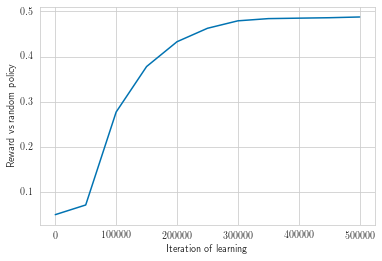

In [84]:
env = TicTacToe(n_rows=4, n_cols=4, n_win=4)
pi, Q = qlearning(env, n_episodes=500000)

Результаты аналогичны тем, что были выше для доски 3х3, но потребовалось больше итераций обучения, а право первого хода даёт уже не такое большое преимущество, как раньше.

## Часть вторая: добавим нейронных сетей
Реализуйте нейронную сеть для метода DQN на доске для крестиков-ноликов. Не буду ограничивать фантазию, но кажется, что свёртки 3х3 здесь должны неплохо работать (в том числе обобщаться на доски размера побольше).  
Реализуйте DQN с нейронной сетью, обучите стратегии крестиков и ноликов. Замечание: скорее всего, experience replay потребуется сразу же.  

https://pytorch.org/tutorials/intermediate/reinforcement_q_learning.html  
https://mahowald.github.io/pytorch-dqn/  
https://adventuresinmachinelearning.com/convolutional-neural-networks-tutorial-in-pytorch/  
https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html#torch.nn.Conv2d  
https://neurohive.io/ru/tutorial/cnn-na-pytorch/  
https://ai.stackexchange.com/questions/6669/why-does-self-playing-tictactoe-not-become-perfect  


In [13]:
class ReplayMemory():
    def __init__(self, capacity):
        self.capacity = capacity
        self.memory = []
        self.position = 0

    def store(self, exptuple):
        if len(self.memory) < self.capacity:
            self.memory.append(None)
        self.memory[self.position] = exptuple
        self.position = (self.position + 1) % self.capacity
       
    def sample(self, batch_size):
        return random.sample(self.memory, batch_size)
    
    def __len__(self):
        return len(self.memory)

В этом задании у нас есть больше свободы: больше параметров модели и процесса обучения, которые нужно подбирать или рассчитывать. Я плотно не занимался подбором параметров, выставлял их на глаз и если что-то не нравилось, корректировал тоже на глаз. Интуитивно действовал. Вообще, относительно того какую сделать модель, как её учить вопросов больше, чем ответов. Поэтому уверен, что при более грамотном подходе можно значительно улучшить количественные показатели, но качественно процесс обучения получилось продемонстрировать.  

По рекомендации из условия задачи решил добавить свёрточный слой, а после него поместил два полносвязных слоя.  
Я думаю, размеры слоёв должны как-то зависить от размера доски, поэтому попробовал их связать. 

In [79]:
class Network(nn.Module):
    def __init__(self, field_size=(3, 3), conv_size=3):
        nn.Module.__init__(self)
        conv_number = int((field_size[0] + field_size[1] + 2) * 1.5)
        hidden_layer_size = conv_number * field_size[0] * field_size[1] * 2
        self.conv1 = nn.Sequential(
            nn.Conv2d(1, conv_number, kernel_size=conv_size, stride=1, padding=0),
            nn.Sigmoid()
        )
        self.fc1 = nn.Sequential(
            nn.Linear((1 + field_size[0] - conv_size) * (1 + field_size[1] - conv_size) * conv_number, hidden_layer_size),
            nn.Sigmoid()
        )
        self.fc2 = nn.Sequential(
            nn.Linear(hidden_layer_size, field_size[0] * field_size[1]),
            nn.Sigmoid()
        )

    def forward(self, x):
        out = self.conv1(x)
        out = out.reshape(out.size(0), -1)
        out = self.fc1(out)
        out = self.fc2(out)
        return out

Решил независимо учить две модели за крестики и за нолики. Их можно было бы объединить и аккуратно обучить одну модель, но мне понравилось так.  
Я решил сделать побольше исследования новых состояний, поэтому сделал стратегии очень нежадными. Но при этом мне показалось естестенным сохранить хотя бы небольшую динамику изменения epsilon, поэтому я уменьшаю epsilon с 0.95 до 0.85 в процессе обучения. Случайности много, но при этом хорошие ходы будут фигурировать в обучении чаще, чем было бы при использовании абсолютно случайных стратегий.  

In [33]:
class TicTacToeDQN():
    def __init__(self, n_rows=3, n_cols=3, n_win=3):
        self.env = TicTacToe(n_rows, n_cols, n_win)
        self.model_x = Network((n_rows, n_cols))
        self.model_o = Network((n_rows, n_cols))
        self.memory_x = ReplayMemory(1000 * n_rows * n_cols)
        self.memory_o = ReplayMemory(1000 * n_rows * n_cols)
        self.optimizer_x = optim.Adam(self.model_x.parameters(), 0.001)
        self.optimizer_o = optim.Adam(self.model_o.parameters(), 0.001)
        
        self.gamma = 0.95
        self.batch_size = 64
        
        self.eps_init, self.eps_final, self.eps_decay = 0.95, 0.85, 200
        self.eps_threshold = self.eps_init
        self.eps_gen = None
        self.num_step = 0

    def select_greedy_action(self, model, state):
        with torch.no_grad():
            values = model(state.expand(1, 1, self.env.n_rows, self.env.n_cols))[0].tolist()
            available = [(i, v) for i, v in enumerate(values) if self.env.is_available_action_int(i)]
            best_available = list(filter(lambda x: x[1] == max(available, key=lambda x: x[1])[1], available))
            best_action = random.choice(best_available)[0]
            return torch.tensor([[best_action]])
    
    def select_random_action(self):
        return torch.tensor([[self.env.random_available_action_no()]], dtype=torch.int64)

    def select_action(self, model, state):
        with torch.no_grad():
            sample = random.random()
            self.num_step += 1
            if sample > self.eps_threshold:
                return self.select_greedy_action(model, state)
            else:
                return self.select_random_action()
    
    def state_to_tensor(self, env_state):
        state = list(map(int, env_state[0]))
        state_tensor = torch.tensor([state], dtype=torch.float32).reshape(self.env.n_rows, self.env.n_cols)
        return state_tensor
    
    def do_step(self, current_state_tensor, greedy=False, random_step=False, render=False):
        if self.env.curTurn == 1:
            model = self.model_x
            if render: print("Ходят крестики:")
        else:
            model = self.model_o
            if render: print("Ходят нолики:")
        if random_step:
            if render: print("Случайный ход")
            action = self.select_random_action()
        else:
            if greedy:
                if render: print("Жадная стратегия")
                action = self.select_greedy_action(model, current_state_tensor)
            else:
                if render: print("Почти жадная стратегия")
                action = self.select_action(model, current_state_tensor)
        new_state, reward, done, _ = self.env.step(self.env.action_from_int(action.numpy()[0][0]))
        if render:
            self.env.printBoard()
        return action, new_state, reward, done
        
    
    def run_episode(self, e=0, do_learning=True, greedy=False, render=False, vs_random=False, verbose=True, side="random"):
        self.model_x.train(False)
        self.model_o.train(False)
        
        state = self.env.reset()
        state_tensor = self.state_to_tensor(state)
        if render:
            self.env.printBoard()
        
        if do_learning:
            if self.eps_gen is None:
                self.eps_threshold = self.eps_final + (self.eps_init - self.eps_final) * math.exp(-1. * self.num_step / self.eps_decay)
            else:
                self.eps_threshold = next(self.eps_gen)
        
        reward_coef = 1.0
        if side == "o" or (side == "random" and random.random() > 0.5):
            if render:
                print("Играем за нолики")
            _, state, _, _ = self.do_step(state_tensor, greedy=True, random_step=vs_random, render=render)
            state_tensor = self.state_to_tensor(state)
            reward_coef = -reward_coef
        
        while True:
            action, next_state, reward, done = self.do_step(state_tensor, greedy=greedy, random_step=False, render=render)
            next_state_tensor = self.state_to_tensor(next_state)
            assert reward != -10
            reward *= reward_coef
            assert reward >= 0
                
            if not done:
                # Other player
                action_other, next_state, reward, done = self.do_step(next_state_tensor, greedy=True, random_step=vs_random, render=render)
                next_state_tensor = self.state_to_tensor(next_state)
                assert reward != -10
                reward *= reward_coef
                assert reward <= 0

            if do_learning:
                transition = (state_tensor, action, next_state_tensor, torch.tensor([reward], dtype=torch.float32))
                if reward_coef > 0:
                    self.memory_x.store(transition)
                else:
                    self.memory_o.store(transition)
            state = next_state
            state_tensor = self.state_to_tensor(state)
            
            if do_learning:
                self.learn()
            
            if done:
                if verbose: print("\tEpisode %d finished with reward %d. Current epsilon == %f." % (e, reward, self.eps_threshold))
                break
            
        return reward
                
    def run(self, n_episodes=10000, render=False, vs_random=False):
        if self.eps_gen is None:
            self.eps_gen = eps_generator(eps_start=self.eps_init, eps_min=self.eps_final, decay=(self.eps_final / self.eps_init)**(1/n_episodes))
        
        print("%s\tStarting training for %d episodes..." % (datetime.now().time(), n_episodes))
        quality = []
        quality.append(self.mean_reward_vs_random_policy(n_episodes))
        print(f"Current quality == {quality[-1]}")
        for e in range(n_episodes):
            self.run_episode(e, render=render, vs_random=vs_random)
            if (e + 1) % (n_episodes // 10) == 0:
                quality.append(self.mean_reward_vs_random_policy(n_episodes))
                print(f"Current quality == {quality[-1]}")
        print("%s\t\t...done!" % (datetime.now().time()))
        
        plt.plot(list(range(0, n_episodes + 1, n_episodes // 10)), quality)
        plt.ylabel("Reward vs random policy")
        plt.xlabel("Iteration of learning")
        
        return quality

    def learn(self):
        if len(self.memory_x) < self.batch_size or len(self.memory_o) < self.batch_size:
            return

        self.model_x.train(True)
        self.model_o.train(True)
        
        x = (self.model_x, self.memory_x, self.optimizer_x)
        o = (self.model_o, self.memory_o, self.optimizer_o)
        
        for model, memory, optimizer in [x, o]:
            # берём мини-батч из памяти
            transitions = memory.sample(self.batch_size)
            batch_state, batch_action, batch_next_state, batch_reward = zip(*transitions)
            batch_state = Variable(torch.cat([state.expand(1, 1, self.env.n_rows, self.env.n_cols) for state in batch_state]))
            batch_action = Variable(torch.cat(batch_action))
            batch_reward = Variable(torch.cat(batch_reward))
            batch_next_state = Variable(torch.cat([state.expand(1, 1, self.env.n_rows, self.env.n_cols) for state in batch_next_state]))

            # считаем значения функции Q
            Q = model(batch_state).gather(1, batch_action).reshape([self.batch_size])

            # оцениваем ожидаемые значения после этого действия
            Qmax = model(batch_next_state).detach().max(1)[0]
            Qnext = batch_reward + (self.gamma * Qmax)

            # и хотим, чтобы Q было похоже на Qnext -- это и есть суть Q-обучения
            loss = F.smooth_l1_loss(Q, Qnext)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

    def mean_reward_vs_random_policy(self, n_episodes=1000, side="x"):
        self.model_x.train(False)
        self.model_o.train(False)
        rewards = 0
        for i in range(n_episodes):
            rewards += self.run_episode(e=0, do_learning=False, greedy=True, render=False, vs_random=True, verbose=False, side=side)
        return rewards / n_episodes

19:20:46.375006	Starting training for 10000 episodes...
Current quality == -0.1646
	Episode 0 finished with reward 1. Current epsilon == 0.950000.
	Episode 1 finished with reward -1. Current epsilon == 0.949989.
	Episode 2 finished with reward -1. Current epsilon == 0.949979.
	Episode 3 finished with reward 1. Current epsilon == 0.949968.
	Episode 4 finished with reward 1. Current epsilon == 0.949958.
	Episode 5 finished with reward 1. Current epsilon == 0.949947.
	Episode 6 finished with reward 1. Current epsilon == 0.949937.
	Episode 7 finished with reward 1. Current epsilon == 0.949926.
	Episode 8 finished with reward 1. Current epsilon == 0.949915.
	Episode 9 finished with reward 0. Current epsilon == 0.949905.
	Episode 10 finished with reward -1. Current epsilon == 0.949894.
	Episode 11 finished with reward 1. Current epsilon == 0.949884.
	Episode 12 finished with reward 1. Current epsilon == 0.949873.
	Episode 13 finished with reward -1. Current epsilon == 0.949863.
	Episode 14 f

	Episode 124 finished with reward 1. Current epsilon == 0.948691.
	Episode 125 finished with reward -1. Current epsilon == 0.948680.
	Episode 126 finished with reward -1. Current epsilon == 0.948670.
	Episode 127 finished with reward 0. Current epsilon == 0.948659.
	Episode 128 finished with reward 1. Current epsilon == 0.948648.
	Episode 129 finished with reward -1. Current epsilon == 0.948638.
	Episode 130 finished with reward -1. Current epsilon == 0.948627.
	Episode 131 finished with reward -1. Current epsilon == 0.948617.
	Episode 132 finished with reward 0. Current epsilon == 0.948606.
	Episode 133 finished with reward 0. Current epsilon == 0.948596.
	Episode 134 finished with reward 1. Current epsilon == 0.948585.
	Episode 135 finished with reward -1. Current epsilon == 0.948575.
	Episode 136 finished with reward 0. Current epsilon == 0.948564.
	Episode 137 finished with reward -1. Current epsilon == 0.948554.
	Episode 138 finished with reward 1. Current epsilon == 0.948543.
	Ep

	Episode 248 finished with reward 1. Current epsilon == 0.947383.
	Episode 249 finished with reward 0. Current epsilon == 0.947373.
	Episode 250 finished with reward -1. Current epsilon == 0.947362.
	Episode 251 finished with reward -1. Current epsilon == 0.947352.
	Episode 252 finished with reward 0. Current epsilon == 0.947341.
	Episode 253 finished with reward 1. Current epsilon == 0.947330.
	Episode 254 finished with reward -1. Current epsilon == 0.947320.
	Episode 255 finished with reward -1. Current epsilon == 0.947309.
	Episode 256 finished with reward -1. Current epsilon == 0.947299.
	Episode 257 finished with reward 0. Current epsilon == 0.947288.
	Episode 258 finished with reward -1. Current epsilon == 0.947278.
	Episode 259 finished with reward 1. Current epsilon == 0.947267.
	Episode 260 finished with reward -1. Current epsilon == 0.947257.
	Episode 261 finished with reward -1. Current epsilon == 0.947246.
	Episode 262 finished with reward -1. Current epsilon == 0.947236.
	

	Episode 372 finished with reward 1. Current epsilon == 0.946077.
	Episode 373 finished with reward -1. Current epsilon == 0.946067.
	Episode 374 finished with reward -1. Current epsilon == 0.946056.
	Episode 375 finished with reward 0. Current epsilon == 0.946046.
	Episode 376 finished with reward 1. Current epsilon == 0.946035.
	Episode 377 finished with reward -1. Current epsilon == 0.946025.
	Episode 378 finished with reward 1. Current epsilon == 0.946014.
	Episode 379 finished with reward 1. Current epsilon == 0.946004.
	Episode 380 finished with reward 1. Current epsilon == 0.945993.
	Episode 381 finished with reward -1. Current epsilon == 0.945983.
	Episode 382 finished with reward -1. Current epsilon == 0.945972.
	Episode 383 finished with reward 1. Current epsilon == 0.945962.
	Episode 384 finished with reward -1. Current epsilon == 0.945951.
	Episode 385 finished with reward -1. Current epsilon == 0.945941.
	Episode 386 finished with reward -1. Current epsilon == 0.945930.
	E

	Episode 499 finished with reward 1. Current epsilon == 0.944742.
	Episode 500 finished with reward -1. Current epsilon == 0.944731.
	Episode 501 finished with reward 1. Current epsilon == 0.944721.
	Episode 502 finished with reward 1. Current epsilon == 0.944710.
	Episode 503 finished with reward -1. Current epsilon == 0.944700.
	Episode 504 finished with reward -1. Current epsilon == 0.944689.
	Episode 505 finished with reward 1. Current epsilon == 0.944679.
	Episode 506 finished with reward -1. Current epsilon == 0.944668.
	Episode 507 finished with reward -1. Current epsilon == 0.944658.
	Episode 508 finished with reward -1. Current epsilon == 0.944647.
	Episode 509 finished with reward -1. Current epsilon == 0.944637.
	Episode 510 finished with reward -1. Current epsilon == 0.944626.
	Episode 511 finished with reward -1. Current epsilon == 0.944616.
	Episode 512 finished with reward -1. Current epsilon == 0.944605.
	Episode 513 finished with reward 1. Current epsilon == 0.944595.


	Episode 624 finished with reward 1. Current epsilon == 0.943429.
	Episode 625 finished with reward 1. Current epsilon == 0.943419.
	Episode 626 finished with reward -1. Current epsilon == 0.943408.
	Episode 627 finished with reward -1. Current epsilon == 0.943398.
	Episode 628 finished with reward -1. Current epsilon == 0.943387.
	Episode 629 finished with reward -1. Current epsilon == 0.943377.
	Episode 630 finished with reward -1. Current epsilon == 0.943366.
	Episode 631 finished with reward -1. Current epsilon == 0.943356.
	Episode 632 finished with reward -1. Current epsilon == 0.943345.
	Episode 633 finished with reward 0. Current epsilon == 0.943335.
	Episode 634 finished with reward -1. Current epsilon == 0.943324.
	Episode 635 finished with reward -1. Current epsilon == 0.943314.
	Episode 636 finished with reward -1. Current epsilon == 0.943303.
	Episode 637 finished with reward -1. Current epsilon == 0.943293.
	Episode 638 finished with reward 1. Current epsilon == 0.943282.

	Episode 747 finished with reward -1. Current epsilon == 0.942140.
	Episode 748 finished with reward 0. Current epsilon == 0.942129.
	Episode 749 finished with reward 1. Current epsilon == 0.942119.
	Episode 750 finished with reward -1. Current epsilon == 0.942108.
	Episode 751 finished with reward -1. Current epsilon == 0.942098.
	Episode 752 finished with reward -1. Current epsilon == 0.942087.
	Episode 753 finished with reward 1. Current epsilon == 0.942077.
	Episode 754 finished with reward 1. Current epsilon == 0.942066.
	Episode 755 finished with reward 1. Current epsilon == 0.942056.
	Episode 756 finished with reward -1. Current epsilon == 0.942045.
	Episode 757 finished with reward -1. Current epsilon == 0.942035.
	Episode 758 finished with reward -1. Current epsilon == 0.942024.
	Episode 759 finished with reward -1. Current epsilon == 0.942014.
	Episode 760 finished with reward -1. Current epsilon == 0.942003.
	Episode 761 finished with reward -1. Current epsilon == 0.941993.


	Episode 872 finished with reward -1. Current epsilon == 0.940831.
	Episode 873 finished with reward 0. Current epsilon == 0.940820.
	Episode 874 finished with reward 1. Current epsilon == 0.940810.
	Episode 875 finished with reward -1. Current epsilon == 0.940799.
	Episode 876 finished with reward 1. Current epsilon == 0.940789.
	Episode 877 finished with reward 0. Current epsilon == 0.940778.
	Episode 878 finished with reward -1. Current epsilon == 0.940768.
	Episode 879 finished with reward -1. Current epsilon == 0.940757.
	Episode 880 finished with reward -1. Current epsilon == 0.940747.
	Episode 881 finished with reward 1. Current epsilon == 0.940736.
	Episode 882 finished with reward -1. Current epsilon == 0.940726.
	Episode 883 finished with reward -1. Current epsilon == 0.940716.
	Episode 884 finished with reward -1. Current epsilon == 0.940705.
	Episode 885 finished with reward 1. Current epsilon == 0.940695.
	Episode 886 finished with reward -1. Current epsilon == 0.940684.
	

	Episode 996 finished with reward 1. Current epsilon == 0.939534.
	Episode 997 finished with reward -1. Current epsilon == 0.939523.
	Episode 998 finished with reward 1. Current epsilon == 0.939513.
	Episode 999 finished with reward -1. Current epsilon == 0.939503.
Current quality == 0.5557
	Episode 1000 finished with reward -1. Current epsilon == 0.939492.
	Episode 1001 finished with reward -1. Current epsilon == 0.939482.
	Episode 1002 finished with reward -1. Current epsilon == 0.939471.
	Episode 1003 finished with reward -1. Current epsilon == 0.939461.
	Episode 1004 finished with reward 0. Current epsilon == 0.939450.
	Episode 1005 finished with reward 0. Current epsilon == 0.939440.
	Episode 1006 finished with reward -1. Current epsilon == 0.939429.
	Episode 1007 finished with reward 1. Current epsilon == 0.939419.
	Episode 1008 finished with reward -1. Current epsilon == 0.939409.
	Episode 1009 finished with reward -1. Current epsilon == 0.939398.
	Episode 1010 finished with rew

	Episode 1118 finished with reward 1. Current epsilon == 0.938260.
	Episode 1119 finished with reward -1. Current epsilon == 0.938249.
	Episode 1120 finished with reward -1. Current epsilon == 0.938239.
	Episode 1121 finished with reward -1. Current epsilon == 0.938229.
	Episode 1122 finished with reward 1. Current epsilon == 0.938218.
	Episode 1123 finished with reward -1. Current epsilon == 0.938208.
	Episode 1124 finished with reward 1. Current epsilon == 0.938197.
	Episode 1125 finished with reward -1. Current epsilon == 0.938187.
	Episode 1126 finished with reward -1. Current epsilon == 0.938176.
	Episode 1127 finished with reward 1. Current epsilon == 0.938166.
	Episode 1128 finished with reward -1. Current epsilon == 0.938156.
	Episode 1129 finished with reward 1. Current epsilon == 0.938145.
	Episode 1130 finished with reward 0. Current epsilon == 0.938135.
	Episode 1131 finished with reward 1. Current epsilon == 0.938124.
	Episode 1132 finished with reward -1. Current epsilon 

	Episode 1240 finished with reward -1. Current epsilon == 0.936988.
	Episode 1241 finished with reward -1. Current epsilon == 0.936977.
	Episode 1242 finished with reward -1. Current epsilon == 0.936967.
	Episode 1243 finished with reward -1. Current epsilon == 0.936956.
	Episode 1244 finished with reward 1. Current epsilon == 0.936946.
	Episode 1245 finished with reward 1. Current epsilon == 0.936935.
	Episode 1246 finished with reward -1. Current epsilon == 0.936925.
	Episode 1247 finished with reward 0. Current epsilon == 0.936915.
	Episode 1248 finished with reward -1. Current epsilon == 0.936904.
	Episode 1249 finished with reward 0. Current epsilon == 0.936894.
	Episode 1250 finished with reward -1. Current epsilon == 0.936883.
	Episode 1251 finished with reward 1. Current epsilon == 0.936873.
	Episode 1252 finished with reward 1. Current epsilon == 0.936863.
	Episode 1253 finished with reward -1. Current epsilon == 0.936852.
	Episode 1254 finished with reward 1. Current epsilon 

	Episode 1367 finished with reward -1. Current epsilon == 0.935665.
	Episode 1368 finished with reward -1. Current epsilon == 0.935655.
	Episode 1369 finished with reward -1. Current epsilon == 0.935644.
	Episode 1370 finished with reward -1. Current epsilon == 0.935634.
	Episode 1371 finished with reward -1. Current epsilon == 0.935623.
	Episode 1372 finished with reward 1. Current epsilon == 0.935613.
	Episode 1373 finished with reward 0. Current epsilon == 0.935602.
	Episode 1374 finished with reward -1. Current epsilon == 0.935592.
	Episode 1375 finished with reward 1. Current epsilon == 0.935582.
	Episode 1376 finished with reward 1. Current epsilon == 0.935571.
	Episode 1377 finished with reward -1. Current epsilon == 0.935561.
	Episode 1378 finished with reward -1. Current epsilon == 0.935550.
	Episode 1379 finished with reward 1. Current epsilon == 0.935540.
	Episode 1380 finished with reward 1. Current epsilon == 0.935530.
	Episode 1381 finished with reward 1. Current epsilon 

	Episode 1498 finished with reward -1. Current epsilon == 0.934303.
	Episode 1499 finished with reward -1. Current epsilon == 0.934292.
	Episode 1500 finished with reward 1. Current epsilon == 0.934282.
	Episode 1501 finished with reward -1. Current epsilon == 0.934271.
	Episode 1502 finished with reward -1. Current epsilon == 0.934261.
	Episode 1503 finished with reward 1. Current epsilon == 0.934251.
	Episode 1504 finished with reward -1. Current epsilon == 0.934240.
	Episode 1505 finished with reward 1. Current epsilon == 0.934230.
	Episode 1506 finished with reward -1. Current epsilon == 0.934219.
	Episode 1507 finished with reward 1. Current epsilon == 0.934209.
	Episode 1508 finished with reward -1. Current epsilon == 0.934199.
	Episode 1509 finished with reward 1. Current epsilon == 0.934188.
	Episode 1510 finished with reward 1. Current epsilon == 0.934178.
	Episode 1511 finished with reward 0. Current epsilon == 0.934168.
	Episode 1512 finished with reward -1. Current epsilon 

	Episode 1626 finished with reward 0. Current epsilon == 0.932973.
	Episode 1627 finished with reward 0. Current epsilon == 0.932963.
	Episode 1628 finished with reward -1. Current epsilon == 0.932953.
	Episode 1629 finished with reward -1. Current epsilon == 0.932942.
	Episode 1630 finished with reward -1. Current epsilon == 0.932932.
	Episode 1631 finished with reward -1. Current epsilon == 0.932922.
	Episode 1632 finished with reward -1. Current epsilon == 0.932911.
	Episode 1633 finished with reward 1. Current epsilon == 0.932901.
	Episode 1634 finished with reward 1. Current epsilon == 0.932890.
	Episode 1635 finished with reward 0. Current epsilon == 0.932880.
	Episode 1636 finished with reward -1. Current epsilon == 0.932870.
	Episode 1637 finished with reward -1. Current epsilon == 0.932859.
	Episode 1638 finished with reward -1. Current epsilon == 0.932849.
	Episode 1639 finished with reward -1. Current epsilon == 0.932839.
	Episode 1640 finished with reward -1. Current epsilo

	Episode 1750 finished with reward -1. Current epsilon == 0.931688.
	Episode 1751 finished with reward -1. Current epsilon == 0.931677.
	Episode 1752 finished with reward -1. Current epsilon == 0.931667.
	Episode 1753 finished with reward 1. Current epsilon == 0.931656.
	Episode 1754 finished with reward -1. Current epsilon == 0.931646.
	Episode 1755 finished with reward 1. Current epsilon == 0.931636.
	Episode 1756 finished with reward -1. Current epsilon == 0.931625.
	Episode 1757 finished with reward 0. Current epsilon == 0.931615.
	Episode 1758 finished with reward -1. Current epsilon == 0.931605.
	Episode 1759 finished with reward -1. Current epsilon == 0.931594.
	Episode 1760 finished with reward -1. Current epsilon == 0.931584.
	Episode 1761 finished with reward 1. Current epsilon == 0.931574.
	Episode 1762 finished with reward -1. Current epsilon == 0.931563.
	Episode 1763 finished with reward -1. Current epsilon == 0.931553.
	Episode 1764 finished with reward -1. Current epsil

	Episode 1876 finished with reward -1. Current epsilon == 0.930383.
	Episode 1877 finished with reward -1. Current epsilon == 0.930372.
	Episode 1878 finished with reward -1. Current epsilon == 0.930362.
	Episode 1879 finished with reward -1. Current epsilon == 0.930352.
	Episode 1880 finished with reward 1. Current epsilon == 0.930341.
	Episode 1881 finished with reward -1. Current epsilon == 0.930331.
	Episode 1882 finished with reward -1. Current epsilon == 0.930321.
	Episode 1883 finished with reward -1. Current epsilon == 0.930310.
	Episode 1884 finished with reward 0. Current epsilon == 0.930300.
	Episode 1885 finished with reward -1. Current epsilon == 0.930290.
	Episode 1886 finished with reward 1. Current epsilon == 0.930279.
	Episode 1887 finished with reward 1. Current epsilon == 0.930269.
	Episode 1888 finished with reward 0. Current epsilon == 0.930259.
	Episode 1889 finished with reward -1. Current epsilon == 0.930248.
	Episode 1890 finished with reward -1. Current epsilo

Current quality == 0.6757
	Episode 2000 finished with reward -1. Current epsilon == 0.929100.
	Episode 2001 finished with reward 1. Current epsilon == 0.929090.
	Episode 2002 finished with reward -1. Current epsilon == 0.929080.
	Episode 2003 finished with reward -1. Current epsilon == 0.929069.
	Episode 2004 finished with reward -1. Current epsilon == 0.929059.
	Episode 2005 finished with reward -1. Current epsilon == 0.929049.
	Episode 2006 finished with reward -1. Current epsilon == 0.929038.
	Episode 2007 finished with reward -1. Current epsilon == 0.929028.
	Episode 2008 finished with reward -1. Current epsilon == 0.929018.
	Episode 2009 finished with reward -1. Current epsilon == 0.929007.
	Episode 2010 finished with reward -1. Current epsilon == 0.928997.
	Episode 2011 finished with reward -1. Current epsilon == 0.928987.
	Episode 2012 finished with reward -1. Current epsilon == 0.928976.
	Episode 2013 finished with reward 1. Current epsilon == 0.928966.
	Episode 2014 finished w

	Episode 2123 finished with reward -1. Current epsilon == 0.927830.
	Episode 2124 finished with reward 0. Current epsilon == 0.927820.
	Episode 2125 finished with reward -1. Current epsilon == 0.927810.
	Episode 2126 finished with reward -1. Current epsilon == 0.927799.
	Episode 2127 finished with reward -1. Current epsilon == 0.927789.
	Episode 2128 finished with reward -1. Current epsilon == 0.927779.
	Episode 2129 finished with reward -1. Current epsilon == 0.927768.
	Episode 2130 finished with reward -1. Current epsilon == 0.927758.
	Episode 2131 finished with reward -1. Current epsilon == 0.927748.
	Episode 2132 finished with reward -1. Current epsilon == 0.927737.
	Episode 2133 finished with reward -1. Current epsilon == 0.927727.
	Episode 2134 finished with reward -1. Current epsilon == 0.927717.
	Episode 2135 finished with reward -1. Current epsilon == 0.927706.
	Episode 2136 finished with reward -1. Current epsilon == 0.927696.
	Episode 2137 finished with reward -1. Current ep

	Episode 2246 finished with reward -1. Current epsilon == 0.926562.
	Episode 2247 finished with reward 1. Current epsilon == 0.926551.
	Episode 2248 finished with reward -1. Current epsilon == 0.926541.
	Episode 2249 finished with reward 1. Current epsilon == 0.926531.
	Episode 2250 finished with reward -1. Current epsilon == 0.926521.
	Episode 2251 finished with reward -1. Current epsilon == 0.926510.
	Episode 2252 finished with reward -1. Current epsilon == 0.926500.
	Episode 2253 finished with reward -1. Current epsilon == 0.926490.
	Episode 2254 finished with reward -1. Current epsilon == 0.926479.
	Episode 2255 finished with reward -1. Current epsilon == 0.926469.
	Episode 2256 finished with reward -1. Current epsilon == 0.926459.
	Episode 2257 finished with reward 0. Current epsilon == 0.926448.
	Episode 2258 finished with reward 0. Current epsilon == 0.926438.
	Episode 2259 finished with reward -1. Current epsilon == 0.926428.
	Episode 2260 finished with reward -1. Current epsil

	Episode 2368 finished with reward -1. Current epsilon == 0.925305.
	Episode 2369 finished with reward 0. Current epsilon == 0.925295.
	Episode 2370 finished with reward 0. Current epsilon == 0.925285.
	Episode 2371 finished with reward 1. Current epsilon == 0.925274.
	Episode 2372 finished with reward -1. Current epsilon == 0.925264.
	Episode 2373 finished with reward 0. Current epsilon == 0.925254.
	Episode 2374 finished with reward -1. Current epsilon == 0.925244.
	Episode 2375 finished with reward -1. Current epsilon == 0.925233.
	Episode 2376 finished with reward -1. Current epsilon == 0.925223.
	Episode 2377 finished with reward -1. Current epsilon == 0.925213.
	Episode 2378 finished with reward -1. Current epsilon == 0.925202.
	Episode 2379 finished with reward -1. Current epsilon == 0.925192.
	Episode 2380 finished with reward -1. Current epsilon == 0.925182.
	Episode 2381 finished with reward -1. Current epsilon == 0.925172.
	Episode 2382 finished with reward -1. Current epsil

	Episode 2490 finished with reward -1. Current epsilon == 0.924051.
	Episode 2491 finished with reward -1. Current epsilon == 0.924040.
	Episode 2492 finished with reward -1. Current epsilon == 0.924030.
	Episode 2493 finished with reward -1. Current epsilon == 0.924020.
	Episode 2494 finished with reward 0. Current epsilon == 0.924009.
	Episode 2495 finished with reward 1. Current epsilon == 0.923999.
	Episode 2496 finished with reward -1. Current epsilon == 0.923989.
	Episode 2497 finished with reward 0. Current epsilon == 0.923979.
	Episode 2498 finished with reward -1. Current epsilon == 0.923968.
	Episode 2499 finished with reward -1. Current epsilon == 0.923958.
	Episode 2500 finished with reward -1. Current epsilon == 0.923948.
	Episode 2501 finished with reward -1. Current epsilon == 0.923938.
	Episode 2502 finished with reward -1. Current epsilon == 0.923927.
	Episode 2503 finished with reward -1. Current epsilon == 0.923917.
	Episode 2504 finished with reward 1. Current epsil

	Episode 2617 finished with reward -1. Current epsilon == 0.922746.
	Episode 2618 finished with reward -1. Current epsilon == 0.922736.
	Episode 2619 finished with reward 1. Current epsilon == 0.922726.
	Episode 2620 finished with reward -1. Current epsilon == 0.922715.
	Episode 2621 finished with reward -1. Current epsilon == 0.922705.
	Episode 2622 finished with reward -1. Current epsilon == 0.922695.
	Episode 2623 finished with reward -1. Current epsilon == 0.922685.
	Episode 2624 finished with reward 1. Current epsilon == 0.922674.
	Episode 2625 finished with reward -1. Current epsilon == 0.922664.
	Episode 2626 finished with reward -1. Current epsilon == 0.922654.
	Episode 2627 finished with reward -1. Current epsilon == 0.922644.
	Episode 2628 finished with reward 0. Current epsilon == 0.922633.
	Episode 2629 finished with reward -1. Current epsilon == 0.922623.
	Episode 2630 finished with reward -1. Current epsilon == 0.922613.
	Episode 2631 finished with reward -1. Current epsi

	Episode 2744 finished with reward 1. Current epsilon == 0.921444.
	Episode 2745 finished with reward -1. Current epsilon == 0.921433.
	Episode 2746 finished with reward 0. Current epsilon == 0.921423.
	Episode 2747 finished with reward -1. Current epsilon == 0.921413.
	Episode 2748 finished with reward -1. Current epsilon == 0.921403.
	Episode 2749 finished with reward -1. Current epsilon == 0.921392.
	Episode 2750 finished with reward -1. Current epsilon == 0.921382.
	Episode 2751 finished with reward -1. Current epsilon == 0.921372.
	Episode 2752 finished with reward -1. Current epsilon == 0.921362.
	Episode 2753 finished with reward 1. Current epsilon == 0.921351.
	Episode 2754 finished with reward -1. Current epsilon == 0.921341.
	Episode 2755 finished with reward 1. Current epsilon == 0.921331.
	Episode 2756 finished with reward 0. Current epsilon == 0.921321.
	Episode 2757 finished with reward 1. Current epsilon == 0.921310.
	Episode 2758 finished with reward 1. Current epsilon 

	Episode 2876 finished with reward 1. Current epsilon == 0.920092.
	Episode 2877 finished with reward -1. Current epsilon == 0.920082.
	Episode 2878 finished with reward 1. Current epsilon == 0.920071.
	Episode 2879 finished with reward -1. Current epsilon == 0.920061.
	Episode 2880 finished with reward 0. Current epsilon == 0.920051.
	Episode 2881 finished with reward -1. Current epsilon == 0.920041.
	Episode 2882 finished with reward -1. Current epsilon == 0.920030.
	Episode 2883 finished with reward 1. Current epsilon == 0.920020.
	Episode 2884 finished with reward -1. Current epsilon == 0.920010.
	Episode 2885 finished with reward -1. Current epsilon == 0.920000.
	Episode 2886 finished with reward -1. Current epsilon == 0.919990.
	Episode 2887 finished with reward -1. Current epsilon == 0.919979.
	Episode 2888 finished with reward -1. Current epsilon == 0.919969.
	Episode 2889 finished with reward 1. Current epsilon == 0.919959.
	Episode 2890 finished with reward -1. Current epsilo

	Episode 2999 finished with reward -1. Current epsilon == 0.918834.
Current quality == 0.6259
	Episode 3000 finished with reward -1. Current epsilon == 0.918824.
	Episode 3001 finished with reward -1. Current epsilon == 0.918814.
	Episode 3002 finished with reward -1. Current epsilon == 0.918803.
	Episode 3003 finished with reward -1. Current epsilon == 0.918793.
	Episode 3004 finished with reward -1. Current epsilon == 0.918783.
	Episode 3005 finished with reward -1. Current epsilon == 0.918773.
	Episode 3006 finished with reward 1. Current epsilon == 0.918762.
	Episode 3007 finished with reward -1. Current epsilon == 0.918752.
	Episode 3008 finished with reward 0. Current epsilon == 0.918742.
	Episode 3009 finished with reward -1. Current epsilon == 0.918732.
	Episode 3010 finished with reward -1. Current epsilon == 0.918722.
	Episode 3011 finished with reward 1. Current epsilon == 0.918711.
	Episode 3012 finished with reward 0. Current epsilon == 0.918701.
	Episode 3013 finished wit

	Episode 3122 finished with reward -1. Current epsilon == 0.917578.
	Episode 3123 finished with reward -1. Current epsilon == 0.917568.
	Episode 3124 finished with reward -1. Current epsilon == 0.917557.
	Episode 3125 finished with reward -1. Current epsilon == 0.917547.
	Episode 3126 finished with reward -1. Current epsilon == 0.917537.
	Episode 3127 finished with reward 1. Current epsilon == 0.917527.
	Episode 3128 finished with reward 1. Current epsilon == 0.917517.
	Episode 3129 finished with reward 0. Current epsilon == 0.917506.
	Episode 3130 finished with reward 1. Current epsilon == 0.917496.
	Episode 3131 finished with reward -1. Current epsilon == 0.917486.
	Episode 3132 finished with reward -1. Current epsilon == 0.917476.
	Episode 3133 finished with reward -1. Current epsilon == 0.917466.
	Episode 3134 finished with reward 1. Current epsilon == 0.917455.
	Episode 3135 finished with reward 0. Current epsilon == 0.917445.
	Episode 3136 finished with reward -1. Current epsilon

	Episode 3245 finished with reward -1. Current epsilon == 0.916323.
	Episode 3246 finished with reward -1. Current epsilon == 0.916313.
	Episode 3247 finished with reward -1. Current epsilon == 0.916303.
	Episode 3248 finished with reward 1. Current epsilon == 0.916293.
	Episode 3249 finished with reward -1. Current epsilon == 0.916283.
	Episode 3250 finished with reward -1. Current epsilon == 0.916272.
	Episode 3251 finished with reward -1. Current epsilon == 0.916262.
	Episode 3252 finished with reward 1. Current epsilon == 0.916252.
	Episode 3253 finished with reward -1. Current epsilon == 0.916242.
	Episode 3254 finished with reward 0. Current epsilon == 0.916232.
	Episode 3255 finished with reward 1. Current epsilon == 0.916221.
	Episode 3256 finished with reward -1. Current epsilon == 0.916211.
	Episode 3257 finished with reward -1. Current epsilon == 0.916201.
	Episode 3258 finished with reward -1. Current epsilon == 0.916191.
	Episode 3259 finished with reward 0. Current epsilo

	Episode 3369 finished with reward 1. Current epsilon == 0.915060.
	Episode 3370 finished with reward -1. Current epsilon == 0.915050.
	Episode 3371 finished with reward 0. Current epsilon == 0.915040.
	Episode 3372 finished with reward -1. Current epsilon == 0.915030.
	Episode 3373 finished with reward -1. Current epsilon == 0.915020.
	Episode 3374 finished with reward -1. Current epsilon == 0.915010.
	Episode 3375 finished with reward 0. Current epsilon == 0.914999.
	Episode 3376 finished with reward -1. Current epsilon == 0.914989.
	Episode 3377 finished with reward -1. Current epsilon == 0.914979.
	Episode 3378 finished with reward 1. Current epsilon == 0.914969.
	Episode 3379 finished with reward -1. Current epsilon == 0.914959.
	Episode 3380 finished with reward -1. Current epsilon == 0.914948.
	Episode 3381 finished with reward -1. Current epsilon == 0.914938.
	Episode 3382 finished with reward 0. Current epsilon == 0.914928.
	Episode 3383 finished with reward 1. Current epsilon

	Episode 3494 finished with reward -1. Current epsilon == 0.913789.
	Episode 3495 finished with reward -1. Current epsilon == 0.913779.
	Episode 3496 finished with reward -1. Current epsilon == 0.913769.
	Episode 3497 finished with reward -1. Current epsilon == 0.913759.
	Episode 3498 finished with reward -1. Current epsilon == 0.913748.
	Episode 3499 finished with reward -1. Current epsilon == 0.913738.
	Episode 3500 finished with reward 1. Current epsilon == 0.913728.
	Episode 3501 finished with reward -1. Current epsilon == 0.913718.
	Episode 3502 finished with reward -1. Current epsilon == 0.913708.
	Episode 3503 finished with reward -1. Current epsilon == 0.913698.
	Episode 3504 finished with reward -1. Current epsilon == 0.913687.
	Episode 3505 finished with reward -1. Current epsilon == 0.913677.
	Episode 3506 finished with reward 1. Current epsilon == 0.913667.
	Episode 3507 finished with reward -1. Current epsilon == 0.913657.
	Episode 3508 finished with reward -1. Current eps

	Episode 3618 finished with reward -1. Current epsilon == 0.912530.
	Episode 3619 finished with reward -1. Current epsilon == 0.912519.
	Episode 3620 finished with reward -1. Current epsilon == 0.912509.
	Episode 3621 finished with reward 0. Current epsilon == 0.912499.
	Episode 3622 finished with reward -1. Current epsilon == 0.912489.
	Episode 3623 finished with reward -1. Current epsilon == 0.912479.
	Episode 3624 finished with reward -1. Current epsilon == 0.912469.
	Episode 3625 finished with reward 1. Current epsilon == 0.912459.
	Episode 3626 finished with reward 1. Current epsilon == 0.912448.
	Episode 3627 finished with reward 1. Current epsilon == 0.912438.
	Episode 3628 finished with reward -1. Current epsilon == 0.912428.
	Episode 3629 finished with reward -1. Current epsilon == 0.912418.
	Episode 3630 finished with reward 1. Current epsilon == 0.912408.
	Episode 3631 finished with reward -1. Current epsilon == 0.912398.
	Episode 3632 finished with reward 0. Current epsilon

	Episode 3744 finished with reward -1. Current epsilon == 0.911252.
	Episode 3745 finished with reward -1. Current epsilon == 0.911242.
	Episode 3746 finished with reward 0. Current epsilon == 0.911231.
	Episode 3747 finished with reward -1. Current epsilon == 0.911221.
	Episode 3748 finished with reward -1. Current epsilon == 0.911211.
	Episode 3749 finished with reward -1. Current epsilon == 0.911201.
	Episode 3750 finished with reward -1. Current epsilon == 0.911191.
	Episode 3751 finished with reward 1. Current epsilon == 0.911181.
	Episode 3752 finished with reward 0. Current epsilon == 0.911171.
	Episode 3753 finished with reward 1. Current epsilon == 0.911160.
	Episode 3754 finished with reward 1. Current epsilon == 0.911150.
	Episode 3755 finished with reward -1. Current epsilon == 0.911140.
	Episode 3756 finished with reward 1. Current epsilon == 0.911130.
	Episode 3757 finished with reward -1. Current epsilon == 0.911120.
	Episode 3758 finished with reward 1. Current epsilon 

	Episode 3870 finished with reward 1. Current epsilon == 0.909975.
	Episode 3871 finished with reward 1. Current epsilon == 0.909965.
	Episode 3872 finished with reward 1. Current epsilon == 0.909955.
	Episode 3873 finished with reward -1. Current epsilon == 0.909945.
	Episode 3874 finished with reward -1. Current epsilon == 0.909935.
	Episode 3875 finished with reward -1. Current epsilon == 0.909925.
	Episode 3876 finished with reward 0. Current epsilon == 0.909915.
	Episode 3877 finished with reward -1. Current epsilon == 0.909905.
	Episode 3878 finished with reward 1. Current epsilon == 0.909895.
	Episode 3879 finished with reward -1. Current epsilon == 0.909884.
	Episode 3880 finished with reward -1. Current epsilon == 0.909874.
	Episode 3881 finished with reward 1. Current epsilon == 0.909864.
	Episode 3882 finished with reward 1. Current epsilon == 0.909854.
	Episode 3883 finished with reward -1. Current epsilon == 0.909844.
	Episode 3884 finished with reward 0. Current epsilon =

	Episode 3998 finished with reward -1. Current epsilon == 0.908681.
	Episode 3999 finished with reward 1. Current epsilon == 0.908671.
Current quality == 0.5894
	Episode 4000 finished with reward -1. Current epsilon == 0.908661.
	Episode 4001 finished with reward -1. Current epsilon == 0.908651.
	Episode 4002 finished with reward -1. Current epsilon == 0.908640.
	Episode 4003 finished with reward -1. Current epsilon == 0.908630.
	Episode 4004 finished with reward -1. Current epsilon == 0.908620.
	Episode 4005 finished with reward 1. Current epsilon == 0.908610.
	Episode 4006 finished with reward -1. Current epsilon == 0.908600.
	Episode 4007 finished with reward -1. Current epsilon == 0.908590.
	Episode 4008 finished with reward -1. Current epsilon == 0.908580.
	Episode 4009 finished with reward -1. Current epsilon == 0.908570.
	Episode 4010 finished with reward -1. Current epsilon == 0.908560.
	Episode 4011 finished with reward -1. Current epsilon == 0.908550.
	Episode 4012 finished w

	Episode 4120 finished with reward -1. Current epsilon == 0.907449.
	Episode 4121 finished with reward -1. Current epsilon == 0.907439.
	Episode 4122 finished with reward -1. Current epsilon == 0.907429.
	Episode 4123 finished with reward 1. Current epsilon == 0.907418.
	Episode 4124 finished with reward 0. Current epsilon == 0.907408.
	Episode 4125 finished with reward 1. Current epsilon == 0.907398.
	Episode 4126 finished with reward 0. Current epsilon == 0.907388.
	Episode 4127 finished with reward -1. Current epsilon == 0.907378.
	Episode 4128 finished with reward -1. Current epsilon == 0.907368.
	Episode 4129 finished with reward -1. Current epsilon == 0.907358.
	Episode 4130 finished with reward 1. Current epsilon == 0.907348.
	Episode 4131 finished with reward 0. Current epsilon == 0.907338.
	Episode 4132 finished with reward -1. Current epsilon == 0.907328.
	Episode 4133 finished with reward 0. Current epsilon == 0.907317.
	Episode 4134 finished with reward -1. Current epsilon 

	Episode 4248 finished with reward 1. Current epsilon == 0.906158.
	Episode 4249 finished with reward 1. Current epsilon == 0.906148.
	Episode 4250 finished with reward -1. Current epsilon == 0.906138.
	Episode 4251 finished with reward -1. Current epsilon == 0.906127.
	Episode 4252 finished with reward 1. Current epsilon == 0.906117.
	Episode 4253 finished with reward 0. Current epsilon == 0.906107.
	Episode 4254 finished with reward -1. Current epsilon == 0.906097.
	Episode 4255 finished with reward -1. Current epsilon == 0.906087.
	Episode 4256 finished with reward -1. Current epsilon == 0.906077.
	Episode 4257 finished with reward -1. Current epsilon == 0.906067.
	Episode 4258 finished with reward -1. Current epsilon == 0.906057.
	Episode 4259 finished with reward 1. Current epsilon == 0.906047.
	Episode 4260 finished with reward -1. Current epsilon == 0.906037.
	Episode 4261 finished with reward 1. Current epsilon == 0.906027.
	Episode 4262 finished with reward -1. Current epsilon

	Episode 4373 finished with reward -1. Current epsilon == 0.904899.
	Episode 4374 finished with reward 1. Current epsilon == 0.904889.
	Episode 4375 finished with reward 0. Current epsilon == 0.904879.
	Episode 4376 finished with reward -1. Current epsilon == 0.904869.
	Episode 4377 finished with reward -1. Current epsilon == 0.904858.
	Episode 4378 finished with reward -1. Current epsilon == 0.904848.
	Episode 4379 finished with reward -1. Current epsilon == 0.904838.
	Episode 4380 finished with reward -1. Current epsilon == 0.904828.
	Episode 4381 finished with reward -1. Current epsilon == 0.904818.
	Episode 4382 finished with reward 1. Current epsilon == 0.904808.
	Episode 4383 finished with reward 1. Current epsilon == 0.904798.
	Episode 4384 finished with reward 1. Current epsilon == 0.904788.
	Episode 4385 finished with reward -1. Current epsilon == 0.904778.
	Episode 4386 finished with reward 0. Current epsilon == 0.904768.
	Episode 4387 finished with reward -1. Current epsilon

	Episode 4495 finished with reward 1. Current epsilon == 0.903672.
	Episode 4496 finished with reward 1. Current epsilon == 0.903662.
	Episode 4497 finished with reward -1. Current epsilon == 0.903652.
	Episode 4498 finished with reward 0. Current epsilon == 0.903641.
	Episode 4499 finished with reward 1. Current epsilon == 0.903631.
	Episode 4500 finished with reward -1. Current epsilon == 0.903621.
	Episode 4501 finished with reward 1. Current epsilon == 0.903611.
	Episode 4502 finished with reward 1. Current epsilon == 0.903601.
	Episode 4503 finished with reward -1. Current epsilon == 0.903591.
	Episode 4504 finished with reward 1. Current epsilon == 0.903581.
	Episode 4505 finished with reward -1. Current epsilon == 0.903571.
	Episode 4506 finished with reward -1. Current epsilon == 0.903561.
	Episode 4507 finished with reward -1. Current epsilon == 0.903551.
	Episode 4508 finished with reward -1. Current epsilon == 0.903541.
	Episode 4509 finished with reward -1. Current epsilon 

	Episode 4624 finished with reward -1. Current epsilon == 0.902376.
	Episode 4625 finished with reward -1. Current epsilon == 0.902366.
	Episode 4626 finished with reward -1. Current epsilon == 0.902356.
	Episode 4627 finished with reward -1. Current epsilon == 0.902346.
	Episode 4628 finished with reward -1. Current epsilon == 0.902336.
	Episode 4629 finished with reward 1. Current epsilon == 0.902326.
	Episode 4630 finished with reward 0. Current epsilon == 0.902316.
	Episode 4631 finished with reward -1. Current epsilon == 0.902306.
	Episode 4632 finished with reward -1. Current epsilon == 0.902296.
	Episode 4633 finished with reward 1. Current epsilon == 0.902286.
	Episode 4634 finished with reward -1. Current epsilon == 0.902276.
	Episode 4635 finished with reward -1. Current epsilon == 0.902266.
	Episode 4636 finished with reward 0. Current epsilon == 0.902256.
	Episode 4637 finished with reward -1. Current epsilon == 0.902246.
	Episode 4638 finished with reward -1. Current epsil

	Episode 4749 finished with reward -1. Current epsilon == 0.901122.
	Episode 4750 finished with reward -1. Current epsilon == 0.901112.
	Episode 4751 finished with reward 0. Current epsilon == 0.901102.
	Episode 4752 finished with reward -1. Current epsilon == 0.901092.
	Episode 4753 finished with reward -1. Current epsilon == 0.901082.
	Episode 4754 finished with reward 1. Current epsilon == 0.901072.
	Episode 4755 finished with reward 1. Current epsilon == 0.901062.
	Episode 4756 finished with reward -1. Current epsilon == 0.901052.
	Episode 4757 finished with reward -1. Current epsilon == 0.901042.
	Episode 4758 finished with reward -1. Current epsilon == 0.901032.
	Episode 4759 finished with reward -1. Current epsilon == 0.901022.
	Episode 4760 finished with reward -1. Current epsilon == 0.901012.
	Episode 4761 finished with reward 0. Current epsilon == 0.901002.
	Episode 4762 finished with reward -1. Current epsilon == 0.900992.
	Episode 4763 finished with reward 0. Current epsilo

	Episode 4875 finished with reward -1. Current epsilon == 0.899860.
	Episode 4876 finished with reward 1. Current epsilon == 0.899850.
	Episode 4877 finished with reward 1. Current epsilon == 0.899840.
	Episode 4878 finished with reward -1. Current epsilon == 0.899830.
	Episode 4879 finished with reward -1. Current epsilon == 0.899820.
	Episode 4880 finished with reward -1. Current epsilon == 0.899810.
	Episode 4881 finished with reward 1. Current epsilon == 0.899800.
	Episode 4882 finished with reward -1. Current epsilon == 0.899790.
	Episode 4883 finished with reward -1. Current epsilon == 0.899780.
	Episode 4884 finished with reward -1. Current epsilon == 0.899770.
	Episode 4885 finished with reward -1. Current epsilon == 0.899760.
	Episode 4886 finished with reward 0. Current epsilon == 0.899750.
	Episode 4887 finished with reward -1. Current epsilon == 0.899740.
	Episode 4888 finished with reward -1. Current epsilon == 0.899730.
	Episode 4889 finished with reward 0. Current epsilo

	Episode 4999 finished with reward -1. Current epsilon == 0.898620.
Current quality == 0.5154
	Episode 5000 finished with reward 0. Current epsilon == 0.898610.
	Episode 5001 finished with reward -1. Current epsilon == 0.898600.
	Episode 5002 finished with reward 1. Current epsilon == 0.898590.
	Episode 5003 finished with reward -1. Current epsilon == 0.898580.
	Episode 5004 finished with reward -1. Current epsilon == 0.898570.
	Episode 5005 finished with reward -1. Current epsilon == 0.898560.
	Episode 5006 finished with reward -1. Current epsilon == 0.898550.
	Episode 5007 finished with reward 1. Current epsilon == 0.898540.
	Episode 5008 finished with reward -1. Current epsilon == 0.898530.
	Episode 5009 finished with reward -1. Current epsilon == 0.898520.
	Episode 5010 finished with reward 0. Current epsilon == 0.898510.
	Episode 5011 finished with reward -1. Current epsilon == 0.898500.
	Episode 5012 finished with reward -1. Current epsilon == 0.898490.
	Episode 5013 finished wit

	Episode 5121 finished with reward -1. Current epsilon == 0.897401.
	Episode 5122 finished with reward -1. Current epsilon == 0.897391.
	Episode 5123 finished with reward -1. Current epsilon == 0.897382.
	Episode 5124 finished with reward -1. Current epsilon == 0.897372.
	Episode 5125 finished with reward 0. Current epsilon == 0.897362.
	Episode 5126 finished with reward -1. Current epsilon == 0.897352.
	Episode 5127 finished with reward 1. Current epsilon == 0.897342.
	Episode 5128 finished with reward -1. Current epsilon == 0.897332.
	Episode 5129 finished with reward 1. Current epsilon == 0.897322.
	Episode 5130 finished with reward -1. Current epsilon == 0.897312.
	Episode 5131 finished with reward -1. Current epsilon == 0.897302.
	Episode 5132 finished with reward -1. Current epsilon == 0.897292.
	Episode 5133 finished with reward -1. Current epsilon == 0.897282.
	Episode 5134 finished with reward 1. Current epsilon == 0.897272.
	Episode 5135 finished with reward 1. Current epsilo

	Episode 5243 finished with reward -1. Current epsilon == 0.896185.
	Episode 5244 finished with reward 1. Current epsilon == 0.896175.
	Episode 5245 finished with reward -1. Current epsilon == 0.896165.
	Episode 5246 finished with reward 1. Current epsilon == 0.896155.
	Episode 5247 finished with reward 1. Current epsilon == 0.896145.
	Episode 5248 finished with reward -1. Current epsilon == 0.896135.
	Episode 5249 finished with reward -1. Current epsilon == 0.896125.
	Episode 5250 finished with reward -1. Current epsilon == 0.896115.
	Episode 5251 finished with reward -1. Current epsilon == 0.896105.
	Episode 5252 finished with reward 1. Current epsilon == 0.896095.
	Episode 5253 finished with reward 1. Current epsilon == 0.896085.
	Episode 5254 finished with reward -1. Current epsilon == 0.896075.
	Episode 5255 finished with reward -1. Current epsilon == 0.896065.
	Episode 5256 finished with reward -1. Current epsilon == 0.896055.
	Episode 5257 finished with reward -1. Current epsilo

	Episode 5366 finished with reward -1. Current epsilon == 0.894959.
	Episode 5367 finished with reward -1. Current epsilon == 0.894949.
	Episode 5368 finished with reward -1. Current epsilon == 0.894939.
	Episode 5369 finished with reward 1. Current epsilon == 0.894929.
	Episode 5370 finished with reward 1. Current epsilon == 0.894920.
	Episode 5371 finished with reward -1. Current epsilon == 0.894910.
	Episode 5372 finished with reward 1. Current epsilon == 0.894900.
	Episode 5373 finished with reward -1. Current epsilon == 0.894890.
	Episode 5374 finished with reward 0. Current epsilon == 0.894880.
	Episode 5375 finished with reward 0. Current epsilon == 0.894870.
	Episode 5376 finished with reward -1. Current epsilon == 0.894860.
	Episode 5377 finished with reward -1. Current epsilon == 0.894850.
	Episode 5378 finished with reward 1. Current epsilon == 0.894840.
	Episode 5379 finished with reward 1. Current epsilon == 0.894830.
	Episode 5380 finished with reward -1. Current epsilon 

	Episode 5488 finished with reward -1. Current epsilon == 0.893746.
	Episode 5489 finished with reward -1. Current epsilon == 0.893736.
	Episode 5490 finished with reward -1. Current epsilon == 0.893726.
	Episode 5491 finished with reward -1. Current epsilon == 0.893716.
	Episode 5492 finished with reward -1. Current epsilon == 0.893706.
	Episode 5493 finished with reward 1. Current epsilon == 0.893696.
	Episode 5494 finished with reward -1. Current epsilon == 0.893686.
	Episode 5495 finished with reward -1. Current epsilon == 0.893676.
	Episode 5496 finished with reward -1. Current epsilon == 0.893666.
	Episode 5497 finished with reward -1. Current epsilon == 0.893656.
	Episode 5498 finished with reward 0. Current epsilon == 0.893646.
	Episode 5499 finished with reward -1. Current epsilon == 0.893636.
	Episode 5500 finished with reward -1. Current epsilon == 0.893626.
	Episode 5501 finished with reward 1. Current epsilon == 0.893617.
	Episode 5502 finished with reward -1. Current epsi

	Episode 5613 finished with reward -1. Current epsilon == 0.892504.
	Episode 5614 finished with reward -1. Current epsilon == 0.892494.
	Episode 5615 finished with reward -1. Current epsilon == 0.892484.
	Episode 5616 finished with reward -1. Current epsilon == 0.892474.
	Episode 5617 finished with reward -1. Current epsilon == 0.892464.
	Episode 5618 finished with reward -1. Current epsilon == 0.892454.
	Episode 5619 finished with reward -1. Current epsilon == 0.892444.
	Episode 5620 finished with reward -1. Current epsilon == 0.892435.
	Episode 5621 finished with reward -1. Current epsilon == 0.892425.
	Episode 5622 finished with reward -1. Current epsilon == 0.892415.
	Episode 5623 finished with reward -1. Current epsilon == 0.892405.
	Episode 5624 finished with reward -1. Current epsilon == 0.892395.
	Episode 5625 finished with reward -1. Current epsilon == 0.892385.
	Episode 5626 finished with reward 1. Current epsilon == 0.892375.
	Episode 5627 finished with reward 1. Current eps

	Episode 5735 finished with reward 0. Current epsilon == 0.891294.
	Episode 5736 finished with reward 0. Current epsilon == 0.891284.
	Episode 5737 finished with reward 1. Current epsilon == 0.891274.
	Episode 5738 finished with reward -1. Current epsilon == 0.891264.
	Episode 5739 finished with reward -1. Current epsilon == 0.891254.
	Episode 5740 finished with reward -1. Current epsilon == 0.891244.
	Episode 5741 finished with reward -1. Current epsilon == 0.891234.
	Episode 5742 finished with reward -1. Current epsilon == 0.891224.
	Episode 5743 finished with reward 0. Current epsilon == 0.891214.
	Episode 5744 finished with reward 1. Current epsilon == 0.891205.
	Episode 5745 finished with reward 0. Current epsilon == 0.891195.
	Episode 5746 finished with reward -1. Current epsilon == 0.891185.
	Episode 5747 finished with reward -1. Current epsilon == 0.891175.
	Episode 5748 finished with reward -1. Current epsilon == 0.891165.
	Episode 5749 finished with reward 0. Current epsilon 

	Episode 5857 finished with reward 0. Current epsilon == 0.890085.
	Episode 5858 finished with reward -1. Current epsilon == 0.890075.
	Episode 5859 finished with reward -1. Current epsilon == 0.890065.
	Episode 5860 finished with reward -1. Current epsilon == 0.890055.
	Episode 5861 finished with reward -1. Current epsilon == 0.890046.
	Episode 5862 finished with reward 1. Current epsilon == 0.890036.
	Episode 5863 finished with reward -1. Current epsilon == 0.890026.
	Episode 5864 finished with reward -1. Current epsilon == 0.890016.
	Episode 5865 finished with reward -1. Current epsilon == 0.890006.
	Episode 5866 finished with reward 0. Current epsilon == 0.889996.
	Episode 5867 finished with reward -1. Current epsilon == 0.889986.
	Episode 5868 finished with reward -1. Current epsilon == 0.889976.
	Episode 5869 finished with reward -1. Current epsilon == 0.889966.
	Episode 5870 finished with reward -1. Current epsilon == 0.889956.
	Episode 5871 finished with reward -1. Current epsi

	Episode 5979 finished with reward -1. Current epsilon == 0.888878.
	Episode 5980 finished with reward 1. Current epsilon == 0.888868.
	Episode 5981 finished with reward -1. Current epsilon == 0.888858.
	Episode 5982 finished with reward -1. Current epsilon == 0.888849.
	Episode 5983 finished with reward -1. Current epsilon == 0.888839.
	Episode 5984 finished with reward 0. Current epsilon == 0.888829.
	Episode 5985 finished with reward -1. Current epsilon == 0.888819.
	Episode 5986 finished with reward -1. Current epsilon == 0.888809.
	Episode 5987 finished with reward -1. Current epsilon == 0.888799.
	Episode 5988 finished with reward -1. Current epsilon == 0.888789.
	Episode 5989 finished with reward -1. Current epsilon == 0.888779.
	Episode 5990 finished with reward -1. Current epsilon == 0.888769.
	Episode 5991 finished with reward -1. Current epsilon == 0.888760.
	Episode 5992 finished with reward -1. Current epsilon == 0.888750.
	Episode 5993 finished with reward 1. Current epsi

	Episode 6102 finished with reward 0. Current epsilon == 0.887663.
	Episode 6103 finished with reward 1. Current epsilon == 0.887653.
	Episode 6104 finished with reward -1. Current epsilon == 0.887643.
	Episode 6105 finished with reward 1. Current epsilon == 0.887633.
	Episode 6106 finished with reward -1. Current epsilon == 0.887623.
	Episode 6107 finished with reward 0. Current epsilon == 0.887614.
	Episode 6108 finished with reward -1. Current epsilon == 0.887604.
	Episode 6109 finished with reward -1. Current epsilon == 0.887594.
	Episode 6110 finished with reward -1. Current epsilon == 0.887584.
	Episode 6111 finished with reward -1. Current epsilon == 0.887574.
	Episode 6112 finished with reward -1. Current epsilon == 0.887564.
	Episode 6113 finished with reward 1. Current epsilon == 0.887554.
	Episode 6114 finished with reward -1. Current epsilon == 0.887544.
	Episode 6115 finished with reward 1. Current epsilon == 0.887535.
	Episode 6116 finished with reward -1. Current epsilon

	Episode 6225 finished with reward 0. Current epsilon == 0.886449.
	Episode 6226 finished with reward -1. Current epsilon == 0.886440.
	Episode 6227 finished with reward 0. Current epsilon == 0.886430.
	Episode 6228 finished with reward -1. Current epsilon == 0.886420.
	Episode 6229 finished with reward 1. Current epsilon == 0.886410.
	Episode 6230 finished with reward -1. Current epsilon == 0.886400.
	Episode 6231 finished with reward -1. Current epsilon == 0.886390.
	Episode 6232 finished with reward -1. Current epsilon == 0.886380.
	Episode 6233 finished with reward -1. Current epsilon == 0.886371.
	Episode 6234 finished with reward 1. Current epsilon == 0.886361.
	Episode 6235 finished with reward 1. Current epsilon == 0.886351.
	Episode 6236 finished with reward -1. Current epsilon == 0.886341.
	Episode 6237 finished with reward -1. Current epsilon == 0.886331.
	Episode 6238 finished with reward -1. Current epsilon == 0.886321.
	Episode 6239 finished with reward -1. Current epsilo

	Episode 6347 finished with reward 0. Current epsilon == 0.885247.
	Episode 6348 finished with reward -1. Current epsilon == 0.885237.
	Episode 6349 finished with reward -1. Current epsilon == 0.885228.
	Episode 6350 finished with reward -1. Current epsilon == 0.885218.
	Episode 6351 finished with reward 1. Current epsilon == 0.885208.
	Episode 6352 finished with reward 0. Current epsilon == 0.885198.
	Episode 6353 finished with reward -1. Current epsilon == 0.885188.
	Episode 6354 finished with reward -1. Current epsilon == 0.885178.
	Episode 6355 finished with reward -1. Current epsilon == 0.885169.
	Episode 6356 finished with reward -1. Current epsilon == 0.885159.
	Episode 6357 finished with reward -1. Current epsilon == 0.885149.
	Episode 6358 finished with reward -1. Current epsilon == 0.885139.
	Episode 6359 finished with reward -1. Current epsilon == 0.885129.
	Episode 6360 finished with reward -1. Current epsilon == 0.885119.
	Episode 6361 finished with reward -1. Current epsi

	Episode 6470 finished with reward 1. Current epsilon == 0.884037.
	Episode 6471 finished with reward -1. Current epsilon == 0.884027.
	Episode 6472 finished with reward -1. Current epsilon == 0.884017.
	Episode 6473 finished with reward -1. Current epsilon == 0.884008.
	Episode 6474 finished with reward -1. Current epsilon == 0.883998.
	Episode 6475 finished with reward -1. Current epsilon == 0.883988.
	Episode 6476 finished with reward 1. Current epsilon == 0.883978.
	Episode 6477 finished with reward -1. Current epsilon == 0.883968.
	Episode 6478 finished with reward 1. Current epsilon == 0.883958.
	Episode 6479 finished with reward 0. Current epsilon == 0.883949.
	Episode 6480 finished with reward 1. Current epsilon == 0.883939.
	Episode 6481 finished with reward 1. Current epsilon == 0.883929.
	Episode 6482 finished with reward -1. Current epsilon == 0.883919.
	Episode 6483 finished with reward -1. Current epsilon == 0.883909.
	Episode 6484 finished with reward -1. Current epsilon

	Episode 6594 finished with reward 1. Current epsilon == 0.882819.
	Episode 6595 finished with reward -1. Current epsilon == 0.882809.
	Episode 6596 finished with reward -1. Current epsilon == 0.882799.
	Episode 6597 finished with reward 1. Current epsilon == 0.882789.
	Episode 6598 finished with reward 1. Current epsilon == 0.882779.
	Episode 6599 finished with reward -1. Current epsilon == 0.882770.
	Episode 6600 finished with reward -1. Current epsilon == 0.882760.
	Episode 6601 finished with reward -1. Current epsilon == 0.882750.
	Episode 6602 finished with reward -1. Current epsilon == 0.882740.
	Episode 6603 finished with reward -1. Current epsilon == 0.882730.
	Episode 6604 finished with reward 1. Current epsilon == 0.882720.
	Episode 6605 finished with reward -1. Current epsilon == 0.882711.
	Episode 6606 finished with reward 1. Current epsilon == 0.882701.
	Episode 6607 finished with reward -1. Current epsilon == 0.882691.
	Episode 6608 finished with reward 1. Current epsilon

	Episode 6722 finished with reward 0. Current epsilon == 0.881563.
	Episode 6723 finished with reward -1. Current epsilon == 0.881553.
	Episode 6724 finished with reward 1. Current epsilon == 0.881543.
	Episode 6725 finished with reward -1. Current epsilon == 0.881533.
	Episode 6726 finished with reward -1. Current epsilon == 0.881523.
	Episode 6727 finished with reward -1. Current epsilon == 0.881514.
	Episode 6728 finished with reward -1. Current epsilon == 0.881504.
	Episode 6729 finished with reward 0. Current epsilon == 0.881494.
	Episode 6730 finished with reward -1. Current epsilon == 0.881484.
	Episode 6731 finished with reward 1. Current epsilon == 0.881474.
	Episode 6732 finished with reward 1. Current epsilon == 0.881465.
	Episode 6733 finished with reward -1. Current epsilon == 0.881455.
	Episode 6734 finished with reward 1. Current epsilon == 0.881445.
	Episode 6735 finished with reward -1. Current epsilon == 0.881435.
	Episode 6736 finished with reward 1. Current epsilon 

	Episode 6846 finished with reward -1. Current epsilon == 0.880348.
	Episode 6847 finished with reward 0. Current epsilon == 0.880338.
	Episode 6848 finished with reward -1. Current epsilon == 0.880328.
	Episode 6849 finished with reward -1. Current epsilon == 0.880318.
	Episode 6850 finished with reward -1. Current epsilon == 0.880309.
	Episode 6851 finished with reward 1. Current epsilon == 0.880299.
	Episode 6852 finished with reward -1. Current epsilon == 0.880289.
	Episode 6853 finished with reward 1. Current epsilon == 0.880279.
	Episode 6854 finished with reward -1. Current epsilon == 0.880269.
	Episode 6855 finished with reward -1. Current epsilon == 0.880260.
	Episode 6856 finished with reward -1. Current epsilon == 0.880250.
	Episode 6857 finished with reward -1. Current epsilon == 0.880240.
	Episode 6858 finished with reward -1. Current epsilon == 0.880230.
	Episode 6859 finished with reward -1. Current epsilon == 0.880220.
	Episode 6860 finished with reward -1. Current epsi

	Episode 6967 finished with reward -1. Current epsilon == 0.879164.
	Episode 6968 finished with reward -1. Current epsilon == 0.879154.
	Episode 6969 finished with reward -1. Current epsilon == 0.879144.
	Episode 6970 finished with reward 1. Current epsilon == 0.879134.
	Episode 6971 finished with reward -1. Current epsilon == 0.879125.
	Episode 6972 finished with reward -1. Current epsilon == 0.879115.
	Episode 6973 finished with reward -1. Current epsilon == 0.879105.
	Episode 6974 finished with reward -1. Current epsilon == 0.879095.
	Episode 6975 finished with reward -1. Current epsilon == 0.879085.
	Episode 6976 finished with reward -1. Current epsilon == 0.879076.
	Episode 6977 finished with reward 1. Current epsilon == 0.879066.
	Episode 6978 finished with reward 1. Current epsilon == 0.879056.
	Episode 6979 finished with reward -1. Current epsilon == 0.879046.
	Episode 6980 finished with reward 0. Current epsilon == 0.879037.
	Episode 6981 finished with reward -1. Current epsil

	Episode 7088 finished with reward 1. Current epsilon == 0.877981.
	Episode 7089 finished with reward -1. Current epsilon == 0.877971.
	Episode 7090 finished with reward -1. Current epsilon == 0.877962.
	Episode 7091 finished with reward 1. Current epsilon == 0.877952.
	Episode 7092 finished with reward -1. Current epsilon == 0.877942.
	Episode 7093 finished with reward -1. Current epsilon == 0.877932.
	Episode 7094 finished with reward -1. Current epsilon == 0.877923.
	Episode 7095 finished with reward -1. Current epsilon == 0.877913.
	Episode 7096 finished with reward 1. Current epsilon == 0.877903.
	Episode 7097 finished with reward -1. Current epsilon == 0.877893.
	Episode 7098 finished with reward -1. Current epsilon == 0.877884.
	Episode 7099 finished with reward -1. Current epsilon == 0.877874.
	Episode 7100 finished with reward 1. Current epsilon == 0.877864.
	Episode 7101 finished with reward 1. Current epsilon == 0.877854.
	Episode 7102 finished with reward -1. Current epsilo

	Episode 7211 finished with reward 1. Current epsilon == 0.876781.
	Episode 7212 finished with reward -1. Current epsilon == 0.876771.
	Episode 7213 finished with reward 1. Current epsilon == 0.876761.
	Episode 7214 finished with reward -1. Current epsilon == 0.876752.
	Episode 7215 finished with reward 0. Current epsilon == 0.876742.
	Episode 7216 finished with reward 1. Current epsilon == 0.876732.
	Episode 7217 finished with reward 0. Current epsilon == 0.876722.
	Episode 7218 finished with reward -1. Current epsilon == 0.876713.
	Episode 7219 finished with reward -1. Current epsilon == 0.876703.
	Episode 7220 finished with reward -1. Current epsilon == 0.876693.
	Episode 7221 finished with reward -1. Current epsilon == 0.876683.
	Episode 7222 finished with reward -1. Current epsilon == 0.876674.
	Episode 7223 finished with reward -1. Current epsilon == 0.876664.
	Episode 7224 finished with reward -1. Current epsilon == 0.876654.
	Episode 7225 finished with reward -1. Current epsilo

	Episode 7334 finished with reward 0. Current epsilon == 0.875582.
	Episode 7335 finished with reward -1. Current epsilon == 0.875573.
	Episode 7336 finished with reward 1. Current epsilon == 0.875563.
	Episode 7337 finished with reward -1. Current epsilon == 0.875553.
	Episode 7338 finished with reward -1. Current epsilon == 0.875543.
	Episode 7339 finished with reward 1. Current epsilon == 0.875534.
	Episode 7340 finished with reward 1. Current epsilon == 0.875524.
	Episode 7341 finished with reward 1. Current epsilon == 0.875514.
	Episode 7342 finished with reward -1. Current epsilon == 0.875504.
	Episode 7343 finished with reward -1. Current epsilon == 0.875495.
	Episode 7344 finished with reward -1. Current epsilon == 0.875485.
	Episode 7345 finished with reward -1. Current epsilon == 0.875475.
	Episode 7346 finished with reward 0. Current epsilon == 0.875465.
	Episode 7347 finished with reward 0. Current epsilon == 0.875456.
	Episode 7348 finished with reward -1. Current epsilon 

	Episode 7461 finished with reward -1. Current epsilon == 0.874346.
	Episode 7462 finished with reward 0. Current epsilon == 0.874337.
	Episode 7463 finished with reward 1. Current epsilon == 0.874327.
	Episode 7464 finished with reward 1. Current epsilon == 0.874317.
	Episode 7465 finished with reward 1. Current epsilon == 0.874307.
	Episode 7466 finished with reward -1. Current epsilon == 0.874298.
	Episode 7467 finished with reward -1. Current epsilon == 0.874288.
	Episode 7468 finished with reward -1. Current epsilon == 0.874278.
	Episode 7469 finished with reward -1. Current epsilon == 0.874269.
	Episode 7470 finished with reward 1. Current epsilon == 0.874259.
	Episode 7471 finished with reward -1. Current epsilon == 0.874249.
	Episode 7472 finished with reward -1. Current epsilon == 0.874239.
	Episode 7473 finished with reward -1. Current epsilon == 0.874230.
	Episode 7474 finished with reward -1. Current epsilon == 0.874220.
	Episode 7475 finished with reward -1. Current epsilo

	Episode 7586 finished with reward 1. Current epsilon == 0.873132.
	Episode 7587 finished with reward -1. Current epsilon == 0.873122.
	Episode 7588 finished with reward -1. Current epsilon == 0.873112.
	Episode 7589 finished with reward -1. Current epsilon == 0.873102.
	Episode 7590 finished with reward -1. Current epsilon == 0.873093.
	Episode 7591 finished with reward -1. Current epsilon == 0.873083.
	Episode 7592 finished with reward -1. Current epsilon == 0.873073.
	Episode 7593 finished with reward -1. Current epsilon == 0.873064.
	Episode 7594 finished with reward 0. Current epsilon == 0.873054.
	Episode 7595 finished with reward -1. Current epsilon == 0.873044.
	Episode 7596 finished with reward -1. Current epsilon == 0.873034.
	Episode 7597 finished with reward -1. Current epsilon == 0.873025.
	Episode 7598 finished with reward -1. Current epsilon == 0.873015.
	Episode 7599 finished with reward 1. Current epsilon == 0.873005.
	Episode 7600 finished with reward -1. Current epsi

	Episode 7713 finished with reward 0. Current epsilon == 0.871899.
	Episode 7714 finished with reward -1. Current epsilon == 0.871889.
	Episode 7715 finished with reward 0. Current epsilon == 0.871880.
	Episode 7716 finished with reward -1. Current epsilon == 0.871870.
	Episode 7717 finished with reward -1. Current epsilon == 0.871860.
	Episode 7718 finished with reward 1. Current epsilon == 0.871851.
	Episode 7719 finished with reward -1. Current epsilon == 0.871841.
	Episode 7720 finished with reward 1. Current epsilon == 0.871831.
	Episode 7721 finished with reward 1. Current epsilon == 0.871821.
	Episode 7722 finished with reward -1. Current epsilon == 0.871812.
	Episode 7723 finished with reward -1. Current epsilon == 0.871802.
	Episode 7724 finished with reward 1. Current epsilon == 0.871792.
	Episode 7725 finished with reward -1. Current epsilon == 0.871783.
	Episode 7726 finished with reward -1. Current epsilon == 0.871773.
	Episode 7727 finished with reward -1. Current epsilon

	Episode 7836 finished with reward 0. Current epsilon == 0.870707.
	Episode 7837 finished with reward -1. Current epsilon == 0.870697.
	Episode 7838 finished with reward 0. Current epsilon == 0.870688.
	Episode 7839 finished with reward 1. Current epsilon == 0.870678.
	Episode 7840 finished with reward -1. Current epsilon == 0.870668.
	Episode 7841 finished with reward 0. Current epsilon == 0.870659.
	Episode 7842 finished with reward -1. Current epsilon == 0.870649.
	Episode 7843 finished with reward 0. Current epsilon == 0.870639.
	Episode 7844 finished with reward -1. Current epsilon == 0.870630.
	Episode 7845 finished with reward -1. Current epsilon == 0.870620.
	Episode 7846 finished with reward -1. Current epsilon == 0.870610.
	Episode 7847 finished with reward -1. Current epsilon == 0.870601.
	Episode 7848 finished with reward -1. Current epsilon == 0.870591.
	Episode 7849 finished with reward -1. Current epsilon == 0.870581.
	Episode 7850 finished with reward -1. Current epsilo

	Episode 7957 finished with reward -1. Current epsilon == 0.869536.
	Episode 7958 finished with reward -1. Current epsilon == 0.869526.
	Episode 7959 finished with reward -1. Current epsilon == 0.869517.
	Episode 7960 finished with reward -1. Current epsilon == 0.869507.
	Episode 7961 finished with reward -1. Current epsilon == 0.869497.
	Episode 7962 finished with reward 1. Current epsilon == 0.869488.
	Episode 7963 finished with reward -1. Current epsilon == 0.869478.
	Episode 7964 finished with reward 1. Current epsilon == 0.869468.
	Episode 7965 finished with reward 0. Current epsilon == 0.869459.
	Episode 7966 finished with reward -1. Current epsilon == 0.869449.
	Episode 7967 finished with reward 1. Current epsilon == 0.869439.
	Episode 7968 finished with reward 1. Current epsilon == 0.869430.
	Episode 7969 finished with reward 0. Current epsilon == 0.869420.
	Episode 7970 finished with reward -1. Current epsilon == 0.869410.
	Episode 7971 finished with reward 0. Current epsilon 

	Episode 8081 finished with reward 1. Current epsilon == 0.868338.
	Episode 8082 finished with reward -1. Current epsilon == 0.868328.
	Episode 8083 finished with reward -1. Current epsilon == 0.868318.
	Episode 8084 finished with reward 0. Current epsilon == 0.868309.
	Episode 8085 finished with reward -1. Current epsilon == 0.868299.
	Episode 8086 finished with reward -1. Current epsilon == 0.868289.
	Episode 8087 finished with reward -1. Current epsilon == 0.868280.
	Episode 8088 finished with reward -1. Current epsilon == 0.868270.
	Episode 8089 finished with reward 0. Current epsilon == 0.868260.
	Episode 8090 finished with reward -1. Current epsilon == 0.868251.
	Episode 8091 finished with reward -1. Current epsilon == 0.868241.
	Episode 8092 finished with reward 1. Current epsilon == 0.868231.
	Episode 8093 finished with reward -1. Current epsilon == 0.868222.
	Episode 8094 finished with reward 1. Current epsilon == 0.868212.
	Episode 8095 finished with reward -1. Current epsilo

	Episode 8204 finished with reward 0. Current epsilon == 0.867150.
	Episode 8205 finished with reward -1. Current epsilon == 0.867141.
	Episode 8206 finished with reward -1. Current epsilon == 0.867131.
	Episode 8207 finished with reward 0. Current epsilon == 0.867122.
	Episode 8208 finished with reward 1. Current epsilon == 0.867112.
	Episode 8209 finished with reward -1. Current epsilon == 0.867102.
	Episode 8210 finished with reward -1. Current epsilon == 0.867093.
	Episode 8211 finished with reward -1. Current epsilon == 0.867083.
	Episode 8212 finished with reward -1. Current epsilon == 0.867073.
	Episode 8213 finished with reward 1. Current epsilon == 0.867064.
	Episode 8214 finished with reward 0. Current epsilon == 0.867054.
	Episode 8215 finished with reward 0. Current epsilon == 0.867044.
	Episode 8216 finished with reward -1. Current epsilon == 0.867035.
	Episode 8217 finished with reward 0. Current epsilon == 0.867025.
	Episode 8218 finished with reward -1. Current epsilon 

	Episode 8329 finished with reward -1. Current epsilon == 0.865946.
	Episode 8330 finished with reward -1. Current epsilon == 0.865936.
	Episode 8331 finished with reward 0. Current epsilon == 0.865926.
	Episode 8332 finished with reward -1. Current epsilon == 0.865917.
	Episode 8333 finished with reward -1. Current epsilon == 0.865907.
	Episode 8334 finished with reward -1. Current epsilon == 0.865897.
	Episode 8335 finished with reward -1. Current epsilon == 0.865888.
	Episode 8336 finished with reward -1. Current epsilon == 0.865878.
	Episode 8337 finished with reward 1. Current epsilon == 0.865869.
	Episode 8338 finished with reward -1. Current epsilon == 0.865859.
	Episode 8339 finished with reward 1. Current epsilon == 0.865849.
	Episode 8340 finished with reward -1. Current epsilon == 0.865840.
	Episode 8341 finished with reward -1. Current epsilon == 0.865830.
	Episode 8342 finished with reward -1. Current epsilon == 0.865820.
	Episode 8343 finished with reward -1. Current epsi

	Episode 8451 finished with reward -1. Current epsilon == 0.864771.
	Episode 8452 finished with reward -1. Current epsilon == 0.864762.
	Episode 8453 finished with reward -1. Current epsilon == 0.864752.
	Episode 8454 finished with reward -1. Current epsilon == 0.864743.
	Episode 8455 finished with reward -1. Current epsilon == 0.864733.
	Episode 8456 finished with reward 0. Current epsilon == 0.864723.
	Episode 8457 finished with reward -1. Current epsilon == 0.864714.
	Episode 8458 finished with reward 1. Current epsilon == 0.864704.
	Episode 8459 finished with reward -1. Current epsilon == 0.864694.
	Episode 8460 finished with reward 1. Current epsilon == 0.864685.
	Episode 8461 finished with reward -1. Current epsilon == 0.864675.
	Episode 8462 finished with reward 1. Current epsilon == 0.864666.
	Episode 8463 finished with reward -1. Current epsilon == 0.864656.
	Episode 8464 finished with reward -1. Current epsilon == 0.864646.
	Episode 8465 finished with reward -1. Current epsil

	Episode 8573 finished with reward 1. Current epsilon == 0.863599.
	Episode 8574 finished with reward -1. Current epsilon == 0.863589.
	Episode 8575 finished with reward -1. Current epsilon == 0.863580.
	Episode 8576 finished with reward -1. Current epsilon == 0.863570.
	Episode 8577 finished with reward -1. Current epsilon == 0.863560.
	Episode 8578 finished with reward -1. Current epsilon == 0.863551.
	Episode 8579 finished with reward -1. Current epsilon == 0.863541.
	Episode 8580 finished with reward -1. Current epsilon == 0.863532.
	Episode 8581 finished with reward -1. Current epsilon == 0.863522.
	Episode 8582 finished with reward 1. Current epsilon == 0.863512.
	Episode 8583 finished with reward 0. Current epsilon == 0.863503.
	Episode 8584 finished with reward -1. Current epsilon == 0.863493.
	Episode 8585 finished with reward 0. Current epsilon == 0.863483.
	Episode 8586 finished with reward -1. Current epsilon == 0.863474.
	Episode 8587 finished with reward -1. Current epsil

	Episode 8699 finished with reward -1. Current epsilon == 0.862389.
	Episode 8700 finished with reward -1. Current epsilon == 0.862380.
	Episode 8701 finished with reward -1. Current epsilon == 0.862370.
	Episode 8702 finished with reward -1. Current epsilon == 0.862361.
	Episode 8703 finished with reward -1. Current epsilon == 0.862351.
	Episode 8704 finished with reward 1. Current epsilon == 0.862341.
	Episode 8705 finished with reward -1. Current epsilon == 0.862332.
	Episode 8706 finished with reward -1. Current epsilon == 0.862322.
	Episode 8707 finished with reward -1. Current epsilon == 0.862313.
	Episode 8708 finished with reward -1. Current epsilon == 0.862303.
	Episode 8709 finished with reward -1. Current epsilon == 0.862293.
	Episode 8710 finished with reward -1. Current epsilon == 0.862284.
	Episode 8711 finished with reward -1. Current epsilon == 0.862274.
	Episode 8712 finished with reward 1. Current epsilon == 0.862265.
	Episode 8713 finished with reward -1. Current eps

	Episode 8823 finished with reward -1. Current epsilon == 0.861201.
	Episode 8824 finished with reward -1. Current epsilon == 0.861191.
	Episode 8825 finished with reward 0. Current epsilon == 0.861182.
	Episode 8826 finished with reward -1. Current epsilon == 0.861172.
	Episode 8827 finished with reward 1. Current epsilon == 0.861162.
	Episode 8828 finished with reward -1. Current epsilon == 0.861153.
	Episode 8829 finished with reward -1. Current epsilon == 0.861143.
	Episode 8830 finished with reward 1. Current epsilon == 0.861134.
	Episode 8831 finished with reward 1. Current epsilon == 0.861124.
	Episode 8832 finished with reward -1. Current epsilon == 0.861115.
	Episode 8833 finished with reward 1. Current epsilon == 0.861105.
	Episode 8834 finished with reward -1. Current epsilon == 0.861095.
	Episode 8835 finished with reward 0. Current epsilon == 0.861086.
	Episode 8836 finished with reward 1. Current epsilon == 0.861076.
	Episode 8837 finished with reward -1. Current epsilon 

	Episode 8948 finished with reward -1. Current epsilon == 0.860004.
	Episode 8949 finished with reward 1. Current epsilon == 0.859995.
	Episode 8950 finished with reward -1. Current epsilon == 0.859985.
	Episode 8951 finished with reward -1. Current epsilon == 0.859976.
	Episode 8952 finished with reward -1. Current epsilon == 0.859966.
	Episode 8953 finished with reward 0. Current epsilon == 0.859956.
	Episode 8954 finished with reward 1. Current epsilon == 0.859947.
	Episode 8955 finished with reward -1. Current epsilon == 0.859937.
	Episode 8956 finished with reward 0. Current epsilon == 0.859928.
	Episode 8957 finished with reward -1. Current epsilon == 0.859918.
	Episode 8958 finished with reward -1. Current epsilon == 0.859909.
	Episode 8959 finished with reward -1. Current epsilon == 0.859899.
	Episode 8960 finished with reward -1. Current epsilon == 0.859889.
	Episode 8961 finished with reward 0. Current epsilon == 0.859880.
	Episode 8962 finished with reward -1. Current epsilo

	Episode 9071 finished with reward 1. Current epsilon == 0.858828.
	Episode 9072 finished with reward -1. Current epsilon == 0.858819.
	Episode 9073 finished with reward -1. Current epsilon == 0.858809.
	Episode 9074 finished with reward -1. Current epsilon == 0.858800.
	Episode 9075 finished with reward -1. Current epsilon == 0.858790.
	Episode 9076 finished with reward -1. Current epsilon == 0.858781.
	Episode 9077 finished with reward -1. Current epsilon == 0.858771.
	Episode 9078 finished with reward 1. Current epsilon == 0.858762.
	Episode 9079 finished with reward 1. Current epsilon == 0.858752.
	Episode 9080 finished with reward -1. Current epsilon == 0.858742.
	Episode 9081 finished with reward 0. Current epsilon == 0.858733.
	Episode 9082 finished with reward -1. Current epsilon == 0.858723.
	Episode 9083 finished with reward -1. Current epsilon == 0.858714.
	Episode 9084 finished with reward -1. Current epsilon == 0.858704.
	Episode 9085 finished with reward -1. Current epsil

	Episode 9194 finished with reward -1. Current epsilon == 0.857654.
	Episode 9195 finished with reward 0. Current epsilon == 0.857645.
	Episode 9196 finished with reward 1. Current epsilon == 0.857635.
	Episode 9197 finished with reward -1. Current epsilon == 0.857626.
	Episode 9198 finished with reward -1. Current epsilon == 0.857616.
	Episode 9199 finished with reward -1. Current epsilon == 0.857607.
	Episode 9200 finished with reward 0. Current epsilon == 0.857597.
	Episode 9201 finished with reward -1. Current epsilon == 0.857588.
	Episode 9202 finished with reward 1. Current epsilon == 0.857578.
	Episode 9203 finished with reward -1. Current epsilon == 0.857568.
	Episode 9204 finished with reward -1. Current epsilon == 0.857559.
	Episode 9205 finished with reward 0. Current epsilon == 0.857549.
	Episode 9206 finished with reward -1. Current epsilon == 0.857540.
	Episode 9207 finished with reward -1. Current epsilon == 0.857530.
	Episode 9208 finished with reward 1. Current epsilon

	Episode 9321 finished with reward -1. Current epsilon == 0.856444.
	Episode 9322 finished with reward -1. Current epsilon == 0.856434.
	Episode 9323 finished with reward -1. Current epsilon == 0.856425.
	Episode 9324 finished with reward -1. Current epsilon == 0.856415.
	Episode 9325 finished with reward -1. Current epsilon == 0.856406.
	Episode 9326 finished with reward 1. Current epsilon == 0.856396.
	Episode 9327 finished with reward -1. Current epsilon == 0.856387.
	Episode 9328 finished with reward -1. Current epsilon == 0.856377.
	Episode 9329 finished with reward -1. Current epsilon == 0.856367.
	Episode 9330 finished with reward -1. Current epsilon == 0.856358.
	Episode 9331 finished with reward -1. Current epsilon == 0.856348.
	Episode 9332 finished with reward -1. Current epsilon == 0.856339.
	Episode 9333 finished with reward -1. Current epsilon == 0.856329.
	Episode 9334 finished with reward 1. Current epsilon == 0.856320.
	Episode 9335 finished with reward -1. Current eps

	Episode 9449 finished with reward 1. Current epsilon == 0.855225.
	Episode 9450 finished with reward 0. Current epsilon == 0.855216.
	Episode 9451 finished with reward -1. Current epsilon == 0.855206.
	Episode 9452 finished with reward 1. Current epsilon == 0.855197.
	Episode 9453 finished with reward -1. Current epsilon == 0.855187.
	Episode 9454 finished with reward 1. Current epsilon == 0.855178.
	Episode 9455 finished with reward -1. Current epsilon == 0.855168.
	Episode 9456 finished with reward -1. Current epsilon == 0.855159.
	Episode 9457 finished with reward 1. Current epsilon == 0.855149.
	Episode 9458 finished with reward 1. Current epsilon == 0.855140.
	Episode 9459 finished with reward -1. Current epsilon == 0.855130.
	Episode 9460 finished with reward 1. Current epsilon == 0.855121.
	Episode 9461 finished with reward 1. Current epsilon == 0.855111.
	Episode 9462 finished with reward 0. Current epsilon == 0.855102.
	Episode 9463 finished with reward -1. Current epsilon ==

	Episode 9574 finished with reward -1. Current epsilon == 0.854037.
	Episode 9575 finished with reward -1. Current epsilon == 0.854028.
	Episode 9576 finished with reward 0. Current epsilon == 0.854018.
	Episode 9577 finished with reward 1. Current epsilon == 0.854009.
	Episode 9578 finished with reward 0. Current epsilon == 0.853999.
	Episode 9579 finished with reward -1. Current epsilon == 0.853990.
	Episode 9580 finished with reward -1. Current epsilon == 0.853980.
	Episode 9581 finished with reward -1. Current epsilon == 0.853971.
	Episode 9582 finished with reward -1. Current epsilon == 0.853961.
	Episode 9583 finished with reward -1. Current epsilon == 0.853952.
	Episode 9584 finished with reward 0. Current epsilon == 0.853942.
	Episode 9585 finished with reward -1. Current epsilon == 0.853933.
	Episode 9586 finished with reward 0. Current epsilon == 0.853923.
	Episode 9587 finished with reward -1. Current epsilon == 0.853914.
	Episode 9588 finished with reward -1. Current epsilo

	Episode 9697 finished with reward 1. Current epsilon == 0.852869.
	Episode 9698 finished with reward -1. Current epsilon == 0.852860.
	Episode 9699 finished with reward 0. Current epsilon == 0.852850.
	Episode 9700 finished with reward -1. Current epsilon == 0.852841.
	Episode 9701 finished with reward -1. Current epsilon == 0.852832.
	Episode 9702 finished with reward -1. Current epsilon == 0.852822.
	Episode 9703 finished with reward -1. Current epsilon == 0.852813.
	Episode 9704 finished with reward -1. Current epsilon == 0.852803.
	Episode 9705 finished with reward 1. Current epsilon == 0.852794.
	Episode 9706 finished with reward -1. Current epsilon == 0.852784.
	Episode 9707 finished with reward -1. Current epsilon == 0.852775.
	Episode 9708 finished with reward -1. Current epsilon == 0.852765.
	Episode 9709 finished with reward -1. Current epsilon == 0.852756.
	Episode 9710 finished with reward -1. Current epsilon == 0.852746.
	Episode 9711 finished with reward -1. Current epsi

	Episode 9824 finished with reward 0. Current epsilon == 0.851666.
	Episode 9825 finished with reward 1. Current epsilon == 0.851656.
	Episode 9826 finished with reward -1. Current epsilon == 0.851647.
	Episode 9827 finished with reward -1. Current epsilon == 0.851637.
	Episode 9828 finished with reward -1. Current epsilon == 0.851628.
	Episode 9829 finished with reward 1. Current epsilon == 0.851618.
	Episode 9830 finished with reward -1. Current epsilon == 0.851609.
	Episode 9831 finished with reward -1. Current epsilon == 0.851599.
	Episode 9832 finished with reward 0. Current epsilon == 0.851590.
	Episode 9833 finished with reward -1. Current epsilon == 0.851580.
	Episode 9834 finished with reward -1. Current epsilon == 0.851571.
	Episode 9835 finished with reward 0. Current epsilon == 0.851561.
	Episode 9836 finished with reward -1. Current epsilon == 0.851552.
	Episode 9837 finished with reward -1. Current epsilon == 0.851542.
	Episode 9838 finished with reward -1. Current epsilo

	Episode 9947 finished with reward 1. Current epsilon == 0.850501.
	Episode 9948 finished with reward -1. Current epsilon == 0.850492.
	Episode 9949 finished with reward 1. Current epsilon == 0.850482.
	Episode 9950 finished with reward -1. Current epsilon == 0.850473.
	Episode 9951 finished with reward -1. Current epsilon == 0.850463.
	Episode 9952 finished with reward -1. Current epsilon == 0.850454.
	Episode 9953 finished with reward 1. Current epsilon == 0.850444.
	Episode 9954 finished with reward -1. Current epsilon == 0.850435.
	Episode 9955 finished with reward -1. Current epsilon == 0.850426.
	Episode 9956 finished with reward 0. Current epsilon == 0.850416.
	Episode 9957 finished with reward -1. Current epsilon == 0.850407.
	Episode 9958 finished with reward -1. Current epsilon == 0.850397.
	Episode 9959 finished with reward -1. Current epsilon == 0.850388.
	Episode 9960 finished with reward -1. Current epsilon == 0.850378.
	Episode 9961 finished with reward 0. Current epsilo

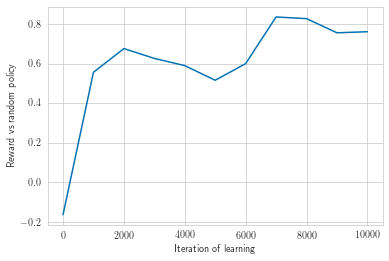

In [26]:
%%time
torch.manual_seed(1)
dqn = TicTacToeDQN(3, 3, 3)
quality = dqn.run(10000, vs_random=False)

Ну... График не очень красивый, но видно, что результат от обучения есть: мы играем значительно лучше, чем играет случайная стратегия.  
Смотреть на вознаграждения в процессе обучения здесь не имеет большого смысла, потому что стратегии совершают очень много случайных действий.

Для доски побольше:

21:06:25.251096	Starting training for 10000 episodes...
Current quality == 0.1999
	Episode 0 finished with reward 1. Current epsilon == 0.950000.
	Episode 1 finished with reward 0. Current epsilon == 0.949989.
	Episode 2 finished with reward -1. Current epsilon == 0.949979.
	Episode 3 finished with reward -1. Current epsilon == 0.949968.
	Episode 4 finished with reward -1. Current epsilon == 0.949958.
	Episode 5 finished with reward 0. Current epsilon == 0.949947.
	Episode 6 finished with reward 0. Current epsilon == 0.949937.
	Episode 7 finished with reward -1. Current epsilon == 0.949926.
	Episode 8 finished with reward 0. Current epsilon == 0.949915.
	Episode 9 finished with reward 0. Current epsilon == 0.949905.
	Episode 10 finished with reward 1. Current epsilon == 0.949894.
	Episode 11 finished with reward -1. Current epsilon == 0.949884.
	Episode 12 finished with reward 0. Current epsilon == 0.949873.
	Episode 13 finished with reward 0. Current epsilon == 0.949863.
	Episode 14 f

	Episode 125 finished with reward -1. Current epsilon == 0.948680.
	Episode 126 finished with reward 0. Current epsilon == 0.948670.
	Episode 127 finished with reward -1. Current epsilon == 0.948659.
	Episode 128 finished with reward 0. Current epsilon == 0.948648.
	Episode 129 finished with reward 0. Current epsilon == 0.948638.
	Episode 130 finished with reward -1. Current epsilon == 0.948627.
	Episode 131 finished with reward 1. Current epsilon == 0.948617.
	Episode 132 finished with reward 0. Current epsilon == 0.948606.
	Episode 133 finished with reward 1. Current epsilon == 0.948596.
	Episode 134 finished with reward 1. Current epsilon == 0.948585.
	Episode 135 finished with reward 1. Current epsilon == 0.948575.
	Episode 136 finished with reward -1. Current epsilon == 0.948564.
	Episode 137 finished with reward -1. Current epsilon == 0.948554.
	Episode 138 finished with reward 0. Current epsilon == 0.948543.
	Episode 139 finished with reward 0. Current epsilon == 0.948532.
	Epis

	Episode 251 finished with reward 1. Current epsilon == 0.947352.
	Episode 252 finished with reward 0. Current epsilon == 0.947341.
	Episode 253 finished with reward 0. Current epsilon == 0.947330.
	Episode 254 finished with reward 1. Current epsilon == 0.947320.
	Episode 255 finished with reward -1. Current epsilon == 0.947309.
	Episode 256 finished with reward -1. Current epsilon == 0.947299.
	Episode 257 finished with reward -1. Current epsilon == 0.947288.
	Episode 258 finished with reward 0. Current epsilon == 0.947278.
	Episode 259 finished with reward -1. Current epsilon == 0.947267.
	Episode 260 finished with reward -1. Current epsilon == 0.947257.
	Episode 261 finished with reward 0. Current epsilon == 0.947246.
	Episode 262 finished with reward -1. Current epsilon == 0.947236.
	Episode 263 finished with reward -1. Current epsilon == 0.947225.
	Episode 264 finished with reward 0. Current epsilon == 0.947215.
	Episode 265 finished with reward 0. Current epsilon == 0.947204.
	Ep

	Episode 376 finished with reward 1. Current epsilon == 0.946035.
	Episode 377 finished with reward 0. Current epsilon == 0.946025.
	Episode 378 finished with reward -1. Current epsilon == 0.946014.
	Episode 379 finished with reward 1. Current epsilon == 0.946004.
	Episode 380 finished with reward 1. Current epsilon == 0.945993.
	Episode 381 finished with reward -1. Current epsilon == 0.945983.
	Episode 382 finished with reward 0. Current epsilon == 0.945972.
	Episode 383 finished with reward 1. Current epsilon == 0.945962.
	Episode 384 finished with reward 0. Current epsilon == 0.945951.
	Episode 385 finished with reward 1. Current epsilon == 0.945941.
	Episode 386 finished with reward 0. Current epsilon == 0.945930.
	Episode 387 finished with reward 0. Current epsilon == 0.945920.
	Episode 388 finished with reward 0. Current epsilon == 0.945909.
	Episode 389 finished with reward -1. Current epsilon == 0.945899.
	Episode 390 finished with reward 0. Current epsilon == 0.945888.
	Episod

	Episode 502 finished with reward 0. Current epsilon == 0.944710.
	Episode 503 finished with reward 1. Current epsilon == 0.944700.
	Episode 504 finished with reward 0. Current epsilon == 0.944689.
	Episode 505 finished with reward 0. Current epsilon == 0.944679.
	Episode 506 finished with reward 0. Current epsilon == 0.944668.
	Episode 507 finished with reward 0. Current epsilon == 0.944658.
	Episode 508 finished with reward 0. Current epsilon == 0.944647.
	Episode 509 finished with reward 0. Current epsilon == 0.944637.
	Episode 510 finished with reward 1. Current epsilon == 0.944626.
	Episode 511 finished with reward -1. Current epsilon == 0.944616.
	Episode 512 finished with reward 0. Current epsilon == 0.944605.
	Episode 513 finished with reward -1. Current epsilon == 0.944595.
	Episode 514 finished with reward 0. Current epsilon == 0.944584.
	Episode 515 finished with reward -1. Current epsilon == 0.944574.
	Episode 516 finished with reward 0. Current epsilon == 0.944563.
	Episod

	Episode 628 finished with reward 0. Current epsilon == 0.943387.
	Episode 629 finished with reward -1. Current epsilon == 0.943377.
	Episode 630 finished with reward -1. Current epsilon == 0.943366.
	Episode 631 finished with reward -1. Current epsilon == 0.943356.
	Episode 632 finished with reward 0. Current epsilon == 0.943345.
	Episode 633 finished with reward 1. Current epsilon == 0.943335.
	Episode 634 finished with reward 0. Current epsilon == 0.943324.
	Episode 635 finished with reward -1. Current epsilon == 0.943314.
	Episode 636 finished with reward -1. Current epsilon == 0.943303.
	Episode 637 finished with reward -1. Current epsilon == 0.943293.
	Episode 638 finished with reward -1. Current epsilon == 0.943282.
	Episode 639 finished with reward 0. Current epsilon == 0.943272.
	Episode 640 finished with reward -1. Current epsilon == 0.943261.
	Episode 641 finished with reward -1. Current epsilon == 0.943251.
	Episode 642 finished with reward 0. Current epsilon == 0.943241.
	

	Episode 752 finished with reward 0. Current epsilon == 0.942087.
	Episode 753 finished with reward 0. Current epsilon == 0.942077.
	Episode 754 finished with reward -1. Current epsilon == 0.942066.
	Episode 755 finished with reward -1. Current epsilon == 0.942056.
	Episode 756 finished with reward -1. Current epsilon == 0.942045.
	Episode 757 finished with reward -1. Current epsilon == 0.942035.
	Episode 758 finished with reward -1. Current epsilon == 0.942024.
	Episode 759 finished with reward 1. Current epsilon == 0.942014.
	Episode 760 finished with reward 0. Current epsilon == 0.942003.
	Episode 761 finished with reward 0. Current epsilon == 0.941993.
	Episode 762 finished with reward 0. Current epsilon == 0.941982.
	Episode 763 finished with reward 0. Current epsilon == 0.941972.
	Episode 764 finished with reward 0. Current epsilon == 0.941961.
	Episode 765 finished with reward -1. Current epsilon == 0.941951.
	Episode 766 finished with reward -1. Current epsilon == 0.941940.
	Ep

	Episode 877 finished with reward 0. Current epsilon == 0.940778.
	Episode 878 finished with reward 0. Current epsilon == 0.940768.
	Episode 879 finished with reward -1. Current epsilon == 0.940757.
	Episode 880 finished with reward 0. Current epsilon == 0.940747.
	Episode 881 finished with reward -1. Current epsilon == 0.940736.
	Episode 882 finished with reward 1. Current epsilon == 0.940726.
	Episode 883 finished with reward -1. Current epsilon == 0.940716.
	Episode 884 finished with reward 1. Current epsilon == 0.940705.
	Episode 885 finished with reward 1. Current epsilon == 0.940695.
	Episode 886 finished with reward -1. Current epsilon == 0.940684.
	Episode 887 finished with reward -1. Current epsilon == 0.940674.
	Episode 888 finished with reward 0. Current epsilon == 0.940663.
	Episode 889 finished with reward -1. Current epsilon == 0.940653.
	Episode 890 finished with reward 1. Current epsilon == 0.940642.
	Episode 891 finished with reward -1. Current epsilon == 0.940632.
	Ep

	Episode 1002 finished with reward 1. Current epsilon == 0.939471.
	Episode 1003 finished with reward 0. Current epsilon == 0.939461.
	Episode 1004 finished with reward 0. Current epsilon == 0.939450.
	Episode 1005 finished with reward 1. Current epsilon == 0.939440.
	Episode 1006 finished with reward 1. Current epsilon == 0.939429.
	Episode 1007 finished with reward 1. Current epsilon == 0.939419.
	Episode 1008 finished with reward 0. Current epsilon == 0.939409.
	Episode 1009 finished with reward 0. Current epsilon == 0.939398.
	Episode 1010 finished with reward -1. Current epsilon == 0.939388.
	Episode 1011 finished with reward 0. Current epsilon == 0.939377.
	Episode 1012 finished with reward -1. Current epsilon == 0.939367.
	Episode 1013 finished with reward 1. Current epsilon == 0.939356.
	Episode 1014 finished with reward 0. Current epsilon == 0.939346.
	Episode 1015 finished with reward -1. Current epsilon == 0.939335.
	Episode 1016 finished with reward -1. Current epsilon == 0

	Episode 1125 finished with reward 0. Current epsilon == 0.938187.
	Episode 1126 finished with reward -1. Current epsilon == 0.938176.
	Episode 1127 finished with reward 1. Current epsilon == 0.938166.
	Episode 1128 finished with reward 1. Current epsilon == 0.938156.
	Episode 1129 finished with reward 0. Current epsilon == 0.938145.
	Episode 1130 finished with reward 0. Current epsilon == 0.938135.
	Episode 1131 finished with reward 1. Current epsilon == 0.938124.
	Episode 1132 finished with reward -1. Current epsilon == 0.938114.
	Episode 1133 finished with reward 0. Current epsilon == 0.938103.
	Episode 1134 finished with reward -1. Current epsilon == 0.938093.
	Episode 1135 finished with reward -1. Current epsilon == 0.938082.
	Episode 1136 finished with reward -1. Current epsilon == 0.938072.
	Episode 1137 finished with reward 0. Current epsilon == 0.938062.
	Episode 1138 finished with reward -1. Current epsilon == 0.938051.
	Episode 1139 finished with reward -1. Current epsilon =

	Episode 1247 finished with reward -1. Current epsilon == 0.936915.
	Episode 1248 finished with reward 1. Current epsilon == 0.936904.
	Episode 1249 finished with reward -1. Current epsilon == 0.936894.
	Episode 1250 finished with reward -1. Current epsilon == 0.936883.
	Episode 1251 finished with reward -1. Current epsilon == 0.936873.
	Episode 1252 finished with reward -1. Current epsilon == 0.936863.
	Episode 1253 finished with reward 0. Current epsilon == 0.936852.
	Episode 1254 finished with reward -1. Current epsilon == 0.936842.
	Episode 1255 finished with reward -1. Current epsilon == 0.936831.
	Episode 1256 finished with reward 0. Current epsilon == 0.936821.
	Episode 1257 finished with reward 0. Current epsilon == 0.936810.
	Episode 1258 finished with reward 0. Current epsilon == 0.936800.
	Episode 1259 finished with reward 0. Current epsilon == 0.936790.
	Episode 1260 finished with reward 0. Current epsilon == 0.936779.
	Episode 1261 finished with reward -1. Current epsilon 

	Episode 1369 finished with reward 1. Current epsilon == 0.935644.
	Episode 1370 finished with reward 1. Current epsilon == 0.935634.
	Episode 1371 finished with reward 0. Current epsilon == 0.935623.
	Episode 1372 finished with reward -1. Current epsilon == 0.935613.
	Episode 1373 finished with reward -1. Current epsilon == 0.935602.
	Episode 1374 finished with reward -1. Current epsilon == 0.935592.
	Episode 1375 finished with reward -1. Current epsilon == 0.935582.
	Episode 1376 finished with reward 0. Current epsilon == 0.935571.
	Episode 1377 finished with reward 0. Current epsilon == 0.935561.
	Episode 1378 finished with reward 0. Current epsilon == 0.935550.
	Episode 1379 finished with reward 0. Current epsilon == 0.935540.
	Episode 1380 finished with reward -1. Current epsilon == 0.935530.
	Episode 1381 finished with reward -1. Current epsilon == 0.935519.
	Episode 1382 finished with reward -1. Current epsilon == 0.935509.
	Episode 1383 finished with reward 0. Current epsilon =

	Episode 1492 finished with reward 0. Current epsilon == 0.934365.
	Episode 1493 finished with reward -1. Current epsilon == 0.934355.
	Episode 1494 finished with reward -1. Current epsilon == 0.934344.
	Episode 1495 finished with reward -1. Current epsilon == 0.934334.
	Episode 1496 finished with reward 0. Current epsilon == 0.934323.
	Episode 1497 finished with reward -1. Current epsilon == 0.934313.
	Episode 1498 finished with reward -1. Current epsilon == 0.934303.
	Episode 1499 finished with reward -1. Current epsilon == 0.934292.
	Episode 1500 finished with reward -1. Current epsilon == 0.934282.
	Episode 1501 finished with reward 0. Current epsilon == 0.934271.
	Episode 1502 finished with reward 1. Current epsilon == 0.934261.
	Episode 1503 finished with reward 1. Current epsilon == 0.934251.
	Episode 1504 finished with reward 0. Current epsilon == 0.934240.
	Episode 1505 finished with reward -1. Current epsilon == 0.934230.
	Episode 1506 finished with reward -1. Current epsilon

	Episode 1615 finished with reward 0. Current epsilon == 0.933088.
	Episode 1616 finished with reward 0. Current epsilon == 0.933077.
	Episode 1617 finished with reward -1. Current epsilon == 0.933067.
	Episode 1618 finished with reward 0. Current epsilon == 0.933056.
	Episode 1619 finished with reward -1. Current epsilon == 0.933046.
	Episode 1620 finished with reward 1. Current epsilon == 0.933036.
	Episode 1621 finished with reward -1. Current epsilon == 0.933025.
	Episode 1622 finished with reward 0. Current epsilon == 0.933015.
	Episode 1623 finished with reward -1. Current epsilon == 0.933005.
	Episode 1624 finished with reward -1. Current epsilon == 0.932994.
	Episode 1625 finished with reward -1. Current epsilon == 0.932984.
	Episode 1626 finished with reward 0. Current epsilon == 0.932973.
	Episode 1627 finished with reward -1. Current epsilon == 0.932963.
	Episode 1628 finished with reward -1. Current epsilon == 0.932953.
	Episode 1629 finished with reward 0. Current epsilon 

	Episode 1738 finished with reward -1. Current epsilon == 0.931812.
	Episode 1739 finished with reward 1. Current epsilon == 0.931802.
	Episode 1740 finished with reward -1. Current epsilon == 0.931791.
	Episode 1741 finished with reward 0. Current epsilon == 0.931781.
	Episode 1742 finished with reward 1. Current epsilon == 0.931770.
	Episode 1743 finished with reward -1. Current epsilon == 0.931760.
	Episode 1744 finished with reward -1. Current epsilon == 0.931750.
	Episode 1745 finished with reward -1. Current epsilon == 0.931739.
	Episode 1746 finished with reward 1. Current epsilon == 0.931729.
	Episode 1747 finished with reward -1. Current epsilon == 0.931719.
	Episode 1748 finished with reward 1. Current epsilon == 0.931708.
	Episode 1749 finished with reward -1. Current epsilon == 0.931698.
	Episode 1750 finished with reward 0. Current epsilon == 0.931688.
	Episode 1751 finished with reward 1. Current epsilon == 0.931677.
	Episode 1752 finished with reward -1. Current epsilon 

	Episode 1861 finished with reward 0. Current epsilon == 0.930538.
	Episode 1862 finished with reward 0. Current epsilon == 0.930528.
	Episode 1863 finished with reward -1. Current epsilon == 0.930517.
	Episode 1864 finished with reward 0. Current epsilon == 0.930507.
	Episode 1865 finished with reward 0. Current epsilon == 0.930497.
	Episode 1866 finished with reward 0. Current epsilon == 0.930486.
	Episode 1867 finished with reward 0. Current epsilon == 0.930476.
	Episode 1868 finished with reward -1. Current epsilon == 0.930466.
	Episode 1869 finished with reward -1. Current epsilon == 0.930455.
	Episode 1870 finished with reward -1. Current epsilon == 0.930445.
	Episode 1871 finished with reward 0. Current epsilon == 0.930434.
	Episode 1872 finished with reward -1. Current epsilon == 0.930424.
	Episode 1873 finished with reward -1. Current epsilon == 0.930414.
	Episode 1874 finished with reward 0. Current epsilon == 0.930403.
	Episode 1875 finished with reward 0. Current epsilon ==

	Episode 1985 finished with reward 1. Current epsilon == 0.929255.
	Episode 1986 finished with reward 0. Current epsilon == 0.929245.
	Episode 1987 finished with reward 0. Current epsilon == 0.929235.
	Episode 1988 finished with reward 0. Current epsilon == 0.929224.
	Episode 1989 finished with reward -1. Current epsilon == 0.929214.
	Episode 1990 finished with reward 0. Current epsilon == 0.929204.
	Episode 1991 finished with reward -1. Current epsilon == 0.929193.
	Episode 1992 finished with reward -1. Current epsilon == 0.929183.
	Episode 1993 finished with reward 1. Current epsilon == 0.929173.
	Episode 1994 finished with reward 0. Current epsilon == 0.929162.
	Episode 1995 finished with reward 1. Current epsilon == 0.929152.
	Episode 1996 finished with reward -1. Current epsilon == 0.929142.
	Episode 1997 finished with reward 1. Current epsilon == 0.929131.
	Episode 1998 finished with reward 0. Current epsilon == 0.929121.
	Episode 1999 finished with reward -1. Current epsilon == 

	Episode 2110 finished with reward 1. Current epsilon == 0.927964.
	Episode 2111 finished with reward 0. Current epsilon == 0.927954.
	Episode 2112 finished with reward 1. Current epsilon == 0.927944.
	Episode 2113 finished with reward 1. Current epsilon == 0.927933.
	Episode 2114 finished with reward -1. Current epsilon == 0.927923.
	Episode 2115 finished with reward 0. Current epsilon == 0.927913.
	Episode 2116 finished with reward 1. Current epsilon == 0.927902.
	Episode 2117 finished with reward 1. Current epsilon == 0.927892.
	Episode 2118 finished with reward 1. Current epsilon == 0.927882.
	Episode 2119 finished with reward 1. Current epsilon == 0.927872.
	Episode 2120 finished with reward -1. Current epsilon == 0.927861.
	Episode 2121 finished with reward -1. Current epsilon == 0.927851.
	Episode 2122 finished with reward -1. Current epsilon == 0.927841.
	Episode 2123 finished with reward -1. Current epsilon == 0.927830.
	Episode 2124 finished with reward -1. Current epsilon ==

	Episode 2233 finished with reward 0. Current epsilon == 0.926696.
	Episode 2234 finished with reward -1. Current epsilon == 0.926685.
	Episode 2235 finished with reward 0. Current epsilon == 0.926675.
	Episode 2236 finished with reward 1. Current epsilon == 0.926665.
	Episode 2237 finished with reward -1. Current epsilon == 0.926655.
	Episode 2238 finished with reward 0. Current epsilon == 0.926644.
	Episode 2239 finished with reward 0. Current epsilon == 0.926634.
	Episode 2240 finished with reward -1. Current epsilon == 0.926624.
	Episode 2241 finished with reward -1. Current epsilon == 0.926613.
	Episode 2242 finished with reward 0. Current epsilon == 0.926603.
	Episode 2243 finished with reward -1. Current epsilon == 0.926593.
	Episode 2244 finished with reward 0. Current epsilon == 0.926582.
	Episode 2245 finished with reward -1. Current epsilon == 0.926572.
	Episode 2246 finished with reward 0. Current epsilon == 0.926562.
	Episode 2247 finished with reward 1. Current epsilon ==

	Episode 2360 finished with reward -1. Current epsilon == 0.925388.
	Episode 2361 finished with reward -1. Current epsilon == 0.925377.
	Episode 2362 finished with reward -1. Current epsilon == 0.925367.
	Episode 2363 finished with reward -1. Current epsilon == 0.925357.
	Episode 2364 finished with reward 0. Current epsilon == 0.925346.
	Episode 2365 finished with reward 0. Current epsilon == 0.925336.
	Episode 2366 finished with reward -1. Current epsilon == 0.925326.
	Episode 2367 finished with reward 1. Current epsilon == 0.925316.
	Episode 2368 finished with reward -1. Current epsilon == 0.925305.
	Episode 2369 finished with reward -1. Current epsilon == 0.925295.
	Episode 2370 finished with reward 0. Current epsilon == 0.925285.
	Episode 2371 finished with reward 1. Current epsilon == 0.925274.
	Episode 2372 finished with reward 0. Current epsilon == 0.925264.
	Episode 2373 finished with reward 1. Current epsilon == 0.925254.
	Episode 2374 finished with reward -1. Current epsilon 

	Episode 2484 finished with reward 0. Current epsilon == 0.924112.
	Episode 2485 finished with reward -1. Current epsilon == 0.924102.
	Episode 2486 finished with reward -1. Current epsilon == 0.924092.
	Episode 2487 finished with reward 0. Current epsilon == 0.924081.
	Episode 2488 finished with reward -1. Current epsilon == 0.924071.
	Episode 2489 finished with reward 1. Current epsilon == 0.924061.
	Episode 2490 finished with reward 0. Current epsilon == 0.924051.
	Episode 2491 finished with reward 0. Current epsilon == 0.924040.
	Episode 2492 finished with reward 0. Current epsilon == 0.924030.
	Episode 2493 finished with reward 0. Current epsilon == 0.924020.
	Episode 2494 finished with reward -1. Current epsilon == 0.924009.
	Episode 2495 finished with reward 0. Current epsilon == 0.923999.
	Episode 2496 finished with reward -1. Current epsilon == 0.923989.
	Episode 2497 finished with reward 0. Current epsilon == 0.923979.
	Episode 2498 finished with reward -1. Current epsilon ==

	Episode 2606 finished with reward -1. Current epsilon == 0.922859.
	Episode 2607 finished with reward 0. Current epsilon == 0.922849.
	Episode 2608 finished with reward 1. Current epsilon == 0.922839.
	Episode 2609 finished with reward -1. Current epsilon == 0.922828.
	Episode 2610 finished with reward 0. Current epsilon == 0.922818.
	Episode 2611 finished with reward 0. Current epsilon == 0.922808.
	Episode 2612 finished with reward 1. Current epsilon == 0.922798.
	Episode 2613 finished with reward -1. Current epsilon == 0.922787.
	Episode 2614 finished with reward -1. Current epsilon == 0.922777.
	Episode 2615 finished with reward 1. Current epsilon == 0.922767.
	Episode 2616 finished with reward 0. Current epsilon == 0.922756.
	Episode 2617 finished with reward 0. Current epsilon == 0.922746.
	Episode 2618 finished with reward 1. Current epsilon == 0.922736.
	Episode 2619 finished with reward 1. Current epsilon == 0.922726.
	Episode 2620 finished with reward 0. Current epsilon == 0

	Episode 2728 finished with reward 1. Current epsilon == 0.921608.
	Episode 2729 finished with reward 0. Current epsilon == 0.921597.
	Episode 2730 finished with reward 0. Current epsilon == 0.921587.
	Episode 2731 finished with reward 0. Current epsilon == 0.921577.
	Episode 2732 finished with reward 1. Current epsilon == 0.921567.
	Episode 2733 finished with reward -1. Current epsilon == 0.921556.
	Episode 2734 finished with reward 0. Current epsilon == 0.921546.
	Episode 2735 finished with reward 1. Current epsilon == 0.921536.
	Episode 2736 finished with reward 0. Current epsilon == 0.921526.
	Episode 2737 finished with reward 1. Current epsilon == 0.921515.
	Episode 2738 finished with reward -1. Current epsilon == 0.921505.
	Episode 2739 finished with reward -1. Current epsilon == 0.921495.
	Episode 2740 finished with reward 1. Current epsilon == 0.921485.
	Episode 2741 finished with reward -1. Current epsilon == 0.921474.
	Episode 2742 finished with reward 1. Current epsilon == 0

	Episode 2851 finished with reward 1. Current epsilon == 0.920348.
	Episode 2852 finished with reward 1. Current epsilon == 0.920337.
	Episode 2853 finished with reward 0. Current epsilon == 0.920327.
	Episode 2854 finished with reward 0. Current epsilon == 0.920317.
	Episode 2855 finished with reward 0. Current epsilon == 0.920307.
	Episode 2856 finished with reward -1. Current epsilon == 0.920297.
	Episode 2857 finished with reward 1. Current epsilon == 0.920286.
	Episode 2858 finished with reward 0. Current epsilon == 0.920276.
	Episode 2859 finished with reward 0. Current epsilon == 0.920266.
	Episode 2860 finished with reward 0. Current epsilon == 0.920256.
	Episode 2861 finished with reward 0. Current epsilon == 0.920245.
	Episode 2862 finished with reward -1. Current epsilon == 0.920235.
	Episode 2863 finished with reward -1. Current epsilon == 0.920225.
	Episode 2864 finished with reward -1. Current epsilon == 0.920215.
	Episode 2865 finished with reward 0. Current epsilon == 0

	Episode 2975 finished with reward 1. Current epsilon == 0.919079.
	Episode 2976 finished with reward 0. Current epsilon == 0.919069.
	Episode 2977 finished with reward -1. Current epsilon == 0.919059.
	Episode 2978 finished with reward 1. Current epsilon == 0.919049.
	Episode 2979 finished with reward -1. Current epsilon == 0.919038.
	Episode 2980 finished with reward -1. Current epsilon == 0.919028.
	Episode 2981 finished with reward 1. Current epsilon == 0.919018.
	Episode 2982 finished with reward 0. Current epsilon == 0.919008.
	Episode 2983 finished with reward -1. Current epsilon == 0.918997.
	Episode 2984 finished with reward -1. Current epsilon == 0.918987.
	Episode 2985 finished with reward 1. Current epsilon == 0.918977.
	Episode 2986 finished with reward -1. Current epsilon == 0.918967.
	Episode 2987 finished with reward -1. Current epsilon == 0.918957.
	Episode 2988 finished with reward 0. Current epsilon == 0.918946.
	Episode 2989 finished with reward -1. Current epsilon 

	Episode 3097 finished with reward 1. Current epsilon == 0.917833.
	Episode 3098 finished with reward 0. Current epsilon == 0.917823.
	Episode 3099 finished with reward 0. Current epsilon == 0.917813.
	Episode 3100 finished with reward 1. Current epsilon == 0.917802.
	Episode 3101 finished with reward 0. Current epsilon == 0.917792.
	Episode 3102 finished with reward 1. Current epsilon == 0.917782.
	Episode 3103 finished with reward 0. Current epsilon == 0.917772.
	Episode 3104 finished with reward -1. Current epsilon == 0.917761.
	Episode 3105 finished with reward -1. Current epsilon == 0.917751.
	Episode 3106 finished with reward 0. Current epsilon == 0.917741.
	Episode 3107 finished with reward -1. Current epsilon == 0.917731.
	Episode 3108 finished with reward -1. Current epsilon == 0.917721.
	Episode 3109 finished with reward 0. Current epsilon == 0.917710.
	Episode 3110 finished with reward -1. Current epsilon == 0.917700.
	Episode 3111 finished with reward 0. Current epsilon == 

	Episode 3220 finished with reward 0. Current epsilon == 0.916578.
	Episode 3221 finished with reward -1. Current epsilon == 0.916568.
	Episode 3222 finished with reward 0. Current epsilon == 0.916558.
	Episode 3223 finished with reward 0. Current epsilon == 0.916548.
	Episode 3224 finished with reward -1. Current epsilon == 0.916537.
	Episode 3225 finished with reward 0. Current epsilon == 0.916527.
	Episode 3226 finished with reward -1. Current epsilon == 0.916517.
	Episode 3227 finished with reward 1. Current epsilon == 0.916507.
	Episode 3228 finished with reward -1. Current epsilon == 0.916497.
	Episode 3229 finished with reward 0. Current epsilon == 0.916486.
	Episode 3230 finished with reward 0. Current epsilon == 0.916476.
	Episode 3231 finished with reward 1. Current epsilon == 0.916466.
	Episode 3232 finished with reward 0. Current epsilon == 0.916456.
	Episode 3233 finished with reward 1. Current epsilon == 0.916446.
	Episode 3234 finished with reward 0. Current epsilon == 0

	Episode 3347 finished with reward -1. Current epsilon == 0.915284.
	Episode 3348 finished with reward -1. Current epsilon == 0.915274.
	Episode 3349 finished with reward 1. Current epsilon == 0.915264.
	Episode 3350 finished with reward -1. Current epsilon == 0.915254.
	Episode 3351 finished with reward -1. Current epsilon == 0.915244.
	Episode 3352 finished with reward -1. Current epsilon == 0.915233.
	Episode 3353 finished with reward 0. Current epsilon == 0.915223.
	Episode 3354 finished with reward 0. Current epsilon == 0.915213.
	Episode 3355 finished with reward -1. Current epsilon == 0.915203.
	Episode 3356 finished with reward 0. Current epsilon == 0.915193.
	Episode 3357 finished with reward -1. Current epsilon == 0.915183.
	Episode 3358 finished with reward 0. Current epsilon == 0.915172.
	Episode 3359 finished with reward 1. Current epsilon == 0.915162.
	Episode 3360 finished with reward 1. Current epsilon == 0.915152.
	Episode 3361 finished with reward 0. Current epsilon =

	Episode 3473 finished with reward 0. Current epsilon == 0.914003.
	Episode 3474 finished with reward 0. Current epsilon == 0.913992.
	Episode 3475 finished with reward -1. Current epsilon == 0.913982.
	Episode 3476 finished with reward 0. Current epsilon == 0.913972.
	Episode 3477 finished with reward 0. Current epsilon == 0.913962.
	Episode 3478 finished with reward -1. Current epsilon == 0.913952.
	Episode 3479 finished with reward -1. Current epsilon == 0.913942.
	Episode 3480 finished with reward 1. Current epsilon == 0.913931.
	Episode 3481 finished with reward -1. Current epsilon == 0.913921.
	Episode 3482 finished with reward 0. Current epsilon == 0.913911.
	Episode 3483 finished with reward -1. Current epsilon == 0.913901.
	Episode 3484 finished with reward -1. Current epsilon == 0.913891.
	Episode 3485 finished with reward -1. Current epsilon == 0.913881.
	Episode 3486 finished with reward 0. Current epsilon == 0.913870.
	Episode 3487 finished with reward -1. Current epsilon 

	Episode 3597 finished with reward -1. Current epsilon == 0.912743.
	Episode 3598 finished with reward -1. Current epsilon == 0.912733.
	Episode 3599 finished with reward 0. Current epsilon == 0.912722.
	Episode 3600 finished with reward 0. Current epsilon == 0.912712.
	Episode 3601 finished with reward 0. Current epsilon == 0.912702.
	Episode 3602 finished with reward 0. Current epsilon == 0.912692.
	Episode 3603 finished with reward 0. Current epsilon == 0.912682.
	Episode 3604 finished with reward 1. Current epsilon == 0.912672.
	Episode 3605 finished with reward -1. Current epsilon == 0.912662.
	Episode 3606 finished with reward -1. Current epsilon == 0.912651.
	Episode 3607 finished with reward -1. Current epsilon == 0.912641.
	Episode 3608 finished with reward -1. Current epsilon == 0.912631.
	Episode 3609 finished with reward 0. Current epsilon == 0.912621.
	Episode 3610 finished with reward -1. Current epsilon == 0.912611.
	Episode 3611 finished with reward -1. Current epsilon 

	Episode 3719 finished with reward -1. Current epsilon == 0.911505.
	Episode 3720 finished with reward 1. Current epsilon == 0.911495.
	Episode 3721 finished with reward -1. Current epsilon == 0.911485.
	Episode 3722 finished with reward 0. Current epsilon == 0.911475.
	Episode 3723 finished with reward -1. Current epsilon == 0.911465.
	Episode 3724 finished with reward 1. Current epsilon == 0.911454.
	Episode 3725 finished with reward 1. Current epsilon == 0.911444.
	Episode 3726 finished with reward -1. Current epsilon == 0.911434.
	Episode 3727 finished with reward -1. Current epsilon == 0.911424.
	Episode 3728 finished with reward -1. Current epsilon == 0.911414.
	Episode 3729 finished with reward 0. Current epsilon == 0.911404.
	Episode 3730 finished with reward 0. Current epsilon == 0.911394.
	Episode 3731 finished with reward 1. Current epsilon == 0.911383.
	Episode 3732 finished with reward -1. Current epsilon == 0.911373.
	Episode 3733 finished with reward -1. Current epsilon 

	Episode 3841 finished with reward 0. Current epsilon == 0.910269.
	Episode 3842 finished with reward -1. Current epsilon == 0.910259.
	Episode 3843 finished with reward -1. Current epsilon == 0.910249.
	Episode 3844 finished with reward -1. Current epsilon == 0.910239.
	Episode 3845 finished with reward 0. Current epsilon == 0.910229.
	Episode 3846 finished with reward 0. Current epsilon == 0.910218.
	Episode 3847 finished with reward -1. Current epsilon == 0.910208.
	Episode 3848 finished with reward -1. Current epsilon == 0.910198.
	Episode 3849 finished with reward -1. Current epsilon == 0.910188.
	Episode 3850 finished with reward 0. Current epsilon == 0.910178.
	Episode 3851 finished with reward -1. Current epsilon == 0.910168.
	Episode 3852 finished with reward 1. Current epsilon == 0.910158.
	Episode 3853 finished with reward 1. Current epsilon == 0.910148.
	Episode 3854 finished with reward 1. Current epsilon == 0.910137.
	Episode 3855 finished with reward -1. Current epsilon 

	Episode 3965 finished with reward 1. Current epsilon == 0.909014.
	Episode 3966 finished with reward 0. Current epsilon == 0.909004.
	Episode 3967 finished with reward 0. Current epsilon == 0.908994.
	Episode 3968 finished with reward -1. Current epsilon == 0.908984.
	Episode 3969 finished with reward 0. Current epsilon == 0.908974.
	Episode 3970 finished with reward 1. Current epsilon == 0.908964.
	Episode 3971 finished with reward 1. Current epsilon == 0.908954.
	Episode 3972 finished with reward -1. Current epsilon == 0.908944.
	Episode 3973 finished with reward -1. Current epsilon == 0.908934.
	Episode 3974 finished with reward 0. Current epsilon == 0.908923.
	Episode 3975 finished with reward -1. Current epsilon == 0.908913.
	Episode 3976 finished with reward 1. Current epsilon == 0.908903.
	Episode 3977 finished with reward 0. Current epsilon == 0.908893.
	Episode 3978 finished with reward 1. Current epsilon == 0.908883.
	Episode 3979 finished with reward 1. Current epsilon == 0

	Episode 4087 finished with reward 1. Current epsilon == 0.907782.
	Episode 4088 finished with reward 0. Current epsilon == 0.907772.
	Episode 4089 finished with reward -1. Current epsilon == 0.907762.
	Episode 4090 finished with reward -1. Current epsilon == 0.907752.
	Episode 4091 finished with reward -1. Current epsilon == 0.907741.
	Episode 4092 finished with reward 0. Current epsilon == 0.907731.
	Episode 4093 finished with reward -1. Current epsilon == 0.907721.
	Episode 4094 finished with reward 0. Current epsilon == 0.907711.
	Episode 4095 finished with reward 0. Current epsilon == 0.907701.
	Episode 4096 finished with reward -1. Current epsilon == 0.907691.
	Episode 4097 finished with reward -1. Current epsilon == 0.907681.
	Episode 4098 finished with reward 0. Current epsilon == 0.907671.
	Episode 4099 finished with reward -1. Current epsilon == 0.907661.
	Episode 4100 finished with reward -1. Current epsilon == 0.907651.
	Episode 4101 finished with reward -1. Current epsilon

	Episode 4212 finished with reward -1. Current epsilon == 0.906521.
	Episode 4213 finished with reward 0. Current epsilon == 0.906511.
	Episode 4214 finished with reward 0. Current epsilon == 0.906500.
	Episode 4215 finished with reward 0. Current epsilon == 0.906490.
	Episode 4216 finished with reward -1. Current epsilon == 0.906480.
	Episode 4217 finished with reward 0. Current epsilon == 0.906470.
	Episode 4218 finished with reward -1. Current epsilon == 0.906460.
	Episode 4219 finished with reward 0. Current epsilon == 0.906450.
	Episode 4220 finished with reward 0. Current epsilon == 0.906440.
	Episode 4221 finished with reward 1. Current epsilon == 0.906430.
	Episode 4222 finished with reward 0. Current epsilon == 0.906420.
	Episode 4223 finished with reward 0. Current epsilon == 0.906410.
	Episode 4224 finished with reward 1. Current epsilon == 0.906400.
	Episode 4225 finished with reward -1. Current epsilon == 0.906390.
	Episode 4226 finished with reward -1. Current epsilon == 

	Episode 4335 finished with reward 0. Current epsilon == 0.905281.
	Episode 4336 finished with reward 0. Current epsilon == 0.905271.
	Episode 4337 finished with reward -1. Current epsilon == 0.905261.
	Episode 4338 finished with reward 1. Current epsilon == 0.905251.
	Episode 4339 finished with reward -1. Current epsilon == 0.905241.
	Episode 4340 finished with reward -1. Current epsilon == 0.905231.
	Episode 4341 finished with reward 0. Current epsilon == 0.905221.
	Episode 4342 finished with reward 0. Current epsilon == 0.905211.
	Episode 4343 finished with reward -1. Current epsilon == 0.905201.
	Episode 4344 finished with reward 1. Current epsilon == 0.905191.
	Episode 4345 finished with reward -1. Current epsilon == 0.905181.
	Episode 4346 finished with reward 0. Current epsilon == 0.905170.
	Episode 4347 finished with reward -1. Current epsilon == 0.905160.
	Episode 4348 finished with reward -1. Current epsilon == 0.905150.
	Episode 4349 finished with reward -1. Current epsilon 

	Episode 4459 finished with reward -1. Current epsilon == 0.904034.
	Episode 4460 finished with reward 1. Current epsilon == 0.904023.
	Episode 4461 finished with reward 0. Current epsilon == 0.904013.
	Episode 4462 finished with reward -1. Current epsilon == 0.904003.
	Episode 4463 finished with reward 0. Current epsilon == 0.903993.
	Episode 4464 finished with reward 1. Current epsilon == 0.903983.
	Episode 4465 finished with reward 0. Current epsilon == 0.903973.
	Episode 4466 finished with reward 0. Current epsilon == 0.903963.
	Episode 4467 finished with reward 1. Current epsilon == 0.903953.
	Episode 4468 finished with reward 1. Current epsilon == 0.903943.
	Episode 4469 finished with reward 0. Current epsilon == 0.903933.
	Episode 4470 finished with reward -1. Current epsilon == 0.903923.
	Episode 4471 finished with reward -1. Current epsilon == 0.903913.
	Episode 4472 finished with reward 0. Current epsilon == 0.903903.
	Episode 4473 finished with reward -1. Current epsilon == 

	Episode 4581 finished with reward 0. Current epsilon == 0.902808.
	Episode 4582 finished with reward 0. Current epsilon == 0.902798.
	Episode 4583 finished with reward -1. Current epsilon == 0.902788.
	Episode 4584 finished with reward -1. Current epsilon == 0.902778.
	Episode 4585 finished with reward 1. Current epsilon == 0.902767.
	Episode 4586 finished with reward 0. Current epsilon == 0.902757.
	Episode 4587 finished with reward 1. Current epsilon == 0.902747.
	Episode 4588 finished with reward 0. Current epsilon == 0.902737.
	Episode 4589 finished with reward -1. Current epsilon == 0.902727.
	Episode 4590 finished with reward 0. Current epsilon == 0.902717.
	Episode 4591 finished with reward -1. Current epsilon == 0.902707.
	Episode 4592 finished with reward 0. Current epsilon == 0.902697.
	Episode 4593 finished with reward 1. Current epsilon == 0.902687.
	Episode 4594 finished with reward -1. Current epsilon == 0.902677.
	Episode 4595 finished with reward -1. Current epsilon ==

	Episode 4703 finished with reward 1. Current epsilon == 0.901583.
	Episode 4704 finished with reward 0. Current epsilon == 0.901573.
	Episode 4705 finished with reward 0. Current epsilon == 0.901563.
	Episode 4706 finished with reward 1. Current epsilon == 0.901553.
	Episode 4707 finished with reward -1. Current epsilon == 0.901543.
	Episode 4708 finished with reward 1. Current epsilon == 0.901533.
	Episode 4709 finished with reward 1. Current epsilon == 0.901523.
	Episode 4710 finished with reward 0. Current epsilon == 0.901513.
	Episode 4711 finished with reward 0. Current epsilon == 0.901503.
	Episode 4712 finished with reward 0. Current epsilon == 0.901493.
	Episode 4713 finished with reward 0. Current epsilon == 0.901483.
	Episode 4714 finished with reward 0. Current epsilon == 0.901473.
	Episode 4715 finished with reward 0. Current epsilon == 0.901463.
	Episode 4716 finished with reward 1. Current epsilon == 0.901453.
	Episode 4717 finished with reward -1. Current epsilon == 0.9

	Episode 4825 finished with reward 0. Current epsilon == 0.900361.
	Episode 4826 finished with reward -1. Current epsilon == 0.900351.
	Episode 4827 finished with reward 1. Current epsilon == 0.900341.
	Episode 4828 finished with reward 0. Current epsilon == 0.900331.
	Episode 4829 finished with reward 0. Current epsilon == 0.900321.
	Episode 4830 finished with reward 1. Current epsilon == 0.900311.
	Episode 4831 finished with reward -1. Current epsilon == 0.900301.
	Episode 4832 finished with reward 1. Current epsilon == 0.900291.
	Episode 4833 finished with reward 1. Current epsilon == 0.900281.
	Episode 4834 finished with reward 0. Current epsilon == 0.900271.
	Episode 4835 finished with reward -1. Current epsilon == 0.900261.
	Episode 4836 finished with reward -1. Current epsilon == 0.900251.
	Episode 4837 finished with reward -1. Current epsilon == 0.900241.
	Episode 4838 finished with reward 0. Current epsilon == 0.900231.
	Episode 4839 finished with reward -1. Current epsilon ==

	Episode 4950 finished with reward -1. Current epsilon == 0.899110.
	Episode 4951 finished with reward 0. Current epsilon == 0.899100.
	Episode 4952 finished with reward 0. Current epsilon == 0.899090.
	Episode 4953 finished with reward -1. Current epsilon == 0.899080.
	Episode 4954 finished with reward -1. Current epsilon == 0.899070.
	Episode 4955 finished with reward 0. Current epsilon == 0.899060.
	Episode 4956 finished with reward -1. Current epsilon == 0.899050.
	Episode 4957 finished with reward 0. Current epsilon == 0.899040.
	Episode 4958 finished with reward 0. Current epsilon == 0.899030.
	Episode 4959 finished with reward -1. Current epsilon == 0.899020.
	Episode 4960 finished with reward 0. Current epsilon == 0.899010.
	Episode 4961 finished with reward 0. Current epsilon == 0.899000.
	Episode 4962 finished with reward -1. Current epsilon == 0.898990.
	Episode 4963 finished with reward -1. Current epsilon == 0.898980.
	Episode 4964 finished with reward 1. Current epsilon =

	Episode 5075 finished with reward 1. Current epsilon == 0.897861.
	Episode 5076 finished with reward -1. Current epsilon == 0.897851.
	Episode 5077 finished with reward -1. Current epsilon == 0.897841.
	Episode 5078 finished with reward 0. Current epsilon == 0.897831.
	Episode 5079 finished with reward 0. Current epsilon == 0.897821.
	Episode 5080 finished with reward 0. Current epsilon == 0.897811.
	Episode 5081 finished with reward 1. Current epsilon == 0.897801.
	Episode 5082 finished with reward -1. Current epsilon == 0.897791.
	Episode 5083 finished with reward -1. Current epsilon == 0.897781.
	Episode 5084 finished with reward -1. Current epsilon == 0.897771.
	Episode 5085 finished with reward -1. Current epsilon == 0.897761.
	Episode 5086 finished with reward 0. Current epsilon == 0.897751.
	Episode 5087 finished with reward 0. Current epsilon == 0.897741.
	Episode 5088 finished with reward 0. Current epsilon == 0.897731.
	Episode 5089 finished with reward 0. Current epsilon ==

	Episode 5199 finished with reward 0. Current epsilon == 0.896623.
	Episode 5200 finished with reward 0. Current epsilon == 0.896613.
	Episode 5201 finished with reward 0. Current epsilon == 0.896603.
	Episode 5202 finished with reward 0. Current epsilon == 0.896593.
	Episode 5203 finished with reward 1. Current epsilon == 0.896583.
	Episode 5204 finished with reward -1. Current epsilon == 0.896573.
	Episode 5205 finished with reward 0. Current epsilon == 0.896563.
	Episode 5206 finished with reward 0. Current epsilon == 0.896553.
	Episode 5207 finished with reward 1. Current epsilon == 0.896543.
	Episode 5208 finished with reward 1. Current epsilon == 0.896534.
	Episode 5209 finished with reward 0. Current epsilon == 0.896524.
	Episode 5210 finished with reward 1. Current epsilon == 0.896514.
	Episode 5211 finished with reward -1. Current epsilon == 0.896504.
	Episode 5212 finished with reward 0. Current epsilon == 0.896494.
	Episode 5213 finished with reward 0. Current epsilon == 0.8

	Episode 5323 finished with reward -1. Current epsilon == 0.895387.
	Episode 5324 finished with reward 0. Current epsilon == 0.895378.
	Episode 5325 finished with reward -1. Current epsilon == 0.895368.
	Episode 5326 finished with reward 0. Current epsilon == 0.895358.
	Episode 5327 finished with reward 0. Current epsilon == 0.895348.
	Episode 5328 finished with reward -1. Current epsilon == 0.895338.
	Episode 5329 finished with reward 0. Current epsilon == 0.895328.
	Episode 5330 finished with reward 0. Current epsilon == 0.895318.
	Episode 5331 finished with reward 0. Current epsilon == 0.895308.
	Episode 5332 finished with reward 0. Current epsilon == 0.895298.
	Episode 5333 finished with reward 0. Current epsilon == 0.895288.
	Episode 5334 finished with reward -1. Current epsilon == 0.895278.
	Episode 5335 finished with reward 0. Current epsilon == 0.895268.
	Episode 5336 finished with reward 0. Current epsilon == 0.895258.
	Episode 5337 finished with reward 1. Current epsilon == 0

	Episode 5447 finished with reward 0. Current epsilon == 0.894153.
	Episode 5448 finished with reward 1. Current epsilon == 0.894143.
	Episode 5449 finished with reward 0. Current epsilon == 0.894134.
	Episode 5450 finished with reward 0. Current epsilon == 0.894124.
	Episode 5451 finished with reward 0. Current epsilon == 0.894114.
	Episode 5452 finished with reward 0. Current epsilon == 0.894104.
	Episode 5453 finished with reward 0. Current epsilon == 0.894094.
	Episode 5454 finished with reward -1. Current epsilon == 0.894084.
	Episode 5455 finished with reward 0. Current epsilon == 0.894074.
	Episode 5456 finished with reward -1. Current epsilon == 0.894064.
	Episode 5457 finished with reward -1. Current epsilon == 0.894054.
	Episode 5458 finished with reward 0. Current epsilon == 0.894044.
	Episode 5459 finished with reward 1. Current epsilon == 0.894034.
	Episode 5460 finished with reward -1. Current epsilon == 0.894024.
	Episode 5461 finished with reward 0. Current epsilon == 0

	Episode 5571 finished with reward 0. Current epsilon == 0.892921.
	Episode 5572 finished with reward -1. Current epsilon == 0.892911.
	Episode 5573 finished with reward 1. Current epsilon == 0.892901.
	Episode 5574 finished with reward 1. Current epsilon == 0.892891.
	Episode 5575 finished with reward 1. Current epsilon == 0.892881.
	Episode 5576 finished with reward -1. Current epsilon == 0.892871.
	Episode 5577 finished with reward -1. Current epsilon == 0.892861.
	Episode 5578 finished with reward 0. Current epsilon == 0.892852.
	Episode 5579 finished with reward 0. Current epsilon == 0.892842.
	Episode 5580 finished with reward 1. Current epsilon == 0.892832.
	Episode 5581 finished with reward 0. Current epsilon == 0.892822.
	Episode 5582 finished with reward -1. Current epsilon == 0.892812.
	Episode 5583 finished with reward -1. Current epsilon == 0.892802.
	Episode 5584 finished with reward 1. Current epsilon == 0.892792.
	Episode 5585 finished with reward -1. Current epsilon ==

	Episode 5693 finished with reward -1. Current epsilon == 0.891710.
	Episode 5694 finished with reward 1. Current epsilon == 0.891700.
	Episode 5695 finished with reward 0. Current epsilon == 0.891690.
	Episode 5696 finished with reward 0. Current epsilon == 0.891680.
	Episode 5697 finished with reward -1. Current epsilon == 0.891671.
	Episode 5698 finished with reward -1. Current epsilon == 0.891661.
	Episode 5699 finished with reward 0. Current epsilon == 0.891651.
	Episode 5700 finished with reward 1. Current epsilon == 0.891641.
	Episode 5701 finished with reward 1. Current epsilon == 0.891631.
	Episode 5702 finished with reward 0. Current epsilon == 0.891621.
	Episode 5703 finished with reward 1. Current epsilon == 0.891611.
	Episode 5704 finished with reward 0. Current epsilon == 0.891601.
	Episode 5705 finished with reward 0. Current epsilon == 0.891591.
	Episode 5706 finished with reward 0. Current epsilon == 0.891581.
	Episode 5707 finished with reward 0. Current epsilon == 0.

	Episode 5815 finished with reward 0. Current epsilon == 0.890501.
	Episode 5816 finished with reward 0. Current epsilon == 0.890491.
	Episode 5817 finished with reward 0. Current epsilon == 0.890481.
	Episode 5818 finished with reward -1. Current epsilon == 0.890471.
	Episode 5819 finished with reward 0. Current epsilon == 0.890461.
	Episode 5820 finished with reward -1. Current epsilon == 0.890452.
	Episode 5821 finished with reward 1. Current epsilon == 0.890442.
	Episode 5822 finished with reward 0. Current epsilon == 0.890432.
	Episode 5823 finished with reward 1. Current epsilon == 0.890422.
	Episode 5824 finished with reward -1. Current epsilon == 0.890412.
	Episode 5825 finished with reward -1. Current epsilon == 0.890402.
	Episode 5826 finished with reward 1. Current epsilon == 0.890392.
	Episode 5827 finished with reward 1. Current epsilon == 0.890382.
	Episode 5828 finished with reward 1. Current epsilon == 0.890372.
	Episode 5829 finished with reward 1. Current epsilon == 0

	Episode 5940 finished with reward -1. Current epsilon == 0.889264.
	Episode 5941 finished with reward 1. Current epsilon == 0.889254.
	Episode 5942 finished with reward 0. Current epsilon == 0.889244.
	Episode 5943 finished with reward 0. Current epsilon == 0.889234.
	Episode 5944 finished with reward -1. Current epsilon == 0.889224.
	Episode 5945 finished with reward -1. Current epsilon == 0.889214.
	Episode 5946 finished with reward -1. Current epsilon == 0.889204.
	Episode 5947 finished with reward 0. Current epsilon == 0.889195.
	Episode 5948 finished with reward -1. Current epsilon == 0.889185.
	Episode 5949 finished with reward -1. Current epsilon == 0.889175.
	Episode 5950 finished with reward 0. Current epsilon == 0.889165.
	Episode 5951 finished with reward 0. Current epsilon == 0.889155.
	Episode 5952 finished with reward 0. Current epsilon == 0.889145.
	Episode 5953 finished with reward -1. Current epsilon == 0.889135.
	Episode 5954 finished with reward 0. Current epsilon =

	Episode 6062 finished with reward 0. Current epsilon == 0.888058.
	Episode 6063 finished with reward 1. Current epsilon == 0.888048.
	Episode 6064 finished with reward 0. Current epsilon == 0.888038.
	Episode 6065 finished with reward 1. Current epsilon == 0.888028.
	Episode 6066 finished with reward 0. Current epsilon == 0.888018.
	Episode 6067 finished with reward 1. Current epsilon == 0.888009.
	Episode 6068 finished with reward -1. Current epsilon == 0.887999.
	Episode 6069 finished with reward 0. Current epsilon == 0.887989.
	Episode 6070 finished with reward 0. Current epsilon == 0.887979.
	Episode 6071 finished with reward 0. Current epsilon == 0.887969.
	Episode 6072 finished with reward -1. Current epsilon == 0.887959.
	Episode 6073 finished with reward -1. Current epsilon == 0.887949.
	Episode 6074 finished with reward -1. Current epsilon == 0.887939.
	Episode 6075 finished with reward 0. Current epsilon == 0.887930.
	Episode 6076 finished with reward -1. Current epsilon == 

	Episode 6185 finished with reward 1. Current epsilon == 0.886844.
	Episode 6186 finished with reward -1. Current epsilon == 0.886834.
	Episode 6187 finished with reward 0. Current epsilon == 0.886824.
	Episode 6188 finished with reward 0. Current epsilon == 0.886814.
	Episode 6189 finished with reward 0. Current epsilon == 0.886804.
	Episode 6190 finished with reward 0. Current epsilon == 0.886795.
	Episode 6191 finished with reward 0. Current epsilon == 0.886785.
	Episode 6192 finished with reward 1. Current epsilon == 0.886775.
	Episode 6193 finished with reward 1. Current epsilon == 0.886765.
	Episode 6194 finished with reward 1. Current epsilon == 0.886755.
	Episode 6195 finished with reward 0. Current epsilon == 0.886745.
	Episode 6196 finished with reward 0. Current epsilon == 0.886735.
	Episode 6197 finished with reward -1. Current epsilon == 0.886725.
	Episode 6198 finished with reward 0. Current epsilon == 0.886716.
	Episode 6199 finished with reward 1. Current epsilon == 0.8

	Episode 6307 finished with reward 0. Current epsilon == 0.885641.
	Episode 6308 finished with reward -1. Current epsilon == 0.885631.
	Episode 6309 finished with reward 0. Current epsilon == 0.885622.
	Episode 6310 finished with reward 1. Current epsilon == 0.885612.
	Episode 6311 finished with reward 0. Current epsilon == 0.885602.
	Episode 6312 finished with reward 0. Current epsilon == 0.885592.
	Episode 6313 finished with reward 1. Current epsilon == 0.885582.
	Episode 6314 finished with reward 1. Current epsilon == 0.885572.
	Episode 6315 finished with reward -1. Current epsilon == 0.885562.
	Episode 6316 finished with reward 0. Current epsilon == 0.885553.
	Episode 6317 finished with reward -1. Current epsilon == 0.885543.
	Episode 6318 finished with reward 0. Current epsilon == 0.885533.
	Episode 6319 finished with reward -1. Current epsilon == 0.885523.
	Episode 6320 finished with reward 0. Current epsilon == 0.885513.
	Episode 6321 finished with reward 0. Current epsilon == 0

	Episode 6430 finished with reward -1. Current epsilon == 0.884430.
	Episode 6431 finished with reward 0. Current epsilon == 0.884421.
	Episode 6432 finished with reward 1. Current epsilon == 0.884411.
	Episode 6433 finished with reward 1. Current epsilon == 0.884401.
	Episode 6434 finished with reward -1. Current epsilon == 0.884391.
	Episode 6435 finished with reward 1. Current epsilon == 0.884381.
	Episode 6436 finished with reward 0. Current epsilon == 0.884371.
	Episode 6437 finished with reward -1. Current epsilon == 0.884362.
	Episode 6438 finished with reward -1. Current epsilon == 0.884352.
	Episode 6439 finished with reward -1. Current epsilon == 0.884342.
	Episode 6440 finished with reward -1. Current epsilon == 0.884332.
	Episode 6441 finished with reward 0. Current epsilon == 0.884322.
	Episode 6442 finished with reward 0. Current epsilon == 0.884312.
	Episode 6443 finished with reward 0. Current epsilon == 0.884303.
	Episode 6444 finished with reward -1. Current epsilon =

	Episode 6554 finished with reward 1. Current epsilon == 0.883212.
	Episode 6555 finished with reward -1. Current epsilon == 0.883202.
	Episode 6556 finished with reward 0. Current epsilon == 0.883192.
	Episode 6557 finished with reward 0. Current epsilon == 0.883182.
	Episode 6558 finished with reward 0. Current epsilon == 0.883172.
	Episode 6559 finished with reward 0. Current epsilon == 0.883162.
	Episode 6560 finished with reward 0. Current epsilon == 0.883153.
	Episode 6561 finished with reward -1. Current epsilon == 0.883143.
	Episode 6562 finished with reward -1. Current epsilon == 0.883133.
	Episode 6563 finished with reward 0. Current epsilon == 0.883123.
	Episode 6564 finished with reward 0. Current epsilon == 0.883113.
	Episode 6565 finished with reward 0. Current epsilon == 0.883103.
	Episode 6566 finished with reward -1. Current epsilon == 0.883094.
	Episode 6567 finished with reward 1. Current epsilon == 0.883084.
	Episode 6568 finished with reward -1. Current epsilon == 

	Episode 6676 finished with reward 0. Current epsilon == 0.882014.
	Episode 6677 finished with reward 0. Current epsilon == 0.882004.
	Episode 6678 finished with reward 0. Current epsilon == 0.881994.
	Episode 6679 finished with reward 1. Current epsilon == 0.881984.
	Episode 6680 finished with reward -1. Current epsilon == 0.881975.
	Episode 6681 finished with reward 0. Current epsilon == 0.881965.
	Episode 6682 finished with reward 0. Current epsilon == 0.881955.
	Episode 6683 finished with reward 0. Current epsilon == 0.881945.
	Episode 6684 finished with reward 0. Current epsilon == 0.881935.
	Episode 6685 finished with reward -1. Current epsilon == 0.881926.
	Episode 6686 finished with reward 1. Current epsilon == 0.881916.
	Episode 6687 finished with reward 0. Current epsilon == 0.881906.
	Episode 6688 finished with reward -1. Current epsilon == 0.881896.
	Episode 6689 finished with reward -1. Current epsilon == 0.881886.
	Episode 6690 finished with reward -1. Current epsilon == 

	Episode 6800 finished with reward 0. Current epsilon == 0.880798.
	Episode 6801 finished with reward -1. Current epsilon == 0.880788.
	Episode 6802 finished with reward 0. Current epsilon == 0.880779.
	Episode 6803 finished with reward 0. Current epsilon == 0.880769.
	Episode 6804 finished with reward -1. Current epsilon == 0.880759.
	Episode 6805 finished with reward -1. Current epsilon == 0.880749.
	Episode 6806 finished with reward 0. Current epsilon == 0.880739.
	Episode 6807 finished with reward 0. Current epsilon == 0.880730.
	Episode 6808 finished with reward 1. Current epsilon == 0.880720.
	Episode 6809 finished with reward 0. Current epsilon == 0.880710.
	Episode 6810 finished with reward 0. Current epsilon == 0.880700.
	Episode 6811 finished with reward -1. Current epsilon == 0.880690.
	Episode 6812 finished with reward 0. Current epsilon == 0.880681.
	Episode 6813 finished with reward 0. Current epsilon == 0.880671.
	Episode 6814 finished with reward 0. Current epsilon == 0

	Episode 6922 finished with reward 1. Current epsilon == 0.879604.
	Episode 6923 finished with reward 0. Current epsilon == 0.879594.
	Episode 6924 finished with reward -1. Current epsilon == 0.879584.
	Episode 6925 finished with reward -1. Current epsilon == 0.879574.
	Episode 6926 finished with reward 1. Current epsilon == 0.879565.
	Episode 6927 finished with reward 0. Current epsilon == 0.879555.
	Episode 6928 finished with reward 1. Current epsilon == 0.879545.
	Episode 6929 finished with reward 0. Current epsilon == 0.879535.
	Episode 6930 finished with reward -1. Current epsilon == 0.879526.
	Episode 6931 finished with reward 0. Current epsilon == 0.879516.
	Episode 6932 finished with reward 1. Current epsilon == 0.879506.
	Episode 6933 finished with reward 0. Current epsilon == 0.879496.
	Episode 6934 finished with reward 0. Current epsilon == 0.879486.
	Episode 6935 finished with reward 0. Current epsilon == 0.879477.
	Episode 6936 finished with reward 0. Current epsilon == 0.

	Episode 7048 finished with reward 0. Current epsilon == 0.878372.
	Episode 7049 finished with reward 0. Current epsilon == 0.878362.
	Episode 7050 finished with reward 0. Current epsilon == 0.878352.
	Episode 7051 finished with reward -1. Current epsilon == 0.878343.
	Episode 7052 finished with reward 1. Current epsilon == 0.878333.
	Episode 7053 finished with reward 1. Current epsilon == 0.878323.
	Episode 7054 finished with reward 0. Current epsilon == 0.878313.
	Episode 7055 finished with reward -1. Current epsilon == 0.878304.
	Episode 7056 finished with reward 1. Current epsilon == 0.878294.
	Episode 7057 finished with reward 0. Current epsilon == 0.878284.
	Episode 7058 finished with reward -1. Current epsilon == 0.878274.
	Episode 7059 finished with reward 1. Current epsilon == 0.878265.
	Episode 7060 finished with reward 0. Current epsilon == 0.878255.
	Episode 7061 finished with reward 0. Current epsilon == 0.878245.
	Episode 7062 finished with reward 1. Current epsilon == 0.

	Episode 7172 finished with reward 0. Current epsilon == 0.877161.
	Episode 7173 finished with reward 1. Current epsilon == 0.877152.
	Episode 7174 finished with reward -1. Current epsilon == 0.877142.
	Episode 7175 finished with reward 0. Current epsilon == 0.877132.
	Episode 7176 finished with reward 0. Current epsilon == 0.877122.
	Episode 7177 finished with reward 0. Current epsilon == 0.877113.
	Episode 7178 finished with reward 0. Current epsilon == 0.877103.
	Episode 7179 finished with reward -1. Current epsilon == 0.877093.
	Episode 7180 finished with reward 1. Current epsilon == 0.877083.
	Episode 7181 finished with reward -1. Current epsilon == 0.877074.
	Episode 7182 finished with reward -1. Current epsilon == 0.877064.
	Episode 7183 finished with reward 1. Current epsilon == 0.877054.
	Episode 7184 finished with reward 1. Current epsilon == 0.877044.
	Episode 7185 finished with reward -1. Current epsilon == 0.877035.
	Episode 7186 finished with reward 0. Current epsilon == 

	Episode 7297 finished with reward 0. Current epsilon == 0.875943.
	Episode 7298 finished with reward 1. Current epsilon == 0.875933.
	Episode 7299 finished with reward 1. Current epsilon == 0.875923.
	Episode 7300 finished with reward 0. Current epsilon == 0.875913.
	Episode 7301 finished with reward 1. Current epsilon == 0.875904.
	Episode 7302 finished with reward 0. Current epsilon == 0.875894.
	Episode 7303 finished with reward 0. Current epsilon == 0.875884.
	Episode 7304 finished with reward 0. Current epsilon == 0.875874.
	Episode 7305 finished with reward 0. Current epsilon == 0.875865.
	Episode 7306 finished with reward 0. Current epsilon == 0.875855.
	Episode 7307 finished with reward 0. Current epsilon == 0.875845.
	Episode 7308 finished with reward -1. Current epsilon == 0.875836.
	Episode 7309 finished with reward 0. Current epsilon == 0.875826.
	Episode 7310 finished with reward 0. Current epsilon == 0.875816.
	Episode 7311 finished with reward -1. Current epsilon == 0.8

	Episode 7421 finished with reward 1. Current epsilon == 0.874735.
	Episode 7422 finished with reward -1. Current epsilon == 0.874726.
	Episode 7423 finished with reward 1. Current epsilon == 0.874716.
	Episode 7424 finished with reward 0. Current epsilon == 0.874706.
	Episode 7425 finished with reward 0. Current epsilon == 0.874696.
	Episode 7426 finished with reward 1. Current epsilon == 0.874687.
	Episode 7427 finished with reward 1. Current epsilon == 0.874677.
	Episode 7428 finished with reward -1. Current epsilon == 0.874667.
	Episode 7429 finished with reward 0. Current epsilon == 0.874658.
	Episode 7430 finished with reward -1. Current epsilon == 0.874648.
	Episode 7431 finished with reward -1. Current epsilon == 0.874638.
	Episode 7432 finished with reward -1. Current epsilon == 0.874628.
	Episode 7433 finished with reward 0. Current epsilon == 0.874619.
	Episode 7434 finished with reward 0. Current epsilon == 0.874609.
	Episode 7435 finished with reward 1. Current epsilon == 

	Episode 7543 finished with reward -1. Current epsilon == 0.873549.
	Episode 7544 finished with reward 0. Current epsilon == 0.873540.
	Episode 7545 finished with reward 0. Current epsilon == 0.873530.
	Episode 7546 finished with reward 1. Current epsilon == 0.873520.
	Episode 7547 finished with reward 0. Current epsilon == 0.873510.
	Episode 7548 finished with reward 0. Current epsilon == 0.873501.
	Episode 7549 finished with reward 0. Current epsilon == 0.873491.
	Episode 7550 finished with reward 0. Current epsilon == 0.873481.
	Episode 7551 finished with reward 1. Current epsilon == 0.873472.
	Episode 7552 finished with reward 0. Current epsilon == 0.873462.
	Episode 7553 finished with reward -1. Current epsilon == 0.873452.
	Episode 7554 finished with reward 0. Current epsilon == 0.873442.
	Episode 7555 finished with reward 1. Current epsilon == 0.873433.
	Episode 7556 finished with reward 0. Current epsilon == 0.873423.
	Episode 7557 finished with reward -1. Current epsilon == 0.

	Episode 7668 finished with reward 0. Current epsilon == 0.872336.
	Episode 7669 finished with reward 0. Current epsilon == 0.872326.
	Episode 7670 finished with reward -1. Current epsilon == 0.872316.
	Episode 7671 finished with reward 1. Current epsilon == 0.872306.
	Episode 7672 finished with reward 0. Current epsilon == 0.872297.
	Episode 7673 finished with reward 0. Current epsilon == 0.872287.
	Episode 7674 finished with reward 0. Current epsilon == 0.872277.
	Episode 7675 finished with reward -1. Current epsilon == 0.872268.
	Episode 7676 finished with reward -1. Current epsilon == 0.872258.
	Episode 7677 finished with reward 0. Current epsilon == 0.872248.
	Episode 7678 finished with reward 0. Current epsilon == 0.872239.
	Episode 7679 finished with reward 1. Current epsilon == 0.872229.
	Episode 7680 finished with reward -1. Current epsilon == 0.872219.
	Episode 7681 finished with reward 1. Current epsilon == 0.872209.
	Episode 7682 finished with reward 0. Current epsilon == 0

	Episode 7790 finished with reward -1. Current epsilon == 0.871153.
	Episode 7791 finished with reward 0. Current epsilon == 0.871143.
	Episode 7792 finished with reward 1. Current epsilon == 0.871133.
	Episode 7793 finished with reward -1. Current epsilon == 0.871124.
	Episode 7794 finished with reward 0. Current epsilon == 0.871114.
	Episode 7795 finished with reward -1. Current epsilon == 0.871104.
	Episode 7796 finished with reward -1. Current epsilon == 0.871095.
	Episode 7797 finished with reward 0. Current epsilon == 0.871085.
	Episode 7798 finished with reward 1. Current epsilon == 0.871075.
	Episode 7799 finished with reward -1. Current epsilon == 0.871065.
	Episode 7800 finished with reward 1. Current epsilon == 0.871056.
	Episode 7801 finished with reward 0. Current epsilon == 0.871046.
	Episode 7802 finished with reward -1. Current epsilon == 0.871036.
	Episode 7803 finished with reward 0. Current epsilon == 0.871027.
	Episode 7804 finished with reward 1. Current epsilon ==

	Episode 7913 finished with reward -1. Current epsilon == 0.869962.
	Episode 7914 finished with reward 0. Current epsilon == 0.869952.
	Episode 7915 finished with reward -1. Current epsilon == 0.869942.
	Episode 7916 finished with reward -1. Current epsilon == 0.869933.
	Episode 7917 finished with reward 0. Current epsilon == 0.869923.
	Episode 7918 finished with reward -1. Current epsilon == 0.869913.
	Episode 7919 finished with reward 0. Current epsilon == 0.869904.
	Episode 7920 finished with reward -1. Current epsilon == 0.869894.
	Episode 7921 finished with reward -1. Current epsilon == 0.869884.
	Episode 7922 finished with reward -1. Current epsilon == 0.869875.
	Episode 7923 finished with reward -1. Current epsilon == 0.869865.
	Episode 7924 finished with reward 0. Current epsilon == 0.869855.
	Episode 7925 finished with reward -1. Current epsilon == 0.869846.
	Episode 7926 finished with reward 0. Current epsilon == 0.869836.
	Episode 7927 finished with reward 0. Current epsilon

	Episode 8035 finished with reward -1. Current epsilon == 0.868782.
	Episode 8036 finished with reward -1. Current epsilon == 0.868772.
	Episode 8037 finished with reward 0. Current epsilon == 0.868763.
	Episode 8038 finished with reward -1. Current epsilon == 0.868753.
	Episode 8039 finished with reward 0. Current epsilon == 0.868743.
	Episode 8040 finished with reward -1. Current epsilon == 0.868734.
	Episode 8041 finished with reward 1. Current epsilon == 0.868724.
	Episode 8042 finished with reward -1. Current epsilon == 0.868714.
	Episode 8043 finished with reward -1. Current epsilon == 0.868705.
	Episode 8044 finished with reward -1. Current epsilon == 0.868695.
	Episode 8045 finished with reward 0. Current epsilon == 0.868685.
	Episode 8046 finished with reward 0. Current epsilon == 0.868676.
	Episode 8047 finished with reward -1. Current epsilon == 0.868666.
	Episode 8048 finished with reward 0. Current epsilon == 0.868656.
	Episode 8049 finished with reward 0. Current epsilon 

	Episode 8157 finished with reward 0. Current epsilon == 0.867604.
	Episode 8158 finished with reward 1. Current epsilon == 0.867594.
	Episode 8159 finished with reward -1. Current epsilon == 0.867585.
	Episode 8160 finished with reward -1. Current epsilon == 0.867575.
	Episode 8161 finished with reward 1. Current epsilon == 0.867565.
	Episode 8162 finished with reward 1. Current epsilon == 0.867556.
	Episode 8163 finished with reward 0. Current epsilon == 0.867546.
	Episode 8164 finished with reward -1. Current epsilon == 0.867536.
	Episode 8165 finished with reward -1. Current epsilon == 0.867527.
	Episode 8166 finished with reward 1. Current epsilon == 0.867517.
	Episode 8167 finished with reward 1. Current epsilon == 0.867507.
	Episode 8168 finished with reward -1. Current epsilon == 0.867498.
	Episode 8169 finished with reward -1. Current epsilon == 0.867488.
	Episode 8170 finished with reward 1. Current epsilon == 0.867478.
	Episode 8171 finished with reward 1. Current epsilon ==

	Episode 8283 finished with reward -1. Current epsilon == 0.866389.
	Episode 8284 finished with reward 0. Current epsilon == 0.866379.
	Episode 8285 finished with reward -1. Current epsilon == 0.866370.
	Episode 8286 finished with reward 1. Current epsilon == 0.866360.
	Episode 8287 finished with reward 0. Current epsilon == 0.866350.
	Episode 8288 finished with reward -1. Current epsilon == 0.866341.
	Episode 8289 finished with reward 0. Current epsilon == 0.866331.
	Episode 8290 finished with reward 1. Current epsilon == 0.866321.
	Episode 8291 finished with reward -1. Current epsilon == 0.866312.
	Episode 8292 finished with reward -1. Current epsilon == 0.866302.
	Episode 8293 finished with reward -1. Current epsilon == 0.866292.
	Episode 8294 finished with reward 0. Current epsilon == 0.866283.
	Episode 8295 finished with reward -1. Current epsilon == 0.866273.
	Episode 8296 finished with reward -1. Current epsilon == 0.866264.
	Episode 8297 finished with reward -1. Current epsilon

	Episode 8405 finished with reward -1. Current epsilon == 0.865214.
	Episode 8406 finished with reward -1. Current epsilon == 0.865204.
	Episode 8407 finished with reward 1. Current epsilon == 0.865195.
	Episode 8408 finished with reward 0. Current epsilon == 0.865185.
	Episode 8409 finished with reward 0. Current epsilon == 0.865175.
	Episode 8410 finished with reward 0. Current epsilon == 0.865166.
	Episode 8411 finished with reward 0. Current epsilon == 0.865156.
	Episode 8412 finished with reward -1. Current epsilon == 0.865147.
	Episode 8413 finished with reward 0. Current epsilon == 0.865137.
	Episode 8414 finished with reward 0. Current epsilon == 0.865127.
	Episode 8415 finished with reward -1. Current epsilon == 0.865118.
	Episode 8416 finished with reward -1. Current epsilon == 0.865108.
	Episode 8417 finished with reward 0. Current epsilon == 0.865098.
	Episode 8418 finished with reward 1. Current epsilon == 0.865089.
	Episode 8419 finished with reward 0. Current epsilon == 

	Episode 8530 finished with reward -1. Current epsilon == 0.864012.
	Episode 8531 finished with reward 1. Current epsilon == 0.864002.
	Episode 8532 finished with reward 0. Current epsilon == 0.863993.
	Episode 8533 finished with reward 0. Current epsilon == 0.863983.
	Episode 8534 finished with reward 0. Current epsilon == 0.863973.
	Episode 8535 finished with reward 0. Current epsilon == 0.863964.
	Episode 8536 finished with reward 0. Current epsilon == 0.863954.
	Episode 8537 finished with reward 1. Current epsilon == 0.863945.
	Episode 8538 finished with reward 0. Current epsilon == 0.863935.
	Episode 8539 finished with reward 0. Current epsilon == 0.863925.
	Episode 8540 finished with reward 0. Current epsilon == 0.863916.
	Episode 8541 finished with reward -1. Current epsilon == 0.863906.
	Episode 8542 finished with reward 0. Current epsilon == 0.863897.
	Episode 8543 finished with reward 0. Current epsilon == 0.863887.
	Episode 8544 finished with reward 1. Current epsilon == 0.8

	Episode 8655 finished with reward 1. Current epsilon == 0.862811.
	Episode 8656 finished with reward -1. Current epsilon == 0.862802.
	Episode 8657 finished with reward 0. Current epsilon == 0.862792.
	Episode 8658 finished with reward 1. Current epsilon == 0.862783.
	Episode 8659 finished with reward 0. Current epsilon == 0.862773.
	Episode 8660 finished with reward 0. Current epsilon == 0.862763.
	Episode 8661 finished with reward 1. Current epsilon == 0.862754.
	Episode 8662 finished with reward 0. Current epsilon == 0.862744.
	Episode 8663 finished with reward 1. Current epsilon == 0.862735.
	Episode 8664 finished with reward 0. Current epsilon == 0.862725.
	Episode 8665 finished with reward 1. Current epsilon == 0.862715.
	Episode 8666 finished with reward 0. Current epsilon == 0.862706.
	Episode 8667 finished with reward 0. Current epsilon == 0.862696.
	Episode 8668 finished with reward -1. Current epsilon == 0.862687.
	Episode 8669 finished with reward -1. Current epsilon == 0.

	Episode 8781 finished with reward 0. Current epsilon == 0.861603.
	Episode 8782 finished with reward 0. Current epsilon == 0.861594.
	Episode 8783 finished with reward 0. Current epsilon == 0.861584.
	Episode 8784 finished with reward 0. Current epsilon == 0.861574.
	Episode 8785 finished with reward -1. Current epsilon == 0.861565.
	Episode 8786 finished with reward -1. Current epsilon == 0.861555.
	Episode 8787 finished with reward 0. Current epsilon == 0.861546.
	Episode 8788 finished with reward -1. Current epsilon == 0.861536.
	Episode 8789 finished with reward -1. Current epsilon == 0.861526.
	Episode 8790 finished with reward 1. Current epsilon == 0.861517.
	Episode 8791 finished with reward -1. Current epsilon == 0.861507.
	Episode 8792 finished with reward 0. Current epsilon == 0.861498.
	Episode 8793 finished with reward -1. Current epsilon == 0.861488.
	Episode 8794 finished with reward -1. Current epsilon == 0.861479.
	Episode 8795 finished with reward 0. Current epsilon =

	Episode 8905 finished with reward 0. Current epsilon == 0.860416.
	Episode 8906 finished with reward 0. Current epsilon == 0.860406.
	Episode 8907 finished with reward -1. Current epsilon == 0.860396.
	Episode 8908 finished with reward 0. Current epsilon == 0.860387.
	Episode 8909 finished with reward -1. Current epsilon == 0.860377.
	Episode 8910 finished with reward 1. Current epsilon == 0.860368.
	Episode 8911 finished with reward 0. Current epsilon == 0.860358.
	Episode 8912 finished with reward 1. Current epsilon == 0.860349.
	Episode 8913 finished with reward 0. Current epsilon == 0.860339.
	Episode 8914 finished with reward 0. Current epsilon == 0.860329.
	Episode 8915 finished with reward -1. Current epsilon == 0.860320.
	Episode 8916 finished with reward -1. Current epsilon == 0.860310.
	Episode 8917 finished with reward -1. Current epsilon == 0.860301.
	Episode 8918 finished with reward 1. Current epsilon == 0.860291.
	Episode 8919 finished with reward 0. Current epsilon == 

	Episode 9027 finished with reward 0. Current epsilon == 0.859249.
	Episode 9028 finished with reward 0. Current epsilon == 0.859239.
	Episode 9029 finished with reward 0. Current epsilon == 0.859230.
	Episode 9030 finished with reward 0. Current epsilon == 0.859220.
	Episode 9031 finished with reward -1. Current epsilon == 0.859211.
	Episode 9032 finished with reward 0. Current epsilon == 0.859201.
	Episode 9033 finished with reward 0. Current epsilon == 0.859192.
	Episode 9034 finished with reward -1. Current epsilon == 0.859182.
	Episode 9035 finished with reward -1. Current epsilon == 0.859172.
	Episode 9036 finished with reward -1. Current epsilon == 0.859163.
	Episode 9037 finished with reward -1. Current epsilon == 0.859153.
	Episode 9038 finished with reward -1. Current epsilon == 0.859144.
	Episode 9039 finished with reward -1. Current epsilon == 0.859134.
	Episode 9040 finished with reward 0. Current epsilon == 0.859125.
	Episode 9041 finished with reward -1. Current epsilon 

	Episode 9151 finished with reward 0. Current epsilon == 0.858065.
	Episode 9152 finished with reward 0. Current epsilon == 0.858055.
	Episode 9153 finished with reward 0. Current epsilon == 0.858046.
	Episode 9154 finished with reward -1. Current epsilon == 0.858036.
	Episode 9155 finished with reward -1. Current epsilon == 0.858026.
	Episode 9156 finished with reward 0. Current epsilon == 0.858017.
	Episode 9157 finished with reward 1. Current epsilon == 0.858007.
	Episode 9158 finished with reward -1. Current epsilon == 0.857998.
	Episode 9159 finished with reward 1. Current epsilon == 0.857988.
	Episode 9160 finished with reward 0. Current epsilon == 0.857979.
	Episode 9161 finished with reward 0. Current epsilon == 0.857969.
	Episode 9162 finished with reward 1. Current epsilon == 0.857960.
	Episode 9163 finished with reward -1. Current epsilon == 0.857950.
	Episode 9164 finished with reward 0. Current epsilon == 0.857941.
	Episode 9165 finished with reward 0. Current epsilon == 0

	Episode 9274 finished with reward 1. Current epsilon == 0.856892.
	Episode 9275 finished with reward -1. Current epsilon == 0.856882.
	Episode 9276 finished with reward 0. Current epsilon == 0.856872.
	Episode 9277 finished with reward -1. Current epsilon == 0.856863.
	Episode 9278 finished with reward 0. Current epsilon == 0.856853.
	Episode 9279 finished with reward 1. Current epsilon == 0.856844.
	Episode 9280 finished with reward -1. Current epsilon == 0.856834.
	Episode 9281 finished with reward 0. Current epsilon == 0.856825.
	Episode 9282 finished with reward -1. Current epsilon == 0.856815.
	Episode 9283 finished with reward 0. Current epsilon == 0.856806.
	Episode 9284 finished with reward 0. Current epsilon == 0.856796.
	Episode 9285 finished with reward 0. Current epsilon == 0.856787.
	Episode 9286 finished with reward 0. Current epsilon == 0.856777.
	Episode 9287 finished with reward 0. Current epsilon == 0.856768.
	Episode 9288 finished with reward 1. Current epsilon == 0

	Episode 9397 finished with reward 0. Current epsilon == 0.855720.
	Episode 9398 finished with reward 1. Current epsilon == 0.855711.
	Episode 9399 finished with reward 0. Current epsilon == 0.855701.
	Episode 9400 finished with reward 0. Current epsilon == 0.855691.
	Episode 9401 finished with reward 1. Current epsilon == 0.855682.
	Episode 9402 finished with reward 0. Current epsilon == 0.855672.
	Episode 9403 finished with reward 0. Current epsilon == 0.855663.
	Episode 9404 finished with reward 0. Current epsilon == 0.855653.
	Episode 9405 finished with reward 1. Current epsilon == 0.855644.
	Episode 9406 finished with reward 0. Current epsilon == 0.855634.
	Episode 9407 finished with reward 0. Current epsilon == 0.855625.
	Episode 9408 finished with reward 0. Current epsilon == 0.855615.
	Episode 9409 finished with reward -1. Current epsilon == 0.855606.
	Episode 9410 finished with reward -1. Current epsilon == 0.855596.
	Episode 9411 finished with reward -1. Current epsilon == 0.

	Episode 9520 finished with reward 0. Current epsilon == 0.854550.
	Episode 9521 finished with reward -1. Current epsilon == 0.854541.
	Episode 9522 finished with reward -1. Current epsilon == 0.854531.
	Episode 9523 finished with reward 0. Current epsilon == 0.854522.
	Episode 9524 finished with reward 0. Current epsilon == 0.854512.
	Episode 9525 finished with reward -1. Current epsilon == 0.854503.
	Episode 9526 finished with reward -1. Current epsilon == 0.854493.
	Episode 9527 finished with reward 0. Current epsilon == 0.854484.
	Episode 9528 finished with reward 1. Current epsilon == 0.854474.
	Episode 9529 finished with reward 0. Current epsilon == 0.854465.
	Episode 9530 finished with reward 0. Current epsilon == 0.854455.
	Episode 9531 finished with reward -1. Current epsilon == 0.854446.
	Episode 9532 finished with reward 0. Current epsilon == 0.854436.
	Episode 9533 finished with reward -1. Current epsilon == 0.854427.
	Episode 9534 finished with reward -1. Current epsilon =

	Episode 9642 finished with reward 0. Current epsilon == 0.853391.
	Episode 9643 finished with reward 0. Current epsilon == 0.853382.
	Episode 9644 finished with reward -1. Current epsilon == 0.853372.
	Episode 9645 finished with reward -1. Current epsilon == 0.853363.
	Episode 9646 finished with reward 1. Current epsilon == 0.853353.
	Episode 9647 finished with reward 0. Current epsilon == 0.853344.
	Episode 9648 finished with reward 1. Current epsilon == 0.853334.
	Episode 9649 finished with reward -1. Current epsilon == 0.853325.
	Episode 9650 finished with reward -1. Current epsilon == 0.853315.
	Episode 9651 finished with reward -1. Current epsilon == 0.853306.
	Episode 9652 finished with reward 0. Current epsilon == 0.853296.
	Episode 9653 finished with reward 0. Current epsilon == 0.853287.
	Episode 9654 finished with reward 1. Current epsilon == 0.853277.
	Episode 9655 finished with reward -1. Current epsilon == 0.853268.
	Episode 9656 finished with reward -1. Current epsilon =

	Episode 9765 finished with reward 0. Current epsilon == 0.852225.
	Episode 9766 finished with reward 0. Current epsilon == 0.852215.
	Episode 9767 finished with reward 0. Current epsilon == 0.852206.
	Episode 9768 finished with reward 1. Current epsilon == 0.852196.
	Episode 9769 finished with reward 0. Current epsilon == 0.852187.
	Episode 9770 finished with reward -1. Current epsilon == 0.852177.
	Episode 9771 finished with reward 0. Current epsilon == 0.852168.
	Episode 9772 finished with reward 0. Current epsilon == 0.852158.
	Episode 9773 finished with reward 1. Current epsilon == 0.852149.
	Episode 9774 finished with reward 0. Current epsilon == 0.852139.
	Episode 9775 finished with reward 1. Current epsilon == 0.852130.
	Episode 9776 finished with reward 0. Current epsilon == 0.852120.
	Episode 9777 finished with reward -1. Current epsilon == 0.852111.
	Episode 9778 finished with reward 1. Current epsilon == 0.852101.
	Episode 9779 finished with reward -1. Current epsilon == 0.

	Episode 9889 finished with reward 0. Current epsilon == 0.851050.
	Episode 9890 finished with reward 0. Current epsilon == 0.851041.
	Episode 9891 finished with reward -1. Current epsilon == 0.851031.
	Episode 9892 finished with reward -1. Current epsilon == 0.851022.
	Episode 9893 finished with reward 1. Current epsilon == 0.851012.
	Episode 9894 finished with reward 0. Current epsilon == 0.851003.
	Episode 9895 finished with reward 0. Current epsilon == 0.850993.
	Episode 9896 finished with reward -1. Current epsilon == 0.850984.
	Episode 9897 finished with reward -1. Current epsilon == 0.850974.
	Episode 9898 finished with reward 0. Current epsilon == 0.850965.
	Episode 9899 finished with reward -1. Current epsilon == 0.850955.
	Episode 9900 finished with reward 0. Current epsilon == 0.850946.
	Episode 9901 finished with reward -1. Current epsilon == 0.850936.
	Episode 9902 finished with reward 1. Current epsilon == 0.850927.
	Episode 9903 finished with reward 1. Current epsilon ==

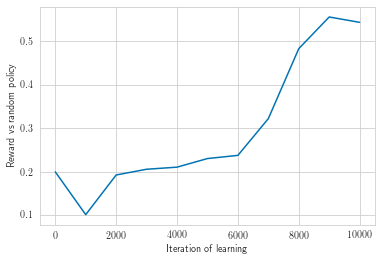

In [35]:
%%time
torch.manual_seed(1)
dqn = TicTacToeDQN(4, 4, 4)
quality = dqn.run(10000, vs_random=False)

Опять не очень красиво, и, похоже, можно было продолжать ещё учить, но эффект от обучения виден и на этом этапе.

Реализуйте Double DQN и/или Dueling DQN.

https://towardsdatascience.com/double-deep-q-networks-905dd8325412  
https://theaisummer.com/Taking_Deep_Q_Networks_a_step_further/  
https://www.freecodecamp.org/news/improvements-in-deep-q-learning-dueling-double-dqn-prioritized-experience-replay-and-fixed-58b130cc5682/  
https://en.wikipedia.org/wiki/Q-learning#Double_Q-learning  
https://medium.com/@leosimmons/double-dqn-implementation-to-solve-openai-gyms-cartpole-v-0-df554cd0614d  


Здесь ничего не придумывал, скопировал код для DQN и изменил функцию обучения. Реализован один из самых простых вариантов DoubleDQN (кажется, вариант реализации, представленный в первой публикации о DoubleDQN): веса второй модели подтягивают к первой жёстко, но не на каждой итерации. Позже были предложены более красивые реализации с мягким подтягиванием весов одной модели к другой, но я решил попробовать простой вариант, и он неплохо сработал, я его таким и оставил.

In [88]:
class TicTacToeDoubleDQN():
    def __init__(self, n_rows=3, n_cols=3, n_win=3):
        self.env = TicTacToe(n_rows, n_cols, n_win)
        self.models_x = [Network((n_rows, n_cols)), Network((n_rows, n_cols))]
        self.models_o = [Network((n_rows, n_cols)), Network((n_rows, n_cols))]
        self.memory_x = ReplayMemory(1000 * n_rows * n_cols)
        self.memory_o = ReplayMemory(1000 * n_rows * n_cols)
        learning_rate = 0.001
        self.optimizers_x = [optim.Adam(self.models_x[0].parameters(), learning_rate), 
                             optim.Adam(self.models_x[1].parameters(), learning_rate)]
        self.optimizers_o = [optim.Adam(self.models_o[0].parameters(), learning_rate), 
                             optim.Adam(self.models_o[1].parameters(), learning_rate)]
        
        self.gamma = 0.95
        self.batch_size = 64
        
        self.eps_init, self.eps_final, self.eps_decay = 0.95, 0.85, 200
        self.eps_threshold = self.eps_init
        self.eps_gen = None
        self.num_step = 0
        self.update_count = 0

    def select_greedy_action(self, model, state):
        with torch.no_grad():
            values = model(state.expand(1, 1, self.env.n_rows, self.env.n_cols))[0].tolist()
            available = [(i, v) for i, v in enumerate(values) if self.env.is_available_action_int(i)]
            best_available = list(filter(lambda x: x[1] == max(available, key=lambda x: x[1])[1], available))
            best_action = random.choice(best_available)[0]
            return torch.tensor([[best_action]])
    
    def select_random_action(self):
        return torch.tensor([[self.env.random_available_action_no()]], dtype=torch.int64)

    def select_action(self, model, state):
        with torch.no_grad():
            sample = random.random()
            self.num_step += 1
            if sample > self.eps_threshold:
                return self.select_greedy_action(model, state)
            else:
                return self.select_random_action()
    
    def state_to_tensor(self, env_state):
        state = list(map(int, env_state[0]))
        state_tensor = torch.tensor([state], dtype=torch.float32).reshape(self.env.n_rows, self.env.n_cols)
        # state_tensor = (state_tensor + 1.0) * self.env.curTurn
        return state_tensor
    
    def do_step(self, current_state_tensor, greedy=False, random_step=False, render=False):
        if self.env.curTurn == 1:
            model = self.models_x[0]
            if render: print("Ходят крестики:")
        else:
            model = self.models_o[0]
            if render: print("Ходят нолики:")
        if random_step:
            if render: print("Случайный ход")
            action = self.select_random_action()
        else:
            if greedy:
                if render: print("Жадная стратегия")
                action = self.select_greedy_action(model, current_state_tensor)
            else:
                if render: print("Почти жадная стратегия")
                action = self.select_action(model, current_state_tensor)
        new_state, reward, done, _ = self.env.step(self.env.action_from_int(action.numpy()[0][0]))
        if render:
            self.env.printBoard()
        return action, new_state, reward, done
        
    
    def run_episode(self, e=0, do_learning=True, greedy=False, render=False, vs_random=False, verbose=True, side="random"):
        self.models_x[0].train(False)
        self.models_x[1].train(False)
        self.models_o[0].train(False)
        self.models_o[1].train(False)
        
        state = self.env.reset()
        state_tensor = self.state_to_tensor(state)
        if render:
            self.env.printBoard()
        
        if do_learning:
            if self.eps_gen is None:
                self.eps_threshold = self.eps_final + (self.eps_init - self.eps_final) * math.exp(-1. * self.num_step / self.eps_decay)
            else:
                self.eps_threshold = next(self.eps_gen)
        
        reward_coef = 1.0
        if side == "o" or (side == "random" and random.random() > 0.5):
            if render:
                print("Играем за нолики")
            _, state, _, _ = self.do_step(state_tensor, greedy=True, random_step=vs_random, render=render)
            state_tensor = self.state_to_tensor(state)
            reward_coef = -reward_coef
        
        while True:
            action, next_state, reward, done = self.do_step(state_tensor, greedy=greedy, random_step=False, render=render)
            next_state_tensor = self.state_to_tensor(next_state)
            assert reward != -10
            reward *= reward_coef
            assert reward >= 0
                
            if not done:
                # Other player
                action_other, next_state, reward, done = self.do_step(next_state_tensor, greedy=True, random_step=vs_random, render=render)
                next_state_tensor = self.state_to_tensor(next_state)
                assert reward != -10
                reward *= reward_coef
                assert reward <= 0

            if do_learning:
                transition = (state_tensor, action, next_state_tensor, torch.tensor([reward], dtype=torch.float32))
                if reward_coef > 0:
                    self.memory_x.store(transition)
                else:
                    self.memory_o.store(transition)
            state = next_state
            state_tensor = self.state_to_tensor(state)
            
            if do_learning:
                self.learn()
            
            if done:
                if verbose: print("\tEpisode %d finished with reward %d. Current epsilon == %f." % (e, reward, self.eps_threshold))
                break
            
        return reward
                
    def run(self, n_episodes=10000, render=False, vs_random=False):
        if self.eps_gen is None:
            self.eps_gen = eps_generator(eps_start=self.eps_init, eps_min=self.eps_final, decay=(self.eps_final / self.eps_init)**(1/n_episodes))
        
        print("%s\tStarting training for %d episodes..." % (datetime.now().time(), n_episodes))
        quality = []
        quality.append(self.mean_reward_vs_random_policy(n_episodes))
        print(f"Current quality == {quality[-1]}")
        for e in range(n_episodes):
            self.run_episode(e, render=render, vs_random=vs_random)
            if (e + 1) % (n_episodes // 10) == 0:
                quality.append(self.mean_reward_vs_random_policy(n_episodes))
                print(f"Current quality == {quality[-1]}")
        print("%s\t\t...done!" % (datetime.now().time()))
        
        plt.plot(list(range(0, n_episodes + 1, n_episodes // 10)), quality)
        plt.ylabel("Reward vs random policy")
        plt.xlabel("Iteration of learning")
        
        return quality

    def update_target_network(self):
        self.update_count += 1
        if self.update_count % 5 == 0:
            self.models_x[1].load_state_dict(self.models_x[0].state_dict())
            self.models_x[1].load_state_dict(self.models_x[0].state_dict())
    
    def learn(self):
        if len(self.memory_x) < self.batch_size or len(self.memory_o) < self.batch_size:
            return

        self.models_x[0].train(True)
        self.models_x[1].train(True)
        self.models_o[0].train(True)
        self.models_o[1].train(True)
        
        x = (self.models_x, self.memory_x, self.optimizers_x)
        o = (self.models_o, self.memory_o, self.optimizers_o)
        
        for models, memory, optimizers in [x, o]:
            # берём мини-батч из памяти
            transitions = memory.sample(self.batch_size)
            batch_state, batch_action, batch_next_state, batch_reward = zip(*transitions)
            batch_state = Variable(torch.cat([state.expand(1, 1, self.env.n_rows, self.env.n_cols) for state in batch_state]))
            batch_action = Variable(torch.cat(batch_action))
            batch_reward = Variable(torch.cat(batch_reward))
            batch_next_state = Variable(torch.cat([state.expand(1, 1, self.env.n_rows, self.env.n_cols) for state in batch_next_state]))

            # считаем значения функции Q
            Q = models[0](batch_state).gather(1, batch_action).reshape([self.batch_size])

            # оцениваем ожидаемые значения после этого действия
            Qmax = models[0](batch_next_state).detach()[:, torch.argmax(models[1](batch_next_state).detach(), 1)][: ,0]
            Qnext = batch_reward + (self.gamma * Qmax)
            
            loss = F.smooth_l1_loss(Q, Qnext)
            optimizers[0].zero_grad()
            loss.backward()
            optimizers[0].step()
            
            self.update_target_network()

    def mean_reward_vs_random_policy(self, n_episodes=1000, side="x"):
        self.models_x[0].train(False)
        self.models_x[1].train(False)
        self.models_o[0].train(False)
        self.models_o[1].train(False)
        rewards = 0
        for i in range(n_episodes):
            rewards += self.run_episode(e=0, do_learning=False, greedy=True, render=False, vs_random=True, verbose=False, side=side)
        return rewards / n_episodes

20:29:17.306059	Starting training for 10000 episodes...
Current quality == -0.1703
	Episode 0 finished with reward 1. Current epsilon == 0.950000.
	Episode 1 finished with reward -1. Current epsilon == 0.949989.
	Episode 2 finished with reward 1. Current epsilon == 0.949979.
	Episode 3 finished with reward -1. Current epsilon == 0.949968.
	Episode 4 finished with reward 0. Current epsilon == 0.949958.
	Episode 5 finished with reward 1. Current epsilon == 0.949947.
	Episode 6 finished with reward 1. Current epsilon == 0.949937.
	Episode 7 finished with reward -1. Current epsilon == 0.949926.
	Episode 8 finished with reward 1. Current epsilon == 0.949915.
	Episode 9 finished with reward -1. Current epsilon == 0.949905.
	Episode 10 finished with reward -1. Current epsilon == 0.949894.
	Episode 11 finished with reward -1. Current epsilon == 0.949884.
	Episode 12 finished with reward 1. Current epsilon == 0.949873.
	Episode 13 finished with reward -1. Current epsilon == 0.949863.
	Episode 1

	Episode 125 finished with reward 1. Current epsilon == 0.948680.
	Episode 126 finished with reward -1. Current epsilon == 0.948670.
	Episode 127 finished with reward -1. Current epsilon == 0.948659.
	Episode 128 finished with reward -1. Current epsilon == 0.948648.
	Episode 129 finished with reward 1. Current epsilon == 0.948638.
	Episode 130 finished with reward 1. Current epsilon == 0.948627.
	Episode 131 finished with reward 1. Current epsilon == 0.948617.
	Episode 132 finished with reward 1. Current epsilon == 0.948606.
	Episode 133 finished with reward 1. Current epsilon == 0.948596.
	Episode 134 finished with reward 1. Current epsilon == 0.948585.
	Episode 135 finished with reward 0. Current epsilon == 0.948575.
	Episode 136 finished with reward -1. Current epsilon == 0.948564.
	Episode 137 finished with reward 1. Current epsilon == 0.948554.
	Episode 138 finished with reward 1. Current epsilon == 0.948543.
	Episode 139 finished with reward 1. Current epsilon == 0.948532.
	Episo

	Episode 252 finished with reward 1. Current epsilon == 0.947341.
	Episode 253 finished with reward 1. Current epsilon == 0.947330.
	Episode 254 finished with reward -1. Current epsilon == 0.947320.
	Episode 255 finished with reward -1. Current epsilon == 0.947309.
	Episode 256 finished with reward 0. Current epsilon == 0.947299.
	Episode 257 finished with reward -1. Current epsilon == 0.947288.
	Episode 258 finished with reward 1. Current epsilon == 0.947278.
	Episode 259 finished with reward 1. Current epsilon == 0.947267.
	Episode 260 finished with reward 1. Current epsilon == 0.947257.
	Episode 261 finished with reward -1. Current epsilon == 0.947246.
	Episode 262 finished with reward 1. Current epsilon == 0.947236.
	Episode 263 finished with reward 1. Current epsilon == 0.947225.
	Episode 264 finished with reward 1. Current epsilon == 0.947215.
	Episode 265 finished with reward 1. Current epsilon == 0.947204.
	Episode 266 finished with reward 1. Current epsilon == 0.947193.
	Episo

	Episode 377 finished with reward -1. Current epsilon == 0.946025.
	Episode 378 finished with reward 1. Current epsilon == 0.946014.
	Episode 379 finished with reward 1. Current epsilon == 0.946004.
	Episode 380 finished with reward 1. Current epsilon == 0.945993.
	Episode 381 finished with reward 1. Current epsilon == 0.945983.
	Episode 382 finished with reward -1. Current epsilon == 0.945972.
	Episode 383 finished with reward -1. Current epsilon == 0.945962.
	Episode 384 finished with reward -1. Current epsilon == 0.945951.
	Episode 385 finished with reward -1. Current epsilon == 0.945941.
	Episode 386 finished with reward -1. Current epsilon == 0.945930.
	Episode 387 finished with reward 1. Current epsilon == 0.945920.
	Episode 388 finished with reward 1. Current epsilon == 0.945909.
	Episode 389 finished with reward -1. Current epsilon == 0.945899.
	Episode 390 finished with reward -1. Current epsilon == 0.945888.
	Episode 391 finished with reward 1. Current epsilon == 0.945877.
	E

	Episode 504 finished with reward -1. Current epsilon == 0.944689.
	Episode 505 finished with reward -1. Current epsilon == 0.944679.
	Episode 506 finished with reward 1. Current epsilon == 0.944668.
	Episode 507 finished with reward -1. Current epsilon == 0.944658.
	Episode 508 finished with reward 1. Current epsilon == 0.944647.
	Episode 509 finished with reward -1. Current epsilon == 0.944637.
	Episode 510 finished with reward -1. Current epsilon == 0.944626.
	Episode 511 finished with reward 1. Current epsilon == 0.944616.
	Episode 512 finished with reward -1. Current epsilon == 0.944605.
	Episode 513 finished with reward 1. Current epsilon == 0.944595.
	Episode 514 finished with reward 1. Current epsilon == 0.944584.
	Episode 515 finished with reward -1. Current epsilon == 0.944574.
	Episode 516 finished with reward -1. Current epsilon == 0.944563.
	Episode 517 finished with reward -1. Current epsilon == 0.944553.
	Episode 518 finished with reward 1. Current epsilon == 0.944542.
	

	Episode 635 finished with reward 1. Current epsilon == 0.943314.
	Episode 636 finished with reward -1. Current epsilon == 0.943303.
	Episode 637 finished with reward -1. Current epsilon == 0.943293.
	Episode 638 finished with reward 1. Current epsilon == 0.943282.
	Episode 639 finished with reward -1. Current epsilon == 0.943272.
	Episode 640 finished with reward -1. Current epsilon == 0.943261.
	Episode 641 finished with reward 1. Current epsilon == 0.943251.
	Episode 642 finished with reward -1. Current epsilon == 0.943241.
	Episode 643 finished with reward -1. Current epsilon == 0.943230.
	Episode 644 finished with reward -1. Current epsilon == 0.943220.
	Episode 645 finished with reward -1. Current epsilon == 0.943209.
	Episode 646 finished with reward -1. Current epsilon == 0.943199.
	Episode 647 finished with reward -1. Current epsilon == 0.943188.
	Episode 648 finished with reward -1. Current epsilon == 0.943178.
	Episode 649 finished with reward 1. Current epsilon == 0.943167.

	Episode 761 finished with reward 0. Current epsilon == 0.941993.
	Episode 762 finished with reward -1. Current epsilon == 0.941982.
	Episode 763 finished with reward -1. Current epsilon == 0.941972.
	Episode 764 finished with reward 1. Current epsilon == 0.941961.
	Episode 765 finished with reward 0. Current epsilon == 0.941951.
	Episode 766 finished with reward -1. Current epsilon == 0.941940.
	Episode 767 finished with reward -1. Current epsilon == 0.941930.
	Episode 768 finished with reward -1. Current epsilon == 0.941920.
	Episode 769 finished with reward 1. Current epsilon == 0.941909.
	Episode 770 finished with reward -1. Current epsilon == 0.941899.
	Episode 771 finished with reward -1. Current epsilon == 0.941888.
	Episode 772 finished with reward 1. Current epsilon == 0.941878.
	Episode 773 finished with reward 1. Current epsilon == 0.941867.
	Episode 774 finished with reward 0. Current epsilon == 0.941857.
	Episode 775 finished with reward 1. Current epsilon == 0.941846.
	Ep

	Episode 887 finished with reward -1. Current epsilon == 0.940674.
	Episode 888 finished with reward -1. Current epsilon == 0.940663.
	Episode 889 finished with reward 1. Current epsilon == 0.940653.
	Episode 890 finished with reward -1. Current epsilon == 0.940642.
	Episode 891 finished with reward 1. Current epsilon == 0.940632.
	Episode 892 finished with reward 1. Current epsilon == 0.940621.
	Episode 893 finished with reward 1. Current epsilon == 0.940611.
	Episode 894 finished with reward 1. Current epsilon == 0.940600.
	Episode 895 finished with reward 1. Current epsilon == 0.940590.
	Episode 896 finished with reward 1. Current epsilon == 0.940579.
	Episode 897 finished with reward 0. Current epsilon == 0.940569.
	Episode 898 finished with reward -1. Current epsilon == 0.940559.
	Episode 899 finished with reward 0. Current epsilon == 0.940548.
	Episode 900 finished with reward 1. Current epsilon == 0.940538.
	Episode 901 finished with reward 1. Current epsilon == 0.940527.
	Episo

	Episode 1015 finished with reward -1. Current epsilon == 0.939335.
	Episode 1016 finished with reward -1. Current epsilon == 0.939325.
	Episode 1017 finished with reward -1. Current epsilon == 0.939314.
	Episode 1018 finished with reward 1. Current epsilon == 0.939304.
	Episode 1019 finished with reward 1. Current epsilon == 0.939294.
	Episode 1020 finished with reward -1. Current epsilon == 0.939283.
	Episode 1021 finished with reward -1. Current epsilon == 0.939273.
	Episode 1022 finished with reward -1. Current epsilon == 0.939262.
	Episode 1023 finished with reward -1. Current epsilon == 0.939252.
	Episode 1024 finished with reward -1. Current epsilon == 0.939241.
	Episode 1025 finished with reward -1. Current epsilon == 0.939231.
	Episode 1026 finished with reward 1. Current epsilon == 0.939220.
	Episode 1027 finished with reward -1. Current epsilon == 0.939210.
	Episode 1028 finished with reward 1. Current epsilon == 0.939200.
	Episode 1029 finished with reward -1. Current epsil

	Episode 1139 finished with reward -1. Current epsilon == 0.938041.
	Episode 1140 finished with reward -1. Current epsilon == 0.938030.
	Episode 1141 finished with reward -1. Current epsilon == 0.938020.
	Episode 1142 finished with reward 1. Current epsilon == 0.938009.
	Episode 1143 finished with reward 1. Current epsilon == 0.937999.
	Episode 1144 finished with reward -1. Current epsilon == 0.937989.
	Episode 1145 finished with reward 1. Current epsilon == 0.937978.
	Episode 1146 finished with reward -1. Current epsilon == 0.937968.
	Episode 1147 finished with reward -1. Current epsilon == 0.937957.
	Episode 1148 finished with reward 1. Current epsilon == 0.937947.
	Episode 1149 finished with reward -1. Current epsilon == 0.937936.
	Episode 1150 finished with reward -1. Current epsilon == 0.937926.
	Episode 1151 finished with reward -1. Current epsilon == 0.937916.
	Episode 1152 finished with reward 1. Current epsilon == 0.937905.
	Episode 1153 finished with reward -1. Current epsilo

	Episode 1262 finished with reward 0. Current epsilon == 0.936758.
	Episode 1263 finished with reward 1. Current epsilon == 0.936748.
	Episode 1264 finished with reward -1. Current epsilon == 0.936737.
	Episode 1265 finished with reward -1. Current epsilon == 0.936727.
	Episode 1266 finished with reward -1. Current epsilon == 0.936717.
	Episode 1267 finished with reward 1. Current epsilon == 0.936706.
	Episode 1268 finished with reward 1. Current epsilon == 0.936696.
	Episode 1269 finished with reward -1. Current epsilon == 0.936685.
	Episode 1270 finished with reward -1. Current epsilon == 0.936675.
	Episode 1271 finished with reward -1. Current epsilon == 0.936665.
	Episode 1272 finished with reward -1. Current epsilon == 0.936654.
	Episode 1273 finished with reward -1. Current epsilon == 0.936644.
	Episode 1274 finished with reward 1. Current epsilon == 0.936633.
	Episode 1275 finished with reward 1. Current epsilon == 0.936623.
	Episode 1276 finished with reward -1. Current epsilon

	Episode 1387 finished with reward -1. Current epsilon == 0.935457.
	Episode 1388 finished with reward 1. Current epsilon == 0.935446.
	Episode 1389 finished with reward -1. Current epsilon == 0.935436.
	Episode 1390 finished with reward -1. Current epsilon == 0.935426.
	Episode 1391 finished with reward -1. Current epsilon == 0.935415.
	Episode 1392 finished with reward 1. Current epsilon == 0.935405.
	Episode 1393 finished with reward -1. Current epsilon == 0.935394.
	Episode 1394 finished with reward 1. Current epsilon == 0.935384.
	Episode 1395 finished with reward -1. Current epsilon == 0.935374.
	Episode 1396 finished with reward 1. Current epsilon == 0.935363.
	Episode 1397 finished with reward 1. Current epsilon == 0.935353.
	Episode 1398 finished with reward -1. Current epsilon == 0.935342.
	Episode 1399 finished with reward -1. Current epsilon == 0.935332.
	Episode 1400 finished with reward -1. Current epsilon == 0.935322.
	Episode 1401 finished with reward 1. Current epsilon

	Episode 1510 finished with reward 0. Current epsilon == 0.934178.
	Episode 1511 finished with reward -1. Current epsilon == 0.934168.
	Episode 1512 finished with reward 1. Current epsilon == 0.934157.
	Episode 1513 finished with reward 1. Current epsilon == 0.934147.
	Episode 1514 finished with reward 1. Current epsilon == 0.934136.
	Episode 1515 finished with reward -1. Current epsilon == 0.934126.
	Episode 1516 finished with reward 1. Current epsilon == 0.934116.
	Episode 1517 finished with reward -1. Current epsilon == 0.934105.
	Episode 1518 finished with reward -1. Current epsilon == 0.934095.
	Episode 1519 finished with reward 1. Current epsilon == 0.934084.
	Episode 1520 finished with reward -1. Current epsilon == 0.934074.
	Episode 1521 finished with reward -1. Current epsilon == 0.934064.
	Episode 1522 finished with reward 1. Current epsilon == 0.934053.
	Episode 1523 finished with reward 1. Current epsilon == 0.934043.
	Episode 1524 finished with reward 1. Current epsilon ==

	Episode 1639 finished with reward -1. Current epsilon == 0.932839.
	Episode 1640 finished with reward 1. Current epsilon == 0.932828.
	Episode 1641 finished with reward 1. Current epsilon == 0.932818.
	Episode 1642 finished with reward -1. Current epsilon == 0.932807.
	Episode 1643 finished with reward 1. Current epsilon == 0.932797.
	Episode 1644 finished with reward -1. Current epsilon == 0.932787.
	Episode 1645 finished with reward 1. Current epsilon == 0.932776.
	Episode 1646 finished with reward -1. Current epsilon == 0.932766.
	Episode 1647 finished with reward 0. Current epsilon == 0.932756.
	Episode 1648 finished with reward -1. Current epsilon == 0.932745.
	Episode 1649 finished with reward 1. Current epsilon == 0.932735.
	Episode 1650 finished with reward 0. Current epsilon == 0.932724.
	Episode 1651 finished with reward 0. Current epsilon == 0.932714.
	Episode 1652 finished with reward -1. Current epsilon == 0.932704.
	Episode 1653 finished with reward 0. Current epsilon ==

	Episode 1765 finished with reward -1. Current epsilon == 0.931532.
	Episode 1766 finished with reward 0. Current epsilon == 0.931522.
	Episode 1767 finished with reward -1. Current epsilon == 0.931511.
	Episode 1768 finished with reward -1. Current epsilon == 0.931501.
	Episode 1769 finished with reward -1. Current epsilon == 0.931491.
	Episode 1770 finished with reward 1. Current epsilon == 0.931480.
	Episode 1771 finished with reward -1. Current epsilon == 0.931470.
	Episode 1772 finished with reward -1. Current epsilon == 0.931460.
	Episode 1773 finished with reward -1. Current epsilon == 0.931449.
	Episode 1774 finished with reward 0. Current epsilon == 0.931439.
	Episode 1775 finished with reward 1. Current epsilon == 0.931429.
	Episode 1776 finished with reward 1. Current epsilon == 0.931418.
	Episode 1777 finished with reward 1. Current epsilon == 0.931408.
	Episode 1778 finished with reward 1. Current epsilon == 0.931397.
	Episode 1779 finished with reward 0. Current epsilon =

	Episode 1887 finished with reward 0. Current epsilon == 0.930269.
	Episode 1888 finished with reward -1. Current epsilon == 0.930259.
	Episode 1889 finished with reward 1. Current epsilon == 0.930248.
	Episode 1890 finished with reward -1. Current epsilon == 0.930238.
	Episode 1891 finished with reward -1. Current epsilon == 0.930228.
	Episode 1892 finished with reward 1. Current epsilon == 0.930217.
	Episode 1893 finished with reward 1. Current epsilon == 0.930207.
	Episode 1894 finished with reward 1. Current epsilon == 0.930196.
	Episode 1895 finished with reward 1. Current epsilon == 0.930186.
	Episode 1896 finished with reward 1. Current epsilon == 0.930176.
	Episode 1897 finished with reward 1. Current epsilon == 0.930165.
	Episode 1898 finished with reward 1. Current epsilon == 0.930155.
	Episode 1899 finished with reward 1. Current epsilon == 0.930145.
	Episode 1900 finished with reward -1. Current epsilon == 0.930134.
	Episode 1901 finished with reward -1. Current epsilon == 

	Episode 2008 finished with reward -1. Current epsilon == 0.929018.
	Episode 2009 finished with reward -1. Current epsilon == 0.929007.
	Episode 2010 finished with reward -1. Current epsilon == 0.928997.
	Episode 2011 finished with reward -1. Current epsilon == 0.928987.
	Episode 2012 finished with reward -1. Current epsilon == 0.928976.
	Episode 2013 finished with reward -1. Current epsilon == 0.928966.
	Episode 2014 finished with reward 1. Current epsilon == 0.928956.
	Episode 2015 finished with reward -1. Current epsilon == 0.928945.
	Episode 2016 finished with reward 1. Current epsilon == 0.928935.
	Episode 2017 finished with reward -1. Current epsilon == 0.928925.
	Episode 2018 finished with reward 1. Current epsilon == 0.928914.
	Episode 2019 finished with reward 1. Current epsilon == 0.928904.
	Episode 2020 finished with reward 0. Current epsilon == 0.928894.
	Episode 2021 finished with reward 0. Current epsilon == 0.928883.
	Episode 2022 finished with reward 1. Current epsilon 

	Episode 2134 finished with reward -1. Current epsilon == 0.927717.
	Episode 2135 finished with reward 1. Current epsilon == 0.927706.
	Episode 2136 finished with reward -1. Current epsilon == 0.927696.
	Episode 2137 finished with reward -1. Current epsilon == 0.927686.
	Episode 2138 finished with reward 1. Current epsilon == 0.927675.
	Episode 2139 finished with reward -1. Current epsilon == 0.927665.
	Episode 2140 finished with reward -1. Current epsilon == 0.927655.
	Episode 2141 finished with reward 1. Current epsilon == 0.927644.
	Episode 2142 finished with reward 1. Current epsilon == 0.927634.
	Episode 2143 finished with reward 1. Current epsilon == 0.927624.
	Episode 2144 finished with reward -1. Current epsilon == 0.927614.
	Episode 2145 finished with reward 1. Current epsilon == 0.927603.
	Episode 2146 finished with reward 0. Current epsilon == 0.927593.
	Episode 2147 finished with reward -1. Current epsilon == 0.927583.
	Episode 2148 finished with reward -1. Current epsilon 

	Episode 2258 finished with reward 1. Current epsilon == 0.926438.
	Episode 2259 finished with reward -1. Current epsilon == 0.926428.
	Episode 2260 finished with reward 1. Current epsilon == 0.926417.
	Episode 2261 finished with reward 1. Current epsilon == 0.926407.
	Episode 2262 finished with reward -1. Current epsilon == 0.926397.
	Episode 2263 finished with reward 1. Current epsilon == 0.926387.
	Episode 2264 finished with reward 1. Current epsilon == 0.926376.
	Episode 2265 finished with reward 1. Current epsilon == 0.926366.
	Episode 2266 finished with reward 1. Current epsilon == 0.926356.
	Episode 2267 finished with reward -1. Current epsilon == 0.926345.
	Episode 2268 finished with reward 0. Current epsilon == 0.926335.
	Episode 2269 finished with reward -1. Current epsilon == 0.926325.
	Episode 2270 finished with reward -1. Current epsilon == 0.926314.
	Episode 2271 finished with reward 1. Current epsilon == 0.926304.
	Episode 2272 finished with reward -1. Current epsilon ==

	Episode 2384 finished with reward -1. Current epsilon == 0.925141.
	Episode 2385 finished with reward -1. Current epsilon == 0.925130.
	Episode 2386 finished with reward -1. Current epsilon == 0.925120.
	Episode 2387 finished with reward -1. Current epsilon == 0.925110.
	Episode 2388 finished with reward -1. Current epsilon == 0.925100.
	Episode 2389 finished with reward 1. Current epsilon == 0.925089.
	Episode 2390 finished with reward 1. Current epsilon == 0.925079.
	Episode 2391 finished with reward -1. Current epsilon == 0.925069.
	Episode 2392 finished with reward -1. Current epsilon == 0.925058.
	Episode 2393 finished with reward -1. Current epsilon == 0.925048.
	Episode 2394 finished with reward 1. Current epsilon == 0.925038.
	Episode 2395 finished with reward -1. Current epsilon == 0.925027.
	Episode 2396 finished with reward -1. Current epsilon == 0.925017.
	Episode 2397 finished with reward -1. Current epsilon == 0.925007.
	Episode 2398 finished with reward -1. Current epsi

	Episode 2509 finished with reward 1. Current epsilon == 0.923855.
	Episode 2510 finished with reward -1. Current epsilon == 0.923845.
	Episode 2511 finished with reward -1. Current epsilon == 0.923835.
	Episode 2512 finished with reward -1. Current epsilon == 0.923824.
	Episode 2513 finished with reward 1. Current epsilon == 0.923814.
	Episode 2514 finished with reward 0. Current epsilon == 0.923804.
	Episode 2515 finished with reward 1. Current epsilon == 0.923794.
	Episode 2516 finished with reward 1. Current epsilon == 0.923783.
	Episode 2517 finished with reward 1. Current epsilon == 0.923773.
	Episode 2518 finished with reward -1. Current epsilon == 0.923763.
	Episode 2519 finished with reward -1. Current epsilon == 0.923753.
	Episode 2520 finished with reward -1. Current epsilon == 0.923742.
	Episode 2521 finished with reward 1. Current epsilon == 0.923732.
	Episode 2522 finished with reward -1. Current epsilon == 0.923722.
	Episode 2523 finished with reward -1. Current epsilon 

	Episode 2634 finished with reward -1. Current epsilon == 0.922572.
	Episode 2635 finished with reward 1. Current epsilon == 0.922561.
	Episode 2636 finished with reward 1. Current epsilon == 0.922551.
	Episode 2637 finished with reward -1. Current epsilon == 0.922541.
	Episode 2638 finished with reward -1. Current epsilon == 0.922531.
	Episode 2639 finished with reward -1. Current epsilon == 0.922520.
	Episode 2640 finished with reward -1. Current epsilon == 0.922510.
	Episode 2641 finished with reward -1. Current epsilon == 0.922500.
	Episode 2642 finished with reward 0. Current epsilon == 0.922490.
	Episode 2643 finished with reward -1. Current epsilon == 0.922479.
	Episode 2644 finished with reward -1. Current epsilon == 0.922469.
	Episode 2645 finished with reward -1. Current epsilon == 0.922459.
	Episode 2646 finished with reward -1. Current epsilon == 0.922449.
	Episode 2647 finished with reward -1. Current epsilon == 0.922438.
	Episode 2648 finished with reward 1. Current epsil

	Episode 2757 finished with reward 1. Current epsilon == 0.921310.
	Episode 2758 finished with reward -1. Current epsilon == 0.921300.
	Episode 2759 finished with reward -1. Current epsilon == 0.921290.
	Episode 2760 finished with reward -1. Current epsilon == 0.921280.
	Episode 2761 finished with reward 1. Current epsilon == 0.921269.
	Episode 2762 finished with reward -1. Current epsilon == 0.921259.
	Episode 2763 finished with reward -1. Current epsilon == 0.921249.
	Episode 2764 finished with reward -1. Current epsilon == 0.921239.
	Episode 2765 finished with reward 1. Current epsilon == 0.921228.
	Episode 2766 finished with reward -1. Current epsilon == 0.921218.
	Episode 2767 finished with reward 1. Current epsilon == 0.921208.
	Episode 2768 finished with reward -1. Current epsilon == 0.921198.
	Episode 2769 finished with reward 1. Current epsilon == 0.921188.
	Episode 2770 finished with reward 1. Current epsilon == 0.921177.
	Episode 2771 finished with reward -1. Current epsilon

	Episode 2884 finished with reward -1. Current epsilon == 0.920010.
	Episode 2885 finished with reward -1. Current epsilon == 0.920000.
	Episode 2886 finished with reward 1. Current epsilon == 0.919990.
	Episode 2887 finished with reward -1. Current epsilon == 0.919979.
	Episode 2888 finished with reward -1. Current epsilon == 0.919969.
	Episode 2889 finished with reward 1. Current epsilon == 0.919959.
	Episode 2890 finished with reward -1. Current epsilon == 0.919949.
	Episode 2891 finished with reward -1. Current epsilon == 0.919938.
	Episode 2892 finished with reward 1. Current epsilon == 0.919928.
	Episode 2893 finished with reward -1. Current epsilon == 0.919918.
	Episode 2894 finished with reward 1. Current epsilon == 0.919908.
	Episode 2895 finished with reward 1. Current epsilon == 0.919897.
	Episode 2896 finished with reward -1. Current epsilon == 0.919887.
	Episode 2897 finished with reward -1. Current epsilon == 0.919877.
	Episode 2898 finished with reward -1. Current epsilo

	Episode 3008 finished with reward -1. Current epsilon == 0.918742.
	Episode 3009 finished with reward -1. Current epsilon == 0.918732.
	Episode 3010 finished with reward -1. Current epsilon == 0.918722.
	Episode 3011 finished with reward -1. Current epsilon == 0.918711.
	Episode 3012 finished with reward -1. Current epsilon == 0.918701.
	Episode 3013 finished with reward 1. Current epsilon == 0.918691.
	Episode 3014 finished with reward -1. Current epsilon == 0.918681.
	Episode 3015 finished with reward -1. Current epsilon == 0.918670.
	Episode 3016 finished with reward 1. Current epsilon == 0.918660.
	Episode 3017 finished with reward -1. Current epsilon == 0.918650.
	Episode 3018 finished with reward 0. Current epsilon == 0.918640.
	Episode 3019 finished with reward 1. Current epsilon == 0.918630.
	Episode 3020 finished with reward -1. Current epsilon == 0.918619.
	Episode 3021 finished with reward 1. Current epsilon == 0.918609.
	Episode 3022 finished with reward -1. Current epsilo

	Episode 3131 finished with reward 1. Current epsilon == 0.917486.
	Episode 3132 finished with reward 1. Current epsilon == 0.917476.
	Episode 3133 finished with reward -1. Current epsilon == 0.917466.
	Episode 3134 finished with reward 1. Current epsilon == 0.917455.
	Episode 3135 finished with reward -1. Current epsilon == 0.917445.
	Episode 3136 finished with reward -1. Current epsilon == 0.917435.
	Episode 3137 finished with reward -1. Current epsilon == 0.917425.
	Episode 3138 finished with reward -1. Current epsilon == 0.917414.
	Episode 3139 finished with reward -1. Current epsilon == 0.917404.
	Episode 3140 finished with reward 1. Current epsilon == 0.917394.
	Episode 3141 finished with reward -1. Current epsilon == 0.917384.
	Episode 3142 finished with reward -1. Current epsilon == 0.917374.
	Episode 3143 finished with reward -1. Current epsilon == 0.917363.
	Episode 3144 finished with reward 1. Current epsilon == 0.917353.
	Episode 3145 finished with reward 1. Current epsilon

	Episode 3255 finished with reward 1. Current epsilon == 0.916221.
	Episode 3256 finished with reward 1. Current epsilon == 0.916211.
	Episode 3257 finished with reward -1. Current epsilon == 0.916201.
	Episode 3258 finished with reward 1. Current epsilon == 0.916191.
	Episode 3259 finished with reward -1. Current epsilon == 0.916181.
	Episode 3260 finished with reward 1. Current epsilon == 0.916170.
	Episode 3261 finished with reward 1. Current epsilon == 0.916160.
	Episode 3262 finished with reward -1. Current epsilon == 0.916150.
	Episode 3263 finished with reward 1. Current epsilon == 0.916140.
	Episode 3264 finished with reward -1. Current epsilon == 0.916130.
	Episode 3265 finished with reward -1. Current epsilon == 0.916120.
	Episode 3266 finished with reward 1. Current epsilon == 0.916109.
	Episode 3267 finished with reward 0. Current epsilon == 0.916099.
	Episode 3268 finished with reward 1. Current epsilon == 0.916089.
	Episode 3269 finished with reward -1. Current epsilon ==

	Episode 3377 finished with reward 1. Current epsilon == 0.914979.
	Episode 3378 finished with reward 1. Current epsilon == 0.914969.
	Episode 3379 finished with reward 1. Current epsilon == 0.914959.
	Episode 3380 finished with reward -1. Current epsilon == 0.914948.
	Episode 3381 finished with reward 1. Current epsilon == 0.914938.
	Episode 3382 finished with reward 1. Current epsilon == 0.914928.
	Episode 3383 finished with reward -1. Current epsilon == 0.914918.
	Episode 3384 finished with reward -1. Current epsilon == 0.914908.
	Episode 3385 finished with reward -1. Current epsilon == 0.914898.
	Episode 3386 finished with reward -1. Current epsilon == 0.914887.
	Episode 3387 finished with reward -1. Current epsilon == 0.914877.
	Episode 3388 finished with reward 1. Current epsilon == 0.914867.
	Episode 3389 finished with reward 1. Current epsilon == 0.914857.
	Episode 3390 finished with reward -1. Current epsilon == 0.914847.
	Episode 3391 finished with reward -1. Current epsilon 

	Episode 3504 finished with reward 1. Current epsilon == 0.913687.
	Episode 3505 finished with reward 1. Current epsilon == 0.913677.
	Episode 3506 finished with reward 1. Current epsilon == 0.913667.
	Episode 3507 finished with reward 1. Current epsilon == 0.913657.
	Episode 3508 finished with reward -1. Current epsilon == 0.913647.
	Episode 3509 finished with reward 1. Current epsilon == 0.913637.
	Episode 3510 finished with reward 1. Current epsilon == 0.913626.
	Episode 3511 finished with reward 1. Current epsilon == 0.913616.
	Episode 3512 finished with reward 1. Current epsilon == 0.913606.
	Episode 3513 finished with reward 1. Current epsilon == 0.913596.
	Episode 3514 finished with reward 1. Current epsilon == 0.913586.
	Episode 3515 finished with reward -1. Current epsilon == 0.913576.
	Episode 3516 finished with reward 1. Current epsilon == 0.913565.
	Episode 3517 finished with reward -1. Current epsilon == 0.913555.
	Episode 3518 finished with reward 1. Current epsilon == 0.

	Episode 3633 finished with reward 1. Current epsilon == 0.912377.
	Episode 3634 finished with reward -1. Current epsilon == 0.912367.
	Episode 3635 finished with reward 1. Current epsilon == 0.912357.
	Episode 3636 finished with reward 1. Current epsilon == 0.912347.
	Episode 3637 finished with reward -1. Current epsilon == 0.912337.
	Episode 3638 finished with reward 1. Current epsilon == 0.912327.
	Episode 3639 finished with reward -1. Current epsilon == 0.912317.
	Episode 3640 finished with reward 0. Current epsilon == 0.912306.
	Episode 3641 finished with reward 1. Current epsilon == 0.912296.
	Episode 3642 finished with reward -1. Current epsilon == 0.912286.
	Episode 3643 finished with reward -1. Current epsilon == 0.912276.
	Episode 3644 finished with reward 1. Current epsilon == 0.912266.
	Episode 3645 finished with reward -1. Current epsilon == 0.912256.
	Episode 3646 finished with reward -1. Current epsilon == 0.912245.
	Episode 3647 finished with reward -1. Current epsilon 

	Episode 3756 finished with reward 1. Current epsilon == 0.911130.
	Episode 3757 finished with reward -1. Current epsilon == 0.911120.
	Episode 3758 finished with reward -1. Current epsilon == 0.911110.
	Episode 3759 finished with reward -1. Current epsilon == 0.911100.
	Episode 3760 finished with reward -1. Current epsilon == 0.911090.
	Episode 3761 finished with reward -1. Current epsilon == 0.911079.
	Episode 3762 finished with reward 1. Current epsilon == 0.911069.
	Episode 3763 finished with reward 1. Current epsilon == 0.911059.
	Episode 3764 finished with reward -1. Current epsilon == 0.911049.
	Episode 3765 finished with reward -1. Current epsilon == 0.911039.
	Episode 3766 finished with reward -1. Current epsilon == 0.911029.
	Episode 3767 finished with reward -1. Current epsilon == 0.911019.
	Episode 3768 finished with reward -1. Current epsilon == 0.911008.
	Episode 3769 finished with reward 0. Current epsilon == 0.910998.
	Episode 3770 finished with reward 1. Current epsilo

	Episode 3884 finished with reward 1. Current epsilon == 0.909834.
	Episode 3885 finished with reward 0. Current epsilon == 0.909824.
	Episode 3886 finished with reward 1. Current epsilon == 0.909814.
	Episode 3887 finished with reward -1. Current epsilon == 0.909803.
	Episode 3888 finished with reward -1. Current epsilon == 0.909793.
	Episode 3889 finished with reward -1. Current epsilon == 0.909783.
	Episode 3890 finished with reward -1. Current epsilon == 0.909773.
	Episode 3891 finished with reward -1. Current epsilon == 0.909763.
	Episode 3892 finished with reward 1. Current epsilon == 0.909753.
	Episode 3893 finished with reward 1. Current epsilon == 0.909743.
	Episode 3894 finished with reward 0. Current epsilon == 0.909733.
	Episode 3895 finished with reward -1. Current epsilon == 0.909722.
	Episode 3896 finished with reward 1. Current epsilon == 0.909712.
	Episode 3897 finished with reward -1. Current epsilon == 0.909702.
	Episode 3898 finished with reward -1. Current epsilon 

	Episode 4005 finished with reward -1. Current epsilon == 0.908610.
	Episode 4006 finished with reward -1. Current epsilon == 0.908600.
	Episode 4007 finished with reward -1. Current epsilon == 0.908590.
	Episode 4008 finished with reward -1. Current epsilon == 0.908580.
	Episode 4009 finished with reward 0. Current epsilon == 0.908570.
	Episode 4010 finished with reward -1. Current epsilon == 0.908560.
	Episode 4011 finished with reward 1. Current epsilon == 0.908550.
	Episode 4012 finished with reward -1. Current epsilon == 0.908539.
	Episode 4013 finished with reward 1. Current epsilon == 0.908529.
	Episode 4014 finished with reward -1. Current epsilon == 0.908519.
	Episode 4015 finished with reward -1. Current epsilon == 0.908509.
	Episode 4016 finished with reward 1. Current epsilon == 0.908499.
	Episode 4017 finished with reward 1. Current epsilon == 0.908489.
	Episode 4018 finished with reward -1. Current epsilon == 0.908479.
	Episode 4019 finished with reward 1. Current epsilon

	Episode 4127 finished with reward -1. Current epsilon == 0.907378.
	Episode 4128 finished with reward -1. Current epsilon == 0.907368.
	Episode 4129 finished with reward -1. Current epsilon == 0.907358.
	Episode 4130 finished with reward 1. Current epsilon == 0.907348.
	Episode 4131 finished with reward 1. Current epsilon == 0.907338.
	Episode 4132 finished with reward 1. Current epsilon == 0.907328.
	Episode 4133 finished with reward -1. Current epsilon == 0.907317.
	Episode 4134 finished with reward -1. Current epsilon == 0.907307.
	Episode 4135 finished with reward 1. Current epsilon == 0.907297.
	Episode 4136 finished with reward -1. Current epsilon == 0.907287.
	Episode 4137 finished with reward 1. Current epsilon == 0.907277.
	Episode 4138 finished with reward 1. Current epsilon == 0.907267.
	Episode 4139 finished with reward 1. Current epsilon == 0.907257.
	Episode 4140 finished with reward 1. Current epsilon == 0.907247.
	Episode 4141 finished with reward -1. Current epsilon =

	Episode 4255 finished with reward 1. Current epsilon == 0.906087.
	Episode 4256 finished with reward 1. Current epsilon == 0.906077.
	Episode 4257 finished with reward -1. Current epsilon == 0.906067.
	Episode 4258 finished with reward 1. Current epsilon == 0.906057.
	Episode 4259 finished with reward -1. Current epsilon == 0.906047.
	Episode 4260 finished with reward -1. Current epsilon == 0.906037.
	Episode 4261 finished with reward 1. Current epsilon == 0.906027.
	Episode 4262 finished with reward -1. Current epsilon == 0.906017.
	Episode 4263 finished with reward 1. Current epsilon == 0.906007.
	Episode 4264 finished with reward 1. Current epsilon == 0.905996.
	Episode 4265 finished with reward 1. Current epsilon == 0.905986.
	Episode 4266 finished with reward 1. Current epsilon == 0.905976.
	Episode 4267 finished with reward -1. Current epsilon == 0.905966.
	Episode 4268 finished with reward 1. Current epsilon == 0.905956.
	Episode 4269 finished with reward -1. Current epsilon ==

	Episode 4377 finished with reward -1. Current epsilon == 0.904858.
	Episode 4378 finished with reward 1. Current epsilon == 0.904848.
	Episode 4379 finished with reward -1. Current epsilon == 0.904838.
	Episode 4380 finished with reward -1. Current epsilon == 0.904828.
	Episode 4381 finished with reward -1. Current epsilon == 0.904818.
	Episode 4382 finished with reward 1. Current epsilon == 0.904808.
	Episode 4383 finished with reward -1. Current epsilon == 0.904798.
	Episode 4384 finished with reward 0. Current epsilon == 0.904788.
	Episode 4385 finished with reward -1. Current epsilon == 0.904778.
	Episode 4386 finished with reward 1. Current epsilon == 0.904768.
	Episode 4387 finished with reward -1. Current epsilon == 0.904758.
	Episode 4388 finished with reward -1. Current epsilon == 0.904748.
	Episode 4389 finished with reward -1. Current epsilon == 0.904738.
	Episode 4390 finished with reward -1. Current epsilon == 0.904728.
	Episode 4391 finished with reward -1. Current epsil

	Episode 4499 finished with reward -1. Current epsilon == 0.903631.
	Episode 4500 finished with reward -1. Current epsilon == 0.903621.
	Episode 4501 finished with reward 0. Current epsilon == 0.903611.
	Episode 4502 finished with reward -1. Current epsilon == 0.903601.
	Episode 4503 finished with reward 1. Current epsilon == 0.903591.
	Episode 4504 finished with reward -1. Current epsilon == 0.903581.
	Episode 4505 finished with reward -1. Current epsilon == 0.903571.
	Episode 4506 finished with reward -1. Current epsilon == 0.903561.
	Episode 4507 finished with reward -1. Current epsilon == 0.903551.
	Episode 4508 finished with reward -1. Current epsilon == 0.903541.
	Episode 4509 finished with reward -1. Current epsilon == 0.903531.
	Episode 4510 finished with reward -1. Current epsilon == 0.903521.
	Episode 4511 finished with reward 1. Current epsilon == 0.903511.
	Episode 4512 finished with reward -1. Current epsilon == 0.903501.
	Episode 4513 finished with reward -1. Current epsi

	Episode 4622 finished with reward 1. Current epsilon == 0.902396.
	Episode 4623 finished with reward -1. Current epsilon == 0.902386.
	Episode 4624 finished with reward -1. Current epsilon == 0.902376.
	Episode 4625 finished with reward -1. Current epsilon == 0.902366.
	Episode 4626 finished with reward 1. Current epsilon == 0.902356.
	Episode 4627 finished with reward -1. Current epsilon == 0.902346.
	Episode 4628 finished with reward -1. Current epsilon == 0.902336.
	Episode 4629 finished with reward -1. Current epsilon == 0.902326.
	Episode 4630 finished with reward 1. Current epsilon == 0.902316.
	Episode 4631 finished with reward 0. Current epsilon == 0.902306.
	Episode 4632 finished with reward 0. Current epsilon == 0.902296.
	Episode 4633 finished with reward -1. Current epsilon == 0.902286.
	Episode 4634 finished with reward 1. Current epsilon == 0.902276.
	Episode 4635 finished with reward 1. Current epsilon == 0.902266.
	Episode 4636 finished with reward -1. Current epsilon 

	Episode 4750 finished with reward 1. Current epsilon == 0.901112.
	Episode 4751 finished with reward -1. Current epsilon == 0.901102.
	Episode 4752 finished with reward 1. Current epsilon == 0.901092.
	Episode 4753 finished with reward -1. Current epsilon == 0.901082.
	Episode 4754 finished with reward -1. Current epsilon == 0.901072.
	Episode 4755 finished with reward -1. Current epsilon == 0.901062.
	Episode 4756 finished with reward -1. Current epsilon == 0.901052.
	Episode 4757 finished with reward -1. Current epsilon == 0.901042.
	Episode 4758 finished with reward -1. Current epsilon == 0.901032.
	Episode 4759 finished with reward 1. Current epsilon == 0.901022.
	Episode 4760 finished with reward 1. Current epsilon == 0.901012.
	Episode 4761 finished with reward 1. Current epsilon == 0.901002.
	Episode 4762 finished with reward 1. Current epsilon == 0.900992.
	Episode 4763 finished with reward 1. Current epsilon == 0.900982.
	Episode 4764 finished with reward -1. Current epsilon 

	Episode 4875 finished with reward -1. Current epsilon == 0.899860.
	Episode 4876 finished with reward -1. Current epsilon == 0.899850.
	Episode 4877 finished with reward -1. Current epsilon == 0.899840.
	Episode 4878 finished with reward -1. Current epsilon == 0.899830.
	Episode 4879 finished with reward 1. Current epsilon == 0.899820.
	Episode 4880 finished with reward -1. Current epsilon == 0.899810.
	Episode 4881 finished with reward -1. Current epsilon == 0.899800.
	Episode 4882 finished with reward -1. Current epsilon == 0.899790.
	Episode 4883 finished with reward -1. Current epsilon == 0.899780.
	Episode 4884 finished with reward 1. Current epsilon == 0.899770.
	Episode 4885 finished with reward -1. Current epsilon == 0.899760.
	Episode 4886 finished with reward -1. Current epsilon == 0.899750.
	Episode 4887 finished with reward -1. Current epsilon == 0.899740.
	Episode 4888 finished with reward 1. Current epsilon == 0.899730.
	Episode 4889 finished with reward 0. Current epsil

Current quality == 0.8385
	Episode 5000 finished with reward -1. Current epsilon == 0.898610.
	Episode 5001 finished with reward -1. Current epsilon == 0.898600.
	Episode 5002 finished with reward -1. Current epsilon == 0.898590.
	Episode 5003 finished with reward -1. Current epsilon == 0.898580.
	Episode 5004 finished with reward -1. Current epsilon == 0.898570.
	Episode 5005 finished with reward 1. Current epsilon == 0.898560.
	Episode 5006 finished with reward -1. Current epsilon == 0.898550.
	Episode 5007 finished with reward 1. Current epsilon == 0.898540.
	Episode 5008 finished with reward 1. Current epsilon == 0.898530.
	Episode 5009 finished with reward -1. Current epsilon == 0.898520.
	Episode 5010 finished with reward -1. Current epsilon == 0.898510.
	Episode 5011 finished with reward 1. Current epsilon == 0.898500.
	Episode 5012 finished with reward 1. Current epsilon == 0.898490.
	Episode 5013 finished with reward -1. Current epsilon == 0.898480.
	Episode 5014 finished with

	Episode 5125 finished with reward 1. Current epsilon == 0.897362.
	Episode 5126 finished with reward 1. Current epsilon == 0.897352.
	Episode 5127 finished with reward -1. Current epsilon == 0.897342.
	Episode 5128 finished with reward -1. Current epsilon == 0.897332.
	Episode 5129 finished with reward 1. Current epsilon == 0.897322.
	Episode 5130 finished with reward 1. Current epsilon == 0.897312.
	Episode 5131 finished with reward -1. Current epsilon == 0.897302.
	Episode 5132 finished with reward -1. Current epsilon == 0.897292.
	Episode 5133 finished with reward -1. Current epsilon == 0.897282.
	Episode 5134 finished with reward -1. Current epsilon == 0.897272.
	Episode 5135 finished with reward -1. Current epsilon == 0.897262.
	Episode 5136 finished with reward 0. Current epsilon == 0.897252.
	Episode 5137 finished with reward -1. Current epsilon == 0.897242.
	Episode 5138 finished with reward 1. Current epsilon == 0.897232.
	Episode 5139 finished with reward -1. Current epsilon

	Episode 5249 finished with reward 1. Current epsilon == 0.896125.
	Episode 5250 finished with reward -1. Current epsilon == 0.896115.
	Episode 5251 finished with reward -1. Current epsilon == 0.896105.
	Episode 5252 finished with reward 1. Current epsilon == 0.896095.
	Episode 5253 finished with reward -1. Current epsilon == 0.896085.
	Episode 5254 finished with reward 1. Current epsilon == 0.896075.
	Episode 5255 finished with reward -1. Current epsilon == 0.896065.
	Episode 5256 finished with reward -1. Current epsilon == 0.896055.
	Episode 5257 finished with reward 1. Current epsilon == 0.896045.
	Episode 5258 finished with reward 1. Current epsilon == 0.896035.
	Episode 5259 finished with reward 1. Current epsilon == 0.896025.
	Episode 5260 finished with reward -1. Current epsilon == 0.896015.
	Episode 5261 finished with reward 1. Current epsilon == 0.896005.
	Episode 5262 finished with reward -1. Current epsilon == 0.895995.
	Episode 5263 finished with reward -1. Current epsilon 

	Episode 5374 finished with reward -1. Current epsilon == 0.894880.
	Episode 5375 finished with reward -1. Current epsilon == 0.894870.
	Episode 5376 finished with reward 1. Current epsilon == 0.894860.
	Episode 5377 finished with reward 1. Current epsilon == 0.894850.
	Episode 5378 finished with reward 0. Current epsilon == 0.894840.
	Episode 5379 finished with reward 1. Current epsilon == 0.894830.
	Episode 5380 finished with reward -1. Current epsilon == 0.894820.
	Episode 5381 finished with reward -1. Current epsilon == 0.894810.
	Episode 5382 finished with reward -1. Current epsilon == 0.894800.
	Episode 5383 finished with reward -1. Current epsilon == 0.894790.
	Episode 5384 finished with reward 1. Current epsilon == 0.894780.
	Episode 5385 finished with reward -1. Current epsilon == 0.894770.
	Episode 5386 finished with reward -1. Current epsilon == 0.894760.
	Episode 5387 finished with reward 1. Current epsilon == 0.894750.
	Episode 5388 finished with reward 1. Current epsilon 

	Episode 5496 finished with reward -1. Current epsilon == 0.893666.
	Episode 5497 finished with reward -1. Current epsilon == 0.893656.
	Episode 5498 finished with reward -1. Current epsilon == 0.893646.
	Episode 5499 finished with reward -1. Current epsilon == 0.893636.
	Episode 5500 finished with reward -1. Current epsilon == 0.893626.
	Episode 5501 finished with reward -1. Current epsilon == 0.893617.
	Episode 5502 finished with reward -1. Current epsilon == 0.893607.
	Episode 5503 finished with reward -1. Current epsilon == 0.893597.
	Episode 5504 finished with reward -1. Current epsilon == 0.893587.
	Episode 5505 finished with reward -1. Current epsilon == 0.893577.
	Episode 5506 finished with reward -1. Current epsilon == 0.893567.
	Episode 5507 finished with reward 1. Current epsilon == 0.893557.
	Episode 5508 finished with reward -1. Current epsilon == 0.893547.
	Episode 5509 finished with reward -1. Current epsilon == 0.893537.
	Episode 5510 finished with reward 1. Current eps

	Episode 5617 finished with reward 1. Current epsilon == 0.892464.
	Episode 5618 finished with reward 1. Current epsilon == 0.892454.
	Episode 5619 finished with reward -1. Current epsilon == 0.892444.
	Episode 5620 finished with reward 1. Current epsilon == 0.892435.
	Episode 5621 finished with reward 1. Current epsilon == 0.892425.
	Episode 5622 finished with reward -1. Current epsilon == 0.892415.
	Episode 5623 finished with reward -1. Current epsilon == 0.892405.
	Episode 5624 finished with reward 1. Current epsilon == 0.892395.
	Episode 5625 finished with reward -1. Current epsilon == 0.892385.
	Episode 5626 finished with reward 1. Current epsilon == 0.892375.
	Episode 5627 finished with reward -1. Current epsilon == 0.892365.
	Episode 5628 finished with reward -1. Current epsilon == 0.892355.
	Episode 5629 finished with reward -1. Current epsilon == 0.892345.
	Episode 5630 finished with reward -1. Current epsilon == 0.892335.
	Episode 5631 finished with reward -1. Current epsilon

	Episode 5742 finished with reward 1. Current epsilon == 0.891224.
	Episode 5743 finished with reward -1. Current epsilon == 0.891214.
	Episode 5744 finished with reward -1. Current epsilon == 0.891205.
	Episode 5745 finished with reward -1. Current epsilon == 0.891195.
	Episode 5746 finished with reward 1. Current epsilon == 0.891185.
	Episode 5747 finished with reward -1. Current epsilon == 0.891175.
	Episode 5748 finished with reward 1. Current epsilon == 0.891165.
	Episode 5749 finished with reward 1. Current epsilon == 0.891155.
	Episode 5750 finished with reward -1. Current epsilon == 0.891145.
	Episode 5751 finished with reward -1. Current epsilon == 0.891135.
	Episode 5752 finished with reward -1. Current epsilon == 0.891125.
	Episode 5753 finished with reward 1. Current epsilon == 0.891115.
	Episode 5754 finished with reward -1. Current epsilon == 0.891105.
	Episode 5755 finished with reward 1. Current epsilon == 0.891096.
	Episode 5756 finished with reward -1. Current epsilon

	Episode 5865 finished with reward -1. Current epsilon == 0.890006.
	Episode 5866 finished with reward -1. Current epsilon == 0.889996.
	Episode 5867 finished with reward -1. Current epsilon == 0.889986.
	Episode 5868 finished with reward -1. Current epsilon == 0.889976.
	Episode 5869 finished with reward 1. Current epsilon == 0.889966.
	Episode 5870 finished with reward 1. Current epsilon == 0.889956.
	Episode 5871 finished with reward -1. Current epsilon == 0.889947.
	Episode 5872 finished with reward -1. Current epsilon == 0.889937.
	Episode 5873 finished with reward 1. Current epsilon == 0.889927.
	Episode 5874 finished with reward -1. Current epsilon == 0.889917.
	Episode 5875 finished with reward -1. Current epsilon == 0.889907.
	Episode 5876 finished with reward -1. Current epsilon == 0.889897.
	Episode 5877 finished with reward 1. Current epsilon == 0.889887.
	Episode 5878 finished with reward -1. Current epsilon == 0.889877.
	Episode 5879 finished with reward -1. Current epsil

	Episode 5993 finished with reward 1. Current epsilon == 0.888740.
	Episode 5994 finished with reward -1. Current epsilon == 0.888730.
	Episode 5995 finished with reward -1. Current epsilon == 0.888720.
	Episode 5996 finished with reward -1. Current epsilon == 0.888710.
	Episode 5997 finished with reward 1. Current epsilon == 0.888700.
	Episode 5998 finished with reward 1. Current epsilon == 0.888690.
	Episode 5999 finished with reward 1. Current epsilon == 0.888680.
Current quality == 0.8953
	Episode 6000 finished with reward -1. Current epsilon == 0.888671.
	Episode 6001 finished with reward -1. Current epsilon == 0.888661.
	Episode 6002 finished with reward -1. Current epsilon == 0.888651.
	Episode 6003 finished with reward -1. Current epsilon == 0.888641.
	Episode 6004 finished with reward -1. Current epsilon == 0.888631.
	Episode 6005 finished with reward -1. Current epsilon == 0.888621.
	Episode 6006 finished with reward -1. Current epsilon == 0.888611.
	Episode 6007 finished wit

	Episode 6122 finished with reward -1. Current epsilon == 0.887466.
	Episode 6123 finished with reward 1. Current epsilon == 0.887456.
	Episode 6124 finished with reward -1. Current epsilon == 0.887446.
	Episode 6125 finished with reward -1. Current epsilon == 0.887436.
	Episode 6126 finished with reward -1. Current epsilon == 0.887426.
	Episode 6127 finished with reward -1. Current epsilon == 0.887416.
	Episode 6128 finished with reward -1. Current epsilon == 0.887406.
	Episode 6129 finished with reward -1. Current epsilon == 0.887396.
	Episode 6130 finished with reward 1. Current epsilon == 0.887387.
	Episode 6131 finished with reward -1. Current epsilon == 0.887377.
	Episode 6132 finished with reward -1. Current epsilon == 0.887367.
	Episode 6133 finished with reward -1. Current epsilon == 0.887357.
	Episode 6134 finished with reward 1. Current epsilon == 0.887347.
	Episode 6135 finished with reward -1. Current epsilon == 0.887337.
	Episode 6136 finished with reward -1. Current epsi

	Episode 6246 finished with reward -1. Current epsilon == 0.886242.
	Episode 6247 finished with reward 1. Current epsilon == 0.886232.
	Episode 6248 finished with reward -1. Current epsilon == 0.886223.
	Episode 6249 finished with reward 1. Current epsilon == 0.886213.
	Episode 6250 finished with reward -1. Current epsilon == 0.886203.
	Episode 6251 finished with reward -1. Current epsilon == 0.886193.
	Episode 6252 finished with reward -1. Current epsilon == 0.886183.
	Episode 6253 finished with reward -1. Current epsilon == 0.886173.
	Episode 6254 finished with reward -1. Current epsilon == 0.886164.
	Episode 6255 finished with reward 1. Current epsilon == 0.886154.
	Episode 6256 finished with reward -1. Current epsilon == 0.886144.
	Episode 6257 finished with reward -1. Current epsilon == 0.886134.
	Episode 6258 finished with reward -1. Current epsilon == 0.886124.
	Episode 6259 finished with reward 1. Current epsilon == 0.886114.
	Episode 6260 finished with reward -1. Current epsil

	Episode 6372 finished with reward -1. Current epsilon == 0.885001.
	Episode 6373 finished with reward 1. Current epsilon == 0.884991.
	Episode 6374 finished with reward 1. Current epsilon == 0.884982.
	Episode 6375 finished with reward -1. Current epsilon == 0.884972.
	Episode 6376 finished with reward -1. Current epsilon == 0.884962.
	Episode 6377 finished with reward -1. Current epsilon == 0.884952.
	Episode 6378 finished with reward -1. Current epsilon == 0.884942.
	Episode 6379 finished with reward -1. Current epsilon == 0.884932.
	Episode 6380 finished with reward -1. Current epsilon == 0.884922.
	Episode 6381 finished with reward 1. Current epsilon == 0.884913.
	Episode 6382 finished with reward -1. Current epsilon == 0.884903.
	Episode 6383 finished with reward -1. Current epsilon == 0.884893.
	Episode 6384 finished with reward -1. Current epsilon == 0.884883.
	Episode 6385 finished with reward -1. Current epsilon == 0.884873.
	Episode 6386 finished with reward -1. Current epsi

	Episode 6496 finished with reward -1. Current epsilon == 0.883781.
	Episode 6497 finished with reward -1. Current epsilon == 0.883772.
	Episode 6498 finished with reward -1. Current epsilon == 0.883762.
	Episode 6499 finished with reward 1. Current epsilon == 0.883752.
	Episode 6500 finished with reward -1. Current epsilon == 0.883742.
	Episode 6501 finished with reward -1. Current epsilon == 0.883732.
	Episode 6502 finished with reward 1. Current epsilon == 0.883722.
	Episode 6503 finished with reward -1. Current epsilon == 0.883713.
	Episode 6504 finished with reward 1. Current epsilon == 0.883703.
	Episode 6505 finished with reward -1. Current epsilon == 0.883693.
	Episode 6506 finished with reward 1. Current epsilon == 0.883683.
	Episode 6507 finished with reward 1. Current epsilon == 0.883673.
	Episode 6508 finished with reward -1. Current epsilon == 0.883664.
	Episode 6509 finished with reward -1. Current epsilon == 0.883654.
	Episode 6510 finished with reward -1. Current epsilo

	Episode 6621 finished with reward 1. Current epsilon == 0.882554.
	Episode 6622 finished with reward -1. Current epsilon == 0.882544.
	Episode 6623 finished with reward -1. Current epsilon == 0.882534.
	Episode 6624 finished with reward -1. Current epsilon == 0.882524.
	Episode 6625 finished with reward -1. Current epsilon == 0.882514.
	Episode 6626 finished with reward -1. Current epsilon == 0.882504.
	Episode 6627 finished with reward 1. Current epsilon == 0.882495.
	Episode 6628 finished with reward 1. Current epsilon == 0.882485.
	Episode 6629 finished with reward -1. Current epsilon == 0.882475.
	Episode 6630 finished with reward -1. Current epsilon == 0.882465.
	Episode 6631 finished with reward 1. Current epsilon == 0.882455.
	Episode 6632 finished with reward -1. Current epsilon == 0.882446.
	Episode 6633 finished with reward 1. Current epsilon == 0.882436.
	Episode 6634 finished with reward 1. Current epsilon == 0.882426.
	Episode 6635 finished with reward 1. Current epsilon 

	Episode 6749 finished with reward -1. Current epsilon == 0.881298.
	Episode 6750 finished with reward -1. Current epsilon == 0.881288.
	Episode 6751 finished with reward -1. Current epsilon == 0.881278.
	Episode 6752 finished with reward -1. Current epsilon == 0.881269.
	Episode 6753 finished with reward 1. Current epsilon == 0.881259.
	Episode 6754 finished with reward -1. Current epsilon == 0.881249.
	Episode 6755 finished with reward 1. Current epsilon == 0.881239.
	Episode 6756 finished with reward -1. Current epsilon == 0.881229.
	Episode 6757 finished with reward -1. Current epsilon == 0.881220.
	Episode 6758 finished with reward -1. Current epsilon == 0.881210.
	Episode 6759 finished with reward -1. Current epsilon == 0.881200.
	Episode 6760 finished with reward -1. Current epsilon == 0.881190.
	Episode 6761 finished with reward -1. Current epsilon == 0.881180.
	Episode 6762 finished with reward -1. Current epsilon == 0.881171.
	Episode 6763 finished with reward -1. Current eps

	Episode 6876 finished with reward -1. Current epsilon == 0.880054.
	Episode 6877 finished with reward 1. Current epsilon == 0.880044.
	Episode 6878 finished with reward -1. Current epsilon == 0.880034.
	Episode 6879 finished with reward -1. Current epsilon == 0.880025.
	Episode 6880 finished with reward 1. Current epsilon == 0.880015.
	Episode 6881 finished with reward -1. Current epsilon == 0.880005.
	Episode 6882 finished with reward 1. Current epsilon == 0.879995.
	Episode 6883 finished with reward -1. Current epsilon == 0.879985.
	Episode 6884 finished with reward -1. Current epsilon == 0.879976.
	Episode 6885 finished with reward -1. Current epsilon == 0.879966.
	Episode 6886 finished with reward -1. Current epsilon == 0.879956.
	Episode 6887 finished with reward -1. Current epsilon == 0.879946.
	Episode 6888 finished with reward 1. Current epsilon == 0.879937.
	Episode 6889 finished with reward 1. Current epsilon == 0.879927.
	Episode 6890 finished with reward -1. Current epsilo

Current quality == 0.9605
	Episode 7000 finished with reward 1. Current epsilon == 0.878841.
	Episode 7001 finished with reward -1. Current epsilon == 0.878831.
	Episode 7002 finished with reward -1. Current epsilon == 0.878821.
	Episode 7003 finished with reward -1. Current epsilon == 0.878812.
	Episode 7004 finished with reward -1. Current epsilon == 0.878802.
	Episode 7005 finished with reward 1. Current epsilon == 0.878792.
	Episode 7006 finished with reward -1. Current epsilon == 0.878782.
	Episode 7007 finished with reward -1. Current epsilon == 0.878773.
	Episode 7008 finished with reward -1. Current epsilon == 0.878763.
	Episode 7009 finished with reward -1. Current epsilon == 0.878753.
	Episode 7010 finished with reward -1. Current epsilon == 0.878743.
	Episode 7011 finished with reward 1. Current epsilon == 0.878734.
	Episode 7012 finished with reward 1. Current epsilon == 0.878724.
	Episode 7013 finished with reward 1. Current epsilon == 0.878714.
	Episode 7014 finished with

	Episode 7125 finished with reward -1. Current epsilon == 0.877620.
	Episode 7126 finished with reward 1. Current epsilon == 0.877610.
	Episode 7127 finished with reward 1. Current epsilon == 0.877600.
	Episode 7128 finished with reward -1. Current epsilon == 0.877591.
	Episode 7129 finished with reward -1. Current epsilon == 0.877581.
	Episode 7130 finished with reward -1. Current epsilon == 0.877571.
	Episode 7131 finished with reward -1. Current epsilon == 0.877561.
	Episode 7132 finished with reward 1. Current epsilon == 0.877552.
	Episode 7133 finished with reward 1. Current epsilon == 0.877542.
	Episode 7134 finished with reward -1. Current epsilon == 0.877532.
	Episode 7135 finished with reward -1. Current epsilon == 0.877522.
	Episode 7136 finished with reward -1. Current epsilon == 0.877513.
	Episode 7137 finished with reward -1. Current epsilon == 0.877503.
	Episode 7138 finished with reward -1. Current epsilon == 0.877493.
	Episode 7139 finished with reward -1. Current epsil

	Episode 7252 finished with reward -1. Current epsilon == 0.876381.
	Episode 7253 finished with reward -1. Current epsilon == 0.876371.
	Episode 7254 finished with reward 1. Current epsilon == 0.876362.
	Episode 7255 finished with reward -1. Current epsilon == 0.876352.
	Episode 7256 finished with reward 1. Current epsilon == 0.876342.
	Episode 7257 finished with reward -1. Current epsilon == 0.876332.
	Episode 7258 finished with reward -1. Current epsilon == 0.876323.
	Episode 7259 finished with reward -1. Current epsilon == 0.876313.
	Episode 7260 finished with reward -1. Current epsilon == 0.876303.
	Episode 7261 finished with reward 1. Current epsilon == 0.876293.
	Episode 7262 finished with reward 1. Current epsilon == 0.876284.
	Episode 7263 finished with reward -1. Current epsilon == 0.876274.
	Episode 7264 finished with reward -1. Current epsilon == 0.876264.
	Episode 7265 finished with reward -1. Current epsilon == 0.876254.
	Episode 7266 finished with reward -1. Current epsil

	Episode 7377 finished with reward -1. Current epsilon == 0.875164.
	Episode 7378 finished with reward 1. Current epsilon == 0.875154.
	Episode 7379 finished with reward 1. Current epsilon == 0.875144.
	Episode 7380 finished with reward 1. Current epsilon == 0.875134.
	Episode 7381 finished with reward -1. Current epsilon == 0.875125.
	Episode 7382 finished with reward -1. Current epsilon == 0.875115.
	Episode 7383 finished with reward -1. Current epsilon == 0.875105.
	Episode 7384 finished with reward -1. Current epsilon == 0.875095.
	Episode 7385 finished with reward -1. Current epsilon == 0.875086.
	Episode 7386 finished with reward -1. Current epsilon == 0.875076.
	Episode 7387 finished with reward 1. Current epsilon == 0.875066.
	Episode 7388 finished with reward -1. Current epsilon == 0.875057.
	Episode 7389 finished with reward -1. Current epsilon == 0.875047.
	Episode 7390 finished with reward -1. Current epsilon == 0.875037.
	Episode 7391 finished with reward -1. Current epsil

	Episode 7503 finished with reward 1. Current epsilon == 0.873938.
	Episode 7504 finished with reward -1. Current epsilon == 0.873928.
	Episode 7505 finished with reward -1. Current epsilon == 0.873919.
	Episode 7506 finished with reward 1. Current epsilon == 0.873909.
	Episode 7507 finished with reward -1. Current epsilon == 0.873899.
	Episode 7508 finished with reward -1. Current epsilon == 0.873889.
	Episode 7509 finished with reward -1. Current epsilon == 0.873880.
	Episode 7510 finished with reward -1. Current epsilon == 0.873870.
	Episode 7511 finished with reward -1. Current epsilon == 0.873860.
	Episode 7512 finished with reward 1. Current epsilon == 0.873850.
	Episode 7513 finished with reward 1. Current epsilon == 0.873841.
	Episode 7514 finished with reward 1. Current epsilon == 0.873831.
	Episode 7515 finished with reward 1. Current epsilon == 0.873821.
	Episode 7516 finished with reward -1. Current epsilon == 0.873812.
	Episode 7517 finished with reward -1. Current epsilon

	Episode 7628 finished with reward -1. Current epsilon == 0.872724.
	Episode 7629 finished with reward -1. Current epsilon == 0.872714.
	Episode 7630 finished with reward -1. Current epsilon == 0.872704.
	Episode 7631 finished with reward -1. Current epsilon == 0.872695.
	Episode 7632 finished with reward -1. Current epsilon == 0.872685.
	Episode 7633 finished with reward 1. Current epsilon == 0.872675.
	Episode 7634 finished with reward 1. Current epsilon == 0.872666.
	Episode 7635 finished with reward -1. Current epsilon == 0.872656.
	Episode 7636 finished with reward 1. Current epsilon == 0.872646.
	Episode 7637 finished with reward -1. Current epsilon == 0.872636.
	Episode 7638 finished with reward 1. Current epsilon == 0.872627.
	Episode 7639 finished with reward -1. Current epsilon == 0.872617.
	Episode 7640 finished with reward 1. Current epsilon == 0.872607.
	Episode 7641 finished with reward -1. Current epsilon == 0.872598.
	Episode 7642 finished with reward 1. Current epsilon

	Episode 7755 finished with reward -1. Current epsilon == 0.871492.
	Episode 7756 finished with reward 1. Current epsilon == 0.871482.
	Episode 7757 finished with reward 1. Current epsilon == 0.871472.
	Episode 7758 finished with reward -1. Current epsilon == 0.871463.
	Episode 7759 finished with reward -1. Current epsilon == 0.871453.
	Episode 7760 finished with reward 1. Current epsilon == 0.871443.
	Episode 7761 finished with reward 0. Current epsilon == 0.871434.
	Episode 7762 finished with reward -1. Current epsilon == 0.871424.
	Episode 7763 finished with reward -1. Current epsilon == 0.871414.
	Episode 7764 finished with reward -1. Current epsilon == 0.871405.
	Episode 7765 finished with reward -1. Current epsilon == 0.871395.
	Episode 7766 finished with reward 1. Current epsilon == 0.871385.
	Episode 7767 finished with reward -1. Current epsilon == 0.871376.
	Episode 7768 finished with reward 1. Current epsilon == 0.871366.
	Episode 7769 finished with reward 1. Current epsilon 

	Episode 7879 finished with reward 1. Current epsilon == 0.870291.
	Episode 7880 finished with reward -1. Current epsilon == 0.870281.
	Episode 7881 finished with reward -1. Current epsilon == 0.870271.
	Episode 7882 finished with reward -1. Current epsilon == 0.870262.
	Episode 7883 finished with reward 1. Current epsilon == 0.870252.
	Episode 7884 finished with reward 1. Current epsilon == 0.870242.
	Episode 7885 finished with reward 1. Current epsilon == 0.870233.
	Episode 7886 finished with reward -1. Current epsilon == 0.870223.
	Episode 7887 finished with reward -1. Current epsilon == 0.870213.
	Episode 7888 finished with reward -1. Current epsilon == 0.870204.
	Episode 7889 finished with reward -1. Current epsilon == 0.870194.
	Episode 7890 finished with reward 1. Current epsilon == 0.870184.
	Episode 7891 finished with reward 1. Current epsilon == 0.870175.
	Episode 7892 finished with reward 1. Current epsilon == 0.870165.
	Episode 7893 finished with reward -1. Current epsilon 

	Episode 8002 finished with reward -1. Current epsilon == 0.869101.
	Episode 8003 finished with reward -1. Current epsilon == 0.869091.
	Episode 8004 finished with reward -1. Current epsilon == 0.869082.
	Episode 8005 finished with reward -1. Current epsilon == 0.869072.
	Episode 8006 finished with reward -1. Current epsilon == 0.869062.
	Episode 8007 finished with reward -1. Current epsilon == 0.869053.
	Episode 8008 finished with reward 1. Current epsilon == 0.869043.
	Episode 8009 finished with reward -1. Current epsilon == 0.869033.
	Episode 8010 finished with reward 1. Current epsilon == 0.869024.
	Episode 8011 finished with reward -1. Current epsilon == 0.869014.
	Episode 8012 finished with reward 1. Current epsilon == 0.869004.
	Episode 8013 finished with reward -1. Current epsilon == 0.868995.
	Episode 8014 finished with reward -1. Current epsilon == 0.868985.
	Episode 8015 finished with reward -1. Current epsilon == 0.868975.
	Episode 8016 finished with reward -1. Current epsi

	Episode 8125 finished with reward 1. Current epsilon == 0.867913.
	Episode 8126 finished with reward -1. Current epsilon == 0.867903.
	Episode 8127 finished with reward 1. Current epsilon == 0.867893.
	Episode 8128 finished with reward -1. Current epsilon == 0.867884.
	Episode 8129 finished with reward 1. Current epsilon == 0.867874.
	Episode 8130 finished with reward 1. Current epsilon == 0.867864.
	Episode 8131 finished with reward -1. Current epsilon == 0.867855.
	Episode 8132 finished with reward -1. Current epsilon == 0.867845.
	Episode 8133 finished with reward 1. Current epsilon == 0.867835.
	Episode 8134 finished with reward -1. Current epsilon == 0.867826.
	Episode 8135 finished with reward 1. Current epsilon == 0.867816.
	Episode 8136 finished with reward 1. Current epsilon == 0.867807.
	Episode 8137 finished with reward 1. Current epsilon == 0.867797.
	Episode 8138 finished with reward 1. Current epsilon == 0.867787.
	Episode 8139 finished with reward 1. Current epsilon == 

	Episode 8249 finished with reward 1. Current epsilon == 0.866717.
	Episode 8250 finished with reward -1. Current epsilon == 0.866707.
	Episode 8251 finished with reward -1. Current epsilon == 0.866697.
	Episode 8252 finished with reward 1. Current epsilon == 0.866688.
	Episode 8253 finished with reward 1. Current epsilon == 0.866678.
	Episode 8254 finished with reward -1. Current epsilon == 0.866668.
	Episode 8255 finished with reward -1. Current epsilon == 0.866659.
	Episode 8256 finished with reward 1. Current epsilon == 0.866649.
	Episode 8257 finished with reward 1. Current epsilon == 0.866639.
	Episode 8258 finished with reward 1. Current epsilon == 0.866630.
	Episode 8259 finished with reward -1. Current epsilon == 0.866620.
	Episode 8260 finished with reward 1. Current epsilon == 0.866610.
	Episode 8261 finished with reward -1. Current epsilon == 0.866601.
	Episode 8262 finished with reward 1. Current epsilon == 0.866591.
	Episode 8263 finished with reward -1. Current epsilon =

	Episode 8372 finished with reward 1. Current epsilon == 0.865532.
	Episode 8373 finished with reward -1. Current epsilon == 0.865522.
	Episode 8374 finished with reward 1. Current epsilon == 0.865512.
	Episode 8375 finished with reward 1. Current epsilon == 0.865503.
	Episode 8376 finished with reward 1. Current epsilon == 0.865493.
	Episode 8377 finished with reward -1. Current epsilon == 0.865483.
	Episode 8378 finished with reward 1. Current epsilon == 0.865474.
	Episode 8379 finished with reward -1. Current epsilon == 0.865464.
	Episode 8380 finished with reward -1. Current epsilon == 0.865455.
	Episode 8381 finished with reward -1. Current epsilon == 0.865445.
	Episode 8382 finished with reward -1. Current epsilon == 0.865435.
	Episode 8383 finished with reward 1. Current epsilon == 0.865426.
	Episode 8384 finished with reward -1. Current epsilon == 0.865416.
	Episode 8385 finished with reward -1. Current epsilon == 0.865406.
	Episode 8386 finished with reward -1. Current epsilon

	Episode 8499 finished with reward 1. Current epsilon == 0.864310.
	Episode 8500 finished with reward 1. Current epsilon == 0.864300.
	Episode 8501 finished with reward -1. Current epsilon == 0.864291.
	Episode 8502 finished with reward 1. Current epsilon == 0.864281.
	Episode 8503 finished with reward -1. Current epsilon == 0.864271.
	Episode 8504 finished with reward -1. Current epsilon == 0.864262.
	Episode 8505 finished with reward 1. Current epsilon == 0.864252.
	Episode 8506 finished with reward -1. Current epsilon == 0.864243.
	Episode 8507 finished with reward -1. Current epsilon == 0.864233.
	Episode 8508 finished with reward -1. Current epsilon == 0.864223.
	Episode 8509 finished with reward 1. Current epsilon == 0.864214.
	Episode 8510 finished with reward 1. Current epsilon == 0.864204.
	Episode 8511 finished with reward 1. Current epsilon == 0.864194.
	Episode 8512 finished with reward -1. Current epsilon == 0.864185.
	Episode 8513 finished with reward -1. Current epsilon 

	Episode 8622 finished with reward 1. Current epsilon == 0.863128.
	Episode 8623 finished with reward 1. Current epsilon == 0.863119.
	Episode 8624 finished with reward -1. Current epsilon == 0.863109.
	Episode 8625 finished with reward -1. Current epsilon == 0.863099.
	Episode 8626 finished with reward -1. Current epsilon == 0.863090.
	Episode 8627 finished with reward 1. Current epsilon == 0.863080.
	Episode 8628 finished with reward -1. Current epsilon == 0.863071.
	Episode 8629 finished with reward 1. Current epsilon == 0.863061.
	Episode 8630 finished with reward -1. Current epsilon == 0.863051.
	Episode 8631 finished with reward -1. Current epsilon == 0.863042.
	Episode 8632 finished with reward 1. Current epsilon == 0.863032.
	Episode 8633 finished with reward -1. Current epsilon == 0.863023.
	Episode 8634 finished with reward -1. Current epsilon == 0.863013.
	Episode 8635 finished with reward -1. Current epsilon == 0.863003.
	Episode 8636 finished with reward -1. Current epsilo

	Episode 8744 finished with reward 1. Current epsilon == 0.861958.
	Episode 8745 finished with reward -1. Current epsilon == 0.861948.
	Episode 8746 finished with reward -1. Current epsilon == 0.861939.
	Episode 8747 finished with reward 1. Current epsilon == 0.861929.
	Episode 8748 finished with reward -1. Current epsilon == 0.861919.
	Episode 8749 finished with reward 1. Current epsilon == 0.861910.
	Episode 8750 finished with reward -1. Current epsilon == 0.861900.
	Episode 8751 finished with reward 1. Current epsilon == 0.861891.
	Episode 8752 finished with reward -1. Current epsilon == 0.861881.
	Episode 8753 finished with reward 1. Current epsilon == 0.861871.
	Episode 8754 finished with reward 1. Current epsilon == 0.861862.
	Episode 8755 finished with reward 1. Current epsilon == 0.861852.
	Episode 8756 finished with reward -1. Current epsilon == 0.861843.
	Episode 8757 finished with reward -1. Current epsilon == 0.861833.
	Episode 8758 finished with reward 1. Current epsilon =

	Episode 8870 finished with reward 1. Current epsilon == 0.860751.
	Episode 8871 finished with reward 1. Current epsilon == 0.860741.
	Episode 8872 finished with reward -1. Current epsilon == 0.860731.
	Episode 8873 finished with reward -1. Current epsilon == 0.860722.
	Episode 8874 finished with reward 1. Current epsilon == 0.860712.
	Episode 8875 finished with reward -1. Current epsilon == 0.860703.
	Episode 8876 finished with reward -1. Current epsilon == 0.860693.
	Episode 8877 finished with reward -1. Current epsilon == 0.860684.
	Episode 8878 finished with reward 1. Current epsilon == 0.860674.
	Episode 8879 finished with reward -1. Current epsilon == 0.860664.
	Episode 8880 finished with reward 1. Current epsilon == 0.860655.
	Episode 8881 finished with reward -1. Current epsilon == 0.860645.
	Episode 8882 finished with reward -1. Current epsilon == 0.860636.
	Episode 8883 finished with reward 1. Current epsilon == 0.860626.
	Episode 8884 finished with reward -1. Current epsilon

	Episode 8999 finished with reward -1. Current epsilon == 0.859517.
Current quality == 0.8121
	Episode 9000 finished with reward 0. Current epsilon == 0.859507.
	Episode 9001 finished with reward 1. Current epsilon == 0.859497.
	Episode 9002 finished with reward -1. Current epsilon == 0.859488.
	Episode 9003 finished with reward 1. Current epsilon == 0.859478.
	Episode 9004 finished with reward 1. Current epsilon == 0.859469.
	Episode 9005 finished with reward -1. Current epsilon == 0.859459.
	Episode 9006 finished with reward 1. Current epsilon == 0.859450.
	Episode 9007 finished with reward 1. Current epsilon == 0.859440.
	Episode 9008 finished with reward -1. Current epsilon == 0.859430.
	Episode 9009 finished with reward 1. Current epsilon == 0.859421.
	Episode 9010 finished with reward -1. Current epsilon == 0.859411.
	Episode 9011 finished with reward 1. Current epsilon == 0.859402.
	Episode 9012 finished with reward 1. Current epsilon == 0.859392.
	Episode 9013 finished with rew

	Episode 9121 finished with reward -1. Current epsilon == 0.858351.
	Episode 9122 finished with reward -1. Current epsilon == 0.858341.
	Episode 9123 finished with reward 1. Current epsilon == 0.858332.
	Episode 9124 finished with reward 1. Current epsilon == 0.858322.
	Episode 9125 finished with reward -1. Current epsilon == 0.858313.
	Episode 9126 finished with reward -1. Current epsilon == 0.858303.
	Episode 9127 finished with reward -1. Current epsilon == 0.858294.
	Episode 9128 finished with reward -1. Current epsilon == 0.858284.
	Episode 9129 finished with reward 0. Current epsilon == 0.858275.
	Episode 9130 finished with reward 1. Current epsilon == 0.858265.
	Episode 9131 finished with reward 0. Current epsilon == 0.858256.
	Episode 9132 finished with reward 1. Current epsilon == 0.858246.
	Episode 9133 finished with reward 1. Current epsilon == 0.858236.
	Episode 9134 finished with reward -1. Current epsilon == 0.858227.
	Episode 9135 finished with reward 1. Current epsilon =

	Episode 9250 finished with reward 1. Current epsilon == 0.857120.
	Episode 9251 finished with reward 1. Current epsilon == 0.857111.
	Episode 9252 finished with reward 1. Current epsilon == 0.857101.
	Episode 9253 finished with reward -1. Current epsilon == 0.857092.
	Episode 9254 finished with reward -1. Current epsilon == 0.857082.
	Episode 9255 finished with reward -1. Current epsilon == 0.857073.
	Episode 9256 finished with reward 0. Current epsilon == 0.857063.
	Episode 9257 finished with reward -1. Current epsilon == 0.857054.
	Episode 9258 finished with reward 1. Current epsilon == 0.857044.
	Episode 9259 finished with reward 1. Current epsilon == 0.857034.
	Episode 9260 finished with reward 1. Current epsilon == 0.857025.
	Episode 9261 finished with reward -1. Current epsilon == 0.857015.
	Episode 9262 finished with reward 0. Current epsilon == 0.857006.
	Episode 9263 finished with reward -1. Current epsilon == 0.856996.
	Episode 9264 finished with reward 1. Current epsilon ==

	Episode 9373 finished with reward 1. Current epsilon == 0.855948.
	Episode 9374 finished with reward -1. Current epsilon == 0.855939.
	Episode 9375 finished with reward -1. Current epsilon == 0.855929.
	Episode 9376 finished with reward -1. Current epsilon == 0.855920.
	Episode 9377 finished with reward 1. Current epsilon == 0.855910.
	Episode 9378 finished with reward 1. Current epsilon == 0.855901.
	Episode 9379 finished with reward 1. Current epsilon == 0.855891.
	Episode 9380 finished with reward -1. Current epsilon == 0.855882.
	Episode 9381 finished with reward 1. Current epsilon == 0.855872.
	Episode 9382 finished with reward 1. Current epsilon == 0.855863.
	Episode 9383 finished with reward -1. Current epsilon == 0.855853.
	Episode 9384 finished with reward 0. Current epsilon == 0.855844.
	Episode 9385 finished with reward -1. Current epsilon == 0.855834.
	Episode 9386 finished with reward -1. Current epsilon == 0.855825.
	Episode 9387 finished with reward 1. Current epsilon =

	Episode 9497 finished with reward -1. Current epsilon == 0.854769.
	Episode 9498 finished with reward 1. Current epsilon == 0.854759.
	Episode 9499 finished with reward -1. Current epsilon == 0.854750.
	Episode 9500 finished with reward 1. Current epsilon == 0.854740.
	Episode 9501 finished with reward -1. Current epsilon == 0.854731.
	Episode 9502 finished with reward 1. Current epsilon == 0.854721.
	Episode 9503 finished with reward 0. Current epsilon == 0.854712.
	Episode 9504 finished with reward -1. Current epsilon == 0.854702.
	Episode 9505 finished with reward 1. Current epsilon == 0.854693.
	Episode 9506 finished with reward -1. Current epsilon == 0.854683.
	Episode 9507 finished with reward 1. Current epsilon == 0.854674.
	Episode 9508 finished with reward -1. Current epsilon == 0.854664.
	Episode 9509 finished with reward 1. Current epsilon == 0.854655.
	Episode 9510 finished with reward 1. Current epsilon == 0.854645.
	Episode 9511 finished with reward -1. Current epsilon =

	Episode 9619 finished with reward -1. Current epsilon == 0.853610.
	Episode 9620 finished with reward 1. Current epsilon == 0.853600.
	Episode 9621 finished with reward -1. Current epsilon == 0.853591.
	Episode 9622 finished with reward 1. Current epsilon == 0.853581.
	Episode 9623 finished with reward -1. Current epsilon == 0.853572.
	Episode 9624 finished with reward -1. Current epsilon == 0.853562.
	Episode 9625 finished with reward -1. Current epsilon == 0.853553.
	Episode 9626 finished with reward -1. Current epsilon == 0.853543.
	Episode 9627 finished with reward 1. Current epsilon == 0.853534.
	Episode 9628 finished with reward 0. Current epsilon == 0.853524.
	Episode 9629 finished with reward 1. Current epsilon == 0.853515.
	Episode 9630 finished with reward 1. Current epsilon == 0.853505.
	Episode 9631 finished with reward 1. Current epsilon == 0.853496.
	Episode 9632 finished with reward -1. Current epsilon == 0.853486.
	Episode 9633 finished with reward 0. Current epsilon =

	Episode 9741 finished with reward -1. Current epsilon == 0.852452.
	Episode 9742 finished with reward 0. Current epsilon == 0.852443.
	Episode 9743 finished with reward 1. Current epsilon == 0.852433.
	Episode 9744 finished with reward 1. Current epsilon == 0.852424.
	Episode 9745 finished with reward 1. Current epsilon == 0.852414.
	Episode 9746 finished with reward -1. Current epsilon == 0.852405.
	Episode 9747 finished with reward -1. Current epsilon == 0.852395.
	Episode 9748 finished with reward -1. Current epsilon == 0.852386.
	Episode 9749 finished with reward 0. Current epsilon == 0.852376.
	Episode 9750 finished with reward -1. Current epsilon == 0.852367.
	Episode 9751 finished with reward -1. Current epsilon == 0.852357.
	Episode 9752 finished with reward 1. Current epsilon == 0.852348.
	Episode 9753 finished with reward -1. Current epsilon == 0.852338.
	Episode 9754 finished with reward 0. Current epsilon == 0.852329.
	Episode 9755 finished with reward 0. Current epsilon =

	Episode 9863 finished with reward 1. Current epsilon == 0.851296.
	Episode 9864 finished with reward 1. Current epsilon == 0.851287.
	Episode 9865 finished with reward -1. Current epsilon == 0.851277.
	Episode 9866 finished with reward 1. Current epsilon == 0.851268.
	Episode 9867 finished with reward 1. Current epsilon == 0.851258.
	Episode 9868 finished with reward 1. Current epsilon == 0.851249.
	Episode 9869 finished with reward 1. Current epsilon == 0.851239.
	Episode 9870 finished with reward 0. Current epsilon == 0.851230.
	Episode 9871 finished with reward -1. Current epsilon == 0.851220.
	Episode 9872 finished with reward 1. Current epsilon == 0.851211.
	Episode 9873 finished with reward 1. Current epsilon == 0.851202.
	Episode 9874 finished with reward -1. Current epsilon == 0.851192.
	Episode 9875 finished with reward 1. Current epsilon == 0.851183.
	Episode 9876 finished with reward -1. Current epsilon == 0.851173.
	Episode 9877 finished with reward 1. Current epsilon == 0

	Episode 9988 finished with reward -1. Current epsilon == 0.850113.
	Episode 9989 finished with reward 0. Current epsilon == 0.850104.
	Episode 9990 finished with reward -1. Current epsilon == 0.850095.
	Episode 9991 finished with reward 1. Current epsilon == 0.850085.
	Episode 9992 finished with reward 1. Current epsilon == 0.850076.
	Episode 9993 finished with reward 1. Current epsilon == 0.850066.
	Episode 9994 finished with reward 1. Current epsilon == 0.850057.
	Episode 9995 finished with reward 1. Current epsilon == 0.850047.
	Episode 9996 finished with reward -1. Current epsilon == 0.850038.
	Episode 9997 finished with reward 1. Current epsilon == 0.850028.
	Episode 9998 finished with reward -1. Current epsilon == 0.850019.
	Episode 9999 finished with reward 1. Current epsilon == 0.850009.
Current quality == 0.7589
20:39:35.507112		...done!
[-0.1703, 0.3067, 0.5996, 0.6714, 0.7498, 0.8385, 0.8953, 0.9605, 0.9261, 0.8121, 0.7589]
CPU times: user 23min 30s, sys: 15min 46s, total: 

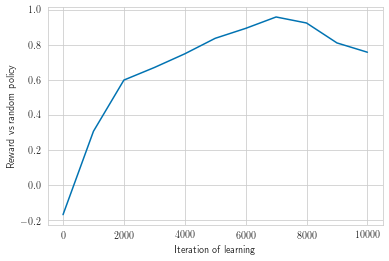

In [349]:
%%time
torch.manual_seed(1)
random.seed(1)
ddqn3 = TicTacToeDoubleDQN(3, 3, 3)
quality = ddqn3.run(10000)
print(quality)

Эта кривая значительно красивее, чем та, что была для DQN. Видно, что процесс обучения стал стабильнее, а то же качество может быть достигнуто за меньшее число итераций.

14:55:20.831612	Starting training for 10000 episodes...
Current quality == 0.1966
	Episode 0 finished with reward -1. Current epsilon == 0.950000.
	Episode 1 finished with reward -1. Current epsilon == 0.949989.
	Episode 2 finished with reward -1. Current epsilon == 0.949979.
	Episode 3 finished with reward 0. Current epsilon == 0.949968.
	Episode 4 finished with reward 1. Current epsilon == 0.949958.
	Episode 5 finished with reward 1. Current epsilon == 0.949947.
	Episode 6 finished with reward 1. Current epsilon == 0.949937.
	Episode 7 finished with reward 1. Current epsilon == 0.949926.
	Episode 8 finished with reward 1. Current epsilon == 0.949915.
	Episode 9 finished with reward 1. Current epsilon == 0.949905.
	Episode 10 finished with reward -1. Current epsilon == 0.949894.
	Episode 11 finished with reward 0. Current epsilon == 0.949884.
	Episode 12 finished with reward 0. Current epsilon == 0.949873.
	Episode 13 finished with reward -1. Current epsilon == 0.949863.
	Episode 14 f

	Episode 128 finished with reward 0. Current epsilon == 0.948648.
	Episode 129 finished with reward -1. Current epsilon == 0.948638.
	Episode 130 finished with reward -1. Current epsilon == 0.948627.
	Episode 131 finished with reward -1. Current epsilon == 0.948617.
	Episode 132 finished with reward 1. Current epsilon == 0.948606.
	Episode 133 finished with reward 0. Current epsilon == 0.948596.
	Episode 134 finished with reward -1. Current epsilon == 0.948585.
	Episode 135 finished with reward 0. Current epsilon == 0.948575.
	Episode 136 finished with reward 0. Current epsilon == 0.948564.
	Episode 137 finished with reward 1. Current epsilon == 0.948554.
	Episode 138 finished with reward 1. Current epsilon == 0.948543.
	Episode 139 finished with reward 0. Current epsilon == 0.948532.
	Episode 140 finished with reward 1. Current epsilon == 0.948522.
	Episode 141 finished with reward 0. Current epsilon == 0.948511.
	Episode 142 finished with reward 1. Current epsilon == 0.948501.
	Episo

	Episode 252 finished with reward 1. Current epsilon == 0.947341.
	Episode 253 finished with reward -1. Current epsilon == 0.947330.
	Episode 254 finished with reward -1. Current epsilon == 0.947320.
	Episode 255 finished with reward 1. Current epsilon == 0.947309.
	Episode 256 finished with reward 1. Current epsilon == 0.947299.
	Episode 257 finished with reward 0. Current epsilon == 0.947288.
	Episode 258 finished with reward 0. Current epsilon == 0.947278.
	Episode 259 finished with reward 1. Current epsilon == 0.947267.
	Episode 260 finished with reward -1. Current epsilon == 0.947257.
	Episode 261 finished with reward -1. Current epsilon == 0.947246.
	Episode 262 finished with reward 1. Current epsilon == 0.947236.
	Episode 263 finished with reward 1. Current epsilon == 0.947225.
	Episode 264 finished with reward 1. Current epsilon == 0.947215.
	Episode 265 finished with reward 1. Current epsilon == 0.947204.
	Episode 266 finished with reward 1. Current epsilon == 0.947193.
	Episo

	Episode 377 finished with reward 0. Current epsilon == 0.946025.
	Episode 378 finished with reward -1. Current epsilon == 0.946014.
	Episode 379 finished with reward -1. Current epsilon == 0.946004.
	Episode 380 finished with reward -1. Current epsilon == 0.945993.
	Episode 381 finished with reward 0. Current epsilon == 0.945983.
	Episode 382 finished with reward -1. Current epsilon == 0.945972.
	Episode 383 finished with reward 0. Current epsilon == 0.945962.
	Episode 384 finished with reward 1. Current epsilon == 0.945951.
	Episode 385 finished with reward -1. Current epsilon == 0.945941.
	Episode 386 finished with reward -1. Current epsilon == 0.945930.
	Episode 387 finished with reward -1. Current epsilon == 0.945920.
	Episode 388 finished with reward -1. Current epsilon == 0.945909.
	Episode 389 finished with reward 1. Current epsilon == 0.945899.
	Episode 390 finished with reward 1. Current epsilon == 0.945888.
	Episode 391 finished with reward 1. Current epsilon == 0.945877.
	E

	Episode 504 finished with reward 1. Current epsilon == 0.944689.
	Episode 505 finished with reward 1. Current epsilon == 0.944679.
	Episode 506 finished with reward -1. Current epsilon == 0.944668.
	Episode 507 finished with reward 1. Current epsilon == 0.944658.
	Episode 508 finished with reward 0. Current epsilon == 0.944647.
	Episode 509 finished with reward -1. Current epsilon == 0.944637.
	Episode 510 finished with reward -1. Current epsilon == 0.944626.
	Episode 511 finished with reward -1. Current epsilon == 0.944616.
	Episode 512 finished with reward -1. Current epsilon == 0.944605.
	Episode 513 finished with reward 0. Current epsilon == 0.944595.
	Episode 514 finished with reward 1. Current epsilon == 0.944584.
	Episode 515 finished with reward -1. Current epsilon == 0.944574.
	Episode 516 finished with reward -1. Current epsilon == 0.944563.
	Episode 517 finished with reward -1. Current epsilon == 0.944553.
	Episode 518 finished with reward -1. Current epsilon == 0.944542.
	

	Episode 629 finished with reward 0. Current epsilon == 0.943377.
	Episode 630 finished with reward 1. Current epsilon == 0.943366.
	Episode 631 finished with reward -1. Current epsilon == 0.943356.
	Episode 632 finished with reward -1. Current epsilon == 0.943345.
	Episode 633 finished with reward 0. Current epsilon == 0.943335.
	Episode 634 finished with reward 0. Current epsilon == 0.943324.
	Episode 635 finished with reward -1. Current epsilon == 0.943314.
	Episode 636 finished with reward 0. Current epsilon == 0.943303.
	Episode 637 finished with reward 0. Current epsilon == 0.943293.
	Episode 638 finished with reward -1. Current epsilon == 0.943282.
	Episode 639 finished with reward -1. Current epsilon == 0.943272.
	Episode 640 finished with reward -1. Current epsilon == 0.943261.
	Episode 641 finished with reward -1. Current epsilon == 0.943251.
	Episode 642 finished with reward -1. Current epsilon == 0.943241.
	Episode 643 finished with reward 1. Current epsilon == 0.943230.
	E

	Episode 754 finished with reward 0. Current epsilon == 0.942066.
	Episode 755 finished with reward -1. Current epsilon == 0.942056.
	Episode 756 finished with reward -1. Current epsilon == 0.942045.
	Episode 757 finished with reward -1. Current epsilon == 0.942035.
	Episode 758 finished with reward 0. Current epsilon == 0.942024.
	Episode 759 finished with reward 1. Current epsilon == 0.942014.
	Episode 760 finished with reward 0. Current epsilon == 0.942003.
	Episode 761 finished with reward 0. Current epsilon == 0.941993.
	Episode 762 finished with reward -1. Current epsilon == 0.941982.
	Episode 763 finished with reward 1. Current epsilon == 0.941972.
	Episode 764 finished with reward -1. Current epsilon == 0.941961.
	Episode 765 finished with reward -1. Current epsilon == 0.941951.
	Episode 766 finished with reward 1. Current epsilon == 0.941940.
	Episode 767 finished with reward 1. Current epsilon == 0.941930.
	Episode 768 finished with reward 0. Current epsilon == 0.941920.
	Epi

	Episode 879 finished with reward 1. Current epsilon == 0.940757.
	Episode 880 finished with reward -1. Current epsilon == 0.940747.
	Episode 881 finished with reward 1. Current epsilon == 0.940736.
	Episode 882 finished with reward -1. Current epsilon == 0.940726.
	Episode 883 finished with reward -1. Current epsilon == 0.940716.
	Episode 884 finished with reward 1. Current epsilon == 0.940705.
	Episode 885 finished with reward 0. Current epsilon == 0.940695.
	Episode 886 finished with reward 0. Current epsilon == 0.940684.
	Episode 887 finished with reward 1. Current epsilon == 0.940674.
	Episode 888 finished with reward 1. Current epsilon == 0.940663.
	Episode 889 finished with reward -1. Current epsilon == 0.940653.
	Episode 890 finished with reward 1. Current epsilon == 0.940642.
	Episode 891 finished with reward -1. Current epsilon == 0.940632.
	Episode 892 finished with reward -1. Current epsilon == 0.940621.
	Episode 893 finished with reward 1. Current epsilon == 0.940611.
	Epi

	Episode 1005 finished with reward 0. Current epsilon == 0.939440.
	Episode 1006 finished with reward -1. Current epsilon == 0.939429.
	Episode 1007 finished with reward 1. Current epsilon == 0.939419.
	Episode 1008 finished with reward 1. Current epsilon == 0.939409.
	Episode 1009 finished with reward 1. Current epsilon == 0.939398.
	Episode 1010 finished with reward 1. Current epsilon == 0.939388.
	Episode 1011 finished with reward 1. Current epsilon == 0.939377.
	Episode 1012 finished with reward 1. Current epsilon == 0.939367.
	Episode 1013 finished with reward -1. Current epsilon == 0.939356.
	Episode 1014 finished with reward -1. Current epsilon == 0.939346.
	Episode 1015 finished with reward -1. Current epsilon == 0.939335.
	Episode 1016 finished with reward 1. Current epsilon == 0.939325.
	Episode 1017 finished with reward 1. Current epsilon == 0.939314.
	Episode 1018 finished with reward 1. Current epsilon == 0.939304.
	Episode 1019 finished with reward -1. Current epsilon == 

	Episode 1130 finished with reward -1. Current epsilon == 0.938135.
	Episode 1131 finished with reward -1. Current epsilon == 0.938124.
	Episode 1132 finished with reward -1. Current epsilon == 0.938114.
	Episode 1133 finished with reward 1. Current epsilon == 0.938103.
	Episode 1134 finished with reward -1. Current epsilon == 0.938093.
	Episode 1135 finished with reward -1. Current epsilon == 0.938082.
	Episode 1136 finished with reward 1. Current epsilon == 0.938072.
	Episode 1137 finished with reward -1. Current epsilon == 0.938062.
	Episode 1138 finished with reward 1. Current epsilon == 0.938051.
	Episode 1139 finished with reward 0. Current epsilon == 0.938041.
	Episode 1140 finished with reward 0. Current epsilon == 0.938030.
	Episode 1141 finished with reward -1. Current epsilon == 0.938020.
	Episode 1142 finished with reward -1. Current epsilon == 0.938009.
	Episode 1143 finished with reward 1. Current epsilon == 0.937999.
	Episode 1144 finished with reward -1. Current epsilon

	Episode 1254 finished with reward 1. Current epsilon == 0.936842.
	Episode 1255 finished with reward -1. Current epsilon == 0.936831.
	Episode 1256 finished with reward 1. Current epsilon == 0.936821.
	Episode 1257 finished with reward 0. Current epsilon == 0.936810.
	Episode 1258 finished with reward 0. Current epsilon == 0.936800.
	Episode 1259 finished with reward -1. Current epsilon == 0.936790.
	Episode 1260 finished with reward -1. Current epsilon == 0.936779.
	Episode 1261 finished with reward 1. Current epsilon == 0.936769.
	Episode 1262 finished with reward -1. Current epsilon == 0.936758.
	Episode 1263 finished with reward 0. Current epsilon == 0.936748.
	Episode 1264 finished with reward -1. Current epsilon == 0.936737.
	Episode 1265 finished with reward 1. Current epsilon == 0.936727.
	Episode 1266 finished with reward 1. Current epsilon == 0.936717.
	Episode 1267 finished with reward 0. Current epsilon == 0.936706.
	Episode 1268 finished with reward 1. Current epsilon == 

	Episode 1376 finished with reward 0. Current epsilon == 0.935571.
	Episode 1377 finished with reward 1. Current epsilon == 0.935561.
	Episode 1378 finished with reward -1. Current epsilon == 0.935550.
	Episode 1379 finished with reward 0. Current epsilon == 0.935540.
	Episode 1380 finished with reward 0. Current epsilon == 0.935530.
	Episode 1381 finished with reward -1. Current epsilon == 0.935519.
	Episode 1382 finished with reward -1. Current epsilon == 0.935509.
	Episode 1383 finished with reward 0. Current epsilon == 0.935498.
	Episode 1384 finished with reward 0. Current epsilon == 0.935488.
	Episode 1385 finished with reward 1. Current epsilon == 0.935478.
	Episode 1386 finished with reward 1. Current epsilon == 0.935467.
	Episode 1387 finished with reward -1. Current epsilon == 0.935457.
	Episode 1388 finished with reward -1. Current epsilon == 0.935446.
	Episode 1389 finished with reward -1. Current epsilon == 0.935436.
	Episode 1390 finished with reward 1. Current epsilon ==

	Episode 1498 finished with reward 0. Current epsilon == 0.934303.
	Episode 1499 finished with reward -1. Current epsilon == 0.934292.
	Episode 1500 finished with reward 1. Current epsilon == 0.934282.
	Episode 1501 finished with reward -1. Current epsilon == 0.934271.
	Episode 1502 finished with reward 0. Current epsilon == 0.934261.
	Episode 1503 finished with reward 1. Current epsilon == 0.934251.
	Episode 1504 finished with reward 0. Current epsilon == 0.934240.
	Episode 1505 finished with reward 0. Current epsilon == 0.934230.
	Episode 1506 finished with reward 1. Current epsilon == 0.934219.
	Episode 1507 finished with reward 1. Current epsilon == 0.934209.
	Episode 1508 finished with reward 1. Current epsilon == 0.934199.
	Episode 1509 finished with reward 0. Current epsilon == 0.934188.
	Episode 1510 finished with reward 0. Current epsilon == 0.934178.
	Episode 1511 finished with reward 1. Current epsilon == 0.934168.
	Episode 1512 finished with reward 1. Current epsilon == 0.9

	Episode 1620 finished with reward 1. Current epsilon == 0.933036.
	Episode 1621 finished with reward 0. Current epsilon == 0.933025.
	Episode 1622 finished with reward 1. Current epsilon == 0.933015.
	Episode 1623 finished with reward -1. Current epsilon == 0.933005.
	Episode 1624 finished with reward 1. Current epsilon == 0.932994.
	Episode 1625 finished with reward 0. Current epsilon == 0.932984.
	Episode 1626 finished with reward 0. Current epsilon == 0.932973.
	Episode 1627 finished with reward 1. Current epsilon == 0.932963.
	Episode 1628 finished with reward 0. Current epsilon == 0.932953.
	Episode 1629 finished with reward -1. Current epsilon == 0.932942.
	Episode 1630 finished with reward 1. Current epsilon == 0.932932.
	Episode 1631 finished with reward 0. Current epsilon == 0.932922.
	Episode 1632 finished with reward 0. Current epsilon == 0.932911.
	Episode 1633 finished with reward 1. Current epsilon == 0.932901.
	Episode 1634 finished with reward -1. Current epsilon == 0.

	Episode 1743 finished with reward 0. Current epsilon == 0.931760.
	Episode 1744 finished with reward -1. Current epsilon == 0.931750.
	Episode 1745 finished with reward 1. Current epsilon == 0.931739.
	Episode 1746 finished with reward 1. Current epsilon == 0.931729.
	Episode 1747 finished with reward 1. Current epsilon == 0.931719.
	Episode 1748 finished with reward 1. Current epsilon == 0.931708.
	Episode 1749 finished with reward 0. Current epsilon == 0.931698.
	Episode 1750 finished with reward 1. Current epsilon == 0.931688.
	Episode 1751 finished with reward -1. Current epsilon == 0.931677.
	Episode 1752 finished with reward -1. Current epsilon == 0.931667.
	Episode 1753 finished with reward 1. Current epsilon == 0.931656.
	Episode 1754 finished with reward 1. Current epsilon == 0.931646.
	Episode 1755 finished with reward -1. Current epsilon == 0.931636.
	Episode 1756 finished with reward 1. Current epsilon == 0.931625.
	Episode 1757 finished with reward 0. Current epsilon == 0

	Episode 1866 finished with reward 1. Current epsilon == 0.930486.
	Episode 1867 finished with reward -1. Current epsilon == 0.930476.
	Episode 1868 finished with reward 1. Current epsilon == 0.930466.
	Episode 1869 finished with reward 0. Current epsilon == 0.930455.
	Episode 1870 finished with reward -1. Current epsilon == 0.930445.
	Episode 1871 finished with reward 1. Current epsilon == 0.930434.
	Episode 1872 finished with reward -1. Current epsilon == 0.930424.
	Episode 1873 finished with reward -1. Current epsilon == 0.930414.
	Episode 1874 finished with reward -1. Current epsilon == 0.930403.
	Episode 1875 finished with reward -1. Current epsilon == 0.930393.
	Episode 1876 finished with reward 1. Current epsilon == 0.930383.
	Episode 1877 finished with reward 1. Current epsilon == 0.930372.
	Episode 1878 finished with reward -1. Current epsilon == 0.930362.
	Episode 1879 finished with reward -1. Current epsilon == 0.930352.
	Episode 1880 finished with reward 1. Current epsilon 

	Episode 1988 finished with reward 1. Current epsilon == 0.929224.
	Episode 1989 finished with reward 1. Current epsilon == 0.929214.
	Episode 1990 finished with reward 1. Current epsilon == 0.929204.
	Episode 1991 finished with reward -1. Current epsilon == 0.929193.
	Episode 1992 finished with reward -1. Current epsilon == 0.929183.
	Episode 1993 finished with reward 1. Current epsilon == 0.929173.
	Episode 1994 finished with reward 1. Current epsilon == 0.929162.
	Episode 1995 finished with reward -1. Current epsilon == 0.929152.
	Episode 1996 finished with reward 0. Current epsilon == 0.929142.
	Episode 1997 finished with reward -1. Current epsilon == 0.929131.
	Episode 1998 finished with reward 0. Current epsilon == 0.929121.
	Episode 1999 finished with reward 1. Current epsilon == 0.929111.
Current quality == 0.1705
	Episode 2000 finished with reward -1. Current epsilon == 0.929100.
	Episode 2001 finished with reward 1. Current epsilon == 0.929090.
	Episode 2002 finished with rew

	Episode 2111 finished with reward -1. Current epsilon == 0.927954.
	Episode 2112 finished with reward -1. Current epsilon == 0.927944.
	Episode 2113 finished with reward 1. Current epsilon == 0.927933.
	Episode 2114 finished with reward 1. Current epsilon == 0.927923.
	Episode 2115 finished with reward 1. Current epsilon == 0.927913.
	Episode 2116 finished with reward -1. Current epsilon == 0.927902.
	Episode 2117 finished with reward -1. Current epsilon == 0.927892.
	Episode 2118 finished with reward -1. Current epsilon == 0.927882.
	Episode 2119 finished with reward 0. Current epsilon == 0.927872.
	Episode 2120 finished with reward -1. Current epsilon == 0.927861.
	Episode 2121 finished with reward -1. Current epsilon == 0.927851.
	Episode 2122 finished with reward 0. Current epsilon == 0.927841.
	Episode 2123 finished with reward 0. Current epsilon == 0.927830.
	Episode 2124 finished with reward -1. Current epsilon == 0.927820.
	Episode 2125 finished with reward 0. Current epsilon 

	Episode 2236 finished with reward 1. Current epsilon == 0.926665.
	Episode 2237 finished with reward -1. Current epsilon == 0.926655.
	Episode 2238 finished with reward -1. Current epsilon == 0.926644.
	Episode 2239 finished with reward 1. Current epsilon == 0.926634.
	Episode 2240 finished with reward 1. Current epsilon == 0.926624.
	Episode 2241 finished with reward -1. Current epsilon == 0.926613.
	Episode 2242 finished with reward 1. Current epsilon == 0.926603.
	Episode 2243 finished with reward 1. Current epsilon == 0.926593.
	Episode 2244 finished with reward -1. Current epsilon == 0.926582.
	Episode 2245 finished with reward -1. Current epsilon == 0.926572.
	Episode 2246 finished with reward -1. Current epsilon == 0.926562.
	Episode 2247 finished with reward -1. Current epsilon == 0.926551.
	Episode 2248 finished with reward -1. Current epsilon == 0.926541.
	Episode 2249 finished with reward 1. Current epsilon == 0.926531.
	Episode 2250 finished with reward 1. Current epsilon 

	Episode 2358 finished with reward 1. Current epsilon == 0.925408.
	Episode 2359 finished with reward 1. Current epsilon == 0.925398.
	Episode 2360 finished with reward -1. Current epsilon == 0.925388.
	Episode 2361 finished with reward 0. Current epsilon == 0.925377.
	Episode 2362 finished with reward 1. Current epsilon == 0.925367.
	Episode 2363 finished with reward 0. Current epsilon == 0.925357.
	Episode 2364 finished with reward 1. Current epsilon == 0.925346.
	Episode 2365 finished with reward -1. Current epsilon == 0.925336.
	Episode 2366 finished with reward -1. Current epsilon == 0.925326.
	Episode 2367 finished with reward 1. Current epsilon == 0.925316.
	Episode 2368 finished with reward 0. Current epsilon == 0.925305.
	Episode 2369 finished with reward 1. Current epsilon == 0.925295.
	Episode 2370 finished with reward 0. Current epsilon == 0.925285.
	Episode 2371 finished with reward 1. Current epsilon == 0.925274.
	Episode 2372 finished with reward -1. Current epsilon == 0

	Episode 2480 finished with reward -1. Current epsilon == 0.924153.
	Episode 2481 finished with reward 0. Current epsilon == 0.924143.
	Episode 2482 finished with reward -1. Current epsilon == 0.924133.
	Episode 2483 finished with reward -1. Current epsilon == 0.924123.
	Episode 2484 finished with reward -1. Current epsilon == 0.924112.
	Episode 2485 finished with reward 1. Current epsilon == 0.924102.
	Episode 2486 finished with reward 0. Current epsilon == 0.924092.
	Episode 2487 finished with reward 0. Current epsilon == 0.924081.
	Episode 2488 finished with reward -1. Current epsilon == 0.924071.
	Episode 2489 finished with reward -1. Current epsilon == 0.924061.
	Episode 2490 finished with reward -1. Current epsilon == 0.924051.
	Episode 2491 finished with reward -1. Current epsilon == 0.924040.
	Episode 2492 finished with reward 1. Current epsilon == 0.924030.
	Episode 2493 finished with reward -1. Current epsilon == 0.924020.
	Episode 2494 finished with reward -1. Current epsilo

	Episode 2605 finished with reward -1. Current epsilon == 0.922869.
	Episode 2606 finished with reward 1. Current epsilon == 0.922859.
	Episode 2607 finished with reward 0. Current epsilon == 0.922849.
	Episode 2608 finished with reward 0. Current epsilon == 0.922839.
	Episode 2609 finished with reward 1. Current epsilon == 0.922828.
	Episode 2610 finished with reward 1. Current epsilon == 0.922818.
	Episode 2611 finished with reward -1. Current epsilon == 0.922808.
	Episode 2612 finished with reward 0. Current epsilon == 0.922798.
	Episode 2613 finished with reward 0. Current epsilon == 0.922787.
	Episode 2614 finished with reward 1. Current epsilon == 0.922777.
	Episode 2615 finished with reward 0. Current epsilon == 0.922767.
	Episode 2616 finished with reward -1. Current epsilon == 0.922756.
	Episode 2617 finished with reward -1. Current epsilon == 0.922746.
	Episode 2618 finished with reward 0. Current epsilon == 0.922736.
	Episode 2619 finished with reward 0. Current epsilon == 0

	Episode 2728 finished with reward 0. Current epsilon == 0.921608.
	Episode 2729 finished with reward 1. Current epsilon == 0.921597.
	Episode 2730 finished with reward -1. Current epsilon == 0.921587.
	Episode 2731 finished with reward -1. Current epsilon == 0.921577.
	Episode 2732 finished with reward 0. Current epsilon == 0.921567.
	Episode 2733 finished with reward -1. Current epsilon == 0.921556.
	Episode 2734 finished with reward -1. Current epsilon == 0.921546.
	Episode 2735 finished with reward -1. Current epsilon == 0.921536.
	Episode 2736 finished with reward -1. Current epsilon == 0.921526.
	Episode 2737 finished with reward 1. Current epsilon == 0.921515.
	Episode 2738 finished with reward 0. Current epsilon == 0.921505.
	Episode 2739 finished with reward -1. Current epsilon == 0.921495.
	Episode 2740 finished with reward -1. Current epsilon == 0.921485.
	Episode 2741 finished with reward 0. Current epsilon == 0.921474.
	Episode 2742 finished with reward -1. Current epsilon

	Episode 2853 finished with reward -1. Current epsilon == 0.920327.
	Episode 2854 finished with reward -1. Current epsilon == 0.920317.
	Episode 2855 finished with reward 1. Current epsilon == 0.920307.
	Episode 2856 finished with reward 1. Current epsilon == 0.920297.
	Episode 2857 finished with reward -1. Current epsilon == 0.920286.
	Episode 2858 finished with reward 1. Current epsilon == 0.920276.
	Episode 2859 finished with reward -1. Current epsilon == 0.920266.
	Episode 2860 finished with reward -1. Current epsilon == 0.920256.
	Episode 2861 finished with reward 0. Current epsilon == 0.920245.
	Episode 2862 finished with reward 0. Current epsilon == 0.920235.
	Episode 2863 finished with reward 1. Current epsilon == 0.920225.
	Episode 2864 finished with reward 0. Current epsilon == 0.920215.
	Episode 2865 finished with reward 1. Current epsilon == 0.920204.
	Episode 2866 finished with reward 1. Current epsilon == 0.920194.
	Episode 2867 finished with reward -1. Current epsilon ==

	Episode 2977 finished with reward -1. Current epsilon == 0.919059.
	Episode 2978 finished with reward -1. Current epsilon == 0.919049.
	Episode 2979 finished with reward 0. Current epsilon == 0.919038.
	Episode 2980 finished with reward -1. Current epsilon == 0.919028.
	Episode 2981 finished with reward -1. Current epsilon == 0.919018.
	Episode 2982 finished with reward -1. Current epsilon == 0.919008.
	Episode 2983 finished with reward -1. Current epsilon == 0.918997.
	Episode 2984 finished with reward -1. Current epsilon == 0.918987.
	Episode 2985 finished with reward -1. Current epsilon == 0.918977.
	Episode 2986 finished with reward 0. Current epsilon == 0.918967.
	Episode 2987 finished with reward -1. Current epsilon == 0.918957.
	Episode 2988 finished with reward 0. Current epsilon == 0.918946.
	Episode 2989 finished with reward -1. Current epsilon == 0.918936.
	Episode 2990 finished with reward 1. Current epsilon == 0.918926.
	Episode 2991 finished with reward 1. Current epsilo

	Episode 3100 finished with reward -1. Current epsilon == 0.917802.
	Episode 3101 finished with reward -1. Current epsilon == 0.917792.
	Episode 3102 finished with reward -1. Current epsilon == 0.917782.
	Episode 3103 finished with reward 1. Current epsilon == 0.917772.
	Episode 3104 finished with reward 0. Current epsilon == 0.917761.
	Episode 3105 finished with reward -1. Current epsilon == 0.917751.
	Episode 3106 finished with reward -1. Current epsilon == 0.917741.
	Episode 3107 finished with reward 1. Current epsilon == 0.917731.
	Episode 3108 finished with reward 1. Current epsilon == 0.917721.
	Episode 3109 finished with reward 1. Current epsilon == 0.917710.
	Episode 3110 finished with reward 1. Current epsilon == 0.917700.
	Episode 3111 finished with reward 1. Current epsilon == 0.917690.
	Episode 3112 finished with reward -1. Current epsilon == 0.917680.
	Episode 3113 finished with reward 1. Current epsilon == 0.917670.
	Episode 3114 finished with reward -1. Current epsilon =

	Episode 3223 finished with reward 1. Current epsilon == 0.916548.
	Episode 3224 finished with reward -1. Current epsilon == 0.916537.
	Episode 3225 finished with reward -1. Current epsilon == 0.916527.
	Episode 3226 finished with reward -1. Current epsilon == 0.916517.
	Episode 3227 finished with reward 1. Current epsilon == 0.916507.
	Episode 3228 finished with reward 0. Current epsilon == 0.916497.
	Episode 3229 finished with reward 0. Current epsilon == 0.916486.
	Episode 3230 finished with reward -1. Current epsilon == 0.916476.
	Episode 3231 finished with reward 1. Current epsilon == 0.916466.
	Episode 3232 finished with reward -1. Current epsilon == 0.916456.
	Episode 3233 finished with reward -1. Current epsilon == 0.916446.
	Episode 3234 finished with reward 0. Current epsilon == 0.916435.
	Episode 3235 finished with reward 0. Current epsilon == 0.916425.
	Episode 3236 finished with reward 1. Current epsilon == 0.916415.
	Episode 3237 finished with reward 0. Current epsilon ==

	Episode 3347 finished with reward 0. Current epsilon == 0.915284.
	Episode 3348 finished with reward 0. Current epsilon == 0.915274.
	Episode 3349 finished with reward 0. Current epsilon == 0.915264.
	Episode 3350 finished with reward -1. Current epsilon == 0.915254.
	Episode 3351 finished with reward 1. Current epsilon == 0.915244.
	Episode 3352 finished with reward 1. Current epsilon == 0.915233.
	Episode 3353 finished with reward -1. Current epsilon == 0.915223.
	Episode 3354 finished with reward 0. Current epsilon == 0.915213.
	Episode 3355 finished with reward -1. Current epsilon == 0.915203.
	Episode 3356 finished with reward 1. Current epsilon == 0.915193.
	Episode 3357 finished with reward 1. Current epsilon == 0.915183.
	Episode 3358 finished with reward 1. Current epsilon == 0.915172.
	Episode 3359 finished with reward -1. Current epsilon == 0.915162.
	Episode 3360 finished with reward -1. Current epsilon == 0.915152.
	Episode 3361 finished with reward 0. Current epsilon == 

	Episode 3471 finished with reward 1. Current epsilon == 0.914023.
	Episode 3472 finished with reward 1. Current epsilon == 0.914013.
	Episode 3473 finished with reward -1. Current epsilon == 0.914003.
	Episode 3474 finished with reward -1. Current epsilon == 0.913992.
	Episode 3475 finished with reward 1. Current epsilon == 0.913982.
	Episode 3476 finished with reward -1. Current epsilon == 0.913972.
	Episode 3477 finished with reward -1. Current epsilon == 0.913962.
	Episode 3478 finished with reward 0. Current epsilon == 0.913952.
	Episode 3479 finished with reward 0. Current epsilon == 0.913942.
	Episode 3480 finished with reward -1. Current epsilon == 0.913931.
	Episode 3481 finished with reward 0. Current epsilon == 0.913921.
	Episode 3482 finished with reward -1. Current epsilon == 0.913911.
	Episode 3483 finished with reward -1. Current epsilon == 0.913901.
	Episode 3484 finished with reward -1. Current epsilon == 0.913891.
	Episode 3485 finished with reward 0. Current epsilon 

	Episode 3593 finished with reward -1. Current epsilon == 0.912783.
	Episode 3594 finished with reward -1. Current epsilon == 0.912773.
	Episode 3595 finished with reward 1. Current epsilon == 0.912763.
	Episode 3596 finished with reward -1. Current epsilon == 0.912753.
	Episode 3597 finished with reward -1. Current epsilon == 0.912743.
	Episode 3598 finished with reward -1. Current epsilon == 0.912733.
	Episode 3599 finished with reward -1. Current epsilon == 0.912722.
	Episode 3600 finished with reward -1. Current epsilon == 0.912712.
	Episode 3601 finished with reward -1. Current epsilon == 0.912702.
	Episode 3602 finished with reward 0. Current epsilon == 0.912692.
	Episode 3603 finished with reward -1. Current epsilon == 0.912682.
	Episode 3604 finished with reward 1. Current epsilon == 0.912672.
	Episode 3605 finished with reward 0. Current epsilon == 0.912662.
	Episode 3606 finished with reward 0. Current epsilon == 0.912651.
	Episode 3607 finished with reward -1. Current epsilo

	Episode 3718 finished with reward 1. Current epsilon == 0.911515.
	Episode 3719 finished with reward 0. Current epsilon == 0.911505.
	Episode 3720 finished with reward -1. Current epsilon == 0.911495.
	Episode 3721 finished with reward -1. Current epsilon == 0.911485.
	Episode 3722 finished with reward 1. Current epsilon == 0.911475.
	Episode 3723 finished with reward -1. Current epsilon == 0.911465.
	Episode 3724 finished with reward 1. Current epsilon == 0.911454.
	Episode 3725 finished with reward 0. Current epsilon == 0.911444.
	Episode 3726 finished with reward -1. Current epsilon == 0.911434.
	Episode 3727 finished with reward -1. Current epsilon == 0.911424.
	Episode 3728 finished with reward 1. Current epsilon == 0.911414.
	Episode 3729 finished with reward 0. Current epsilon == 0.911404.
	Episode 3730 finished with reward 0. Current epsilon == 0.911394.
	Episode 3731 finished with reward 0. Current epsilon == 0.911383.
	Episode 3732 finished with reward -1. Current epsilon ==

	Episode 3842 finished with reward 1. Current epsilon == 0.910259.
	Episode 3843 finished with reward 1. Current epsilon == 0.910249.
	Episode 3844 finished with reward -1. Current epsilon == 0.910239.
	Episode 3845 finished with reward -1. Current epsilon == 0.910229.
	Episode 3846 finished with reward 1. Current epsilon == 0.910218.
	Episode 3847 finished with reward -1. Current epsilon == 0.910208.
	Episode 3848 finished with reward 0. Current epsilon == 0.910198.
	Episode 3849 finished with reward 1. Current epsilon == 0.910188.
	Episode 3850 finished with reward 0. Current epsilon == 0.910178.
	Episode 3851 finished with reward 1. Current epsilon == 0.910168.
	Episode 3852 finished with reward 0. Current epsilon == 0.910158.
	Episode 3853 finished with reward 1. Current epsilon == 0.910148.
	Episode 3854 finished with reward 1. Current epsilon == 0.910137.
	Episode 3855 finished with reward 1. Current epsilon == 0.910127.
	Episode 3856 finished with reward 0. Current epsilon == 0.

	Episode 3967 finished with reward -1. Current epsilon == 0.908994.
	Episode 3968 finished with reward -1. Current epsilon == 0.908984.
	Episode 3969 finished with reward -1. Current epsilon == 0.908974.
	Episode 3970 finished with reward -1. Current epsilon == 0.908964.
	Episode 3971 finished with reward 1. Current epsilon == 0.908954.
	Episode 3972 finished with reward -1. Current epsilon == 0.908944.
	Episode 3973 finished with reward -1. Current epsilon == 0.908934.
	Episode 3974 finished with reward 1. Current epsilon == 0.908923.
	Episode 3975 finished with reward 1. Current epsilon == 0.908913.
	Episode 3976 finished with reward 0. Current epsilon == 0.908903.
	Episode 3977 finished with reward -1. Current epsilon == 0.908893.
	Episode 3978 finished with reward 0. Current epsilon == 0.908883.
	Episode 3979 finished with reward -1. Current epsilon == 0.908873.
	Episode 3980 finished with reward -1. Current epsilon == 0.908863.
	Episode 3981 finished with reward 0. Current epsilon

	Episode 4090 finished with reward 0. Current epsilon == 0.907752.
	Episode 4091 finished with reward -1. Current epsilon == 0.907741.
	Episode 4092 finished with reward 0. Current epsilon == 0.907731.
	Episode 4093 finished with reward 1. Current epsilon == 0.907721.
	Episode 4094 finished with reward -1. Current epsilon == 0.907711.
	Episode 4095 finished with reward 1. Current epsilon == 0.907701.
	Episode 4096 finished with reward -1. Current epsilon == 0.907691.
	Episode 4097 finished with reward 1. Current epsilon == 0.907681.
	Episode 4098 finished with reward -1. Current epsilon == 0.907671.
	Episode 4099 finished with reward -1. Current epsilon == 0.907661.
	Episode 4100 finished with reward -1. Current epsilon == 0.907651.
	Episode 4101 finished with reward 0. Current epsilon == 0.907640.
	Episode 4102 finished with reward 0. Current epsilon == 0.907630.
	Episode 4103 finished with reward -1. Current epsilon == 0.907620.
	Episode 4104 finished with reward 1. Current epsilon =

	Episode 4213 finished with reward 0. Current epsilon == 0.906511.
	Episode 4214 finished with reward 1. Current epsilon == 0.906500.
	Episode 4215 finished with reward -1. Current epsilon == 0.906490.
	Episode 4216 finished with reward -1. Current epsilon == 0.906480.
	Episode 4217 finished with reward 0. Current epsilon == 0.906470.
	Episode 4218 finished with reward 1. Current epsilon == 0.906460.
	Episode 4219 finished with reward 1. Current epsilon == 0.906450.
	Episode 4220 finished with reward -1. Current epsilon == 0.906440.
	Episode 4221 finished with reward 1. Current epsilon == 0.906430.
	Episode 4222 finished with reward 0. Current epsilon == 0.906420.
	Episode 4223 finished with reward -1. Current epsilon == 0.906410.
	Episode 4224 finished with reward -1. Current epsilon == 0.906400.
	Episode 4225 finished with reward -1. Current epsilon == 0.906390.
	Episode 4226 finished with reward -1. Current epsilon == 0.906379.
	Episode 4227 finished with reward 1. Current epsilon =

	Episode 4335 finished with reward -1. Current epsilon == 0.905281.
	Episode 4336 finished with reward 1. Current epsilon == 0.905271.
	Episode 4337 finished with reward -1. Current epsilon == 0.905261.
	Episode 4338 finished with reward -1. Current epsilon == 0.905251.
	Episode 4339 finished with reward -1. Current epsilon == 0.905241.
	Episode 4340 finished with reward 0. Current epsilon == 0.905231.
	Episode 4341 finished with reward -1. Current epsilon == 0.905221.
	Episode 4342 finished with reward 0. Current epsilon == 0.905211.
	Episode 4343 finished with reward -1. Current epsilon == 0.905201.
	Episode 4344 finished with reward -1. Current epsilon == 0.905191.
	Episode 4345 finished with reward -1. Current epsilon == 0.905181.
	Episode 4346 finished with reward -1. Current epsilon == 0.905170.
	Episode 4347 finished with reward 1. Current epsilon == 0.905160.
	Episode 4348 finished with reward -1. Current epsilon == 0.905150.
	Episode 4349 finished with reward -1. Current epsil

	Episode 4457 finished with reward -1. Current epsilon == 0.904054.
	Episode 4458 finished with reward 1. Current epsilon == 0.904044.
	Episode 4459 finished with reward 1. Current epsilon == 0.904034.
	Episode 4460 finished with reward 0. Current epsilon == 0.904023.
	Episode 4461 finished with reward 1. Current epsilon == 0.904013.
	Episode 4462 finished with reward 0. Current epsilon == 0.904003.
	Episode 4463 finished with reward -1. Current epsilon == 0.903993.
	Episode 4464 finished with reward 1. Current epsilon == 0.903983.
	Episode 4465 finished with reward 1. Current epsilon == 0.903973.
	Episode 4466 finished with reward -1. Current epsilon == 0.903963.
	Episode 4467 finished with reward -1. Current epsilon == 0.903953.
	Episode 4468 finished with reward 1. Current epsilon == 0.903943.
	Episode 4469 finished with reward 1. Current epsilon == 0.903933.
	Episode 4470 finished with reward 0. Current epsilon == 0.903923.
	Episode 4471 finished with reward 0. Current epsilon == 0

	Episode 4580 finished with reward -1. Current epsilon == 0.902818.
	Episode 4581 finished with reward 1. Current epsilon == 0.902808.
	Episode 4582 finished with reward 0. Current epsilon == 0.902798.
	Episode 4583 finished with reward 0. Current epsilon == 0.902788.
	Episode 4584 finished with reward -1. Current epsilon == 0.902778.
	Episode 4585 finished with reward -1. Current epsilon == 0.902767.
	Episode 4586 finished with reward -1. Current epsilon == 0.902757.
	Episode 4587 finished with reward 1. Current epsilon == 0.902747.
	Episode 4588 finished with reward 1. Current epsilon == 0.902737.
	Episode 4589 finished with reward 0. Current epsilon == 0.902727.
	Episode 4590 finished with reward 0. Current epsilon == 0.902717.
	Episode 4591 finished with reward 0. Current epsilon == 0.902707.
	Episode 4592 finished with reward -1. Current epsilon == 0.902697.
	Episode 4593 finished with reward 0. Current epsilon == 0.902687.
	Episode 4594 finished with reward -1. Current epsilon ==

	Episode 4705 finished with reward -1. Current epsilon == 0.901563.
	Episode 4706 finished with reward 1. Current epsilon == 0.901553.
	Episode 4707 finished with reward -1. Current epsilon == 0.901543.
	Episode 4708 finished with reward 1. Current epsilon == 0.901533.
	Episode 4709 finished with reward -1. Current epsilon == 0.901523.
	Episode 4710 finished with reward -1. Current epsilon == 0.901513.
	Episode 4711 finished with reward 0. Current epsilon == 0.901503.
	Episode 4712 finished with reward 1. Current epsilon == 0.901493.
	Episode 4713 finished with reward -1. Current epsilon == 0.901483.
	Episode 4714 finished with reward 1. Current epsilon == 0.901473.
	Episode 4715 finished with reward 0. Current epsilon == 0.901463.
	Episode 4716 finished with reward -1. Current epsilon == 0.901453.
	Episode 4717 finished with reward 1. Current epsilon == 0.901443.
	Episode 4718 finished with reward -1. Current epsilon == 0.901433.
	Episode 4719 finished with reward 0. Current epsilon =

	Episode 4828 finished with reward -1. Current epsilon == 0.900331.
	Episode 4829 finished with reward 1. Current epsilon == 0.900321.
	Episode 4830 finished with reward -1. Current epsilon == 0.900311.
	Episode 4831 finished with reward 0. Current epsilon == 0.900301.
	Episode 4832 finished with reward 1. Current epsilon == 0.900291.
	Episode 4833 finished with reward -1. Current epsilon == 0.900281.
	Episode 4834 finished with reward -1. Current epsilon == 0.900271.
	Episode 4835 finished with reward -1. Current epsilon == 0.900261.
	Episode 4836 finished with reward 0. Current epsilon == 0.900251.
	Episode 4837 finished with reward -1. Current epsilon == 0.900241.
	Episode 4838 finished with reward -1. Current epsilon == 0.900231.
	Episode 4839 finished with reward -1. Current epsilon == 0.900221.
	Episode 4840 finished with reward 1. Current epsilon == 0.900211.
	Episode 4841 finished with reward -1. Current epsilon == 0.900201.
	Episode 4842 finished with reward -1. Current epsilo

	Episode 4952 finished with reward 1. Current epsilon == 0.899090.
	Episode 4953 finished with reward 0. Current epsilon == 0.899080.
	Episode 4954 finished with reward -1. Current epsilon == 0.899070.
	Episode 4955 finished with reward 0. Current epsilon == 0.899060.
	Episode 4956 finished with reward 0. Current epsilon == 0.899050.
	Episode 4957 finished with reward -1. Current epsilon == 0.899040.
	Episode 4958 finished with reward 1. Current epsilon == 0.899030.
	Episode 4959 finished with reward 0. Current epsilon == 0.899020.
	Episode 4960 finished with reward 0. Current epsilon == 0.899010.
	Episode 4961 finished with reward 1. Current epsilon == 0.899000.
	Episode 4962 finished with reward 0. Current epsilon == 0.898990.
	Episode 4963 finished with reward 1. Current epsilon == 0.898980.
	Episode 4964 finished with reward 0. Current epsilon == 0.898970.
	Episode 4965 finished with reward -1. Current epsilon == 0.898960.
	Episode 4966 finished with reward -1. Current epsilon == 0

	Episode 5076 finished with reward -1. Current epsilon == 0.897851.
	Episode 5077 finished with reward 1. Current epsilon == 0.897841.
	Episode 5078 finished with reward 0. Current epsilon == 0.897831.
	Episode 5079 finished with reward 1. Current epsilon == 0.897821.
	Episode 5080 finished with reward -1. Current epsilon == 0.897811.
	Episode 5081 finished with reward -1. Current epsilon == 0.897801.
	Episode 5082 finished with reward -1. Current epsilon == 0.897791.
	Episode 5083 finished with reward 0. Current epsilon == 0.897781.
	Episode 5084 finished with reward 0. Current epsilon == 0.897771.
	Episode 5085 finished with reward 1. Current epsilon == 0.897761.
	Episode 5086 finished with reward 0. Current epsilon == 0.897751.
	Episode 5087 finished with reward 1. Current epsilon == 0.897741.
	Episode 5088 finished with reward 0. Current epsilon == 0.897731.
	Episode 5089 finished with reward -1. Current epsilon == 0.897721.
	Episode 5090 finished with reward -1. Current epsilon ==

	Episode 5198 finished with reward -1. Current epsilon == 0.896633.
	Episode 5199 finished with reward 1. Current epsilon == 0.896623.
	Episode 5200 finished with reward -1. Current epsilon == 0.896613.
	Episode 5201 finished with reward 0. Current epsilon == 0.896603.
	Episode 5202 finished with reward 1. Current epsilon == 0.896593.
	Episode 5203 finished with reward -1. Current epsilon == 0.896583.
	Episode 5204 finished with reward 1. Current epsilon == 0.896573.
	Episode 5205 finished with reward 0. Current epsilon == 0.896563.
	Episode 5206 finished with reward -1. Current epsilon == 0.896553.
	Episode 5207 finished with reward -1. Current epsilon == 0.896543.
	Episode 5208 finished with reward 1. Current epsilon == 0.896534.
	Episode 5209 finished with reward 0. Current epsilon == 0.896524.
	Episode 5210 finished with reward -1. Current epsilon == 0.896514.
	Episode 5211 finished with reward -1. Current epsilon == 0.896504.
	Episode 5212 finished with reward 0. Current epsilon =

	Episode 5323 finished with reward -1. Current epsilon == 0.895387.
	Episode 5324 finished with reward -1. Current epsilon == 0.895378.
	Episode 5325 finished with reward -1. Current epsilon == 0.895368.
	Episode 5326 finished with reward 1. Current epsilon == 0.895358.
	Episode 5327 finished with reward 1. Current epsilon == 0.895348.
	Episode 5328 finished with reward 1. Current epsilon == 0.895338.
	Episode 5329 finished with reward -1. Current epsilon == 0.895328.
	Episode 5330 finished with reward 1. Current epsilon == 0.895318.
	Episode 5331 finished with reward 1. Current epsilon == 0.895308.
	Episode 5332 finished with reward 0. Current epsilon == 0.895298.
	Episode 5333 finished with reward -1. Current epsilon == 0.895288.
	Episode 5334 finished with reward -1. Current epsilon == 0.895278.
	Episode 5335 finished with reward -1. Current epsilon == 0.895268.
	Episode 5336 finished with reward 1. Current epsilon == 0.895258.
	Episode 5337 finished with reward 1. Current epsilon =

	Episode 5450 finished with reward 1. Current epsilon == 0.894124.
	Episode 5451 finished with reward -1. Current epsilon == 0.894114.
	Episode 5452 finished with reward 1. Current epsilon == 0.894104.
	Episode 5453 finished with reward 1. Current epsilon == 0.894094.
	Episode 5454 finished with reward 0. Current epsilon == 0.894084.
	Episode 5455 finished with reward 0. Current epsilon == 0.894074.
	Episode 5456 finished with reward -1. Current epsilon == 0.894064.
	Episode 5457 finished with reward 0. Current epsilon == 0.894054.
	Episode 5458 finished with reward 1. Current epsilon == 0.894044.
	Episode 5459 finished with reward -1. Current epsilon == 0.894034.
	Episode 5460 finished with reward -1. Current epsilon == 0.894024.
	Episode 5461 finished with reward 0. Current epsilon == 0.894014.
	Episode 5462 finished with reward 1. Current epsilon == 0.894004.
	Episode 5463 finished with reward -1. Current epsilon == 0.893994.
	Episode 5464 finished with reward -1. Current epsilon ==

	Episode 5573 finished with reward 1. Current epsilon == 0.892901.
	Episode 5574 finished with reward -1. Current epsilon == 0.892891.
	Episode 5575 finished with reward -1. Current epsilon == 0.892881.
	Episode 5576 finished with reward 0. Current epsilon == 0.892871.
	Episode 5577 finished with reward -1. Current epsilon == 0.892861.
	Episode 5578 finished with reward 1. Current epsilon == 0.892852.
	Episode 5579 finished with reward 0. Current epsilon == 0.892842.
	Episode 5580 finished with reward -1. Current epsilon == 0.892832.
	Episode 5581 finished with reward -1. Current epsilon == 0.892822.
	Episode 5582 finished with reward -1. Current epsilon == 0.892812.
	Episode 5583 finished with reward 1. Current epsilon == 0.892802.
	Episode 5584 finished with reward -1. Current epsilon == 0.892792.
	Episode 5585 finished with reward 1. Current epsilon == 0.892782.
	Episode 5586 finished with reward 1. Current epsilon == 0.892772.
	Episode 5587 finished with reward 0. Current epsilon =

	Episode 5699 finished with reward -1. Current epsilon == 0.891651.
	Episode 5700 finished with reward -1. Current epsilon == 0.891641.
	Episode 5701 finished with reward -1. Current epsilon == 0.891631.
	Episode 5702 finished with reward 1. Current epsilon == 0.891621.
	Episode 5703 finished with reward -1. Current epsilon == 0.891611.
	Episode 5704 finished with reward 1. Current epsilon == 0.891601.
	Episode 5705 finished with reward -1. Current epsilon == 0.891591.
	Episode 5706 finished with reward 1. Current epsilon == 0.891581.
	Episode 5707 finished with reward -1. Current epsilon == 0.891571.
	Episode 5708 finished with reward -1. Current epsilon == 0.891561.
	Episode 5709 finished with reward 1. Current epsilon == 0.891552.
	Episode 5710 finished with reward 1. Current epsilon == 0.891542.
	Episode 5711 finished with reward -1. Current epsilon == 0.891532.
	Episode 5712 finished with reward 1. Current epsilon == 0.891522.
	Episode 5713 finished with reward -1. Current epsilon

	Episode 5824 finished with reward 1. Current epsilon == 0.890412.
	Episode 5825 finished with reward 0. Current epsilon == 0.890402.
	Episode 5826 finished with reward -1. Current epsilon == 0.890392.
	Episode 5827 finished with reward -1. Current epsilon == 0.890382.
	Episode 5828 finished with reward -1. Current epsilon == 0.890372.
	Episode 5829 finished with reward 1. Current epsilon == 0.890362.
	Episode 5830 finished with reward 1. Current epsilon == 0.890352.
	Episode 5831 finished with reward 1. Current epsilon == 0.890343.
	Episode 5832 finished with reward 1. Current epsilon == 0.890333.
	Episode 5833 finished with reward -1. Current epsilon == 0.890323.
	Episode 5834 finished with reward -1. Current epsilon == 0.890313.
	Episode 5835 finished with reward -1. Current epsilon == 0.890303.
	Episode 5836 finished with reward -1. Current epsilon == 0.890293.
	Episode 5837 finished with reward 0. Current epsilon == 0.890283.
	Episode 5838 finished with reward -1. Current epsilon 

	Episode 5946 finished with reward 1. Current epsilon == 0.889204.
	Episode 5947 finished with reward -1. Current epsilon == 0.889195.
	Episode 5948 finished with reward -1. Current epsilon == 0.889185.
	Episode 5949 finished with reward 0. Current epsilon == 0.889175.
	Episode 5950 finished with reward 1. Current epsilon == 0.889165.
	Episode 5951 finished with reward 0. Current epsilon == 0.889155.
	Episode 5952 finished with reward -1. Current epsilon == 0.889145.
	Episode 5953 finished with reward -1. Current epsilon == 0.889135.
	Episode 5954 finished with reward -1. Current epsilon == 0.889125.
	Episode 5955 finished with reward 0. Current epsilon == 0.889115.
	Episode 5956 finished with reward 0. Current epsilon == 0.889106.
	Episode 5957 finished with reward 1. Current epsilon == 0.889096.
	Episode 5958 finished with reward 0. Current epsilon == 0.889086.
	Episode 5959 finished with reward -1. Current epsilon == 0.889076.
	Episode 5960 finished with reward 1. Current epsilon ==

	Episode 6070 finished with reward 1. Current epsilon == 0.887979.
	Episode 6071 finished with reward -1. Current epsilon == 0.887969.
	Episode 6072 finished with reward 0. Current epsilon == 0.887959.
	Episode 6073 finished with reward -1. Current epsilon == 0.887949.
	Episode 6074 finished with reward 0. Current epsilon == 0.887939.
	Episode 6075 finished with reward 1. Current epsilon == 0.887930.
	Episode 6076 finished with reward -1. Current epsilon == 0.887920.
	Episode 6077 finished with reward -1. Current epsilon == 0.887910.
	Episode 6078 finished with reward -1. Current epsilon == 0.887900.
	Episode 6079 finished with reward 0. Current epsilon == 0.887890.
	Episode 6080 finished with reward -1. Current epsilon == 0.887880.
	Episode 6081 finished with reward -1. Current epsilon == 0.887870.
	Episode 6082 finished with reward -1. Current epsilon == 0.887860.
	Episode 6083 finished with reward -1. Current epsilon == 0.887851.
	Episode 6084 finished with reward -1. Current epsilo

	Episode 6192 finished with reward 1. Current epsilon == 0.886775.
	Episode 6193 finished with reward -1. Current epsilon == 0.886765.
	Episode 6194 finished with reward 1. Current epsilon == 0.886755.
	Episode 6195 finished with reward 0. Current epsilon == 0.886745.
	Episode 6196 finished with reward -1. Current epsilon == 0.886735.
	Episode 6197 finished with reward 0. Current epsilon == 0.886725.
	Episode 6198 finished with reward 1. Current epsilon == 0.886716.
	Episode 6199 finished with reward 1. Current epsilon == 0.886706.
	Episode 6200 finished with reward 0. Current epsilon == 0.886696.
	Episode 6201 finished with reward -1. Current epsilon == 0.886686.
	Episode 6202 finished with reward -1. Current epsilon == 0.886676.
	Episode 6203 finished with reward -1. Current epsilon == 0.886666.
	Episode 6204 finished with reward 1. Current epsilon == 0.886656.
	Episode 6205 finished with reward 0. Current epsilon == 0.886647.
	Episode 6206 finished with reward -1. Current epsilon ==

	Episode 6316 finished with reward -1. Current epsilon == 0.885553.
	Episode 6317 finished with reward 1. Current epsilon == 0.885543.
	Episode 6318 finished with reward 1. Current epsilon == 0.885533.
	Episode 6319 finished with reward 1. Current epsilon == 0.885523.
	Episode 6320 finished with reward 1. Current epsilon == 0.885513.
	Episode 6321 finished with reward -1. Current epsilon == 0.885503.
	Episode 6322 finished with reward 1. Current epsilon == 0.885494.
	Episode 6323 finished with reward 0. Current epsilon == 0.885484.
	Episode 6324 finished with reward 0. Current epsilon == 0.885474.
	Episode 6325 finished with reward 1. Current epsilon == 0.885464.
	Episode 6326 finished with reward -1. Current epsilon == 0.885454.
	Episode 6327 finished with reward -1. Current epsilon == 0.885444.
	Episode 6328 finished with reward 1. Current epsilon == 0.885434.
	Episode 6329 finished with reward 0. Current epsilon == 0.885425.
	Episode 6330 finished with reward 1. Current epsilon == 0

	Episode 6443 finished with reward 1. Current epsilon == 0.884303.
	Episode 6444 finished with reward 1. Current epsilon == 0.884293.
	Episode 6445 finished with reward 1. Current epsilon == 0.884283.
	Episode 6446 finished with reward 0. Current epsilon == 0.884273.
	Episode 6447 finished with reward 1. Current epsilon == 0.884263.
	Episode 6448 finished with reward 0. Current epsilon == 0.884253.
	Episode 6449 finished with reward 0. Current epsilon == 0.884244.
	Episode 6450 finished with reward -1. Current epsilon == 0.884234.
	Episode 6451 finished with reward 1. Current epsilon == 0.884224.
	Episode 6452 finished with reward -1. Current epsilon == 0.884214.
	Episode 6453 finished with reward 0. Current epsilon == 0.884204.
	Episode 6454 finished with reward -1. Current epsilon == 0.884194.
	Episode 6455 finished with reward -1. Current epsilon == 0.884185.
	Episode 6456 finished with reward -1. Current epsilon == 0.884175.
	Episode 6457 finished with reward -1. Current epsilon ==

	Episode 6566 finished with reward 1. Current epsilon == 0.883094.
	Episode 6567 finished with reward 1. Current epsilon == 0.883084.
	Episode 6568 finished with reward -1. Current epsilon == 0.883074.
	Episode 6569 finished with reward -1. Current epsilon == 0.883064.
	Episode 6570 finished with reward 1. Current epsilon == 0.883054.
	Episode 6571 finished with reward 1. Current epsilon == 0.883045.
	Episode 6572 finished with reward -1. Current epsilon == 0.883035.
	Episode 6573 finished with reward -1. Current epsilon == 0.883025.
	Episode 6574 finished with reward 0. Current epsilon == 0.883015.
	Episode 6575 finished with reward 1. Current epsilon == 0.883005.
	Episode 6576 finished with reward -1. Current epsilon == 0.882995.
	Episode 6577 finished with reward -1. Current epsilon == 0.882986.
	Episode 6578 finished with reward -1. Current epsilon == 0.882976.
	Episode 6579 finished with reward -1. Current epsilon == 0.882966.
	Episode 6580 finished with reward -1. Current epsilon

	Episode 6692 finished with reward -1. Current epsilon == 0.881857.
	Episode 6693 finished with reward 0. Current epsilon == 0.881847.
	Episode 6694 finished with reward 1. Current epsilon == 0.881837.
	Episode 6695 finished with reward 1. Current epsilon == 0.881827.
	Episode 6696 finished with reward -1. Current epsilon == 0.881818.
	Episode 6697 finished with reward -1. Current epsilon == 0.881808.
	Episode 6698 finished with reward 1. Current epsilon == 0.881798.
	Episode 6699 finished with reward 1. Current epsilon == 0.881788.
	Episode 6700 finished with reward -1. Current epsilon == 0.881778.
	Episode 6701 finished with reward 1. Current epsilon == 0.881769.
	Episode 6702 finished with reward 1. Current epsilon == 0.881759.
	Episode 6703 finished with reward 0. Current epsilon == 0.881749.
	Episode 6704 finished with reward -1. Current epsilon == 0.881739.
	Episode 6705 finished with reward 1. Current epsilon == 0.881729.
	Episode 6706 finished with reward -1. Current epsilon ==

	Episode 6815 finished with reward 1. Current epsilon == 0.880651.
	Episode 6816 finished with reward -1. Current epsilon == 0.880641.
	Episode 6817 finished with reward 0. Current epsilon == 0.880632.
	Episode 6818 finished with reward -1. Current epsilon == 0.880622.
	Episode 6819 finished with reward 1. Current epsilon == 0.880612.
	Episode 6820 finished with reward 0. Current epsilon == 0.880602.
	Episode 6821 finished with reward -1. Current epsilon == 0.880593.
	Episode 6822 finished with reward 0. Current epsilon == 0.880583.
	Episode 6823 finished with reward -1. Current epsilon == 0.880573.
	Episode 6824 finished with reward 1. Current epsilon == 0.880563.
	Episode 6825 finished with reward -1. Current epsilon == 0.880553.
	Episode 6826 finished with reward 0. Current epsilon == 0.880544.
	Episode 6827 finished with reward 0. Current epsilon == 0.880534.
	Episode 6828 finished with reward -1. Current epsilon == 0.880524.
	Episode 6829 finished with reward 1. Current epsilon ==

	Episode 6940 finished with reward 0. Current epsilon == 0.879428.
	Episode 6941 finished with reward -1. Current epsilon == 0.879418.
	Episode 6942 finished with reward 1. Current epsilon == 0.879408.
	Episode 6943 finished with reward -1. Current epsilon == 0.879398.
	Episode 6944 finished with reward -1. Current epsilon == 0.879389.
	Episode 6945 finished with reward -1. Current epsilon == 0.879379.
	Episode 6946 finished with reward -1. Current epsilon == 0.879369.
	Episode 6947 finished with reward -1. Current epsilon == 0.879359.
	Episode 6948 finished with reward -1. Current epsilon == 0.879349.
	Episode 6949 finished with reward -1. Current epsilon == 0.879340.
	Episode 6950 finished with reward 1. Current epsilon == 0.879330.
	Episode 6951 finished with reward -1. Current epsilon == 0.879320.
	Episode 6952 finished with reward 1. Current epsilon == 0.879310.
	Episode 6953 finished with reward 1. Current epsilon == 0.879301.
	Episode 6954 finished with reward 0. Current epsilon

	Episode 7061 finished with reward 0. Current epsilon == 0.878245.
	Episode 7062 finished with reward -1. Current epsilon == 0.878235.
	Episode 7063 finished with reward 1. Current epsilon == 0.878225.
	Episode 7064 finished with reward -1. Current epsilon == 0.878216.
	Episode 7065 finished with reward 1. Current epsilon == 0.878206.
	Episode 7066 finished with reward -1. Current epsilon == 0.878196.
	Episode 7067 finished with reward 1. Current epsilon == 0.878186.
	Episode 7068 finished with reward -1. Current epsilon == 0.878177.
	Episode 7069 finished with reward 1. Current epsilon == 0.878167.
	Episode 7070 finished with reward -1. Current epsilon == 0.878157.
	Episode 7071 finished with reward -1. Current epsilon == 0.878147.
	Episode 7072 finished with reward 1. Current epsilon == 0.878138.
	Episode 7073 finished with reward -1. Current epsilon == 0.878128.
	Episode 7074 finished with reward -1. Current epsilon == 0.878118.
	Episode 7075 finished with reward 1. Current epsilon 

	Episode 7185 finished with reward 1. Current epsilon == 0.877035.
	Episode 7186 finished with reward -1. Current epsilon == 0.877025.
	Episode 7187 finished with reward 0. Current epsilon == 0.877015.
	Episode 7188 finished with reward 1. Current epsilon == 0.877005.
	Episode 7189 finished with reward -1. Current epsilon == 0.876996.
	Episode 7190 finished with reward -1. Current epsilon == 0.876986.
	Episode 7191 finished with reward 1. Current epsilon == 0.876976.
	Episode 7192 finished with reward 0. Current epsilon == 0.876966.
	Episode 7193 finished with reward -1. Current epsilon == 0.876956.
	Episode 7194 finished with reward -1. Current epsilon == 0.876947.
	Episode 7195 finished with reward -1. Current epsilon == 0.876937.
	Episode 7196 finished with reward -1. Current epsilon == 0.876927.
	Episode 7197 finished with reward 0. Current epsilon == 0.876917.
	Episode 7198 finished with reward 1. Current epsilon == 0.876908.
	Episode 7199 finished with reward -1. Current epsilon 

	Episode 7309 finished with reward -1. Current epsilon == 0.875826.
	Episode 7310 finished with reward -1. Current epsilon == 0.875816.
	Episode 7311 finished with reward 0. Current epsilon == 0.875806.
	Episode 7312 finished with reward -1. Current epsilon == 0.875797.
	Episode 7313 finished with reward 1. Current epsilon == 0.875787.
	Episode 7314 finished with reward 1. Current epsilon == 0.875777.
	Episode 7315 finished with reward -1. Current epsilon == 0.875767.
	Episode 7316 finished with reward 0. Current epsilon == 0.875758.
	Episode 7317 finished with reward -1. Current epsilon == 0.875748.
	Episode 7318 finished with reward -1. Current epsilon == 0.875738.
	Episode 7319 finished with reward -1. Current epsilon == 0.875728.
	Episode 7320 finished with reward -1. Current epsilon == 0.875719.
	Episode 7321 finished with reward 1. Current epsilon == 0.875709.
	Episode 7322 finished with reward 0. Current epsilon == 0.875699.
	Episode 7323 finished with reward -1. Current epsilon

	Episode 7434 finished with reward -1. Current epsilon == 0.874609.
	Episode 7435 finished with reward 0. Current epsilon == 0.874599.
	Episode 7436 finished with reward 1. Current epsilon == 0.874589.
	Episode 7437 finished with reward -1. Current epsilon == 0.874580.
	Episode 7438 finished with reward 1. Current epsilon == 0.874570.
	Episode 7439 finished with reward -1. Current epsilon == 0.874560.
	Episode 7440 finished with reward -1. Current epsilon == 0.874551.
	Episode 7441 finished with reward -1. Current epsilon == 0.874541.
	Episode 7442 finished with reward -1. Current epsilon == 0.874531.
	Episode 7443 finished with reward 1. Current epsilon == 0.874521.
	Episode 7444 finished with reward -1. Current epsilon == 0.874512.
	Episode 7445 finished with reward -1. Current epsilon == 0.874502.
	Episode 7446 finished with reward 1. Current epsilon == 0.874492.
	Episode 7447 finished with reward -1. Current epsilon == 0.874482.
	Episode 7448 finished with reward -1. Current epsilo

	Episode 7558 finished with reward -1. Current epsilon == 0.873404.
	Episode 7559 finished with reward 0. Current epsilon == 0.873394.
	Episode 7560 finished with reward -1. Current epsilon == 0.873384.
	Episode 7561 finished with reward -1. Current epsilon == 0.873374.
	Episode 7562 finished with reward -1. Current epsilon == 0.873365.
	Episode 7563 finished with reward -1. Current epsilon == 0.873355.
	Episode 7564 finished with reward 1. Current epsilon == 0.873345.
	Episode 7565 finished with reward -1. Current epsilon == 0.873336.
	Episode 7566 finished with reward 1. Current epsilon == 0.873326.
	Episode 7567 finished with reward -1. Current epsilon == 0.873316.
	Episode 7568 finished with reward -1. Current epsilon == 0.873306.
	Episode 7569 finished with reward 0. Current epsilon == 0.873297.
	Episode 7570 finished with reward -1. Current epsilon == 0.873287.
	Episode 7571 finished with reward 0. Current epsilon == 0.873277.
	Episode 7572 finished with reward -1. Current epsilo

	Episode 7681 finished with reward 1. Current epsilon == 0.872209.
	Episode 7682 finished with reward 1. Current epsilon == 0.872200.
	Episode 7683 finished with reward 1. Current epsilon == 0.872190.
	Episode 7684 finished with reward 1. Current epsilon == 0.872180.
	Episode 7685 finished with reward 0. Current epsilon == 0.872171.
	Episode 7686 finished with reward 0. Current epsilon == 0.872161.
	Episode 7687 finished with reward 1. Current epsilon == 0.872151.
	Episode 7688 finished with reward -1. Current epsilon == 0.872142.
	Episode 7689 finished with reward -1. Current epsilon == 0.872132.
	Episode 7690 finished with reward -1. Current epsilon == 0.872122.
	Episode 7691 finished with reward -1. Current epsilon == 0.872112.
	Episode 7692 finished with reward 1. Current epsilon == 0.872103.
	Episode 7693 finished with reward -1. Current epsilon == 0.872093.
	Episode 7694 finished with reward 1. Current epsilon == 0.872083.
	Episode 7695 finished with reward 1. Current epsilon == 

	Episode 7803 finished with reward 1. Current epsilon == 0.871027.
	Episode 7804 finished with reward 0. Current epsilon == 0.871017.
	Episode 7805 finished with reward -1. Current epsilon == 0.871007.
	Episode 7806 finished with reward -1. Current epsilon == 0.870998.
	Episode 7807 finished with reward 1. Current epsilon == 0.870988.
	Episode 7808 finished with reward 0. Current epsilon == 0.870978.
	Episode 7809 finished with reward 1. Current epsilon == 0.870969.
	Episode 7810 finished with reward -1. Current epsilon == 0.870959.
	Episode 7811 finished with reward -1. Current epsilon == 0.870949.
	Episode 7812 finished with reward 1. Current epsilon == 0.870940.
	Episode 7813 finished with reward -1. Current epsilon == 0.870930.
	Episode 7814 finished with reward -1. Current epsilon == 0.870920.
	Episode 7815 finished with reward 0. Current epsilon == 0.870910.
	Episode 7816 finished with reward 1. Current epsilon == 0.870901.
	Episode 7817 finished with reward -1. Current epsilon =

	Episode 7930 finished with reward -1. Current epsilon == 0.869797.
	Episode 7931 finished with reward 0. Current epsilon == 0.869788.
	Episode 7932 finished with reward -1. Current epsilon == 0.869778.
	Episode 7933 finished with reward -1. Current epsilon == 0.869768.
	Episode 7934 finished with reward 1. Current epsilon == 0.869758.
	Episode 7935 finished with reward 1. Current epsilon == 0.869749.
	Episode 7936 finished with reward -1. Current epsilon == 0.869739.
	Episode 7937 finished with reward 1. Current epsilon == 0.869729.
	Episode 7938 finished with reward -1. Current epsilon == 0.869720.
	Episode 7939 finished with reward -1. Current epsilon == 0.869710.
	Episode 7940 finished with reward 0. Current epsilon == 0.869700.
	Episode 7941 finished with reward -1. Current epsilon == 0.869691.
	Episode 7942 finished with reward -1. Current epsilon == 0.869681.
	Episode 7943 finished with reward -1. Current epsilon == 0.869671.
	Episode 7944 finished with reward -1. Current epsilo

	Episode 8052 finished with reward 1. Current epsilon == 0.868618.
	Episode 8053 finished with reward 1. Current epsilon == 0.868608.
	Episode 8054 finished with reward 1. Current epsilon == 0.868598.
	Episode 8055 finished with reward 1. Current epsilon == 0.868589.
	Episode 8056 finished with reward 0. Current epsilon == 0.868579.
	Episode 8057 finished with reward -1. Current epsilon == 0.868569.
	Episode 8058 finished with reward 1. Current epsilon == 0.868560.
	Episode 8059 finished with reward -1. Current epsilon == 0.868550.
	Episode 8060 finished with reward 1. Current epsilon == 0.868540.
	Episode 8061 finished with reward -1. Current epsilon == 0.868531.
	Episode 8062 finished with reward -1. Current epsilon == 0.868521.
	Episode 8063 finished with reward 1. Current epsilon == 0.868511.
	Episode 8064 finished with reward -1. Current epsilon == 0.868502.
	Episode 8065 finished with reward 1. Current epsilon == 0.868492.
	Episode 8066 finished with reward 1. Current epsilon == 

	Episode 8174 finished with reward 1. Current epsilon == 0.867440.
	Episode 8175 finished with reward 1. Current epsilon == 0.867430.
	Episode 8176 finished with reward 1. Current epsilon == 0.867421.
	Episode 8177 finished with reward -1. Current epsilon == 0.867411.
	Episode 8178 finished with reward 1. Current epsilon == 0.867401.
	Episode 8179 finished with reward -1. Current epsilon == 0.867392.
	Episode 8180 finished with reward -1. Current epsilon == 0.867382.
	Episode 8181 finished with reward -1. Current epsilon == 0.867372.
	Episode 8182 finished with reward -1. Current epsilon == 0.867363.
	Episode 8183 finished with reward -1. Current epsilon == 0.867353.
	Episode 8184 finished with reward -1. Current epsilon == 0.867343.
	Episode 8185 finished with reward -1. Current epsilon == 0.867334.
	Episode 8186 finished with reward 0. Current epsilon == 0.867324.
	Episode 8187 finished with reward -1. Current epsilon == 0.867314.
	Episode 8188 finished with reward -1. Current epsilo

	Episode 8296 finished with reward 1. Current epsilon == 0.866264.
	Episode 8297 finished with reward -1. Current epsilon == 0.866254.
	Episode 8298 finished with reward -1. Current epsilon == 0.866244.
	Episode 8299 finished with reward 1. Current epsilon == 0.866235.
	Episode 8300 finished with reward 0. Current epsilon == 0.866225.
	Episode 8301 finished with reward 0. Current epsilon == 0.866215.
	Episode 8302 finished with reward -1. Current epsilon == 0.866206.
	Episode 8303 finished with reward -1. Current epsilon == 0.866196.
	Episode 8304 finished with reward -1. Current epsilon == 0.866186.
	Episode 8305 finished with reward 1. Current epsilon == 0.866177.
	Episode 8306 finished with reward 1. Current epsilon == 0.866167.
	Episode 8307 finished with reward -1. Current epsilon == 0.866158.
	Episode 8308 finished with reward -1. Current epsilon == 0.866148.
	Episode 8309 finished with reward -1. Current epsilon == 0.866138.
	Episode 8310 finished with reward -1. Current epsilon

	Episode 8418 finished with reward -1. Current epsilon == 0.865089.
	Episode 8419 finished with reward -1. Current epsilon == 0.865079.
	Episode 8420 finished with reward -1. Current epsilon == 0.865070.
	Episode 8421 finished with reward 1. Current epsilon == 0.865060.
	Episode 8422 finished with reward 1. Current epsilon == 0.865050.
	Episode 8423 finished with reward 1. Current epsilon == 0.865041.
	Episode 8424 finished with reward 1. Current epsilon == 0.865031.
	Episode 8425 finished with reward -1. Current epsilon == 0.865022.
	Episode 8426 finished with reward -1. Current epsilon == 0.865012.
	Episode 8427 finished with reward 1. Current epsilon == 0.865002.
	Episode 8428 finished with reward 1. Current epsilon == 0.864993.
	Episode 8429 finished with reward 1. Current epsilon == 0.864983.
	Episode 8430 finished with reward -1. Current epsilon == 0.864973.
	Episode 8431 finished with reward 1. Current epsilon == 0.864964.
	Episode 8432 finished with reward 1. Current epsilon ==

	Episode 8542 finished with reward 1. Current epsilon == 0.863897.
	Episode 8543 finished with reward 1. Current epsilon == 0.863887.
	Episode 8544 finished with reward 0. Current epsilon == 0.863877.
	Episode 8545 finished with reward -1. Current epsilon == 0.863868.
	Episode 8546 finished with reward -1. Current epsilon == 0.863858.
	Episode 8547 finished with reward -1. Current epsilon == 0.863849.
	Episode 8548 finished with reward -1. Current epsilon == 0.863839.
	Episode 8549 finished with reward 0. Current epsilon == 0.863829.
	Episode 8550 finished with reward -1. Current epsilon == 0.863820.
	Episode 8551 finished with reward -1. Current epsilon == 0.863810.
	Episode 8552 finished with reward -1. Current epsilon == 0.863800.
	Episode 8553 finished with reward -1. Current epsilon == 0.863791.
	Episode 8554 finished with reward 0. Current epsilon == 0.863781.
	Episode 8555 finished with reward 0. Current epsilon == 0.863772.
	Episode 8556 finished with reward 1. Current epsilon 

	Episode 8667 finished with reward -1. Current epsilon == 0.862696.
	Episode 8668 finished with reward 0. Current epsilon == 0.862687.
	Episode 8669 finished with reward -1. Current epsilon == 0.862677.
	Episode 8670 finished with reward -1. Current epsilon == 0.862668.
	Episode 8671 finished with reward 1. Current epsilon == 0.862658.
	Episode 8672 finished with reward -1. Current epsilon == 0.862648.
	Episode 8673 finished with reward -1. Current epsilon == 0.862639.
	Episode 8674 finished with reward -1. Current epsilon == 0.862629.
	Episode 8675 finished with reward 1. Current epsilon == 0.862620.
	Episode 8676 finished with reward -1. Current epsilon == 0.862610.
	Episode 8677 finished with reward -1. Current epsilon == 0.862600.
	Episode 8678 finished with reward 1. Current epsilon == 0.862591.
	Episode 8679 finished with reward -1. Current epsilon == 0.862581.
	Episode 8680 finished with reward -1. Current epsilon == 0.862572.
	Episode 8681 finished with reward -1. Current epsil

	Episode 8789 finished with reward 0. Current epsilon == 0.861526.
	Episode 8790 finished with reward 1. Current epsilon == 0.861517.
	Episode 8791 finished with reward -1. Current epsilon == 0.861507.
	Episode 8792 finished with reward -1. Current epsilon == 0.861498.
	Episode 8793 finished with reward 0. Current epsilon == 0.861488.
	Episode 8794 finished with reward -1. Current epsilon == 0.861479.
	Episode 8795 finished with reward 0. Current epsilon == 0.861469.
	Episode 8796 finished with reward 1. Current epsilon == 0.861459.
	Episode 8797 finished with reward 0. Current epsilon == 0.861450.
	Episode 8798 finished with reward 1. Current epsilon == 0.861440.
	Episode 8799 finished with reward 1. Current epsilon == 0.861431.
	Episode 8800 finished with reward 1. Current epsilon == 0.861421.
	Episode 8801 finished with reward -1. Current epsilon == 0.861411.
	Episode 8802 finished with reward -1. Current epsilon == 0.861402.
	Episode 8803 finished with reward -1. Current epsilon ==

	Episode 8914 finished with reward -1. Current epsilon == 0.860329.
	Episode 8915 finished with reward -1. Current epsilon == 0.860320.
	Episode 8916 finished with reward 0. Current epsilon == 0.860310.
	Episode 8917 finished with reward -1. Current epsilon == 0.860301.
	Episode 8918 finished with reward -1. Current epsilon == 0.860291.
	Episode 8919 finished with reward -1. Current epsilon == 0.860282.
	Episode 8920 finished with reward 1. Current epsilon == 0.860272.
	Episode 8921 finished with reward -1. Current epsilon == 0.860263.
	Episode 8922 finished with reward -1. Current epsilon == 0.860253.
	Episode 8923 finished with reward -1. Current epsilon == 0.860243.
	Episode 8924 finished with reward 1. Current epsilon == 0.860234.
	Episode 8925 finished with reward 1. Current epsilon == 0.860224.
	Episode 8926 finished with reward -1. Current epsilon == 0.860215.
	Episode 8927 finished with reward -1. Current epsilon == 0.860205.
	Episode 8928 finished with reward -1. Current epsil

	Episode 9036 finished with reward -1. Current epsilon == 0.859163.
	Episode 9037 finished with reward 1. Current epsilon == 0.859153.
	Episode 9038 finished with reward 1. Current epsilon == 0.859144.
	Episode 9039 finished with reward -1. Current epsilon == 0.859134.
	Episode 9040 finished with reward -1. Current epsilon == 0.859125.
	Episode 9041 finished with reward 1. Current epsilon == 0.859115.
	Episode 9042 finished with reward 0. Current epsilon == 0.859106.
	Episode 9043 finished with reward -1. Current epsilon == 0.859096.
	Episode 9044 finished with reward -1. Current epsilon == 0.859086.
	Episode 9045 finished with reward -1. Current epsilon == 0.859077.
	Episode 9046 finished with reward -1. Current epsilon == 0.859067.
	Episode 9047 finished with reward 1. Current epsilon == 0.859058.
	Episode 9048 finished with reward 1. Current epsilon == 0.859048.
	Episode 9049 finished with reward -1. Current epsilon == 0.859039.
	Episode 9050 finished with reward 1. Current epsilon 

	Episode 9159 finished with reward -1. Current epsilon == 0.857988.
	Episode 9160 finished with reward -1. Current epsilon == 0.857979.
	Episode 9161 finished with reward -1. Current epsilon == 0.857969.
	Episode 9162 finished with reward -1. Current epsilon == 0.857960.
	Episode 9163 finished with reward -1. Current epsilon == 0.857950.
	Episode 9164 finished with reward 0. Current epsilon == 0.857941.
	Episode 9165 finished with reward -1. Current epsilon == 0.857931.
	Episode 9166 finished with reward -1. Current epsilon == 0.857921.
	Episode 9167 finished with reward -1. Current epsilon == 0.857912.
	Episode 9168 finished with reward -1. Current epsilon == 0.857902.
	Episode 9169 finished with reward 1. Current epsilon == 0.857893.
	Episode 9170 finished with reward 1. Current epsilon == 0.857883.
	Episode 9171 finished with reward -1. Current epsilon == 0.857874.
	Episode 9172 finished with reward 1. Current epsilon == 0.857864.
	Episode 9173 finished with reward -1. Current epsil

	Episode 9281 finished with reward 1. Current epsilon == 0.856825.
	Episode 9282 finished with reward 1. Current epsilon == 0.856815.
	Episode 9283 finished with reward -1. Current epsilon == 0.856806.
	Episode 9284 finished with reward -1. Current epsilon == 0.856796.
	Episode 9285 finished with reward 1. Current epsilon == 0.856787.
	Episode 9286 finished with reward 1. Current epsilon == 0.856777.
	Episode 9287 finished with reward -1. Current epsilon == 0.856768.
	Episode 9288 finished with reward 0. Current epsilon == 0.856758.
	Episode 9289 finished with reward 1. Current epsilon == 0.856749.
	Episode 9290 finished with reward -1. Current epsilon == 0.856739.
	Episode 9291 finished with reward -1. Current epsilon == 0.856730.
	Episode 9292 finished with reward 1. Current epsilon == 0.856720.
	Episode 9293 finished with reward -1. Current epsilon == 0.856710.
	Episode 9294 finished with reward 1. Current epsilon == 0.856701.
	Episode 9295 finished with reward 1. Current epsilon ==

	Episode 9407 finished with reward 1. Current epsilon == 0.855625.
	Episode 9408 finished with reward 1. Current epsilon == 0.855615.
	Episode 9409 finished with reward 0. Current epsilon == 0.855606.
	Episode 9410 finished with reward 1. Current epsilon == 0.855596.
	Episode 9411 finished with reward -1. Current epsilon == 0.855587.
	Episode 9412 finished with reward -1. Current epsilon == 0.855577.
	Episode 9413 finished with reward -1. Current epsilon == 0.855568.
	Episode 9414 finished with reward 1. Current epsilon == 0.855558.
	Episode 9415 finished with reward 1. Current epsilon == 0.855549.
	Episode 9416 finished with reward -1. Current epsilon == 0.855539.
	Episode 9417 finished with reward -1. Current epsilon == 0.855530.
	Episode 9418 finished with reward -1. Current epsilon == 0.855520.
	Episode 9419 finished with reward -1. Current epsilon == 0.855511.
	Episode 9420 finished with reward 1. Current epsilon == 0.855501.
	Episode 9421 finished with reward -1. Current epsilon 

	Episode 9530 finished with reward 1. Current epsilon == 0.854455.
	Episode 9531 finished with reward -1. Current epsilon == 0.854446.
	Episode 9532 finished with reward -1. Current epsilon == 0.854436.
	Episode 9533 finished with reward -1. Current epsilon == 0.854427.
	Episode 9534 finished with reward 1. Current epsilon == 0.854417.
	Episode 9535 finished with reward 0. Current epsilon == 0.854408.
	Episode 9536 finished with reward -1. Current epsilon == 0.854398.
	Episode 9537 finished with reward -1. Current epsilon == 0.854389.
	Episode 9538 finished with reward -1. Current epsilon == 0.854379.
	Episode 9539 finished with reward 1. Current epsilon == 0.854370.
	Episode 9540 finished with reward -1. Current epsilon == 0.854360.
	Episode 9541 finished with reward -1. Current epsilon == 0.854351.
	Episode 9542 finished with reward -1. Current epsilon == 0.854341.
	Episode 9543 finished with reward -1. Current epsilon == 0.854332.
	Episode 9544 finished with reward -1. Current epsil

	Episode 9653 finished with reward 1. Current epsilon == 0.853287.
	Episode 9654 finished with reward -1. Current epsilon == 0.853277.
	Episode 9655 finished with reward 0. Current epsilon == 0.853268.
	Episode 9656 finished with reward -1. Current epsilon == 0.853258.
	Episode 9657 finished with reward 1. Current epsilon == 0.853249.
	Episode 9658 finished with reward 1. Current epsilon == 0.853239.
	Episode 9659 finished with reward -1. Current epsilon == 0.853230.
	Episode 9660 finished with reward 1. Current epsilon == 0.853221.
	Episode 9661 finished with reward -1. Current epsilon == 0.853211.
	Episode 9662 finished with reward -1. Current epsilon == 0.853202.
	Episode 9663 finished with reward 1. Current epsilon == 0.853192.
	Episode 9664 finished with reward -1. Current epsilon == 0.853183.
	Episode 9665 finished with reward 1. Current epsilon == 0.853173.
	Episode 9666 finished with reward 1. Current epsilon == 0.853164.
	Episode 9667 finished with reward 1. Current epsilon ==

	Episode 9779 finished with reward 0. Current epsilon == 0.852092.
	Episode 9780 finished with reward 1. Current epsilon == 0.852082.
	Episode 9781 finished with reward -1. Current epsilon == 0.852073.
	Episode 9782 finished with reward -1. Current epsilon == 0.852064.
	Episode 9783 finished with reward 1. Current epsilon == 0.852054.
	Episode 9784 finished with reward 1. Current epsilon == 0.852045.
	Episode 9785 finished with reward -1. Current epsilon == 0.852035.
	Episode 9786 finished with reward -1. Current epsilon == 0.852026.
	Episode 9787 finished with reward 1. Current epsilon == 0.852016.
	Episode 9788 finished with reward -1. Current epsilon == 0.852007.
	Episode 9789 finished with reward -1. Current epsilon == 0.851997.
	Episode 9790 finished with reward -1. Current epsilon == 0.851988.
	Episode 9791 finished with reward -1. Current epsilon == 0.851978.
	Episode 9792 finished with reward 1. Current epsilon == 0.851969.
	Episode 9793 finished with reward 1. Current epsilon 

	Episode 9902 finished with reward 1. Current epsilon == 0.850927.
	Episode 9903 finished with reward 0. Current epsilon == 0.850918.
	Episode 9904 finished with reward -1. Current epsilon == 0.850908.
	Episode 9905 finished with reward -1. Current epsilon == 0.850899.
	Episode 9906 finished with reward -1. Current epsilon == 0.850889.
	Episode 9907 finished with reward 0. Current epsilon == 0.850880.
	Episode 9908 finished with reward 1. Current epsilon == 0.850870.
	Episode 9909 finished with reward 1. Current epsilon == 0.850861.
	Episode 9910 finished with reward -1. Current epsilon == 0.850851.
	Episode 9911 finished with reward -1. Current epsilon == 0.850842.
	Episode 9912 finished with reward 1. Current epsilon == 0.850832.
	Episode 9913 finished with reward -1. Current epsilon == 0.850823.
	Episode 9914 finished with reward 0. Current epsilon == 0.850813.
	Episode 9915 finished with reward -1. Current epsilon == 0.850804.
	Episode 9916 finished with reward 1. Current epsilon =

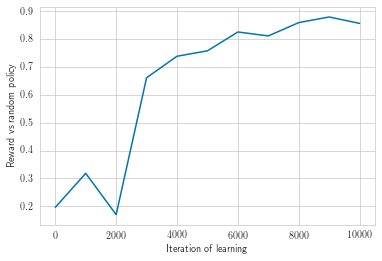

In [101]:
%%time
torch.manual_seed(1)
random.seed(1)
ddqn4 = TicTacToeDoubleDQN(4, 4, 4)
quality = ddqn4.run(10000)
print(quality)

Аналогично для доски 4х4: стало хорошо. Такой график уже радует. Обучается быстрее и стабильнее.

## Часть третья: расширим и углубим поиск
Крестики-нолики -- это, конечно, далеко не го, и обычный альфа-бета поиск с отсечением здесь наверняка может работать идеально вплоть до довольно больших досок. Однако мы всё-таки для этого учебного задания будем реализовывать более практически релевантный метод MCTS -- заодно фактически получится и упражнение на многоруких бандитов.  
Реализуйте rollouts со случайной стратегией и (опционально) rollouts с неслучайной, но простой стратегией (например, основанной на дополнении нескольких паттернов или на Q-функции, которая у вас получилась в первом пункте).  

https://robotics.stackexchange.com/questions/16596/what-is-the-definition-of-rollout-in-neural-network-or-openai-gym  
https://arxiv.org/pdf/1910.00120.pdf  
https://towardsdatascience.com/monte-carlo-tree-search-in-reinforcement-learning-b97d3e743d0f  
https://towardsdatascience.com/monte-carlo-tree-search-implementing-reinforcement-learning-in-real-time-game-player-25b6f6ac3b43  

Напишем функцию, которая проигрывает партию с текущего состояния до конца в соответствии с заданными стратегиями игры:

In [298]:
def rollout(env, x_policy, o_policy, my_side='x', smart_reward=False, render=False):
    policies = [None, x_policy, o_policy]  # для удобства индексации с помощью curTurn
    reward = 0
    done = env.gameOver
    if render: env.printBoard()
    while not done:
        _, reward, done, _ = env.step(policies[env.curTurn](env))
        if render: env.printBoard()
        assert reward != -10
    if smart_reward and my_side == 'o':
        reward = -reward
    return reward

def random_policy(env):
    return env.random_available_action()

Сыграем несколько партий:

In [308]:
env = TicTacToe(3, 3, 3)

env.reset()
print(rollout(env, random_policy, random_policy))

env.reset()
print(rollout(env, random_policy, random_policy))

env.reset()
print(rollout(env, random_policy, random_policy))

1
0
-1


Давайте теперь попробуем играть, проигрывая в уме продолжение партии с помощью ранее написанной функции, и таким образом выбирая наилучшие действия.

Для начала без проигрывания партий в уме (играет случайная стратегия, не имеющая представления, как лучше ходить, против обученной DoubleDQN):

In [383]:
def ddqn3_policy_x(env):
    ddqn3.env = env
    return env.action_from_int(ddqn3.select_greedy_action(ddqn3.models_x[0], ddqn3.state_to_tensor(env.getState())).numpy()[0][0])
    
def mean_reward_without_rollout(n_episodes=100):
    env = TicTacToe(3, 3, 3)
    cum_rewards = 0
    for _ in range(n_episodes):
        env.reset()
        cum_rewards += rollout(env, ddqn3_policy_x, random_policy)
    return cum_rewards / n_episodes

print(mean_reward_without_rollout())

0.76


Видим что обученная ранее стратегия играет лучше нашей случайной.  
А теперь сделаем следующее: у нас нет информации о том, какой ход лучше, но есть информация о том, как противник отвечает на наши ходы, т.е. мы имеем возможность проиграть партию в уме для всех доступных действий. Сделаем это.  
Сейчас наша стратегия станет жёсткой: мы будем однозначно и закономерно выбирать ходы. И стратегия противника жёсткая. Поэтому играть много партий не нужно - они будут одинаковые. Сыграем одну: 

In [385]:
def rollout_policy(env):
    available_actions = env.getEmptySpaces()
    best_action = None
    best_reward = -10
    for action in available_actions:
        env_copy = copy.deepcopy(env)
        env_copy.step(action)
        rollout_reward = rollout(env_copy, ddqn3_policy_x, rollout_policy, 'o', True)
        if rollout_reward > best_reward:
            best_reward = rollout_reward
            best_action = action
    return best_action

def mean_reward_with_rollout(n_episodes=100, render=False):
    env = TicTacToe(3, 3, 3)
    cum_rewards = 0
    for _ in tq.tqdm(range(n_episodes)):
        env.reset()
        env.step(random_policy(env))
        cum_rewards += rollout(env, ddqn3_policy_x, rollout_policy, render=render)
    return cum_rewards / n_episodes

print(mean_reward_with_rollout(1, render=False))


-1.0


Видим, что имея возможность проигрывать продолжение партий в уме, нолики выиграли.

Реализуйте MCTS-поиск с этими rollouts для крестиков-ноликов на досках разного размера, сравните полученные стратегии между собой и со стратегиями, обученными в первых двух частях.

In [235]:
def replace(s, position, character):
    return s[:position] + character + s[position+1:]

In [419]:
C = 0.8

class Node():
    def __init__(self):
        self.parent = None
        self.children = {}
        self.visits = 0
        self.value = 0
        self.state = None
        self.index = 0
        self.storage = None
    
    def ucb(self):
        if self.visits == 0:
            return float('inf')
        return self.value / self.visits + C * math.sqrt(math.log(self.storage[self.parent].visits) / self.visits)
    
    def create_children(self):
        if self.is_leaf():
            np_state = np.array(list(map(int, self.state)))
            available_actions = np.where(np_state == 1)[0]
            if (len(self.state) - len(available_actions)) % 2 == 0:
                curTurn = 1
            else:
                curTurn = -1
            for action in available_actions:
                child = Node()
                child.parent = self.index
                child.state = replace(self.state, action, str(curTurn + 1))
                child.index = len(self.storage)
                child.storage = self.storage
                self.children[action] = child.index
                self.storage.append(child)
    
    def is_leaf(self):
        return len(self.children) == 0
    
    def select_child(self, how="best"):
        eps = 0.7
        if how == "best":
            fun = max
            characteristic = lambda x: self.storage[x[1]].ucb()
        elif how == "worse":
            fun = min
            characteristic = lambda x: self.storage[x[1]].ucb()
        elif how == "random":
            return random.choice(list(self.children.items()))
        elif how == "eps_greedy_best":
            if random.random() < eps:
                return random.choice(list(self.children.items()))
            else:
                fun = max
                characteristic = lambda x: self.storage[x[1]].ucb()
        elif how == "eps_greedy_worse":
            if random.random() < eps:
                return random.choice(list(self.children.items()))
            else:
                fun = min
                characteristic = lambda x: self.storage[x[1]].ucb()  
        else:
            fun = None
            characteristic = None
        if not self.is_leaf():
            return max(self.children.items(), key=characteristic)

In [423]:
class Mcts():
    def __init__(self, n_rows=3, n_cols=3, n_win=3):
        self.env = TicTacToe(n_rows, n_cols, n_win)
        self.env.reset()

        self.nodes = []

        root = Node()
        root.state = self.env.getState()[0]
        root.index = 0
        root.storage = self.nodes
        self.nodes.append(root)
        
        self.current_node = 0
        
    def next_step(self):
        hows = [None, "best", "worse"]
        action, self.current_node = self.nodes[self.current_node].select_child(hows[self.env.curTurn])
        self.env.step(self.env.action_from_int(action))
    
    def selection(self):
        while not self.nodes[self.current_node].is_leaf():
            self.next_step()
    
    def expansion(self):
        if not self.env.gameOver:
            if self.nodes[self.current_node].visits > 0:
                self.nodes[self.current_node].create_children()
                self.next_step()
    
    def simulation(self):
        return rollout(copy.deepcopy(self.env), random_policy, random_policy)
    
    def backpropagation(self, r):
        while self.nodes[self.current_node].parent is not None:
            self.nodes[self.current_node].visits += 1
            self.nodes[self.current_node].value += r
            self.current_node = self.nodes[self.current_node].parent
        self.nodes[self.current_node].visits += 1
        self.nodes[self.current_node].value += r
    
    def learn(self, n_episodes=100000):
        for _ in tq.tqdm(range(n_episodes)):
            assert self.current_node == 0
            self.env.reset()
            self.selection()
            self.expansion()
            r = self.simulation()
            self.backpropagation(r)
            
    def play_greedy_game(self):
        self.env.reset()
        self.env.printBoard()
        self.current_node = 0
        hows = [None, "best", "worse"]
        while not self.nodes[self.current_node].is_leaf():
            action, self.current_node = self.nodes[self.current_node].select_child(hows[self.env.curTurn])
            self.env.step(self.env.action_from_int(action))
            self.env.printBoard()
    
    def mean_reward_vs_random_policy(self, n_episodes=1000, side='x'):
        if side == 'x':
            hows = [None, "best", "random"]
        elif side == 'o':
            hows = [None, "random", "worse"]
        else:
            hows = None
        cum_rewards = 0
        count_games = 0
        for _ in range(n_episodes):
            self.env.reset()
            self.current_node = 0
            while not self.nodes[self.current_node].is_leaf():
                action, self.current_node = self.nodes[self.current_node].select_child(hows[self.env.curTurn])
                _, reward, done, _ = self.env.step(self.env.action_from_int(action))
            if done:
                cum_rewards += reward
                count_games += 1
        mean_reward = cum_rewards / count_games
        print(f"Mean reward vs random policy equal {mean_reward} after {count_games} games.")
        return mean_reward

Реализовали построение дерева. Попробуем построить и посмотреть результаты:

In [379]:
mcts3 = Mcts(3, 3, 3)
mcts3.learn()

Посмотрим на партию жадных стратегий, пользующихся построенным деревом:

In [380]:
mcts3.play_greedy_game()

-------------
|   |   |   | 
-------------
|   |   |   | 
-------------
|   |   |   | 
-------------
-------------
|   |   | x | 
-------------
|   |   |   | 
-------------
|   |   |   | 
-------------
-------------
|   | o | x | 
-------------
|   |   |   | 
-------------
|   |   |   | 
-------------
-------------
|   | o | x | 
-------------
|   | x |   | 
-------------
|   |   |   | 
-------------
-------------
|   | o | x | 
-------------
|   | x |   | 
-------------
|   | o |   | 
-------------
-------------
|   | o | x | 
-------------
| x | x |   | 
-------------
|   | o |   | 
-------------
-------------
| o | o | x | 
-------------
| x | x |   | 
-------------
|   | o |   | 
-------------
-------------
| o | o | x | 
-------------
| x | x |   | 
-------------
|   | o | x | 
-------------


Мы строили дерево недолго, некоторые его листы могут не быть терминальными состояниями в игре. Т.е. может получиться так, что до листа дерева мы прошли,а игра ещё не закончилась. В оценке среднего выигрыша я такие партии игнорировал и брал для оценки только законченные партии. Оценим средний выигрыш против случайной стратегии:

In [381]:
mcts3.mean_reward_vs_random_policy()

Mean reward vs random policy equal 0.7366946778711485 after 357 games.


0.7366946778711485

Аналогично для 4х4:

In [424]:
mcts4 = Mcts(4, 4, 4)
mcts4.learn(1000000)

In [425]:
mcts4.play_greedy_game()

-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
-----------------
|   |   |   |   | 
-----------------
|   | x |   |   | 
-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
-----------------
|   |   |   |   | 
-----------------
|   | x |   | o | 
-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
-----------------
| x |   |   |   | 
-----------------
|   | x |   | o | 
-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
-----------------
| x |   |   |   | 
-----------------
| o | x |   | o | 
-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
-----------------
| x |   |   |   | 
-----------------
| o | x |   | o | 
-----------------
|   |   | x |   | 
-----------------
|   |   |   |   | 
-----------------
----

In [426]:
mcts4.mean_reward_vs_random_policy(1000)

Mean reward vs random policy equal 1.0 after 2 games.


1.0

Результаты 4х4 вызывают некоторые сомнения. Слишком мало игр доигрались до конца.  
Попробую найти этому объяснение. 
* Когда алгоритм выбирает какой-то путь в дереве, он запускает на этом пути rollout. Происходит игра двух случайных стратегий, чтобы определить, к какому результату может привести этот путь. Игра 4х4 достаточно длинная и сложная, чтобы случайная стратегия выигрывала в неё у другой случайной стратегии крайне редко. Поэтому все новые пути, которые даже могли быть хорошими, кажутся алгоритму примерно одинаково неважными. И лишь иногда так получается, что случайные симуляции выделяют какой-то путь на фоне остальных, сыграв несколько показательных партий по этому направлению. После этого алгоритм начинает сильнее углубляться по этим путям и уделять меньше внимания остальным путям в дереве. А т.к. игра 4х4 достаточно длинная (дерево глубокое), то на путях, которым уделяется недостаточно внимания конец игры достигнут будет очень нескоро.  
* Максимальное количество узлов в дереве меняется примерно как факториал количества клеток на доске. Это очень много, начиная с досок размеров 4х4.  

Получаем, что из 1000 партий завершились не многие. Но завершились победой )  
Что с этим можно сделать, как сделать результаты красивее?  
Кажется, что если строить дерево значительно дольше, то мы должны исследовать больше путей в дереве, но я пробовал учить несколько часов, это не сильно помогло, а учить ещё дольше в рамках домашней работы не очень хочется, хочется предложить качественное, а не количественное решение. Я пробовал менять условия выбора действия (делать их менее жадными), но всё это слабо меняет результат, потому что дерево очень большое. Можно попробовать выстраивать линию не из 4 символов, а из трёх, тогда игра будет заканчиваться раньше. Посмотрим...

In [427]:
mcts4short = Mcts(4, 4, 3)
mcts4short.learn(1000000)

In [428]:
mcts4short.play_greedy_game()

-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
-----------------
|   |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
|   | x |   |   | 
-----------------
|   |   |   |   | 
-----------------
-----------------
| o |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
|   | x |   |   | 
-----------------
|   |   |   |   | 
-----------------
-----------------
| o |   |   |   | 
-----------------
|   |   |   |   | 
-----------------
|   | x | x |   | 
-----------------
|   |   |   |   | 
-----------------
-----------------
| o |   |   |   | 
-----------------
|   |   |   | o | 
-----------------
|   | x | x |   | 
-----------------
|   |   |   |   | 
-----------------
-----------------
| o |   |   |   | 
-----------------
|   | x |   | o | 
-----------------
|   | x | x |   | 
-----------------
|   |   |   |   | 
-----------------
----

In [429]:
mcts4short.mean_reward_vs_random_policy(1000)

Mean reward vs random policy equal 0.7209302325581395 after 129 games.


0.7209302325581395

Уже лучше. По такому количеству игр уже можно делать выводы. Думаю, пока я на этом остановлюсь.

Качество игры примерно такое же, как то, которое мы получали, учась другими методами, это похоже на правду.  

Что я понял об MCTS:  
```
+ Просто реализовать
+ Достаточно знать лишь правила игры
- Требователен к ресурсам
- Для сложных игр использовать mcts не просто
```